In [2]:
import os
import sys


os.environ['MOMAPS_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps'
os.environ['MOMAPS_DATA_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps/input'

sys.path.insert(1, os.getenv("MOMAPS_HOME"))
print(f"MOMAPS_HOME: {os.getenv('MOMAPS_HOME')}")


import numpy as np
import logging
import torch

from src.common.lib.dataset import Dataset
from src.datasets.dataset_spd import DatasetSPD
from src.common.lib.utils import load_config_file
from src.common.lib.data_loader import get_dataloader
# from src.common.lib.model import Model
from copy import deepcopy


%load_ext autoreload
%autoreload 2


MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps


In [2]:
def init_logging():
    logging.basicConfig(level=logging.INFO,
                        format="%(asctime)s %(levelname)s %(message)s",
                        datefmt="%Y-%m-%d %H:%M:%S",
                        handlers=[
                            logging.StreamHandler()
                        ])
    
init_logging()

In [3]:
logging.info(f"Is GPU available: {torch.cuda.is_available()}")
logging.info(f"Num GPUs Available: {torch.cuda.device_count()}")

2024-06-13 10:44:39 INFO Is GPU available: True
2024-06-13 10:44:39 INFO Num GPUs Available: 1


In [4]:
config_model = load_config_file("./src/models/neuroself/configs/model_config/TLNeuroselfB78NoDSTestModelConfig", 'model')
config_train = load_config_file('./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig', 'train', config_model.CONFIGS_USED_FOLDER)



logging.info("Init datasets")
dataset_train = DatasetSPD(config_train)


2024-06-10 10:40:58 INFO Init datasets
2024-06-10 10:40:58 INFO Input folder: /home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch7, depth used: 3
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell line (not in cell lines list). FUSHeterozygous
2024-06-10 10:40:58 INFO Skipping cell l

In [5]:
train_indexes, val_indexes, test_indexes = None, None, None
dataset_val, dataset_test = None, None

logging.info(f"Data shape: {dataset_train.X_paths.shape}, {dataset_train.y.shape}")

# if is_one_config_supplied:
dataset_val, dataset_test = deepcopy(dataset_train), deepcopy(dataset_train) # the deepcopy is important. do not change. 
dataset_test.flip, dataset_test.rot = False, False
if config_train.SPLIT_DATA:
    logging.info("Split data...")
    train_indexes, val_indexes, test_indexes = dataset_train.split()
# else:
#     dataset_val, dataset_test = DatasetSPD(config_val), DatasetSPD(config_test)

quick_train_indices = train_indexes[:500]
quick_val_indices = val_indexes[:100]
dataset_train_subset = Dataset.get_subset(dataset_train, quick_train_indices)
dataset_val_subset = Dataset.get_subset(dataset_val, quick_val_indices)


logging.info(f"train len: {len(dataset_train_subset)}, val len: {len(dataset_val_subset)} test len: {len(dataset_test)}")

batch_size = 70#config_model.BATCH_SIZE
num_workers = 1 #2 is advised by the warning log
logging.info(f"Init dataloaders (batch_size: {batch_size}, num_workers: {num_workers})")
dataloader_train, dataloader_val, dataloader_test = get_dataloader(dataset_train_subset, batch_size, num_workers=num_workers),\
                                                    get_dataloader(dataset_val_subset, batch_size, num_workers=num_workers),\
                                                    get_dataloader(dataset_test, batch_size, indexes=test_indexes, num_workers=num_workers)

logging.info(f"\n\n\n\n\nBefore model.load_with_dataloader.. {len(train_indexes)}, {len(val_indexes)}, {len(test_indexes)}")




2024-06-10 10:40:58 INFO Data shape: (397,), (397, 1)
2024-06-10 10:40:58 INFO Split data...
2024-06-10 10:40:58 INFO Split data by set (train/val/test): 0.7
2024-06-10 10:40:58 INFO Train set: 277 277
2024-06-10 10:40:58 INFO Validation set: 60 60
2024-06-10 10:40:58 INFO Test set: 60 60
2024-06-10 10:40:58 WARNING 

TODO: Sagy, to implment _labels_changepoints (if needed) + return markers_order!
2024-06-10 10:40:58 INFO train len: 277, val len: 60 test len: 397
2024-06-10 10:40:58 INFO Init dataloaders (batch_size: 70, num_workers: 1)
2024-06-10 10:40:58 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-10 10:40:58 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-10 10:40:58 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-10 10:40:58 INFO 




Before model.load_with_dataloader.. 277, 60, 60


-------------------------

# Models

## ViT

In [4]:
import math
from transformers import AutoImageProcessor, Dinov2Model, AutoBackbone
import torch
from torch import nn, optim, Tensor
import torchvision
from torch.utils.data import Subset
from torchvision import transforms, models
from torch.utils.data import DataLoader


from datasets import load_dataset

from torch.cuda.amp import autocast
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.tensorboard import SummaryWriter
import torch.nn.functional as F
import random
from sklearn.model_selection import train_test_split
import os
import numpy as np
from PIL import Image
from tqdm import tqdm
from collections import OrderedDict
from typing import Optional, Type, Union
import logging
from datetime import datetime
from copy import deepcopy
from info_nce import InfoNCE, info_nce


import matplotlib.pyplot as plt

2024-06-13 10:44:52 INFO PyTorch version 2.2.2 available.


In [ ]:
# https://github.com/broadinstitute/DINO4Cells_code/blob/main/main_dino.py

class DINOLoss(nn.Module):
    def __init__(
        self,
        out_dim,
        ncrops,
        warmup_teacher_temp,
        teacher_temp,
        warmup_teacher_temp_epochs,
        nepochs,
        student_temp=0.1,
        center_momentum=0.9,
    ):
        super().__init__()
        self.student_temp = student_temp
        self.center_momentum = center_momentum
        self.ncrops = ncrops
        self.register_buffer("center", torch.zeros(1, out_dim))
        # we apply a warm up for the teacher temperature because
        # a too high temperature makes the training instable at the beginning
        self.teacher_temp_schedule = np.concatenate(
            (
                np.linspace(
                    warmup_teacher_temp, teacher_temp, warmup_teacher_temp_epochs
                ),
                np.ones(nepochs - warmup_teacher_temp_epochs) * teacher_temp,
            )
        )

    def forward(self, student_output, teacher_output, epoch):
        """
        Cross-entropy between softmax outputs of the teacher and student networks.
        """
        student_out = student_output / self.student_temp
        student_out = student_out.chunk(self.ncrops)

        # teacher centering and sharpening
        temp = self.teacher_temp_schedule[epoch]
        teacher_out = F.softmax((teacher_output - self.center) / temp, dim=-1)
        teacher_out = teacher_out.detach().chunk(2)

        total_loss = 0
        n_loss_terms = 0
        for iq, q in enumerate(teacher_out):
            for v in range(len(student_out)):
                if v == iq:
                    # we skip cases where student and teacher operate on the same view
                    continue
                loss = torch.sum(-q * F.log_softmax(student_out[v], dim=-1), dim=-1)
                total_loss += loss.mean()
                n_loss_terms += 1
        total_loss /= n_loss_terms
        self.update_center(teacher_output)
        return total_loss

    @torch.no_grad()
    def update_center(self, teacher_output):
        """
        Update center used for teacher output.
        """
        batch_center = torch.sum(teacher_output, dim=0, keepdim=True)
        dist.all_reduce(batch_center)
        batch_center = batch_center / (len(teacher_output) * dist.get_world_size())

        # ema update
        self.center = self.center * self.center_momentum + batch_center * (
            1 - self.center_momentum
        )

In [121]:
class NovaModel(nn.Module):
    def __init__(self, n_classes=None, device='cuda'):
        super().__init__()
        
        self.backbone_feature_dim = 768#384
        self.number_of_heads = 16
        self.n_classes = n_classes
        
        self.device = device
        
        # 2 channels to 1
        # self.prep_input = nn.Conv2d(2, 3, kernel_size=1, device=self.device, bias=False).to(self.device)  
        
        # dino
        model_name = "facebook/dinov2-base"
        self.backbone_image_processor = AutoImageProcessor.from_pretrained(model_name)
        self.backbone = Dinov2Model.from_pretrained(model_name).to(self.device)
        
        self.scaler = MinMaxScaling()
        
        if n_classes is not None:
            # Inference only!
            
            # self.head = MLPHead(self.backbone_feature_dim, 256, n_classes)
            self.head = MLPHead(self.backbone_feature_dim, 196, self.n_classes).to(self.device)
        
        
        # self.transform = transforms.Compose([
        #     # transforms.Resize(224, interpolation=transforms.InterpolationMode.BILINEAR),
        #     # transforms.CenterCrop(224),
        #     # transforms.ToTensor(),
        #     # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        # ])
        
    def __forward_backbone(self, x):
        # x = self.scaler(x)
        # NOTE: do_rescale=False ! it's important to set it to False, otherwise it doesn't learn right!
        # print(f"Before preproc: {torch.mean(x), torch.std(x), torch.max(x), torch.min(x)}")
        # plt.imshow(torch.permute(x[0,:,...].cpu(), (1,2,0)))
        # plt.show()
        # x = self.transform(x)
        # x = self.backbone_image_processor(x, return_tensors="pt", do_rescale=False, do_normalize=False).to(self.device)['pixel_values']
        # plt.imshow(torch.permute(x[0,:,...].cpu(), (1,2,0)))
        # plt.show()
        # print(f"After preproc: {torch.mean(x), torch.std(x), torch.max(x), torch.min(x)}")
        
        x = self.backbone(pixel_values=x, output_hidden_states=False)#.to(self.device)        
        
        return x
    
    def forward(self, x):
        x = x.to(self.device)
        
        # x = self.prep_input(x)
        x = x.repeat(1, 3)
        print(x.shape)
        x = self.__forward_backbone(x)
        
        last_hidden_state = x.last_hidden_state # batch_size,1+16*16,384
        
        cls_embeddings = last_hidden_state[:,0]
        pathc_embeddings = last_hidden_state[:,1:]
        
        prediction = self.head(cls_embeddings)
        
        return prediction
    
    def infer(self, x):
        x = x.to(self.device)
        
        print(f"before: {x.shape}")
        x = x[:,[0],...]
        print(f"taking only target channel: {x.shape}")
        x = x.repeat(1,3,1,1)
        print(f"after: {x.shape}")
        # x = self.prep_input(x)
        x = self.__forward_backbone(x)
        
        last_hidden_state = x.last_hidden_state
        
        return last_hidden_state

class MinMaxScaling:
    def __call__(self, x):
        # Assume x is a numpy array of shape [Height, Width, 2]
        # Convert numpy array to tensor
        # x = torch.from_numpy(x).float()  # Convert to float to ensure proper division
        
        device = x.device
        
        # Min-Max scaling
        min_val = torch.min(x)
        max_val = torch.max(x)
        
        if max_val - min_val != 0:
            x = (x - min_val) / (max_val - min_val)
        else:
            x = torch.zeros_like(x)  # Avoid division by zero

        x = x.to(device)
        return x

In [122]:
class NovaTrainer:
    def __init__(self, model, lr=3e-4, num_epochs=10,
                 early_stopping_patience=5, lr_reduce_patience=3,
                 tensorbord_path=None, checkpoint_folder_path="", device='cuda',
                 fabric=None):
        super().__init__()
        self.device = device
        # self.fabric = fabric
        self.model = model.to(self.device)
        self.optimizer = optim.AdamW(self.model.parameters(), lr=lr)
        
        # fabric the model and optimizer:
        # self.model, self.optimizer = self.fabric.setup(self.model, self.optimizer)

        
        # self.loss_fn = CombinedLoss(pred_lambda=0.5, device=device)
        self.num_epochs = num_epochs
        self.early_stopping_patience = early_stopping_patience
        self.lr_reduce_patience = lr_reduce_patience
        self.lr_scheduler = ReduceLROnPlateau(self.optimizer, 'min', patience=self.lr_reduce_patience, verbose=True)
        self.writer = None
        if tensorbord_path is not None:
            self.tensorbord_path = tensorbord_path
            self.writer = SummaryWriter(self.tensorbord_path)
        self.checkpoint_folder_path = checkpoint_folder_path
        
    def __run_one_batch(self, batch, is_train=True, is_infer=False):
        if is_train:
            self.optimizer.zero_grad()
            
        # anchors, positives, negatives, labels = batch
        x = batch['image'].float()
        
        # anchors = anchors#.to(self.device)
        # positives = positives#.to(self.device)
        # negatives = negatives#.to(self.device)
        # labels = labels#.to(self.device)
        
        # print("anchor")
        # plt.imshow(anchors[0,0,...].cpu())
        # plt.show()
        
        # print("positives")
        # plt.imshow(positives[0,0,...].cpu())
        # plt.show()
        
        # print("negatives")
        # plt.imshow(negatives[0,0,...].cpu())
        # plt.show()
        # output = self.model(images)
        
        # loss = nt_xent_loss(output)
        
        if is_infer:    
            # output = self.model.infer(anchors)
            # return output, labels
            
            
            output = self.model.infer(x)
            return output
            
#         output = self.model(anchors, positives, negatives)
#         # output = output + (anchors, positives, negatives)
        
#         anchor_output = output[0]#.view(output[0].size(0), -1)
#         positive_output = output[1]#.view(output[1].size(0), -1)
#         negative_output = output[2]#.view(output[2].size(0), -1)
#         anchor_local_output = output[3]#.view(output[3].size(0), -1)
#         positive_local_output = output[4]#.view(output[4].size(0), -1)
#         negative_local_output = output[5]#.view(output[5].size(0), -1)
#         attention = output[6]
#         # attention_weights = output[7]
#         attention_p = output[8]
#         # attention_p_weights = output[9]
#         # attention_weights_n2a = output[7]
#         predictions = output[-1]
        
#         # anchor_recon = output[3]
#         # positive_recon = output[4]
#         # negative_recon = output[5]

#         # loss = self.loss_fn(anchor_output, positive_output, negative_output)
#         loss = self.loss_fn(anchor_output, positive_output, negative_output,\
#                             anchor_local_output, positive_local_output, negative_local_output,\
#                                 attention, attention_p, predictions, labels)
#         # loss = self.loss_fn(anchor_output, positive_output, negative_output, anchor_recon, positive_recon, negative_recon, anchors, positives, negatives)
#         # loss = self.loss_fn(*output)
#         logging.info(f"loss: {loss}")
        
#         # logging.info(f"pred shape: {predictions.shape};")
#         y_hat = predictions.argmax(dim=1, keepdim=True).squeeze()
#         logging.info(f"y_hat.shape: {y_hat.shape}")
#         # logging.info(f"y hat : {y_hat}")
#         # logging.info(f"labels: {labels}")
#         correct = (y_hat == labels).sum().item()
#         # logging.info(f"correct: {correct}")
#         accuracy = correct * 100.0 / len(y_hat)
#         logging.info(f"acc:{accuracy}%")
        
#         if is_train:
#             # loss.backward()
#             self.fabric.backward(loss)
#             self.optimizer.step()

#         return loss, output
        
    def __run_one_epoch(self, dataloader, is_train=True, is_infer=False):
        self.model.train(is_train)
        losses = []
        
        total_batches = len(dataloader)
        logging.info(f"Starting processing {total_batches} batches.")
        
        # for batch in tqdm(dataloader):
        for batch_idx, batch in enumerate(tqdm(dataloader)):
            logging.info(f"Processing batch {batch_idx+1}/{total_batches}")
            # gpu_inf = getfreegpumem(0)
            # logging.info(f"[batch={batch_idx+1}] GPU: Free: {gpu_inf[0]}, Used: {gpu_inf[1]}, Total: {gpu_inf[2]}")
            
            # with autocast():
            batch_output = self.__run_one_batch(batch, is_train=is_train, is_infer=is_infer)
            
            
            # if is_infer:
            #     output, label = batch_output
            #     return output, label
            
            if is_infer:
                output = batch_output
                true_labels = batch['label']
                return output, true_labels
            
#             loss, output = batch_output
#             losses.append(loss.item())
            
#             del output
#             torch.cuda.empty_cache()  # If using a CUDA device
            
            
#         return np.mean(losses)
        
#     def save_checkpoint(self, state, filename="checkpoint.pth.tar"):
#         logging.info("=> Saving checkpoint")
#         torch.save(state, filename)
        
#     def load_checkpoint(self, filename="checkpoint.pth.tar"):
#         if os.path.isfile(filename):
#             logging.info(f"=> Loading checkpoint '{filename}'")
#             checkpoint = torch.load(filename)
#             self.model.load_state_dict(checkpoint['state_dict'])
#             self.optimizer.load_state_dict(checkpoint['optimizer'])
#             return checkpoint
        
#         logging.info("=> No checkpoint found")
    
#     def __find_last_updated_checkpoint(self):
#         # List all files in the directory
#         checkpoint_files = [os.path.join(self.checkpoint_folder_path, f) for f in os.listdir(self.checkpoint_folder_path) if f.endswith('.pth.tar')]
#         # Check if there are any checkpoint files
#         if not checkpoint_files:
#             logging.info("Checkpoints folder is empty")
#             return None
        
#         # Find the file with the latest modification time
#         last_updated_file = max(checkpoint_files, key=os.path.getmtime)
#         return last_updated_file
    
#     def fit(self, train_dataloader, val_dataloder):
#         # Load the last checkpoint if available
#         # last_updated_checkpoint_file = self.__find_last_updated_checkpoint()
#         # checkpoint = self.load_checkpoint(last_updated_checkpoint_file) if last_updated_checkpoint_file is not None else None
        
#         init_epoch, early_stop_counter, best_val_loss, best_epoch = 0, 0, float('inf'), None
#         # if checkpoint is not None:
#         #     logging.info(f"checkpoint was found! {last_updated_checkpoint_file}")
#         #     init_epoch, early_stop_counter, best_val_loss, best_epoch = checkpoint['epoch'],\
#         #                                                             checkpoint['early_stop_counter'],\
#         #                                                             checkpoint['best_val_loss'],\
#         #                                                             checkpoint['best_epoch'],
#         # else:
#         #     logging.info("No checkpoint was not found..")
        
#         early_stopping = EarlyStopping(patience=self.early_stopping_patience,
#                                        verbose=True, counter=early_stop_counter,
#                                       best_val_loss=best_val_loss)
        
#         for epoch in range(self.num_epochs):
            
#             if epoch < init_epoch:
#                 logging.info(f"[Epoch {epoch}] init_epoch ({init_epoch}) is bigger than epoch ({epoch}). Skipping")
#                 continue
            
#             logging.info(f"Epoch: {epoch}/{self.num_epochs}")
#             # logging.info("----------------------------")
#             logging.info(f"[Epoch {epoch}] training set")
            
#             loss_train = self.__run_one_epoch(train_dataloader, is_train=True)
            
#             if self.fabric.is_global_zero:

            
#                 self.writer.add_scalar('Training Loss', loss_train, epoch)
                
#                 logging.warning(f"[Epoch {epoch}] Training loss: {loss_train}")
                
                
#                 with torch.no_grad():
#                     logging.info(f"[Epoch {epoch}] validation set")
#                     loss_eval = self.__run_one_epoch(val_dataloder, is_train=False)
                    
                    
#                     logging.info("")
#                     logging.info("")
#                     logging.warn("##############################################")
#                     logging.info("")
#                     logging.info("")
#                     logging.info(f"[Epoch {epoch}]  loss train: {loss_train}, loss eval: {loss_eval} (best={best_val_loss})")
            
#                 # Determine if this is the best model
#                 is_best = loss_eval < best_val_loss
#                 if is_best:
#                     logging.info(f"[Epoch {epoch}] new best val loss: {loss_eval} (old={best_val_loss})")
#                     best_val_loss = loss_eval
#                     best_epoch = epoch
                
#                 self.writer.add_scalar('Validation Loss', loss_eval, epoch)
                
#                 # logging.info(f"[Epoch {epoch}] Saving checkpoint")
#                 # save_filename = os.path.join(self.checkpoint_folder_path, f"checkpoint_epoch_{epoch}.pth.tar")
#                 # self.save_checkpoint({
#                 #     'epoch': epoch + 1,
#                 #     'state_dict': self.model.state_dict(),
#                 #     'optimizer': self.optimizer.state_dict(),
#                 #     'best_val_loss': best_val_loss,
#                 #     'best_epoch': best_epoch,
#                 #     'early_stop_counter': early_stopping.counter
#                 # }, filename=save_filename)
                
#                 # logging.info(f"[Epoch {epoch}] Checkpoint saved: {save_filename}")
                
#                 early_stopping(loss_eval)
                
#                 logging.info("")
#                 logging.info("")
#                 logging.warn("##############################################")
#                 logging.info("")
#                 logging.info("")
                
                
#                 if early_stopping.early_stop:
#                     logging.info(f"[Epoch {epoch}] Early stopping")
#                     break
                    
#                 # Adjust learning rate based on val_loss
#                 self.lr_scheduler.step(loss_eval)
            
#             if self.writer is not None:
#                 self.writer.close()
            
        # logging.info("Finished training")
        
    # def infer(self, test_dataloader):
    #     with torch.no_grad():
    #         outputs, true_labels = self.__run_one_epoch(test_dataloader, is_train=False, is_infer=True)
    #         return outputs, true_labels
    
    def infer(self, test_dataloader):
        with torch.no_grad():
            outputs, true_labels = self.__run_one_epoch(test_dataloader, is_train=False, is_infer=True)
            return outputs, true_labels
            

In [123]:
model = NovaModel()

## Train

## Test

In [124]:
trainer = NovaTrainer(model)

quick_test_indices = test_indexes[:50]
dataset_test_subset = Dataset.get_subset(dataset_test, quick_test_indices)


logging.info(f"test len: {len(dataset_test)}")

batch_size = 200#config_model.BATCH_SIZE
num_workers = 1 #2 is advised by the warning log
logging.info(f"Init dataloaders (batch_size: {batch_size}, num_workers: {num_workers})")
dataloader_test = get_dataloader(dataset_test_subset, batch_size, num_workers=num_workers)

logging.info(f"\n\n\n\n\nBefore model.load_with_dataloader..test: {len(quick_test_indices)}")

2024-06-10 11:10:19 INFO test len: 397
2024-06-10 11:10:19 INFO Init dataloaders (batch_size: 200, num_workers: 1)
2024-06-10 11:10:19 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-10 11:10:19 INFO 




Before model.load_with_dataloader..test: 50


In [ ]:
embeddings, true_labels = trainer.infer(dataloader_test)

embeddings = embeddings[:,0,...] # Taking only the CLS token

In [126]:
print(embeddings.shape, true_labels.shape)
print(np.unique(true_labels))

torch.Size([368, 768]) torch.Size([368])
[0 1]


In [127]:
import umap
import matplotlib.pyplot as plt

def compute_umap_embeddings(embeddings, n_neighbors=15, min_dist=0.1, n_components=2, random_state=42):
    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components, random_state=random_state)
    umap_embeddings = reducer.fit_transform(embeddings)
    return umap_embeddings

def plot_umap_embeddings(umap_embeddings, labels, title='UMAP projection of Embeddings', cmap='Set1'):
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(umap_embeddings[:, 0], umap_embeddings[:, 1], c=labels, cmap=cmap, s=10)
    plt.xlabel('UMAP-1')
    plt.ylabel('UMAP-2')
    plt.title(title)
    # plt.grid(True)
    plt.show()
    


/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


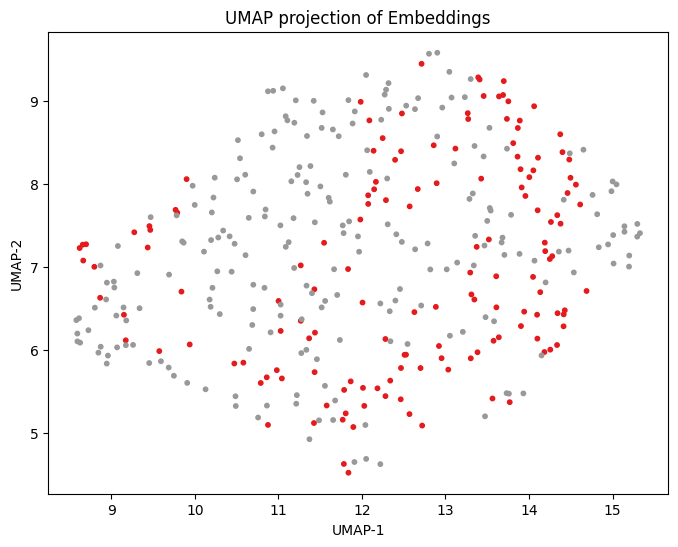

In [128]:
# Compute UMAP embeddings
umap_embeddings = compute_umap_embeddings(embeddings.view(embeddings.shape[0], -1).cpu())

# Plot UMAP embeddings
plot_umap_embeddings(umap_embeddings, true_labels.cpu())

In [ ]:
# model.load_with_dataloader(dataloader_train, dataloader_val, dataloader_test)

# logging.info("[Start] Training..")

# model.train_with_dataloader()

# logging.info("[End] Training..")

-------------------------------

# Dino4Cells paper

In [2]:
import os
import sys


os.environ['MOMAPS_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps'
os.environ['MOMAPS_DATA_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps/input'

sys.path.insert(1, os.getenv("MOMAPS_HOME"))
print(f"MOMAPS_HOME: {os.getenv('MOMAPS_HOME')}")


import numpy as np
import logging
import torch

from src.common.lib.dataset import Dataset
from src.datasets.dataset_spd import DatasetSPD
from src.common.lib.utils import load_config_file
from src.common.lib.data_loader import get_dataloader
import datetime
# from src.common.lib.model import Model
from copy import deepcopy
import matplotlib.pyplot as plt
%matplotlib inline

%load_ext autoreload
%autoreload 2


MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps


## DINO

In [2]:
from sandbox.eval_new_arch.dino4cells.main_dino import train_dino

class DictToObject:
    def __init__(self, dict_obj):
        for key, value in dict_obj.items():
            if isinstance(value, dict):
                # Recursively convert dictionaries to objects
                setattr(self, key, DictToObject(value))
            else:
                setattr(self, key, value)

config = {
        'seed': 1,
        'embedding': {
            'image_size': 100
        },
        'patch_size': 16,
        'num_channels': 2,
        'out_dim': 2048,
        'use_bn_in_head': True,#False,
        'norm_last_layer': False,
        
        'local_crops_number': 4,#8,
        'warmup_teacher_temp': 0.04,
        'teacher_temp': 0.04,#0.04,
        'warmup_teacher_temp_epochs': 2,#30,
        'epochs': 100,
        'student_temp': 0.2,#0.1,
        'center_momentum': 0.9,
        'momentum_teacher': 0.995,#92,#0.996,
        
        'lr':0.0005,
        'min_lr': 1e-6,
        'warmup_epochs': 3,
        
        'weight_decay': 0.04,
        'weight_decay_end': 0.4,
    
        'freeze_last_layer': 1,
        
        
        'batch_size_per_gpu': 150,#3,#65,
        'num_workers': 6,
        
        'accumulation_steps': 1,
        
        'logs_dir':"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/dino4cells/logs",
        'tensorboard_root_folder': "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/dino4cells/tensorboard"
    }
config = DictToObject(config)

#Subset
# config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

#Full
config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

train_dino(config, config_data_path)

2024-06-17 15:43:31 INFO config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig
2024-06-17 15:43:32 INFO 13707, (13707, 1)
2024-06-17 15:43:32 INFO Split data...
2024-06-17 15:43:32 INFO Split data by set (train/val/test): 0.7
2024-06-17 15:43:32 INFO Train set: 9594 9594
2024-06-17 15:43:32 INFO Validation set: 2056 2056
2024-06-17 15:43:32 INFO Test set: 2057 2057
2024-06-17 15:43:32 WARNING 

TODO: Sagy, to implment _labels_changepoints (if needed) + return markers_order!
2024-06-17 15:43:32 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-17 15:43:32 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-17 15:43:32 INFO Data loaded: there are 9594 images.


MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig


/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/torch/nn/utils/weight_norm.py:28: UserWarning: torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.
  warnings.warn("torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.")
2024-06-17 15:43:35 INFO Loss, optimizer and schedulers ready.
2024-06-17 15:43:35 INFO Starting DINO training !
  0%|          | 0/100 [00:00<?, ?it/s]2024-06-17 15:43:35 INFO Epoch: [0/100]
2024-06-17 15:43:35 INFO **************************** TRAINING (epoch=0) ***********************************
2024-06-17 15:43:42 INFO Resources (Free, Used, Total): [('47427 MiB', '1042 MiB', '49140 MiB')]
2024-06-17 15:43:42 INFO Resources (Free, Used, Total): [('47427 MiB', '1042 MiB', '49140 MiB')]
2024-06-17 15:43:42 INFO Resources (Free, Used, Total): [('47427 MiB', '1042 MiB', '49140 MiB')]
2024-06-17 15:43:42 INFO Resources (Free, Used, Total): [('47427 

Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 15:43:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 15:43:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)

2024-06-17 15:43:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)



2024-06-17 15:43:43 INFO Resources (Free, Used, Total): [('47427 MiB', '1042 MiB', '49140 MiB')]
2024-06-17 15:43:43 INFO Resources (Free, Used, Total): [('47427 MiB', '1042 MiB', '49140 MiB')]
2024-06-17 15:43:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2306, 2, 100, 100]), Image local shape: torch.Size([4612, 2, 40, 40]), output_labels_global global shape: (2306,)


2024-06-17 15:43:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2326, 2, 100, 100]), Image local shape: torch.Size([4652, 2, 40, 40]), output_labels_global global shape: (2326,)


2024-06-17 15:43:46 INFO [Training epoch=0] batch number: 0/64
2024-06-17 15:43:47 INFO Resources (Free, Used, Total): [('47187 MiB', '1282 MiB', '49140 MiB')]
2024-06-17 15:43:47 INFO global: torch.Size([2306, 2, 100, 100]), local: torch.Size([4612, 2, 40, 40])
2024-06-17 15:43:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:43:48 INFO Resources (Free, Used, Total): [('45493 MiB', '2976 MiB', '49140 MiB')]
/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1711403392949/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,
2024-06-17 15:43:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2152, 2, 100, 100]), Image local shape: torch.Size([4304, 2, 40, 40]), output_labels_global global shape: (2152,)


2024-06-17 15:43:48 INFO Resources (Free, Used, Total): [('44221 MiB', '4248 MiB', '49140 MiB')]
2024-06-17 15:43:48 INFO Resources (Free, Used, Total): [('44221 MiB', '4248 MiB', '49140 MiB')]
2024-06-17 15:43:48 INFO Resources (Free, Used, Total): [('44221 MiB', '4248 MiB', '49140 MiB')]
2024-06-17 15:43:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 15:43:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:43:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)Image global shape: torch.Size([2336, 2, 100, 100]), Image local shape: torch.Size([4672, 2, 40, 40]), output_labels_global global shape: (2336,)



2024-06-17 15:43:49 INFO Resources (Free, Used, Total): [('29187 MiB', '19282 MiB', '49140 MiB')]
2024-06-17 15:43:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 15:43:51 INFO ***** [epoch 0] train loss: 7.582030773162842 *****
2024-06-17 15:43:51 INFO Calculating grads
2024-06-17 15:43:51 INFO Updating student
2024-06-17 15:43:51 INFO Updating teacher..
2024-06-17 15:43:51 INFO [Training epoch=0] batch number: 1/64
2024-06-17 15:43:51 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 15:43:52 INFO Resources (Free, Used, Total): [('6989 MiB', '41480 MiB', '49140 MiB')]
2024-06-17 15:43:52 INFO ***** [epoch 0] train loss: 7.595439910888672 *****
2024-06-17 15:43:52 INFO Calculating grads
2024-06-17 15:43:52 INFO Updating student
2024-06-17 15:43:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 15:43:53 INFO Updating teacher..
2024-06-17 15:43:53 INFO [Training epoch=0] batch number: 2/64
2024-06-17 15:43:53 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 15:43:54 INFO ***** [epoch 0] train loss: 7.60048770904541 *****
2024-06-17 15:43:54 INFO Calculating grads
2024-06-17 15:43:54 INFO Updating student
2024-06-17 15:43:54 INFO Updating teacher..
2024-06-17 15:43:54 INFO [Training epoch=0] batch number: 3/64
2024-06-17 15:43:55 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 15:43:55 INFO ***** [epoch 0] train loss: 7.603818416595459 *****
2024-06-17 15:43:55 INFO Calculating grads
2024-06-17 15:43:55 INFO Updating student
2024-06-17 15:43:56 INFO Resources (Free, Used, Total): [('6989 MiB', '41480 MiB', '49140 MiB')]
2024-06-17 15:43:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2346, 2, 100, 100]), Image local shape: torch.Size([4692, 2, 40, 40]), output_labels_global global shape: (2346,)


2024-06-17 15:43:56 INFO Updating teacher..
2024-06-17 15:43:56 INFO [Training epoch=0] batch number: 4/64
2024-06-17 15:43:56 INFO global: torch.Size([2204, 2, 100, 100]), local: torch.Size([4408, 2, 40, 40])
2024-06-17 15:43:57 INFO ***** [epoch 0] train loss: 7.608055114746094 *****
2024-06-17 15:43:57 INFO Calculating grads
2024-06-17 15:43:57 INFO Updating student
2024-06-17 15:43:57 INFO Resources (Free, Used, Total): [('6989 MiB', '41480 MiB', '49140 MiB')]
2024-06-17 15:43:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2242, 2, 100, 100]), Image local shape: torch.Size([4484, 2, 40, 40]), output_labels_global global shape: (2242,)


2024-06-17 15:43:57 INFO Updating teacher..
2024-06-17 15:43:57 INFO [Training epoch=0] batch number: 5/64
2024-06-17 15:43:58 INFO global: torch.Size([2326, 2, 100, 100]), local: torch.Size([4652, 2, 40, 40])
2024-06-17 15:43:59 INFO Resources (Free, Used, Total): [('21661 MiB', '26808 MiB', '49140 MiB')]
2024-06-17 15:43:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 15:43:59 INFO ***** [epoch 0] train loss: 7.613884925842285 *****
2024-06-17 15:43:59 INFO Calculating grads
2024-06-17 15:43:59 INFO Updating student
2024-06-17 15:44:00 INFO Updating teacher..
2024-06-17 15:44:00 INFO [Training epoch=0] batch number: 6/64
2024-06-17 15:44:00 INFO Resources (Free, Used, Total): [('5219 MiB', '43250 MiB', '49140 MiB')]
2024-06-17 15:44:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 15:44:01 INFO global: torch.Size([2336, 2, 100, 100]), local: torch.Size([4672, 2, 40, 40])
2024-06-17 15:44:02 INFO Resources (Free, Used, Total): [('26659 MiB', '21810 MiB', '49140 MiB')]
2024-06-17 15:44:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 15:44:02 INFO ***** [epoch 0] train loss: 7.619593143463135 *****
2024-06-17 15:44:02 INFO Calculating grads
2024-06-17 15:44:02 INFO Updating student
2024-06-17 15:44:03 INFO Updating teacher..
2024-06-17 15:44:03 INFO [Training epoch=0] batch number: 7/64
2024-06-17 15:44:04 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 15:44:05 INFO Resources (Free, Used, Total): [('5737 MiB', '42732 MiB', '49140 MiB')]
2024-06-17 15:44:05 INFO ***** [epoch 0] train loss: 7.619649410247803 *****
2024-06-17 15:44:05 INFO Calculating grads
2024-06-17 15:44:05 INFO Updating student
2024-06-17 15:44:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 15:44:05 INFO Updating teacher..
2024-06-17 15:44:05 INFO [Training epoch=0] batch number: 8/64
2024-06-17 15:44:05 INFO global: torch.Size([2152, 2, 100, 100]), local: torch.Size([4304, 2, 40, 40])
2024-06-17 15:44:06 INFO ***** [epoch 0] train loss: 7.624645233154297 *****
2024-06-17 15:44:06 INFO Calculating grads
2024-06-17 15:44:06 INFO Updating student
2024-06-17 15:44:07 INFO Updating teacher..
2024-06-17 15:44:07 INFO [Training epoch=0] batch number: 9/64
2024-06-17 15:44:07 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 15:44:07 INFO Resources (Free, Used, Total): [('5733 MiB', '42736 MiB', '49140 MiB')]
2024-06-17 15:44:08 INFO ***** [epoch 0] train loss: 7.626718044281006 *****
2024-06-17 15:44:08 INFO Calculating grads
2024-06-17 15:44:08 INFO Updating student
2024-06-17 15:44:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 15:44:08 INFO Updating teacher..
2024-06-17 15:44:08 INFO [Training epoch=0] batch number: 10/64
2024-06-17 15:44:08 INFO global: torch.Size([2164, 2, 100, 100]), local: torch.Size([4328, 2, 40, 40])
2024-06-17 15:44:09 INFO ***** [epoch 0] train loss: 7.631106853485107 *****
2024-06-17 15:44:09 INFO Calculating grads
2024-06-17 15:44:09 INFO Updating student
2024-06-17 15:44:10 INFO Updating teacher..
2024-06-17 15:44:10 INFO [Training epoch=0] batch number: 11/64
2024-06-17 15:44:10 INFO Resources (Free, Used, Total): [('5733 MiB', '42736 MiB', '49140 MiB')]
2024-06-17 15:44:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 15:44:10 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 15:44:11 INFO ***** [epoch 0] train loss: 7.631534576416016 *****
2024-06-17 15:44:11 INFO Calculating grads
2024-06-17 15:44:11 INFO Updating student
2024-06-17 15:44:11 INFO Resources (Free, Used, Total): [('5727 MiB', '42742 MiB', '49140 MiB')]
2024-06-17 15:44:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 15:44:11 INFO Updating teacher..
2024-06-17 15:44:11 INFO [Training epoch=0] batch number: 12/64
2024-06-17 15:44:12 INFO global: torch.Size([2178, 2, 100, 100]), local: torch.Size([4356, 2, 40, 40])
2024-06-17 15:44:12 INFO ***** [epoch 0] train loss: 7.634960174560547 *****
2024-06-17 15:44:12 INFO Calculating grads
2024-06-17 15:44:12 INFO Updating student
2024-06-17 15:44:13 INFO Resources (Free, Used, Total): [('5727 MiB', '42742 MiB', '49140 MiB')]
2024-06-17 15:44:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2132, 2, 100, 100]), Image local shape: torch.Size([4264, 2, 40, 40]), output_labels_global global shape: (2132,)


2024-06-17 15:44:13 INFO Updating teacher..
2024-06-17 15:44:13 INFO [Training epoch=0] batch number: 13/64
2024-06-17 15:44:13 INFO global: torch.Size([2346, 2, 100, 100]), local: torch.Size([4692, 2, 40, 40])
2024-06-17 15:44:15 INFO Resources (Free, Used, Total): [('11661 MiB', '36808 MiB', '49140 MiB')]
2024-06-17 15:44:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 15:44:15 INFO ***** [epoch 0] train loss: 7.635852336883545 *****
2024-06-17 15:44:15 INFO Calculating grads
2024-06-17 15:44:15 INFO Updating student
2024-06-17 15:44:16 INFO Updating teacher..
2024-06-17 15:44:16 INFO [Training epoch=0] batch number: 14/64
2024-06-17 15:44:16 INFO Resources (Free, Used, Total): [('5625 MiB', '42844 MiB', '49140 MiB')]
2024-06-17 15:44:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2436, 2, 100, 100]), Image local shape: torch.Size([4872, 2, 40, 40]), output_labels_global global shape: (2436,)


2024-06-17 15:44:17 INFO global: torch.Size([2242, 2, 100, 100]), local: torch.Size([4484, 2, 40, 40])
2024-06-17 15:44:18 INFO Resources (Free, Used, Total): [('5441 MiB', '43028 MiB', '49140 MiB')]
2024-06-17 15:44:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2154, 2, 100, 100]), Image local shape: torch.Size([4308, 2, 40, 40]), output_labels_global global shape: (2154,)


2024-06-17 15:44:18 INFO ***** [epoch 0] train loss: 7.638072967529297 *****
2024-06-17 15:44:18 INFO Calculating grads
2024-06-17 15:44:18 INFO Updating student
2024-06-17 15:44:18 INFO Updating teacher..
2024-06-17 15:44:18 INFO [Training epoch=0] batch number: 15/64
2024-06-17 15:44:18 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 15:44:19 INFO ***** [epoch 0] train loss: 7.6400346755981445 *****
2024-06-17 15:44:19 INFO Calculating grads
2024-06-17 15:44:19 INFO Updating student
2024-06-17 15:44:20 INFO Updating teacher..
2024-06-17 15:44:20 INFO [Training epoch=0] batch number: 16/64
2024-06-17 15:44:20 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 15:44:20 INFO Resources (Free, Used, Total): [('5441 MiB', '43028 MiB', '49140 MiB')]
2024-06-17 15:44:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2120, 2, 100, 100]), Image local shape: torch.Size([4240, 2, 40, 40]), output_labels_global global shape: (2120,)


2024-06-17 15:44:21 INFO ***** [epoch 0] train loss: 7.640861511230469 *****
2024-06-17 15:44:21 INFO Calculating grads
2024-06-17 15:44:21 INFO Updating student
2024-06-17 15:44:21 INFO Updating teacher..
2024-06-17 15:44:21 INFO [Training epoch=0] batch number: 17/64
2024-06-17 15:44:22 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 15:44:22 INFO ***** [epoch 0] train loss: 7.640392303466797 *****
2024-06-17 15:44:22 INFO Calculating grads
2024-06-17 15:44:22 INFO Updating student
2024-06-17 15:44:23 INFO Resources (Free, Used, Total): [('5441 MiB', '43028 MiB', '49140 MiB')]
2024-06-17 15:44:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2084, 2, 100, 100]), Image local shape: torch.Size([4168, 2, 40, 40]), output_labels_global global shape: (2084,)


2024-06-17 15:44:23 INFO Updating teacher..
2024-06-17 15:44:23 INFO [Training epoch=0] batch number: 18/64
2024-06-17 15:44:23 INFO global: torch.Size([2232, 2, 100, 100]), local: torch.Size([4464, 2, 40, 40])
2024-06-17 15:44:24 INFO ***** [epoch 0] train loss: 7.64245080947876 *****
2024-06-17 15:44:24 INFO Calculating grads
2024-06-17 15:44:24 INFO Updating student
2024-06-17 15:44:24 INFO Resources (Free, Used, Total): [('5441 MiB', '43028 MiB', '49140 MiB')]
2024-06-17 15:44:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2346, 2, 100, 100]), Image local shape: torch.Size([4692, 2, 40, 40]), output_labels_global global shape: (2346,)


2024-06-17 15:44:25 INFO Updating teacher..
2024-06-17 15:44:25 INFO [Training epoch=0] batch number: 19/64
2024-06-17 15:44:25 INFO global: torch.Size([2274, 2, 100, 100]), local: torch.Size([4548, 2, 40, 40])
2024-06-17 15:44:26 INFO ***** [epoch 0] train loss: 7.643312931060791 *****
2024-06-17 15:44:26 INFO Calculating grads
2024-06-17 15:44:26 INFO Updating student
2024-06-17 15:44:26 INFO Resources (Free, Used, Total): [('5439 MiB', '43030 MiB', '49140 MiB')]
2024-06-17 15:44:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 15:44:26 INFO Updating teacher..
2024-06-17 15:44:26 INFO [Training epoch=0] batch number: 20/64
2024-06-17 15:44:26 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 15:44:27 INFO ***** [epoch 0] train loss: 7.642077922821045 *****
2024-06-17 15:44:27 INFO Calculating grads
2024-06-17 15:44:27 INFO Updating student
2024-06-17 15:44:28 INFO Updating teacher..
2024-06-17 15:44:28 INFO [Training epoch=0] batch number: 21/64
2024-06-17 15:44:28 INFO Resources (Free, Used, Total): [('5439 MiB', '43030 MiB', '49140 MiB')]
2024-06-17 15:44:28 INFO global: torch.Size([2188, 2, 100, 100]), local: torch.Size([4376, 2, 40, 40])
2024-06-17 15:44:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2320, 2, 100, 100]), Image local shape: torch.Size([4640, 2, 40, 40]), output_labels_global global shape: (2320,)


2024-06-17 15:44:29 INFO ***** [epoch 0] train loss: 7.642364025115967 *****
2024-06-17 15:44:29 INFO Calculating grads
2024-06-17 15:44:29 INFO Updating student
2024-06-17 15:44:29 INFO Updating teacher..
2024-06-17 15:44:29 INFO Resources (Free, Used, Total): [('5439 MiB', '43030 MiB', '49140 MiB')]
2024-06-17 15:44:29 INFO [Training epoch=0] batch number: 22/64
2024-06-17 15:44:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 15:44:30 INFO global: torch.Size([2132, 2, 100, 100]), local: torch.Size([4264, 2, 40, 40])
2024-06-17 15:44:31 INFO ***** [epoch 0] train loss: 7.641768932342529 *****
2024-06-17 15:44:31 INFO Calculating grads
2024-06-17 15:44:31 INFO Updating student
2024-06-17 15:44:31 INFO Updating teacher..
2024-06-17 15:44:31 INFO [Training epoch=0] batch number: 23/64
2024-06-17 15:44:31 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 15:44:32 INFO Resources (Free, Used, Total): [('5439 MiB', '43030 MiB', '49140 MiB')]
2024-06-17 15:44:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2308, 2, 100, 100]), Image local shape: torch.Size([4616, 2, 40, 40]), output_labels_global global shape: (2308,)


2024-06-17 15:44:32 INFO ***** [epoch 0] train loss: 7.640920162200928 *****
2024-06-17 15:44:32 INFO Calculating grads
2024-06-17 15:44:32 INFO Updating student
2024-06-17 15:44:33 INFO Updating teacher..
2024-06-17 15:44:33 INFO [Training epoch=0] batch number: 24/64
2024-06-17 15:44:33 INFO global: torch.Size([2436, 2, 100, 100]), local: torch.Size([4872, 2, 40, 40])
2024-06-17 15:44:33 INFO Resources (Free, Used, Total): [('123 MiB', '48346 MiB', '49140 MiB')]
2024-06-17 15:44:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2126, 2, 100, 100]), Image local shape: torch.Size([4252, 2, 40, 40]), output_labels_global global shape: (2126,)


2024-06-17 15:44:35 INFO Resources (Free, Used, Total): [('10131 MiB', '38338 MiB', '49140 MiB')]
2024-06-17 15:44:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2294, 2, 100, 100]), Image local shape: torch.Size([4588, 2, 40, 40]), output_labels_global global shape: (2294,)


2024-06-17 15:44:35 INFO ***** [epoch 0] train loss: 7.640213966369629 *****
2024-06-17 15:44:35 INFO Calculating grads
2024-06-17 15:44:35 INFO Updating student
2024-06-17 15:44:36 INFO Updating teacher..
2024-06-17 15:44:36 INFO [Training epoch=0] batch number: 25/64
2024-06-17 15:44:36 INFO Resources (Free, Used, Total): [('3929 MiB', '44540 MiB', '49140 MiB')]
2024-06-17 15:44:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 15:44:36 INFO global: torch.Size([2154, 2, 100, 100]), local: torch.Size([4308, 2, 40, 40])
2024-06-17 15:44:37 INFO ***** [epoch 0] train loss: 7.642299652099609 *****
2024-06-17 15:44:37 INFO Calculating grads
2024-06-17 15:44:37 INFO Updating student
2024-06-17 15:44:38 INFO Resources (Free, Used, Total): [('3855 MiB', '44614 MiB', '49140 MiB')]
2024-06-17 15:44:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2360, 2, 100, 100]), Image local shape: torch.Size([4720, 2, 40, 40]), output_labels_global global shape: (2360,)


2024-06-17 15:44:38 INFO Updating teacher..
2024-06-17 15:44:38 INFO [Training epoch=0] batch number: 26/64
2024-06-17 15:44:38 INFO global: torch.Size([2120, 2, 100, 100]), local: torch.Size([4240, 2, 40, 40])
2024-06-17 15:44:39 INFO ***** [epoch 0] train loss: 7.641149044036865 *****
2024-06-17 15:44:39 INFO Calculating grads
2024-06-17 15:44:39 INFO Updating student
2024-06-17 15:44:39 INFO Updating teacher..
2024-06-17 15:44:39 INFO [Training epoch=0] batch number: 27/64
2024-06-17 15:44:39 INFO global: torch.Size([2084, 2, 100, 100]), local: torch.Size([4168, 2, 40, 40])
2024-06-17 15:44:40 INFO ***** [epoch 0] train loss: 7.639475345611572 *****
2024-06-17 15:44:40 INFO Calculating grads
2024-06-17 15:44:40 INFO Updating student
2024-06-17 15:44:41 INFO Resources (Free, Used, Total): [('3855 MiB', '44614 MiB', '49140 MiB')]
2024-06-17 15:44:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 15:44:41 INFO Updating teacher..
2024-06-17 15:44:41 INFO [Training epoch=0] batch number: 28/64
2024-06-17 15:44:41 INFO global: torch.Size([2346, 2, 100, 100]), local: torch.Size([4692, 2, 40, 40])
2024-06-17 15:44:42 INFO ***** [epoch 0] train loss: 7.639230251312256 *****
2024-06-17 15:44:42 INFO Calculating grads
2024-06-17 15:44:42 INFO Updating student
2024-06-17 15:44:42 INFO Updating teacher..
2024-06-17 15:44:42 INFO [Training epoch=0] batch number: 29/64
2024-06-17 15:44:42 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2186, 2, 100, 100]), Image local shape: torch.Size([4372, 2, 40, 40]), output_labels_global global shape: (2186,)


2024-06-17 15:44:43 INFO global: torch.Size([2218, 2, 100, 100]), local: torch.Size([4436, 2, 40, 40])
2024-06-17 15:44:43 INFO ***** [epoch 0] train loss: 7.637254238128662 *****
2024-06-17 15:44:43 INFO Calculating grads
2024-06-17 15:44:43 INFO Updating student
2024-06-17 15:44:44 INFO Updating teacher..
2024-06-17 15:44:44 INFO [Training epoch=0] batch number: 30/64
2024-06-17 15:44:44 INFO global: torch.Size([2320, 2, 100, 100]), local: torch.Size([4640, 2, 40, 40])
2024-06-17 15:44:44 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 15:44:45 INFO ***** [epoch 0] train loss: 7.640132904052734 *****
2024-06-17 15:44:45 INFO Calculating grads
2024-06-17 15:44:45 INFO Updating student
2024-06-17 15:44:46 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:46 INFO Updating teacher..
2024-06-17 15:44:46 INFO [Training epoch=0] batch number: 31/64
2024-06-17 15:44:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2376, 2, 100, 100]), Image local shape: torch.Size([4752, 2, 40, 40]), output_labels_global global shape: (2376,)


2024-06-17 15:44:46 INFO global: torch.Size([2254, 2, 100, 100]), local: torch.Size([4508, 2, 40, 40])
2024-06-17 15:44:47 INFO ***** [epoch 0] train loss: 7.637200832366943 *****
2024-06-17 15:44:47 INFO Calculating grads
2024-06-17 15:44:47 INFO Updating student
2024-06-17 15:44:47 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 15:44:47 INFO Updating teacher..
2024-06-17 15:44:47 INFO [Training epoch=0] batch number: 32/64
2024-06-17 15:44:47 INFO global: torch.Size([2308, 2, 100, 100]), local: torch.Size([4616, 2, 40, 40])
2024-06-17 15:44:48 INFO ***** [epoch 0] train loss: 7.637716770172119 *****
2024-06-17 15:44:48 INFO Calculating grads
2024-06-17 15:44:48 INFO Updating student
2024-06-17 15:44:49 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:49 INFO Updating teacher..
2024-06-17 15:44:49 INFO [Training epoch=0] batch number: 33/64
2024-06-17 15:44:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2114, 2, 100, 100]), Image local shape: torch.Size([4228, 2, 40, 40]), output_labels_global global shape: (2114,)


2024-06-17 15:44:49 INFO global: torch.Size([2126, 2, 100, 100]), local: torch.Size([4252, 2, 40, 40])
2024-06-17 15:44:50 INFO ***** [epoch 0] train loss: 7.633047580718994 *****
2024-06-17 15:44:50 INFO Calculating grads
2024-06-17 15:44:50 INFO Updating student
2024-06-17 15:44:50 INFO Updating teacher..
2024-06-17 15:44:50 INFO [Training epoch=0] batch number: 34/64
2024-06-17 15:44:51 INFO global: torch.Size([2294, 2, 100, 100]), local: torch.Size([4588, 2, 40, 40])
2024-06-17 15:44:51 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2344, 2, 100, 100]), Image local shape: torch.Size([4688, 2, 40, 40]), output_labels_global global shape: (2344,)


2024-06-17 15:44:51 INFO ***** [epoch 0] train loss: 7.635240077972412 *****
2024-06-17 15:44:52 INFO Calculating grads
2024-06-17 15:44:52 INFO Updating student
2024-06-17 15:44:52 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:52 INFO Updating teacher..
2024-06-17 15:44:52 INFO [Training epoch=0] batch number: 35/64
2024-06-17 15:44:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 15:44:52 INFO global: torch.Size([2270, 2, 100, 100]), local: torch.Size([4540, 2, 40, 40])
2024-06-17 15:44:53 INFO ***** [epoch 0] train loss: 7.632125377655029 *****
2024-06-17 15:44:53 INFO Calculating grads
2024-06-17 15:44:53 INFO Updating student
2024-06-17 15:44:54 INFO Updating teacher..
2024-06-17 15:44:54 INFO [Training epoch=0] batch number: 36/64
2024-06-17 15:44:54 INFO Resources (Free, Used, Total): [('3835 MiB', '44634 MiB', '49140 MiB')]
2024-06-17 15:44:54 INFO global: torch.Size([2360, 2, 100, 100]), local: torch.Size([4720, 2, 40, 40])
2024-06-17 15:44:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 15:44:55 INFO ***** [epoch 0] train loss: 7.634279727935791 *****
2024-06-17 15:44:55 INFO Calculating grads
2024-06-17 15:44:55 INFO Updating student
2024-06-17 15:44:55 INFO Updating teacher..
2024-06-17 15:44:55 INFO [Training epoch=0] batch number: 37/64
2024-06-17 15:44:56 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 15:44:56 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:44:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 15:44:56 INFO ***** [epoch 0] train loss: 7.632667541503906 *****
2024-06-17 15:44:56 INFO Calculating grads
2024-06-17 15:44:56 INFO Updating student
2024-06-17 15:44:57 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:44:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)


2024-06-17 15:44:57 INFO Updating teacher..
2024-06-17 15:44:57 INFO [Training epoch=0] batch number: 38/64
2024-06-17 15:44:57 INFO global: torch.Size([2186, 2, 100, 100]), local: torch.Size([4372, 2, 40, 40])
2024-06-17 15:44:58 INFO ***** [epoch 0] train loss: 7.629909515380859 *****
2024-06-17 15:44:58 INFO Calculating grads
2024-06-17 15:44:58 INFO Updating student
2024-06-17 15:44:58 INFO Updating teacher..
2024-06-17 15:44:58 INFO [Training epoch=0] batch number: 39/64
2024-06-17 15:44:59 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 15:44:59 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:44:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2214, 2, 100, 100]), Image local shape: torch.Size([4428, 2, 40, 40]), output_labels_global global shape: (2214,)


2024-06-17 15:44:59 INFO ***** [epoch 0] train loss: 7.629705905914307 *****
2024-06-17 15:44:59 INFO Calculating grads
2024-06-17 15:44:59 INFO Updating student
2024-06-17 15:45:00 INFO Updating teacher..
2024-06-17 15:45:00 INFO [Training epoch=0] batch number: 40/64
2024-06-17 15:45:00 INFO global: torch.Size([2376, 2, 100, 100]), local: torch.Size([4752, 2, 40, 40])
2024-06-17 15:45:00 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2184, 2, 100, 100]), Image local shape: torch.Size([4368, 2, 40, 40]), output_labels_global global shape: (2184,)


2024-06-17 15:45:01 INFO ***** [epoch 0] train loss: 7.627831935882568 *****
2024-06-17 15:45:01 INFO Calculating grads
2024-06-17 15:45:01 INFO Updating student
2024-06-17 15:45:02 INFO Updating teacher..
2024-06-17 15:45:02 INFO [Training epoch=0] batch number: 41/64
2024-06-17 15:45:02 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 15:45:02 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2332, 2, 100, 100]), Image local shape: torch.Size([4664, 2, 40, 40]), output_labels_global global shape: (2332,)


2024-06-17 15:45:03 INFO ***** [epoch 0] train loss: 7.629634857177734 *****
2024-06-17 15:45:03 INFO Calculating grads
2024-06-17 15:45:03 INFO Updating student
2024-06-17 15:45:03 INFO Updating teacher..
2024-06-17 15:45:03 INFO [Training epoch=0] batch number: 42/64
2024-06-17 15:45:03 INFO global: torch.Size([2114, 2, 100, 100]), local: torch.Size([4228, 2, 40, 40])
2024-06-17 15:45:04 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2126, 2, 100, 100]), Image local shape: torch.Size([4252, 2, 40, 40]), output_labels_global global shape: (2126,)


2024-06-17 15:45:04 INFO ***** [epoch 0] train loss: 7.6280412673950195 *****
2024-06-17 15:45:04 INFO Calculating grads
2024-06-17 15:45:04 INFO Updating student
2024-06-17 15:45:05 INFO Updating teacher..
2024-06-17 15:45:05 INFO [Training epoch=0] batch number: 43/64
2024-06-17 15:45:05 INFO global: torch.Size([2344, 2, 100, 100]), local: torch.Size([4688, 2, 40, 40])
2024-06-17 15:45:05 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 15:45:06 INFO ***** [epoch 0] train loss: 7.624504089355469 *****
2024-06-17 15:45:06 INFO Calculating grads
2024-06-17 15:45:06 INFO Updating student
2024-06-17 15:45:06 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:06 INFO Updating teacher..
2024-06-17 15:45:06 INFO [Training epoch=0] batch number: 44/64
2024-06-17 15:45:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)


2024-06-17 15:45:07 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 15:45:07 INFO ***** [epoch 0] train loss: 7.62790060043335 *****
2024-06-17 15:45:07 INFO Calculating grads
2024-06-17 15:45:07 INFO Updating student
2024-06-17 15:45:08 INFO Updating teacher..
2024-06-17 15:45:08 INFO [Training epoch=0] batch number: 45/64
2024-06-17 15:45:08 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 15:45:08 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2294, 2, 100, 100]), Image local shape: torch.Size([4588, 2, 40, 40]), output_labels_global global shape: (2294,)


2024-06-17 15:45:09 INFO ***** [epoch 0] train loss: 7.627669811248779 *****
2024-06-17 15:45:09 INFO Calculating grads
2024-06-17 15:45:09 INFO Updating student
2024-06-17 15:45:09 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2138, 2, 100, 100]), Image local shape: torch.Size([4276, 2, 40, 40]), output_labels_global global shape: (2138,)


2024-06-17 15:45:09 INFO Updating teacher..
2024-06-17 15:45:09 INFO [Training epoch=0] batch number: 46/64
2024-06-17 15:45:10 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 15:45:10 INFO ***** [epoch 0] train loss: 7.6235833168029785 *****
2024-06-17 15:45:10 INFO Calculating grads
2024-06-17 15:45:10 INFO Updating student
2024-06-17 15:45:11 INFO Updating teacher..
2024-06-17 15:45:11 INFO [Training epoch=0] batch number: 47/64
2024-06-17 15:45:11 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:11 INFO global: torch.Size([2222, 2, 100, 100]), local: torch.Size([4444, 2, 40, 40])
2024-06-17 15:45:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 15:45:12 INFO ***** [epoch 0] train loss: 7.622461795806885 *****
2024-06-17 15:45:12 INFO Calculating grads
2024-06-17 15:45:12 INFO Updating student
2024-06-17 15:45:13 INFO Updating teacher..
2024-06-17 15:45:13 INFO [Training epoch=0] batch number: 48/64
2024-06-17 15:45:13 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:13 INFO global: torch.Size([2214, 2, 100, 100]), local: torch.Size([4428, 2, 40, 40])
2024-06-17 15:45:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2190, 2, 100, 100]), Image local shape: torch.Size([4380, 2, 40, 40]), output_labels_global global shape: (2190,)


2024-06-17 15:45:14 INFO ***** [epoch 0] train loss: 7.623207092285156 *****
2024-06-17 15:45:14 INFO Calculating grads
2024-06-17 15:45:14 INFO Updating student
2024-06-17 15:45:14 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2144, 2, 100, 100]), Image local shape: torch.Size([4288, 2, 40, 40]), output_labels_global global shape: (2144,)


2024-06-17 15:45:14 INFO Updating teacher..
2024-06-17 15:45:14 INFO [Training epoch=0] batch number: 49/64
2024-06-17 15:45:14 INFO global: torch.Size([2184, 2, 100, 100]), local: torch.Size([4368, 2, 40, 40])
2024-06-17 15:45:15 INFO ***** [epoch 0] train loss: 7.621865749359131 *****
2024-06-17 15:45:15 INFO Calculating grads
2024-06-17 15:45:15 INFO Updating student
2024-06-17 15:45:15 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 15:45:16 INFO Updating teacher..
2024-06-17 15:45:16 INFO [Training epoch=0] batch number: 50/64
2024-06-17 15:45:16 INFO global: torch.Size([2332, 2, 100, 100]), local: torch.Size([4664, 2, 40, 40])
2024-06-17 15:45:17 INFO ***** [epoch 0] train loss: 7.6197333335876465 *****
2024-06-17 15:45:17 INFO Calculating grads
2024-06-17 15:45:17 INFO Updating student
2024-06-17 15:45:17 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:17 INFO Updating teacher..
2024-06-17 15:45:17 INFO [Training epoch=0] batch number: 51/64
2024-06-17 15:45:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)


2024-06-17 15:45:18 INFO global: torch.Size([2126, 2, 100, 100]), local: torch.Size([4252, 2, 40, 40])
2024-06-17 15:45:18 INFO ***** [epoch 0] train loss: 7.619384288787842 *****
2024-06-17 15:45:18 INFO Calculating grads
2024-06-17 15:45:18 INFO Updating student
2024-06-17 15:45:19 INFO Updating teacher..
2024-06-17 15:45:19 INFO [Training epoch=0] batch number: 52/64
2024-06-17 15:45:19 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:19 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 15:45:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 15:45:20 INFO ***** [epoch 0] train loss: 7.6166534423828125 *****
2024-06-17 15:45:20 INFO Calculating grads
2024-06-17 15:45:20 INFO Updating student
2024-06-17 15:45:20 INFO Updating teacher..
2024-06-17 15:45:21 INFO [Training epoch=0] batch number: 53/64
2024-06-17 15:45:21 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:21 INFO global: torch.Size([2266, 2, 100, 100]), local: torch.Size([4532, 2, 40, 40])
2024-06-17 15:45:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 15:45:21 INFO ***** [epoch 0] train loss: 7.616196632385254 *****
2024-06-17 15:45:21 INFO Calculating grads
2024-06-17 15:45:21 INFO Updating student
2024-06-17 15:45:22 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2102, 2, 100, 100]), Image local shape: torch.Size([4204, 2, 40, 40]), output_labels_global global shape: (2102,)


2024-06-17 15:45:22 INFO Updating teacher..
2024-06-17 15:45:22 INFO [Training epoch=0] batch number: 54/64
2024-06-17 15:45:22 INFO global: torch.Size([2294, 2, 100, 100]), local: torch.Size([4588, 2, 40, 40])
2024-06-17 15:45:23 INFO ***** [epoch 0] train loss: 7.614017009735107 *****
2024-06-17 15:45:23 INFO Calculating grads
2024-06-17 15:45:23 INFO Updating student
2024-06-17 15:45:24 INFO Updating teacher..
2024-06-17 15:45:24 INFO [Training epoch=0] batch number: 55/64
2024-06-17 15:45:24 INFO global: torch.Size([2138, 2, 100, 100]), local: torch.Size([4276, 2, 40, 40])
2024-06-17 15:45:25 INFO ***** [epoch 0] train loss: 7.612518310546875 *****
2024-06-17 15:45:25 INFO Calculating grads
2024-06-17 15:45:25 INFO Updating student
2024-06-17 15:45:25 INFO Updating teacher..
2024-06-17 15:45:25 INFO [Training epoch=0] batch number: 56/64
2024-06-17 15:45:25 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 15:45:26 INFO ***** [epoch 0] tr

Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)


2024-06-17 15:45:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)


2024-06-17 15:45:44 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:44 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:44 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:44 INFO Resources (Free, Used, Total): [('3833 MiB', '44636 MiB', '49140 MiB')]
2024-06-17 15:45:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 15:45:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:45:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:45:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)Image global shape: torch.Size([2322, 2, 100, 100]), Image local shape: torch.Size([4644, 2, 40, 40]), output_labels_global global shape: (2322,)Image global shape: torch.Size([2352, 2, 100, 100]), Image local shape: torch.Size([4704, 2, 40, 40]), output_labels_global global shape: (2352,)




2024-06-17 15:45:45 INFO KNN: global: torch.Size([2322, 2, 100, 100]), lablels: (2322,)
2024-06-17 15:45:46 INFO teacher_cls shape: (2322, 2048)
2024-06-17 15:45:46 INFO KNN: global: torch.Size([2352, 2, 100, 100]), lablels: (2352,)
2024-06-17 15:45:49 INFO teacher_cls shape: (2352, 2048)
2024-06-17 15:45:50 INFO KNN: global: torch.Size([2222, 2, 100, 100]), lablels: (2222,)
2024-06-17 15:45:50 INFO Resources (Free, Used, Total): [('42363 MiB', '6106 MiB', '49140 MiB')]
2024-06-17 15:45:50 INFO Resources (Free, Used, Total): [('42347 MiB', '6122 MiB', '49140 MiB')]
2024-06-17 15:45:50 INFO Resources (Free, Used, Total): [('42347 MiB', '6122 MiB', '49140 MiB')]
2024-06-17 15:45:50 INFO Resources (Free, Used, Total): [('42347 MiB', '6122 MiB', '49140 MiB')]
2024-06-17 15:45:50 INFO Resources (Free, Used, Total): [('42347 MiB', '6122 MiB', '49140 MiB')]
2024-06-17 15:45:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)

2024-06-17 15:45:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2364, 2, 100, 100]), Image local shape: torch.Size([4728, 2, 40, 40]), output_labels_global global shape: (2364,)


2024-06-17 15:45:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2124, 2, 100, 100]), Image local shape: torch.Size([4248, 2, 40, 40]), output_labels_global global shape: (2124,)


2024-06-17 15:45:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)

2024-06-17 15:45:50 INFO Resources (Free, Used, Total): [('42347 MiB', '6122 MiB', '49140 MiB')]


2024-06-17 15:45:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 15:45:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 15:45:51 INFO teacher_cls shape: (2222, 2048)
2024-06-17 15:45:51 INFO KNN: global: torch.Size([2288, 2, 100, 100]), lablels: (2288,)
2024-06-17 15:45:52 INFO teacher_cls shape: (2288, 2048)
2024-06-17 15:45:52 INFO KNN: global: torch.Size([2256, 2, 100, 100]), lablels: (2256,)
2024-06-17 15:45:53 INFO teacher_cls shape: (2256, 2048)
2024-06-17 15:45:53 INFO KNN: global: torch.Size([2162, 2, 100, 100]), lablels: (2162,)
2024-06-17 15:45:54 INFO Resources (Free, Used, Total): [('42343 MiB', '6126 MiB', '49140 MiB')]
2024-06-17 15:45:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1648, 2, 100, 100]), Image local shape: torch.Size([3296, 2, 40, 40]), output_labels_global global shape: (1648,)


2024-06-17 15:45:54 INFO teacher_cls shape: (2162, 2048)
2024-06-17 15:45:54 INFO KNN: global: torch.Size([2164, 2, 100, 100]), lablels: (2164,)
2024-06-17 15:45:55 INFO Resources (Free, Used, Total): [('42343 MiB', '6126 MiB', '49140 MiB')]
2024-06-17 15:45:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2148, 2, 100, 100]), Image local shape: torch.Size([4296, 2, 40, 40]), output_labels_global global shape: (2148,)


2024-06-17 15:45:55 INFO teacher_cls shape: (2164, 2048)
2024-06-17 15:45:55 INFO KNN: global: torch.Size([2232, 2, 100, 100]), lablels: (2232,)
2024-06-17 15:45:56 INFO teacher_cls shape: (2232, 2048)
2024-06-17 15:45:56 INFO KNN: global: torch.Size([2238, 2, 100, 100]), lablels: (2238,)
2024-06-17 15:45:57 INFO teacher_cls shape: (2238, 2048)
2024-06-17 15:45:57 INFO KNN: global: torch.Size([2176, 2, 100, 100]), lablels: (2176,)
2024-06-17 15:45:58 INFO teacher_cls shape: (2176, 2048)
2024-06-17 15:45:58 INFO KNN: global: torch.Size([2124, 2, 100, 100]), lablels: (2124,)
2024-06-17 15:45:59 INFO teacher_cls shape: (2124, 2048)
2024-06-17 15:45:59 INFO KNN: global: torch.Size([2364, 2, 100, 100]), lablels: (2364,)
2024-06-17 15:46:00 INFO teacher_cls shape: (2364, 2048)
2024-06-17 15:46:00 INFO KNN: global: torch.Size([2148, 2, 100, 100]), lablels: (2148,)
2024-06-17 15:46:01 INFO teacher_cls shape: (2148, 2048)
2024-06-17 15:46:01 INFO KNN: global: torch.Size([1648, 2, 100, 100]), la

Image global shape: torch.Size([2252, 2, 100, 100]), Image local shape: torch.Size([4504, 2, 40, 40]), output_labels_global global shape: (2252,)


2024-06-17 15:47:02 INFO Resources (Free, Used, Total): [('40027 MiB', '8442 MiB', '49140 MiB')]
2024-06-17 15:47:02 INFO Resources (Free, Used, Total): [('40027 MiB', '8442 MiB', '49140 MiB')]
2024-06-17 15:47:02 INFO Resources (Free, Used, Total): [('40027 MiB', '8442 MiB', '49140 MiB')]
2024-06-17 15:47:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 15:47:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:47:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2148, 2, 100, 100]), Image local shape: torch.Size([4296, 2, 40, 40]), output_labels_global global shape: (2148,)Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)



2024-06-17 15:47:03 INFO Resources (Free, Used, Total): [('40027 MiB', '8442 MiB', '49140 MiB')]
2024-06-17 15:47:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:47:03 INFO Resources (Free, Used, Total): [('40027 MiB', '8442 MiB', '49140 MiB')]


Image global shape: torch.Size([2432, 2, 100, 100]), Image local shape: torch.Size([4864, 2, 40, 40]), output_labels_global global shape: (2432,)


2024-06-17 15:47:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 15:47:04 INFO [Training epoch=1] batch number: 0/64
2024-06-17 15:47:04 INFO global: torch.Size([2148, 2, 100, 100]), local: torch.Size([4296, 2, 40, 40])
2024-06-17 15:47:05 INFO ***** [epoch 1] train loss: 7.5998711585998535 *****
2024-06-17 15:47:05 INFO Calculating grads
2024-06-17 15:47:05 INFO Updating student
2024-06-17 15:47:06 INFO Updating teacher..
2024-06-17 15:47:06 INFO [Training epoch=1] batch number: 1/64
2024-06-17 15:47:06 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 15:47:07 INFO ***** [epoch 1] train loss: 7.599052429199219 *****
2024-06-17 15:47:07 INFO Calculating grads
2024-06-17 15:47:07 INFO Updating student
2024-06-17 15:47:08 INFO Resources (Free, Used, Total): [('6935 MiB', '41534 MiB', '49140 MiB')]
2024-06-17 15:47:08 INFO Resources (Free, Used, Total): [('6935 MiB', '41534 MiB', '49140 MiB')]
2024-06-17 15:47:08 INFO Updating teacher..
2024-06-17 15:47:08 INFO [Training epoch=1] batch number: 2/6

Image global shape: torch.Size([2304, 2, 100, 100]), Image local shape: torch.Size([4608, 2, 40, 40]), output_labels_global global shape: (2304,)


2024-06-17 15:47:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2264, 2, 100, 100]), Image local shape: torch.Size([4528, 2, 40, 40]), output_labels_global global shape: (2264,)


2024-06-17 15:47:08 INFO Resources (Free, Used, Total): [('6893 MiB', '41576 MiB', '49140 MiB')]
2024-06-17 15:47:08 INFO Resources (Free, Used, Total): [('6875 MiB', '41594 MiB', '49140 MiB')]
2024-06-17 15:47:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2290, 2, 100, 100]), Image local shape: torch.Size([4580, 2, 40, 40]), output_labels_global global shape: (2290,)


2024-06-17 15:47:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 15:47:08 INFO Resources (Free, Used, Total): [('6851 MiB', '41618 MiB', '49140 MiB')]
2024-06-17 15:47:09 INFO Resources (Free, Used, Total): [('6835 MiB', '41634 MiB', '49140 MiB')]
2024-06-17 15:47:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 15:47:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 15:47:09 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 15:47:10 INFO ***** [epoch 1] train loss: 7.592522621154785 *****
2024-06-17 15:47:10 INFO Calculating grads
2024-06-17 15:47:10 INFO Updating student
2024-06-17 15:47:11 INFO Updating teacher..
2024-06-17 15:47:11 INFO [Training epoch=1] batch number: 3/64
2024-06-17 15:47:11 INFO global: torch.Size([2432, 2, 100, 100]), local: torch.Size([4864, 2, 40, 40])
2024-06-17 15:47:11 INFO Resources (Free, Used, Total): [('379 MiB', '48090 MiB', '49140 MiB')]
2024-06-17 15:47:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2354, 2, 100, 100]), Image local shape: torch.Size([4708, 2, 40, 40]), output_labels_global global shape: (2354,)


2024-06-17 15:47:12 INFO Resources (Free, Used, Total): [('16505 MiB', '31964 MiB', '49140 MiB')]
2024-06-17 15:47:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 15:47:12 INFO Resources (Free, Used, Total): [('17553 MiB', '30916 MiB', '49140 MiB')]
2024-06-17 15:47:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2342, 2, 100, 100]), Image local shape: torch.Size([4684, 2, 40, 40]), output_labels_global global shape: (2342,)


2024-06-17 15:47:12 INFO ***** [epoch 1] train loss: 7.596566200256348 *****
2024-06-17 15:47:12 INFO Calculating grads
2024-06-17 15:47:12 INFO Updating student
2024-06-17 15:47:13 INFO Updating teacher..
2024-06-17 15:47:13 INFO [Training epoch=1] batch number: 4/64
2024-06-17 15:47:13 INFO Resources (Free, Used, Total): [('4301 MiB', '44168 MiB', '49140 MiB')]
2024-06-17 15:47:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)


2024-06-17 15:47:14 INFO global: torch.Size([2296, 2, 100, 100]), local: torch.Size([4592, 2, 40, 40])
2024-06-17 15:47:15 INFO ***** [epoch 1] train loss: 7.583901882171631 *****
2024-06-17 15:47:15 INFO Calculating grads
2024-06-17 15:47:15 INFO Updating student
2024-06-17 15:47:15 INFO Updating teacher..
2024-06-17 15:47:15 INFO [Training epoch=1] batch number: 5/64
2024-06-17 15:47:15 INFO global: torch.Size([2252, 2, 100, 100]), local: torch.Size([4504, 2, 40, 40])
2024-06-17 15:47:16 INFO Resources (Free, Used, Total): [('4151 MiB', '44318 MiB', '49140 MiB')]
2024-06-17 15:47:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2324, 2, 100, 100]), Image local shape: torch.Size([4648, 2, 40, 40]), output_labels_global global shape: (2324,)


2024-06-17 15:47:16 INFO ***** [epoch 1] train loss: 7.578655242919922 *****
2024-06-17 15:47:16 INFO Calculating grads
2024-06-17 15:47:16 INFO Updating student
2024-06-17 15:47:17 INFO Updating teacher..
2024-06-17 15:47:17 INFO [Training epoch=1] batch number: 6/64
2024-06-17 15:47:18 INFO global: torch.Size([2314, 2, 100, 100]), local: torch.Size([4628, 2, 40, 40])
2024-06-17 15:47:18 INFO Resources (Free, Used, Total): [('4149 MiB', '44320 MiB', '49140 MiB')]
2024-06-17 15:47:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)


2024-06-17 15:47:18 INFO ***** [epoch 1] train loss: 7.584071636199951 *****
2024-06-17 15:47:18 INFO Calculating grads
2024-06-17 15:47:18 INFO Updating student
2024-06-17 15:47:19 INFO Updating teacher..
2024-06-17 15:47:19 INFO [Training epoch=1] batch number: 7/64
2024-06-17 15:47:19 INFO global: torch.Size([2188, 2, 100, 100]), local: torch.Size([4376, 2, 40, 40])
2024-06-17 15:47:19 INFO Resources (Free, Used, Total): [('4149 MiB', '44320 MiB', '49140 MiB')]
2024-06-17 15:47:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2184, 2, 100, 100]), Image local shape: torch.Size([4368, 2, 40, 40]), output_labels_global global shape: (2184,)


2024-06-17 15:47:20 INFO ***** [epoch 1] train loss: 7.576519966125488 *****
2024-06-17 15:47:20 INFO Calculating grads
2024-06-17 15:47:20 INFO Updating student
2024-06-17 15:47:21 INFO Updating teacher..
2024-06-17 15:47:21 INFO [Training epoch=1] batch number: 8/64
2024-06-17 15:47:21 INFO global: torch.Size([2290, 2, 100, 100]), local: torch.Size([4580, 2, 40, 40])
2024-06-17 15:47:22 INFO ***** [epoch 1] train loss: 7.567598819732666 *****
2024-06-17 15:47:22 INFO Calculating grads
2024-06-17 15:47:22 INFO Updating student
2024-06-17 15:47:22 INFO Resources (Free, Used, Total): [('4149 MiB', '44320 MiB', '49140 MiB')]
2024-06-17 15:47:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2200, 2, 100, 100]), Image local shape: torch.Size([4400, 2, 40, 40]), output_labels_global global shape: (2200,)


2024-06-17 15:47:22 INFO Updating teacher..
2024-06-17 15:47:22 INFO [Training epoch=1] batch number: 9/64
2024-06-17 15:47:22 INFO global: torch.Size([2254, 2, 100, 100]), local: torch.Size([4508, 2, 40, 40])
2024-06-17 15:47:23 INFO Resources (Free, Used, Total): [('4149 MiB', '44320 MiB', '49140 MiB')]
2024-06-17 15:47:23 INFO ***** [epoch 1] train loss: 7.573001384735107 *****
2024-06-17 15:47:23 INFO Calculating grads
2024-06-17 15:47:23 INFO Updating student
2024-06-17 15:47:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2124, 2, 100, 100]), Image local shape: torch.Size([4248, 2, 40, 40]), output_labels_global global shape: (2124,)


2024-06-17 15:47:24 INFO Updating teacher..
2024-06-17 15:47:24 INFO [Training epoch=1] batch number: 10/64
2024-06-17 15:47:24 INFO global: torch.Size([2304, 2, 100, 100]), local: torch.Size([4608, 2, 40, 40])
2024-06-17 15:47:25 INFO ***** [epoch 1] train loss: 7.555211067199707 *****
2024-06-17 15:47:25 INFO Calculating grads
2024-06-17 15:47:25 INFO Updating student
2024-06-17 15:47:25 INFO Resources (Free, Used, Total): [('4149 MiB', '44320 MiB', '49140 MiB')]
2024-06-17 15:47:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 15:47:25 INFO Updating teacher..
2024-06-17 15:47:25 INFO [Training epoch=1] batch number: 11/64
2024-06-17 15:47:26 INFO global: torch.Size([2264, 2, 100, 100]), local: torch.Size([4528, 2, 40, 40])
2024-06-17 15:47:26 INFO ***** [epoch 1] train loss: 7.558998107910156 *****
2024-06-17 15:47:26 INFO Calculating grads
2024-06-17 15:47:26 INFO Updating student
2024-06-17 15:47:27 INFO Resources (Free, Used, Total): [('4149 MiB', '44320 MiB', '49140 MiB')]
2024-06-17 15:47:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2344, 2, 100, 100]), Image local shape: torch.Size([4688, 2, 40, 40]), output_labels_global global shape: (2344,)


2024-06-17 15:47:27 INFO Updating teacher..
2024-06-17 15:47:27 INFO [Training epoch=1] batch number: 12/64
2024-06-17 15:47:28 INFO global: torch.Size([2342, 2, 100, 100]), local: torch.Size([4684, 2, 40, 40])
2024-06-17 15:47:29 INFO ***** [epoch 1] train loss: 7.5470781326293945 *****
2024-06-17 15:47:29 INFO Calculating grads
2024-06-17 15:47:29 INFO Updating student
2024-06-17 15:47:29 INFO Updating teacher..
2024-06-17 15:47:29 INFO [Training epoch=1] batch number: 13/64
2024-06-17 15:47:29 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:29 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:29 INFO global: torch.Size([2238, 2, 100, 100]), local: torch.Size([4476, 2, 40, 40])
2024-06-17 15:47:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 15:47:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2200, 2, 100, 100]), Image local shape: torch.Size([4400, 2, 40, 40]), output_labels_global global shape: (2200,)


2024-06-17 15:47:30 INFO ***** [epoch 1] train loss: 7.542783260345459 *****
2024-06-17 15:47:30 INFO Calculating grads
2024-06-17 15:47:30 INFO Updating student
2024-06-17 15:47:31 INFO Updating teacher..
2024-06-17 15:47:31 INFO [Training epoch=1] batch number: 14/64
2024-06-17 15:47:31 INFO global: torch.Size([2354, 2, 100, 100]), local: torch.Size([4708, 2, 40, 40])
2024-06-17 15:47:32 INFO ***** [epoch 1] train loss: 7.547914981842041 *****
2024-06-17 15:47:32 INFO Calculating grads
2024-06-17 15:47:32 INFO Updating student
2024-06-17 15:47:32 INFO Updating teacher..
2024-06-17 15:47:32 INFO [Training epoch=1] batch number: 15/64
2024-06-17 15:47:32 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 15:47:33 INFO global: torch.Size([2338, 2, 100, 100]), local: torch.Size([4676, 2, 40, 40])
2024-06-17 15:47:33 INFO ***** [epoch 1] train loss: 7.532691955566406 *****
2024-06-17 15:47:33 INFO Calculating grads
2024-06-17 15:47:33 INFO Updating student
2024-06-17 15:47:33 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 15:47:34 INFO Updating teacher..
2024-06-17 15:47:34 INFO [Training epoch=1] batch number: 16/64
2024-06-17 15:47:34 INFO global: torch.Size([2324, 2, 100, 100]), local: torch.Size([4648, 2, 40, 40])
2024-06-17 15:47:35 INFO ***** [epoch 1] train loss: 7.526188850402832 *****
2024-06-17 15:47:35 INFO Calculating grads
2024-06-17 15:47:35 INFO Updating student
2024-06-17 15:47:35 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 15:47:36 INFO Updating teacher..
2024-06-17 15:47:36 INFO [Training epoch=1] batch number: 17/64
2024-06-17 15:47:36 INFO global: torch.Size([2258, 2, 100, 100]), local: torch.Size([4516, 2, 40, 40])
2024-06-17 15:47:37 INFO ***** [epoch 1] train loss: 7.521291255950928 *****
2024-06-17 15:47:37 INFO Calculating grads
2024-06-17 15:47:37 INFO Updating student
2024-06-17 15:47:37 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 15:47:37 INFO Updating teacher..
2024-06-17 15:47:37 INFO [Training epoch=1] batch number: 18/64
2024-06-17 15:47:38 INFO global: torch.Size([2184, 2, 100, 100]), local: torch.Size([4368, 2, 40, 40])
2024-06-17 15:47:38 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:38 INFO ***** [epoch 1] train loss: 7.518707275390625 *****
2024-06-17 15:47:38 INFO Calculating grads
2024-06-17 15:47:38 INFO Updating student
2024-06-17 15:47:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 15:47:39 INFO Updating teacher..
2024-06-17 15:47:39 INFO [Training epoch=1] batch number: 19/64
2024-06-17 15:47:39 INFO global: torch.Size([2200, 2, 100, 100]), local: torch.Size([4400, 2, 40, 40])
2024-06-17 15:47:40 INFO ***** [epoch 1] train loss: 7.5065531730651855 *****
2024-06-17 15:47:40 INFO Calculating grads
2024-06-17 15:47:40 INFO Updating student
2024-06-17 15:47:40 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 15:47:40 INFO Updating teacher..
2024-06-17 15:47:40 INFO [Training epoch=1] batch number: 20/64
2024-06-17 15:47:41 INFO global: torch.Size([2124, 2, 100, 100]), local: torch.Size([4248, 2, 40, 40])
2024-06-17 15:47:41 INFO ***** [epoch 1] train loss: 7.507676124572754 *****
2024-06-17 15:47:41 INFO Calculating grads
2024-06-17 15:47:41 INFO Updating student
2024-06-17 15:47:42 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2406, 2, 100, 100]), Image local shape: torch.Size([4812, 2, 40, 40]), output_labels_global global shape: (2406,)


2024-06-17 15:47:42 INFO Updating teacher..
2024-06-17 15:47:42 INFO [Training epoch=1] batch number: 21/64
2024-06-17 15:47:42 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 15:47:43 INFO ***** [epoch 1] train loss: 7.513758182525635 *****
2024-06-17 15:47:43 INFO Calculating grads
2024-06-17 15:47:43 INFO Updating student
2024-06-17 15:47:43 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2320, 2, 100, 100]), Image local shape: torch.Size([4640, 2, 40, 40]), output_labels_global global shape: (2320,)


2024-06-17 15:47:43 INFO Updating teacher..
2024-06-17 15:47:43 INFO [Training epoch=1] batch number: 22/64
2024-06-17 15:47:44 INFO global: torch.Size([2344, 2, 100, 100]), local: torch.Size([4688, 2, 40, 40])
2024-06-17 15:47:44 INFO ***** [epoch 1] train loss: 7.51361608505249 *****
2024-06-17 15:47:44 INFO Calculating grads
2024-06-17 15:47:44 INFO Updating student
2024-06-17 15:47:45 INFO Updating teacher..
2024-06-17 15:47:45 INFO [Training epoch=1] batch number: 23/64
2024-06-17 15:47:45 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:45 INFO global: torch.Size([2200, 2, 100, 100]), local: torch.Size([4400, 2, 40, 40])
2024-06-17 15:47:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 15:47:46 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)


2024-06-17 15:47:46 INFO ***** [epoch 1] train loss: 7.503422737121582 *****
2024-06-17 15:47:46 INFO Calculating grads
2024-06-17 15:47:46 INFO Updating student
2024-06-17 15:47:47 INFO Updating teacher..
2024-06-17 15:47:47 INFO [Training epoch=1] batch number: 24/64
2024-06-17 15:47:47 INFO global: torch.Size([2178, 2, 100, 100]), local: torch.Size([4356, 2, 40, 40])
2024-06-17 15:47:48 INFO ***** [epoch 1] train loss: 7.483772277832031 *****
2024-06-17 15:47:48 INFO Calculating grads
2024-06-17 15:47:48 INFO Updating student
2024-06-17 15:47:48 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 15:47:48 INFO Updating teacher..
2024-06-17 15:47:48 INFO [Training epoch=1] batch number: 25/64
2024-06-17 15:47:48 INFO global: torch.Size([2168, 2, 100, 100]), local: torch.Size([4336, 2, 40, 40])
2024-06-17 15:47:49 INFO ***** [epoch 1] train loss: 7.491099834442139 *****
2024-06-17 15:47:49 INFO Calculating grads
2024-06-17 15:47:49 INFO Updating student
2024-06-17 15:47:49 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2182, 2, 100, 100]), Image local shape: torch.Size([4364, 2, 40, 40]), output_labels_global global shape: (2182,)


2024-06-17 15:47:50 INFO Updating teacher..
2024-06-17 15:47:50 INFO [Training epoch=1] batch number: 26/64
2024-06-17 15:47:50 INFO global: torch.Size([2274, 2, 100, 100]), local: torch.Size([4548, 2, 40, 40])
2024-06-17 15:47:51 INFO ***** [epoch 1] train loss: 7.468729496002197 *****
2024-06-17 15:47:51 INFO Calculating grads
2024-06-17 15:47:51 INFO Updating student
2024-06-17 15:47:51 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2302, 2, 100, 100]), Image local shape: torch.Size([4604, 2, 40, 40]), output_labels_global global shape: (2302,)


2024-06-17 15:47:51 INFO Updating teacher..
2024-06-17 15:47:51 INFO [Training epoch=1] batch number: 27/64
2024-06-17 15:47:51 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 15:47:52 INFO ***** [epoch 1] train loss: 7.4798903465271 *****
2024-06-17 15:47:52 INFO Calculating grads
2024-06-17 15:47:52 INFO Updating student
2024-06-17 15:47:53 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2182, 2, 100, 100]), Image local shape: torch.Size([4364, 2, 40, 40]), output_labels_global global shape: (2182,)


2024-06-17 15:47:53 INFO Updating teacher..
2024-06-17 15:47:53 INFO [Training epoch=1] batch number: 28/64
2024-06-17 15:47:53 INFO global: torch.Size([2314, 2, 100, 100]), local: torch.Size([4628, 2, 40, 40])
2024-06-17 15:47:54 INFO ***** [epoch 1] train loss: 7.45803689956665 *****
2024-06-17 15:47:54 INFO Calculating grads
2024-06-17 15:47:54 INFO Updating student
2024-06-17 15:47:54 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2122, 2, 100, 100]), Image local shape: torch.Size([4244, 2, 40, 40]), output_labels_global global shape: (2122,)


2024-06-17 15:47:54 INFO Updating teacher..
2024-06-17 15:47:54 INFO [Training epoch=1] batch number: 29/64
2024-06-17 15:47:55 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 15:47:55 INFO ***** [epoch 1] train loss: 7.479062557220459 *****
2024-06-17 15:47:55 INFO Calculating grads
2024-06-17 15:47:55 INFO Updating student
2024-06-17 15:47:55 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2086, 2, 100, 100]), Image local shape: torch.Size([4172, 2, 40, 40]), output_labels_global global shape: (2086,)


2024-06-17 15:47:56 INFO Updating teacher..
2024-06-17 15:47:56 INFO [Training epoch=1] batch number: 30/64
2024-06-17 15:47:56 INFO global: torch.Size([2178, 2, 100, 100]), local: torch.Size([4356, 2, 40, 40])
2024-06-17 15:47:57 INFO ***** [epoch 1] train loss: 7.444721221923828 *****
2024-06-17 15:47:57 INFO Calculating grads
2024-06-17 15:47:57 INFO Updating student
2024-06-17 15:47:57 INFO Resources (Free, Used, Total): [('4145 MiB', '44324 MiB', '49140 MiB')]
2024-06-17 15:47:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2186, 2, 100, 100]), Image local shape: torch.Size([4372, 2, 40, 40]), output_labels_global global shape: (2186,)


2024-06-17 15:47:57 INFO Updating teacher..
2024-06-17 15:47:57 INFO [Training epoch=1] batch number: 31/64
2024-06-17 15:47:58 INFO global: torch.Size([2406, 2, 100, 100]), local: torch.Size([4812, 2, 40, 40])
2024-06-17 15:47:59 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:47:59 INFO ***** [epoch 1] train loss: 7.488686561584473 *****
2024-06-17 15:47:59 INFO Calculating grads
2024-06-17 15:47:59 INFO Updating student
2024-06-17 15:47:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 15:47:59 INFO Updating teacher..
2024-06-17 15:47:59 INFO [Training epoch=1] batch number: 32/64
2024-06-17 15:47:59 INFO global: torch.Size([2320, 2, 100, 100]), local: torch.Size([4640, 2, 40, 40])
2024-06-17 15:48:00 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 15:48:00 INFO ***** [epoch 1] train loss: 7.4532599449157715 *****
2024-06-17 15:48:00 INFO Calculating grads
2024-06-17 15:48:00 INFO Updating student
2024-06-17 15:48:01 INFO Updating teacher..
2024-06-17 15:48:01 INFO [Training epoch=1] batch number: 33/64
2024-06-17 15:48:01 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 15:48:02 INFO ***** [epoch 1] train loss: 7.455738067626953 *****
2024-06-17 15:48:02 INFO Calculating grads
2024-06-17 15:48:02 INFO Updating student
2024-06-17 15:48:02 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:02 INFO Updating teacher..
2024-06-17 15:48:02 INFO [Training epoch=1] batch number: 34/64
2024-06-17 15:48:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)

2024-06-17 15:48:03 INFO global: torch.Size([2266, 2, 100, 100]), local: torch.Size([4532, 2, 40, 40])
2024-06-17 15:48:03 INFO ***** [epoch 1] train loss: 7.448672771453857 *****
2024-06-17 15:48:03 INFO Calculating grads
2024-06-17 15:48:03 INFO Updating student
2024-06-17 15:48:04 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2156, 2, 100, 100]), Image local shape: torch.Size([4312, 2, 40, 40]), output_labels_global global shape: (2156,)


2024-06-17 15:48:04 INFO Updating teacher..
2024-06-17 15:48:04 INFO [Training epoch=1] batch number: 35/64
2024-06-17 15:48:04 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 15:48:05 INFO ***** [epoch 1] train loss: 7.4335527420043945 *****
2024-06-17 15:48:05 INFO Calculating grads
2024-06-17 15:48:05 INFO Updating student
2024-06-17 15:48:05 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2250, 2, 100, 100]), Image local shape: torch.Size([4500, 2, 40, 40]), output_labels_global global shape: (2250,)


2024-06-17 15:48:06 INFO Updating teacher..
2024-06-17 15:48:06 INFO [Training epoch=1] batch number: 36/64
2024-06-17 15:48:06 INFO global: torch.Size([2182, 2, 100, 100]), local: torch.Size([4364, 2, 40, 40])
2024-06-17 15:48:06 INFO ***** [epoch 1] train loss: 7.427611827850342 *****
2024-06-17 15:48:06 INFO Calculating grads
2024-06-17 15:48:06 INFO Updating student
2024-06-17 15:48:07 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2250, 2, 100, 100]), Image local shape: torch.Size([4500, 2, 40, 40]), output_labels_global global shape: (2250,)


2024-06-17 15:48:07 INFO Updating teacher..
2024-06-17 15:48:07 INFO [Training epoch=1] batch number: 37/64
2024-06-17 15:48:07 INFO global: torch.Size([2302, 2, 100, 100]), local: torch.Size([4604, 2, 40, 40])
2024-06-17 15:48:08 INFO ***** [epoch 1] train loss: 7.416214942932129 *****
2024-06-17 15:48:08 INFO Calculating grads
2024-06-17 15:48:08 INFO Updating student
2024-06-17 15:48:08 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2198, 2, 100, 100]), Image local shape: torch.Size([4396, 2, 40, 40]), output_labels_global global shape: (2198,)


2024-06-17 15:48:09 INFO Updating teacher..
2024-06-17 15:48:09 INFO [Training epoch=1] batch number: 38/64
2024-06-17 15:48:09 INFO global: torch.Size([2182, 2, 100, 100]), local: torch.Size([4364, 2, 40, 40])
2024-06-17 15:48:10 INFO ***** [epoch 1] train loss: 7.424546718597412 *****
2024-06-17 15:48:10 INFO Calculating grads
2024-06-17 15:48:10 INFO Updating student
2024-06-17 15:48:10 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2180, 2, 100, 100]), Image local shape: torch.Size([4360, 2, 40, 40]), output_labels_global global shape: (2180,)


2024-06-17 15:48:10 INFO Updating teacher..
2024-06-17 15:48:10 INFO [Training epoch=1] batch number: 39/64
2024-06-17 15:48:10 INFO global: torch.Size([2122, 2, 100, 100]), local: torch.Size([4244, 2, 40, 40])
2024-06-17 15:48:11 INFO ***** [epoch 1] train loss: 7.43951416015625 *****
2024-06-17 15:48:11 INFO Calculating grads
2024-06-17 15:48:11 INFO Updating student
2024-06-17 15:48:11 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2352, 2, 100, 100]), Image local shape: torch.Size([4704, 2, 40, 40]), output_labels_global global shape: (2352,)


2024-06-17 15:48:12 INFO Updating teacher..
2024-06-17 15:48:12 INFO [Training epoch=1] batch number: 40/64
2024-06-17 15:48:12 INFO global: torch.Size([2086, 2, 100, 100]), local: torch.Size([4172, 2, 40, 40])
2024-06-17 15:48:13 INFO ***** [epoch 1] train loss: 7.413801670074463 *****
2024-06-17 15:48:13 INFO Calculating grads
2024-06-17 15:48:13 INFO Updating student
2024-06-17 15:48:13 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2114, 2, 100, 100]), Image local shape: torch.Size([4228, 2, 40, 40]), output_labels_global global shape: (2114,)


2024-06-17 15:48:13 INFO Updating teacher..
2024-06-17 15:48:13 INFO [Training epoch=1] batch number: 41/64
2024-06-17 15:48:13 INFO global: torch.Size([2186, 2, 100, 100]), local: torch.Size([4372, 2, 40, 40])
2024-06-17 15:48:14 INFO ***** [epoch 1] train loss: 7.42933988571167 *****
2024-06-17 15:48:14 INFO Calculating grads
2024-06-17 15:48:14 INFO Updating student
2024-06-17 15:48:14 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 15:48:15 INFO Updating teacher..
2024-06-17 15:48:15 INFO [Training epoch=1] batch number: 42/64
2024-06-17 15:48:15 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 15:48:16 INFO ***** [epoch 1] train loss: 7.442246437072754 *****
2024-06-17 15:48:16 INFO Calculating grads
2024-06-17 15:48:16 INFO Updating student
2024-06-17 15:48:16 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2152, 2, 100, 100]), Image local shape: torch.Size([4304, 2, 40, 40]), output_labels_global global shape: (2152,)


2024-06-17 15:48:16 INFO Updating teacher..
2024-06-17 15:48:16 INFO [Training epoch=1] batch number: 43/64
2024-06-17 15:48:16 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 15:48:17 INFO ***** [epoch 1] train loss: 7.429166316986084 *****
2024-06-17 15:48:17 INFO Calculating grads
2024-06-17 15:48:17 INFO Updating student
2024-06-17 15:48:18 INFO Updating teacher..
2024-06-17 15:48:18 INFO [Training epoch=1] batch number: 44/64
2024-06-17 15:48:18 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 15:48:18 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 15:48:19 INFO ***** [epoch 1] train loss: 7.447247505187988 *****
2024-06-17 15:48:19 INFO Calculating grads
2024-06-17 15:48:19 INFO Updating student
2024-06-17 15:48:19 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2152, 2, 100, 100]), Image local shape: torch.Size([4304, 2, 40, 40]), output_labels_global global shape: (2152,)


2024-06-17 15:48:19 INFO Updating teacher..
2024-06-17 15:48:19 INFO [Training epoch=1] batch number: 45/64
2024-06-17 15:48:19 INFO global: torch.Size([2156, 2, 100, 100]), local: torch.Size([4312, 2, 40, 40])
2024-06-17 15:48:20 INFO ***** [epoch 1] train loss: 7.421337127685547 *****
2024-06-17 15:48:20 INFO Calculating grads
2024-06-17 15:48:20 INFO Updating student
2024-06-17 15:48:20 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)


2024-06-17 15:48:21 INFO Updating teacher..
2024-06-17 15:48:21 INFO [Training epoch=1] batch number: 46/64
2024-06-17 15:48:21 INFO global: torch.Size([2250, 2, 100, 100]), local: torch.Size([4500, 2, 40, 40])
2024-06-17 15:48:22 INFO ***** [epoch 1] train loss: 7.384643077850342 *****
2024-06-17 15:48:22 INFO Calculating grads
2024-06-17 15:48:22 INFO Updating student
2024-06-17 15:48:22 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2350, 2, 100, 100]), Image local shape: torch.Size([4700, 2, 40, 40]), output_labels_global global shape: (2350,)


2024-06-17 15:48:22 INFO Updating teacher..
2024-06-17 15:48:22 INFO [Training epoch=1] batch number: 47/64
2024-06-17 15:48:23 INFO global: torch.Size([2250, 2, 100, 100]), local: torch.Size([4500, 2, 40, 40])
2024-06-17 15:48:23 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:23 INFO ***** [epoch 1] train loss: 7.391208171844482 *****
2024-06-17 15:48:23 INFO Calculating grads
2024-06-17 15:48:23 INFO Updating student
2024-06-17 15:48:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2180, 2, 100, 100]), Image local shape: torch.Size([4360, 2, 40, 40]), output_labels_global global shape: (2180,)


2024-06-17 15:48:24 INFO Updating teacher..
2024-06-17 15:48:24 INFO [Training epoch=1] batch number: 48/64
2024-06-17 15:48:24 INFO global: torch.Size([2198, 2, 100, 100]), local: torch.Size([4396, 2, 40, 40])
2024-06-17 15:48:25 INFO ***** [epoch 1] train loss: 7.389547824859619 *****
2024-06-17 15:48:25 INFO Calculating grads
2024-06-17 15:48:25 INFO Updating student
2024-06-17 15:48:25 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2312, 2, 100, 100]), Image local shape: torch.Size([4624, 2, 40, 40]), output_labels_global global shape: (2312,)


2024-06-17 15:48:26 INFO Updating teacher..
2024-06-17 15:48:26 INFO [Training epoch=1] batch number: 49/64
2024-06-17 15:48:26 INFO global: torch.Size([2180, 2, 100, 100]), local: torch.Size([4360, 2, 40, 40])
2024-06-17 15:48:27 INFO ***** [epoch 1] train loss: 7.403210639953613 *****
2024-06-17 15:48:27 INFO Calculating grads
2024-06-17 15:48:27 INFO Updating student
2024-06-17 15:48:27 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 15:48:27 INFO Updating teacher..
2024-06-17 15:48:27 INFO [Training epoch=1] batch number: 50/64
2024-06-17 15:48:27 INFO global: torch.Size([2352, 2, 100, 100]), local: torch.Size([4704, 2, 40, 40])
2024-06-17 15:48:28 INFO ***** [epoch 1] train loss: 7.416053295135498 *****
2024-06-17 15:48:28 INFO Calculating grads
2024-06-17 15:48:28 INFO Updating student
2024-06-17 15:48:28 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 15:48:29 INFO Updating teacher..
2024-06-17 15:48:29 INFO [Training epoch=1] batch number: 51/64
2024-06-17 15:48:29 INFO global: torch.Size([2114, 2, 100, 100]), local: torch.Size([4228, 2, 40, 40])
2024-06-17 15:48:30 INFO ***** [epoch 1] train loss: 7.401280879974365 *****
2024-06-17 15:48:30 INFO Calculating grads
2024-06-17 15:48:30 INFO Updating student
2024-06-17 15:48:30 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2214, 2, 100, 100]), Image local shape: torch.Size([4428, 2, 40, 40]), output_labels_global global shape: (2214,)


2024-06-17 15:48:30 INFO Updating teacher..
2024-06-17 15:48:30 INFO [Training epoch=1] batch number: 52/64
2024-06-17 15:48:30 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 15:48:31 INFO ***** [epoch 1] train loss: 7.403694152832031 *****
2024-06-17 15:48:31 INFO Calculating grads
2024-06-17 15:48:31 INFO Updating student
2024-06-17 15:48:32 INFO Updating teacher..
2024-06-17 15:48:32 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:32 INFO [Training epoch=1] batch number: 53/64
2024-06-17 15:48:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2128, 2, 100, 100]), Image local shape: torch.Size([4256, 2, 40, 40]), output_labels_global global shape: (2128,)


2024-06-17 15:48:32 INFO global: torch.Size([2152, 2, 100, 100]), local: torch.Size([4304, 2, 40, 40])
2024-06-17 15:48:33 INFO ***** [epoch 1] train loss: 7.4296555519104 *****
2024-06-17 15:48:33 INFO Calculating grads
2024-06-17 15:48:33 INFO Updating student
2024-06-17 15:48:33 INFO Updating teacher..
2024-06-17 15:48:33 INFO [Training epoch=1] batch number: 54/64
2024-06-17 15:48:34 INFO global: torch.Size([2254, 2, 100, 100]), local: torch.Size([4508, 2, 40, 40])
2024-06-17 15:48:34 INFO ***** [epoch 1] train loss: 7.407745361328125 *****
2024-06-17 15:48:34 INFO Calculating grads
2024-06-17 15:48:34 INFO Updating student
2024-06-17 15:48:35 INFO Updating teacher..
2024-06-17 15:48:35 INFO [Training epoch=1] batch number: 55/64
2024-06-17 15:48:35 INFO global: torch.Size([2152, 2, 100, 100]), local: torch.Size([4304, 2, 40, 40])
2024-06-17 15:48:36 INFO ***** [epoch 1] train loss: 7.4316840171813965 *****
2024-06-17 15:48:36 INFO Calculating grads
2024-06-17 15:48:36 INFO Updatin

Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)


2024-06-17 15:48:55 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:48:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2124, 2, 100, 100]), Image local shape: torch.Size([4248, 2, 40, 40]), output_labels_global global shape: (2124,)


2024-06-17 15:48:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:48:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)



2024-06-17 15:48:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:48:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2160, 2, 100, 100]), Image local shape: torch.Size([4320, 2, 40, 40]), output_labels_global global shape: (2160,)Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)



2024-06-17 15:48:57 INFO KNN: global: torch.Size([2338, 2, 100, 100]), lablels: (2338,)
2024-06-17 15:48:58 INFO teacher_cls shape: (2338, 2048)
2024-06-17 15:48:58 INFO KNN: global: torch.Size([2160, 2, 100, 100]), lablels: (2160,)
2024-06-17 15:48:59 INFO teacher_cls shape: (2160, 2048)
2024-06-17 15:48:59 INFO KNN: global: torch.Size([2274, 2, 100, 100]), lablels: (2274,)
2024-06-17 15:49:00 INFO teacher_cls shape: (2274, 2048)
2024-06-17 15:49:00 INFO KNN: global: torch.Size([2212, 2, 100, 100]), lablels: (2212,)
2024-06-17 15:49:01 INFO teacher_cls shape: (2212, 2048)
2024-06-17 15:49:01 INFO KNN: global: torch.Size([2124, 2, 100, 100]), lablels: (2124,)
2024-06-17 15:49:01 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 15:49:01 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:01 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:01 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)


2024-06-17 15:49:01 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:02 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:49:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:49:02 INFO teacher_cls shape: (2124, 2048)


Image global shape: torch.Size([2114, 2, 100, 100]), Image local shape: torch.Size([4228, 2, 40, 40]), output_labels_global global shape: (2114,)
Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)

2024-06-17 15:49:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 15:49:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2180, 2, 100, 100]), Image local shape: torch.Size([4360, 2, 40, 40]), output_labels_global global shape: (2180,)


2024-06-17 15:49:02 INFO KNN: global: torch.Size([2300, 2, 100, 100]), lablels: (2300,)
2024-06-17 15:49:03 INFO teacher_cls shape: (2300, 2048)
2024-06-17 15:49:03 INFO KNN: global: torch.Size([2180, 2, 100, 100]), lablels: (2180,)
2024-06-17 15:49:04 INFO teacher_cls shape: (2180, 2048)
2024-06-17 15:49:04 INFO KNN: global: torch.Size([2314, 2, 100, 100]), lablels: (2314,)
2024-06-17 15:49:04 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1560, 2, 100, 100]), Image local shape: torch.Size([3120, 2, 40, 40]), output_labels_global global shape: (1560,)


2024-06-17 15:49:05 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:49:05 INFO teacher_cls shape: (2314, 2048)
2024-06-17 15:49:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2330, 2, 100, 100]), Image local shape: torch.Size([4660, 2, 40, 40]), output_labels_global global shape: (2330,)


2024-06-17 15:49:05 INFO KNN: global: torch.Size([2246, 2, 100, 100]), lablels: (2246,)
2024-06-17 15:49:06 INFO teacher_cls shape: (2246, 2048)
2024-06-17 15:49:06 INFO KNN: global: torch.Size([2114, 2, 100, 100]), lablels: (2114,)
2024-06-17 15:49:07 INFO teacher_cls shape: (2114, 2048)
2024-06-17 15:49:07 INFO KNN: global: torch.Size([2288, 2, 100, 100]), lablels: (2288,)
2024-06-17 15:49:08 INFO teacher_cls shape: (2288, 2048)
2024-06-17 15:49:08 INFO KNN: global: torch.Size([2256, 2, 100, 100]), lablels: (2256,)
2024-06-17 15:49:09 INFO teacher_cls shape: (2256, 2048)
2024-06-17 15:49:09 INFO KNN: global: torch.Size([2330, 2, 100, 100]), lablels: (2330,)
2024-06-17 15:49:10 INFO teacher_cls shape: (2330, 2048)
2024-06-17 15:49:10 INFO KNN: global: torch.Size([1560, 2, 100, 100]), lablels: (1560,)
2024-06-17 15:49:11 INFO teacher_cls shape: (1560, 2048)
2024-06-17 15:49:11 INFO teacher_clss shape: (30696, 2048)
2024-06-17 15:49:11 INFO labels_all shape: (30696,)
2024-06-17 15:49:11

Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 15:50:06 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:06 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2240, 2, 100, 100]), Image local shape: torch.Size([4480, 2, 40, 40]), output_labels_global global shape: (2240,)


2024-06-17 15:50:06 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:06 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2346, 2, 100, 100]), Image local shape: torch.Size([4692, 2, 40, 40]), output_labels_global global shape: (2346,)


2024-06-17 15:50:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:50:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:50:06 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]


Image global shape: torch.Size([2352, 2, 100, 100]), Image local shape: torch.Size([4704, 2, 40, 40]), output_labels_global global shape: (2352,)Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)



2024-06-17 15:50:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 15:50:07 INFO [Training epoch=2] batch number: 0/64
2024-06-17 15:50:07 INFO global: torch.Size([2276, 2, 100, 100]), local: torch.Size([4552, 2, 40, 40])
2024-06-17 15:50:08 INFO ***** [epoch 2] train loss: 7.497749328613281 *****
2024-06-17 15:50:08 INFO Calculating grads
2024-06-17 15:50:08 INFO Updating student
2024-06-17 15:50:09 INFO Updating teacher..
2024-06-17 15:50:09 INFO [Training epoch=2] batch number: 1/64
2024-06-17 15:50:09 INFO global: torch.Size([2240, 2, 100, 100]), local: torch.Size([4480, 2, 40, 40])
2024-06-17 15:50:10 INFO ***** [epoch 2] train loss: 7.4648895263671875 *****
2024-06-17 15:50:10 INFO Calculating grads
2024-06-17 15:50:10 INFO Updating student
2024-06-17 15:50:10 INFO Updating teacher..
2024-06-17 15:50:10 INFO [Training epoch=2] batch number: 2/64
2024-06-17 15:50:11 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 15:50:11 INFO ***** [epoch 2] train loss: 7.483361721038818 *****
2024-06-17 1

Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 15:50:12 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:12 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:12 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:12 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:12 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:50:12 INFO Updating teacher..


Image global shape: torch.Size([2306, 2, 100, 100]), Image local shape: torch.Size([4612, 2, 40, 40]), output_labels_global global shape: (2306,)

2024-06-17 15:50:12 INFO [Training epoch=2] batch number: 3/64


2024-06-17 15:50:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 15:50:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2186, 2, 100, 100]), Image local shape: torch.Size([4372, 2, 40, 40]), output_labels_global global shape: (2186,)

2024-06-17 15:50:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2136, 2, 100, 100]), Image local shape: torch.Size([4272, 2, 40, 40]), output_labels_global global shape: (2136,)


2024-06-17 15:50:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 15:50:12 INFO global: torch.Size([2352, 2, 100, 100]), local: torch.Size([4704, 2, 40, 40])
2024-06-17 15:50:13 INFO ***** [epoch 2] train loss: 7.486081123352051 *****
2024-06-17 15:50:13 INFO Calculating grads
2024-06-17 15:50:13 INFO Updating student
2024-06-17 15:50:14 INFO Updating teacher..
2024-06-17 15:50:14 INFO [Training epoch=2] batch number: 4/64
2024-06-17 15:50:14 INFO global: torch.Size([2346, 2, 100, 100]), local: torch.Size([4692, 2, 40, 40])
2024-06-17 15:50:15 INFO ***** [epoch 2] train loss: 7.514257907867432 *****
2024-06-17 15:50:15 INFO Calculating grads
2024-06-17 15:50:15 INFO Updating student
2024-06-17 15:50:15 INFO Updating teacher..
2024-06-17 15:50:15 INFO [Training epoch=2] batch number: 5/64
2024-06-17 15:50:16 INFO global: torch.Size([2288, 2, 100, 100]), local: torch.Size([4576, 2, 40, 40])
2024-06-17 15:50:16 INFO ***** [epoch 2] train loss: 7.5179443359375 *****
2024-06-17 15:50:16 INFO Calculating grads
2024-06-17 15:50:16 INFO Updating s

Image global shape: torch.Size([2302, 2, 100, 100]), Image local shape: torch.Size([4604, 2, 40, 40]), output_labels_global global shape: (2302,)


2024-06-17 15:50:17 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2066, 2, 100, 100]), Image local shape: torch.Size([4132, 2, 40, 40]), output_labels_global global shape: (2066,)


2024-06-17 15:50:17 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:17 INFO Updating teacher..
2024-06-17 15:50:17 INFO [Training epoch=2] batch number: 6/64
2024-06-17 15:50:17 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)


2024-06-17 15:50:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2252, 2, 100, 100]), Image local shape: torch.Size([4504, 2, 40, 40]), output_labels_global global shape: (2252,)


2024-06-17 15:50:18 INFO global: torch.Size([2186, 2, 100, 100]), local: torch.Size([4372, 2, 40, 40])
2024-06-17 15:50:18 INFO ***** [epoch 2] train loss: 7.534034729003906 *****
2024-06-17 15:50:18 INFO Calculating grads
2024-06-17 15:50:18 INFO Updating student
2024-06-17 15:50:19 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2214, 2, 100, 100]), Image local shape: torch.Size([4428, 2, 40, 40]), output_labels_global global shape: (2214,)


2024-06-17 15:50:19 INFO Updating teacher..
2024-06-17 15:50:19 INFO [Training epoch=2] batch number: 7/64
2024-06-17 15:50:19 INFO global: torch.Size([2178, 2, 100, 100]), local: torch.Size([4356, 2, 40, 40])
2024-06-17 15:50:19 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)


2024-06-17 15:50:20 INFO ***** [epoch 2] train loss: 7.516583442687988 *****
2024-06-17 15:50:20 INFO Calculating grads
2024-06-17 15:50:20 INFO Updating student
2024-06-17 15:50:20 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 15:50:21 INFO Updating teacher..
2024-06-17 15:50:21 INFO [Training epoch=2] batch number: 8/64
2024-06-17 15:50:21 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 15:50:22 INFO ***** [epoch 2] train loss: 7.529942512512207 *****
2024-06-17 15:50:22 INFO Calculating grads
2024-06-17 15:50:22 INFO Updating student
2024-06-17 15:50:22 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2158, 2, 100, 100]), Image local shape: torch.Size([4316, 2, 40, 40]), output_labels_global global shape: (2158,)


2024-06-17 15:50:22 INFO Updating teacher..
2024-06-17 15:50:22 INFO [Training epoch=2] batch number: 9/64
2024-06-17 15:50:22 INFO global: torch.Size([2136, 2, 100, 100]), local: torch.Size([4272, 2, 40, 40])
2024-06-17 15:50:23 INFO ***** [epoch 2] train loss: 7.548710823059082 *****
2024-06-17 15:50:23 INFO Calculating grads
2024-06-17 15:50:23 INFO Updating student
2024-06-17 15:50:23 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2130, 2, 100, 100]), Image local shape: torch.Size([4260, 2, 40, 40]), output_labels_global global shape: (2130,)


2024-06-17 15:50:24 INFO Updating teacher..
2024-06-17 15:50:24 INFO [Training epoch=2] batch number: 10/64
2024-06-17 15:50:24 INFO global: torch.Size([2306, 2, 100, 100]), local: torch.Size([4612, 2, 40, 40])
2024-06-17 15:50:25 INFO ***** [epoch 2] train loss: 7.544579982757568 *****
2024-06-17 15:50:25 INFO Calculating grads
2024-06-17 15:50:25 INFO Updating student
2024-06-17 15:50:25 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 15:50:25 INFO Updating teacher..
2024-06-17 15:50:25 INFO [Training epoch=2] batch number: 11/64
2024-06-17 15:50:25 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 15:50:26 INFO ***** [epoch 2] train loss: 7.543882846832275 *****
2024-06-17 15:50:26 INFO Calculating grads
2024-06-17 15:50:26 INFO Updating student
2024-06-17 15:50:26 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2390, 2, 100, 100]), Image local shape: torch.Size([4780, 2, 40, 40]), output_labels_global global shape: (2390,)


2024-06-17 15:50:27 INFO Updating teacher..
2024-06-17 15:50:27 INFO [Training epoch=2] batch number: 12/64
2024-06-17 15:50:27 INFO global: torch.Size([2196, 2, 100, 100]), local: torch.Size([4392, 2, 40, 40])
2024-06-17 15:50:28 INFO ***** [epoch 2] train loss: 7.544513702392578 *****
2024-06-17 15:50:28 INFO Calculating grads
2024-06-17 15:50:28 INFO Updating student
2024-06-17 15:50:28 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 15:50:28 INFO Updating teacher..
2024-06-17 15:50:28 INFO [Training epoch=2] batch number: 13/64
2024-06-17 15:50:28 INFO global: torch.Size([2302, 2, 100, 100]), local: torch.Size([4604, 2, 40, 40])
2024-06-17 15:50:29 INFO ***** [epoch 2] train loss: 7.550914287567139 *****
2024-06-17 15:50:29 INFO Calculating grads
2024-06-17 15:50:29 INFO Updating student
2024-06-17 15:50:30 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 15:50:30 INFO Updating teacher..
2024-06-17 15:50:30 INFO [Training epoch=2] batch number: 14/64
2024-06-17 15:50:30 INFO global: torch.Size([2066, 2, 100, 100]), local: torch.Size([4132, 2, 40, 40])
2024-06-17 15:50:31 INFO ***** [epoch 2] train loss: 7.559635162353516 *****
2024-06-17 15:50:31 INFO Calculating grads
2024-06-17 15:50:31 INFO Updating student
2024-06-17 15:50:31 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2160, 2, 100, 100]), Image local shape: torch.Size([4320, 2, 40, 40]), output_labels_global global shape: (2160,)


2024-06-17 15:50:31 INFO Updating teacher..
2024-06-17 15:50:31 INFO [Training epoch=2] batch number: 15/64
2024-06-17 15:50:31 INFO global: torch.Size([2252, 2, 100, 100]), local: torch.Size([4504, 2, 40, 40])
2024-06-17 15:50:32 INFO ***** [epoch 2] train loss: 7.552066802978516 *****
2024-06-17 15:50:32 INFO Calculating grads
2024-06-17 15:50:32 INFO Updating student
2024-06-17 15:50:33 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:33 INFO Updating teacher..
2024-06-17 15:50:33 INFO [Training epoch=2] batch number: 16/64
2024-06-17 15:50:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)


2024-06-17 15:50:33 INFO global: torch.Size([2214, 2, 100, 100]), local: torch.Size([4428, 2, 40, 40])
2024-06-17 15:50:34 INFO ***** [epoch 2] train loss: 7.567862033843994 *****
2024-06-17 15:50:34 INFO Calculating grads
2024-06-17 15:50:34 INFO Updating student
2024-06-17 15:50:34 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 15:50:34 INFO Updating teacher..
2024-06-17 15:50:34 INFO [Training epoch=2] batch number: 17/64
2024-06-17 15:50:35 INFO global: torch.Size([2300, 2, 100, 100]), local: torch.Size([4600, 2, 40, 40])
2024-06-17 15:50:35 INFO ***** [epoch 2] train loss: 7.569594860076904 *****
2024-06-17 15:50:35 INFO Calculating grads
2024-06-17 15:50:35 INFO Updating student
2024-06-17 15:50:36 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2332, 2, 100, 100]), Image local shape: torch.Size([4664, 2, 40, 40]), output_labels_global global shape: (2332,)


2024-06-17 15:50:36 INFO Updating teacher..
2024-06-17 15:50:36 INFO [Training epoch=2] batch number: 18/64
2024-06-17 15:50:36 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 15:50:37 INFO ***** [epoch 2] train loss: 7.570242404937744 *****
2024-06-17 15:50:37 INFO Calculating grads
2024-06-17 15:50:37 INFO Updating student
2024-06-17 15:50:37 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2460, 2, 100, 100]), Image local shape: torch.Size([4920, 2, 40, 40]), output_labels_global global shape: (2460,)


2024-06-17 15:50:38 INFO Updating teacher..
2024-06-17 15:50:38 INFO [Training epoch=2] batch number: 19/64
2024-06-17 15:50:38 INFO global: torch.Size([2158, 2, 100, 100]), local: torch.Size([4316, 2, 40, 40])
2024-06-17 15:50:39 INFO ***** [epoch 2] train loss: 7.575811862945557 *****
2024-06-17 15:50:39 INFO Calculating grads
2024-06-17 15:50:39 INFO Updating student
2024-06-17 15:50:39 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2118, 2, 100, 100]), Image local shape: torch.Size([4236, 2, 40, 40]), output_labels_global global shape: (2118,)


2024-06-17 15:50:39 INFO Updating teacher..
2024-06-17 15:50:39 INFO [Training epoch=2] batch number: 20/64
2024-06-17 15:50:39 INFO global: torch.Size([2130, 2, 100, 100]), local: torch.Size([4260, 2, 40, 40])
2024-06-17 15:50:40 INFO ***** [epoch 2] train loss: 7.578059673309326 *****
2024-06-17 15:50:40 INFO Calculating grads
2024-06-17 15:50:40 INFO Updating student
2024-06-17 15:50:40 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2344, 2, 100, 100]), Image local shape: torch.Size([4688, 2, 40, 40]), output_labels_global global shape: (2344,)


2024-06-17 15:50:41 INFO Updating teacher..
2024-06-17 15:50:41 INFO [Training epoch=2] batch number: 21/64
2024-06-17 15:50:41 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 15:50:42 INFO ***** [epoch 2] train loss: 7.573585033416748 *****
2024-06-17 15:50:42 INFO Calculating grads
2024-06-17 15:50:42 INFO Updating student
2024-06-17 15:50:42 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2200, 2, 100, 100]), Image local shape: torch.Size([4400, 2, 40, 40]), output_labels_global global shape: (2200,)


2024-06-17 15:50:42 INFO Updating teacher..
2024-06-17 15:50:42 INFO [Training epoch=2] batch number: 22/64
2024-06-17 15:50:42 INFO global: torch.Size([2390, 2, 100, 100]), local: torch.Size([4780, 2, 40, 40])
2024-06-17 15:50:43 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:43 INFO ***** [epoch 2] train loss: 7.570404052734375 *****
2024-06-17 15:50:43 INFO Calculating grads
2024-06-17 15:50:43 INFO Updating student
2024-06-17 15:50:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 15:50:44 INFO Updating teacher..
2024-06-17 15:50:44 INFO [Training epoch=2] batch number: 23/64
2024-06-17 15:50:44 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 15:50:45 INFO ***** [epoch 2] train loss: 7.5805583000183105 *****
2024-06-17 15:50:45 INFO Calculating grads
2024-06-17 15:50:45 INFO Updating student
2024-06-17 15:50:45 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)


2024-06-17 15:50:45 INFO Updating teacher..
2024-06-17 15:50:46 INFO [Training epoch=2] batch number: 24/64
2024-06-17 15:50:46 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 15:50:46 INFO ***** [epoch 2] train loss: 7.590592861175537 *****
2024-06-17 15:50:46 INFO Calculating grads
2024-06-17 15:50:46 INFO Updating student
2024-06-17 15:50:47 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)


2024-06-17 15:50:47 INFO Updating teacher..
2024-06-17 15:50:47 INFO [Training epoch=2] batch number: 25/64
2024-06-17 15:50:47 INFO global: torch.Size([2160, 2, 100, 100]), local: torch.Size([4320, 2, 40, 40])
2024-06-17 15:50:48 INFO ***** [epoch 2] train loss: 7.589859962463379 *****
2024-06-17 15:50:48 INFO Calculating grads
2024-06-17 15:50:48 INFO Updating student
2024-06-17 15:50:49 INFO Updating teacher..
2024-06-17 15:50:49 INFO [Training epoch=2] batch number: 26/64
2024-06-17 15:50:49 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2124, 2, 100, 100]), Image local shape: torch.Size([4248, 2, 40, 40]), output_labels_global global shape: (2124,)


2024-06-17 15:50:49 INFO global: torch.Size([2338, 2, 100, 100]), local: torch.Size([4676, 2, 40, 40])
2024-06-17 15:50:50 INFO ***** [epoch 2] train loss: 7.579621315002441 *****
2024-06-17 15:50:50 INFO Calculating grads
2024-06-17 15:50:50 INFO Updating student
2024-06-17 15:50:50 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2306, 2, 100, 100]), Image local shape: torch.Size([4612, 2, 40, 40]), output_labels_global global shape: (2306,)


2024-06-17 15:50:50 INFO Updating teacher..
2024-06-17 15:50:50 INFO [Training epoch=2] batch number: 27/64
2024-06-17 15:50:50 INFO global: torch.Size([2274, 2, 100, 100]), local: torch.Size([4548, 2, 40, 40])
2024-06-17 15:50:51 INFO ***** [epoch 2] train loss: 7.579806804656982 *****
2024-06-17 15:50:51 INFO Calculating grads
2024-06-17 15:50:51 INFO Updating student
2024-06-17 15:50:51 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2132, 2, 100, 100]), Image local shape: torch.Size([4264, 2, 40, 40]), output_labels_global global shape: (2132,)


2024-06-17 15:50:52 INFO Updating teacher..
2024-06-17 15:50:52 INFO [Training epoch=2] batch number: 28/64
2024-06-17 15:50:52 INFO global: torch.Size([2332, 2, 100, 100]), local: torch.Size([4664, 2, 40, 40])
2024-06-17 15:50:53 INFO ***** [epoch 2] train loss: 7.591047763824463 *****
2024-06-17 15:50:53 INFO Calculating grads
2024-06-17 15:50:53 INFO Updating student
2024-06-17 15:50:53 INFO Resources (Free, Used, Total): [('4139 MiB', '44330 MiB', '49140 MiB')]
2024-06-17 15:50:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 15:50:53 INFO Updating teacher..
2024-06-17 15:50:53 INFO [Training epoch=2] batch number: 29/64
2024-06-17 15:50:54 INFO global: torch.Size([2460, 2, 100, 100]), local: torch.Size([4920, 2, 40, 40])
2024-06-17 15:50:55 INFO Resources (Free, Used, Total): [('26269 MiB', '22200 MiB', '49140 MiB')]
2024-06-17 15:50:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2284, 2, 100, 100]), Image local shape: torch.Size([4568, 2, 40, 40]), output_labels_global global shape: (2284,)


2024-06-17 15:50:55 INFO ***** [epoch 2] train loss: 7.5892839431762695 *****
2024-06-17 15:50:55 INFO Calculating grads
2024-06-17 15:50:55 INFO Updating student
2024-06-17 15:50:56 INFO Updating teacher..
2024-06-17 15:50:56 INFO [Training epoch=2] batch number: 30/64
2024-06-17 15:50:56 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 15:50:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 15:50:57 INFO global: torch.Size([2118, 2, 100, 100]), local: torch.Size([4236, 2, 40, 40])
2024-06-17 15:50:58 INFO ***** [epoch 2] train loss: 7.5977373123168945 *****
2024-06-17 15:50:58 INFO Calculating grads
2024-06-17 15:50:58 INFO Updating student
2024-06-17 15:50:58 INFO Updating teacher..
2024-06-17 15:50:58 INFO [Training epoch=2] batch number: 31/64
2024-06-17 15:50:58 INFO global: torch.Size([2344, 2, 100, 100]), local: torch.Size([4688, 2, 40, 40])
2024-06-17 15:50:59 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:50:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 15:50:59 INFO ***** [epoch 2] train loss: 7.587376594543457 *****
2024-06-17 15:50:59 INFO Calculating grads
2024-06-17 15:50:59 INFO Updating student
2024-06-17 15:51:00 INFO Updating teacher..
2024-06-17 15:51:00 INFO [Training epoch=2] batch number: 32/64
2024-06-17 15:51:00 INFO global: torch.Size([2200, 2, 100, 100]), local: torch.Size([4400, 2, 40, 40])
2024-06-17 15:51:01 INFO ***** [epoch 2] train loss: 7.590279579162598 *****
2024-06-17 15:51:01 INFO Calculating grads
2024-06-17 15:51:01 INFO Updating student
2024-06-17 15:51:01 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)


2024-06-17 15:51:01 INFO Updating teacher..
2024-06-17 15:51:01 INFO [Training epoch=2] batch number: 33/64
2024-06-17 15:51:02 INFO global: torch.Size([2208, 2, 100, 100]), local: torch.Size([4416, 2, 40, 40])
2024-06-17 15:51:02 INFO ***** [epoch 2] train loss: 7.588313579559326 *****
2024-06-17 15:51:02 INFO Calculating grads
2024-06-17 15:51:02 INFO Updating student
2024-06-17 15:51:03 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 15:51:03 INFO Updating teacher..
2024-06-17 15:51:03 INFO [Training epoch=2] batch number: 34/64
2024-06-17 15:51:03 INFO global: torch.Size([2162, 2, 100, 100]), local: torch.Size([4324, 2, 40, 40])
2024-06-17 15:51:04 INFO ***** [epoch 2] train loss: 7.5915679931640625 *****
2024-06-17 15:51:04 INFO Calculating grads
2024-06-17 15:51:04 INFO Updating student
2024-06-17 15:51:04 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 15:51:04 INFO Updating teacher..
2024-06-17 15:51:04 INFO [Training epoch=2] batch number: 35/64
2024-06-17 15:51:05 INFO global: torch.Size([2212, 2, 100, 100]), local: torch.Size([4424, 2, 40, 40])
2024-06-17 15:51:06 INFO ***** [epoch 2] train loss: 7.586580753326416 *****
2024-06-17 15:51:06 INFO Calculating grads
2024-06-17 15:51:06 INFO Updating student
2024-06-17 15:51:06 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2156, 2, 100, 100]), Image local shape: torch.Size([4312, 2, 40, 40]), output_labels_global global shape: (2156,)


2024-06-17 15:51:06 INFO Updating teacher..
2024-06-17 15:51:06 INFO [Training epoch=2] batch number: 36/64
2024-06-17 15:51:06 INFO global: torch.Size([2124, 2, 100, 100]), local: torch.Size([4248, 2, 40, 40])
2024-06-17 15:51:07 INFO ***** [epoch 2] train loss: 7.593477725982666 *****
2024-06-17 15:51:07 INFO Calculating grads
2024-06-17 15:51:07 INFO Updating student
2024-06-17 15:51:08 INFO Updating teacher..
2024-06-17 15:51:08 INFO [Training epoch=2] batch number: 37/64
2024-06-17 15:51:08 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:08 INFO global: torch.Size([2306, 2, 100, 100]), local: torch.Size([4612, 2, 40, 40])
2024-06-17 15:51:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 15:51:09 INFO ***** [epoch 2] train loss: 7.594587802886963 *****
2024-06-17 15:51:09 INFO Calculating grads
2024-06-17 15:51:09 INFO Updating student
2024-06-17 15:51:09 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 15:51:09 INFO Updating teacher..
2024-06-17 15:51:09 INFO [Training epoch=2] batch number: 38/64
2024-06-17 15:51:09 INFO global: torch.Size([2132, 2, 100, 100]), local: torch.Size([4264, 2, 40, 40])
2024-06-17 15:51:10 INFO ***** [epoch 2] train loss: 7.593316078186035 *****
2024-06-17 15:51:10 INFO Calculating grads
2024-06-17 15:51:10 INFO Updating student
2024-06-17 15:51:10 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 15:51:11 INFO Updating teacher..
2024-06-17 15:51:11 INFO [Training epoch=2] batch number: 39/64
2024-06-17 15:51:11 INFO global: torch.Size([2208, 2, 100, 100]), local: torch.Size([4416, 2, 40, 40])
2024-06-17 15:51:12 INFO ***** [epoch 2] train loss: 7.604098796844482 *****
2024-06-17 15:51:12 INFO Calculating grads
2024-06-17 15:51:12 INFO Updating student
2024-06-17 15:51:12 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:12 INFO Updating teacher..
2024-06-17 15:51:12 INFO [Training epoch=2] batch number: 40/64
2024-06-17 15:51:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)


2024-06-17 15:51:12 INFO global: torch.Size([2284, 2, 100, 100]), local: torch.Size([4568, 2, 40, 40])
2024-06-17 15:51:13 INFO ***** [epoch 2] train loss: 7.599575996398926 *****
2024-06-17 15:51:13 INFO Calculating grads
2024-06-17 15:51:13 INFO Updating student
2024-06-17 15:51:14 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:14 INFO Updating teacher..
2024-06-17 15:51:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2144, 2, 100, 100]), Image local shape: torch.Size([4288, 2, 40, 40]), output_labels_global global shape: (2144,)


2024-06-17 15:51:14 INFO [Training epoch=2] batch number: 41/64
2024-06-17 15:51:14 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 15:51:15 INFO ***** [epoch 2] train loss: 7.594259738922119 *****
2024-06-17 15:51:15 INFO Calculating grads
2024-06-17 15:51:15 INFO Updating student
2024-06-17 15:51:15 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 15:51:15 INFO Updating teacher..
2024-06-17 15:51:15 INFO [Training epoch=2] batch number: 42/64
2024-06-17 15:51:16 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 15:51:16 INFO ***** [epoch 2] train loss: 7.593808650970459 *****
2024-06-17 15:51:16 INFO Calculating grads
2024-06-17 15:51:16 INFO Updating student
2024-06-17 15:51:17 INFO Updating teacher..
2024-06-17 15:51:17 INFO [Training epoch=2] batch number: 43/64
2024-06-17 15:51:17 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2284, 2, 100, 100]), Image local shape: torch.Size([4568, 2, 40, 40]), output_labels_global global shape: (2284,)


2024-06-17 15:51:17 INFO global: torch.Size([2174, 2, 100, 100]), local: torch.Size([4348, 2, 40, 40])
2024-06-17 15:51:18 INFO ***** [epoch 2] train loss: 7.601794719696045 *****
2024-06-17 15:51:18 INFO Calculating grads
2024-06-17 15:51:18 INFO Updating student
2024-06-17 15:51:18 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)


2024-06-17 15:51:18 INFO Updating teacher..
2024-06-17 15:51:18 INFO [Training epoch=2] batch number: 44/64
2024-06-17 15:51:19 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 15:51:19 INFO ***** [epoch 2] train loss: 7.601282596588135 *****
2024-06-17 15:51:19 INFO Calculating grads
2024-06-17 15:51:19 INFO Updating student
2024-06-17 15:51:20 INFO Updating teacher..
2024-06-17 15:51:20 INFO [Training epoch=2] batch number: 45/64
2024-06-17 15:51:20 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 15:51:20 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2348, 2, 100, 100]), Image local shape: torch.Size([4696, 2, 40, 40]), output_labels_global global shape: (2348,)


2024-06-17 15:51:21 INFO ***** [epoch 2] train loss: 7.593961238861084 *****
2024-06-17 15:51:21 INFO Calculating grads
2024-06-17 15:51:21 INFO Updating student
2024-06-17 15:51:21 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2048, 2, 100, 100]), Image local shape: torch.Size([4096, 2, 40, 40]), output_labels_global global shape: (2048,)


2024-06-17 15:51:21 INFO Updating teacher..
2024-06-17 15:51:21 INFO [Training epoch=2] batch number: 46/64
2024-06-17 15:51:22 INFO global: torch.Size([2156, 2, 100, 100]), local: torch.Size([4312, 2, 40, 40])
2024-06-17 15:51:22 INFO ***** [epoch 2] train loss: 7.59285306930542 *****
2024-06-17 15:51:22 INFO Calculating grads
2024-06-17 15:51:22 INFO Updating student
2024-06-17 15:51:23 INFO Updating teacher..
2024-06-17 15:51:23 INFO [Training epoch=2] batch number: 47/64
2024-06-17 15:51:23 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 15:51:23 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 15:51:24 INFO ***** [epoch 2] train loss: 7.604378700256348 *****
2024-06-17 15:51:24 INFO Calculating grads
2024-06-17 15:51:24 INFO Updating student
2024-06-17 15:51:24 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2374, 2, 100, 100]), Image local shape: torch.Size([4748, 2, 40, 40]), output_labels_global global shape: (2374,)


2024-06-17 15:51:25 INFO Updating teacher..
2024-06-17 15:51:25 INFO [Training epoch=2] batch number: 48/64
2024-06-17 15:51:25 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 15:51:26 INFO ***** [epoch 2] train loss: 7.598977088928223 *****
2024-06-17 15:51:26 INFO Calculating grads
2024-06-17 15:51:26 INFO Updating student
2024-06-17 15:51:26 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 15:51:27 INFO Updating teacher..
2024-06-17 15:51:27 INFO [Training epoch=2] batch number: 49/64
2024-06-17 15:51:27 INFO global: torch.Size([2276, 2, 100, 100]), local: torch.Size([4552, 2, 40, 40])
2024-06-17 15:51:28 INFO ***** [epoch 2] train loss: 7.597180366516113 *****
2024-06-17 15:51:28 INFO Calculating grads
2024-06-17 15:51:28 INFO Updating student
2024-06-17 15:51:28 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 15:51:28 INFO Updating teacher..
2024-06-17 15:51:28 INFO [Training epoch=2] batch number: 50/64
2024-06-17 15:51:28 INFO global: torch.Size([2296, 2, 100, 100]), local: torch.Size([4592, 2, 40, 40])
2024-06-17 15:51:29 INFO ***** [epoch 2] train loss: 7.602454662322998 *****
2024-06-17 15:51:29 INFO Calculating grads
2024-06-17 15:51:29 INFO Updating student
2024-06-17 15:51:29 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2138, 2, 100, 100]), Image local shape: torch.Size([4276, 2, 40, 40]), output_labels_global global shape: (2138,)


2024-06-17 15:51:30 INFO Updating teacher..
2024-06-17 15:51:30 INFO [Training epoch=2] batch number: 51/64
2024-06-17 15:51:30 INFO global: torch.Size([2144, 2, 100, 100]), local: torch.Size([4288, 2, 40, 40])
2024-06-17 15:51:31 INFO ***** [epoch 2] train loss: 7.602583408355713 *****
2024-06-17 15:51:31 INFO Calculating grads
2024-06-17 15:51:31 INFO Updating student
2024-06-17 15:51:31 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:31 INFO Updating teacher..
2024-06-17 15:51:31 INFO [Training epoch=2] batch number: 52/64
2024-06-17 15:51:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2102, 2, 100, 100]), Image local shape: torch.Size([4204, 2, 40, 40]), output_labels_global global shape: (2102,)


2024-06-17 15:51:31 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 15:51:32 INFO ***** [epoch 2] train loss: 7.602760314941406 *****
2024-06-17 15:51:32 INFO Calculating grads
2024-06-17 15:51:32 INFO Updating student
2024-06-17 15:51:33 INFO Resources (Free, Used, Total): [('3917 MiB', '44552 MiB', '49140 MiB')]
2024-06-17 15:51:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 15:51:33 INFO Updating teacher..
2024-06-17 15:51:33 INFO [Training epoch=2] batch number: 53/64
2024-06-17 15:51:33 INFO global: torch.Size([2284, 2, 100, 100]), local: torch.Size([4568, 2, 40, 40])
2024-06-17 15:51:34 INFO ***** [epoch 2] train loss: 7.603822231292725 *****
2024-06-17 15:51:34 INFO Calculating grads
2024-06-17 15:51:34 INFO Updating student
2024-06-17 15:51:34 INFO Updating teacher..
2024-06-17 15:51:34 INFO [Training epoch=2] batch number: 54/64
2024-06-17 15:51:35 INFO global: torch.Size([2164, 2, 100, 100]), local: torch.Size([4328, 2, 40, 40])
2024-06-17 15:51:35 INFO ***** [epoch 2] train loss: 7.600541114807129 *****
2024-06-17 15:51:35 INFO Calculating grads
2024-06-17 15:51:35 INFO Updating student
2024-06-17 15:51:36 INFO Updating teacher..
2024-06-17 15:51:36 INFO [Training epoch=2] batch number: 55/64
2024-06-17 15:51:36 INFO global: torch.Size([2348, 2, 100, 100]), local: torch.Size([4696, 2, 40, 40])
2024-06-17 15:51:37 INFO ***** [epoch 2] tr

Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:51:55 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:51:55 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:51:55 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:51:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:51:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)Image global shape: torch.Size([2344, 2, 100, 100]), Image local shape: torch.Size([4688, 2, 40, 40]), output_labels_global global shape: (2344,)


2024-06-17 15:51:55 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]


2024-06-17 15:51:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)

2024-06-17 15:51:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2214, 2, 100, 100]), Image local shape: torch.Size([4428, 2, 40, 40]), output_labels_global global shape: (2214,)


2024-06-17 15:51:55 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:51:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2320, 2, 100, 100]), Image local shape: torch.Size([4640, 2, 40, 40]), output_labels_global global shape: (2320,)


2024-06-17 15:51:57 INFO KNN: global: torch.Size([2320, 2, 100, 100]), lablels: (2320,)
2024-06-17 15:51:58 INFO teacher_cls shape: (2320, 2048)
2024-06-17 15:51:58 INFO KNN: global: torch.Size([2344, 2, 100, 100]), lablels: (2344,)
2024-06-17 15:51:59 INFO teacher_cls shape: (2344, 2048)
2024-06-17 15:51:59 INFO KNN: global: torch.Size([2202, 2, 100, 100]), lablels: (2202,)
2024-06-17 15:51:59 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2390, 2, 100, 100]), Image local shape: torch.Size([4780, 2, 40, 40]), output_labels_global global shape: (2390,)


2024-06-17 15:52:00 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:00 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:52:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2082, 2, 100, 100]), Image local shape: torch.Size([4164, 2, 40, 40]), output_labels_global global shape: (2082,)


2024-06-17 15:52:00 INFO teacher_cls shape: (2202, 2048)
2024-06-17 15:52:00 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:00 INFO KNN: global: torch.Size([2196, 2, 100, 100]), lablels: (2196,)
2024-06-17 15:52:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 15:52:01 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:01 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 15:52:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2186, 2, 100, 100]), Image local shape: torch.Size([4372, 2, 40, 40]), output_labels_global global shape: (2186,)


2024-06-17 15:52:01 INFO teacher_cls shape: (2196, 2048)
2024-06-17 15:52:01 INFO KNN: global: torch.Size([2258, 2, 100, 100]), lablels: (2258,)
2024-06-17 15:52:02 INFO teacher_cls shape: (2258, 2048)
2024-06-17 15:52:02 INFO KNN: global: torch.Size([2214, 2, 100, 100]), lablels: (2214,)
2024-06-17 15:52:03 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:03 INFO Resources (Free, Used, Total): [('3915 MiB', '44554 MiB', '49140 MiB')]
2024-06-17 15:52:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1570, 2, 100, 100]), Image local shape: torch.Size([3140, 2, 40, 40]), output_labels_global global shape: (1570,)


2024-06-17 15:52:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 15:52:03 INFO teacher_cls shape: (2214, 2048)
2024-06-17 15:52:03 INFO KNN: global: torch.Size([2082, 2, 100, 100]), lablels: (2082,)
2024-06-17 15:52:04 INFO teacher_cls shape: (2082, 2048)
2024-06-17 15:52:04 INFO KNN: global: torch.Size([2186, 2, 100, 100]), lablels: (2186,)
2024-06-17 15:52:05 INFO teacher_cls shape: (2186, 2048)
2024-06-17 15:52:05 INFO KNN: global: torch.Size([2390, 2, 100, 100]), lablels: (2390,)
2024-06-17 15:52:06 INFO teacher_cls shape: (2390, 2048)
2024-06-17 15:52:06 INFO KNN: global: torch.Size([2202, 2, 100, 100]), lablels: (2202,)
2024-06-17 15:52:07 INFO teacher_cls shape: (2202, 2048)
2024-06-17 15:52:07 INFO KNN: global: torch.Size([2276, 2, 100, 100]), lablels: (2276,)
2024-06-17 15:52:08 INFO teacher_cls shape: (2276, 2048)
2024-06-17 15:52:08 INFO KNN: global: torch.Size([2248, 2, 100, 100]), lablels: (2248,)
2024-06-17 15:52:09 INFO teacher_cls shape: (2248, 2048)
2024-06-17 15:52:09 INFO KNN: global: torch.Size([2208, 2, 100, 100]), la

Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 15:53:07 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:07 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:07 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:07 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)


2024-06-17 15:53:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2112, 2, 100, 100]), Image local shape: torch.Size([4224, 2, 40, 40]), output_labels_global global shape: (2112,)

2024-06-17 15:53:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


2024-06-17 15:53:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2304, 2, 100, 100]), Image local shape: torch.Size([4608, 2, 40, 40]), output_labels_global global shape: (2304,)Image global shape: torch.Size([2324, 2, 100, 100]), Image local shape: torch.Size([4648, 2, 40, 40]), output_labels_global global shape: (2324,)



2024-06-17 15:53:07 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:07 INFO [Training epoch=3] batch number: 0/64
2024-06-17 15:53:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 15:53:08 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 15:53:08 INFO ***** [epoch 3] train loss: 7.59747838973999 *****
2024-06-17 15:53:08 INFO Calculating grads
2024-06-17 15:53:08 INFO Updating student
2024-06-17 15:53:09 INFO Updating teacher..
2024-06-17 15:53:09 INFO [Training epoch=3] batch number: 1/64
2024-06-17 15:53:09 INFO global: torch.Size([2188, 2, 100, 100]), local: torch.Size([4376, 2, 40, 40])
2024-06-17 15:53:10 INFO ***** [epoch 3] train loss: 7.60506010055542 *****
2024-06-17 15:53:10 INFO Calculating grads
2024-06-17 15:53:10 INFO Updating student
2024-06-17 15:53:10 INFO Updating teacher..
2024-06-17 15:53:10 INFO [Training epoch=3] batch number: 2/64
2024-06-17 15:53:11 INFO global: torch.Size([2212, 2, 100, 100]), local: torch.Size([4424, 2, 40, 40])
2024-06-17 15:53:11 INFO ***** [epoch 3] train loss: 7.603739261627197 *****
2024-06-17 15:53:11 INFO Calculating grads
2024-06-17 15:53:11 INFO Updating s

Image global shape: torch.Size([2198, 2, 100, 100]), Image local shape: torch.Size([4396, 2, 40, 40]), output_labels_global global shape: (2198,)


2024-06-17 15:53:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2322, 2, 100, 100]), Image local shape: torch.Size([4644, 2, 40, 40]), output_labels_global global shape: (2322,)


2024-06-17 15:53:12 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:12 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:12 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:12 INFO Updating teacher..
2024-06-17 15:53:12 INFO [Training epoch=3] batch number: 3/64
2024-06-17 15:53:12 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)

2024-06-17 15:53:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)

2024-06-17 15:53:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 15:53:12 INFO global: torch.Size([2112, 2, 100, 100]), local: torch.Size([4224, 2, 40, 40])
2024-06-17 15:53:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 15:53:13 INFO ***** [epoch 3] train loss: 7.605160713195801 *****
2024-06-17 15:53:13 INFO Calculating grads
2024-06-17 15:53:13 INFO Updating student
2024-06-17 15:53:14 INFO Updating teacher..
2024-06-17 15:53:14 INFO [Training epoch=3] batch number: 4/64
2024-06-17 15:53:14 INFO global: torch.Size([2304, 2, 100, 100]), local: torch.Size([4608, 2, 40, 40])
2024-06-17 15:53:15 INFO ***** [epoch 3] train loss: 7.604530334472656 *****
2024-06-17 15:53:15 INFO Calculating grads
2024-06-17 15:53:15 INFO Updating student
2024-06-17 15:53:15 INFO Updating teacher..
2024-06-17 15:53:15 INFO [Training epoch=3] batch number: 5/64
2024-06-17 15:53:15 INFO global: torch.Size([2324, 2, 100, 100]), local: torch.Size([4648, 2, 40, 40])
2024-06-17 15:53:16 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:16 INFO ***** [epoch 3] train loss: 7.598880290985107 *****
2024-06-17 15:53:16 INFO Calculating grads
2024-06-17 15:53:16 INFO Updating stude

Image global shape: torch.Size([2264, 2, 100, 100]), Image local shape: torch.Size([4528, 2, 40, 40]), output_labels_global global shape: (2264,)


2024-06-17 15:53:17 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 15:53:17 INFO Updating teacher..
2024-06-17 15:53:17 INFO [Training epoch=3] batch number: 6/64
2024-06-17 15:53:17 INFO global: torch.Size([2198, 2, 100, 100]), local: torch.Size([4396, 2, 40, 40])
2024-06-17 15:53:17 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:17 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:17 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2378, 2, 100, 100]), Image local shape: torch.Size([4756, 2, 40, 40]), output_labels_global global shape: (2378,)


2024-06-17 15:53:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)

2024-06-17 15:53:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 15:53:18 INFO ***** [epoch 3] train loss: 7.607024669647217 *****
2024-06-17 15:53:18 INFO Calculating grads
2024-06-17 15:53:18 INFO Updating student
2024-06-17 15:53:18 INFO Updating teacher..
2024-06-17 15:53:18 INFO [Training epoch=3] batch number: 7/64
2024-06-17 15:53:19 INFO global: torch.Size([2212, 2, 100, 100]), local: torch.Size([4424, 2, 40, 40])
2024-06-17 15:53:19 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)


2024-06-17 15:53:20 INFO ***** [epoch 3] train loss: 7.603911876678467 *****
2024-06-17 15:53:20 INFO Calculating grads
2024-06-17 15:53:20 INFO Updating student
2024-06-17 15:53:20 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2278, 2, 100, 100]), Image local shape: torch.Size([4556, 2, 40, 40]), output_labels_global global shape: (2278,)


2024-06-17 15:53:20 INFO Updating teacher..
2024-06-17 15:53:20 INFO [Training epoch=3] batch number: 8/64
2024-06-17 15:53:20 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 15:53:21 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:21 INFO ***** [epoch 3] train loss: 7.597171783447266 *****
2024-06-17 15:53:21 INFO Calculating grads
2024-06-17 15:53:21 INFO Updating student
2024-06-17 15:53:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 15:53:22 INFO Updating teacher..
2024-06-17 15:53:22 INFO [Training epoch=3] batch number: 9/64
2024-06-17 15:53:22 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 15:53:23 INFO ***** [epoch 3] train loss: 7.598270416259766 *****
2024-06-17 15:53:23 INFO Calculating grads
2024-06-17 15:53:23 INFO Updating student
2024-06-17 15:53:23 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2126, 2, 100, 100]), Image local shape: torch.Size([4252, 2, 40, 40]), output_labels_global global shape: (2126,)


2024-06-17 15:53:23 INFO Updating teacher..
2024-06-17 15:53:23 INFO [Training epoch=3] batch number: 10/64
2024-06-17 15:53:23 INFO global: torch.Size([2322, 2, 100, 100]), local: torch.Size([4644, 2, 40, 40])
2024-06-17 15:53:24 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2148, 2, 100, 100]), Image local shape: torch.Size([4296, 2, 40, 40]), output_labels_global global shape: (2148,)


2024-06-17 15:53:24 INFO ***** [epoch 3] train loss: 7.604133605957031 *****
2024-06-17 15:53:24 INFO Calculating grads
2024-06-17 15:53:24 INFO Updating student
2024-06-17 15:53:25 INFO Updating teacher..
2024-06-17 15:53:25 INFO [Training epoch=3] batch number: 11/64
2024-06-17 15:53:25 INFO global: torch.Size([2204, 2, 100, 100]), local: torch.Size([4408, 2, 40, 40])
2024-06-17 15:53:26 INFO ***** [epoch 3] train loss: 7.601987361907959 *****
2024-06-17 15:53:26 INFO Calculating grads
2024-06-17 15:53:26 INFO Updating student
2024-06-17 15:53:26 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2132, 2, 100, 100]), Image local shape: torch.Size([4264, 2, 40, 40]), output_labels_global global shape: (2132,)


2024-06-17 15:53:26 INFO Updating teacher..
2024-06-17 15:53:26 INFO [Training epoch=3] batch number: 12/64
2024-06-17 15:53:26 INFO global: torch.Size([2264, 2, 100, 100]), local: torch.Size([4528, 2, 40, 40])
2024-06-17 15:53:27 INFO ***** [epoch 3] train loss: 7.601052761077881 *****
2024-06-17 15:53:27 INFO Calculating grads
2024-06-17 15:53:27 INFO Updating student
2024-06-17 15:53:27 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2198, 2, 100, 100]), Image local shape: torch.Size([4396, 2, 40, 40]), output_labels_global global shape: (2198,)


2024-06-17 15:53:28 INFO Updating teacher..
2024-06-17 15:53:28 INFO [Training epoch=3] batch number: 13/64
2024-06-17 15:53:28 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 15:53:29 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:29 INFO ***** [epoch 3] train loss: 7.613555908203125 *****
2024-06-17 15:53:29 INFO Calculating grads
2024-06-17 15:53:29 INFO Updating student
2024-06-17 15:53:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2326, 2, 100, 100]), Image local shape: torch.Size([4652, 2, 40, 40]), output_labels_global global shape: (2326,)


2024-06-17 15:53:29 INFO Updating teacher..
2024-06-17 15:53:29 INFO [Training epoch=3] batch number: 14/64
2024-06-17 15:53:30 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 15:53:30 INFO ***** [epoch 3] train loss: 7.616305828094482 *****
2024-06-17 15:53:30 INFO Calculating grads
2024-06-17 15:53:30 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:30 INFO Updating student
2024-06-17 15:53:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)


2024-06-17 15:53:31 INFO Updating teacher..
2024-06-17 15:53:31 INFO [Training epoch=3] batch number: 15/64
2024-06-17 15:53:31 INFO global: torch.Size([2378, 2, 100, 100]), local: torch.Size([4756, 2, 40, 40])
2024-06-17 15:53:32 INFO ***** [epoch 3] train loss: 7.603991985321045 *****
2024-06-17 15:53:32 INFO Calculating grads
2024-06-17 15:53:32 INFO Updating student
2024-06-17 15:53:32 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2350, 2, 100, 100]), Image local shape: torch.Size([4700, 2, 40, 40]), output_labels_global global shape: (2350,)


2024-06-17 15:53:33 INFO Updating teacher..
2024-06-17 15:53:33 INFO [Training epoch=3] batch number: 16/64
2024-06-17 15:53:33 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 15:53:34 INFO ***** [epoch 3] train loss: 7.602444648742676 *****
2024-06-17 15:53:34 INFO Calculating grads
2024-06-17 15:53:34 INFO Updating student
2024-06-17 15:53:34 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2104, 2, 100, 100]), Image local shape: torch.Size([4208, 2, 40, 40]), output_labels_global global shape: (2104,)


2024-06-17 15:53:34 INFO Updating teacher..
2024-06-17 15:53:34 INFO [Training epoch=3] batch number: 17/64
2024-06-17 15:53:34 INFO global: torch.Size([2296, 2, 100, 100]), local: torch.Size([4592, 2, 40, 40])
2024-06-17 15:53:35 INFO ***** [epoch 3] train loss: 7.606649875640869 *****
2024-06-17 15:53:35 INFO Calculating grads
2024-06-17 15:53:35 INFO Updating student
2024-06-17 15:53:35 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 15:53:36 INFO Updating teacher..
2024-06-17 15:53:36 INFO [Training epoch=3] batch number: 18/64
2024-06-17 15:53:36 INFO global: torch.Size([2278, 2, 100, 100]), local: torch.Size([4556, 2, 40, 40])
2024-06-17 15:53:37 INFO ***** [epoch 3] train loss: 7.600266456604004 *****
2024-06-17 15:53:37 INFO Calculating grads
2024-06-17 15:53:37 INFO Updating student
2024-06-17 15:53:37 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2340, 2, 100, 100]), Image local shape: torch.Size([4680, 2, 40, 40]), output_labels_global global shape: (2340,)


2024-06-17 15:53:37 INFO Updating teacher..
2024-06-17 15:53:37 INFO [Training epoch=3] batch number: 19/64
2024-06-17 15:53:37 INFO global: torch.Size([2232, 2, 100, 100]), local: torch.Size([4464, 2, 40, 40])
2024-06-17 15:53:38 INFO ***** [epoch 3] train loss: 7.606685638427734 *****
2024-06-17 15:53:38 INFO Calculating grads
2024-06-17 15:53:38 INFO Updating student
2024-06-17 15:53:39 INFO Updating teacher..
2024-06-17 15:53:39 INFO [Training epoch=3] batch number: 20/64
2024-06-17 15:53:39 INFO global: torch.Size([2126, 2, 100, 100]), local: torch.Size([4252, 2, 40, 40])
2024-06-17 15:53:39 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2390, 2, 100, 100]), Image local shape: torch.Size([4780, 2, 40, 40]), output_labels_global global shape: (2390,)


2024-06-17 15:53:40 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:40 INFO ***** [epoch 3] train loss: 7.605893135070801 *****
2024-06-17 15:53:40 INFO Calculating grads
2024-06-17 15:53:40 INFO Updating student
2024-06-17 15:53:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2312, 2, 100, 100]), Image local shape: torch.Size([4624, 2, 40, 40]), output_labels_global global shape: (2312,)


2024-06-17 15:53:40 INFO Updating teacher..
2024-06-17 15:53:40 INFO [Training epoch=3] batch number: 21/64
2024-06-17 15:53:41 INFO global: torch.Size([2148, 2, 100, 100]), local: torch.Size([4296, 2, 40, 40])
2024-06-17 15:53:41 INFO ***** [epoch 3] train loss: 7.607558727264404 *****
2024-06-17 15:53:41 INFO Calculating grads
2024-06-17 15:53:41 INFO Updating student
2024-06-17 15:53:42 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2166, 2, 100, 100]), Image local shape: torch.Size([4332, 2, 40, 40]), output_labels_global global shape: (2166,)


2024-06-17 15:53:42 INFO Updating teacher..
2024-06-17 15:53:42 INFO [Training epoch=3] batch number: 22/64
2024-06-17 15:53:42 INFO global: torch.Size([2132, 2, 100, 100]), local: torch.Size([4264, 2, 40, 40])
2024-06-17 15:53:43 INFO ***** [epoch 3] train loss: 7.601834774017334 *****
2024-06-17 15:53:43 INFO Calculating grads
2024-06-17 15:53:43 INFO Updating student
2024-06-17 15:53:43 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 15:53:43 INFO Updating teacher..
2024-06-17 15:53:43 INFO [Training epoch=3] batch number: 23/64
2024-06-17 15:53:44 INFO global: torch.Size([2198, 2, 100, 100]), local: torch.Size([4396, 2, 40, 40])
2024-06-17 15:53:44 INFO ***** [epoch 3] train loss: 7.606601715087891 *****
2024-06-17 15:53:44 INFO Calculating grads
2024-06-17 15:53:44 INFO Updating student
2024-06-17 15:53:45 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 15:53:45 INFO Updating teacher..
2024-06-17 15:53:45 INFO [Training epoch=3] batch number: 24/64
2024-06-17 15:53:45 INFO global: torch.Size([2326, 2, 100, 100]), local: torch.Size([4652, 2, 40, 40])
2024-06-17 15:53:46 INFO ***** [epoch 3] train loss: 7.613399505615234 *****
2024-06-17 15:53:46 INFO Calculating grads
2024-06-17 15:53:46 INFO Updating student
2024-06-17 15:53:46 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2128, 2, 100, 100]), Image local shape: torch.Size([4256, 2, 40, 40]), output_labels_global global shape: (2128,)


2024-06-17 15:53:47 INFO Updating teacher..
2024-06-17 15:53:47 INFO [Training epoch=3] batch number: 25/64
2024-06-17 15:53:47 INFO global: torch.Size([2174, 2, 100, 100]), local: torch.Size([4348, 2, 40, 40])
2024-06-17 15:53:48 INFO ***** [epoch 3] train loss: 7.605950355529785 *****
2024-06-17 15:53:48 INFO Calculating grads
2024-06-17 15:53:48 INFO Updating student
2024-06-17 15:53:48 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 15:53:48 INFO Updating teacher..
2024-06-17 15:53:48 INFO [Training epoch=3] batch number: 26/64
2024-06-17 15:53:48 INFO global: torch.Size([2350, 2, 100, 100]), local: torch.Size([4700, 2, 40, 40])
2024-06-17 15:53:49 INFO ***** [epoch 3] train loss: 7.602291107177734 *****
2024-06-17 15:53:49 INFO Calculating grads
2024-06-17 15:53:49 INFO Updating student
2024-06-17 15:53:50 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)


2024-06-17 15:53:50 INFO Updating teacher..
2024-06-17 15:53:50 INFO [Training epoch=3] batch number: 27/64
2024-06-17 15:53:50 INFO global: torch.Size([2104, 2, 100, 100]), local: torch.Size([4208, 2, 40, 40])
2024-06-17 15:53:51 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:51 INFO ***** [epoch 3] train loss: 7.611652374267578 *****
2024-06-17 15:53:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:53:51 INFO Calculating grads


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 15:53:51 INFO Updating student
2024-06-17 15:53:51 INFO Updating teacher..
2024-06-17 15:53:51 INFO [Training epoch=3] batch number: 28/64
2024-06-17 15:53:51 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 15:53:52 INFO ***** [epoch 3] train loss: 7.60421085357666 *****
2024-06-17 15:53:52 INFO Calculating grads
2024-06-17 15:53:52 INFO Updating student
2024-06-17 15:53:52 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 15:53:53 INFO Updating teacher..
2024-06-17 15:53:53 INFO [Training epoch=3] batch number: 29/64
2024-06-17 15:53:53 INFO global: torch.Size([2340, 2, 100, 100]), local: torch.Size([4680, 2, 40, 40])
2024-06-17 15:53:54 INFO ***** [epoch 3] train loss: 7.603263854980469 *****
2024-06-17 15:53:54 INFO Calculating grads
2024-06-17 15:53:54 INFO Updating student
2024-06-17 15:53:54 INFO Resources (Free, Used, Total): [('1839 MiB', '46630 MiB', '49140 MiB')]
2024-06-17 15:53:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2444, 2, 100, 100]), Image local shape: torch.Size([4888, 2, 40, 40]), output_labels_global global shape: (2444,)


2024-06-17 15:53:54 INFO Updating teacher..
2024-06-17 15:53:54 INFO [Training epoch=3] batch number: 30/64
2024-06-17 15:53:55 INFO global: torch.Size([2390, 2, 100, 100]), local: torch.Size([4780, 2, 40, 40])
2024-06-17 15:53:55 INFO ***** [epoch 3] train loss: 7.597951412200928 *****
2024-06-17 15:53:55 INFO Calculating grads
2024-06-17 15:53:55 INFO Updating student
2024-06-17 15:53:55 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:53:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 15:53:56 INFO Updating teacher..
2024-06-17 15:53:56 INFO [Training epoch=3] batch number: 31/64
2024-06-17 15:53:56 INFO global: torch.Size([2312, 2, 100, 100]), local: torch.Size([4624, 2, 40, 40])
2024-06-17 15:53:57 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:53:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2284, 2, 100, 100]), Image local shape: torch.Size([4568, 2, 40, 40]), output_labels_global global shape: (2284,)


2024-06-17 15:53:57 INFO ***** [epoch 3] train loss: 7.607284069061279 *****
2024-06-17 15:53:57 INFO Calculating grads
2024-06-17 15:53:57 INFO Updating student
2024-06-17 15:53:58 INFO Updating teacher..
2024-06-17 15:53:58 INFO [Training epoch=3] batch number: 32/64
2024-06-17 15:53:58 INFO global: torch.Size([2166, 2, 100, 100]), local: torch.Size([4332, 2, 40, 40])
2024-06-17 15:53:59 INFO ***** [epoch 3] train loss: 7.612888336181641 *****
2024-06-17 15:53:59 INFO Calculating grads
2024-06-17 15:53:59 INFO Updating student
2024-06-17 15:53:59 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:53:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 15:53:59 INFO Updating teacher..
2024-06-17 15:53:59 INFO [Training epoch=3] batch number: 33/64
2024-06-17 15:53:59 INFO global: torch.Size([2176, 2, 100, 100]), local: torch.Size([4352, 2, 40, 40])
2024-06-17 15:54:00 INFO ***** [epoch 3] train loss: 7.6101555824279785 *****
2024-06-17 15:54:00 INFO Calculating grads
2024-06-17 15:54:00 INFO Updating student
2024-06-17 15:54:00 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:54:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2284, 2, 100, 100]), Image local shape: torch.Size([4568, 2, 40, 40]), output_labels_global global shape: (2284,)


2024-06-17 15:54:01 INFO Updating teacher..
2024-06-17 15:54:01 INFO [Training epoch=3] batch number: 34/64
2024-06-17 15:54:01 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 15:54:02 INFO ***** [epoch 3] train loss: 7.611510753631592 *****
2024-06-17 15:54:02 INFO Calculating grads
2024-06-17 15:54:02 INFO Updating student
2024-06-17 15:54:02 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:54:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 15:54:02 INFO Updating teacher..
2024-06-17 15:54:02 INFO [Training epoch=3] batch number: 35/64
2024-06-17 15:54:02 INFO global: torch.Size([2128, 2, 100, 100]), local: torch.Size([4256, 2, 40, 40])
2024-06-17 15:54:03 INFO ***** [epoch 3] train loss: 7.610087871551514 *****
2024-06-17 15:54:03 INFO Calculating grads
2024-06-17 15:54:03 INFO Updating student
2024-06-17 15:54:04 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:54:04 INFO Updating teacher..
2024-06-17 15:54:04 INFO [Training epoch=3] batch number: 36/64
2024-06-17 15:54:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2184, 2, 100, 100]), Image local shape: torch.Size([4368, 2, 40, 40]), output_labels_global global shape: (2184,)


2024-06-17 15:54:04 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 15:54:05 INFO ***** [epoch 3] train loss: 7.6107659339904785 *****
2024-06-17 15:54:05 INFO Calculating grads
2024-06-17 15:54:05 INFO Updating student
2024-06-17 15:54:05 INFO Updating teacher..
2024-06-17 15:54:05 INFO [Training epoch=3] batch number: 37/64
2024-06-17 15:54:05 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:54:05 INFO global: torch.Size([2164, 2, 100, 100]), local: torch.Size([4328, 2, 40, 40])
2024-06-17 15:54:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 15:54:06 INFO ***** [epoch 3] train loss: 7.614110469818115 *****
2024-06-17 15:54:06 INFO Calculating grads
2024-06-17 15:54:06 INFO Updating student
2024-06-17 15:54:06 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:54:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 15:54:07 INFO Updating teacher..
2024-06-17 15:54:07 INFO [Training epoch=3] batch number: 38/64
2024-06-17 15:54:07 INFO global: torch.Size([2276, 2, 100, 100]), local: torch.Size([4552, 2, 40, 40])
2024-06-17 15:54:08 INFO ***** [epoch 3] train loss: 7.609626770019531 *****
2024-06-17 15:54:08 INFO Calculating grads
2024-06-17 15:54:08 INFO Updating student
2024-06-17 15:54:08 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:54:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)


2024-06-17 15:54:08 INFO Updating teacher..
2024-06-17 15:54:08 INFO [Training epoch=3] batch number: 39/64
2024-06-17 15:54:09 INFO global: torch.Size([2178, 2, 100, 100]), local: torch.Size([4356, 2, 40, 40])
2024-06-17 15:54:09 INFO ***** [epoch 3] train loss: 7.611243724822998 *****
2024-06-17 15:54:09 INFO Calculating grads
2024-06-17 15:54:09 INFO Updating student
2024-06-17 15:54:10 INFO Resources (Free, Used, Total): [('1837 MiB', '46632 MiB', '49140 MiB')]
2024-06-17 15:54:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2146, 2, 100, 100]), Image local shape: torch.Size([4292, 2, 40, 40]), output_labels_global global shape: (2146,)


2024-06-17 15:54:10 INFO Updating teacher..
2024-06-17 15:54:10 INFO [Training epoch=3] batch number: 40/64
2024-06-17 15:54:10 INFO global: torch.Size([2444, 2, 100, 100]), local: torch.Size([4888, 2, 40, 40])
2024-06-17 15:54:11 INFO ***** [epoch 3] train loss: 7.612290382385254 *****
2024-06-17 15:54:11 INFO Calculating grads
2024-06-17 15:54:11 INFO Updating student
2024-06-17 15:54:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 15:54:12 INFO Updating teacher..
2024-06-17 15:54:12 INFO [Training epoch=3] batch number: 41/64
2024-06-17 15:54:12 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 15:54:13 INFO ***** [epoch 3] train loss: 7.625972747802734 *****
2024-06-17 15:54:13 INFO Calculating grads
2024-06-17 15:54:13 INFO Updating student
2024-06-17 15:54:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2128, 2, 100, 100]), Image local shape: torch.Size([4256, 2, 40, 40]), output_labels_global global shape: (2128,)


2024-06-17 15:54:13 INFO Updating teacher..
2024-06-17 15:54:13 INFO [Training epoch=3] batch number: 42/64
2024-06-17 15:54:13 INFO global: torch.Size([2284, 2, 100, 100]), local: torch.Size([4568, 2, 40, 40])
2024-06-17 15:54:14 INFO ***** [epoch 3] train loss: 7.61313009262085 *****
2024-06-17 15:54:14 INFO Calculating grads
2024-06-17 15:54:14 INFO Updating student
2024-06-17 15:54:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)


2024-06-17 15:54:15 INFO Updating teacher..
2024-06-17 15:54:15 INFO [Training epoch=3] batch number: 43/64
2024-06-17 15:54:15 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 15:54:16 INFO ***** [epoch 3] train loss: 7.608851909637451 *****
2024-06-17 15:54:16 INFO Calculating grads
2024-06-17 15:54:16 INFO Updating student
2024-06-17 15:54:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 15:54:16 INFO Updating teacher..
2024-06-17 15:54:16 INFO [Training epoch=3] batch number: 44/64
2024-06-17 15:54:16 INFO global: torch.Size([2284, 2, 100, 100]), local: torch.Size([4568, 2, 40, 40])
2024-06-17 15:54:17 INFO ***** [epoch 3] train loss: 7.613287448883057 *****
2024-06-17 15:54:17 INFO Calculating grads
2024-06-17 15:54:17 INFO Updating student
2024-06-17 15:54:18 INFO Updating teacher..
2024-06-17 15:54:18 INFO [Training epoch=3] batch number: 45/64
2024-06-17 15:54:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2250, 2, 100, 100]), Image local shape: torch.Size([4500, 2, 40, 40]), output_labels_global global shape: (2250,)


2024-06-17 15:54:18 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 15:54:19 INFO ***** [epoch 3] train loss: 7.614026069641113 *****
2024-06-17 15:54:19 INFO Calculating grads
2024-06-17 15:54:19 INFO Updating student
2024-06-17 15:54:19 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2156, 2, 100, 100]), Image local shape: torch.Size([4312, 2, 40, 40]), output_labels_global global shape: (2156,)


2024-06-17 15:54:19 INFO Updating teacher..
2024-06-17 15:54:19 INFO [Training epoch=3] batch number: 46/64
2024-06-17 15:54:20 INFO global: torch.Size([2184, 2, 100, 100]), local: torch.Size([4368, 2, 40, 40])
2024-06-17 15:54:21 INFO ***** [epoch 3] train loss: 7.616841793060303 *****
2024-06-17 15:54:21 INFO Calculating grads
2024-06-17 15:54:21 INFO Updating student
2024-06-17 15:54:21 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 15:54:21 INFO Updating teacher..
2024-06-17 15:54:21 INFO [Training epoch=3] batch number: 47/64
2024-06-17 15:54:21 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 15:54:22 INFO ***** [epoch 3] train loss: 7.60779333114624 *****
2024-06-17 15:54:22 INFO Calculating grads
2024-06-17 15:54:22 INFO Updating student
2024-06-17 15:54:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2280, 2, 100, 100]), Image local shape: torch.Size([4560, 2, 40, 40]), output_labels_global global shape: (2280,)


2024-06-17 15:54:23 INFO Updating teacher..
2024-06-17 15:54:23 INFO [Training epoch=3] batch number: 48/64
2024-06-17 15:54:23 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 15:54:24 INFO ***** [epoch 3] train loss: 7.613556861877441 *****
2024-06-17 15:54:24 INFO Calculating grads
2024-06-17 15:54:24 INFO Updating student
2024-06-17 15:54:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 15:54:24 INFO Updating teacher..
2024-06-17 15:54:24 INFO [Training epoch=3] batch number: 49/64
2024-06-17 15:54:24 INFO global: torch.Size([2222, 2, 100, 100]), local: torch.Size([4444, 2, 40, 40])
2024-06-17 15:54:25 INFO ***** [epoch 3] train loss: 7.5983147621154785 *****
2024-06-17 15:54:25 INFO Calculating grads
2024-06-17 15:54:25 INFO Updating student
2024-06-17 15:54:26 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2312, 2, 100, 100]), Image local shape: torch.Size([4624, 2, 40, 40]), output_labels_global global shape: (2312,)


2024-06-17 15:54:26 INFO Updating teacher..
2024-06-17 15:54:26 INFO [Training epoch=3] batch number: 50/64
2024-06-17 15:54:26 INFO global: torch.Size([2146, 2, 100, 100]), local: torch.Size([4292, 2, 40, 40])
2024-06-17 15:54:27 INFO ***** [epoch 3] train loss: 7.61001443862915 *****
2024-06-17 15:54:27 INFO Calculating grads
2024-06-17 15:54:27 INFO Updating student
2024-06-17 15:54:27 INFO Updating teacher..
2024-06-17 15:54:27 INFO [Training epoch=3] batch number: 51/64
2024-06-17 15:54:27 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:28 INFO global: torch.Size([2254, 2, 100, 100]), local: torch.Size([4508, 2, 40, 40])
2024-06-17 15:54:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2310, 2, 100, 100]), Image local shape: torch.Size([4620, 2, 40, 40]), output_labels_global global shape: (2310,)


2024-06-17 15:54:28 INFO ***** [epoch 3] train loss: 7.621402263641357 *****
2024-06-17 15:54:28 INFO Calculating grads
2024-06-17 15:54:28 INFO Updating student
2024-06-17 15:54:29 INFO Updating teacher..
2024-06-17 15:54:29 INFO [Training epoch=3] batch number: 52/64
2024-06-17 15:54:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:29 INFO global: torch.Size([2128, 2, 100, 100]), local: torch.Size([4256, 2, 40, 40])
2024-06-17 15:54:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 15:54:30 INFO ***** [epoch 3] train loss: 7.619814395904541 *****
2024-06-17 15:54:30 INFO Calculating grads
2024-06-17 15:54:30 INFO Updating student
2024-06-17 15:54:30 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2206, 2, 100, 100]), Image local shape: torch.Size([4412, 2, 40, 40]), output_labels_global global shape: (2206,)


2024-06-17 15:54:30 INFO Updating teacher..
2024-06-17 15:54:30 INFO [Training epoch=3] batch number: 53/64
2024-06-17 15:54:31 INFO global: torch.Size([2300, 2, 100, 100]), local: torch.Size([4600, 2, 40, 40])
2024-06-17 15:54:31 INFO ***** [epoch 3] train loss: 7.595744609832764 *****
2024-06-17 15:54:31 INFO Calculating grads
2024-06-17 15:54:31 INFO Updating student
2024-06-17 15:54:32 INFO Updating teacher..
2024-06-17 15:54:32 INFO [Training epoch=3] batch number: 54/64
2024-06-17 15:54:32 INFO global: torch.Size([2238, 2, 100, 100]), local: torch.Size([4476, 2, 40, 40])
2024-06-17 15:54:33 INFO ***** [epoch 3] train loss: 7.6199951171875 *****
2024-06-17 15:54:33 INFO Calculating grads
2024-06-17 15:54:33 INFO Updating student
2024-06-17 15:54:34 INFO Updating teacher..
2024-06-17 15:54:34 INFO [Training epoch=3] batch number: 55/64
2024-06-17 15:54:34 INFO global: torch.Size([2250, 2, 100, 100]), local: torch.Size([4500, 2, 40, 40])
2024-06-17 15:54:34 INFO ***** [epoch 3] trai

Image global shape: torch.Size([2362, 2, 100, 100]), Image local shape: torch.Size([4724, 2, 40, 40]), output_labels_global global shape: (2362,)


2024-06-17 15:54:53 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 15:54:53 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:53 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:53 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:53 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 15:54:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:54:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 15:54:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2312, 2, 100, 100]), Image local shape: torch.Size([4624, 2, 40, 40]), output_labels_global global shape: (2312,)


2024-06-17 15:54:55 INFO KNN: global: torch.Size([2312, 2, 100, 100]), lablels: (2312,)
2024-06-17 15:54:56 INFO teacher_cls shape: (2312, 2048)
2024-06-17 15:54:56 INFO KNN: global: torch.Size([2362, 2, 100, 100]), lablels: (2362,)
2024-06-17 15:54:57 INFO teacher_cls shape: (2362, 2048)
2024-06-17 15:54:57 INFO KNN: global: torch.Size([2296, 2, 100, 100]), lablels: (2296,)
2024-06-17 15:54:57 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 15:54:57 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 15:54:58 INFO teacher_cls shape: (2296, 2048)
2024-06-17 15:54:58 INFO KNN: global: torch.Size([2246, 2, 100, 100]), lablels: (2246,)
2024-06-17 15:54:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2146, 2, 100, 100]), Image local shape: torch.Size([4292, 2, 40, 40]), output_labels_global global shape: (2146,)


2024-06-17 15:54:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2112, 2, 100, 100]), Image local shape: torch.Size([4224, 2, 40, 40]), output_labels_global global shape: (2112,)

2024-06-17 15:54:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)



2024-06-17 15:54:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:54:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 15:54:59 INFO teacher_cls shape: (2246, 2048)
2024-06-17 15:54:59 INFO KNN: global: torch.Size([2270, 2, 100, 100]), lablels: (2270,)
2024-06-17 15:55:00 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:55:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1554, 2, 100, 100]), Image local shape: torch.Size([3108, 2, 40, 40]), output_labels_global global shape: (1554,)


2024-06-17 15:55:00 INFO teacher_cls shape: (2270, 2048)
2024-06-17 15:55:00 INFO KNN: global: torch.Size([2236, 2, 100, 100]), lablels: (2236,)
2024-06-17 15:55:01 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:55:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 15:55:01 INFO teacher_cls shape: (2236, 2048)
2024-06-17 15:55:01 INFO KNN: global: torch.Size([2220, 2, 100, 100]), lablels: (2220,)
2024-06-17 15:55:02 INFO teacher_cls shape: (2220, 2048)
2024-06-17 15:55:02 INFO KNN: global: torch.Size([2254, 2, 100, 100]), lablels: (2254,)
2024-06-17 15:55:03 INFO teacher_cls shape: (2254, 2048)
2024-06-17 15:55:03 INFO KNN: global: torch.Size([2226, 2, 100, 100]), lablels: (2226,)
2024-06-17 15:55:04 INFO teacher_cls shape: (2226, 2048)
2024-06-17 15:55:04 INFO KNN: global: torch.Size([2112, 2, 100, 100]), lablels: (2112,)
2024-06-17 15:55:05 INFO teacher_cls shape: (2112, 2048)
2024-06-17 15:55:05 INFO KNN: global: torch.Size([2224, 2, 100, 100]), lablels: (2224,)
2024-06-17 15:55:06 INFO teacher_cls shape: (2224, 2048)
2024-06-17 15:55:06 INFO KNN: global: torch.Size([2146, 2, 100, 100]), lablels: (2146,)
2024-06-17 15:55:07 INFO teacher_cls shape: (2146, 2048)
2024-06-17 15:55:07 INFO KNN: global: torch.Size([2238, 2, 100, 100]), la

Image global shape: torch.Size([2140, 2, 100, 100]), Image local shape: torch.Size([4280, 2, 40, 40]), output_labels_global global shape: (2140,)Image global shape: torch.Size([2160, 2, 100, 100]), Image local shape: torch.Size([4320, 2, 40, 40]), output_labels_global global shape: (2160,)



2024-06-17 15:56:07 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:07 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:07 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:07 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2112, 2, 100, 100]), Image local shape: torch.Size([4224, 2, 40, 40]), output_labels_global global shape: (2112,)


2024-06-17 15:56:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 15:56:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2098, 2, 100, 100]), Image local shape: torch.Size([4196, 2, 40, 40]), output_labels_global global shape: (2098,)


2024-06-17 15:56:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:56:09 INFO [Training epoch=4] batch number: 0/64
2024-06-17 15:56:09 INFO global: torch.Size([2098, 2, 100, 100]), local: torch.Size([4196, 2, 40, 40])
2024-06-17 15:56:10 INFO ***** [epoch 4] train loss: 7.616340160369873 *****
2024-06-17 15:56:10 INFO Calculating grads
2024-06-17 15:56:10 INFO Updating student
2024-06-17 15:56:10 INFO Updating teacher..
2024-06-17 15:56:10 INFO [Training epoch=4] batch number: 1/64
2024-06-17 15:56:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:10 INFO global: torch.Size([2140, 2, 100, 100]), local: torch.Size([4280, 2, 40, 40])
2024-06-17 15:56:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2198, 2, 100, 100]), Image local shape: torch.Size([4396, 2, 40, 40]), output_labels_global global shape: (2198,)


2024-06-17 15:56:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)


2024-06-17 15:56:11 INFO ***** [epoch 4] train loss: 7.6173930168151855 *****
2024-06-17 15:56:11 INFO Calculating grads
2024-06-17 15:56:11 INFO Updating student
2024-06-17 15:56:12 INFO Updating teacher..
2024-06-17 15:56:12 INFO [Training epoch=4] batch number: 2/64
2024-06-17 15:56:12 INFO global: torch.Size([2160, 2, 100, 100]), local: torch.Size([4320, 2, 40, 40])
2024-06-17 15:56:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:56:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


Image global shape: torch.Size([2134, 2, 100, 100]), Image local shape: torch.Size([4268, 2, 40, 40]), output_labels_global global shape: (2134,)


2024-06-17 15:56:13 INFO ***** [epoch 4] train loss: 7.619668483734131 *****
2024-06-17 15:56:13 INFO Calculating grads
2024-06-17 15:56:13 INFO Updating student
2024-06-17 15:56:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)


2024-06-17 15:56:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 15:56:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2380, 2, 100, 100]), Image local shape: torch.Size([4760, 2, 40, 40]), output_labels_global global shape: (2380,)


2024-06-17 15:56:13 INFO Updating teacher..
2024-06-17 15:56:13 INFO [Training epoch=4] batch number: 3/64
2024-06-17 15:56:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:14 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 15:56:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2372, 2, 100, 100]), Image local shape: torch.Size([4744, 2, 40, 40]), output_labels_global global shape: (2372,)


2024-06-17 15:56:14 INFO ***** [epoch 4] train loss: 7.625938415527344 *****
2024-06-17 15:56:14 INFO Calculating grads
2024-06-17 15:56:14 INFO Updating student
2024-06-17 15:56:15 INFO Updating teacher..
2024-06-17 15:56:15 INFO [Training epoch=4] batch number: 4/64
2024-06-17 15:56:15 INFO global: torch.Size([2112, 2, 100, 100]), local: torch.Size([4224, 2, 40, 40])
2024-06-17 15:56:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2230, 2, 100, 100]), Image local shape: torch.Size([4460, 2, 40, 40]), output_labels_global global shape: (2230,)


2024-06-17 15:56:16 INFO ***** [epoch 4] train loss: 7.620596408843994 *****
2024-06-17 15:56:16 INFO Calculating grads
2024-06-17 15:56:16 INFO Updating student
2024-06-17 15:56:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2094, 2, 100, 100]), Image local shape: torch.Size([4188, 2, 40, 40]), output_labels_global global shape: (2094,)


2024-06-17 15:56:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2240, 2, 100, 100]), Image local shape: torch.Size([4480, 2, 40, 40]), output_labels_global global shape: (2240,)


2024-06-17 15:56:17 INFO Updating teacher..
2024-06-17 15:56:17 INFO [Training epoch=4] batch number: 5/64
2024-06-17 15:56:17 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 15:56:18 INFO ***** [epoch 4] train loss: 7.619062900543213 *****
2024-06-17 15:56:18 INFO Calculating grads
2024-06-17 15:56:18 INFO Updating student
2024-06-17 15:56:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 15:56:18 INFO Updating teacher..
2024-06-17 15:56:18 INFO [Training epoch=4] batch number: 6/64
2024-06-17 15:56:19 INFO global: torch.Size([2258, 2, 100, 100]), local: torch.Size([4516, 2, 40, 40])
2024-06-17 15:56:19 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2166, 2, 100, 100]), Image local shape: torch.Size([4332, 2, 40, 40]), output_labels_global global shape: (2166,)


2024-06-17 15:56:19 INFO ***** [epoch 4] train loss: 7.622067451477051 *****
2024-06-17 15:56:19 INFO Calculating grads
2024-06-17 15:56:19 INFO Updating student
2024-06-17 15:56:20 INFO Updating teacher..
2024-06-17 15:56:20 INFO [Training epoch=4] batch number: 7/64
2024-06-17 15:56:20 INFO global: torch.Size([2198, 2, 100, 100]), local: torch.Size([4396, 2, 40, 40])
2024-06-17 15:56:21 INFO ***** [epoch 4] train loss: 6.459631443023682 *****
2024-06-17 15:56:21 INFO Calculating grads
2024-06-17 15:56:21 INFO Updating student
2024-06-17 15:56:22 INFO Updating teacher..
2024-06-17 15:56:22 INFO [Training epoch=4] batch number: 8/64
2024-06-17 15:56:22 INFO global: torch.Size([2338, 2, 100, 100]), local: torch.Size([4676, 2, 40, 40])
2024-06-17 15:56:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 15:56:23 INFO ***** [epoch 4] train loss: 7.622063636779785 *****
2024-06-17 15:56:23 INFO Calculating grads
2024-06-17 15:56:23 INFO Updating student
2024-06-17 15:56:23 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 15:56:23 INFO Updating teacher..
2024-06-17 15:56:23 INFO [Training epoch=4] batch number: 9/64
2024-06-17 15:56:23 INFO global: torch.Size([2380, 2, 100, 100]), local: torch.Size([4760, 2, 40, 40])
2024-06-17 15:56:24 INFO ***** [epoch 4] train loss: 7.6403117179870605 *****
2024-06-17 15:56:24 INFO Calculating grads
2024-06-17 15:56:24 INFO Updating student
2024-06-17 15:56:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 15:56:25 INFO Updating teacher..
2024-06-17 15:56:25 INFO [Training epoch=4] batch number: 10/64
2024-06-17 15:56:25 INFO global: torch.Size([2134, 2, 100, 100]), local: torch.Size([4268, 2, 40, 40])
2024-06-17 15:56:25 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 15:56:26 INFO ***** [epoch 4] train loss: 7.640908718109131 *****
2024-06-17 15:56:26 INFO Calculating grads
2024-06-17 15:56:26 INFO Updating student
2024-06-17 15:56:26 INFO Updating teacher..
2024-06-17 15:56:26 INFO [Training epoch=4] batch number: 11/64
2024-06-17 15:56:26 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 15:56:27 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2320, 2, 100, 100]), Image local shape: torch.Size([4640, 2, 40, 40]), output_labels_global global shape: (2320,)


2024-06-17 15:56:27 INFO ***** [epoch 4] train loss: 7.6439361572265625 *****
2024-06-17 15:56:27 INFO Calculating grads
2024-06-17 15:56:27 INFO Updating student
2024-06-17 15:56:28 INFO Updating teacher..
2024-06-17 15:56:28 INFO [Training epoch=4] batch number: 12/64
2024-06-17 15:56:28 INFO global: torch.Size([2094, 2, 100, 100]), local: torch.Size([4188, 2, 40, 40])
2024-06-17 15:56:29 INFO ***** [epoch 4] train loss: 7.650569915771484 *****
2024-06-17 15:56:29 INFO Calculating grads
2024-06-17 15:56:29 INFO Updating student
2024-06-17 15:56:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2240, 2, 100, 100]), Image local shape: torch.Size([4480, 2, 40, 40]), output_labels_global global shape: (2240,)


2024-06-17 15:56:29 INFO Updating teacher..
2024-06-17 15:56:29 INFO [Training epoch=4] batch number: 13/64
2024-06-17 15:56:29 INFO global: torch.Size([2372, 2, 100, 100]), local: torch.Size([4744, 2, 40, 40])
2024-06-17 15:56:30 INFO ***** [epoch 4] train loss: 7.652022838592529 *****
2024-06-17 15:56:30 INFO Calculating grads
2024-06-17 15:56:30 INFO Updating student
2024-06-17 15:56:30 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2242, 2, 100, 100]), Image local shape: torch.Size([4484, 2, 40, 40]), output_labels_global global shape: (2242,)


2024-06-17 15:56:31 INFO Updating teacher..
2024-06-17 15:56:31 INFO [Training epoch=4] batch number: 14/64
2024-06-17 15:56:31 INFO global: torch.Size([2230, 2, 100, 100]), local: torch.Size([4460, 2, 40, 40])
2024-06-17 15:56:32 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)


2024-06-17 15:56:32 INFO ***** [epoch 4] train loss: 7.651366710662842 *****
2024-06-17 15:56:32 INFO Calculating grads
2024-06-17 15:56:32 INFO Updating student
2024-06-17 15:56:32 INFO Updating teacher..
2024-06-17 15:56:32 INFO [Training epoch=4] batch number: 15/64
2024-06-17 15:56:33 INFO global: torch.Size([2240, 2, 100, 100]), local: torch.Size([4480, 2, 40, 40])
2024-06-17 15:56:33 INFO ***** [epoch 4] train loss: 7.652158260345459 *****
2024-06-17 15:56:33 INFO Calculating grads
2024-06-17 15:56:33 INFO Updating student
2024-06-17 15:56:34 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 15:56:34 INFO Updating teacher..
2024-06-17 15:56:34 INFO [Training epoch=4] batch number: 16/64
2024-06-17 15:56:34 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 15:56:35 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:35 INFO ***** [epoch 4] train loss: 6.821540832519531 *****
2024-06-17 15:56:35 INFO Calculating grads
2024-06-17 15:56:35 INFO Updating student
2024-06-17 15:56:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)


2024-06-17 15:56:36 INFO Updating teacher..
2024-06-17 15:56:36 INFO [Training epoch=4] batch number: 17/64
2024-06-17 15:56:36 INFO global: torch.Size([2166, 2, 100, 100]), local: torch.Size([4332, 2, 40, 40])
2024-06-17 15:56:36 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2142, 2, 100, 100]), Image local shape: torch.Size([4284, 2, 40, 40]), output_labels_global global shape: (2142,)


2024-06-17 15:56:37 INFO ***** [epoch 4] train loss: 7.331607341766357 *****
2024-06-17 15:56:37 INFO Calculating grads
2024-06-17 15:56:37 INFO Updating student
2024-06-17 15:56:37 INFO Updating teacher..
2024-06-17 15:56:37 INFO [Training epoch=4] batch number: 18/64
2024-06-17 15:56:37 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 15:56:38 INFO ***** [epoch 4] train loss: 7.643481731414795 *****
2024-06-17 15:56:38 INFO Calculating grads
2024-06-17 15:56:38 INFO Updating student
2024-06-17 15:56:38 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2154, 2, 100, 100]), Image local shape: torch.Size([4308, 2, 40, 40]), output_labels_global global shape: (2154,)


2024-06-17 15:56:39 INFO Updating teacher..
2024-06-17 15:56:39 INFO [Training epoch=4] batch number: 19/64
2024-06-17 15:56:39 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 15:56:40 INFO ***** [epoch 4] train loss: 7.648841381072998 *****
2024-06-17 15:56:40 INFO Calculating grads
2024-06-17 15:56:40 INFO Updating student
2024-06-17 15:56:40 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2366, 2, 100, 100]), Image local shape: torch.Size([4732, 2, 40, 40]), output_labels_global global shape: (2366,)


2024-06-17 15:56:40 INFO Updating teacher..
2024-06-17 15:56:40 INFO [Training epoch=4] batch number: 20/64
2024-06-17 15:56:40 INFO global: torch.Size([2176, 2, 100, 100]), local: torch.Size([4352, 2, 40, 40])
2024-06-17 15:56:41 INFO ***** [epoch 4] train loss: 7.650317668914795 *****
2024-06-17 15:56:41 INFO Calculating grads
2024-06-17 15:56:41 INFO Updating student
2024-06-17 15:56:41 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 15:56:42 INFO Updating teacher..
2024-06-17 15:56:42 INFO [Training epoch=4] batch number: 21/64
2024-06-17 15:56:42 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 15:56:43 INFO ***** [epoch 4] train loss: 7.652462005615234 *****
2024-06-17 15:56:43 INFO Calculating grads
2024-06-17 15:56:43 INFO Updating student
2024-06-17 15:56:43 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:56:43 INFO Updating teacher..
2024-06-17 15:56:43 INFO [Training epoch=4] batch number: 22/64
2024-06-17 15:56:43 INFO global: torch.Size([2320, 2, 100, 100]), local: torch.Size([4640, 2, 40, 40])
2024-06-17 15:56:44 INFO ***** [epoch 4] train loss: 7.6509222984313965 *****
2024-06-17 15:56:44 INFO Calculating grads
2024-06-17 15:56:44 INFO Updating student
2024-06-17 15:56:44 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2402, 2, 100, 100]), Image local shape: torch.Size([4804, 2, 40, 40]), output_labels_global global shape: (2402,)


2024-06-17 15:56:45 INFO Updating teacher..
2024-06-17 15:56:45 INFO [Training epoch=4] batch number: 23/64
2024-06-17 15:56:45 INFO global: torch.Size([2240, 2, 100, 100]), local: torch.Size([4480, 2, 40, 40])
2024-06-17 15:56:46 INFO ***** [epoch 4] train loss: 7.649008274078369 *****
2024-06-17 15:56:46 INFO Calculating grads
2024-06-17 15:56:46 INFO Updating student
2024-06-17 15:56:46 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2382, 2, 100, 100]), Image local shape: torch.Size([4764, 2, 40, 40]), output_labels_global global shape: (2382,)


2024-06-17 15:56:46 INFO Updating teacher..
2024-06-17 15:56:46 INFO [Training epoch=4] batch number: 24/64
2024-06-17 15:56:47 INFO global: torch.Size([2242, 2, 100, 100]), local: torch.Size([4484, 2, 40, 40])
2024-06-17 15:56:47 INFO ***** [epoch 4] train loss: 7.646743297576904 *****
2024-06-17 15:56:47 INFO Calculating grads
2024-06-17 15:56:47 INFO Updating student
2024-06-17 15:56:48 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 15:56:48 INFO Updating teacher..
2024-06-17 15:56:48 INFO [Training epoch=4] batch number: 25/64
2024-06-17 15:56:48 INFO global: torch.Size([2288, 2, 100, 100]), local: torch.Size([4576, 2, 40, 40])
2024-06-17 15:56:49 INFO ***** [epoch 4] train loss: 7.6437249183654785 *****
2024-06-17 15:56:49 INFO Calculating grads
2024-06-17 15:56:49 INFO Updating student
2024-06-17 15:56:49 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 15:56:49 INFO Updating teacher..
2024-06-17 15:56:49 INFO [Training epoch=4] batch number: 26/64
2024-06-17 15:56:50 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 15:56:50 INFO ***** [epoch 4] train loss: 7.640495300292969 *****
2024-06-17 15:56:50 INFO Calculating grads
2024-06-17 15:56:50 INFO Updating student
2024-06-17 15:56:51 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 15:56:51 INFO Updating teacher..
2024-06-17 15:56:51 INFO [Training epoch=4] batch number: 27/64
2024-06-17 15:56:51 INFO global: torch.Size([2300, 2, 100, 100]), local: torch.Size([4600, 2, 40, 40])
2024-06-17 15:56:52 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:52 INFO ***** [epoch 4] train loss: 7.6382575035095215 *****
2024-06-17 15:56:52 INFO Calculating grads
2024-06-17 15:56:52 INFO Updating student
2024-06-17 15:56:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2278, 2, 100, 100]), Image local shape: torch.Size([4556, 2, 40, 40]), output_labels_global global shape: (2278,)


2024-06-17 15:56:53 INFO Updating teacher..
2024-06-17 15:56:53 INFO [Training epoch=4] batch number: 28/64
2024-06-17 15:56:53 INFO global: torch.Size([2142, 2, 100, 100]), local: torch.Size([4284, 2, 40, 40])
2024-06-17 15:56:53 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2200, 2, 100, 100]), Image local shape: torch.Size([4400, 2, 40, 40]), output_labels_global global shape: (2200,)


2024-06-17 15:56:54 INFO ***** [epoch 4] train loss: 6.470192909240723 *****
2024-06-17 15:56:54 INFO Calculating grads
2024-06-17 15:56:54 INFO Updating student
2024-06-17 15:56:54 INFO Updating teacher..
2024-06-17 15:56:54 INFO [Training epoch=4] batch number: 29/64
2024-06-17 15:56:54 INFO global: torch.Size([2154, 2, 100, 100]), local: torch.Size([4308, 2, 40, 40])
2024-06-17 15:56:55 INFO ***** [epoch 4] train loss: 7.640036106109619 *****
2024-06-17 15:56:55 INFO Calculating grads
2024-06-17 15:56:55 INFO Updating student
2024-06-17 15:56:56 INFO Updating teacher..
2024-06-17 15:56:56 INFO [Training epoch=4] batch number: 30/64
2024-06-17 15:56:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 15:56:56 INFO global: torch.Size([2366, 2, 100, 100]), local: torch.Size([4732, 2, 40, 40])
2024-06-17 15:56:57 INFO ***** [epoch 4] train loss: 7.645259380340576 *****
2024-06-17 15:56:57 INFO Calculating grads
2024-06-17 15:56:57 INFO Updating student
2024-06-17 15:56:57 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2280, 2, 100, 100]), Image local shape: torch.Size([4560, 2, 40, 40]), output_labels_global global shape: (2280,)


2024-06-17 15:56:57 INFO Updating teacher..
2024-06-17 15:56:57 INFO [Training epoch=4] batch number: 31/64
2024-06-17 15:56:58 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 15:56:58 INFO ***** [epoch 4] train loss: 7.651194095611572 *****
2024-06-17 15:56:58 INFO Calculating grads
2024-06-17 15:56:58 INFO Updating student
2024-06-17 15:56:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:56:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 15:56:59 INFO Updating teacher..
2024-06-17 15:56:59 INFO [Training epoch=4] batch number: 32/64
2024-06-17 15:56:59 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 15:57:00 INFO ***** [epoch 4] train loss: 7.655292510986328 *****
2024-06-17 15:57:00 INFO Calculating grads
2024-06-17 15:57:00 INFO Updating student
2024-06-17 15:57:00 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:00 INFO Updating teacher..
2024-06-17 15:57:00 INFO [Training epoch=4] batch number: 33/64
2024-06-17 15:57:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2374, 2, 100, 100]), Image local shape: torch.Size([4748, 2, 40, 40]), output_labels_global global shape: (2374,)


2024-06-17 15:57:01 INFO global: torch.Size([2402, 2, 100, 100]), local: torch.Size([4804, 2, 40, 40])
2024-06-17 15:57:02 INFO ***** [epoch 4] train loss: 7.65816593170166 *****
2024-06-17 15:57:02 INFO Calculating grads
2024-06-17 15:57:02 INFO Updating student
2024-06-17 15:57:02 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2360, 2, 100, 100]), Image local shape: torch.Size([4720, 2, 40, 40]), output_labels_global global shape: (2360,)


2024-06-17 15:57:02 INFO Updating teacher..
2024-06-17 15:57:02 INFO [Training epoch=4] batch number: 34/64
2024-06-17 15:57:02 INFO global: torch.Size([2382, 2, 100, 100]), local: torch.Size([4764, 2, 40, 40])
2024-06-17 15:57:03 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:03 INFO ***** [epoch 4] train loss: 7.658448219299316 *****
2024-06-17 15:57:03 INFO Calculating grads
2024-06-17 15:57:03 INFO Updating student
2024-06-17 15:57:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2154, 2, 100, 100]), Image local shape: torch.Size([4308, 2, 40, 40]), output_labels_global global shape: (2154,)


2024-06-17 15:57:04 INFO Updating teacher..
2024-06-17 15:57:04 INFO [Training epoch=4] batch number: 35/64
2024-06-17 15:57:04 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 15:57:05 INFO ***** [epoch 4] train loss: 7.658442974090576 *****
2024-06-17 15:57:05 INFO Calculating grads
2024-06-17 15:57:05 INFO Updating student
2024-06-17 15:57:05 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2306, 2, 100, 100]), Image local shape: torch.Size([4612, 2, 40, 40]), output_labels_global global shape: (2306,)


2024-06-17 15:57:05 INFO Updating teacher..
2024-06-17 15:57:05 INFO [Training epoch=4] batch number: 36/64
2024-06-17 15:57:06 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 15:57:06 INFO ***** [epoch 4] train loss: 7.658542156219482 *****
2024-06-17 15:57:06 INFO Calculating grads
2024-06-17 15:57:06 INFO Updating student
2024-06-17 15:57:07 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)


2024-06-17 15:57:07 INFO Updating teacher..
2024-06-17 15:57:07 INFO [Training epoch=4] batch number: 37/64
2024-06-17 15:57:07 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 15:57:08 INFO ***** [epoch 4] train loss: 7.655526161193848 *****
2024-06-17 15:57:08 INFO Calculating grads
2024-06-17 15:57:08 INFO Updating student
2024-06-17 15:57:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 15:57:08 INFO Updating teacher..
2024-06-17 15:57:08 INFO [Training epoch=4] batch number: 38/64
2024-06-17 15:57:09 INFO global: torch.Size([2278, 2, 100, 100]), local: torch.Size([4556, 2, 40, 40])
2024-06-17 15:57:09 INFO ***** [epoch 4] train loss: 7.653813362121582 *****
2024-06-17 15:57:09 INFO Calculating grads
2024-06-17 15:57:09 INFO Updating student
2024-06-17 15:57:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 15:57:10 INFO Updating teacher..
2024-06-17 15:57:10 INFO [Training epoch=4] batch number: 39/64
2024-06-17 15:57:10 INFO global: torch.Size([2200, 2, 100, 100]), local: torch.Size([4400, 2, 40, 40])
2024-06-17 15:57:11 INFO ***** [epoch 4] train loss: 5.752591609954834 *****
2024-06-17 15:57:11 INFO Calculating grads
2024-06-17 15:57:11 INFO Updating student
2024-06-17 15:57:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2142, 2, 100, 100]), Image local shape: torch.Size([4284, 2, 40, 40]), output_labels_global global shape: (2142,)


2024-06-17 15:57:11 INFO Updating teacher..
2024-06-17 15:57:11 INFO [Training epoch=4] batch number: 40/64
2024-06-17 15:57:12 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 15:57:13 INFO ***** [epoch 4] train loss: 5.9620890617370605 *****
2024-06-17 15:57:13 INFO Calculating grads
2024-06-17 15:57:13 INFO Updating student
2024-06-17 15:57:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)


2024-06-17 15:57:13 INFO Updating teacher..
2024-06-17 15:57:13 INFO [Training epoch=4] batch number: 41/64
2024-06-17 15:57:13 INFO global: torch.Size([2280, 2, 100, 100]), local: torch.Size([4560, 2, 40, 40])
2024-06-17 15:57:14 INFO ***** [epoch 4] train loss: 6.11763334274292 *****
2024-06-17 15:57:14 INFO Calculating grads
2024-06-17 15:57:14 INFO Updating student
2024-06-17 15:57:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 15:57:15 INFO Updating teacher..
2024-06-17 15:57:15 INFO [Training epoch=4] batch number: 42/64
2024-06-17 15:57:15 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 15:57:16 INFO ***** [epoch 4] train loss: 6.296449661254883 *****
2024-06-17 15:57:16 INFO Calculating grads
2024-06-17 15:57:16 INFO Updating student
2024-06-17 15:57:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2160, 2, 100, 100]), Image local shape: torch.Size([4320, 2, 40, 40]), output_labels_global global shape: (2160,)


2024-06-17 15:57:16 INFO Updating teacher..
2024-06-17 15:57:16 INFO [Training epoch=4] batch number: 43/64
2024-06-17 15:57:16 INFO global: torch.Size([2374, 2, 100, 100]), local: torch.Size([4748, 2, 40, 40])
2024-06-17 15:57:17 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2100, 2, 100, 100]), Image local shape: torch.Size([4200, 2, 40, 40]), output_labels_global global shape: (2100,)


2024-06-17 15:57:17 INFO ***** [epoch 4] train loss: 6.503669738769531 *****
2024-06-17 15:57:17 INFO Calculating grads
2024-06-17 15:57:17 INFO Updating student
2024-06-17 15:57:18 INFO Updating teacher..
2024-06-17 15:57:18 INFO [Training epoch=4] batch number: 44/64
2024-06-17 15:57:18 INFO global: torch.Size([2360, 2, 100, 100]), local: torch.Size([4720, 2, 40, 40])
2024-06-17 15:57:19 INFO ***** [epoch 4] train loss: 7.701446533203125 *****
2024-06-17 15:57:19 INFO Calculating grads
2024-06-17 15:57:19 INFO Updating student
2024-06-17 15:57:19 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 15:57:20 INFO Updating teacher..
2024-06-17 15:57:20 INFO [Training epoch=4] batch number: 45/64
2024-06-17 15:57:20 INFO global: torch.Size([2154, 2, 100, 100]), local: torch.Size([4308, 2, 40, 40])
2024-06-17 15:57:20 INFO ***** [epoch 4] train loss: 7.710591793060303 *****
2024-06-17 15:57:20 INFO Calculating grads
2024-06-17 15:57:20 INFO Updating student
2024-06-17 15:57:21 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:21 INFO Updating teacher..
2024-06-17 15:57:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2318, 2, 100, 100]), Image local shape: torch.Size([4636, 2, 40, 40]), output_labels_global global shape: (2318,)


2024-06-17 15:57:21 INFO [Training epoch=4] batch number: 46/64
2024-06-17 15:57:21 INFO global: torch.Size([2306, 2, 100, 100]), local: torch.Size([4612, 2, 40, 40])
2024-06-17 15:57:22 INFO ***** [epoch 4] train loss: 7.712759494781494 *****
2024-06-17 15:57:22 INFO Calculating grads
2024-06-17 15:57:22 INFO Updating student
2024-06-17 15:57:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 15:57:23 INFO Updating teacher..
2024-06-17 15:57:23 INFO [Training epoch=4] batch number: 47/64
2024-06-17 15:57:23 INFO global: torch.Size([2338, 2, 100, 100]), local: torch.Size([4676, 2, 40, 40])
2024-06-17 15:57:24 INFO ***** [epoch 4] train loss: 6.258939266204834 *****
2024-06-17 15:57:24 INFO Calculating grads
2024-06-17 15:57:24 INFO Updating student
2024-06-17 15:57:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)


2024-06-17 15:57:24 INFO Updating teacher..
2024-06-17 15:57:24 INFO [Training epoch=4] batch number: 48/64
2024-06-17 15:57:24 INFO global: torch.Size([2276, 2, 100, 100]), local: torch.Size([4552, 2, 40, 40])
2024-06-17 15:57:25 INFO ***** [epoch 4] train loss: 7.712183475494385 *****
2024-06-17 15:57:25 INFO Calculating grads
2024-06-17 15:57:25 INFO Updating student
2024-06-17 15:57:25 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2132, 2, 100, 100]), Image local shape: torch.Size([4264, 2, 40, 40]), output_labels_global global shape: (2132,)


2024-06-17 15:57:26 INFO Updating teacher..
2024-06-17 15:57:26 INFO [Training epoch=4] batch number: 49/64
2024-06-17 15:57:26 INFO global: torch.Size([2168, 2, 100, 100]), local: torch.Size([4336, 2, 40, 40])
2024-06-17 15:57:27 INFO ***** [epoch 4] train loss: 7.706905364990234 *****
2024-06-17 15:57:27 INFO Calculating grads
2024-06-17 15:57:27 INFO Updating student
2024-06-17 15:57:27 INFO Updating teacher..
2024-06-17 15:57:27 INFO [Training epoch=4] batch number: 50/64
2024-06-17 15:57:28 INFO global: torch.Size([2142, 2, 100, 100]), local: torch.Size([4284, 2, 40, 40])
2024-06-17 15:57:28 INFO ***** [epoch 4] train loss: 7.624299049377441 *****
2024-06-17 15:57:28 INFO Calculating grads
2024-06-17 15:57:28 INFO Updating student
2024-06-17 15:57:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:29 WARNING ----------------NO SHUFFLING IS 

Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)



2024-06-17 15:57:29 INFO Updating teacher..
2024-06-17 15:57:29 INFO [Training epoch=4] batch number: 51/64
2024-06-17 15:57:29 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 15:57:30 INFO ***** [epoch 4] train loss: 6.386241436004639 *****
2024-06-17 15:57:30 INFO Calculating grads
2024-06-17 15:57:30 INFO Updating student
2024-06-17 15:57:30 INFO Updating teacher..
2024-06-17 15:57:30 INFO [Training epoch=4] batch number: 52/64
2024-06-17 15:57:31 INFO global: torch.Size([2168, 2, 100, 100]), local: torch.Size([4336, 2, 40, 40])
2024-06-17 15:57:31 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2322, 2, 100, 100]), Image local shape: torch.Size([4644, 2, 40, 40]), output_labels_global global shape: (2322,)


2024-06-17 15:57:31 INFO ***** [epoch 4] train loss: 7.707559108734131 *****
2024-06-17 15:57:31 INFO Calculating grads
2024-06-17 15:57:31 INFO Updating student
2024-06-17 15:57:32 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)


2024-06-17 15:57:32 INFO Updating teacher..
2024-06-17 15:57:32 INFO [Training epoch=4] batch number: 53/64
2024-06-17 15:57:32 INFO global: torch.Size([2160, 2, 100, 100]), local: torch.Size([4320, 2, 40, 40])
2024-06-17 15:57:33 INFO ***** [epoch 4] train loss: 6.503631114959717 *****
2024-06-17 15:57:33 INFO Calculating grads
2024-06-17 15:57:33 INFO Updating student
2024-06-17 15:57:33 INFO Updating teacher..
2024-06-17 15:57:33 INFO [Training epoch=4] batch number: 54/64
2024-06-17 15:57:34 INFO global: torch.Size([2100, 2, 100, 100]), local: torch.Size([4200, 2, 40, 40])
2024-06-17 15:57:34 INFO ***** [epoch 4] train loss: 6.578324794769287 *****
2024-06-17 15:57:34 INFO Calculating grads
2024-06-17 15:57:34 INFO Updating student
2024-06-17 15:57:35 INFO Updating teacher..
2024-06-17 15:57:35 INFO [Training epoch=4] batch number: 55/64
2024-06-17 15:57:35 INFO global: torch.Size([2232, 2, 100, 100]), local: torch.Size([4464, 2, 40, 40])
2024-06-17 15:57:36 INFO ***** [epoch 4] tr

Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)


2024-06-17 15:57:54 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:54 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:54 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 15:57:54 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:54 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:57:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)
Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)


2024-06-17 15:57:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)


2024-06-17 15:57:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:57:56 INFO KNN: global: torch.Size([2222, 2, 100, 100]), lablels: (2222,)
2024-06-17 15:57:57 INFO teacher_cls shape: (2222, 2048)
2024-06-17 15:57:57 INFO KNN: global: torch.Size([2170, 2, 100, 100]), lablels: (2170,)
2024-06-17 15:57:57 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2214, 2, 100, 100]), Image local shape: torch.Size([4428, 2, 40, 40]), output_labels_global global shape: (2214,)


2024-06-17 15:57:58 INFO teacher_cls shape: (2170, 2048)
2024-06-17 15:57:58 INFO KNN: global: torch.Size([2300, 2, 100, 100]), lablels: (2300,)
2024-06-17 15:57:59 INFO teacher_cls shape: (2300, 2048)
2024-06-17 15:57:59 INFO KNN: global: torch.Size([2202, 2, 100, 100]), lablels: (2202,)
2024-06-17 15:57:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:57:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)



2024-06-17 15:57:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:57:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 15:57:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)

2024-06-17 15:57:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 15:58:00 INFO teacher_cls shape: (2202, 2048)
2024-06-17 15:58:00 INFO KNN: global: torch.Size([2300, 2, 100, 100]), lablels: (2300,)
2024-06-17 15:58:01 INFO teacher_cls shape: (2300, 2048)
2024-06-17 15:58:01 INFO KNN: global: torch.Size([2222, 2, 100, 100]), lablels: (2222,)
2024-06-17 15:58:01 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:58:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1568, 2, 100, 100]), Image local shape: torch.Size([3136, 2, 40, 40]), output_labels_global global shape: (1568,)


2024-06-17 15:58:02 INFO teacher_cls shape: (2222, 2048)
2024-06-17 15:58:02 INFO KNN: global: torch.Size([2314, 2, 100, 100]), lablels: (2314,)
2024-06-17 15:58:02 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:58:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 15:58:03 INFO teacher_cls shape: (2314, 2048)
2024-06-17 15:58:03 INFO KNN: global: torch.Size([2210, 2, 100, 100]), lablels: (2210,)
2024-06-17 15:58:04 INFO teacher_cls shape: (2210, 2048)
2024-06-17 15:58:04 INFO KNN: global: torch.Size([2214, 2, 100, 100]), lablels: (2214,)
2024-06-17 15:58:05 INFO teacher_cls shape: (2214, 2048)
2024-06-17 15:58:05 INFO KNN: global: torch.Size([2216, 2, 100, 100]), lablels: (2216,)
2024-06-17 15:58:06 INFO teacher_cls shape: (2216, 2048)
2024-06-17 15:58:06 INFO KNN: global: torch.Size([2162, 2, 100, 100]), lablels: (2162,)
2024-06-17 15:58:07 INFO teacher_cls shape: (2162, 2048)
2024-06-17 15:58:07 INFO KNN: global: torch.Size([2314, 2, 100, 100]), lablels: (2314,)
2024-06-17 15:58:08 INFO teacher_cls shape: (2314, 2048)
2024-06-17 15:58:08 INFO KNN: global: torch.Size([2282, 2, 100, 100]), lablels: (2282,)
2024-06-17 15:58:09 INFO teacher_cls shape: (2282, 2048)
2024-06-17 15:58:09 INFO KNN: global: torch.Size([1568, 2, 100, 100]), la

Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 15:59:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2142, 2, 100, 100]), Image local shape: torch.Size([4284, 2, 40, 40]), output_labels_global global shape: (2142,)

2024-06-17 15:59:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2128, 2, 100, 100]), Image local shape: torch.Size([4256, 2, 40, 40]), output_labels_global global shape: (2128,)


2024-06-17 15:59:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 15:59:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:59:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2092, 2, 100, 100]), Image local shape: torch.Size([4184, 2, 40, 40]), output_labels_global global shape: (2092,)
Image global shape: torch.Size([2376, 2, 100, 100]), Image local shape: torch.Size([4752, 2, 40, 40]), output_labels_global global shape: (2376,)


2024-06-17 15:59:06 INFO [Training epoch=5] batch number: 0/64
2024-06-17 15:59:06 INFO global: torch.Size([2176, 2, 100, 100]), local: torch.Size([4352, 2, 40, 40])
2024-06-17 15:59:07 INFO ***** [epoch 5] train loss: 6.977612495422363 *****
2024-06-17 15:59:07 INFO Calculating grads
2024-06-17 15:59:07 INFO Updating student
2024-06-17 15:59:08 INFO Updating teacher..
2024-06-17 15:59:08 INFO [Training epoch=5] batch number: 1/64
2024-06-17 15:59:08 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 15:59:09 INFO ***** [epoch 5] train loss: 7.061065673828125 *****
2024-06-17 15:59:09 INFO Calculating grads
2024-06-17 15:59:09 INFO Updating student
2024-06-17 15:59:09 INFO Updating teacher..
2024-06-17 15:59:09 INFO [Training epoch=5] batch number: 2/64
2024-06-17 15:59:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:10 INFO global: torch.Size([2128, 2, 100, 100]), local: torch.Size([4256, 2, 40

Image global shape: torch.Size([2166, 2, 100, 100]), Image local shape: torch.Size([4332, 2, 40, 40]), output_labels_global global shape: (2166,)


2024-06-17 15:59:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 15:59:10 INFO ***** [epoch 5] train loss: 7.245961666107178 *****
2024-06-17 15:59:10 INFO Calculating grads
2024-06-17 15:59:10 INFO Updating student
2024-06-17 15:59:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2134, 2, 100, 100]), Image local shape: torch.Size([4268, 2, 40, 40]), output_labels_global global shape: (2134,)


2024-06-17 15:59:11 INFO Updating teacher..
2024-06-17 15:59:11 INFO [Training epoch=5] batch number: 3/64
2024-06-17 15:59:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:11 INFO global: torch.Size([2092, 2, 100, 100]), local: torch.Size([4184, 2, 40, 40])
2024-06-17 15:59:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2376, 2, 100, 100]), Image local shape: torch.Size([4752, 2, 40, 40]), output_labels_global global shape: (2376,)


2024-06-17 15:59:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 15:59:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2330, 2, 100, 100]), Image local shape: torch.Size([4660, 2, 40, 40]), output_labels_global global shape: (2330,)
Image global shape: torch.Size([2330, 2, 100, 100]), Image local shape: torch.Size([4660, 2, 40, 40]), output_labels_global global shape: (2330,)


2024-06-17 15:59:12 INFO ***** [epoch 5] train loss: 7.309877872467041 *****
2024-06-17 15:59:12 INFO Calculating grads
2024-06-17 15:59:12 INFO Updating student
2024-06-17 15:59:12 INFO Updating teacher..
2024-06-17 15:59:12 INFO [Training epoch=5] batch number: 4/64
2024-06-17 15:59:13 INFO global: torch.Size([2142, 2, 100, 100]), local: torch.Size([4284, 2, 40, 40])
2024-06-17 15:59:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)


2024-06-17 15:59:13 INFO ***** [epoch 5] train loss: 7.387064456939697 *****
2024-06-17 15:59:13 INFO Calculating grads
2024-06-17 15:59:13 INFO Updating student
2024-06-17 15:59:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:14 INFO Updating teacher..
2024-06-17 15:59:14 INFO [Training epoch=5] batch number: 5/64
2024-06-17 15:59:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2182, 2, 100, 100]), Image local shape: torch.Size([4364, 2, 40, 40]), output_labels_global global shape: (2182,)


2024-06-17 15:59:14 INFO global: torch.Size([2376, 2, 100, 100]), local: torch.Size([4752, 2, 40, 40])
2024-06-17 15:59:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 15:59:15 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 15:59:15 INFO ***** [epoch 5] train loss: 7.416455268859863 *****
2024-06-17 15:59:15 INFO Calculating grads
2024-06-17 15:59:15 INFO Updating student
2024-06-17 15:59:15 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 15:59:16 INFO Updating teacher..
2024-06-17 15:59:16 INFO [Training epoch=5] batch number: 6/64
2024-06-17 15:59:16 INFO global: torch.Size([2166, 2, 100, 100]), local: torch.Size([4332, 2, 40, 40])
2024-06-17 15:59:16 INFO ***** [epoch 5] train loss: 7.3837456703186035 *****
2024-06-17 15:59:16 INFO Calculating grads
2024-06-17 15:59:16 INFO Updating student
2024-06-17 15:59:17 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2104, 2, 100, 100]), Image local shape: torch.Size([4208, 2, 40, 40]), output_labels_global global shape: (2104,)


2024-06-17 15:59:17 INFO Updating teacher..
2024-06-17 15:59:17 INFO [Training epoch=5] batch number: 7/64
2024-06-17 15:59:17 INFO global: torch.Size([2330, 2, 100, 100]), local: torch.Size([4660, 2, 40, 40])
2024-06-17 15:59:18 INFO ***** [epoch 5] train loss: 7.490966320037842 *****
2024-06-17 15:59:18 INFO Calculating grads
2024-06-17 15:59:18 INFO Updating student
2024-06-17 15:59:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2324, 2, 100, 100]), Image local shape: torch.Size([4648, 2, 40, 40]), output_labels_global global shape: (2324,)


2024-06-17 15:59:19 INFO Updating teacher..
2024-06-17 15:59:19 INFO [Training epoch=5] batch number: 8/64
2024-06-17 15:59:19 INFO global: torch.Size([2292, 2, 100, 100]), local: torch.Size([4584, 2, 40, 40])
2024-06-17 15:59:19 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 15:59:20 INFO ***** [epoch 5] train loss: 7.516484260559082 *****
2024-06-17 15:59:20 INFO Calculating grads
2024-06-17 15:59:20 INFO Updating student
2024-06-17 15:59:20 INFO Updating teacher..
2024-06-17 15:59:20 INFO [Training epoch=5] batch number: 9/64
2024-06-17 15:59:20 INFO global: torch.Size([2330, 2, 100, 100]), local: torch.Size([4660, 2, 40, 40])
2024-06-17 15:59:21 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2200, 2, 100, 100]), Image local shape: torch.Size([4400, 2, 40, 40]), output_labels_global global shape: (2200,)


2024-06-17 15:59:21 INFO ***** [epoch 5] train loss: 7.550204753875732 *****
2024-06-17 15:59:21 INFO Calculating grads
2024-06-17 15:59:21 INFO Updating student
2024-06-17 15:59:22 INFO Updating teacher..
2024-06-17 15:59:22 INFO [Training epoch=5] batch number: 10/64
2024-06-17 15:59:22 INFO global: torch.Size([2134, 2, 100, 100]), local: torch.Size([4268, 2, 40, 40])
2024-06-17 15:59:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 15:59:23 INFO ***** [epoch 5] train loss: 7.556562900543213 *****
2024-06-17 15:59:23 INFO Calculating grads
2024-06-17 15:59:23 INFO Updating student
2024-06-17 15:59:23 INFO Updating teacher..
2024-06-17 15:59:23 INFO [Training epoch=5] batch number: 11/64
2024-06-17 15:59:23 INFO global: torch.Size([2376, 2, 100, 100]), local: torch.Size([4752, 2, 40, 40])
2024-06-17 15:59:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:24 INFO ***** [epoch 5] train loss: 7.577681064605713 *****
2024-06-17 15:59:24 INFO Calculating grads
2024-06-17 15:59:24 INFO Updating student
2024-06-17 15:59:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2250, 2, 100, 100]), Image local shape: torch.Size([4500, 2, 40, 40]), output_labels_global global shape: (2250,)


2024-06-17 15:59:25 INFO Updating teacher..
2024-06-17 15:59:25 INFO [Training epoch=5] batch number: 12/64
2024-06-17 15:59:25 INFO global: torch.Size([2196, 2, 100, 100]), local: torch.Size([4392, 2, 40, 40])
2024-06-17 15:59:26 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:26 INFO ***** [epoch 5] train loss: 7.580257415771484 *****
2024-06-17 15:59:26 INFO Calculating grads
2024-06-17 15:59:26 INFO Updating student
2024-06-17 15:59:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 15:59:26 INFO Updating teacher..
2024-06-17 15:59:26 INFO [Training epoch=5] batch number: 13/64
2024-06-17 15:59:27 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 15:59:27 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)


2024-06-17 15:59:28 INFO ***** [epoch 5] train loss: 7.598344326019287 *****
2024-06-17 15:59:28 INFO Calculating grads
2024-06-17 15:59:28 INFO Updating student
2024-06-17 15:59:28 INFO Updating teacher..
2024-06-17 15:59:28 INFO [Training epoch=5] batch number: 14/64
2024-06-17 15:59:28 INFO global: torch.Size([2182, 2, 100, 100]), local: torch.Size([4364, 2, 40, 40])
2024-06-17 15:59:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2152, 2, 100, 100]), Image local shape: torch.Size([4304, 2, 40, 40]), output_labels_global global shape: (2152,)


2024-06-17 15:59:29 INFO ***** [epoch 5] train loss: 7.609311103820801 *****
2024-06-17 15:59:29 INFO Calculating grads
2024-06-17 15:59:29 INFO Updating student
2024-06-17 15:59:30 INFO Updating teacher..
2024-06-17 15:59:30 INFO [Training epoch=5] batch number: 15/64
2024-06-17 15:59:30 INFO global: torch.Size([2218, 2, 100, 100]), local: torch.Size([4436, 2, 40, 40])
2024-06-17 15:59:31 INFO ***** [epoch 5] train loss: 7.617637634277344 *****
2024-06-17 15:59:31 INFO Calculating grads
2024-06-17 15:59:31 INFO Updating student
2024-06-17 15:59:31 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 15:59:31 INFO Updating teacher..
2024-06-17 15:59:31 INFO [Training epoch=5] batch number: 16/64
2024-06-17 15:59:31 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 15:59:32 INFO ***** [epoch 5] train loss: 7.607627868652344 *****
2024-06-17 15:59:32 INFO Calculating grads
2024-06-17 15:59:32 INFO Updating student
2024-06-17 15:59:32 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2240, 2, 100, 100]), Image local shape: torch.Size([4480, 2, 40, 40]), output_labels_global global shape: (2240,)


2024-06-17 15:59:33 INFO Updating teacher..
2024-06-17 15:59:33 INFO [Training epoch=5] batch number: 17/64
2024-06-17 15:59:33 INFO global: torch.Size([2104, 2, 100, 100]), local: torch.Size([4208, 2, 40, 40])
2024-06-17 15:59:34 INFO ***** [epoch 5] train loss: 7.623135566711426 *****
2024-06-17 15:59:34 INFO Calculating grads
2024-06-17 15:59:34 INFO Updating student
2024-06-17 15:59:34 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2284, 2, 100, 100]), Image local shape: torch.Size([4568, 2, 40, 40]), output_labels_global global shape: (2284,)


2024-06-17 15:59:34 INFO Updating teacher..
2024-06-17 15:59:34 INFO [Training epoch=5] batch number: 18/64
2024-06-17 15:59:34 INFO global: torch.Size([2324, 2, 100, 100]), local: torch.Size([4648, 2, 40, 40])
2024-06-17 15:59:35 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:35 INFO ***** [epoch 5] train loss: 7.6310715675354 *****
2024-06-17 15:59:35 INFO Calculating grads
2024-06-17 15:59:35 INFO Updating student
2024-06-17 15:59:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2320, 2, 100, 100]), Image local shape: torch.Size([4640, 2, 40, 40]), output_labels_global global shape: (2320,)


2024-06-17 15:59:36 INFO Updating teacher..
2024-06-17 15:59:36 INFO [Training epoch=5] batch number: 19/64
2024-06-17 15:59:36 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 15:59:36 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:59:37 INFO ***** [epoch 5] train loss: 7.620609283447266 *****
2024-06-17 15:59:37 INFO Calculating grads
2024-06-17 15:59:37 INFO Updating student
2024-06-17 15:59:37 INFO Updating teacher..
2024-06-17 15:59:37 INFO [Training epoch=5] batch number: 20/64
2024-06-17 15:59:37 INFO global: torch.Size([2200, 2, 100, 100]), local: torch.Size([4400, 2, 40, 40])
2024-06-17 15:59:38 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:38 INFO ***** [epoch 5] train loss: 7.620753765106201 *****
2024-06-17 15:59:38 INFO Calculating grads
2024-06-17 15:59:38 INFO Updating student
2024-06-17 15:59:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 15:59:39 INFO Updating teacher..
2024-06-17 15:59:39 INFO [Training epoch=5] batch number: 21/64
2024-06-17 15:59:39 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 15:59:40 INFO ***** [epoch 5] train loss: 7.620827674865723 *****
2024-06-17 15:59:40 INFO Calculating grads
2024-06-17 15:59:40 INFO Updating student
2024-06-17 15:59:40 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 15:59:40 INFO Updating teacher..
2024-06-17 15:59:40 INFO [Training epoch=5] batch number: 22/64
2024-06-17 15:59:40 INFO global: torch.Size([2250, 2, 100, 100]), local: torch.Size([4500, 2, 40, 40])
2024-06-17 15:59:41 INFO ***** [epoch 5] train loss: 7.615520000457764 *****
2024-06-17 15:59:41 INFO Calculating grads
2024-06-17 15:59:41 INFO Updating student
2024-06-17 15:59:42 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 15:59:42 INFO Updating teacher..
2024-06-17 15:59:42 INFO [Training epoch=5] batch number: 23/64
2024-06-17 15:59:42 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 15:59:43 INFO ***** [epoch 5] train loss: 7.615347385406494 *****
2024-06-17 15:59:43 INFO Calculating grads
2024-06-17 15:59:43 INFO Updating student
2024-06-17 15:59:43 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 15:59:43 INFO Updating teacher..
2024-06-17 15:59:43 INFO [Training epoch=5] batch number: 24/64
2024-06-17 15:59:44 INFO global: torch.Size([2338, 2, 100, 100]), local: torch.Size([4676, 2, 40, 40])
2024-06-17 15:59:44 INFO ***** [epoch 5] train loss: 7.619410037994385 *****
2024-06-17 15:59:44 INFO Calculating grads
2024-06-17 15:59:44 INFO Updating student
2024-06-17 15:59:45 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2340, 2, 100, 100]), Image local shape: torch.Size([4680, 2, 40, 40]), output_labels_global global shape: (2340,)


2024-06-17 15:59:45 INFO Updating teacher..
2024-06-17 15:59:45 INFO [Training epoch=5] batch number: 25/64
2024-06-17 15:59:45 INFO global: torch.Size([2152, 2, 100, 100]), local: torch.Size([4304, 2, 40, 40])
2024-06-17 15:59:46 INFO ***** [epoch 5] train loss: 7.619155406951904 *****
2024-06-17 15:59:46 INFO Calculating grads
2024-06-17 15:59:46 INFO Updating student
2024-06-17 15:59:46 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2294, 2, 100, 100]), Image local shape: torch.Size([4588, 2, 40, 40]), output_labels_global global shape: (2294,)


2024-06-17 15:59:46 INFO Updating teacher..
2024-06-17 15:59:46 INFO [Training epoch=5] batch number: 26/64
2024-06-17 15:59:47 INFO global: torch.Size([2238, 2, 100, 100]), local: torch.Size([4476, 2, 40, 40])
2024-06-17 15:59:48 INFO ***** [epoch 5] train loss: 7.619609355926514 *****
2024-06-17 15:59:48 INFO Calculating grads
2024-06-17 15:59:48 INFO Updating student
2024-06-17 15:59:48 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 15:59:48 INFO Updating teacher..
2024-06-17 15:59:48 INFO [Training epoch=5] batch number: 27/64
2024-06-17 15:59:48 INFO global: torch.Size([2240, 2, 100, 100]), local: torch.Size([4480, 2, 40, 40])
2024-06-17 15:59:49 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:49 INFO ***** [epoch 5] train loss: 7.6177978515625 *****
2024-06-17 15:59:49 INFO Calculating grads
2024-06-17 15:59:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2136, 2, 100, 100]), Image local shape: torch.Size([4272, 2, 40, 40]), output_labels_global global shape: (2136,)

2024-06-17 15:59:49 INFO Updating student


2024-06-17 15:59:50 INFO Updating teacher..
2024-06-17 15:59:50 INFO [Training epoch=5] batch number: 28/64
2024-06-17 15:59:50 INFO global: torch.Size([2284, 2, 100, 100]), local: torch.Size([4568, 2, 40, 40])
2024-06-17 15:59:51 INFO ***** [epoch 5] train loss: 7.613863468170166 *****
2024-06-17 15:59:51 INFO Calculating grads
2024-06-17 15:59:51 INFO Updating student
2024-06-17 15:59:51 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2298, 2, 100, 100]), Image local shape: torch.Size([4596, 2, 40, 40]), output_labels_global global shape: (2298,)


2024-06-17 15:59:51 INFO Updating teacher..
2024-06-17 15:59:51 INFO [Training epoch=5] batch number: 29/64
2024-06-17 15:59:51 INFO global: torch.Size([2320, 2, 100, 100]), local: torch.Size([4640, 2, 40, 40])
2024-06-17 15:59:52 INFO ***** [epoch 5] train loss: 7.616682529449463 *****
2024-06-17 15:59:52 INFO Calculating grads
2024-06-17 15:59:52 INFO Updating student
2024-06-17 15:59:52 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 15:59:53 INFO Updating teacher..
2024-06-17 15:59:53 INFO [Training epoch=5] batch number: 30/64
2024-06-17 15:59:53 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 15:59:54 INFO ***** [epoch 5] train loss: 7.6172308921813965 *****
2024-06-17 15:59:54 INFO Calculating grads
2024-06-17 15:59:54 INFO Updating student
2024-06-17 15:59:54 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 15:59:54 INFO Updating teacher..
2024-06-17 15:59:54 INFO [Training epoch=5] batch number: 31/64
2024-06-17 15:59:55 INFO global: torch.Size([2270, 2, 100, 100]), local: torch.Size([4540, 2, 40, 40])
2024-06-17 15:59:55 INFO ***** [epoch 5] train loss: 7.6145219802856445 *****
2024-06-17 15:59:55 INFO Calculating grads
2024-06-17 15:59:55 INFO Updating student
2024-06-17 15:59:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 15:59:56 INFO Updating teacher..
2024-06-17 15:59:56 INFO [Training epoch=5] batch number: 32/64
2024-06-17 15:59:56 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 15:59:57 INFO ***** [epoch 5] train loss: 7.615207672119141 *****
2024-06-17 15:59:57 INFO Calculating grads
2024-06-17 15:59:57 INFO Updating student
2024-06-17 15:59:57 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 15:59:57 INFO Updating teacher..
2024-06-17 15:59:57 INFO [Training epoch=5] batch number: 33/64
2024-06-17 15:59:58 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 15:59:58 INFO ***** [epoch 5] train loss: 7.6155853271484375 *****
2024-06-17 15:59:58 INFO Calculating grads
2024-06-17 15:59:58 INFO Updating student
2024-06-17 15:59:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 15:59:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)


2024-06-17 15:59:59 INFO Updating teacher..
2024-06-17 15:59:59 INFO [Training epoch=5] batch number: 34/64
2024-06-17 15:59:59 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 16:00:00 INFO ***** [epoch 5] train loss: 7.614467620849609 *****
2024-06-17 16:00:00 INFO Calculating grads
2024-06-17 16:00:00 INFO Updating student
2024-06-17 16:00:00 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:00 INFO Updating teacher..
2024-06-17 16:00:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2372, 2, 100, 100]), Image local shape: torch.Size([4744, 2, 40, 40]), output_labels_global global shape: (2372,)

2024-06-17 16:00:00 INFO [Training epoch=5] batch number: 35/64


2024-06-17 16:00:01 INFO global: torch.Size([2340, 2, 100, 100]), local: torch.Size([4680, 2, 40, 40])
2024-06-17 16:00:02 INFO ***** [epoch 5] train loss: 7.614621639251709 *****
2024-06-17 16:00:02 INFO Calculating grads
2024-06-17 16:00:02 INFO Updating student
2024-06-17 16:00:02 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)


2024-06-17 16:00:02 INFO Updating teacher..
2024-06-17 16:00:02 INFO [Training epoch=5] batch number: 36/64
2024-06-17 16:00:02 INFO global: torch.Size([2294, 2, 100, 100]), local: torch.Size([4588, 2, 40, 40])
2024-06-17 16:00:03 INFO ***** [epoch 5] train loss: 7.617618560791016 *****
2024-06-17 16:00:03 INFO Calculating grads
2024-06-17 16:00:03 INFO Updating student
2024-06-17 16:00:03 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 16:00:04 INFO Updating teacher..
2024-06-17 16:00:04 INFO [Training epoch=5] batch number: 37/64
2024-06-17 16:00:04 INFO global: torch.Size([2314, 2, 100, 100]), local: torch.Size([4628, 2, 40, 40])
2024-06-17 16:00:05 INFO ***** [epoch 5] train loss: 7.615138530731201 *****
2024-06-17 16:00:05 INFO Calculating grads
2024-06-17 16:00:05 INFO Updating student
2024-06-17 16:00:05 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:00:05 INFO Updating teacher..
2024-06-17 16:00:05 INFO [Training epoch=5] batch number: 38/64
2024-06-17 16:00:05 INFO global: torch.Size([2136, 2, 100, 100]), local: torch.Size([4272, 2, 40, 40])
2024-06-17 16:00:06 INFO ***** [epoch 5] train loss: 7.6140336990356445 *****
2024-06-17 16:00:06 INFO Calculating grads
2024-06-17 16:00:06 INFO Updating student
2024-06-17 16:00:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2184, 2, 100, 100]), Image local shape: torch.Size([4368, 2, 40, 40]), output_labels_global global shape: (2184,)


2024-06-17 16:00:07 INFO Updating teacher..
2024-06-17 16:00:07 INFO [Training epoch=5] batch number: 39/64
2024-06-17 16:00:07 INFO global: torch.Size([2298, 2, 100, 100]), local: torch.Size([4596, 2, 40, 40])
2024-06-17 16:00:08 INFO ***** [epoch 5] train loss: 7.616082191467285 *****
2024-06-17 16:00:08 INFO Calculating grads
2024-06-17 16:00:08 INFO Updating student
2024-06-17 16:00:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:00:08 INFO Updating teacher..
2024-06-17 16:00:08 INFO [Training epoch=5] batch number: 40/64
2024-06-17 16:00:09 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:00:09 INFO ***** [epoch 5] train loss: 7.614055156707764 *****
2024-06-17 16:00:09 INFO Calculating grads
2024-06-17 16:00:09 INFO Updating student
2024-06-17 16:00:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:00:10 INFO Updating teacher..
2024-06-17 16:00:10 INFO [Training epoch=5] batch number: 41/64
2024-06-17 16:00:10 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 16:00:11 INFO ***** [epoch 5] train loss: 7.616069793701172 *****
2024-06-17 16:00:11 INFO Calculating grads
2024-06-17 16:00:11 INFO Updating student
2024-06-17 16:00:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 16:00:12 INFO Updating teacher..
2024-06-17 16:00:12 INFO [Training epoch=5] batch number: 42/64
2024-06-17 16:00:12 INFO global: torch.Size([2270, 2, 100, 100]), local: torch.Size([4540, 2, 40, 40])
2024-06-17 16:00:13 INFO ***** [epoch 5] train loss: 7.619137763977051 *****
2024-06-17 16:00:13 INFO Calculating grads
2024-06-17 16:00:13 INFO Updating student
2024-06-17 16:00:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)


2024-06-17 16:00:13 INFO Updating teacher..
2024-06-17 16:00:13 INFO [Training epoch=5] batch number: 43/64
2024-06-17 16:00:13 INFO global: torch.Size([2188, 2, 100, 100]), local: torch.Size([4376, 2, 40, 40])
2024-06-17 16:00:14 INFO ***** [epoch 5] train loss: 7.617106914520264 *****
2024-06-17 16:00:14 INFO Calculating grads
2024-06-17 16:00:14 INFO Updating student
2024-06-17 16:00:15 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:00:15 INFO Updating teacher..
2024-06-17 16:00:15 INFO [Training epoch=5] batch number: 44/64
2024-06-17 16:00:15 INFO global: torch.Size([2266, 2, 100, 100]), local: torch.Size([4532, 2, 40, 40])
2024-06-17 16:00:16 INFO ***** [epoch 5] train loss: 7.617043972015381 *****
2024-06-17 16:00:16 INFO Calculating grads
2024-06-17 16:00:16 INFO Updating student
2024-06-17 16:00:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)


2024-06-17 16:00:16 INFO Updating teacher..
2024-06-17 16:00:16 INFO [Training epoch=5] batch number: 45/64
2024-06-17 16:00:16 INFO global: torch.Size([2372, 2, 100, 100]), local: torch.Size([4744, 2, 40, 40])
2024-06-17 16:00:17 INFO ***** [epoch 5] train loss: 7.618175029754639 *****
2024-06-17 16:00:17 INFO Calculating grads
2024-06-17 16:00:17 INFO Updating student
2024-06-17 16:00:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2302, 2, 100, 100]), Image local shape: torch.Size([4604, 2, 40, 40]), output_labels_global global shape: (2302,)


2024-06-17 16:00:18 INFO Updating teacher..
2024-06-17 16:00:18 INFO [Training epoch=5] batch number: 46/64
2024-06-17 16:00:18 INFO global: torch.Size([2296, 2, 100, 100]), local: torch.Size([4592, 2, 40, 40])
2024-06-17 16:00:19 INFO ***** [epoch 5] train loss: 7.618978977203369 *****
2024-06-17 16:00:19 INFO Calculating grads
2024-06-17 16:00:19 INFO Updating student
2024-06-17 16:00:19 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:00:19 INFO Updating teacher..
2024-06-17 16:00:19 INFO [Training epoch=5] batch number: 47/64
2024-06-17 16:00:20 INFO global: torch.Size([2276, 2, 100, 100]), local: torch.Size([4552, 2, 40, 40])
2024-06-17 16:00:21 INFO ***** [epoch 5] train loss: 7.620189666748047 *****
2024-06-17 16:00:21 INFO Calculating grads
2024-06-17 16:00:21 INFO Updating student
2024-06-17 16:00:21 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2294, 2, 100, 100]), Image local shape: torch.Size([4588, 2, 40, 40]), output_labels_global global shape: (2294,)


2024-06-17 16:00:21 INFO Updating teacher..
2024-06-17 16:00:21 INFO [Training epoch=5] batch number: 48/64
2024-06-17 16:00:21 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:00:22 INFO ***** [epoch 5] train loss: 7.619980812072754 *****
2024-06-17 16:00:22 INFO Calculating grads
2024-06-17 16:00:22 INFO Updating student
2024-06-17 16:00:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:00:23 INFO Updating teacher..
2024-06-17 16:00:23 INFO [Training epoch=5] batch number: 49/64
2024-06-17 16:00:23 INFO global: torch.Size([2184, 2, 100, 100]), local: torch.Size([4368, 2, 40, 40])
2024-06-17 16:00:24 INFO ***** [epoch 5] train loss: 7.620913028717041 *****
2024-06-17 16:00:24 INFO Calculating grads
2024-06-17 16:00:24 INFO Updating student
2024-06-17 16:00:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)


2024-06-17 16:00:24 INFO Updating teacher..
2024-06-17 16:00:24 INFO [Training epoch=5] batch number: 50/64
2024-06-17 16:00:24 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:00:25 INFO ***** [epoch 5] train loss: 7.620008945465088 *****
2024-06-17 16:00:25 INFO Calculating grads
2024-06-17 16:00:25 INFO Updating student
2024-06-17 16:00:25 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:00:26 INFO Updating teacher..
2024-06-17 16:00:26 INFO [Training epoch=5] batch number: 51/64
2024-06-17 16:00:26 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:00:27 INFO ***** [epoch 5] train loss: 7.620285987854004 *****
2024-06-17 16:00:27 INFO Calculating grads
2024-06-17 16:00:27 INFO Updating student
2024-06-17 16:00:27 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2130, 2, 100, 100]), Image local shape: torch.Size([4260, 2, 40, 40]), output_labels_global global shape: (2130,)


2024-06-17 16:00:27 INFO Updating teacher..
2024-06-17 16:00:27 INFO [Training epoch=5] batch number: 52/64
2024-06-17 16:00:27 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 16:00:28 INFO ***** [epoch 5] train loss: 7.6209635734558105 *****
2024-06-17 16:00:28 INFO Calculating grads
2024-06-17 16:00:28 INFO Updating student
2024-06-17 16:00:28 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2104, 2, 100, 100]), Image local shape: torch.Size([4208, 2, 40, 40]), output_labels_global global shape: (2104,)


2024-06-17 16:00:29 INFO Updating teacher..
2024-06-17 16:00:29 INFO [Training epoch=5] batch number: 53/64
2024-06-17 16:00:29 INFO global: torch.Size([2164, 2, 100, 100]), local: torch.Size([4328, 2, 40, 40])
2024-06-17 16:00:30 INFO ***** [epoch 5] train loss: 7.621042728424072 *****
2024-06-17 16:00:30 INFO Calculating grads
2024-06-17 16:00:30 INFO Updating student
2024-06-17 16:00:30 INFO Updating teacher..
2024-06-17 16:00:30 INFO [Training epoch=5] batch number: 54/64
2024-06-17 16:00:30 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 16:00:31 INFO ***** [epoch 5] train loss: 7.621289253234863 *****
2024-06-17 16:00:31 INFO Calculating grads
2024-06-17 16:00:31 INFO Updating student
2024-06-17 16:00:32 INFO Updating teacher..
2024-06-17 16:00:32 INFO [Training epoch=5] batch number: 55/64
2024-06-17 16:00:32 INFO global: torch.Size([2222, 2, 100, 100]), local: torch.Size([4444, 2, 40, 40])
2024-06-17 16:00:33 INFO ***** [epoch 5] tr

Image global shape: torch.Size([2284, 2, 100, 100]), Image local shape: torch.Size([4568, 2, 40, 40]), output_labels_global global shape: (2284,)


2024-06-17 16:00:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2326, 2, 100, 100]), Image local shape: torch.Size([4652, 2, 40, 40]), output_labels_global global shape: (2326,)

2024-06-17 16:00:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2342, 2, 100, 100]), Image local shape: torch.Size([4684, 2, 40, 40]), output_labels_global global shape: (2342,)


2024-06-17 16:00:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2240, 2, 100, 100]), Image local shape: torch.Size([4480, 2, 40, 40]), output_labels_global global shape: (2240,)


2024-06-17 16:00:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:00:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)



2024-06-17 16:00:52 INFO KNN: global: torch.Size([2284, 2, 100, 100]), lablels: (2284,)
2024-06-17 16:00:53 INFO teacher_cls shape: (2284, 2048)
2024-06-17 16:00:53 INFO KNN: global: torch.Size([2342, 2, 100, 100]), lablels: (2342,)
2024-06-17 16:00:54 INFO teacher_cls shape: (2342, 2048)
2024-06-17 16:00:54 INFO KNN: global: torch.Size([2240, 2, 100, 100]), lablels: (2240,)
2024-06-17 16:00:55 INFO teacher_cls shape: (2240, 2048)
2024-06-17 16:00:55 INFO KNN: global: torch.Size([2170, 2, 100, 100]), lablels: (2170,)
2024-06-17 16:00:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:56 INFO teacher_cls shape: (2170, 2048)
2024-06-17 16:00:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2154, 2, 100, 100]), Image local shape: torch.Size([4308, 2, 40, 40]), output_labels_global global shape: (2154,)

2024-06-17 16:00:56 INFO KNN: global: torch.Size([2176, 2, 100, 100]), lablels: (2176,)


2024-06-17 16:00:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:00:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)
Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 16:00:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2356, 2, 100, 100]), Image local shape: torch.Size([4712, 2, 40, 40]), output_labels_global global shape: (2356,)

2024-06-17 16:00:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)

2024-06-17 16:00:57 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


2024-06-17 16:00:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2280, 2, 100, 100]), Image local shape: torch.Size([4560, 2, 40, 40]), output_labels_global global shape: (2280,)


2024-06-17 16:00:57 INFO teacher_cls shape: (2176, 2048)
2024-06-17 16:00:57 INFO KNN: global: torch.Size([2326, 2, 100, 100]), lablels: (2326,)
2024-06-17 16:00:58 INFO teacher_cls shape: (2326, 2048)
2024-06-17 16:00:58 INFO KNN: global: torch.Size([2356, 2, 100, 100]), lablels: (2356,)
2024-06-17 16:00:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1554, 2, 100, 100]), Image local shape: torch.Size([3108, 2, 40, 40]), output_labels_global global shape: (1554,)


2024-06-17 16:00:59 INFO teacher_cls shape: (2356, 2048)
2024-06-17 16:00:59 INFO KNN: global: torch.Size([2280, 2, 100, 100]), lablels: (2280,)
2024-06-17 16:00:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:00:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2122, 2, 100, 100]), Image local shape: torch.Size([4244, 2, 40, 40]), output_labels_global global shape: (2122,)


2024-06-17 16:01:00 INFO teacher_cls shape: (2280, 2048)
2024-06-17 16:01:00 INFO KNN: global: torch.Size([2246, 2, 100, 100]), lablels: (2246,)
2024-06-17 16:01:01 INFO teacher_cls shape: (2246, 2048)
2024-06-17 16:01:01 INFO KNN: global: torch.Size([2234, 2, 100, 100]), lablels: (2234,)
2024-06-17 16:01:02 INFO teacher_cls shape: (2234, 2048)
2024-06-17 16:01:02 INFO KNN: global: torch.Size([2212, 2, 100, 100]), lablels: (2212,)
2024-06-17 16:01:03 INFO teacher_cls shape: (2212, 2048)
2024-06-17 16:01:03 INFO KNN: global: torch.Size([2154, 2, 100, 100]), lablels: (2154,)
2024-06-17 16:01:04 INFO teacher_cls shape: (2154, 2048)
2024-06-17 16:01:04 INFO KNN: global: torch.Size([2122, 2, 100, 100]), lablels: (2122,)
2024-06-17 16:01:05 INFO teacher_cls shape: (2122, 2048)
2024-06-17 16:01:05 INFO KNN: global: torch.Size([1554, 2, 100, 100]), lablels: (1554,)
2024-06-17 16:01:06 INFO teacher_cls shape: (1554, 2048)
2024-06-17 16:01:06 INFO teacher_clss shape: (30696, 2048)
2024-06-17 16:

Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 16:02:05 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:05 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:05 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 16:02:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2240, 2, 100, 100]), Image local shape: torch.Size([4480, 2, 40, 40]), output_labels_global global shape: (2240,)


2024-06-17 16:02:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2214, 2, 100, 100]), Image local shape: torch.Size([4428, 2, 40, 40]), output_labels_global global shape: (2214,)

2024-06-17 16:02:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


2024-06-17 16:02:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2294, 2, 100, 100]), Image local shape: torch.Size([4588, 2, 40, 40]), output_labels_global global shape: (2294,)

2024-06-17 16:02:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


2024-06-17 16:02:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:02:06 INFO [Training epoch=6] batch number: 0/64
2024-06-17 16:02:07 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 16:02:07 INFO ***** [epoch 6] train loss: 7.62277364730835 *****
2024-06-17 16:02:07 INFO Calculating grads
2024-06-17 16:02:07 INFO Updating student
2024-06-17 16:02:08 INFO Updating teacher..
2024-06-17 16:02:08 INFO [Training epoch=6] batch number: 1/64
2024-06-17 16:02:08 INFO global: torch.Size([2240, 2, 100, 100]), local: torch.Size([4480, 2, 40, 40])
2024-06-17 16:02:09 INFO ***** [epoch 6] train loss: 7.623361110687256 *****
2024-06-17 16:02:09 INFO Calculating grads
2024-06-17 16:02:09 INFO Updating student
2024-06-17 16:02:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)


2024-06-17 16:02:10 INFO Updating teacher..
2024-06-17 16:02:10 INFO [Training epoch=6] batch number: 2/64
2024-06-17 16:02:10 INFO global: torch.Size([2176, 2, 100, 100]), local: torch.Size([4352, 2, 40, 40])
2024-06-17 16:02:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:02:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 16:02:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2086, 2, 100, 100]), Image local shape: torch.Size([4172, 2, 40, 40]), output_labels_global global shape: (2086,)Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)



2024-06-17 16:02:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:02:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 16:02:11 INFO ***** [epoch 6] train loss: 7.622727870941162 *****
2024-06-17 16:02:11 INFO Calculating grads
2024-06-17 16:02:11 INFO Updating student
2024-06-17 16:02:11 INFO Updating teacher..
2024-06-17 16:02:11 INFO [Training epoch=6] batch number: 3/64
2024-06-17 16:02:11 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 16:02:12 INFO ***** [epoch 6] train loss: 7.622836589813232 *****
2024-06-17 16:02:12 INFO Calculating grads
2024-06-17 16:02:12 INFO Updating student
2024-06-17 16:02:13 INFO Updating teacher..
2024-06-17 16:02:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:13 INFO [Training epoch=6] batch number: 4/64
2024-06-17 16:02:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 16:02:13 INFO global: torch.Size([2294, 2, 100, 100]), local: torch.Size([4588, 2, 40, 40])
2024-06-17 16:02:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2154, 2, 100, 100]), Image local shape: torch.Size([4308, 2, 40, 40]), output_labels_global global shape: (2154,)


2024-06-17 16:02:14 INFO ***** [epoch 6] train loss: 7.621812343597412 *****
2024-06-17 16:02:14 INFO Calculating grads
2024-06-17 16:02:14 INFO Updating student
2024-06-17 16:02:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 16:02:15 INFO Updating teacher..
2024-06-17 16:02:15 INFO [Training epoch=6] batch number: 5/64
2024-06-17 16:02:15 INFO global: torch.Size([2214, 2, 100, 100]), local: torch.Size([4428, 2, 40, 40])
2024-06-17 16:02:15 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:02:15 INFO ***** [epoch 6] train loss: 7.622259616851807 *****
2024-06-17 16:02:15 INFO Calculating grads
2024-06-17 16:02:15 INFO Updating student
2024-06-17 16:02:16 INFO Updating teacher..
2024-06-17 16:02:16 INFO [Training epoch=6] batch number: 6/64
2024-06-17 16:02:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:16 INFO global: torch.Size([2086, 2, 100, 100]), local: torch.Size([4172, 2, 40, 40])
2024-06-17 16:02:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2160, 2, 100, 100]), Image local shape: torch.Size([4320, 2, 40, 40]), output_labels_global global shape: (2160,)


2024-06-17 16:02:17 INFO ***** [epoch 6] train loss: 7.623377323150635 *****
2024-06-17 16:02:17 INFO Calculating grads
2024-06-17 16:02:17 INFO Updating student
2024-06-17 16:02:17 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:17 INFO Updating teacher..
2024-06-17 16:02:17 INFO [Training epoch=6] batch number: 7/64
2024-06-17 16:02:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)


2024-06-17 16:02:18 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 16:02:18 INFO ***** [epoch 6] train loss: 7.622215270996094 *****
2024-06-17 16:02:18 INFO Calculating grads
2024-06-17 16:02:18 INFO Updating student
2024-06-17 16:02:19 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:02:19 INFO Updating teacher..
2024-06-17 16:02:19 INFO [Training epoch=6] batch number: 8/64
2024-06-17 16:02:19 INFO global: torch.Size([2196, 2, 100, 100]), local: torch.Size([4392, 2, 40, 40])
2024-06-17 16:02:20 INFO ***** [epoch 6] train loss: 7.622747898101807 *****
2024-06-17 16:02:20 INFO Calculating grads
2024-06-17 16:02:20 INFO Updating student
2024-06-17 16:02:20 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 16:02:21 INFO Updating teacher..
2024-06-17 16:02:21 INFO [Training epoch=6] batch number: 9/64
2024-06-17 16:02:21 INFO global: torch.Size([2232, 2, 100, 100]), local: torch.Size([4464, 2, 40, 40])
2024-06-17 16:02:21 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:21 INFO ***** [epoch 6] train loss: 7.62328577041626 *****
2024-06-17 16:02:21 INFO Calculating grads
2024-06-17 16:02:21 INFO Updating student
2024-06-17 16:02:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 16:02:22 INFO Updating teacher..
2024-06-17 16:02:22 INFO [Training epoch=6] batch number: 10/64
2024-06-17 16:02:22 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:02:23 INFO ***** [epoch 6] train loss: 7.622109889984131 *****
2024-06-17 16:02:23 INFO Calculating grads
2024-06-17 16:02:23 INFO Updating student
2024-06-17 16:02:23 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 16:02:24 INFO Updating teacher..
2024-06-17 16:02:24 INFO [Training epoch=6] batch number: 11/64
2024-06-17 16:02:24 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 16:02:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:02:25 INFO ***** [epoch 6] train loss: 7.621598243713379 *****
2024-06-17 16:02:25 INFO Calculating grads


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:02:25 INFO Updating student
2024-06-17 16:02:25 INFO Updating teacher..
2024-06-17 16:02:25 INFO [Training epoch=6] batch number: 12/64
2024-06-17 16:02:25 INFO global: torch.Size([2154, 2, 100, 100]), local: torch.Size([4308, 2, 40, 40])
2024-06-17 16:02:26 INFO ***** [epoch 6] train loss: 7.6222429275512695 *****
2024-06-17 16:02:26 INFO Calculating grads
2024-06-17 16:02:26 INFO Updating student
2024-06-17 16:02:26 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2242, 2, 100, 100]), Image local shape: torch.Size([4484, 2, 40, 40]), output_labels_global global shape: (2242,)


2024-06-17 16:02:27 INFO Updating teacher..
2024-06-17 16:02:27 INFO [Training epoch=6] batch number: 13/64
2024-06-17 16:02:27 INFO global: torch.Size([2218, 2, 100, 100]), local: torch.Size([4436, 2, 40, 40])
2024-06-17 16:02:28 INFO ***** [epoch 6] train loss: 7.6221842765808105 *****
2024-06-17 16:02:28 INFO Calculating grads
2024-06-17 16:02:28 INFO Updating student
2024-06-17 16:02:28 INFO Updating teacher..
2024-06-17 16:02:28 INFO [Training epoch=6] batch number: 14/64
2024-06-17 16:02:28 INFO global: torch.Size([2274, 2, 100, 100]), local: torch.Size([4548, 2, 40, 40])
2024-06-17 16:02:29 INFO ***** [epoch 6] train loss: 7.621863842010498 *****
2024-06-17 16:02:29 INFO Calculating grads
2024-06-17 16:02:29 INFO Updating student
2024-06-17 16:02:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:29 WARNING ----------------NO SHUFFLING IS

Image global shape: torch.Size([2308, 2, 100, 100]), Image local shape: torch.Size([4616, 2, 40, 40]), output_labels_global global shape: (2308,)


2024-06-17 16:02:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:02:30 INFO Updating teacher..
2024-06-17 16:02:30 INFO [Training epoch=6] batch number: 15/64
2024-06-17 16:02:30 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:02:31 INFO ***** [epoch 6] train loss: 7.622505187988281 *****
2024-06-17 16:02:31 INFO Calculating grads
2024-06-17 16:02:31 INFO Updating student
2024-06-17 16:02:31 INFO Updating teacher..
2024-06-17 16:02:31 INFO [Training epoch=6] batch number: 16/64
2024-06-17 16:02:31 INFO global: torch.Size([2160, 2, 100, 100]), local: torch.Size([4320, 2, 40, 40])
2024-06-17 16:02:32 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2408, 2, 100, 100]), Image local shape: torch.Size([4816, 2, 40, 40]), output_labels_global global shape: (2408,)


2024-06-17 16:02:32 INFO ***** [epoch 6] train loss: 7.621938228607178 *****
2024-06-17 16:02:32 INFO Calculating grads
2024-06-17 16:02:32 INFO Updating student
2024-06-17 16:02:33 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:02:33 INFO Updating teacher..
2024-06-17 16:02:33 INFO [Training epoch=6] batch number: 17/64
2024-06-17 16:02:33 INFO global: torch.Size([2164, 2, 100, 100]), local: torch.Size([4328, 2, 40, 40])
2024-06-17 16:02:34 INFO ***** [epoch 6] train loss: 7.621778964996338 *****
2024-06-17 16:02:34 INFO Calculating grads
2024-06-17 16:02:34 INFO Updating student
2024-06-17 16:02:34 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:34 INFO Updating teacher..
2024-06-17 16:02:34 INFO [Training epoch=6] batch number: 18/64
2024-06-17 16:02:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2366, 2, 100, 100]), Image local shape: torch.Size([4732, 2, 40, 40]), output_labels_global global shape: (2366,)


2024-06-17 16:02:35 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:02:35 INFO ***** [epoch 6] train loss: 7.620575904846191 *****
2024-06-17 16:02:35 INFO Calculating grads
2024-06-17 16:02:35 INFO Updating student
2024-06-17 16:02:36 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2192, 2, 100, 100]), Image local shape: torch.Size([4384, 2, 40, 40]), output_labels_global global shape: (2192,)


2024-06-17 16:02:36 INFO Updating teacher..
2024-06-17 16:02:36 INFO [Training epoch=6] batch number: 19/64
2024-06-17 16:02:36 INFO global: torch.Size([2188, 2, 100, 100]), local: torch.Size([4376, 2, 40, 40])
2024-06-17 16:02:37 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:37 INFO ***** [epoch 6] train loss: 7.620936870574951 *****
2024-06-17 16:02:37 INFO Calculating grads
2024-06-17 16:02:37 INFO Updating student
2024-06-17 16:02:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2240, 2, 100, 100]), Image local shape: torch.Size([4480, 2, 40, 40]), output_labels_global global shape: (2240,)


2024-06-17 16:02:37 INFO Updating teacher..
2024-06-17 16:02:37 INFO [Training epoch=6] batch number: 20/64
2024-06-17 16:02:38 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 16:02:38 INFO ***** [epoch 6] train loss: 7.6207122802734375 *****
2024-06-17 16:02:38 INFO Calculating grads
2024-06-17 16:02:38 INFO Updating student
2024-06-17 16:02:39 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 16:02:39 INFO Updating teacher..
2024-06-17 16:02:39 INFO [Training epoch=6] batch number: 21/64
2024-06-17 16:02:39 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 16:02:40 INFO ***** [epoch 6] train loss: 7.619968414306641 *****
2024-06-17 16:02:40 INFO Calculating grads
2024-06-17 16:02:40 INFO Updating student
2024-06-17 16:02:40 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2318, 2, 100, 100]), Image local shape: torch.Size([4636, 2, 40, 40]), output_labels_global global shape: (2318,)


2024-06-17 16:02:40 INFO Updating teacher..
2024-06-17 16:02:40 INFO [Training epoch=6] batch number: 22/64
2024-06-17 16:02:41 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 16:02:41 INFO ***** [epoch 6] train loss: 7.620182991027832 *****
2024-06-17 16:02:41 INFO Calculating grads
2024-06-17 16:02:41 INFO Updating student
2024-06-17 16:02:42 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 16:02:42 INFO Updating teacher..
2024-06-17 16:02:42 INFO [Training epoch=6] batch number: 23/64
2024-06-17 16:02:42 INFO global: torch.Size([2242, 2, 100, 100]), local: torch.Size([4484, 2, 40, 40])
2024-06-17 16:02:43 INFO ***** [epoch 6] train loss: 7.619822978973389 *****
2024-06-17 16:02:43 INFO Calculating grads
2024-06-17 16:02:43 INFO Updating student
2024-06-17 16:02:43 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2336, 2, 100, 100]), Image local shape: torch.Size([4672, 2, 40, 40]), output_labels_global global shape: (2336,)


2024-06-17 16:02:44 INFO Updating teacher..
2024-06-17 16:02:44 INFO [Training epoch=6] batch number: 24/64
2024-06-17 16:02:44 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 16:02:45 INFO ***** [epoch 6] train loss: 7.620632171630859 *****
2024-06-17 16:02:45 INFO Calculating grads
2024-06-17 16:02:45 INFO Updating student
2024-06-17 16:02:45 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 16:02:45 INFO Updating teacher..
2024-06-17 16:02:45 INFO [Training epoch=6] batch number: 25/64
2024-06-17 16:02:45 INFO global: torch.Size([2308, 2, 100, 100]), local: torch.Size([4616, 2, 40, 40])
2024-06-17 16:02:46 INFO ***** [epoch 6] train loss: 7.620248317718506 *****
2024-06-17 16:02:46 INFO Calculating grads
2024-06-17 16:02:46 INFO Updating student
2024-06-17 16:02:47 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2346, 2, 100, 100]), Image local shape: torch.Size([4692, 2, 40, 40]), output_labels_global global shape: (2346,)


2024-06-17 16:02:47 INFO Updating teacher..
2024-06-17 16:02:47 INFO [Training epoch=6] batch number: 26/64
2024-06-17 16:02:47 INFO global: torch.Size([2408, 2, 100, 100]), local: torch.Size([4816, 2, 40, 40])
2024-06-17 16:02:48 INFO ***** [epoch 6] train loss: 7.620492458343506 *****
2024-06-17 16:02:48 INFO Calculating grads
2024-06-17 16:02:48 INFO Updating student
2024-06-17 16:02:48 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2332, 2, 100, 100]), Image local shape: torch.Size([4664, 2, 40, 40]), output_labels_global global shape: (2332,)


2024-06-17 16:02:48 INFO Updating teacher..
2024-06-17 16:02:48 INFO [Training epoch=6] batch number: 27/64
2024-06-17 16:02:49 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:02:49 INFO ***** [epoch 6] train loss: 7.619244575500488 *****
2024-06-17 16:02:49 INFO Calculating grads
2024-06-17 16:02:49 INFO Updating student
2024-06-17 16:02:50 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:50 INFO Updating teacher..
2024-06-17 16:02:50 INFO [Training epoch=6] batch number: 28/64
2024-06-17 16:02:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 16:02:50 INFO global: torch.Size([2366, 2, 100, 100]), local: torch.Size([4732, 2, 40, 40])
2024-06-17 16:02:51 INFO ***** [epoch 6] train loss: 7.619140625 *****
2024-06-17 16:02:51 INFO Calculating grads
2024-06-17 16:02:51 INFO Updating student
2024-06-17 16:02:52 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:52 INFO Updating teacher..
2024-06-17 16:02:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 16:02:52 INFO [Training epoch=6] batch number: 29/64
2024-06-17 16:02:52 INFO global: torch.Size([2192, 2, 100, 100]), local: torch.Size([4384, 2, 40, 40])
2024-06-17 16:02:53 INFO ***** [epoch 6] train loss: 7.618704319000244 *****
2024-06-17 16:02:53 INFO Calculating grads
2024-06-17 16:02:53 INFO Updating student
2024-06-17 16:02:53 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:53 INFO Updating teacher..
2024-06-17 16:02:53 INFO [Training epoch=6] batch number: 30/64
2024-06-17 16:02:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 16:02:54 INFO global: torch.Size([2240, 2, 100, 100]), local: torch.Size([4480, 2, 40, 40])
2024-06-17 16:02:54 INFO ***** [epoch 6] train loss: 7.618560314178467 *****
2024-06-17 16:02:54 INFO Calculating grads
2024-06-17 16:02:54 INFO Updating student
2024-06-17 16:02:55 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:02:55 INFO Updating teacher..
2024-06-17 16:02:55 INFO [Training epoch=6] batch number: 31/64
2024-06-17 16:02:55 INFO global: torch.Size([2274, 2, 100, 100]), local: torch.Size([4548, 2, 40, 40])
2024-06-17 16:02:56 INFO ***** [epoch 6] train loss: 7.618180274963379 *****
2024-06-17 16:02:56 INFO Calculating grads
2024-06-17 16:02:56 INFO Updating student
2024-06-17 16:02:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 16:02:56 INFO Updating teacher..
2024-06-17 16:02:56 INFO [Training epoch=6] batch number: 32/64
2024-06-17 16:02:57 INFO global: torch.Size([2318, 2, 100, 100]), local: torch.Size([4636, 2, 40, 40])
2024-06-17 16:02:57 INFO ***** [epoch 6] train loss: 7.618037700653076 *****
2024-06-17 16:02:57 INFO Calculating grads
2024-06-17 16:02:57 INFO Updating student
2024-06-17 16:02:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:02:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2152, 2, 100, 100]), Image local shape: torch.Size([4304, 2, 40, 40]), output_labels_global global shape: (2152,)


2024-06-17 16:02:58 INFO Updating teacher..
2024-06-17 16:02:58 INFO [Training epoch=6] batch number: 33/64
2024-06-17 16:02:58 INFO global: torch.Size([2292, 2, 100, 100]), local: torch.Size([4584, 2, 40, 40])
2024-06-17 16:02:59 INFO ***** [epoch 6] train loss: 7.6179518699646 *****
2024-06-17 16:02:59 INFO Calculating grads
2024-06-17 16:02:59 INFO Updating student
2024-06-17 16:02:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2144, 2, 100, 100]), Image local shape: torch.Size([4288, 2, 40, 40]), output_labels_global global shape: (2144,)


2024-06-17 16:03:00 INFO Updating teacher..
2024-06-17 16:03:00 INFO [Training epoch=6] batch number: 34/64
2024-06-17 16:03:00 INFO global: torch.Size([2336, 2, 100, 100]), local: torch.Size([4672, 2, 40, 40])
2024-06-17 16:03:01 INFO ***** [epoch 6] train loss: 7.617592811584473 *****
2024-06-17 16:03:01 INFO Calculating grads
2024-06-17 16:03:01 INFO Updating student
2024-06-17 16:03:01 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2284, 2, 100, 100]), Image local shape: torch.Size([4568, 2, 40, 40]), output_labels_global global shape: (2284,)


2024-06-17 16:03:01 INFO Updating teacher..
2024-06-17 16:03:01 INFO [Training epoch=6] batch number: 35/64
2024-06-17 16:03:01 INFO global: torch.Size([2254, 2, 100, 100]), local: torch.Size([4508, 2, 40, 40])
2024-06-17 16:03:02 INFO ***** [epoch 6] train loss: 7.6182732582092285 *****
2024-06-17 16:03:02 INFO Calculating grads
2024-06-17 16:03:02 INFO Updating student
2024-06-17 16:03:03 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2242, 2, 100, 100]), Image local shape: torch.Size([4484, 2, 40, 40]), output_labels_global global shape: (2242,)


2024-06-17 16:03:03 INFO Updating teacher..
2024-06-17 16:03:03 INFO [Training epoch=6] batch number: 36/64
2024-06-17 16:03:03 INFO global: torch.Size([2346, 2, 100, 100]), local: torch.Size([4692, 2, 40, 40])
2024-06-17 16:03:04 INFO ***** [epoch 6] train loss: 7.618009090423584 *****
2024-06-17 16:03:04 INFO Calculating grads
2024-06-17 16:03:04 INFO Updating student
2024-06-17 16:03:04 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)


2024-06-17 16:03:04 INFO Updating teacher..
2024-06-17 16:03:05 INFO [Training epoch=6] batch number: 37/64
2024-06-17 16:03:05 INFO global: torch.Size([2332, 2, 100, 100]), local: torch.Size([4664, 2, 40, 40])
2024-06-17 16:03:06 INFO ***** [epoch 6] train loss: 7.617858409881592 *****
2024-06-17 16:03:06 INFO Calculating grads
2024-06-17 16:03:06 INFO Updating student
2024-06-17 16:03:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 16:03:06 INFO Updating teacher..
2024-06-17 16:03:06 INFO [Training epoch=6] batch number: 38/64
2024-06-17 16:03:06 INFO global: torch.Size([2220, 2, 100, 100]), local: torch.Size([4440, 2, 40, 40])
2024-06-17 16:03:07 INFO ***** [epoch 6] train loss: 7.617862701416016 *****
2024-06-17 16:03:07 INFO Calculating grads
2024-06-17 16:03:07 INFO Updating student
2024-06-17 16:03:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 16:03:08 INFO Updating teacher..
2024-06-17 16:03:08 INFO [Training epoch=6] batch number: 39/64
2024-06-17 16:03:08 INFO global: torch.Size([2270, 2, 100, 100]), local: torch.Size([4540, 2, 40, 40])
2024-06-17 16:03:09 INFO ***** [epoch 6] train loss: 7.616049289703369 *****
2024-06-17 16:03:09 INFO Calculating grads
2024-06-17 16:03:09 INFO Updating student
2024-06-17 16:03:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)


2024-06-17 16:03:09 INFO Updating teacher..
2024-06-17 16:03:09 INFO [Training epoch=6] batch number: 40/64
2024-06-17 16:03:10 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:03:10 INFO ***** [epoch 6] train loss: 7.615066051483154 *****
2024-06-17 16:03:10 INFO Calculating grads
2024-06-17 16:03:10 INFO Updating student
2024-06-17 16:03:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 16:03:11 INFO Updating teacher..
2024-06-17 16:03:11 INFO [Training epoch=6] batch number: 41/64
2024-06-17 16:03:11 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 16:03:12 INFO ***** [epoch 6] train loss: 7.616036891937256 *****
2024-06-17 16:03:12 INFO Calculating grads
2024-06-17 16:03:12 INFO Updating student
2024-06-17 16:03:12 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2304, 2, 100, 100]), Image local shape: torch.Size([4608, 2, 40, 40]), output_labels_global global shape: (2304,)


2024-06-17 16:03:12 INFO Updating teacher..
2024-06-17 16:03:12 INFO [Training epoch=6] batch number: 42/64
2024-06-17 16:03:13 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 16:03:14 INFO ***** [epoch 6] train loss: 7.61690092086792 *****
2024-06-17 16:03:14 INFO Calculating grads
2024-06-17 16:03:14 INFO Updating student
2024-06-17 16:03:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:14 INFO Updating teacher..
2024-06-17 16:03:14 INFO [Training epoch=6] batch number: 43/64
2024-06-17 16:03:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)


2024-06-17 16:03:14 INFO global: torch.Size([2152, 2, 100, 100]), local: torch.Size([4304, 2, 40, 40])
2024-06-17 16:03:15 INFO ***** [epoch 6] train loss: 7.614964485168457 *****
2024-06-17 16:03:15 INFO Calculating grads
2024-06-17 16:03:15 INFO Updating student
2024-06-17 16:03:15 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:03:16 INFO Updating teacher..
2024-06-17 16:03:16 INFO [Training epoch=6] batch number: 44/64
2024-06-17 16:03:16 INFO global: torch.Size([2144, 2, 100, 100]), local: torch.Size([4288, 2, 40, 40])
2024-06-17 16:03:17 INFO ***** [epoch 6] train loss: 7.617234230041504 *****
2024-06-17 16:03:17 INFO Calculating grads
2024-06-17 16:03:17 INFO Updating student
2024-06-17 16:03:17 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 16:03:17 INFO Updating teacher..
2024-06-17 16:03:17 INFO [Training epoch=6] batch number: 45/64
2024-06-17 16:03:17 INFO global: torch.Size([2284, 2, 100, 100]), local: torch.Size([4568, 2, 40, 40])
2024-06-17 16:03:18 INFO ***** [epoch 6] train loss: 7.614538669586182 *****
2024-06-17 16:03:18 INFO Calculating grads
2024-06-17 16:03:18 INFO Updating student
2024-06-17 16:03:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2230, 2, 100, 100]), Image local shape: torch.Size([4460, 2, 40, 40]), output_labels_global global shape: (2230,)


2024-06-17 16:03:19 INFO Updating teacher..
2024-06-17 16:03:19 INFO [Training epoch=6] batch number: 46/64
2024-06-17 16:03:19 INFO global: torch.Size([2242, 2, 100, 100]), local: torch.Size([4484, 2, 40, 40])
2024-06-17 16:03:20 INFO ***** [epoch 6] train loss: 7.6161627769470215 *****
2024-06-17 16:03:20 INFO Calculating grads
2024-06-17 16:03:20 INFO Updating student
2024-06-17 16:03:20 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:03:20 INFO Updating teacher..
2024-06-17 16:03:20 INFO [Training epoch=6] batch number: 47/64
2024-06-17 16:03:20 INFO global: torch.Size([2162, 2, 100, 100]), local: torch.Size([4324, 2, 40, 40])
2024-06-17 16:03:21 INFO ***** [epoch 6] train loss: 7.614838600158691 *****
2024-06-17 16:03:21 INFO Calculating grads
2024-06-17 16:03:21 INFO Updating student
2024-06-17 16:03:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2198, 2, 100, 100]), Image local shape: torch.Size([4396, 2, 40, 40]), output_labels_global global shape: (2198,)


2024-06-17 16:03:22 INFO Updating teacher..
2024-06-17 16:03:22 INFO [Training epoch=6] batch number: 48/64
2024-06-17 16:03:22 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 16:03:23 INFO ***** [epoch 6] train loss: 7.615250587463379 *****
2024-06-17 16:03:23 INFO Calculating grads
2024-06-17 16:03:23 INFO Updating student
2024-06-17 16:03:23 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)


2024-06-17 16:03:23 INFO Updating teacher..
2024-06-17 16:03:23 INFO [Training epoch=6] batch number: 49/64
2024-06-17 16:03:24 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 16:03:24 INFO ***** [epoch 6] train loss: 7.614804267883301 *****
2024-06-17 16:03:24 INFO Calculating grads
2024-06-17 16:03:24 INFO Updating student
2024-06-17 16:03:25 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:25 INFO Updating teacher..
2024-06-17 16:03:25 INFO [Training epoch=6] batch number: 50/64
2024-06-17 16:03:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2290, 2, 100, 100]), Image local shape: torch.Size([4580, 2, 40, 40]), output_labels_global global shape: (2290,)


2024-06-17 16:03:25 INFO global: torch.Size([2212, 2, 100, 100]), local: torch.Size([4424, 2, 40, 40])
2024-06-17 16:03:26 INFO ***** [epoch 6] train loss: 7.61764669418335 *****
2024-06-17 16:03:26 INFO Calculating grads
2024-06-17 16:03:26 INFO Updating student
2024-06-17 16:03:26 INFO Updating teacher..
2024-06-17 16:03:26 INFO [Training epoch=6] batch number: 51/64
2024-06-17 16:03:26 INFO global: torch.Size([2188, 2, 100, 100]), local: torch.Size([4376, 2, 40, 40])
2024-06-17 16:03:27 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2334, 2, 100, 100]), Image local shape: torch.Size([4668, 2, 40, 40]), output_labels_global global shape: (2334,)


2024-06-17 16:03:27 INFO ***** [epoch 6] train loss: 7.614655494689941 *****
2024-06-17 16:03:27 INFO Calculating grads
2024-06-17 16:03:27 INFO Updating student
2024-06-17 16:03:28 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:28 INFO Updating teacher..
2024-06-17 16:03:28 INFO [Training epoch=6] batch number: 52/64
2024-06-17 16:03:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 16:03:28 INFO global: torch.Size([2304, 2, 100, 100]), local: torch.Size([4608, 2, 40, 40])
2024-06-17 16:03:29 INFO ***** [epoch 6] train loss: 7.614785194396973 *****
2024-06-17 16:03:29 INFO Calculating grads
2024-06-17 16:03:29 INFO Updating student
2024-06-17 16:03:29 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 16:03:29 INFO Updating teacher..
2024-06-17 16:03:29 INFO [Training epoch=6] batch number: 53/64
2024-06-17 16:03:30 INFO global: torch.Size([2258, 2, 100, 100]), local: torch.Size([4516, 2, 40, 40])
2024-06-17 16:03:31 INFO ***** [epoch 6] train loss: 7.613844394683838 *****
2024-06-17 16:03:31 INFO Calculating grads
2024-06-17 16:03:31 INFO Updating student
2024-06-17 16:03:31 INFO Updating teacher..
2024-06-17 16:03:31 INFO [Training epoch=6] batch number: 54/64
2024-06-17 16:03:31 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:03:32 INFO ***** [epoch 6] train loss: 7.613541603088379 *****
2024-06-17 16:03:32 INFO Calculating grads
2024-06-17 16:03:32 INFO Updating student
2024-06-17 16:03:33 INFO Updating teacher..
2024-06-17 16:03:33 INFO [Training epoch=6] batch number: 55/64
2024-06-17 16:03:33 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 16:03:34 INFO ***** [epoch 6] tr

Image global shape: torch.Size([2140, 2, 100, 100]), Image local shape: torch.Size([4280, 2, 40, 40]), output_labels_global global shape: (2140,)

2024-06-17 16:03:51 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


2024-06-17 16:03:51 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


Image global shape: torch.Size([2190, 2, 100, 100]), Image local shape: torch.Size([4380, 2, 40, 40]), output_labels_global global shape: (2190,)


2024-06-17 16:03:51 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:03:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2104, 2, 100, 100]), Image local shape: torch.Size([4208, 2, 40, 40]), output_labels_global global shape: (2104,)Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)



2024-06-17 16:03:51 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:03:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2362, 2, 100, 100]), Image local shape: torch.Size([4724, 2, 40, 40]), output_labels_global global shape: (2362,)
Image global shape: torch.Size([2304, 2, 100, 100]), Image local shape: torch.Size([4608, 2, 40, 40]), output_labels_global global shape: (2304,)


2024-06-17 16:03:53 INFO KNN: global: torch.Size([2296, 2, 100, 100]), lablels: (2296,)
2024-06-17 16:03:54 INFO teacher_cls shape: (2296, 2048)
2024-06-17 16:03:54 INFO KNN: global: torch.Size([2190, 2, 100, 100]), lablels: (2190,)
2024-06-17 16:03:55 INFO teacher_cls shape: (2190, 2048)
2024-06-17 16:03:55 INFO KNN: global: torch.Size([2304, 2, 100, 100]), lablels: (2304,)
2024-06-17 16:03:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:56 INFO teacher_cls shape: (2304, 2048)
2024-06-17 16:03:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:03:56 INFO KNN: global: torch.Size([2104, 2, 100, 100]), lablels: (2104,)


Image global shape: torch.Size([2136, 2, 100, 100]), Image local shape: torch.Size([4272, 2, 40, 40]), output_labels_global global shape: (2136,)


2024-06-17 16:03:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)


2024-06-17 16:03:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 16:03:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)


2024-06-17 16:03:57 INFO teacher_cls shape: (2104, 2048)
2024-06-17 16:03:57 INFO KNN: global: torch.Size([2140, 2, 100, 100]), lablels: (2140,)
2024-06-17 16:03:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:03:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2340, 2, 100, 100]), Image local shape: torch.Size([4680, 2, 40, 40]), output_labels_global global shape: (2340,)Image global shape: torch.Size([2324, 2, 100, 100]), Image local shape: torch.Size([4648, 2, 40, 40]), output_labels_global global shape: (2324,)



2024-06-17 16:03:58 INFO teacher_cls shape: (2140, 2048)
2024-06-17 16:03:58 INFO KNN: global: torch.Size([2362, 2, 100, 100]), lablels: (2362,)
2024-06-17 16:03:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:03:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1648, 2, 100, 100]), Image local shape: torch.Size([3296, 2, 40, 40]), output_labels_global global shape: (1648,)


2024-06-17 16:03:59 INFO teacher_cls shape: (2362, 2048)
2024-06-17 16:03:59 INFO KNN: global: torch.Size([2324, 2, 100, 100]), lablels: (2324,)
2024-06-17 16:03:59 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:04:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2268, 2, 100, 100]), Image local shape: torch.Size([4536, 2, 40, 40]), output_labels_global global shape: (2268,)


2024-06-17 16:04:00 INFO teacher_cls shape: (2324, 2048)
2024-06-17 16:04:00 INFO KNN: global: torch.Size([2196, 2, 100, 100]), lablels: (2196,)
2024-06-17 16:04:01 INFO teacher_cls shape: (2196, 2048)
2024-06-17 16:04:01 INFO KNN: global: torch.Size([2340, 2, 100, 100]), lablels: (2340,)
2024-06-17 16:04:02 INFO teacher_cls shape: (2340, 2048)
2024-06-17 16:04:02 INFO KNN: global: torch.Size([2176, 2, 100, 100]), lablels: (2176,)
2024-06-17 16:04:03 INFO teacher_cls shape: (2176, 2048)
2024-06-17 16:04:03 INFO KNN: global: torch.Size([2136, 2, 100, 100]), lablels: (2136,)
2024-06-17 16:04:04 INFO teacher_cls shape: (2136, 2048)
2024-06-17 16:04:04 INFO KNN: global: torch.Size([2212, 2, 100, 100]), lablels: (2212,)
2024-06-17 16:04:05 INFO teacher_cls shape: (2212, 2048)
2024-06-17 16:04:05 INFO KNN: global: torch.Size([2268, 2, 100, 100]), lablels: (2268,)
2024-06-17 16:04:06 INFO teacher_cls shape: (2268, 2048)
2024-06-17 16:04:06 INFO KNN: global: torch.Size([1648, 2, 100, 100]), la

Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:05:04 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:04 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:04 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)

2024-06-17 16:05:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:05:04 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]



Image global shape: torch.Size([2364, 2, 100, 100]), Image local shape: torch.Size([4728, 2, 40, 40]), output_labels_global global shape: (2364,)


2024-06-17 16:05:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2374, 2, 100, 100]), Image local shape: torch.Size([4748, 2, 40, 40]), output_labels_global global shape: (2374,)

2024-06-17 16:05:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2316, 2, 100, 100]), Image local shape: torch.Size([4632, 2, 40, 40]), output_labels_global global shape: (2316,)


2024-06-17 16:05:05 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2190, 2, 100, 100]), Image local shape: torch.Size([4380, 2, 40, 40]), output_labels_global global shape: (2190,)


2024-06-17 16:05:06 INFO [Training epoch=7] batch number: 0/64
2024-06-17 16:05:06 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 16:05:07 INFO ***** [epoch 7] train loss: 7.613691806793213 *****
2024-06-17 16:05:07 INFO Calculating grads
2024-06-17 16:05:07 INFO Updating student
2024-06-17 16:05:07 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 16:05:07 INFO Updating teacher..
2024-06-17 16:05:07 INFO [Training epoch=7] batch number: 1/64
2024-06-17 16:05:07 INFO global: torch.Size([2190, 2, 100, 100]), local: torch.Size([4380, 2, 40, 40])
2024-06-17 16:05:07 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2066, 2, 100, 100]), Image local shape: torch.Size([4132, 2, 40, 40]), output_labels_global global shape: (2066,)


2024-06-17 16:05:08 INFO ***** [epoch 7] train loss: 7.61129903793335 *****
2024-06-17 16:05:08 INFO Calculating grads
2024-06-17 16:05:08 INFO Updating student
2024-06-17 16:05:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:09 INFO Updating teacher..
2024-06-17 16:05:09 INFO [Training epoch=7] batch number: 2/64
2024-06-17 16:05:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:05:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2346, 2, 100, 100]), Image local shape: torch.Size([4692, 2, 40, 40]), output_labels_global global shape: (2346,)


2024-06-17 16:05:09 INFO global: torch.Size([2364, 2, 100, 100]), local: torch.Size([4728, 2, 40, 40])
2024-06-17 16:05:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:09 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)

2024-06-17 16:05:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2320, 2, 100, 100]), Image local shape: torch.Size([4640, 2, 40, 40]), output_labels_global global shape: (2320,)


2024-06-17 16:05:10 INFO ***** [epoch 7] train loss: 7.61226224899292 *****
2024-06-17 16:05:10 INFO Calculating grads
2024-06-17 16:05:10 INFO Updating student
2024-06-17 16:05:10 INFO Updating teacher..
2024-06-17 16:05:10 INFO [Training epoch=7] batch number: 3/64
2024-06-17 16:05:11 INFO global: torch.Size([2316, 2, 100, 100]), local: torch.Size([4632, 2, 40, 40])
2024-06-17 16:05:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2108, 2, 100, 100]), Image local shape: torch.Size([4216, 2, 40, 40]), output_labels_global global shape: (2108,)


2024-06-17 16:05:11 INFO ***** [epoch 7] train loss: 7.611965179443359 *****
2024-06-17 16:05:11 INFO Calculating grads
2024-06-17 16:05:11 INFO Updating student
2024-06-17 16:05:12 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:12 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2436, 2, 100, 100]), Image local shape: torch.Size([4872, 2, 40, 40]), output_labels_global global shape: (2436,)


2024-06-17 16:05:12 INFO Updating teacher..
2024-06-17 16:05:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:05:12 INFO [Training epoch=7] batch number: 4/64


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 16:05:12 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 16:05:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2120, 2, 100, 100]), Image local shape: torch.Size([4240, 2, 40, 40]), output_labels_global global shape: (2120,)


2024-06-17 16:05:13 INFO ***** [epoch 7] train loss: 7.612740993499756 *****
2024-06-17 16:05:13 INFO Calculating grads
2024-06-17 16:05:13 INFO Updating student
2024-06-17 16:05:14 INFO Updating teacher..
2024-06-17 16:05:14 INFO [Training epoch=7] batch number: 5/64
2024-06-17 16:05:14 INFO global: torch.Size([2374, 2, 100, 100]), local: torch.Size([4748, 2, 40, 40])
2024-06-17 16:05:15 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:15 INFO ***** [epoch 7] train loss: 7.612758636474609 *****
2024-06-17 16:05:15 INFO Calculating grads
2024-06-17 16:05:15 INFO Updating student
2024-06-17 16:05:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:05:15 INFO Updating teacher..
2024-06-17 16:05:15 INFO [Training epoch=7] batch number: 6/64
2024-06-17 16:05:15 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:05:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:05:16 INFO ***** [epoch 7] train loss: 7.611079692840576 *****
2024-06-17 16:05:16 INFO Calculating grads
2024-06-17 16:05:16 INFO Updating student
2024-06-17 16:05:17 INFO Updating teacher..
2024-06-17 16:05:17 INFO [Training epoch=7] batch number: 7/64
2024-06-17 16:05:17 INFO global: torch.Size([2174, 2, 100, 100]), local: torch.Size([4348, 2, 40, 40])
2024-06-17 16:05:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2334, 2, 100, 100]), Image local shape: torch.Size([4668, 2, 40, 40]), output_labels_global global shape: (2334,)


2024-06-17 16:05:18 INFO ***** [epoch 7] train loss: 7.6112871170043945 *****
2024-06-17 16:05:18 INFO Calculating grads
2024-06-17 16:05:18 INFO Updating student
2024-06-17 16:05:18 INFO Updating teacher..
2024-06-17 16:05:18 INFO [Training epoch=7] batch number: 8/64
2024-06-17 16:05:18 INFO global: torch.Size([2066, 2, 100, 100]), local: torch.Size([4132, 2, 40, 40])
2024-06-17 16:05:19 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:19 INFO ***** [epoch 7] train loss: 7.610937595367432 *****
2024-06-17 16:05:19 INFO Calculating grads
2024-06-17 16:05:19 INFO Updating student
2024-06-17 16:05:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2166, 2, 100, 100]), Image local shape: torch.Size([4332, 2, 40, 40]), output_labels_global global shape: (2166,)


2024-06-17 16:05:20 INFO Updating teacher..
2024-06-17 16:05:20 INFO [Training epoch=7] batch number: 9/64
2024-06-17 16:05:20 INFO global: torch.Size([2346, 2, 100, 100]), local: torch.Size([4692, 2, 40, 40])
2024-06-17 16:05:21 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:21 INFO ***** [epoch 7] train loss: 7.612239837646484 *****
2024-06-17 16:05:21 INFO Calculating grads
2024-06-17 16:05:21 INFO Updating student
2024-06-17 16:05:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2186, 2, 100, 100]), Image local shape: torch.Size([4372, 2, 40, 40]), output_labels_global global shape: (2186,)


2024-06-17 16:05:21 INFO Updating teacher..
2024-06-17 16:05:21 INFO [Training epoch=7] batch number: 10/64
2024-06-17 16:05:21 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 16:05:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2144, 2, 100, 100]), Image local shape: torch.Size([4288, 2, 40, 40]), output_labels_global global shape: (2144,)


2024-06-17 16:05:22 INFO ***** [epoch 7] train loss: 7.611213207244873 *****
2024-06-17 16:05:22 INFO Calculating grads
2024-06-17 16:05:22 INFO Updating student
2024-06-17 16:05:23 INFO Updating teacher..
2024-06-17 16:05:23 INFO [Training epoch=7] batch number: 11/64
2024-06-17 16:05:23 INFO global: torch.Size([2320, 2, 100, 100]), local: torch.Size([4640, 2, 40, 40])
2024-06-17 16:05:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2298, 2, 100, 100]), Image local shape: torch.Size([4596, 2, 40, 40]), output_labels_global global shape: (2298,)


2024-06-17 16:05:24 INFO ***** [epoch 7] train loss: 7.609875679016113 *****
2024-06-17 16:05:24 INFO Calculating grads
2024-06-17 16:05:24 INFO Updating student
2024-06-17 16:05:25 INFO Updating teacher..
2024-06-17 16:05:25 INFO [Training epoch=7] batch number: 12/64
2024-06-17 16:05:25 INFO global: torch.Size([2436, 2, 100, 100]), local: torch.Size([4872, 2, 40, 40])
2024-06-17 16:05:25 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 16:05:26 INFO ***** [epoch 7] train loss: 7.6112961769104 *****
2024-06-17 16:05:26 INFO Calculating grads
2024-06-17 16:05:26 INFO Updating student
2024-06-17 16:05:26 INFO Updating teacher..
2024-06-17 16:05:26 INFO [Training epoch=7] batch number: 13/64
2024-06-17 16:05:26 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 16:05:27 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:27 INFO ***** [epoch 7] train loss: 7.610679626464844 *****
2024-06-17 16:05:27 INFO Calculating grads
2024-06-17 16:05:27 INFO Updating student
2024-06-17 16:05:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2346, 2, 100, 100]), Image local shape: torch.Size([4692, 2, 40, 40]), output_labels_global global shape: (2346,)


2024-06-17 16:05:28 INFO Updating teacher..
2024-06-17 16:05:28 INFO [Training epoch=7] batch number: 14/64
2024-06-17 16:05:28 INFO global: torch.Size([2108, 2, 100, 100]), local: torch.Size([4216, 2, 40, 40])
2024-06-17 16:05:28 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)


2024-06-17 16:05:29 INFO ***** [epoch 7] train loss: 7.610585689544678 *****
2024-06-17 16:05:29 INFO Calculating grads
2024-06-17 16:05:29 INFO Updating student
2024-06-17 16:05:29 INFO Updating teacher..
2024-06-17 16:05:29 INFO [Training epoch=7] batch number: 15/64
2024-06-17 16:05:29 INFO global: torch.Size([2120, 2, 100, 100]), local: torch.Size([4240, 2, 40, 40])
2024-06-17 16:05:30 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:05:30 INFO ***** [epoch 7] train loss: 7.610774517059326 *****
2024-06-17 16:05:30 INFO Calculating grads
2024-06-17 16:05:30 INFO Updating student
2024-06-17 16:05:31 INFO Updating teacher..
2024-06-17 16:05:31 INFO [Training epoch=7] batch number: 16/64
2024-06-17 16:05:31 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:05:32 INFO ***** [epoch 7] train loss: 7.607686519622803 *****
2024-06-17 16:05:32 INFO Calculating grads
2024-06-17 16:05:32 INFO Updating student
2024-06-17 16:05:32 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2126, 2, 100, 100]), Image local shape: torch.Size([4252, 2, 40, 40]), output_labels_global global shape: (2126,)


2024-06-17 16:05:32 INFO Updating teacher..
2024-06-17 16:05:32 INFO [Training epoch=7] batch number: 17/64
2024-06-17 16:05:32 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 16:05:33 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2250, 2, 100, 100]), Image local shape: torch.Size([4500, 2, 40, 40]), output_labels_global global shape: (2250,)


2024-06-17 16:05:33 INFO ***** [epoch 7] train loss: 7.610180854797363 *****
2024-06-17 16:05:33 INFO Calculating grads
2024-06-17 16:05:33 INFO Updating student
2024-06-17 16:05:34 INFO Updating teacher..
2024-06-17 16:05:34 INFO [Training epoch=7] batch number: 18/64
2024-06-17 16:05:34 INFO global: torch.Size([2334, 2, 100, 100]), local: torch.Size([4668, 2, 40, 40])
2024-06-17 16:05:35 INFO ***** [epoch 7] train loss: 7.60980749130249 *****
2024-06-17 16:05:35 INFO Calculating grads
2024-06-17 16:05:35 INFO Updating student
2024-06-17 16:05:35 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 16:05:35 INFO Updating teacher..
2024-06-17 16:05:35 INFO [Training epoch=7] batch number: 19/64
2024-06-17 16:05:36 INFO global: torch.Size([2166, 2, 100, 100]), local: torch.Size([4332, 2, 40, 40])
2024-06-17 16:05:36 INFO ***** [epoch 7] train loss: 7.609851360321045 *****
2024-06-17 16:05:36 INFO Calculating grads
2024-06-17 16:05:36 INFO Updating student
2024-06-17 16:05:36 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2290, 2, 100, 100]), Image local shape: torch.Size([4580, 2, 40, 40]), output_labels_global global shape: (2290,)


2024-06-17 16:05:37 INFO Updating teacher..
2024-06-17 16:05:37 INFO [Training epoch=7] batch number: 20/64
2024-06-17 16:05:37 INFO global: torch.Size([2186, 2, 100, 100]), local: torch.Size([4372, 2, 40, 40])
2024-06-17 16:05:38 INFO ***** [epoch 7] train loss: 7.6087188720703125 *****
2024-06-17 16:05:38 INFO Calculating grads
2024-06-17 16:05:38 INFO Updating student
2024-06-17 16:05:38 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2334, 2, 100, 100]), Image local shape: torch.Size([4668, 2, 40, 40]), output_labels_global global shape: (2334,)


2024-06-17 16:05:38 INFO Updating teacher..
2024-06-17 16:05:38 INFO [Training epoch=7] batch number: 21/64
2024-06-17 16:05:39 INFO global: torch.Size([2144, 2, 100, 100]), local: torch.Size([4288, 2, 40, 40])
2024-06-17 16:05:39 INFO ***** [epoch 7] train loss: 7.6093292236328125 *****
2024-06-17 16:05:39 INFO Calculating grads
2024-06-17 16:05:39 INFO Updating student
2024-06-17 16:05:40 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)


2024-06-17 16:05:40 INFO Updating teacher..
2024-06-17 16:05:40 INFO [Training epoch=7] batch number: 22/64
2024-06-17 16:05:40 INFO global: torch.Size([2298, 2, 100, 100]), local: torch.Size([4596, 2, 40, 40])
2024-06-17 16:05:41 INFO ***** [epoch 7] train loss: 7.609622478485107 *****
2024-06-17 16:05:41 INFO Calculating grads
2024-06-17 16:05:41 INFO Updating student
2024-06-17 16:05:41 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2250, 2, 100, 100]), Image local shape: torch.Size([4500, 2, 40, 40]), output_labels_global global shape: (2250,)


2024-06-17 16:05:42 INFO Updating teacher..
2024-06-17 16:05:42 INFO [Training epoch=7] batch number: 23/64
2024-06-17 16:05:42 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 16:05:43 INFO ***** [epoch 7] train loss: 7.60982084274292 *****
2024-06-17 16:05:43 INFO Calculating grads
2024-06-17 16:05:43 INFO Updating student
2024-06-17 16:05:43 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 16:05:43 INFO Updating teacher..
2024-06-17 16:05:43 INFO [Training epoch=7] batch number: 24/64
2024-06-17 16:05:43 INFO global: torch.Size([2346, 2, 100, 100]), local: torch.Size([4692, 2, 40, 40])
2024-06-17 16:05:44 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:44 INFO ***** [epoch 7] train loss: 7.608890056610107 *****
2024-06-17 16:05:44 INFO Calculating grads
2024-06-17 16:05:44 INFO Updating student
2024-06-17 16:05:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)


2024-06-17 16:05:45 INFO Updating teacher..
2024-06-17 16:05:45 INFO [Training epoch=7] batch number: 25/64
2024-06-17 16:05:45 INFO global: torch.Size([2266, 2, 100, 100]), local: torch.Size([4532, 2, 40, 40])
2024-06-17 16:05:46 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)


2024-06-17 16:05:46 INFO ***** [epoch 7] train loss: 7.60738468170166 *****
2024-06-17 16:05:46 INFO Calculating grads
2024-06-17 16:05:46 INFO Updating student
2024-06-17 16:05:46 INFO Updating teacher..
2024-06-17 16:05:46 INFO [Training epoch=7] batch number: 26/64
2024-06-17 16:05:47 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:05:47 INFO ***** [epoch 7] train loss: 7.608109474182129 *****
2024-06-17 16:05:47 INFO Calculating grads
2024-06-17 16:05:47 INFO Updating student
2024-06-17 16:05:47 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2306, 2, 100, 100]), Image local shape: torch.Size([4612, 2, 40, 40]), output_labels_global global shape: (2306,)


2024-06-17 16:05:48 INFO Updating teacher..
2024-06-17 16:05:48 INFO [Training epoch=7] batch number: 27/64
2024-06-17 16:05:48 INFO global: torch.Size([2126, 2, 100, 100]), local: torch.Size([4252, 2, 40, 40])
2024-06-17 16:05:49 INFO ***** [epoch 7] train loss: 7.609615325927734 *****
2024-06-17 16:05:49 INFO Calculating grads
2024-06-17 16:05:49 INFO Updating student
2024-06-17 16:05:49 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2230, 2, 100, 100]), Image local shape: torch.Size([4460, 2, 40, 40]), output_labels_global global shape: (2230,)


2024-06-17 16:05:49 INFO Updating teacher..
2024-06-17 16:05:49 INFO [Training epoch=7] batch number: 28/64
2024-06-17 16:05:50 INFO global: torch.Size([2250, 2, 100, 100]), local: torch.Size([4500, 2, 40, 40])
2024-06-17 16:05:50 INFO ***** [epoch 7] train loss: 7.608482360839844 *****
2024-06-17 16:05:50 INFO Calculating grads
2024-06-17 16:05:50 INFO Updating student
2024-06-17 16:05:51 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:51 INFO Updating teacher..
2024-06-17 16:05:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2182, 2, 100, 100]), Image local shape: torch.Size([4364, 2, 40, 40]), output_labels_global global shape: (2182,)


2024-06-17 16:05:51 INFO [Training epoch=7] batch number: 29/64
2024-06-17 16:05:51 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 16:05:52 INFO ***** [epoch 7] train loss: 7.6092848777771 *****
2024-06-17 16:05:52 INFO Calculating grads
2024-06-17 16:05:52 INFO Updating student
2024-06-17 16:05:52 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 16:05:53 INFO Updating teacher..
2024-06-17 16:05:53 INFO [Training epoch=7] batch number: 30/64
2024-06-17 16:05:53 INFO global: torch.Size([2290, 2, 100, 100]), local: torch.Size([4580, 2, 40, 40])
2024-06-17 16:05:54 INFO ***** [epoch 7] train loss: 7.609142303466797 *****
2024-06-17 16:05:54 INFO Calculating grads
2024-06-17 16:05:54 INFO Updating student
2024-06-17 16:05:54 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:05:54 INFO Updating teacher..
2024-06-17 16:05:54 INFO [Training epoch=7] batch number: 31/64
2024-06-17 16:05:54 INFO global: torch.Size([2334, 2, 100, 100]), local: torch.Size([4668, 2, 40, 40])
2024-06-17 16:05:55 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2320, 2, 100, 100]), Image local shape: torch.Size([4640, 2, 40, 40]), output_labels_global global shape: (2320,)


2024-06-17 16:05:55 INFO ***** [epoch 7] train loss: 7.606884002685547 *****
2024-06-17 16:05:55 INFO Calculating grads
2024-06-17 16:05:55 INFO Updating student
2024-06-17 16:05:56 INFO Updating teacher..
2024-06-17 16:05:56 INFO [Training epoch=7] batch number: 32/64
2024-06-17 16:05:56 INFO global: torch.Size([2300, 2, 100, 100]), local: torch.Size([4600, 2, 40, 40])
2024-06-17 16:05:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2186, 2, 100, 100]), Image local shape: torch.Size([4372, 2, 40, 40]), output_labels_global global shape: (2186,)


2024-06-17 16:05:57 INFO ***** [epoch 7] train loss: 7.6077165603637695 *****
2024-06-17 16:05:57 INFO Calculating grads
2024-06-17 16:05:57 INFO Updating student
2024-06-17 16:05:57 INFO Updating teacher..
2024-06-17 16:05:57 INFO [Training epoch=7] batch number: 33/64
2024-06-17 16:05:57 INFO global: torch.Size([2250, 2, 100, 100]), local: torch.Size([4500, 2, 40, 40])
2024-06-17 16:05:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:05:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2110, 2, 100, 100]), Image local shape: torch.Size([4220, 2, 40, 40]), output_labels_global global shape: (2110,)


2024-06-17 16:05:58 INFO ***** [epoch 7] train loss: 7.608086585998535 *****
2024-06-17 16:05:58 INFO Calculating grads
2024-06-17 16:05:58 INFO Updating student
2024-06-17 16:05:59 INFO Updating teacher..
2024-06-17 16:05:59 INFO [Training epoch=7] batch number: 34/64
2024-06-17 16:05:59 INFO global: torch.Size([2292, 2, 100, 100]), local: torch.Size([4584, 2, 40, 40])
2024-06-17 16:06:00 INFO ***** [epoch 7] train loss: 7.609063148498535 *****
2024-06-17 16:06:00 INFO Calculating grads
2024-06-17 16:06:00 INFO Updating student
2024-06-17 16:06:00 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2144, 2, 100, 100]), Image local shape: torch.Size([4288, 2, 40, 40]), output_labels_global global shape: (2144,)


2024-06-17 16:06:00 INFO Updating teacher..
2024-06-17 16:06:00 INFO [Training epoch=7] batch number: 35/64
2024-06-17 16:06:01 INFO global: torch.Size([2296, 2, 100, 100]), local: torch.Size([4592, 2, 40, 40])
2024-06-17 16:06:01 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2110, 2, 100, 100]), Image local shape: torch.Size([4220, 2, 40, 40]), output_labels_global global shape: (2110,)


2024-06-17 16:06:01 INFO ***** [epoch 7] train loss: 7.607724666595459 *****
2024-06-17 16:06:01 INFO Calculating grads
2024-06-17 16:06:01 INFO Updating student
2024-06-17 16:06:02 INFO Updating teacher..
2024-06-17 16:06:02 INFO [Training epoch=7] batch number: 36/64
2024-06-17 16:06:02 INFO global: torch.Size([2258, 2, 100, 100]), local: torch.Size([4516, 2, 40, 40])
2024-06-17 16:06:03 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2128, 2, 100, 100]), Image local shape: torch.Size([4256, 2, 40, 40]), output_labels_global global shape: (2128,)

2024-06-17 16:06:03 INFO ***** [epoch 7] train loss: 7.6103434562683105 *****
2024-06-17 16:06:03 INFO Calculating grads
2024-06-17 16:06:03 INFO Updating student


2024-06-17 16:06:04 INFO Updating teacher..
2024-06-17 16:06:04 INFO [Training epoch=7] batch number: 37/64
2024-06-17 16:06:04 INFO global: torch.Size([2306, 2, 100, 100]), local: torch.Size([4612, 2, 40, 40])
2024-06-17 16:06:05 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 16:06:05 INFO ***** [epoch 7] train loss: 7.607602596282959 *****
2024-06-17 16:06:05 INFO Calculating grads
2024-06-17 16:06:05 INFO Updating student
2024-06-17 16:06:05 INFO Updating teacher..
2024-06-17 16:06:05 INFO [Training epoch=7] batch number: 38/64
2024-06-17 16:06:05 INFO global: torch.Size([2230, 2, 100, 100]), local: torch.Size([4460, 2, 40, 40])
2024-06-17 16:06:06 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 16:06:06 INFO ***** [epoch 7] train loss: 7.6083879470825195 *****
2024-06-17 16:06:06 INFO Calculating grads
2024-06-17 16:06:06 INFO Updating student
2024-06-17 16:06:07 INFO Updating teacher..
2024-06-17 16:06:07 INFO [Training epoch=7] batch number: 39/64
2024-06-17 16:06:07 INFO global: torch.Size([2182, 2, 100, 100]), local: torch.Size([4364, 2, 40, 40])
2024-06-17 16:06:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:08 INFO ***** [epoch 7] train loss: 7.607299327850342 *****
2024-06-17 16:06:08 INFO Calculating grads
2024-06-17 16:06:08 INFO Updating student
2024-06-17 16:06:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2102, 2, 100, 100]), Image local shape: torch.Size([4204, 2, 40, 40]), output_labels_global global shape: (2102,)


2024-06-17 16:06:08 INFO Updating teacher..
2024-06-17 16:06:08 INFO [Training epoch=7] batch number: 40/64
2024-06-17 16:06:09 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 16:06:09 INFO ***** [epoch 7] train loss: 7.608768463134766 *****
2024-06-17 16:06:09 INFO Calculating grads
2024-06-17 16:06:09 INFO Updating student
2024-06-17 16:06:10 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2278, 2, 100, 100]), Image local shape: torch.Size([4556, 2, 40, 40]), output_labels_global global shape: (2278,)


2024-06-17 16:06:10 INFO Updating teacher..
2024-06-17 16:06:10 INFO [Training epoch=7] batch number: 41/64
2024-06-17 16:06:10 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:06:11 INFO ***** [epoch 7] train loss: 7.608684062957764 *****
2024-06-17 16:06:11 INFO Calculating grads
2024-06-17 16:06:11 INFO Updating student
2024-06-17 16:06:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2090, 2, 100, 100]), Image local shape: torch.Size([4180, 2, 40, 40]), output_labels_global global shape: (2090,)


2024-06-17 16:06:11 INFO Updating teacher..
2024-06-17 16:06:11 INFO [Training epoch=7] batch number: 42/64
2024-06-17 16:06:12 INFO global: torch.Size([2320, 2, 100, 100]), local: torch.Size([4640, 2, 40, 40])
2024-06-17 16:06:12 INFO ***** [epoch 7] train loss: 7.60760498046875 *****
2024-06-17 16:06:12 INFO Calculating grads
2024-06-17 16:06:12 INFO Updating student
2024-06-17 16:06:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)


2024-06-17 16:06:13 INFO Updating teacher..
2024-06-17 16:06:13 INFO [Training epoch=7] batch number: 43/64
2024-06-17 16:06:13 INFO global: torch.Size([2186, 2, 100, 100]), local: torch.Size([4372, 2, 40, 40])
2024-06-17 16:06:14 INFO ***** [epoch 7] train loss: 7.607724666595459 *****
2024-06-17 16:06:14 INFO Calculating grads
2024-06-17 16:06:14 INFO Updating student
2024-06-17 16:06:14 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2418, 2, 100, 100]), Image local shape: torch.Size([4836, 2, 40, 40]), output_labels_global global shape: (2418,)


2024-06-17 16:06:15 INFO Updating teacher..
2024-06-17 16:06:15 INFO [Training epoch=7] batch number: 44/64
2024-06-17 16:06:15 INFO global: torch.Size([2110, 2, 100, 100]), local: torch.Size([4220, 2, 40, 40])
2024-06-17 16:06:16 INFO ***** [epoch 7] train loss: 7.6075286865234375 *****
2024-06-17 16:06:16 INFO Calculating grads
2024-06-17 16:06:16 INFO Updating student
2024-06-17 16:06:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:06:16 INFO Updating teacher..
2024-06-17 16:06:16 INFO [Training epoch=7] batch number: 45/64
2024-06-17 16:06:16 INFO global: torch.Size([2144, 2, 100, 100]), local: torch.Size([4288, 2, 40, 40])
2024-06-17 16:06:17 INFO ***** [epoch 7] train loss: 7.6061272621154785 *****
2024-06-17 16:06:17 INFO Calculating grads
2024-06-17 16:06:17 INFO Updating student
2024-06-17 16:06:17 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 16:06:18 INFO Updating teacher..
2024-06-17 16:06:18 INFO [Training epoch=7] batch number: 46/64
2024-06-17 16:06:18 INFO global: torch.Size([2110, 2, 100, 100]), local: torch.Size([4220, 2, 40, 40])
2024-06-17 16:06:18 INFO ***** [epoch 7] train loss: 7.606330394744873 *****
2024-06-17 16:06:18 INFO Calculating grads
2024-06-17 16:06:18 INFO Updating student
2024-06-17 16:06:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:06:19 INFO Updating teacher..
2024-06-17 16:06:19 INFO [Training epoch=7] batch number: 47/64
2024-06-17 16:06:19 INFO global: torch.Size([2128, 2, 100, 100]), local: torch.Size([4256, 2, 40, 40])
2024-06-17 16:06:20 INFO ***** [epoch 7] train loss: 7.606569766998291 *****
2024-06-17 16:06:20 INFO Calculating grads
2024-06-17 16:06:20 INFO Updating student
2024-06-17 16:06:20 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2184, 2, 100, 100]), Image local shape: torch.Size([4368, 2, 40, 40]), output_labels_global global shape: (2184,)


2024-06-17 16:06:20 INFO Updating teacher..
2024-06-17 16:06:20 INFO [Training epoch=7] batch number: 48/64
2024-06-17 16:06:21 INFO global: torch.Size([2220, 2, 100, 100]), local: torch.Size([4440, 2, 40, 40])
2024-06-17 16:06:22 INFO ***** [epoch 7] train loss: 7.606301784515381 *****
2024-06-17 16:06:22 INFO Calculating grads
2024-06-17 16:06:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:22 INFO Updating student
2024-06-17 16:06:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2230, 2, 100, 100]), Image local shape: torch.Size([4460, 2, 40, 40]), output_labels_global global shape: (2230,)


2024-06-17 16:06:22 INFO Updating teacher..
2024-06-17 16:06:22 INFO [Training epoch=7] batch number: 49/64
2024-06-17 16:06:22 INFO global: torch.Size([2270, 2, 100, 100]), local: torch.Size([4540, 2, 40, 40])
2024-06-17 16:06:23 INFO ***** [epoch 7] train loss: 7.606499671936035 *****
2024-06-17 16:06:23 INFO Calculating grads
2024-06-17 16:06:23 INFO Updating student
2024-06-17 16:06:24 INFO Updating teacher..
2024-06-17 16:06:24 INFO [Training epoch=7] batch number: 50/64
2024-06-17 16:06:24 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:24 INFO global: torch.Size([2102, 2, 100, 100]), local: torch.Size([4204, 2, 40, 40])
2024-06-17 16:06:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:06:25 INFO ***** [epoch 7] train loss: 7.606205940246582 *****
2024-06-17 16:06:25 INFO Calculating grads
2024-06-17 16:06:25 INFO Updating student
2024-06-17 16:06:25 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2394, 2, 100, 100]), Image local shape: torch.Size([4788, 2, 40, 40]), output_labels_global global shape: (2394,)


2024-06-17 16:06:25 INFO Updating teacher..
2024-06-17 16:06:25 INFO [Training epoch=7] batch number: 51/64
2024-06-17 16:06:25 INFO global: torch.Size([2278, 2, 100, 100]), local: torch.Size([4556, 2, 40, 40])
2024-06-17 16:06:26 INFO ***** [epoch 7] train loss: 7.6074676513671875 *****
2024-06-17 16:06:26 INFO Calculating grads
2024-06-17 16:06:26 INFO Updating student
2024-06-17 16:06:27 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 16:06:27 INFO Updating teacher..
2024-06-17 16:06:27 INFO [Training epoch=7] batch number: 52/64
2024-06-17 16:06:27 INFO global: torch.Size([2090, 2, 100, 100]), local: torch.Size([4180, 2, 40, 40])
2024-06-17 16:06:28 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2106, 2, 100, 100]), Image local shape: torch.Size([4212, 2, 40, 40]), output_labels_global global shape: (2106,)


2024-06-17 16:06:28 INFO ***** [epoch 7] train loss: 7.607244968414307 *****
2024-06-17 16:06:28 INFO Calculating grads
2024-06-17 16:06:28 INFO Updating student
2024-06-17 16:06:28 INFO Updating teacher..
2024-06-17 16:06:28 INFO [Training epoch=7] batch number: 53/64
2024-06-17 16:06:28 INFO global: torch.Size([2258, 2, 100, 100]), local: torch.Size([4516, 2, 40, 40])
2024-06-17 16:06:29 INFO ***** [epoch 7] train loss: 7.606662273406982 *****
2024-06-17 16:06:29 INFO Calculating grads
2024-06-17 16:06:29 INFO Updating student
2024-06-17 16:06:30 INFO Updating teacher..
2024-06-17 16:06:30 INFO [Training epoch=7] batch number: 54/64
2024-06-17 16:06:30 INFO global: torch.Size([2418, 2, 100, 100]), local: torch.Size([4836, 2, 40, 40])
2024-06-17 16:06:31 INFO ***** [epoch 7] train loss: 7.606350898742676 *****
2024-06-17 16:06:31 INFO Calculating grads
2024-06-17 16:06:31 INFO Updating student
2024-06-17 16:06:31 INFO Updating teacher..
2024-06-17 16:06:32 INFO [Training epoch=7] batc

Image global shape: torch.Size([2190, 2, 100, 100]), Image local shape: torch.Size([4380, 2, 40, 40]), output_labels_global global shape: (2190,)

2024-06-17 16:06:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)



2024-06-17 16:06:50 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:50 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:50 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:50 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2334, 2, 100, 100]), Image local shape: torch.Size([4668, 2, 40, 40]), output_labels_global global shape: (2334,)


2024-06-17 16:06:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)


2024-06-17 16:06:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:06:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)



2024-06-17 16:06:52 INFO KNN: global: torch.Size([2246, 2, 100, 100]), lablels: (2246,)
2024-06-17 16:06:53 INFO teacher_cls shape: (2246, 2048)
2024-06-17 16:06:53 INFO KNN: global: torch.Size([2258, 2, 100, 100]), lablels: (2258,)
2024-06-17 16:06:54 INFO teacher_cls shape: (2258, 2048)
2024-06-17 16:06:54 INFO KNN: global: torch.Size([2190, 2, 100, 100]), lablels: (2190,)
2024-06-17 16:06:55 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:55 INFO teacher_cls shape: (2190, 2048)
2024-06-17 16:06:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2348, 2, 100, 100]), Image local shape: torch.Size([4696, 2, 40, 40]), output_labels_global global shape: (2348,)


2024-06-17 16:06:55 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:55 INFO KNN: global: torch.Size([2334, 2, 100, 100]), lablels: (2334,)
2024-06-17 16:06:55 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2118, 2, 100, 100]), Image local shape: torch.Size([4236, 2, 40, 40]), output_labels_global global shape: (2118,)


2024-06-17 16:06:55 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 16:06:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:06:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)

2024-06-17 16:06:56 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


2024-06-17 16:06:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 16:06:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 16:06:56 INFO teacher_cls shape: (2334, 2048)
2024-06-17 16:06:56 INFO KNN: global: torch.Size([2262, 2, 100, 100]), lablels: (2262,)
2024-06-17 16:06:57 INFO teacher_cls shape: (2262, 2048)
2024-06-17 16:06:57 INFO KNN: global: torch.Size([2202, 2, 100, 100]), lablels: (2202,)
2024-06-17 16:06:57 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1552, 2, 100, 100]), Image local shape: torch.Size([3104, 2, 40, 40]), output_labels_global global shape: (1552,)


2024-06-17 16:06:58 INFO teacher_cls shape: (2202, 2048)
2024-06-17 16:06:58 INFO KNN: global: torch.Size([2234, 2, 100, 100]), lablels: (2234,)
2024-06-17 16:06:58 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:06:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:06:59 INFO teacher_cls shape: (2234, 2048)
2024-06-17 16:06:59 INFO KNN: global: torch.Size([2218, 2, 100, 100]), lablels: (2218,)
2024-06-17 16:07:00 INFO teacher_cls shape: (2218, 2048)
2024-06-17 16:07:00 INFO KNN: global: torch.Size([2118, 2, 100, 100]), lablels: (2118,)
2024-06-17 16:07:01 INFO teacher_cls shape: (2118, 2048)
2024-06-17 16:07:01 INFO KNN: global: torch.Size([2164, 2, 100, 100]), lablels: (2164,)
2024-06-17 16:07:02 INFO teacher_cls shape: (2164, 2048)
2024-06-17 16:07:02 INFO KNN: global: torch.Size([2314, 2, 100, 100]), lablels: (2314,)
2024-06-17 16:07:03 INFO teacher_cls shape: (2314, 2048)
2024-06-17 16:07:03 INFO KNN: global: torch.Size([2348, 2, 100, 100]), lablels: (2348,)
2024-06-17 16:07:04 INFO teacher_cls shape: (2348, 2048)
2024-06-17 16:07:04 INFO KNN: global: torch.Size([2256, 2, 100, 100]), lablels: (2256,)
2024-06-17 16:07:05 INFO teacher_cls shape: (2256, 2048)
2024-06-17 16:07:05 INFO KNN: global: torch.Size([1552, 2, 100, 100]), la

Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:08:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2148, 2, 100, 100]), Image local shape: torch.Size([4296, 2, 40, 40]), output_labels_global global shape: (2148,)


2024-06-17 16:08:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:08 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:08:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)



2024-06-17 16:08:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 16:08:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2334, 2, 100, 100]), Image local shape: torch.Size([4668, 2, 40, 40]), output_labels_global global shape: (2334,)


2024-06-17 16:08:09 INFO [Training epoch=8] batch number: 0/64
2024-06-17 16:08:10 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 16:08:10 INFO ***** [epoch 8] train loss: 7.605845928192139 *****
2024-06-17 16:08:10 INFO Calculating grads
2024-06-17 16:08:10 INFO Updating student
2024-06-17 16:08:11 INFO Updating teacher..
2024-06-17 16:08:11 INFO [Training epoch=8] batch number: 1/64
2024-06-17 16:08:11 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 16:08:11 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2478, 2, 100, 100]), Image local shape: torch.Size([4956, 2, 40, 40]), output_labels_global global shape: (2478,)


2024-06-17 16:08:12 INFO ***** [epoch 8] train loss: 7.6064276695251465 *****
2024-06-17 16:08:12 INFO Calculating grads
2024-06-17 16:08:12 INFO Updating student
2024-06-17 16:08:12 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 16:08:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:13 INFO Updating teacher..
2024-06-17 16:08:13 INFO [Training epoch=8] batch number: 2/64
2024-06-17 16:08:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:08:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:08:13 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]


Image global shape: torch.Size([2328, 2, 100, 100]), Image local shape: torch.Size([4656, 2, 40, 40]), output_labels_global global shape: (2328,)


2024-06-17 16:08:13 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 16:08:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)


2024-06-17 16:08:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)


2024-06-17 16:08:14 INFO ***** [epoch 8] train loss: 7.6064043045043945 *****
2024-06-17 16:08:14 INFO Calculating grads
2024-06-17 16:08:14 INFO Updating student
2024-06-17 16:08:14 INFO Updating teacher..
2024-06-17 16:08:14 INFO [Training epoch=8] batch number: 3/64
2024-06-17 16:08:14 INFO global: torch.Size([2148, 2, 100, 100]), local: torch.Size([4296, 2, 40, 40])
2024-06-17 16:08:15 INFO ***** [epoch 8] train loss: 7.606480598449707 *****
2024-06-17 16:08:15 INFO Calculating grads
2024-06-17 16:08:15 INFO Updating student
2024-06-17 16:08:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2148, 2, 100, 100]), Image local shape: torch.Size([4296, 2, 40, 40]), output_labels_global global shape: (2148,)


2024-06-17 16:08:16 INFO Updating teacher..
2024-06-17 16:08:16 INFO [Training epoch=8] batch number: 4/64
2024-06-17 16:08:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2308, 2, 100, 100]), Image local shape: torch.Size([4616, 2, 40, 40]), output_labels_global global shape: (2308,)

2024-06-17 16:08:16 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:16 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:08:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:08:17 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)


2024-06-17 16:08:17 INFO ***** [epoch 8] train loss: 7.605812072753906 *****
2024-06-17 16:08:17 INFO Calculating grads
2024-06-17 16:08:17 INFO Updating student
2024-06-17 16:08:17 INFO Updating teacher..
2024-06-17 16:08:17 INFO [Training epoch=8] batch number: 5/64
2024-06-17 16:08:18 INFO global: torch.Size([2334, 2, 100, 100]), local: torch.Size([4668, 2, 40, 40])
2024-06-17 16:08:18 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2336, 2, 100, 100]), Image local shape: torch.Size([4672, 2, 40, 40]), output_labels_global global shape: (2336,)


2024-06-17 16:08:19 INFO ***** [epoch 8] train loss: 7.606508731842041 *****
2024-06-17 16:08:19 INFO Calculating grads
2024-06-17 16:08:19 INFO Updating student
2024-06-17 16:08:19 INFO Updating teacher..
2024-06-17 16:08:19 INFO [Training epoch=8] batch number: 6/64
2024-06-17 16:08:19 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 16:08:20 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2122, 2, 100, 100]), Image local shape: torch.Size([4244, 2, 40, 40]), output_labels_global global shape: (2122,)


2024-06-17 16:08:20 INFO ***** [epoch 8] train loss: 7.605777263641357 *****
2024-06-17 16:08:20 INFO Calculating grads
2024-06-17 16:08:20 INFO Updating student
2024-06-17 16:08:21 INFO Updating teacher..
2024-06-17 16:08:21 INFO [Training epoch=8] batch number: 7/64
2024-06-17 16:08:21 INFO global: torch.Size([2212, 2, 100, 100]), local: torch.Size([4424, 2, 40, 40])
2024-06-17 16:08:22 INFO ***** [epoch 8] train loss: 7.6060099601745605 *****
2024-06-17 16:08:22 INFO Calculating grads
2024-06-17 16:08:22 INFO Updating student
2024-06-17 16:08:22 INFO Resources (Free, Used, Total): [('1831 MiB', '46638 MiB', '49140 MiB')]
2024-06-17 16:08:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2252, 2, 100, 100]), Image local shape: torch.Size([4504, 2, 40, 40]), output_labels_global global shape: (2252,)


2024-06-17 16:08:22 INFO Updating teacher..
2024-06-17 16:08:22 INFO [Training epoch=8] batch number: 8/64
2024-06-17 16:08:23 INFO global: torch.Size([2478, 2, 100, 100]), local: torch.Size([4956, 2, 40, 40])
2024-06-17 16:08:23 INFO Resources (Free, Used, Total): [('8277 MiB', '40192 MiB', '49140 MiB')]
2024-06-17 16:08:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 16:08:25 INFO ***** [epoch 8] train loss: 7.606101989746094 *****
2024-06-17 16:08:25 INFO Calculating grads
2024-06-17 16:08:25 INFO Updating student
2024-06-17 16:08:25 INFO Resources (Free, Used, Total): [('4245 MiB', '44224 MiB', '49140 MiB')]
2024-06-17 16:08:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2138, 2, 100, 100]), Image local shape: torch.Size([4276, 2, 40, 40]), output_labels_global global shape: (2138,)


2024-06-17 16:08:26 INFO Updating teacher..
2024-06-17 16:08:26 INFO [Training epoch=8] batch number: 9/64
2024-06-17 16:08:26 INFO global: torch.Size([2168, 2, 100, 100]), local: torch.Size([4336, 2, 40, 40])
2024-06-17 16:08:27 INFO ***** [epoch 8] train loss: 7.605888366699219 *****
2024-06-17 16:08:27 INFO Calculating grads
2024-06-17 16:08:27 INFO Updating student
2024-06-17 16:08:27 INFO Updating teacher..
2024-06-17 16:08:27 INFO [Training epoch=8] batch number: 10/64
2024-06-17 16:08:28 INFO global: torch.Size([2174, 2, 100, 100]), local: torch.Size([4348, 2, 40, 40])
2024-06-17 16:08:28 INFO Resources (Free, Used, Total): [('4051 MiB', '44418 MiB', '49140 MiB')]
2024-06-17 16:08:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 16:08:28 INFO ***** [epoch 8] train loss: 7.6068878173828125 *****
2024-06-17 16:08:28 INFO Calculating grads
2024-06-17 16:08:28 INFO Updating student
2024-06-17 16:08:29 INFO Updating teacher..
2024-06-17 16:08:29 INFO [Training epoch=8] batch number: 11/64
2024-06-17 16:08:29 INFO global: torch.Size([2328, 2, 100, 100]), local: torch.Size([4656, 2, 40, 40])
2024-06-17 16:08:30 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:08:30 INFO ***** [epoch 8] train loss: 7.606540679931641 *****
2024-06-17 16:08:30 INFO Calculating grads
2024-06-17 16:08:30 INFO Updating student
2024-06-17 16:08:31 INFO Updating teacher..
2024-06-17 16:08:31 INFO [Training epoch=8] batch number: 12/64
2024-06-17 16:08:31 INFO global: torch.Size([2308, 2, 100, 100]), local: torch.Size([4616, 2, 40, 40])
2024-06-17 16:08:31 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2316, 2, 100, 100]), Image local shape: torch.Size([4632, 2, 40, 40]), output_labels_global global shape: (2316,)


2024-06-17 16:08:32 INFO ***** [epoch 8] train loss: 7.606177806854248 *****
2024-06-17 16:08:32 INFO Calculating grads
2024-06-17 16:08:32 INFO Updating student
2024-06-17 16:08:32 INFO Updating teacher..
2024-06-17 16:08:32 INFO [Training epoch=8] batch number: 13/64
2024-06-17 16:08:33 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:08:33 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 16:08:33 INFO ***** [epoch 8] train loss: 7.606244087219238 *****
2024-06-17 16:08:33 INFO Calculating grads
2024-06-17 16:08:33 INFO Updating student
2024-06-17 16:08:34 INFO Updating teacher..
2024-06-17 16:08:34 INFO [Training epoch=8] batch number: 14/64
2024-06-17 16:08:34 INFO global: torch.Size([2148, 2, 100, 100]), local: torch.Size([4296, 2, 40, 40])
2024-06-17 16:08:35 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 16:08:35 INFO ***** [epoch 8] train loss: 7.606152534484863 *****
2024-06-17 16:08:35 INFO Calculating grads
2024-06-17 16:08:35 INFO Updating student
2024-06-17 16:08:35 INFO Updating teacher..
2024-06-17 16:08:35 INFO [Training epoch=8] batch number: 15/64
2024-06-17 16:08:36 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 16:08:36 INFO ***** [epoch 8] train loss: 7.608128547668457 *****
2024-06-17 16:08:36 INFO Calculating grads
2024-06-17 16:08:36 INFO Updating student
2024-06-17 16:08:37 INFO Updating teacher..
2024-06-17 16:08:37 INFO [Training epoch=8] batch number: 16/64
2024-06-17 16:08:37 INFO global: torch.Size([2336, 2, 100, 100]), local: torch.Size([4672, 2, 40, 40])
2024-06-17 16:08:38 INFO ***** [epoch 8] train loss: 7.606680393218994 *****
2024-06-17 16:08:38 INFO Calculating grads
2024-06-17 16:08:38 INFO Updating student
2024-06-17 16:08:38 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 Mi

Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 16:08:39 INFO Updating teacher..
2024-06-17 16:08:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 16:08:39 INFO [Training epoch=8] batch number: 17/64
2024-06-17 16:08:39 INFO global: torch.Size([2122, 2, 100, 100]), local: torch.Size([4244, 2, 40, 40])
2024-06-17 16:08:39 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2126, 2, 100, 100]), Image local shape: torch.Size([4252, 2, 40, 40]), output_labels_global global shape: (2126,)


2024-06-17 16:08:40 INFO ***** [epoch 8] train loss: 7.605843544006348 *****
2024-06-17 16:08:40 INFO Calculating grads
2024-06-17 16:08:40 INFO Updating student
2024-06-17 16:08:40 INFO Updating teacher..
2024-06-17 16:08:40 INFO [Training epoch=8] batch number: 18/64
2024-06-17 16:08:41 INFO global: torch.Size([2252, 2, 100, 100]), local: torch.Size([4504, 2, 40, 40])
2024-06-17 16:08:41 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:41 INFO ***** [epoch 8] train loss: 7.604763984680176 *****
2024-06-17 16:08:41 INFO Calculating grads
2024-06-17 16:08:41 INFO Updating student
2024-06-17 16:08:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:08:42 INFO Updating teacher..
2024-06-17 16:08:42 INFO [Training epoch=8] batch number: 19/64
2024-06-17 16:08:42 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 16:08:42 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2118, 2, 100, 100]), Image local shape: torch.Size([4236, 2, 40, 40]), output_labels_global global shape: (2118,)


2024-06-17 16:08:43 INFO ***** [epoch 8] train loss: 7.60512113571167 *****
2024-06-17 16:08:43 INFO Calculating grads
2024-06-17 16:08:43 INFO Updating student
2024-06-17 16:08:43 INFO Updating teacher..
2024-06-17 16:08:43 INFO [Training epoch=8] batch number: 20/64
2024-06-17 16:08:44 INFO global: torch.Size([2138, 2, 100, 100]), local: torch.Size([4276, 2, 40, 40])
2024-06-17 16:08:44 INFO ***** [epoch 8] train loss: 7.605618953704834 *****
2024-06-17 16:08:44 INFO Calculating grads
2024-06-17 16:08:44 INFO Updating student
2024-06-17 16:08:45 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2362, 2, 100, 100]), Image local shape: torch.Size([4724, 2, 40, 40]), output_labels_global global shape: (2362,)


2024-06-17 16:08:45 INFO Updating teacher..
2024-06-17 16:08:45 INFO [Training epoch=8] batch number: 21/64
2024-06-17 16:08:45 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 16:08:46 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2206, 2, 100, 100]), Image local shape: torch.Size([4412, 2, 40, 40]), output_labels_global global shape: (2206,)


2024-06-17 16:08:46 INFO ***** [epoch 8] train loss: 7.6061692237854 *****
2024-06-17 16:08:46 INFO Calculating grads
2024-06-17 16:08:46 INFO Updating student
2024-06-17 16:08:46 INFO Updating teacher..
2024-06-17 16:08:46 INFO [Training epoch=8] batch number: 22/64
2024-06-17 16:08:47 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 16:08:47 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:08:47 INFO ***** [epoch 8] train loss: 7.606980323791504 *****
2024-06-17 16:08:47 INFO Calculating grads
2024-06-17 16:08:47 INFO Updating student
2024-06-17 16:08:48 INFO Updating teacher..
2024-06-17 16:08:48 INFO [Training epoch=8] batch number: 23/64
2024-06-17 16:08:48 INFO global: torch.Size([2316, 2, 100, 100]), local: torch.Size([4632, 2, 40, 40])
2024-06-17 16:08:49 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:49 INFO ***** [epoch 8] train loss: 7.606743812561035 *****
2024-06-17 16:08:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:08:49 INFO Calculating grads
2024-06-17 16:08:49 INFO Updating student


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 16:08:50 INFO Updating teacher..
2024-06-17 16:08:50 INFO [Training epoch=8] batch number: 24/64
2024-06-17 16:08:50 INFO global: torch.Size([2218, 2, 100, 100]), local: torch.Size([4436, 2, 40, 40])
2024-06-17 16:08:50 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2322, 2, 100, 100]), Image local shape: torch.Size([4644, 2, 40, 40]), output_labels_global global shape: (2322,)


2024-06-17 16:08:51 INFO ***** [epoch 8] train loss: 7.607383728027344 *****
2024-06-17 16:08:51 INFO Calculating grads
2024-06-17 16:08:51 INFO Updating student
2024-06-17 16:08:51 INFO Updating teacher..
2024-06-17 16:08:51 INFO [Training epoch=8] batch number: 25/64
2024-06-17 16:08:51 INFO global: torch.Size([2168, 2, 100, 100]), local: torch.Size([4336, 2, 40, 40])
2024-06-17 16:08:52 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:52 INFO ***** [epoch 8] train loss: 7.606860637664795 *****
2024-06-17 16:08:52 INFO Calculating grads
2024-06-17 16:08:52 INFO Updating student
2024-06-17 16:08:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2128, 2, 100, 100]), Image local shape: torch.Size([4256, 2, 40, 40]), output_labels_global global shape: (2128,)


2024-06-17 16:08:53 INFO Updating teacher..
2024-06-17 16:08:53 INFO [Training epoch=8] batch number: 26/64
2024-06-17 16:08:53 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 16:08:53 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 16:08:54 INFO ***** [epoch 8] train loss: 7.606116771697998 *****
2024-06-17 16:08:54 INFO Calculating grads
2024-06-17 16:08:54 INFO Updating student
2024-06-17 16:08:54 INFO Updating teacher..
2024-06-17 16:08:54 INFO [Training epoch=8] batch number: 27/64
2024-06-17 16:08:54 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 16:08:55 INFO ***** [epoch 8] train loss: 7.605687618255615 *****
2024-06-17 16:08:55 INFO Calculating grads
2024-06-17 16:08:55 INFO Updating student
2024-06-17 16:08:55 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:08:56 INFO Updating teacher..
2024-06-17 16:08:56 INFO [Training epoch=8] batch number: 28/64
2024-06-17 16:08:56 INFO global: torch.Size([2126, 2, 100, 100]), local: torch.Size([4252, 2, 40, 40])
2024-06-17 16:08:57 INFO ***** [epoch 8] train loss: 7.60512638092041 *****
2024-06-17 16:08:57 INFO Calculating grads
2024-06-17 16:08:57 INFO Updating student
2024-06-17 16:08:57 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 16:08:57 INFO Updating teacher..
2024-06-17 16:08:57 INFO [Training epoch=8] batch number: 29/64
2024-06-17 16:08:57 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 16:08:58 INFO ***** [epoch 8] train loss: 7.6059465408325195 *****
2024-06-17 16:08:58 INFO Calculating grads
2024-06-17 16:08:58 INFO Updating student
2024-06-17 16:08:58 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:08:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2182, 2, 100, 100]), Image local shape: torch.Size([4364, 2, 40, 40]), output_labels_global global shape: (2182,)


2024-06-17 16:08:59 INFO Updating teacher..
2024-06-17 16:08:59 INFO [Training epoch=8] batch number: 30/64
2024-06-17 16:08:59 INFO global: torch.Size([2118, 2, 100, 100]), local: torch.Size([4236, 2, 40, 40])
2024-06-17 16:09:00 INFO ***** [epoch 8] train loss: 7.6056809425354 *****
2024-06-17 16:09:00 INFO Calculating grads
2024-06-17 16:09:00 INFO Updating student
2024-06-17 16:09:00 INFO Resources (Free, Used, Total): [('4035 MiB', '44434 MiB', '49140 MiB')]
2024-06-17 16:09:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)


2024-06-17 16:09:00 INFO Updating teacher..
2024-06-17 16:09:00 INFO [Training epoch=8] batch number: 31/64
2024-06-17 16:09:01 INFO global: torch.Size([2362, 2, 100, 100]), local: torch.Size([4724, 2, 40, 40])
2024-06-17 16:09:01 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:01 INFO ***** [epoch 8] train loss: 7.603872776031494 *****
2024-06-17 16:09:01 INFO Calculating grads
2024-06-17 16:09:01 INFO Updating student
2024-06-17 16:09:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:09:02 INFO Updating teacher..
2024-06-17 16:09:02 INFO [Training epoch=8] batch number: 32/64
2024-06-17 16:09:02 INFO global: torch.Size([2206, 2, 100, 100]), local: torch.Size([4412, 2, 40, 40])
2024-06-17 16:09:03 INFO ***** [epoch 8] train loss: 7.607730388641357 *****
2024-06-17 16:09:03 INFO Calculating grads
2024-06-17 16:09:03 INFO Updating student
2024-06-17 16:09:03 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 16:09:04 INFO Updating teacher..
2024-06-17 16:09:04 INFO [Training epoch=8] batch number: 33/64
2024-06-17 16:09:04 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 16:09:05 INFO ***** [epoch 8] train loss: 7.607707500457764 *****
2024-06-17 16:09:05 INFO Calculating grads
2024-06-17 16:09:05 INFO Updating student
2024-06-17 16:09:05 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 16:09:05 INFO Updating teacher..
2024-06-17 16:09:05 INFO [Training epoch=8] batch number: 34/64
2024-06-17 16:09:05 INFO global: torch.Size([2276, 2, 100, 100]), local: torch.Size([4552, 2, 40, 40])
2024-06-17 16:09:06 INFO ***** [epoch 8] train loss: 7.607644081115723 *****
2024-06-17 16:09:06 INFO Calculating grads
2024-06-17 16:09:06 INFO Updating student
2024-06-17 16:09:06 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 16:09:07 INFO Updating teacher..
2024-06-17 16:09:07 INFO [Training epoch=8] batch number: 35/64
2024-06-17 16:09:07 INFO global: torch.Size([2322, 2, 100, 100]), local: torch.Size([4644, 2, 40, 40])
2024-06-17 16:09:08 INFO ***** [epoch 8] train loss: 7.60664701461792 *****
2024-06-17 16:09:08 INFO Calculating grads
2024-06-17 16:09:08 INFO Updating student
2024-06-17 16:09:08 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2344, 2, 100, 100]), Image local shape: torch.Size([4688, 2, 40, 40]), output_labels_global global shape: (2344,)


2024-06-17 16:09:08 INFO Updating teacher..
2024-06-17 16:09:08 INFO [Training epoch=8] batch number: 36/64
2024-06-17 16:09:08 INFO global: torch.Size([2128, 2, 100, 100]), local: torch.Size([4256, 2, 40, 40])
2024-06-17 16:09:09 INFO ***** [epoch 8] train loss: 7.60760498046875 *****
2024-06-17 16:09:09 INFO Calculating grads
2024-06-17 16:09:09 INFO Updating student
2024-06-17 16:09:09 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2322, 2, 100, 100]), Image local shape: torch.Size([4644, 2, 40, 40]), output_labels_global global shape: (2322,)


2024-06-17 16:09:10 INFO Updating teacher..
2024-06-17 16:09:10 INFO [Training epoch=8] batch number: 37/64
2024-06-17 16:09:10 INFO global: torch.Size([2168, 2, 100, 100]), local: torch.Size([4336, 2, 40, 40])
2024-06-17 16:09:11 INFO ***** [epoch 8] train loss: 7.606783390045166 *****
2024-06-17 16:09:11 INFO Calculating grads
2024-06-17 16:09:11 INFO Updating student
2024-06-17 16:09:11 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 16:09:11 INFO Updating teacher..
2024-06-17 16:09:11 INFO [Training epoch=8] batch number: 38/64
2024-06-17 16:09:12 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 16:09:12 INFO ***** [epoch 8] train loss: 7.6077704429626465 *****
2024-06-17 16:09:12 INFO Calculating grads
2024-06-17 16:09:12 INFO Updating student
2024-06-17 16:09:12 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 16:09:13 INFO Updating teacher..
2024-06-17 16:09:13 INFO [Training epoch=8] batch number: 39/64
2024-06-17 16:09:13 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 16:09:14 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)


2024-06-17 16:09:14 INFO ***** [epoch 8] train loss: 7.607497692108154 *****
2024-06-17 16:09:14 INFO Calculating grads
2024-06-17 16:09:14 INFO Updating student
2024-06-17 16:09:14 INFO Updating teacher..
2024-06-17 16:09:14 INFO [Training epoch=8] batch number: 40/64
2024-06-17 16:09:15 INFO global: torch.Size([2182, 2, 100, 100]), local: torch.Size([4364, 2, 40, 40])
2024-06-17 16:09:15 INFO ***** [epoch 8] train loss: 7.608914852142334 *****
2024-06-17 16:09:15 INFO Calculating grads
2024-06-17 16:09:15 INFO Updating student
2024-06-17 16:09:16 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2192, 2, 100, 100]), Image local shape: torch.Size([4384, 2, 40, 40]), output_labels_global global shape: (2192,)


2024-06-17 16:09:16 INFO Updating teacher..
2024-06-17 16:09:16 INFO [Training epoch=8] batch number: 41/64
2024-06-17 16:09:16 INFO global: torch.Size([2162, 2, 100, 100]), local: torch.Size([4324, 2, 40, 40])
2024-06-17 16:09:17 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:17 INFO ***** [epoch 8] train loss: 7.607641696929932 *****
2024-06-17 16:09:17 INFO Calculating grads
2024-06-17 16:09:17 INFO Updating student
2024-06-17 16:09:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2268, 2, 100, 100]), Image local shape: torch.Size([4536, 2, 40, 40]), output_labels_global global shape: (2268,)


2024-06-17 16:09:17 INFO Updating teacher..
2024-06-17 16:09:17 INFO [Training epoch=8] batch number: 42/64
2024-06-17 16:09:18 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 16:09:18 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:18 INFO ***** [epoch 8] train loss: 7.609347820281982 *****
2024-06-17 16:09:18 INFO Calculating grads
2024-06-17 16:09:18 INFO Updating student
2024-06-17 16:09:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2308, 2, 100, 100]), Image local shape: torch.Size([4616, 2, 40, 40]), output_labels_global global shape: (2308,)


2024-06-17 16:09:19 INFO Updating teacher..
2024-06-17 16:09:19 INFO [Training epoch=8] batch number: 43/64
2024-06-17 16:09:19 INFO global: torch.Size([2238, 2, 100, 100]), local: torch.Size([4476, 2, 40, 40])
2024-06-17 16:09:20 INFO ***** [epoch 8] train loss: 7.607571601867676 *****
2024-06-17 16:09:20 INFO Calculating grads
2024-06-17 16:09:20 INFO Updating student
2024-06-17 16:09:20 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 16:09:21 INFO Updating teacher..
2024-06-17 16:09:21 INFO [Training epoch=8] batch number: 44/64
2024-06-17 16:09:21 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 16:09:22 INFO ***** [epoch 8] train loss: 7.6069769859313965 *****
2024-06-17 16:09:22 INFO Calculating grads
2024-06-17 16:09:22 INFO Updating student
2024-06-17 16:09:22 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2278, 2, 100, 100]), Image local shape: torch.Size([4556, 2, 40, 40]), output_labels_global global shape: (2278,)


2024-06-17 16:09:22 INFO Updating teacher..
2024-06-17 16:09:22 INFO [Training epoch=8] batch number: 45/64
2024-06-17 16:09:23 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:09:23 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 16:09:23 INFO ***** [epoch 8] train loss: 7.60903787612915 *****
2024-06-17 16:09:23 INFO Calculating grads
2024-06-17 16:09:23 INFO Updating student
2024-06-17 16:09:24 INFO Updating teacher..
2024-06-17 16:09:24 INFO [Training epoch=8] batch number: 46/64
2024-06-17 16:09:24 INFO global: torch.Size([2344, 2, 100, 100]), local: torch.Size([4688, 2, 40, 40])
2024-06-17 16:09:25 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 16:09:25 INFO ***** [epoch 8] train loss: 7.607649326324463 *****
2024-06-17 16:09:25 INFO Calculating grads
2024-06-17 16:09:25 INFO Updating student
2024-06-17 16:09:26 INFO Updating teacher..
2024-06-17 16:09:26 INFO [Training epoch=8] batch number: 47/64
2024-06-17 16:09:26 INFO global: torch.Size([2322, 2, 100, 100]), local: torch.Size([4644, 2, 40, 40])
2024-06-17 16:09:27 INFO ***** [epoch 8] train loss: 7.608388423919678 *****
2024-06-17 16:09:27 INFO Calculating grads
2024-06-17 16:09:27 INFO Updating student
2024-06-17 16:09:27 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2230, 2, 100, 100]), Image local shape: torch.Size([4460, 2, 40, 40]), output_labels_global global shape: (2230,)


2024-06-17 16:09:27 INFO Updating teacher..
2024-06-17 16:09:27 INFO [Training epoch=8] batch number: 48/64
2024-06-17 16:09:27 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 16:09:28 INFO ***** [epoch 8] train loss: 7.604992866516113 *****
2024-06-17 16:09:28 INFO Calculating grads
2024-06-17 16:09:28 INFO Updating student
2024-06-17 16:09:28 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:09:29 INFO Updating teacher..
2024-06-17 16:09:29 INFO [Training epoch=8] batch number: 49/64
2024-06-17 16:09:29 INFO global: torch.Size([2178, 2, 100, 100]), local: torch.Size([4356, 2, 40, 40])
2024-06-17 16:09:30 INFO ***** [epoch 8] train loss: 7.606260776519775 *****
2024-06-17 16:09:30 INFO Calculating grads
2024-06-17 16:09:30 INFO Updating student
2024-06-17 16:09:30 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2250, 2, 100, 100]), Image local shape: torch.Size([4500, 2, 40, 40]), output_labels_global global shape: (2250,)


2024-06-17 16:09:30 INFO Updating teacher..
2024-06-17 16:09:30 INFO [Training epoch=8] batch number: 50/64
2024-06-17 16:09:30 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 16:09:31 INFO ***** [epoch 8] train loss: 7.6086578369140625 *****
2024-06-17 16:09:31 INFO Calculating grads
2024-06-17 16:09:31 INFO Updating student
2024-06-17 16:09:31 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2366, 2, 100, 100]), Image local shape: torch.Size([4732, 2, 40, 40]), output_labels_global global shape: (2366,)


2024-06-17 16:09:32 INFO Updating teacher..
2024-06-17 16:09:32 INFO [Training epoch=8] batch number: 51/64
2024-06-17 16:09:32 INFO global: torch.Size([2192, 2, 100, 100]), local: torch.Size([4384, 2, 40, 40])
2024-06-17 16:09:33 INFO ***** [epoch 8] train loss: 7.608757972717285 *****
2024-06-17 16:09:33 INFO Calculating grads
2024-06-17 16:09:33 INFO Updating student
2024-06-17 16:09:33 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:09:33 INFO Updating teacher..
2024-06-17 16:09:33 INFO [Training epoch=8] batch number: 52/64
2024-06-17 16:09:34 INFO global: torch.Size([2268, 2, 100, 100]), local: torch.Size([4536, 2, 40, 40])
2024-06-17 16:09:34 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:34 INFO ***** [epoch 8] train loss: 7.607504367828369 *****
2024-06-17 16:09:34 INFO Calculating grads
2024-06-17 16:09:34 INFO Updating student
2024-06-17 16:09:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2206, 2, 100, 100]), Image local shape: torch.Size([4412, 2, 40, 40]), output_labels_global global shape: (2206,)


2024-06-17 16:09:35 INFO Updating teacher..
2024-06-17 16:09:35 INFO [Training epoch=8] batch number: 53/64
2024-06-17 16:09:35 INFO global: torch.Size([2308, 2, 100, 100]), local: torch.Size([4616, 2, 40, 40])
2024-06-17 16:09:36 INFO ***** [epoch 8] train loss: 7.60702657699585 *****
2024-06-17 16:09:36 INFO Calculating grads
2024-06-17 16:09:36 INFO Updating student
2024-06-17 16:09:37 INFO Updating teacher..
2024-06-17 16:09:37 INFO [Training epoch=8] batch number: 54/64
2024-06-17 16:09:37 INFO global: torch.Size([2238, 2, 100, 100]), local: torch.Size([4476, 2, 40, 40])
2024-06-17 16:09:37 INFO ***** [epoch 8] train loss: 7.6053595542907715 *****
2024-06-17 16:09:37 INFO Calculating grads
2024-06-17 16:09:38 INFO Updating student
2024-06-17 16:09:38 INFO Updating teacher..
2024-06-17 16:09:38 INFO [Training epoch=8] batch number: 55/64
2024-06-17 16:09:38 INFO global: torch.Size([2278, 2, 100, 100]), local: torch.Size([4556, 2, 40, 40])
2024-06-17 16:09:39 INFO ***** [epoch 8] tr

Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 16:09:57 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:57 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:57 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:57 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:09:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 16:09:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2242, 2, 100, 100]), Image local shape: torch.Size([4484, 2, 40, 40]), output_labels_global global shape: (2242,)


2024-06-17 16:09:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2294, 2, 100, 100]), Image local shape: torch.Size([4588, 2, 40, 40]), output_labels_global global shape: (2294,)

2024-06-17 16:09:57 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]


2024-06-17 16:09:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:09:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:09:58 INFO KNN: global: torch.Size([2282, 2, 100, 100]), lablels: (2282,)
2024-06-17 16:09:59 INFO teacher_cls shape: (2282, 2048)
2024-06-17 16:09:59 INFO KNN: global: torch.Size([2294, 2, 100, 100]), lablels: (2294,)
2024-06-17 16:10:00 INFO teacher_cls shape: (2294, 2048)
2024-06-17 16:10:00 INFO KNN: global: torch.Size([2244, 2, 100, 100]), lablels: (2244,)
2024-06-17 16:10:01 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:01 INFO teacher_cls shape: (2244, 2048)
2024-06-17 16:10:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2182, 2, 100, 100]), Image local shape: torch.Size([4364, 2, 40, 40]), output_labels_global global shape: (2182,)


2024-06-17 16:10:01 INFO KNN: global: torch.Size([2228, 2, 100, 100]), lablels: (2228,)
2024-06-17 16:10:02 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)


2024-06-17 16:10:02 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:02 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:02 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:02 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 16:10:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:10:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)Image global shape: torch.Size([2342, 2, 100, 100]), Image local shape: torch.Size([4684, 2, 40, 40]), output_labels_global global shape: (2342,)


2024-06-17 16:10:02 INFO teacher_cls shape: (2228, 2048)


2024-06-17 16:10:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 16:10:02 INFO KNN: global: torch.Size([2242, 2, 100, 100]), lablels: (2242,)
2024-06-17 16:10:03 INFO teacher_cls shape: (2242, 2048)
2024-06-17 16:10:03 INFO KNN: global: torch.Size([2226, 2, 100, 100]), lablels: (2226,)
2024-06-17 16:10:04 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1532, 2, 100, 100]), Image local shape: torch.Size([3064, 2, 40, 40]), output_labels_global global shape: (1532,)


2024-06-17 16:10:04 INFO teacher_cls shape: (2226, 2048)
2024-06-17 16:10:05 INFO KNN: global: torch.Size([2342, 2, 100, 100]), lablels: (2342,)
2024-06-17 16:10:05 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:10:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 16:10:05 INFO teacher_cls shape: (2342, 2048)
2024-06-17 16:10:06 INFO KNN: global: torch.Size([2222, 2, 100, 100]), lablels: (2222,)
2024-06-17 16:10:07 INFO teacher_cls shape: (2222, 2048)
2024-06-17 16:10:07 INFO KNN: global: torch.Size([2218, 2, 100, 100]), lablels: (2218,)
2024-06-17 16:10:08 INFO teacher_cls shape: (2218, 2048)
2024-06-17 16:10:08 INFO KNN: global: torch.Size([2208, 2, 100, 100]), lablels: (2208,)
2024-06-17 16:10:09 INFO teacher_cls shape: (2208, 2048)
2024-06-17 16:10:09 INFO KNN: global: torch.Size([2182, 2, 100, 100]), lablels: (2182,)
2024-06-17 16:10:10 INFO teacher_cls shape: (2182, 2048)
2024-06-17 16:10:10 INFO KNN: global: torch.Size([2194, 2, 100, 100]), lablels: (2194,)
2024-06-17 16:10:11 INFO teacher_cls shape: (2194, 2048)
2024-06-17 16:10:11 INFO KNN: global: torch.Size([2282, 2, 100, 100]), lablels: (2282,)
2024-06-17 16:10:12 INFO teacher_cls shape: (2282, 2048)
2024-06-17 16:10:12 INFO KNN: global: torch.Size([1532, 2, 100, 100]), la

Image global shape: torch.Size([2186, 2, 100, 100]), Image local shape: torch.Size([4372, 2, 40, 40]), output_labels_global global shape: (2186,)


2024-06-17 16:11:08 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:11:08 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:08 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:08 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:09 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)

2024-06-17 16:11:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2252, 2, 100, 100]), Image local shape: torch.Size([4504, 2, 40, 40]), output_labels_global global shape: (2252,)


2024-06-17 16:11:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)


2024-06-17 16:11:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 16:11:09 INFO [Training epoch=9] batch number: 0/64
2024-06-17 16:11:09 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:11:10 INFO ***** [epoch 9] train loss: 7.609377384185791 *****
2024-06-17 16:11:10 INFO Calculating grads
2024-06-17 16:11:10 INFO Updating student
2024-06-17 16:11:10 INFO Updating teacher..
2024-06-17 16:11:10 INFO [Training epoch=9] batch number: 1/64
2024-06-17 16:11:10 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:11 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 16:11:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2018, 2, 100, 100]), Image local shape: torch.Size([4036, 2, 40, 40]), output_labels_global global shape: (2018,)


2024-06-17 16:11:11 INFO ***** [epoch 9] train loss: 7.605357646942139 *****
2024-06-17 16:11:11 INFO Calculating grads
2024-06-17 16:11:11 INFO Updating student
2024-06-17 16:11:12 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 16:11:12 INFO Updating teacher..
2024-06-17 16:11:12 INFO [Training epoch=9] batch number: 2/64
2024-06-17 16:11:12 INFO global: torch.Size([2292, 2, 100, 100]), local: torch.Size([4584, 2, 40, 40])
2024-06-17 16:11:12 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 16:11:13 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:13 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2142, 2, 100, 100]), Image local shape: torch.Size([4284, 2, 40, 40]), output_labels_global global shape: (2142,)


2024-06-17 16:11:13 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 16:11:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2310, 2, 100, 100]), Image local shape: torch.Size([4620, 2, 40, 40]), output_labels_global global shape: (2310,)


2024-06-17 16:11:13 INFO ***** [epoch 9] train loss: 7.610469818115234 *****
2024-06-17 16:11:13 INFO Calculating grads
2024-06-17 16:11:13 INFO Updating student
2024-06-17 16:11:14 INFO Updating teacher..
2024-06-17 16:11:14 INFO [Training epoch=9] batch number: 3/64
2024-06-17 16:11:14 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:11:15 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:15 INFO ***** [epoch 9] train loss: 7.602821350097656 *****
2024-06-17 16:11:15 INFO Calculating grads
2024-06-17 16:11:15 INFO Updating student
2024-06-17 16:11:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:11:15 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2142, 2, 100, 100]), Image local shape: torch.Size([4284, 2, 40, 40]), output_labels_global global shape: (2142,)


2024-06-17 16:11:16 INFO Updating teacher..
2024-06-17 16:11:16 INFO [Training epoch=9] batch number: 4/64
2024-06-17 16:11:16 INFO global: torch.Size([2186, 2, 100, 100]), local: torch.Size([4372, 2, 40, 40])
2024-06-17 16:11:16 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 16:11:16 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:17 INFO ***** [epoch 9] train loss: 7.610278606414795 *****
2024-06-17 16:11:17 INFO Calculating grads
2024-06-17 16:11:17 INFO Updating student
2024-06-17 16:11:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2344, 2, 100, 100]), Image local shape: torch.Size([4688, 2, 40, 40]), output_labels_global global shape: (2344,)


2024-06-17 16:11:17 INFO Updating teacher..
2024-06-17 16:11:17 INFO [Training epoch=9] batch number: 5/64
2024-06-17 16:11:17 INFO global: torch.Size([2252, 2, 100, 100]), local: torch.Size([4504, 2, 40, 40])
2024-06-17 16:11:18 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2120, 2, 100, 100]), Image local shape: torch.Size([4240, 2, 40, 40]), output_labels_global global shape: (2120,)


2024-06-17 16:11:18 INFO ***** [epoch 9] train loss: 7.608998775482178 *****
2024-06-17 16:11:18 INFO Calculating grads
2024-06-17 16:11:18 INFO Updating student
2024-06-17 16:11:19 INFO Updating teacher..
2024-06-17 16:11:19 INFO [Training epoch=9] batch number: 6/64
2024-06-17 16:11:19 INFO global: torch.Size([2176, 2, 100, 100]), local: torch.Size([4352, 2, 40, 40])
2024-06-17 16:11:19 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2252, 2, 100, 100]), Image local shape: torch.Size([4504, 2, 40, 40]), output_labels_global global shape: (2252,)


2024-06-17 16:11:20 INFO ***** [epoch 9] train loss: 7.609401702880859 *****
2024-06-17 16:11:20 INFO Calculating grads
2024-06-17 16:11:20 INFO Updating student
2024-06-17 16:11:20 INFO Updating teacher..
2024-06-17 16:11:20 INFO [Training epoch=9] batch number: 7/64
2024-06-17 16:11:20 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 16:11:21 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)


2024-06-17 16:11:21 INFO ***** [epoch 9] train loss: 7.607569217681885 *****
2024-06-17 16:11:21 INFO Calculating grads
2024-06-17 16:11:21 INFO Updating student
2024-06-17 16:11:22 INFO Updating teacher..
2024-06-17 16:11:22 INFO [Training epoch=9] batch number: 8/64
2024-06-17 16:11:22 INFO global: torch.Size([2254, 2, 100, 100]), local: torch.Size([4508, 2, 40, 40])
2024-06-17 16:11:23 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:23 INFO ***** [epoch 9] train loss: 7.609315395355225 *****
2024-06-17 16:11:23 INFO Calculating grads
2024-06-17 16:11:23 INFO Updating student
2024-06-17 16:11:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2376, 2, 100, 100]), Image local shape: torch.Size([4752, 2, 40, 40]), output_labels_global global shape: (2376,)


2024-06-17 16:11:23 INFO Updating teacher..
2024-06-17 16:11:23 INFO [Training epoch=9] batch number: 9/64
2024-06-17 16:11:23 INFO global: torch.Size([2142, 2, 100, 100]), local: torch.Size([4284, 2, 40, 40])
2024-06-17 16:11:24 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2092, 2, 100, 100]), Image local shape: torch.Size([4184, 2, 40, 40]), output_labels_global global shape: (2092,)


2024-06-17 16:11:24 INFO ***** [epoch 9] train loss: 7.609567165374756 *****
2024-06-17 16:11:24 INFO Calculating grads
2024-06-17 16:11:24 INFO Updating student
2024-06-17 16:11:25 INFO Updating teacher..
2024-06-17 16:11:25 INFO [Training epoch=9] batch number: 10/64
2024-06-17 16:11:25 INFO global: torch.Size([2018, 2, 100, 100]), local: torch.Size([4036, 2, 40, 40])
2024-06-17 16:11:25 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:11:26 INFO ***** [epoch 9] train loss: 7.609784126281738 *****
2024-06-17 16:11:26 INFO Calculating grads
2024-06-17 16:11:26 INFO Updating student
2024-06-17 16:11:26 INFO Updating teacher..
2024-06-17 16:11:26 INFO [Training epoch=9] batch number: 11/64
2024-06-17 16:11:26 INFO global: torch.Size([2310, 2, 100, 100]), local: torch.Size([4620, 2, 40, 40])
2024-06-17 16:11:27 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2206, 2, 100, 100]), Image local shape: torch.Size([4412, 2, 40, 40]), output_labels_global global shape: (2206,)


2024-06-17 16:11:27 INFO ***** [epoch 9] train loss: 7.607224464416504 *****
2024-06-17 16:11:27 INFO Calculating grads
2024-06-17 16:11:27 INFO Updating student
2024-06-17 16:11:28 INFO Updating teacher..
2024-06-17 16:11:28 INFO [Training epoch=9] batch number: 12/64
2024-06-17 16:11:28 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:11:28 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2388, 2, 100, 100]), Image local shape: torch.Size([4776, 2, 40, 40]), output_labels_global global shape: (2388,)


2024-06-17 16:11:29 INFO ***** [epoch 9] train loss: 7.6073126792907715 *****
2024-06-17 16:11:29 INFO Calculating grads
2024-06-17 16:11:29 INFO Updating student
2024-06-17 16:11:29 INFO Updating teacher..
2024-06-17 16:11:29 INFO [Training epoch=9] batch number: 13/64
2024-06-17 16:11:29 INFO global: torch.Size([2292, 2, 100, 100]), local: torch.Size([4584, 2, 40, 40])
2024-06-17 16:11:30 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 16:11:30 INFO ***** [epoch 9] train loss: 7.606043338775635 *****
2024-06-17 16:11:30 INFO Calculating grads
2024-06-17 16:11:30 INFO Updating student
2024-06-17 16:11:31 INFO Updating teacher..
2024-06-17 16:11:31 INFO [Training epoch=9] batch number: 14/64
2024-06-17 16:11:31 INFO global: torch.Size([2142, 2, 100, 100]), local: torch.Size([4284, 2, 40, 40])
2024-06-17 16:11:31 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2134, 2, 100, 100]), Image local shape: torch.Size([4268, 2, 40, 40]), output_labels_global global shape: (2134,)


2024-06-17 16:11:32 INFO ***** [epoch 9] train loss: 7.611509799957275 *****
2024-06-17 16:11:32 INFO Calculating grads
2024-06-17 16:11:32 INFO Updating student
2024-06-17 16:11:32 INFO Updating teacher..
2024-06-17 16:11:32 INFO [Training epoch=9] batch number: 15/64
2024-06-17 16:11:33 INFO global: torch.Size([2344, 2, 100, 100]), local: torch.Size([4688, 2, 40, 40])
2024-06-17 16:11:33 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2156, 2, 100, 100]), Image local shape: torch.Size([4312, 2, 40, 40]), output_labels_global global shape: (2156,)


2024-06-17 16:11:34 INFO ***** [epoch 9] train loss: 7.61013126373291 *****
2024-06-17 16:11:34 INFO Calculating grads
2024-06-17 16:11:34 INFO Updating student
2024-06-17 16:11:34 INFO Updating teacher..
2024-06-17 16:11:34 INFO [Training epoch=9] batch number: 16/64
2024-06-17 16:11:34 INFO global: torch.Size([2120, 2, 100, 100]), local: torch.Size([4240, 2, 40, 40])
2024-06-17 16:11:35 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2166, 2, 100, 100]), Image local shape: torch.Size([4332, 2, 40, 40]), output_labels_global global shape: (2166,)


2024-06-17 16:11:35 INFO ***** [epoch 9] train loss: 7.6057963371276855 *****
2024-06-17 16:11:35 INFO Calculating grads
2024-06-17 16:11:35 INFO Updating student
2024-06-17 16:11:36 INFO Updating teacher..
2024-06-17 16:11:36 INFO [Training epoch=9] batch number: 17/64
2024-06-17 16:11:36 INFO global: torch.Size([2252, 2, 100, 100]), local: torch.Size([4504, 2, 40, 40])
2024-06-17 16:11:37 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)


2024-06-17 16:11:37 INFO ***** [epoch 9] train loss: 7.607522010803223 *****
2024-06-17 16:11:37 INFO Calculating grads
2024-06-17 16:11:37 INFO Updating student
2024-06-17 16:11:37 INFO Updating teacher..
2024-06-17 16:11:37 INFO [Training epoch=9] batch number: 18/64
2024-06-17 16:11:37 INFO global: torch.Size([2296, 2, 100, 100]), local: torch.Size([4592, 2, 40, 40])
2024-06-17 16:11:38 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:11:38 INFO ***** [epoch 9] train loss: 7.608221530914307 *****
2024-06-17 16:11:38 INFO Calculating grads
2024-06-17 16:11:38 INFO Updating student
2024-06-17 16:11:39 INFO Updating teacher..
2024-06-17 16:11:39 INFO [Training epoch=9] batch number: 19/64
2024-06-17 16:11:39 INFO global: torch.Size([2376, 2, 100, 100]), local: torch.Size([4752, 2, 40, 40])
2024-06-17 16:11:39 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:11:40 INFO ***** [epoch 9] train loss: 7.608658790588379 *****
2024-06-17 16:11:40 INFO Calculating grads
2024-06-17 16:11:40 INFO Updating student
2024-06-17 16:11:40 INFO Updating teacher..
2024-06-17 16:11:40 INFO [Training epoch=9] batch number: 20/64
2024-06-17 16:11:41 INFO global: torch.Size([2092, 2, 100, 100]), local: torch.Size([4184, 2, 40, 40])
2024-06-17 16:11:41 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)


2024-06-17 16:11:41 INFO ***** [epoch 9] train loss: 7.60714864730835 *****
2024-06-17 16:11:41 INFO Calculating grads
2024-06-17 16:11:41 INFO Updating student
2024-06-17 16:11:42 INFO Updating teacher..
2024-06-17 16:11:42 INFO [Training epoch=9] batch number: 21/64
2024-06-17 16:11:42 INFO global: torch.Size([2204, 2, 100, 100]), local: torch.Size([4408, 2, 40, 40])
2024-06-17 16:11:43 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:43 INFO ***** [epoch 9] train loss: 7.608062267303467 *****
2024-06-17 16:11:43 INFO Calculating grads
2024-06-17 16:11:43 INFO Updating student
2024-06-17 16:11:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:11:43 INFO Updating teacher..
2024-06-17 16:11:43 INFO [Training epoch=9] batch number: 22/64
2024-06-17 16:11:44 INFO global: torch.Size([2206, 2, 100, 100]), local: torch.Size([4412, 2, 40, 40])
2024-06-17 16:11:44 INFO Resources (Free, Used, Total): [('4031 MiB', '44438 MiB', '49140 MiB')]
2024-06-17 16:11:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)


2024-06-17 16:11:44 INFO ***** [epoch 9] train loss: 7.609855651855469 *****
2024-06-17 16:11:44 INFO Calculating grads
2024-06-17 16:11:44 INFO Updating student
2024-06-17 16:11:45 INFO Updating teacher..
2024-06-17 16:11:45 INFO [Training epoch=9] batch number: 23/64
2024-06-17 16:11:45 INFO global: torch.Size([2388, 2, 100, 100]), local: torch.Size([4776, 2, 40, 40])
2024-06-17 16:11:46 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2316, 2, 100, 100]), Image local shape: torch.Size([4632, 2, 40, 40]), output_labels_global global shape: (2316,)


2024-06-17 16:11:46 INFO ***** [epoch 9] train loss: 7.610749244689941 *****
2024-06-17 16:11:46 INFO Calculating grads
2024-06-17 16:11:46 INFO Updating student
2024-06-17 16:11:47 INFO Updating teacher..
2024-06-17 16:11:47 INFO [Training epoch=9] batch number: 24/64
2024-06-17 16:11:47 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 16:11:47 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2280, 2, 100, 100]), Image local shape: torch.Size([4560, 2, 40, 40]), output_labels_global global shape: (2280,)


2024-06-17 16:11:48 INFO ***** [epoch 9] train loss: 7.6119537353515625 *****
2024-06-17 16:11:48 INFO Calculating grads
2024-06-17 16:11:48 INFO Updating student
2024-06-17 16:11:48 INFO Updating teacher..
2024-06-17 16:11:48 INFO [Training epoch=9] batch number: 25/64
2024-06-17 16:11:48 INFO global: torch.Size([2134, 2, 100, 100]), local: torch.Size([4268, 2, 40, 40])
2024-06-17 16:11:49 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:49 INFO ***** [epoch 9] train loss: 7.613216400146484 *****
2024-06-17 16:11:49 INFO Calculating grads
2024-06-17 16:11:49 INFO Updating student
2024-06-17 16:11:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2122, 2, 100, 100]), Image local shape: torch.Size([4244, 2, 40, 40]), output_labels_global global shape: (2122,)


2024-06-17 16:11:50 INFO Updating teacher..
2024-06-17 16:11:50 INFO [Training epoch=9] batch number: 26/64
2024-06-17 16:11:50 INFO global: torch.Size([2156, 2, 100, 100]), local: torch.Size([4312, 2, 40, 40])
2024-06-17 16:11:50 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:51 INFO ***** [epoch 9] train loss: 7.6118483543396 *****
2024-06-17 16:11:51 INFO Calculating grads
2024-06-17 16:11:51 INFO Updating student
2024-06-17 16:11:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2436, 2, 100, 100]), Image local shape: torch.Size([4872, 2, 40, 40]), output_labels_global global shape: (2436,)


2024-06-17 16:11:51 INFO Updating teacher..
2024-06-17 16:11:51 INFO [Training epoch=9] batch number: 27/64
2024-06-17 16:11:51 INFO global: torch.Size([2166, 2, 100, 100]), local: torch.Size([4332, 2, 40, 40])
2024-06-17 16:11:52 INFO ***** [epoch 9] train loss: 7.608460903167725 *****
2024-06-17 16:11:52 INFO Calculating grads
2024-06-17 16:11:52 INFO Updating student
2024-06-17 16:11:52 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2254, 2, 100, 100]), Image local shape: torch.Size([4508, 2, 40, 40]), output_labels_global global shape: (2254,)


2024-06-17 16:11:53 INFO Updating teacher..
2024-06-17 16:11:53 INFO [Training epoch=9] batch number: 28/64
2024-06-17 16:11:53 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 16:11:53 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2300, 2, 100, 100]), Image local shape: torch.Size([4600, 2, 40, 40]), output_labels_global global shape: (2300,)

2024-06-17 16:11:54 INFO ***** [epoch 9] train loss: 7.605534553527832 *****
2024-06-17 16:11:54 INFO Calculating grads


2024-06-17 16:11:54 INFO Updating student
2024-06-17 16:11:54 INFO Updating teacher..
2024-06-17 16:11:54 INFO [Training epoch=9] batch number: 29/64
2024-06-17 16:11:54 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 16:11:55 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2074, 2, 100, 100]), Image local shape: torch.Size([4148, 2, 40, 40]), output_labels_global global shape: (2074,)


2024-06-17 16:11:55 INFO ***** [epoch 9] train loss: 7.6065287590026855 *****
2024-06-17 16:11:55 INFO Calculating grads
2024-06-17 16:11:55 INFO Updating student
2024-06-17 16:11:56 INFO Updating teacher..
2024-06-17 16:11:56 INFO [Training epoch=9] batch number: 30/64
2024-06-17 16:11:56 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:11:56 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2398, 2, 100, 100]), Image local shape: torch.Size([4796, 2, 40, 40]), output_labels_global global shape: (2398,)


2024-06-17 16:11:57 INFO ***** [epoch 9] train loss: 7.610515117645264 *****
2024-06-17 16:11:57 INFO Calculating grads
2024-06-17 16:11:57 INFO Updating student
2024-06-17 16:11:57 INFO Updating teacher..
2024-06-17 16:11:57 INFO [Training epoch=9] batch number: 31/64
2024-06-17 16:11:57 INFO global: torch.Size([2162, 2, 100, 100]), local: torch.Size([4324, 2, 40, 40])
2024-06-17 16:11:58 INFO ***** [epoch 9] train loss: 7.609239101409912 *****
2024-06-17 16:11:58 INFO Calculating grads
2024-06-17 16:11:58 INFO Updating student
2024-06-17 16:11:58 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:11:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2390, 2, 100, 100]), Image local shape: torch.Size([4780, 2, 40, 40]), output_labels_global global shape: (2390,)


2024-06-17 16:11:59 INFO Updating teacher..
2024-06-17 16:11:59 INFO [Training epoch=9] batch number: 32/64
2024-06-17 16:11:59 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:12:00 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:12:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 16:12:00 INFO ***** [epoch 9] train loss: 7.604701995849609 *****
2024-06-17 16:12:00 INFO Calculating grads
2024-06-17 16:12:00 INFO Updating student
2024-06-17 16:12:00 INFO Updating teacher..
2024-06-17 16:12:00 INFO [Training epoch=9] batch number: 33/64
2024-06-17 16:12:01 INFO global: torch.Size([2288, 2, 100, 100]), local: torch.Size([4576, 2, 40, 40])
2024-06-17 16:12:01 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:12:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2392, 2, 100, 100]), Image local shape: torch.Size([4784, 2, 40, 40]), output_labels_global global shape: (2392,)


2024-06-17 16:12:01 INFO ***** [epoch 9] train loss: 7.610739231109619 *****
2024-06-17 16:12:01 INFO Calculating grads
2024-06-17 16:12:01 INFO Updating student
2024-06-17 16:12:02 INFO Updating teacher..
2024-06-17 16:12:02 INFO [Training epoch=9] batch number: 34/64
2024-06-17 16:12:02 INFO global: torch.Size([2316, 2, 100, 100]), local: torch.Size([4632, 2, 40, 40])
2024-06-17 16:12:03 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:12:03 INFO ***** [epoch 9] train loss: 7.609069347381592 *****
2024-06-17 16:12:03 INFO Calculating grads
2024-06-17 16:12:03 INFO Updating student
2024-06-17 16:12:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2358, 2, 100, 100]), Image local shape: torch.Size([4716, 2, 40, 40]), output_labels_global global shape: (2358,)


2024-06-17 16:12:04 INFO Updating teacher..
2024-06-17 16:12:04 INFO [Training epoch=9] batch number: 35/64
2024-06-17 16:12:04 INFO global: torch.Size([2280, 2, 100, 100]), local: torch.Size([4560, 2, 40, 40])
2024-06-17 16:12:05 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:12:05 INFO ***** [epoch 9] train loss: 7.611187934875488 *****
2024-06-17 16:12:05 INFO Calculating grads
2024-06-17 16:12:05 INFO Updating student
2024-06-17 16:12:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2340, 2, 100, 100]), Image local shape: torch.Size([4680, 2, 40, 40]), output_labels_global global shape: (2340,)


2024-06-17 16:12:05 INFO Updating teacher..
2024-06-17 16:12:05 INFO [Training epoch=9] batch number: 36/64
2024-06-17 16:12:05 INFO global: torch.Size([2122, 2, 100, 100]), local: torch.Size([4244, 2, 40, 40])
2024-06-17 16:12:06 INFO Resources (Free, Used, Total): [('4029 MiB', '44440 MiB', '49140 MiB')]
2024-06-17 16:12:06 INFO ***** [epoch 9] train loss: 7.6108927726745605 *****
2024-06-17 16:12:06 INFO Calculating grads
2024-06-17 16:12:06 INFO Updating student
2024-06-17 16:12:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)


2024-06-17 16:12:07 INFO Updating teacher..
2024-06-17 16:12:07 INFO [Training epoch=9] batch number: 37/64
2024-06-17 16:12:07 INFO global: torch.Size([2436, 2, 100, 100]), local: torch.Size([4872, 2, 40, 40])
2024-06-17 16:12:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2134, 2, 100, 100]), Image local shape: torch.Size([4268, 2, 40, 40]), output_labels_global global shape: (2134,)


2024-06-17 16:12:08 INFO ***** [epoch 9] train loss: 7.604791164398193 *****
2024-06-17 16:12:08 INFO Calculating grads
2024-06-17 16:12:08 INFO Updating student
2024-06-17 16:12:08 INFO Updating teacher..
2024-06-17 16:12:08 INFO [Training epoch=9] batch number: 38/64
2024-06-17 16:12:08 INFO global: torch.Size([2254, 2, 100, 100]), local: torch.Size([4508, 2, 40, 40])
2024-06-17 16:12:09 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 16:12:09 INFO ***** [epoch 9] train loss: 7.6121649742126465 *****
2024-06-17 16:12:09 INFO Calculating grads
2024-06-17 16:12:09 INFO Updating student
2024-06-17 16:12:10 INFO Updating teacher..
2024-06-17 16:12:10 INFO [Training epoch=9] batch number: 39/64
2024-06-17 16:12:10 INFO global: torch.Size([2300, 2, 100, 100]), local: torch.Size([4600, 2, 40, 40])
2024-06-17 16:12:11 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:12:11 INFO ***** [epoch 9] train loss: 7.61053466796875 *****
2024-06-17 16:12:11 INFO Calculating grads
2024-06-17 16:12:11 INFO Updating student
2024-06-17 16:12:11 INFO Updating teacher..
2024-06-17 16:12:11 INFO [Training epoch=9] batch number: 40/64
2024-06-17 16:12:12 INFO global: torch.Size([2074, 2, 100, 100]), local: torch.Size([4148, 2, 40, 40])
2024-06-17 16:12:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 16:12:12 INFO ***** [epoch 9] train loss: 7.6068291664123535 *****
2024-06-17 16:12:12 INFO Calculating grads
2024-06-17 16:12:12 INFO Updating student
2024-06-17 16:12:13 INFO Updating teacher..
2024-06-17 16:12:13 INFO [Training epoch=9] batch number: 41/64
2024-06-17 16:12:13 INFO global: torch.Size([2398, 2, 100, 100]), local: torch.Size([4796, 2, 40, 40])
2024-06-17 16:12:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 16:12:14 INFO ***** [epoch 9] train loss: 7.607861518859863 *****
2024-06-17 16:12:14 INFO Calculating grads
2024-06-17 16:12:14 INFO Updating student
2024-06-17 16:12:15 INFO Updating teacher..
2024-06-17 16:12:15 INFO [Training epoch=9] batch number: 42/64
2024-06-17 16:12:15 INFO global: torch.Size([2390, 2, 100, 100]), local: torch.Size([4780, 2, 40, 40])
2024-06-17 16:12:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2190, 2, 100, 100]), Image local shape: torch.Size([4380, 2, 40, 40]), output_labels_global global shape: (2190,)


2024-06-17 16:12:16 INFO ***** [epoch 9] train loss: 7.603859901428223 *****
2024-06-17 16:12:16 INFO Calculating grads
2024-06-17 16:12:16 INFO Updating student
2024-06-17 16:12:16 INFO Updating teacher..
2024-06-17 16:12:16 INFO [Training epoch=9] batch number: 43/64
2024-06-17 16:12:17 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 16:12:17 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)


2024-06-17 16:12:17 INFO ***** [epoch 9] train loss: 7.611026287078857 *****
2024-06-17 16:12:17 INFO Calculating grads
2024-06-17 16:12:17 INFO Updating student
2024-06-17 16:12:18 INFO Updating teacher..
2024-06-17 16:12:18 INFO [Training epoch=9] batch number: 44/64
2024-06-17 16:12:18 INFO global: torch.Size([2392, 2, 100, 100]), local: torch.Size([4784, 2, 40, 40])
2024-06-17 16:12:19 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 16:12:19 INFO ***** [epoch 9] train loss: 7.612532138824463 *****
2024-06-17 16:12:19 INFO Calculating grads
2024-06-17 16:12:19 INFO Updating student
2024-06-17 16:12:20 INFO Updating teacher..
2024-06-17 16:12:20 INFO [Training epoch=9] batch number: 45/64
2024-06-17 16:12:20 INFO global: torch.Size([2358, 2, 100, 100]), local: torch.Size([4716, 2, 40, 40])
2024-06-17 16:12:20 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 16:12:21 INFO ***** [epoch 9] train loss: 7.608595371246338 *****
2024-06-17 16:12:21 INFO Calculating grads
2024-06-17 16:12:21 INFO Updating student
2024-06-17 16:12:21 INFO Updating teacher..
2024-06-17 16:12:21 INFO [Training epoch=9] batch number: 46/64
2024-06-17 16:12:21 INFO global: torch.Size([2340, 2, 100, 100]), local: torch.Size([4680, 2, 40, 40])
2024-06-17 16:12:22 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)


2024-06-17 16:12:22 INFO ***** [epoch 9] train loss: 7.610406398773193 *****
2024-06-17 16:12:22 INFO Calculating grads
2024-06-17 16:12:22 INFO Updating student
2024-06-17 16:12:23 INFO Updating teacher..
2024-06-17 16:12:23 INFO [Training epoch=9] batch number: 47/64
2024-06-17 16:12:23 INFO global: torch.Size([2266, 2, 100, 100]), local: torch.Size([4532, 2, 40, 40])
2024-06-17 16:12:24 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:24 INFO ***** [epoch 9] train loss: 7.612088203430176 *****
2024-06-17 16:12:24 INFO Calculating grads
2024-06-17 16:12:24 INFO Updating student
2024-06-17 16:12:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2344, 2, 100, 100]), Image local shape: torch.Size([4688, 2, 40, 40]), output_labels_global global shape: (2344,)


2024-06-17 16:12:24 INFO Updating teacher..
2024-06-17 16:12:24 INFO [Training epoch=9] batch number: 48/64
2024-06-17 16:12:25 INFO global: torch.Size([2134, 2, 100, 100]), local: torch.Size([4268, 2, 40, 40])
2024-06-17 16:12:25 INFO ***** [epoch 9] train loss: 7.613980293273926 *****
2024-06-17 16:12:25 INFO Calculating grads
2024-06-17 16:12:25 INFO Updating student
2024-06-17 16:12:25 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2190, 2, 100, 100]), Image local shape: torch.Size([4380, 2, 40, 40]), output_labels_global global shape: (2190,)


2024-06-17 16:12:26 INFO Updating teacher..
2024-06-17 16:12:26 INFO [Training epoch=9] batch number: 49/64
2024-06-17 16:12:26 INFO global: torch.Size([2226, 2, 100, 100]), local: torch.Size([4452, 2, 40, 40])
2024-06-17 16:12:27 INFO ***** [epoch 9] train loss: 7.608205318450928 *****
2024-06-17 16:12:27 INFO Calculating grads
2024-06-17 16:12:27 INFO Updating student
2024-06-17 16:12:27 INFO Updating teacher..
2024-06-17 16:12:27 INFO [Training epoch=9] batch number: 50/64
2024-06-17 16:12:28 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 16:12:28 INFO ***** [epoch 9] train loss: 7.6075639724731445 *****
2024-06-17 16:12:28 INFO Calculating grads
2024-06-17 16:12:28 INFO Updating student
2024-06-17 16:12:29 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:29 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:29 WARNING ----------------NO SHUFFLING IS

Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:12:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2332, 2, 100, 100]), Image local shape: torch.Size([4664, 2, 40, 40]), output_labels_global global shape: (2332,)


2024-06-17 16:12:29 INFO Updating teacher..
2024-06-17 16:12:29 INFO [Training epoch=9] batch number: 51/64
2024-06-17 16:12:29 INFO global: torch.Size([2270, 2, 100, 100]), local: torch.Size([4540, 2, 40, 40])
2024-06-17 16:12:30 INFO ***** [epoch 9] train loss: 7.604901313781738 *****
2024-06-17 16:12:30 INFO Calculating grads
2024-06-17 16:12:30 INFO Updating student
2024-06-17 16:12:31 INFO Updating teacher..
2024-06-17 16:12:31 INFO [Training epoch=9] batch number: 52/64
2024-06-17 16:12:31 INFO global: torch.Size([2172, 2, 100, 100]), local: torch.Size([4344, 2, 40, 40])
2024-06-17 16:12:31 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 16:12:32 INFO ***** [epoch 9] train loss: 7.611751079559326 *****
2024-06-17 16:12:32 INFO Calculating grads
2024-06-17 16:12:32 INFO Updating student
2024-06-17 16:12:32 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2146, 2, 100, 100]), Image local shape: torch.Size([4292, 2, 40, 40]), output_labels_global global shape: (2146,)


2024-06-17 16:12:32 INFO Updating teacher..
2024-06-17 16:12:32 INFO [Training epoch=9] batch number: 53/64
2024-06-17 16:12:32 INFO global: torch.Size([2190, 2, 100, 100]), local: torch.Size([4380, 2, 40, 40])
2024-06-17 16:12:33 INFO ***** [epoch 9] train loss: 7.608242988586426 *****
2024-06-17 16:12:33 INFO Calculating grads
2024-06-17 16:12:33 INFO Updating student
2024-06-17 16:12:34 INFO Updating teacher..
2024-06-17 16:12:34 INFO [Training epoch=9] batch number: 54/64
2024-06-17 16:12:34 INFO global: torch.Size([2174, 2, 100, 100]), local: torch.Size([4348, 2, 40, 40])
2024-06-17 16:12:35 INFO ***** [epoch 9] train loss: 7.612964153289795 *****
2024-06-17 16:12:35 INFO Calculating grads
2024-06-17 16:12:35 INFO Updating student
2024-06-17 16:12:35 INFO Updating teacher..
2024-06-17 16:12:35 INFO [Training epoch=9] batch number: 55/64
2024-06-17 16:12:35 INFO global: torch.Size([2218, 2, 100, 100]), local: torch.Size([4436, 2, 40, 40])
2024-06-17 16:12:36 INFO ***** [epoch 9] tr

Image global shape: torch.Size([2100, 2, 100, 100]), Image local shape: torch.Size([4200, 2, 40, 40]), output_labels_global global shape: (2100,)


2024-06-17 16:12:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 16:12:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 16:12:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2160, 2, 100, 100]), Image local shape: torch.Size([4320, 2, 40, 40]), output_labels_global global shape: (2160,)


2024-06-17 16:12:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:12:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)
Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:12:55 INFO KNN: global: torch.Size([2292, 2, 100, 100]), lablels: (2292,)
2024-06-17 16:12:56 INFO teacher_cls shape: (2292, 2048)
2024-06-17 16:12:56 INFO KNN: global: torch.Size([2256, 2, 100, 100]), lablels: (2256,)
2024-06-17 16:12:57 INFO teacher_cls shape: (2256, 2048)
2024-06-17 16:12:57 INFO KNN: global: torch.Size([2160, 2, 100, 100]), lablels: (2160,)
2024-06-17 16:12:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:12:58 INFO teacher_cls shape: (2160, 2048)
2024-06-17 16:12:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:59 INFO KNN: global: torch.Size([2100, 2, 100, 100]), lablels: (2100,)
2024-06-17 16:12:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2280, 2, 100, 100]), Image local shape: torch.Size([4560, 2, 40, 40]), output_labels_global global shape: (2280,)


2024-06-17 16:12:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)


2024-06-17 16:12:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:12:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)

2024-06-17 16:12:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 16:12:59 INFO teacher_cls shape: (2100, 2048)
2024-06-17 16:12:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2332, 2, 100, 100]), Image local shape: torch.Size([4664, 2, 40, 40]), output_labels_global global shape: (2332,)


2024-06-17 16:12:59 INFO KNN: global: torch.Size([2266, 2, 100, 100]), lablels: (2266,)
2024-06-17 16:13:00 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:13:00 INFO teacher_cls shape: (2266, 2048)
2024-06-17 16:13:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1630, 2, 100, 100]), Image local shape: torch.Size([3260, 2, 40, 40]), output_labels_global global shape: (1630,)


2024-06-17 16:13:01 INFO KNN: global: torch.Size([2232, 2, 100, 100]), lablels: (2232,)
2024-06-17 16:13:02 INFO teacher_cls shape: (2232, 2048)
2024-06-17 16:13:02 INFO KNN: global: torch.Size([2258, 2, 100, 100]), lablels: (2258,)
2024-06-17 16:13:02 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:13:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2192, 2, 100, 100]), Image local shape: torch.Size([4384, 2, 40, 40]), output_labels_global global shape: (2192,)


2024-06-17 16:13:03 INFO teacher_cls shape: (2258, 2048)
2024-06-17 16:13:03 INFO KNN: global: torch.Size([2272, 2, 100, 100]), lablels: (2272,)
2024-06-17 16:13:04 INFO teacher_cls shape: (2272, 2048)
2024-06-17 16:13:04 INFO KNN: global: torch.Size([2332, 2, 100, 100]), lablels: (2332,)
2024-06-17 16:13:05 INFO teacher_cls shape: (2332, 2048)
2024-06-17 16:13:05 INFO KNN: global: torch.Size([2210, 2, 100, 100]), lablels: (2210,)
2024-06-17 16:13:06 INFO teacher_cls shape: (2210, 2048)
2024-06-17 16:13:06 INFO KNN: global: torch.Size([2280, 2, 100, 100]), lablels: (2280,)
2024-06-17 16:13:07 INFO teacher_cls shape: (2280, 2048)
2024-06-17 16:13:07 INFO KNN: global: torch.Size([2216, 2, 100, 100]), lablels: (2216,)
2024-06-17 16:13:08 INFO teacher_cls shape: (2216, 2048)
2024-06-17 16:13:08 INFO KNN: global: torch.Size([2192, 2, 100, 100]), lablels: (2192,)
2024-06-17 16:13:09 INFO teacher_cls shape: (2192, 2048)
2024-06-17 16:13:09 INFO KNN: global: torch.Size([1630, 2, 100, 100]), la

Image global shape: torch.Size([2246, 2, 100, 100]), Image local shape: torch.Size([4492, 2, 40, 40]), output_labels_global global shape: (2246,)

2024-06-17 16:14:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 16:14:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:14:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2338, 2, 100, 100]), Image local shape: torch.Size([4676, 2, 40, 40]), output_labels_global global shape: (2338,)
Image global shape: torch.Size([2264, 2, 100, 100]), Image local shape: torch.Size([4528, 2, 40, 40]), output_labels_global global shape: (2264,)

2024-06-17 16:14:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]


2024-06-17 16:14:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2286, 2, 100, 100]), Image local shape: torch.Size([4572, 2, 40, 40]), output_labels_global global shape: (2286,)

2024-06-17 16:14:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)



2024-06-17 16:14:08 INFO [Training epoch=10] batch number: 0/64
2024-06-17 16:14:09 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:14:09 INFO ***** [epoch 10] train loss: 7.609199047088623 *****
2024-06-17 16:14:09 INFO Calculating grads
2024-06-17 16:14:09 INFO Updating student
2024-06-17 16:14:10 INFO Updating teacher..
2024-06-17 16:14:10 INFO [Training epoch=10] batch number: 1/64
2024-06-17 16:14:10 INFO global: torch.Size([2338, 2, 100, 100]), local: torch.Size([4676, 2, 40, 40])
2024-06-17 16:14:11 INFO ***** [epoch 10] train loss: 7.606614589691162 *****
2024-06-17 16:14:11 INFO Calculating grads
2024-06-17 16:14:11 INFO Updating student
2024-06-17 16:14:11 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:11 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:14:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2370, 2, 100, 100]), Image local shape: torch.Size([4740, 2, 40, 40]), output_labels_global global shape: (2370,)


2024-06-17 16:14:12 INFO Updating teacher..
2024-06-17 16:14:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:12 INFO [Training epoch=10] batch number: 2/64
2024-06-17 16:14:12 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 16:14:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 16:14:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)


2024-06-17 16:14:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2336, 2, 100, 100]), Image local shape: torch.Size([4672, 2, 40, 40]), output_labels_global global shape: (2336,)


2024-06-17 16:14:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2350, 2, 100, 100]), Image local shape: torch.Size([4700, 2, 40, 40]), output_labels_global global shape: (2350,)


2024-06-17 16:14:13 INFO ***** [epoch 10] train loss: 7.609544277191162 *****
2024-06-17 16:14:13 INFO Calculating grads
2024-06-17 16:14:13 INFO Updating student
2024-06-17 16:14:13 INFO Updating teacher..
2024-06-17 16:14:13 INFO [Training epoch=10] batch number: 3/64
2024-06-17 16:14:13 INFO global: torch.Size([2264, 2, 100, 100]), local: torch.Size([4528, 2, 40, 40])
2024-06-17 16:14:14 INFO ***** [epoch 10] train loss: 7.607154369354248 *****
2024-06-17 16:14:14 INFO Calculating grads
2024-06-17 16:14:14 INFO Updating student
2024-06-17 16:14:15 INFO Updating teacher..
2024-06-17 16:14:15 INFO [Training epoch=10] batch number: 4/64
2024-06-17 16:14:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:15 INFO global: torch.Size([2246, 2, 100, 100]), local: torch.Size([4492, 2, 40, 40])
2024-06-17 16:14:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:14:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2198, 2, 100, 100]), Image local shape: torch.Size([4396, 2, 40, 40]), output_labels_global global shape: (2198,)


2024-06-17 16:14:16 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2362, 2, 100, 100]), Image local shape: torch.Size([4724, 2, 40, 40]), output_labels_global global shape: (2362,)


2024-06-17 16:14:16 INFO ***** [epoch 10] train loss: 7.606423377990723 *****
2024-06-17 16:14:16 INFO Calculating grads
2024-06-17 16:14:16 INFO Updating student
2024-06-17 16:14:17 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)


2024-06-17 16:14:17 INFO Updating teacher..
2024-06-17 16:14:17 INFO [Training epoch=10] batch number: 5/64
2024-06-17 16:14:17 INFO global: torch.Size([2286, 2, 100, 100]), local: torch.Size([4572, 2, 40, 40])
2024-06-17 16:14:17 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:14:18 INFO ***** [epoch 10] train loss: 7.610300540924072 *****
2024-06-17 16:14:18 INFO Calculating grads
2024-06-17 16:14:18 INFO Updating student
2024-06-17 16:14:18 INFO Updating teacher..
2024-06-17 16:14:18 INFO [Training epoch=10] batch number: 6/64
2024-06-17 16:14:18 INFO global: torch.Size([2164, 2, 100, 100]), local: torch.Size([4328, 2, 40, 40])
2024-06-17 16:14:19 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:14:19 INFO ***** [epoch 10] train loss: 7.6112847328186035 *****
2024-06-17 16:14:19 INFO Calculating grads
2024-06-17 16:14:19 INFO Updating student
2024-06-17 16:14:20 INFO Updating teacher..
2024-06-17 16:14:20 INFO [Training epoch=10] batch number: 7/64
2024-06-17 16:14:20 INFO global: torch.Size([2370, 2, 100, 100]), local: torch.Size([4740, 2, 40, 40])
2024-06-17 16:14:21 INFO ***** [epoch 10] train loss: 7.609456539154053 *****
2024-06-17 16:14:21 INFO Calculating grads
2024-06-17 16:14:21 INFO Updating student
2024-06-17 16:14:21 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:14:21 INFO Updating teacher..
2024-06-17 16:14:21 INFO [Training epoch=10] batch number: 8/64
2024-06-17 16:14:22 INFO global: torch.Size([2350, 2, 100, 100]), local: torch.Size([4700, 2, 40, 40])
2024-06-17 16:14:22 INFO ***** [epoch 10] train loss: 7.607551574707031 *****
2024-06-17 16:14:22 INFO Calculating grads
2024-06-17 16:14:22 INFO Updating student
2024-06-17 16:14:22 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2212, 2, 100, 100]), Image local shape: torch.Size([4424, 2, 40, 40]), output_labels_global global shape: (2212,)


2024-06-17 16:14:23 INFO Updating teacher..
2024-06-17 16:14:23 INFO [Training epoch=10] batch number: 9/64
2024-06-17 16:14:23 INFO global: torch.Size([2238, 2, 100, 100]), local: torch.Size([4476, 2, 40, 40])
2024-06-17 16:14:24 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2370, 2, 100, 100]), Image local shape: torch.Size([4740, 2, 40, 40]), output_labels_global global shape: (2370,)


2024-06-17 16:14:24 INFO ***** [epoch 10] train loss: 7.611339092254639 *****
2024-06-17 16:14:24 INFO Calculating grads
2024-06-17 16:14:24 INFO Updating student
2024-06-17 16:14:25 INFO Updating teacher..
2024-06-17 16:14:25 INFO [Training epoch=10] batch number: 10/64
2024-06-17 16:14:25 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 16:14:25 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2108, 2, 100, 100]), Image local shape: torch.Size([4216, 2, 40, 40]), output_labels_global global shape: (2108,)


2024-06-17 16:14:26 INFO ***** [epoch 10] train loss: 7.61154317855835 *****
2024-06-17 16:14:26 INFO Calculating grads
2024-06-17 16:14:26 INFO Updating student
2024-06-17 16:14:26 INFO Updating teacher..
2024-06-17 16:14:26 INFO [Training epoch=10] batch number: 11/64
2024-06-17 16:14:26 INFO global: torch.Size([2336, 2, 100, 100]), local: torch.Size([4672, 2, 40, 40])
2024-06-17 16:14:27 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2286, 2, 100, 100]), Image local shape: torch.Size([4572, 2, 40, 40]), output_labels_global global shape: (2286,)


2024-06-17 16:14:27 INFO ***** [epoch 10] train loss: 7.605285167694092 *****
2024-06-17 16:14:27 INFO Calculating grads
2024-06-17 16:14:27 INFO Updating student
2024-06-17 16:14:28 INFO Updating teacher..
2024-06-17 16:14:28 INFO [Training epoch=10] batch number: 12/64
2024-06-17 16:14:28 INFO global: torch.Size([2198, 2, 100, 100]), local: torch.Size([4396, 2, 40, 40])
2024-06-17 16:14:28 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2200, 2, 100, 100]), Image local shape: torch.Size([4400, 2, 40, 40]), output_labels_global global shape: (2200,)


2024-06-17 16:14:29 INFO ***** [epoch 10] train loss: 7.608226776123047 *****
2024-06-17 16:14:29 INFO Calculating grads
2024-06-17 16:14:29 INFO Updating student
2024-06-17 16:14:29 INFO Updating teacher..
2024-06-17 16:14:29 INFO [Training epoch=10] batch number: 13/64
2024-06-17 16:14:29 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:14:30 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2182, 2, 100, 100]), Image local shape: torch.Size([4364, 2, 40, 40]), output_labels_global global shape: (2182,)


2024-06-17 16:14:30 INFO ***** [epoch 10] train loss: 7.603903293609619 *****
2024-06-17 16:14:30 INFO Calculating grads
2024-06-17 16:14:30 INFO Updating student
2024-06-17 16:14:31 INFO Updating teacher..
2024-06-17 16:14:31 INFO [Training epoch=10] batch number: 14/64
2024-06-17 16:14:31 INFO global: torch.Size([2362, 2, 100, 100]), local: torch.Size([4724, 2, 40, 40])
2024-06-17 16:14:31 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2180, 2, 100, 100]), Image local shape: torch.Size([4360, 2, 40, 40]), output_labels_global global shape: (2180,)


2024-06-17 16:14:32 INFO ***** [epoch 10] train loss: 7.608919620513916 *****
2024-06-17 16:14:32 INFO Calculating grads
2024-06-17 16:14:32 INFO Updating student
2024-06-17 16:14:32 INFO Updating teacher..
2024-06-17 16:14:32 INFO [Training epoch=10] batch number: 15/64
2024-06-17 16:14:33 INFO global: torch.Size([2258, 2, 100, 100]), local: torch.Size([4516, 2, 40, 40])
2024-06-17 16:14:33 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 16:14:33 INFO ***** [epoch 10] train loss: 7.610907077789307 *****
2024-06-17 16:14:33 INFO Calculating grads
2024-06-17 16:14:33 INFO Updating student
2024-06-17 16:14:34 INFO Updating teacher..
2024-06-17 16:14:34 INFO [Training epoch=10] batch number: 16/64
2024-06-17 16:14:34 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:14:35 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2118, 2, 100, 100]), Image local shape: torch.Size([4236, 2, 40, 40]), output_labels_global global shape: (2118,)


2024-06-17 16:14:35 INFO ***** [epoch 10] train loss: 7.607880592346191 *****
2024-06-17 16:14:35 INFO Calculating grads
2024-06-17 16:14:35 INFO Updating student
2024-06-17 16:14:35 INFO Updating teacher..
2024-06-17 16:14:35 INFO [Training epoch=10] batch number: 17/64
2024-06-17 16:14:36 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:14:36 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2318, 2, 100, 100]), Image local shape: torch.Size([4636, 2, 40, 40]), output_labels_global global shape: (2318,)


2024-06-17 16:14:37 INFO ***** [epoch 10] train loss: 7.608191013336182 *****
2024-06-17 16:14:37 INFO Calculating grads
2024-06-17 16:14:37 INFO Updating student
2024-06-17 16:14:37 INFO Updating teacher..
2024-06-17 16:14:37 INFO [Training epoch=10] batch number: 18/64
2024-06-17 16:14:37 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:14:38 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2112, 2, 100, 100]), Image local shape: torch.Size([4224, 2, 40, 40]), output_labels_global global shape: (2112,)


2024-06-17 16:14:38 INFO ***** [epoch 10] train loss: 7.6082353591918945 *****
2024-06-17 16:14:38 INFO Calculating grads
2024-06-17 16:14:38 INFO Updating student
2024-06-17 16:14:39 INFO Updating teacher..
2024-06-17 16:14:39 INFO [Training epoch=10] batch number: 19/64
2024-06-17 16:14:39 INFO global: torch.Size([2212, 2, 100, 100]), local: torch.Size([4424, 2, 40, 40])
2024-06-17 16:14:40 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2120, 2, 100, 100]), Image local shape: torch.Size([4240, 2, 40, 40]), output_labels_global global shape: (2120,)

2024-06-17 16:14:40 INFO ***** [epoch 10] train loss: 7.609898567199707 *****


2024-06-17 16:14:40 INFO Calculating grads
2024-06-17 16:14:40 INFO Updating student
2024-06-17 16:14:40 INFO Updating teacher..
2024-06-17 16:14:40 INFO [Training epoch=10] batch number: 20/64
2024-06-17 16:14:40 INFO global: torch.Size([2370, 2, 100, 100]), local: torch.Size([4740, 2, 40, 40])
2024-06-17 16:14:41 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2390, 2, 100, 100]), Image local shape: torch.Size([4780, 2, 40, 40]), output_labels_global global shape: (2390,)


2024-06-17 16:14:41 INFO ***** [epoch 10] train loss: 7.6082444190979 *****
2024-06-17 16:14:41 INFO Calculating grads
2024-06-17 16:14:41 INFO Updating student
2024-06-17 16:14:42 INFO Updating teacher..
2024-06-17 16:14:42 INFO [Training epoch=10] batch number: 21/64
2024-06-17 16:14:42 INFO global: torch.Size([2108, 2, 100, 100]), local: torch.Size([4216, 2, 40, 40])
2024-06-17 16:14:43 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 16:14:43 INFO ***** [epoch 10] train loss: 7.608345031738281 *****
2024-06-17 16:14:43 INFO Calculating grads
2024-06-17 16:14:43 INFO Updating student
2024-06-17 16:14:43 INFO Updating teacher..
2024-06-17 16:14:43 INFO [Training epoch=10] batch number: 22/64
2024-06-17 16:14:43 INFO global: torch.Size([2286, 2, 100, 100]), local: torch.Size([4572, 2, 40, 40])
2024-06-17 16:14:44 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2130, 2, 100, 100]), Image local shape: torch.Size([4260, 2, 40, 40]), output_labels_global global shape: (2130,)


2024-06-17 16:14:44 INFO ***** [epoch 10] train loss: 7.604313850402832 *****
2024-06-17 16:14:44 INFO Calculating grads
2024-06-17 16:14:44 INFO Updating student
2024-06-17 16:14:45 INFO Updating teacher..
2024-06-17 16:14:45 INFO [Training epoch=10] batch number: 23/64
2024-06-17 16:14:45 INFO global: torch.Size([2200, 2, 100, 100]), local: torch.Size([4400, 2, 40, 40])
2024-06-17 16:14:46 INFO ***** [epoch 10] train loss: 7.6103386878967285 *****
2024-06-17 16:14:46 INFO Calculating grads
2024-06-17 16:14:46 INFO Updating student
2024-06-17 16:14:46 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 16:14:46 INFO Updating teacher..
2024-06-17 16:14:46 INFO [Training epoch=10] batch number: 24/64
2024-06-17 16:14:47 INFO global: torch.Size([2182, 2, 100, 100]), local: torch.Size([4364, 2, 40, 40])
2024-06-17 16:14:47 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:47 INFO ***** [epoch 10] train loss: 7.605830669403076 *****
2024-06-17 16:14:47 INFO Calculating grads
2024-06-17 16:14:47 INFO Updating student
2024-06-17 16:14:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:14:48 INFO Updating teacher..
2024-06-17 16:14:48 INFO [Training epoch=10] batch number: 25/64
2024-06-17 16:14:48 INFO global: torch.Size([2180, 2, 100, 100]), local: torch.Size([4360, 2, 40, 40])
2024-06-17 16:14:49 INFO ***** [epoch 10] train loss: 7.60858154296875 *****
2024-06-17 16:14:49 INFO Calculating grads
2024-06-17 16:14:49 INFO Updating student
2024-06-17 16:14:49 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2270, 2, 100, 100]), Image local shape: torch.Size([4540, 2, 40, 40]), output_labels_global global shape: (2270,)


2024-06-17 16:14:49 INFO Updating teacher..
2024-06-17 16:14:49 INFO [Training epoch=10] batch number: 26/64
2024-06-17 16:14:50 INFO global: torch.Size([2208, 2, 100, 100]), local: torch.Size([4416, 2, 40, 40])
2024-06-17 16:14:50 INFO ***** [epoch 10] train loss: 7.605027675628662 *****
2024-06-17 16:14:50 INFO Calculating grads
2024-06-17 16:14:50 INFO Updating student
2024-06-17 16:14:51 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2174, 2, 100, 100]), Image local shape: torch.Size([4348, 2, 40, 40]), output_labels_global global shape: (2174,)


2024-06-17 16:14:51 INFO Updating teacher..
2024-06-17 16:14:51 INFO [Training epoch=10] batch number: 27/64
2024-06-17 16:14:51 INFO global: torch.Size([2118, 2, 100, 100]), local: torch.Size([4236, 2, 40, 40])
2024-06-17 16:14:52 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2062, 2, 100, 100]), Image local shape: torch.Size([4124, 2, 40, 40]), output_labels_global global shape: (2062,)


2024-06-17 16:14:52 INFO ***** [epoch 10] train loss: 7.608969211578369 *****
2024-06-17 16:14:52 INFO Calculating grads
2024-06-17 16:14:52 INFO Updating student
2024-06-17 16:14:52 INFO Updating teacher..
2024-06-17 16:14:52 INFO [Training epoch=10] batch number: 28/64
2024-06-17 16:14:53 INFO global: torch.Size([2318, 2, 100, 100]), local: torch.Size([4636, 2, 40, 40])
2024-06-17 16:14:53 INFO ***** [epoch 10] train loss: 7.6053338050842285 *****
2024-06-17 16:14:53 INFO Calculating grads
2024-06-17 16:14:53 INFO Updating student
2024-06-17 16:14:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2324, 2, 100, 100]), Image local shape: torch.Size([4648, 2, 40, 40]), output_labels_global global shape: (2324,)


2024-06-17 16:14:54 INFO Updating teacher..
2024-06-17 16:14:54 INFO [Training epoch=10] batch number: 29/64
2024-06-17 16:14:54 INFO global: torch.Size([2112, 2, 100, 100]), local: torch.Size([4224, 2, 40, 40])
2024-06-17 16:14:55 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:55 INFO ***** [epoch 10] train loss: 7.607598781585693 *****
2024-06-17 16:14:55 INFO Calculating grads
2024-06-17 16:14:55 INFO Updating student
2024-06-17 16:14:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2218, 2, 100, 100]), Image local shape: torch.Size([4436, 2, 40, 40]), output_labels_global global shape: (2218,)


2024-06-17 16:14:56 INFO Updating teacher..
2024-06-17 16:14:56 INFO [Training epoch=10] batch number: 30/64
2024-06-17 16:14:56 INFO global: torch.Size([2120, 2, 100, 100]), local: torch.Size([4240, 2, 40, 40])
2024-06-17 16:14:56 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:56 INFO ***** [epoch 10] train loss: 7.6063127517700195 *****
2024-06-17 16:14:56 INFO Calculating grads
2024-06-17 16:14:56 INFO Updating student
2024-06-17 16:14:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 16:14:57 INFO Updating teacher..
2024-06-17 16:14:57 INFO [Training epoch=10] batch number: 31/64
2024-06-17 16:14:57 INFO global: torch.Size([2390, 2, 100, 100]), local: torch.Size([4780, 2, 40, 40])
2024-06-17 16:14:58 INFO ***** [epoch 10] train loss: 7.610620021820068 *****
2024-06-17 16:14:58 INFO Calculating grads
2024-06-17 16:14:58 INFO Updating student
2024-06-17 16:14:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:14:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2328, 2, 100, 100]), Image local shape: torch.Size([4656, 2, 40, 40]), output_labels_global global shape: (2328,)


2024-06-17 16:14:59 INFO Updating teacher..
2024-06-17 16:14:59 INFO [Training epoch=10] batch number: 32/64
2024-06-17 16:14:59 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:14:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 16:15:00 INFO ***** [epoch 10] train loss: 7.6086931228637695 *****
2024-06-17 16:15:00 INFO Calculating grads
2024-06-17 16:15:00 INFO Updating student
2024-06-17 16:15:00 INFO Updating teacher..
2024-06-17 16:15:00 INFO [Training epoch=10] batch number: 33/64
2024-06-17 16:15:01 INFO global: torch.Size([2130, 2, 100, 100]), local: torch.Size([4260, 2, 40, 40])
2024-06-17 16:15:01 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2184, 2, 100, 100]), Image local shape: torch.Size([4368, 2, 40, 40]), output_labels_global global shape: (2184,)


2024-06-17 16:15:01 INFO ***** [epoch 10] train loss: 7.60460901260376 *****
2024-06-17 16:15:01 INFO Calculating grads
2024-06-17 16:15:01 INFO Updating student
2024-06-17 16:15:02 INFO Updating teacher..
2024-06-17 16:15:02 INFO [Training epoch=10] batch number: 34/64
2024-06-17 16:15:02 INFO global: torch.Size([2232, 2, 100, 100]), local: torch.Size([4464, 2, 40, 40])
2024-06-17 16:15:03 INFO ***** [epoch 10] train loss: 7.609421730041504 *****
2024-06-17 16:15:03 INFO Calculating grads
2024-06-17 16:15:03 INFO Updating student
2024-06-17 16:15:03 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2232, 2, 100, 100]), Image local shape: torch.Size([4464, 2, 40, 40]), output_labels_global global shape: (2232,)


2024-06-17 16:15:03 INFO Updating teacher..
2024-06-17 16:15:03 INFO [Training epoch=10] batch number: 35/64
2024-06-17 16:15:04 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:15:04 INFO ***** [epoch 10] train loss: 7.612668514251709 *****
2024-06-17 16:15:04 INFO Calculating grads
2024-06-17 16:15:04 INFO Updating student
2024-06-17 16:15:04 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2342, 2, 100, 100]), Image local shape: torch.Size([4684, 2, 40, 40]), output_labels_global global shape: (2342,)


2024-06-17 16:15:05 INFO Updating teacher..
2024-06-17 16:15:05 INFO [Training epoch=10] batch number: 36/64
2024-06-17 16:15:05 INFO global: torch.Size([2270, 2, 100, 100]), local: torch.Size([4540, 2, 40, 40])
2024-06-17 16:15:06 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2268, 2, 100, 100]), Image local shape: torch.Size([4536, 2, 40, 40]), output_labels_global global shape: (2268,)


2024-06-17 16:15:06 INFO ***** [epoch 10] train loss: 7.605638027191162 *****
2024-06-17 16:15:06 INFO Calculating grads
2024-06-17 16:15:06 INFO Updating student
2024-06-17 16:15:07 INFO Updating teacher..
2024-06-17 16:15:07 INFO [Training epoch=10] batch number: 37/64
2024-06-17 16:15:07 INFO global: torch.Size([2174, 2, 100, 100]), local: torch.Size([4348, 2, 40, 40])
2024-06-17 16:15:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:07 INFO ***** [epoch 10] train loss: 7.6104254722595215 *****
2024-06-17 16:15:07 INFO Calculating grads
2024-06-17 16:15:07 INFO Updating student
2024-06-17 16:15:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2234, 2, 100, 100]), Image local shape: torch.Size([4468, 2, 40, 40]), output_labels_global global shape: (2234,)


2024-06-17 16:15:08 INFO Updating teacher..
2024-06-17 16:15:08 INFO [Training epoch=10] batch number: 38/64
2024-06-17 16:15:08 INFO global: torch.Size([2062, 2, 100, 100]), local: torch.Size([4124, 2, 40, 40])
2024-06-17 16:15:09 INFO ***** [epoch 10] train loss: 7.605868816375732 *****
2024-06-17 16:15:09 INFO Calculating grads
2024-06-17 16:15:09 INFO Updating student
2024-06-17 16:15:09 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2130, 2, 100, 100]), Image local shape: torch.Size([4260, 2, 40, 40]), output_labels_global global shape: (2130,)


2024-06-17 16:15:09 INFO Updating teacher..
2024-06-17 16:15:09 INFO [Training epoch=10] batch number: 39/64
2024-06-17 16:15:10 INFO global: torch.Size([2324, 2, 100, 100]), local: torch.Size([4648, 2, 40, 40])
2024-06-17 16:15:10 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:10 INFO ***** [epoch 10] train loss: 7.603276252746582 *****
2024-06-17 16:15:10 INFO Calculating grads
2024-06-17 16:15:10 INFO Updating student
2024-06-17 16:15:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2280, 2, 100, 100]), Image local shape: torch.Size([4560, 2, 40, 40]), output_labels_global global shape: (2280,)


2024-06-17 16:15:11 INFO Updating teacher..
2024-06-17 16:15:11 INFO [Training epoch=10] batch number: 40/64
2024-06-17 16:15:11 INFO global: torch.Size([2218, 2, 100, 100]), local: torch.Size([4436, 2, 40, 40])
2024-06-17 16:15:12 INFO ***** [epoch 10] train loss: 7.609193325042725 *****
2024-06-17 16:15:12 INFO Calculating grads
2024-06-17 16:15:12 INFO Updating student
2024-06-17 16:15:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:15:13 INFO Updating teacher..
2024-06-17 16:15:13 INFO [Training epoch=10] batch number: 41/64
2024-06-17 16:15:13 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:15:14 INFO ***** [epoch 10] train loss: 7.607912540435791 *****
2024-06-17 16:15:14 INFO Calculating grads
2024-06-17 16:15:14 INFO Updating student
2024-06-17 16:15:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:15:14 INFO Updating teacher..
2024-06-17 16:15:14 INFO [Training epoch=10] batch number: 42/64
2024-06-17 16:15:14 INFO global: torch.Size([2328, 2, 100, 100]), local: torch.Size([4656, 2, 40, 40])
2024-06-17 16:15:15 INFO ***** [epoch 10] train loss: 7.604687690734863 *****
2024-06-17 16:15:15 INFO Calculating grads
2024-06-17 16:15:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:15 INFO Updating student
2024-06-17 16:15:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:15:16 INFO Updating teacher..
2024-06-17 16:15:16 INFO [Training epoch=10] batch number: 43/64
2024-06-17 16:15:16 INFO global: torch.Size([2220, 2, 100, 100]), local: torch.Size([4440, 2, 40, 40])
2024-06-17 16:15:17 INFO ***** [epoch 10] train loss: 7.607828617095947 *****
2024-06-17 16:15:17 INFO Calculating grads
2024-06-17 16:15:17 INFO Updating student
2024-06-17 16:15:17 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 16:15:17 INFO Updating teacher..
2024-06-17 16:15:17 INFO [Training epoch=10] batch number: 44/64
2024-06-17 16:15:17 INFO global: torch.Size([2184, 2, 100, 100]), local: torch.Size([4368, 2, 40, 40])
2024-06-17 16:15:18 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:18 INFO ***** [epoch 10] train loss: 7.606614112854004 *****
2024-06-17 16:15:18 INFO Calculating grads
2024-06-17 16:15:18 INFO Updating student
2024-06-17 16:15:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2224, 2, 100, 100]), Image local shape: torch.Size([4448, 2, 40, 40]), output_labels_global global shape: (2224,)


2024-06-17 16:15:19 INFO Updating teacher..
2024-06-17 16:15:19 INFO [Training epoch=10] batch number: 45/64
2024-06-17 16:15:19 INFO global: torch.Size([2232, 2, 100, 100]), local: torch.Size([4464, 2, 40, 40])
2024-06-17 16:15:20 INFO ***** [epoch 10] train loss: 7.607913494110107 *****
2024-06-17 16:15:20 INFO Calculating grads
2024-06-17 16:15:20 INFO Updating student
2024-06-17 16:15:20 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 16:15:20 INFO Updating teacher..
2024-06-17 16:15:20 INFO [Training epoch=10] batch number: 46/64
2024-06-17 16:15:21 INFO global: torch.Size([2342, 2, 100, 100]), local: torch.Size([4684, 2, 40, 40])
2024-06-17 16:15:21 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:21 INFO ***** [epoch 10] train loss: 7.6049346923828125 *****
2024-06-17 16:15:21 INFO Calculating grads
2024-06-17 16:15:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)


2024-06-17 16:15:21 INFO Updating student
2024-06-17 16:15:22 INFO Updating teacher..
2024-06-17 16:15:22 INFO [Training epoch=10] batch number: 47/64
2024-06-17 16:15:22 INFO global: torch.Size([2268, 2, 100, 100]), local: torch.Size([4536, 2, 40, 40])
2024-06-17 16:15:23 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:23 INFO ***** [epoch 10] train loss: 7.603343486785889 *****
2024-06-17 16:15:23 INFO Calculating grads
2024-06-17 16:15:23 INFO Updating student
2024-06-17 16:15:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 16:15:24 INFO Updating teacher..
2024-06-17 16:15:24 INFO [Training epoch=10] batch number: 48/64
2024-06-17 16:15:24 INFO global: torch.Size([2234, 2, 100, 100]), local: torch.Size([4468, 2, 40, 40])
2024-06-17 16:15:24 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 16:15:25 INFO ***** [epoch 10] train loss: 7.605820655822754 *****
2024-06-17 16:15:25 INFO Calculating grads
2024-06-17 16:15:25 INFO Updating student
2024-06-17 16:15:25 INFO Updating teacher..
2024-06-17 16:15:25 INFO [Training epoch=10] batch number: 49/64
2024-06-17 16:15:25 INFO global: torch.Size([2130, 2, 100, 100]), local: torch.Size([4260, 2, 40, 40])
2024-06-17 16:15:26 INFO ***** [epoch 10] train loss: 7.606224060058594 *****
2024-06-17 16:15:26 INFO Calculating grads
2024-06-17 16:15:26 INFO Updating student
2024-06-17 16:15:26 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2304, 2, 100, 100]), Image local shape: torch.Size([4608, 2, 40, 40]), output_labels_global global shape: (2304,)


2024-06-17 16:15:27 INFO Updating teacher..
2024-06-17 16:15:27 INFO [Training epoch=10] batch number: 50/64
2024-06-17 16:15:27 INFO global: torch.Size([2280, 2, 100, 100]), local: torch.Size([4560, 2, 40, 40])
2024-06-17 16:15:28 INFO ***** [epoch 10] train loss: 7.603927135467529 *****
2024-06-17 16:15:28 INFO Calculating grads
2024-06-17 16:15:28 INFO Updating student
2024-06-17 16:15:28 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 16:15:28 INFO Updating teacher..
2024-06-17 16:15:28 INFO [Training epoch=10] batch number: 51/64
2024-06-17 16:15:28 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:15:29 INFO ***** [epoch 10] train loss: 7.607313632965088 *****
2024-06-17 16:15:29 INFO Calculating grads
2024-06-17 16:15:29 INFO Updating student
2024-06-17 16:15:29 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2268, 2, 100, 100]), Image local shape: torch.Size([4536, 2, 40, 40]), output_labels_global global shape: (2268,)


2024-06-17 16:15:30 INFO Updating teacher..
2024-06-17 16:15:30 INFO [Training epoch=10] batch number: 52/64
2024-06-17 16:15:30 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 16:15:31 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:31 INFO ***** [epoch 10] train loss: 7.602764129638672 *****
2024-06-17 16:15:31 INFO Calculating grads
2024-06-17 16:15:31 INFO Updating student
2024-06-17 16:15:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2140, 2, 100, 100]), Image local shape: torch.Size([4280, 2, 40, 40]), output_labels_global global shape: (2140,)


2024-06-17 16:15:31 INFO Updating teacher..
2024-06-17 16:15:31 INFO [Training epoch=10] batch number: 53/64
2024-06-17 16:15:32 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 16:15:32 INFO ***** [epoch 10] train loss: 7.6015472412109375 *****
2024-06-17 16:15:32 INFO Calculating grads
2024-06-17 16:15:32 INFO Updating student
2024-06-17 16:15:33 INFO Updating teacher..
2024-06-17 16:15:33 INFO [Training epoch=10] batch number: 54/64
2024-06-17 16:15:33 INFO global: torch.Size([2220, 2, 100, 100]), local: torch.Size([4440, 2, 40, 40])
2024-06-17 16:15:34 INFO ***** [epoch 10] train loss: 7.600945949554443 *****
2024-06-17 16:15:34 INFO Calculating grads
2024-06-17 16:15:34 INFO Updating student
2024-06-17 16:15:34 INFO Updating teacher..
2024-06-17 16:15:34 INFO [Training epoch=10] batch number: 55/64
2024-06-17 16:15:35 INFO global: torch.Size([2224, 2, 100, 100]), local: torch.Size([4448, 2, 40, 40])
2024-06-17 16:15:35 INFO ***** [epoch

Image global shape: torch.Size([2206, 2, 100, 100]), Image local shape: torch.Size([4412, 2, 40, 40]), output_labels_global global shape: (2206,)


2024-06-17 16:15:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 16:15:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)

2024-06-17 16:15:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)

2024-06-17 16:15:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


2024-06-17 16:15:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)
Image global shape: torch.Size([2346, 2, 100, 100]), Image local shape: torch.Size([4692, 2, 40, 40]), output_labels_global global shape: (2346,)


2024-06-17 16:15:55 INFO KNN: global: torch.Size([2288, 2, 100, 100]), lablels: (2288,)
2024-06-17 16:15:56 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2206, 2, 100, 100]), Image local shape: torch.Size([4412, 2, 40, 40]), output_labels_global global shape: (2206,)


2024-06-17 16:15:56 INFO teacher_cls shape: (2288, 2048)
2024-06-17 16:15:56 INFO KNN: global: torch.Size([2150, 2, 100, 100]), lablels: (2150,)
2024-06-17 16:15:57 INFO teacher_cls shape: (2150, 2048)
2024-06-17 16:15:58 INFO KNN: global: torch.Size([2274, 2, 100, 100]), lablels: (2274,)
2024-06-17 16:15:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)

2024-06-17 16:15:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]


2024-06-17 16:15:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2164, 2, 100, 100]), Image local shape: torch.Size([4328, 2, 40, 40]), output_labels_global global shape: (2164,)


2024-06-17 16:15:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2214, 2, 100, 100]), Image local shape: torch.Size([4428, 2, 40, 40]), output_labels_global global shape: (2214,)

2024-06-17 16:15:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2226, 2, 100, 100]), Image local shape: torch.Size([4452, 2, 40, 40]), output_labels_global global shape: (2226,)


2024-06-17 16:15:58 INFO teacher_cls shape: (2274, 2048)
2024-06-17 16:15:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:15:59 INFO KNN: global: torch.Size([2346, 2, 100, 100]), lablels: (2346,)
2024-06-17 16:15:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2368, 2, 100, 100]), Image local shape: torch.Size([4736, 2, 40, 40]), output_labels_global global shape: (2368,)


2024-06-17 16:16:00 INFO teacher_cls shape: (2346, 2048)
2024-06-17 16:16:00 INFO KNN: global: torch.Size([2258, 2, 100, 100]), lablels: (2258,)
2024-06-17 16:16:00 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:16:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1538, 2, 100, 100]), Image local shape: torch.Size([3076, 2, 40, 40]), output_labels_global global shape: (1538,)


2024-06-17 16:16:01 INFO teacher_cls shape: (2258, 2048)
2024-06-17 16:16:01 INFO KNN: global: torch.Size([2206, 2, 100, 100]), lablels: (2206,)
2024-06-17 16:16:01 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:16:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2290, 2, 100, 100]), Image local shape: torch.Size([4580, 2, 40, 40]), output_labels_global global shape: (2290,)


2024-06-17 16:16:02 INFO teacher_cls shape: (2206, 2048)
2024-06-17 16:16:02 INFO KNN: global: torch.Size([2164, 2, 100, 100]), lablels: (2164,)
2024-06-17 16:16:03 INFO teacher_cls shape: (2164, 2048)
2024-06-17 16:16:03 INFO KNN: global: torch.Size([2214, 2, 100, 100]), lablels: (2214,)
2024-06-17 16:16:04 INFO teacher_cls shape: (2214, 2048)
2024-06-17 16:16:04 INFO KNN: global: torch.Size([2226, 2, 100, 100]), lablels: (2226,)
2024-06-17 16:16:05 INFO teacher_cls shape: (2226, 2048)
2024-06-17 16:16:05 INFO KNN: global: torch.Size([2168, 2, 100, 100]), lablels: (2168,)
2024-06-17 16:16:06 INFO teacher_cls shape: (2168, 2048)
2024-06-17 16:16:06 INFO KNN: global: torch.Size([2206, 2, 100, 100]), lablels: (2206,)
2024-06-17 16:16:07 INFO teacher_cls shape: (2206, 2048)
2024-06-17 16:16:07 INFO KNN: global: torch.Size([2368, 2, 100, 100]), lablels: (2368,)
2024-06-17 16:16:08 INFO teacher_cls shape: (2368, 2048)
2024-06-17 16:16:08 INFO KNN: global: torch.Size([2290, 2, 100, 100]), la

Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:17:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2158, 2, 100, 100]), Image local shape: torch.Size([4316, 2, 40, 40]), output_labels_global global shape: (2158,)


2024-06-17 16:17:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:17:08 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 16:17:08 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:17:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2196, 2, 100, 100]), Image local shape: torch.Size([4392, 2, 40, 40]), output_labels_global global shape: (2196,)

2024-06-17 16:17:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)



2024-06-17 16:17:09 INFO [Training epoch=11] batch number: 0/64
2024-06-17 16:17:09 INFO global: torch.Size([2258, 2, 100, 100]), local: torch.Size([4516, 2, 40, 40])
2024-06-17 16:17:10 INFO ***** [epoch 11] train loss: 7.608071327209473 *****
2024-06-17 16:17:10 INFO Calculating grads
2024-06-17 16:17:10 INFO Updating student
2024-06-17 16:17:11 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 16:17:11 INFO Updating teacher..
2024-06-17 16:17:11 INFO [Training epoch=11] batch number: 1/64
2024-06-17 16:17:11 INFO global: torch.Size([2158, 2, 100, 100]), local: torch.Size([4316, 2, 40, 40])
2024-06-17 16:17:12 INFO ***** [epoch 11] train loss: 7.6058349609375 *****
2024-06-17 16:17:12 INFO Calculating grads
2024-06-17 16:17:12 INFO Updating student
2024-06-17 16:17:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2146, 2, 100, 100]), Image local shape: torch.Size([4292, 2, 40, 40]), output_labels_global global shape: (2146,)


2024-06-17 16:17:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:17:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2216, 2, 100, 100]), Image local shape: torch.Size([4432, 2, 40, 40]), output_labels_global global shape: (2216,)
Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:17:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:12 INFO Updating teacher..
2024-06-17 16:17:12 INFO [Training epoch=11] batch number: 2/64
2024-06-17 16:17:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2282, 2, 100, 100]), Image local shape: torch.Size([4564, 2, 40, 40]), output_labels_global global shape: (2282,)


2024-06-17 16:17:12 INFO global: torch.Size([2196, 2, 100, 100]), local: torch.Size([4392, 2, 40, 40])
2024-06-17 16:17:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2290, 2, 100, 100]), Image local shape: torch.Size([4580, 2, 40, 40]), output_labels_global global shape: (2290,)


2024-06-17 16:17:13 INFO ***** [epoch 11] train loss: 7.608055114746094 *****
2024-06-17 16:17:13 INFO Calculating grads
2024-06-17 16:17:13 INFO Updating student
2024-06-17 16:17:14 INFO Updating teacher..
2024-06-17 16:17:14 INFO [Training epoch=11] batch number: 3/64
2024-06-17 16:17:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:14 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 16:17:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2268, 2, 100, 100]), Image local shape: torch.Size([4536, 2, 40, 40]), output_labels_global global shape: (2268,)


2024-06-17 16:17:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)


2024-06-17 16:17:15 INFO ***** [epoch 11] train loss: 7.602573394775391 *****
2024-06-17 16:17:15 INFO Calculating grads
2024-06-17 16:17:15 INFO Updating student
2024-06-17 16:17:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2294, 2, 100, 100]), Image local shape: torch.Size([4588, 2, 40, 40]), output_labels_global global shape: (2294,)


2024-06-17 16:17:16 INFO Updating teacher..
2024-06-17 16:17:16 INFO [Training epoch=11] batch number: 4/64
2024-06-17 16:17:16 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:17:17 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:17 INFO ***** [epoch 11] train loss: 7.603646755218506 *****
2024-06-17 16:17:17 INFO Calculating grads
2024-06-17 16:17:17 INFO Updating student
2024-06-17 16:17:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2364, 2, 100, 100]), Image local shape: torch.Size([4728, 2, 40, 40]), output_labels_global global shape: (2364,)


2024-06-17 16:17:17 INFO Updating teacher..
2024-06-17 16:17:17 INFO [Training epoch=11] batch number: 5/64
2024-06-17 16:17:17 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 16:17:18 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2188, 2, 100, 100]), Image local shape: torch.Size([4376, 2, 40, 40]), output_labels_global global shape: (2188,)


2024-06-17 16:17:18 INFO ***** [epoch 11] train loss: 7.5999979972839355 *****
2024-06-17 16:17:18 INFO Calculating grads
2024-06-17 16:17:18 INFO Updating student
2024-06-17 16:17:19 INFO Updating teacher..
2024-06-17 16:17:19 INFO [Training epoch=11] batch number: 6/64
2024-06-17 16:17:19 INFO global: torch.Size([2290, 2, 100, 100]), local: torch.Size([4580, 2, 40, 40])
2024-06-17 16:17:19 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:17:20 INFO ***** [epoch 11] train loss: 7.60625696182251 *****
2024-06-17 16:17:20 INFO Calculating grads
2024-06-17 16:17:20 INFO Updating student
2024-06-17 16:17:20 INFO Updating teacher..
2024-06-17 16:17:20 INFO [Training epoch=11] batch number: 7/64
2024-06-17 16:17:21 INFO global: torch.Size([2274, 2, 100, 100]), local: torch.Size([4548, 2, 40, 40])
2024-06-17 16:17:21 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2390, 2, 100, 100]), Image local shape: torch.Size([4780, 2, 40, 40]), output_labels_global global shape: (2390,)


2024-06-17 16:17:21 INFO ***** [epoch 11] train loss: 7.6062774658203125 *****
2024-06-17 16:17:21 INFO Calculating grads
2024-06-17 16:17:21 INFO Updating student
2024-06-17 16:17:22 INFO Updating teacher..
2024-06-17 16:17:22 INFO [Training epoch=11] batch number: 8/64
2024-06-17 16:17:22 INFO global: torch.Size([2282, 2, 100, 100]), local: torch.Size([4564, 2, 40, 40])
2024-06-17 16:17:23 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)


2024-06-17 16:17:23 INFO ***** [epoch 11] train loss: 7.604046821594238 *****
2024-06-17 16:17:23 INFO Calculating grads
2024-06-17 16:17:23 INFO Updating student
2024-06-17 16:17:23 INFO Updating teacher..
2024-06-17 16:17:23 INFO [Training epoch=11] batch number: 9/64
2024-06-17 16:17:24 INFO global: torch.Size([2216, 2, 100, 100]), local: torch.Size([4432, 2, 40, 40])
2024-06-17 16:17:24 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2082, 2, 100, 100]), Image local shape: torch.Size([4164, 2, 40, 40]), output_labels_global global shape: (2082,)


2024-06-17 16:17:24 INFO ***** [epoch 11] train loss: 7.601339817047119 *****
2024-06-17 16:17:24 INFO Calculating grads
2024-06-17 16:17:24 INFO Updating student
2024-06-17 16:17:25 INFO Updating teacher..
2024-06-17 16:17:25 INFO [Training epoch=11] batch number: 10/64
2024-06-17 16:17:25 INFO global: torch.Size([2204, 2, 100, 100]), local: torch.Size([4408, 2, 40, 40])
2024-06-17 16:17:26 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:26 INFO ***** [epoch 11] train loss: 7.604652404785156 *****
2024-06-17 16:17:26 INFO Calculating grads
2024-06-17 16:17:26 INFO Updating student
2024-06-17 16:17:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2288, 2, 100, 100]), Image local shape: torch.Size([4576, 2, 40, 40]), output_labels_global global shape: (2288,)


2024-06-17 16:17:27 INFO Updating teacher..
2024-06-17 16:17:27 INFO [Training epoch=11] batch number: 11/64
2024-06-17 16:17:27 INFO global: torch.Size([2146, 2, 100, 100]), local: torch.Size([4292, 2, 40, 40])
2024-06-17 16:17:27 INFO ***** [epoch 11] train loss: 7.606426239013672 *****
2024-06-17 16:17:27 INFO Calculating grads
2024-06-17 16:17:27 INFO Updating student
2024-06-17 16:17:28 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 16:17:28 INFO Updating teacher..
2024-06-17 16:17:28 INFO [Training epoch=11] batch number: 12/64
2024-06-17 16:17:28 INFO global: torch.Size([2294, 2, 100, 100]), local: torch.Size([4588, 2, 40, 40])
2024-06-17 16:17:29 INFO ***** [epoch 11] train loss: 7.6050705909729 *****
2024-06-17 16:17:29 INFO Calculating grads
2024-06-17 16:17:29 INFO Updating student
2024-06-17 16:17:30 INFO Updating teacher..
2024-06-17 16:17:30 INFO [Training epoch=11] batch number: 13/64
2024-06-17 16:17:30 INFO global: torch.Size([2268, 2, 100, 100]), local: torch.Size([4536, 2, 40, 40])
2024-06-17 16:17:30 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:30 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 16:17:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:17:31 INFO ***** [epoch 11] train loss: 7.604438304901123 *****
2024-06-17 16:17:31 INFO Calculating grads
2024-06-17 16:17:31 INFO Updating student
2024-06-17 16:17:31 INFO Updating teacher..
2024-06-17 16:17:31 INFO [Training epoch=11] batch number: 14/64
2024-06-17 16:17:31 INFO global: torch.Size([2222, 2, 100, 100]), local: torch.Size([4444, 2, 40, 40])
2024-06-17 16:17:32 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2244, 2, 100, 100]), Image local shape: torch.Size([4488, 2, 40, 40]), output_labels_global global shape: (2244,)


2024-06-17 16:17:32 INFO ***** [epoch 11] train loss: 7.599806308746338 *****
2024-06-17 16:17:32 INFO Calculating grads
2024-06-17 16:17:32 INFO Updating student
2024-06-17 16:17:33 INFO Updating teacher..
2024-06-17 16:17:33 INFO [Training epoch=11] batch number: 15/64
2024-06-17 16:17:33 INFO global: torch.Size([2364, 2, 100, 100]), local: torch.Size([4728, 2, 40, 40])
2024-06-17 16:17:34 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2128, 2, 100, 100]), Image local shape: torch.Size([4256, 2, 40, 40]), output_labels_global global shape: (2128,)


2024-06-17 16:17:34 INFO ***** [epoch 11] train loss: 7.595687389373779 *****
2024-06-17 16:17:34 INFO Calculating grads
2024-06-17 16:17:34 INFO Updating student
2024-06-17 16:17:34 INFO Updating teacher..
2024-06-17 16:17:34 INFO [Training epoch=11] batch number: 16/64
2024-06-17 16:17:35 INFO global: torch.Size([2188, 2, 100, 100]), local: torch.Size([4376, 2, 40, 40])
2024-06-17 16:17:35 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2394, 2, 100, 100]), Image local shape: torch.Size([4788, 2, 40, 40]), output_labels_global global shape: (2394,)


2024-06-17 16:17:35 INFO ***** [epoch 11] train loss: 7.601925849914551 *****
2024-06-17 16:17:35 INFO Calculating grads
2024-06-17 16:17:35 INFO Updating student
2024-06-17 16:17:36 INFO Updating teacher..
2024-06-17 16:17:36 INFO [Training epoch=11] batch number: 17/64
2024-06-17 16:17:36 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:17:36 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 16:17:37 INFO ***** [epoch 11] train loss: 7.605113983154297 *****
2024-06-17 16:17:37 INFO Calculating grads
2024-06-17 16:17:37 INFO Updating student
2024-06-17 16:17:38 INFO Updating teacher..
2024-06-17 16:17:38 INFO [Training epoch=11] batch number: 18/64
2024-06-17 16:17:38 INFO global: torch.Size([2390, 2, 100, 100]), local: torch.Size([4780, 2, 40, 40])
2024-06-17 16:17:38 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 16:17:39 INFO ***** [epoch 11] train loss: 7.603799343109131 *****
2024-06-17 16:17:39 INFO Calculating grads
2024-06-17 16:17:39 INFO Updating student
2024-06-17 16:17:39 INFO Updating teacher..
2024-06-17 16:17:39 INFO [Training epoch=11] batch number: 19/64
2024-06-17 16:17:39 INFO global: torch.Size([2222, 2, 100, 100]), local: torch.Size([4444, 2, 40, 40])
2024-06-17 16:17:40 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2286, 2, 100, 100]), Image local shape: torch.Size([4572, 2, 40, 40]), output_labels_global global shape: (2286,)


2024-06-17 16:17:40 INFO ***** [epoch 11] train loss: 7.601503849029541 *****
2024-06-17 16:17:40 INFO Calculating grads
2024-06-17 16:17:40 INFO Updating student
2024-06-17 16:17:41 INFO Updating teacher..
2024-06-17 16:17:41 INFO [Training epoch=11] batch number: 20/64
2024-06-17 16:17:41 INFO global: torch.Size([2082, 2, 100, 100]), local: torch.Size([4164, 2, 40, 40])
2024-06-17 16:17:42 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2154, 2, 100, 100]), Image local shape: torch.Size([4308, 2, 40, 40]), output_labels_global global shape: (2154,)


2024-06-17 16:17:42 INFO ***** [epoch 11] train loss: 7.603244304656982 *****
2024-06-17 16:17:42 INFO Calculating grads
2024-06-17 16:17:42 INFO Updating student
2024-06-17 16:17:42 INFO Updating teacher..
2024-06-17 16:17:42 INFO [Training epoch=11] batch number: 21/64
2024-06-17 16:17:42 INFO global: torch.Size([2288, 2, 100, 100]), local: torch.Size([4576, 2, 40, 40])
2024-06-17 16:17:43 INFO ***** [epoch 11] train loss: 7.602441310882568 *****
2024-06-17 16:17:43 INFO Calculating grads
2024-06-17 16:17:43 INFO Updating student
2024-06-17 16:17:43 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2296, 2, 100, 100]), Image local shape: torch.Size([4592, 2, 40, 40]), output_labels_global global shape: (2296,)


2024-06-17 16:17:44 INFO Updating teacher..
2024-06-17 16:17:44 INFO [Training epoch=11] batch number: 22/64
2024-06-17 16:17:44 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 16:17:45 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2150, 2, 100, 100]), Image local shape: torch.Size([4300, 2, 40, 40]), output_labels_global global shape: (2150,)


2024-06-17 16:17:45 INFO ***** [epoch 11] train loss: 7.604771614074707 *****
2024-06-17 16:17:45 INFO Calculating grads
2024-06-17 16:17:45 INFO Updating student
2024-06-17 16:17:45 INFO Updating teacher..
2024-06-17 16:17:45 INFO [Training epoch=11] batch number: 23/64
2024-06-17 16:17:45 INFO global: torch.Size([2170, 2, 100, 100]), local: torch.Size([4340, 2, 40, 40])
2024-06-17 16:17:46 INFO ***** [epoch 11] train loss: 7.600351810455322 *****
2024-06-17 16:17:46 INFO Calculating grads
2024-06-17 16:17:46 INFO Updating student
2024-06-17 16:17:46 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:17:47 INFO Updating teacher..
2024-06-17 16:17:47 INFO [Training epoch=11] batch number: 24/64
2024-06-17 16:17:47 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 16:17:47 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)

2024-06-17 16:17:48 INFO ***** [epoch 11] train loss: 7.60353422164917 *****
2024-06-17 16:17:48 INFO Calculating grads
2024-06-17 16:17:48 INFO Updating student
2024-06-17 16:17:48 INFO Updating teacher..
2024-06-17 16:17:48 INFO [Training epoch=11] batch number: 25/64
2024-06-17 16:17:48 INFO global: torch.Size([2244, 2, 100, 100]), local: torch.Size([4488, 2, 40, 40])
2024-06-17 16:17:49 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:49 INFO ***** [epoch 11] train loss: 7.605713844299316 *****
2024-06-17 16:17:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:17:49 INFO Calculating grads


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:17:49 INFO Updating student
2024-06-17 16:17:50 INFO Updating teacher..
2024-06-17 16:17:50 INFO [Training epoch=11] batch number: 26/64
2024-06-17 16:17:50 INFO global: torch.Size([2128, 2, 100, 100]), local: torch.Size([4256, 2, 40, 40])
2024-06-17 16:17:51 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:51 INFO ***** [epoch 11] train loss: 7.606884002685547 *****
2024-06-17 16:17:51 INFO Calculating grads
2024-06-17 16:17:51 INFO Updating student
2024-06-17 16:17:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2168, 2, 100, 100]), Image local shape: torch.Size([4336, 2, 40, 40]), output_labels_global global shape: (2168,)


2024-06-17 16:17:51 INFO Updating teacher..
2024-06-17 16:17:51 INFO [Training epoch=11] batch number: 27/64
2024-06-17 16:17:52 INFO global: torch.Size([2394, 2, 100, 100]), local: torch.Size([4788, 2, 40, 40])
2024-06-17 16:17:52 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2124, 2, 100, 100]), Image local shape: torch.Size([4248, 2, 40, 40]), output_labels_global global shape: (2124,)


2024-06-17 16:17:52 INFO ***** [epoch 11] train loss: 7.607204437255859 *****
2024-06-17 16:17:52 INFO Calculating grads
2024-06-17 16:17:52 INFO Updating student
2024-06-17 16:17:53 INFO Updating teacher..
2024-06-17 16:17:53 INFO [Training epoch=11] batch number: 28/64
2024-06-17 16:17:53 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 16:17:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:54 INFO ***** [epoch 11] train loss: 7.6053361892700195 *****
2024-06-17 16:17:54 INFO Calculating grads
2024-06-17 16:17:54 INFO Updating student
2024-06-17 16:17:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)


2024-06-17 16:17:54 INFO Updating teacher..
2024-06-17 16:17:55 INFO [Training epoch=11] batch number: 29/64
2024-06-17 16:17:55 INFO global: torch.Size([2220, 2, 100, 100]), local: torch.Size([4440, 2, 40, 40])
2024-06-17 16:17:55 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)


2024-06-17 16:17:55 INFO ***** [epoch 11] train loss: 7.599874973297119 *****
2024-06-17 16:17:55 INFO Calculating grads
2024-06-17 16:17:55 INFO Updating student
2024-06-17 16:17:56 INFO Updating teacher..
2024-06-17 16:17:56 INFO [Training epoch=11] batch number: 30/64
2024-06-17 16:17:56 INFO global: torch.Size([2286, 2, 100, 100]), local: torch.Size([4572, 2, 40, 40])
2024-06-17 16:17:57 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2252, 2, 100, 100]), Image local shape: torch.Size([4504, 2, 40, 40]), output_labels_global global shape: (2252,)


2024-06-17 16:17:57 INFO ***** [epoch 11] train loss: 7.6063232421875 *****
2024-06-17 16:17:57 INFO Calculating grads
2024-06-17 16:17:57 INFO Updating student
2024-06-17 16:17:58 INFO Updating teacher..
2024-06-17 16:17:58 INFO [Training epoch=11] batch number: 31/64
2024-06-17 16:17:58 INFO global: torch.Size([2154, 2, 100, 100]), local: torch.Size([4308, 2, 40, 40])
2024-06-17 16:17:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:17:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2384, 2, 100, 100]), Image local shape: torch.Size([4768, 2, 40, 40]), output_labels_global global shape: (2384,)


2024-06-17 16:17:59 INFO ***** [epoch 11] train loss: 7.6048173904418945 *****
2024-06-17 16:17:59 INFO Calculating grads
2024-06-17 16:17:59 INFO Updating student
2024-06-17 16:17:59 INFO Updating teacher..
2024-06-17 16:17:59 INFO [Training epoch=11] batch number: 32/64
2024-06-17 16:17:59 INFO global: torch.Size([2296, 2, 100, 100]), local: torch.Size([4592, 2, 40, 40])
2024-06-17 16:18:00 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2118, 2, 100, 100]), Image local shape: torch.Size([4236, 2, 40, 40]), output_labels_global global shape: (2118,)


2024-06-17 16:18:00 INFO ***** [epoch 11] train loss: 7.605107307434082 *****
2024-06-17 16:18:00 INFO Calculating grads
2024-06-17 16:18:00 INFO Updating student
2024-06-17 16:18:01 INFO Updating teacher..
2024-06-17 16:18:01 INFO [Training epoch=11] batch number: 33/64
2024-06-17 16:18:01 INFO global: torch.Size([2150, 2, 100, 100]), local: torch.Size([4300, 2, 40, 40])
2024-06-17 16:18:02 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2298, 2, 100, 100]), Image local shape: torch.Size([4596, 2, 40, 40]), output_labels_global global shape: (2298,)


2024-06-17 16:18:02 INFO ***** [epoch 11] train loss: 7.596405029296875 *****
2024-06-17 16:18:02 INFO Calculating grads
2024-06-17 16:18:02 INFO Updating student
2024-06-17 16:18:02 INFO Updating teacher..
2024-06-17 16:18:02 INFO [Training epoch=11] batch number: 34/64
2024-06-17 16:18:03 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])
2024-06-17 16:18:03 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:03 INFO ***** [epoch 11] train loss: 7.601076602935791 *****
2024-06-17 16:18:03 INFO Calculating grads
2024-06-17 16:18:03 INFO Updating student
2024-06-17 16:18:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2106, 2, 100, 100]), Image local shape: torch.Size([4212, 2, 40, 40]), output_labels_global global shape: (2106,)


2024-06-17 16:18:04 INFO Updating teacher..
2024-06-17 16:18:04 INFO [Training epoch=11] batch number: 35/64
2024-06-17 16:18:04 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:18:05 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)


2024-06-17 16:18:05 INFO ***** [epoch 11] train loss: 7.602912425994873 *****
2024-06-17 16:18:05 INFO Calculating grads
2024-06-17 16:18:05 INFO Updating student
2024-06-17 16:18:05 INFO Updating teacher..
2024-06-17 16:18:05 INFO [Training epoch=11] batch number: 36/64
2024-06-17 16:18:06 INFO global: torch.Size([2262, 2, 100, 100]), local: torch.Size([4524, 2, 40, 40])
2024-06-17 16:18:06 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:06 INFO ***** [epoch 11] train loss: 7.607088565826416 *****
2024-06-17 16:18:06 INFO Calculating grads
2024-06-17 16:18:06 INFO Updating student
2024-06-17 16:18:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2312, 2, 100, 100]), Image local shape: torch.Size([4624, 2, 40, 40]), output_labels_global global shape: (2312,)


2024-06-17 16:18:07 INFO Updating teacher..
2024-06-17 16:18:07 INFO [Training epoch=11] batch number: 37/64
2024-06-17 16:18:07 INFO global: torch.Size([2168, 2, 100, 100]), local: torch.Size([4336, 2, 40, 40])
2024-06-17 16:18:08 INFO ***** [epoch 11] train loss: 7.603000164031982 *****
2024-06-17 16:18:08 INFO Calculating grads
2024-06-17 16:18:08 INFO Updating student
2024-06-17 16:18:08 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2290, 2, 100, 100]), Image local shape: torch.Size([4580, 2, 40, 40]), output_labels_global global shape: (2290,)


2024-06-17 16:18:09 INFO Updating teacher..
2024-06-17 16:18:09 INFO [Training epoch=11] batch number: 38/64
2024-06-17 16:18:09 INFO global: torch.Size([2124, 2, 100, 100]), local: torch.Size([4248, 2, 40, 40])
2024-06-17 16:18:09 INFO ***** [epoch 11] train loss: 7.604949474334717 *****
2024-06-17 16:18:09 INFO Calculating grads
2024-06-17 16:18:09 INFO Updating student
2024-06-17 16:18:10 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2238, 2, 100, 100]), Image local shape: torch.Size([4476, 2, 40, 40]), output_labels_global global shape: (2238,)


2024-06-17 16:18:10 INFO Updating teacher..
2024-06-17 16:18:10 INFO [Training epoch=11] batch number: 39/64
2024-06-17 16:18:10 INFO global: torch.Size([2266, 2, 100, 100]), local: torch.Size([4532, 2, 40, 40])
2024-06-17 16:18:11 INFO ***** [epoch 11] train loss: 7.602107524871826 *****
2024-06-17 16:18:11 INFO Calculating grads
2024-06-17 16:18:11 INFO Updating student
2024-06-17 16:18:11 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2116, 2, 100, 100]), Image local shape: torch.Size([4232, 2, 40, 40]), output_labels_global global shape: (2116,)


2024-06-17 16:18:12 INFO Updating teacher..
2024-06-17 16:18:12 INFO [Training epoch=11] batch number: 40/64
2024-06-17 16:18:12 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 16:18:12 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:13 INFO ***** [epoch 11] train loss: 7.589871406555176 *****
2024-06-17 16:18:13 INFO Calculating grads
2024-06-17 16:18:13 INFO Updating student
2024-06-17 16:18:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2268, 2, 100, 100]), Image local shape: torch.Size([4536, 2, 40, 40]), output_labels_global global shape: (2268,)


2024-06-17 16:18:13 INFO Updating teacher..
2024-06-17 16:18:13 INFO [Training epoch=11] batch number: 41/64
2024-06-17 16:18:13 INFO global: torch.Size([2252, 2, 100, 100]), local: torch.Size([4504, 2, 40, 40])
2024-06-17 16:18:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:14 INFO ***** [epoch 11] train loss: 7.59541654586792 *****
2024-06-17 16:18:14 INFO Calculating grads
2024-06-17 16:18:14 INFO Updating student
2024-06-17 16:18:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2362, 2, 100, 100]), Image local shape: torch.Size([4724, 2, 40, 40]), output_labels_global global shape: (2362,)


2024-06-17 16:18:15 INFO Updating teacher..
2024-06-17 16:18:15 INFO [Training epoch=11] batch number: 42/64
2024-06-17 16:18:15 INFO global: torch.Size([2384, 2, 100, 100]), local: torch.Size([4768, 2, 40, 40])
2024-06-17 16:18:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2146, 2, 100, 100]), Image local shape: torch.Size([4292, 2, 40, 40]), output_labels_global global shape: (2146,)


2024-06-17 16:18:16 INFO ***** [epoch 11] train loss: 7.599973201751709 *****
2024-06-17 16:18:16 INFO Calculating grads
2024-06-17 16:18:16 INFO Updating student
2024-06-17 16:18:16 INFO Updating teacher..
2024-06-17 16:18:16 INFO [Training epoch=11] batch number: 43/64
2024-06-17 16:18:16 INFO global: torch.Size([2118, 2, 100, 100]), local: torch.Size([4236, 2, 40, 40])
2024-06-17 16:18:17 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:17 INFO ***** [epoch 11] train loss: 7.6041789054870605 *****
2024-06-17 16:18:17 INFO Calculating grads
2024-06-17 16:18:17 INFO Updating student
2024-06-17 16:18:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:18:18 INFO Updating teacher..
2024-06-17 16:18:18 INFO [Training epoch=11] batch number: 44/64
2024-06-17 16:18:18 INFO global: torch.Size([2298, 2, 100, 100]), local: torch.Size([4596, 2, 40, 40])
2024-06-17 16:18:19 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:19 INFO ***** [epoch 11] train loss: 7.59938907623291 *****
2024-06-17 16:18:19 INFO Calculating grads
2024-06-17 16:18:19 INFO Updating student
2024-06-17 16:18:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 16:18:19 INFO Updating teacher..
2024-06-17 16:18:19 INFO [Training epoch=11] batch number: 45/64
2024-06-17 16:18:20 INFO global: torch.Size([2106, 2, 100, 100]), local: torch.Size([4212, 2, 40, 40])
2024-06-17 16:18:20 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2172, 2, 100, 100]), Image local shape: torch.Size([4344, 2, 40, 40]), output_labels_global global shape: (2172,)


2024-06-17 16:18:20 INFO ***** [epoch 11] train loss: 7.598588466644287 *****
2024-06-17 16:18:20 INFO Calculating grads
2024-06-17 16:18:20 INFO Updating student
2024-06-17 16:18:21 INFO Updating teacher..
2024-06-17 16:18:21 INFO [Training epoch=11] batch number: 46/64
2024-06-17 16:18:21 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 16:18:22 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2290, 2, 100, 100]), Image local shape: torch.Size([4580, 2, 40, 40]), output_labels_global global shape: (2290,)


2024-06-17 16:18:22 INFO ***** [epoch 11] train loss: 7.597586154937744 *****
2024-06-17 16:18:22 INFO Calculating grads
2024-06-17 16:18:22 INFO Updating student
2024-06-17 16:18:22 INFO Updating teacher..
2024-06-17 16:18:23 INFO [Training epoch=11] batch number: 47/64
2024-06-17 16:18:23 INFO global: torch.Size([2312, 2, 100, 100]), local: torch.Size([4624, 2, 40, 40])
2024-06-17 16:18:23 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2314, 2, 100, 100]), Image local shape: torch.Size([4628, 2, 40, 40]), output_labels_global global shape: (2314,)


2024-06-17 16:18:24 INFO ***** [epoch 11] train loss: 7.606394290924072 *****
2024-06-17 16:18:24 INFO Calculating grads
2024-06-17 16:18:24 INFO Updating student
2024-06-17 16:18:24 INFO Updating teacher..
2024-06-17 16:18:24 INFO [Training epoch=11] batch number: 48/64
2024-06-17 16:18:24 INFO global: torch.Size([2290, 2, 100, 100]), local: torch.Size([4580, 2, 40, 40])
2024-06-17 16:18:25 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2266, 2, 100, 100]), Image local shape: torch.Size([4532, 2, 40, 40]), output_labels_global global shape: (2266,)


2024-06-17 16:18:25 INFO ***** [epoch 11] train loss: 7.602510929107666 *****
2024-06-17 16:18:25 INFO Calculating grads
2024-06-17 16:18:25 INFO Updating student
2024-06-17 16:18:26 INFO Updating teacher..
2024-06-17 16:18:26 INFO [Training epoch=11] batch number: 49/64
2024-06-17 16:18:26 INFO global: torch.Size([2238, 2, 100, 100]), local: torch.Size([4476, 2, 40, 40])
2024-06-17 16:18:26 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:18:27 INFO ***** [epoch 11] train loss: 7.602082252502441 *****
2024-06-17 16:18:27 INFO Calculating grads
2024-06-17 16:18:27 INFO Updating student
2024-06-17 16:18:27 INFO Updating teacher..
2024-06-17 16:18:27 INFO [Training epoch=11] batch number: 50/64
2024-06-17 16:18:27 INFO global: torch.Size([2116, 2, 100, 100]), local: torch.Size([4232, 2, 40, 40])
2024-06-17 16:18:28 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:28 INFO ***** [epoch 11] train loss: 7.6032843589782715 *****
2024-06-17 16:18:28 INFO Calculating grads
2024-06-17 16:18:28 INFO Updating student
2024-06-17 16:18:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2336, 2, 100, 100]), Image local shape: torch.Size([4672, 2, 40, 40]), output_labels_global global shape: (2336,)


2024-06-17 16:18:29 INFO Updating teacher..
2024-06-17 16:18:29 INFO [Training epoch=11] batch number: 51/64
2024-06-17 16:18:29 INFO global: torch.Size([2268, 2, 100, 100]), local: torch.Size([4536, 2, 40, 40])
2024-06-17 16:18:30 INFO ***** [epoch 11] train loss: 7.601873874664307 *****
2024-06-17 16:18:30 INFO Calculating grads
2024-06-17 16:18:30 INFO Updating student
2024-06-17 16:18:30 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2362, 2, 100, 100]), Image local shape: torch.Size([4724, 2, 40, 40]), output_labels_global global shape: (2362,)


2024-06-17 16:18:30 INFO Updating teacher..
2024-06-17 16:18:30 INFO [Training epoch=11] batch number: 52/64
2024-06-17 16:18:30 INFO global: torch.Size([2362, 2, 100, 100]), local: torch.Size([4724, 2, 40, 40])
2024-06-17 16:18:31 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2052, 2, 100, 100]), Image local shape: torch.Size([4104, 2, 40, 40]), output_labels_global global shape: (2052,)


2024-06-17 16:18:31 INFO ***** [epoch 11] train loss: 7.600953578948975 *****
2024-06-17 16:18:31 INFO Calculating grads
2024-06-17 16:18:31 INFO Updating student
2024-06-17 16:18:32 INFO Updating teacher..
2024-06-17 16:18:32 INFO [Training epoch=11] batch number: 53/64
2024-06-17 16:18:32 INFO global: torch.Size([2146, 2, 100, 100]), local: torch.Size([4292, 2, 40, 40])
2024-06-17 16:18:33 INFO ***** [epoch 11] train loss: 7.5982890129089355 *****
2024-06-17 16:18:33 INFO Calculating grads
2024-06-17 16:18:33 INFO Updating student
2024-06-17 16:18:33 INFO Updating teacher..
2024-06-17 16:18:33 INFO [Training epoch=11] batch number: 54/64
2024-06-17 16:18:34 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:18:34 INFO ***** [epoch 11] train loss: 7.602878570556641 *****
2024-06-17 16:18:34 INFO Calculating grads
2024-06-17 16:18:34 INFO Updating student
2024-06-17 16:18:35 INFO Updating teacher..
2024-06-17 16:18:35 INFO [Training epoch=1

Image global shape: torch.Size([2086, 2, 100, 100]), Image local shape: torch.Size([4172, 2, 40, 40]), output_labels_global global shape: (2086,)


2024-06-17 16:18:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)


2024-06-17 16:18:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2132, 2, 100, 100]), Image local shape: torch.Size([4264, 2, 40, 40]), output_labels_global global shape: (2132,)


2024-06-17 16:18:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2258, 2, 100, 100]), Image local shape: torch.Size([4516, 2, 40, 40]), output_labels_global global shape: (2258,)

2024-06-17 16:18:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]


2024-06-17 16:18:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2348, 2, 100, 100]), Image local shape: torch.Size([4696, 2, 40, 40]), output_labels_global global shape: (2348,)


2024-06-17 16:18:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2262, 2, 100, 100]), Image local shape: torch.Size([4524, 2, 40, 40]), output_labels_global global shape: (2262,)


2024-06-17 16:18:55 INFO KNN: global: torch.Size([2258, 2, 100, 100]), lablels: (2258,)
2024-06-17 16:18:56 INFO teacher_cls shape: (2258, 2048)
2024-06-17 16:18:56 INFO KNN: global: torch.Size([2348, 2, 100, 100]), lablels: (2348,)
2024-06-17 16:18:57 INFO teacher_cls shape: (2348, 2048)
2024-06-17 16:18:57 INFO KNN: global: torch.Size([2086, 2, 100, 100]), lablels: (2086,)
2024-06-17 16:18:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2170, 2, 100, 100]), Image local shape: torch.Size([4340, 2, 40, 40]), output_labels_global global shape: (2170,)


2024-06-17 16:18:58 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:58 INFO teacher_cls shape: (2086, 2048)
2024-06-17 16:18:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)

2024-06-17 16:18:58 INFO KNN: global: torch.Size([2132, 2, 100, 100]), lablels: (2132,)


2024-06-17 16:18:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2358, 2, 100, 100]), Image local shape: torch.Size([4716, 2, 40, 40]), output_labels_global global shape: (2358,)


2024-06-17 16:18:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:18:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]


Image global shape: torch.Size([2328, 2, 100, 100]), Image local shape: torch.Size([4656, 2, 40, 40]), output_labels_global global shape: (2328,)


2024-06-17 16:18:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:18:59 INFO teacher_cls shape: (2132, 2048)
2024-06-17 16:18:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2308, 2, 100, 100]), Image local shape: torch.Size([4616, 2, 40, 40]), output_labels_global global shape: (2308,)


2024-06-17 16:18:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:18:59 INFO KNN: global: torch.Size([2276, 2, 100, 100]), lablels: (2276,)
2024-06-17 16:19:00 INFO teacher_cls shape: (2276, 2048)
2024-06-17 16:19:00 INFO KNN: global: torch.Size([2262, 2, 100, 100]), lablels: (2262,)
2024-06-17 16:19:01 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:19:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([1540, 2, 100, 100]), Image local shape: torch.Size([3080, 2, 40, 40]), output_labels_global global shape: (1540,)


2024-06-17 16:19:01 INFO teacher_cls shape: (2262, 2048)
2024-06-17 16:19:01 INFO KNN: global: torch.Size([2308, 2, 100, 100]), lablels: (2308,)
2024-06-17 16:19:02 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:19:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2098, 2, 100, 100]), Image local shape: torch.Size([4196, 2, 40, 40]), output_labels_global global shape: (2098,)


2024-06-17 16:19:02 INFO teacher_cls shape: (2308, 2048)
2024-06-17 16:19:03 INFO KNN: global: torch.Size([2328, 2, 100, 100]), lablels: (2328,)
2024-06-17 16:19:03 INFO teacher_cls shape: (2328, 2048)
2024-06-17 16:19:04 INFO KNN: global: torch.Size([2260, 2, 100, 100]), lablels: (2260,)
2024-06-17 16:19:05 INFO teacher_cls shape: (2260, 2048)
2024-06-17 16:19:05 INFO KNN: global: torch.Size([2358, 2, 100, 100]), lablels: (2358,)
2024-06-17 16:19:06 INFO teacher_cls shape: (2358, 2048)
2024-06-17 16:19:06 INFO KNN: global: torch.Size([2170, 2, 100, 100]), lablels: (2170,)
2024-06-17 16:19:07 INFO teacher_cls shape: (2170, 2048)
2024-06-17 16:19:07 INFO KNN: global: torch.Size([2272, 2, 100, 100]), lablels: (2272,)
2024-06-17 16:19:08 INFO teacher_cls shape: (2272, 2048)
2024-06-17 16:19:08 INFO KNN: global: torch.Size([2098, 2, 100, 100]), lablels: (2098,)
2024-06-17 16:19:09 INFO teacher_cls shape: (2098, 2048)
2024-06-17 16:19:09 INFO KNN: global: torch.Size([1540, 2, 100, 100]), la

Image global shape: torch.Size([2176, 2, 100, 100]), Image local shape: torch.Size([4352, 2, 40, 40]), output_labels_global global shape: (2176,)


2024-06-17 16:20:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:20:05 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:06 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2256, 2, 100, 100]), Image local shape: torch.Size([4512, 2, 40, 40]), output_labels_global global shape: (2256,)


2024-06-17 16:20:06 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:06 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2090, 2, 100, 100]), Image local shape: torch.Size([4180, 2, 40, 40]), output_labels_global global shape: (2090,)


2024-06-17 16:20:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:20:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2194, 2, 100, 100]), Image local shape: torch.Size([4388, 2, 40, 40]), output_labels_global global shape: (2194,)Image global shape: torch.Size([2276, 2, 100, 100]), Image local shape: torch.Size([4552, 2, 40, 40]), output_labels_global global shape: (2276,)



2024-06-17 16:20:06 INFO [Training epoch=12] batch number: 0/64
2024-06-17 16:20:06 INFO global: torch.Size([2176, 2, 100, 100]), local: torch.Size([4352, 2, 40, 40])
2024-06-17 16:20:07 INFO ***** [epoch 12] train loss: 7.595390319824219 *****
2024-06-17 16:20:07 INFO Calculating grads
2024-06-17 16:20:07 INFO Updating student
2024-06-17 16:20:08 INFO Updating teacher..
2024-06-17 16:20:08 INFO [Training epoch=12] batch number: 1/64
2024-06-17 16:20:08 INFO global: torch.Size([2194, 2, 100, 100]), local: torch.Size([4388, 2, 40, 40])
2024-06-17 16:20:09 INFO ***** [epoch 12] train loss: 7.595706462860107 *****
2024-06-17 16:20:09 INFO Calculating grads
2024-06-17 16:20:09 INFO Updating student
2024-06-17 16:20:09 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 16:20:09 INFO Updating teacher..
2024-06-17 16:20:09 INFO [Training epoch=12] batch number: 2/64
2024-06-17 16:20:09 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2222, 2, 100, 100]), Image local shape: torch.Size([4444, 2, 40, 40]), output_labels_global global shape: (2222,)

2024-06-17 16:20:10 INFO global: torch.Size([2256, 2, 100, 100]), local: torch.Size([4512, 2, 40, 40])


2024-06-17 16:20:10 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:10 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:20:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2132, 2, 100, 100]), Image local shape: torch.Size([4264, 2, 40, 40]), output_labels_global global shape: (2132,)


2024-06-17 16:20:10 INFO ***** [epoch 12] train loss: 7.6030707359313965 *****
2024-06-17 16:20:10 INFO Calculating grads
2024-06-17 16:20:10 INFO Updating student
2024-06-17 16:20:10 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:11 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:20:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2398, 2, 100, 100]), Image local shape: torch.Size([4796, 2, 40, 40]), output_labels_global global shape: (2398,)


2024-06-17 16:20:11 INFO Updating teacher..
2024-06-17 16:20:11 INFO [Training epoch=12] batch number: 3/64
2024-06-17 16:20:11 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 16:20:12 INFO ***** [epoch 12] train loss: 7.598047733306885 *****
2024-06-17 16:20:12 INFO Calculating grads
2024-06-17 16:20:12 INFO Updating student
2024-06-17 16:20:12 INFO Updating teacher..
2024-06-17 16:20:12 INFO [Training epoch=12] batch number: 4/64
2024-06-17 16:20:13 INFO global: torch.Size([2090, 2, 100, 100]), local: torch.Size([4180, 2, 40, 40])
2024-06-17 16:20:13 INFO ***** [epoch 12] train loss: 7.601169586181641 *****
2024-06-17 16:20:13 INFO Calculating grads
2024-06-17 16:20:13 INFO Updating student
2024-06-17 16:20:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2292, 2, 100, 100]), Image local shape: torch.Size([4584, 2, 40, 40]), output_labels_global global shape: (2292,)


2024-06-17 16:20:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2220, 2, 100, 100]), Image local shape: torch.Size([4440, 2, 40, 40]), output_labels_global global shape: (2220,)


2024-06-17 16:20:14 INFO Updating teacher..
2024-06-17 16:20:14 INFO [Training epoch=12] batch number: 5/64
2024-06-17 16:20:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2070, 2, 100, 100]), Image local shape: torch.Size([4140, 2, 40, 40]), output_labels_global global shape: (2070,)


2024-06-17 16:20:14 INFO global: torch.Size([2276, 2, 100, 100]), local: torch.Size([4552, 2, 40, 40])
2024-06-17 16:20:14 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2184, 2, 100, 100]), Image local shape: torch.Size([4368, 2, 40, 40]), output_labels_global global shape: (2184,)


2024-06-17 16:20:15 INFO ***** [epoch 12] train loss: 7.596362590789795 *****
2024-06-17 16:20:15 INFO Calculating grads
2024-06-17 16:20:15 INFO Updating student
2024-06-17 16:20:15 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2114, 2, 100, 100]), Image local shape: torch.Size([4228, 2, 40, 40]), output_labels_global global shape: (2114,)


2024-06-17 16:20:16 INFO Updating teacher..
2024-06-17 16:20:16 INFO [Training epoch=12] batch number: 6/64
2024-06-17 16:20:16 INFO global: torch.Size([2222, 2, 100, 100]), local: torch.Size([4444, 2, 40, 40])
2024-06-17 16:20:17 INFO ***** [epoch 12] train loss: 7.591577053070068 *****
2024-06-17 16:20:17 INFO Calculating grads
2024-06-17 16:20:17 INFO Updating student
2024-06-17 16:20:17 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2360, 2, 100, 100]), Image local shape: torch.Size([4720, 2, 40, 40]), output_labels_global global shape: (2360,)


2024-06-17 16:20:17 INFO Updating teacher..
2024-06-17 16:20:17 INFO [Training epoch=12] batch number: 7/64
2024-06-17 16:20:18 INFO global: torch.Size([2260, 2, 100, 100]), local: torch.Size([4520, 2, 40, 40])
2024-06-17 16:20:18 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2242, 2, 100, 100]), Image local shape: torch.Size([4484, 2, 40, 40]), output_labels_global global shape: (2242,)


2024-06-17 16:20:18 INFO ***** [epoch 12] train loss: 7.593509674072266 *****
2024-06-17 16:20:18 INFO Calculating grads
2024-06-17 16:20:18 INFO Updating student
2024-06-17 16:20:19 INFO Updating teacher..
2024-06-17 16:20:19 INFO [Training epoch=12] batch number: 8/64
2024-06-17 16:20:19 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:20:20 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2310, 2, 100, 100]), Image local shape: torch.Size([4620, 2, 40, 40]), output_labels_global global shape: (2310,)


2024-06-17 16:20:20 INFO ***** [epoch 12] train loss: 7.598104000091553 *****
2024-06-17 16:20:20 INFO Calculating grads
2024-06-17 16:20:20 INFO Updating student
2024-06-17 16:20:21 INFO Updating teacher..
2024-06-17 16:20:21 INFO [Training epoch=12] batch number: 9/64
2024-06-17 16:20:21 INFO global: torch.Size([2208, 2, 100, 100]), local: torch.Size([4416, 2, 40, 40])
2024-06-17 16:20:21 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:22 INFO ***** [epoch 12] train loss: 7.594211578369141 *****
2024-06-17 16:20:22 INFO Calculating grads
2024-06-17 16:20:22 INFO Updating student
2024-06-17 16:20:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2316, 2, 100, 100]), Image local shape: torch.Size([4632, 2, 40, 40]), output_labels_global global shape: (2316,)


2024-06-17 16:20:22 INFO Updating teacher..
2024-06-17 16:20:22 INFO [Training epoch=12] batch number: 10/64
2024-06-17 16:20:22 INFO global: torch.Size([2132, 2, 100, 100]), local: torch.Size([4264, 2, 40, 40])
2024-06-17 16:20:23 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:23 INFO ***** [epoch 12] train loss: 7.594820499420166 *****
2024-06-17 16:20:23 INFO Calculating grads
2024-06-17 16:20:23 INFO Updating student
2024-06-17 16:20:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2274, 2, 100, 100]), Image local shape: torch.Size([4548, 2, 40, 40]), output_labels_global global shape: (2274,)


2024-06-17 16:20:24 INFO Updating teacher..
2024-06-17 16:20:24 INFO [Training epoch=12] batch number: 11/64
2024-06-17 16:20:24 INFO global: torch.Size([2398, 2, 100, 100]), local: torch.Size([4796, 2, 40, 40])
2024-06-17 16:20:25 INFO ***** [epoch 12] train loss: 7.592137813568115 *****
2024-06-17 16:20:25 INFO Calculating grads
2024-06-17 16:20:25 INFO Updating student
2024-06-17 16:20:25 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2298, 2, 100, 100]), Image local shape: torch.Size([4596, 2, 40, 40]), output_labels_global global shape: (2298,)


2024-06-17 16:20:25 INFO Updating teacher..
2024-06-17 16:20:25 INFO [Training epoch=12] batch number: 12/64
2024-06-17 16:20:25 INFO global: torch.Size([2292, 2, 100, 100]), local: torch.Size([4584, 2, 40, 40])
2024-06-17 16:20:26 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2210, 2, 100, 100]), Image local shape: torch.Size([4420, 2, 40, 40]), output_labels_global global shape: (2210,)


2024-06-17 16:20:26 INFO ***** [epoch 12] train loss: 7.599615573883057 *****
2024-06-17 16:20:26 INFO Calculating grads
2024-06-17 16:20:26 INFO Updating student
2024-06-17 16:20:27 INFO Updating teacher..
2024-06-17 16:20:27 INFO [Training epoch=12] batch number: 13/64
2024-06-17 16:20:27 INFO global: torch.Size([2070, 2, 100, 100]), local: torch.Size([4140, 2, 40, 40])
2024-06-17 16:20:28 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2162, 2, 100, 100]), Image local shape: torch.Size([4324, 2, 40, 40]), output_labels_global global shape: (2162,)


2024-06-17 16:20:28 INFO ***** [epoch 12] train loss: 7.592816352844238 *****
2024-06-17 16:20:28 INFO Calculating grads
2024-06-17 16:20:28 INFO Updating student
2024-06-17 16:20:28 INFO Updating teacher..
2024-06-17 16:20:28 INFO [Training epoch=12] batch number: 14/64
2024-06-17 16:20:28 INFO global: torch.Size([2220, 2, 100, 100]), local: torch.Size([4440, 2, 40, 40])
2024-06-17 16:20:29 INFO ***** [epoch 12] train loss: 7.59987211227417 *****
2024-06-17 16:20:29 INFO Calculating grads
2024-06-17 16:20:29 INFO Updating student
2024-06-17 16:20:29 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2228, 2, 100, 100]), Image local shape: torch.Size([4456, 2, 40, 40]), output_labels_global global shape: (2228,)


2024-06-17 16:20:30 INFO Updating teacher..
2024-06-17 16:20:30 INFO [Training epoch=12] batch number: 15/64
2024-06-17 16:20:30 INFO global: torch.Size([2184, 2, 100, 100]), local: torch.Size([4368, 2, 40, 40])
2024-06-17 16:20:31 INFO ***** [epoch 12] train loss: 7.598824501037598 *****
2024-06-17 16:20:31 INFO Calculating grads
2024-06-17 16:20:31 INFO Updating student
2024-06-17 16:20:31 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2308, 2, 100, 100]), Image local shape: torch.Size([4616, 2, 40, 40]), output_labels_global global shape: (2308,)


2024-06-17 16:20:31 INFO Updating teacher..
2024-06-17 16:20:31 INFO [Training epoch=12] batch number: 16/64
2024-06-17 16:20:31 INFO global: torch.Size([2114, 2, 100, 100]), local: torch.Size([4228, 2, 40, 40])
2024-06-17 16:20:32 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2248, 2, 100, 100]), Image local shape: torch.Size([4496, 2, 40, 40]), output_labels_global global shape: (2248,)


2024-06-17 16:20:32 INFO ***** [epoch 12] train loss: 7.603745937347412 *****
2024-06-17 16:20:32 INFO Calculating grads
2024-06-17 16:20:32 INFO Updating student
2024-06-17 16:20:33 INFO Updating teacher..
2024-06-17 16:20:33 INFO [Training epoch=12] batch number: 17/64
2024-06-17 16:20:33 INFO global: torch.Size([2360, 2, 100, 100]), local: torch.Size([4720, 2, 40, 40])
2024-06-17 16:20:34 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 16:20:34 INFO ***** [epoch 12] train loss: 7.597550392150879 *****
2024-06-17 16:20:34 INFO Calculating grads
2024-06-17 16:20:34 INFO Updating student
2024-06-17 16:20:34 INFO Updating teacher..
2024-06-17 16:20:34 INFO [Training epoch=12] batch number: 18/64
2024-06-17 16:20:35 INFO global: torch.Size([2242, 2, 100, 100]), local: torch.Size([4484, 2, 40, 40])
2024-06-17 16:20:35 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2102, 2, 100, 100]), Image local shape: torch.Size([4204, 2, 40, 40]), output_labels_global global shape: (2102,)


2024-06-17 16:20:35 INFO ***** [epoch 12] train loss: 7.597714424133301 *****
2024-06-17 16:20:35 INFO Calculating grads
2024-06-17 16:20:35 INFO Updating student
2024-06-17 16:20:36 INFO Updating teacher..
2024-06-17 16:20:36 INFO [Training epoch=12] batch number: 19/64
2024-06-17 16:20:36 INFO global: torch.Size([2310, 2, 100, 100]), local: torch.Size([4620, 2, 40, 40])
2024-06-17 16:20:37 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2156, 2, 100, 100]), Image local shape: torch.Size([4312, 2, 40, 40]), output_labels_global global shape: (2156,)


2024-06-17 16:20:37 INFO ***** [epoch 12] train loss: 7.5956034660339355 *****
2024-06-17 16:20:37 INFO Calculating grads
2024-06-17 16:20:37 INFO Updating student
2024-06-17 16:20:38 INFO Updating teacher..
2024-06-17 16:20:38 INFO [Training epoch=12] batch number: 20/64
2024-06-17 16:20:38 INFO global: torch.Size([2316, 2, 100, 100]), local: torch.Size([4632, 2, 40, 40])
2024-06-17 16:20:38 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2268, 2, 100, 100]), Image local shape: torch.Size([4536, 2, 40, 40]), output_labels_global global shape: (2268,)


2024-06-17 16:20:39 INFO ***** [epoch 12] train loss: 7.5931267738342285 *****
2024-06-17 16:20:39 INFO Calculating grads
2024-06-17 16:20:39 INFO Updating student
2024-06-17 16:20:39 INFO Updating teacher..
2024-06-17 16:20:39 INFO [Training epoch=12] batch number: 21/64
2024-06-17 16:20:40 INFO global: torch.Size([2274, 2, 100, 100]), local: torch.Size([4548, 2, 40, 40])
2024-06-17 16:20:40 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2178, 2, 100, 100]), Image local shape: torch.Size([4356, 2, 40, 40]), output_labels_global global shape: (2178,)


2024-06-17 16:20:40 INFO ***** [epoch 12] train loss: 7.593644618988037 *****
2024-06-17 16:20:40 INFO Calculating grads
2024-06-17 16:20:40 INFO Updating student
2024-06-17 16:20:41 INFO Updating teacher..
2024-06-17 16:20:41 INFO [Training epoch=12] batch number: 22/64
2024-06-17 16:20:41 INFO global: torch.Size([2298, 2, 100, 100]), local: torch.Size([4596, 2, 40, 40])
2024-06-17 16:20:42 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:42 INFO ***** [epoch 12] train loss: 7.596357822418213 *****
2024-06-17 16:20:42 INFO Calculating grads
2024-06-17 16:20:42 INFO Updating student
2024-06-17 16:20:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2158, 2, 100, 100]), Image local shape: torch.Size([4316, 2, 40, 40]), output_labels_global global shape: (2158,)


2024-06-17 16:20:43 INFO Updating teacher..
2024-06-17 16:20:43 INFO [Training epoch=12] batch number: 23/64
2024-06-17 16:20:43 INFO global: torch.Size([2210, 2, 100, 100]), local: torch.Size([4420, 2, 40, 40])
2024-06-17 16:20:43 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:43 INFO ***** [epoch 12] train loss: 7.5984320640563965 *****
2024-06-17 16:20:43 INFO Calculating grads
2024-06-17 16:20:44 INFO Updating student
2024-06-17 16:20:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2132, 2, 100, 100]), Image local shape: torch.Size([4264, 2, 40, 40]), output_labels_global global shape: (2132,)


2024-06-17 16:20:44 INFO Updating teacher..
2024-06-17 16:20:44 INFO [Training epoch=12] batch number: 24/64
2024-06-17 16:20:44 INFO global: torch.Size([2162, 2, 100, 100]), local: torch.Size([4324, 2, 40, 40])
2024-06-17 16:20:45 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)

2024-06-17 16:20:45 INFO ***** [epoch 12] train loss: 7.597240447998047 *****


2024-06-17 16:20:45 INFO Calculating grads
2024-06-17 16:20:45 INFO Updating student
2024-06-17 16:20:46 INFO Updating teacher..
2024-06-17 16:20:46 INFO [Training epoch=12] batch number: 25/64
2024-06-17 16:20:46 INFO global: torch.Size([2228, 2, 100, 100]), local: torch.Size([4456, 2, 40, 40])
2024-06-17 16:20:46 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:47 INFO ***** [epoch 12] train loss: 7.597928524017334 *****
2024-06-17 16:20:47 INFO Calculating grads
2024-06-17 16:20:47 INFO Updating student
2024-06-17 16:20:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2272, 2, 100, 100]), Image local shape: torch.Size([4544, 2, 40, 40]), output_labels_global global shape: (2272,)


2024-06-17 16:20:47 INFO Updating teacher..
2024-06-17 16:20:47 INFO [Training epoch=12] batch number: 26/64
2024-06-17 16:20:47 INFO global: torch.Size([2308, 2, 100, 100]), local: torch.Size([4616, 2, 40, 40])
2024-06-17 16:20:48 INFO ***** [epoch 12] train loss: 7.596921443939209 *****
2024-06-17 16:20:48 INFO Calculating grads
2024-06-17 16:20:48 INFO Updating student
2024-06-17 16:20:48 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2278, 2, 100, 100]), Image local shape: torch.Size([4556, 2, 40, 40]), output_labels_global global shape: (2278,)


2024-06-17 16:20:49 INFO Updating teacher..
2024-06-17 16:20:49 INFO [Training epoch=12] batch number: 27/64
2024-06-17 16:20:49 INFO global: torch.Size([2248, 2, 100, 100]), local: torch.Size([4496, 2, 40, 40])
2024-06-17 16:20:50 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:50 INFO ***** [epoch 12] train loss: 7.59749698638916 *****
2024-06-17 16:20:50 INFO Calculating grads
2024-06-17 16:20:50 INFO Updating student
2024-06-17 16:20:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2236, 2, 100, 100]), Image local shape: torch.Size([4472, 2, 40, 40]), output_labels_global global shape: (2236,)


2024-06-17 16:20:50 INFO Updating teacher..
2024-06-17 16:20:50 INFO [Training epoch=12] batch number: 28/64
2024-06-17 16:20:50 INFO global: torch.Size([2202, 2, 100, 100]), local: torch.Size([4404, 2, 40, 40])
2024-06-17 16:20:51 INFO ***** [epoch 12] train loss: 7.595556735992432 *****
2024-06-17 16:20:51 INFO Calculating grads
2024-06-17 16:20:51 INFO Updating student
2024-06-17 16:20:51 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2230, 2, 100, 100]), Image local shape: torch.Size([4460, 2, 40, 40]), output_labels_global global shape: (2230,)


2024-06-17 16:20:52 INFO Updating teacher..
2024-06-17 16:20:52 INFO [Training epoch=12] batch number: 29/64
2024-06-17 16:20:52 INFO global: torch.Size([2102, 2, 100, 100]), local: torch.Size([4204, 2, 40, 40])
2024-06-17 16:20:53 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-17 16:20:53 INFO ***** [epoch 12] train loss: 7.59680700302124 *****
2024-06-17 16:20:53 INFO Calculating grads
2024-06-17 16:20:53 INFO Updating student


Image global shape: torch.Size([2140, 2, 100, 100]), Image local shape: torch.Size([4280, 2, 40, 40]), output_labels_global global shape: (2140,)


2024-06-17 16:20:53 INFO Updating teacher..
2024-06-17 16:20:53 INFO [Training epoch=12] batch number: 30/64
2024-06-17 16:20:53 INFO global: torch.Size([2156, 2, 100, 100]), local: torch.Size([4312, 2, 40, 40])
2024-06-17 16:20:54 INFO ***** [epoch 12] train loss: 7.59180212020874 *****
2024-06-17 16:20:54 INFO Calculating grads
2024-06-17 16:20:54 INFO Updating student
2024-06-17 16:20:54 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2352, 2, 100, 100]), Image local shape: torch.Size([4704, 2, 40, 40]), output_labels_global global shape: (2352,)


2024-06-17 16:20:55 INFO Updating teacher..
2024-06-17 16:20:55 INFO [Training epoch=12] batch number: 31/64
2024-06-17 16:20:55 INFO global: torch.Size([2268, 2, 100, 100]), local: torch.Size([4536, 2, 40, 40])
2024-06-17 16:20:56 INFO ***** [epoch 12] train loss: 7.599181652069092 *****
2024-06-17 16:20:56 INFO Calculating grads
2024-06-17 16:20:56 INFO Updating student
2024-06-17 16:20:56 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2098, 2, 100, 100]), Image local shape: torch.Size([4196, 2, 40, 40]), output_labels_global global shape: (2098,)


2024-06-17 16:20:56 INFO Updating teacher..
2024-06-17 16:20:56 INFO [Training epoch=12] batch number: 32/64
2024-06-17 16:20:56 INFO global: torch.Size([2178, 2, 100, 100]), local: torch.Size([4356, 2, 40, 40])
2024-06-17 16:20:57 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:57 INFO ***** [epoch 12] train loss: 7.592002868652344 *****
2024-06-17 16:20:57 INFO Calculating grads
2024-06-17 16:20:57 INFO Updating student
2024-06-17 16:20:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:20:58 INFO Updating teacher..
2024-06-17 16:20:58 INFO [Training epoch=12] batch number: 33/64
2024-06-17 16:20:58 INFO global: torch.Size([2158, 2, 100, 100]), local: torch.Size([4316, 2, 40, 40])
2024-06-17 16:20:59 INFO ***** [epoch 12] train loss: 7.597793102264404 *****
2024-06-17 16:20:59 INFO Calculating grads
2024-06-17 16:20:59 INFO Updating student
2024-06-17 16:20:59 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:20:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2202, 2, 100, 100]), Image local shape: torch.Size([4404, 2, 40, 40]), output_labels_global global shape: (2202,)


2024-06-17 16:20:59 INFO Updating teacher..
2024-06-17 16:20:59 INFO [Training epoch=12] batch number: 34/64
2024-06-17 16:21:00 INFO global: torch.Size([2132, 2, 100, 100]), local: torch.Size([4264, 2, 40, 40])
2024-06-17 16:21:00 INFO ***** [epoch 12] train loss: 7.599706172943115 *****
2024-06-17 16:21:00 INFO Calculating grads
2024-06-17 16:21:00 INFO Updating student
2024-06-17 16:21:01 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:21:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2336, 2, 100, 100]), Image local shape: torch.Size([4672, 2, 40, 40]), output_labels_global global shape: (2336,)


2024-06-17 16:21:01 INFO Updating teacher..
2024-06-17 16:21:01 INFO [Training epoch=12] batch number: 35/64
2024-06-17 16:21:01 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:21:02 INFO ***** [epoch 12] train loss: 7.598973274230957 *****
2024-06-17 16:21:02 INFO Calculating grads
2024-06-17 16:21:02 INFO Updating student
2024-06-17 16:21:02 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:21:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2204, 2, 100, 100]), Image local shape: torch.Size([4408, 2, 40, 40]), output_labels_global global shape: (2204,)


2024-06-17 16:21:03 INFO Updating teacher..
2024-06-17 16:21:03 INFO [Training epoch=12] batch number: 36/64
2024-06-17 16:21:03 INFO global: torch.Size([2272, 2, 100, 100]), local: torch.Size([4544, 2, 40, 40])
2024-06-17 16:21:03 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:21:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2308, 2, 100, 100]), Image local shape: torch.Size([4616, 2, 40, 40]), output_labels_global global shape: (2308,)

2024-06-17 16:21:04 INFO ***** [epoch 12] train loss: 7.591439723968506 *****


2024-06-17 16:21:04 INFO Calculating grads
2024-06-17 16:21:04 INFO Updating student
2024-06-17 16:21:04 INFO Updating teacher..
2024-06-17 16:21:04 INFO [Training epoch=12] batch number: 37/64
2024-06-17 16:21:04 INFO global: torch.Size([2278, 2, 100, 100]), local: torch.Size([4556, 2, 40, 40])
2024-06-17 16:21:05 INFO ***** [epoch 12] train loss: 7.597451210021973 *****
2024-06-17 16:21:05 INFO Calculating grads
2024-06-17 16:21:05 INFO Updating student
2024-06-17 16:21:05 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:21:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2260, 2, 100, 100]), Image local shape: torch.Size([4520, 2, 40, 40]), output_labels_global global shape: (2260,)


2024-06-17 16:21:06 INFO Updating teacher..
2024-06-17 16:21:06 INFO [Training epoch=12] batch number: 38/64
2024-06-17 16:21:06 INFO global: torch.Size([2236, 2, 100, 100]), local: torch.Size([4472, 2, 40, 40])
2024-06-17 16:21:07 INFO ***** [epoch 12] train loss: 7.597171306610107 *****
2024-06-17 16:21:07 INFO Calculating grads
2024-06-17 16:21:07 INFO Updating student
2024-06-17 16:21:07 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:21:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2208, 2, 100, 100]), Image local shape: torch.Size([4416, 2, 40, 40]), output_labels_global global shape: (2208,)


2024-06-17 16:21:07 INFO Updating teacher..
2024-06-17 16:21:07 INFO [Training epoch=12] batch number: 39/64
2024-06-17 16:21:07 INFO global: torch.Size([2230, 2, 100, 100]), local: torch.Size([4460, 2, 40, 40])
2024-06-17 16:21:08 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:21:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2198, 2, 100, 100]), Image local shape: torch.Size([4396, 2, 40, 40]), output_labels_global global shape: (2198,)


2024-06-17 16:21:08 INFO ***** [epoch 12] train loss: 7.595440864562988 *****
2024-06-17 16:21:08 INFO Calculating grads
2024-06-17 16:21:08 INFO Updating student
2024-06-17 16:21:09 INFO Updating teacher..
2024-06-17 16:21:09 INFO [Training epoch=12] batch number: 40/64
2024-06-17 16:21:09 INFO global: torch.Size([2140, 2, 100, 100]), local: torch.Size([4280, 2, 40, 40])
2024-06-17 16:21:10 INFO ***** [epoch 12] train loss: 7.5970683097839355 *****
2024-06-17 16:21:10 INFO Calculating grads
2024-06-17 16:21:10 INFO Updating student
2024-06-17 16:21:10 INFO Resources (Free, Used, Total): [('4025 MiB', '44444 MiB', '49140 MiB')]
2024-06-17 16:21:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([2324, 2, 100, 100]), Image local shape: torch.Size([4648, 2, 40, 40]), output_labels_global global shape: (2324,)


 12%|█▏        | 12/100 [37:34<4:35:35, 187.90s/it]

KeyboardInterrupt



## VIT

In [ ]:
from sandbox.eval_new_arch.dino4cells.main_vit import train_vit

class DictToObject:
    def __init__(self, dict_obj):
        for key, value in dict_obj.items():
            if isinstance(value, dict):
                # Recursively convert dictionaries to objects
                setattr(self, key, DictToObject(value))
            else:
                setattr(self, key, value)

                
now_formatted = datetime.datetime.now().strftime("%d%m%y_%H%M%S_%f")
                
config = {
        'seed': 1,
        'embedding': {
            'image_size': 100
        },
        'patch_size': 14,
        'num_channels': 1, # !!!!!!!!!!!! 1 !!!!!!!!!!!!
        
        'epochs': 300,
        
        'lr':0.001,
        'min_lr': 1e-6,
        'warmup_epochs': 3,
        
        'weight_decay': 0.04,
        'weight_decay_end': 0.4,
    
        
        'batch_size_per_gpu': 150,#3,#65,
        'num_workers': 6,
        
        'accumulation_steps': 1,
    
        'early_stopping_patience': 10,
        
        'logs_dir':"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/logs",
        'tensorboard_root_folder': "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/tensorboard",
        "output_dir": f"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_{now_formatted}"

    }
config = DictToObject(config)

# WT untreated
config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTUntreatedConfig'

#Subset
# config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

#Full
# config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

train_vit(config, config_data_path)

2024-06-20 11:43:38 INFO config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTUntreatedConfig
2024-06-20 11:43:38 INFO 9329, (9329, 1)
2024-06-20 11:43:38 INFO Split data...
2024-06-20 11:43:38 INFO Split data by set (train/val/test): 0.7
2024-06-20 11:43:38 INFO Train set: 6530 6530
2024-06-20 11:43:38 INFO Validation set: 1399 1399
2024-06-20 11:43:38 INFO Test set: 1400 1400
2024-06-20 11:43:38 WARNING 

TODO: Sagy, to implment _labels_changepoints (if needed) + return markers_order!
2024-06-20 11:43:38 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-20 11:43:38 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-20 11:43:38 INFO Data loaded: there are 6530 images.


MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTUntreatedConfig


2024-06-20 11:43:40 INFO Loss, optimizer and schedulers ready.
2024-06-20 11:43:40 INFO Starting VIT training !
  0%|          | 0/300 [00:00<?, ?it/s]2024-06-20 11:43:40 INFO Epoch: [0/300]
2024-06-20 11:43:40 INFO **************************** TRAINING (epoch=0) ***********************************
2024-06-20 11:43:42 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-20 11:43:42 INFO Image shape: torch.Size([1152, 2, 100, 100]), label shape: torch.Size([1152])
2024-06-20 11:43:42 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-20 11:43:42 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-20 11:43:42 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-20 11:43:43 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-20 11:43:43 INFO Image shape: torch.Size([1149, 2, 100, 100]), label shape: torch.Size([1149])
2024-06-20 11:

# VIT with contrastive

In [ ]:
from sandbox.eval_new_arch.dino4cells.main_vit_contrastive import train_vit_contrastive

class DictToObject:
    def __init__(self, dict_obj):
        for key, value in dict_obj.items():
            if isinstance(value, dict):
                # Recursively convert dictionaries to objects
                setattr(self, key, DictToObject(value))
            else:
                setattr(self, key, value)

                
now_formatted = datetime.datetime.now().strftime("%d%m%y_%H%M%S_%f")
                
config = {
        'seed': 1,
        'embedding': {
            'image_size': 100
        },
        'patch_size': 14,
        'num_channels': 2,
        
        'local_crops_number': None,
    
        'epochs': 300,
        
        'lr':0.001,
        'min_lr': 1e-6,
        'warmup_epochs': 3,
        
        'weight_decay': 0.04,
        'weight_decay_end': 0.4,
    
        
        'batch_size_per_gpu': 70,#20,#3,#65,
        'num_workers': 6,
        
        'accumulation_steps': 1,
    
        'early_stopping_patience': 10,
        
        'logs_dir':"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/logs",
        'tensorboard_root_folder': "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/tensorboard",
        "output_dir": f"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_{now_formatted}"

    }
config = DictToObject(config)

#Subset
# config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

# WT Untreated
# config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTUntreatedConfig'

# WT
config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTConfig'

#Full
# config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

train_vit_contrastive(config, config_data_path)

2024-06-24 15:03:12 INFO config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTConfig


MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTConfig


2024-06-24 15:03:13 INFO 18449, (18449, 1)
2024-06-24 15:03:13 INFO Split data...
2024-06-24 15:03:13 INFO Split data by set (train/val/test): 0.7
2024-06-24 15:03:13 INFO Train set: 12914 12914
2024-06-24 15:03:13 INFO Validation set: 2767 2767
2024-06-24 15:03:13 INFO Test set: 2768 2768
2024-06-24 15:03:13 WARNING 

TODO: Sagy, to implment _labels_changepoints (if needed) + return markers_order!
2024-06-24 15:03:13 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-24 15:03:13 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-24 15:03:13 INFO Data loaded: there are 12914 images.
2024-06-24 15:03:15 INFO Loss, optimizer and schedulers ready.
2024-06-24 15:03:15 INFO Starting VIT training !
  0%|          | 0/300 [00:00<?, ?it/s]2024-06-24 15:03:15 INFO Epoch: [0/300]
2024-06-24 15:03:15 INFO **************************** TRAINING (epoch=0) ***********************************
2024-06-24 15:03:18 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768

Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  8 11 12 13 14 15 16 17 19 21 23 24 25 26 27 29 30 33 35
 36 37 38 39 40 42 44 45 47]


2024-06-24 15:03:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 14 15 16 18 20 21 23 24 25 26 28 29 30
 31 34 36 37 38 39 40 41 42 44 47]


2024-06-24 15:03:18 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-24 15:03:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  5  6  7  8 10 16 17 18 19 20 21 23 24 25 26 27 29 30 31 33 34
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:03:18 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-24 15:03:18 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-24 15:03:18 INFO Resources (Free, Used, Total): [('31829 MiB', '671 MiB', '32768 MiB')]
2024-06-24 15:03:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 12 15 17 18 19 22 23 24 25 26 27 28 29 30 31
 32 33 34 36 38 39 40 42 44 45 46 47]


2024-06-24 15:03:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:03:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([557, 2, 100, 100]), Image local shape: torch.Size([557, 2, 100, 100]), output_labels_global global shape: (557, 1)Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)

Unique labels: [ 0  1  2  3  4  5  6 10 13 14 15 16 18 19 21 22 23 24 25 27 29 30 32 33
 36 37 38 39 40 41 42 43 44 45 46 47]
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 22 23 24 26 27 28 29
 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:03:19 INFO [Training epoch=0] batch number: 0/184
2024-06-24 15:03:19 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1711403392949/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,
2024-06-24 15:03:21 INFO Resources (Free, Used, Total): [('11545 MiB', '20955 MiB', '32768 MiB')]
2024-06-24 15:03:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  3  5  6  7  9 10 11 12 14 15 16 18 19 20 21 23 25 26 27 28 30 32 33
 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:03:21 INFO Resources (Free, Used, Total): [('11533 MiB', '20967 MiB', '32768 MiB')]
2024-06-24 15:03:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  4  6  7  9 10 15 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 35 36 38 40 41 42 44 45 47]


2024-06-24 15:03:21 INFO Resources (Free, Used, Total): [('11533 MiB', '20967 MiB', '32768 MiB')]
2024-06-24 15:03:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)

2024-06-24 15:03:21 INFO Resources (Free, Used, Total): [('11533 MiB', '20967 MiB', '32768 MiB')]



Unique labels: [ 0  2  3  5  6  7  8 10 11 13 15 16 17 18 19 21 22 24 26 27 28 29 30 31
 32 33 37 38 39 40 41 42 44 46 47]


2024-06-24 15:03:21 INFO ***** [epoch 0] train loss: 6.5643310546875 *****
2024-06-24 15:03:21 INFO Calculating grads
2024-06-24 15:03:21 INFO Updating model
2024-06-24 15:03:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 21 23 24 25 26 28 29
 30 31 32 35 36 37 39 41 42 43 44 45 46]


2024-06-24 15:03:21 INFO Resources (Free, Used, Total): [('11533 MiB', '20967 MiB', '32768 MiB')]
2024-06-24 15:03:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  4  6  7  8  9 10 11 14 15 16 17 18 19 20 21 24 25 26 27 28 29 31
 34 35 36 37 38 39 41 43 44 45 46]


2024-06-24 15:03:21 INFO Resources (Free, Used, Total): [('11533 MiB', '20967 MiB', '32768 MiB')]
2024-06-24 15:03:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 13 14 15 16 19 20 21 24 26 27 28 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:03:21 INFO [Training epoch=0] batch number: 1/184
2024-06-24 15:03:21 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:03:22 INFO ***** [epoch 0] train loss: 6.591004848480225 *****
2024-06-24 15:03:22 INFO Calculating grads
2024-06-24 15:03:22 INFO Updating model
2024-06-24 15:03:22 INFO [Training epoch=0] batch number: 2/184
2024-06-24 15:03:22 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:03:23 INFO ***** [epoch 0] train loss: 6.422173023223877 *****
2024-06-24 15:03:23 INFO Calculating grads
2024-06-24 15:03:23 INFO Updating model
2024-06-24 15:03:23 INFO [Training epoch=0] batch number: 3/184
2024-06-24 15:03:23 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:03:23 INFO ***** [epoch 0] train loss: 6.4732346534729 *****
2024-06-24 15:03:23 INFO C

Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  3  5  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 27 28 29
 30 31 32 34 35 36 37 42 43 45 46 47]


2024-06-24 15:03:24 INFO images_global shape: torch.Size([557, 2, 100, 100]), images_local shape: torch.Size([557, 2, 100, 100])
2024-06-24 15:03:24 INFO Resources (Free, Used, Total): [('2917 MiB', '29583 MiB', '32768 MiB')]
2024-06-24 15:03:25 INFO ***** [epoch 0] train loss: 6.4240875244140625 *****
2024-06-24 15:03:25 INFO Calculating grads
2024-06-24 15:03:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 1  3  4  5  6  8 11 12 13 14 15 16 17 18 19 20 22 23 25 26 27 30 31 32
 33 34 35 36 38 39 41 42 43 46]


2024-06-24 15:03:25 INFO Updating model
2024-06-24 15:03:25 INFO [Training epoch=0] batch number: 6/184
2024-06-24 15:03:25 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:03:25 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:25 INFO ***** [epoch 0] train loss: 6.355306148529053 *****
2024-06-24 15:03:25 INFO Calculating grads
2024-06-24 15:03:25 INFO Updating model
2024-06-24 15:03:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  2  3  5  6  8  9 10 11 12 13 14 16 17 19 20 21 22 24 25 26 27 30 33
 34 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:03:26 INFO [Training epoch=0] batch number: 7/184
2024-06-24 15:03:26 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:03:26 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:26 INFO ***** [epoch 0] train loss: 6.343474864959717 *****
2024-06-24 15:03:26 INFO Calculating grads
2024-06-24 15:03:26 INFO Updating model
2024-06-24 15:03:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  6  7  8  9 11 12 14 15 16 17 21 23 24 25 26 30 31 32 34 35 36
 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:03:26 INFO [Training epoch=0] batch number: 8/184
2024-06-24 15:03:26 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:03:26 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  7  8 11 13 15 16 18 19 21 22 23 24 25 27 28 29 30 31 32
 33 34 35 36 37 38 39 41 42 46 47]


2024-06-24 15:03:27 INFO ***** [epoch 0] train loss: 6.175394058227539 *****
2024-06-24 15:03:27 INFO Calculating grads
2024-06-24 15:03:27 INFO Updating model
2024-06-24 15:03:27 INFO [Training epoch=0] batch number: 9/184
2024-06-24 15:03:27 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:03:27 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 12 13 14 16 18 20 21 22 25 26 29 30 31 32 33
 34 35 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:03:27 INFO ***** [epoch 0] train loss: 5.990557670593262 *****
2024-06-24 15:03:27 INFO Calculating grads
2024-06-24 15:03:27 INFO Updating model
2024-06-24 15:03:28 INFO [Training epoch=0] batch number: 10/184
2024-06-24 15:03:28 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:03:28 INFO ***** [epoch 0] train loss: 6.214178562164307 *****
2024-06-24 15:03:28 INFO Calculating grads
2024-06-24 15:03:28 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:28 INFO Updating model
2024-06-24 15:03:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 26 27 28 29
 30 31 32 33 38 40 41 43 44 45 46]


2024-06-24 15:03:28 INFO [Training epoch=0] batch number: 11/184
2024-06-24 15:03:28 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:03:28 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)

2024-06-24 15:03:29 INFO ***** [epoch 0] train loss: 6.082464218139648 *****
2024-06-24 15:03:29 INFO Calculating grads



Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 21 22 23 25 26 27 29
 32 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:03:29 INFO Updating model
2024-06-24 15:03:29 INFO [Training epoch=0] batch number: 12/184
2024-06-24 15:03:29 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:03:29 INFO ***** [epoch 0] train loss: 6.251908779144287 *****
2024-06-24 15:03:29 INFO Calculating grads
2024-06-24 15:03:29 INFO Updating model
2024-06-24 15:03:29 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 18 19 20 21 24 26 27 28
 30 31 32 33 34 35 36 39 40 41 42 46 47]


2024-06-24 15:03:29 INFO [Training epoch=0] batch number: 13/184
2024-06-24 15:03:30 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:03:30 INFO ***** [epoch 0] train loss: 6.03487491607666 *****
2024-06-24 15:03:30 INFO Calculating grads
2024-06-24 15:03:30 INFO Updating model
2024-06-24 15:03:30 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 13 15 16 17 19 20 21 22 23 24 26 27 29 30
 31 32 33 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:03:30 INFO [Training epoch=0] batch number: 14/184
2024-06-24 15:03:30 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:03:31 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:31 INFO ***** [epoch 0] train loss: 6.159912586212158 *****
2024-06-24 15:03:31 INFO Calculating grads
2024-06-24 15:03:31 INFO Updating model
2024-06-24 15:03:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 12 14 15 16 19 20 21 22 23 25 26 27 28 32 33
 34 36 37 38 39 41 42 44 45 47]


2024-06-24 15:03:31 INFO [Training epoch=0] batch number: 15/184
2024-06-24 15:03:31 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:03:31 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:31 INFO ***** [epoch 0] train loss: 6.002529621124268 *****
2024-06-24 15:03:31 INFO Calculating grads
2024-06-24 15:03:31 INFO Updating model
2024-06-24 15:03:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 26 31 32 33 34 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:03:31 INFO [Training epoch=0] batch number: 16/184
2024-06-24 15:03:31 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:03:32 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:32 INFO ***** [epoch 0] train loss: 6.258029460906982 *****
2024-06-24 15:03:32 INFO Calculating grads
2024-06-24 15:03:32 INFO Updating model
2024-06-24 15:03:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 16 17 18 19 20 22 24 26 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:03:32 INFO [Training epoch=0] batch number: 17/184
2024-06-24 15:03:32 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:03:33 INFO ***** [epoch 0] train loss: 5.951918125152588 *****
2024-06-24 15:03:33 INFO Calculating grads
2024-06-24 15:03:33 INFO Updating model
2024-06-24 15:03:33 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 16 17 18 19 20 21 22 23 25 26 28
 29 30 31 33 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:03:33 INFO [Training epoch=0] batch number: 18/184
2024-06-24 15:03:33 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:03:33 INFO ***** [epoch 0] train loss: 6.046911239624023 *****
2024-06-24 15:03:33 INFO Calculating grads
2024-06-24 15:03:33 INFO Updating model
2024-06-24 15:03:33 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 12 13 16 17 18 19 20 22 23 24 25 26 27 29 30 31
 32 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:03:33 INFO [Training epoch=0] batch number: 19/184
2024-06-24 15:03:33 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:03:34 INFO ***** [epoch 0] train loss: 5.758213520050049 *****
2024-06-24 15:03:34 INFO Calculating grads
2024-06-24 15:03:34 INFO Updating model
2024-06-24 15:03:34 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  3  5  6  9 11 12 13 14 16 17 18 19 21 23 24 25 26 27 28 30 31 32 33
 34 35 36 37 38 39 40 44 45 46 47]


2024-06-24 15:03:34 INFO [Training epoch=0] batch number: 20/184
2024-06-24 15:03:34 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:03:34 INFO ***** [epoch 0] train loss: 5.918331623077393 *****
2024-06-24 15:03:34 INFO Calculating grads
2024-06-24 15:03:34 INFO Updating model
2024-06-24 15:03:35 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27
 28 29 30 31 32 33 34 35 36 37 39 40 42 45 46]


2024-06-24 15:03:35 INFO [Training epoch=0] batch number: 21/184
2024-06-24 15:03:35 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:03:35 INFO ***** [epoch 0] train loss: 5.8465046882629395 *****
2024-06-24 15:03:35 INFO Calculating grads
2024-06-24 15:03:35 INFO Updating model
2024-06-24 15:03:35 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 11 12 13 15 16 18 19 21 22 23 24 25 28 29 31 33
 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:03:35 INFO [Training epoch=0] batch number: 22/184
2024-06-24 15:03:35 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:03:36 INFO ***** [epoch 0] train loss: 5.796772003173828 *****
2024-06-24 15:03:36 INFO Calculating grads
2024-06-24 15:03:36 INFO Updating model
2024-06-24 15:03:36 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 16 17 19 22 23 24 27 28 30 31 32
 33 34 35 36 38 39 40 41 42 45 46 47]


2024-06-24 15:03:36 INFO [Training epoch=0] batch number: 23/184
2024-06-24 15:03:36 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:03:36 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25
 26 27 29 32 33 37 38 39 41 42 44 45 47]


2024-06-24 15:03:36 INFO ***** [epoch 0] train loss: 6.029911994934082 *****
2024-06-24 15:03:36 INFO Calculating grads
2024-06-24 15:03:36 INFO Updating model
2024-06-24 15:03:37 INFO [Training epoch=0] batch number: 24/184
2024-06-24 15:03:37 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:03:37 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:37 INFO ***** [epoch 0] train loss: 5.770870208740234 *****
2024-06-24 15:03:37 INFO Calculating grads
2024-06-24 15:03:37 INFO Updating model
2024-06-24 15:03:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 1  2  3  5  6 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27 28 29 30
 31 32 33 34 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:03:37 INFO [Training epoch=0] batch number: 25/184
2024-06-24 15:03:37 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:03:38 INFO ***** [epoch 0] train loss: 5.77965784072876 *****
2024-06-24 15:03:38 INFO Calculating grads
2024-06-24 15:03:38 INFO Updating model
2024-06-24 15:03:38 INFO [Training epoch=0] batch number: 26/184
2024-06-24 15:03:38 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:38 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:03:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 21 22 23 24 26 27 28 29 32
 33 34 35 36 37 39 40 41 44 45 47]


2024-06-24 15:03:38 INFO ***** [epoch 0] train loss: 5.935221195220947 *****
2024-06-24 15:03:38 INFO Calculating grads
2024-06-24 15:03:38 INFO Updating model
2024-06-24 15:03:39 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  4  7  8 10 11 12 13 14 15 16 17 18 19 20 21 24 26 27 28 29 30 31
 32 33 34 36 39 40 41 42 43 45 46 47]


2024-06-24 15:03:39 INFO [Training epoch=0] batch number: 27/184
2024-06-24 15:03:39 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:03:39 INFO ***** [epoch 0] train loss: 5.655471324920654 *****
2024-06-24 15:03:39 INFO Calculating grads
2024-06-24 15:03:39 INFO Updating model
2024-06-24 15:03:39 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 1  3  4  6  7  8 11 12 14 15 16 17 19 20 22 24 25 26 27 28 29 30 31 32
 33 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:03:39 INFO [Training epoch=0] batch number: 28/184
2024-06-24 15:03:39 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:03:40 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:40 INFO ***** [epoch 0] train loss: 5.521792411804199 *****
2024-06-24 15:03:40 INFO Calculating grads
2024-06-24 15:03:40 INFO Updating model
2024-06-24 15:03:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 12 14 15 17 18 19 20 21 22 23 26 27 28 29 30 31
 33 34 36 38 41 42 43 44 46 47]


2024-06-24 15:03:40 INFO [Training epoch=0] batch number: 29/184
2024-06-24 15:03:40 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:03:40 INFO ***** [epoch 0] train loss: 5.67271614074707 *****
2024-06-24 15:03:40 INFO Calculating grads
2024-06-24 15:03:40 INFO Updating model
2024-06-24 15:03:41 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:41 INFO [Training epoch=0] batch number: 30/184
2024-06-24 15:03:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:03:41 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 16 17 21 22 23 24 25 26 27 28 29 30 32
 33 34 36 37 38 39 40 41 42 43 45 46]


2024-06-24 15:03:41 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:41 INFO ***** [epoch 0] train loss: 5.586912155151367 *****
2024-06-24 15:03:41 INFO Calculating grads
2024-06-24 15:03:41 INFO Updating model
2024-06-24 15:03:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 14 15 17 18 19 20 22 23 24 25 26 27 28 30 34 35
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:03:41 INFO [Training epoch=0] batch number: 31/184
2024-06-24 15:03:41 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:03:42 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:42 INFO ***** [epoch 0] train loss: 5.6069722175598145 *****
2024-06-24 15:03:42 INFO Calculating grads
2024-06-24 15:03:42 INFO Updating model
2024-06-24 15:03:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 16 18 20 21 23 25 26 28 29 30
 31 32 33 34 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:03:42 INFO [Training epoch=0] batch number: 32/184
2024-06-24 15:03:42 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:03:42 INFO ***** [epoch 0] train loss: 5.635526180267334 *****
2024-06-24 15:03:42 INFO Calculating grads
2024-06-24 15:03:42 INFO Updating model
2024-06-24 15:03:43 INFO [Training epoch=0] batch number: 33/184
2024-06-24 15:03:43 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:03:43 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 19 20 22 23 24 26 27 28
 29 30 31 32 33 34 35 36 38 42 43 44 46 47]


2024-06-24 15:03:43 INFO ***** [epoch 0] train loss: 5.754130840301514 *****
2024-06-24 15:03:43 INFO Calculating grads
2024-06-24 15:03:43 INFO Updating model
2024-06-24 15:03:43 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 1  2  4  5  6  8  9 10 11 12 13 14 15 16 18 20 21 22 23 24 26 27 28 29
 30 31 33 34 35 36 37 39 40 42 43 44 46 47]


2024-06-24 15:03:43 INFO [Training epoch=0] batch number: 34/184
2024-06-24 15:03:43 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:03:44 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:44 INFO ***** [epoch 0] train loss: 5.744011878967285 *****
2024-06-24 15:03:44 INFO Calculating grads
2024-06-24 15:03:44 INFO Updating model
2024-06-24 15:03:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 16 17 19 20 21 22 23 26 27 28 30 31 33
 35 36 38 41 42 43 44 45 46]


2024-06-24 15:03:44 INFO [Training epoch=0] batch number: 35/184
2024-06-24 15:03:44 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:03:44 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([438, 2, 100, 100]), Image local shape: torch.Size([438, 2, 100, 100]), output_labels_global global shape: (438, 1)


2024-06-24 15:03:44 INFO ***** [epoch 0] train loss: 5.461548328399658 *****
2024-06-24 15:03:44 INFO Calculating grads


Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 15 17 18 19 20 22 23 24 27 28 29 30
 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:03:44 INFO Updating model
2024-06-24 15:03:45 INFO [Training epoch=0] batch number: 36/184
2024-06-24 15:03:45 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:03:45 INFO ***** [epoch 0] train loss: 5.524364471435547 *****
2024-06-24 15:03:45 INFO Calculating grads
2024-06-24 15:03:45 INFO Updating model
2024-06-24 15:03:45 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:45 INFO [Training epoch=0] batch number: 37/184
2024-06-24 15:03:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)

2024-06-24 15:03:45 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])



Unique labels: [ 0  2  3  4  5  6  8  9 10 12 14 15 16 17 18 19 20 21 24 25 26 27 28 30
 33 34 35 36 38 39 41 42 43 44 46]


2024-06-24 15:03:46 INFO ***** [epoch 0] train loss: 5.486164093017578 *****
2024-06-24 15:03:46 INFO Calculating grads
2024-06-24 15:03:46 INFO Updating model
2024-06-24 15:03:46 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  5  8  9 10 11 12 13 14 15 16 17 20 21 22 26 27 28 29 30 31 32
 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:03:46 INFO [Training epoch=0] batch number: 38/184
2024-06-24 15:03:46 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:03:46 INFO ***** [epoch 0] train loss: 5.476356029510498 *****
2024-06-24 15:03:46 INFO Calculating grads
2024-06-24 15:03:46 INFO Updating model
2024-06-24 15:03:46 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:46 INFO [Training epoch=0] batch number: 39/184
2024-06-24 15:03:47 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:03:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  6  8 10 12 13 14 15 16 18 19 20 21 25 26 27 29 30 33 34 35
 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:03:47 INFO ***** [epoch 0] train loss: 5.621067523956299 *****
2024-06-24 15:03:47 INFO Calculating grads
2024-06-24 15:03:47 INFO Updating model
2024-06-24 15:03:47 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  2  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 32 33 34 36 37 38 40 41 44 45 47]


2024-06-24 15:03:47 INFO [Training epoch=0] batch number: 40/184
2024-06-24 15:03:47 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:03:48 INFO ***** [epoch 0] train loss: 5.447201251983643 *****
2024-06-24 15:03:48 INFO Calculating grads
2024-06-24 15:03:48 INFO Updating model
2024-06-24 15:03:48 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  4  5  6  7  8 11 12 13 15 16 18 19 20 21 22 23 24 25 26 27 29 30 31
 32 33 34 35 36 38 39 41 42 43 44 46 47]


2024-06-24 15:03:48 INFO [Training epoch=0] batch number: 41/184
2024-06-24 15:03:48 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:03:48 INFO ***** [epoch 0] train loss: 5.358513355255127 *****
2024-06-24 15:03:48 INFO Calculating grads
2024-06-24 15:03:48 INFO Updating model
2024-06-24 15:03:48 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 14 15 16 17 18 19 20 22 24 25 26 27 28
 29 30 31 32 33 34 35 37 38 39 40 42 44 45 46 47]


2024-06-24 15:03:48 INFO [Training epoch=0] batch number: 42/184
2024-06-24 15:03:48 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:03:49 INFO ***** [epoch 0] train loss: 5.323514938354492 *****
2024-06-24 15:03:49 INFO Calculating grads
2024-06-24 15:03:49 INFO Updating model
2024-06-24 15:03:49 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  3  4  5  6  8 10 11 12 14 15 16 21 22 24 25 26 27 28 29 30 31 32
 33 35 36 40 41 42 43 44 45 46 47]


2024-06-24 15:03:49 INFO [Training epoch=0] batch number: 43/184
2024-06-24 15:03:49 INFO images_global shape: torch.Size([438, 2, 100, 100]), images_local shape: torch.Size([438, 2, 100, 100])
2024-06-24 15:03:49 INFO ***** [epoch 0] train loss: 5.21438455581665 *****
2024-06-24 15:03:49 INFO Calculating grads
2024-06-24 15:03:49 INFO Updating model
2024-06-24 15:03:50 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 16 17 18 20 23 24 25 26 28 29 30
 32 33 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:03:50 INFO [Training epoch=0] batch number: 44/184
2024-06-24 15:03:50 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:03:50 INFO ***** [epoch 0] train loss: 5.3186798095703125 *****
2024-06-24 15:03:50 INFO Calculating grads
2024-06-24 15:03:50 INFO Updating model
2024-06-24 15:03:50 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:50 INFO [Training epoch=0] batch number: 45/184
2024-06-24 15:03:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([575, 2, 100, 100]), Image local shape: torch.Size([575, 2, 100, 100]), output_labels_global global shape: (575, 1)


2024-06-24 15:03:50 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])


Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 18 19 21 22 23 24 25 26 27 30
 32 33 34 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:03:51 INFO ***** [epoch 0] train loss: 5.299773693084717 *****
2024-06-24 15:03:51 INFO Calculating grads
2024-06-24 15:03:51 INFO Updating model
2024-06-24 15:03:51 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 14 17 19 20 21 22 23 24 26 27 31 32
 34 35 36 38 39 40 42 43 44 46 47]


2024-06-24 15:03:51 INFO [Training epoch=0] batch number: 46/184
2024-06-24 15:03:51 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:03:51 INFO ***** [epoch 0] train loss: 5.250124931335449 *****
2024-06-24 15:03:51 INFO Calculating grads
2024-06-24 15:03:51 INFO Updating model
2024-06-24 15:03:52 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 11 12 14 16 17 18 21 22 23 26 27 28 29 31 32
 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:03:52 INFO [Training epoch=0] batch number: 47/184
2024-06-24 15:03:52 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:03:52 INFO ***** [epoch 0] train loss: 5.558382987976074 *****
2024-06-24 15:03:52 INFO Calculating grads
2024-06-24 15:03:52 INFO Updating model
2024-06-24 15:03:52 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 11 12 13 14 16 17 18 19 21 23 24 26 28 29 30 31
 32 33 34 36 38 39 40 41 42 43 44 45]


2024-06-24 15:03:52 INFO [Training epoch=0] batch number: 48/184
2024-06-24 15:03:52 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:03:53 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:03:53 INFO ***** [epoch 0] train loss: 5.180049419403076 *****
2024-06-24 15:03:53 INFO Calculating grads


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)


2024-06-24 15:03:53 INFO Updating model


Unique labels: [ 0  2  3  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 23 24 25 26 27 29
 30 31 32 35 36 37 38 39 42 43 44 47]


2024-06-24 15:03:53 INFO [Training epoch=0] batch number: 49/184
2024-06-24 15:03:53 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:03:53 INFO ***** [epoch 0] train loss: 5.173574447631836 *****
2024-06-24 15:03:53 INFO Calculating grads
2024-06-24 15:03:53 INFO Updating model
2024-06-24 15:03:54 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:54 INFO [Training epoch=0] batch number: 50/184
2024-06-24 15:03:54 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:03:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 1  3  4  7  8  9 11 12 13 14 15 16 17 18 20 21 23 25 26 27 28 29 30 31
 32 33 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:03:54 INFO ***** [epoch 0] train loss: 5.068940162658691 *****
2024-06-24 15:03:54 INFO Calculating grads
2024-06-24 15:03:54 INFO Updating model
2024-06-24 15:03:54 INFO [Training epoch=0] batch number: 51/184
2024-06-24 15:03:54 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:03:54 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  3  4  6  7  8  9 10 12 14 15 16 17 18 20 21 22 23 24 25 26 27 29 30
 32 33 34 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:03:55 INFO ***** [epoch 0] train loss: 5.161919116973877 *****
2024-06-24 15:03:55 INFO Calculating grads
2024-06-24 15:03:55 INFO Updating model
2024-06-24 15:03:55 INFO Resources (Free, Used, Total): [('2217 MiB', '30283 MiB', '32768 MiB')]
2024-06-24 15:03:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 15 16 18 19 21 23 27 29 30 31 32 33
 34 36 38 39 41 43 45 46 47]


2024-06-24 15:03:55 INFO [Training epoch=0] batch number: 52/184
2024-06-24 15:03:55 INFO images_global shape: torch.Size([575, 2, 100, 100]), images_local shape: torch.Size([575, 2, 100, 100])
2024-06-24 15:03:55 INFO Resources (Free, Used, Total): [('20075 MiB', '12425 MiB', '32768 MiB')]
2024-06-24 15:03:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 14 15 16 17 18 21 22 24 25 26 28 30 31
 32 33 35 37 38 39 40 41 42 43 45 47]


2024-06-24 15:03:56 INFO ***** [epoch 0] train loss: 5.179322242736816 *****
2024-06-24 15:03:56 INFO Calculating grads
2024-06-24 15:03:56 INFO Updating model
2024-06-24 15:03:56 INFO [Training epoch=0] batch number: 53/184
2024-06-24 15:03:56 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:03:56 INFO Resources (Free, Used, Total): [('8141 MiB', '24359 MiB', '32768 MiB')]
2024-06-24 15:03:56 INFO ***** [epoch 0] train loss: 5.081681251525879 *****
2024-06-24 15:03:56 INFO Calculating grads
2024-06-24 15:03:56 INFO Updating model
2024-06-24 15:03:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 11 12 15 16 17 18 19 20 21 22 26 27 31 32 33 34
 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:03:56 INFO Resources (Free, Used, Total): [('8141 MiB', '24359 MiB', '32768 MiB')]
2024-06-24 15:03:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:03:57 INFO [Training epoch=0] batch number: 54/184
2024-06-24 15:03:57 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:03:57 INFO ***** [epoch 0] train loss: 5.102480411529541 *****
2024-06-24 15:03:57 INFO Calculating grads
2024-06-24 15:03:57 INFO Updating model
2024-06-24 15:03:57 INFO Resources (Free, Used, Total): [('8141 MiB', '24359 MiB', '32768 MiB')]
2024-06-24 15:03:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:03:57 INFO [Training epoch=0] batch number: 55/184
2024-06-24 15:03:57 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:03:58 INFO ***** [epoch 0] train loss: 5.1675639152526855 *****
2024-06-24 15:03:58 INFO Calculating grads
2024-06-24 15:03:58 INFO Updating model
2024-06-24 15:03:58 INFO Resources (Free, Used, Total): [('8141 MiB', '24359 MiB', '32768 MiB')]
2024-06-24 15:03:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 34 35 36 38 39 40 41 42 44 45 47]


2024-06-24 15:03:58 INFO [Training epoch=0] batch number: 56/184
2024-06-24 15:03:58 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:03:58 INFO ***** [epoch 0] train loss: 5.058307647705078 *****
2024-06-24 15:03:58 INFO Calculating grads
2024-06-24 15:03:58 INFO Updating model
2024-06-24 15:03:58 INFO [Training epoch=0] batch number: 57/184
2024-06-24 15:03:59 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:03:59 INFO ***** [epoch 0] train loss: 5.050790786743164 *****
2024-06-24 15:03:59 INFO Calculating grads
2024-06-24 15:03:59 INFO Updating model
2024-06-24 15:03:59 INFO Resources (Free, Used, Total): [('8141 MiB', '24359 MiB', '32768 MiB')]
2024-06-24 15:03:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 15 18 19 20 25 26 27 28 29 30 32 33
 34 35 36 37 38 39 40 41 42 46 47]


2024-06-24 15:03:59 INFO [Training epoch=0] batch number: 58/184
2024-06-24 15:03:59 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:04:00 INFO ***** [epoch 0] train loss: 5.1489644050598145 *****
2024-06-24 15:04:00 INFO Calculating grads
2024-06-24 15:04:00 INFO Updating model
2024-06-24 15:04:00 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  3  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 29 30 31 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:04:00 INFO [Training epoch=0] batch number: 59/184
2024-06-24 15:04:00 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:04:00 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  4  5  7  8  9 10 11 12 13 14 16 17 19 20 22 23 24 25 26 27 29 30
 31 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:04:00 INFO ***** [epoch 0] train loss: 5.082967758178711 *****
2024-06-24 15:04:00 INFO Calculating grads
2024-06-24 15:04:00 INFO Updating model
2024-06-24 15:04:00 INFO [Training epoch=0] batch number: 60/184
2024-06-24 15:04:01 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:04:01 INFO ***** [epoch 0] train loss: 4.974760055541992 *****
2024-06-24 15:04:01 INFO Calculating grads
2024-06-24 15:04:01 INFO Updating model
2024-06-24 15:04:01 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:01 INFO [Training epoch=0] batch number: 61/184
2024-06-24 15:04:01 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:04:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 12 13 14 15 16 21 22 24 27 28 30 31 32 33 34
 35 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:04:01 INFO ***** [epoch 0] train loss: 5.062477111816406 *****
2024-06-24 15:04:01 INFO Calculating grads
2024-06-24 15:04:02 INFO Updating model
2024-06-24 15:04:02 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 28 29 30 31
 32 33 34 35 36 37 39 40 41 42 43 45 46]


2024-06-24 15:04:02 INFO [Training epoch=0] batch number: 62/184
2024-06-24 15:04:02 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:04:02 INFO ***** [epoch 0] train loss: 4.890286445617676 *****
2024-06-24 15:04:02 INFO Calculating grads
2024-06-24 15:04:02 INFO Updating model
2024-06-24 15:04:02 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  4  5  9 10 11 12 13 15 16 17 19 22 25 27 28 29 31 32 33 34
 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:04:02 INFO [Training epoch=0] batch number: 63/184
2024-06-24 15:04:02 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:04:03 INFO ***** [epoch 0] train loss: 4.960879802703857 *****
2024-06-24 15:04:03 INFO Calculating grads
2024-06-24 15:04:03 INFO Updating model
2024-06-24 15:04:03 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  4  6  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 26 27 29
 30 31 32 33 35 36 38 39 41 42 44 45 46]


2024-06-24 15:04:03 INFO [Training epoch=0] batch number: 64/184
2024-06-24 15:04:03 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:04:03 INFO ***** [epoch 0] train loss: 4.9142231941223145 *****
2024-06-24 15:04:03 INFO Calculating grads
2024-06-24 15:04:03 INFO Updating model
2024-06-24 15:04:04 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 16 17 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:04:04 INFO [Training epoch=0] batch number: 65/184
2024-06-24 15:04:04 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:04:04 INFO ***** [epoch 0] train loss: 4.924211502075195 *****
2024-06-24 15:04:04 INFO Calculating grads
2024-06-24 15:04:04 INFO Updating model
2024-06-24 15:04:04 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27 30
 31 32 33 34 35 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:04:04 INFO [Training epoch=0] batch number: 66/184
2024-06-24 15:04:04 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:04:05 INFO ***** [epoch 0] train loss: 5.022121429443359 *****
2024-06-24 15:04:05 INFO Calculating grads
2024-06-24 15:04:05 INFO Updating model
2024-06-24 15:04:05 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  6  7  8 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 31 32 33 35 36 38 39 40 41 42 45 46 47]


2024-06-24 15:04:05 INFO [Training epoch=0] batch number: 67/184
2024-06-24 15:04:05 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:04:05 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:05 INFO ***** [epoch 0] train loss: 4.861237049102783 *****
2024-06-24 15:04:05 INFO Calculating grads
2024-06-24 15:04:05 INFO Updating model
2024-06-24 15:04:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27 29 30
 31 33 35 36 38 41 42 43 44 45 46 47]


2024-06-24 15:04:06 INFO [Training epoch=0] batch number: 68/184
2024-06-24 15:04:06 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:04:06 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:06 INFO ***** [epoch 0] train loss: 5.0063157081604 *****
2024-06-24 15:04:06 INFO Calculating grads
2024-06-24 15:04:06 INFO Updating model
2024-06-24 15:04:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 14 16 19 20 21 22 23 26 27 28 29 31 32
 35 37 39 40 41 42 43 46 47]


2024-06-24 15:04:06 INFO [Training epoch=0] batch number: 69/184
2024-06-24 15:04:06 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:04:07 INFO ***** [epoch 0] train loss: 4.975687503814697 *****
2024-06-24 15:04:07 INFO Calculating grads
2024-06-24 15:04:07 INFO Updating model
2024-06-24 15:04:07 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:07 INFO [Training epoch=0] batch number: 70/184
2024-06-24 15:04:07 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:04:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([560, 2, 100, 100]), Image local shape: torch.Size([560, 2, 100, 100]), output_labels_global global shape: (560, 1)
Unique labels: [ 0  1  2  4  5  7  9 10 13 14 15 17 18 19 20 21 22 23 24 25 26 29 31 32
 36 39 41 42 43 44 45 47]


2024-06-24 15:04:07 INFO ***** [epoch 0] train loss: 4.95200777053833 *****
2024-06-24 15:04:07 INFO Calculating grads
2024-06-24 15:04:07 INFO Updating model
2024-06-24 15:04:07 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 15 16 17 18 19 22 23 24 25 27 28 29
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:04:08 INFO [Training epoch=0] batch number: 71/184
2024-06-24 15:04:08 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:04:08 INFO ***** [epoch 0] train loss: 4.983931064605713 *****
2024-06-24 15:04:08 INFO Calculating grads
2024-06-24 15:04:08 INFO Updating model
2024-06-24 15:04:08 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  4  5  6  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 26 27 29
 31 32 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:04:08 INFO [Training epoch=0] batch number: 72/184
2024-06-24 15:04:08 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:04:09 INFO ***** [epoch 0] train loss: 4.978903293609619 *****
2024-06-24 15:04:09 INFO Calculating grads
2024-06-24 15:04:09 INFO Updating model
2024-06-24 15:04:09 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([445, 2, 100, 100]), Image local shape: torch.Size([445, 2, 100, 100]), output_labels_global global shape: (445, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 19 20 21 22 23 24 25 26 27
 28 30 32 33 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:04:09 INFO [Training epoch=0] batch number: 73/184
2024-06-24 15:04:09 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:04:09 INFO ***** [epoch 0] train loss: 4.733677864074707 *****
2024-06-24 15:04:09 INFO Calculating grads
2024-06-24 15:04:09 INFO Updating model
2024-06-24 15:04:09 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:10 INFO [Training epoch=0] batch number: 74/184
2024-06-24 15:04:10 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:04:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 34 35 37 38 39 40 42 43 44 46 47]


2024-06-24 15:04:10 INFO ***** [epoch 0] train loss: 4.949122905731201 *****
2024-06-24 15:04:10 INFO Calculating grads
2024-06-24 15:04:10 INFO Updating model
2024-06-24 15:04:10 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:10 INFO [Training epoch=0] batch number: 75/184
2024-06-24 15:04:10 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:04:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 2  3  4  5  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27 28
 29 30 31 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:04:11 INFO ***** [epoch 0] train loss: 5.172513961791992 *****
2024-06-24 15:04:11 INFO Calculating grads
2024-06-24 15:04:11 INFO Updating model
2024-06-24 15:04:11 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  3  4  6  7  8 11 12 13 14 15 16 17 18 19 20 22 24 26 29 30 34 35
 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:04:11 INFO [Training epoch=0] batch number: 76/184
2024-06-24 15:04:11 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:04:11 INFO ***** [epoch 0] train loss: 4.859951972961426 *****
2024-06-24 15:04:11 INFO Calculating grads
2024-06-24 15:04:11 INFO Updating model
2024-06-24 15:04:11 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:04:11 INFO [Training epoch=0] batch number: 77/184
2024-06-24 15:04:12 INFO images_global shape: torch.Size([560, 2, 100, 100]), images_local shape: torch.Size([560, 2, 100, 100])
2024-06-24 15:04:12 INFO ***** [epoch 0] train loss: 5.151515483856201 *****
2024-06-24 15:04:12 INFO Calculating grads
2024-06-24 15:04:12 INFO Updating model
2024-06-24 15:04:12 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 24 26 27 28 29
 30 31 32 33 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:04:12 INFO [Training epoch=0] batch number: 78/184
2024-06-24 15:04:12 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:04:13 INFO ***** [epoch 0] train loss: 4.97216272354126 *****
2024-06-24 15:04:13 INFO Calculating grads
2024-06-24 15:04:13 INFO Updating model
2024-06-24 15:04:13 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 19 20 21 22 23 24 26 28
 29 30 31 32 33 36 38 39 40 42 43 44 45 47]


2024-06-24 15:04:13 INFO [Training epoch=0] batch number: 79/184
2024-06-24 15:04:13 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:04:13 INFO ***** [epoch 0] train loss: 4.707263946533203 *****
2024-06-24 15:04:13 INFO Calculating grads
2024-06-24 15:04:13 INFO Updating model
2024-06-24 15:04:13 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:13 INFO [Training epoch=0] batch number: 80/184
2024-06-24 15:04:13 INFO images_global shape: torch.Size([445, 2, 100, 100]), images_local shape: torch.Size([445, 2, 100, 100])
2024-06-24 15:04:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 12 13 14 16 19 20 21 22 23 24 25 27 28 29 30
 31 32 33 34 35 38 40 41 43 44 45 46]


2024-06-24 15:04:14 INFO ***** [epoch 0] train loss: 4.825070381164551 *****
2024-06-24 15:04:14 INFO Calculating grads
2024-06-24 15:04:14 INFO Updating model
2024-06-24 15:04:14 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 3  4  5  6  7  8  9 13 15 16 17 18 21 22 23 24 25 26 27 28 29 30 32 33
 34 35 36 37 39 40 42 43 44 46 47]


2024-06-24 15:04:14 INFO [Training epoch=0] batch number: 81/184
2024-06-24 15:04:14 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:04:14 INFO ***** [epoch 0] train loss: 4.998630523681641 *****
2024-06-24 15:04:14 INFO Calculating grads
2024-06-24 15:04:14 INFO Updating model
2024-06-24 15:04:15 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 28 29 30 31 32 33 34 35 37 38 39 40 41 42 43 46 47]


2024-06-24 15:04:15 INFO [Training epoch=0] batch number: 82/184
2024-06-24 15:04:15 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:04:15 INFO ***** [epoch 0] train loss: 4.84766960144043 *****
2024-06-24 15:04:15 INFO Calculating grads
2024-06-24 15:04:15 INFO Updating model
2024-06-24 15:04:15 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 26 29 30
 31 33 34 35 36 37 38 39 40 41 42 46]


2024-06-24 15:04:15 INFO [Training epoch=0] batch number: 83/184
2024-06-24 15:04:15 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:04:16 INFO ***** [epoch 0] train loss: 4.78761625289917 *****
2024-06-24 15:04:16 INFO Calculating grads
2024-06-24 15:04:16 INFO Updating model
2024-06-24 15:04:16 INFO [Training epoch=0] batch number: 84/184
2024-06-24 15:04:16 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:04:16 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27 30 31 32 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:04:16 INFO ***** [epoch 0] train loss: 4.725549221038818 *****
2024-06-24 15:04:16 INFO Calculating grads
2024-06-24 15:04:16 INFO Updating model
2024-06-24 15:04:17 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 27 28 29 30
 31 32 34 35 36 37 39 41 42 43 44 45]


2024-06-24 15:04:17 INFO [Training epoch=0] batch number: 85/184
2024-06-24 15:04:17 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:04:17 INFO ***** [epoch 0] train loss: 5.1212897300720215 *****
2024-06-24 15:04:17 INFO Calculating grads
2024-06-24 15:04:17 INFO Updating model
2024-06-24 15:04:17 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 2  3  5  6  7  8 10 11 12 13 14 15 16 17 18 20 22 23 25 26 27 28 29 31
 32 33 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:04:17 INFO [Training epoch=0] batch number: 86/184
2024-06-24 15:04:17 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:04:18 INFO ***** [epoch 0] train loss: 4.62831449508667 *****
2024-06-24 15:04:18 INFO Calculating grads
2024-06-24 15:04:18 INFO Updating model
2024-06-24 15:04:18 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 19 21 22 23 24 26 27 29
 30 31 33 35 36 37 38 39 40 41 44 45 46]


2024-06-24 15:04:18 INFO [Training epoch=0] batch number: 87/184
2024-06-24 15:04:18 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:04:18 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:18 INFO ***** [epoch 0] train loss: 4.654816627502441 *****
2024-06-24 15:04:18 INFO Calculating grads
2024-06-24 15:04:18 INFO Updating model
2024-06-24 15:04:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 26 27 28 29 32 33 35 37 39 40 41 42 43 45 46 47]


2024-06-24 15:04:19 INFO [Training epoch=0] batch number: 88/184
2024-06-24 15:04:19 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:04:19 INFO ***** [epoch 0] train loss: 4.615696430206299 *****
2024-06-24 15:04:19 INFO Calculating grads
2024-06-24 15:04:19 INFO Updating model
2024-06-24 15:04:19 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25 26 27
 31 32 33 35 37 39 40 41 42 43 44 45]


2024-06-24 15:04:19 INFO [Training epoch=0] batch number: 89/184
2024-06-24 15:04:19 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:04:20 INFO ***** [epoch 0] train loss: 4.994873046875 *****
2024-06-24 15:04:20 INFO Calculating grads
2024-06-24 15:04:20 INFO Updating model
2024-06-24 15:04:20 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:20 INFO [Training epoch=0] batch number: 90/184
2024-06-24 15:04:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:04:20 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 11 12 13 15 16 17 19 20 21 23 24 25 27 29 30
 32 34 37 38 39 41 42 43 45 46 47]


2024-06-24 15:04:20 INFO ***** [epoch 0] train loss: 4.821244239807129 *****
2024-06-24 15:04:20 INFO Calculating grads
2024-06-24 15:04:20 INFO Updating model
2024-06-24 15:04:20 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 17 18 19 20 22 23 24 25 26 29
 31 32 33 35 36 37 38 39 40 42 45 46 47]


2024-06-24 15:04:21 INFO [Training epoch=0] batch number: 91/184
2024-06-24 15:04:21 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:04:21 INFO ***** [epoch 0] train loss: 4.935191631317139 *****
2024-06-24 15:04:21 INFO Calculating grads
2024-06-24 15:04:21 INFO Updating model
2024-06-24 15:04:21 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 23 24 25 29 30
 31 32 33 34 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:04:21 INFO [Training epoch=0] batch number: 92/184
2024-06-24 15:04:21 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:04:22 INFO ***** [epoch 0] train loss: 4.792296409606934 *****
2024-06-24 15:04:22 INFO Calculating grads
2024-06-24 15:04:22 INFO Updating model
2024-06-24 15:04:22 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  3  4  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 24 27 28 29 30
 32 33 34 35 36 38 40 41 42 45 46 47]


2024-06-24 15:04:22 INFO [Training epoch=0] batch number: 93/184
2024-06-24 15:04:22 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:04:22 INFO ***** [epoch 0] train loss: 4.357443809509277 *****
2024-06-24 15:04:22 INFO Calculating grads
2024-06-24 15:04:22 INFO Updating model
2024-06-24 15:04:22 INFO [Training epoch=0] batch number: 94/184
2024-06-24 15:04:22 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:04:23 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 13 17 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 43 44 45 47]


2024-06-24 15:04:23 INFO ***** [epoch 0] train loss: 4.729288101196289 *****
2024-06-24 15:04:23 INFO Calculating grads
2024-06-24 15:04:23 INFO Updating model
2024-06-24 15:04:23 INFO [Training epoch=0] batch number: 95/184
2024-06-24 15:04:23 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:04:23 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  4  6  8  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27 28 29
 30 31 33 34 35 36 37 38 39 40 41 42 46 47]


2024-06-24 15:04:23 INFO ***** [epoch 0] train loss: 4.300277233123779 *****
2024-06-24 15:04:23 INFO Calculating grads
2024-06-24 15:04:23 INFO Updating model
2024-06-24 15:04:24 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 14 15 16 17 18 19 21 22 23 24 25 28 29
 30 31 32 33 34 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:04:24 INFO [Training epoch=0] batch number: 96/184
2024-06-24 15:04:24 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:04:24 INFO ***** [epoch 0] train loss: 4.678996562957764 *****
2024-06-24 15:04:24 INFO Calculating grads
2024-06-24 15:04:24 INFO Updating model
2024-06-24 15:04:24 INFO [Training epoch=0] batch number: 97/184
2024-06-24 15:04:24 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:04:25 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:25 INFO ***** [epoch 0] train loss: 4.756519794464111 *****
2024-06-24 15:04:25 INFO Calculating grads
2024-06-24 15:04:25 INFO Updating model
2024-06-24 15:04:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 13 14 17 18 19 20 21 23 26 27 28 30 31
 32 33 34 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:04:25 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  4  5  7  8  9 10 11 12 13 14 16 17 20 21 22 23 24 25 26 27 29 30 31
 32 33 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:04:25 INFO [Training epoch=0] batch number: 98/184
2024-06-24 15:04:25 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:04:25 INFO ***** [epoch 0] train loss: 4.582324981689453 *****
2024-06-24 15:04:25 INFO Calculating grads
2024-06-24 15:04:25 INFO Updating model
2024-06-24 15:04:25 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 14 16 17 18 19 21 22 24 25 26 27 28 29 30
 31 32 33 34 35 38 40 41 42 44 46 47]


2024-06-24 15:04:26 INFO [Training epoch=0] batch number: 99/184
2024-06-24 15:04:26 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:04:26 INFO ***** [epoch 0] train loss: 4.746369361877441 *****
2024-06-24 15:04:26 INFO Calculating grads
2024-06-24 15:04:26 INFO Updating model
2024-06-24 15:04:26 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 18 19 20 23 24 25 26 27 28
 29 30 31 34 35 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:04:26 INFO [Training epoch=0] batch number: 100/184
2024-06-24 15:04:26 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:04:27 INFO ***** [epoch 0] train loss: 4.856769561767578 *****
2024-06-24 15:04:27 INFO Calculating grads
2024-06-24 15:04:27 INFO Updating model
2024-06-24 15:04:27 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 12 13 14 15 18 19 20 21 22 23 25 26 27 28 29
 30 31 32 33 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:04:27 INFO [Training epoch=0] batch number: 101/184
2024-06-24 15:04:27 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:04:27 INFO ***** [epoch 0] train loss: 4.587071895599365 *****
2024-06-24 15:04:27 INFO Calculating grads
2024-06-24 15:04:27 INFO Updating model
2024-06-24 15:04:28 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 27 30 31
 33 34 35 36 37 38 40 41 44 45 46 47]


2024-06-24 15:04:28 INFO [Training epoch=0] batch number: 102/184
2024-06-24 15:04:28 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:04:28 INFO ***** [epoch 0] train loss: 4.534707546234131 *****
2024-06-24 15:04:28 INFO Calculating grads
2024-06-24 15:04:28 INFO Updating model
2024-06-24 15:04:28 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:28 INFO [Training epoch=0] batch number: 103/184
2024-06-24 15:04:28 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:04:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 14 16 17 19 21 23 27 29 30 31 32 33 34
 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:04:29 INFO ***** [epoch 0] train loss: 4.796684265136719 *****
2024-06-24 15:04:29 INFO Calculating grads
2024-06-24 15:04:29 INFO Updating model
2024-06-24 15:04:29 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)

2024-06-24 15:04:29 INFO [Training epoch=0] batch number: 104/184


Unique labels: [ 0  1  3  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 26 27 30
 33 34 36 37 38 39 42 43 44 45 47]


2024-06-24 15:04:29 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:04:29 INFO ***** [epoch 0] train loss: 4.596756458282471 *****
2024-06-24 15:04:29 INFO Calculating grads
2024-06-24 15:04:29 INFO Updating model
2024-06-24 15:04:30 INFO [Training epoch=0] batch number: 105/184
2024-06-24 15:04:30 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:04:30 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  2  3  4  5  6  9 11 12 13 14 15 17 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:04:30 INFO ***** [epoch 0] train loss: 4.352151870727539 *****
2024-06-24 15:04:30 INFO Calculating grads
2024-06-24 15:04:30 INFO Updating model
2024-06-24 15:04:30 INFO [Training epoch=0] batch number: 106/184
2024-06-24 15:04:30 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:04:30 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 14 15 17 18 19 20 21 22 23 24 26 27 28
 29 30 31 32 33 34 35 37 39 40 41 42 43 44 45 46]


2024-06-24 15:04:31 INFO ***** [epoch 0] train loss: 4.422259330749512 *****
2024-06-24 15:04:31 INFO Calculating grads
2024-06-24 15:04:31 INFO Updating model
2024-06-24 15:04:31 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:31 INFO [Training epoch=0] batch number: 107/184
2024-06-24 15:04:31 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:04:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 19 20 21 22 23 25 26 27 28
 30 31 33 34 35 37 38 39 40 41 42 43 45 47]


2024-06-24 15:04:31 INFO ***** [epoch 0] train loss: 4.280523300170898 *****
2024-06-24 15:04:31 INFO Calculating grads
2024-06-24 15:04:31 INFO Updating model
2024-06-24 15:04:31 INFO [Training epoch=0] batch number: 108/184
2024-06-24 15:04:31 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:32 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:04:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 14 15 16 18 20 21 22 23 24 25 27 28 29 31
 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:04:32 INFO ***** [epoch 0] train loss: 4.169016361236572 *****
2024-06-24 15:04:32 INFO Calculating grads
2024-06-24 15:04:32 INFO Updating model
2024-06-24 15:04:32 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:32 INFO [Training epoch=0] batch number: 109/184
2024-06-24 15:04:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)

2024-06-24 15:04:32 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])



Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 16 17 20 21 23 24 25 26 27 29
 30 31 32 33 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:04:33 INFO ***** [epoch 0] train loss: 4.191006660461426 *****
2024-06-24 15:04:33 INFO Calculating grads
2024-06-24 15:04:33 INFO Updating model
2024-06-24 15:04:33 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 15 16 17 19 20 21 23 24 25 26 27
 29 30 31 32 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:04:33 INFO [Training epoch=0] batch number: 110/184
2024-06-24 15:04:33 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:04:33 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:33 INFO ***** [epoch 0] train loss: 4.273716926574707 *****
2024-06-24 15:04:33 INFO Calculating grads
2024-06-24 15:04:33 INFO Updating model
2024-06-24 15:04:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 22 23 24 25 26
 27 28 29 30 31 33 37 38 40 44 45 47]


2024-06-24 15:04:33 INFO [Training epoch=0] batch number: 111/184
2024-06-24 15:04:33 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:04:34 INFO ***** [epoch 0] train loss: 4.5107526779174805 *****
2024-06-24 15:04:34 INFO Calculating grads
2024-06-24 15:04:34 INFO Updating model
2024-06-24 15:04:34 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 12 13 14 16 18 19 20 21 22 23 25 26 27 28 29
 30 32 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:04:34 INFO [Training epoch=0] batch number: 112/184
2024-06-24 15:04:34 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:04:35 INFO ***** [epoch 0] train loss: 4.200149059295654 *****
2024-06-24 15:04:35 INFO Calculating grads
2024-06-24 15:04:35 INFO Updating model
2024-06-24 15:04:35 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  2  3  6  8  9 10 12 13 14 15 16 17 18 19 21 22 23 24 27 28 29 30 31
 32 34 35 36 38 39 40 42 43 45 46 47]


2024-06-24 15:04:35 INFO [Training epoch=0] batch number: 113/184
2024-06-24 15:04:35 INFO images_global shape: torch.Size([562, 2, 100, 100]), images_local shape: torch.Size([562, 2, 100, 100])
2024-06-24 15:04:35 INFO ***** [epoch 0] train loss: 4.3653564453125 *****
2024-06-24 15:04:35 INFO Calculating grads
2024-06-24 15:04:35 INFO Updating model
2024-06-24 15:04:35 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  4  5  6  7 10 11 12 14 15 16 18 20 21 22 23 24 26 27 30 33 34 37
 38 40 41 43 44 45 46 47]


2024-06-24 15:04:36 INFO [Training epoch=0] batch number: 114/184
2024-06-24 15:04:36 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:04:36 INFO ***** [epoch 0] train loss: 4.146747589111328 *****
2024-06-24 15:04:36 INFO Calculating grads
2024-06-24 15:04:36 INFO Updating model
2024-06-24 15:04:36 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  3  4  5  9 10 11 12 13 14 16 18 19 20 21 22 24 25 27 28 29 30 31
 32 33 34 35 36 37 38 39 41 43 44 46]


2024-06-24 15:04:36 INFO [Training epoch=0] batch number: 115/184
2024-06-24 15:04:36 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:04:36 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 18 20 21 22 24 26 28 29 30
 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:04:37 INFO ***** [epoch 0] train loss: 4.188992023468018 *****
2024-06-24 15:04:37 INFO Calculating grads
2024-06-24 15:04:37 INFO Updating model
2024-06-24 15:04:37 INFO [Training epoch=0] batch number: 116/184
2024-06-24 15:04:37 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:04:37 INFO ***** [epoch 0] train loss: 4.190267086029053 *****
2024-06-24 15:04:37 INFO Calculating grads
2024-06-24 15:04:37 INFO Updating model
2024-06-24 15:04:37 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  2  3  4  5  6  8 11 12 13 14 15 16 18 22 23 24 26 27 29 31 33 34 35
 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:04:37 INFO [Training epoch=0] batch number: 117/184
2024-06-24 15:04:38 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:04:38 INFO ***** [epoch 0] train loss: 4.066161155700684 *****
2024-06-24 15:04:38 INFO Calculating grads
2024-06-24 15:04:38 INFO Updating model
2024-06-24 15:04:38 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27 29
 30 31 32 33 34 35 36 37 39 41 43 44 46 47]


2024-06-24 15:04:38 INFO [Training epoch=0] batch number: 118/184
2024-06-24 15:04:38 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:04:38 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:39 INFO ***** [epoch 0] train loss: 3.906978130340576 *****
2024-06-24 15:04:39 INFO Calculating grads
2024-06-24 15:04:39 INFO Updating model
2024-06-24 15:04:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  5  6  8 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26 28 30 31
 33 34 35 36 37 40 41 42 44 45 46 47]


2024-06-24 15:04:39 INFO [Training epoch=0] batch number: 119/184
2024-06-24 15:04:39 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:04:39 INFO ***** [epoch 0] train loss: 4.048407077789307 *****
2024-06-24 15:04:39 INFO Calculating grads
2024-06-24 15:04:39 INFO Updating model
2024-06-24 15:04:39 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 14 15 16 18 19 21 22 23 26 27 28 29 30 31
 32 33 34 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:04:39 INFO [Training epoch=0] batch number: 120/184
2024-06-24 15:04:39 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:04:40 INFO ***** [epoch 0] train loss: 4.379019737243652 *****
2024-06-24 15:04:40 INFO Calculating grads
2024-06-24 15:04:40 INFO Updating model
2024-06-24 15:04:40 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 12 13 14 16 17 18 19 20 21 22 23 25 26 27 28
 29 30 32 34 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:04:40 INFO [Training epoch=0] batch number: 121/184
2024-06-24 15:04:40 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:04:40 INFO ***** [epoch 0] train loss: 4.281760215759277 *****
2024-06-24 15:04:40 INFO Calculating grads
2024-06-24 15:04:40 INFO Updating model
2024-06-24 15:04:40 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 27 28 29 30 32 33 34 35 36 37 38 39 40 41 44 46]


2024-06-24 15:04:41 INFO [Training epoch=0] batch number: 122/184
2024-06-24 15:04:41 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:04:41 INFO ***** [epoch 0] train loss: 4.17419958114624 *****
2024-06-24 15:04:41 INFO Calculating grads
2024-06-24 15:04:41 INFO Updating model
2024-06-24 15:04:41 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 22 23 24 28 30 31 32 33
 34 35 37 38 39 40 41 43 44 45 46]


2024-06-24 15:04:41 INFO [Training epoch=0] batch number: 123/184
2024-06-24 15:04:41 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:04:42 INFO ***** [epoch 0] train loss: 3.9766993522644043 *****
2024-06-24 15:04:42 INFO Calculating grads
2024-06-24 15:04:42 INFO Updating model
2024-06-24 15:04:42 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  4  5  8  9 10 13 14 16 17 18 19 20 22 23 24 26 27 28 29 30 31
 32 33 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:04:42 INFO [Training epoch=0] batch number: 124/184
2024-06-24 15:04:42 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:04:42 INFO ***** [epoch 0] train loss: 4.259504318237305 *****
2024-06-24 15:04:42 INFO Calculating grads
2024-06-24 15:04:42 INFO Updating model
2024-06-24 15:04:42 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 12 13 14 15 16 17 18 20 23 24 25 27 28 30 31
 32 33 34 36 37 38 39 40 42 43 46 47]


2024-06-24 15:04:43 INFO [Training epoch=0] batch number: 125/184
2024-06-24 15:04:43 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:04:43 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:43 INFO ***** [epoch 0] train loss: 4.37748384475708 *****
2024-06-24 15:04:43 INFO Calculating grads
2024-06-24 15:04:43 INFO Updating model
2024-06-24 15:04:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 29 30 31 33 34 35 36 37 39 40 42 43 46 47]


2024-06-24 15:04:43 INFO [Training epoch=0] batch number: 126/184
2024-06-24 15:04:43 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:04:44 INFO ***** [epoch 0] train loss: 3.971557855606079 *****
2024-06-24 15:04:44 INFO Calculating grads
2024-06-24 15:04:44 INFO Updating model
2024-06-24 15:04:44 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 21 24 25 26 27
 28 32 33 34 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:04:44 INFO [Training epoch=0] batch number: 127/184
2024-06-24 15:04:44 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:04:44 INFO ***** [epoch 0] train loss: 4.048174858093262 *****
2024-06-24 15:04:44 INFO Calculating grads
2024-06-24 15:04:44 INFO Updating model
2024-06-24 15:04:45 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 23 24 27 28 29 31 32
 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:04:45 INFO [Training epoch=0] batch number: 128/184
2024-06-24 15:04:45 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:04:45 INFO ***** [epoch 0] train loss: 4.048121452331543 *****
2024-06-24 15:04:45 INFO Calculating grads
2024-06-24 15:04:45 INFO Updating model
2024-06-24 15:04:45 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  8 10 11 12 13 14 15 16 18 19 20 22 23 24 26 27 28 29 31
 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:04:45 INFO [Training epoch=0] batch number: 129/184
2024-06-24 15:04:45 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:04:46 INFO ***** [epoch 0] train loss: 4.125757694244385 *****
2024-06-24 15:04:46 INFO Calculating grads
2024-06-24 15:04:46 INFO Updating model
2024-06-24 15:04:46 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  4  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 25 26 27 28 29 30
 32 33 34 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:04:46 INFO [Training epoch=0] batch number: 130/184
2024-06-24 15:04:46 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:04:46 INFO ***** [epoch 0] train loss: 4.1534929275512695 *****
2024-06-24 15:04:46 INFO Calculating grads
2024-06-24 15:04:46 INFO Updating model
2024-06-24 15:04:47 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:47 INFO [Training epoch=0] batch number: 131/184
2024-06-24 15:04:47 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:04:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 25 27 28
 29 32 34 35 36 37 40 42 43 44 45 46 47]


2024-06-24 15:04:47 INFO ***** [epoch 0] train loss: 4.548603534698486 *****
2024-06-24 15:04:47 INFO Calculating grads
2024-06-24 15:04:47 INFO Updating model
2024-06-24 15:04:47 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 2  3  5  6  7  8 10 11 13 14 15 16 18 20 21 23 24 26 27 28 29 31 33 34
 35 36 37 39 40 41 44 45 46 47]


2024-06-24 15:04:47 INFO [Training epoch=0] batch number: 132/184
2024-06-24 15:04:47 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:04:48 INFO ***** [epoch 0] train loss: 4.0352325439453125 *****
2024-06-24 15:04:48 INFO Calculating grads
2024-06-24 15:04:48 INFO Updating model
2024-06-24 15:04:48 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:48 INFO [Training epoch=0] batch number: 133/184
2024-06-24 15:04:48 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:04:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([579, 2, 100, 100]), Image local shape: torch.Size([579, 2, 100, 100]), output_labels_global global shape: (579, 1)

Unique labels: [ 0  2  3  6  7  8  9 10 12 13 15 16 17 20 21 22 23 24 25 26 27 29 30 31
 32 33 34 35 37 38 39 40 41 44 46 47]

2024-06-24 15:04:48 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:48 INFO ***** [epoch 0] train loss: 4.060891151428223 *****
2024-06-24 15:04:48 INFO Calculating grads
2024-06-24 15:04:48 INFO Updating model
2024-06-24 15:04:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 11 12 13 14 15 16 20 21 22 23 25 26 28 29 30 31
 32 33 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:04:49 INFO [Training epoch=0] batch number: 134/184
2024-06-24 15:04:49 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:04:49 INFO ***** [epoch 0] train loss: 3.99790096282959 *****
2024-06-24 15:04:49 INFO Calculating grads
2024-06-24 15:04:49 INFO Updating model
2024-06-24 15:04:49 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 14 15 16 17 18 20 21 22 23 24 25 26 28 29 30
 31 32 33 34 35 37 38 39 40 42 43 45 47]


2024-06-24 15:04:49 INFO [Training epoch=0] batch number: 135/184
2024-06-24 15:04:49 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:04:50 INFO ***** [epoch 0] train loss: 4.228942394256592 *****
2024-06-24 15:04:50 INFO Calculating grads
2024-06-24 15:04:50 INFO Updating model
2024-06-24 15:04:50 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 12 13 14 15 16 17 18 19 20 21 23 24 26 27 28
 29 31 32 33 34 35 36 37 39 41 42 44 45 46 47]


2024-06-24 15:04:50 INFO [Training epoch=0] batch number: 136/184
2024-06-24 15:04:50 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:04:50 INFO ***** [epoch 0] train loss: 3.9832143783569336 *****
2024-06-24 15:04:50 INFO Calculating grads
2024-06-24 15:04:50 INFO Updating model
2024-06-24 15:04:50 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:50 INFO [Training epoch=0] batch number: 137/184
2024-06-24 15:04:51 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:04:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 15 16 17 19 20 21 22 25 26 27 28 29
 30 31 32 34 37 38 39 40 41 42 44 45 47]


2024-06-24 15:04:51 INFO ***** [epoch 0] train loss: 4.4052276611328125 *****
2024-06-24 15:04:51 INFO Calculating grads
2024-06-24 15:04:51 INFO Updating model
2024-06-24 15:04:51 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 22 23 24 26 27 28
 30 31 32 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:04:51 INFO [Training epoch=0] batch number: 138/184
2024-06-24 15:04:51 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:04:52 INFO ***** [epoch 0] train loss: 3.968899726867676 *****
2024-06-24 15:04:52 INFO Calculating grads
2024-06-24 15:04:52 INFO Updating model
2024-06-24 15:04:52 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25
 26 28 29 30 31 32 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:04:52 INFO [Training epoch=0] batch number: 139/184
2024-06-24 15:04:52 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:04:52 INFO ***** [epoch 0] train loss: 4.094698429107666 *****
2024-06-24 15:04:52 INFO Calculating grads
2024-06-24 15:04:52 INFO Updating model
2024-06-24 15:04:52 INFO [Training epoch=0] batch number: 140/184
2024-06-24 15:04:52 INFO images_global shape: torch.Size([579, 2, 100, 100]), images_local shape: torch.Size([579, 2, 100, 100])
2024-06-24 15:04:53 INFO Resources (Free, Used, Total): [('7977 MiB', '24523 MiB', '32768 MiB')]
2024-06-24 15:04:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 11 12 14 15 17 18 19 21 22 23 24 25 26 27 28 29
 31 32 33 34 37 38 39 41 43 45 46]


2024-06-24 15:04:53 INFO ***** [epoch 0] train loss: 4.1421613693237305 *****
2024-06-24 15:04:53 INFO Calculating grads
2024-06-24 15:04:53 INFO Updating model
2024-06-24 15:04:53 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 10 12 13 15 17 19 21 22 23 24 25 26 27 28 29 30
 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:04:53 INFO [Training epoch=0] batch number: 141/184
2024-06-24 15:04:53 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:04:54 INFO ***** [epoch 0] train loss: 4.160435676574707 *****
2024-06-24 15:04:54 INFO Calculating grads
2024-06-24 15:04:54 INFO Updating model
2024-06-24 15:04:54 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  2  4  5  7  9 11 12 13 14 15 16 19 21 22 23 25 27 28 30 31 34 35 38
 39 40 41 42 43 44 45 46 47]


2024-06-24 15:04:54 INFO [Training epoch=0] batch number: 142/184
2024-06-24 15:04:54 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:04:54 INFO ***** [epoch 0] train loss: 4.262755393981934 *****
2024-06-24 15:04:54 INFO Calculating grads
2024-06-24 15:04:54 INFO Updating model
2024-06-24 15:04:54 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 13 14 15 16 17 19 21 22 23 24 25 26 27
 28 30 31 32 33 34 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:04:55 INFO [Training epoch=0] batch number: 143/184
2024-06-24 15:04:55 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:04:55 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:55 INFO ***** [epoch 0] train loss: 4.2080912590026855 *****
2024-06-24 15:04:55 INFO Calculating grads
2024-06-24 15:04:55 INFO Updating model
2024-06-24 15:04:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  5  6  7  8  9 11 12 15 16 17 18 19 21 22 23 24 25 26 27 28 29 30
 32 33 34 35 37 38 39 40 42 46 47]


2024-06-24 15:04:55 INFO [Training epoch=0] batch number: 144/184
2024-06-24 15:04:55 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:04:56 INFO ***** [epoch 0] train loss: 3.9691896438598633 *****
2024-06-24 15:04:56 INFO Calculating grads
2024-06-24 15:04:56 INFO Updating model
2024-06-24 15:04:56 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:56 INFO [Training epoch=0] batch number: 145/184
2024-06-24 15:04:56 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:04:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 15 16 17 18 22 23 24 25 26 28 29 30
 31 33 35 36 38 39 40 41 42 43 45 46]


2024-06-24 15:04:56 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:56 INFO ***** [epoch 0] train loss: 4.213027477264404 *****
2024-06-24 15:04:56 INFO Calculating grads
2024-06-24 15:04:56 INFO Updating model
2024-06-24 15:04:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  3  4  5  6  7  8 11 12 13 14 15 16 18 19 21 22 23 24 25 26 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:04:57 INFO [Training epoch=0] batch number: 146/184
2024-06-24 15:04:57 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:04:57 INFO ***** [epoch 0] train loss: 3.978267192840576 *****
2024-06-24 15:04:57 INFO Calculating grads
2024-06-24 15:04:57 INFO Updating model
2024-06-24 15:04:57 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 3  4  6  8 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 29 30 31 32
 33 34 35 36 37 38 40 41 42 44 45 46]


2024-06-24 15:04:57 INFO [Training epoch=0] batch number: 147/184
2024-06-24 15:04:57 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:04:58 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:58 INFO ***** [epoch 0] train loss: 4.078395366668701 *****
2024-06-24 15:04:58 INFO Calculating grads
2024-06-24 15:04:58 INFO Updating model
2024-06-24 15:04:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27
 29 30 33 34 36 38 39 42 43 45 46 47]


2024-06-24 15:04:58 INFO [Training epoch=0] batch number: 148/184
2024-06-24 15:04:58 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:04:58 INFO ***** [epoch 0] train loss: 4.187615394592285 *****
2024-06-24 15:04:58 INFO Calculating grads
2024-06-24 15:04:58 INFO Updating model
2024-06-24 15:04:58 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  5  6  8 10 14 15 16 17 18 19 20 22 23 24 25 26 28 29 30 32 33 34
 35 37 39 40 45 46]


2024-06-24 15:04:59 INFO [Training epoch=0] batch number: 149/184
2024-06-24 15:04:59 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:04:59 INFO ***** [epoch 0] train loss: 4.132551193237305 *****
2024-06-24 15:04:59 INFO Calculating grads
2024-06-24 15:04:59 INFO Updating model
2024-06-24 15:04:59 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:04:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 13 15 16 17 18 20 21 22 24 25 26 27 31 32
 33 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:04:59 INFO [Training epoch=0] batch number: 150/184
2024-06-24 15:04:59 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:04:59 INFO ***** [epoch 0] train loss: 4.06981086730957 *****
2024-06-24 15:04:59 INFO Calculating grads
2024-06-24 15:04:59 INFO Updating model
2024-06-24 15:05:00 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  5  7  8  9 11 12 13 14 15 16 17 18 19 22 23 24 26 27 29 31 33
 34 35 36 38 39 41 43 44 46 47]


2024-06-24 15:05:00 INFO [Training epoch=0] batch number: 151/184
2024-06-24 15:05:00 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:05:00 INFO ***** [epoch 0] train loss: 3.8463382720947266 *****
2024-06-24 15:05:00 INFO Calculating grads
2024-06-24 15:05:00 INFO Updating model
2024-06-24 15:05:00 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 16 17 18 19 20 21 22 23 24 25 28 29
 30 31 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:05:00 INFO [Training epoch=0] batch number: 152/184
2024-06-24 15:05:00 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:05:01 INFO ***** [epoch 0] train loss: 4.0411176681518555 *****
2024-06-24 15:05:01 INFO Calculating grads
2024-06-24 15:05:01 INFO Updating model
2024-06-24 15:05:01 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:01 INFO [Training epoch=0] batch number: 153/184
2024-06-24 15:05:01 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:05:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 25 27 28
 29 30 31 32 34 35 36 37 38 40 41 42 44 45 46]


2024-06-24 15:05:01 INFO ***** [epoch 0] train loss: 3.9597110748291016 *****
2024-06-24 15:05:01 INFO Calculating grads
2024-06-24 15:05:01 INFO Updating model
2024-06-24 15:05:02 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  3  4  6  8  9 10 12 13 14 17 18 19 20 21 22 24 25 26 27 29 31 32
 33 34 35 37 39 40 41 44 45 46 47]


2024-06-24 15:05:02 INFO [Training epoch=0] batch number: 154/184
2024-06-24 15:05:02 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:05:02 INFO ***** [epoch 0] train loss: 3.9808783531188965 *****
2024-06-24 15:05:02 INFO Calculating grads
2024-06-24 15:05:02 INFO Updating model
2024-06-24 15:05:02 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 21 23 24 26 27 28
 29 30 31 32 33 34 35 36 39 40 41 43 45 46]


2024-06-24 15:05:02 INFO [Training epoch=0] batch number: 155/184
2024-06-24 15:05:02 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:05:03 INFO ***** [epoch 0] train loss: 4.385894298553467 *****
2024-06-24 15:05:03 INFO Calculating grads
2024-06-24 15:05:03 INFO Updating model
2024-06-24 15:05:03 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 12 14 15 16 17 18 19 21 22 23 24 25 26 27
 28 29 30 32 33 34 35 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:05:03 INFO [Training epoch=0] batch number: 156/184
2024-06-24 15:05:03 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:05:03 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 24 26 28 29 30
 31 32 33 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:05:03 INFO ***** [epoch 0] train loss: 4.147221088409424 *****
2024-06-24 15:05:03 INFO Calculating grads
2024-06-24 15:05:03 INFO Updating model
2024-06-24 15:05:04 INFO [Training epoch=0] batch number: 157/184
2024-06-24 15:05:04 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:05:04 INFO ***** [epoch 0] train loss: 4.2138566970825195 *****
2024-06-24 15:05:04 INFO Calculating grads
2024-06-24 15:05:04 INFO Updating model
2024-06-24 15:05:04 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 13 16 18 19 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 37 39 40 43 44 45 46 47]


2024-06-24 15:05:04 INFO [Training epoch=0] batch number: 158/184
2024-06-24 15:05:04 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:05:05 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:05 INFO ***** [epoch 0] train loss: 4.3675665855407715 *****
2024-06-24 15:05:05 INFO Calculating grads
2024-06-24 15:05:05 INFO Updating model
2024-06-24 15:05:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 15 16 18 19 20 21 22 24 25 28 29 31
 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:05:05 INFO [Training epoch=0] batch number: 159/184
2024-06-24 15:05:05 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:05:05 INFO ***** [epoch 0] train loss: 3.8492908477783203 *****
2024-06-24 15:05:05 INFO Calculating grads
2024-06-24 15:05:05 INFO Updating model
2024-06-24 15:05:05 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([564, 2, 100, 100]), Image local shape: torch.Size([564, 2, 100, 100]), output_labels_global global shape: (564, 1)
Unique labels: [ 0  3  4  5  6  8 10 11 12 13 15 17 18 19 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 43 44 45 47]


2024-06-24 15:05:06 INFO [Training epoch=0] batch number: 160/184
2024-06-24 15:05:06 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:05:06 INFO ***** [epoch 0] train loss: 4.115811347961426 *****
2024-06-24 15:05:06 INFO Calculating grads
2024-06-24 15:05:06 INFO Updating model
2024-06-24 15:05:06 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([453, 2, 100, 100]), Image local shape: torch.Size([453, 2, 100, 100]), output_labels_global global shape: (453, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 21 22 23 24 25 26 27 28
 29 30 31 32 34 36 37 39 40 41 42 44 45 47]


2024-06-24 15:05:06 INFO [Training epoch=0] batch number: 161/184
2024-06-24 15:05:06 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:05:07 INFO ***** [epoch 0] train loss: 3.9474105834960938 *****
2024-06-24 15:05:07 INFO Calculating grads
2024-06-24 15:05:07 INFO Updating model
2024-06-24 15:05:07 INFO [Training epoch=0] batch number: 162/184
2024-06-24 15:05:07 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:07 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:05:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 24 25 27 28
 29 30 31 32 33 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:05:07 INFO ***** [epoch 0] train loss: 3.93550705909729 *****
2024-06-24 15:05:07 INFO Calculating grads
2024-06-24 15:05:07 INFO Updating model
2024-06-24 15:05:07 INFO [Training epoch=0] batch number: 163/184
2024-06-24 15:05:08 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:05:08 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 16 19 20 21 22 23 24 25 26 27
 28 29 31 32 33 35 37 38 39 41 42 43 45 46 47]


2024-06-24 15:05:08 INFO ***** [epoch 0] train loss: 4.112605094909668 *****
2024-06-24 15:05:08 INFO Calculating grads
2024-06-24 15:05:08 INFO Updating model
2024-06-24 15:05:08 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 15 16 17 18 20 21 22 24 25 28 29 31
 32 33 34 35 36 38 39 40 41 43 44 45 47]


2024-06-24 15:05:08 INFO [Training epoch=0] batch number: 164/184
2024-06-24 15:05:08 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:05:09 INFO ***** [epoch 0] train loss: 4.0733795166015625 *****
2024-06-24 15:05:09 INFO Calculating grads
2024-06-24 15:05:09 INFO Updating model
2024-06-24 15:05:09 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:09 INFO [Training epoch=0] batch number: 165/184
2024-06-24 15:05:09 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:05:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 11 12 13 14 16 17 18 19 20 21 23 24 25 27 29 30
 31 32 33 34 35 36 37 38 40 41 42 44 45 47]


2024-06-24 15:05:09 INFO ***** [epoch 0] train loss: 4.104238033294678 *****
2024-06-24 15:05:09 INFO Calculating grads
2024-06-24 15:05:09 INFO Updating model
2024-06-24 15:05:09 INFO [Training epoch=0] batch number: 166/184
2024-06-24 15:05:09 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:05:10 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 24 26 27 28
 29 30 31 32 33 34 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:05:10 INFO ***** [epoch 0] train loss: 3.9716312885284424 *****
2024-06-24 15:05:10 INFO Calculating grads
2024-06-24 15:05:10 INFO Updating model
2024-06-24 15:05:10 INFO [Training epoch=0] batch number: 167/184
2024-06-24 15:05:10 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:10 INFO images_global shape: torch.Size([564, 2, 100, 100]), images_local shape: torch.Size([564, 2, 100, 100])
2024-06-24 15:05:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  6  7  8  9 10 12 14 15 16 17 18 19 20 21 23 24 25 26 27 29 31 32
 33 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:05:11 INFO ***** [epoch 0] train loss: 4.1044697761535645 *****
2024-06-24 15:05:11 INFO Calculating grads
2024-06-24 15:05:11 INFO Updating model
2024-06-24 15:05:11 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 15 16 17 18 19 21 22 23 25 26 27 28
 29 31 33 34 35 37 38 40 41 42 44 46 47]


2024-06-24 15:05:11 INFO [Training epoch=0] batch number: 168/184
2024-06-24 15:05:11 INFO images_global shape: torch.Size([453, 2, 100, 100]), images_local shape: torch.Size([453, 2, 100, 100])
2024-06-24 15:05:11 INFO ***** [epoch 0] train loss: 4.05067777633667 *****
2024-06-24 15:05:11 INFO Calculating grads
2024-06-24 15:05:11 INFO Updating model
2024-06-24 15:05:11 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 26 30 31
 34 35 37 39 40 41 42 45 46 47]


2024-06-24 15:05:11 INFO [Training epoch=0] batch number: 169/184
2024-06-24 15:05:11 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:05:12 INFO ***** [epoch 0] train loss: 4.010249137878418 *****
2024-06-24 15:05:12 INFO Calculating grads
2024-06-24 15:05:12 INFO Updating model
2024-06-24 15:05:12 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:12 INFO [Training epoch=0] batch number: 170/184
2024-06-24 15:05:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 27 29
 30 31 32 35 36 38 39 40 41 43 44 46 47]


2024-06-24 15:05:12 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:05:12 INFO ***** [epoch 0] train loss: 3.9336562156677246 *****
2024-06-24 15:05:12 INFO Calculating grads
2024-06-24 15:05:12 INFO Updating model
2024-06-24 15:05:13 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 15 16 17 18 19 21 22 23 24 25 26 27 28
 29 30 31 32 33 35 36 38 39 40 41 42 43 46]


2024-06-24 15:05:13 INFO [Training epoch=0] batch number: 171/184
2024-06-24 15:05:13 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:05:13 INFO ***** [epoch 0] train loss: 4.0123677253723145 *****
2024-06-24 15:05:13 INFO Calculating grads
2024-06-24 15:05:13 INFO Updating model
2024-06-24 15:05:13 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 17 19 20 21 23 24 25 26 28 30 31
 32 34 37 39 40 41 42 43 44 45 46]


2024-06-24 15:05:13 INFO [Training epoch=0] batch number: 172/184
2024-06-24 15:05:13 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:05:14 INFO ***** [epoch 0] train loss: 3.9687650203704834 *****
2024-06-24 15:05:14 INFO Calculating grads
2024-06-24 15:05:14 INFO Updating model
2024-06-24 15:05:14 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 25 26 27 28
 29 30 31 32 33 34 37 38 39 42 43 44 45 46 47]


2024-06-24 15:05:14 INFO [Training epoch=0] batch number: 173/184
2024-06-24 15:05:14 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:05:14 INFO ***** [epoch 0] train loss: 4.038858413696289 *****
2024-06-24 15:05:14 INFO Calculating grads
2024-06-24 15:05:14 INFO Updating model
2024-06-24 15:05:15 INFO [Training epoch=0] batch number: 174/184
2024-06-24 15:05:15 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:05:15 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 19 21 22 23 24 25 26 27 28
 30 32 34 37 40 43 44 45 46 47]


2024-06-24 15:05:15 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:15 INFO ***** [epoch 0] train loss: 4.095248222351074 *****
2024-06-24 15:05:15 INFO Calculating grads
2024-06-24 15:05:15 INFO Updating model
2024-06-24 15:05:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 14 16 17 19 20 22 24 25 26 28 29 30 31
 32 33 34 37 38 39 40 41 43 45 46]


2024-06-24 15:05:15 INFO [Training epoch=0] batch number: 175/184
2024-06-24 15:05:15 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:05:16 INFO ***** [epoch 0] train loss: 4.057797431945801 *****
2024-06-24 15:05:16 INFO Calculating grads
2024-06-24 15:05:16 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:16 INFO Updating model
2024-06-24 15:05:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 23 25 26 27 28 29 30
 31 32 33 34 37 38 39 40 41 44 45 46 47]


2024-06-24 15:05:16 INFO [Training epoch=0] batch number: 176/184
2024-06-24 15:05:16 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:05:16 INFO ***** [epoch 0] train loss: 4.044902801513672 *****
2024-06-24 15:05:16 INFO Calculating grads
2024-06-24 15:05:16 INFO Updating model
2024-06-24 15:05:17 INFO [Training epoch=0] batch number: 177/184
2024-06-24 15:05:17 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:05:17 INFO ***** [epoch 0] train loss: 4.080723285675049 *****
2024-06-24 15:05:17 INFO Calculating grads
2024-06-24 15:05:17 INFO Updating model
2024-06-24 15:05:17 INFO [Training epoch=0] batch number: 178/184
2024-06-24 15:05:17 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:05:18 INFO ***** [epoch 0] train loss: 4.144651889801025 *****
2024-06-24 15:05:1

Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 13 14 15 18 19 21 24 25 26 27 28 29 30
 31 32 33 35 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:05:24 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:24 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:24 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:24 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:05:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  3  4  5  6  8  9 10 11 13 14 16 17 18 20 21 22 23 25 26 27 28 29 30
 31 33 34 35 36 37 38 41 42 44 47]

Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 13 15 16 17 20 21 22 23 24 26 27 28 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:05:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:05:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)Unique labels: [ 0  2  3  4  6  7  8 10 11 12 13 14 15 16 17 19 20 22 23 24 27 29 30 31
 32 33 35 36 38 40 41 42 43 44 45 46]

Unique labels: [ 0  2  3  4  5  6  7  8  9 10 13 14 15 16 17 19 21 22 23 25 26 27 28 29
 30 31 33 34 35 37 38 41 42 44 45 46 47]


2024-06-24 15:05:24 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 12 13 15 16 17 18 19 20 21 22 23 24 26 27 28 30
 33 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:05:24 INFO [Validation epoch=0] batch number: 0/39
2024-06-24 15:05:24 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:05:25 INFO ***** [epoch 0] val loss: 4.288746356964111 *****
2024-06-24 15:05:25 INFO [Validation epoch=0] batch number: 1/39
2024-06-24 15:05:25 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:05:25 INFO ***** [epoch 0] val loss: 4.06757926940918 *****
2024-06-24 15:05:25 INFO [Validation epoch=0] batch number: 2/39
2024-06-24 15:05:25 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:05:25 INFO ***** [epoch 0] val loss: 4.309861660003662 *****
2024-06-24 15:05:25 INFO [Validation epoch=0] batch number: 3/39
2024-06-24 15:05:25 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)

2024-06-24 15:05:27 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  4  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 31 33 34 35 36 38 39 40 41 42 43 44 45 46]
Unique labels: [ 0  1  2  3  4  8  9 10 12 13 15 16 18 19 20 22 23 24 26 28 29 30 31 32
 33 34 35 36 37 38 40 41 42 43 44 45 46 47]



2024-06-24 15:05:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 1  2  5  7  8  9 10 12 13 16 17 19 21 22 23 25 26 27 28 29 30 31 33 34
 36 38 39 40 41 42 44 45 47]


2024-06-24 15:05:27 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  2  3  4  5  6  7 10 11 12 15 17 18 19 21 22 23 25 26 27 28 29 30 31
 32 33 34 37 39 42 44 45 46 47]


2024-06-24 15:05:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 15 19 20 22 23 24 25 26 27 29 30 31
 32 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:05:27 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 33 34 36 38 39 41 43 44 46 47]


2024-06-24 15:05:28 INFO [Validation epoch=0] batch number: 6/39
2024-06-24 15:05:28 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:05:28 INFO ***** [epoch 0] val loss: 4.092407703399658 *****
2024-06-24 15:05:28 INFO [Validation epoch=0] batch number: 7/39
2024-06-24 15:05:28 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:05:28 INFO ***** [epoch 0] val loss: 4.076079368591309 *****
2024-06-24 15:05:28 INFO [Validation epoch=0] batch number: 8/39
2024-06-24 15:05:28 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:05:29 INFO ***** [epoch 0] val loss: 4.061645030975342 *****
2024-06-24 15:05:29 INFO [Validation epoch=0] batch number: 9/39
2024-06-24 15:05:29 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])

Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)

2024-06-24 15:05:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)Unique labels: [ 0  1  2  6  7  8 10 12 13 17 18 20 21 22 23 24 27 28 29 30 31 33 34 35
 36 37 39 40 41 42 43 45 46 47]

Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 17 18 19 20 21 22 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:05:30 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)

2024-06-24 15:05:31 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]



Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 22 24 26 27 28
 29 30 31 32 34 37 38 40 42 43 44 45 47]


2024-06-24 15:05:31 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  3  4  5  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26 27 28 29
 31 32 33 34 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:05:31 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 1  3  4  5  7  8  9 10 11 12 13 14 17 19 20 21 22 23 25 26 27 28 29 30
 31 32 33 34 35 36 37 39 41 42 43 45 46]


2024-06-24 15:05:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 15 16 17 18 19 21 26 27 28 30 31
 32 34 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:05:31 INFO [Validation epoch=0] batch number: 12/39
2024-06-24 15:05:31 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:05:31 INFO ***** [epoch 0] val loss: 4.122623920440674 *****
2024-06-24 15:05:31 INFO [Validation epoch=0] batch number: 13/39
2024-06-24 15:05:31 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:05:31 INFO ***** [epoch 0] val loss: 3.793417453765869 *****
2024-06-24 15:05:31 INFO [Validation epoch=0] batch number: 14/39
2024-06-24 15:05:31 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:05:32 INFO ***** [epoch 0] val loss: 3.97263765335083 *****
2024-06-24 15:05:32 INFO [Validation epoch=0] batch number: 15/39
2024-06-24 15:05:32 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 10

Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 24 25 28 29 30
 31 32 33 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:05:33 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  2  5  6  7  8  9 12 13 14 15 17 19 22 23 25 26 27 28 29 30 31 32 34
 35 38 39 41 43 44 45 46]


2024-06-24 15:05:34 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 11 12 13 14 15 18 19 20 21 22 24 25 26 27 29 30
 31 32 33 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:05:34 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 16 17 18 19 20 25 26 27 28 30 32
 33 34 35 36 37 38 39 41 42 43 44 45 46]

2024-06-24 15:05:34 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]


2024-06-24 15:05:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 31 32 34 35 36 37 38 39 40 42 43 45 47]


2024-06-24 15:05:34 INFO Resources (Free, Used, Total): [('7381 MiB', '25119 MiB', '32768 MiB')]
2024-06-24 15:05:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([604, 2, 100, 100]), Image local shape: torch.Size([604, 2, 100, 100]), output_labels_global global shape: (604, 1)
Unique labels: [ 0  1  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28 29
 30 32 35 37 38 39 42 44 45 46 47]


2024-06-24 15:05:34 INFO [Validation epoch=0] batch number: 18/39
2024-06-24 15:05:34 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:05:34 INFO ***** [epoch 0] val loss: 4.069892883300781 *****
2024-06-24 15:05:34 INFO [Validation epoch=0] batch number: 19/39
2024-06-24 15:05:34 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:05:35 INFO ***** [epoch 0] val loss: 4.0510172843933105 *****
2024-06-24 15:05:35 INFO [Validation epoch=0] batch number: 20/39
2024-06-24 15:05:35 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:05:35 INFO ***** [epoch 0] val loss: 4.069643974304199 *****
2024-06-24 15:05:35 INFO [Validation epoch=0] batch number: 21/39
2024-06-24 15:05:35 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 

Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)

2024-06-24 15:05:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]



Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 14 15 16 18 19 20 21 22 23 24 25 26 28
 31 32 34 35 37 40 41 42 43 44 45 46 47]


2024-06-24 15:05:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27
 29 30 31 33 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:05:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 15 16 17 18 19 21 22 23 24 26 27
 28 29 31 32 33 34 35 36 38 40 41 42 44 46]


2024-06-24 15:05:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  2  5  6  7  8 10 12 14 16 18 19 20 21 22 23 24 25 27 29 30 31 32 33
 34 35 36 38 39 40 41 42 44 47]


2024-06-24 15:05:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27 28 29 31 32 33 35 36 37 38 39 45 47]


2024-06-24 15:05:37 INFO [Validation epoch=0] batch number: 24/39
2024-06-24 15:05:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:37 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:05:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 32 33 35 36 37 38 39 40 44 45 46 47]


2024-06-24 15:05:37 INFO ***** [epoch 0] val loss: 4.069711208343506 *****
2024-06-24 15:05:37 INFO [Validation epoch=0] batch number: 25/39
2024-06-24 15:05:38 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:05:38 INFO ***** [epoch 0] val loss: 4.081566333770752 *****
2024-06-24 15:05:38 INFO [Validation epoch=0] batch number: 26/39
2024-06-24 15:05:38 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:05:38 INFO ***** [epoch 0] val loss: 4.172610282897949 *****
2024-06-24 15:05:38 INFO [Validation epoch=0] batch number: 27/39
2024-06-24 15:05:38 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:05:38 INFO ***** [epoch 0] val loss: 3.9627435207366943 *****
2024-06-24 15:05:38 INFO [Validation epoch=0] batch number: 28/39
2024-06-24 15:05:38 INFO images_global shape: to

Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)
Unique labels: [ 1  4  5  6  8  9 10 11 12 13 14 16 17 18 19 20 21 23 25 26 27 29 30 31
 32 34 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:05:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  2  4  6  7 10 11 12 14 15 16 17 19 20 21 22 23 24 25 26 27 28 29 31
 32 33 34 35 36 37 38 40 45 47]


2024-06-24 15:05:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 14 15 16 18 22 23 24 25 26 27 28 29
 30 31 33 34 36 37 39 40 41 42 43 45 46]


2024-06-24 15:05:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 11 12 13 14 16 17 18 20 21 22 24 25 26 28 29 32
 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:05:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 13 15 16 17 21 23 24 25 26 27 28 29 31
 32 33 35 36 38 39 40 41 42 43 44 46]


2024-06-24 15:05:40 INFO [Validation epoch=0] batch number: 30/39
2024-06-24 15:05:40 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:05:40 INFO ***** [epoch 0] val loss: 4.161085605621338 *****
2024-06-24 15:05:40 INFO [Validation epoch=0] batch number: 31/39
2024-06-24 15:05:40 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:05:41 INFO ***** [epoch 0] val loss: 4.074587345123291 *****
2024-06-24 15:05:41 INFO [Validation epoch=0] batch number: 32/39
2024-06-24 15:05:41 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:05:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:41 INFO ***** [epoch 0] val loss: 3.935147762298584 *****
2024-06-24 15:05:41 INFO [Validation epoch=0] batch number: 33/39
2024-06-24 15:05:41 INFO im

Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  4  5  6  8 10 11 12 14 16 17 18 19 20 21 23 25 26 27 28 29 30
 31 33 34 35 36 37 39 40 41 44 46 47]


2024-06-24 15:05:41 INFO ***** [epoch 0] val loss: 3.901834726333618 *****
2024-06-24 15:05:41 INFO [Validation epoch=0] batch number: 34/39
2024-06-24 15:05:41 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:05:42 INFO ***** [epoch 0] val loss: 3.977931261062622 *****
2024-06-24 15:05:42 INFO [Validation epoch=0] batch number: 35/39
2024-06-24 15:05:42 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:05:42 INFO ***** [epoch 0] val loss: 4.042220592498779 *****
2024-06-24 15:05:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  7  8  9 10 11 12 14 15 16 18 20 21 22 24 25 26 28 29 30 31 32
 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:05:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  7  8 11 13 14 16 17 19 20 21 22 23 24 25 26 29 31 32 33
 34 35 36 37 38 39 41 42 45 46]


2024-06-24 15:05:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 23 24 25 27 29 30 31
 32 33 34 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:05:43 INFO [Validation epoch=0] batch number: 36/39
2024-06-24 15:05:43 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:05:43 INFO ***** [epoch 0] val loss: 4.08977746963501 *****
2024-06-24 15:05:43 INFO [Validation epoch=0] batch number: 37/39
2024-06-24 15:05:43 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:05:44 INFO ***** [epoch 0] val loss: 3.980794668197632 *****
2024-06-24 15:05:44 INFO [Validation epoch=0] batch number: 38/39
2024-06-24 15:05:44 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:05:44 INFO ***** [epoch 0] val loss: 4.053987979888916 *****
2024-06-24 15:05:44 INFO ***** [epoch 0] AVG val loss: 4.051467803808359 *****
2024-06-24 15:05:44 INFO /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/chec

Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  2  4  7  8  9 10 11 12 13 14 17 20 21 22 23 24 25 27 28 29 30 31 32
 33 34 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:05:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 38 39 40 41 43 44 46 47]


2024-06-24 15:05:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:05:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  2  4  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 27 28
 29 30 31 35 36 37 38 39 40 41 42 43 44 46]Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 2  3  4  5  6  8  9 10 12 14 16 19 20 21 22 24 25 26 27 28 29 30 31 32
 33 34 36 39 40 41 42 44 45 46]



2024-06-24 15:05:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 23 26 27 28 29 30
 31 33 34 35 38 39 40 42 43 44 45 46 47]


2024-06-24 15:05:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 25 26
 28 29 30 31 32 33 35 37 38 41 42 43 44 45 47]


2024-06-24 15:05:48 INFO [Training epoch=1] batch number: 0/184
2024-06-24 15:05:48 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:05:49 INFO ***** [epoch 1] train loss: 3.920173406600952 *****
2024-06-24 15:05:49 INFO Calculating grads
2024-06-24 15:05:49 INFO Updating model
2024-06-24 15:05:49 INFO [Training epoch=1] batch number: 1/184
2024-06-24 15:05:49 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:05:50 INFO ***** [epoch 1] train loss: 3.9682846069335938 *****
2024-06-24 15:05:50 INFO Calculating grads
2024-06-24 15:05:50 INFO Updating model
2024-06-24 15:05:50 INFO [Training epoch=1] batch number: 2/184
2024-06-24 15:05:50 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:05:50 INFO ***** [epoch 1] train loss: 3.9655160903930664 *****
2024-06-24 15:05:50 IN

Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 12 13 15 17 18 19 20 23 25 26 27 28 30 31 32
 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:05:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)

2024-06-24 15:05:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Unique labels: [ 0  1  2  4  5  7  8 10 11 12 14 15 17 18 19 20 21 22 23 24 26 27 28 29
 30 31 32 33 34 36 37 39 40 41 42 43 46 47]Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)

Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 16 18 20 21 22 23 24 26 27 28
 29 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:05:50 INFO [Training epoch=1] batch number: 3/184
2024-06-24 15:05:51 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:05:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 12 13 14 15 16 17 18 19 20 23 24 25 27 28 29
 30 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:05:51 INFO ***** [epoch 1] train loss: 3.877734899520874 *****
2024-06-24 15:05:51 INFO Calculating grads
2024-06-24 15:05:51 INFO Updating model
2024-06-24 15:05:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 14 15 16 18 19 20 22 23 24 25 26 27 29
 30 31 32 33 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:05:51 INFO [Training epoch=1] batch number: 4/184
2024-06-24 15:05:51 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:05:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  2  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 27 28 29 30 31
 32 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:05:52 INFO ***** [epoch 1] train loss: 4.067089080810547 *****
2024-06-24 15:05:52 INFO Calculating grads
2024-06-24 15:05:52 INFO Updating model
2024-06-24 15:05:52 INFO [Training epoch=1] batch number: 5/184
2024-06-24 15:05:52 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:05:52 INFO ***** [epoch 1] train loss: 4.159050464630127 *****
2024-06-24 15:05:52 INFO Calculating grads
2024-06-24 15:05:52 INFO Updating model
2024-06-24 15:05:52 INFO [Training epoch=1] batch number: 6/184
2024-06-24 15:05:53 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:05:53 INFO ***** [epoch 1] train loss: 3.8953349590301514 *****
2024-06-24 15:05:53 INFO Calculating grads
2024-06-24 15:05:53 INFO Updating model
2024-06-24 15:05:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:53 INFO Resources (

Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  2  3  4  5  7  9 10 12 13 14 16 17 20 21 22 23 26 28 29 30 31 34 35
 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:05:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  1  2  4  5  6  9 10 11 12 13 14 15 16 17 19 21 22 23 24 26 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:05:53 INFO [Training epoch=1] batch number: 7/184
2024-06-24 15:05:53 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:05:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:53 INFO ***** [epoch 1] train loss: 3.9518396854400635 *****
2024-06-24 15:05:53 INFO Calculating grads
2024-06-24 15:05:53 INFO Updating model
2024-06-24 15:05:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  4  5  8 10 11 13 14 15 16 17 19 21 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:05:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:05:54 INFO [Training epoch=1] batch number: 8/184
2024-06-24 15:05:54 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:05:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 17 20 21 23 24 25 26 27 28 30
 31 33 34 35 37 38 39 40 41 43 45 46 47]


2024-06-24 15:05:54 INFO ***** [epoch 1] train loss: 3.871339797973633 *****
2024-06-24 15:05:54 INFO Calculating grads
2024-06-24 15:05:54 INFO Updating model
2024-06-24 15:05:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:54 INFO [Training epoch=1] batch number: 9/184
2024-06-24 15:05:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:05:54 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  3  7  8 10 11 14 15 16 17 19 20 22 23 24 26 27 28 30 32 33 34 35
 36 37 38 40 41 42 44 45 46]


2024-06-24 15:05:55 INFO ***** [epoch 1] train loss: 3.9788148403167725 *****
2024-06-24 15:05:55 INFO Calculating grads
2024-06-24 15:05:55 INFO Updating model
2024-06-24 15:05:55 INFO [Training epoch=1] batch number: 10/184
2024-06-24 15:05:55 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:05:56 INFO ***** [epoch 1] train loss: 4.143744945526123 *****
2024-06-24 15:05:56 INFO Calculating grads
2024-06-24 15:05:56 INFO Updating model
2024-06-24 15:05:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  2  3  5  7  8  9 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 38 41 42 43 44 45 46 47]


2024-06-24 15:05:56 INFO [Training epoch=1] batch number: 11/184
2024-06-24 15:05:56 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:05:56 INFO ***** [epoch 1] train loss: 3.8608856201171875 *****
2024-06-24 15:05:56 INFO Calculating grads
2024-06-24 15:05:56 INFO Updating model
2024-06-24 15:05:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 21 22 25 27 28 30
 31 34 36 39 40 41 42 44 45 46 47]


2024-06-24 15:05:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:56 INFO [Training epoch=1] batch number: 12/184
2024-06-24 15:05:56 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:05:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  3  4  5  6  7  8 10 11 12 13 14 15 19 20 22 23 24 26 28 29 30 31 32
 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:05:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:57 INFO ***** [epoch 1] train loss: 4.246303558349609 *****
2024-06-24 15:05:57 INFO Calculating grads
2024-06-24 15:05:57 INFO Updating model
2024-06-24 15:05:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  2  3  4  6  7  8 13 14 15 16 17 18 19 20 22 23 24 26 27 29 30 32 33
 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:05:57 INFO [Training epoch=1] batch number: 13/184
2024-06-24 15:05:57 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:05:57 INFO ***** [epoch 1] train loss: 3.910857915878296 *****
2024-06-24 15:05:57 INFO Calculating grads
2024-06-24 15:05:57 INFO Updating model
2024-06-24 15:05:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:58 INFO [Training epoch=1] batch number: 14/184
2024-06-24 15:05:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27
 28 29 30 32 33 34 35 36 37 38 39 40 41 43 45 47]


2024-06-24 15:05:58 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:05:58 INFO ***** [epoch 1] train loss: 4.07628059387207 *****
2024-06-24 15:05:58 INFO Calculating grads
2024-06-24 15:05:58 INFO Updating model
2024-06-24 15:05:58 INFO [Training epoch=1] batch number: 15/184
2024-06-24 15:05:58 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:05:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:59 INFO ***** [epoch 1] train loss: 4.0742974281311035 *****
2024-06-24 15:05:59 INFO Calculating grads
2024-06-24 15:05:59 INFO Updating model
2024-06-24 15:05:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 14 15 17 18 19 20 21 22 23 24 25 26 27
 28 30 31 32 34 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:05:59 INFO [Training epoch=1] batch number: 16/184
2024-06-24 15:05:59 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:05:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:05:59 INFO ***** [epoch 1] train loss: 3.798271656036377 *****
2024-06-24 15:05:59 INFO Calculating grads
2024-06-24 15:05:59 INFO Updating model
2024-06-24 15:05:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([559, 2, 100, 100]), Image local shape: torch.Size([559, 2, 100, 100]), output_labels_global global shape: (559, 1)
Unique labels: [ 2  3  4  5  6  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 32 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:06:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:00 INFO [Training epoch=1] batch number: 17/184
2024-06-24 15:06:00 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:06:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 12 14 15 18 19 20 21 24 25 26 27 28 29 30
 31 32 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:06:00 INFO ***** [epoch 1] train loss: 4.163627624511719 *****
2024-06-24 15:06:00 INFO Calculating grads
2024-06-24 15:06:00 INFO Updating model
2024-06-24 15:06:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 16 17 19 20 21 22 25 26 27 28
 29 30 31 32 33 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:06:00 INFO [Training epoch=1] batch number: 18/184
2024-06-24 15:06:00 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:06:01 INFO ***** [epoch 1] train loss: 3.8655731678009033 *****
2024-06-24 15:06:01 INFO Calculating grads
2024-06-24 15:06:01 INFO Updating model
2024-06-24 15:06:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:01 INFO [Training epoch=1] batch number: 19/184
2024-06-24 15:06:01 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:06:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 16 17 18 19 20 21 22 23 24 25 27
 28 29 30 31 32 35 36 37 40 43 44 46 47]


2024-06-24 15:06:01 INFO ***** [epoch 1] train loss: 4.162603855133057 *****
2024-06-24 15:06:01 INFO Calculating grads
2024-06-24 15:06:01 INFO Updating model
2024-06-24 15:06:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 11 12 13 14 15 17 18 19 21 22 23 24 27 28 29 30
 31 33 37 38 39 41 43 45 47]


2024-06-24 15:06:01 INFO [Training epoch=1] batch number: 20/184
2024-06-24 15:06:02 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:06:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:02 INFO ***** [epoch 1] train loss: 3.9797847270965576 *****
2024-06-24 15:06:02 INFO Calculating grads
2024-06-24 15:06:02 INFO Updating model
2024-06-24 15:06:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  2  4  6  7  8 10 14 15 16 17 18 19 20 21 22 23 24 25 26 28 29 30 31
 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:02 INFO [Training epoch=1] batch number: 21/184
2024-06-24 15:06:02 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:06:03 INFO ***** [epoch 1] train loss: 3.8149852752685547 *****
2024-06-24 15:06:03 INFO Calculating grads
2024-06-24 15:06:03 INFO Updating model
2024-06-24 15:06:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:03 INFO [Training epoch=1] batch number: 22/184
2024-06-24 15:06:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)


2024-06-24 15:06:03 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])


Unique labels: [ 0  2  3  4  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 30 31
 32 33 34 35 36 38 39 41 42 44 46 47]


2024-06-24 15:06:03 INFO ***** [epoch 1] train loss: 3.9604506492614746 *****
2024-06-24 15:06:03 INFO Calculating grads
2024-06-24 15:06:03 INFO Updating model
2024-06-24 15:06:03 INFO [Training epoch=1] batch number: 23/184
2024-06-24 15:06:03 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:06:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([557, 2, 100, 100]), Image local shape: torch.Size([557, 2, 100, 100]), output_labels_global global shape: (557, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 13 14 16 17 18 19 21 22 23 24 25 26 27 29 31
 32 33 34 35 38 39 40 42 43 45 46 47]


2024-06-24 15:06:04 INFO ***** [epoch 1] train loss: 3.733839273452759 *****
2024-06-24 15:06:04 INFO Calculating grads
2024-06-24 15:06:04 INFO Updating model
2024-06-24 15:06:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 1  2  3  6  7 10 11 12 13 15 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:04 INFO [Training epoch=1] batch number: 24/184
2024-06-24 15:06:04 INFO images_global shape: torch.Size([559, 2, 100, 100]), images_local shape: torch.Size([559, 2, 100, 100])
2024-06-24 15:06:05 INFO ***** [epoch 1] train loss: 3.7858991622924805 *****
2024-06-24 15:06:05 INFO Calculating grads
2024-06-24 15:06:05 INFO Updating model
2024-06-24 15:06:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 21 23 24 25 26
 27 29 31 35 36 37 39 40 41 44 46 47]


2024-06-24 15:06:05 INFO [Training epoch=1] batch number: 25/184
2024-06-24 15:06:05 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:06:05 INFO ***** [epoch 1] train loss: 3.6276607513427734 *****
2024-06-24 15:06:05 INFO Calculating grads
2024-06-24 15:06:05 INFO Updating model
2024-06-24 15:06:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  2  3  6  7  8  9 11 12 13 14 15 16 18 19 20 21 23 24 25 26 27 28 29
 30 32 33 34 35 37 39 40 41 42 43 44 45 46]


2024-06-24 15:06:05 INFO [Training epoch=1] batch number: 26/184
2024-06-24 15:06:06 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:06:06 INFO ***** [epoch 1] train loss: 3.635169744491577 *****
2024-06-24 15:06:06 INFO Calculating grads
2024-06-24 15:06:06 INFO Updating model
2024-06-24 15:06:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  2  3  5  6  8 10 11 12 13 14 15 16 17 18 19 21 24 25 27 28 30 31 32
 34 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:06:06 INFO [Training epoch=1] batch number: 27/184
2024-06-24 15:06:06 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:06:07 INFO ***** [epoch 1] train loss: 3.8191311359405518 *****
2024-06-24 15:06:07 INFO Calculating grads
2024-06-24 15:06:07 INFO Updating model
2024-06-24 15:06:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 13 16 17 18 21 22 23 24 25 26 27 28 29 30
 31 32 35 38 41 42 43 44 45 46 47]


2024-06-24 15:06:07 INFO [Training epoch=1] batch number: 28/184
2024-06-24 15:06:07 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:06:07 INFO ***** [epoch 1] train loss: 3.883110284805298 *****
2024-06-24 15:06:07 INFO Calculating grads
2024-06-24 15:06:07 INFO Updating model
2024-06-24 15:06:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:07 INFO [Training epoch=1] batch number: 29/184
2024-06-24 15:06:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)


2024-06-24 15:06:08 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])


Unique labels: [ 0  5  6  7  8  9 10 11 12 13 14 15 16 20 21 22 24 26 27 28 30 31 32 33
 34 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:06:08 INFO ***** [epoch 1] train loss: 3.902658462524414 *****
2024-06-24 15:06:08 INFO Calculating grads
2024-06-24 15:06:08 INFO Updating model
2024-06-24 15:06:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:06:08 INFO [Training epoch=1] batch number: 30/184


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 16 17 20 22 23 24 25 26 27 28 29
 30 32 35 37 39 40 41 43 44 45 46]


2024-06-24 15:06:08 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:06:08 INFO ***** [epoch 1] train loss: 3.710852861404419 *****
2024-06-24 15:06:08 INFO Calculating grads
2024-06-24 15:06:09 INFO Updating model
2024-06-24 15:06:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 2  3  4  5  6  7  8 10 12 13 14 15 16 17 18 19 21 22 23 24 27 29 30 31
 32 33 35 37 38 39 40 41 42 45 47]


2024-06-24 15:06:09 INFO [Training epoch=1] batch number: 31/184
2024-06-24 15:06:09 INFO images_global shape: torch.Size([557, 2, 100, 100]), images_local shape: torch.Size([557, 2, 100, 100])
2024-06-24 15:06:09 INFO ***** [epoch 1] train loss: 3.9800500869750977 *****
2024-06-24 15:06:09 INFO Calculating grads
2024-06-24 15:06:09 INFO Updating model
2024-06-24 15:06:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 1  2  3  6  7  8 11 13 14 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 43 44 45 46 47]


2024-06-24 15:06:09 INFO [Training epoch=1] batch number: 32/184
2024-06-24 15:06:09 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:06:10 INFO ***** [epoch 1] train loss: 3.6544785499572754 *****
2024-06-24 15:06:10 INFO Calculating grads
2024-06-24 15:06:10 INFO Updating model
2024-06-24 15:06:10 INFO [Training epoch=1] batch number: 33/184
2024-06-24 15:06:10 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:06:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:10 INFO ***** [epoch 1] train loss: 3.665292739868164 *****
2024-06-24 15:06:10 INFO Calculating grads
2024-06-24 15:06:11 INFO Updating model
2024-06-24 15:06:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([559, 2, 100, 100]), Image local shape: torch.Size([559, 2, 100, 100]), output_labels_global global shape: (559, 1)
Unique labels: [ 0  1  3  6  7  9 10 11 14 15 16 17 18 19 20 21 22 23 24 26 27 28 29 30
 31 32 33 34 36 37 38 39 41 42 43 44 47]


2024-06-24 15:06:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:11 INFO [Training epoch=1] batch number: 34/184
2024-06-24 15:06:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)


2024-06-24 15:06:11 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])


Unique labels: [ 0  1  2  4  5  8  9 10 11 14 15 16 17 18 19 20 21 23 25 26 27 28 29 30
 31 32 34 35 37 38 39 40 41 42 43 44 46]


2024-06-24 15:06:11 INFO ***** [epoch 1] train loss: 3.628541946411133 *****
2024-06-24 15:06:11 INFO Calculating grads
2024-06-24 15:06:11 INFO Updating model
2024-06-24 15:06:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:11 INFO [Training epoch=1] batch number: 35/184
2024-06-24 15:06:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:06:11 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 14 15 16 18 19 20 23 24 26 27 28 29 30
 33 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:06:12 INFO ***** [epoch 1] train loss: 3.5832834243774414 *****
2024-06-24 15:06:12 INFO Calculating grads
2024-06-24 15:06:12 INFO Updating model
2024-06-24 15:06:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  5  6  7  8 10 11 13 14 15 16 19 20 21 23 24 27 28 29 30 31 33
 34 35 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:06:12 INFO [Training epoch=1] batch number: 36/184
2024-06-24 15:06:12 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:06:12 INFO ***** [epoch 1] train loss: 4.012730121612549 *****
2024-06-24 15:06:12 INFO Calculating grads
2024-06-24 15:06:12 INFO Updating model
2024-06-24 15:06:13 INFO [Training epoch=1] batch number: 37/184
2024-06-24 15:06:13 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])
2024-06-24 15:06:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  5  6  8  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27 29 31 32
 34 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:06:13 INFO ***** [epoch 1] train loss: 3.847775459289551 *****
2024-06-24 15:06:13 INFO Calculating grads
2024-06-24 15:06:13 INFO Updating model
2024-06-24 15:06:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  3  5  7  8  9 10 11 13 14 15 16 18 19 20 21 23 25 26 27 28 29 30 32
 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:13 INFO [Training epoch=1] batch number: 38/184
2024-06-24 15:06:13 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:06:14 INFO ***** [epoch 1] train loss: 3.739157199859619 *****
2024-06-24 15:06:14 INFO Calculating grads
2024-06-24 15:06:14 INFO Updating model
2024-06-24 15:06:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 15 16 17 19 20 21 22 23 25 26 27 28
 30 31 33 34 36 37 39 40 41 42 43 44 46]


2024-06-24 15:06:14 INFO [Training epoch=1] batch number: 39/184
2024-06-24 15:06:14 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:06:14 INFO ***** [epoch 1] train loss: 3.769109010696411 *****
2024-06-24 15:06:14 INFO Calculating grads
2024-06-24 15:06:14 INFO Updating model
2024-06-24 15:06:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  9 11 12 14 15 16 17 18 19 22 23 24 25 26 27 29 31 32 33
 34 35 36 37 38 39 40 41 43 44 47]


2024-06-24 15:06:15 INFO [Training epoch=1] batch number: 40/184
2024-06-24 15:06:15 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:06:15 INFO ***** [epoch 1] train loss: 3.9837517738342285 *****
2024-06-24 15:06:15 INFO Calculating grads
2024-06-24 15:06:15 INFO Updating model
2024-06-24 15:06:15 INFO [Training epoch=1] batch number: 41/184
2024-06-24 15:06:15 INFO images_global shape: torch.Size([559, 2, 100, 100]), images_local shape: torch.Size([559, 2, 100, 100])
2024-06-24 15:06:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 14 15 16 18 21 22 23 24 25 27 28 29
 30 31 33 34 35 36 38 39 40 42 43 45 46]


2024-06-24 15:06:16 INFO ***** [epoch 1] train loss: 3.9452641010284424 *****
2024-06-24 15:06:16 INFO Calculating grads
2024-06-24 15:06:16 INFO Updating model
2024-06-24 15:06:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([444, 2, 100, 100]), Image local shape: torch.Size([444, 2, 100, 100]), output_labels_global global shape: (444, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 15 16 17 18 19 20 21 24 25 27 29 30 31
 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:16 INFO [Training epoch=1] batch number: 42/184
2024-06-24 15:06:16 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:06:17 INFO ***** [epoch 1] train loss: 3.908684253692627 *****
2024-06-24 15:06:17 INFO Calculating grads
2024-06-24 15:06:17 INFO Updating model
2024-06-24 15:06:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 12 13 14 15 17 19 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 40 41 42 44]


2024-06-24 15:06:17 INFO [Training epoch=1] batch number: 43/184
2024-06-24 15:06:17 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:06:17 INFO ***** [epoch 1] train loss: 3.8031184673309326 *****
2024-06-24 15:06:17 INFO Calculating grads
2024-06-24 15:06:17 INFO Updating model
2024-06-24 15:06:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 11 13 14 16 18 20 21 22 23 24 25 29 30 31 32 33
 37 38 39 40 41 44 45 46]


2024-06-24 15:06:17 INFO [Training epoch=1] batch number: 44/184
2024-06-24 15:06:17 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:06:18 INFO ***** [epoch 1] train loss: 3.8639955520629883 *****
2024-06-24 15:06:18 INFO Calculating grads
2024-06-24 15:06:18 INFO Updating model
2024-06-24 15:06:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  6  7  9 12 13 14 15 16 17 18 19 20 22 23 24 26 27 28 29 31
 32 34 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:06:18 INFO [Training epoch=1] batch number: 45/184
2024-06-24 15:06:18 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:06:18 INFO ***** [epoch 1] train loss: 3.9346094131469727 *****
2024-06-24 15:06:18 INFO Calculating grads
2024-06-24 15:06:18 INFO Updating model
2024-06-24 15:06:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:19 INFO [Training epoch=1] batch number: 46/184
2024-06-24 15:06:19 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:06:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 1  2  3  6  7  8 10 12 13 14 15 16 18 19 21 22 23 24 25 26 27 28 30 31
 34 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:06:19 INFO ***** [epoch 1] train loss: 3.8607938289642334 *****
2024-06-24 15:06:19 INFO Calculating grads
2024-06-24 15:06:19 INFO Updating model
2024-06-24 15:06:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:19 INFO [Training epoch=1] batch number: 47/184
2024-06-24 15:06:19 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:06:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  2  3  5  6  9 10 11 13 15 16 17 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:06:20 INFO ***** [epoch 1] train loss: 3.738009452819824 *****
2024-06-24 15:06:20 INFO Calculating grads
2024-06-24 15:06:20 INFO Updating model
2024-06-24 15:06:20 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 12 13 14 15 16 17 19 20 25 26 28 29 30 32 33 34
 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:06:20 INFO [Training epoch=1] batch number: 48/184
2024-06-24 15:06:20 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:06:20 INFO ***** [epoch 1] train loss: 4.035254955291748 *****
2024-06-24 15:06:20 INFO Calculating grads
2024-06-24 15:06:20 INFO Updating model
2024-06-24 15:06:21 INFO [Training epoch=1] batch number: 49/184
2024-06-24 15:06:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:21 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:06:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([455, 2, 100, 100]), Image local shape: torch.Size([455, 2, 100, 100]), output_labels_global global shape: (455, 1)
Unique labels: [ 0  1  3  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 28 29
 30 32 33 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:06:21 INFO ***** [epoch 1] train loss: 4.1019744873046875 *****
2024-06-24 15:06:21 INFO Calculating grads
2024-06-24 15:06:21 INFO Updating model
2024-06-24 15:06:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:21 INFO [Training epoch=1] batch number: 50/184
2024-06-24 15:06:21 INFO images_global shape: torch.Size([444, 2, 100, 100]), images_local shape: torch.Size([444, 2, 100, 100])
2024-06-24 15:06:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 17 18 19 20 22 24 25 26 27
 28 30 31 32 33 34 35 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:06:22 INFO ***** [epoch 1] train loss: 4.048861026763916 *****
2024-06-24 15:06:22 INFO Calculating grads
2024-06-24 15:06:22 INFO Updating model
2024-06-24 15:06:22 INFO [Training epoch=1] batch number: 51/184
2024-06-24 15:06:22 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:06:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:22 INFO ***** [epoch 1] train loss: 3.8817334175109863 *****
2024-06-24 15:06:22 INFO Calculating grads
2024-06-24 15:06:22 INFO Updating model
2024-06-24 15:06:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 16 17 18 20 21 22 24 26 28 29 30
 31 32 33 34 37 39 42 43 44 45 47]


2024-06-24 15:06:23 INFO [Training epoch=1] batch number: 52/184
2024-06-24 15:06:23 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:06:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 12 14 16 17 18 19 21 22 23 24 25 26 27 28 32
 33 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:06:23 INFO ***** [epoch 1] train loss: 4.089580059051514 *****
2024-06-24 15:06:23 INFO Calculating grads
2024-06-24 15:06:23 INFO Updating model
2024-06-24 15:06:23 INFO [Training epoch=1] batch number: 53/184
2024-06-24 15:06:23 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:06:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:24 INFO ***** [epoch 1] train loss: 3.7079482078552246 *****
2024-06-24 15:06:24 INFO Calculating grads
2024-06-24 15:06:24 INFO Updating model
2024-06-24 15:06:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 15 17 18 19 20 22 23 24 26 27 30
 32 34 35 37 38 42 43 44 45]


2024-06-24 15:06:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([451, 2, 100, 100]), Image local shape: torch.Size([451, 2, 100, 100]), output_labels_global global shape: (451, 1)
Unique labels: [ 1  3  5  6  7  9 10 11 12 13 14 15 16 18 19 21 22 23 24 26 27 28 29 31
 32 33 34 35 36 39 40 42 43 44 45 46]


2024-06-24 15:06:24 INFO [Training epoch=1] batch number: 54/184
2024-06-24 15:06:24 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:06:24 INFO ***** [epoch 1] train loss: 3.799405813217163 *****
2024-06-24 15:06:24 INFO Calculating grads
2024-06-24 15:06:24 INFO Updating model
2024-06-24 15:06:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:25 INFO [Training epoch=1] batch number: 55/184
2024-06-24 15:06:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)

2024-06-24 15:06:25 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])



Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 24 25 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:06:25 INFO ***** [epoch 1] train loss: 3.6379189491271973 *****
2024-06-24 15:06:25 INFO Calculating grads
2024-06-24 15:06:25 INFO Updating model
2024-06-24 15:06:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:25 INFO [Training epoch=1] batch number: 56/184
2024-06-24 15:06:25 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:06:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 15 17 18 20 21 22 24 26 27 29 31 33
 35 36 38 39 40 41 42 43 47]


2024-06-24 15:06:26 INFO ***** [epoch 1] train loss: 3.4033071994781494 *****
2024-06-24 15:06:26 INFO Calculating grads
2024-06-24 15:06:26 INFO Updating model
2024-06-24 15:06:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 12 13 14 15 16 17 19 20 22 24 27 28 29 30 31
 32 34 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:06:26 INFO [Training epoch=1] batch number: 57/184
2024-06-24 15:06:26 INFO images_global shape: torch.Size([455, 2, 100, 100]), images_local shape: torch.Size([455, 2, 100, 100])
2024-06-24 15:06:26 INFO ***** [epoch 1] train loss: 3.7213213443756104 *****
2024-06-24 15:06:26 INFO Calculating grads
2024-06-24 15:06:26 INFO Updating model
2024-06-24 15:06:26 INFO [Training epoch=1] batch number: 58/184
2024-06-24 15:06:26 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:06:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:27 INFO ***** [epoch 1] train loss: 4.169227123260498 *****
2024-06-24 15:06:27 INFO Calculating grads
2024-06-24 15:06:27 INFO Updating model
2024-06-24 15:06:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 20 21 22 23 24 25 26 27 29
 30 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:06:27 INFO [Training epoch=1] batch number: 59/184
2024-06-24 15:06:27 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:06:27 INFO ***** [epoch 1] train loss: 3.584624767303467 *****
2024-06-24 15:06:27 INFO Calculating grads
2024-06-24 15:06:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:28 INFO Updating model
2024-06-24 15:06:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 22 23 24 26 28 29
 30 31 32 33 37 38 39 41 42 43 44 45 47]


2024-06-24 15:06:28 INFO [Training epoch=1] batch number: 60/184
2024-06-24 15:06:28 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:06:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 18 20 21 22 23 26 27 28 29
 30 31 32 33 34 35 36 37 41 44 45 46 47]


2024-06-24 15:06:28 INFO ***** [epoch 1] train loss: 3.7179691791534424 *****
2024-06-24 15:06:28 INFO Calculating grads
2024-06-24 15:06:28 INFO Updating model
2024-06-24 15:06:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 28
 29 30 31 32 34 35 36 37 39 40 42 44 46]


2024-06-24 15:06:28 INFO [Training epoch=1] batch number: 61/184
2024-06-24 15:06:28 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:06:29 INFO ***** [epoch 1] train loss: 3.547802448272705 *****
2024-06-24 15:06:29 INFO Calculating grads
2024-06-24 15:06:29 INFO Updating model
2024-06-24 15:06:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:29 INFO [Training epoch=1] batch number: 62/184
2024-06-24 15:06:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)

2024-06-24 15:06:29 INFO images_global shape: torch.Size([451, 2, 100, 100]), images_local shape: torch.Size([451, 2, 100, 100])



Unique labels: [ 0  2  4  6  8 10 11 12 13 14 15 17 18 19 20 23 25 27 28 29 30 31 33 35
 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:06:29 INFO ***** [epoch 1] train loss: 3.6912500858306885 *****
2024-06-24 15:06:29 INFO Calculating grads
2024-06-24 15:06:29 INFO Updating model
2024-06-24 15:06:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:30 INFO [Training epoch=1] batch number: 63/184
2024-06-24 15:06:30 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:06:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  4  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 28 29
 30 31 32 34 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:06:30 INFO ***** [epoch 1] train loss: 3.616394281387329 *****
2024-06-24 15:06:30 INFO Calculating grads
2024-06-24 15:06:30 INFO Updating model
2024-06-24 15:06:30 INFO [Training epoch=1] batch number: 64/184
2024-06-24 15:06:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:30 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:06:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  2  3  6  8  9 10 11 12 13 14 15 16 19 20 22 23 24 27 28 30 33 34 35
 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:31 INFO ***** [epoch 1] train loss: 3.8485875129699707 *****
2024-06-24 15:06:31 INFO Calculating grads
2024-06-24 15:06:31 INFO Updating model
2024-06-24 15:06:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 19 22 23 26 27 28 29 30 31 32
 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:06:31 INFO [Training epoch=1] batch number: 65/184
2024-06-24 15:06:31 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:06:31 INFO ***** [epoch 1] train loss: 3.9479191303253174 *****
2024-06-24 15:06:31 INFO Calculating grads
2024-06-24 15:06:31 INFO Updating model
2024-06-24 15:06:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 14 15 16 17 18 20 21 23 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 42 43 44]


2024-06-24 15:06:32 INFO [Training epoch=1] batch number: 66/184
2024-06-24 15:06:32 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:06:32 INFO ***** [epoch 1] train loss: 3.79853892326355 *****
2024-06-24 15:06:32 INFO Calculating grads
2024-06-24 15:06:32 INFO Updating model
2024-06-24 15:06:32 INFO [Training epoch=1] batch number: 67/184
2024-06-24 15:06:32 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:06:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:33 INFO ***** [epoch 1] train loss: 3.782799243927002 *****
2024-06-24 15:06:33 INFO Calculating grads
2024-06-24 15:06:33 INFO Updating model
2024-06-24 15:06:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 1  3  4  5  6  7  9 10 11 13 14 16 17 18 19 20 21 22 24 25 26 27 28 29
 31 32 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:33 INFO [Training epoch=1] batch number: 68/184
2024-06-24 15:06:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:06:33 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 13 15 17 18 20 21 24 26 27 30 31 32 33
 34 35 36 37 38 39 40 41 42 45 46]


2024-06-24 15:06:33 INFO ***** [epoch 1] train loss: 3.804009199142456 *****
2024-06-24 15:06:33 INFO Calculating grads
2024-06-24 15:06:33 INFO Updating model
2024-06-24 15:06:34 INFO [Training epoch=1] batch number: 69/184
2024-06-24 15:06:34 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:06:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 11 12 13 16 17 18 19 20 21 22 24 25 26 28 29 30
 31 32 35 36 37 38 39 40 43 44 45 46]


2024-06-24 15:06:34 INFO ***** [epoch 1] train loss: 3.964158058166504 *****
2024-06-24 15:06:34 INFO Calculating grads
2024-06-24 15:06:34 INFO Updating model
2024-06-24 15:06:34 INFO [Training epoch=1] batch number: 70/184
2024-06-24 15:06:34 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:06:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:35 INFO ***** [epoch 1] train loss: 3.783381462097168 *****
2024-06-24 15:06:35 INFO Calculating grads
2024-06-24 15:06:35 INFO Updating model
2024-06-24 15:06:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  5  6  8 11 12 16 17 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 39 40 42 43 45 46 47]


2024-06-24 15:06:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 12 14 15 16 17 18 19 20 23 24 25 27 28 29 30
 31 32 33 34 36 37 38 40 43 45 46 47]


2024-06-24 15:06:35 INFO [Training epoch=1] batch number: 71/184
2024-06-24 15:06:35 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:06:35 INFO ***** [epoch 1] train loss: 3.933687925338745 *****
2024-06-24 15:06:35 INFO Calculating grads
2024-06-24 15:06:35 INFO Updating model
2024-06-24 15:06:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:36 INFO [Training epoch=1] batch number: 72/184
2024-06-24 15:06:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:06:36 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 14 16 17 18 19 20 21 23 24 25 26 27 28
 29 30 31 32 33 34 35 37 38 39 40 41 42 44 45]


2024-06-24 15:06:36 INFO ***** [epoch 1] train loss: 3.5620152950286865 *****
2024-06-24 15:06:36 INFO Calculating grads
2024-06-24 15:06:36 INFO Updating model
2024-06-24 15:06:36 INFO [Training epoch=1] batch number: 73/184
2024-06-24 15:06:36 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:06:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:37 INFO ***** [epoch 1] train loss: 3.646975040435791 *****
2024-06-24 15:06:37 INFO Calculating grads
2024-06-24 15:06:37 INFO Updating model
2024-06-24 15:06:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 13 17 18 19 20 21 24 25 26 27 29 30 31 33 34
 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:06:37 INFO [Training epoch=1] batch number: 74/184
2024-06-24 15:06:37 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:06:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 20 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 41 42 43 44 45 46]


2024-06-24 15:06:37 INFO ***** [epoch 1] train loss: 3.43053936958313 *****
2024-06-24 15:06:37 INFO Calculating grads
2024-06-24 15:06:37 INFO Updating model
2024-06-24 15:06:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:38 INFO [Training epoch=1] batch number: 75/184
2024-06-24 15:06:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:06:38 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 12 14 15 17 18 19 20 22 23 24 26 28 30 31 32 33
 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:06:38 INFO ***** [epoch 1] train loss: 3.911013603210449 *****
2024-06-24 15:06:38 INFO Calculating grads
2024-06-24 15:06:38 INFO Updating model
2024-06-24 15:06:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:38 INFO [Training epoch=1] batch number: 76/184
2024-06-24 15:06:38 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:06:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 39 40 41 43 44 45 47]


2024-06-24 15:06:39 INFO ***** [epoch 1] train loss: 3.839381456375122 *****
2024-06-24 15:06:39 INFO Calculating grads
2024-06-24 15:06:39 INFO Updating model
2024-06-24 15:06:39 INFO [Training epoch=1] batch number: 77/184
2024-06-24 15:06:39 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:06:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27
 28 29 30 31 32 33 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:06:39 INFO ***** [epoch 1] train loss: 3.6249051094055176 *****
2024-06-24 15:06:39 INFO Calculating grads
2024-06-24 15:06:39 INFO Updating model
2024-06-24 15:06:39 INFO [Training epoch=1] batch number: 78/184
2024-06-24 15:06:39 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:06:40 INFO ***** [epoch 1] train loss: 3.6660258769989014 *****
2024-06-24 15:06:40 INFO Calculating grads
2024-06-24 15:06:40 INFO Updating model
2024-06-24 15:06:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 38 39 41 42 43 45 46 47]


2024-06-24 15:06:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:40 INFO [Training epoch=1] batch number: 79/184
2024-06-24 15:06:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)

2024-06-24 15:06:40 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])



Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 26 27
 28 29 30 31 32 33 34 36 37 40 42 43 45 46 47]


2024-06-24 15:06:41 INFO ***** [epoch 1] train loss: 3.6993343830108643 *****
2024-06-24 15:06:41 INFO Calculating grads
2024-06-24 15:06:41 INFO Updating model
2024-06-24 15:06:41 INFO [Training epoch=1] batch number: 80/184
2024-06-24 15:06:41 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:06:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 1  2  4  7  9 10 11 12 13 14 16 17 18 19 20 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 42 43 44 46]


2024-06-24 15:06:41 INFO ***** [epoch 1] train loss: 3.7100532054901123 *****
2024-06-24 15:06:41 INFO Calculating grads
2024-06-24 15:06:41 INFO Updating model
2024-06-24 15:06:41 INFO [Training epoch=1] batch number: 81/184
2024-06-24 15:06:41 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:06:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  2  6  7  8 10 11 12 13 15 16 18 19 20 21 22 24 25 26 27 28 30 31 32
 33 34 35 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:06:42 INFO ***** [epoch 1] train loss: 3.7012064456939697 *****
2024-06-24 15:06:42 INFO Calculating grads
2024-06-24 15:06:42 INFO Updating model
2024-06-24 15:06:42 INFO [Training epoch=1] batch number: 82/184
2024-06-24 15:06:42 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:06:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:42 INFO ***** [epoch 1] train loss: 3.6878180503845215 *****
2024-06-24 15:06:42 INFO Calculating grads
2024-06-24 15:06:43 INFO Updating model
2024-06-24 15:06:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 13 14 15 16 17 19 20 21 22 23 24 26 27 28
 30 31 32 33 36 37 38 39 40 41 42 43 45]


2024-06-24 15:06:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:43 INFO [Training epoch=1] batch number: 83/184
2024-06-24 15:06:43 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:06:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  3  4  5  6  8  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27 28 29
 30 31 32 33 34 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:06:43 INFO ***** [epoch 1] train loss: 3.732491970062256 *****
2024-06-24 15:06:43 INFO Calculating grads
2024-06-24 15:06:43 INFO Updating model
2024-06-24 15:06:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:43 INFO [Training epoch=1] batch number: 84/184
2024-06-24 15:06:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)

2024-06-24 15:06:43 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 22 24 27 30 31 32
 33 34 35 36 38 39 40 42 43 44 45]


2024-06-24 15:06:44 INFO ***** [epoch 1] train loss: 3.793360948562622 *****
2024-06-24 15:06:44 INFO Calculating grads
2024-06-24 15:06:44 INFO Updating model
2024-06-24 15:06:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 15 16 17 19 20 21 23 26 27 28 29 30
 31 32 33 35 37 38 39 44 45 46 47]


2024-06-24 15:06:44 INFO [Training epoch=1] batch number: 85/184
2024-06-24 15:06:44 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:06:44 INFO ***** [epoch 1] train loss: 3.842909812927246 *****
2024-06-24 15:06:44 INFO Calculating grads
2024-06-24 15:06:44 INFO Updating model
2024-06-24 15:06:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:45 INFO [Training epoch=1] batch number: 86/184
2024-06-24 15:06:45 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:06:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 20 22 23 24 25 26 27
 28 29 30 33 34 36 38 40 41 42 45 46 47]


2024-06-24 15:06:45 INFO ***** [epoch 1] train loss: 3.610161066055298 *****
2024-06-24 15:06:45 INFO Calculating grads
2024-06-24 15:06:45 INFO Updating model
2024-06-24 15:06:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:45 INFO [Training epoch=1] batch number: 87/184
2024-06-24 15:06:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)


2024-06-24 15:06:45 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])


Unique labels: [ 0  1  2  3  5  6  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26 30
 32 33 34 35 37 39 40 41 42 44 45 46 47]


2024-06-24 15:06:46 INFO ***** [epoch 1] train loss: 3.804612159729004 *****
2024-06-24 15:06:46 INFO Calculating grads
2024-06-24 15:06:46 INFO Updating model
2024-06-24 15:06:46 INFO [Training epoch=1] batch number: 88/184
2024-06-24 15:06:46 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:06:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:46 INFO ***** [epoch 1] train loss: 3.739902973175049 *****
2024-06-24 15:06:46 INFO Calculating grads
2024-06-24 15:06:46 INFO Updating model
2024-06-24 15:06:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 14 15 16 17 18 19 21 22 23 24 25 26 27 29
 32 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:47 INFO [Training epoch=1] batch number: 89/184
2024-06-24 15:06:47 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:06:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  3  4  5  6  7  9 10 11 13 15 16 17 18 19 20 21 22 24 26 27 28 29 30
 34 35 37 38 39 40 42 43 44 46]


2024-06-24 15:06:47 INFO ***** [epoch 1] train loss: 3.8799874782562256 *****
2024-06-24 15:06:47 INFO Calculating grads
2024-06-24 15:06:47 INFO Updating model
2024-06-24 15:06:47 INFO [Training epoch=1] batch number: 90/184
2024-06-24 15:06:47 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:06:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:48 INFO ***** [epoch 1] train loss: 3.9855446815490723 *****
2024-06-24 15:06:48 INFO Calculating grads
2024-06-24 15:06:48 INFO Updating model
2024-06-24 15:06:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  2  4  6  8  9 10 11 12 13 14 15 16 17 18 19 22 24 26 27 28 30 31 33
 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:06:48 INFO [Training epoch=1] batch number: 91/184
2024-06-24 15:06:48 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:06:48 INFO ***** [epoch 1] train loss: 3.6580588817596436 *****
2024-06-24 15:06:48 INFO Calculating grads
2024-06-24 15:06:48 INFO Updating model
2024-06-24 15:06:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  2  3  4  6  7  8 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:06:49 INFO [Training epoch=1] batch number: 92/184
2024-06-24 15:06:49 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:06:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:49 INFO ***** [epoch 1] train loss: 3.729954719543457 *****
2024-06-24 15:06:49 INFO Calculating grads
2024-06-24 15:06:49 INFO Updating model
2024-06-24 15:06:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 15 16 17 19 20 22 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:06:49 INFO [Training epoch=1] batch number: 93/184
2024-06-24 15:06:49 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:06:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  4  5  9 11 12 13 14 15 16 17 20 21 22 23 25 26 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:06:50 INFO ***** [epoch 1] train loss: 3.508781909942627 *****
2024-06-24 15:06:50 INFO Calculating grads
2024-06-24 15:06:50 INFO Updating model
2024-06-24 15:06:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([424, 2, 100, 100]), Image local shape: torch.Size([424, 2, 100, 100]), output_labels_global global shape: (424, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 13 14 17 18 19 20 21 23 24 26 27 29 30 31 33
 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:06:50 INFO [Training epoch=1] batch number: 94/184
2024-06-24 15:06:50 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:06:50 INFO ***** [epoch 1] train loss: 3.88923978805542 *****
2024-06-24 15:06:50 INFO Calculating grads
2024-06-24 15:06:50 INFO Updating model
2024-06-24 15:06:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:51 INFO [Training epoch=1] batch number: 95/184
2024-06-24 15:06:51 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:06:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 32 33 35 36 37 39 40 41 42 44 45 47]


2024-06-24 15:06:51 INFO ***** [epoch 1] train loss: 3.918166399002075 *****
2024-06-24 15:06:51 INFO Calculating grads
2024-06-24 15:06:51 INFO Updating model
2024-06-24 15:06:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:51 INFO [Training epoch=1] batch number: 96/184
2024-06-24 15:06:51 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:06:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  4  6  7  8 10 11 12 15 16 17 18 19 20 21 22 23 24 25 27 28 29 32
 33 34 36 37 38 39 41 43 45 46 47]


2024-06-24 15:06:52 INFO ***** [epoch 1] train loss: 3.7221426963806152 *****
2024-06-24 15:06:52 INFO Calculating grads
2024-06-24 15:06:52 INFO Updating model
2024-06-24 15:06:52 INFO [Training epoch=1] batch number: 97/184
2024-06-24 15:06:52 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:06:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 27
 30 31 32 33 34 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:06:52 INFO ***** [epoch 1] train loss: 3.390713691711426 *****
2024-06-24 15:06:52 INFO Calculating grads
2024-06-24 15:06:52 INFO Updating model
2024-06-24 15:06:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 11 12 13 14 17 18 19 20 21 22 23 25 26 27 28 29
 30 31 32 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:06:53 INFO [Training epoch=1] batch number: 98/184
2024-06-24 15:06:53 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:06:53 INFO ***** [epoch 1] train loss: 3.5327115058898926 *****
2024-06-24 15:06:53 INFO Calculating grads
2024-06-24 15:06:53 INFO Updating model
2024-06-24 15:06:53 INFO [Training epoch=1] batch number: 99/184
2024-06-24 15:06:53 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:06:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:54 INFO ***** [epoch 1] train loss: 3.7463841438293457 *****
2024-06-24 15:06:54 INFO Calculating grads
2024-06-24 15:06:54 INFO Updating model
2024-06-24 15:06:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([576, 2, 100, 100]), Image local shape: torch.Size([576, 2, 100, 100]), output_labels_global global shape: (576, 1)
Unique labels: [ 2  5  6  7  9 10 11 12 13 15 16 17 18 21 22 23 24 27 28 29 30 32 34 35
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:06:54 INFO [Training epoch=1] batch number: 100/184
2024-06-24 15:06:54 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:06:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 15 16 18 20 21 22 23 24 25 27 28 29 30
 32 33 34 36 37 40 41 42 43 44 46 47]


2024-06-24 15:06:54 INFO ***** [epoch 1] train loss: 3.5343375205993652 *****
2024-06-24 15:06:54 INFO Calculating grads
2024-06-24 15:06:54 INFO Updating model
2024-06-24 15:06:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)


2024-06-24 15:06:55 INFO [Training epoch=1] batch number: 101/184


Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 13 14 16 19 20 21 23 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:06:55 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:06:55 INFO ***** [epoch 1] train loss: 3.493246078491211 *****
2024-06-24 15:06:55 INFO Calculating grads
2024-06-24 15:06:55 INFO Updating model
2024-06-24 15:06:55 INFO [Training epoch=1] batch number: 102/184
2024-06-24 15:06:55 INFO images_global shape: torch.Size([424, 2, 100, 100]), images_local shape: torch.Size([424, 2, 100, 100])
2024-06-24 15:06:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 12 13 14 16 18 19 20 22 24 25 27 28 29 30 31 32
 34 35 36 37 38 39 41 42 44 45 46 47]

2024-06-24 15:06:56 INFO ***** [epoch 1] train loss: 3.445305585861206 *****


2024-06-24 15:06:56 INFO Calculating grads
2024-06-24 15:06:56 INFO Updating model
2024-06-24 15:06:56 INFO [Training epoch=1] batch number: 103/184
2024-06-24 15:06:56 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:06:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  3  8  9 10 12 13 14 15 17 18 20 21 22 23 26 27 28 29 30 31 32 33
 34 36 37 38 39 40 41 42 43 45 46]

2024-06-24 15:06:56 INFO ***** [epoch 1] train loss: 3.689000368118286 *****
2024-06-24 15:06:56 INFO Calculating grads


2024-06-24 15:06:56 INFO Updating model
2024-06-24 15:06:56 INFO [Training epoch=1] batch number: 104/184
2024-06-24 15:06:56 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:06:57 INFO ***** [epoch 1] train loss: 3.883371591567993 *****
2024-06-24 15:06:57 INFO Calculating grads
2024-06-24 15:06:57 INFO Updating model
2024-06-24 15:06:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  3  5  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 26 27 29 33 35
 36 38 39 41 42 43 44 46 47]


2024-06-24 15:06:57 INFO [Training epoch=1] batch number: 105/184
2024-06-24 15:06:57 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:06:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:57 INFO ***** [epoch 1] train loss: 3.8545615673065186 *****
2024-06-24 15:06:57 INFO Calculating grads
2024-06-24 15:06:57 INFO Updating model
2024-06-24 15:06:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 22 23 25 26 29
 30 32 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:06:58 INFO [Training epoch=1] batch number: 106/184
2024-06-24 15:06:58 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:06:58 INFO ***** [epoch 1] train loss: 3.8237521648406982 *****
2024-06-24 15:06:58 INFO Calculating grads
2024-06-24 15:06:58 INFO Updating model
2024-06-24 15:06:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 19 24 26 27 28 29 31 32
 33 34 35 36 37 38 40 41 44 46 47]


2024-06-24 15:06:58 INFO [Training epoch=1] batch number: 107/184
2024-06-24 15:06:58 INFO images_global shape: torch.Size([576, 2, 100, 100]), images_local shape: torch.Size([576, 2, 100, 100])
2024-06-24 15:06:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:59 INFO ***** [epoch 1] train loss: 3.6233651638031006 *****
2024-06-24 15:06:59 INFO Calculating grads
2024-06-24 15:06:59 INFO Updating model
2024-06-24 15:06:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 25 27 29
 31 33 34 36 37 39 40 42 43 44 45 46]


2024-06-24 15:06:59 INFO [Training epoch=1] batch number: 108/184
2024-06-24 15:06:59 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:06:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:06:59 INFO ***** [epoch 1] train loss: 3.7758045196533203 *****
2024-06-24 15:06:59 INFO Calculating grads
2024-06-24 15:06:59 INFO Updating model
2024-06-24 15:07:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 32 33 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:07:00 INFO [Training epoch=1] batch number: 109/184
2024-06-24 15:07:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:00 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:07:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  5  6  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 25 26 28 29 31
 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:00 INFO ***** [epoch 1] train loss: 3.7045814990997314 *****
2024-06-24 15:07:00 INFO Calculating grads
2024-06-24 15:07:00 INFO Updating model
2024-06-24 15:07:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 16 18 19 20 21 23 25 26 27 29 30
 31 32 33 35 36 40 41 42 44 45 46 47]


2024-06-24 15:07:00 INFO [Training epoch=1] batch number: 110/184
2024-06-24 15:07:00 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:07:01 INFO ***** [epoch 1] train loss: 3.6730082035064697 *****
2024-06-24 15:07:01 INFO Calculating grads
2024-06-24 15:07:01 INFO Updating model
2024-06-24 15:07:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([454, 2, 100, 100]), Image local shape: torch.Size([454, 2, 100, 100]), output_labels_global global shape: (454, 1)
Unique labels: [ 0  1  3  4  5  7  9 10 11 13 16 17 18 19 20 22 23 24 25 26 27 28 29 30
 31 32 33 34 36 38 39 40 43 44 45 47]


2024-06-24 15:07:01 INFO [Training epoch=1] batch number: 111/184
2024-06-24 15:07:01 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:07:01 INFO ***** [epoch 1] train loss: 4.094681739807129 *****
2024-06-24 15:07:02 INFO Calculating grads
2024-06-24 15:07:02 INFO Updating model
2024-06-24 15:07:02 INFO [Training epoch=1] batch number: 112/184
2024-06-24 15:07:02 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:07:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 19 21 22 23 24 25 26
 27 28 30 31 32 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:02 INFO ***** [epoch 1] train loss: 3.951977491378784 *****
2024-06-24 15:07:02 INFO Calculating grads
2024-06-24 15:07:02 INFO Updating model
2024-06-24 15:07:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:02 INFO [Training epoch=1] batch number: 113/184
2024-06-24 15:07:02 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:07:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  3  5  7  8  9 10 11 13 16 17 18 19 20 21 22 23 24 25 26 27 29 30 31
 33 34 35 36 38 39 40 41 42 43 45 46]


2024-06-24 15:07:03 INFO ***** [epoch 1] train loss: 3.755859136581421 *****
2024-06-24 15:07:03 INFO Calculating grads
2024-06-24 15:07:03 INFO Updating model
2024-06-24 15:07:03 INFO [Training epoch=1] batch number: 114/184
2024-06-24 15:07:03 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:07:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  5  6  8  9 14 15 16 17 18 19 20 21 24 25 26 27 28 29 30 31 32 33
 34 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:03 INFO ***** [epoch 1] train loss: 3.6315793991088867 *****
2024-06-24 15:07:03 INFO Calculating grads
2024-06-24 15:07:03 INFO Updating model
2024-06-24 15:07:04 INFO [Training epoch=1] batch number: 115/184
2024-06-24 15:07:04 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:07:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([460, 2, 100, 100]), Image local shape: torch.Size([460, 2, 100, 100]), output_labels_global global shape: (460, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 20 21 23 24 25 26 28
 29 30 31 33 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:07:04 INFO ***** [epoch 1] train loss: 3.574666976928711 *****
2024-06-24 15:07:04 INFO Calculating grads
2024-06-24 15:07:04 INFO Updating model
2024-06-24 15:07:04 INFO [Training epoch=1] batch number: 116/184
2024-06-24 15:07:04 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:07:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:07:05 INFO ***** [epoch 1] train loss: 4.015212059020996 *****
2024-06-24 15:07:05 INFO Calculating grads
2024-06-24 15:07:05 INFO Updating model


Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)
Unique labels: [ 0  2  3  4  6  8  9 10 11 12 16 17 18 19 20 21 22 23 24 27 28 29 31 33
 36 37 38 39 41 42 43 45 46]


2024-06-24 15:07:05 INFO [Training epoch=1] batch number: 117/184
2024-06-24 15:07:05 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:07:05 INFO ***** [epoch 1] train loss: 4.042159557342529 *****
2024-06-24 15:07:05 INFO Calculating grads
2024-06-24 15:07:05 INFO Updating model
2024-06-24 15:07:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  4  6  8  9 10 11 12 13 14 15 18 19 20 22 23 25 27 29 31 32 33 35 37
 38 39 40 41 42 43 45 46 47]


2024-06-24 15:07:06 INFO [Training epoch=1] batch number: 118/184
2024-06-24 15:07:06 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:07:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 21 22 23 24 26 27 28
 29 30 32 33 34 35 36 38 41 44 45 46 47]


2024-06-24 15:07:06 INFO ***** [epoch 1] train loss: 3.7496652603149414 *****
2024-06-24 15:07:06 INFO Calculating grads
2024-06-24 15:07:06 INFO Updating model
2024-06-24 15:07:06 INFO [Training epoch=1] batch number: 119/184
2024-06-24 15:07:06 INFO images_global shape: torch.Size([454, 2, 100, 100]), images_local shape: torch.Size([454, 2, 100, 100])
2024-06-24 15:07:07 INFO ***** [epoch 1] train loss: 3.7856149673461914 *****
2024-06-24 15:07:07 INFO Calculating grads
2024-06-24 15:07:07 INFO Updating model
2024-06-24 15:07:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 32 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:07:07 INFO [Training epoch=1] batch number: 120/184
2024-06-24 15:07:07 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:07:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 12 14 15 18 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 43 44 45 47]


2024-06-24 15:07:07 INFO ***** [epoch 1] train loss: 3.876234292984009 *****
2024-06-24 15:07:07 INFO Calculating grads
2024-06-24 15:07:07 INFO Updating model
2024-06-24 15:07:07 INFO [Training epoch=1] batch number: 121/184
2024-06-24 15:07:07 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:07:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:08 INFO ***** [epoch 1] train loss: 3.6296494007110596 *****
2024-06-24 15:07:08 INFO Calculating grads
2024-06-24 15:07:08 INFO Updating model
2024-06-24 15:07:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 28 29 31 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:08 INFO [Training epoch=1] batch number: 122/184
2024-06-24 15:07:08 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:07:08 INFO ***** [epoch 1] train loss: 3.7534568309783936 *****
2024-06-24 15:07:08 INFO Calculating grads
2024-06-24 15:07:08 INFO Updating model
2024-06-24 15:07:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:07:09 INFO [Training epoch=1] batch number: 123/184
2024-06-24 15:07:09 INFO images_global shape: torch.Size([460, 2, 100, 100]), images_local shape: torch.Size([460, 2, 100, 100])
2024-06-24 15:07:09 INFO ***** [epoch 1] train loss: 3.731123208999634 *****
2024-06-24 15:07:09 INFO Calculating grads
2024-06-24 15:07:09 INFO Updating model
2024-06-24 15:07:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  5  6  7  8 10 11 12 14 15 17 19 20 21 22 23 24 26 28 30 31 32 33
 34 36 38 41 42 43 44 45 46]


2024-06-24 15:07:09 INFO [Training epoch=1] batch number: 124/184
2024-06-24 15:07:09 INFO images_global shape: torch.Size([458, 2, 100, 100]), images_local shape: torch.Size([458, 2, 100, 100])
2024-06-24 15:07:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:10 INFO ***** [epoch 1] train loss: 3.5653481483459473 *****
2024-06-24 15:07:10 INFO Calculating grads
2024-06-24 15:07:10 INFO Updating model
2024-06-24 15:07:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  3  5  6  9 10 11 12 13 14 16 18 22 23 24 25 28 29 30 31 32 33 34
 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:07:10 INFO [Training epoch=1] batch number: 125/184
2024-06-24 15:07:10 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:07:10 INFO ***** [epoch 1] train loss: 3.8663017749786377 *****
2024-06-24 15:07:10 INFO Calculating grads
2024-06-24 15:07:10 INFO Updating model
2024-06-24 15:07:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 13 14 16 17 19 20 21 22 24 25 26 28 29 30 32 33
 37 38 39 40 41 42 44 46 47]


2024-06-24 15:07:11 INFO [Training epoch=1] batch number: 126/184
2024-06-24 15:07:11 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:07:11 INFO ***** [epoch 1] train loss: 3.574784278869629 *****
2024-06-24 15:07:11 INFO Calculating grads
2024-06-24 15:07:11 INFO Updating model
2024-06-24 15:07:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 18 19 20 21 22 24 25 26
 27 28 29 30 31 33 35 36 37 38 39 43 46 47]


2024-06-24 15:07:11 INFO [Training epoch=1] batch number: 127/184
2024-06-24 15:07:11 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:07:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:12 INFO ***** [epoch 1] train loss: 3.6090619564056396 *****
2024-06-24 15:07:12 INFO Calculating grads
2024-06-24 15:07:12 INFO Updating model
2024-06-24 15:07:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 14 16 17 18 20 21 23 28 29 30 31 32
 33 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:07:12 INFO [Training epoch=1] batch number: 128/184
2024-06-24 15:07:12 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:07:12 INFO ***** [epoch 1] train loss: 3.821941614151001 *****
2024-06-24 15:07:12 INFO Calculating grads
2024-06-24 15:07:12 INFO Updating model
2024-06-24 15:07:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  4  7  8  9 10 11 12 13 14 16 17 19 20 21 22 23 24 25 26 29 30 32
 33 35 36 37 38 40 41 43 44 46 47]


2024-06-24 15:07:13 INFO [Training epoch=1] batch number: 129/184
2024-06-24 15:07:13 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:07:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 18 19 20 22 23 24 25 26 27 31
 32 33 34 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:07:13 INFO ***** [epoch 1] train loss: 3.5287411212921143 *****
2024-06-24 15:07:13 INFO Calculating grads
2024-06-24 15:07:13 INFO Updating model
2024-06-24 15:07:13 INFO [Training epoch=1] batch number: 130/184
2024-06-24 15:07:13 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:07:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 19 20 22 23 24 25 26 28
 29 31 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:14 INFO ***** [epoch 1] train loss: 3.371898651123047 *****
2024-06-24 15:07:14 INFO Calculating grads
2024-06-24 15:07:14 INFO Updating model
2024-06-24 15:07:14 INFO [Training epoch=1] batch number: 131/184
2024-06-24 15:07:14 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:07:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 13 14 15 17 18 19 20 21 22 23 24 25 26 28 29
 30 31 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:07:14 INFO ***** [epoch 1] train loss: 3.858078956604004 *****
2024-06-24 15:07:14 INFO Calculating grads
2024-06-24 15:07:14 INFO Updating model
2024-06-24 15:07:14 INFO [Training epoch=1] batch number: 132/184
2024-06-24 15:07:15 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:07:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  2  3  4  5  7  9 10 11 12 13 14 15 18 19 20 21 23 24 25 27 28 31 32
 33 34 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:07:15 INFO ***** [epoch 1] train loss: 3.6538591384887695 *****
2024-06-24 15:07:15 INFO Calculating grads
2024-06-24 15:07:15 INFO Updating model
2024-06-24 15:07:15 INFO [Training epoch=1] batch number: 133/184
2024-06-24 15:07:15 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:07:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:16 INFO ***** [epoch 1] train loss: 3.9538633823394775 *****
2024-06-24 15:07:16 INFO Calculating grads
2024-06-24 15:07:16 INFO Updating model
2024-06-24 15:07:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 44 45 46 47]


2024-06-24 15:07:16 INFO [Training epoch=1] batch number: 134/184
2024-06-24 15:07:16 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:07:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 1  5  6  8  9 11 12 16 17 18 19 20 21 23 24 26 27 29 30 31 32 33 34 35
 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:07:16 INFO ***** [epoch 1] train loss: 3.7362685203552246 *****
2024-06-24 15:07:16 INFO Calculating grads
2024-06-24 15:07:16 INFO Updating model
2024-06-24 15:07:16 INFO [Training epoch=1] batch number: 135/184
2024-06-24 15:07:17 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:07:17 INFO ***** [epoch 1] train loss: 3.5913286209106445 *****
2024-06-24 15:07:17 INFO Calculating grads
2024-06-24 15:07:17 INFO Updating model
2024-06-24 15:07:17 INFO [Training epoch=1] batch number: 136/184
2024-06-24 15:07:17 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:07:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 11 12 13 16 17 18 19 21 22 24 25 26 27 28 29 30
 31 32 33 34 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:07:17 INFO ***** [epoch 1] train loss: 3.600741386413574 *****
2024-06-24 15:07:18 INFO Calculating grads
2024-06-24 15:07:18 INFO Updating model
2024-06-24 15:07:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 11 12 14 15 16 17 18 19 20 22 23 24 25 27 28 29
 31 32 34 35 36 37 38 40 42 44 45 47]


2024-06-24 15:07:18 INFO [Training epoch=1] batch number: 137/184
2024-06-24 15:07:18 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:07:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:18 INFO ***** [epoch 1] train loss: 3.682687997817993 *****
2024-06-24 15:07:18 INFO Calculating grads
2024-06-24 15:07:18 INFO Updating model
2024-06-24 15:07:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 14 15 16 17 18 20 21 22 23 25 26 27 28
 29 31 34 35 36 37 39 40 42 43 44 46]


2024-06-24 15:07:18 INFO [Training epoch=1] batch number: 138/184
2024-06-24 15:07:18 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:07:19 INFO ***** [epoch 1] train loss: 3.8337604999542236 *****
2024-06-24 15:07:19 INFO Calculating grads
2024-06-24 15:07:19 INFO Updating model
2024-06-24 15:07:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  4  5  6  7  8 10 11 12 13 14 15 16 17 18 20 21 22 24 25 26 29 30
 31 33 34 35 36 38 39 40 41 43 46 47]


2024-06-24 15:07:19 INFO [Training epoch=1] batch number: 139/184
2024-06-24 15:07:19 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:07:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:20 INFO ***** [epoch 1] train loss: 3.9737446308135986 *****
2024-06-24 15:07:20 INFO Calculating grads
2024-06-24 15:07:20 INFO Updating model
2024-06-24 15:07:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 26 27 29 30
 31 32 34 35 37 38 40 41 42 43 44 45 47]


2024-06-24 15:07:20 INFO [Training epoch=1] batch number: 140/184
2024-06-24 15:07:20 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:07:20 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:20 INFO ***** [epoch 1] train loss: 3.7293834686279297 *****
2024-06-24 15:07:20 INFO Calculating grads
2024-06-24 15:07:20 INFO Updating model
2024-06-24 15:07:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 13 16 18 20 21 22 24 25 26 27 28 29 30 32
 33 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:07:20 INFO [Training epoch=1] batch number: 141/184
2024-06-24 15:07:20 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:07:21 INFO ***** [epoch 1] train loss: 3.688727378845215 *****
2024-06-24 15:07:21 INFO Calculating grads
2024-06-24 15:07:21 INFO Updating model
2024-06-24 15:07:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 12 13 15 16 17 18 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 40 41 42 44 46 47]


2024-06-24 15:07:21 INFO [Training epoch=1] batch number: 142/184
2024-06-24 15:07:21 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:07:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  2  3  7  8 10 12 14 15 16 17 18 20 22 24 25 26 28 29 30 31 32 33 34
 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:07:21 INFO ***** [epoch 1] train loss: 3.646250009536743 *****
2024-06-24 15:07:21 INFO Calculating grads
2024-06-24 15:07:22 INFO Updating model
2024-06-24 15:07:22 INFO [Training epoch=1] batch number: 143/184
2024-06-24 15:07:22 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:07:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:22 INFO ***** [epoch 1] train loss: 3.7790133953094482 *****
2024-06-24 15:07:22 INFO Calculating grads
2024-06-24 15:07:22 INFO Updating model
2024-06-24 15:07:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  2  4  5  7 10 12 14 15 16 17 18 19 20 21 22 23 24 25 26 28 29 31 32
 33 34 35 36 37 38 39 41 42 43 45 46]


2024-06-24 15:07:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:22 INFO [Training epoch=1] batch number: 144/184
2024-06-24 15:07:22 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:07:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  5  6 12 13 14 15 16 17 18 19 22 23 24 25 26 27 28 31 32 33
 34 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:07:23 INFO ***** [epoch 1] train loss: 3.5187575817108154 *****
2024-06-24 15:07:23 INFO Calculating grads
2024-06-24 15:07:23 INFO Updating model
2024-06-24 15:07:23 INFO [Training epoch=1] batch number: 145/184
2024-06-24 15:07:23 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:07:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 22 23 26 27 28 29 30
 31 32 33 35 37 40 41 42 43 46 47]


2024-06-24 15:07:23 INFO ***** [epoch 1] train loss: 3.644435405731201 *****
2024-06-24 15:07:23 INFO Calculating grads
2024-06-24 15:07:23 INFO Updating model
2024-06-24 15:07:24 INFO [Training epoch=1] batch number: 146/184
2024-06-24 15:07:24 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:07:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:24 INFO ***** [epoch 1] train loss: 3.6425511837005615 *****
2024-06-24 15:07:24 INFO Calculating grads
2024-06-24 15:07:24 INFO Updating model
2024-06-24 15:07:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 12 15 17 19 20 22 23 24 25 26 27 28 29 30
 32 34 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:07:24 INFO [Training epoch=1] batch number: 147/184
2024-06-24 15:07:24 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:07:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 30 32 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:25 INFO ***** [epoch 1] train loss: 3.3875017166137695 *****
2024-06-24 15:07:25 INFO Calculating grads
2024-06-24 15:07:25 INFO Updating model
2024-06-24 15:07:25 INFO [Training epoch=1] batch number: 148/184
2024-06-24 15:07:25 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:07:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:25 INFO ***** [epoch 1] train loss: 3.345777988433838 *****
2024-06-24 15:07:25 INFO Calculating grads
2024-06-24 15:07:25 INFO Updating model
2024-06-24 15:07:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  2  3  4  5  8  9 10 11 13 14 16 17 18 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 41 44 45 46 47]


2024-06-24 15:07:26 INFO [Training epoch=1] batch number: 149/184
2024-06-24 15:07:26 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:07:26 INFO ***** [epoch 1] train loss: 3.7175984382629395 *****
2024-06-24 15:07:26 INFO Calculating grads
2024-06-24 15:07:26 INFO Updating model
2024-06-24 15:07:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 27 28
 29 31 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:07:26 INFO [Training epoch=1] batch number: 150/184
2024-06-24 15:07:26 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:07:27 INFO ***** [epoch 1] train loss: 3.740356683731079 *****
2024-06-24 15:07:27 INFO Calculating grads
2024-06-24 15:07:27 INFO Updating model
2024-06-24 15:07:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 11 14 15 16 17 19 21 23 24 25 26 27 30 31 32 34
 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:07:27 INFO [Training epoch=1] batch number: 151/184
2024-06-24 15:07:27 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:07:27 INFO ***** [epoch 1] train loss: 3.8741276264190674 *****
2024-06-24 15:07:27 INFO Calculating grads
2024-06-24 15:07:27 INFO Updating model
2024-06-24 15:07:28 INFO [Training epoch=1] batch number: 152/184
2024-06-24 15:07:28 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:07:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 19 20 21 22 23 24 25
 26 27 28 29 30 32 34 35 37 38 39 40 41 42 43 46]


2024-06-24 15:07:28 INFO ***** [epoch 1] train loss: 3.6459765434265137 *****
2024-06-24 15:07:28 INFO Calculating grads
2024-06-24 15:07:28 INFO Updating model
2024-06-24 15:07:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  2  3  4  5  7  9 10 13 14 15 16 17 18 20 22 23 24 25 26 28 31 32 33
 34 36 37 40 41 42 43 44 45 47]


2024-06-24 15:07:28 INFO [Training epoch=1] batch number: 153/184
2024-06-24 15:07:28 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:07:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)


2024-06-24 15:07:29 INFO ***** [epoch 1] train loss: 3.447758674621582 *****


Unique labels: [ 0  1  2  3  4  7  8 10 11 12 13 14 15 18 20 21 22 25 26 27 28 29 30 31
 32 33 35 36 38 39 40 41 42 43 44 45 46]

2024-06-24 15:07:29 INFO Calculating grads
2024-06-24 15:07:29 INFO Updating model


2024-06-24 15:07:29 INFO [Training epoch=1] batch number: 154/184
2024-06-24 15:07:29 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:07:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:29 INFO ***** [epoch 1] train loss: 3.5711426734924316 *****
2024-06-24 15:07:29 INFO Calculating grads
2024-06-24 15:07:29 INFO Updating model
2024-06-24 15:07:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 15 16 18 19 20 21 22 24 25 26 27 29
 31 32 33 36 40 41 42 43 45 46 47]


2024-06-24 15:07:30 INFO [Training epoch=1] batch number: 155/184
2024-06-24 15:07:30 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:07:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  5  6  7  8  9 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 39 40 43 44 45 46 47]


2024-06-24 15:07:30 INFO ***** [epoch 1] train loss: 3.492802381515503 *****
2024-06-24 15:07:30 INFO Calculating grads
2024-06-24 15:07:30 INFO Updating model
2024-06-24 15:07:30 INFO [Training epoch=1] batch number: 156/184
2024-06-24 15:07:30 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:07:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:31 INFO ***** [epoch 1] train loss: 3.7761952877044678 *****
2024-06-24 15:07:31 INFO Calculating grads
2024-06-24 15:07:31 INFO Updating model
2024-06-24 15:07:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 16 17 18 19 20 22 23 24 25 26 27 29
 30 32 33 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:07:31 INFO [Training epoch=1] batch number: 157/184
2024-06-24 15:07:31 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:07:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 29 30
 32 33 34 35 38 39 40 41 42 43 44 46 47]

2024-06-24 15:07:31 INFO ***** [epoch 1] train loss: 3.413466453552246 *****
2024-06-24 15:07:31 INFO Calculating grads


2024-06-24 15:07:31 INFO Updating model
2024-06-24 15:07:32 INFO [Training epoch=1] batch number: 158/184
2024-06-24 15:07:32 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:07:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 16 18 20 21 23 24 25 28 30 31
 32 33 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:07:32 INFO ***** [epoch 1] train loss: 3.5952773094177246 *****
2024-06-24 15:07:32 INFO Calculating grads
2024-06-24 15:07:32 INFO Updating model
2024-06-24 15:07:32 INFO [Training epoch=1] batch number: 159/184
2024-06-24 15:07:32 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:07:33 INFO ***** [epoch 1] train loss: 3.7195305824279785 *****
2024-06-24 15:07:33 INFO Calculating grads
2024-06-24 15:07:33 INFO Updating model
2024-06-24 15:07:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  6  7  9 10 11 12 13 14 16 17 18 19 20 21 22 24 25 26 27 28 31
 32 33 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:07:33 INFO [Training epoch=1] batch number: 160/184
2024-06-24 15:07:33 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:07:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:33 INFO ***** [epoch 1] train loss: 3.711315155029297 *****
2024-06-24 15:07:33 INFO Calculating grads
2024-06-24 15:07:33 INFO Updating model
2024-06-24 15:07:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 13 14 15 16 17 18 19 21 22 24 27 28 30
 32 33 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:07:34 INFO [Training epoch=1] batch number: 161/184
2024-06-24 15:07:34 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:07:34 INFO ***** [epoch 1] train loss: 3.4064600467681885 *****
2024-06-24 15:07:34 INFO Calculating grads
2024-06-24 15:07:34 INFO Updating model
2024-06-24 15:07:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27 30
 31 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:34 INFO [Training epoch=1] batch number: 162/184
2024-06-24 15:07:34 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:07:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:35 INFO ***** [epoch 1] train loss: 3.4985408782958984 *****
2024-06-24 15:07:35 INFO Calculating grads
2024-06-24 15:07:35 INFO Updating model
2024-06-24 15:07:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 27
 29 32 33 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:07:35 INFO [Training epoch=1] batch number: 163/184
2024-06-24 15:07:35 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:07:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 14 15 16 17 18 19 20 23 24 25 28 29 30
 31 32 33 34 36 37 38 41 42 43 44 45]


2024-06-24 15:07:35 INFO ***** [epoch 1] train loss: 3.4826276302337646 *****
2024-06-24 15:07:35 INFO Calculating grads
2024-06-24 15:07:35 INFO Updating model
2024-06-24 15:07:35 INFO [Training epoch=1] batch number: 164/184
2024-06-24 15:07:36 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:07:36 INFO ***** [epoch 1] train loss: 3.468479871749878 *****
2024-06-24 15:07:36 INFO Calculating grads
2024-06-24 15:07:36 INFO Updating model
2024-06-24 15:07:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25 26
 27 28 29 30 31 32 35 36 37 38 39 40 41 46]


2024-06-24 15:07:36 INFO [Training epoch=1] batch number: 165/184
2024-06-24 15:07:36 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:07:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:37 INFO ***** [epoch 1] train loss: 3.830169200897217 *****
2024-06-24 15:07:37 INFO Calculating grads
2024-06-24 15:07:37 INFO Updating model
2024-06-24 15:07:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 30 31 32 33 34 35 36 38 39 41 43 44 46 47]


2024-06-24 15:07:37 INFO [Training epoch=1] batch number: 166/184
2024-06-24 15:07:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:37 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:07:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  7  8 10 11 12 13 14 16 17 18 20 21 22 23 25 26 28 31 32
 33 34 36 38 39 41 42 44 45 46 47]


2024-06-24 15:07:37 INFO ***** [epoch 1] train loss: 3.6585469245910645 *****
2024-06-24 15:07:37 INFO Calculating grads
2024-06-24 15:07:37 INFO Updating model
2024-06-24 15:07:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:37 INFO [Training epoch=1] batch number: 167/184
2024-06-24 15:07:37 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:07:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 30 31 33 36 37 38 39 40 41 43 47]


2024-06-24 15:07:38 INFO ***** [epoch 1] train loss: 3.6691081523895264 *****
2024-06-24 15:07:38 INFO Calculating grads
2024-06-24 15:07:38 INFO Updating model
2024-06-24 15:07:38 INFO [Training epoch=1] batch number: 168/184
2024-06-24 15:07:38 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:07:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)


2024-06-24 15:07:39 INFO ***** [epoch 1] train loss: 3.289975643157959 *****


Unique labels: [ 0  2  3  4  5  7  8  9 11 12 13 14 15 17 20 21 22 23 24 25 26 27 28 29
 30 31 34 36 37 38 39 40 41 43 44 46 47]

2024-06-24 15:07:39 INFO Calculating grads
2024-06-24 15:07:39 INFO Updating model


2024-06-24 15:07:39 INFO [Training epoch=1] batch number: 169/184
2024-06-24 15:07:39 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:07:39 INFO ***** [epoch 1] train loss: 3.417023181915283 *****
2024-06-24 15:07:39 INFO Calculating grads
2024-06-24 15:07:39 INFO Updating model
2024-06-24 15:07:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 14 16 17 19 20 21 22 23 24 26 27 28
 29 31 32 33 37 38 39 41 42 43 44 45 46]


2024-06-24 15:07:39 INFO [Training epoch=1] batch number: 170/184
2024-06-24 15:07:39 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:07:40 INFO ***** [epoch 1] train loss: 3.5938963890075684 *****
2024-06-24 15:07:40 INFO Calculating grads
2024-06-24 15:07:40 INFO Updating model
2024-06-24 15:07:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  3  6  9 11 12 13 14 15 16 17 19 20 22 24 25 26 29 30 31 32 33
 35 36 37 39 40 42 44 45 46 47]


2024-06-24 15:07:40 INFO [Training epoch=1] batch number: 171/184
2024-06-24 15:07:40 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:07:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 16 17 19 21 22 23 24 25 27 29
 30 31 32 33 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:07:40 INFO ***** [epoch 1] train loss: 3.4119980335235596 *****
2024-06-24 15:07:40 INFO Calculating grads
2024-06-24 15:07:41 INFO Updating model
2024-06-24 15:07:41 INFO [Training epoch=1] batch number: 172/184
2024-06-24 15:07:41 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:07:41 INFO ***** [epoch 1] train loss: 3.2580533027648926 *****
2024-06-24 15:07:41 INFO Calculating grads
2024-06-24 15:07:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:41 INFO Updating model
2024-06-24 15:07:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 15 16 18 19 20 21 22 23 25 26 27 29 30
 32 33 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:07:41 INFO [Training epoch=1] batch number: 173/184
2024-06-24 15:07:41 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:07:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  2  3  5  7  8  9 10 12 14 15 16 17 18 19 20 22 23 24 25 26 27 28 29
 30 33 34 35 36 37 39 40 41 42 46 47]


2024-06-24 15:07:42 INFO ***** [epoch 1] train loss: 3.5502302646636963 *****
2024-06-24 15:07:42 INFO Calculating grads
2024-06-24 15:07:42 INFO Updating model
2024-06-24 15:07:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:42 INFO [Training epoch=1] batch number: 174/184
2024-06-24 15:07:42 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:07:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 24 25 27 28 29 30
 31 32 33 35 36 38 39 40 41 42 44 46]


2024-06-24 15:07:42 INFO ***** [epoch 1] train loss: 3.422680616378784 *****
2024-06-24 15:07:42 INFO Calculating grads
2024-06-24 15:07:42 INFO Updating model
2024-06-24 15:07:43 INFO [Training epoch=1] batch number: 175/184
2024-06-24 15:07:43 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:07:43 INFO ***** [epoch 1] train loss: 3.3072915077209473 *****
2024-06-24 15:07:43 INFO Calculating grads
2024-06-24 15:07:43 INFO Updating model
2024-06-24 15:07:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 15 16 18 19 20 21 23 24 26 27 30 31
 32 33 34 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:07:43 INFO [Training epoch=1] batch number: 176/184
2024-06-24 15:07:43 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:07:44 INFO ***** [epoch 1] train loss: 3.879091262817383 *****
2024-06-24 15:07:44 INFO Calculating grads
2024-06-24 15:07:44 INFO Updating model
2024-06-24 15:07:44 INFO [Training epoch=1] batch number: 177/184
2024-06-24 15:07:44 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:07:44 INFO ***** [epoch 1] train loss: 3.458950996398926 *****
2024-06-24 15:07:44 INFO Calculating grads
2024-06-24 15:07:44 INFO Updating model
2024-06-24 15:07:45 INFO [Training epoch=1] batch number: 178/184
2024-06-24 15:07:45 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:07:45 INFO ***** [epoch 1] train loss: 3.418024778366089 *****
2024-06-24 15:07:4

Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 14 16 17 18 21 22 23 24 26 27 28 30
 31 34 35 36 37 40 41 45 47]


2024-06-24 15:07:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)


2024-06-24 15:07:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  4  5  6  9 11 12 13 14 15 16 17 18 20 21 22 23 24 26 28 29
 30 31 32 34 35 37 38 41 42 43 44 45 46 47]Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)

Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 14 17 18 20 22 23 26 27 28 29 30 31 32
 33 35 37 38 41 42 43 44 45 47]


2024-06-24 15:07:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 12 14 16 17 18 19 20 22 23 24 25 26 27 28 29
 30 32 33 34 37 38 39 40 41 43 44 46]


2024-06-24 15:07:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26
 28 29 30 31 32 33 34 35 36 38 39 40 42 43 45 46 47]


2024-06-24 15:07:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 18 19 20 21 22 23 24 26 27
 29 30 31 32 33 34 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:07:51 INFO [Validation epoch=1] batch number: 0/39
2024-06-24 15:07:52 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:07:52 INFO ***** [epoch 1] val loss: 3.632981777191162 *****
2024-06-24 15:07:52 INFO [Validation epoch=1] batch number: 1/39
2024-06-24 15:07:52 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:07:52 INFO ***** [epoch 1] val loss: 3.3257932662963867 *****
2024-06-24 15:07:52 INFO [Validation epoch=1] batch number: 2/39
2024-06-24 15:07:52 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:07:52 INFO ***** [epoch 1] val loss: 3.423924684524536 *****
2024-06-24 15:07:52 INFO [Validation epoch=1] batch number: 3/39
2024-06-24 15:07:52 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100]

Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 24 25 27
 29 30 31 32 33 34 35 37 38 39 41 42 44 45 46 47]


2024-06-24 15:07:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:07:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 22 23 24 25 27
 28 30 32 33 35 36 37 38 39 40 41 42 43 45 46 47]

Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27 28
 30 32 33 35 36 37 38 39 40 41 42 44 46]


2024-06-24 15:07:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  3  4  5  6  7  9 10 12 13 14 15 17 18 19 20 21 22 23 24 27 28 29 30
 31 32 33 34 35 38 40 41 42 43 44 45 46 47]

2024-06-24 15:07:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 15 16 18 21 23 24 25 26 27 28 30 31
 33 34 36 37 38 39 40 41 42 46 47]


2024-06-24 15:07:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:54 INFO [Validation epoch=1] batch number: 6/39
2024-06-24 15:07:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)

2024-06-24 15:07:54 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])



Unique labels: [ 0  1  2  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27 29
 32 33 34 36 37 39 40 41 45 46]


2024-06-24 15:07:55 INFO ***** [epoch 1] val loss: 3.4431705474853516 *****
2024-06-24 15:07:55 INFO [Validation epoch=1] batch number: 7/39
2024-06-24 15:07:55 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:07:55 INFO ***** [epoch 1] val loss: 3.6663432121276855 *****
2024-06-24 15:07:55 INFO [Validation epoch=1] batch number: 8/39
2024-06-24 15:07:55 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:07:55 INFO ***** [epoch 1] val loss: 3.180629014968872 *****
2024-06-24 15:07:55 INFO [Validation epoch=1] batch number: 9/39
2024-06-24 15:07:55 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:07:56 INFO ***** [epoch 1] val loss: 3.408604621887207 *****
2024-06-24 15:07:56 INFO [Validation epoch=1] batch number: 10/39
2024-06-24 15:07:56 INFO images_global shape: torc

Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 14 15 16 17 18 19 20 23 24 25 26 28
 29 30 31 33 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:07:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  4  6  7  8 10 11 12 14 16 17 18 19 20 21 22 23 24 25 26 29 30
 31 32 33 34 35 36 37 38 39 40 41 44 45 46]


2024-06-24 15:07:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 11 12 13 14 15 16 18 19 20 21 22 23 25 27 29 30
 31 32 33 34 35 37 38 39 40 41 43 45 46]

2024-06-24 15:07:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 11 12 13 14 16 17 18 20 22 23 25 26 27 28 29 30
 31 32 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:07:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:07:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([561, 2, 100, 100]), Image local shape: torch.Size([561, 2, 100, 100]), output_labels_global global shape: (561, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 38 39 41 42 44 45 47]


2024-06-24 15:07:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27 28 31 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:07:58 INFO [Validation epoch=1] batch number: 12/39
2024-06-24 15:07:58 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 2, 100, 100])
2024-06-24 15:07:58 INFO ***** [epoch 1] val loss: 3.374887704849243 *****
2024-06-24 15:07:58 INFO [Validation epoch=1] batch number: 13/39
2024-06-24 15:07:58 INFO images_global shape: torch.Size([561, 2, 100, 100]), images_local shape: torch.Size([561, 2, 100, 100])
2024-06-24 15:07:58 INFO ***** [epoch 1] val loss: 3.4621195793151855 *****
2024-06-24 15:07:58 INFO [Validation epoch=1] batch number: 14/39
2024-06-24 15:07:58 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:07:58 INFO ***** [epoch 1] val loss: 3.505383253097534 *****
2024-06-24 15:07:58 INFO [Validation epoch=1] batch number: 15/39
2024-06-24 15:07:59 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 

Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 18 19 20 21 22 23 24 26 30
 31 32 33 35 36 39 42 43 44 46 47]


2024-06-24 15:08:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 16 17 18 20 21 22 26 28 29 30 31
 32 33 34 36 37 40 42 43 44 45 46 47]


2024-06-24 15:08:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 21 24 25 26 27 29
 30 31 32 33 35 36 39 40 41 42 43 44 46]


2024-06-24 15:08:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  1  2  3  5  6  8 10 11 12 13 15 16 17 18 21 22 23 24 25 26 27 28 33
 34 36 37 38 39 40 41 43 44 45]


2024-06-24 15:08:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27 29
 32 34 35 36 38 39 40 41 44 45 46 47]


2024-06-24 15:08:00 INFO [Validation epoch=1] batch number: 18/39
2024-06-24 15:08:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:00 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:08:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  4  6  8  9 10 11 12 13 14 16 20 21 23 24 25 26 28 29 30 31 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:08:01 INFO ***** [epoch 1] val loss: 3.61767578125 *****
2024-06-24 15:08:01 INFO [Validation epoch=1] batch number: 19/39
2024-06-24 15:08:01 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:08:01 INFO ***** [epoch 1] val loss: 3.5823469161987305 *****
2024-06-24 15:08:01 INFO [Validation epoch=1] batch number: 20/39
2024-06-24 15:08:01 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:08:01 INFO ***** [epoch 1] val loss: 3.4568097591400146 *****
2024-06-24 15:08:01 INFO [Validation epoch=1] batch number: 21/39
2024-06-24 15:08:01 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:08:02 INFO ***** [epoch 1] val loss: 3.545605421066284 *****
2024-06-24 15:08:02 INFO [Validation epoch=1] batch number: 22/39
2024-06-24 15:08:02 INFO images_global shape: torch

Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 13 15 17 19 20 21 24 25 27 29 30 31 32
 35 36 37 38 40 42 43 44 46 47]


2024-06-24 15:08:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([567, 2, 100, 100]), Image local shape: torch.Size([567, 2, 100, 100]), output_labels_global global shape: (567, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 19 21 23 24 26 27 28 29 30
 32 33 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:08:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 2  3  4  6  8 10 11 12 13 14 15 16 19 20 21 22 24 25 28 29 30 31 32 33
 34 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:08:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:03 INFO [Validation epoch=1] batch number: 24/39
2024-06-24 15:08:03 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:08:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  4  5  6  7  9 10 11 12 13 14 16 18 19 21 22 23 24 25 26 27 28 29
 30 33 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:08:04 INFO ***** [epoch 1] val loss: 3.4940855503082275 *****
2024-06-24 15:08:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  7 10 12 14 15 16 17 18 19 20 21 22 23 24 25 26 28 29
 31 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:08:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 2  3  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 28 29 31 33 35
 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:08:04 INFO [Validation epoch=1] batch number: 25/39
2024-06-24 15:08:04 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:08:04 INFO ***** [epoch 1] val loss: 3.635702133178711 *****
2024-06-24 15:08:04 INFO [Validation epoch=1] batch number: 26/39
2024-06-24 15:08:04 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:08:05 INFO ***** [epoch 1] val loss: 3.6737279891967773 *****
2024-06-24 15:08:05 INFO [Validation epoch=1] batch number: 27/39
2024-06-24 15:08:05 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:08:05 INFO ***** [epoch 1] val loss: 3.3032267093658447 *****
2024-06-24 15:08:05 INFO [Validation epoch=1] batch number: 28/39
2024-06-24 15:08:05 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100,

Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 19 21 22 23 27 29 30
 31 32 34 35 36 37 39 40 43 44 45 46 47]


2024-06-24 15:08:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 1  6  7  8  9 10 13 14 16 17 18 19 20 21 22 23 24 25 26 27 29 30 31 32
 33 34 35 38 40 41 42 43 44 45 46]


2024-06-24 15:08:06 INFO [Validation epoch=1] batch number: 30/39
2024-06-24 15:08:06 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:08:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:08:07 INFO ***** [epoch 1] val loss: 3.383699893951416 *****


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)


2024-06-24 15:08:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 37 39 41 43 46]Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)

Unique labels: [ 0  1  3  5  6  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 37 38 40 41 42 43 44 45 46]


2024-06-24 15:08:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 1  5  6  8 10 11 12 13 14 16 17 18 19 20 21 23 24 25 26 27 28 29 30 32
 33 34 36 38 39 40 41 42 43 45 47]


2024-06-24 15:08:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 11 12 14 15 16 17 18 19 21 22 23 25 26 29 31 32
 33 34 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:08:07 INFO [Validation epoch=1] batch number: 31/39
2024-06-24 15:08:07 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:08:07 INFO ***** [epoch 1] val loss: 3.613611936569214 *****
2024-06-24 15:08:07 INFO [Validation epoch=1] batch number: 32/39
2024-06-24 15:08:07 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:08:08 INFO ***** [epoch 1] val loss: 3.6254947185516357 *****
2024-06-24 15:08:08 INFO [Validation epoch=1] batch number: 33/39
2024-06-24 15:08:08 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:08:08 INFO ***** [epoch 1] val loss: 3.634934663772583 *****
2024-06-24 15:08:08 INFO [Validation epoch=1] batch number: 34/39
2024-06-24 15:08:08 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 

Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  3  4  6  7  9 11 12 13 14 16 17 18 19 21 22 24 25 26 27 29 30 31
 32 33 34 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:08:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 16 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 34 35 37 38 39 40 41 42 43 44 47]


2024-06-24 15:08:09 INFO [Validation epoch=1] batch number: 36/39
2024-06-24 15:08:09 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:08:09 INFO ***** [epoch 1] val loss: 3.512664318084717 *****
2024-06-24 15:08:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 27 28
 31 33 34 35 37 38 39 40 41 43 44 47]


2024-06-24 15:08:10 INFO [Validation epoch=1] batch number: 37/39
2024-06-24 15:08:10 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:08:10 INFO ***** [epoch 1] val loss: 3.4764480590820312 *****
2024-06-24 15:08:10 INFO [Validation epoch=1] batch number: 38/39
2024-06-24 15:08:10 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:08:10 INFO ***** [epoch 1] val loss: 3.578443765640259 *****
2024-06-24 15:08:10 INFO ***** [epoch 1] AVG val loss: 3.5457980021452293 *****
2024-06-24 15:08:10 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:08:18 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_best.pth
  1%|

Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)

2024-06-24 15:08:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 22 24 26 27
 29 30 31 32 33 35 36 37 38 39 41 44 45 46 47]


2024-06-24 15:08:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 13 15 17 19 21 22 23 24 25 26 27 28 29 30
 31 32 33 35 36 37 38 40 42 44 46]


2024-06-24 15:08:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  3  4  5  6  8 10 11 13 14 16 17 18 19 20 21 22 23 24 25 26 27 29 30
 32 33 34 35 36 38 39 40 41 43 44 45 47]


2024-06-24 15:08:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  3  6  8 10 11 13 14 15 17 19 20 21 22 23 24 25 26 28 32 35 37 38
 40 42 43 44 45 47]


2024-06-24 15:08:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27 28
 29 31 33 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:08:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  4  5  6  9 10 12 14 15 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 45 47]


2024-06-24 15:08:22 INFO [Training epoch=2] batch number: 0/184
2024-06-24 15:08:22 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:08:22 INFO ***** [epoch 2] train loss: 3.4466323852539062 *****
2024-06-24 15:08:22 INFO Calculating grads
2024-06-24 15:08:22 INFO Updating model
2024-06-24 15:08:23 INFO [Training epoch=2] batch number: 1/184
2024-06-24 15:08:23 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:08:23 INFO ***** [epoch 2] train loss: 3.5688071250915527 *****
2024-06-24 15:08:23 INFO Calculating grads
2024-06-24 15:08:23 INFO Updating model
2024-06-24 15:08:23 INFO [Training epoch=2] batch number: 2/184
2024-06-24 15:08:23 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:08:24 INFO ***** [epoch 2] train loss: 3.3763508796691895 *****
2024-06-24 15:08:24 I

Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 11 13 16 17 18 19 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 40 41 42 43 44 46]


2024-06-24 15:08:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)Unique labels: [ 0  1  2  3  4  5  7  9 10 11 12 13 14 15 16 17 18 19 21 23 24 25 26 27
 28 29 30 33 34 35 36 38 40 41 42 43 44 45 46 47]



2024-06-24 15:08:24 INFO [Training epoch=2] batch number: 3/184
2024-06-24 15:08:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)

2024-06-24 15:08:24 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])



Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 21 24 26 29 32 33
 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:08:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:08:24 INFO ***** [epoch 2] train loss: 3.690006732940674 *****
2024-06-24 15:08:24 INFO Calculating grads


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)

2024-06-24 15:08:24 INFO Updating model



Unique labels: [ 0  1  2  6  7  8  9 10 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27 30
 31 33 34 36 37 38 39 40 41 42 43]


2024-06-24 15:08:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 25 26 29 30
 31 32 33 34 38 39 40 41 42 44 45 46 47]


2024-06-24 15:08:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  2  3  6  7  8 10 11 13 14 15 16 17 18 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:08:25 INFO [Training epoch=2] batch number: 4/184
2024-06-24 15:08:25 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:08:25 INFO ***** [epoch 2] train loss: 3.5050580501556396 *****
2024-06-24 15:08:25 INFO Calculating grads
2024-06-24 15:08:25 INFO Updating model
2024-06-24 15:08:25 INFO [Training epoch=2] batch number: 5/184
2024-06-24 15:08:25 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:08:26 INFO ***** [epoch 2] train loss: 3.4317221641540527 *****
2024-06-24 15:08:26 INFO Calculating grads
2024-06-24 15:08:26 INFO Updating model
2024-06-24 15:08:26 INFO [Training epoch=2] batch number: 6/184
2024-06-24 15:08:26 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:08:26 INFO ***** [epoch 2] train loss: 3.4785852432250977 *****
2024-06-24 15:08:26 I

Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  4  6  7  8 11 12 14 16 17 18 19 20 21 22 23 24 25 28 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:08:27 INFO [Training epoch=2] batch number: 7/184
2024-06-24 15:08:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:08:27 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 11 15 16 18 19 20 21 22 23 24 25 26 28 29 30 31
 32 33 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:08:27 INFO ***** [epoch 2] train loss: 3.495884895324707 *****
2024-06-24 15:08:27 INFO Calculating grads
2024-06-24 15:08:27 INFO Updating model
2024-06-24 15:08:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 18 19 20 21 22 24 25 27 28
 29 31 33 34 35 37 38 39 40 42 43 45 46 47]


2024-06-24 15:08:27 INFO [Training epoch=2] batch number: 8/184
2024-06-24 15:08:27 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:08:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 12 13 16 17 18 20 23 24 26 27 29 30 31 32 33
 35 36 37 38 39 40 41 42 43 46 47]

2024-06-24 15:08:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([572, 2, 100, 100]), Image local shape: torch.Size([572, 2, 100, 100]), output_labels_global global shape: (572, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 15 17 18 19 20 21 22 23 24 25 26 28 29 30
 32 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:08:28 INFO ***** [epoch 2] train loss: 3.424273729324341 *****
2024-06-24 15:08:28 INFO Calculating grads
2024-06-24 15:08:28 INFO Updating model
2024-06-24 15:08:28 INFO [Training epoch=2] batch number: 9/184
2024-06-24 15:08:28 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:08:28 INFO ***** [epoch 2] train loss: 3.5191633701324463 *****
2024-06-24 15:08:28 INFO Calculating grads
2024-06-24 15:08:28 INFO Updating model
2024-06-24 15:08:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  2  3  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 26 27 28 29 30 32
 33 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:08:29 INFO [Training epoch=2] batch number: 10/184
2024-06-24 15:08:29 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:08:29 INFO ***** [epoch 2] train loss: 3.5092973709106445 *****
2024-06-24 15:08:29 INFO Calculating grads
2024-06-24 15:08:29 INFO Updating model
2024-06-24 15:08:29 INFO [Training epoch=2] batch number: 11/184
2024-06-24 15:08:29 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:08:30 INFO ***** [epoch 2] train loss: 3.796844720840454 *****
2024-06-24 15:08:30 INFO Calculating grads
2024-06-24 15:08:30 INFO Updating model
2024-06-24 15:08:30 INFO [Training epoch=2] batch number: 12/184
2024-06-24 15:08:30 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:08:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)

2024-06-24 15:08:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  4  7  9 10 13 14 15 16 18 20 21 22 24 25 26 27 28 29 30 32
 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:08:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  4  5  7  8  9 12 13 14 15 16 17 18 21 22 23 25 27 28 29 30 31 33
 35 36 38 39 41 42 43 44 46 47]

2024-06-24 15:08:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  2  3  4  6  7  9 10 11 12 13 14 15 16 18 20 21 22 25 26 27 28 29 30
 31 33 34 36 38 40 41 42 43 44 46 47]


2024-06-24 15:08:30 INFO ***** [epoch 2] train loss: 3.514867067337036 *****
2024-06-24 15:08:30 INFO Calculating grads
2024-06-24 15:08:30 INFO Updating model
2024-06-24 15:08:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:31 INFO [Training epoch=2] batch number: 13/184
2024-06-24 15:08:31 INFO images_global shape: torch.Size([572, 2, 100, 100]), images_local shape: torch.Size([572, 2, 100, 100])
2024-06-24 15:08:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 15 16 18 19 20 21 22 23 24 25 26 29 30
 31 32 33 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:08:31 INFO ***** [epoch 2] train loss: 3.716085433959961 *****
2024-06-24 15:08:31 INFO Calculating grads
2024-06-24 15:08:31 INFO Updating model
2024-06-24 15:08:31 INFO [Training epoch=2] batch number: 14/184
2024-06-24 15:08:31 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:08:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:32 INFO ***** [epoch 2] train loss: 3.428504467010498 *****
2024-06-24 15:08:32 INFO Calculating grads
2024-06-24 15:08:32 INFO Updating model
2024-06-24 15:08:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 27 29 30 31
 33 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:08:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:32 INFO [Training epoch=2] batch number: 15/184
2024-06-24 15:08:32 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:08:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 11 12 14 15 16 18 19 20 21 23 25 26 28 29 30 31
 32 33 35 36 37 38 39 40 41 44 46 47]


2024-06-24 15:08:32 INFO ***** [epoch 2] train loss: 3.47574520111084 *****
2024-06-24 15:08:32 INFO Calculating grads
2024-06-24 15:08:32 INFO Updating model
2024-06-24 15:08:33 INFO [Training epoch=2] batch number: 16/184
2024-06-24 15:08:33 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:08:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27 29
 31 32 35 36 37 38 39 41 42 44 45 46 47]

2024-06-24 15:08:33 INFO ***** [epoch 2] train loss: 3.4175267219543457 *****
2024-06-24 15:08:33 INFO Calculating grads


2024-06-24 15:08:33 INFO Updating model
2024-06-24 15:08:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 14 15 17 18 19 21 22 23 24 25 26 27
 28 29 30 32 33 36 37 40 41 42 43 44 45 47]


2024-06-24 15:08:33 INFO [Training epoch=2] batch number: 17/184
2024-06-24 15:08:33 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:08:34 INFO ***** [epoch 2] train loss: 3.3330578804016113 *****
2024-06-24 15:08:34 INFO Calculating grads
2024-06-24 15:08:34 INFO Updating model
2024-06-24 15:08:34 INFO [Training epoch=2] batch number: 18/184
2024-06-24 15:08:34 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:08:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 19 21 22 23 24 25 26 27
 28 29 31 32 33 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:08:34 INFO ***** [epoch 2] train loss: 3.2803425788879395 *****
2024-06-24 15:08:34 INFO Calculating grads
2024-06-24 15:08:34 INFO Updating model
2024-06-24 15:08:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:35 INFO [Training epoch=2] batch number: 19/184
2024-06-24 15:08:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:08:35 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  2  3  6  7  8 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27 28
 29 31 32 33 34 35 36 37 38 39 42 43 46 47]


2024-06-24 15:08:35 INFO ***** [epoch 2] train loss: 3.4053609371185303 *****
2024-06-24 15:08:35 INFO Calculating grads
2024-06-24 15:08:35 INFO Updating model
2024-06-24 15:08:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:35 INFO [Training epoch=2] batch number: 20/184
2024-06-24 15:08:35 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:08:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 16 18 19 20 22 23 24 25 26 27 29 33 34 35
 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:08:36 INFO ***** [epoch 2] train loss: 3.6004536151885986 *****
2024-06-24 15:08:36 INFO Calculating grads
2024-06-24 15:08:36 INFO Updating model
2024-06-24 15:08:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:36 INFO [Training epoch=2] batch number: 21/184
2024-06-24 15:08:36 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:08:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27 28
 29 30 31 32 34 35 36 37 38 39 40 42 45 46 47]


2024-06-24 15:08:36 INFO ***** [epoch 2] train loss: 3.671557664871216 *****
2024-06-24 15:08:36 INFO Calculating grads
2024-06-24 15:08:36 INFO Updating model
2024-06-24 15:08:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:37 INFO [Training epoch=2] batch number: 22/184
2024-06-24 15:08:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)

2024-06-24 15:08:37 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])



Unique labels: [ 1  2  3  4  5  7  8  9 11 12 15 16 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 36 39 40 41 44 46 47]


2024-06-24 15:08:37 INFO ***** [epoch 2] train loss: 3.3250608444213867 *****
2024-06-24 15:08:37 INFO Calculating grads
2024-06-24 15:08:37 INFO Updating model
2024-06-24 15:08:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 20 22 24 25 26 27 29
 32 33 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:08:37 INFO [Training epoch=2] batch number: 23/184
2024-06-24 15:08:37 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:08:38 INFO ***** [epoch 2] train loss: 3.462630271911621 *****
2024-06-24 15:08:38 INFO Calculating grads
2024-06-24 15:08:38 INFO Updating model
2024-06-24 15:08:38 INFO [Training epoch=2] batch number: 24/184
2024-06-24 15:08:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:38 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:08:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  3  5  6  7  8 10 12 13 15 16 17 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:08:38 INFO ***** [epoch 2] train loss: 3.6212315559387207 *****
2024-06-24 15:08:38 INFO Calculating grads
2024-06-24 15:08:38 INFO Updating model
2024-06-24 15:08:39 INFO [Training epoch=2] batch number: 25/184
2024-06-24 15:08:39 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:08:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 1  2  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 22 23 25 26 28 29
 30 31 32 33 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:08:39 INFO ***** [epoch 2] train loss: 3.4400081634521484 *****
2024-06-24 15:08:39 INFO Calculating grads
2024-06-24 15:08:39 INFO Updating model
2024-06-24 15:08:39 INFO [Training epoch=2] batch number: 26/184
2024-06-24 15:08:39 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:08:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:40 INFO ***** [epoch 2] train loss: 3.1887662410736084 *****
2024-06-24 15:08:40 INFO Calculating grads
2024-06-24 15:08:40 INFO Updating model
2024-06-24 15:08:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  6  7  8  9 11 12 13 14 15 16 18 19 20 21 22 23 25 26 27 28 29
 30 33 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:08:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 16 17 18 19 20 22 23 24 25 26 27 28
 29 30 31 32 33 35 36 40 41 42 43 44 46 47]


2024-06-24 15:08:40 INFO [Training epoch=2] batch number: 27/184
2024-06-24 15:08:40 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:08:40 INFO ***** [epoch 2] train loss: 3.669675588607788 *****
2024-06-24 15:08:40 INFO Calculating grads
2024-06-24 15:08:40 INFO Updating model
2024-06-24 15:08:41 INFO [Training epoch=2] batch number: 28/184
2024-06-24 15:08:41 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:08:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:41 INFO ***** [epoch 2] train loss: 3.5245769023895264 *****
2024-06-24 15:08:41 INFO Calculating grads
2024-06-24 15:08:41 INFO Updating model
2024-06-24 15:08:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27 28 31 33 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:08:41 INFO [Training epoch=2] batch number: 29/184
2024-06-24 15:08:41 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:08:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 12 14 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 38 39 41 42 43 44 46]


2024-06-24 15:08:42 INFO ***** [epoch 2] train loss: 3.307257652282715 *****
2024-06-24 15:08:42 INFO Calculating grads
2024-06-24 15:08:42 INFO Updating model
2024-06-24 15:08:42 INFO [Training epoch=2] batch number: 30/184
2024-06-24 15:08:42 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:08:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 28 30
 31 33 34 36 38 39 40 41 42 43 44 46 47]

2024-06-24 15:08:42 INFO ***** [epoch 2] train loss: 3.613656759262085 *****
2024-06-24 15:08:42 INFO Calculating grads


2024-06-24 15:08:42 INFO Updating model
2024-06-24 15:08:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:43 INFO [Training epoch=2] batch number: 31/184
2024-06-24 15:08:43 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:08:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)

Unique labels: [ 1  2  3  5  6  9 10 11 13 14 15 16 18 19 20 21 22 23 24 26 27 28 29 30
 31 34 37 38 39 40 41 42 43 44 45 46]

2024-06-24 15:08:43 INFO ***** [epoch 2] train loss: 3.502197027206421 *****
2024-06-24 15:08:43 INFO Calculating grads
2024-06-24 15:08:43 INFO Updating model
2024-06-24 15:08:43 INFO [Training epoch=2] batch number: 32/184
2024-06-24 15:08:43 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:08:44 INFO ***** [epoch 2] train loss: 3.4289498329162598 *****
2024-06-24 15:08:44 INFO Calculating grads
2024-06-24 15:08:44 INFO Updating model
2024-06-24 15:08:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 17 18 20 21 22 23 25 26 27 29
 31 32 33 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:08:44 INFO [Training epoch=2] batch number: 33/184
2024-06-24 15:08:44 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:08:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  2  3  5  7  8  9 12 14 16 17 18 19 20 21 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 46]


2024-06-24 15:08:44 INFO ***** [epoch 2] train loss: 3.2753474712371826 *****
2024-06-24 15:08:44 INFO Calculating grads
2024-06-24 15:08:44 INFO Updating model
2024-06-24 15:08:45 INFO [Training epoch=2] batch number: 34/184
2024-06-24 15:08:45 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:08:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 12 13 16 17 18 20 21 22 23 24 25 26 27 28 30
 31 32 33 34 35 36 38 40 44 45]


2024-06-24 15:08:45 INFO ***** [epoch 2] train loss: 3.4087486267089844 *****
2024-06-24 15:08:45 INFO Calculating grads
2024-06-24 15:08:45 INFO Updating model
2024-06-24 15:08:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:45 INFO [Training epoch=2] batch number: 35/184
2024-06-24 15:08:45 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:08:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 14 15 16 19 20 21 23 24 25 26 27 29
 30 31 32 33 34 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:08:46 INFO ***** [epoch 2] train loss: 3.5858566761016846 *****
2024-06-24 15:08:46 INFO Calculating grads
2024-06-24 15:08:46 INFO Updating model
2024-06-24 15:08:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:46 INFO [Training epoch=2] batch number: 36/184
2024-06-24 15:08:46 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:08:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 2  3  4  5  7  8 11 13 15 16 17 18 20 21 22 24 26 27 28 29 30 31 32 34
 35 38 39 40 41 44 45 46 47]


2024-06-24 15:08:46 INFO ***** [epoch 2] train loss: 3.4921188354492188 *****
2024-06-24 15:08:46 INFO Calculating grads
2024-06-24 15:08:46 INFO Updating model
2024-06-24 15:08:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 30
 31 32 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:08:47 INFO [Training epoch=2] batch number: 37/184
2024-06-24 15:08:47 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:08:47 INFO ***** [epoch 2] train loss: 3.442323684692383 *****
2024-06-24 15:08:47 INFO Calculating grads
2024-06-24 15:08:47 INFO Updating model
2024-06-24 15:08:47 INFO [Training epoch=2] batch number: 38/184
2024-06-24 15:08:47 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:08:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 27
 29 30 31 32 33 34 35 36 38 39 42 43 44 45 46 47]


2024-06-24 15:08:48 INFO ***** [epoch 2] train loss: 3.3730874061584473 *****
2024-06-24 15:08:48 INFO Calculating grads
2024-06-24 15:08:48 INFO Updating model
2024-06-24 15:08:48 INFO [Training epoch=2] batch number: 39/184
2024-06-24 15:08:48 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:08:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  4  5  6  7 10 11 12 13 17 18 19 20 23 24 25 26 27 28 30 31 32
 33 34 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:08:48 INFO ***** [epoch 2] train loss: 3.2573578357696533 *****
2024-06-24 15:08:48 INFO Calculating grads
2024-06-24 15:08:48 INFO Updating model
2024-06-24 15:08:49 INFO [Training epoch=2] batch number: 40/184
2024-06-24 15:08:49 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:08:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([580, 2, 100, 100]), Image local shape: torch.Size([580, 2, 100, 100]), output_labels_global global shape: (580, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 14 15 16 17 20 21 23 25 26 29 31 32 33 34 35
 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:08:49 INFO ***** [epoch 2] train loss: 3.2287356853485107 *****
2024-06-24 15:08:49 INFO Calculating grads
2024-06-24 15:08:49 INFO Updating model
2024-06-24 15:08:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 16 17 19 20 21 22 24 27 29 32
 34 35 36 38 39 41 42 43 44 45 46 47]

2024-06-24 15:08:49 INFO [Training epoch=2] batch number: 41/184


2024-06-24 15:08:49 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:08:50 INFO ***** [epoch 2] train loss: 3.727602243423462 *****
2024-06-24 15:08:50 INFO Calculating grads
2024-06-24 15:08:50 INFO Updating model
2024-06-24 15:08:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:50 INFO [Training epoch=2] batch number: 42/184
2024-06-24 15:08:50 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:08:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  4  5  6  7 10 11 12 14 15 16 17 18 19 20 22 23 24 25 26 29 30
 31 32 34 38 40 42 44 45 47]


2024-06-24 15:08:50 INFO ***** [epoch 2] train loss: 3.8096845149993896 *****
2024-06-24 15:08:50 INFO Calculating grads
2024-06-24 15:08:50 INFO Updating model
2024-06-24 15:08:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:51 INFO [Training epoch=2] batch number: 43/184
2024-06-24 15:08:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:08:51 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 1  2  3  4  5  8  9 11 14 15 16 17 19 20 21 22 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 38 40 41 42 43 45 47]


2024-06-24 15:08:51 INFO ***** [epoch 2] train loss: 3.5705461502075195 *****
2024-06-24 15:08:51 INFO Calculating grads
2024-06-24 15:08:51 INFO Updating model
2024-06-24 15:08:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 18 19 20 22 23 24 27 29
 30 31 35 36 37 40 41 42 43 46 47]


2024-06-24 15:08:51 INFO [Training epoch=2] batch number: 44/184
2024-06-24 15:08:51 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:08:52 INFO ***** [epoch 2] train loss: 3.4190802574157715 *****
2024-06-24 15:08:52 INFO Calculating grads
2024-06-24 15:08:52 INFO Updating model
2024-06-24 15:08:52 INFO [Training epoch=2] batch number: 45/184
2024-06-24 15:08:52 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:08:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  3  5  6  7  9 10 11 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 34 35 39 40 41 42 44 47]


2024-06-24 15:08:52 INFO ***** [epoch 2] train loss: 3.6476776599884033 *****
2024-06-24 15:08:52 INFO Calculating grads
2024-06-24 15:08:52 INFO Updating model
2024-06-24 15:08:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:53 INFO [Training epoch=2] batch number: 46/184
2024-06-24 15:08:53 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:08:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([439, 2, 100, 100]), Image local shape: torch.Size([439, 2, 100, 100]), output_labels_global global shape: (439, 1)
Unique labels: [ 1  2  5  6  8 10 11 12 13 14 16 18 19 20 21 22 23 24 25 26 28 29 30 31
 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:08:53 INFO ***** [epoch 2] train loss: 3.454582929611206 *****
2024-06-24 15:08:53 INFO Calculating grads
2024-06-24 15:08:53 INFO Updating model
2024-06-24 15:08:53 INFO [Training epoch=2] batch number: 47/184
2024-06-24 15:08:53 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:08:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:54 INFO ***** [epoch 2] train loss: 3.607560157775879 *****
2024-06-24 15:08:54 INFO Calculating grads
2024-06-24 15:08:54 INFO Updating model
2024-06-24 15:08:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 36 37 38 39 41 43 45]


2024-06-24 15:08:54 INFO [Training epoch=2] batch number: 48/184
2024-06-24 15:08:54 INFO images_global shape: torch.Size([580, 2, 100, 100]), images_local shape: torch.Size([580, 2, 100, 100])
2024-06-24 15:08:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 19 20 21 22 23 24 25 26 27 28
 30 32 33 34 35 36 37 38 41 43 44 45 46 47]


2024-06-24 15:08:54 INFO ***** [epoch 2] train loss: 3.4742937088012695 *****
2024-06-24 15:08:54 INFO Calculating grads
2024-06-24 15:08:54 INFO Updating model
2024-06-24 15:08:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:55 INFO [Training epoch=2] batch number: 49/184
2024-06-24 15:08:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)

2024-06-24 15:08:55 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  8  9 12 13 14 15 16 17 18 21 23 24 25 26 27 28 29
 30 33 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:08:55 INFO ***** [epoch 2] train loss: 3.2535018920898438 *****
2024-06-24 15:08:55 INFO Calculating grads
2024-06-24 15:08:55 INFO Updating model
2024-06-24 15:08:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  6  7  8 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27 29 30 31
 32 33 34 35 37 38 40 41 43 44]


2024-06-24 15:08:55 INFO [Training epoch=2] batch number: 50/184
2024-06-24 15:08:55 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:08:56 INFO ***** [epoch 2] train loss: 3.6151509284973145 *****
2024-06-24 15:08:56 INFO Calculating grads
2024-06-24 15:08:56 INFO Updating model
2024-06-24 15:08:56 INFO [Training epoch=2] batch number: 51/184
2024-06-24 15:08:56 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:08:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:56 INFO ***** [epoch 2] train loss: 3.3356776237487793 *****
2024-06-24 15:08:56 INFO Calculating grads
2024-06-24 15:08:56 INFO Updating model
2024-06-24 15:08:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 11 12 14 15 16 19 20 21 22 23 25 27 28 29 30 31
 32 33 35 38 39 40 41 42 43 44 46 47]


2024-06-24 15:08:56 INFO [Training epoch=2] batch number: 52/184
2024-06-24 15:08:57 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:08:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 13 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 34 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:08:57 INFO ***** [epoch 2] train loss: 3.255838394165039 *****
2024-06-24 15:08:57 INFO Calculating grads
2024-06-24 15:08:57 INFO Updating model
2024-06-24 15:08:57 INFO [Training epoch=2] batch number: 53/184
2024-06-24 15:08:57 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:08:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:58 INFO ***** [epoch 2] train loss: 3.6749966144561768 *****
2024-06-24 15:08:58 INFO Calculating grads
2024-06-24 15:08:58 INFO Updating model
2024-06-24 15:08:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 21 22 25 27 28 29
 30 32 35 36 37 38 39 44 45 46 47]


2024-06-24 15:08:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:58 INFO [Training epoch=2] batch number: 54/184
2024-06-24 15:08:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)

2024-06-24 15:08:58 INFO images_global shape: torch.Size([439, 2, 100, 100]), images_local shape: torch.Size([439, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27 29 30 32 33 34 35 36 38 39 40 43 44 45 47]


2024-06-24 15:08:58 INFO ***** [epoch 2] train loss: 3.598806858062744 *****
2024-06-24 15:08:58 INFO Calculating grads
2024-06-24 15:08:58 INFO Updating model
2024-06-24 15:08:58 INFO [Training epoch=2] batch number: 55/184
2024-06-24 15:08:59 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:08:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:08:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 11 13 14 15 16 18 20 21 23 24 25 26 27 28 29 30
 32 33 34 35 36 37 40 41 42 43 44 46 47]


2024-06-24 15:08:59 INFO ***** [epoch 2] train loss: 3.2976512908935547 *****
2024-06-24 15:08:59 INFO Calculating grads
2024-06-24 15:08:59 INFO Updating model
2024-06-24 15:08:59 INFO [Training epoch=2] batch number: 56/184
2024-06-24 15:08:59 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:08:59 INFO ***** [epoch 2] train loss: 3.2384676933288574 *****
2024-06-24 15:08:59 INFO Calculating grads
2024-06-24 15:08:59 INFO Updating model
2024-06-24 15:09:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 1  2  4  5  6  7 10 11 13 14 15 16 18 19 20 21 22 23 26 28 31 32 33 36
 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:09:00 INFO [Training epoch=2] batch number: 57/184
2024-06-24 15:09:00 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:09:00 INFO ***** [epoch 2] train loss: 3.389251232147217 *****
2024-06-24 15:09:00 INFO Calculating grads
2024-06-24 15:09:00 INFO Updating model
2024-06-24 15:09:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 12 13 15 16 19 20 21 23 24 26 27 28 29 30 31
 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:09:00 INFO [Training epoch=2] batch number: 58/184
2024-06-24 15:09:00 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:09:01 INFO ***** [epoch 2] train loss: 3.563530206680298 *****
2024-06-24 15:09:01 INFO Calculating grads
2024-06-24 15:09:01 INFO Updating model
2024-06-24 15:09:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  5  6  7 10 12 13 14 15 17 18 19 20 21 22 24 25 26 28 29 30 31 33
 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:09:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:01 INFO [Training epoch=2] batch number: 59/184
2024-06-24 15:09:01 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:09:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 1  2  3  5  6  7  9 10 11 12 13 14 15 16 18 19 21 23 24 25 26 28 29 30
 33 34 36 37 38 39 42 43 44 46 47]


2024-06-24 15:09:01 INFO ***** [epoch 2] train loss: 3.4433958530426025 *****
2024-06-24 15:09:02 INFO Calculating grads
2024-06-24 15:09:02 INFO Updating model
2024-06-24 15:09:02 INFO [Training epoch=2] batch number: 60/184
2024-06-24 15:09:02 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:09:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 26
 28 29 30 31 32 33 34 35 37 42 44 47]


2024-06-24 15:09:02 INFO ***** [epoch 2] train loss: 3.3023579120635986 *****
2024-06-24 15:09:02 INFO Calculating grads
2024-06-24 15:09:02 INFO Updating model
2024-06-24 15:09:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:02 INFO [Training epoch=2] batch number: 61/184
2024-06-24 15:09:02 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:09:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  3  4  7  9 10 11 13 14 16 17 18 20 22 23 26 27 28 29 31 32 33 35
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:09:03 INFO ***** [epoch 2] train loss: 3.4862043857574463 *****
2024-06-24 15:09:03 INFO Calculating grads
2024-06-24 15:09:03 INFO Updating model
2024-06-24 15:09:03 INFO [Training epoch=2] batch number: 62/184
2024-06-24 15:09:03 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:09:03 INFO ***** [epoch 2] train loss: 3.190561532974243 *****
2024-06-24 15:09:03 INFO Calculating grads
2024-06-24 15:09:03 INFO Updating model
2024-06-24 15:09:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 15 16 17 19 20 21 22 23 24 26 27 28
 30 32 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:09:04 INFO [Training epoch=2] batch number: 63/184
2024-06-24 15:09:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:04 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:09:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 20 21 22 23 24 25 27 28
 29 31 32 34 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:09:04 INFO ***** [epoch 2] train loss: 3.601604461669922 *****
2024-06-24 15:09:04 INFO Calculating grads
2024-06-24 15:09:04 INFO Updating model
2024-06-24 15:09:04 INFO [Training epoch=2] batch number: 64/184
2024-06-24 15:09:04 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:09:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  3  4  5  6  7  8 11 12 13 14 15 17 18 19 20 21 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 42 43 44 45 46]


2024-06-24 15:09:05 INFO ***** [epoch 2] train loss: 3.29445481300354 *****
2024-06-24 15:09:05 INFO Calculating grads
2024-06-24 15:09:05 INFO Updating model
2024-06-24 15:09:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:05 INFO [Training epoch=2] batch number: 65/184
2024-06-24 15:09:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)


2024-06-24 15:09:05 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  7  8 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 36 37 39 40 41 42 43 47]


2024-06-24 15:09:05 INFO ***** [epoch 2] train loss: 3.3060481548309326 *****
2024-06-24 15:09:05 INFO Calculating grads
2024-06-24 15:09:05 INFO Updating model
2024-06-24 15:09:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:06 INFO [Training epoch=2] batch number: 66/184
2024-06-24 15:09:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)

2024-06-24 15:09:06 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25
 26 27 28 29 30 33 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:09:06 INFO ***** [epoch 2] train loss: 3.3382372856140137 *****
2024-06-24 15:09:06 INFO Calculating grads
2024-06-24 15:09:06 INFO Updating model
2024-06-24 15:09:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:06 INFO [Training epoch=2] batch number: 67/184
2024-06-24 15:09:06 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:09:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 30 31 32 33 34 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:09:07 INFO ***** [epoch 2] train loss: 3.6964168548583984 *****
2024-06-24 15:09:07 INFO Calculating grads
2024-06-24 15:09:07 INFO Updating model
2024-06-24 15:09:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 14 15 17 18 21 22 23 24 25 27 29 30 31
 32 33 34 36 37 39 41 43 44 45 46 47]


2024-06-24 15:09:07 INFO [Training epoch=2] batch number: 68/184
2024-06-24 15:09:07 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:09:07 INFO ***** [epoch 2] train loss: 3.459123373031616 *****
2024-06-24 15:09:07 INFO Calculating grads
2024-06-24 15:09:07 INFO Updating model
2024-06-24 15:09:08 INFO [Training epoch=2] batch number: 69/184
2024-06-24 15:09:08 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:09:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 12 16 17 18 20 21 22 23 24 26 28 29 30 31 32
 33 34 35 37 38 39 40 42 43 44 46 47]


2024-06-24 15:09:08 INFO ***** [epoch 2] train loss: 3.313824415206909 *****
2024-06-24 15:09:08 INFO Calculating grads
2024-06-24 15:09:08 INFO Updating model
2024-06-24 15:09:08 INFO [Training epoch=2] batch number: 70/184
2024-06-24 15:09:08 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:09:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 12 13 15 18 20 22 23 24 25 27 28 30 32 33 34 35
 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:09:09 INFO ***** [epoch 2] train loss: 3.161032199859619 *****
2024-06-24 15:09:09 INFO Calculating grads
2024-06-24 15:09:09 INFO Updating model
2024-06-24 15:09:09 INFO [Training epoch=2] batch number: 71/184
2024-06-24 15:09:09 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:09:09 INFO ***** [epoch 2] train loss: 3.3822810649871826 *****
2024-06-24 15:09:09 INFO Calculating grads
2024-06-24 15:09:09 INFO Updating model
2024-06-24 15:09:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 18 20 21 23 24 25 26 27
 28 29 31 33 34 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:09:10 INFO [Training epoch=2] batch number: 72/184
2024-06-24 15:09:10 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:09:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 12 13 14 16 18 19 20 21 22 23 25 27 30 31 33
 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:09:10 INFO ***** [epoch 2] train loss: 3.244737386703491 *****
2024-06-24 15:09:10 INFO Calculating grads
2024-06-24 15:09:10 INFO Updating model
2024-06-24 15:09:10 INFO [Training epoch=2] batch number: 73/184
2024-06-24 15:09:10 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:09:11 INFO ***** [epoch 2] train loss: 3.2008166313171387 *****
2024-06-24 15:09:11 INFO Calculating grads
2024-06-24 15:09:11 INFO Updating model
2024-06-24 15:09:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  4  5  6  7 10 11 12 13 15 16 17 18 19 21 22 23 24 26 27 28 30
 31 32 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:09:11 INFO [Training epoch=2] batch number: 74/184
2024-06-24 15:09:11 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:09:11 INFO ***** [epoch 2] train loss: 3.321183204650879 *****
2024-06-24 15:09:11 INFO Calculating grads
2024-06-24 15:09:11 INFO Updating model
2024-06-24 15:09:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  5  9 10 11 12 13 14 16 18 19 20 21 23 24 27 28 29 30 31
 33 34 36 37 38 39 40 44 45 46 47]


2024-06-24 15:09:12 INFO [Training epoch=2] batch number: 75/184
2024-06-24 15:09:12 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:09:12 INFO ***** [epoch 2] train loss: 3.492779493331909 *****
2024-06-24 15:09:12 INFO Calculating grads
2024-06-24 15:09:12 INFO Updating model
2024-06-24 15:09:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 12 13 16 18 19 20 22 23 25 26 27 28 29 30 33
 34 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:09:12 INFO [Training epoch=2] batch number: 76/184
2024-06-24 15:09:12 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:09:13 INFO ***** [epoch 2] train loss: 3.3876583576202393 *****
2024-06-24 15:09:13 INFO Calculating grads
2024-06-24 15:09:13 INFO Updating model
2024-06-24 15:09:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 15 17 18 19 20 21 22 23 25 26 27 29
 31 34 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:09:13 INFO [Training epoch=2] batch number: 77/184
2024-06-24 15:09:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:13 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:09:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 14 15 19 21 22 23 24 26 28 30 32 33 35
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:09:13 INFO ***** [epoch 2] train loss: 3.3744723796844482 *****
2024-06-24 15:09:13 INFO Calculating grads
2024-06-24 15:09:13 INFO Updating model
2024-06-24 15:09:14 INFO [Training epoch=2] batch number: 78/184
2024-06-24 15:09:14 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:09:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)

2024-06-24 15:09:14 INFO ***** [epoch 2] train loss: 3.3484227657318115 *****


2024-06-24 15:09:14 INFO Calculating grads
2024-06-24 15:09:14 INFO Updating model


Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 16 18 21 22 24 26 28 29 31 32
 33 34 35 36 37 38 39 40 41 44 46 47]


2024-06-24 15:09:14 INFO [Training epoch=2] batch number: 79/184
2024-06-24 15:09:14 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:09:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  3  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28
 29 30 31 32 37 39 40 41 42 43 45 46 47]


2024-06-24 15:09:15 INFO ***** [epoch 2] train loss: 3.3412909507751465 *****
2024-06-24 15:09:15 INFO Calculating grads
2024-06-24 15:09:15 INFO Updating model
2024-06-24 15:09:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:15 INFO [Training epoch=2] batch number: 80/184
2024-06-24 15:09:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:09:15 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27 28
 30 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:09:15 INFO ***** [epoch 2] train loss: 2.998502016067505 *****
2024-06-24 15:09:15 INFO Calculating grads
2024-06-24 15:09:15 INFO Updating model
2024-06-24 15:09:15 INFO [Training epoch=2] batch number: 81/184
2024-06-24 15:09:16 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:09:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 31
 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:09:16 INFO ***** [epoch 2] train loss: 3.421035051345825 *****
2024-06-24 15:09:16 INFO Calculating grads
2024-06-24 15:09:16 INFO Updating model
2024-06-24 15:09:16 INFO [Training epoch=2] batch number: 82/184
2024-06-24 15:09:16 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:09:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  3  5  6  7  9 11 12 14 15 17 21 22 23 24 25 26 27 28 29 30 31 32 33
 34 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:09:17 INFO ***** [epoch 2] train loss: 3.1377243995666504 *****
2024-06-24 15:09:17 INFO Calculating grads
2024-06-24 15:09:17 INFO Updating model
2024-06-24 15:09:17 INFO [Training epoch=2] batch number: 83/184
2024-06-24 15:09:17 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:09:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:09:17 INFO ***** [epoch 2] train loss: 3.3806397914886475 *****
2024-06-24 15:09:17 INFO Calculating grads
2024-06-24 15:09:17 INFO Updating model


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27
 30 31 33 34 35 37 38 39 41 42 43 44 47]


2024-06-24 15:09:17 INFO [Training epoch=2] batch number: 84/184
2024-06-24 15:09:17 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:09:18 INFO ***** [epoch 2] train loss: 3.5791029930114746 *****
2024-06-24 15:09:18 INFO Calculating grads
2024-06-24 15:09:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:18 INFO Updating model
2024-06-24 15:09:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 14 15 16 17 18 19 21 22 23 24 27 28
 29 30 31 33 35 37 41 44 45 46 47]


2024-06-24 15:09:18 INFO [Training epoch=2] batch number: 85/184
2024-06-24 15:09:18 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:09:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:19 INFO ***** [epoch 2] train loss: 3.4150478839874268 *****
2024-06-24 15:09:19 INFO Calculating grads
2024-06-24 15:09:19 INFO Updating model
2024-06-24 15:09:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  3  5  7  8  9 10 11 12 15 16 18 19 20 21 22 23 24 25 27 29 30 31 32
 34 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:09:19 INFO [Training epoch=2] batch number: 86/184
2024-06-24 15:09:19 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:09:19 INFO ***** [epoch 2] train loss: 3.2333390712738037 *****
2024-06-24 15:09:19 INFO Calculating grads
2024-06-24 15:09:19 INFO Updating model
2024-06-24 15:09:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 2  3  5  6  7  8 10 12 13 14 15 16 17 18 19 20 22 24 26 27 28 29 30 31
 32 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:09:19 INFO [Training epoch=2] batch number: 87/184
2024-06-24 15:09:19 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:09:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 25 26
 28 29 30 31 32 34 35 36 37 38 40 41 42 43 44 47]


2024-06-24 15:09:20 INFO ***** [epoch 2] train loss: 3.7159385681152344 *****
2024-06-24 15:09:20 INFO Calculating grads
2024-06-24 15:09:20 INFO Updating model
2024-06-24 15:09:20 INFO [Training epoch=2] batch number: 88/184
2024-06-24 15:09:20 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:09:20 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 1  4  5  8  9 10 11 12 13 14 15 17 18 20 21 22 23 25 26 27 28 29 30 32
 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:09:20 INFO ***** [epoch 2] train loss: 3.573268175125122 *****
2024-06-24 15:09:20 INFO Calculating grads
2024-06-24 15:09:20 INFO Updating model
2024-06-24 15:09:21 INFO [Training epoch=2] batch number: 89/184
2024-06-24 15:09:21 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:09:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 2  4  5  6  7  8  9 10 12 13 14 15 16 17 19 20 21 22 23 24 26 27 28 30
 31 32 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:09:21 INFO ***** [epoch 2] train loss: 3.4121856689453125 *****
2024-06-24 15:09:21 INFO Calculating grads
2024-06-24 15:09:21 INFO Updating model
2024-06-24 15:09:21 INFO [Training epoch=2] batch number: 90/184
2024-06-24 15:09:21 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:09:22 INFO ***** [epoch 2] train loss: 3.284623861312866 *****
2024-06-24 15:09:22 INFO Calculating grads
2024-06-24 15:09:22 INFO Updating model
2024-06-24 15:09:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  3  4  5  6  7  8 10 11 12 14 15 17 18 19 20 22 23 24 25 26 28 29 31
 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:09:22 INFO [Training epoch=2] batch number: 91/184
2024-06-24 15:09:22 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:09:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  3  4  5  7  8  9 10 12 13 15 16 17 18 19 23 24 26 27 29 31 34 36 37
 38 39 40 42 43 45 46 47]


2024-06-24 15:09:22 INFO ***** [epoch 2] train loss: 3.284372091293335 *****
2024-06-24 15:09:22 INFO Calculating grads
2024-06-24 15:09:22 INFO Updating model
2024-06-24 15:09:23 INFO [Training epoch=2] batch number: 92/184
2024-06-24 15:09:23 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:09:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)


2024-06-24 15:09:23 INFO ***** [epoch 2] train loss: 3.1694700717926025 *****
2024-06-24 15:09:23 INFO Calculating grads
2024-06-24 15:09:23 INFO Updating model


Unique labels: [ 1  3  4  7  8 10 11 12 13 14 15 16 17 18 20 22 26 28 29 30 31 32 33 34
 35 36 37 38 39 40 42 45 46]


2024-06-24 15:09:23 INFO [Training epoch=2] batch number: 93/184
2024-06-24 15:09:23 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:09:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:24 INFO ***** [epoch 2] train loss: 3.5485692024230957 *****
2024-06-24 15:09:24 INFO Calculating grads
2024-06-24 15:09:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:09:24 INFO Updating model


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26 28 30 31
 32 33 34 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:09:24 INFO [Training epoch=2] batch number: 94/184
2024-06-24 15:09:24 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:09:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 15 16 17 19 20 21 22 23 24 25 26
 29 30 31 33 35 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:09:24 INFO ***** [epoch 2] train loss: 3.5300254821777344 *****
2024-06-24 15:09:24 INFO Calculating grads
2024-06-24 15:09:24 INFO Updating model
2024-06-24 15:09:25 INFO [Training epoch=2] batch number: 95/184
2024-06-24 15:09:25 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:09:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:25 INFO ***** [epoch 2] train loss: 3.11209774017334 *****
2024-06-24 15:09:25 INFO Calculating grads
2024-06-24 15:09:25 INFO Updating model
2024-06-24 15:09:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 14 15 16 18 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:09:25 INFO [Training epoch=2] batch number: 96/184
2024-06-24 15:09:25 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:09:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  4  5  6  9 10 11 12 13 14 15 17 19 20 22 23 24 25 28 29 31 33
 34 35 36 37 38 40 41 42 44 45 46]


2024-06-24 15:09:26 INFO ***** [epoch 2] train loss: 3.3853461742401123 *****
2024-06-24 15:09:26 INFO Calculating grads
2024-06-24 15:09:26 INFO Updating model
2024-06-24 15:09:26 INFO [Training epoch=2] batch number: 97/184
2024-06-24 15:09:26 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:09:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  2  4  8  9 10 11 12 13 16 17 18 19 20 21 22 23 24 26 27 29 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:09:26 INFO ***** [epoch 2] train loss: 3.8353309631347656 *****
2024-06-24 15:09:26 INFO Calculating grads
2024-06-24 15:09:26 INFO Updating model
2024-06-24 15:09:27 INFO [Training epoch=2] batch number: 98/184
2024-06-24 15:09:27 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:09:27 INFO ***** [epoch 2] train loss: 3.468285083770752 *****
2024-06-24 15:09:27 INFO Calculating grads
2024-06-24 15:09:27 INFO Updating model
2024-06-24 15:09:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 11 12 13 15 16 17 18 19 21 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:09:27 INFO [Training epoch=2] batch number: 99/184
2024-06-24 15:09:27 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:09:28 INFO ***** [epoch 2] train loss: 3.4597373008728027 *****
2024-06-24 15:09:28 INFO Calculating grads
2024-06-24 15:09:28 INFO Updating model
2024-06-24 15:09:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  5  7  8  9 10 12 13 14 15 17 18 20 23 24 26 27 28 29 30 31 32
 33 34 38 39 40 42 43 44 45 46 47]


2024-06-24 15:09:28 INFO [Training epoch=2] batch number: 100/184
2024-06-24 15:09:28 INFO images_global shape: torch.Size([562, 2, 100, 100]), images_local shape: torch.Size([562, 2, 100, 100])
2024-06-24 15:09:28 INFO ***** [epoch 2] train loss: 3.3397116661071777 *****
2024-06-24 15:09:28 INFO Calculating grads
2024-06-24 15:09:28 INFO Updating model
2024-06-24 15:09:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 27 28 29 30
 31 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:09:29 INFO [Training epoch=2] batch number: 101/184
2024-06-24 15:09:29 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:09:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 1  2  3  5  6 10 11 12 13 14 15 16 17 18 22 23 24 25 26 27 28 29 30 32
 33 34 38 39 40 42 43 44 45 46 47]


2024-06-24 15:09:29 INFO ***** [epoch 2] train loss: 3.5045385360717773 *****
2024-06-24 15:09:29 INFO Calculating grads
2024-06-24 15:09:29 INFO Updating model
2024-06-24 15:09:29 INFO [Training epoch=2] batch number: 102/184
2024-06-24 15:09:29 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:09:30 INFO ***** [epoch 2] train loss: 3.245051860809326 *****
2024-06-24 15:09:30 INFO Calculating grads
2024-06-24 15:09:30 INFO Updating model
2024-06-24 15:09:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  2  3  6  7  8  9 10 11 12 13 14 15 18 19 20 21 23 24 25 26 27 28 30
 31 32 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:09:30 INFO [Training epoch=2] batch number: 103/184
2024-06-24 15:09:30 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:09:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 2  3  4  5  8  9 10 11 12 13 15 16 19 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:09:30 INFO ***** [epoch 2] train loss: 3.5409343242645264 *****
2024-06-24 15:09:30 INFO Calculating grads
2024-06-24 15:09:30 INFO Updating model
2024-06-24 15:09:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:31 INFO [Training epoch=2] batch number: 104/184
2024-06-24 15:09:31 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:09:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 13 14 16 18 21 22 23 24 25 27 28 30 31 32
 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:09:31 INFO ***** [epoch 2] train loss: 3.4082202911376953 *****
2024-06-24 15:09:31 INFO Calculating grads
2024-06-24 15:09:31 INFO Updating model
2024-06-24 15:09:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  5  6  7  8 11 12 14 16 17 18 19 20 21 23 29 30 31 32 33 34 35
 37 38 40 41 42 43 44 46 47]


2024-06-24 15:09:31 INFO [Training epoch=2] batch number: 105/184
2024-06-24 15:09:31 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:09:32 INFO ***** [epoch 2] train loss: 3.5639302730560303 *****
2024-06-24 15:09:32 INFO Calculating grads
2024-06-24 15:09:32 INFO Updating model
2024-06-24 15:09:32 INFO [Training epoch=2] batch number: 106/184
2024-06-24 15:09:32 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:09:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:32 INFO ***** [epoch 2] train loss: 3.236217737197876 *****
2024-06-24 15:09:32 INFO Calculating grads
2024-06-24 15:09:32 INFO Updating model
2024-06-24 15:09:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 31 33 34 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:09:32 INFO [Training epoch=2] batch number: 107/184
2024-06-24 15:09:33 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:09:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:33 INFO ***** [epoch 2] train loss: 3.2725982666015625 *****
2024-06-24 15:09:33 INFO Calculating grads
2024-06-24 15:09:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:09:33 INFO Updating model


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 14 15 16 17 18 20 21 23 24 25 26 27 28 30 31
 32 33 34 35 37 38 40 41 42 43 44 45 46]


2024-06-24 15:09:33 INFO [Training epoch=2] batch number: 108/184
2024-06-24 15:09:33 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:09:34 INFO ***** [epoch 2] train loss: 3.3058197498321533 *****
2024-06-24 15:09:34 INFO Calculating grads
2024-06-24 15:09:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:34 INFO Updating model
2024-06-24 15:09:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  3  5  6  9 10 11 12 13 14 15 17 18 19 20 21 23 24 25 27 29 31 32
 33 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:09:34 INFO [Training epoch=2] batch number: 109/184
2024-06-24 15:09:34 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:09:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  3  5  6  8  9 11 13 15 16 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 42 43 44 45 46]


2024-06-24 15:09:34 INFO ***** [epoch 2] train loss: 3.388941526412964 *****
2024-06-24 15:09:34 INFO Calculating grads
2024-06-24 15:09:34 INFO Updating model
2024-06-24 15:09:34 INFO [Training epoch=2] batch number: 110/184
2024-06-24 15:09:34 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:09:35 INFO ***** [epoch 2] train loss: 3.26411509513855 *****
2024-06-24 15:09:35 INFO Calculating grads
2024-06-24 15:09:35 INFO Updating model
2024-06-24 15:09:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 16 18 20 21 22 23 24 25 26 27
 29 31 32 33 34 36 37 39 40 41 42 45 46 47]


2024-06-24 15:09:35 INFO [Training epoch=2] batch number: 111/184
2024-06-24 15:09:35 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:09:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 26 29
 30 31 33 36 37 38 40 42 43 44 45 46 47]

2024-06-24 15:09:36 INFO ***** [epoch 2] train loss: 3.428572654724121 *****
2024-06-24 15:09:36 INFO Calculating grads


2024-06-24 15:09:36 INFO Updating model
2024-06-24 15:09:36 INFO [Training epoch=2] batch number: 112/184
2024-06-24 15:09:36 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:09:36 INFO ***** [epoch 2] train loss: 3.448854446411133 *****
2024-06-24 15:09:36 INFO Calculating grads
2024-06-24 15:09:36 INFO Updating model
2024-06-24 15:09:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 23 26 27 28 29
 30 31 32 33 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:09:36 INFO [Training epoch=2] batch number: 113/184
2024-06-24 15:09:36 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:09:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:37 INFO ***** [epoch 2] train loss: 3.171173095703125 *****
2024-06-24 15:09:37 INFO Calculating grads
2024-06-24 15:09:37 INFO Updating model
2024-06-24 15:09:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  3  5  7  8 10 12 13 14 15 16 17 18 21 24 25 26 27 28 30 31 32 33
 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:09:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 11 13 14 16 17 18 21 23 25 26 27 28 29 30 31 33
 34 36 37 39 40 42 43 44 46 47]


2024-06-24 15:09:37 INFO [Training epoch=2] batch number: 114/184
2024-06-24 15:09:37 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:09:37 INFO ***** [epoch 2] train loss: 3.4020726680755615 *****
2024-06-24 15:09:37 INFO Calculating grads
2024-06-24 15:09:37 INFO Updating model
2024-06-24 15:09:38 INFO [Training epoch=2] batch number: 115/184
2024-06-24 15:09:38 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:09:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:38 INFO ***** [epoch 2] train loss: 3.3198838233947754 *****
2024-06-24 15:09:38 INFO Calculating grads
2024-06-24 15:09:38 INFO Updating model
2024-06-24 15:09:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 13 16 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 41 42 43 45 46]


2024-06-24 15:09:38 INFO [Training epoch=2] batch number: 116/184
2024-06-24 15:09:38 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:09:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 23 25 26 27 29 30
 31 32 35 36 37 38 41 44 45 46]


2024-06-24 15:09:39 INFO ***** [epoch 2] train loss: 3.4157938957214355 *****
2024-06-24 15:09:39 INFO Calculating grads
2024-06-24 15:09:39 INFO Updating model
2024-06-24 15:09:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:39 INFO [Training epoch=2] batch number: 117/184
2024-06-24 15:09:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([456, 2, 100, 100]), Image local shape: torch.Size([456, 2, 100, 100]), output_labels_global global shape: (456, 1)

2024-06-24 15:09:39 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])



Unique labels: [ 1  2  3  4  7  8  9 10 11 14 16 17 18 20 21 22 23 24 26 27 28 29 30 31
 32 34 35 36 37 39 41 42 44 45 46 47]


2024-06-24 15:09:39 INFO ***** [epoch 2] train loss: 3.3108069896698 *****
2024-06-24 15:09:39 INFO Calculating grads
2024-06-24 15:09:39 INFO Updating model
2024-06-24 15:09:40 INFO [Training epoch=2] batch number: 118/184
2024-06-24 15:09:40 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:09:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:40 INFO ***** [epoch 2] train loss: 3.5411081314086914 *****
2024-06-24 15:09:40 INFO Calculating grads
2024-06-24 15:09:40 INFO Updating model
2024-06-24 15:09:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 20 21 22 23 24 25 28
 29 30 31 32 33 35 36 37 38 39 41 42 45 46 47]


2024-06-24 15:09:40 INFO [Training epoch=2] batch number: 119/184
2024-06-24 15:09:40 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:09:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:09:41 INFO ***** [epoch 2] train loss: 3.379495859146118 *****
2024-06-24 15:09:41 INFO Calculating grads


Image global shape: torch.Size([460, 2, 100, 100]), Image local shape: torch.Size([460, 2, 100, 100]), output_labels_global global shape: (460, 1)

2024-06-24 15:09:41 INFO Updating model



Unique labels: [ 0  1  2  3  4  6  7  8 10 11 13 14 16 18 19 20 21 22 24 26 27 28 30 31
 32 33 34 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:09:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 28 29
 30 32 33 34 37 38 39 40 41 42 43 44 46]


2024-06-24 15:09:41 INFO [Training epoch=2] batch number: 120/184
2024-06-24 15:09:41 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:09:41 INFO ***** [epoch 2] train loss: 3.303659677505493 *****
2024-06-24 15:09:41 INFO Calculating grads
2024-06-24 15:09:41 INFO Updating model
2024-06-24 15:09:42 INFO [Training epoch=2] batch number: 121/184
2024-06-24 15:09:42 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:09:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 14 15 16 17 18 19 20 21 26 27 28 29 30
 32 33 34 36 37 38 39 40 42 43 44 47]


2024-06-24 15:09:42 INFO ***** [epoch 2] train loss: 3.631835460662842 *****
2024-06-24 15:09:42 INFO Calculating grads
2024-06-24 15:09:42 INFO Updating model
2024-06-24 15:09:42 INFO [Training epoch=2] batch number: 122/184
2024-06-24 15:09:42 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:09:43 INFO ***** [epoch 2] train loss: 3.42329740524292 *****
2024-06-24 15:09:43 INFO Calculating grads
2024-06-24 15:09:43 INFO Updating model
2024-06-24 15:09:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  5  7  8  9 10 12 13 14 16 17 18 19 21 22 26 27 28 29 30 31 34
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:09:43 INFO [Training epoch=2] batch number: 123/184
2024-06-24 15:09:43 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:09:43 INFO ***** [epoch 2] train loss: 3.184591770172119 *****
2024-06-24 15:09:43 INFO Calculating grads
2024-06-24 15:09:43 INFO Updating model
2024-06-24 15:09:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 15 16 18 19 20 21 22 23 26 27 30
 31 32 33 34 35 36 40 41 44 45 46 47]


2024-06-24 15:09:44 INFO [Training epoch=2] batch number: 124/184
2024-06-24 15:09:44 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:09:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:44 INFO ***** [epoch 2] train loss: 3.5620460510253906 *****
2024-06-24 15:09:44 INFO Calculating grads
2024-06-24 15:09:44 INFO Updating model
2024-06-24 15:09:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 22 23 24 26 27
 29 31 33 34 35 36 38 40 41 42 43 44 45 46]


2024-06-24 15:09:44 INFO [Training epoch=2] batch number: 125/184
2024-06-24 15:09:44 INFO images_global shape: torch.Size([456, 2, 100, 100]), images_local shape: torch.Size([456, 2, 100, 100])
2024-06-24 15:09:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:45 INFO ***** [epoch 2] train loss: 3.523158073425293 *****
2024-06-24 15:09:45 INFO Calculating grads
2024-06-24 15:09:45 INFO Updating model
2024-06-24 15:09:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 14 15 16 17 18 21 22 23 24 26 28 30 31
 32 33 34 35 36 39 41 42 43 44 45 46 47]


2024-06-24 15:09:45 INFO [Training epoch=2] batch number: 126/184
2024-06-24 15:09:45 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:09:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:45 INFO ***** [epoch 2] train loss: 3.1082963943481445 *****
2024-06-24 15:09:45 INFO Calculating grads
2024-06-24 15:09:45 INFO Updating model
2024-06-24 15:09:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 13 14 15 16 17 18 20 21 22 23 25 26 28 29
 30 31 33 34 35 36 37 40 41 42 43 44]


2024-06-24 15:09:46 INFO [Training epoch=2] batch number: 127/184
2024-06-24 15:09:46 INFO images_global shape: torch.Size([460, 2, 100, 100]), images_local shape: torch.Size([460, 2, 100, 100])
2024-06-24 15:09:46 INFO ***** [epoch 2] train loss: 3.006687879562378 *****
2024-06-24 15:09:46 INFO Calculating grads
2024-06-24 15:09:46 INFO Updating model
2024-06-24 15:09:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  3  4  7  8 10 11 12 13 14 15 16 17 18 20 23 24 26 27 28 29 30 31
 33 34 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:09:46 INFO [Training epoch=2] batch number: 128/184
2024-06-24 15:09:46 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:09:47 INFO ***** [epoch 2] train loss: 3.0972225666046143 *****
2024-06-24 15:09:47 INFO Calculating grads
2024-06-24 15:09:47 INFO Updating model
2024-06-24 15:09:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 13 14 15 16 18 19 20 21 23 24 25 26 27 28
 30 31 32 33 35 37 39 40 41 42 43 45 47]


2024-06-24 15:09:47 INFO [Training epoch=2] batch number: 129/184
2024-06-24 15:09:47 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:09:47 INFO ***** [epoch 2] train loss: 3.449397325515747 *****
2024-06-24 15:09:47 INFO Calculating grads
2024-06-24 15:09:47 INFO Updating model
2024-06-24 15:09:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([451, 2, 100, 100]), Image local shape: torch.Size([451, 2, 100, 100]), output_labels_global global shape: (451, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 17 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:09:47 INFO [Training epoch=2] batch number: 130/184
2024-06-24 15:09:47 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:09:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:48 INFO ***** [epoch 2] train loss: 3.410893678665161 *****
2024-06-24 15:09:48 INFO Calculating grads
2024-06-24 15:09:48 INFO Updating model
2024-06-24 15:09:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 17 20 21 23 26 27 28 29 31
 32 33 34 36 37 39 40 41 42 44 46 47]


2024-06-24 15:09:48 INFO [Training epoch=2] batch number: 131/184
2024-06-24 15:09:48 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:09:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:49 INFO ***** [epoch 2] train loss: 3.4738426208496094 *****
2024-06-24 15:09:49 INFO Calculating grads
2024-06-24 15:09:49 INFO Updating model
2024-06-24 15:09:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 11 12 13 14 15 16 18 20 21 22 23 24 26 27 28 29
 30 31 32 33 34 35 36 38 39 40 41 43 45 47]


2024-06-24 15:09:49 INFO [Training epoch=2] batch number: 132/184
2024-06-24 15:09:49 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:09:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 13 14 15 17 18 19 21 22 23 25 26 27 28 29 30
 31 32 33 35 36 37 38 39 42 45 46 47]


2024-06-24 15:09:49 INFO ***** [epoch 2] train loss: 3.3209142684936523 *****
2024-06-24 15:09:49 INFO Calculating grads
2024-06-24 15:09:49 INFO Updating model
2024-06-24 15:09:49 INFO [Training epoch=2] batch number: 133/184
2024-06-24 15:09:49 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:09:50 INFO ***** [epoch 2] train loss: 3.4737305641174316 *****
2024-06-24 15:09:50 INFO Calculating grads
2024-06-24 15:09:50 INFO Updating model
2024-06-24 15:09:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  2  5  6  8 10 11 12 14 15 16 17 18 19 20 21 22 23 24 26 28 29 30 31
 32 33 34 35 36 38 39 40 41 44 45 46 47]


2024-06-24 15:09:50 INFO [Training epoch=2] batch number: 134/184
2024-06-24 15:09:50 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:09:50 INFO ***** [epoch 2] train loss: 3.2778689861297607 *****
2024-06-24 15:09:50 INFO Calculating grads
2024-06-24 15:09:50 INFO Updating model
2024-06-24 15:09:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 23 25 26 27
 28 29 32 33 34 36 37 40 41 43 44 45 46 47]


2024-06-24 15:09:51 INFO [Training epoch=2] batch number: 135/184
2024-06-24 15:09:51 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:09:51 INFO ***** [epoch 2] train loss: 3.69734263420105 *****
2024-06-24 15:09:51 INFO Calculating grads
2024-06-24 15:09:51 INFO Updating model
2024-06-24 15:09:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25 26 28
 29 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:09:51 INFO [Training epoch=2] batch number: 136/184
2024-06-24 15:09:51 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:09:52 INFO ***** [epoch 2] train loss: 3.5759620666503906 *****
2024-06-24 15:09:52 INFO Calculating grads
2024-06-24 15:09:52 INFO Updating model
2024-06-24 15:09:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 38 43 46 47]


2024-06-24 15:09:52 INFO [Training epoch=2] batch number: 137/184
2024-06-24 15:09:52 INFO images_global shape: torch.Size([451, 2, 100, 100]), images_local shape: torch.Size([451, 2, 100, 100])
2024-06-24 15:09:52 INFO ***** [epoch 2] train loss: 3.3966217041015625 *****
2024-06-24 15:09:52 INFO Calculating grads
2024-06-24 15:09:52 INFO Updating model
2024-06-24 15:09:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([454, 2, 100, 100]), Image local shape: torch.Size([454, 2, 100, 100]), output_labels_global global shape: (454, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 17 20 21 22 23 24 25 26 27
 28 29 31 33 35 36 37 38 39 42 43 44 47]


2024-06-24 15:09:53 INFO [Training epoch=2] batch number: 138/184
2024-06-24 15:09:53 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:09:53 INFO ***** [epoch 2] train loss: 3.288757562637329 *****
2024-06-24 15:09:53 INFO Calculating grads
2024-06-24 15:09:53 INFO Updating model
2024-06-24 15:09:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 30 31 33 34 35 37 39 40 41 42 45 46 47]


2024-06-24 15:09:53 INFO [Training epoch=2] batch number: 139/184
2024-06-24 15:09:53 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:09:54 INFO ***** [epoch 2] train loss: 3.5353338718414307 *****
2024-06-24 15:09:54 INFO Calculating grads
2024-06-24 15:09:54 INFO Updating model
2024-06-24 15:09:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 12 13 15 17 20 21 22 23 24 25 26 27 28 29 31
 32 33 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:09:54 INFO [Training epoch=2] batch number: 140/184
2024-06-24 15:09:54 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:09:54 INFO ***** [epoch 2] train loss: 3.2206857204437256 *****
2024-06-24 15:09:54 INFO Calculating grads
2024-06-24 15:09:54 INFO Updating model
2024-06-24 15:09:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 11 12 13 15 16 17 19 20 21 22 24 25 26 29 30 31
 33 34 35 36 38 40 41 43 44 45 46 47]


2024-06-24 15:09:54 INFO [Training epoch=2] batch number: 141/184
2024-06-24 15:09:55 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:09:55 INFO ***** [epoch 2] train loss: 3.289669990539551 *****
2024-06-24 15:09:55 INFO Calculating grads
2024-06-24 15:09:55 INFO Updating model
2024-06-24 15:09:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:55 INFO [Training epoch=2] batch number: 142/184
2024-06-24 15:09:55 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:09:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 14 15 16 18 21 25 26 27 28 30 31 32
 33 34 35 36 37 39 42 43 45 46 47]


2024-06-24 15:09:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:56 INFO ***** [epoch 2] train loss: 3.3660340309143066 *****
2024-06-24 15:09:56 INFO Calculating grads
2024-06-24 15:09:56 INFO Updating model
2024-06-24 15:09:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 2  5  6  7  9 10 12 13 14 15 16 17 19 20 21 22 23 24 25 28 30 31 33 34
 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:09:56 INFO [Training epoch=2] batch number: 143/184
2024-06-24 15:09:56 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:09:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:56 INFO ***** [epoch 2] train loss: 3.043534755706787 *****
2024-06-24 15:09:56 INFO Calculating grads
2024-06-24 15:09:56 INFO Updating model
2024-06-24 15:09:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 22 23 24 25 26 27
 29 31 33 34 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:09:56 INFO [Training epoch=2] batch number: 144/184
2024-06-24 15:09:56 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:09:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:57 INFO ***** [epoch 2] train loss: 3.3771255016326904 *****
2024-06-24 15:09:57 INFO Calculating grads
2024-06-24 15:09:57 INFO Updating model
2024-06-24 15:09:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 15 16 17 19 20 21 23 25 26 27 28 29 30
 32 33 34 36 37 38 40 41 43 44 46 47]


2024-06-24 15:09:57 INFO [Training epoch=2] batch number: 145/184
2024-06-24 15:09:57 INFO images_global shape: torch.Size([454, 2, 100, 100]), images_local shape: torch.Size([454, 2, 100, 100])
2024-06-24 15:09:57 INFO ***** [epoch 2] train loss: 3.2880191802978516 *****
2024-06-24 15:09:57 INFO Calculating grads
2024-06-24 15:09:57 INFO Updating model
2024-06-24 15:09:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  4  6  7  8  9 11 12 13 14 15 16 18 19 21 22 25 26 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:09:58 INFO [Training epoch=2] batch number: 146/184
2024-06-24 15:09:58 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:09:58 INFO ***** [epoch 2] train loss: 3.19840145111084 *****
2024-06-24 15:09:58 INFO Calculating grads
2024-06-24 15:09:58 INFO Updating model
2024-06-24 15:09:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([449, 2, 100, 100]), Image local shape: torch.Size([449, 2, 100, 100]), output_labels_global global shape: (449, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27
 28 29 30 32 33 34 35 37 38 40 41 42 44 45 46]


2024-06-24 15:09:58 INFO [Training epoch=2] batch number: 147/184
2024-06-24 15:09:58 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:09:59 INFO ***** [epoch 2] train loss: 3.5241193771362305 *****
2024-06-24 15:09:59 INFO Calculating grads
2024-06-24 15:09:59 INFO Updating model
2024-06-24 15:09:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:09:59 INFO [Training epoch=2] batch number: 148/184
2024-06-24 15:09:59 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:09:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 15 16 17 18 19 21 23 24 25 26 27 28
 29 30 31 32 33 34 36 37 39 40 42 43 45 46 47]


2024-06-24 15:09:59 INFO ***** [epoch 2] train loss: 3.3502790927886963 *****
2024-06-24 15:09:59 INFO Calculating grads
2024-06-24 15:09:59 INFO Updating model
2024-06-24 15:09:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 14 16 19 20 21 22 23 24 25 26 28 29
 30 32 33 36 38 39 40 42 43 44 45 47]


2024-06-24 15:10:00 INFO [Training epoch=2] batch number: 149/184
2024-06-24 15:10:00 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:10:00 INFO ***** [epoch 2] train loss: 3.2906880378723145 *****
2024-06-24 15:10:00 INFO Calculating grads
2024-06-24 15:10:00 INFO Updating model
2024-06-24 15:10:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 28
 29 30 31 32 34 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:10:00 INFO [Training epoch=2] batch number: 150/184
2024-06-24 15:10:00 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:10:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:01 INFO ***** [epoch 2] train loss: 3.517549753189087 *****
2024-06-24 15:10:01 INFO Calculating grads
2024-06-24 15:10:01 INFO Updating model
2024-06-24 15:10:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 26 28
 29 30 31 32 34 35 36 37 40 42 43 47]


2024-06-24 15:10:01 INFO [Training epoch=2] batch number: 151/184
2024-06-24 15:10:01 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:10:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 12 13 14 16 17 18 19 20 21 22 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:10:01 INFO ***** [epoch 2] train loss: 3.329253673553467 *****
2024-06-24 15:10:01 INFO Calculating grads
2024-06-24 15:10:01 INFO Updating model
2024-06-24 15:10:02 INFO [Training epoch=2] batch number: 152/184
2024-06-24 15:10:02 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:10:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  4  5  6  7  9 11 12 14 15 16 17 18 20 21 23 24 25 26 27 28 29 31
 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:10:02 INFO ***** [epoch 2] train loss: 3.092919111251831 *****
2024-06-24 15:10:02 INFO Calculating grads
2024-06-24 15:10:02 INFO Updating model
2024-06-24 15:10:02 INFO [Training epoch=2] batch number: 153/184
2024-06-24 15:10:02 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:10:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:03 INFO ***** [epoch 2] train loss: 3.451955556869507 *****
2024-06-24 15:10:03 INFO Calculating grads
2024-06-24 15:10:03 INFO Updating model
2024-06-24 15:10:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  2  3  4  5  6  7 10 11 13 14 15 16 18 20 21 22 23 24 25 27 28 29 30
 31 32 34 35 36 38 39 41 43 45 46]


2024-06-24 15:10:03 INFO [Training epoch=2] batch number: 154/184
2024-06-24 15:10:03 INFO images_global shape: torch.Size([449, 2, 100, 100]), images_local shape: torch.Size([449, 2, 100, 100])
2024-06-24 15:10:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 13 15 16 17 20 21 22 23 25 26 27 29 30
 31 32 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:10:03 INFO ***** [epoch 2] train loss: 3.187058925628662 *****
2024-06-24 15:10:03 INFO Calculating grads
2024-06-24 15:10:03 INFO Updating model
2024-06-24 15:10:03 INFO [Training epoch=2] batch number: 155/184
2024-06-24 15:10:04 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:10:04 INFO ***** [epoch 2] train loss: 3.4423093795776367 *****
2024-06-24 15:10:04 INFO Calculating grads
2024-06-24 15:10:04 INFO Updating model
2024-06-24 15:10:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 16 17 19 20 21 23 26 27 29 30
 31 32 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:10:04 INFO [Training epoch=2] batch number: 156/184
2024-06-24 15:10:04 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:10:04 INFO ***** [epoch 2] train loss: 3.3925070762634277 *****
2024-06-24 15:10:04 INFO Calculating grads
2024-06-24 15:10:04 INFO Updating model
2024-06-24 15:10:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:05 INFO [Training epoch=2] batch number: 157/184
2024-06-24 15:10:05 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:10:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  3  4  7  8  9 10 11 12 13 14 15 17 20 22 23 24 26 27 28 30 32 33
 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:10:05 INFO ***** [epoch 2] train loss: 3.462059736251831 *****
2024-06-24 15:10:05 INFO Calculating grads
2024-06-24 15:10:05 INFO Updating model
2024-06-24 15:10:05 INFO [Training epoch=2] batch number: 158/184
2024-06-24 15:10:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:05 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:10:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  2  4  6  8  9 10 11 14 15 16 17 19 20 21 23 24 25 26 27 29 30 31 32
 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:10:06 INFO ***** [epoch 2] train loss: 3.6243484020233154 *****
2024-06-24 15:10:06 INFO Calculating grads
2024-06-24 15:10:06 INFO Updating model
2024-06-24 15:10:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 23 25 27 28 30 31 32
 33 34 35 36 37 39 40 42 43 44 46]


2024-06-24 15:10:06 INFO [Training epoch=2] batch number: 159/184
2024-06-24 15:10:06 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:10:06 INFO ***** [epoch 2] train loss: 3.320971965789795 *****
2024-06-24 15:10:06 INFO Calculating grads
2024-06-24 15:10:06 INFO Updating model
2024-06-24 15:10:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  4  5  6  8 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27 28
 29 30 31 32 33 34 36 37 38 40 42 45 46 47]


2024-06-24 15:10:07 INFO [Training epoch=2] batch number: 160/184
2024-06-24 15:10:07 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:10:07 INFO ***** [epoch 2] train loss: 3.055065155029297 *****
2024-06-24 15:10:07 INFO Calculating grads
2024-06-24 15:10:07 INFO Updating model
2024-06-24 15:10:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 11 12 13 14 16 17 21 22 24 25 26 27 28 29 30 32
 33 34 35 36 37 38 41 43 44 45 47]


2024-06-24 15:10:07 INFO [Training epoch=2] batch number: 161/184
2024-06-24 15:10:07 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:10:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 22 23 24 25 26 27 28
 30 31 32 33 34 35 36 37 38 39 40 41 44 46 47]


2024-06-24 15:10:08 INFO ***** [epoch 2] train loss: 3.20047664642334 *****
2024-06-24 15:10:08 INFO Calculating grads
2024-06-24 15:10:08 INFO Updating model
2024-06-24 15:10:08 INFO [Training epoch=2] batch number: 162/184
2024-06-24 15:10:08 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:10:08 INFO ***** [epoch 2] train loss: 3.3088772296905518 *****
2024-06-24 15:10:08 INFO Calculating grads
2024-06-24 15:10:08 INFO Updating model
2024-06-24 15:10:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27 29
 30 32 35 39 40 41 42 43 45 46]


2024-06-24 15:10:09 INFO [Training epoch=2] batch number: 163/184
2024-06-24 15:10:09 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:10:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 1  2  3  4  5  6  7 11 12 13 14 15 17 18 19 20 22 23 26 27 28 30 32 33
 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:10:09 INFO ***** [epoch 2] train loss: 3.227792501449585 *****
2024-06-24 15:10:09 INFO Calculating grads
2024-06-24 15:10:09 INFO Updating model
2024-06-24 15:10:09 INFO [Training epoch=2] batch number: 164/184
2024-06-24 15:10:09 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:10:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:10 INFO ***** [epoch 2] train loss: 3.3888237476348877 *****
2024-06-24 15:10:10 INFO Calculating grads
2024-06-24 15:10:10 INFO Updating model
2024-06-24 15:10:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 3  4  5  6  7  8 10 11 12 13 14 15 16 20 21 22 23 25 26 27 28 30 32 33
 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:10:10 INFO [Training epoch=2] batch number: 165/184
2024-06-24 15:10:10 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:10:10 INFO ***** [epoch 2] train loss: 2.9049458503723145 *****
2024-06-24 15:10:10 INFO Calculating grads
2024-06-24 15:10:10 INFO Updating model
2024-06-24 15:10:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 13 14 16 17 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 37 38 39 41 45 46]


2024-06-24 15:10:11 INFO [Training epoch=2] batch number: 166/184
2024-06-24 15:10:11 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:10:11 INFO ***** [epoch 2] train loss: 3.349154472351074 *****
2024-06-24 15:10:11 INFO Calculating grads
2024-06-24 15:10:11 INFO Updating model
2024-06-24 15:10:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 17 18 19 20 22 23 24 25 26 27
 28 29 30 31 32 33 35 36 37 41 42 43 45 46 47]


2024-06-24 15:10:11 INFO [Training epoch=2] batch number: 167/184
2024-06-24 15:10:11 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:10:12 INFO ***** [epoch 2] train loss: 3.0313901901245117 *****
2024-06-24 15:10:12 INFO Calculating grads
2024-06-24 15:10:12 INFO Updating model
2024-06-24 15:10:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 18 19 20 21 22 23 25 28 29
 30 31 32 33 34 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:10:12 INFO [Training epoch=2] batch number: 168/184
2024-06-24 15:10:12 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:10:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:12 INFO ***** [epoch 2] train loss: 3.173457145690918 *****
2024-06-24 15:10:12 INFO Calculating grads
2024-06-24 15:10:12 INFO Updating model
2024-06-24 15:10:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  4  5  8  9 10 11 12 13 14 17 18 19 20 21 22 23 24 25 26 27 28 29
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:10:13 INFO [Training epoch=2] batch number: 169/184
2024-06-24 15:10:13 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:10:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  3  5  6  8 10 12 14 15 17 18 19 20 21 22 23 24 25 26 27 29 31 33
 34 36 37 39 40 41 42 43 44 47]


2024-06-24 15:10:13 INFO ***** [epoch 2] train loss: 3.1048078536987305 *****
2024-06-24 15:10:13 INFO Calculating grads
2024-06-24 15:10:13 INFO Updating model
2024-06-24 15:10:13 INFO [Training epoch=2] batch number: 170/184
2024-06-24 15:10:13 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:10:14 INFO ***** [epoch 2] train loss: 2.916677474975586 *****
2024-06-24 15:10:14 INFO Calculating grads
2024-06-24 15:10:14 INFO Updating model
2024-06-24 15:10:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 13 14 16 17 19 20 21 22 24 25 28 30 31
 32 33 34 35 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:10:14 INFO [Training epoch=2] batch number: 171/184
2024-06-24 15:10:14 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:10:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 16 17 18 20 22 23 24 25 26 27 28 30 32
 33 34 35 36 37 42 44 46 47]


2024-06-24 15:10:14 INFO ***** [epoch 2] train loss: 3.0047881603240967 *****
2024-06-24 15:10:14 INFO Calculating grads
2024-06-24 15:10:14 INFO Updating model
2024-06-24 15:10:14 INFO [Training epoch=2] batch number: 172/184
2024-06-24 15:10:14 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:10:15 INFO ***** [epoch 2] train loss: 3.124924898147583 *****
2024-06-24 15:10:15 INFO Calculating grads
2024-06-24 15:10:15 INFO Updating model
2024-06-24 15:10:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([455, 2, 100, 100]), Image local shape: torch.Size([455, 2, 100, 100]), output_labels_global global shape: (455, 1)
Unique labels: [ 1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:10:15 INFO [Training epoch=2] batch number: 173/184
2024-06-24 15:10:15 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:10:15 INFO ***** [epoch 2] train loss: 3.0856151580810547 *****
2024-06-24 15:10:15 INFO Calculating grads
2024-06-24 15:10:15 INFO Updating model
2024-06-24 15:10:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27 30 32
 33 34 35 36 38 41 43 44 45 46]


2024-06-24 15:10:16 INFO [Training epoch=2] batch number: 174/184
2024-06-24 15:10:16 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:10:16 INFO ***** [epoch 2] train loss: 3.0471749305725098 *****
2024-06-24 15:10:16 INFO Calculating grads
2024-06-24 15:10:16 INFO Updating model
2024-06-24 15:10:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  5  6  7  8  9 11 12 13 14 15 16 17 21 22 23 24 25 26 27 28 29 30
 31 34 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:10:16 INFO [Training epoch=2] batch number: 175/184
2024-06-24 15:10:16 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:10:17 INFO ***** [epoch 2] train loss: 2.8417446613311768 *****
2024-06-24 15:10:17 INFO Calculating grads
2024-06-24 15:10:17 INFO Updating model
2024-06-24 15:10:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 15 16 18 19 21 22 24 25 27 28 29 30 31
 32 33 34 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:10:17 INFO [Training epoch=2] batch number: 176/184
2024-06-24 15:10:17 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:10:17 INFO ***** [epoch 2] train loss: 3.163813829421997 *****
2024-06-24 15:10:17 INFO Calculating grads
2024-06-24 15:10:17 INFO Updating model
2024-06-24 15:10:18 INFO [Training epoch=2] batch number: 177/184
2024-06-24 15:10:18 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:10:18 INFO ***** [epoch 2] train loss: 3.1980934143066406 *****
2024-06-24 15:10:18 INFO Calculating grads
2024-06-24 15:10:18 INFO Updating model
2024-06-24 15:10:18 INFO [Training epoch=2] batch number: 178/184
2024-06-24 15:10:18 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:10:19 INFO ***** [epoch 2] train loss: 3.173584461212158 *****
2024-06-24 15:10:

Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 14 15 16 18 19 20 21 22 23 24 26 27 28
 29 30 31 33 34 35 36 37 38 39 40 41 42 44 47]


2024-06-24 15:10:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 14 15 17 18 19 21 22 23 24 26 28 30
 31 32 33 38 39 40 41 42 44 45 46 47]


2024-06-24 15:10:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 12 13 14 15 16 17 18 20 21 23 25 26 28 29 30 31
 33 35 36 37 38 40 41 42 43 44 45 46 47]

2024-06-24 15:10:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:10:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]



Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 12 13 14 15 18 19 20 21 22 23 24 26 27 29 30
 31 32 34 35 36 37 38 42 43 44 47]


2024-06-24 15:10:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)


2024-06-24 15:10:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 22 24 25 26 27
 28 29 30 31 32 34 35 37 39 40 41 42 45 46 47]Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)

Unique labels: [ 1  2  4  6  7  8  9 11 13 15 16 17 18 19 21 22 23 24 25 26 27 28 30 31
 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:10:25 INFO [Validation epoch=2] batch number: 0/39
2024-06-24 15:10:26 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:10:26 INFO ***** [epoch 2] val loss: 2.9441139698028564 *****
2024-06-24 15:10:26 INFO [Validation epoch=2] batch number: 1/39
2024-06-24 15:10:26 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:10:26 INFO ***** [epoch 2] val loss: 3.1757779121398926 *****
2024-06-24 15:10:26 INFO [Validation epoch=2] batch number: 2/39
2024-06-24 15:10:26 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:10:26 INFO ***** [epoch 2] val loss: 3.3106296062469482 *****
2024-06-24 15:10:26 INFO [Validation epoch=2] batch number: 3/39
2024-06-24 15:10:26 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 10

Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)


2024-06-24 15:10:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]


Unique labels: [ 0  1  3  4  6  7  8 10 11 14 15 16 18 20 21 23 24 27 30 32 33 34 36 37
 38 39 40 41 43 44 45 46 47]


2024-06-24 15:10:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)


2024-06-24 15:10:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  2  3  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 28 29
 30 31 32 34 36 38 39 41 42 45]Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)

Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27 28 29 31 32 33 34 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:10:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 33 35 37 38 39 41 42 43 44 46 47]


2024-06-24 15:10:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 22 23 24 25 26
 27 29 30 32 33 34 35 37 38 39 42 43 45 47]


2024-06-24 15:10:28 INFO [Validation epoch=2] batch number: 6/39
2024-06-24 15:10:28 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:10:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:28 INFO ***** [epoch 2] val loss: 3.0192387104034424 *****
2024-06-24 15:10:28 INFO [Validation epoch=2] batch number: 7/39
2024-06-24 15:10:28 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:10:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 16 17 18 21 22 24 25 26 28 29 30 31
 33 34 38 39 40 41 44 45 46 47]


2024-06-24 15:10:29 INFO ***** [epoch 2] val loss: 3.128129482269287 *****
2024-06-24 15:10:29 INFO [Validation epoch=2] batch number: 8/39
2024-06-24 15:10:29 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:10:29 INFO ***** [epoch 2] val loss: 3.223672389984131 *****
2024-06-24 15:10:29 INFO [Validation epoch=2] batch number: 9/39
2024-06-24 15:10:29 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:10:29 INFO ***** [epoch 2] val loss: 3.4892590045928955 *****
2024-06-24 15:10:29 INFO [Validation epoch=2] batch number: 10/39
2024-06-24 15:10:29 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:10:29 INFO ***** [epoch 2] val loss: 3.320890188217163 *****
2024-06-24 15:10:29 INFO [Validation epoch=2] batch number: 11/39
2024-06-24 15:10:29 INFO images_global shape: torc

Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 29 31 32 33 34 35 36 38 39 40 41 42 44 45 46]


2024-06-24 15:10:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  8 11 12 14 15 16 17 19 20 21 22 23 25 28 30 31 32 33 35 36
 37 38 39 40 42 43 44 46 47]


2024-06-24 15:10:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([563, 2, 100, 100]), Image local shape: torch.Size([563, 2, 100, 100]), output_labels_global global shape: (563, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 13 14 15 17 18 20 21 22 23 24 25 26 28 29
 30 31 32 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:10:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 28
 29 30 31 32 33 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:10:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  4  5  7  8 10 12 14 15 16 17 19 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:10:31 INFO [Validation epoch=2] batch number: 12/39
2024-06-24 15:10:31 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:10:31 INFO ***** [epoch 2] val loss: 3.437476396560669 *****
2024-06-24 15:10:31 INFO [Validation epoch=2] batch number: 13/39
2024-06-24 15:10:31 INFO images_global shape: torch.Size([563, 2, 100, 100]), images_local shape: torch.Size([563, 2, 100, 100])
2024-06-24 15:10:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:32 INFO ***** [epoch 2] val loss: 3.4021594524383545 *****
2024-06-24 15:10:32 INFO [Validation epoch=2] batch number: 14/39
2024-06-24 15:10:32 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:10:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 12 13 14 19 20 21 23 24 25 27 28 30 31 32 33 34
 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:10:32 INFO ***** [epoch 2] val loss: 3.1014602184295654 *****
2024-06-24 15:10:32 INFO [Validation epoch=2] batch number: 15/39
2024-06-24 15:10:32 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:10:32 INFO ***** [epoch 2] val loss: 3.4125096797943115 *****
2024-06-24 15:10:32 INFO [Validation epoch=2] batch number: 16/39
2024-06-24 15:10:32 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:10:33 INFO ***** [epoch 2] val loss: 2.9240784645080566 *****
2024-06-24 15:10:33 INFO [Validation epoch=2] batch number: 17/39
2024-06-24 15:10:33 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:10:33 INFO ***** [epoch 2] val loss: 3.132007122039795 *****
2024-06-24 15:10:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:1

Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 13 15 16 17 19 20 22 23 24 27 28 30 32 34
 35 37 40 41 42 44 45 46 47]


2024-06-24 15:10:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 18 21 22 23 24 27 28 30 31
 32 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:10:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)

2024-06-24 15:10:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 15 16 17 18 19 22 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42]Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)

Unique labels: [ 1  2  3  5  7  8 10 11 12 13 14 15 17 18 19 20 21 23 24 25 26 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:10:34 INFO [Validation epoch=2] batch number: 18/39
2024-06-24 15:10:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:34 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:10:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 16 17 18 19 20 22 23 26 27 28
 29 30 31 32 33 34 35 37 38 39 40 41 42 43 46 47]


2024-06-24 15:10:34 INFO ***** [epoch 2] val loss: 3.193556547164917 *****
2024-06-24 15:10:34 INFO [Validation epoch=2] batch number: 19/39
2024-06-24 15:10:34 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:10:35 INFO ***** [epoch 2] val loss: 3.111717939376831 *****
2024-06-24 15:10:35 INFO [Validation epoch=2] batch number: 20/39
2024-06-24 15:10:35 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:10:35 INFO ***** [epoch 2] val loss: 3.1856284141540527 *****
2024-06-24 15:10:35 INFO [Validation epoch=2] batch number: 21/39
2024-06-24 15:10:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:35 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:10:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 16 17 19 20 21 22 23 24 25 26 27 31
 32 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:10:35 INFO ***** [epoch 2] val loss: 3.0985445976257324 *****
2024-06-24 15:10:35 INFO [Validation epoch=2] batch number: 22/39
2024-06-24 15:10:35 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:10:36 INFO ***** [epoch 2] val loss: 3.1935927867889404 *****
2024-06-24 15:10:36 INFO [Validation epoch=2] batch number: 23/39
2024-06-24 15:10:36 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:10:36 INFO ***** [epoch 2] val loss: 3.0912060737609863 *****
2024-06-24 15:10:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 22 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:10:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  2  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 29 31 32 33 34 35 39 40 42 43 44 45 46 47]


2024-06-24 15:10:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 18 19 20 22 25 26 27 29 30 31
 32 33 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:10:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:10:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 11 12 16 17 18 19 20 21 22 24 26 27 28 29 30 31
 32 34 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:10:37 INFO [Validation epoch=2] batch number: 24/39
2024-06-24 15:10:37 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:10:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  3  4  5  6  8 11 12 14 15 18 19 20 21 22 23 25 27 28 29 30 31 32 34
 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:10:37 INFO ***** [epoch 2] val loss: 3.252474069595337 *****
2024-06-24 15:10:37 INFO [Validation epoch=2] batch number: 25/39
2024-06-24 15:10:38 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:10:38 INFO ***** [epoch 2] val loss: 3.1922991275787354 *****
2024-06-24 15:10:38 INFO [Validation epoch=2] batch number: 26/39
2024-06-24 15:10:38 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:10:38 INFO ***** [epoch 2] val loss: 2.8958170413970947 *****
2024-06-24 15:10:38 INFO [Validation epoch=2] batch number: 27/39
2024-06-24 15:10:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:38 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:10:38 INFO ***** [epoch 2] val loss: 3.1697754859924316 *****
2024-06-24 15:1

Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 23 24 25 26 28 29
 30 32 33 35 36 39 40 41 42 43 45 46 47]


2024-06-24 15:10:39 INFO [Validation epoch=2] batch number: 28/39
2024-06-24 15:10:39 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:10:39 INFO ***** [epoch 2] val loss: 3.029306650161743 *****
2024-06-24 15:10:39 INFO [Validation epoch=2] batch number: 29/39
2024-06-24 15:10:39 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:10:39 INFO ***** [epoch 2] val loss: 3.3216676712036133 *****
2024-06-24 15:10:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([444, 2, 100, 100]), Image local shape: torch.Size([444, 2, 100, 100]), output_labels_global global shape: (444, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 22 24 26 28 29
 31 33 34 35 37 38 39 40 41 42 43 45 47]


2024-06-24 15:10:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 32 33 35 36 38 39 40 43 46]


2024-06-24 15:10:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 2  5  6  7  8 10 12 13 14 16 17 18 19 20 23 24 26 27 31 32 33 34 35 36
 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:10:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 13 15 16 18 19 20 21 22 23 24 25 28 30 32
 33 34 35 36 37 38 40 41 43 45 47]


2024-06-24 15:10:40 INFO [Validation epoch=2] batch number: 30/39
2024-06-24 15:10:40 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:10:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:40 INFO ***** [epoch 2] val loss: 3.3502695560455322 *****
2024-06-24 15:10:40 INFO [Validation epoch=2] batch number: 31/39
2024-06-24 15:10:40 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:10:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  6  9 10 11 12 13 14 16 18 19 20 21 22 23 24 25 27 28 29 30 31 32 34
 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:10:41 INFO ***** [epoch 2] val loss: 3.3545258045196533 *****
2024-06-24 15:10:41 INFO [Validation epoch=2] batch number: 32/39
2024-06-24 15:10:41 INFO images_global shape: torch.Size([444, 2, 100, 100]), images_local shape: torch.Size([444, 2, 100, 100])
2024-06-24 15:10:41 INFO ***** [epoch 2] val loss: 3.149462938308716 *****
2024-06-24 15:10:41 INFO [Validation epoch=2] batch number: 33/39
2024-06-24 15:10:41 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:10:41 INFO ***** [epoch 2] val loss: 3.1698944568634033 *****
2024-06-24 15:10:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 27
 29 31 32 34 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:10:41 INFO [Validation epoch=2] batch number: 34/39
2024-06-24 15:10:42 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:10:42 INFO ***** [epoch 2] val loss: 3.161186933517456 *****
2024-06-24 15:10:42 INFO [Validation epoch=2] batch number: 35/39
2024-06-24 15:10:42 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:10:42 INFO ***** [epoch 2] val loss: 3.0665767192840576 *****
2024-06-24 15:10:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 20 23 24 25 26 28 29 30
 31 32 34 35 36 39 40 41 43 44 45 46 47]


2024-06-24 15:10:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 13 15 17 19 22 24 26 27 28 29 31 32 33
 35 36 37 39 41 42 43 44 45 47]


2024-06-24 15:10:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 11 13 15 16 18 19 20 21 23 24 26 27 28 29 30 31
 32 34 35 36 37 38 42 44 45 46]


2024-06-24 15:10:43 INFO [Validation epoch=2] batch number: 36/39
2024-06-24 15:10:43 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:10:43 INFO ***** [epoch 2] val loss: 3.263838052749634 *****
2024-06-24 15:10:43 INFO [Validation epoch=2] batch number: 37/39
2024-06-24 15:10:43 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:10:44 INFO ***** [epoch 2] val loss: 3.4683456420898438 *****
2024-06-24 15:10:44 INFO [Validation epoch=2] batch number: 38/39
2024-06-24 15:10:44 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:10:44 INFO ***** [epoch 2] val loss: 3.080833673477173 *****
2024-06-24 15:10:44 INFO ***** [epoch 2] AVG val loss: 3.1965312529832888 *****
2024-06-24 15:10:44 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/s

Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 13 14 15 17 18 19 20 21 22 26 27 29 30 31
 33 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:10:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  4  5  7  8  9 10 11 12 13 14 15 17 18 19 20 22 23 24 25 27 28 29
 30 31 32 33 34 35 36 37 38 40 41 42 44 45 47]


2024-06-24 15:10:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:55 INFO [Training epoch=3] batch number: 0/184
2024-06-24 15:10:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:10:55 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)


2024-06-24 15:10:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 14 15 17 18 20 21 22 24 25 27 28 29
 30 31 32 33 34 35 36 37 39 40 41 43 44 45 46]Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)

Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 26 27 28
 29 31 32 33 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:10:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 12 14 15 16 17 19 20 21 22 23 24 25 26 27 28
 29 31 32 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:10:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 12 13 15 16 17 18 20 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 41 42 44 45 47]


2024-06-24 15:10:56 INFO ***** [epoch 3] train loss: 2.9573545455932617 *****
2024-06-24 15:10:56 INFO Calculating grads
2024-06-24 15:10:56 INFO Updating model
2024-06-24 15:10:56 INFO [Training epoch=3] batch number: 1/184
2024-06-24 15:10:56 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:10:56 INFO ***** [epoch 3] train loss: 3.2851548194885254 *****
2024-06-24 15:10:56 INFO Calculating grads
2024-06-24 15:10:56 INFO Updating model
2024-06-24 15:10:57 INFO [Training epoch=3] batch number: 2/184
2024-06-24 15:10:57 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:10:57 INFO ***** [epoch 3] train loss: 3.450679302215576 *****
2024-06-24 15:10:57 INFO Calculating grads
2024-06-24 15:10:57 INFO Updating model
2024-06-24 15:10:57 INFO [Training epoch=3] batch number: 3/184
2024-06-24 15:10:57 INFO images_global shape: torch.Size([482, 2, 10

Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  3  4  6  7  9 10 11 13 15 16 18 19 20 21 22 23 24 25 27 28 29 30
 32 35 36 39 41 42 43 45 47]


2024-06-24 15:10:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:10:58 INFO [Training epoch=3] batch number: 4/184


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)


2024-06-24 15:10:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:58 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])


Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25 26
 27 28 32 33 35 36 37 38 40 41 42 43 44 45 46 47]

2024-06-24 15:10:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]


2024-06-24 15:10:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:10:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)

Unique labels: [ 1  2  3  4  5  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 25 28 29 30
 31 32 33 35 36 37 39 40 42 43 44 45 46 47]

2024-06-24 15:10:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)

2024-06-24 15:10:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27 29
 30 31 32 34 35 38 39 40 41 43 44 45 46 47]

2024-06-24 15:10:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 34 35 38 40 43 46 47]


2024-06-24 15:10:58 INFO ***** [epoch 3] train loss: 3.3058810234069824 *****
2024-06-24 15:10:58 INFO Calculating grads
2024-06-24 15:10:58 INFO Updating model
2024-06-24 15:10:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  4  5  7  8  9 10 12 14 15 16 19 21 22 23 24 25 26 28 30 31 32 33
 34 35 38 40 41 42 43 45 46 47]


2024-06-24 15:10:59 INFO [Training epoch=3] batch number: 5/184
2024-06-24 15:10:59 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:10:59 INFO ***** [epoch 3] train loss: 3.141038417816162 *****
2024-06-24 15:10:59 INFO Calculating grads
2024-06-24 15:10:59 INFO Updating model
2024-06-24 15:10:59 INFO [Training epoch=3] batch number: 6/184
2024-06-24 15:10:59 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:11:00 INFO ***** [epoch 3] train loss: 3.217829704284668 *****
2024-06-24 15:11:00 INFO Calculating grads
2024-06-24 15:11:00 INFO Updating model
2024-06-24 15:11:00 INFO [Training epoch=3] batch number: 7/184
2024-06-24 15:11:00 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:11:00 INFO ***** [epoch 3] train loss: 2.917440414428711 *****
2024-06-24 15:11:00 INFO

Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  4  6  7  8  9 10 13 14 15 17 18 20 21 22 23 25 26 28 29 30 31 32
 33 34 36 37 39 40 42 44 45 47]

2024-06-24 15:11:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]


2024-06-24 15:11:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:01 INFO ***** [epoch 3] train loss: 3.454185724258423 *****
2024-06-24 15:11:01 INFO Calculating grads
2024-06-24 15:11:01 INFO Updating model
2024-06-24 15:11:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)


2024-06-24 15:11:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  4  6  7  8 12 13 14 15 17 18 19 22 23 25 26 27 28 30 31 32
 34 35 36 37 38 39 40 41 42 43 44 45 47]Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)

Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 21 22 23 25 26 28
 30 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:11:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:01 INFO [Training epoch=3] batch number: 9/184
2024-06-24 15:11:01 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:11:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:11:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)

Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 26 27
 29 32 33 34 35 36 38 39 41 42 43 44 45 46]
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 16 17 18 19 20 23 24 25 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]

2024-06-24 15:11:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  3  5  6  8  9 10 12 13 14 15 16 18 19 20 21 24 25 26 27 28 29 30 31
 32 33 34 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:11:02 INFO ***** [epoch 3] train loss: 3.144338607788086 *****
2024-06-24 15:11:02 INFO Calculating grads
2024-06-24 15:11:02 INFO Updating model
2024-06-24 15:11:02 INFO [Training epoch=3] batch number: 10/184
2024-06-24 15:11:02 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:11:02 INFO ***** [epoch 3] train loss: 2.921915054321289 *****
2024-06-24 15:11:02 INFO Calculating grads
2024-06-24 15:11:02 INFO Updating model
2024-06-24 15:11:03 INFO [Training epoch=3] batch number: 11/184
2024-06-24 15:11:03 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:11:03 INFO ***** [epoch 3] train loss: 3.4097158908843994 *****
2024-06-24 15:11:03 INFO Calculating grads
2024-06-24 15:11:03 INFO Updating model
2024-06-24 15:11:03 INFO [Training epoch=3] batch number: 12/184
2024-06-24 15:11:03 INFO images_global shape: torch.Size([496, 2, 

Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27
 29 30 32 34 37 38 40 44 45 46 47]

2024-06-24 15:11:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]


2024-06-24 15:11:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  4  5  6  7  8 10 14 16 17 19 20 21 22 25 26 27 28 29 30 31 32 33
 35 38 39 43 44 45 46 47]


2024-06-24 15:11:04 INFO ***** [epoch 3] train loss: 2.8588571548461914 *****
2024-06-24 15:11:04 INFO Calculating grads
2024-06-24 15:11:04 INFO Updating model
2024-06-24 15:11:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 17 18 20 21 22 24 25 26 27 30 31 32 33
 34 35 36 37 38 39 40 41 43 44 45 47]

2024-06-24 15:11:04 INFO [Training epoch=3] batch number: 14/184


2024-06-24 15:11:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 10 11 12 14 15 16 18 19 20 22 23 24 25 26 27 28
 29 31 32 33 34 35 37 38 41 44 45 46]


2024-06-24 15:11:04 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:11:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  4  7  8  9 10 12 13 14 17 18 19 20 22 23 25 28 29 30 31 32 33
 34 35 36 38 39 40 41 42 43 46 47]


2024-06-24 15:11:05 INFO ***** [epoch 3] train loss: 3.0654914379119873 *****
2024-06-24 15:11:05 INFO Calculating grads
2024-06-24 15:11:05 INFO Updating model
2024-06-24 15:11:05 INFO [Training epoch=3] batch number: 15/184
2024-06-24 15:11:05 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:11:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 13 15 19 20 21 24 25 26 27 28 29 30 31
 32 33 35 37 38 39 40 42 43 46]


2024-06-24 15:11:05 INFO ***** [epoch 3] train loss: 3.2486279010772705 *****
2024-06-24 15:11:05 INFO Calculating grads
2024-06-24 15:11:05 INFO Updating model
2024-06-24 15:11:06 INFO [Training epoch=3] batch number: 16/184
2024-06-24 15:11:06 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:11:06 INFO ***** [epoch 3] train loss: 2.9204742908477783 *****
2024-06-24 15:11:06 INFO Calculating grads
2024-06-24 15:11:06 INFO Updating model
2024-06-24 15:11:06 INFO [Training epoch=3] batch number: 17/184
2024-06-24 15:11:06 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:11:07 INFO ***** [epoch 3] train loss: 2.9403188228607178 *****
2024-06-24 15:11:07 INFO Calculating grads
2024-06-24 15:11:07 INFO Updating model
2024-06-24 15:11:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:07 INFO Resourc

Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)

2024-06-24 15:11:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 16 17 19 22 23 24 25 26 27 29 31
 33 34 36 38 39 41 42 43 44 46]

2024-06-24 15:11:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 15 16 17 18 19 20 24 25 26 27 28
 29 31 32 34 36 37 39 40 41 43 44 46 47]

Unique labels: [ 0  1  3  5  6  7  8  9 12 13 14 16 18 19 20 21 22 23 24 25 26 27 28 29
 32 33 34 35 38 39 40 43 44 45 46 47]


2024-06-24 15:11:07 INFO ***** [epoch 3] train loss: 2.942331552505493 *****
2024-06-24 15:11:07 INFO Calculating grads
2024-06-24 15:11:07 INFO Updating model
2024-06-24 15:11:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:08 INFO [Training epoch=3] batch number: 19/184
2024-06-24 15:11:08 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:11:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 28
 29 30 31 33 35 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:11:08 INFO ***** [epoch 3] train loss: 3.1503632068634033 *****
2024-06-24 15:11:08 INFO Calculating grads
2024-06-24 15:11:08 INFO Updating model
2024-06-24 15:11:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:08 INFO [Training epoch=3] batch number: 20/184
2024-06-24 15:11:08 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:11:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  3  5  6  8  9 11 12 13 14 15 18 19 22 23 24 25 27 30 31 32 33 34 37
 38 39 41 42 43 44 45 46 47]


2024-06-24 15:11:09 INFO ***** [epoch 3] train loss: 2.8582959175109863 *****
2024-06-24 15:11:09 INFO Calculating grads
2024-06-24 15:11:09 INFO Updating model
2024-06-24 15:11:09 INFO [Training epoch=3] batch number: 21/184
2024-06-24 15:11:09 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:11:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:09 INFO ***** [epoch 3] train loss: 3.4107327461242676 *****
2024-06-24 15:11:09 INFO Calculating grads
2024-06-24 15:11:09 INFO Updating model
2024-06-24 15:11:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26 27 29
 30 31 32 33 34 35 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:11:10 INFO [Training epoch=3] batch number: 22/184
2024-06-24 15:11:10 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:11:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:11:10 INFO ***** [epoch 3] train loss: 3.379024028778076 *****
2024-06-24 15:11:10 INFO Calculating grads


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)

2024-06-24 15:11:10 INFO Updating model



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27 29 30 33 34 35 36 37 39 40 42 43 45 46 47]


2024-06-24 15:11:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:10 INFO [Training epoch=3] batch number: 23/184
2024-06-24 15:11:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)


2024-06-24 15:11:10 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 23 24 26 27
 29 30 31 33 34 35 36 38 39 40 41 42 43 44 45 47]


2024-06-24 15:11:11 INFO ***** [epoch 3] train loss: 3.5145535469055176 *****
2024-06-24 15:11:11 INFO Calculating grads
2024-06-24 15:11:11 INFO Updating model
2024-06-24 15:11:11 INFO [Training epoch=3] batch number: 24/184
2024-06-24 15:11:11 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:11:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 12 13 14 15 17 18 20 21 22 25 27 28 29 30 31
 33 34 35 36 38 39 40 43 44 46]


2024-06-24 15:11:11 INFO ***** [epoch 3] train loss: 3.4772212505340576 *****
2024-06-24 15:11:11 INFO Calculating grads
2024-06-24 15:11:11 INFO Updating model
2024-06-24 15:11:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:12 INFO [Training epoch=3] batch number: 25/184
2024-06-24 15:11:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 1  2  3  4  5  6  8 12 14 15 16 18 21 22 23 24 25 26 27 28 30 31 32 33
 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:11:12 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:11:12 INFO ***** [epoch 3] train loss: 3.067451000213623 *****
2024-06-24 15:11:12 INFO Calculating grads
2024-06-24 15:11:12 INFO Updating model
2024-06-24 15:11:12 INFO [Training epoch=3] batch number: 26/184
2024-06-24 15:11:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:12 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:11:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 14 15 16 17 19 20 21 22 23 26 27 28 29 30
 31 32 33 34 35 37 39 40 42 43 44 45 46 47]


2024-06-24 15:11:13 INFO ***** [epoch 3] train loss: 3.3683671951293945 *****
2024-06-24 15:11:13 INFO Calculating grads
2024-06-24 15:11:13 INFO Updating model
2024-06-24 15:11:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  3  4  5  7  9 10 11 12 13 14 15 16 17 22 23 24 25 26 27 28 29 30
 31 33 34 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:11:13 INFO [Training epoch=3] batch number: 27/184
2024-06-24 15:11:13 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:11:13 INFO ***** [epoch 3] train loss: 3.2029852867126465 *****
2024-06-24 15:11:13 INFO Calculating grads
2024-06-24 15:11:13 INFO Updating model
2024-06-24 15:11:14 INFO [Training epoch=3] batch number: 28/184
2024-06-24 15:11:14 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:11:14 INFO ***** [epoch 3] train loss: 3.188316583633423 *****
2024-06-24 15:11:14 INFO Calculating grads
2024-06-24 15:11:14 INFO Updating model
2024-06-24 15:11:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  4  5  7 10 11 12 13 14 15 16 17 18 20 21 22 23 24 28 29 32 33
 34 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:11:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  3  4  5  7  9 10 11 12 13 14 15 16 17 21 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:11:14 INFO [Training epoch=3] batch number: 29/184
2024-06-24 15:11:14 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 2, 100, 100])
2024-06-24 15:11:15 INFO ***** [epoch 3] train loss: 2.988694667816162 *****
2024-06-24 15:11:15 INFO Calculating grads
2024-06-24 15:11:15 INFO Updating model
2024-06-24 15:11:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 14 15 16 17 18 19 20 22 23 25 26 28
 29 30 32 33 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:11:15 INFO [Training epoch=3] batch number: 30/184
2024-06-24 15:11:15 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:11:15 INFO ***** [epoch 3] train loss: 3.104710102081299 *****
2024-06-24 15:11:15 INFO Calculating grads
2024-06-24 15:11:15 INFO Updating model
2024-06-24 15:11:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 24 25 26 27 28
 29 30 31 32 33 34 36 37 38 40 43 44 45 46 47]


2024-06-24 15:11:16 INFO [Training epoch=3] batch number: 31/184
2024-06-24 15:11:16 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:11:16 INFO ***** [epoch 3] train loss: 2.946338176727295 *****
2024-06-24 15:11:16 INFO Calculating grads
2024-06-24 15:11:16 INFO Updating model
2024-06-24 15:11:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:16 INFO [Training epoch=3] batch number: 32/184
2024-06-24 15:11:16 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:11:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 16 17 18 19 20 22 23 24 25 27 28
 29 30 32 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:11:17 INFO ***** [epoch 3] train loss: 3.2778496742248535 *****
2024-06-24 15:11:17 INFO Calculating grads
2024-06-24 15:11:17 INFO Updating model
2024-06-24 15:11:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 16 17 19 20 22 23 24 25 26 27
 29 32 34 37 38 39 41 43 44 46 47]


2024-06-24 15:11:17 INFO [Training epoch=3] batch number: 33/184
2024-06-24 15:11:17 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:11:17 INFO ***** [epoch 3] train loss: 3.075862407684326 *****
2024-06-24 15:11:17 INFO Calculating grads
2024-06-24 15:11:17 INFO Updating model
2024-06-24 15:11:17 INFO [Training epoch=3] batch number: 34/184
2024-06-24 15:11:18 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:11:18 INFO ***** [epoch 3] train loss: 3.056835651397705 *****
2024-06-24 15:11:18 INFO Calculating grads
2024-06-24 15:11:18 INFO Updating model
2024-06-24 15:11:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 13 14 15 16 17 18 21 22 23 24 25 27 28 30
 32 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:11:18 INFO [Training epoch=3] batch number: 35/184
2024-06-24 15:11:18 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:11:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  4  5  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 24 26 27 28 30
 32 33 35 36 38 39 40 41 43 44 47]


2024-06-24 15:11:19 INFO ***** [epoch 3] train loss: 3.0940182209014893 *****
2024-06-24 15:11:19 INFO Calculating grads
2024-06-24 15:11:19 INFO Updating model
2024-06-24 15:11:19 INFO [Training epoch=3] batch number: 36/184
2024-06-24 15:11:19 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:11:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:19 INFO ***** [epoch 3] train loss: 3.011018753051758 *****
2024-06-24 15:11:19 INFO Calculating grads
2024-06-24 15:11:19 INFO Updating model
2024-06-24 15:11:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 15 16 17 18 19 20 24 25 26 28 29 30
 31 32 33 34 35 37 39 41 42 44 45 46]


2024-06-24 15:11:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([453, 2, 100, 100]), Image local shape: torch.Size([453, 2, 100, 100]), output_labels_global global shape: (453, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 23 26 27 29 30
 31 32 33 35 36 39 40 43 44 45 46 47]


2024-06-24 15:11:19 INFO [Training epoch=3] batch number: 37/184
2024-06-24 15:11:19 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:11:20 INFO ***** [epoch 3] train loss: 3.188749313354492 *****
2024-06-24 15:11:20 INFO Calculating grads
2024-06-24 15:11:20 INFO Updating model
2024-06-24 15:11:20 INFO [Training epoch=3] batch number: 38/184
2024-06-24 15:11:20 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:11:20 INFO ***** [epoch 3] train loss: 3.001324415206909 *****
2024-06-24 15:11:20 INFO Calculating grads
2024-06-24 15:11:20 INFO Updating model
2024-06-24 15:11:20 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 17 18 19 20 21 22 23 24 25 26 27 29 30 32
 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:11:21 INFO [Training epoch=3] batch number: 39/184
2024-06-24 15:11:21 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:11:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 11 12 14 15 16 17 19 20 21 22 23 24 25 26 27 28
 29 31 32 34 35 37 38 39 40 41 42 43 45 46]


2024-06-24 15:11:21 INFO ***** [epoch 3] train loss: 2.893517017364502 *****
2024-06-24 15:11:21 INFO Calculating grads
2024-06-24 15:11:21 INFO Updating model
2024-06-24 15:11:21 INFO [Training epoch=3] batch number: 40/184
2024-06-24 15:11:21 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:11:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:22 INFO ***** [epoch 3] train loss: 2.8415369987487793 *****
2024-06-24 15:11:22 INFO Calculating grads
2024-06-24 15:11:22 INFO Updating model
2024-06-24 15:11:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 13 14 15 16 18 22 23 24 25 26 27 28 29 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:11:22 INFO [Training epoch=3] batch number: 41/184
2024-06-24 15:11:22 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:11:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:22 INFO ***** [epoch 3] train loss: 3.41389799118042 *****
2024-06-24 15:11:22 INFO Calculating grads
2024-06-24 15:11:22 INFO Updating model
2024-06-24 15:11:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 32 33 34 37 40 41 42 43 44 45 46 47]


2024-06-24 15:11:23 INFO [Training epoch=3] batch number: 42/184
2024-06-24 15:11:23 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:11:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 11 12 13 14 15 17 18 19 21 22 27 28 29 30 31 32
 33 34 35 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:11:23 INFO ***** [epoch 3] train loss: 2.9983179569244385 *****
2024-06-24 15:11:23 INFO Calculating grads
2024-06-24 15:11:23 INFO Updating model
2024-06-24 15:11:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:23 INFO [Training epoch=3] batch number: 43/184
2024-06-24 15:11:23 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:11:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 29 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:11:24 INFO ***** [epoch 3] train loss: 3.1144542694091797 *****
2024-06-24 15:11:24 INFO Calculating grads
2024-06-24 15:11:24 INFO Updating model
2024-06-24 15:11:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:24 INFO [Training epoch=3] batch number: 44/184
2024-06-24 15:11:24 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:11:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 15 16 17 18 19 20 21 22 23 25 26
 27 28 29 30 31 32 33 34 35 37 39 40 41 43 44 46]


2024-06-24 15:11:24 INFO ***** [epoch 3] train loss: 3.1946828365325928 *****
2024-06-24 15:11:24 INFO Calculating grads
2024-06-24 15:11:24 INFO Updating model
2024-06-24 15:11:25 INFO [Training epoch=3] batch number: 45/184
2024-06-24 15:11:25 INFO images_global shape: torch.Size([453, 2, 100, 100]), images_local shape: torch.Size([453, 2, 100, 100])
2024-06-24 15:11:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  4  5  6  9 10 11 12 14 15 16 17 18 19 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:11:25 INFO ***** [epoch 3] train loss: 2.9988696575164795 *****
2024-06-24 15:11:25 INFO Calculating grads
2024-06-24 15:11:25 INFO Updating model
2024-06-24 15:11:25 INFO [Training epoch=3] batch number: 46/184
2024-06-24 15:11:25 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:11:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 26 27 28
 29 32 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:11:26 INFO ***** [epoch 3] train loss: 3.1177220344543457 *****
2024-06-24 15:11:26 INFO Calculating grads
2024-06-24 15:11:26 INFO Updating model
2024-06-24 15:11:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:26 INFO [Training epoch=3] batch number: 47/184
2024-06-24 15:11:26 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:11:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  5  7  8 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27 28
 29 31 33 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:11:26 INFO ***** [epoch 3] train loss: 3.2227091789245605 *****
2024-06-24 15:11:26 INFO Calculating grads
2024-06-24 15:11:26 INFO Updating model
2024-06-24 15:11:26 INFO [Training epoch=3] batch number: 48/184
2024-06-24 15:11:26 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:11:27 INFO ***** [epoch 3] train loss: 2.978874683380127 *****
2024-06-24 15:11:27 INFO Calculating grads
2024-06-24 15:11:27 INFO Updating model
2024-06-24 15:11:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 14 15 17 18 19 22 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:11:27 INFO [Training epoch=3] batch number: 49/184
2024-06-24 15:11:27 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:11:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 2  3  4  5  6  8 10 11 12 14 16 18 19 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 41 42 43 46]


2024-06-24 15:11:28 INFO ***** [epoch 3] train loss: 3.21134352684021 *****
2024-06-24 15:11:28 INFO Calculating grads
2024-06-24 15:11:28 INFO Updating model
2024-06-24 15:11:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:28 INFO [Training epoch=3] batch number: 50/184
2024-06-24 15:11:28 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:11:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 34 35 36 37 38 40 41 42 44 47]


2024-06-24 15:11:28 INFO ***** [epoch 3] train loss: 3.298046112060547 *****
2024-06-24 15:11:28 INFO Calculating grads
2024-06-24 15:11:28 INFO Updating model
2024-06-24 15:11:28 INFO [Training epoch=3] batch number: 51/184
2024-06-24 15:11:28 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:11:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:29 INFO ***** [epoch 3] train loss: 3.1283586025238037 *****
2024-06-24 15:11:29 INFO Calculating grads
2024-06-24 15:11:29 INFO Updating model
2024-06-24 15:11:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 27 28 31
 34 36 37 39 40 41 42 43 46 47]


2024-06-24 15:11:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:29 INFO [Training epoch=3] batch number: 52/184
2024-06-24 15:11:29 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:11:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  4  6  8  9 10 11 12 13 15 17 20 22 24 25 26 27 28 29 30 31 33
 34 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:11:29 INFO ***** [epoch 3] train loss: 3.0660324096679688 *****
2024-06-24 15:11:29 INFO Calculating grads
2024-06-24 15:11:29 INFO Updating model
2024-06-24 15:11:30 INFO [Training epoch=3] batch number: 53/184
2024-06-24 15:11:30 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:11:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:30 INFO ***** [epoch 3] train loss: 2.8235065937042236 *****
2024-06-24 15:11:30 INFO Calculating grads
2024-06-24 15:11:30 INFO Updating model
2024-06-24 15:11:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 26 28
 29 30 31 32 33 34 35 36 37 39 41 42 46 47]


2024-06-24 15:11:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 21 22 23 24 25 26
 27 28 30 31 32 33 34 35 36 38 40 41 43 44 46 47]


2024-06-24 15:11:30 INFO [Training epoch=3] batch number: 54/184
2024-06-24 15:11:30 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:11:31 INFO ***** [epoch 3] train loss: 3.2237961292266846 *****
2024-06-24 15:11:31 INFO Calculating grads
2024-06-24 15:11:31 INFO Updating model
2024-06-24 15:11:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:31 INFO [Training epoch=3] batch number: 55/184
2024-06-24 15:11:31 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:11:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 29 31 32 33 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:11:31 INFO ***** [epoch 3] train loss: 3.3104279041290283 *****
2024-06-24 15:11:31 INFO Calculating grads
2024-06-24 15:11:31 INFO Updating model
2024-06-24 15:11:32 INFO [Training epoch=3] batch number: 56/184
2024-06-24 15:11:32 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:11:32 INFO ***** [epoch 3] train loss: 3.1521832942962646 *****
2024-06-24 15:11:32 INFO Calculating grads
2024-06-24 15:11:32 INFO Updating model
2024-06-24 15:11:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 13 14 15 17 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:11:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:32 INFO [Training epoch=3] batch number: 57/184
2024-06-24 15:11:32 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:11:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 15 17 18 19 22 23 24 26 27 28 29
 30 33 34 35 37 38 40 41 42 45 46 47]


2024-06-24 15:11:33 INFO ***** [epoch 3] train loss: 3.1154379844665527 *****
2024-06-24 15:11:33 INFO Calculating grads
2024-06-24 15:11:33 INFO Updating model
2024-06-24 15:11:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([443, 2, 100, 100]), Image local shape: torch.Size([443, 2, 100, 100]), output_labels_global global shape: (443, 1)
Unique labels: [ 0  3  5  6  7  8  9 12 13 16 19 20 21 22 24 25 26 27 28 29 30 32 33 34
 36 37 38 39 41 43 44 46]

2024-06-24 15:11:33 INFO [Training epoch=3] batch number: 58/184


2024-06-24 15:11:33 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:11:33 INFO ***** [epoch 3] train loss: 2.9572341442108154 *****
2024-06-24 15:11:33 INFO Calculating grads
2024-06-24 15:11:33 INFO Updating model
2024-06-24 15:11:34 INFO [Training epoch=3] batch number: 59/184
2024-06-24 15:11:34 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:11:34 INFO ***** [epoch 3] train loss: 2.9638123512268066 *****
2024-06-24 15:11:34 INFO Calculating grads
2024-06-24 15:11:34 INFO Updating model
2024-06-24 15:11:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([451, 2, 100, 100]), Image local shape: torch.Size([451, 2, 100, 100]), output_labels_global global shape: (451, 1)
Unique labels: [ 1  2  3  6  8 10 11 15 20 21 22 23 24 26 27 28 29 30 32 33 34 36 38 39
 40 42 43 46 47]


2024-06-24 15:11:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:34 INFO [Training epoch=3] batch number: 60/184
2024-06-24 15:11:34 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:11:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 25 26 27 29 30
 31 32 33 34 35 36 38 41 42 43 44 46 47]


2024-06-24 15:11:35 INFO ***** [epoch 3] train loss: 3.122356653213501 *****
2024-06-24 15:11:35 INFO Calculating grads
2024-06-24 15:11:35 INFO Updating model
2024-06-24 15:11:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 20 21 22 23 24 26 27 29
 30 31 32 33 34 35 36 38 39 42 43 45 46 47]


2024-06-24 15:11:35 INFO [Training epoch=3] batch number: 61/184
2024-06-24 15:11:35 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:11:35 INFO ***** [epoch 3] train loss: 3.1282341480255127 *****
2024-06-24 15:11:35 INFO Calculating grads
2024-06-24 15:11:35 INFO Updating model
2024-06-24 15:11:35 INFO [Training epoch=3] batch number: 62/184
2024-06-24 15:11:36 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:11:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:36 INFO ***** [epoch 3] train loss: 3.1158154010772705 *****
2024-06-24 15:11:36 INFO Calculating grads
2024-06-24 15:11:36 INFO Updating model
2024-06-24 15:11:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 28 29 30
 33 34 35 38 39 40 41 42 43 44 45]


2024-06-24 15:11:36 INFO [Training epoch=3] batch number: 63/184
2024-06-24 15:11:36 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:11:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:37 INFO ***** [epoch 3] train loss: 2.933553695678711 *****
2024-06-24 15:11:37 INFO Calculating grads
2024-06-24 15:11:37 INFO Updating model
2024-06-24 15:11:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 13 14 18 19 20 21 22 23 24 26 27 28 30 31
 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:11:37 INFO [Training epoch=3] batch number: 64/184
2024-06-24 15:11:37 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:11:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)

2024-06-24 15:11:37 INFO ***** [epoch 3] train loss: 3.0562188625335693 *****
2024-06-24 15:11:37 INFO Calculating grads
2024-06-24 15:11:37 INFO Updating model



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 15 16 17 18 19 20 21 23 24 27 28
 29 30 31 32 34 36 38 39 40 41 42 45 46 47]


2024-06-24 15:11:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:38 INFO [Training epoch=3] batch number: 65/184
2024-06-24 15:11:38 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:11:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 11 12 13 16 18 20 21 22 23 24 25 26 27 28 30 31
 32 33 34 35 36 37 38 39 40 42 44 45 46]


2024-06-24 15:11:38 INFO ***** [epoch 3] train loss: 2.8656299114227295 *****
2024-06-24 15:11:38 INFO Calculating grads
2024-06-24 15:11:38 INFO Updating model
2024-06-24 15:11:38 INFO [Training epoch=3] batch number: 66/184
2024-06-24 15:11:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:38 INFO images_global shape: torch.Size([443, 2, 100, 100]), images_local shape: torch.Size([443, 2, 100, 100])
2024-06-24 15:11:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 12 13 14 15 16 17 18 19 22 23 26 27 28 29 30 32
 33 34 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:11:39 INFO ***** [epoch 3] train loss: 3.184333562850952 *****
2024-06-24 15:11:39 INFO Calculating grads
2024-06-24 15:11:39 INFO Updating model
2024-06-24 15:11:39 INFO [Training epoch=3] batch number: 67/184
2024-06-24 15:11:39 INFO images_global shape: torch.Size([451, 2, 100, 100]), images_local shape: torch.Size([451, 2, 100, 100])
2024-06-24 15:11:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27
 28 30 31 32 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:11:39 INFO ***** [epoch 3] train loss: 3.0056631565093994 *****
2024-06-24 15:11:39 INFO Calculating grads
2024-06-24 15:11:39 INFO Updating model
2024-06-24 15:11:39 INFO [Training epoch=3] batch number: 68/184
2024-06-24 15:11:39 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:11:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 12 13 14 15 16 17 18 20 25 26 29 30 32 33 34
 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:11:40 INFO ***** [epoch 3] train loss: 3.461669683456421 *****
2024-06-24 15:11:40 INFO Calculating grads
2024-06-24 15:11:40 INFO Updating model
2024-06-24 15:11:40 INFO [Training epoch=3] batch number: 69/184
2024-06-24 15:11:40 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:11:40 INFO ***** [epoch 3] train loss: 3.276336193084717 *****
2024-06-24 15:11:40 INFO Calculating grads
2024-06-24 15:11:40 INFO Updating model
2024-06-24 15:11:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 12 13 15 16 17 20 21 22 23 24 25 27 28 29 31
 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:11:41 INFO [Training epoch=3] batch number: 70/184
2024-06-24 15:11:41 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:11:41 INFO ***** [epoch 3] train loss: 3.111112594604492 *****
2024-06-24 15:11:41 INFO Calculating grads
2024-06-24 15:11:41 INFO Updating model
2024-06-24 15:11:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27
 28 29 31 32 33 35 36 38 40 41 42 43 44 45 46]


2024-06-24 15:11:41 INFO [Training epoch=3] batch number: 71/184
2024-06-24 15:11:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:41 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:11:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 15 16 17 18 20 21 22 23 25 26 27 28
 29 30 31 33 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:11:42 INFO ***** [epoch 3] train loss: 3.1459574699401855 *****
2024-06-24 15:11:42 INFO Calculating grads
2024-06-24 15:11:42 INFO Updating model
2024-06-24 15:11:42 INFO [Training epoch=3] batch number: 72/184
2024-06-24 15:11:42 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:11:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:42 INFO ***** [epoch 3] train loss: 3.1625711917877197 *****
2024-06-24 15:11:42 INFO Calculating grads
2024-06-24 15:11:42 INFO Updating model
2024-06-24 15:11:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 16 18 19 20 24 25 26 27 30 33 34 35
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:11:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  3  5  6  9 10 11 12 13 14 16 17 18 19 20 21 23 24 25 26 27 28 29
 30 33 34 36 37 40 41 42 44 45]


2024-06-24 15:11:43 INFO [Training epoch=3] batch number: 73/184
2024-06-24 15:11:43 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:11:43 INFO ***** [epoch 3] train loss: 3.085371255874634 *****
2024-06-24 15:11:43 INFO Calculating grads
2024-06-24 15:11:43 INFO Updating model
2024-06-24 15:11:43 INFO [Training epoch=3] batch number: 74/184
2024-06-24 15:11:43 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:11:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 12 13 15 16 17 19 20 21 22 23 24 25 26 27 28
 30 31 32 34 35 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:11:44 INFO ***** [epoch 3] train loss: 3.1844842433929443 *****
2024-06-24 15:11:44 INFO Calculating grads
2024-06-24 15:11:44 INFO Updating model
2024-06-24 15:11:44 INFO [Training epoch=3] batch number: 75/184
2024-06-24 15:11:44 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:11:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  6  7 10 11 12 13 15 16 17 18 19 20 23 24 25 26 27 28 30 31 32
 34 35 36 37 38 39 42 43 44 46 47]


2024-06-24 15:11:44 INFO ***** [epoch 3] train loss: 3.0167410373687744 *****
2024-06-24 15:11:44 INFO Calculating grads
2024-06-24 15:11:44 INFO Updating model
2024-06-24 15:11:45 INFO [Training epoch=3] batch number: 76/184
2024-06-24 15:11:45 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:11:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:45 INFO ***** [epoch 3] train loss: 2.9869697093963623 *****
2024-06-24 15:11:45 INFO Calculating grads
2024-06-24 15:11:45 INFO Updating model
2024-06-24 15:11:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 10 12 13 14 16 17 18 19 21 22 23 25 26 27 29 31
 32 34 36 38 39 40 41 42 44 45 46]


2024-06-24 15:11:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:45 INFO [Training epoch=3] batch number: 77/184
2024-06-24 15:11:45 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:11:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 32 33 34 38 39 40 41 44 45 46 47]


2024-06-24 15:11:46 INFO ***** [epoch 3] train loss: 3.0334060192108154 *****
2024-06-24 15:11:46 INFO Calculating grads
2024-06-24 15:11:46 INFO Updating model
2024-06-24 15:11:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:46 INFO [Training epoch=3] batch number: 78/184
2024-06-24 15:11:46 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:11:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 16 17 18 19 20 23 25 26 28 29 31 32 33
 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:11:46 INFO ***** [epoch 3] train loss: 3.3316519260406494 *****
2024-06-24 15:11:46 INFO Calculating grads
2024-06-24 15:11:46 INFO Updating model
2024-06-24 15:11:46 INFO [Training epoch=3] batch number: 79/184
2024-06-24 15:11:47 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:11:47 INFO ***** [epoch 3] train loss: 3.1545369625091553 *****
2024-06-24 15:11:47 INFO Calculating grads
2024-06-24 15:11:47 INFO Updating model
2024-06-24 15:11:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 14 15 18 19 20 21 23 24 25 26 28 29 30
 31 32 35 37 40 41 43 44 45 46 47]


2024-06-24 15:11:47 INFO [Training epoch=3] batch number: 80/184
2024-06-24 15:11:47 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:11:48 INFO ***** [epoch 3] train loss: 3.002587080001831 *****
2024-06-24 15:11:48 INFO Calculating grads
2024-06-24 15:11:48 INFO Updating model
2024-06-24 15:11:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 15 16 17 19 21 27 29 30 31 32 33 34
 35 36 37 40 41 42 44 45 46]


2024-06-24 15:11:48 INFO [Training epoch=3] batch number: 81/184
2024-06-24 15:11:48 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:11:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:48 INFO ***** [epoch 3] train loss: 2.9390227794647217 *****
2024-06-24 15:11:48 INFO Calculating grads
2024-06-24 15:11:48 INFO Updating model
2024-06-24 15:11:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 30 31 32 34 35 36 38 39 40 41 46 47]


2024-06-24 15:11:48 INFO [Training epoch=3] batch number: 82/184
2024-06-24 15:11:48 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:11:49 INFO ***** [epoch 3] train loss: 3.028322219848633 *****
2024-06-24 15:11:49 INFO Calculating grads
2024-06-24 15:11:49 INFO Updating model
2024-06-24 15:11:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25 26 29
 30 31 32 33 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:11:49 INFO [Training epoch=3] batch number: 83/184
2024-06-24 15:11:49 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:11:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  6  7  8 10 11 12 14 15 16 18 20 21 22 23 24 25 26 28 29 30 31
 32 33 34 36 37 38 39 40 41 44 45]


2024-06-24 15:11:49 INFO ***** [epoch 3] train loss: 3.017455816268921 *****
2024-06-24 15:11:49 INFO Calculating grads
2024-06-24 15:11:49 INFO Updating model
2024-06-24 15:11:50 INFO [Training epoch=3] batch number: 84/184
2024-06-24 15:11:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:50 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:11:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 14 15 16 17 18 19 20 22 23 24 25 26 27 28 29
 30 31 33 34 36 39 41 42 44 45 46 47]


2024-06-24 15:11:50 INFO ***** [epoch 3] train loss: 3.312680721282959 *****
2024-06-24 15:11:50 INFO Calculating grads
2024-06-24 15:11:50 INFO Updating model
2024-06-24 15:11:50 INFO [Training epoch=3] batch number: 85/184
2024-06-24 15:11:50 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:11:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 29 31 32 33 37 38 39 41 42 44 46]


2024-06-24 15:11:51 INFO ***** [epoch 3] train loss: 3.0319786071777344 *****
2024-06-24 15:11:51 INFO Calculating grads
2024-06-24 15:11:51 INFO Updating model
2024-06-24 15:11:51 INFO [Training epoch=3] batch number: 86/184
2024-06-24 15:11:51 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:11:51 INFO ***** [epoch 3] train loss: 3.005638360977173 *****
2024-06-24 15:11:51 INFO Calculating grads
2024-06-24 15:11:51 INFO Updating model
2024-06-24 15:11:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:52 INFO [Training epoch=3] batch number: 87/184
2024-06-24 15:11:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:11:52 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 28 29 30
 31 32 33 34 35 36 38 39 40 42 43 45 46 47]


2024-06-24 15:11:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:52 INFO ***** [epoch 3] train loss: 3.026003837585449 *****
2024-06-24 15:11:52 INFO Calculating grads
2024-06-24 15:11:52 INFO Updating model
2024-06-24 15:11:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27 28
 30 31 33 34 35 38 40 42 43 44 45 46 47]


2024-06-24 15:11:52 INFO [Training epoch=3] batch number: 88/184
2024-06-24 15:11:52 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:11:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  5  7  9 13 14 15 16 19 20 21 22 23 24 25 26 27 28 30 31 33
 34 35 37 38 40 41 42 44 46 47]


2024-06-24 15:11:53 INFO ***** [epoch 3] train loss: 3.0155632495880127 *****
2024-06-24 15:11:53 INFO Calculating grads
2024-06-24 15:11:53 INFO Updating model
2024-06-24 15:11:53 INFO [Training epoch=3] batch number: 89/184
2024-06-24 15:11:53 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:11:53 INFO ***** [epoch 3] train loss: 3.03336238861084 *****
2024-06-24 15:11:53 INFO Calculating grads
2024-06-24 15:11:53 INFO Updating model
2024-06-24 15:11:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 26
 30 31 32 33 39 40 41 42 44 45 46 47]


2024-06-24 15:11:54 INFO [Training epoch=3] batch number: 90/184
2024-06-24 15:11:54 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:11:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27 28 29
 30 31 32 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:11:54 INFO ***** [epoch 3] train loss: 3.141874313354492 *****
2024-06-24 15:11:54 INFO Calculating grads
2024-06-24 15:11:54 INFO Updating model
2024-06-24 15:11:54 INFO [Training epoch=3] batch number: 91/184
2024-06-24 15:11:54 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:11:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:55 INFO ***** [epoch 3] train loss: 2.8845374584198 *****
2024-06-24 15:11:55 INFO Calculating grads
2024-06-24 15:11:55 INFO Updating model
2024-06-24 15:11:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 2  3  4  5  6  7  8 10 12 13 16 17 18 19 21 22 23 24 26 27 29 30 31 32
 33 34 35 36 38 39 40 41 42 44 46 47]


2024-06-24 15:11:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 12 13 14 15 16 17 19 20 21 22 23 24 25 26 27 28
 29 30 32 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:11:55 INFO [Training epoch=3] batch number: 92/184
2024-06-24 15:11:55 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:11:55 INFO ***** [epoch 3] train loss: 3.2892377376556396 *****
2024-06-24 15:11:55 INFO Calculating grads
2024-06-24 15:11:55 INFO Updating model
2024-06-24 15:11:56 INFO [Training epoch=3] batch number: 93/184
2024-06-24 15:11:56 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:11:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:56 INFO ***** [epoch 3] train loss: 3.1776962280273438 *****
2024-06-24 15:11:56 INFO Calculating grads
2024-06-24 15:11:56 INFO Updating model
2024-06-24 15:11:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  8  9 11 14 15 16 18 20 21 22 23 24 25 26 29 30 32 33 34
 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:11:56 INFO [Training epoch=3] batch number: 94/184
2024-06-24 15:11:56 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:11:57 INFO ***** [epoch 3] train loss: 3.196388006210327 *****
2024-06-24 15:11:57 INFO Calculating grads
2024-06-24 15:11:57 INFO Updating model
2024-06-24 15:11:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 13 14 15 18 19 20 22 23 24 25 26 28 29 31 32
 33 34 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:11:57 INFO [Training epoch=3] batch number: 95/184
2024-06-24 15:11:57 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:11:57 INFO ***** [epoch 3] train loss: 2.885115146636963 *****
2024-06-24 15:11:57 INFO Calculating grads
2024-06-24 15:11:57 INFO Updating model
2024-06-24 15:11:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  2  4  5  7  8 10 11 12 13 16 17 19 20 21 22 23 24 25 26 28 29 31 32
 34 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:11:58 INFO [Training epoch=3] batch number: 96/184
2024-06-24 15:11:58 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:11:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 16 17 19 20 21 23 24 26 27 28
 29 31 32 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:11:58 INFO ***** [epoch 3] train loss: 3.0005757808685303 *****
2024-06-24 15:11:58 INFO Calculating grads
2024-06-24 15:11:58 INFO Updating model
2024-06-24 15:11:58 INFO [Training epoch=3] batch number: 97/184
2024-06-24 15:11:58 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:11:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:59 INFO ***** [epoch 3] train loss: 2.831995725631714 *****
2024-06-24 15:11:59 INFO Calculating grads
2024-06-24 15:11:59 INFO Updating model
2024-06-24 15:11:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 17 18 20 21 22 23 25 26 27 28
 29 30 31 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:11:59 INFO [Training epoch=3] batch number: 98/184
2024-06-24 15:11:59 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:11:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:11:59 INFO ***** [epoch 3] train loss: 2.99721622467041 *****
2024-06-24 15:11:59 INFO Calculating grads
2024-06-24 15:11:59 INFO Updating model
2024-06-24 15:11:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  1  2  3  4  6  7 10 11 12 15 16 17 18 19 20 21 22 23 27 28 29 30 31
 32 33 34 38 39 40 43 44 45 46 47]


2024-06-24 15:11:59 INFO [Training epoch=3] batch number: 99/184
2024-06-24 15:11:59 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:12:00 INFO ***** [epoch 3] train loss: 3.0697760581970215 *****
2024-06-24 15:12:00 INFO Calculating grads
2024-06-24 15:12:00 INFO Updating model
2024-06-24 15:12:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 20 21 22 26 27 29 30 31 32 34
 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:12:00 INFO [Training epoch=3] batch number: 100/184
2024-06-24 15:12:00 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:12:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([449, 2, 100, 100]), Image local shape: torch.Size([449, 2, 100, 100]), output_labels_global global shape: (449, 1)


2024-06-24 15:12:01 INFO ***** [epoch 3] train loss: 3.035055160522461 *****


Unique labels: [ 0  1  3  5  6  7  9 10 11 12 13 15 16 17 18 19 21 24 25 26 27 29 30 32
 33 36 37 38 39 41 42 44 45 46 47]

2024-06-24 15:12:01 INFO Calculating grads


2024-06-24 15:12:01 INFO Updating model
2024-06-24 15:12:01 INFO [Training epoch=3] batch number: 101/184
2024-06-24 15:12:01 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:12:01 INFO ***** [epoch 3] train loss: 3.089876413345337 *****
2024-06-24 15:12:01 INFO Calculating grads
2024-06-24 15:12:01 INFO Updating model
2024-06-24 15:12:01 INFO [Training epoch=3] batch number: 102/184
2024-06-24 15:12:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:01 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:12:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 11 12 13 16 18 19 20 21 24 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:12:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 14 15 16 18 20 21 22 23 26 27 28 29 30 31
 32 33 34 36 37 39 41 42 43 44 45 47]


2024-06-24 15:12:02 INFO ***** [epoch 3] train loss: 3.4506795406341553 *****
2024-06-24 15:12:02 INFO Calculating grads
2024-06-24 15:12:02 INFO Updating model
2024-06-24 15:12:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:02 INFO [Training epoch=3] batch number: 103/184
2024-06-24 15:12:02 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:12:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 12 14 17 18 21 22 23 24 25 26 27 28 29 30 31 32
 35 36 37 38 40 41 43 44 45 47]


2024-06-24 15:12:02 INFO ***** [epoch 3] train loss: 3.0737223625183105 *****
2024-06-24 15:12:02 INFO Calculating grads
2024-06-24 15:12:02 INFO Updating model
2024-06-24 15:12:03 INFO [Training epoch=3] batch number: 104/184
2024-06-24 15:12:03 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:12:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 26 28 30
 32 33 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:12:03 INFO ***** [epoch 3] train loss: 3.0130984783172607 *****
2024-06-24 15:12:03 INFO Calculating grads
2024-06-24 15:12:03 INFO Updating model
2024-06-24 15:12:03 INFO [Training epoch=3] batch number: 105/184
2024-06-24 15:12:03 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:12:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:04 INFO ***** [epoch 3] train loss: 2.8790650367736816 *****
2024-06-24 15:12:04 INFO Calculating grads
2024-06-24 15:12:04 INFO Updating model
2024-06-24 15:12:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 24 25 26 27 29 30 32
 34 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:12:04 INFO [Training epoch=3] batch number: 106/184
2024-06-24 15:12:04 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:12:04 INFO ***** [epoch 3] train loss: 3.0595858097076416 *****
2024-06-24 15:12:04 INFO Calculating grads
2024-06-24 15:12:04 INFO Updating model
2024-06-24 15:12:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 14 15 16 17 18 20 21 22 24 25 26 27 28 29
 30 31 33 34 39 40 41 42 44 45 46 47]


2024-06-24 15:12:05 INFO [Training epoch=3] batch number: 107/184
2024-06-24 15:12:05 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:12:05 INFO ***** [epoch 3] train loss: 3.038736581802368 *****
2024-06-24 15:12:05 INFO Calculating grads
2024-06-24 15:12:05 INFO Updating model
2024-06-24 15:12:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27 28
 29 30 31 33 34 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:12:05 INFO [Training epoch=3] batch number: 108/184
2024-06-24 15:12:05 INFO images_global shape: torch.Size([449, 2, 100, 100]), images_local shape: torch.Size([449, 2, 100, 100])
2024-06-24 15:12:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:06 INFO ***** [epoch 3] train loss: 3.221351385116577 *****
2024-06-24 15:12:06 INFO Calculating grads
2024-06-24 15:12:06 INFO Updating model
2024-06-24 15:12:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 19 20 22 23 24 25 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 43 44 47]


2024-06-24 15:12:06 INFO [Training epoch=3] batch number: 109/184
2024-06-24 15:12:06 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:12:06 INFO ***** [epoch 3] train loss: 3.2475829124450684 *****
2024-06-24 15:12:06 INFO Calculating grads
2024-06-24 15:12:06 INFO Updating model
2024-06-24 15:12:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 11 12 13 15 16 17 18 19 20 21 22 23 25 26 27 29
 30 32 33 34 37 38 40 41 42 43 44 45 47]


2024-06-24 15:12:07 INFO [Training epoch=3] batch number: 110/184
2024-06-24 15:12:07 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:12:07 INFO ***** [epoch 3] train loss: 3.031390905380249 *****
2024-06-24 15:12:07 INFO Calculating grads
2024-06-24 15:12:07 INFO Updating model
2024-06-24 15:12:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  3  7  8  9 10 12 13 14 15 16 17 19 21 22 23 24 25 26 29 30 31 32
 33 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:12:07 INFO [Training epoch=3] batch number: 111/184
2024-06-24 15:12:07 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:12:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 20 21 22 26 28 29 30 31 32
 33 35 36 37 39 40 41 43 46 47]


2024-06-24 15:12:08 INFO ***** [epoch 3] train loss: 3.267150402069092 *****
2024-06-24 15:12:08 INFO Calculating grads
2024-06-24 15:12:08 INFO Updating model
2024-06-24 15:12:08 INFO [Training epoch=3] batch number: 112/184
2024-06-24 15:12:08 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:12:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:08 INFO ***** [epoch 3] train loss: 3.47847843170166 *****
2024-06-24 15:12:08 INFO Calculating grads
2024-06-24 15:12:08 INFO Updating model
2024-06-24 15:12:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  2  4  5  6  9 10 11 12 13 14 15 16 17 18 19 21 22 24 25 27 28 29 30
 31 33 34 35 38 39 40 42 44 46 47]


2024-06-24 15:12:09 INFO [Training epoch=3] batch number: 113/184
2024-06-24 15:12:09 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:12:09 INFO ***** [epoch 3] train loss: 3.0898635387420654 *****
2024-06-24 15:12:09 INFO Calculating grads
2024-06-24 15:12:09 INFO Updating model
2024-06-24 15:12:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:09 INFO [Training epoch=3] batch number: 114/184
2024-06-24 15:12:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)


2024-06-24 15:12:09 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])


Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 14 16 18 19 21 24 25 26 27 28 29 30
 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:12:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:10 INFO ***** [epoch 3] train loss: 3.069288492202759 *****
2024-06-24 15:12:10 INFO Calculating grads
2024-06-24 15:12:10 INFO Updating model
2024-06-24 15:12:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 20 21 22 23 24 27 28 29
 30 31 32 33 35 36 37 38 39 43 44 45 47]


2024-06-24 15:12:10 INFO [Training epoch=3] batch number: 115/184
2024-06-24 15:12:10 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:12:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:10 INFO ***** [epoch 3] train loss: 2.8901619911193848 *****
2024-06-24 15:12:10 INFO Calculating grads
2024-06-24 15:12:10 INFO Updating model
2024-06-24 15:12:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  3  5  7  9 10 11 12 13 15 16 17 18 19 21 22 23 26 27 28 29 30 31
 32 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:12:10 INFO [Training epoch=3] batch number: 116/184
2024-06-24 15:12:11 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:12:11 INFO ***** [epoch 3] train loss: 2.9110448360443115 *****
2024-06-24 15:12:11 INFO Calculating grads
2024-06-24 15:12:11 INFO Updating model
2024-06-24 15:12:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27 29 30 31 32 33 35 36 37 39 40 45 46]


2024-06-24 15:12:11 INFO [Training epoch=3] batch number: 117/184
2024-06-24 15:12:11 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:12:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 15 17 19 20 21 22 23 24 27 28 29 30 31
 32 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:12:12 INFO ***** [epoch 3] train loss: 3.0645689964294434 *****
2024-06-24 15:12:12 INFO Calculating grads
2024-06-24 15:12:12 INFO Updating model
2024-06-24 15:12:12 INFO [Training epoch=3] batch number: 118/184
2024-06-24 15:12:12 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:12:12 INFO ***** [epoch 3] train loss: 3.1364879608154297 *****
2024-06-24 15:12:12 INFO Calculating grads
2024-06-24 15:12:12 INFO Updating model
2024-06-24 15:12:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  6  7  8 10 11 12 13 14 15 16 17 21 23 24 25 26 27 28 29 30
 31 32 34 35 37 39 40 42 43 44 45 47]


2024-06-24 15:12:12 INFO [Training epoch=3] batch number: 119/184
2024-06-24 15:12:13 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:12:13 INFO ***** [epoch 3] train loss: 3.014827013015747 *****
2024-06-24 15:12:13 INFO Calculating grads
2024-06-24 15:12:13 INFO Updating model
2024-06-24 15:12:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 22 23 24 25 26 27
 29 30 31 32 35 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:12:13 INFO [Training epoch=3] batch number: 120/184
2024-06-24 15:12:13 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:12:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:14 INFO ***** [epoch 3] train loss: 3.0253372192382812 *****
2024-06-24 15:12:14 INFO Calculating grads
2024-06-24 15:12:14 INFO Updating model
2024-06-24 15:12:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 16 17 19 20 21 23 24 27 28 30 32
 33 34 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:12:14 INFO [Training epoch=3] batch number: 121/184
2024-06-24 15:12:14 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:12:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:14 INFO ***** [epoch 3] train loss: 2.9100308418273926 *****
2024-06-24 15:12:14 INFO Calculating grads
2024-06-24 15:12:14 INFO Updating model
2024-06-24 15:12:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([456, 2, 100, 100]), Image local shape: torch.Size([456, 2, 100, 100]), output_labels_global global shape: (456, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 27 28 29 31 32 33 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:12:14 INFO [Training epoch=3] batch number: 122/184
2024-06-24 15:12:14 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:12:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:15 INFO ***** [epoch 3] train loss: 3.101154088973999 *****
2024-06-24 15:12:15 INFO Calculating grads
2024-06-24 15:12:15 INFO Updating model
2024-06-24 15:12:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 21 23 24 25 26 28 29
 30 31 32 33 35 36 38 39 40 41 44 45 46 47]


2024-06-24 15:12:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:15 INFO [Training epoch=3] batch number: 123/184
2024-06-24 15:12:15 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:12:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27 29 31 34 35 38 39 40 41 43 44 45 46 47]


2024-06-24 15:12:15 INFO ***** [epoch 3] train loss: 2.9556710720062256 *****
2024-06-24 15:12:15 INFO Calculating grads
2024-06-24 15:12:16 INFO Updating model
2024-06-24 15:12:16 INFO [Training epoch=3] batch number: 124/184
2024-06-24 15:12:16 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:12:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:16 INFO ***** [epoch 3] train loss: 2.6947619915008545 *****
2024-06-24 15:12:16 INFO Calculating grads
2024-06-24 15:12:16 INFO Updating model
2024-06-24 15:12:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  2  3  6  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 29 32
 33 34 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:12:16 INFO [Training epoch=3] batch number: 125/184
2024-06-24 15:12:16 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:12:17 INFO ***** [epoch 3] train loss: 2.895348310470581 *****
2024-06-24 15:12:17 INFO Calculating grads
2024-06-24 15:12:17 INFO Updating model
2024-06-24 15:12:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 18 19 21 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:12:17 INFO [Training epoch=3] batch number: 126/184
2024-06-24 15:12:17 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:12:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 19 20 21 23 24 25 26 27 28 29
 30 32 33 35 36 39 40 41 43 45 46 47]


2024-06-24 15:12:17 INFO ***** [epoch 3] train loss: 2.931034803390503 *****
2024-06-24 15:12:17 INFO Calculating grads
2024-06-24 15:12:17 INFO Updating model
2024-06-24 15:12:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 36 37 40 41 42 43 45 46 47]


2024-06-24 15:12:18 INFO [Training epoch=3] batch number: 127/184
2024-06-24 15:12:18 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:12:18 INFO ***** [epoch 3] train loss: 3.000519275665283 *****
2024-06-24 15:12:18 INFO Calculating grads
2024-06-24 15:12:18 INFO Updating model
2024-06-24 15:12:18 INFO [Training epoch=3] batch number: 128/184
2024-06-24 15:12:18 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:12:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 16 17 20 21 23 24 25 26 28 29 30 31
 33 34 35 41 42 45 46 47]


2024-06-24 15:12:19 INFO ***** [epoch 3] train loss: 2.9637155532836914 *****
2024-06-24 15:12:19 INFO Calculating grads
2024-06-24 15:12:19 INFO Updating model
2024-06-24 15:12:19 INFO [Training epoch=3] batch number: 129/184
2024-06-24 15:12:19 INFO images_global shape: torch.Size([456, 2, 100, 100]), images_local shape: torch.Size([456, 2, 100, 100])
2024-06-24 15:12:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)

2024-06-24 15:12:19 INFO ***** [epoch 3] train loss: 2.945535659790039 *****
2024-06-24 15:12:19 INFO Calculating grads



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 19 20 21 22 23 24 27 28
 29 31 32 33 34 35 37 38 39 40 41 42 44]


2024-06-24 15:12:19 INFO Updating model
2024-06-24 15:12:20 INFO [Training epoch=3] batch number: 130/184
2024-06-24 15:12:20 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:12:20 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 2  4  5  6  7  8  9 10 11 12 13 14 17 18 20 21 22 23 26 27 28 29 30 31
 32 33 34 35 36 39 40 41 42 43 44 45 47]


2024-06-24 15:12:20 INFO ***** [epoch 3] train loss: 3.164240837097168 *****
2024-06-24 15:12:20 INFO Calculating grads
2024-06-24 15:12:20 INFO Updating model
2024-06-24 15:12:20 INFO [Training epoch=3] batch number: 131/184
2024-06-24 15:12:20 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:12:21 INFO ***** [epoch 3] train loss: 3.015512466430664 *****
2024-06-24 15:12:21 INFO Calculating grads
2024-06-24 15:12:21 INFO Updating model
2024-06-24 15:12:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:21 INFO [Training epoch=3] batch number: 132/184
2024-06-24 15:12:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:12:21 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)
Unique labels: [ 0  2  4  5  6  8  9 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 37 40 41 42 43 44 47]


2024-06-24 15:12:21 INFO ***** [epoch 3] train loss: 3.338181734085083 *****
2024-06-24 15:12:21 INFO Calculating grads
2024-06-24 15:12:21 INFO Updating model
2024-06-24 15:12:22 INFO [Training epoch=3] batch number: 133/184
2024-06-24 15:12:22 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:12:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 16 18 19 20 21 24 26 27 29 31 32 33
 34 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:12:22 INFO ***** [epoch 3] train loss: 3.22932505607605 *****
2024-06-24 15:12:22 INFO Calculating grads
2024-06-24 15:12:22 INFO Updating model
2024-06-24 15:12:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 15 17 18 19 20 22 24 27 28 29 30 31 32
 33 34 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:12:22 INFO [Training epoch=3] batch number: 134/184
2024-06-24 15:12:22 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:12:23 INFO ***** [epoch 3] train loss: 2.5999388694763184 *****
2024-06-24 15:12:23 INFO Calculating grads
2024-06-24 15:12:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:23 INFO Updating model
2024-06-24 15:12:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  3  5  6  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27 29 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:12:23 INFO [Training epoch=3] batch number: 135/184
2024-06-24 15:12:23 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:12:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:23 INFO ***** [epoch 3] train loss: 2.9952542781829834 *****
2024-06-24 15:12:23 INFO Calculating grads
2024-06-24 15:12:23 INFO Updating model
2024-06-24 15:12:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 15 17 19 20 21 23 24 25 26 27 28
 29 30 33 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:12:23 INFO [Training epoch=3] batch number: 136/184
2024-06-24 15:12:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:24 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:12:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 25 27 28 30
 31 32 33 35 38 39 40 41 42 44 46]


2024-06-24 15:12:24 INFO ***** [epoch 3] train loss: 3.0297980308532715 *****
2024-06-24 15:12:24 INFO Calculating grads
2024-06-24 15:12:24 INFO Updating model
2024-06-24 15:12:24 INFO [Training epoch=3] batch number: 137/184
2024-06-24 15:12:24 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:12:25 INFO ***** [epoch 3] train loss: 2.898139238357544 *****
2024-06-24 15:12:25 INFO Calculating grads
2024-06-24 15:12:25 INFO Updating model
2024-06-24 15:12:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 15 16 17 19 20 21 23 24 26 29 30 31 32
 33 34 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:12:25 INFO [Training epoch=3] batch number: 138/184
2024-06-24 15:12:25 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:12:25 INFO ***** [epoch 3] train loss: 3.143338680267334 *****
2024-06-24 15:12:25 INFO Calculating grads
2024-06-24 15:12:25 INFO Updating model
2024-06-24 15:12:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 11 13 14 16 17 18 20 21 22 23 24 25 26 27 29
 30 31 33 35 36 37 40 41 42 43 44 45 46]


2024-06-24 15:12:25 INFO [Training epoch=3] batch number: 139/184
2024-06-24 15:12:25 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])
2024-06-24 15:12:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:26 INFO ***** [epoch 3] train loss: 2.8864498138427734 *****
2024-06-24 15:12:26 INFO Calculating grads
2024-06-24 15:12:26 INFO Updating model
2024-06-24 15:12:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 22 23 24 25
 27 28 29 30 31 32 33 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:12:26 INFO [Training epoch=3] batch number: 140/184
2024-06-24 15:12:26 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:12:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:27 INFO ***** [epoch 3] train loss: 3.0136845111846924 *****
2024-06-24 15:12:27 INFO Calculating grads
2024-06-24 15:12:27 INFO Updating model
2024-06-24 15:12:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 1  2  3  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27 29
 31 32 33 34 35 36 37 38 39 40 41 42 43 45]


2024-06-24 15:12:27 INFO [Training epoch=3] batch number: 141/184
2024-06-24 15:12:27 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:12:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:27 INFO ***** [epoch 3] train loss: 3.0044500827789307 *****
2024-06-24 15:12:27 INFO Calculating grads
2024-06-24 15:12:27 INFO Updating model
2024-06-24 15:12:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 1  3  4  6  7  8  9 10 11 12 15 16 17 18 19 21 24 26 27 28 29 30 31 32
 33 34 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:12:27 INFO [Training epoch=3] batch number: 142/184
2024-06-24 15:12:27 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:12:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 14 15 17 20 21 22 23 24 25 26 27 28
 29 30 32 33 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:12:28 INFO ***** [epoch 3] train loss: 2.9089014530181885 *****
2024-06-24 15:12:28 INFO Calculating grads
2024-06-24 15:12:28 INFO Updating model
2024-06-24 15:12:28 INFO [Training epoch=3] batch number: 143/184
2024-06-24 15:12:28 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:12:28 INFO ***** [epoch 3] train loss: 2.698944091796875 *****
2024-06-24 15:12:28 INFO Calculating grads
2024-06-24 15:12:29 INFO Updating model
2024-06-24 15:12:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 12 13 14 16 17 20 21 23 24 25 27 29 31 32 36
 38 39 40 41 42 44 45 46 47]


2024-06-24 15:12:29 INFO [Training epoch=3] batch number: 144/184
2024-06-24 15:12:29 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:12:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:29 INFO ***** [epoch 3] train loss: 2.7688074111938477 *****
2024-06-24 15:12:29 INFO Calculating grads
2024-06-24 15:12:29 INFO Updating model
2024-06-24 15:12:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 1  4  5  6  7  8  9 10 13 14 15 18 19 20 21 22 23 24 26 28 29 31 32 33
 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:12:29 INFO [Training epoch=3] batch number: 145/184
2024-06-24 15:12:29 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:12:30 INFO ***** [epoch 3] train loss: 2.9429869651794434 *****
2024-06-24 15:12:30 INFO Calculating grads
2024-06-24 15:12:30 INFO Updating model
2024-06-24 15:12:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([578, 2, 100, 100]), Image local shape: torch.Size([578, 2, 100, 100]), output_labels_global global shape: (578, 1)
Unique labels: [ 0  3  5  6  7  8  9 10 13 14 15 16 17 18 19 21 22 23 24 25 26 28 29 30
 31 32 33 34 35 36 37 38 39 40 43 44 45 46]


2024-06-24 15:12:30 INFO [Training epoch=3] batch number: 146/184
2024-06-24 15:12:30 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:12:30 INFO ***** [epoch 3] train loss: 2.897110939025879 *****
2024-06-24 15:12:30 INFO Calculating grads
2024-06-24 15:12:30 INFO Updating model
2024-06-24 15:12:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  4  5  6  8  9 11 13 15 16 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:12:31 INFO [Training epoch=3] batch number: 147/184
2024-06-24 15:12:31 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:12:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)


2024-06-24 15:12:31 INFO ***** [epoch 3] train loss: 2.7377545833587646 *****
2024-06-24 15:12:31 INFO Calculating grads
2024-06-24 15:12:31 INFO Updating model


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 39 40 41 42 43 44 47]


2024-06-24 15:12:31 INFO [Training epoch=3] batch number: 148/184
2024-06-24 15:12:31 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:12:32 INFO ***** [epoch 3] train loss: 2.7299752235412598 *****
2024-06-24 15:12:32 INFO Calculating grads
2024-06-24 15:12:32 INFO Updating model
2024-06-24 15:12:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 26 27
 28 29 30 31 32 33 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:12:32 INFO [Training epoch=3] batch number: 149/184
2024-06-24 15:12:32 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:12:32 INFO ***** [epoch 3] train loss: 3.0104734897613525 *****
2024-06-24 15:12:32 INFO Calculating grads
2024-06-24 15:12:32 INFO Updating model
2024-06-24 15:12:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  4  6  7  8  9 10 11 12 13 14 15 16 18 19 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:12:33 INFO [Training epoch=3] batch number: 150/184
2024-06-24 15:12:33 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:12:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 12 13 15 16 17 19 23 24 26 27 28 29 30 31 32
 33 34 35 37 40 41 42 43 44 45 46 47]


2024-06-24 15:12:33 INFO ***** [epoch 3] train loss: 2.813187837600708 *****
2024-06-24 15:12:33 INFO Calculating grads
2024-06-24 15:12:33 INFO Updating model
2024-06-24 15:12:33 INFO [Training epoch=3] batch number: 151/184
2024-06-24 15:12:33 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 100, 100])
2024-06-24 15:12:34 INFO ***** [epoch 3] train loss: 2.8316028118133545 *****
2024-06-24 15:12:34 INFO Calculating grads
2024-06-24 15:12:34 INFO Updating model
2024-06-24 15:12:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 21 22 23 25 28
 29 30 31 32 33 34 35 36 37 39 40 43 44 45 46 47]


2024-06-24 15:12:34 INFO [Training epoch=3] batch number: 152/184
2024-06-24 15:12:34 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:12:34 INFO ***** [epoch 3] train loss: 2.9901270866394043 *****
2024-06-24 15:12:34 INFO Calculating grads
2024-06-24 15:12:34 INFO Updating model
2024-06-24 15:12:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:12:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)
Unique labels: [ 1  2  3  6  7  8  9 11 12 14 15 16 17 19 22 23 24 25 27 28 29 30 31 32
 34 36 37 38 39 40 41 42 43 46]
Unique labels: [ 0  2  3  4  6  8  9 10 11 12 13 15 16 18 19 20 22 24 25 26 28 30 31 32
 33 36 37 38 39 40 41 42 43 44 45 46 47]



2024-06-24 15:12:35 INFO [Training epoch=3] batch number: 153/184
2024-06-24 15:12:35 INFO images_global shape: torch.Size([578, 2, 100, 100]), images_local shape: torch.Size([578, 2, 100, 100])
2024-06-24 15:12:35 INFO ***** [epoch 3] train loss: 2.9650449752807617 *****
2024-06-24 15:12:35 INFO Calculating grads
2024-06-24 15:12:35 INFO Updating model
2024-06-24 15:12:35 INFO [Training epoch=3] batch number: 154/184
2024-06-24 15:12:35 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:12:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:36 INFO ***** [epoch 3] train loss: 2.821965456008911 *****
2024-06-24 15:12:36 INFO Calculating grads
2024-06-24 15:12:36 INFO Updating model
2024-06-24 15:12:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  5  6  9 10 11 12 15 17 18 19 21 23 25 26 27 28 29 30 31 32 33
 35 36 37 38 39 41 44 45]


2024-06-24 15:12:36 INFO [Training epoch=3] batch number: 155/184
2024-06-24 15:12:36 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:12:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:36 INFO ***** [epoch 3] train loss: 2.7513654232025146 *****
2024-06-24 15:12:36 INFO Calculating grads
2024-06-24 15:12:36 INFO Updating model
2024-06-24 15:12:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 12 13 14 15 16 17 18 19 20 22 23 24 26 27 28
 30 32 33 34 36 37 38 40 41 42 43 45 47]


2024-06-24 15:12:37 INFO [Training epoch=3] batch number: 156/184
2024-06-24 15:12:37 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:12:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:12:37 INFO ***** [epoch 3] train loss: 2.7700061798095703 *****
2024-06-24 15:12:37 INFO Calculating grads


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)

2024-06-24 15:12:37 INFO Updating model



Unique labels: [ 0  1  2  3  4  6  8 11 12 13 14 16 17 18 21 24 26 27 28 29 31 32 34 35
 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:12:37 INFO [Training epoch=3] batch number: 157/184
2024-06-24 15:12:37 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:12:38 INFO ***** [epoch 3] train loss: 2.7709155082702637 *****
2024-06-24 15:12:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:38 INFO Calculating grads
2024-06-24 15:12:38 INFO Updating model
2024-06-24 15:12:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 12 13 15 16 18 19 20 21 22 23 26 27 28 30
 32 33 35 36 38 39 40 41 42 43 46]


2024-06-24 15:12:38 INFO [Training epoch=3] batch number: 158/184
2024-06-24 15:12:38 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:12:38 INFO ***** [epoch 3] train loss: 2.6361100673675537 *****
2024-06-24 15:12:38 INFO Calculating grads
2024-06-24 15:12:38 INFO Updating model
2024-06-24 15:12:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  4  6  7  9 10 12 13 14 15 16 18 20 21 22 23 24 25 26 27 28 29
 31 32 34 35 36 37 38 40 42 45 46]


2024-06-24 15:12:39 INFO [Training epoch=3] batch number: 159/184
2024-06-24 15:12:39 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:12:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  3  4  5  6  7 11 12 13 14 16 17 19 20 21 22 23 24 25 26 27 29 30 31
 32 34 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:12:39 INFO ***** [epoch 3] train loss: 3.0087273120880127 *****
2024-06-24 15:12:39 INFO Calculating grads
2024-06-24 15:12:39 INFO Updating model
2024-06-24 15:12:39 INFO [Training epoch=3] batch number: 160/184
2024-06-24 15:12:39 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:12:40 INFO ***** [epoch 3] train loss: 2.988982915878296 *****
2024-06-24 15:12:40 INFO Calculating grads
2024-06-24 15:12:40 INFO Updating model
2024-06-24 15:12:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 15 17 18 19 20 21 22 23 24 25 27 28
 29 30 32 34 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:12:40 INFO [Training epoch=3] batch number: 161/184
2024-06-24 15:12:40 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:12:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  4  5  7  9 11 12 13 14 15 16 18 19 20 23 24 25 26 27 28 29 30 31
 33 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:12:40 INFO ***** [epoch 3] train loss: 2.7429683208465576 *****
2024-06-24 15:12:40 INFO Calculating grads
2024-06-24 15:12:40 INFO Updating model
2024-06-24 15:12:40 INFO [Training epoch=3] batch number: 162/184
2024-06-24 15:12:41 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:12:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:41 INFO ***** [epoch 3] train loss: 2.767164468765259 *****
2024-06-24 15:12:41 INFO Calculating grads
2024-06-24 15:12:41 INFO Updating model
2024-06-24 15:12:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  4  5  6  8 12 13 14 15 16 18 19 20 21 22 23 24 26 27 28 29 30
 31 32 34 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:12:41 INFO [Training epoch=3] batch number: 163/184
2024-06-24 15:12:41 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:12:42 INFO ***** [epoch 3] train loss: 2.739727258682251 *****
2024-06-24 15:12:42 INFO Calculating grads
2024-06-24 15:12:42 INFO Updating model
2024-06-24 15:12:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 16 17 18 19 20 21 25 26 27 28 29
 31 32 33 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:12:42 INFO [Training epoch=3] batch number: 164/184
2024-06-24 15:12:42 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:12:42 INFO ***** [epoch 3] train loss: 2.8629186153411865 *****
2024-06-24 15:12:42 INFO Calculating grads
2024-06-24 15:12:42 INFO Updating model
2024-06-24 15:12:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 20 23 24 25 26 27 29 30
 31 32 33 34 37 39 40 41 42 43 45 46]


2024-06-24 15:12:42 INFO [Training epoch=3] batch number: 165/184
2024-06-24 15:12:42 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:12:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:43 INFO ***** [epoch 3] train loss: 2.9838175773620605 *****
2024-06-24 15:12:43 INFO Calculating grads
2024-06-24 15:12:43 INFO Updating model
2024-06-24 15:12:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 2  3  4  6  7  8  9 10 11 13 14 15 16 18 19 20 21 24 25 26 27 28 29 30
 31 32 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:12:43 INFO [Training epoch=3] batch number: 166/184
2024-06-24 15:12:43 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:12:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)

2024-06-24 15:12:43 INFO ***** [epoch 3] train loss: 3.227325916290283 *****
2024-06-24 15:12:43 INFO Calculating grads



Unique labels: [ 1  2  3  4  6  7  8 11 12 13 14 15 16 17 18 19 20 21 24 25 31 32 33 34
 35 36 37 38 39 40 41 42 43 45 46 47]

2024-06-24 15:12:43 INFO Updating model


2024-06-24 15:12:44 INFO [Training epoch=3] batch number: 167/184
2024-06-24 15:12:44 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:12:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:44 INFO ***** [epoch 3] train loss: 2.8936264514923096 *****
2024-06-24 15:12:44 INFO Calculating grads
2024-06-24 15:12:44 INFO Updating model
2024-06-24 15:12:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 16 17 19 20 21 22 23 24 27 28
 29 30 31 32 33 34 36 38 39 40 42 43 45 47]


2024-06-24 15:12:44 INFO [Training epoch=3] batch number: 168/184
2024-06-24 15:12:44 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:12:45 INFO ***** [epoch 3] train loss: 3.152071475982666 *****
2024-06-24 15:12:45 INFO Calculating grads
2024-06-24 15:12:45 INFO Updating model
2024-06-24 15:12:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:45 INFO [Training epoch=3] batch number: 169/184
2024-06-24 15:12:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:12:45 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24
 25 26 28 30 31 32 33 34 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:12:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:45 INFO ***** [epoch 3] train loss: 3.063061475753784 *****
2024-06-24 15:12:45 INFO Calculating grads
2024-06-24 15:12:45 INFO Updating model
2024-06-24 15:12:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 22 23 24 25 26
 27 29 30 31 32 33 34 37 38 42 43 44 45 46]


2024-06-24 15:12:46 INFO [Training epoch=3] batch number: 170/184
2024-06-24 15:12:46 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:12:46 INFO ***** [epoch 3] train loss: 3.173043727874756 *****
2024-06-24 15:12:46 INFO Calculating grads
2024-06-24 15:12:46 INFO Updating model
2024-06-24 15:12:46 INFO [Training epoch=3] batch number: 171/184
2024-06-24 15:12:46 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:12:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 14 15 16 17 18 21 24 25 27 28 30 31 32
 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:12:47 INFO ***** [epoch 3] train loss: 3.025569438934326 *****
2024-06-24 15:12:47 INFO Calculating grads
2024-06-24 15:12:47 INFO Updating model
2024-06-24 15:12:47 INFO [Training epoch=3] batch number: 172/184
2024-06-24 15:12:47 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:12:47 INFO ***** [epoch 3] train loss: 2.9047322273254395 *****
2024-06-24 15:12:47 INFO Calculating grads
2024-06-24 15:12:47 INFO Updating model
2024-06-24 15:12:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 19 20 22 24 25 26 27 29
 30 31 32 33 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:12:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27
 28 31 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:12:48 INFO [Training epoch=3] batch number: 173/184
2024-06-24 15:12:48 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:12:48 INFO ***** [epoch 3] train loss: 3.156479597091675 *****
2024-06-24 15:12:48 INFO Calculating grads
2024-06-24 15:12:48 INFO Updating model
2024-06-24 15:12:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 15 16 17 18 21 22 24 25 26 27 28 31 32
 33 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:12:48 INFO [Training epoch=3] batch number: 174/184
2024-06-24 15:12:48 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:12:49 INFO ***** [epoch 3] train loss: 2.992969512939453 *****
2024-06-24 15:12:49 INFO Calculating grads
2024-06-24 15:12:49 INFO Updating model
2024-06-24 15:12:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:49 INFO [Training epoch=3] batch number: 175/184
2024-06-24 15:12:49 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:12:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 18 19 20 22 23 24 25 27 28
 29 30 31 32 34 35 36 37 39 40 42 44 45 46 47]


2024-06-24 15:12:49 INFO ***** [epoch 3] train loss: 2.9521961212158203 *****
2024-06-24 15:12:49 INFO Calculating grads
2024-06-24 15:12:49 INFO Updating model
2024-06-24 15:12:49 INFO [Training epoch=3] batch number: 176/184
2024-06-24 15:12:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:49 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:12:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([560, 2, 100, 100]), Image local shape: torch.Size([560, 2, 100, 100]), output_labels_global global shape: (560, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 13 14 15 17 19 20 21 22 23 24 25 26 27 29 30 31
 32 33 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:12:50 INFO ***** [epoch 3] train loss: 2.8666813373565674 *****
2024-06-24 15:12:50 INFO Calculating grads
2024-06-24 15:12:50 INFO Updating model
2024-06-24 15:12:50 INFO [Training epoch=3] batch number: 177/184
2024-06-24 15:12:50 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:12:50 INFO ***** [epoch 3] train loss: 2.8718459606170654 *****
2024-06-24 15:12:50 INFO Calculating grads
2024-06-24 15:12:50 INFO Updating model
2024-06-24 15:12:51 INFO [Training epoch=3] batch number: 178/184
2024-06-24 15:12:51 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:12:51 INFO ***** [epoch 3] train loss: 2.859135866165161 *****
2024-06-24 15:12:51 INFO Calculating grads
2024-06-24 15:12:51 INFO Updating model
2024-06-24 15:12:51 INFO [Training epoch=3] batch number: 179/184
2024-06-24 15:12:51 INFO images_global shape: torch.Size([542,

Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 31
 34 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:12:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 21 22 24 25 26 28 29 30
 31 32 33 34 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:12:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)

2024-06-24 15:12:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)

Unique labels: [ 1  2  3  5  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 26 28 29 31
 32 33 35 36 38 39 40 41 43 44 45 46 47]
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 21 23 24 27 30 31
 32 34 35 36 37 38 41 42 44 45 46 47]


2024-06-24 15:12:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  5  7  8  9 10 11 12 13 14 15 16 17 20 21 22 23 26 27 28 30 31
 33 34 35 37 38 41 42 43 44 45 46 47]


2024-06-24 15:12:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:12:58 INFO [Validation epoch=3] batch number: 0/39
2024-06-24 15:12:58 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:12:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27 29 30 31 32 33 34 36 37 38 39 40 41 42 43 45 46]

2024-06-24 15:12:58 INFO ***** [epoch 3] val loss: 2.8070695400238037 *****


2024-06-24 15:12:58 INFO [Validation epoch=3] batch number: 1/39
2024-06-24 15:12:58 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:12:58 INFO ***** [epoch 3] val loss: 2.9037983417510986 *****
2024-06-24 15:12:58 INFO [Validation epoch=3] batch number: 2/39
2024-06-24 15:12:58 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:12:59 INFO ***** [epoch 3] val loss: 2.8729588985443115 *****
2024-06-24 15:12:59 INFO [Validation epoch=3] batch number: 3/39
2024-06-24 15:12:59 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:12:59 INFO ***** [epoch 3] val loss: 3.02312970161438 *****
2024-06-24 15:12:59 INFO [Validation epoch=3] batch number: 4/39
2024-06-24 15:12:59 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100]

Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26
 27 29 30 31 32 34 35 40 41 42 43 44 47]


2024-06-24 15:13:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  4  7  8  9 11 12 15 17 18 19 20 21 23 25 26 28 29 30 32 33 34
 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:13:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 23 24 26 27 28
 29 30 31 33 34 37 38 40 42 43 45 47]


2024-06-24 15:13:01 INFO [Validation epoch=3] batch number: 6/39
2024-06-24 15:13:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:01 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:13:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 13 15 18 19 20 21 24 26 29 31 33 35 36
 38 39 40 41 43 44 45 46 47]


2024-06-24 15:13:01 INFO ***** [epoch 3] val loss: 2.920477867126465 *****
2024-06-24 15:13:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 13 14 16 17 18 19 21 24 25 27 28 29 30 31 32
 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 2  3  4  5  7  8  9 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28 29
 31 32 33 35 39 40 41 42 43 44 45 46]


2024-06-24 15:13:01 INFO [Validation epoch=3] batch number: 7/39
2024-06-24 15:13:01 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:13:02 INFO ***** [epoch 3] val loss: 2.871568202972412 *****
2024-06-24 15:13:02 INFO [Validation epoch=3] batch number: 8/39
2024-06-24 15:13:02 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:13:02 INFO ***** [epoch 3] val loss: 2.922329902648926 *****
2024-06-24 15:13:02 INFO [Validation epoch=3] batch number: 9/39
2024-06-24 15:13:02 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:13:02 INFO ***** [epoch 3] val loss: 2.900369882583618 *****
2024-06-24 15:13:02 INFO [Validation epoch=3] batch number: 10/39
2024-06-24 15:13:02 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100]

Image global shape: torch.Size([601, 2, 100, 100]), Image local shape: torch.Size([601, 2, 100, 100]), output_labels_global global shape: (601, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 11 13 15 16 18 19 20 21 22 24 25 27 28 29 30 31
 33 34 35 36 37 38 40 42 43 45 47]


2024-06-24 15:13:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  6  7  8 11 12 14 16 17 18 19 20 21 22 24 25 26 27 28 29 30
 31 32 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:13:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 21 23 24 25 27 28 29 30
 31 32 33 34 36 37 39 40 44 45 46]


2024-06-24 15:13:04 INFO [Validation epoch=3] batch number: 12/39
2024-06-24 15:13:04 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:13:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 11 13 14 16 18 19 20 21 22 23 24 25 26 29 30 31
 32 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:04 INFO ***** [epoch 3] val loss: 2.6706366539001465 *****
2024-06-24 15:13:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  7 10 11 12 13 14 16 18 20 22 24 25 26 27 28 30 33 34 36 37
 38 39 40 42 44 45 47]


2024-06-24 15:13:04 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:04 INFO [Validation epoch=3] batch number: 13/39
2024-06-24 15:13:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)

2024-06-24 15:13:04 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])



Unique labels: [ 0  1  2  4  5  6  7  8 11 13 14 15 16 17 18 19 20 22 23 24 27 29 30 31
 32 33 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:13:04 INFO ***** [epoch 3] val loss: 2.717188835144043 *****
2024-06-24 15:13:05 INFO [Validation epoch=3] batch number: 14/39
2024-06-24 15:13:05 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:13:05 INFO ***** [epoch 3] val loss: 3.010915756225586 *****
2024-06-24 15:13:05 INFO [Validation epoch=3] batch number: 15/39
2024-06-24 15:13:05 INFO images_global shape: torch.Size([601, 2, 100, 100]), images_local shape: torch.Size([601, 2, 100, 100])
2024-06-24 15:13:05 INFO ***** [epoch 3] val loss: 3.0056614875793457 *****
2024-06-24 15:13:05 INFO [Validation epoch=3] batch number: 16/39
2024-06-24 15:13:05 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:13:05 INFO ***** [epoch 3] val loss: 2.6649670600891113 *****
2024-06-24 15:13:05 INFO [Validation epoch=3] batch number: 17/39
2024-06-24 15:13:05 INFO images_global shape: t

Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 2  3  4  5  6  8 10 11 12 13 14 15 17 18 20 22 23 24 25 26 27 28 29 30
 31 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 16 17 18 19 20 21 22 23 24 25 26 27
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 46 47]


2024-06-24 15:13:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26
 27 29 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:07 INFO [Validation epoch=3] batch number: 18/39
2024-06-24 15:13:07 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:13:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:13:07 INFO ***** [epoch 3] val loss: 2.817511558532715 *****


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 12 13 15 16 17 19 20 22 23 24 25 26 27 28 29
 31 33 34 35 36 38 39 40 42 43 44 45 46]


2024-06-24 15:13:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 15 16 17 19 20 22 23 24 25 26 27
 28 32 33 36 37 38 41 42 43 45 46]

2024-06-24 15:13:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)

Unique labels: [ 0  1  2  3  4  6  7  9 11 12 13 14 15 16 17 18 19 20 21 23 25 27 28 29
 30 31 32 33 34 36 37 38 39 40 41 42 44]


2024-06-24 15:13:08 INFO [Validation epoch=3] batch number: 19/39
2024-06-24 15:13:08 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:13:08 INFO ***** [epoch 3] val loss: 2.881334066390991 *****
2024-06-24 15:13:08 INFO [Validation epoch=3] batch number: 20/39
2024-06-24 15:13:08 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:13:08 INFO ***** [epoch 3] val loss: 2.913219928741455 *****
2024-06-24 15:13:08 INFO [Validation epoch=3] batch number: 21/39
2024-06-24 15:13:08 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:13:08 INFO ***** [epoch 3] val loss: 2.6980745792388916 *****
2024-06-24 15:13:08 INFO [Validation epoch=3] batch number: 22/39
2024-06-24 15:13:08 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 

Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 24 25 27
 28 29 31 32 33 34 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:13:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 16 18 19 20 21 22 23 25 26 27
 28 31 32 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:13:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 14 15 16 17 18 19 21 22 24 26 27 28
 29 30 32 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:13:10 INFO [Validation epoch=3] batch number: 24/39
2024-06-24 15:13:10 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:13:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 31 32 33 34 35 37 38 40 41 42 43 44 46 47]

2024-06-24 15:13:10 INFO ***** [epoch 3] val loss: 2.9012017250061035 *****


2024-06-24 15:13:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  7  9 11 12 13 14 15 16 17 18 20 21 22 24 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:13:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:10 INFO [Validation epoch=3] batch number: 25/39
2024-06-24 15:13:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)


2024-06-24 15:13:10 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])


Unique labels: [ 0  2  3  5  6  7  8 12 13 14 15 20 21 22 23 24 25 27 28 30 32 33 34 35
 37 38 39 42 44 45 46 47]


2024-06-24 15:13:10 INFO ***** [epoch 3] val loss: 3.1324336528778076 *****
2024-06-24 15:13:11 INFO [Validation epoch=3] batch number: 26/39
2024-06-24 15:13:11 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:13:11 INFO ***** [epoch 3] val loss: 2.625100612640381 *****
2024-06-24 15:13:11 INFO [Validation epoch=3] batch number: 27/39
2024-06-24 15:13:11 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:13:11 INFO ***** [epoch 3] val loss: 2.7241649627685547 *****
2024-06-24 15:13:11 INFO [Validation epoch=3] batch number: 28/39
2024-06-24 15:13:11 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:13:11 INFO ***** [epoch 3] val loss: 3.078665256500244 *****
2024-06-24 15:13:11 INFO [Validation epoch=3] batch number: 29/39
2024-06-24 15:13:11 INFO images_global shape: t

Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  2  3  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27 29 30 31
 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:13:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 14 15 16 17 19 22 23 25 26 27 29 30 31
 33 34 36 38 39 40 41 42 44 46 47]


2024-06-24 15:13:13 INFO [Validation epoch=3] batch number: 30/39
2024-06-24 15:13:13 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:13:13 INFO ***** [epoch 3] val loss: 2.9040451049804688 *****
2024-06-24 15:13:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 22 23 24 25 26 27 28 29
 30 32 33 34 35 36 37 38 39 41 43 44 47]


2024-06-24 15:13:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 11 13 14 15 16 17 18 21 22 23 25 26 28 29 30 31
 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:13:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 15 18 19 20 21 22 23 24 25 26 27 29
 30 32 33 34 35 36 38 41 42 43 44 45 46 47]


2024-06-24 15:13:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 13 14 16 17 18 20 21 22 24 27 28 29 31 32
 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:13:14 INFO [Validation epoch=3] batch number: 31/39
2024-06-24 15:13:14 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:13:14 INFO ***** [epoch 3] val loss: 2.896594524383545 *****
2024-06-24 15:13:14 INFO [Validation epoch=3] batch number: 32/39
2024-06-24 15:13:14 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:13:14 INFO ***** [epoch 3] val loss: 2.866000175476074 *****
2024-06-24 15:13:14 INFO [Validation epoch=3] batch number: 33/39
2024-06-24 15:13:14 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:13:14 INFO ***** [epoch 3] val loss: 2.886789560317993 *****
2024-06-24 15:13:14 INFO [Validation epoch=3] batch number: 34/39
2024-06-24 15:13:14 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 1

Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  6  7  8 10 11 13 14 15 17 18 20 21 22 23 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:13:16 INFO [Validation epoch=3] batch number: 36/39
2024-06-24 15:13:16 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:13:16 INFO ***** [epoch 3] val loss: 2.9835221767425537 *****
2024-06-24 15:13:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 14 15 16 17 21 22 23 24 25 26 27 28
 30 31 32 36 37 38 39 42 43 45]


2024-06-24 15:13:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 10 12 14 15 16 17 18 19 20 22 24 25 26 27 28 29
 30 31 32 33 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:13:17 INFO [Validation epoch=3] batch number: 37/39
2024-06-24 15:13:17 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:13:17 INFO ***** [epoch 3] val loss: 2.7106728553771973 *****
2024-06-24 15:13:17 INFO [Validation epoch=3] batch number: 38/39
2024-06-24 15:13:17 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:13:17 INFO ***** [epoch 3] val loss: 2.666377305984497 *****
2024-06-24 15:13:17 INFO ***** [epoch 3] AVG val loss: 2.8514177004496255 *****
2024-06-24 15:13:17 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:13:25 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_best.pth
  1%|

Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 1  3  4  6  7  9 11 12 13 14 15 16 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 33 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([451, 2, 100, 100]), Image local shape: torch.Size([451, 2, 100, 100]), output_labels_global global shape: (451, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 24 25 26
 27 28 30 33 34 38 39 40 45 46 47]


2024-06-24 15:13:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  2  3  4  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 41 42 45 46 47]


2024-06-24 15:13:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  2  3  5  6  8  9 10 11 12 15 16 17 19 20 21 22 23 24 26 28 29 30 31
 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 16 17 18 19 21 23 24 25 26 27 28 29 30
 31 32 36 37 39 43 44 45 46 47]


2024-06-24 15:13:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:29 INFO [Training epoch=4] batch number: 0/184
2024-06-24 15:13:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 12 13 14 16 17 18 19 22 23 24 25 26 27 30 31
 33 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:13:29 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:13:29 INFO ***** [epoch 4] train loss: 2.8136391639709473 *****
2024-06-24 15:13:29 INFO Calculating grads
2024-06-24 15:13:29 INFO Updating model
2024-06-24 15:13:29 INFO [Training epoch=4] batch number: 1/184
2024-06-24 15:13:29 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:13:30 INFO ***** [epoch 4] train loss: 2.9857335090637207 *****
2024-06-24 15:13:30 INFO Calculating grads
2024-06-24 15:13:30 INFO Updating model
2024-06-24 15:13:30 INFO [Training epoch=4] batch number: 2/184
2024-06-24 15:13:30 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:13:30 INFO ***** [epoch 4] train loss: 2.88094425201416 *****
2024-06-24 15:13:30 INFO Calculating grads
2024-06-24 15:13:30 INFO Updating model
2024

Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 22 24 25 26
 28 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:13:31 INFO [Training epoch=4] batch number: 3/184
2024-06-24 15:13:31 INFO images_global shape: torch.Size([451, 2, 100, 100]), images_local shape: torch.Size([451, 2, 100, 100])
2024-06-24 15:13:31 INFO ***** [epoch 4] train loss: 3.1721365451812744 *****
2024-06-24 15:13:31 INFO Calculating grads
2024-06-24 15:13:31 INFO Updating model
2024-06-24 15:13:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 13 14 16 17 18 19 21 22 23 26 27 28 29
 31 34 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:13:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)

2024-06-24 15:13:31 INFO [Training epoch=4] batch number: 4/184


2024-06-24 15:13:31 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])


Unique labels: [ 0  1  3  4  5  7  8  9 10 12 13 15 16 17 19 20 23 24 27 29 31 32 33 34
 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 12 13 14 15 16 17 19 20 21 22 24 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:32 INFO ***** [epoch 4] train loss: 2.9209024906158447 *****
2024-06-24 15:13:32 INFO Calculating grads
2024-06-24 15:13:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:13:32 INFO Updating model


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 3  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 34 37 38 39 40 41 42 43 44 45 47]

2024-06-24 15:13:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  5  6  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:13:32 INFO [Training epoch=4] batch number: 5/184
2024-06-24 15:13:32 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:13:32 INFO ***** [epoch 4] train loss: 2.935577154159546 *****
2024-06-24 15:13:32 INFO Calculating grads
2024-06-24 15:13:32 INFO Updating model
2024-06-24 15:13:32 INFO [Training epoch=4] batch number: 6/184
2024-06-24 15:13:32 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:13:33 INFO ***** [epoch 4] train loss: 2.9394044876098633 *****
2024-06-24 15:13:33 INFO Calculating grads
2024-06-24 15:13:33 INFO Updating model
2024-06-24 15:13:33 INFO [Training epoch=4] batch number: 7/184
2024-06-24 15:13:33 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:13:33 INFO ***** [epoch 4] train loss: 2.847435474395752 *****
2024-06-24 15:13:33 INF

Image global shape: torch.Size([571, 2, 100, 100]), Image local shape: torch.Size([571, 2, 100, 100]), output_labels_global global shape: (571, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 11 12 15 17 18 19 20 21 22 23 24 25 26 27 29 31
 33 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:34 INFO [Training epoch=4] batch number: 8/184
2024-06-24 15:13:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:34 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:13:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 5  6  7  8  9 10 13 17 18 19 20 21 23 24 26 27 28 31 32 33 34 36 37 38
 39 44 45 46]


2024-06-24 15:13:34 INFO ***** [epoch 4] train loss: 3.120551347732544 *****
2024-06-24 15:13:34 INFO Calculating grads
2024-06-24 15:13:34 INFO Updating model
2024-06-24 15:13:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 11 12 13 14 15 17 19 20 21 22 24 25 26 27 28
 29 30 31 35 36 37 38 40 41 42 43 44 45 47]

2024-06-24 15:13:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)

Unique labels: [ 0  1  2  4  7  8  9 11 12 13 15 16 17 18 19 20 21 24 25 26 28 29 30 31
 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:13:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:34 INFO [Training epoch=4] batch number: 9/184
2024-06-24 15:13:34 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:13:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:13:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 1  2  3  5  8  9 10 11 12 13 14 16 17 18 19 20 21 22 24 28 29 30 31 32
 33 35 37 38 40 41 42 43 44 45 46]

Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:13:35 INFO ***** [epoch 4] train loss: 3.058957815170288 *****
2024-06-24 15:13:35 INFO Calculating grads
2024-06-24 15:13:35 INFO Updating model
2024-06-24 15:13:35 INFO [Training epoch=4] batch number: 10/184
2024-06-24 15:13:35 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:13:35 INFO ***** [epoch 4] train loss: 3.227733612060547 *****
2024-06-24 15:13:35 INFO Calculating grads
2024-06-24 15:13:35 INFO Updating model
2024-06-24 15:13:36 INFO [Training epoch=4] batch number: 11/184
2024-06-24 15:13:36 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:13:36 INFO ***** [epoch 4] train loss: 2.9136760234832764 *****
2024-06-24 15:13:36 INFO Calculating grads
2024-06-24 15:13:36 INFO Updating model
2024-06-24 15:13:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:36 INFO [Training

Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)


2024-06-24 15:13:36 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 16 20 21 22 23 24 25 27 28 29
 31 32 33 34 35 36 38 39 40 42 44 45 46 47]


2024-06-24 15:13:37 INFO ***** [epoch 4] train loss: 3.0459649562835693 *****
2024-06-24 15:13:37 INFO Calculating grads
2024-06-24 15:13:37 INFO Updating model
2024-06-24 15:13:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:37 INFO [Training epoch=4] batch number: 13/184
2024-06-24 15:13:37 INFO images_global shape: torch.Size([571, 2, 100, 100]), images_local shape: torch.Size([571, 2, 100, 100])
2024-06-24 15:13:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 27 28 29 30 32 33 34 35 36 37 39 41 43 44 45 46]


2024-06-24 15:13:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:37 INFO ***** [epoch 4] train loss: 2.9586822986602783 *****
2024-06-24 15:13:37 INFO Calculating grads
2024-06-24 15:13:37 INFO Updating model
2024-06-24 15:13:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)

2024-06-24 15:13:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 15 16 17 18 19 20 21 22 23 24 25 26 28
 29 30 31 32 33 35 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:13:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  5  6  7  8 11 12 14 15 16 17 18 19 21 22 23 25 26 27 28 30 31
 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:38 INFO [Training epoch=4] batch number: 14/184
2024-06-24 15:13:38 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:13:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 15 16 17 18 19 20 22 24 26 27 28 29 30
 31 32 33 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:38 INFO ***** [epoch 4] train loss: 2.827366828918457 *****
2024-06-24 15:13:38 INFO Calculating grads
2024-06-24 15:13:38 INFO Updating model
2024-06-24 15:13:38 INFO [Training epoch=4] batch number: 15/184
2024-06-24 15:13:38 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:13:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  4  6  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27 28 30 31
 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:39 INFO ***** [epoch 4] train loss: 2.8731205463409424 *****
2024-06-24 15:13:39 INFO Calculating grads
2024-06-24 15:13:39 INFO Updating model
2024-06-24 15:13:39 INFO [Training epoch=4] batch number: 16/184
2024-06-24 15:13:39 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:13:39 INFO ***** [epoch 4] train loss: 2.6597037315368652 *****
2024-06-24 15:13:39 INFO Calculating grads
2024-06-24 15:13:39 INFO Updating model
2024-06-24 15:13:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 25 26 27 29 30 31
 32 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:13:40 INFO [Training epoch=4] batch number: 17/184
2024-06-24 15:13:40 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:13:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:40 INFO ***** [epoch 4] train loss: 2.8530819416046143 *****
2024-06-24 15:13:40 INFO Calculating grads
2024-06-24 15:13:40 INFO Updating model
2024-06-24 15:13:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 30 31 32 33 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:13:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 15 16 17 19 20 21 22 24 26 30 32 33
 34 36 37 41 42 43 44 45 47]


2024-06-24 15:13:40 INFO [Training epoch=4] batch number: 18/184
2024-06-24 15:13:40 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:13:41 INFO ***** [epoch 4] train loss: 2.8931572437286377 *****
2024-06-24 15:13:41 INFO Calculating grads
2024-06-24 15:13:41 INFO Updating model
2024-06-24 15:13:41 INFO [Training epoch=4] batch number: 19/184
2024-06-24 15:13:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:41 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:13:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 1  2  6  7  8  9 10 11 13 14 15 19 20 21 22 23 24 25 26 27 29 30 31 32
 33 37 39 40 42 43 44 47]


2024-06-24 15:13:41 INFO ***** [epoch 4] train loss: 2.834838390350342 *****
2024-06-24 15:13:41 INFO Calculating grads
2024-06-24 15:13:41 INFO Updating model
2024-06-24 15:13:42 INFO [Training epoch=4] batch number: 20/184
2024-06-24 15:13:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:42 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:13:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([450, 2, 100, 100]), Image local shape: torch.Size([450, 2, 100, 100]), output_labels_global global shape: (450, 1)
Unique labels: [ 1  3  4  5  6  8  9 12 13 14 15 16 17 19 20 21 22 23 24 25 26 27 29 30
 32 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:13:42 INFO ***** [epoch 4] train loss: 2.6094982624053955 *****
2024-06-24 15:13:42 INFO Calculating grads
2024-06-24 15:13:42 INFO Updating model
2024-06-24 15:13:42 INFO [Training epoch=4] batch number: 21/184
2024-06-24 15:13:42 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:13:43 INFO ***** [epoch 4] train loss: 2.678220272064209 *****
2024-06-24 15:13:43 INFO Calculating grads
2024-06-24 15:13:43 INFO Updating model
2024-06-24 15:13:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 21 24 26 27 28 30 31 32
 33 34 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:13:43 INFO [Training epoch=4] batch number: 22/184
2024-06-24 15:13:43 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:13:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:44 INFO ***** [epoch 4] train loss: 2.833252191543579 *****
2024-06-24 15:13:44 INFO Calculating grads
2024-06-24 15:13:44 INFO Updating model
2024-06-24 15:13:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 22 23 26 27 28
 29 30 33 34 35 36 37 39 40 41 42 43 46]


2024-06-24 15:13:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:44 INFO [Training epoch=4] batch number: 23/184
2024-06-24 15:13:44 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:13:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  4  5  6  7  9 11 12 13 14 15 17 18 19 20 22 23 24 25 26 27 29 30
 31 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:44 INFO ***** [epoch 4] train loss: 2.9346306324005127 *****
2024-06-24 15:13:44 INFO Calculating grads
2024-06-24 15:13:44 INFO Updating model
2024-06-24 15:13:44 INFO [Training epoch=4] batch number: 24/184
2024-06-24 15:13:44 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:13:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 15 16 18 19 20 21 22 23 24 25 26 27
 29 32 33 34 35 36 38 40 41 42 45 46 47]


2024-06-24 15:13:45 INFO ***** [epoch 4] train loss: 2.580307960510254 *****
2024-06-24 15:13:45 INFO Calculating grads
2024-06-24 15:13:45 INFO Updating model
2024-06-24 15:13:45 INFO [Training epoch=4] batch number: 25/184
2024-06-24 15:13:45 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:13:45 INFO ***** [epoch 4] train loss: 3.101902961730957 *****
2024-06-24 15:13:45 INFO Calculating grads
2024-06-24 15:13:45 INFO Updating model
2024-06-24 15:13:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:46 INFO [Training epoch=4] batch number: 26/184
2024-06-24 15:13:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([571, 2, 100, 100]), Image local shape: torch.Size([571, 2, 100, 100]), output_labels_global global shape: (571, 1)


2024-06-24 15:13:46 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 14 15 16 18 19 20 22 23 24 26 28 29 30
 32 33 34 35 37 38 39 40 41 44 45 46 47]


2024-06-24 15:13:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 15 16 17 18 19 20 23 25 26 27 28
 29 30 31 32 33 35 37 38 39 40 42 43 47]


2024-06-24 15:13:46 INFO ***** [epoch 4] train loss: 2.99285888671875 *****
2024-06-24 15:13:46 INFO Calculating grads
2024-06-24 15:13:46 INFO Updating model
2024-06-24 15:13:46 INFO [Training epoch=4] batch number: 27/184
2024-06-24 15:13:46 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:13:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:47 INFO ***** [epoch 4] train loss: 2.901402711868286 *****
2024-06-24 15:13:47 INFO Calculating grads
2024-06-24 15:13:47 INFO Updating model
2024-06-24 15:13:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 12 13 14 17 19 20 21 22 23 24 25 26 27 29 30
 31 32 34 35 36 38 39 41 42 43 44 46 47]


2024-06-24 15:13:47 INFO [Training epoch=4] batch number: 28/184
2024-06-24 15:13:47 INFO images_global shape: torch.Size([450, 2, 100, 100]), images_local shape: torch.Size([450, 2, 100, 100])
2024-06-24 15:13:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)
Unique labels: [ 0  1  2  5  7  8 10 11 12 14 15 16 17 18 19 23 24 26 27 28 29 30 32 33
 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:13:47 INFO ***** [epoch 4] train loss: 2.761671781539917 *****
2024-06-24 15:13:47 INFO Calculating grads
2024-06-24 15:13:47 INFO Updating model
2024-06-24 15:13:48 INFO [Training epoch=4] batch number: 29/184
2024-06-24 15:13:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:48 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:13:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 12 16 17 18 19 20 22 25 27 30 32 33 34 35 36
 37 38 39 40 42 44 45 46]


2024-06-24 15:13:48 INFO ***** [epoch 4] train loss: 2.859964370727539 *****
2024-06-24 15:13:48 INFO Calculating grads
2024-06-24 15:13:48 INFO Updating model
2024-06-24 15:13:48 INFO [Training epoch=4] batch number: 30/184
2024-06-24 15:13:48 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:13:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:49 INFO ***** [epoch 4] train loss: 2.828037738800049 *****
2024-06-24 15:13:49 INFO Calculating grads
2024-06-24 15:13:49 INFO Updating model
2024-06-24 15:13:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25
 26 29 32 34 35 36 38 39 40 41 42 45 46 47]


2024-06-24 15:13:49 INFO [Training epoch=4] batch number: 31/184
2024-06-24 15:13:49 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:13:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:49 INFO ***** [epoch 4] train loss: 2.4381678104400635 *****
2024-06-24 15:13:49 INFO Calculating grads
2024-06-24 15:13:49 INFO Updating model
2024-06-24 15:13:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 14 17 18 19 20 22 23 25 26 27 28 29 31
 32 33 34 36 37 38 40 42 44 46 47]


2024-06-24 15:13:49 INFO [Training epoch=4] batch number: 32/184
2024-06-24 15:13:50 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:13:50 INFO ***** [epoch 4] train loss: 2.6694443225860596 *****
2024-06-24 15:13:50 INFO Calculating grads
2024-06-24 15:13:50 INFO Updating model
2024-06-24 15:13:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 16 17 18 19 21 22 23 24 25 26 30
 32 33 34 35 36 37 39 40 41 43 45 47]


2024-06-24 15:13:50 INFO [Training epoch=4] batch number: 33/184
2024-06-24 15:13:50 INFO images_global shape: torch.Size([571, 2, 100, 100]), images_local shape: torch.Size([571, 2, 100, 100])
2024-06-24 15:13:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:51 INFO ***** [epoch 4] train loss: 2.800767183303833 *****
2024-06-24 15:13:51 INFO Calculating grads
2024-06-24 15:13:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)

2024-06-24 15:13:51 INFO Updating model



Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27 28
 30 31 32 33 35 36 39 40 41 44 46 47]


2024-06-24 15:13:51 INFO [Training epoch=4] batch number: 34/184
2024-06-24 15:13:51 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:13:51 INFO ***** [epoch 4] train loss: 2.6168882846832275 *****
2024-06-24 15:13:51 INFO Calculating grads
2024-06-24 15:13:51 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:51 INFO Updating model
2024-06-24 15:13:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([574, 2, 100, 100]), Image local shape: torch.Size([574, 2, 100, 100]), output_labels_global global shape: (574, 1)
Unique labels: [ 0  1  2  3  4  5  8 10 12 13 14 15 16 17 18 19 20 21 23 24 26 27 28 29
 30 32 33 35 37 38 39 40 41 42 43 44 45]


2024-06-24 15:13:52 INFO [Training epoch=4] batch number: 35/184
2024-06-24 15:13:52 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:13:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:52 INFO ***** [epoch 4] train loss: 2.7529070377349854 *****
2024-06-24 15:13:52 INFO Calculating grads
2024-06-24 15:13:52 INFO Updating model
2024-06-24 15:13:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 12 13 17 18 19 20 21 23 25 26 27 28 29 30 32
 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:13:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 10 11 14 15 16 17 18 19 20 22 23 24 25 28 29 31
 34 36 37 38 39 40 43 44 45 46]


2024-06-24 15:13:52 INFO [Training epoch=4] batch number: 36/184
2024-06-24 15:13:52 INFO images_global shape: torch.Size([458, 2, 100, 100]), images_local shape: torch.Size([458, 2, 100, 100])
2024-06-24 15:13:53 INFO ***** [epoch 4] train loss: 3.0247719287872314 *****
2024-06-24 15:13:53 INFO Calculating grads
2024-06-24 15:13:53 INFO Updating model
2024-06-24 15:13:53 INFO [Training epoch=4] batch number: 37/184
2024-06-24 15:13:53 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:13:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:53 INFO ***** [epoch 4] train loss: 2.9594438076019287 *****
2024-06-24 15:13:53 INFO Calculating grads
2024-06-24 15:13:53 INFO Updating model
2024-06-24 15:13:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  2  3  5  6  8  9 10 11 12 13 15 16 17 20 21 22 23 25 27 28 29 31 33
 34 35 37 39 42 43 44 46 47]


2024-06-24 15:13:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:54 INFO [Training epoch=4] batch number: 38/184
2024-06-24 15:13:54 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:13:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 12 13 14 15 16 17 18 19 20 21 23 24 25 26 28 29
 30 34 36 39 43 44 45 46 47]


2024-06-24 15:13:54 INFO ***** [epoch 4] train loss: 2.8725335597991943 *****
2024-06-24 15:13:54 INFO Calculating grads
2024-06-24 15:13:54 INFO Updating model
2024-06-24 15:13:54 INFO [Training epoch=4] batch number: 39/184
2024-06-24 15:13:54 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:13:55 INFO ***** [epoch 4] train loss: 3.086169719696045 *****
2024-06-24 15:13:55 INFO Calculating grads
2024-06-24 15:13:55 INFO Updating model
2024-06-24 15:13:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  4  5  6  8 10 11 12 13 14 15 16 17 18 20 23 24 26 27 28 30 31
 32 33 34 35 38 39 41 43 44 46]


2024-06-24 15:13:55 INFO [Training epoch=4] batch number: 40/184
2024-06-24 15:13:55 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:13:55 INFO ***** [epoch 4] train loss: 2.831824779510498 *****
2024-06-24 15:13:55 INFO Calculating grads
2024-06-24 15:13:55 INFO Updating model
2024-06-24 15:13:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 15 16 17 18 21 22 23 24 26 27 28 29
 30 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:13:56 INFO [Training epoch=4] batch number: 41/184
2024-06-24 15:13:56 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:13:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:56 INFO ***** [epoch 4] train loss: 2.811166763305664 *****
2024-06-24 15:13:56 INFO Calculating grads
2024-06-24 15:13:56 INFO Updating model
2024-06-24 15:13:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  6  8  9 10 11 12 13 14 15 16 17 18 21 23 24 26 28 29 31 32 33
 34 36 38 39 40 41 43 44 46 47]


2024-06-24 15:13:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:56 INFO [Training epoch=4] batch number: 42/184
2024-06-24 15:13:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)


2024-06-24 15:13:56 INFO images_global shape: torch.Size([574, 2, 100, 100]), images_local shape: torch.Size([574, 2, 100, 100])


Unique labels: [ 1  2  3  4  6  7 10 11 12 13 14 15 16 17 18 19 22 23 24 25 26 27 28 30
 32 33 35 36 37 39 40 41 42 43 44 47]


2024-06-24 15:13:57 INFO ***** [epoch 4] train loss: 2.9202635288238525 *****
2024-06-24 15:13:57 INFO Calculating grads
2024-06-24 15:13:57 INFO Updating model
2024-06-24 15:13:57 INFO [Training epoch=4] batch number: 43/184
2024-06-24 15:13:57 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:13:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27 29 30
 31 32 33 35 38 40 41 42 43 44 45 46 47]


2024-06-24 15:13:57 INFO ***** [epoch 4] train loss: 2.702829122543335 *****
2024-06-24 15:13:57 INFO Calculating grads
2024-06-24 15:13:57 INFO Updating model
2024-06-24 15:13:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  2  5  7  8  9 10 11 13 14 15 16 18 20 21 22 24 25 26 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:13:58 INFO [Training epoch=4] batch number: 44/184
2024-06-24 15:13:58 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:13:58 INFO ***** [epoch 4] train loss: 2.832982301712036 *****
2024-06-24 15:13:58 INFO Calculating grads
2024-06-24 15:13:58 INFO Updating model
2024-06-24 15:13:58 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 22 23 24 26 29
 30 31 33 34 35 36 37 38 41 42 43 45 47]


2024-06-24 15:13:58 INFO [Training epoch=4] batch number: 45/184
2024-06-24 15:13:58 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:13:59 INFO ***** [epoch 4] train loss: 2.8107831478118896 *****
2024-06-24 15:13:59 INFO Calculating grads
2024-06-24 15:13:59 INFO Updating model
2024-06-24 15:13:59 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:13:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 16 18 19 20 21 22 23 24 25 27 28
 30 31 32 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:13:59 INFO [Training epoch=4] batch number: 46/184
2024-06-24 15:13:59 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:13:59 INFO ***** [epoch 4] train loss: 2.6474995613098145 *****
2024-06-24 15:13:59 INFO Calculating grads
2024-06-24 15:13:59 INFO Updating model
2024-06-24 15:14:00 INFO [Training epoch=4] batch number: 47/184
2024-06-24 15:14:00 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:14:00 INFO ***** [epoch 4] train loss: 2.70416259765625 *****
2024-06-24 15:14:00 INFO Calculating grads
2024-06-24 15:14:00 INFO Updating model
2024-06-24 15:14:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 16 18 19 20 21 22 24 25 26 27 28 31 32 33
 34 35 36 38 39 40 41 43 44 45 46]


2024-06-24 15:14:00 INFO [Training epoch=4] batch number: 48/184
2024-06-24 15:14:00 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:14:00 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 12 13 14 15 16 17 21 25 26 27 28 29 30 31 32
 34 36 37 39 40 41 42 43 44 47]


2024-06-24 15:14:01 INFO ***** [epoch 4] train loss: 2.8064987659454346 *****
2024-06-24 15:14:01 INFO Calculating grads
2024-06-24 15:14:01 INFO Updating model
2024-06-24 15:14:01 INFO [Training epoch=4] batch number: 49/184
2024-06-24 15:14:01 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:14:01 INFO ***** [epoch 4] train loss: 2.693498134613037 *****
2024-06-24 15:14:01 INFO Calculating grads
2024-06-24 15:14:01 INFO Updating model
2024-06-24 15:14:01 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 17 18 20 21 22 23 24 25 26 28
 29 30 31 32 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:14:01 INFO [Training epoch=4] batch number: 50/184
2024-06-24 15:14:02 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:14:02 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:02 INFO ***** [epoch 4] train loss: 2.8583011627197266 *****
2024-06-24 15:14:02 INFO Calculating grads
2024-06-24 15:14:02 INFO Updating model
2024-06-24 15:14:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 15 17 19 20 21 22 24 25 27 28 29
 30 31 32 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:02 INFO [Training epoch=4] batch number: 51/184
2024-06-24 15:14:02 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:14:03 INFO ***** [epoch 4] train loss: 2.8895456790924072 *****
2024-06-24 15:14:03 INFO Calculating grads
2024-06-24 15:14:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:03 INFO Updating model
2024-06-24 15:14:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  4  5  6  8  9 10 11 12 14 15 17 19 20 21 22 23 24 26 27 29 30 33
 34 35 36 38 39 41 42 43 44 46 47]


2024-06-24 15:14:03 INFO [Training epoch=4] batch number: 52/184
2024-06-24 15:14:03 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:14:03 INFO ***** [epoch 4] train loss: 2.807727575302124 *****
2024-06-24 15:14:03 INFO Calculating grads
2024-06-24 15:14:03 INFO Updating model
2024-06-24 15:14:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:14:03 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 15 16 17 21 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 39 40 42 44 46 47]


2024-06-24 15:14:03 INFO [Training epoch=4] batch number: 53/184
2024-06-24 15:14:03 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:14:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 1  2  3  4  6  7  8 10 11 13 14 15 17 18 19 20 21 23 24 25 26 28 29 31
 33 34 35 37 38 39 40 42 43 44 46 47]


2024-06-24 15:14:04 INFO ***** [epoch 4] train loss: 3.014496326446533 *****
2024-06-24 15:14:04 INFO Calculating grads
2024-06-24 15:14:04 INFO Updating model
2024-06-24 15:14:04 INFO [Training epoch=4] batch number: 54/184
2024-06-24 15:14:04 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:14:04 INFO ***** [epoch 4] train loss: 2.5694448947906494 *****
2024-06-24 15:14:04 INFO Calculating grads
2024-06-24 15:14:04 INFO Updating model
2024-06-24 15:14:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  3  5  7  8  9 10 11 12 13 15 16 17 18 19 21 22 23 24 25 26 31 33
 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:14:05 INFO [Training epoch=4] batch number: 55/184
2024-06-24 15:14:05 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:14:05 INFO ***** [epoch 4] train loss: 2.7765660285949707 *****
2024-06-24 15:14:05 INFO Calculating grads
2024-06-24 15:14:05 INFO Updating model
2024-06-24 15:14:05 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 12 13 14 16 17 19 20 21 22 24 25 26 27 29 30
 33 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:14:05 INFO [Training epoch=4] batch number: 56/184
2024-06-24 15:14:05 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:14:06 INFO ***** [epoch 4] train loss: 3.0956802368164062 *****
2024-06-24 15:14:06 INFO Calculating grads
2024-06-24 15:14:06 INFO Updating model
2024-06-24 15:14:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 26 28 29 30
 31 32 33 34 36 37 38 39 41 43 44 45]


2024-06-24 15:14:06 INFO [Training epoch=4] batch number: 57/184
2024-06-24 15:14:06 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:14:06 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:06 INFO ***** [epoch 4] train loss: 2.7396349906921387 *****
2024-06-24 15:14:06 INFO Calculating grads
2024-06-24 15:14:06 INFO Updating model
2024-06-24 15:14:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  4  6  7 10 12 13 14 15 17 20 21 22 23 24 25 26 27 28 29 31
 32 33 34 35 37 38 41 42 43 44 45 47]


2024-06-24 15:14:07 INFO [Training epoch=4] batch number: 58/184
2024-06-24 15:14:07 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:14:07 INFO ***** [epoch 4] train loss: 2.6603310108184814 *****
2024-06-24 15:14:07 INFO Calculating grads
2024-06-24 15:14:07 INFO Updating model
2024-06-24 15:14:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 12 13 14 15 17 18 20 21 22 23 24 26 27 28
 29 32 33 34 35 36 38 39 43 44 46 47]


2024-06-24 15:14:07 INFO [Training epoch=4] batch number: 59/184
2024-06-24 15:14:07 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:14:07 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:08 INFO ***** [epoch 4] train loss: 2.83484148979187 *****
2024-06-24 15:14:08 INFO Calculating grads
2024-06-24 15:14:08 INFO Updating model
2024-06-24 15:14:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 1  3  4  6  9 10 11 12 15 16 17 19 21 22 23 24 26 27 30 31 32 33 36 37
 39 40 42 43 44 46 47]


2024-06-24 15:14:08 INFO [Training epoch=4] batch number: 60/184
2024-06-24 15:14:08 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:14:08 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:08 INFO ***** [epoch 4] train loss: 2.871211051940918 *****
2024-06-24 15:14:08 INFO Calculating grads
2024-06-24 15:14:08 INFO Updating model
2024-06-24 15:14:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 13 15 18 19 20 21 22 23 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 40 41 43 45 46 47]


2024-06-24 15:14:09 INFO [Training epoch=4] batch number: 61/184
2024-06-24 15:14:09 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:14:09 INFO ***** [epoch 4] train loss: 2.9910950660705566 *****
2024-06-24 15:14:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:09 INFO Calculating grads
2024-06-24 15:14:09 INFO Updating model
2024-06-24 15:14:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 11 13 14 17 18 19 20 21 22 23 24 25 27 28 33 34
 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:09 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:09 INFO [Training epoch=4] batch number: 62/184
2024-06-24 15:14:09 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:14:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 12 13 14 15 16 19 20 21 23 25 26 28 29 30 33
 34 35 36 38 39 40 42 45 46 47]


2024-06-24 15:14:10 INFO ***** [epoch 4] train loss: 2.7949295043945312 *****
2024-06-24 15:14:10 INFO Calculating grads
2024-06-24 15:14:10 INFO Updating model
2024-06-24 15:14:10 INFO [Training epoch=4] batch number: 63/184
2024-06-24 15:14:10 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:14:10 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 30 31 32 37 38 39 40 41 42 43 45]


2024-06-24 15:14:10 INFO ***** [epoch 4] train loss: 2.6474404335021973 *****
2024-06-24 15:14:10 INFO Calculating grads
2024-06-24 15:14:10 INFO Updating model
2024-06-24 15:14:11 INFO [Training epoch=4] batch number: 64/184
2024-06-24 15:14:11 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:14:11 INFO ***** [epoch 4] train loss: 2.3180947303771973 *****
2024-06-24 15:14:11 INFO Calculating grads
2024-06-24 15:14:11 INFO Updating model
2024-06-24 15:14:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:11 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 19 21 22 24 25 26 27 28
 29 30 31 32 34 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:14:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  2  3  5  7  9 10 11 13 14 15 16 17 19 20 21 22 23 24 25 26 27 28 30
 31 32 33 34 35 37 38 40 41 43 44 45 47]


2024-06-24 15:14:11 INFO [Training epoch=4] batch number: 65/184
2024-06-24 15:14:11 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:14:12 INFO ***** [epoch 4] train loss: 2.9011359214782715 *****
2024-06-24 15:14:12 INFO Calculating grads
2024-06-24 15:14:12 INFO Updating model
2024-06-24 15:14:12 INFO [Training epoch=4] batch number: 66/184
2024-06-24 15:14:12 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:14:12 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 28 29 30 32 34 35 36 37 39 41 42 43 44 46 47]


2024-06-24 15:14:12 INFO ***** [epoch 4] train loss: 2.643981695175171 *****
2024-06-24 15:14:12 INFO Calculating grads
2024-06-24 15:14:12 INFO Updating model
2024-06-24 15:14:13 INFO [Training epoch=4] batch number: 67/184
2024-06-24 15:14:13 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:14:13 INFO ***** [epoch 4] train loss: 2.69701886177063 *****
2024-06-24 15:14:13 INFO Calculating grads
2024-06-24 15:14:13 INFO Updating model
2024-06-24 15:14:13 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 29 30 31 32 34 36 37 38 39 42 43 45 47]


2024-06-24 15:14:13 INFO [Training epoch=4] batch number: 68/184
2024-06-24 15:14:13 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:14:14 INFO ***** [epoch 4] train loss: 2.644331932067871 *****
2024-06-24 15:14:14 INFO Calculating grads
2024-06-24 15:14:14 INFO Updating model
2024-06-24 15:14:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 1  3  5  6  7  8  9 12 13 14 15 17 18 19 20 21 22 24 25 28 30 31 32 33
 34 35 36 37 39 40 41 42 46 47]


2024-06-24 15:14:14 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:14 INFO [Training epoch=4] batch number: 69/184
2024-06-24 15:14:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 13 14 15 16 17 18 19 21 22 23 24 25 26 27
 28 29 33 34 36 37 38 39 40 41 42 44 45 46 47]

2024-06-24 15:14:14 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])


2024-06-24 15:14:14 INFO ***** [epoch 4] train loss: 2.9641566276550293 *****
2024-06-24 15:14:14 INFO Calculating grads
2024-06-24 15:14:14 INFO Updating model
2024-06-24 15:14:15 INFO [Training epoch=4] batch number: 70/184
2024-06-24 15:14:15 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:14:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:15 INFO ***** [epoch 4] train loss: 2.6579368114471436 *****
2024-06-24 15:14:15 INFO Calculating grads
2024-06-24 15:14:15 INFO Updating model
2024-06-24 15:14:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 12 14 16 17 18 19 20 22 23 24 25 26 27 28 30
 31 32 34 36 39 40 41 42 43 44 45]


2024-06-24 15:14:15 INFO [Training epoch=4] batch number: 71/184
2024-06-24 15:14:15 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:14:15 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:14:16 INFO ***** [epoch 4] train loss: 2.6749696731567383 *****
2024-06-24 15:14:16 INFO Calculating grads


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)

2024-06-24 15:14:16 INFO Updating model



Unique labels: [ 1  2  3  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 27 28 30
 31 32 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:14:16 INFO [Training epoch=4] batch number: 72/184
2024-06-24 15:14:16 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:14:16 INFO ***** [epoch 4] train loss: 2.8753139972686768 *****
2024-06-24 15:14:16 INFO Calculating grads
2024-06-24 15:14:16 INFO Updating model
2024-06-24 15:14:16 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 15 16 19 21 23 24 28 30 31 32 34
 36 37 38 39 40 42 43 44 45 46 47]

2024-06-24 15:14:17 INFO [Training epoch=4] batch number: 73/184


2024-06-24 15:14:17 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:14:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  4  6  8  9 10 11 13 14 15 16 18 20 22 23 24 26 27 29 30 31 32 33
 34 36 37 38 39 41 45 46 47]


2024-06-24 15:14:17 INFO ***** [epoch 4] train loss: 2.7611470222473145 *****
2024-06-24 15:14:17 INFO Calculating grads
2024-06-24 15:14:17 INFO Updating model
2024-06-24 15:14:17 INFO [Training epoch=4] batch number: 74/184
2024-06-24 15:14:17 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:14:17 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:18 INFO ***** [epoch 4] train loss: 2.5770444869995117 *****
2024-06-24 15:14:18 INFO Calculating grads
2024-06-24 15:14:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:14:18 INFO Updating model


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  2  3  4  5  7  8 10 11 12 13 14 16 19 20 21 22 23 24 25 26 27 29 30
 31 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:18 INFO [Training epoch=4] batch number: 75/184
2024-06-24 15:14:18 INFO images_global shape: torch.Size([562, 2, 100, 100]), images_local shape: torch.Size([562, 2, 100, 100])
2024-06-24 15:14:18 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:18 INFO ***** [epoch 4] train loss: 2.856959342956543 *****
2024-06-24 15:14:18 INFO Calculating grads
2024-06-24 15:14:18 INFO Updating model
2024-06-24 15:14:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 1  3  5  6  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 26 27 30 31 32
 33 34 35 36 37 38 40 41 42 44 45 46]


2024-06-24 15:14:18 INFO [Training epoch=4] batch number: 76/184
2024-06-24 15:14:19 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:14:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 16 18 19 20 21 22 24 25 26 27
 28 30 32 34 35 38 39 40 41 42 43 44 46]


2024-06-24 15:14:19 INFO ***** [epoch 4] train loss: 2.8316569328308105 *****
2024-06-24 15:14:19 INFO Calculating grads
2024-06-24 15:14:19 INFO Updating model
2024-06-24 15:14:19 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 32 35 38 39 40 41 42 43 44 45]


2024-06-24 15:14:19 INFO [Training epoch=4] batch number: 77/184
2024-06-24 15:14:19 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:14:20 INFO ***** [epoch 4] train loss: 2.346834897994995 *****
2024-06-24 15:14:20 INFO Calculating grads
2024-06-24 15:14:20 INFO Updating model
2024-06-24 15:14:20 INFO [Training epoch=4] batch number: 78/184
2024-06-24 15:14:20 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:14:20 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)

2024-06-24 15:14:20 INFO ***** [epoch 4] train loss: 3.143357992172241 *****


2024-06-24 15:14:20 INFO Calculating grads


Unique labels: [ 0  1  2  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 31 32 34 35 36 37 40 41 42 43 45 46]

2024-06-24 15:14:20 INFO Updating model


2024-06-24 15:14:20 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 11 12 13 14 15 16 17 19 20 21 22 23 24 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 41 43 44 47]


2024-06-24 15:14:20 INFO [Training epoch=4] batch number: 79/184
2024-06-24 15:14:21 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:14:21 INFO ***** [epoch 4] train loss: 2.6609396934509277 *****
2024-06-24 15:14:21 INFO Calculating grads
2024-06-24 15:14:21 INFO Updating model
2024-06-24 15:14:21 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:21 INFO [Training epoch=4] batch number: 80/184
2024-06-24 15:14:21 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:14:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  2  4  5  6  7  9 10 11 12 13 14 18 19 20 21 22 23 26 27 29 30 31 33
 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:14:22 INFO ***** [epoch 4] train loss: 2.795736312866211 *****
2024-06-24 15:14:22 INFO Calculating grads
2024-06-24 15:14:22 INFO Updating model
2024-06-24 15:14:22 INFO [Training epoch=4] batch number: 81/184
2024-06-24 15:14:22 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:14:22 INFO ***** [epoch 4] train loss: 3.142301082611084 *****
2024-06-24 15:14:22 INFO Calculating grads
2024-06-24 15:14:22 INFO Updating model
2024-06-24 15:14:22 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  3  4  6  7 10 11 12 13 14 15 17 19 21 22 24 25 26 27 28 29 30 31 33
 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:22 INFO [Training epoch=4] batch number: 82/184
2024-06-24 15:14:22 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:14:23 INFO ***** [epoch 4] train loss: 2.6951375007629395 *****
2024-06-24 15:14:23 INFO Calculating grads
2024-06-24 15:14:23 INFO Updating model
2024-06-24 15:14:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 12 13 14 15 16 18 19 21 24 27 28 29 30 33 34
 35 37 38 39 40 41 42 44 45 46]


2024-06-24 15:14:23 INFO [Training epoch=4] batch number: 83/184
2024-06-24 15:14:23 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:14:23 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 26 27 29
 30 31 32 33 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:14:24 INFO ***** [epoch 4] train loss: 2.936333417892456 *****
2024-06-24 15:14:24 INFO Calculating grads
2024-06-24 15:14:24 INFO Updating model
2024-06-24 15:14:24 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:24 INFO [Training epoch=4] batch number: 84/184
2024-06-24 15:14:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:14:24 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])


Image global shape: torch.Size([442, 2, 100, 100]), Image local shape: torch.Size([442, 2, 100, 100]), output_labels_global global shape: (442, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 11 12 13 14 16 17 19 20 21 23 24 25 27 28 29 30
 31 32 33 34 35 36 38 39 40 42 44 45 46 47]


2024-06-24 15:14:24 INFO ***** [epoch 4] train loss: 3.0444300174713135 *****
2024-06-24 15:14:24 INFO Calculating grads
2024-06-24 15:14:24 INFO Updating model
2024-06-24 15:14:25 INFO [Training epoch=4] batch number: 85/184
2024-06-24 15:14:25 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:14:25 INFO ***** [epoch 4] train loss: 2.827247381210327 *****
2024-06-24 15:14:25 INFO Calculating grads
2024-06-24 15:14:25 INFO Updating model
2024-06-24 15:14:25 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 13 15 16 17 18 19 20 21 25 26 28 29 31
 33 35 36 37 38 40 42 43 44 45 46]


2024-06-24 15:14:25 INFO [Training epoch=4] batch number: 86/184
2024-06-24 15:14:25 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:14:26 INFO ***** [epoch 4] train loss: 2.784165382385254 *****
2024-06-24 15:14:26 INFO Calculating grads
2024-06-24 15:14:26 INFO Updating model
2024-06-24 15:14:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:26 INFO [Training epoch=4] batch number: 87/184
2024-06-24 15:14:26 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:14:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 11 12 13 14 15 16 18 20 21 22 24 25 26 28 29 30
 31 34 36 39 42 44 45 46 47]


2024-06-24 15:14:26 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:26 INFO ***** [epoch 4] train loss: 2.7540903091430664 *****
2024-06-24 15:14:26 INFO Calculating grads
2024-06-24 15:14:26 INFO Updating model
2024-06-24 15:14:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  4  5  6  7  8 11 12 14 15 16 18 20 21 22 23 24 25 26 27 28 29 30
 32 33 34 35 36 37 39 40 43 44 45 46 47]


2024-06-24 15:14:26 INFO [Training epoch=4] batch number: 88/184
2024-06-24 15:14:26 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:14:27 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)


2024-06-24 15:14:27 INFO ***** [epoch 4] train loss: 2.762307643890381 *****
2024-06-24 15:14:27 INFO Calculating grads


Unique labels: [ 1  2  3  4  5  7  8 10 12 13 14 15 16 17 18 20 21 22 23 26 27 28 29 30
 33 34 35 36 37 39 40 42 43 45 46 47]

2024-06-24 15:14:27 INFO Updating model


2024-06-24 15:14:27 INFO [Training epoch=4] batch number: 89/184
2024-06-24 15:14:27 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:14:27 INFO ***** [epoch 4] train loss: 2.406294107437134 *****
2024-06-24 15:14:27 INFO Calculating grads
2024-06-24 15:14:27 INFO Updating model
2024-06-24 15:14:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:28 INFO [Training epoch=4] batch number: 90/184
2024-06-24 15:14:28 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:14:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  6  8  9 10 11 12 13 14 15 16 17 19 20 22 23 25 26 27 28 30 31
 33 34 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:14:28 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)


2024-06-24 15:14:28 INFO ***** [epoch 4] train loss: 2.7183587551116943 *****
2024-06-24 15:14:28 INFO Calculating grads


Unique labels: [ 0  1  2  5  7  8  9 11 12 14 15 18 19 20 22 23 24 25 28 29 30 31 33 34
 35 36 37 38 39 40 41 42 43 44 45 46]

2024-06-24 15:14:28 INFO Updating model


2024-06-24 15:14:28 INFO [Training epoch=4] batch number: 91/184
2024-06-24 15:14:28 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:14:29 INFO ***** [epoch 4] train loss: 2.7010080814361572 *****
2024-06-24 15:14:29 INFO Calculating grads
2024-06-24 15:14:29 INFO Updating model
2024-06-24 15:14:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([560, 2, 100, 100]), Image local shape: torch.Size([560, 2, 100, 100]), output_labels_global global shape: (560, 1)
Unique labels: [ 0  2  3  4  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 27 28 29 31
 32 33 34 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:14:29 INFO [Training epoch=4] batch number: 92/184
2024-06-24 15:14:29 INFO images_global shape: torch.Size([442, 2, 100, 100]), images_local shape: torch.Size([442, 2, 100, 100])
2024-06-24 15:14:29 INFO ***** [epoch 4] train loss: 2.5186800956726074 *****
2024-06-24 15:14:29 INFO Calculating grads
2024-06-24 15:14:29 INFO Updating model
2024-06-24 15:14:29 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 14 16 17 18 19 20 21 22 24 25 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:30 INFO [Training epoch=4] batch number: 93/184
2024-06-24 15:14:30 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:14:30 INFO ***** [epoch 4] train loss: 2.61995267868042 *****
2024-06-24 15:14:30 INFO Calculating grads
2024-06-24 15:14:30 INFO Updating model
2024-06-24 15:14:30 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 12 13 14 15 16 17 19 20 22 23 24 25 26 28 29 30
 32 33 35 36 37 39 40 41 42 45]


2024-06-24 15:14:30 INFO [Training epoch=4] batch number: 94/184
2024-06-24 15:14:30 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:14:31 INFO ***** [epoch 4] train loss: 2.6403214931488037 *****
2024-06-24 15:14:31 INFO Calculating grads
2024-06-24 15:14:31 INFO Updating model
2024-06-24 15:14:31 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 27
 28 29 30 31 32 33 34 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:14:31 INFO [Training epoch=4] batch number: 95/184
2024-06-24 15:14:31 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:14:31 INFO ***** [epoch 4] train loss: 2.78463077545166 *****
2024-06-24 15:14:31 INFO Calculating grads
2024-06-24 15:14:31 INFO Updating model
2024-06-24 15:14:32 INFO [Training epoch=4] batch number: 96/184
2024-06-24 15:14:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:32 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:14:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([563, 2, 100, 100]), Image local shape: torch.Size([563, 2, 100, 100]), output_labels_global global shape: (563, 1)
Unique labels: [ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 21 22 23 24 25 28 29 31 32 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:32 INFO ***** [epoch 4] train loss: 2.802905321121216 *****
2024-06-24 15:14:32 INFO Calculating grads
2024-06-24 15:14:32 INFO Updating model
2024-06-24 15:14:32 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  3  4  5  8  9 11 13 14 17 18 20 23 25 26 28 30 31 33 34 35 36 37 38
 39 40 41 42 43 44 45 46]


2024-06-24 15:14:32 INFO [Training epoch=4] batch number: 97/184
2024-06-24 15:14:32 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:14:33 INFO ***** [epoch 4] train loss: 2.9613447189331055 *****
2024-06-24 15:14:33 INFO Calculating grads
2024-06-24 15:14:33 INFO Updating model
2024-06-24 15:14:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 15 16 17 18 20 21 22 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 40 41 42 43 44 45 47]


2024-06-24 15:14:33 INFO [Training epoch=4] batch number: 98/184
2024-06-24 15:14:33 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:14:33 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 16 17 18 20 21 22 23 25 26 28 29
 30 31 34 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:14:33 INFO ***** [epoch 4] train loss: 2.4994726181030273 *****
2024-06-24 15:14:33 INFO Calculating grads
2024-06-24 15:14:33 INFO Updating model
2024-06-24 15:14:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:34 INFO [Training epoch=4] batch number: 99/184
2024-06-24 15:14:34 INFO images_global shape: torch.Size([560, 2, 100, 100]), images_local shape: torch.Size([560, 2, 100, 100])
2024-06-24 15:14:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  4  6  7  8  9 10 11 13 14 15 16 17 20 21 22 23 24 25 26 27 28 29
 31 32 33 34 35 36 37 39 40 41 42 45 46]


2024-06-24 15:14:34 INFO ***** [epoch 4] train loss: 2.7319862842559814 *****
2024-06-24 15:14:34 INFO Calculating grads
2024-06-24 15:14:34 INFO Updating model
2024-06-24 15:14:34 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:34 INFO [Training epoch=4] batch number: 100/184
2024-06-24 15:14:34 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:14:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  2  4  6  8  9 11 13 14 15 16 18 19 20 21 22 24 25 26 27 29 30 31 32
 33 34 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:14:35 INFO ***** [epoch 4] train loss: 2.4264588356018066 *****
2024-06-24 15:14:35 INFO Calculating grads
2024-06-24 15:14:35 INFO Updating model
2024-06-24 15:14:35 INFO [Training epoch=4] batch number: 101/184
2024-06-24 15:14:35 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:35 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:14:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26 27
 29 30 31 34 35 36 37 40 41 42 43 45 46 47]


2024-06-24 15:14:35 INFO ***** [epoch 4] train loss: 2.6565093994140625 *****
2024-06-24 15:14:35 INFO Calculating grads
2024-06-24 15:14:35 INFO Updating model
2024-06-24 15:14:35 INFO [Training epoch=4] batch number: 102/184
2024-06-24 15:14:36 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:14:36 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:36 INFO ***** [epoch 4] train loss: 2.732337236404419 *****
2024-06-24 15:14:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:14:36 INFO Calculating grads


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)

2024-06-24 15:14:36 INFO Updating model



Unique labels: [ 0  1  2  6  7  8  9 10 11 12 13 14 16 17 18 19 22 24 25 26 27 29 30 31
 32 33 35 36 37 38 39 41 43 44 45 46]


2024-06-24 15:14:36 INFO [Training epoch=4] batch number: 103/184
2024-06-24 15:14:36 INFO images_global shape: torch.Size([563, 2, 100, 100]), images_local shape: torch.Size([563, 2, 100, 100])
2024-06-24 15:14:37 INFO ***** [epoch 4] train loss: 2.529628276824951 *****
2024-06-24 15:14:37 INFO Calculating grads
2024-06-24 15:14:37 INFO Updating model
2024-06-24 15:14:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  3  5  6  9 11 12 13 14 15 16 18 19 20 21 25 26 27 28 29 30 31
 32 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:14:37 INFO [Training epoch=4] batch number: 104/184
2024-06-24 15:14:37 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:14:37 INFO ***** [epoch 4] train loss: 2.6883668899536133 *****
2024-06-24 15:14:37 INFO Calculating grads
2024-06-24 15:14:37 INFO Updating model
2024-06-24 15:14:37 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 14 15 16 17 19 20 21 22 23 24 26 28 29
 30 31 32 33 34 35 37 39 40 41 43 44 45 46 47]


2024-06-24 15:14:37 INFO [Training epoch=4] batch number: 105/184
2024-06-24 15:14:37 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:14:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:38 INFO ***** [epoch 4] train loss: 2.774178981781006 *****
2024-06-24 15:14:38 INFO Calculating grads
2024-06-24 15:14:38 INFO Updating model
2024-06-24 15:14:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  4  5  7  8 10 11 12 13 14 16 17 18 19 20 22 23 24 26 29 30 32 34
 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:14:38 INFO [Training epoch=4] batch number: 106/184
2024-06-24 15:14:38 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:14:38 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:39 INFO ***** [epoch 4] train loss: 3.001483917236328 *****
2024-06-24 15:14:39 INFO Calculating grads
2024-06-24 15:14:39 INFO Updating model
2024-06-24 15:14:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 14 16 17 18 20 22 25 26 27 28 29 30
 32 33 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:14:39 INFO [Training epoch=4] batch number: 107/184
2024-06-24 15:14:39 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:39 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:14:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 12 13 14 15 16 17 20 21 22 23 24 26 28 29 30 31
 32 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:14:39 INFO ***** [epoch 4] train loss: 2.7011454105377197 *****
2024-06-24 15:14:39 INFO Calculating grads
2024-06-24 15:14:39 INFO Updating model
2024-06-24 15:14:39 INFO [Training epoch=4] batch number: 108/184
2024-06-24 15:14:39 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:14:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:40 INFO ***** [epoch 4] train loss: 2.5468392372131348 *****
2024-06-24 15:14:40 INFO Calculating grads
2024-06-24 15:14:40 INFO Updating model
2024-06-24 15:14:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  6  7  9 10 11 13 15 17 19 20 21 22 24 26 27 28 29 30 31 33 37
 38 39 40 41 42 43 44 46]


2024-06-24 15:14:40 INFO [Training epoch=4] batch number: 109/184
2024-06-24 15:14:40 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:14:40 INFO ***** [epoch 4] train loss: 2.4876461029052734 *****
2024-06-24 15:14:40 INFO Calculating grads
2024-06-24 15:14:40 INFO Updating model
2024-06-24 15:14:40 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  5  6  8  9 11 13 14 15 17 18 20 21 22 23 25 26 27 28 29 30 32
 33 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:14:41 INFO [Training epoch=4] batch number: 110/184
2024-06-24 15:14:41 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:14:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 13 14 16 17 20 21 22 24 25 26 29 30 31 33 34
 36 37 38 39 40 41 44 46 47]


2024-06-24 15:14:41 INFO ***** [epoch 4] train loss: 2.7427849769592285 *****
2024-06-24 15:14:41 INFO Calculating grads
2024-06-24 15:14:41 INFO Updating model
2024-06-24 15:14:41 INFO [Training epoch=4] batch number: 111/184
2024-06-24 15:14:41 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:14:41 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 19 20 24 25 26 27 29
 30 31 33 34 35 36 37 38 39 40 41 42 45 47]


2024-06-24 15:14:42 INFO ***** [epoch 4] train loss: 2.7269484996795654 *****
2024-06-24 15:14:42 INFO Calculating grads
2024-06-24 15:14:42 INFO Updating model
2024-06-24 15:14:42 INFO [Training epoch=4] batch number: 112/184
2024-06-24 15:14:42 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:14:42 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:42 INFO ***** [epoch 4] train loss: 2.9078187942504883 *****
2024-06-24 15:14:42 INFO Calculating grads
2024-06-24 15:14:42 INFO Updating model
2024-06-24 15:14:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 19 21 22 23 24 25 26 27
 28 29 31 32 33 34 35 36 38 40 41 43 46 47]


2024-06-24 15:14:43 INFO [Training epoch=4] batch number: 113/184
2024-06-24 15:14:43 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:14:43 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 12 13 14 15 17 20 22 24 25 27 29 30 33 35 36
 37 39 40 41 42 43 44 46 47]


2024-06-24 15:14:43 INFO ***** [epoch 4] train loss: 2.8778834342956543 *****
2024-06-24 15:14:43 INFO Calculating grads
2024-06-24 15:14:43 INFO Updating model
2024-06-24 15:14:43 INFO [Training epoch=4] batch number: 114/184
2024-06-24 15:14:43 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:14:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:44 INFO ***** [epoch 4] train loss: 2.9945273399353027 *****
2024-06-24 15:14:44 INFO Calculating grads
2024-06-24 15:14:44 INFO Updating model
2024-06-24 15:14:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 20 22 23 25 27 30 31
 32 34 35 38 39 40 41 42 43 44 46 47]


2024-06-24 15:14:44 INFO [Training epoch=4] batch number: 115/184
2024-06-24 15:14:44 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:14:44 INFO ***** [epoch 4] train loss: 2.7892093658447266 *****
2024-06-24 15:14:44 INFO Calculating grads
2024-06-24 15:14:44 INFO Updating model
2024-06-24 15:14:44 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 12 13 14 15 16 17 18 19 20 22 24 26 27 28
 29 30 31 32 33 34 35 36 37 39 40 41 42 46 47]


2024-06-24 15:14:45 INFO [Training epoch=4] batch number: 116/184
2024-06-24 15:14:45 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:14:45 INFO ***** [epoch 4] train loss: 2.8169028759002686 *****
2024-06-24 15:14:45 INFO Calculating grads
2024-06-24 15:14:45 INFO Updating model
2024-06-24 15:14:45 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:45 INFO [Training epoch=4] batch number: 117/184
2024-06-24 15:14:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)

2024-06-24 15:14:45 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 20 21 22 23 24 26
 28 31 32 33 34 35 36 37 39 41 43 45 47]


2024-06-24 15:14:46 INFO ***** [epoch 4] train loss: 2.8430209159851074 *****
2024-06-24 15:14:46 INFO Calculating grads
2024-06-24 15:14:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:46 INFO Updating model
2024-06-24 15:14:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 29
 30 32 33 34 35 36 37 38 39 40 43 45 47]


2024-06-24 15:14:46 INFO [Training epoch=4] batch number: 118/184
2024-06-24 15:14:46 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:14:46 INFO ***** [epoch 4] train loss: 2.5957939624786377 *****
2024-06-24 15:14:46 INFO Calculating grads
2024-06-24 15:14:46 INFO Updating model
2024-06-24 15:14:46 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 28 29 31 32 34 35 36 37 40 42 43 44 45 46 47]


2024-06-24 15:14:46 INFO [Training epoch=4] batch number: 119/184
2024-06-24 15:14:46 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:14:47 INFO ***** [epoch 4] train loss: 2.6216180324554443 *****
2024-06-24 15:14:47 INFO Calculating grads
2024-06-24 15:14:47 INFO Updating model
2024-06-24 15:14:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  2  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 22 23 24 25 26 27 28
 29 30 31 32 33 35 36 37 38 39 40 41 44 46]


2024-06-24 15:14:47 INFO [Training epoch=4] batch number: 120/184
2024-06-24 15:14:47 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:14:47 INFO ***** [epoch 4] train loss: 2.8805296421051025 *****
2024-06-24 15:14:47 INFO Calculating grads
2024-06-24 15:14:47 INFO Updating model
2024-06-24 15:14:47 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 20 21 22 23 24 25 26 28
 30 31 32 33 34 35 36 37 38 39 40 41 45 46]


2024-06-24 15:14:48 INFO [Training epoch=4] batch number: 121/184
2024-06-24 15:14:48 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:14:48 INFO ***** [epoch 4] train loss: 2.811518430709839 *****
2024-06-24 15:14:48 INFO Calculating grads
2024-06-24 15:14:48 INFO Updating model
2024-06-24 15:14:48 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  2  3  4  7  8  9 10 11 13 14 15 16 17 20 21 22 27 29 31 32 33 34 35
 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:14:48 INFO [Training epoch=4] batch number: 122/184
2024-06-24 15:14:48 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:14:49 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:49 INFO ***** [epoch 4] train loss: 2.6620402336120605 *****
2024-06-24 15:14:49 INFO Calculating grads
2024-06-24 15:14:49 INFO Updating model
2024-06-24 15:14:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  3  5  6  9 10 11 12 14 15 16 17 18 19 20 22 23 26 27 28 29 30 31
 33 34 35 36 37 38 41 42 44 45 46 47]


2024-06-24 15:14:49 INFO [Training epoch=4] batch number: 123/184
2024-06-24 15:14:49 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:14:49 INFO ***** [epoch 4] train loss: 2.729329824447632 *****
2024-06-24 15:14:49 INFO Calculating grads
2024-06-24 15:14:49 INFO Updating model
2024-06-24 15:14:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  2  5  7 10 11 14 16 17 18 19 20 21 23 24 25 26 30 31 33 34 36 37 38
 40 41 42 44 45 46 47]


2024-06-24 15:14:50 INFO [Training epoch=4] batch number: 124/184
2024-06-24 15:14:50 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:14:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:50 INFO ***** [epoch 4] train loss: 2.64143705368042 *****
2024-06-24 15:14:50 INFO Calculating grads
2024-06-24 15:14:50 INFO Updating model
2024-06-24 15:14:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 16 17 20 21 22 23 24 27 30 31
 33 34 35 36 38 39 40 41 43 45 46]


2024-06-24 15:14:50 INFO [Training epoch=4] batch number: 125/184
2024-06-24 15:14:50 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:14:50 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 14 15 16 17 18 19 21 23 24 26 28 29 31
 32 33 34 35 36 37 38 39 40 41 42 44 45]


2024-06-24 15:14:51 INFO ***** [epoch 4] train loss: 2.5925567150115967 *****
2024-06-24 15:14:51 INFO Calculating grads
2024-06-24 15:14:51 INFO Updating model
2024-06-24 15:14:51 INFO [Training epoch=4] batch number: 126/184
2024-06-24 15:14:51 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:14:51 INFO ***** [epoch 4] train loss: 2.5194692611694336 *****
2024-06-24 15:14:51 INFO Calculating grads
2024-06-24 15:14:51 INFO Updating model
2024-06-24 15:14:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 1  2  3  5  6  8 10 11 12 13 14 16 17 18 19 21 22 23 24 26 27 31 32 33
 35 36 37 39 40 41 42 43 44 45]


2024-06-24 15:14:52 INFO [Training epoch=4] batch number: 127/184
2024-06-24 15:14:52 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:14:52 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:52 INFO ***** [epoch 4] train loss: 2.9069314002990723 *****
2024-06-24 15:14:52 INFO Calculating grads
2024-06-24 15:14:52 INFO Updating model
2024-06-24 15:14:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 12 13 15 17 18 20 21 22 23 24 26 27 30 31 33
 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:52 INFO [Training epoch=4] batch number: 128/184
2024-06-24 15:14:52 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:14:53 INFO ***** [epoch 4] train loss: 2.5934770107269287 *****
2024-06-24 15:14:53 INFO Calculating grads
2024-06-24 15:14:53 INFO Updating model
2024-06-24 15:14:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:53 INFO [Training epoch=4] batch number: 129/184
2024-06-24 15:14:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([594, 2, 100, 100]), Image local shape: torch.Size([594, 2, 100, 100]), output_labels_global global shape: (594, 1)


2024-06-24 15:14:53 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 17 18 19 20 21 23 24 25 26
 27 28 29 30 31 33 34 36 38 40 41 42 43 45 46 47]


2024-06-24 15:14:53 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:53 INFO ***** [epoch 4] train loss: 2.7684884071350098 *****
2024-06-24 15:14:53 INFO Calculating grads
2024-06-24 15:14:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:14:53 INFO Updating model


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 11 12 13 16 17 18 20 21 22 23 25 26 27 30 32 33
 34 35 37 38 42 44 45 46 47]


2024-06-24 15:14:54 INFO [Training epoch=4] batch number: 130/184
2024-06-24 15:14:54 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:14:54 INFO ***** [epoch 4] train loss: 2.5469467639923096 *****
2024-06-24 15:14:54 INFO Calculating grads
2024-06-24 15:14:54 INFO Updating model
2024-06-24 15:14:54 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  3  4  6  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25 27 29 30
 31 32 34 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:14:54 INFO [Training epoch=4] batch number: 131/184
2024-06-24 15:14:54 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:14:55 INFO ***** [epoch 4] train loss: 2.6041173934936523 *****
2024-06-24 15:14:55 INFO Calculating grads
2024-06-24 15:14:55 INFO Updating model
2024-06-24 15:14:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 24 25 27 29 30
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:55 INFO [Training epoch=4] batch number: 132/184
2024-06-24 15:14:55 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:14:55 INFO ***** [epoch 4] train loss: 2.915128707885742 *****
2024-06-24 15:14:55 INFO Calculating grads
2024-06-24 15:14:55 INFO Updating model
2024-06-24 15:14:55 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 26 27 28
 30 31 32 34 37 38 39 40 42 44 45 46 47]


2024-06-24 15:14:56 INFO [Training epoch=4] batch number: 133/184
2024-06-24 15:14:56 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:14:56 INFO ***** [epoch 4] train loss: 2.7958483695983887 *****
2024-06-24 15:14:56 INFO Calculating grads
2024-06-24 15:14:56 INFO Updating model
2024-06-24 15:14:56 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 1  2  3  4  5  6  8 11 12 13 15 16 17 20 21 24 27 28 30 31 33 34 35 36
 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:14:56 INFO [Training epoch=4] batch number: 134/184
2024-06-24 15:14:56 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:14:57 INFO ***** [epoch 4] train loss: 2.8635482788085938 *****
2024-06-24 15:14:57 INFO Calculating grads
2024-06-24 15:14:57 INFO Updating model
2024-06-24 15:14:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:57 INFO Resources (Free, Used, Total): [('7025 MiB', '25475 MiB', '32768 MiB')]
2024-06-24 15:14:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 16 17 18 19 20 21 23 24 25 28 29 30
 31 32 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:14:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([450, 2, 100, 100]), Image local shape: torch.Size([450, 2, 100, 100]), output_labels_global global shape: (450, 1)
Unique labels: [ 0  1  4  6  7  9 10 11 13 14 16 17 18 19 20 21 22 23 25 26 27 29 30 31
 33 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:14:57 INFO [Training epoch=4] batch number: 135/184
2024-06-24 15:14:57 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:14:57 INFO ***** [epoch 4] train loss: 2.8126895427703857 *****
2024-06-24 15:14:57 INFO Calculating grads
2024-06-24 15:14:57 INFO Updating model
2024-06-24 15:14:57 INFO [Training epoch=4] batch number: 136/184
2024-06-24 15:14:57 INFO images_global shape: torch.Size([594, 2, 100, 100]), images_local shape: torch.Size([594, 2, 100, 100])
2024-06-24 15:14:58 INFO ***** [epoch 4] train loss: 2.6953675746917725 *****
2024-06-24 15:14:58 INFO Calculating grads
2024-06-24 15:14:58 INFO Updating model
2024-06-24 15:14:58 INFO Resources (Free, Used, Total): [('6791 MiB', '25709 MiB', '32768 MiB')]
2024-06-24 15:14:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27 28
 30 32 33 34 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:14:58 INFO [Training epoch=4] batch number: 137/184
2024-06-24 15:14:58 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:14:58 INFO Resources (Free, Used, Total): [('6791 MiB', '25709 MiB', '32768 MiB')]
2024-06-24 15:14:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([560, 2, 100, 100]), Image local shape: torch.Size([560, 2, 100, 100]), output_labels_global global shape: (560, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 26 27
 29 30 31 33 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:14:59 INFO ***** [epoch 4] train loss: 2.720775604248047 *****
2024-06-24 15:14:59 INFO Calculating grads
2024-06-24 15:14:59 INFO Updating model
2024-06-24 15:14:59 INFO [Training epoch=4] batch number: 138/184
2024-06-24 15:14:59 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:14:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:14:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 17 18 21 22 24 25 26 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 46 47]


2024-06-24 15:14:59 INFO ***** [epoch 4] train loss: 2.814472198486328 *****
2024-06-24 15:14:59 INFO Calculating grads
2024-06-24 15:14:59 INFO Updating model
2024-06-24 15:15:00 INFO [Training epoch=4] batch number: 139/184
2024-06-24 15:15:00 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:15:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 13 14 16 18 19 20 21 22 23 24 26 27 28
 29 30 31 34 35 36 37 38 42 44 45 46 47]


2024-06-24 15:15:00 INFO ***** [epoch 4] train loss: 2.4938414096832275 *****
2024-06-24 15:15:00 INFO Calculating grads
2024-06-24 15:15:00 INFO Updating model
2024-06-24 15:15:00 INFO [Training epoch=4] batch number: 140/184
2024-06-24 15:15:00 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:15:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  3  4  5  6  7  8 10 12 13 14 16 17 18 19 20 21 23 24 25 26 28 29 31
 32 33 34 35 36 37 39 40 41 42 44 45 46]


2024-06-24 15:15:01 INFO ***** [epoch 4] train loss: 2.6611504554748535 *****
2024-06-24 15:15:01 INFO Calculating grads
2024-06-24 15:15:01 INFO Updating model
2024-06-24 15:15:01 INFO [Training epoch=4] batch number: 141/184
2024-06-24 15:15:01 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:15:01 INFO ***** [epoch 4] train loss: 2.680572748184204 *****
2024-06-24 15:15:01 INFO Calculating grads
2024-06-24 15:15:01 INFO Updating model
2024-06-24 15:15:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:01 INFO [Training epoch=4] batch number: 142/184
2024-06-24 15:15:02 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:15:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  5  6  8  9 10 11 12 13 14 15 16 18 19 20 21 22 26 30 31 32 33 34
 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:15:02 INFO ***** [epoch 4] train loss: 3.056945323944092 *****
2024-06-24 15:15:02 INFO Calculating grads
2024-06-24 15:15:02 INFO Updating model
2024-06-24 15:15:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 31 32 33 34 35 36 38 40 41 42 43 46 47]


2024-06-24 15:15:02 INFO [Training epoch=4] batch number: 143/184
2024-06-24 15:15:02 INFO images_global shape: torch.Size([450, 2, 100, 100]), images_local shape: torch.Size([450, 2, 100, 100])
2024-06-24 15:15:02 INFO ***** [epoch 4] train loss: 2.7666594982147217 *****
2024-06-24 15:15:02 INFO Calculating grads
2024-06-24 15:15:02 INFO Updating model
2024-06-24 15:15:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:03 INFO [Training epoch=4] batch number: 144/184
2024-06-24 15:15:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([566, 2, 100, 100]), Image local shape: torch.Size([566, 2, 100, 100]), output_labels_global global shape: (566, 1)

2024-06-24 15:15:03 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25 26
 29 31 33 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:15:03 INFO ***** [epoch 4] train loss: 2.576425790786743 *****
2024-06-24 15:15:03 INFO Calculating grads
2024-06-24 15:15:03 INFO Updating model
2024-06-24 15:15:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:03 INFO [Training epoch=4] batch number: 145/184
2024-06-24 15:15:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  4  5  7  9 10 11 12 14 15 16 17 18 19 20 22 23 24 25 26 27 28 30
 33 34 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:15:03 INFO images_global shape: torch.Size([560, 2, 100, 100]), images_local shape: torch.Size([560, 2, 100, 100])
2024-06-24 15:15:04 INFO ***** [epoch 4] train loss: 2.6997578144073486 *****
2024-06-24 15:15:04 INFO Calculating grads
2024-06-24 15:15:04 INFO Updating model
2024-06-24 15:15:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 13 14 16 17 18 20 21 22 23 24 25 26 27
 29 31 32 33 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:15:04 INFO [Training epoch=4] batch number: 146/184
2024-06-24 15:15:04 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:15:04 INFO ***** [epoch 4] train loss: 2.9296510219573975 *****
2024-06-24 15:15:04 INFO Calculating grads
2024-06-24 15:15:04 INFO Updating model
2024-06-24 15:15:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 2  3  4  5  6  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 31 32 33 35 36 37 38 39 40 41 42 43 45 46]


2024-06-24 15:15:05 INFO [Training epoch=4] batch number: 147/184
2024-06-24 15:15:05 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:15:05 INFO ***** [epoch 4] train loss: 2.6882572174072266 *****
2024-06-24 15:15:05 INFO Calculating grads
2024-06-24 15:15:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:05 INFO Updating model
2024-06-24 15:15:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 11 13 14 15 16 17 19 20 21 22 24 25 26 27 29 30
 31 32 33 34 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:15:05 INFO [Training epoch=4] batch number: 148/184
2024-06-24 15:15:05 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:15:06 INFO ***** [epoch 4] train loss: 2.82195782661438 *****
2024-06-24 15:15:06 INFO Calculating grads
2024-06-24 15:15:06 INFO Updating model
2024-06-24 15:15:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  5  7  9 10 11 12 13 14 16 17 18 19 20 22 23 24 25 26 27 28 29
 30 31 33 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:15:06 INFO [Training epoch=4] batch number: 149/184
2024-06-24 15:15:06 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:15:06 INFO ***** [epoch 4] train loss: 2.9227964878082275 *****
2024-06-24 15:15:06 INFO Calculating grads
2024-06-24 15:15:06 INFO Updating model
2024-06-24 15:15:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  5  6 10 11 12 13 14 15 16 18 20 21 23 24 25 26 27 28 30 32 33
 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:15:07 INFO [Training epoch=4] batch number: 150/184
2024-06-24 15:15:07 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:15:07 INFO ***** [epoch 4] train loss: 2.518873453140259 *****
2024-06-24 15:15:07 INFO Calculating grads
2024-06-24 15:15:07 INFO Updating model
2024-06-24 15:15:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:07 INFO [Training epoch=4] batch number: 151/184
2024-06-24 15:15:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)


2024-06-24 15:15:07 INFO images_global shape: torch.Size([566, 2, 100, 100]), images_local shape: torch.Size([566, 2, 100, 100])


Unique labels: [ 1  2  3  4  5  7  8  9 10 12 13 14 15 16 17 18 20 22 23 24 25 26 27 28
 29 30 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:15:08 INFO ***** [epoch 4] train loss: 2.633716344833374 *****
2024-06-24 15:15:08 INFO Calculating grads
2024-06-24 15:15:08 INFO Updating model
2024-06-24 15:15:08 INFO [Training epoch=4] batch number: 152/184
2024-06-24 15:15:08 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:15:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 34 36 39 40 41 42 43 44 46]


2024-06-24 15:15:08 INFO ***** [epoch 4] train loss: 2.518421173095703 *****
2024-06-24 15:15:08 INFO Calculating grads
2024-06-24 15:15:08 INFO Updating model
2024-06-24 15:15:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  3  4  6  7 10 11 12 13 14 15 17 19 20 22 23 24 25 27 28 29 30
 31 33 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:15:09 INFO [Training epoch=4] batch number: 153/184
2024-06-24 15:15:09 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:15:09 INFO ***** [epoch 4] train loss: 2.7794127464294434 *****
2024-06-24 15:15:09 INFO Calculating grads
2024-06-24 15:15:09 INFO Updating model
2024-06-24 15:15:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  2  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 29 30 31 32 33 34 35 37 39 40 41 43 44 47]


2024-06-24 15:15:09 INFO [Training epoch=4] batch number: 154/184
2024-06-24 15:15:09 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:15:10 INFO ***** [epoch 4] train loss: 2.8191373348236084 *****
2024-06-24 15:15:10 INFO Calculating grads
2024-06-24 15:15:10 INFO Updating model
2024-06-24 15:15:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([454, 2, 100, 100]), Image local shape: torch.Size([454, 2, 100, 100]), output_labels_global global shape: (454, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 18 19 21 22 23 24 25 26
 27 28 29 31 32 33 34 35 36 37 40 41 42 43 44 46]


2024-06-24 15:15:10 INFO [Training epoch=4] batch number: 155/184
2024-06-24 15:15:10 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:15:10 INFO ***** [epoch 4] train loss: 2.3984334468841553 *****
2024-06-24 15:15:10 INFO Calculating grads
2024-06-24 15:15:10 INFO Updating model
2024-06-24 15:15:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26
 28 29 30 31 32 33 34 35 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:15:11 INFO [Training epoch=4] batch number: 156/184
2024-06-24 15:15:11 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:15:11 INFO ***** [epoch 4] train loss: 2.5176472663879395 *****
2024-06-24 15:15:11 INFO Calculating grads
2024-06-24 15:15:11 INFO Updating model
2024-06-24 15:15:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  2  3  7  8  9 10 11 12 13 17 18 19 20 21 22 23 24 26 28 29 31 32 33
 34 35 38 39 40 41 42 45 46 47]


2024-06-24 15:15:11 INFO [Training epoch=4] batch number: 157/184
2024-06-24 15:15:11 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:15:12 INFO ***** [epoch 4] train loss: 2.7830617427825928 *****
2024-06-24 15:15:12 INFO Calculating grads
2024-06-24 15:15:12 INFO Updating model
2024-06-24 15:15:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  2  3  4  5  8  9 11 12 15 16 17 18 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:15:12 INFO [Training epoch=4] batch number: 158/184
2024-06-24 15:15:12 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:15:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)


2024-06-24 15:15:12 INFO ***** [epoch 4] train loss: 2.73217511177063 *****
2024-06-24 15:15:12 INFO Calculating grads
2024-06-24 15:15:12 INFO Updating model


Unique labels: [ 0  1  2  5  6  7  8  9 10 12 13 14 16 17 18 19 21 22 23 25 26 28 30 31
 32 33 35 38 39 40 41 42 43 44 45 46]


2024-06-24 15:15:13 INFO [Training epoch=4] batch number: 159/184
2024-06-24 15:15:13 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:15:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:13 INFO ***** [epoch 4] train loss: 2.4718668460845947 *****
2024-06-24 15:15:13 INFO Calculating grads
2024-06-24 15:15:13 INFO Updating model
2024-06-24 15:15:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 13 15 17 18 19 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 38 39 40 41 43 44 45 46]


2024-06-24 15:15:13 INFO [Training epoch=4] batch number: 160/184
2024-06-24 15:15:13 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:15:14 INFO ***** [epoch 4] train loss: 2.614173173904419 *****
2024-06-24 15:15:14 INFO Calculating grads
2024-06-24 15:15:14 INFO Updating model
2024-06-24 15:15:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  3  4  5  8  9 10 11 13 15 16 19 21 23 24 26 27 28 29 30 31 32 33
 34 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:15:14 INFO [Training epoch=4] batch number: 161/184
2024-06-24 15:15:14 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 100, 100])
2024-06-24 15:15:14 INFO ***** [epoch 4] train loss: 2.422199010848999 *****
2024-06-24 15:15:14 INFO Calculating grads
2024-06-24 15:15:14 INFO Updating model
2024-06-24 15:15:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 11 14 15 16 17 18 19 20 21 22 23 25 26 27 28 29
 31 33 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:15:14 INFO [Training epoch=4] batch number: 162/184
2024-06-24 15:15:14 INFO images_global shape: torch.Size([454, 2, 100, 100]), images_local shape: torch.Size([454, 2, 100, 100])
2024-06-24 15:15:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:15:15 INFO ***** [epoch 4] train loss: 2.800370454788208 *****
2024-06-24 15:15:15 INFO Calculating grads


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)

2024-06-24 15:15:15 INFO Updating model



Unique labels: [ 0  1  3  4  6  7  8 11 12 13 14 15 17 18 19 21 22 23 24 25 27 28 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:15:15 INFO [Training epoch=4] batch number: 163/184
2024-06-24 15:15:15 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:15:15 INFO ***** [epoch 4] train loss: 2.641658306121826 *****
2024-06-24 15:15:15 INFO Calculating grads
2024-06-24 15:15:16 INFO Updating model
2024-06-24 15:15:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 22 24 25 26 27 28 29
 30 31 32 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:15:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:16 INFO [Training epoch=4] batch number: 164/184
2024-06-24 15:15:16 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:15:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 13 14 15 16 18 19 20 21 22 23 27 28 29 30 32
 33 34 35 36 37 40 41 42 45 47]


2024-06-24 15:15:16 INFO ***** [epoch 4] train loss: 2.49279522895813 *****
2024-06-24 15:15:16 INFO Calculating grads
2024-06-24 15:15:16 INFO Updating model
2024-06-24 15:15:16 INFO [Training epoch=4] batch number: 165/184
2024-06-24 15:15:16 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:15:17 INFO ***** [epoch 4] train loss: 2.52410626411438 *****
2024-06-24 15:15:17 INFO Calculating grads
2024-06-24 15:15:17 INFO Updating model
2024-06-24 15:15:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 15 16 18 19 20 21 22 24 25 26 30
 31 33 34 36 38 39 40 41 42 43 44 46]


2024-06-24 15:15:17 INFO [Training epoch=4] batch number: 166/184
2024-06-24 15:15:17 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:15:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 13 14 16 17 18 21 22 23 24 25 28 29 31 32 33 35
 36 38 41 42 44 45 47]


2024-06-24 15:15:18 INFO ***** [epoch 4] train loss: 2.684921979904175 *****
2024-06-24 15:15:18 INFO Calculating grads
2024-06-24 15:15:18 INFO Updating model
2024-06-24 15:15:18 INFO [Training epoch=4] batch number: 167/184
2024-06-24 15:15:18 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:15:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 13 16 18 19 20 21 24 26 27 28 30 32 33 35
 36 38 39 41 43 44 45 46 47]


2024-06-24 15:15:18 INFO ***** [epoch 4] train loss: 2.663938522338867 *****
2024-06-24 15:15:18 INFO Calculating grads
2024-06-24 15:15:18 INFO Updating model
2024-06-24 15:15:18 INFO [Training epoch=4] batch number: 168/184
2024-06-24 15:15:18 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:15:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:19 INFO ***** [epoch 4] train loss: 2.6611294746398926 *****
2024-06-24 15:15:19 INFO Calculating grads
2024-06-24 15:15:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:15:19 INFO Updating model


Image global shape: torch.Size([575, 2, 100, 100]), Image local shape: torch.Size([575, 2, 100, 100]), output_labels_global global shape: (575, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 25 26 27
 28 31 33 34 36 38 39 42 43 44 45 46 47]


2024-06-24 15:15:19 INFO [Training epoch=4] batch number: 169/184
2024-06-24 15:15:19 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:15:19 INFO ***** [epoch 4] train loss: 2.478679656982422 *****
2024-06-24 15:15:19 INFO Calculating grads
2024-06-24 15:15:19 INFO Updating model
2024-06-24 15:15:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 11 12 13 14 15 17 18 19 21 22 23 24 25 26 27 28
 30 32 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:15:20 INFO [Training epoch=4] batch number: 170/184
2024-06-24 15:15:20 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:15:20 INFO ***** [epoch 4] train loss: 2.670558214187622 *****
2024-06-24 15:15:20 INFO Calculating grads
2024-06-24 15:15:20 INFO Updating model
2024-06-24 15:15:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 17 18 20 22 23 24 27 28 32 33 34
 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:15:20 INFO [Training epoch=4] batch number: 171/184
2024-06-24 15:15:20 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:15:21 INFO ***** [epoch 4] train loss: 2.553455352783203 *****
2024-06-24 15:15:21 INFO Calculating grads
2024-06-24 15:15:21 INFO Updating model
2024-06-24 15:15:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 2  3  5  7  8  9 10 11 12 14 15 17 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:15:21 INFO [Training epoch=4] batch number: 172/184
2024-06-24 15:15:21 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:15:21 INFO ***** [epoch 4] train loss: 2.5898003578186035 *****
2024-06-24 15:15:21 INFO Calculating grads
2024-06-24 15:15:21 INFO Updating model
2024-06-24 15:15:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 30 31 32 33 35 38 40 42 43 45 47]


2024-06-24 15:15:22 INFO [Training epoch=4] batch number: 173/184
2024-06-24 15:15:22 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:15:22 INFO ***** [epoch 4] train loss: 2.727679967880249 *****
2024-06-24 15:15:22 INFO Calculating grads
2024-06-24 15:15:22 INFO Updating model
2024-06-24 15:15:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 12 13 14 15 16 17 18 20 21 22 23 26 27 28 29
 30 31 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:15:22 INFO [Training epoch=4] batch number: 174/184
2024-06-24 15:15:22 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:15:23 INFO ***** [epoch 4] train loss: 2.613771915435791 *****
2024-06-24 15:15:23 INFO Calculating grads
2024-06-24 15:15:23 INFO Updating model
2024-06-24 15:15:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 21 22 23 24 25 26
 29 30 31 33 34 35 36 37 38 39 40 46 47]


2024-06-24 15:15:23 INFO [Training epoch=4] batch number: 175/184
2024-06-24 15:15:23 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:15:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:23 INFO ***** [epoch 4] train loss: 2.7840447425842285 *****
2024-06-24 15:15:23 INFO Calculating grads
2024-06-24 15:15:23 INFO Updating model
2024-06-24 15:15:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 12 15 16 18 19 20 21 22 25 26 29 30 31 32 33
 34 35 38 39 40 41 42 43 45 46 47]


2024-06-24 15:15:23 INFO [Training epoch=4] batch number: 176/184
2024-06-24 15:15:23 INFO images_global shape: torch.Size([575, 2, 100, 100]), images_local shape: torch.Size([575, 2, 100, 100])
2024-06-24 15:15:24 INFO ***** [epoch 4] train loss: 2.9364960193634033 *****
2024-06-24 15:15:24 INFO Calculating grads
2024-06-24 15:15:24 INFO Updating model
2024-06-24 15:15:24 INFO [Training epoch=4] batch number: 177/184
2024-06-24 15:15:24 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:15:25 INFO ***** [epoch 4] train loss: 2.6631033420562744 *****
2024-06-24 15:15:25 INFO Calculating grads
2024-06-24 15:15:25 INFO Updating model
2024-06-24 15:15:25 INFO [Training epoch=4] batch number: 178/184
2024-06-24 15:15:25 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:15:25 INFO ***** [epoch 4] train loss: 2.7545459270477295 *****
2024-06-24 15:1

Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 13 14 16 18 19 20 21 22 23 25 26 27 28
 29 30 31 33 35 36 37 39 42 43 44 46 47]


2024-06-24 15:15:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  5  7  8  9 10 12 13 14 17 18 19 21 22 24 25 26 28 29 30 31 32
 33 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:15:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 16 17 18 19 21 22 23 24 26 27 28
 29 30 31 32 34 35 36 37 39 41 42 43 46]


2024-06-24 15:15:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  8  9 10 11 13 14 15 16 17 19 20 21 22 23 24 26 27 28 29
 30 31 32 33 35 36 38 40 41 43 44 45 46]


2024-06-24 15:15:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 11 12 15 16 17 18 20 23 24 25 26 27 28 29 32 33
 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:15:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([560, 2, 100, 100]), Image local shape: torch.Size([560, 2, 100, 100]), output_labels_global global shape: (560, 1)
Unique labels: [ 0  3  4  5  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26 28 29
 30 32 33 34 35 36 37 38 41 42 43 44 45 47]


2024-06-24 15:15:32 INFO [Validation epoch=4] batch number: 0/39
2024-06-24 15:15:32 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:15:32 INFO ***** [epoch 4] val loss: 2.6788411140441895 *****
2024-06-24 15:15:32 INFO [Validation epoch=4] batch number: 1/39
2024-06-24 15:15:32 INFO images_global shape: torch.Size([560, 2, 100, 100]), images_local shape: torch.Size([560, 2, 100, 100])
2024-06-24 15:15:32 INFO ***** [epoch 4] val loss: 2.609204053878784 *****
2024-06-24 15:15:32 INFO [Validation epoch=4] batch number: 2/39
2024-06-24 15:15:32 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:15:33 INFO ***** [epoch 4] val loss: 2.5809152126312256 *****
2024-06-24 15:15:33 INFO [Validation epoch=4] batch number: 3/39
2024-06-24 15:15:33 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100

Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 16 17 18 19 20 21 22 23 24 25 26 27
 29 30 31 32 34 36 37 40 42 43 44 45 46 47]


2024-06-24 15:15:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)

2024-06-24 15:15:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 21 22 23 24 26 27
 30 31 32 33 34 35 37 39 40 41 43 44 45 46 47]


2024-06-24 15:15:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  4  5  7  8 10 11 12 13 15 16 17 18 20 21 22 23 26 28 29 30 31
 32 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:15:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)

2024-06-24 15:15:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 14 15 17 18 19 20 21 22 23 24 26 27
 30 32 34 35 36 39 40 41 42 43 44 45 47]


2024-06-24 15:15:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 18 19 20 21 24 25 26 29 30 32 33 34
 35 37 38 39 41 42 43 44 45 46]


2024-06-24 15:15:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 1  2  3  5  6  7 10 11 12 13 14 17 20 22 23 25 26 28 29 31 33 34 35 36
 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:15:35 INFO [Validation epoch=4] batch number: 6/39
2024-06-24 15:15:35 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:15:35 INFO ***** [epoch 4] val loss: 2.8186304569244385 *****
2024-06-24 15:15:35 INFO [Validation epoch=4] batch number: 7/39
2024-06-24 15:15:35 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:15:35 INFO ***** [epoch 4] val loss: 2.811845064163208 *****
2024-06-24 15:15:35 INFO [Validation epoch=4] batch number: 8/39
2024-06-24 15:15:36 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:15:36 INFO ***** [epoch 4] val loss: 2.702483892440796 *****
2024-06-24 15:15:36 INFO [Validation epoch=4] batch number: 9/39
2024-06-24 15:15:36 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100]

Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 18 19 20 21 22 23 24 25 30
 31 32 33 36 37 38 39 40 41 42 43 45 46]


2024-06-24 15:15:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 25 27 28 29 31
 32 33 35 36 37 38 40 41 42 43 46 47]


2024-06-24 15:15:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 14 15 16 18 20 21 22 24 25 26 27 29 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:15:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)


2024-06-24 15:15:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 1  2  3  5  6  7  9 11 12 13 14 16 17 18 19 20 21 22 23 24 26 27 28 31
 32 33 34 36 37 38 40 41 45 46]
Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 1  3  4  5  6  7  8 11 12 13 15 16 17 19 20 21 22 23 24 26 29 30 31 32
 33 35 36 38 41 42 43 44 45 46 47]


2024-06-24 15:15:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 14 16 18 19 20 21 23 24 25 27 28 29
 30 31 32 34 35 37 39 40 41 42 44 46 47]


2024-06-24 15:15:38 INFO [Validation epoch=4] batch number: 12/39
2024-06-24 15:15:38 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:15:38 INFO ***** [epoch 4] val loss: 2.638267755508423 *****
2024-06-24 15:15:38 INFO [Validation epoch=4] batch number: 13/39
2024-06-24 15:15:38 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:15:39 INFO ***** [epoch 4] val loss: 2.690223217010498 *****
2024-06-24 15:15:39 INFO [Validation epoch=4] batch number: 14/39
2024-06-24 15:15:39 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:15:39 INFO ***** [epoch 4] val loss: 2.407381772994995 *****
2024-06-24 15:15:39 INFO [Validation epoch=4] batch number: 15/39
2024-06-24 15:15:39 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 1

Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  6  7  8 10 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28 30 31 32
 33 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:15:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  4  5  6 10 12 13 14 15 16 17 18 22 23 24 25 26 27 28 29 30 31 33
 35 37 38 39 40 41 42 43 44 45 46 47]

2024-06-24 15:15:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:15:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)


2024-06-24 15:15:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([569, 2, 100, 100]), Image local shape: torch.Size([569, 2, 100, 100]), output_labels_global global shape: (569, 1)Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 18 19 20 21 22 23 25 26 27
 28 29 31 34 35 37 39 40 41 42 44 45 47]

Unique labels: [ 0  1  2  4  6  7  8  9 11 12 13 15 16 18 20 21 23 24 25 26 27 29 30 31
 32 33 34 35 37 38 39 41 42 43 45 46 47]


2024-06-24 15:15:41 INFO [Validation epoch=4] batch number: 18/39
2024-06-24 15:15:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:15:41 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 28 29 31 32 33 34 35 38 39 40 44 45 46 47]


2024-06-24 15:15:41 INFO ***** [epoch 4] val loss: 2.6020848751068115 *****
2024-06-24 15:15:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 13 14 15 16 18 20 22 23 24 25 27 28 30
 31 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:15:42 INFO [Validation epoch=4] batch number: 19/39
2024-06-24 15:15:42 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:15:42 INFO ***** [epoch 4] val loss: 2.3556578159332275 *****
2024-06-24 15:15:42 INFO [Validation epoch=4] batch number: 20/39
2024-06-24 15:15:42 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:15:42 INFO ***** [epoch 4] val loss: 2.6922245025634766 *****
2024-06-24 15:15:42 INFO [Validation epoch=4] batch number: 21/39
2024-06-24 15:15:42 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:15:43 INFO ***** [epoch 4] val loss: 2.5759479999542236 *****
2024-06-24 15:15:43 INFO [Validation epoch=4] batch number: 22/39
2024-06-24 15:15:43 INFO images_global shape: torch.Size([569, 2, 100, 100]), images_local shape: torch.Size([569, 2, 100

Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 14 15 16 18 19 20 22 25 26 27 28 29
 31 32 33 35 36 37 38 39 41 44 46 47]


2024-06-24 15:15:44 INFO [Validation epoch=4] batch number: 24/39
2024-06-24 15:15:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:44 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:15:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 15 16 17 18 20 21 22 23 24 25 26 29
 30 31 32 33 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:15:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:15:44 INFO ***** [epoch 4] val loss: 2.3798575401306152 *****


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 13 14 16 17 19 20 21 22 24 25 26 27 28
 29 31 32 33 34 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:15:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 17 20 22 23 24 26 27 28 29 30 32
 33 34 36 37 38 41 42 43 44 46 47]


2024-06-24 15:15:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 24 25 26 27 29
 30 33 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:15:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 15 16 18 20 21 23 24 25 26 27 28 29
 30 32 33 34 36 38 41 42 43 44 45 46 47]


2024-06-24 15:15:45 INFO [Validation epoch=4] batch number: 25/39
2024-06-24 15:15:45 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:15:45 INFO ***** [epoch 4] val loss: 2.743832588195801 *****
2024-06-24 15:15:45 INFO [Validation epoch=4] batch number: 26/39
2024-06-24 15:15:45 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:15:45 INFO ***** [epoch 4] val loss: 2.579432249069214 *****
2024-06-24 15:15:45 INFO [Validation epoch=4] batch number: 27/39
2024-06-24 15:15:45 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:15:46 INFO ***** [epoch 4] val loss: 2.4637975692749023 *****
2024-06-24 15:15:46 INFO [Validation epoch=4] batch number: 28/39
2024-06-24 15:15:46 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 

Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  5  6 10 11 12 13 14 15 17 19 20 21 23 24 25 26 28 29 30 32
 33 34 35 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:15:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:47 INFO [Validation epoch=4] batch number: 30/39
2024-06-24 15:15:47 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:15:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 19 21 22 23 24 26 27 28 29 31
 32 33 34 35 36 37 42 44 45 46 47]


2024-06-24 15:15:47 INFO ***** [epoch 4] val loss: 2.608246326446533 *****
2024-06-24 15:15:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 16 17 18 19 20 21 22 23 24 25
 26 27 28 31 32 33 34 35 36 38 39 40 41 42 44 45 47]


2024-06-24 15:15:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  6  9 10 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 33 34 35 39 40 41 42 44 45 46 47]


2024-06-24 15:15:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27
 28 30 31 34 35 36 38 39 40 42 45]


2024-06-24 15:15:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  2  5  6  7  8 10 12 13 14 15 17 18 19 20 21 22 23 24 25 27 28 29 30
 31 32 33 34 35 36 37 39 40 41 43 44 45 46]


2024-06-24 15:15:48 INFO [Validation epoch=4] batch number: 31/39
2024-06-24 15:15:48 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:15:48 INFO ***** [epoch 4] val loss: 2.626896619796753 *****
2024-06-24 15:15:48 INFO [Validation epoch=4] batch number: 32/39
2024-06-24 15:15:48 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:15:48 INFO ***** [epoch 4] val loss: 2.537705421447754 *****
2024-06-24 15:15:48 INFO [Validation epoch=4] batch number: 33/39
2024-06-24 15:15:49 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:15:49 INFO ***** [epoch 4] val loss: 2.705486297607422 *****
2024-06-24 15:15:49 INFO [Validation epoch=4] batch number: 34/39
2024-06-24 15:15:49 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 1

Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 27 28
 31 32 33 34 38 39 40 41 42 43 44 45 46]


2024-06-24 15:15:50 INFO [Validation epoch=4] batch number: 36/39
2024-06-24 15:15:50 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:15:50 INFO ***** [epoch 4] val loss: 2.553135395050049 *****
2024-06-24 15:15:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 12 13 14 15 16 19 20 21 22 24 25 26 27 28 29
 30 31 32 34 36 38 39 41 42 43 44 45 46]


2024-06-24 15:15:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:15:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 1  2  3  4  5  6  8 10 12 13 14 15 16 17 18 19 20 22 23 24 25 27 30 31
 32 33 34 35 37 39 40 41 42 44 45 47]


2024-06-24 15:15:51 INFO [Validation epoch=4] batch number: 37/39
2024-06-24 15:15:51 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:15:51 INFO ***** [epoch 4] val loss: 2.6900107860565186 *****
2024-06-24 15:15:51 INFO [Validation epoch=4] batch number: 38/39
2024-06-24 15:15:51 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:15:51 INFO ***** [epoch 4] val loss: 2.6439361572265625 *****
2024-06-24 15:15:51 INFO ***** [epoch 4] AVG val loss: 2.6179598355904603 *****
2024-06-24 15:15:51 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:16:01 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_best.pth
  2%

Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  7  8 10 11 12 13 14 15 16 19 20 21 22 23 25 26 27 28 29
 31 32 33 34 35 36 39 40 42 43 44 45 46 47]


2024-06-24 15:16:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)

2024-06-24 15:16:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:16:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)

2024-06-24 15:16:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Unique labels: [ 1  2  6  7  8 10 11 12 13 14 15 16 17 19 21 22 23 24 25 26 27 28 29 30
 31 32 34 35 36 37 38 40 41 42 44]Unique labels: [ 0  2  3  4  5  8  9 10 12 13 15 16 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 39 40 41 44 45 46]
Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)

Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27 28 30 32 33 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:16:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  4  6  7 10 12 14 15 16 17 18 19 20 21 23 24 26 28 29 30 32 34 36
 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:16:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 13 15 16 17 18 19 21 22 23 24 26 27 28 29
 31 32 33 34 35 36 37 39 40 41 43 44 45 46]


2024-06-24 15:16:06 INFO [Training epoch=5] batch number: 0/184
2024-06-24 15:16:06 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:16:06 INFO ***** [epoch 5] train loss: 2.639402151107788 *****
2024-06-24 15:16:06 INFO Calculating grads
2024-06-24 15:16:06 INFO Updating model
2024-06-24 15:16:06 INFO [Training epoch=5] batch number: 1/184
2024-06-24 15:16:06 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:16:07 INFO ***** [epoch 5] train loss: 2.6529319286346436 *****
2024-06-24 15:16:07 INFO Calculating grads
2024-06-24 15:16:07 INFO Updating model
2024-06-24 15:16:07 INFO [Training epoch=5] batch number: 2/184
2024-06-24 15:16:07 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:16:07 INFO ***** [epoch 5] train loss: 2.5344927310943604 *****
2024-06-24 15:16:07 IN

Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)

2024-06-24 15:16:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 28 29 30 31 32 33 34 35 36 37 39 41 47]

2024-06-24 15:16:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)

Unique labels: [ 0  2  3  4  6  7  8  9 11 12 13 14 15 16 17 19 20 21 22 23 26 27 28 30
 31 33 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:16:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)


2024-06-24 15:16:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  2  3  5  6  8  9 10 11 13 14 16 17 19 20 21 22 23 24 26 27 28 29 30
 31 32 33 34 37 38 39 41 43 44 45 46 47]
Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 15 16 17 18 19 21 22 24 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:16:08 INFO ***** [epoch 5] train loss: 2.5250930786132812 *****
2024-06-24 15:16:08 INFO Calculating grads
2024-06-24 15:16:08 INFO Updating model
2024-06-24 15:16:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:16:08 INFO [Training epoch=5] batch number: 4/184


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 2  4  5  6  7  8  9 10 11 13 15 17 18 19 20 21 22 24 25 28 29 30 31 33
 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:16:08 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:16:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  3  4  5  7  9 10 11 12 14 15 17 21 23 25 26 27 29 30 31 32 33 34 35
 36 37 38 41 42 43 44 46 47]


2024-06-24 15:16:09 INFO ***** [epoch 5] train loss: 2.530006170272827 *****
2024-06-24 15:16:09 INFO Calculating grads
2024-06-24 15:16:09 INFO Updating model
2024-06-24 15:16:09 INFO [Training epoch=5] batch number: 5/184
2024-06-24 15:16:09 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:16:09 INFO ***** [epoch 5] train loss: 2.722944736480713 *****
2024-06-24 15:16:09 INFO Calculating grads
2024-06-24 15:16:09 INFO Updating model
2024-06-24 15:16:10 INFO [Training epoch=5] batch number: 6/184
2024-06-24 15:16:10 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:16:10 INFO ***** [epoch 5] train loss: 2.5476455688476562 *****
2024-06-24 15:16:10 INFO Calculating grads
2024-06-24 15:16:10 INFO Updating model
2024-06-24 15:16:10 INFO [Training epoch=5] batch number: 7/184
2024-06-24 15:16:10 INFO images_global shape: torch.Size([464, 2, 100

Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)

Unique labels: [ 0  2  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26 27
 28 29 30 31 33 34 36 37 38 39 40 41 42 43 44 47]
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 16 18 21 22 23 24 25 27 28 31
 32 33 34 35 36 38 39 40 41 42 44 45 47]


2024-06-24 15:16:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)

2024-06-24 15:16:11 INFO [Training epoch=5] batch number: 8/184



Unique labels: [ 0  1  2  3  5  6  7  8 10 12 13 14 15 16 18 21 25 26 27 28 29 30 31 32
 33 34 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:16:11 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:16:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25
 26 27 29 30 31 35 37 38 40 41 42 43 44 46 47]


2024-06-24 15:16:11 INFO ***** [epoch 5] train loss: 2.7492282390594482 *****
2024-06-24 15:16:11 INFO Calculating grads
2024-06-24 15:16:11 INFO Updating model
2024-06-24 15:16:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 1  2  3  4  5 10 11 12 13 14 15 16 17 18 20 21 23 24 25 26 27 28 29 30
 31 32 33 34 36 37 39 40 41 43 45 46 47]


2024-06-24 15:16:12 INFO [Training epoch=5] batch number: 9/184
2024-06-24 15:16:12 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:16:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:12 INFO ***** [epoch 5] train loss: 2.8813202381134033 *****
2024-06-24 15:16:12 INFO Calculating grads
2024-06-24 15:16:12 INFO Updating model
2024-06-24 15:16:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([566, 2, 100, 100]), Image local shape: torch.Size([566, 2, 100, 100]), output_labels_global global shape: (566, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 19 20 21 22 23 24 26 27 29 31 32
 33 35 39 40 41 42 43 45 47]


2024-06-24 15:16:12 INFO [Training epoch=5] batch number: 10/184
2024-06-24 15:16:12 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:16:13 INFO ***** [epoch 5] train loss: 2.5185742378234863 *****
2024-06-24 15:16:13 INFO Calculating grads
2024-06-24 15:16:13 INFO Updating model
2024-06-24 15:16:13 INFO [Training epoch=5] batch number: 11/184
2024-06-24 15:16:13 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:16:13 INFO ***** [epoch 5] train loss: 2.67352294921875 *****
2024-06-24 15:16:13 INFO Calculating grads
2024-06-24 15:16:13 INFO Updating model
2024-06-24 15:16:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:13 INFO [Training epoch=5] batch number: 12/184
2024-06-24 15:16:13 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2

Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  4  5  6  9 12 13 14 15 16 17 18 19 20 21 22 25 26 27 28 29 30
 32 33 38 39 40 41 42 44 45]


2024-06-24 15:16:14 INFO ***** [epoch 5] train loss: 2.686699628829956 *****
2024-06-24 15:16:14 INFO Calculating grads
2024-06-24 15:16:14 INFO Updating model
2024-06-24 15:16:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:14 INFO [Training epoch=5] batch number: 13/184
2024-06-24 15:16:14 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:16:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)

2024-06-24 15:16:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)Unique labels: [ 0  1  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 28 29
 30 32 34 35 36 37 38 39 41 42 43 44 46 47]
Unique labels: [ 0  1  2  3  4  6 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27 30 32
 35 36 38 39 40 41 42 43 44 46 47]



2024-06-24 15:16:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:14 INFO ***** [epoch 5] train loss: 2.534573793411255 *****
2024-06-24 15:16:14 INFO Calculating grads
2024-06-24 15:16:14 INFO Updating model
2024-06-24 15:16:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 27 28 30 31 32 33 35 37 39 40 41 43]


2024-06-24 15:16:15 INFO [Training epoch=5] batch number: 14/184
2024-06-24 15:16:15 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:16:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:15 INFO ***** [epoch 5] train loss: 2.796210527420044 *****
2024-06-24 15:16:15 INFO Calculating grads
2024-06-24 15:16:15 INFO Updating model
2024-06-24 15:16:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 15 16 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 34 36 37 39 40 42 43 44 46]


2024-06-24 15:16:15 INFO [Training epoch=5] batch number: 15/184
2024-06-24 15:16:15 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:16:16 INFO ***** [epoch 5] train loss: 2.627079486846924 *****
2024-06-24 15:16:16 INFO Calculating grads
2024-06-24 15:16:16 INFO Updating model
2024-06-24 15:16:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:16 INFO [Training epoch=5] batch number: 16/184
2024-06-24 15:16:16 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:16:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 27 28 30 31 32 33 34 35 36 37 39 42 44 45 46 47]


2024-06-24 15:16:16 INFO ***** [epoch 5] train loss: 2.6773242950439453 *****
2024-06-24 15:16:16 INFO Calculating grads
2024-06-24 15:16:16 INFO Updating model
2024-06-24 15:16:17 INFO [Training epoch=5] batch number: 17/184
2024-06-24 15:16:17 INFO images_global shape: torch.Size([566, 2, 100, 100]), images_local shape: torch.Size([566, 2, 100, 100])
2024-06-24 15:16:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 14 15 16 17 19 20 21 23 24 26 27 28 29 30
 32 33 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:16:17 INFO ***** [epoch 5] train loss: 2.788490056991577 *****
2024-06-24 15:16:17 INFO Calculating grads
2024-06-24 15:16:17 INFO Updating model
2024-06-24 15:16:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 14 15 16 18 19 21 22 23 24 25 26 27 28 29
 30 31 32 33 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:16:17 INFO [Training epoch=5] batch number: 18/184
2024-06-24 15:16:17 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:16:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 31 32 33 34 35 37 38 40 41 42 45 46 47]


2024-06-24 15:16:18 INFO ***** [epoch 5] train loss: 2.640212297439575 *****
2024-06-24 15:16:18 INFO Calculating grads
2024-06-24 15:16:18 INFO Updating model
2024-06-24 15:16:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:18 INFO [Training epoch=5] batch number: 19/184
2024-06-24 15:16:18 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:16:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 26 29
 30 31 34 36 38 39 41 42 45 46]


2024-06-24 15:16:18 INFO ***** [epoch 5] train loss: 2.6859302520751953 *****
2024-06-24 15:16:18 INFO Calculating grads
2024-06-24 15:16:18 INFO Updating model
2024-06-24 15:16:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:19 INFO [Training epoch=5] batch number: 20/184
2024-06-24 15:16:19 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:16:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 14 15 16 18 19 20 22 23 24 26 27 28 29
 31 32 33 35 36 37 39 40 41 44 45 46 47]


2024-06-24 15:16:19 INFO ***** [epoch 5] train loss: 2.773127794265747 *****
2024-06-24 15:16:19 INFO Calculating grads
2024-06-24 15:16:19 INFO Updating model
2024-06-24 15:16:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)


2024-06-24 15:16:19 INFO [Training epoch=5] batch number: 21/184


Unique labels: [ 1  2  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27 28
 29 30 33 34 35 36 37 38 39 42 44 45 46 47]


2024-06-24 15:16:19 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:16:20 INFO ***** [epoch 5] train loss: 2.487043857574463 *****
2024-06-24 15:16:20 INFO Calculating grads
2024-06-24 15:16:20 INFO Updating model
2024-06-24 15:16:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 14 16 17 18 20 21 22 24 25 26 27 29 31
 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:16:20 INFO [Training epoch=5] batch number: 22/184
2024-06-24 15:16:20 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:16:20 INFO ***** [epoch 5] train loss: 2.4870188236236572 *****
2024-06-24 15:16:20 INFO Calculating grads
2024-06-24 15:16:20 INFO Updating model
2024-06-24 15:16:21 INFO [Training epoch=5] batch number: 23/184
2024-06-24 15:16:21 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:16:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:21 INFO ***** [epoch 5] train loss: 2.711184501647949 *****
2024-06-24 15:16:21 INFO Calculating grads
2024-06-24 15:16:21 INFO Updating model
2024-06-24 15:16:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 18 19 20 21 22 23 24 25 27
 28 29 31 32 34 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:16:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 14 15 16 18 19 20 21 22 24 26 27 28 29
 30 31 32 33 34 35 36 37 38 40 42 43 44 47]


2024-06-24 15:16:21 INFO [Training epoch=5] batch number: 24/184
2024-06-24 15:16:21 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:16:22 INFO ***** [epoch 5] train loss: 2.6912014484405518 *****
2024-06-24 15:16:22 INFO Calculating grads
2024-06-24 15:16:22 INFO Updating model
2024-06-24 15:16:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:22 INFO [Training epoch=5] batch number: 25/184
2024-06-24 15:16:22 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:16:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 12 13 14 15 16 18 19 20 21 22 23 24 25 27
 28 29 30 31 32 33 34 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:16:22 INFO ***** [epoch 5] train loss: 2.6290953159332275 *****
2024-06-24 15:16:22 INFO Calculating grads
2024-06-24 15:16:22 INFO Updating model
2024-06-24 15:16:23 INFO [Training epoch=5] batch number: 26/184
2024-06-24 15:16:23 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:16:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:23 INFO ***** [epoch 5] train loss: 2.6868722438812256 *****
2024-06-24 15:16:23 INFO Calculating grads
2024-06-24 15:16:23 INFO Updating model
2024-06-24 15:16:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 11 12 13 15 16 20 21 22 23 25 26 27 30 31 32 33
 34 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:16:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:23 INFO [Training epoch=5] batch number: 27/184
2024-06-24 15:16:23 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:16:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  3  4  5  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 32 33 34 35 36 39 40 42 43 44 45]


2024-06-24 15:16:24 INFO ***** [epoch 5] train loss: 2.5348596572875977 *****
2024-06-24 15:16:24 INFO Calculating grads
2024-06-24 15:16:24 INFO Updating model
2024-06-24 15:16:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 27 28 29 32 33 34 35 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:16:24 INFO [Training epoch=5] batch number: 28/184
2024-06-24 15:16:24 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:16:24 INFO ***** [epoch 5] train loss: 2.6403095722198486 *****
2024-06-24 15:16:24 INFO Calculating grads
2024-06-24 15:16:24 INFO Updating model
2024-06-24 15:16:25 INFO [Training epoch=5] batch number: 29/184
2024-06-24 15:16:25 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:16:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 12 13 14 16 17 18 19 21 22 23 25 26 27 28 29
 30 33 34 35 36 38 39 41 42 43 44 45 46]


2024-06-24 15:16:25 INFO ***** [epoch 5] train loss: 2.4174275398254395 *****
2024-06-24 15:16:25 INFO Calculating grads
2024-06-24 15:16:25 INFO Updating model
2024-06-24 15:16:25 INFO [Training epoch=5] batch number: 30/184
2024-06-24 15:16:25 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:16:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  4  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 29 30 31 32
 33 36 38 39 41 42 44 46 47]


2024-06-24 15:16:26 INFO ***** [epoch 5] train loss: 2.4913952350616455 *****
2024-06-24 15:16:26 INFO Calculating grads
2024-06-24 15:16:26 INFO Updating model
2024-06-24 15:16:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:26 INFO [Training epoch=5] batch number: 31/184
2024-06-24 15:16:26 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:16:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 22 23 26 28 31 32 34
 35 37 38 40 41 42 44 45 46 47]


2024-06-24 15:16:26 INFO ***** [epoch 5] train loss: 2.5966594219207764 *****
2024-06-24 15:16:26 INFO Calculating grads
2024-06-24 15:16:26 INFO Updating model
2024-06-24 15:16:26 INFO [Training epoch=5] batch number: 32/184
2024-06-24 15:16:27 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:16:27 INFO ***** [epoch 5] train loss: 2.4095723628997803 *****
2024-06-24 15:16:27 INFO Calculating grads
2024-06-24 15:16:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:27 INFO Updating model
2024-06-24 15:16:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  5  7  9 10 12 13 14 15 16 17 18 19 20 22 23 24 25 26 28 29 30
 31 33 34 35 36 38 39 40 42 44 45 46]


2024-06-24 15:16:27 INFO [Training epoch=5] batch number: 33/184
2024-06-24 15:16:27 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:16:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)


2024-06-24 15:16:28 INFO ***** [epoch 5] train loss: 2.637697219848633 *****
2024-06-24 15:16:28 INFO Calculating grads


Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 16 17 19 22 23 24 25 26 27 28
 30 32 33 34 35 37 38 39 40 41 43 44 45 46 47]

2024-06-24 15:16:28 INFO Updating model


2024-06-24 15:16:28 INFO [Training epoch=5] batch number: 34/184
2024-06-24 15:16:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:28 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:16:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 16 17 18 21 22 23 24 25 26 27 31
 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:16:28 INFO ***** [epoch 5] train loss: 2.7452120780944824 *****
2024-06-24 15:16:28 INFO Calculating grads
2024-06-24 15:16:28 INFO Updating model
2024-06-24 15:16:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:28 INFO [Training epoch=5] batch number: 35/184
2024-06-24 15:16:28 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:16:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27
 29 30 32 33 34 35 36 37 39 42 43 44]


2024-06-24 15:16:29 INFO ***** [epoch 5] train loss: 2.4685726165771484 *****
2024-06-24 15:16:29 INFO Calculating grads
2024-06-24 15:16:29 INFO Updating model
2024-06-24 15:16:29 INFO [Training epoch=5] batch number: 36/184
2024-06-24 15:16:29 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:16:29 INFO ***** [epoch 5] train loss: 2.2636170387268066 *****
2024-06-24 15:16:29 INFO Calculating grads
2024-06-24 15:16:29 INFO Updating model
2024-06-24 15:16:30 INFO [Training epoch=5] batch number: 37/184
2024-06-24 15:16:30 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:16:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 12 14 15 16 17 18 20 21 22 23 24 25 26 27 28
 29 30 31 33 35 36 37 38 39 41 42 44 45 47]


2024-06-24 15:16:30 INFO ***** [epoch 5] train loss: 2.874978542327881 *****
2024-06-24 15:16:30 INFO Calculating grads
2024-06-24 15:16:30 INFO Updating model
2024-06-24 15:16:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 26 27 28
 29 30 32 33 35 36 37 40 41 42 44 45 47]


2024-06-24 15:16:30 INFO [Training epoch=5] batch number: 38/184
2024-06-24 15:16:30 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:16:31 INFO ***** [epoch 5] train loss: 2.418386936187744 *****
2024-06-24 15:16:31 INFO Calculating grads
2024-06-24 15:16:31 INFO Updating model
2024-06-24 15:16:31 INFO [Training epoch=5] batch number: 39/184
2024-06-24 15:16:31 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:16:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:31 INFO ***** [epoch 5] train loss: 2.809250593185425 *****
2024-06-24 15:16:31 INFO Calculating grads
2024-06-24 15:16:31 INFO Updating model
2024-06-24 15:16:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([460, 2, 100, 100]), Image local shape: torch.Size([460, 2, 100, 100]), output_labels_global global shape: (460, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 33 34 36 37 38 39 40 41 42 44 46]


2024-06-24 15:16:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 11 12 13 14 15 16 17 18 20 21 22 24 25 26 27 28
 30 31 32 34 35 36 37 38 39 40 43 44 46 47]


2024-06-24 15:16:32 INFO [Training epoch=5] batch number: 40/184
2024-06-24 15:16:32 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:16:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:32 INFO ***** [epoch 5] train loss: 2.3288633823394775 *****
2024-06-24 15:16:32 INFO Calculating grads
2024-06-24 15:16:32 INFO Updating model
2024-06-24 15:16:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  2  3  4  5  7  9 10 11 12 13 14 15 16 18 20 21 23 28 29 30 31 32 33
 34 35 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:16:32 INFO [Training epoch=5] batch number: 41/184
2024-06-24 15:16:32 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:16:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:33 INFO ***** [epoch 5] train loss: 2.858966827392578 *****
2024-06-24 15:16:33 INFO Calculating grads
2024-06-24 15:16:33 INFO Updating model
2024-06-24 15:16:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 26 27 29
 30 32 33 34 35 36 37 38 39 40 44 45 46]


2024-06-24 15:16:33 INFO [Training epoch=5] batch number: 42/184
2024-06-24 15:16:33 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:16:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([451, 2, 100, 100]), Image local shape: torch.Size([451, 2, 100, 100]), output_labels_global global shape: (451, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 16 18 19 20 21 22 25 26 27 29 30
 33 34 35 36 37 38 39 40 41 42 43 45 46]


2024-06-24 15:16:33 INFO ***** [epoch 5] train loss: 2.6209356784820557 *****
2024-06-24 15:16:33 INFO Calculating grads
2024-06-24 15:16:33 INFO Updating model
2024-06-24 15:16:34 INFO [Training epoch=5] batch number: 43/184
2024-06-24 15:16:34 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:16:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)


2024-06-24 15:16:34 INFO ***** [epoch 5] train loss: 2.4130568504333496 *****


Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 17 18 20 22 23 24 26 27 28 29 30
 31 32 33 34 36 37 39 40 41 43 45 46]

2024-06-24 15:16:34 INFO Calculating grads


2024-06-24 15:16:34 INFO Updating model
2024-06-24 15:16:34 INFO [Training epoch=5] batch number: 44/184
2024-06-24 15:16:34 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:16:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 30 31 32 33 34 39 40 41 42 44 45 47]


2024-06-24 15:16:35 INFO ***** [epoch 5] train loss: 2.6211843490600586 *****
2024-06-24 15:16:35 INFO Calculating grads
2024-06-24 15:16:35 INFO Updating model
2024-06-24 15:16:35 INFO [Training epoch=5] batch number: 45/184
2024-06-24 15:16:35 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:16:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:35 INFO ***** [epoch 5] train loss: 2.4933669567108154 *****
2024-06-24 15:16:35 INFO Calculating grads
2024-06-24 15:16:35 INFO Updating model
2024-06-24 15:16:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 12 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 33 34 38 39 40 41 42 43 44 45 46]


2024-06-24 15:16:36 INFO [Training epoch=5] batch number: 46/184
2024-06-24 15:16:36 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:16:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 42 43 44 47]


2024-06-24 15:16:36 INFO ***** [epoch 5] train loss: 2.4933269023895264 *****
2024-06-24 15:16:36 INFO Calculating grads
2024-06-24 15:16:36 INFO Updating model
2024-06-24 15:16:36 INFO [Training epoch=5] batch number: 47/184
2024-06-24 15:16:36 INFO images_global shape: torch.Size([460, 2, 100, 100]), images_local shape: torch.Size([460, 2, 100, 100])
2024-06-24 15:16:37 INFO ***** [epoch 5] train loss: 2.450686454772949 *****
2024-06-24 15:16:37 INFO Calculating grads
2024-06-24 15:16:37 INFO Updating model
2024-06-24 15:16:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 11 13 14 15 16 17 18 19 20 22 23 24 25 26 27 28
 31 32 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:16:37 INFO [Training epoch=5] batch number: 48/184
2024-06-24 15:16:37 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:16:37 INFO ***** [epoch 5] train loss: 2.54602313041687 *****
2024-06-24 15:16:37 INFO Calculating grads
2024-06-24 15:16:37 INFO Updating model
2024-06-24 15:16:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:16:37 INFO [Training epoch=5] batch number: 49/184
2024-06-24 15:16:37 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:16:38 INFO ***** [epoch 5] train loss: 2.6158158779144287 *****
2024-06-24 15:16:38 INFO Calculating grads
2024-06-24 15:16:38 INFO Updating model
2024-06-24 15:16:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  2  3  5  6  7  8 11 13 14 16 17 18 19 21 22 24 25 27 28 29 30 31 33
 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:16:38 INFO [Training epoch=5] batch number: 50/184
2024-06-24 15:16:38 INFO images_global shape: torch.Size([451, 2, 100, 100]), images_local shape: torch.Size([451, 2, 100, 100])
2024-06-24 15:16:38 INFO ***** [epoch 5] train loss: 2.249606132507324 *****
2024-06-24 15:16:38 INFO Calculating grads
2024-06-24 15:16:38 INFO Updating model
2024-06-24 15:16:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 11 12 14 15 16 17 20 21 24 25 26 27 28 29 30
 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:16:39 INFO [Training epoch=5] batch number: 51/184
2024-06-24 15:16:39 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:16:39 INFO ***** [epoch 5] train loss: 2.3882181644439697 *****
2024-06-24 15:16:39 INFO Calculating grads
2024-06-24 15:16:39 INFO Updating model
2024-06-24 15:16:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  3  5  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 24 26 29 32 33
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:16:39 INFO [Training epoch=5] batch number: 52/184
2024-06-24 15:16:39 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:16:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:40 INFO ***** [epoch 5] train loss: 2.649792432785034 *****
2024-06-24 15:16:40 INFO Calculating grads
2024-06-24 15:16:40 INFO Updating model
2024-06-24 15:16:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 19 20 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 44 45 46]


2024-06-24 15:16:40 INFO [Training epoch=5] batch number: 53/184
2024-06-24 15:16:40 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:16:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:40 INFO ***** [epoch 5] train loss: 2.6402902603149414 *****
2024-06-24 15:16:40 INFO Calculating grads
2024-06-24 15:16:40 INFO Updating model
2024-06-24 15:16:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 16 17 20 21 22 23 24 25 27 28 29
 31 32 33 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:16:41 INFO [Training epoch=5] batch number: 54/184
2024-06-24 15:16:41 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:16:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:41 INFO ***** [epoch 5] train loss: 2.7308239936828613 *****
2024-06-24 15:16:41 INFO Calculating grads
2024-06-24 15:16:41 INFO Updating model
2024-06-24 15:16:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  4  5  6  9 12 13 14 15 16 17 19 20 21 23 24 25 26 27 29 30 31
 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:16:41 INFO [Training epoch=5] batch number: 55/184
2024-06-24 15:16:41 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:16:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:42 INFO ***** [epoch 5] train loss: 2.5909526348114014 *****
2024-06-24 15:16:42 INFO Calculating grads
2024-06-24 15:16:42 INFO Updating model
2024-06-24 15:16:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  2  3  4  5  7  8 12 14 15 16 17 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:16:42 INFO [Training epoch=5] batch number: 56/184
2024-06-24 15:16:42 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:16:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  2  3  4  5  6  7 11 13 14 16 18 20 21 22 23 24 25 27 29 30 32 33 34
 35 36 37 40 41 43 44 45 46]


2024-06-24 15:16:42 INFO ***** [epoch 5] train loss: 2.4218530654907227 *****
2024-06-24 15:16:42 INFO Calculating grads
2024-06-24 15:16:42 INFO Updating model
2024-06-24 15:16:43 INFO [Training epoch=5] batch number: 57/184
2024-06-24 15:16:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:43 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:16:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 13 14 15 16 18 20 21 23 24 25 27 28 30
 32 33 34 36 38 40 41 42 43 44 45 46]


2024-06-24 15:16:43 INFO ***** [epoch 5] train loss: 2.649944305419922 *****
2024-06-24 15:16:43 INFO Calculating grads
2024-06-24 15:16:43 INFO Updating model
2024-06-24 15:16:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:43 INFO [Training epoch=5] batch number: 58/184
2024-06-24 15:16:43 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:16:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 11 13 14 16 17 18 19 21 22 26 27 28 29 30 31
 32 33 34 35 36 37 39 40 41 42 44 46 47]


2024-06-24 15:16:44 INFO ***** [epoch 5] train loss: 2.2589495182037354 *****
2024-06-24 15:16:44 INFO Calculating grads
2024-06-24 15:16:44 INFO Updating model
2024-06-24 15:16:44 INFO [Training epoch=5] batch number: 59/184
2024-06-24 15:16:44 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:16:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 13 14 15 17 18 19 20 21 22 23 24 25 27 29
 31 32 33 34 37 38 40 42 43 44 46 47]


2024-06-24 15:16:44 INFO ***** [epoch 5] train loss: 2.4473862648010254 *****
2024-06-24 15:16:44 INFO Calculating grads
2024-06-24 15:16:44 INFO Updating model
2024-06-24 15:16:45 INFO [Training epoch=5] batch number: 60/184
2024-06-24 15:16:45 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:16:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 34 35 36 37 38 39 41 42 44 46 47]


2024-06-24 15:16:45 INFO ***** [epoch 5] train loss: 2.7196500301361084 *****
2024-06-24 15:16:45 INFO Calculating grads
2024-06-24 15:16:45 INFO Updating model
2024-06-24 15:16:45 INFO [Training epoch=5] batch number: 61/184
2024-06-24 15:16:45 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:16:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:46 INFO ***** [epoch 5] train loss: 2.7016162872314453 *****
2024-06-24 15:16:46 INFO Calculating grads
2024-06-24 15:16:46 INFO Updating model
2024-06-24 15:16:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 33 34 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:16:46 INFO [Training epoch=5] batch number: 62/184
2024-06-24 15:16:46 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:16:46 INFO ***** [epoch 5] train loss: 2.7948617935180664 *****
2024-06-24 15:16:46 INFO Calculating grads
2024-06-24 15:16:46 INFO Updating model
2024-06-24 15:16:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:46 INFO [Training epoch=5] batch number: 63/184
2024-06-24 15:16:46 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:16:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 16 17 18 19 20 22 23 24 25 26 27 29
 31 33 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:16:47 INFO ***** [epoch 5] train loss: 2.5878467559814453 *****
2024-06-24 15:16:47 INFO Calculating grads
2024-06-24 15:16:47 INFO Updating model
2024-06-24 15:16:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:47 INFO [Training epoch=5] batch number: 64/184
2024-06-24 15:16:47 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:16:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 28
 30 33 34 35 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:16:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:47 INFO ***** [epoch 5] train loss: 2.5393083095550537 *****
2024-06-24 15:16:47 INFO Calculating grads
2024-06-24 15:16:47 INFO Updating model
2024-06-24 15:16:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 25 26 27 28
 29 30 31 32 34 35 36 39 42 43 44 45 47]


2024-06-24 15:16:48 INFO [Training epoch=5] batch number: 65/184
2024-06-24 15:16:48 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:16:48 INFO ***** [epoch 5] train loss: 2.5361461639404297 *****
2024-06-24 15:16:48 INFO Calculating grads
2024-06-24 15:16:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:48 INFO Updating model
2024-06-24 15:16:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 16 17 19 23 24 25 26 27 29 31 33
 35 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:16:48 INFO [Training epoch=5] batch number: 66/184
2024-06-24 15:16:48 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:16:49 INFO ***** [epoch 5] train loss: 2.940129280090332 *****
2024-06-24 15:16:49 INFO Calculating grads
2024-06-24 15:16:49 INFO Updating model
2024-06-24 15:16:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  5  6  9 10 11 12 13 14 15 16 17 18 21 22 23 24 26 27 28 29 30
 31 32 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:16:49 INFO [Training epoch=5] batch number: 67/184
2024-06-24 15:16:49 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:16:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)


2024-06-24 15:16:49 INFO ***** [epoch 5] train loss: 2.554428815841675 *****


Unique labels: [ 1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 26 27 28
 29 30 31 32 37 38 39 40 41 42 43 46 47]

2024-06-24 15:16:49 INFO Calculating grads


2024-06-24 15:16:49 INFO Updating model
2024-06-24 15:16:50 INFO [Training epoch=5] batch number: 68/184
2024-06-24 15:16:50 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:16:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 1  2  3  4  5  8  9 10 11 12 13 14 15 16 18 19 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 36 37 38 42 45 46 47]


2024-06-24 15:16:50 INFO ***** [epoch 5] train loss: 2.5305423736572266 *****
2024-06-24 15:16:50 INFO Calculating grads
2024-06-24 15:16:50 INFO Updating model
2024-06-24 15:16:50 INFO [Training epoch=5] batch number: 69/184
2024-06-24 15:16:50 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:16:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:51 INFO ***** [epoch 5] train loss: 2.778749704360962 *****
2024-06-24 15:16:51 INFO Calculating grads
2024-06-24 15:16:51 INFO Updating model
2024-06-24 15:16:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  3  4  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 25 26 28 29
 30 31 32 33 34 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:16:51 INFO [Training epoch=5] batch number: 70/184
2024-06-24 15:16:51 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:16:51 INFO ***** [epoch 5] train loss: 2.737504243850708 *****
2024-06-24 15:16:51 INFO Calculating grads
2024-06-24 15:16:51 INFO Updating model
2024-06-24 15:16:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:52 INFO [Training epoch=5] batch number: 71/184
2024-06-24 15:16:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:16:52 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 12 14 15 16 17 18 19 20 22 23 24 25 26 27 28
 31 32 33 35 36 37 38 39 40 42 43 46 47]


2024-06-24 15:16:52 INFO ***** [epoch 5] train loss: 2.511157751083374 *****
2024-06-24 15:16:52 INFO Calculating grads
2024-06-24 15:16:52 INFO Updating model
2024-06-24 15:16:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  4  5  6  7  8  9 10 11 15 17 18 19 20 22 24 25 26 27 29 30 31 32 34
 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:16:52 INFO [Training epoch=5] batch number: 72/184
2024-06-24 15:16:52 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:16:53 INFO ***** [epoch 5] train loss: 2.5605790615081787 *****
2024-06-24 15:16:53 INFO Calculating grads
2024-06-24 15:16:53 INFO Updating model
2024-06-24 15:16:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25 27 28
 31 35 37 38 39 41 42 44 45 46 47]


2024-06-24 15:16:53 INFO [Training epoch=5] batch number: 73/184
2024-06-24 15:16:53 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:16:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 1  2  3  4  7  8 10 11 12 13 16 17 18 20 24 25 26 27 28 29 30 31 34 35
 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:16:53 INFO ***** [epoch 5] train loss: 2.480267286300659 *****
2024-06-24 15:16:53 INFO Calculating grads
2024-06-24 15:16:53 INFO Updating model
2024-06-24 15:16:53 INFO [Training epoch=5] batch number: 74/184
2024-06-24 15:16:54 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:16:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:54 INFO ***** [epoch 5] train loss: 2.737191915512085 *****
2024-06-24 15:16:54 INFO Calculating grads
2024-06-24 15:16:54 INFO Updating model
2024-06-24 15:16:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  6  7 10 11 12 13 14 17 18 20 21 22 24 25 26 28 29 31 36 37
 38 39 40 41 43 44 46 47]


2024-06-24 15:16:54 INFO [Training epoch=5] batch number: 75/184
2024-06-24 15:16:54 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:16:54 INFO ***** [epoch 5] train loss: 3.000875473022461 *****
2024-06-24 15:16:54 INFO Calculating grads
2024-06-24 15:16:55 INFO Updating model
2024-06-24 15:16:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:55 INFO [Training epoch=5] batch number: 76/184
2024-06-24 15:16:55 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:16:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 1  2  4  6  7  8  9 13 14 15 16 17 18 19 20 21 24 26 29 30 32 33 34 35
 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:16:55 INFO ***** [epoch 5] train loss: 2.577460527420044 *****
2024-06-24 15:16:55 INFO Calculating grads
2024-06-24 15:16:55 INFO Updating model
2024-06-24 15:16:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:55 INFO [Training epoch=5] batch number: 77/184
2024-06-24 15:16:55 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:16:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28
 29 30 32 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:16:56 INFO ***** [epoch 5] train loss: 2.6521317958831787 *****
2024-06-24 15:16:56 INFO Calculating grads
2024-06-24 15:16:56 INFO Updating model
2024-06-24 15:16:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:56 INFO [Training epoch=5] batch number: 78/184
2024-06-24 15:16:56 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:16:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 13 14 15 16 18 19 20 21 22 23 25 27 28 29 30
 31 32 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:16:56 INFO ***** [epoch 5] train loss: 2.7276718616485596 *****
2024-06-24 15:16:56 INFO Calculating grads
2024-06-24 15:16:56 INFO Updating model
2024-06-24 15:16:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:57 INFO [Training epoch=5] batch number: 79/184
2024-06-24 15:16:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)

2024-06-24 15:16:57 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 19 20 21 22 24 25 27
 28 29 30 32 33 34 37 38 39 41 42 43 45 46]


2024-06-24 15:16:57 INFO ***** [epoch 5] train loss: 2.6617019176483154 *****
2024-06-24 15:16:57 INFO Calculating grads
2024-06-24 15:16:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:57 INFO Updating model
2024-06-24 15:16:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 31 32 33 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:16:57 INFO [Training epoch=5] batch number: 80/184
2024-06-24 15:16:57 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:16:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:58 INFO ***** [epoch 5] train loss: 2.6270809173583984 *****
2024-06-24 15:16:58 INFO Calculating grads
2024-06-24 15:16:58 INFO Updating model
2024-06-24 15:16:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 3  4  6  7  8  9 12 14 15 16 17 18 19 20 21 22 23 25 26 27 30 31 32 33
 34 35 36 37 38 40 41 44 45 46]


2024-06-24 15:16:58 INFO [Training epoch=5] batch number: 81/184
2024-06-24 15:16:58 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:16:58 INFO ***** [epoch 5] train loss: 2.519257068634033 *****
2024-06-24 15:16:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:58 INFO Calculating grads
2024-06-24 15:16:58 INFO Updating model
2024-06-24 15:16:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 27 28 29 30 31 32 33 34 35 38 39 40 42 44 46]


2024-06-24 15:16:59 INFO [Training epoch=5] batch number: 82/184
2024-06-24 15:16:59 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:16:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:16:59 INFO ***** [epoch 5] train loss: 2.5531229972839355 *****
2024-06-24 15:16:59 INFO Calculating grads
2024-06-24 15:16:59 INFO Updating model
2024-06-24 15:16:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 13 15 17 19 20 21 22 23 24 26 27 28 29 31
 32 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:16:59 INFO [Training epoch=5] batch number: 83/184
2024-06-24 15:16:59 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:17:00 INFO ***** [epoch 5] train loss: 2.61399245262146 *****
2024-06-24 15:17:00 INFO Calculating grads
2024-06-24 15:17:00 INFO Updating model
2024-06-24 15:17:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  4  5  6  7  8 10 12 13 14 15 16 18 19 20 21 22 23 25 26 27 28 29
 30 31 32 33 34 35 36 38 40 41 42 44 45 46 47]


2024-06-24 15:17:00 INFO [Training epoch=5] batch number: 84/184
2024-06-24 15:17:00 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:17:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 19 20 21 22 23 24 26
 27 28 29 30 31 32 33 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:17:00 INFO ***** [epoch 5] train loss: 2.4329609870910645 *****
2024-06-24 15:17:00 INFO Calculating grads
2024-06-24 15:17:00 INFO Updating model
2024-06-24 15:17:01 INFO [Training epoch=5] batch number: 85/184
2024-06-24 15:17:01 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:17:01 INFO ***** [epoch 5] train loss: 2.5311951637268066 *****
2024-06-24 15:17:01 INFO Calculating grads
2024-06-24 15:17:01 INFO Updating model
2024-06-24 15:17:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  3  5  6  7  8 11 12 13 14 15 20 21 22 23 24 25 26 27 29 30 31 33
 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:17:01 INFO [Training epoch=5] batch number: 86/184
2024-06-24 15:17:01 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:17:02 INFO ***** [epoch 5] train loss: 2.4012856483459473 *****
2024-06-24 15:17:02 INFO Calculating grads
2024-06-24 15:17:02 INFO Updating model
2024-06-24 15:17:02 INFO [Training epoch=5] batch number: 87/184
2024-06-24 15:17:02 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:17:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([446, 2, 100, 100]), Image local shape: torch.Size([446, 2, 100, 100]), output_labels_global global shape: (446, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 13 14 16 17 19 20 22 23 24 25 26 28 29 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:17:02 INFO ***** [epoch 5] train loss: 2.6514229774475098 *****
2024-06-24 15:17:02 INFO Calculating grads
2024-06-24 15:17:02 INFO Updating model
2024-06-24 15:17:02 INFO [Training epoch=5] batch number: 88/184
2024-06-24 15:17:02 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:17:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:03 INFO ***** [epoch 5] train loss: 2.6971139907836914 *****
2024-06-24 15:17:03 INFO Calculating grads
2024-06-24 15:17:03 INFO Updating model
2024-06-24 15:17:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 17 18 19 20 22 23 25 26 27 28 29
 30 33 34 36 38 39 40 43 44 45 46]


2024-06-24 15:17:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 15 16 17 18 20 21 22 23 25 28 29 30
 31 33 34 36 38 39 40 41 44 46 47]


2024-06-24 15:17:03 INFO [Training epoch=5] batch number: 89/184
2024-06-24 15:17:03 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:17:03 INFO ***** [epoch 5] train loss: 2.2875218391418457 *****
2024-06-24 15:17:03 INFO Calculating grads
2024-06-24 15:17:03 INFO Updating model
2024-06-24 15:17:04 INFO [Training epoch=5] batch number: 90/184
2024-06-24 15:17:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:04 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:17:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 22 23 25 26 28
 29 31 32 33 35 37 38 40 41 42 43 45 47]


2024-06-24 15:17:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:04 INFO ***** [epoch 5] train loss: 2.805565595626831 *****
2024-06-24 15:17:04 INFO Calculating grads
2024-06-24 15:17:04 INFO Updating model
2024-06-24 15:17:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  3  5  9 10 12 13 14 16 17 18 19 20 21 22 23 25 26 27 29 30 31 32 33
 34 35 36 37 39 40 41 42 43 44 46]


2024-06-24 15:17:04 INFO [Training epoch=5] batch number: 91/184
2024-06-24 15:17:04 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:17:05 INFO ***** [epoch 5] train loss: 2.6359739303588867 *****
2024-06-24 15:17:05 INFO Calculating grads
2024-06-24 15:17:05 INFO Updating model
2024-06-24 15:17:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 15 16 19 20 21 22 23 24 25 26 27
 28 29 30 32 33 37 38 39 40 41 42 45 46]


2024-06-24 15:17:05 INFO [Training epoch=5] batch number: 92/184
2024-06-24 15:17:05 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:17:05 INFO ***** [epoch 5] train loss: 2.4518539905548096 *****
2024-06-24 15:17:05 INFO Calculating grads
2024-06-24 15:17:05 INFO Updating model
2024-06-24 15:17:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  5  6  7 10 11 12 13 14 15 16 17 22 23 24 26 27 30 31 32 33 34
 35 37 38 40 41 43 44 45 46 47]


2024-06-24 15:17:06 INFO [Training epoch=5] batch number: 93/184
2024-06-24 15:17:06 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:17:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([450, 2, 100, 100]), Image local shape: torch.Size([450, 2, 100, 100]), output_labels_global global shape: (450, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 13 14 15 16 19 20 23 24 25 26 27 28 29
 30 32 33 35 36 40 41 42 43 44 45 46 47]


2024-06-24 15:17:06 INFO ***** [epoch 5] train loss: 2.6694939136505127 *****
2024-06-24 15:17:06 INFO Calculating grads
2024-06-24 15:17:06 INFO Updating model
2024-06-24 15:17:06 INFO [Training epoch=5] batch number: 94/184
2024-06-24 15:17:06 INFO images_global shape: torch.Size([446, 2, 100, 100]), images_local shape: torch.Size([446, 2, 100, 100])
2024-06-24 15:17:07 INFO ***** [epoch 5] train loss: 2.346205711364746 *****
2024-06-24 15:17:07 INFO Calculating grads
2024-06-24 15:17:07 INFO Updating model
2024-06-24 15:17:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  4  5  7  8 10 11 12 13 16 17 21 23 24 26 28 29 30 31 32 33 34 35
 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:17:07 INFO [Training epoch=5] batch number: 95/184
2024-06-24 15:17:07 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:17:07 INFO ***** [epoch 5] train loss: 2.8586413860321045 *****
2024-06-24 15:17:07 INFO Calculating grads
2024-06-24 15:17:07 INFO Updating model
2024-06-24 15:17:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 22 23 24 25
 26 27 28 29 30 32 33 34 35 37 38 39 40 42 43 44 45 47]


2024-06-24 15:17:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:17:08 INFO [Training epoch=5] batch number: 96/184


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 30 32 33 35 37 38 39 40 41 43 44 45 46]


2024-06-24 15:17:08 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:17:08 INFO ***** [epoch 5] train loss: 2.6709976196289062 *****
2024-06-24 15:17:08 INFO Calculating grads
2024-06-24 15:17:08 INFO Updating model
2024-06-24 15:17:08 INFO [Training epoch=5] batch number: 97/184
2024-06-24 15:17:08 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:17:09 INFO ***** [epoch 5] train loss: 2.5189898014068604 *****
2024-06-24 15:17:09 INFO Calculating grads
2024-06-24 15:17:09 INFO Updating model
2024-06-24 15:17:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 12 13 14 15 17 18 20 21 22 23 24 25 27 31 32 33
 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:09 INFO [Training epoch=5] batch number: 98/184
2024-06-24 15:17:09 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:17:09 INFO ***** [epoch 5] train loss: 2.550493001937866 *****
2024-06-24 15:17:09 INFO Calculating grads
2024-06-24 15:17:09 INFO Updating model
2024-06-24 15:17:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:09 INFO [Training epoch=5] batch number: 99/184
2024-06-24 15:17:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 12 13 14 15 16 19 20 21 22 24 26 27 28 29 31
 33 34 35 36 38 39 40 41 42 44 45 47]


2024-06-24 15:17:09 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:17:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:10 INFO ***** [epoch 5] train loss: 2.5499930381774902 *****
2024-06-24 15:17:10 INFO Calculating grads
2024-06-24 15:17:10 INFO Updating model
2024-06-24 15:17:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 13 15 16 18 19 20 22 23 25 26 27 28 29
 33 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:10 INFO [Training epoch=5] batch number: 100/184
2024-06-24 15:17:10 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:17:10 INFO ***** [epoch 5] train loss: 2.591099500656128 *****
2024-06-24 15:17:10 INFO Calculating grads
2024-06-24 15:17:10 INFO Updating model
2024-06-24 15:17:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([561, 2, 100, 100]), Image local shape: torch.Size([561, 2, 100, 100]), output_labels_global global shape: (561, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26
 27 31 32 34 35 36 37 40 41 42 44 46]


2024-06-24 15:17:11 INFO [Training epoch=5] batch number: 101/184
2024-06-24 15:17:11 INFO images_global shape: torch.Size([450, 2, 100, 100]), images_local shape: torch.Size([450, 2, 100, 100])
2024-06-24 15:17:11 INFO ***** [epoch 5] train loss: 2.31665301322937 *****
2024-06-24 15:17:11 INFO Calculating grads
2024-06-24 15:17:11 INFO Updating model
2024-06-24 15:17:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 11 12 13 15 16 17 18 19 20 21 22 24 26 27 28 29
 30 31 32 33 35 36 37 38 41 42 44 45]


2024-06-24 15:17:11 INFO [Training epoch=5] batch number: 102/184
2024-06-24 15:17:11 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:17:12 INFO ***** [epoch 5] train loss: 2.546571731567383 *****
2024-06-24 15:17:12 INFO Calculating grads
2024-06-24 15:17:12 INFO Updating model
2024-06-24 15:17:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 37 38 41 42 45 46]


2024-06-24 15:17:12 INFO [Training epoch=5] batch number: 103/184
2024-06-24 15:17:12 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:17:12 INFO ***** [epoch 5] train loss: 2.7178449630737305 *****
2024-06-24 15:17:12 INFO Calculating grads
2024-06-24 15:17:12 INFO Updating model
2024-06-24 15:17:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 11 12 13 14 15 16 18 19 20 22 24 26 27 28 29 30
 31 32 34 35 36 38 39 40 41 44 45 46 47]


2024-06-24 15:17:13 INFO [Training epoch=5] batch number: 104/184
2024-06-24 15:17:13 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:17:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 14 16 19 20 21 22 23 24 25 26 27 28 30
 31 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:13 INFO ***** [epoch 5] train loss: 2.2278079986572266 *****
2024-06-24 15:17:13 INFO Calculating grads
2024-06-24 15:17:13 INFO Updating model
2024-06-24 15:17:13 INFO [Training epoch=5] batch number: 105/184
2024-06-24 15:17:13 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:17:14 INFO ***** [epoch 5] train loss: 2.3931074142456055 *****
2024-06-24 15:17:14 INFO Calculating grads
2024-06-24 15:17:14 INFO Updating model
2024-06-24 15:17:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 20 21 22 23 25 26 29 31
 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:17:14 INFO [Training epoch=5] batch number: 106/184
2024-06-24 15:17:14 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:17:14 INFO ***** [epoch 5] train loss: 2.5949270725250244 *****
2024-06-24 15:17:14 INFO Calculating grads
2024-06-24 15:17:14 INFO Updating model
2024-06-24 15:17:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 12 13 15 17 19 21 22 24 25 26 27 28 29 30
 31 33 34 35 39 40 41 42 44 45 46 47]


2024-06-24 15:17:14 INFO [Training epoch=5] batch number: 107/184
2024-06-24 15:17:15 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:17:15 INFO ***** [epoch 5] train loss: 2.206974744796753 *****
2024-06-24 15:17:15 INFO Calculating grads
2024-06-24 15:17:15 INFO Updating model
2024-06-24 15:17:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 15 16 19 20 21 22 23 24 26 27 28 29
 30 31 32 34 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:17:15 INFO [Training epoch=5] batch number: 108/184
2024-06-24 15:17:15 INFO images_global shape: torch.Size([561, 2, 100, 100]), images_local shape: torch.Size([561, 2, 100, 100])
2024-06-24 15:17:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:16 INFO ***** [epoch 5] train loss: 2.497739791870117 *****
2024-06-24 15:17:16 INFO Calculating grads
2024-06-24 15:17:16 INFO Updating model
2024-06-24 15:17:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 13 14 15 16 17 18 22 23 24 25 26 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 47]


2024-06-24 15:17:16 INFO [Training epoch=5] batch number: 109/184
2024-06-24 15:17:16 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:17:16 INFO ***** [epoch 5] train loss: 2.4088056087493896 *****
2024-06-24 15:17:16 INFO Calculating grads
2024-06-24 15:17:16 INFO Updating model
2024-06-24 15:17:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:17 INFO [Training epoch=5] batch number: 110/184
2024-06-24 15:17:17 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:17:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  3  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 33 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:17:17 INFO ***** [epoch 5] train loss: 2.595479726791382 *****
2024-06-24 15:17:17 INFO Calculating grads
2024-06-24 15:17:17 INFO Updating model
2024-06-24 15:17:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 13 15 16 17 18 19 20 22 23 24 25 27 28 29 30
 31 32 33 34 36 38 39 40 41 42 43 44 45 47]


2024-06-24 15:17:17 INFO [Training epoch=5] batch number: 111/184
2024-06-24 15:17:17 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:17:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 26 27 28 29
 32 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:17:18 INFO ***** [epoch 5] train loss: 2.547469139099121 *****
2024-06-24 15:17:18 INFO Calculating grads
2024-06-24 15:17:18 INFO Updating model
2024-06-24 15:17:18 INFO [Training epoch=5] batch number: 112/184
2024-06-24 15:17:18 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:17:18 INFO ***** [epoch 5] train loss: 2.510075092315674 *****
2024-06-24 15:17:18 INFO Calculating grads
2024-06-24 15:17:18 INFO Updating model
2024-06-24 15:17:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:18 INFO [Training epoch=5] batch number: 113/184
2024-06-24 15:17:19 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 2, 100, 100])
2024-06-24 15:17:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  2  3  4  6  7  9 10 11 12 13 15 17 18 19 20 21 22 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:17:19 INFO ***** [epoch 5] train loss: 2.531928062438965 *****
2024-06-24 15:17:19 INFO Calculating grads
2024-06-24 15:17:19 INFO Updating model
2024-06-24 15:17:19 INFO [Training epoch=5] batch number: 114/184
2024-06-24 15:17:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:19 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:17:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  3  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 29 31 32 33 34 35 36 37 38 40 41 43 45 46 47]


2024-06-24 15:17:20 INFO ***** [epoch 5] train loss: 2.4481496810913086 *****
2024-06-24 15:17:20 INFO Calculating grads
2024-06-24 15:17:20 INFO Updating model
2024-06-24 15:17:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:20 INFO [Training epoch=5] batch number: 115/184
2024-06-24 15:17:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:17:20 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 13 14 15 16 17 18 19 21 22 23 24 25 26 27
 28 29 30 33 35 36 37 38 39 40 42 43 45 46]


2024-06-24 15:17:20 INFO ***** [epoch 5] train loss: 2.4362034797668457 *****
2024-06-24 15:17:20 INFO Calculating grads
2024-06-24 15:17:20 INFO Updating model
2024-06-24 15:17:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:20 INFO [Training epoch=5] batch number: 116/184
2024-06-24 15:17:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 17 18 19 21 22 23 24 25 26 29
 30 31 32 33 34 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:17:20 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:17:21 INFO ***** [epoch 5] train loss: 2.2354915142059326 *****
2024-06-24 15:17:21 INFO Calculating grads
2024-06-24 15:17:21 INFO Updating model
2024-06-24 15:17:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  4  6  7  8 10 11 12 14 15 16 17 18 19 20 23 24 25 26 27 28 29
 30 32 34 35 36 38 39 40 41 42 43 47]


2024-06-24 15:17:21 INFO [Training epoch=5] batch number: 117/184
2024-06-24 15:17:21 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:17:22 INFO ***** [epoch 5] train loss: 2.447699785232544 *****
2024-06-24 15:17:22 INFO Calculating grads
2024-06-24 15:17:22 INFO Updating model
2024-06-24 15:17:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 36 38 41 42 43 44 45 46 47]


2024-06-24 15:17:22 INFO [Training epoch=5] batch number: 118/184
2024-06-24 15:17:22 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:17:22 INFO ***** [epoch 5] train loss: 2.633551597595215 *****
2024-06-24 15:17:22 INFO Calculating grads
2024-06-24 15:17:22 INFO Updating model
2024-06-24 15:17:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  3  4  5  7  9 11 12 13 14 17 18 20 21 22 24 25 26 27 28 31 32 33
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:22 INFO [Training epoch=5] batch number: 119/184
2024-06-24 15:17:22 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:17:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  3  5  8  9 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27 29 30 31
 33 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:17:23 INFO ***** [epoch 5] train loss: 2.756826162338257 *****
2024-06-24 15:17:23 INFO Calculating grads
2024-06-24 15:17:23 INFO Updating model
2024-06-24 15:17:23 INFO [Training epoch=5] batch number: 120/184
2024-06-24 15:17:23 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:17:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  2  3  6  8 12 13 14 15 16 17 18 20 21 22 23 24 25 27 28 30 32 33
 34 35 36 37 39 41 42 43 44 45 46]


2024-06-24 15:17:23 INFO ***** [epoch 5] train loss: 2.585249900817871 *****
2024-06-24 15:17:23 INFO Calculating grads
2024-06-24 15:17:23 INFO Updating model
2024-06-24 15:17:24 INFO [Training epoch=5] batch number: 121/184
2024-06-24 15:17:24 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:17:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:24 INFO ***** [epoch 5] train loss: 2.619999408721924 *****
2024-06-24 15:17:24 INFO Calculating grads
2024-06-24 15:17:24 INFO Updating model
2024-06-24 15:17:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  3  4  5  7  8  9 11 13 14 16 17 18 19 20 22 23 24 25 27 28 29 30 31
 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:24 INFO [Training epoch=5] batch number: 122/184
2024-06-24 15:17:24 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:17:25 INFO ***** [epoch 5] train loss: 2.5445730686187744 *****
2024-06-24 15:17:25 INFO Calculating grads
2024-06-24 15:17:25 INFO Updating model
2024-06-24 15:17:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 30 32 33 34 37 38 41 42 43 44 45 46 47]


2024-06-24 15:17:25 INFO [Training epoch=5] batch number: 123/184
2024-06-24 15:17:25 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:17:25 INFO ***** [epoch 5] train loss: 2.4454236030578613 *****
2024-06-24 15:17:25 INFO Calculating grads
2024-06-24 15:17:25 INFO Updating model
2024-06-24 15:17:26 INFO [Training epoch=5] batch number: 124/184
2024-06-24 15:17:26 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:17:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  3  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 40 41 42 43 45 46]

2024-06-24 15:17:26 INFO ***** [epoch 5] train loss: 2.574899911880493 *****
2024-06-24 15:17:26 INFO Calculating grads


2024-06-24 15:17:26 INFO Updating model
2024-06-24 15:17:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  5  6  9 10 11 12 13 14 15 16 19 20 21 22 23 26 27 28 29 30 32 33
 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:17:26 INFO [Training epoch=5] batch number: 125/184
2024-06-24 15:17:26 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:17:27 INFO ***** [epoch 5] train loss: 2.4898908138275146 *****
2024-06-24 15:17:27 INFO Calculating grads
2024-06-24 15:17:27 INFO Updating model
2024-06-24 15:17:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 17 18 19 20 21 22 23 25 26 27 28
 29 30 31 32 33 34 35 36 40 42 43 44 45 46]


2024-06-24 15:17:27 INFO [Training epoch=5] batch number: 126/184
2024-06-24 15:17:27 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:17:27 INFO ***** [epoch 5] train loss: 2.187795639038086 *****
2024-06-24 15:17:27 INFO Calculating grads
2024-06-24 15:17:27 INFO Updating model
2024-06-24 15:17:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  3  6  8  9 10 11 13 14 15 16 17 18 19 21 22 23 24 25 27 28 29 30
 31 32 33 34 35 37 38 39 40 42 43 46 47]


2024-06-24 15:17:28 INFO [Training epoch=5] batch number: 127/184
2024-06-24 15:17:28 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:17:28 INFO ***** [epoch 5] train loss: 2.6512551307678223 *****
2024-06-24 15:17:28 INFO Calculating grads
2024-06-24 15:17:28 INFO Updating model
2024-06-24 15:17:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)


2024-06-24 15:17:28 INFO [Training epoch=5] batch number: 128/184


Unique labels: [ 1  3  6  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 26 27 28 29 30 31
 32 33 34 35 36 38 39 41 42 44 45 46 47]


2024-06-24 15:17:28 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:17:29 INFO ***** [epoch 5] train loss: 2.5584330558776855 *****
2024-06-24 15:17:29 INFO Calculating grads
2024-06-24 15:17:29 INFO Updating model
2024-06-24 15:17:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 2  3  4  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27 28 30
 31 34 35 36 38 40 41 42 44 45 47]


2024-06-24 15:17:29 INFO [Training epoch=5] batch number: 129/184
2024-06-24 15:17:29 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:17:29 INFO ***** [epoch 5] train loss: 2.4624593257904053 *****
2024-06-24 15:17:29 INFO Calculating grads
2024-06-24 15:17:29 INFO Updating model
2024-06-24 15:17:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  3  6  8  9 12 13 14 15 16 17 18 19 20 24 25 27 28 30 31 32 33 35
 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:17:30 INFO [Training epoch=5] batch number: 130/184
2024-06-24 15:17:30 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:17:30 INFO ***** [epoch 5] train loss: 2.4378724098205566 *****
2024-06-24 15:17:30 INFO Calculating grads
2024-06-24 15:17:30 INFO Updating model
2024-06-24 15:17:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 19 20 21 23 24 26 27 28
 29 30 31 32 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:17:30 INFO [Training epoch=5] batch number: 131/184
2024-06-24 15:17:30 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:17:31 INFO ***** [epoch 5] train loss: 2.6668803691864014 *****
2024-06-24 15:17:31 INFO Calculating grads
2024-06-24 15:17:31 INFO Updating model
2024-06-24 15:17:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 25
 26 28 29 30 31 33 35 36 38 41 44 45 47]


2024-06-24 15:17:31 INFO [Training epoch=5] batch number: 132/184
2024-06-24 15:17:31 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:17:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 12 13 15 16 17 18 19 20 22 23 24 25 27 29 30 34
 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:17:31 INFO ***** [epoch 5] train loss: 2.531724691390991 *****
2024-06-24 15:17:31 INFO Calculating grads
2024-06-24 15:17:31 INFO Updating model
2024-06-24 15:17:32 INFO [Training epoch=5] batch number: 133/184
2024-06-24 15:17:32 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:17:32 INFO ***** [epoch 5] train loss: 2.5305843353271484 *****
2024-06-24 15:17:32 INFO Calculating grads
2024-06-24 15:17:32 INFO Updating model
2024-06-24 15:17:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 16 17 18 19 20 21 22 23 27 29 30 31
 32 33 34 35 37 40 41 42 43 44 45 46 47]


2024-06-24 15:17:32 INFO [Training epoch=5] batch number: 134/184
2024-06-24 15:17:32 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:17:33 INFO ***** [epoch 5] train loss: 2.5108602046966553 *****
2024-06-24 15:17:33 INFO Calculating grads
2024-06-24 15:17:33 INFO Updating model
2024-06-24 15:17:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:33 INFO [Training epoch=5] batch number: 135/184
2024-06-24 15:17:33 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:17:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 19 21 23 25 27 29 30 32 33 34
 35 36 37 38 40 44 45 46 47]


2024-06-24 15:17:33 INFO ***** [epoch 5] train loss: 2.458873987197876 *****
2024-06-24 15:17:33 INFO Calculating grads
2024-06-24 15:17:33 INFO Updating model
2024-06-24 15:17:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 13 14 15 16 18 20 21 23 24 25 26 27 28 29
 30 31 32 33 34 38 40 41 42 43 44 45 47]


2024-06-24 15:17:33 INFO [Training epoch=5] batch number: 136/184
2024-06-24 15:17:34 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:17:34 INFO ***** [epoch 5] train loss: 2.538546323776245 *****
2024-06-24 15:17:34 INFO Calculating grads
2024-06-24 15:17:34 INFO Updating model
2024-06-24 15:17:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:34 INFO [Training epoch=5] batch number: 137/184
2024-06-24 15:17:34 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:17:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 13 14 15 16 18 19 21 24 25 26 27 28 29 31 32
 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:17:35 INFO ***** [epoch 5] train loss: 2.483567476272583 *****
2024-06-24 15:17:35 INFO Calculating grads
2024-06-24 15:17:35 INFO Updating model
2024-06-24 15:17:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  2  3  5  7  8  9 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27 28 29
 32 33 34 35 36 37 38 39 41 42 43 45]


2024-06-24 15:17:35 INFO [Training epoch=5] batch number: 138/184
2024-06-24 15:17:35 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:17:35 INFO ***** [epoch 5] train loss: 2.3560285568237305 *****
2024-06-24 15:17:35 INFO Calculating grads
2024-06-24 15:17:35 INFO Updating model
2024-06-24 15:17:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 14 15 17 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 38 40 42 43 46 47]


2024-06-24 15:17:35 INFO [Training epoch=5] batch number: 139/184
2024-06-24 15:17:35 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:17:36 INFO ***** [epoch 5] train loss: 2.6039555072784424 *****
2024-06-24 15:17:36 INFO Calculating grads
2024-06-24 15:17:36 INFO Updating model
2024-06-24 15:17:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  4  5  6  7  8 10 11 12 13 15 16 17 18 21 22 23 24 25 26 27 28 30 31
 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:36 INFO [Training epoch=5] batch number: 140/184
2024-06-24 15:17:36 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:17:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:36 INFO ***** [epoch 5] train loss: 2.7855722904205322 *****
2024-06-24 15:17:36 INFO Calculating grads
2024-06-24 15:17:36 INFO Updating model
2024-06-24 15:17:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 26 27 31
 34 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:17:37 INFO [Training epoch=5] batch number: 141/184
2024-06-24 15:17:37 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:17:37 INFO ***** [epoch 5] train loss: 2.442854642868042 *****
2024-06-24 15:17:37 INFO Calculating grads
2024-06-24 15:17:37 INFO Updating model
2024-06-24 15:17:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 1  2  3  5  6  8 10 12 14 15 16 17 18 19 20 22 23 27 28 30 32 34 35 36
 38 40 41 43 44 45 46 47]


2024-06-24 15:17:37 INFO [Training epoch=5] batch number: 142/184
2024-06-24 15:17:37 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 100, 100])
2024-06-24 15:17:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:38 INFO ***** [epoch 5] train loss: 2.572023391723633 *****
2024-06-24 15:17:38 INFO Calculating grads
2024-06-24 15:17:38 INFO Updating model
2024-06-24 15:17:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 19 20 21 22 23 25 27 28 29
 31 32 33 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:38 INFO [Training epoch=5] batch number: 143/184
2024-06-24 15:17:38 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:17:38 INFO ***** [epoch 5] train loss: 2.557267427444458 *****
2024-06-24 15:17:38 INFO Calculating grads
2024-06-24 15:17:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:38 INFO Updating model
2024-06-24 15:17:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 21 22 24 26 27 30 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:39 INFO [Training epoch=5] batch number: 144/184
2024-06-24 15:17:39 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:17:39 INFO ***** [epoch 5] train loss: 2.874201536178589 *****
2024-06-24 15:17:39 INFO Calculating grads
2024-06-24 15:17:39 INFO Updating model
2024-06-24 15:17:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 27 29 30 31 32 33 34 35 37 38 39 41 43 44 45 46 47]


2024-06-24 15:17:39 INFO [Training epoch=5] batch number: 145/184
2024-06-24 15:17:39 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:17:40 INFO ***** [epoch 5] train loss: 2.3395028114318848 *****
2024-06-24 15:17:40 INFO Calculating grads
2024-06-24 15:17:40 INFO Updating model
2024-06-24 15:17:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  4  5  7  9 11 12 14 17 18 19 20 21 22 24 25 26 27 28 33 34 35
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:40 INFO [Training epoch=5] batch number: 146/184
2024-06-24 15:17:40 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:17:40 INFO ***** [epoch 5] train loss: 2.482715129852295 *****
2024-06-24 15:17:40 INFO Calculating grads
2024-06-24 15:17:40 INFO Updating model
2024-06-24 15:17:41 INFO [Training epoch=5] batch number: 147/184
2024-06-24 15:17:41 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:17:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)


2024-06-24 15:17:41 INFO ***** [epoch 5] train loss: 2.499936580657959 *****
2024-06-24 15:17:41 INFO Calculating grads


Unique labels: [ 0  1  2  3  5  8  9 11 12 13 15 16 17 19 20 21 22 23 24 25 26 27 28 29
 31 32 33 34 35 36 37 38 40 41 42 43 47]

2024-06-24 15:17:41 INFO Updating model


2024-06-24 15:17:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 14 15 17 18 19 20 21 22 23 24 26 27
 28 29 30 31 32 33 34 36 37 38 40 41 42 43 45]


2024-06-24 15:17:41 INFO [Training epoch=5] batch number: 148/184
2024-06-24 15:17:41 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:17:42 INFO ***** [epoch 5] train loss: 2.383833408355713 *****
2024-06-24 15:17:42 INFO Calculating grads
2024-06-24 15:17:42 INFO Updating model
2024-06-24 15:17:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:42 INFO [Training epoch=5] batch number: 149/184
2024-06-24 15:17:42 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:17:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 13 14 15 16 17 19 20 21 22 23 25 26 27 29
 30 32 34 35 36 37 38 39 40 41 42 44]


2024-06-24 15:17:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:42 INFO ***** [epoch 5] train loss: 2.2822399139404297 *****
2024-06-24 15:17:42 INFO Calculating grads
2024-06-24 15:17:42 INFO Updating model
2024-06-24 15:17:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 11 12 14 15 16 18 19 21 22 23 25 27 28 29 30 32
 33 34 35 38 39 40 43 44 46 47]


2024-06-24 15:17:42 INFO [Training epoch=5] batch number: 150/184
2024-06-24 15:17:43 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:17:43 INFO ***** [epoch 5] train loss: 2.5725791454315186 *****
2024-06-24 15:17:43 INFO Calculating grads
2024-06-24 15:17:43 INFO Updating model
2024-06-24 15:17:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 13 14 16 17 19 20 23 24 25 26 27 28 29 30
 31 32 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:17:43 INFO [Training epoch=5] batch number: 151/184
2024-06-24 15:17:43 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:17:44 INFO ***** [epoch 5] train loss: 2.7099435329437256 *****
2024-06-24 15:17:44 INFO Calculating grads
2024-06-24 15:17:44 INFO Updating model
2024-06-24 15:17:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:44 INFO [Training epoch=5] batch number: 152/184
2024-06-24 15:17:44 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:17:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  4  6  7  8 10 11 12 13 16 17 18 19 20 21 22 23 24 25 27 28 29
 30 32 33 36 37 38 39 40 42 43 45 47]


2024-06-24 15:17:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:44 INFO ***** [epoch 5] train loss: 2.3593106269836426 *****
2024-06-24 15:17:44 INFO Calculating grads
2024-06-24 15:17:44 INFO Updating model
2024-06-24 15:17:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([448, 2, 100, 100]), Image local shape: torch.Size([448, 2, 100, 100]), output_labels_global global shape: (448, 1)
Unique labels: [ 0  1  4  6  7  8 10 11 13 14 16 17 18 19 20 22 23 24 25 26 28 29 30 31
 32 33 38 39 41 42 43 44 46 47]


2024-06-24 15:17:44 INFO [Training epoch=5] batch number: 153/184
2024-06-24 15:17:44 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:17:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 16 17 18 19 21 23 24 25 27 29 30
 31 32 34 35 36 37 38 39 41 43 44 46 47]


2024-06-24 15:17:45 INFO ***** [epoch 5] train loss: 2.528757333755493 *****
2024-06-24 15:17:45 INFO Calculating grads
2024-06-24 15:17:45 INFO Updating model
2024-06-24 15:17:45 INFO [Training epoch=5] batch number: 154/184
2024-06-24 15:17:45 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:17:46 INFO ***** [epoch 5] train loss: 2.341489791870117 *****
2024-06-24 15:17:46 INFO Calculating grads
2024-06-24 15:17:46 INFO Updating model
2024-06-24 15:17:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27 28
 29 31 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:17:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  3  6  7  8  9 10 11 13 14 15 16 17 19 20 21 22 26 27 29 30 33 34
 37 38 39 40 41 42 44 45 46]


2024-06-24 15:17:46 INFO [Training epoch=5] batch number: 155/184
2024-06-24 15:17:46 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:17:46 INFO ***** [epoch 5] train loss: 2.5528175830841064 *****
2024-06-24 15:17:46 INFO Calculating grads
2024-06-24 15:17:46 INFO Updating model
2024-06-24 15:17:46 INFO [Training epoch=5] batch number: 156/184
2024-06-24 15:17:46 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:17:47 INFO ***** [epoch 5] train loss: 2.5332627296447754 *****
2024-06-24 15:17:47 INFO Calculating grads
2024-06-24 15:17:47 INFO Updating model
2024-06-24 15:17:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  4  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27 29 30 31 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:47 INFO [Training epoch=5] batch number: 157/184
2024-06-24 15:17:47 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:17:47 INFO ***** [epoch 5] train loss: 2.30344820022583 *****
2024-06-24 15:17:47 INFO Calculating grads
2024-06-24 15:17:47 INFO Updating model
2024-06-24 15:17:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 18 20 21 22 23 24 25 26
 28 29 30 31 32 33 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:17:48 INFO [Training epoch=5] batch number: 158/184
2024-06-24 15:17:48 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:17:48 INFO ***** [epoch 5] train loss: 2.403000831604004 *****
2024-06-24 15:17:48 INFO Calculating grads
2024-06-24 15:17:48 INFO Updating model
2024-06-24 15:17:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  4  5  6  7  8 10 11 12 15 17 18 20 21 22 23 24 25 29 31 33 34 35
 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:17:48 INFO [Training epoch=5] batch number: 159/184
2024-06-24 15:17:48 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:17:49 INFO ***** [epoch 5] train loss: 2.416248321533203 *****
2024-06-24 15:17:49 INFO Calculating grads
2024-06-24 15:17:49 INFO Updating model
2024-06-24 15:17:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 11 12 13 15 18 19 20 21 22 23 24 25 26 28 30 31
 32 33 34 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:17:49 INFO [Training epoch=5] batch number: 160/184
2024-06-24 15:17:49 INFO images_global shape: torch.Size([448, 2, 100, 100]), images_local shape: torch.Size([448, 2, 100, 100])
2024-06-24 15:17:49 INFO ***** [epoch 5] train loss: 2.4265847206115723 *****
2024-06-24 15:17:49 INFO Calculating grads
2024-06-24 15:17:49 INFO Updating model
2024-06-24 15:17:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:50 INFO [Training epoch=5] batch number: 161/184
2024-06-24 15:17:50 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:17:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 16 17 18 20 21 22 24 26 27 30 31
 33 34 35 36 38 39 40 41 42 43 45 47]


2024-06-24 15:17:50 INFO ***** [epoch 5] train loss: 2.284825325012207 *****
2024-06-24 15:17:50 INFO Calculating grads
2024-06-24 15:17:50 INFO Updating model
2024-06-24 15:17:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:50 INFO [Training epoch=5] batch number: 162/184
2024-06-24 15:17:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 21 22 23 25 26 27
 28 30 32 33 34 35 36 37 38 39 40 41 42 44 45 46]

2024-06-24 15:17:50 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])


2024-06-24 15:17:51 INFO ***** [epoch 5] train loss: 2.579448938369751 *****
2024-06-24 15:17:51 INFO Calculating grads
2024-06-24 15:17:51 INFO Updating model
2024-06-24 15:17:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 11 12 16 17 18 19 20 21 22 23 26 27 28 29 30 31
 33 34 35 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:17:51 INFO [Training epoch=5] batch number: 163/184
2024-06-24 15:17:51 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:17:51 INFO ***** [epoch 5] train loss: 2.2818660736083984 *****
2024-06-24 15:17:51 INFO Calculating grads
2024-06-24 15:17:51 INFO Updating model
2024-06-24 15:17:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 15 16 19 20 21 22 23 24 25 26 28 30
 31 32 33 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:17:52 INFO [Training epoch=5] batch number: 164/184
2024-06-24 15:17:52 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:17:52 INFO ***** [epoch 5] train loss: 2.6899261474609375 *****
2024-06-24 15:17:52 INFO Calculating grads
2024-06-24 15:17:52 INFO Updating model
2024-06-24 15:17:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 11 12 13 14 15 18 19 20 21 22 23 24 26 27 28 29
 31 32 33 34 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:17:52 INFO [Training epoch=5] batch number: 165/184
2024-06-24 15:17:52 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:17:53 INFO ***** [epoch 5] train loss: 2.4687411785125732 *****
2024-06-24 15:17:53 INFO Calculating grads
2024-06-24 15:17:53 INFO Updating model
2024-06-24 15:17:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  5  6  8  9 10 12 13 14 15 16 18 19 20 21 24 25 26 27 29 30 31 32
 34 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:17:53 INFO [Training epoch=5] batch number: 166/184
2024-06-24 15:17:53 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:17:53 INFO ***** [epoch 5] train loss: 2.2386724948883057 *****
2024-06-24 15:17:53 INFO Calculating grads
2024-06-24 15:17:53 INFO Updating model
2024-06-24 15:17:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 1  2  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 27 28 29 30
 31 32 33 34 37 38 39 40 42 43 45 46 47]


2024-06-24 15:17:54 INFO [Training epoch=5] batch number: 167/184
2024-06-24 15:17:54 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:17:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:54 INFO ***** [epoch 5] train loss: 2.3090410232543945 *****
2024-06-24 15:17:54 INFO Calculating grads
2024-06-24 15:17:54 INFO Updating model
2024-06-24 15:17:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 28 29 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:17:54 INFO [Training epoch=5] batch number: 168/184
2024-06-24 15:17:54 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:17:55 INFO ***** [epoch 5] train loss: 2.6104736328125 *****
2024-06-24 15:17:55 INFO Calculating grads
2024-06-24 15:17:55 INFO Updating model
2024-06-24 15:17:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)


2024-06-24 15:17:55 INFO [Training epoch=5] batch number: 169/184


Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 16 18 19 22 25 26 27 28 30 31 32
 33 34 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:17:55 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:17:55 INFO ***** [epoch 5] train loss: 2.498286008834839 *****
2024-06-24 15:17:55 INFO Calculating grads
2024-06-24 15:17:55 INFO Updating model
2024-06-24 15:17:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:56 INFO [Training epoch=5] batch number: 170/184
2024-06-24 15:17:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)


2024-06-24 15:17:56 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])


Unique labels: [ 0  2  4  5  7  8  9 10 12 13 15 16 17 18 20 21 23 24 26 27 28 29 31 32
 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:17:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  6  7 10 11 14 15 16 17 18 20 22 23 24 25 26 27 28 29 30 31
 32 33 35 39 40 41 42 43 44 45 47]


2024-06-24 15:17:56 INFO ***** [epoch 5] train loss: 2.7656409740448 *****
2024-06-24 15:17:56 INFO Calculating grads
2024-06-24 15:17:56 INFO Updating model
2024-06-24 15:17:56 INFO [Training epoch=5] batch number: 171/184
2024-06-24 15:17:56 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:17:57 INFO ***** [epoch 5] train loss: 2.5718822479248047 *****
2024-06-24 15:17:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:57 INFO Calculating grads
2024-06-24 15:17:57 INFO Updating model
2024-06-24 15:17:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  2  3  5  6  7 10 11 12 13 16 17 18 19 20 21 23 24 26 29 30 31 32 35
 36 37 38 39 43 44 45 47]


2024-06-24 15:17:57 INFO [Training epoch=5] batch number: 172/184
2024-06-24 15:17:57 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:17:57 INFO ***** [epoch 5] train loss: 2.633178472518921 *****
2024-06-24 15:17:57 INFO Calculating grads
2024-06-24 15:17:57 INFO Updating model
2024-06-24 15:17:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 12 15 16 18 19 20 21 23 24 25 26 27 29 30 31
 32 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:17:58 INFO [Training epoch=5] batch number: 173/184
2024-06-24 15:17:58 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:17:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:58 INFO ***** [epoch 5] train loss: 2.481257677078247 *****
2024-06-24 15:17:58 INFO Calculating grads
2024-06-24 15:17:58 INFO Updating model
2024-06-24 15:17:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  2  3  5  6  7 11 12 15 16 17 18 19 20 21 22 25 26 28 29 30 31 32 33
 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:17:58 INFO [Training epoch=5] batch number: 174/184
2024-06-24 15:17:58 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:17:59 INFO ***** [epoch 5] train loss: 2.4577598571777344 *****
2024-06-24 15:17:59 INFO Calculating grads
2024-06-24 15:17:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:59 INFO Updating model
2024-06-24 15:17:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 26 27 28 30 31
 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:17:59 INFO [Training epoch=5] batch number: 175/184
2024-06-24 15:17:59 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:17:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:17:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  3  6  7  9 11 12 15 16 17 18 21 22 23 24 26 28 30 31 32 33 35 36
 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:17:59 INFO ***** [epoch 5] train loss: 2.459649085998535 *****
2024-06-24 15:17:59 INFO Calculating grads
2024-06-24 15:17:59 INFO Updating model
2024-06-24 15:17:59 INFO [Training epoch=5] batch number: 176/184
2024-06-24 15:17:59 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:18:00 INFO ***** [epoch 5] train loss: 2.5368402004241943 *****
2024-06-24 15:18:00 INFO Calculating grads
2024-06-24 15:18:00 INFO Updating model
2024-06-24 15:18:00 INFO [Training epoch=5] batch number: 177/184
2024-06-24 15:18:00 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:18:00 INFO ***** [epoch 5] train loss: 2.1949141025543213 *****
2024-06-24 15:18:00 INFO Calculating grads
2024-06-24 15:18:00 INFO Updating model
2024-06-24 15:18:01 INFO [Training epoch=5] batch number: 178/184
2024-06-24 15:18:01 INFO images_global shape: torch.Size([523,

Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 1  3  5  6  7  8 10 11 13 14 15 16 17 18 19 21 22 23 24 25 27 28 29 30
 31 32 33 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:18:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 18 19 24 25 27 29 30 32
 33 34 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:18:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 14 15 16 19 20 21 22 23 24 25 26 27 28 30
 31 32 33 34 35 37 38 39 40 41 42 43 45 46]


2024-06-24 15:18:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 0  1  2  4  5  6  7 10 11 13 14 15 16 17 18 20 21 24 25 26 27 28 29 30
 31 34 36 37 38 39 40 41 43 44 45 46]

2024-06-24 15:18:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:18:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 13 14 15 16 17 20 21 22 23 24 26 28 29
 30 31 32 33 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:18:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  2  3  4  5  7 10 12 13 15 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:08 INFO [Validation epoch=5] batch number: 0/39
2024-06-24 15:18:08 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:18:08 INFO ***** [epoch 5] val loss: 2.253657817840576 *****
2024-06-24 15:18:08 INFO [Validation epoch=5] batch number: 1/39
2024-06-24 15:18:09 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:18:09 INFO ***** [epoch 5] val loss: 2.43961501121521 *****
2024-06-24 15:18:09 INFO [Validation epoch=5] batch number: 2/39
2024-06-24 15:18:09 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:18:09 INFO ***** [epoch 5] val loss: 2.2631375789642334 *****
2024-06-24 15:18:09 INFO [Validation epoch=5] batch number: 3/39
2024-06-24 15:18:09 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])

Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  5  7 10 11 12 13 14 15 16 18 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:18:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  8  9 10 11 12 13 15 16 17 18 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 37 38 39 40 41 42 43 44 46]


2024-06-24 15:18:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 13 14 16 17 19 20 21 22 23 26 27 28 29 30
 31 32 33 34 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:18:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 2  4  5  6  7  8 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 32 33 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:18:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([563, 2, 100, 100]), Image local shape: torch.Size([563, 2, 100, 100]), output_labels_global global shape: (563, 1)
Unique labels: [ 0  3  4  5  6  7  9 10 12 13 15 16 17 18 20 21 22 23 25 26 30 32 34 35
 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:18:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  2  3  5  6  7 10 11 12 13 14 18 19 20 22 23 27 28 29 30 31 32 33 34
 35 37 38 39 41 42 43 44 45 46]


2024-06-24 15:18:11 INFO [Validation epoch=5] batch number: 6/39
2024-06-24 15:18:11 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:18:11 INFO ***** [epoch 5] val loss: 2.544200897216797 *****
2024-06-24 15:18:11 INFO [Validation epoch=5] batch number: 7/39
2024-06-24 15:18:11 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:18:12 INFO ***** [epoch 5] val loss: 2.6349329948425293 *****
2024-06-24 15:18:12 INFO [Validation epoch=5] batch number: 8/39
2024-06-24 15:18:12 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:18:12 INFO ***** [epoch 5] val loss: 2.284926176071167 *****
2024-06-24 15:18:12 INFO [Validation epoch=5] batch number: 9/39
2024-06-24 15:18:12 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100]

Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 16 17 18 19 20 21 22 23 25 26 29
 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:18:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 17 18 20 21 22 23 24 27 28 29 30
 31 32 34 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:18:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 18 19 20 21 22 23 24 25 26 27
 28 29 30 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:18:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  2  5  6  7  8  9 10 12 14 15 17 18 20 21 22 23 24 25 26 27 28 30 32
 34 35 36 38 40 43 44 45 47]


2024-06-24 15:18:14 INFO [Validation epoch=5] batch number: 12/39
2024-06-24 15:18:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:18:14 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 15 18 19 21 22 24 25 27 29 30 31 34
 35 37 38 39 41 44 45 46]


2024-06-24 15:18:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:18:14 INFO ***** [epoch 5] val loss: 2.4465932846069336 *****


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 11 13 14 15 16 17 18 20 21 22 23 24 25 26 28 30
 31 32 33 34 36 37 39 40 41 42 45 46 47]


2024-06-24 15:18:14 INFO [Validation epoch=5] batch number: 13/39
2024-06-24 15:18:14 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:18:14 INFO ***** [epoch 5] val loss: 2.211540460586548 *****
2024-06-24 15:18:15 INFO [Validation epoch=5] batch number: 14/39
2024-06-24 15:18:15 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:18:15 INFO ***** [epoch 5] val loss: 2.1946425437927246 *****
2024-06-24 15:18:15 INFO [Validation epoch=5] batch number: 15/39
2024-06-24 15:18:15 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:18:15 INFO ***** [epoch 5] val loss: 2.406888484954834 *****
2024-06-24 15:18:15 INFO [Validation epoch=5] batch number: 16/39
2024-06-24 15:18:15 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 

Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  2  3  5  7  8  9 13 14 16 17 18 20 21 22 23 25 27 28 29 31 32 34 35
 36 37 38 39 40 41 42 46 47]


2024-06-24 15:18:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 32 33 34 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:18:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  3  5  7  8 10 11 12 13 14 15 17 20 21 23 24 26 27 28 29 30 31 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:17 INFO [Validation epoch=5] batch number: 18/39
2024-06-24 15:18:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  3  4  6  9 11 12 13 14 16 17 18 19 20 21 23 24 25 26 28 29 30 32
 33 36 37 38 39 40 42 43 44 45 46 47]

2024-06-24 15:18:17 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])


2024-06-24 15:18:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:17 INFO ***** [epoch 5] val loss: 2.6922056674957275 *****
2024-06-24 15:18:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 15 17 18 19 20 21 23 24 25 27 28 29
 31 32 33 34 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:18:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27 28
 29 30 31 32 33 36 37 38 40 43 45 46 47]


2024-06-24 15:18:18 INFO [Validation epoch=5] batch number: 19/39
2024-06-24 15:18:18 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:18:18 INFO ***** [epoch 5] val loss: 2.6128697395324707 *****
2024-06-24 15:18:18 INFO [Validation epoch=5] batch number: 20/39
2024-06-24 15:18:18 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:18:18 INFO ***** [epoch 5] val loss: 2.4313273429870605 *****
2024-06-24 15:18:18 INFO [Validation epoch=5] batch number: 21/39
2024-06-24 15:18:18 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:18:18 INFO ***** [epoch 5] val loss: 2.505357027053833 *****
2024-06-24 15:18:18 INFO [Validation epoch=5] batch number: 22/39
2024-06-24 15:18:18 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100,

Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 23 24 25 27 28 29 31
 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:18:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 12 13 14 15 16 19 21 22 23 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 42 44 45 47]


2024-06-24 15:18:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  2  3  7  8  9 10 11 12 13 16 17 19 21 22 23 24 26 27 28 30 31 32 33
 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:20 INFO [Validation epoch=5] batch number: 24/39
2024-06-24 15:18:20 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:18:20 INFO ***** [epoch 5] val loss: 2.2091002464294434 *****
2024-06-24 15:18:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 24 25 28
 30 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 13 14 15 16 19 20 21 22 23 24 25 26 27 28
 29 31 32 33 36 39 40 41 42 43 44 45 47]


2024-06-24 15:18:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  2  3  4  7  8  9 10 14 15 16 17 18 21 22 23 25 26 27 28 29 30 31 32
 33 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:18:20 INFO [Validation epoch=5] batch number: 25/39
2024-06-24 15:18:21 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:18:21 INFO ***** [epoch 5] val loss: 2.5886058807373047 *****
2024-06-24 15:18:21 INFO [Validation epoch=5] batch number: 26/39
2024-06-24 15:18:21 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:18:21 INFO ***** [epoch 5] val loss: 2.3282785415649414 *****
2024-06-24 15:18:21 INFO [Validation epoch=5] batch number: 27/39
2024-06-24 15:18:21 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:18:21 INFO ***** [epoch 5] val loss: 2.4599173069000244 *****
2024-06-24 15:18:21 INFO [Validation epoch=5] batch number: 28/39
2024-06-24 15:18:21 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100

Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  2  3  5  7  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 29
 31 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 21 22 23 24 26 27 28
 31 32 33 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 26 27
 28 29 30 33 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:18:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:23 INFO [Validation epoch=5] batch number: 30/39
2024-06-24 15:18:23 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:18:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 16 17 19 21 22 23 24 25 26 27 28 29 30
 32 33 34 36 37 38 39 40 41 42 44 45 46 47]

2024-06-24 15:18:23 INFO ***** [epoch 5] val loss: 2.27986478805542 *****


2024-06-24 15:18:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 12 14 15 16 18 19 21 22 23 25 26 28 29 30 31
 33 34 35 36 40 41 43 44 45]


2024-06-24 15:18:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 28 29 30 31 33 34 36 37 40 41 43 44 45 46 47]


2024-06-24 15:18:24 INFO [Validation epoch=5] batch number: 31/39
2024-06-24 15:18:24 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:18:24 INFO ***** [epoch 5] val loss: 2.5854530334472656 *****
2024-06-24 15:18:24 INFO [Validation epoch=5] batch number: 32/39
2024-06-24 15:18:24 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:18:24 INFO ***** [epoch 5] val loss: 2.4056990146636963 *****
2024-06-24 15:18:24 INFO [Validation epoch=5] batch number: 33/39
2024-06-24 15:18:24 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:18:24 INFO ***** [epoch 5] val loss: 2.3510963916778564 *****
2024-06-24 15:18:24 INFO [Validation epoch=5] batch number: 34/39
2024-06-24 15:18:24 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100

Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 22 23 24 25 26
 27 32 33 34 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:18:26 INFO [Validation epoch=5] batch number: 36/39
2024-06-24 15:18:26 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:18:26 INFO ***** [epoch 5] val loss: 2.2702689170837402 *****
2024-06-24 15:18:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 29 30 31 32 33 34 35 36 37 38 40 41 42 43 46 47]


2024-06-24 15:18:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 19 21 22 23 24 25 26 27
 28 30 31 32 33 34 37 38 40 42 43 44 45 47]


2024-06-24 15:18:27 INFO [Validation epoch=5] batch number: 37/39
2024-06-24 15:18:27 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:18:27 INFO ***** [epoch 5] val loss: 2.3763911724090576 *****
2024-06-24 15:18:27 INFO [Validation epoch=5] batch number: 38/39
2024-06-24 15:18:27 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:18:27 INFO ***** [epoch 5] val loss: 2.341151237487793 *****
2024-06-24 15:18:27 INFO ***** [epoch 5] AVG val loss: 2.4013953025524435 *****
2024-06-24 15:18:27 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:18:35 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_best.pth
  2%|

Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 24 25 26 27 28
 29 30 31 33 34 35 36 38 39 40 41 42 44 45 47]


2024-06-24 15:18:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  4  5  6  7  9 10 11 12 13 14 15 16 18 19 20 21 23 24 25 27 29 30
 31 32 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 15 17 18 19 20 22 23 25 26 27 29 30
 31 32 33 35 36 37 38 41 42 44 45 46 47]


2024-06-24 15:18:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:18:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 13 14 15 20 21 22 23 24 25 26 27 28 29
 30 31 33 34 35 36 37 38 39 41 44 45 46 47]


2024-06-24 15:18:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 1  2  3  5  8 10 11 12 13 14 15 16 17 20 22 25 26 27 28 29 30 34 35 36
 38 39 40 41 42 43 44 45 47]


2024-06-24 15:18:39 INFO [Training epoch=6] batch number: 0/184
2024-06-24 15:18:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:39 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:18:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 22 24 25 26 28
 29 30 31 32 33 35 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:18:39 INFO ***** [epoch 6] train loss: 2.25639009475708 *****
2024-06-24 15:18:39 INFO Calculating grads
2024-06-24 15:18:39 INFO Updating model
2024-06-24 15:18:39 INFO [Training epoch=6] batch number: 1/184
2024-06-24 15:18:39 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:18:40 INFO ***** [epoch 6] train loss: 2.311722755432129 *****
2024-06-24 15:18:40 INFO Calculating grads
2024-06-24 15:18:40 INFO Updating model
2024-06-24 15:18:40 INFO [Training epoch=6] batch number: 2/184
2024-06-24 15:18:40 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:18:41 INFO ***** [epoch 6] train loss: 2.418887138366699 *****
2024-06-24 15:18:41 INFO Calculating grads
2024-06-24 15:18:41 INFO Updating model
2024-06-24 15:18:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:41 WARNING ----------

Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 24 26 27 28
 29 30 31 33 35 36 39 40 41 42 43 45 46 47]


2024-06-24 15:18:41 INFO [Training epoch=6] batch number: 3/184
2024-06-24 15:18:41 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:18:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:41 INFO ***** [epoch 6] train loss: 2.099982738494873 *****
2024-06-24 15:18:41 INFO Calculating grads
2024-06-24 15:18:41 INFO Updating model
2024-06-24 15:18:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([444, 2, 100, 100]), Image local shape: torch.Size([444, 2, 100, 100]), output_labels_global global shape: (444, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 11 12 13 14 15 16 17 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 36 37 38 39 40 43 44 45 47]


2024-06-24 15:18:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  6  7  8 10 12 13 14 15 16 19 20 21 22 23 25 26 27 29 30 31
 33 34 36 38 39 42 43 44 45 46]


2024-06-24 15:18:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  3  4  5  6  7  9 10 13 14 15 18 19 20 21 22 23 24 25 26 28 30 31 32
 33 34 35 38 39 40 41 42 43 44 45 47]


2024-06-24 15:18:41 INFO [Training epoch=6] batch number: 4/184
2024-06-24 15:18:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:18:42 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  3  4  5  6  7 10 12 13 14 15 17 18 19 20 21 22 23 24 26 27 28 29
 30 31 32 33 34 35 37 38 39 40 41 42 43 44 46]


2024-06-24 15:18:42 INFO ***** [epoch 6] train loss: 2.2485623359680176 *****
2024-06-24 15:18:42 INFO Calculating grads
2024-06-24 15:18:42 INFO Updating model
2024-06-24 15:18:42 INFO [Training epoch=6] batch number: 5/184
2024-06-24 15:18:42 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:18:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:42 INFO ***** [epoch 6] train loss: 2.383953332901001 *****
2024-06-24 15:18:42 INFO Calculating grads
2024-06-24 15:18:43 INFO Updating model
2024-06-24 15:18:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27 28 29 31 32 36 37 38 41 43 44 46]


2024-06-24 15:18:43 INFO [Training epoch=6] batch number: 6/184
2024-06-24 15:18:43 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:18:43 INFO ***** [epoch 6] train loss: 2.2246975898742676 *****
2024-06-24 15:18:43 INFO Calculating grads
2024-06-24 15:18:43 INFO Updating model
2024-06-24 15:18:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  4  7  8  9 11 12 13 14 15 16 17 19 21 22 23 24 25 26 29 30 31
 33 34 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:18:43 INFO [Training epoch=6] batch number: 7/184
2024-06-24 15:18:43 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:18:44 INFO ***** [epoch 6] train loss: 2.4241271018981934 *****
2024-06-24 15:18:44 INFO Calculating grads
2024-06-24 15:18:44 INFO Updating model
2024-06-24 15:18:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:44 INFO [Training epoch=6] batch number: 8/184
2024-06-24 15:18:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)


2024-06-24 15:18:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:18:44 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])


Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27 28 29 30 31 33 34 35 37 39 40 43 44 45 46 47]Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)

2024-06-24 15:18:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]




Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 27 28
 29 30 31 32 33 34 35 36 37 38 39 42 43 44 46 47]


2024-06-24 15:18:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27
 28 29 32 33 34 35 36 37 38 39 40 41 42 43 46]


2024-06-24 15:18:44 INFO ***** [epoch 6] train loss: 2.7621142864227295 *****
2024-06-24 15:18:44 INFO Calculating grads
2024-06-24 15:18:44 INFO Updating model
2024-06-24 15:18:45 INFO [Training epoch=6] batch number: 9/184
2024-06-24 15:18:45 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:18:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 13 14 15 16 18 19 21 22 23 25 26 27 29 30
 31 32 33 35 36 37 38 40 41 42 44 46 47]


2024-06-24 15:18:45 INFO ***** [epoch 6] train loss: 2.671353578567505 *****
2024-06-24 15:18:45 INFO Calculating grads
2024-06-24 15:18:45 INFO Updating model
2024-06-24 15:18:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 12 14 16 17 18 19 22 23 24 25 26 28 30 31 32
 34 35 37 38 40 41 42 44 45 46 47]


2024-06-24 15:18:45 INFO [Training epoch=6] batch number: 10/184
2024-06-24 15:18:45 INFO images_global shape: torch.Size([444, 2, 100, 100]), images_local shape: torch.Size([444, 2, 100, 100])
2024-06-24 15:18:46 INFO ***** [epoch 6] train loss: 2.175147294998169 *****
2024-06-24 15:18:46 INFO Calculating grads
2024-06-24 15:18:46 INFO Updating model
2024-06-24 15:18:46 INFO [Training epoch=6] batch number: 11/184
2024-06-24 15:18:46 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:18:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:46 INFO ***** [epoch 6] train loss: 2.6168477535247803 *****
2024-06-24 15:18:46 INFO Calculating grads
2024-06-24 15:18:46 INFO Updating model
2024-06-24 15:18:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 11 12 14 15 16 18 19 20 21 22 24 25 26 28 29
 30 31 32 33 36 37 38 39 40 41 43 45 47]


2024-06-24 15:18:47 INFO [Training epoch=6] batch number: 12/184
2024-06-24 15:18:47 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:18:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 12 13 16 17 18 19 21 22 23 24 25 26 27 28 29
 30 31 33 34 35 37 41 43 45 46 47]


2024-06-24 15:18:47 INFO ***** [epoch 6] train loss: 2.6758506298065186 *****
2024-06-24 15:18:47 INFO Calculating grads
2024-06-24 15:18:47 INFO Updating model
2024-06-24 15:18:47 INFO [Training epoch=6] batch number: 13/184
2024-06-24 15:18:47 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:18:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:48 INFO ***** [epoch 6] train loss: 2.215522527694702 *****
2024-06-24 15:18:48 INFO Calculating grads
2024-06-24 15:18:48 INFO Updating model
2024-06-24 15:18:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 19 20 23 25 26 27 28 29 30
 31 32 33 34 35 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:48 INFO [Training epoch=6] batch number: 14/184
2024-06-24 15:18:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:48 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:18:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 15 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 38 39 40 42 43 45]


2024-06-24 15:18:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 20 21 23 24 28 29 31 32
 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:48 INFO ***** [epoch 6] train loss: 2.6295166015625 *****
2024-06-24 15:18:48 INFO Calculating grads
2024-06-24 15:18:48 INFO Updating model
2024-06-24 15:18:49 INFO [Training epoch=6] batch number: 15/184
2024-06-24 15:18:49 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:18:49 INFO ***** [epoch 6] train loss: 2.3999691009521484 *****
2024-06-24 15:18:49 INFO Calculating grads
2024-06-24 15:18:49 INFO Updating model
2024-06-24 15:18:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 20 22 23 24 25 26 27
 28 30 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:18:49 INFO [Training epoch=6] batch number: 16/184
2024-06-24 15:18:49 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:18:50 INFO ***** [epoch 6] train loss: 2.8431544303894043 *****
2024-06-24 15:18:50 INFO Calculating grads
2024-06-24 15:18:50 INFO Updating model
2024-06-24 15:18:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 13 14 16 17 18 19 20 21 22 23 26 28 29 30 34
 35 36 37 38 40 41 42 43 44 47]


2024-06-24 15:18:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:50 INFO [Training epoch=6] batch number: 17/184
2024-06-24 15:18:50 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:18:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 14 15 16 17 19 21 22 24 25 26 27 28
 31 32 33 36 38 39 40 41 42 44 47]


2024-06-24 15:18:50 INFO ***** [epoch 6] train loss: 2.5583600997924805 *****
2024-06-24 15:18:50 INFO Calculating grads
2024-06-24 15:18:50 INFO Updating model
2024-06-24 15:18:50 INFO [Training epoch=6] batch number: 18/184
2024-06-24 15:18:51 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:18:51 INFO ***** [epoch 6] train loss: 2.3647382259368896 *****
2024-06-24 15:18:51 INFO Calculating grads
2024-06-24 15:18:51 INFO Updating model
2024-06-24 15:18:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 25 26 27 28 29
 30 31 32 33 34 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:51 INFO [Training epoch=6] batch number: 19/184
2024-06-24 15:18:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)

2024-06-24 15:18:51 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])



Unique labels: [ 3  4  5  6  8  9 10 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 37 38 40 41 42 43 44 46 47]


2024-06-24 15:18:52 INFO ***** [epoch 6] train loss: 2.442708969116211 *****
2024-06-24 15:18:52 INFO Calculating grads
2024-06-24 15:18:52 INFO Updating model
2024-06-24 15:18:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:52 INFO [Training epoch=6] batch number: 20/184
2024-06-24 15:18:52 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:18:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 24 29 30
 32 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:18:52 INFO ***** [epoch 6] train loss: 2.612277030944824 *****
2024-06-24 15:18:52 INFO Calculating grads
2024-06-24 15:18:52 INFO Updating model
2024-06-24 15:18:52 INFO [Training epoch=6] batch number: 21/184
2024-06-24 15:18:52 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:18:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:53 INFO ***** [epoch 6] train loss: 2.748162269592285 *****
2024-06-24 15:18:53 INFO Calculating grads
2024-06-24 15:18:53 INFO Updating model
2024-06-24 15:18:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 14 15 16 17 19 20 23 24 26 27 28 29
 30 33 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:18:53 INFO [Training epoch=6] batch number: 22/184
2024-06-24 15:18:53 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:18:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:53 INFO ***** [epoch 6] train loss: 2.456275224685669 *****
2024-06-24 15:18:53 INFO Calculating grads
2024-06-24 15:18:53 INFO Updating model
2024-06-24 15:18:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 28 29 30 32 34 35 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:18:54 INFO [Training epoch=6] batch number: 23/184
2024-06-24 15:18:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:54 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:18:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  3  5  6 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 28 29 30 32
 34 36 37 38 39 40 43 46 47]


2024-06-24 15:18:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:54 INFO ***** [epoch 6] train loss: 2.4490036964416504 *****
2024-06-24 15:18:54 INFO Calculating grads
2024-06-24 15:18:54 INFO Updating model
2024-06-24 15:18:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 28
 29 30 32 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:18:54 INFO [Training epoch=6] batch number: 24/184
2024-06-24 15:18:54 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:18:55 INFO ***** [epoch 6] train loss: 2.528809070587158 *****
2024-06-24 15:18:55 INFO Calculating grads
2024-06-24 15:18:55 INFO Updating model
2024-06-24 15:18:55 INFO [Training epoch=6] batch number: 25/184
2024-06-24 15:18:55 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:18:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  6  8 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27
 28 30 31 32 33 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:18:55 INFO ***** [epoch 6] train loss: 2.391423225402832 *****
2024-06-24 15:18:55 INFO Calculating grads
2024-06-24 15:18:55 INFO Updating model
2024-06-24 15:18:56 INFO [Training epoch=6] batch number: 26/184
2024-06-24 15:18:56 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:18:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:56 INFO ***** [epoch 6] train loss: 2.5480399131774902 *****
2024-06-24 15:18:56 INFO Calculating grads
2024-06-24 15:18:56 INFO Updating model
2024-06-24 15:18:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  4  5  7  8 10 11 13 14 15 16 17 18 20 21 22 23 24 25 27 30 32 33
 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:18:56 INFO [Training epoch=6] batch number: 27/184
2024-06-24 15:18:56 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:18:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 32 33 34 36 37 38 39 41 43 44 45 47]


2024-06-24 15:18:57 INFO ***** [epoch 6] train loss: 2.590506076812744 *****
2024-06-24 15:18:57 INFO Calculating grads
2024-06-24 15:18:57 INFO Updating model
2024-06-24 15:18:57 INFO [Training epoch=6] batch number: 28/184
2024-06-24 15:18:57 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:18:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:57 INFO ***** [epoch 6] train loss: 2.4661238193511963 *****
2024-06-24 15:18:57 INFO Calculating grads
2024-06-24 15:18:57 INFO Updating model
2024-06-24 15:18:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 2  3  4  6  7  8 10 11 12 14 15 17 18 19 20 22 23 24 25 26 27 29 30 31
 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:18:58 INFO [Training epoch=6] batch number: 29/184
2024-06-24 15:18:58 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:18:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 14 15 16 17 20 21 23 24 26 27 29 30
 33 35 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:18:58 INFO ***** [epoch 6] train loss: 2.6438257694244385 *****
2024-06-24 15:18:58 INFO Calculating grads
2024-06-24 15:18:58 INFO Updating model
2024-06-24 15:18:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 15 16 17 18 19 23 25 26 27 28 29 30
 31 32 33 36 37 38 39 40 41 42 44 46]


2024-06-24 15:18:58 INFO [Training epoch=6] batch number: 30/184
2024-06-24 15:18:58 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:18:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:18:59 INFO ***** [epoch 6] train loss: 2.456103563308716 *****
2024-06-24 15:18:59 INFO Calculating grads
2024-06-24 15:18:59 INFO Updating model
2024-06-24 15:18:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 25 28 29 30
 31 32 34 35 38 39 40 43 44 45 46 47]


2024-06-24 15:18:59 INFO [Training epoch=6] batch number: 31/184
2024-06-24 15:18:59 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:18:59 INFO ***** [epoch 6] train loss: 2.442472219467163 *****
2024-06-24 15:18:59 INFO Calculating grads
2024-06-24 15:18:59 INFO Updating model
2024-06-24 15:19:00 INFO [Training epoch=6] batch number: 32/184
2024-06-24 15:19:00 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:19:00 INFO ***** [epoch 6] train loss: 2.70651912689209 *****
2024-06-24 15:19:00 INFO Calculating grads
2024-06-24 15:19:00 INFO Updating model
2024-06-24 15:19:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  3  5  7  8 10 12 13 14 15 16 17 18 21 22 23 24 26 27 29 30 32 33
 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:19:00 INFO [Training epoch=6] batch number: 33/184
2024-06-24 15:19:00 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:19:01 INFO ***** [epoch 6] train loss: 2.306594133377075 *****
2024-06-24 15:19:01 INFO Calculating grads
2024-06-24 15:19:01 INFO Updating model
2024-06-24 15:19:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 15 16 17 18 19 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 43 44 45 46 47]


2024-06-24 15:19:01 INFO [Training epoch=6] batch number: 34/184
2024-06-24 15:19:01 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:19:01 INFO ***** [epoch 6] train loss: 2.5371532440185547 *****
2024-06-24 15:19:01 INFO Calculating grads
2024-06-24 15:19:01 INFO Updating model
2024-06-24 15:19:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 25 26 27
 29 30 31 33 34 35 36 38 40 41 42 43 44 45]


2024-06-24 15:19:01 INFO [Training epoch=6] batch number: 35/184
2024-06-24 15:19:01 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:19:02 INFO ***** [epoch 6] train loss: 2.489370107650757 *****
2024-06-24 15:19:02 INFO Calculating grads
2024-06-24 15:19:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:02 INFO Updating model
2024-06-24 15:19:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 13 14 16 17 18 20 22 23 24 25 26 27 28 30 31
 32 33 34 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:19:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:02 INFO [Training epoch=6] batch number: 36/184
2024-06-24 15:19:02 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:19:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26 28 30
 31 32 33 34 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:19:03 INFO ***** [epoch 6] train loss: 2.584216594696045 *****
2024-06-24 15:19:03 INFO Calculating grads
2024-06-24 15:19:03 INFO Updating model
2024-06-24 15:19:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:03 INFO [Training epoch=6] batch number: 37/184
2024-06-24 15:19:03 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:19:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  2  5  6  7  8  9 11 12 14 15 17 18 19 20 21 22 23 24 25 26 28 30 31
 32 33 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:19:03 INFO ***** [epoch 6] train loss: 2.369739294052124 *****
2024-06-24 15:19:03 INFO Calculating grads
2024-06-24 15:19:03 INFO Updating model
2024-06-24 15:19:03 INFO [Training epoch=6] batch number: 38/184
2024-06-24 15:19:03 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:19:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:04 INFO ***** [epoch 6] train loss: 2.465989828109741 *****
2024-06-24 15:19:04 INFO Calculating grads
2024-06-24 15:19:04 INFO Updating model
2024-06-24 15:19:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 16 17 18 19 21 23 24 26 27 29 30
 31 32 34 35 37 38 39 40 41 43 44 45 47]


2024-06-24 15:19:04 INFO [Training epoch=6] batch number: 39/184
2024-06-24 15:19:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:04 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:19:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 24 25 26 27
 28 31 32 33 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:19:04 INFO ***** [epoch 6] train loss: 2.216395616531372 *****
2024-06-24 15:19:04 INFO Calculating grads
2024-06-24 15:19:04 INFO Updating model
2024-06-24 15:19:05 INFO [Training epoch=6] batch number: 40/184
2024-06-24 15:19:05 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:19:05 INFO ***** [epoch 6] train loss: 2.470444440841675 *****
2024-06-24 15:19:05 INFO Calculating grads
2024-06-24 15:19:05 INFO Updating model
2024-06-24 15:19:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 17 18 19 20 21 23 24 25 26 27
 28 29 30 31 32 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:19:05 INFO [Training epoch=6] batch number: 41/184
2024-06-24 15:19:05 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:19:06 INFO ***** [epoch 6] train loss: 2.331047773361206 *****
2024-06-24 15:19:06 INFO Calculating grads
2024-06-24 15:19:06 INFO Updating model
2024-06-24 15:19:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:06 INFO [Training epoch=6] batch number: 42/184
2024-06-24 15:19:06 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:19:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 13 14 15 16 17 20 21 22 26 27 29 30 31 32
 33 34 38 40 41 43 45 46 47]


2024-06-24 15:19:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:06 INFO ***** [epoch 6] train loss: 2.122790575027466 *****
2024-06-24 15:19:06 INFO Calculating grads
2024-06-24 15:19:06 INFO Updating model
2024-06-24 15:19:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  2  4  5  6  7  9 12 13 14 15 16 17 18 19 20 21 23 26 27 28 29 30 31
 32 34 35 37 39 40 42 43 44 45 46 47]


2024-06-24 15:19:07 INFO [Training epoch=6] batch number: 43/184
2024-06-24 15:19:07 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:19:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:07 INFO ***** [epoch 6] train loss: 2.333130359649658 *****
2024-06-24 15:19:07 INFO Calculating grads
2024-06-24 15:19:07 INFO Updating model
2024-06-24 15:19:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  6 10 11 12 13 14 15 18 19 20 21 22 23 24 25 26 27 28 30
 31 32 35 36 37 38 39 42 44 46 47]


2024-06-24 15:19:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:07 INFO [Training epoch=6] batch number: 44/184
2024-06-24 15:19:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  4  7  8 10 11 14 15 16 17 18 19 21 22 24 25 27 28 32 33 34
 35 36 37 38 40 41 42 43 44 45 46 47]

2024-06-24 15:19:07 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])


2024-06-24 15:19:08 INFO ***** [epoch 6] train loss: 2.6719913482666016 *****
2024-06-24 15:19:08 INFO Calculating grads
2024-06-24 15:19:08 INFO Updating model
2024-06-24 15:19:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:08 INFO [Training epoch=6] batch number: 45/184
2024-06-24 15:19:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)


2024-06-24 15:19:08 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])


Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 22 23 24 25 26
 27 29 31 32 33 34 36 37 39 41 42 43 44 45 46]


2024-06-24 15:19:08 INFO ***** [epoch 6] train loss: 2.4617037773132324 *****
2024-06-24 15:19:08 INFO Calculating grads
2024-06-24 15:19:08 INFO Updating model
2024-06-24 15:19:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:09 INFO [Training epoch=6] batch number: 46/184
2024-06-24 15:19:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:19:09 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  5  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 23 25 26 27 28 29 30
 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:19:09 INFO ***** [epoch 6] train loss: 2.007239818572998 *****
2024-06-24 15:19:09 INFO Calculating grads
2024-06-24 15:19:09 INFO Updating model
2024-06-24 15:19:09 INFO [Training epoch=6] batch number: 47/184
2024-06-24 15:19:09 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:19:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  4  5  8 10 11 12 13 15 16 17 18 19 20 22 23 24 25 26 27 28 29 31 32
 34 35 36 37 38 40 41 43 45 47]


2024-06-24 15:19:10 INFO ***** [epoch 6] train loss: 2.5456275939941406 *****
2024-06-24 15:19:10 INFO Calculating grads
2024-06-24 15:19:10 INFO Updating model
2024-06-24 15:19:10 INFO [Training epoch=6] batch number: 48/184
2024-06-24 15:19:10 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:19:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 24 25 26 27 28
 29 31 32 34 36 37 38 39 40 42 43 44 46 47]

2024-06-24 15:19:10 INFO ***** [epoch 6] train loss: 2.554311990737915 *****
2024-06-24 15:19:10 INFO Calculating grads


2024-06-24 15:19:10 INFO Updating model
2024-06-24 15:19:10 INFO [Training epoch=6] batch number: 49/184
2024-06-24 15:19:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:11 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:19:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 20 21 22 23 25 26 27 28 29
 30 31 33 34 35 38 39 40 41 42 43 44]


2024-06-24 15:19:11 INFO ***** [epoch 6] train loss: 2.781312942504883 *****
2024-06-24 15:19:11 INFO Calculating grads
2024-06-24 15:19:11 INFO Updating model
2024-06-24 15:19:11 INFO [Training epoch=6] batch number: 50/184
2024-06-24 15:19:11 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:19:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  3  5  8  9 10 11 12 14 15 17 19 20 21 22 23 24 25 26 27 29 30 32
 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:19:12 INFO ***** [epoch 6] train loss: 2.4839580059051514 *****
2024-06-24 15:19:12 INFO Calculating grads
2024-06-24 15:19:12 INFO Updating model
2024-06-24 15:19:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:12 INFO [Training epoch=6] batch number: 51/184
2024-06-24 15:19:12 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:19:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 12 13 14 15 17 18 19 20 22 23 24 25 26 27 28
 30 31 32 33 34 35 38 39 41 42 43 44 45 46 47]


2024-06-24 15:19:12 INFO ***** [epoch 6] train loss: 2.402580738067627 *****
2024-06-24 15:19:12 INFO Calculating grads
2024-06-24 15:19:12 INFO Updating model
2024-06-24 15:19:12 INFO [Training epoch=6] batch number: 52/184
2024-06-24 15:19:13 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:19:13 INFO ***** [epoch 6] train loss: 2.30180025100708 *****
2024-06-24 15:19:13 INFO Calculating grads
2024-06-24 15:19:13 INFO Updating model
2024-06-24 15:19:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)

2024-06-24 15:19:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)Unique labels: [ 1  2  5  6  7  8  9 10 11 12 13 14 15 16 18 19 21 22 23 24 25 26 27 28
 29 30 32 33 34 36 37 38 39 40 41 43 44 45 46]

Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26
 27 28 29 30 31 32 33 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:19:13 INFO [Training epoch=6] batch number: 53/184
2024-06-24 15:19:13 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:19:14 INFO ***** [epoch 6] train loss: 2.419205665588379 *****
2024-06-24 15:19:14 INFO Calculating grads
2024-06-24 15:19:14 INFO Updating model
2024-06-24 15:19:14 INFO [Training epoch=6] batch number: 54/184
2024-06-24 15:19:14 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:19:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  6  9 10 11 12 13 14 15 16 18 20 21 22 23 24 26 27 29 30 31 32
 33 35 37 38 40 42 44 45 46]


2024-06-24 15:19:14 INFO ***** [epoch 6] train loss: 2.3234970569610596 *****
2024-06-24 15:19:14 INFO Calculating grads
2024-06-24 15:19:14 INFO Updating model
2024-06-24 15:19:14 INFO [Training epoch=6] batch number: 55/184
2024-06-24 15:19:14 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:19:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:15 INFO ***** [epoch 6] train loss: 2.4664642810821533 *****
2024-06-24 15:19:15 INFO Calculating grads
2024-06-24 15:19:15 INFO Updating model
2024-06-24 15:19:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 11 12 13 14 15 16 17 18 22 23 27 28 29 31 32 33
 34 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:19:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:15 INFO [Training epoch=6] batch number: 56/184
2024-06-24 15:19:15 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:19:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 14 17 18 19 20 21 22 23 24 26 27 28 29
 31 33 36 37 39 41 42 43 44 45 46]


2024-06-24 15:19:15 INFO ***** [epoch 6] train loss: 2.401163339614868 *****
2024-06-24 15:19:15 INFO Calculating grads
2024-06-24 15:19:15 INFO Updating model
2024-06-24 15:19:16 INFO [Training epoch=6] batch number: 57/184
2024-06-24 15:19:16 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:19:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 13 14 16 17 18 20 21 22 23 24 25 26 27 28
 29 30 32 33 35 36 37 38 40 41 44 45 46 47]


2024-06-24 15:19:16 INFO ***** [epoch 6] train loss: 2.5343103408813477 *****
2024-06-24 15:19:16 INFO Calculating grads
2024-06-24 15:19:16 INFO Updating model
2024-06-24 15:19:16 INFO [Training epoch=6] batch number: 58/184
2024-06-24 15:19:16 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:19:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:17 INFO ***** [epoch 6] train loss: 2.358898878097534 *****
2024-06-24 15:19:17 INFO Calculating grads
2024-06-24 15:19:17 INFO Updating model
2024-06-24 15:19:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 18 20 21 22 24 25 26 27 29
 30 31 32 33 36 37 42 43 44 45 46 47]


2024-06-24 15:19:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 13 15 16 17 19 22 23 24 25 26 27 29 30 31
 32 33 34 38 39 40 41 42 43 45 47]


2024-06-24 15:19:17 INFO [Training epoch=6] batch number: 59/184
2024-06-24 15:19:17 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:19:17 INFO ***** [epoch 6] train loss: 2.5067946910858154 *****
2024-06-24 15:19:17 INFO Calculating grads
2024-06-24 15:19:17 INFO Updating model
2024-06-24 15:19:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 1  2  3  5  7  8  9 10 11 12 13 14 15 18 19 21 22 24 25 26 27 28 29 30
 32 33 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:19:18 INFO [Training epoch=6] batch number: 60/184
2024-06-24 15:19:18 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:19:18 INFO ***** [epoch 6] train loss: 2.5158932209014893 *****
2024-06-24 15:19:18 INFO Calculating grads
2024-06-24 15:19:18 INFO Updating model
2024-06-24 15:19:18 INFO [Training epoch=6] batch number: 61/184
2024-06-24 15:19:18 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:19:19 INFO ***** [epoch 6] train loss: 2.3965978622436523 *****
2024-06-24 15:19:19 INFO Calculating grads
2024-06-24 15:19:19 INFO Updating model
2024-06-24 15:19:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  6  7  8  9 10 11 12 13 15 17 18 20 22 23 24 26 27 28 30 31 32
 34 35 37 39 40 41 42 43 47]


2024-06-24 15:19:19 INFO [Training epoch=6] batch number: 62/184
2024-06-24 15:19:19 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:19:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:19 INFO ***** [epoch 6] train loss: 2.598266363143921 *****
2024-06-24 15:19:19 INFO Calculating grads
2024-06-24 15:19:19 INFO Updating model
2024-06-24 15:19:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 28 30 31 32 33 34 35 36 37 39 40 42 43 44 45 46]


2024-06-24 15:19:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:20 INFO [Training epoch=6] batch number: 63/184
2024-06-24 15:19:20 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:19:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  3  4  6  9 10 11 12 13 14 15 16 19 20 21 23 25 26 27 28 29 30 31
 32 33 35 36 38 39 40 42 43 44 45 47]


2024-06-24 15:19:20 INFO ***** [epoch 6] train loss: 2.523622751235962 *****
2024-06-24 15:19:20 INFO Calculating grads
2024-06-24 15:19:20 INFO Updating model
2024-06-24 15:19:20 INFO [Training epoch=6] batch number: 64/184
2024-06-24 15:19:20 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:19:21 INFO ***** [epoch 6] train loss: 2.4737842082977295 *****
2024-06-24 15:19:21 INFO Calculating grads
2024-06-24 15:19:21 INFO Updating model
2024-06-24 15:19:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 11 12 13 14 16 18 19 20 22 24 25 26 27 28 29 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:19:21 INFO [Training epoch=6] batch number: 65/184
2024-06-24 15:19:21 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:19:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 13 15 16 17 18 19 20 23 25 27 28 30 31
 32 33 36 37 39 40 41 43 44 46 47]


2024-06-24 15:19:21 INFO ***** [epoch 6] train loss: 2.4345734119415283 *****
2024-06-24 15:19:21 INFO Calculating grads
2024-06-24 15:19:21 INFO Updating model
2024-06-24 15:19:21 INFO [Training epoch=6] batch number: 66/184
2024-06-24 15:19:21 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:19:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:22 INFO ***** [epoch 6] train loss: 2.6521027088165283 *****
2024-06-24 15:19:22 INFO Calculating grads
2024-06-24 15:19:22 INFO Updating model
2024-06-24 15:19:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  2  3  4  6  7  8 10 11 12 13 14 16 17 18 19 20 22 23 24 26 27 28 29
 30 32 33 35 36 40 41 42 43 45 46 47]


2024-06-24 15:19:22 INFO [Training epoch=6] batch number: 67/184
2024-06-24 15:19:22 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:19:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 20 21 22 23 26 27 28 29
 30 31 32 33 34 35 37 38 39 40 41 42 44]


2024-06-24 15:19:23 INFO ***** [epoch 6] train loss: 2.5122692584991455 *****
2024-06-24 15:19:23 INFO Calculating grads
2024-06-24 15:19:23 INFO Updating model
2024-06-24 15:19:23 INFO [Training epoch=6] batch number: 68/184
2024-06-24 15:19:23 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:19:23 INFO ***** [epoch 6] train loss: 2.4956657886505127 *****
2024-06-24 15:19:23 INFO Calculating grads
2024-06-24 15:19:23 INFO Updating model
2024-06-24 15:19:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 16 17 20 21 22 24 25 26 27 28 29 31
 32 33 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:19:23 INFO [Training epoch=6] batch number: 69/184
2024-06-24 15:19:23 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:19:24 INFO ***** [epoch 6] train loss: 2.6579043865203857 *****
2024-06-24 15:19:24 INFO Calculating grads
2024-06-24 15:19:24 INFO Updating model
2024-06-24 15:19:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 15 16 17 20 21 22 23 24 25 26 28
 29 31 32 33 34 37 40 41 42 45 46 47]


2024-06-24 15:19:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:24 INFO [Training epoch=6] batch number: 70/184
2024-06-24 15:19:24 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:19:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 15 16 17 19 20 21 22 23 24 25 26 27
 28 32 33 34 35 36 38 40 42 43 44 46 47]


2024-06-24 15:19:24 INFO ***** [epoch 6] train loss: 2.4903411865234375 *****
2024-06-24 15:19:24 INFO Calculating grads
2024-06-24 15:19:24 INFO Updating model
2024-06-24 15:19:25 INFO [Training epoch=6] batch number: 71/184
2024-06-24 15:19:25 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:19:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:25 INFO ***** [epoch 6] train loss: 2.3074147701263428 *****
2024-06-24 15:19:25 INFO Calculating grads
2024-06-24 15:19:25 INFO Updating model
2024-06-24 15:19:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  3  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 26 27 29 30
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:19:25 INFO [Training epoch=6] batch number: 72/184
2024-06-24 15:19:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:25 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:19:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  2  3  4  5  7  8 11 12 13 17 18 19 20 22 23 25 26 27 28 29 30 31 32
 33 34 35 36 39 41 42 43 45 46 47]


2024-06-24 15:19:26 INFO ***** [epoch 6] train loss: 2.4199063777923584 *****
2024-06-24 15:19:26 INFO Calculating grads
2024-06-24 15:19:26 INFO Updating model
2024-06-24 15:19:26 INFO [Training epoch=6] batch number: 73/184
2024-06-24 15:19:26 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:19:26 INFO ***** [epoch 6] train loss: 2.435375690460205 *****
2024-06-24 15:19:26 INFO Calculating grads
2024-06-24 15:19:26 INFO Updating model
2024-06-24 15:19:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 14 15 16 17 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 38 40 41 42 45]


2024-06-24 15:19:27 INFO [Training epoch=6] batch number: 74/184
2024-06-24 15:19:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:27 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:19:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 13 14 15 16 17 18 21 22 25 26 27 28 29 30
 32 33 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:19:27 INFO ***** [epoch 6] train loss: 2.539966344833374 *****
2024-06-24 15:19:27 INFO Calculating grads
2024-06-24 15:19:27 INFO Updating model
2024-06-24 15:19:27 INFO [Training epoch=6] batch number: 75/184
2024-06-24 15:19:27 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:19:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 18 20 22 23 24 25 26 28 29 30 31 33
 34 35 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:19:28 INFO ***** [epoch 6] train loss: 2.2709827423095703 *****
2024-06-24 15:19:28 INFO Calculating grads
2024-06-24 15:19:28 INFO Updating model
2024-06-24 15:19:28 INFO [Training epoch=6] batch number: 76/184
2024-06-24 15:19:28 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:19:28 INFO ***** [epoch 6] train loss: 2.341104507446289 *****
2024-06-24 15:19:28 INFO Calculating grads
2024-06-24 15:19:28 INFO Updating model
2024-06-24 15:19:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 12 15 21 22 23 24 25 27 28 30 31 32 33 35 37
 39 40 41 42 43 46]


2024-06-24 15:19:28 INFO [Training epoch=6] batch number: 77/184
2024-06-24 15:19:29 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:19:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:29 INFO ***** [epoch 6] train loss: 2.1729822158813477 *****
2024-06-24 15:19:29 INFO Calculating grads
2024-06-24 15:19:29 INFO Updating model
2024-06-24 15:19:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 15 17 18 19 22 23 25 26 27 28 30 31
 32 34 35 37 38 39 40 41 42 43 45 46]


2024-06-24 15:19:29 INFO [Training epoch=6] batch number: 78/184
2024-06-24 15:19:29 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:19:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 13 14 15 16 17 19 21 22 23 24 25 27 28 29
 30 31 32 34 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:19:30 INFO ***** [epoch 6] train loss: 2.2458386421203613 *****
2024-06-24 15:19:30 INFO Calculating grads
2024-06-24 15:19:30 INFO Updating model
2024-06-24 15:19:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:30 INFO [Training epoch=6] batch number: 79/184
2024-06-24 15:19:30 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:19:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  3  4  5  7  8  9 11 12 13 14 15 17 18 19 21 22 23 25 26 28 29 30 31
 32 33 34 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:19:30 INFO ***** [epoch 6] train loss: 2.4851279258728027 *****
2024-06-24 15:19:30 INFO Calculating grads
2024-06-24 15:19:30 INFO Updating model
2024-06-24 15:19:30 INFO [Training epoch=6] batch number: 80/184
2024-06-24 15:19:30 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:19:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 15 16 17 18 19 20 21 23 25 26 27
 28 31 32 33 34 38 39 40 41 42 44 47]


2024-06-24 15:19:31 INFO ***** [epoch 6] train loss: 2.401332139968872 *****
2024-06-24 15:19:31 INFO Calculating grads
2024-06-24 15:19:31 INFO Updating model
2024-06-24 15:19:31 INFO [Training epoch=6] batch number: 81/184
2024-06-24 15:19:31 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:19:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 16 17 18 20 22 23 26 27 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:19:31 INFO ***** [epoch 6] train loss: 2.42510986328125 *****
2024-06-24 15:19:31 INFO Calculating grads
2024-06-24 15:19:31 INFO Updating model
2024-06-24 15:19:32 INFO [Training epoch=6] batch number: 82/184
2024-06-24 15:19:32 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:19:32 INFO ***** [epoch 6] train loss: 2.3152048587799072 *****
2024-06-24 15:19:32 INFO Calculating grads
2024-06-24 15:19:32 INFO Updating model
2024-06-24 15:19:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25
 26 28 29 30 31 34 35 37 38 39 45 47]


2024-06-24 15:19:32 INFO [Training epoch=6] batch number: 83/184
2024-06-24 15:19:32 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:19:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:33 INFO ***** [epoch 6] train loss: 2.442538022994995 *****
2024-06-24 15:19:33 INFO Calculating grads
2024-06-24 15:19:33 INFO Updating model
2024-06-24 15:19:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  4  7  8 10 12 14 15 16 17 18 19 20 21 22 23 26 27 29 30 31
 32 33 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:19:33 INFO [Training epoch=6] batch number: 84/184
2024-06-24 15:19:33 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:19:33 INFO ***** [epoch 6] train loss: 2.474400281906128 *****
2024-06-24 15:19:33 INFO Calculating grads
2024-06-24 15:19:33 INFO Updating model
2024-06-24 15:19:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 3  4  5  7  8  9 10 11 12 13 14 15 16 17 19 20 23 24 27 28 29 31 32 33
 34 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:19:34 INFO [Training epoch=6] batch number: 85/184
2024-06-24 15:19:34 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:19:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:34 INFO ***** [epoch 6] train loss: 2.503726005554199 *****
2024-06-24 15:19:34 INFO Calculating grads
2024-06-24 15:19:34 INFO Updating model
2024-06-24 15:19:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 21 22 23 24 25 27 30
 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:19:34 INFO [Training epoch=6] batch number: 86/184
2024-06-24 15:19:34 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:19:35 INFO ***** [epoch 6] train loss: 2.4907889366149902 *****
2024-06-24 15:19:35 INFO Calculating grads
2024-06-24 15:19:35 INFO Updating model
2024-06-24 15:19:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 14 16 18 20 21 22 23 24 26 27 28 29 30
 31 33 34 36 37 38 39 40 42 45 46 47]

2024-06-24 15:19:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)

Unique labels: [ 0  5  6  7  8  9 10 12 13 14 16 18 19 21 22 25 26 28 29 30 32 33 35 37
 38 39 40 41 42 43 44 46 47]


2024-06-24 15:19:35 INFO [Training epoch=6] batch number: 87/184
2024-06-24 15:19:35 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:19:35 INFO ***** [epoch 6] train loss: 2.3531768321990967 *****
2024-06-24 15:19:35 INFO Calculating grads
2024-06-24 15:19:35 INFO Updating model
2024-06-24 15:19:36 INFO [Training epoch=6] batch number: 88/184
2024-06-24 15:19:36 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:19:36 INFO ***** [epoch 6] train loss: 2.5778040885925293 *****
2024-06-24 15:19:36 INFO Calculating grads
2024-06-24 15:19:36 INFO Updating model
2024-06-24 15:19:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 19 20 21 22 23 25 26 27
 29 30 31 33 35 36 38 40 42 45 46 47]


2024-06-24 15:19:36 INFO [Training epoch=6] batch number: 89/184
2024-06-24 15:19:36 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:19:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:37 INFO ***** [epoch 6] train loss: 2.2230467796325684 *****
2024-06-24 15:19:37 INFO Calculating grads
2024-06-24 15:19:37 INFO Updating model
2024-06-24 15:19:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 14 15 16 18 19 20 22 23 24 25 26 27 29
 31 32 34 35 36 37 39 42 43 45 47]


2024-06-24 15:19:37 INFO [Training epoch=6] batch number: 90/184
2024-06-24 15:19:37 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:19:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:37 INFO ***** [epoch 6] train loss: 2.429541826248169 *****
2024-06-24 15:19:37 INFO Calculating grads
2024-06-24 15:19:37 INFO Updating model
2024-06-24 15:19:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 14 17 18 19 20 22 23 24 26 27 29 30
 31 32 33 34 35 36 37 38 40 41 43 44 47]


2024-06-24 15:19:37 INFO [Training epoch=6] batch number: 91/184
2024-06-24 15:19:38 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:19:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:38 INFO ***** [epoch 6] train loss: 2.2093417644500732 *****
2024-06-24 15:19:38 INFO Calculating grads
2024-06-24 15:19:38 INFO Updating model
2024-06-24 15:19:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 14 16 18 19 20 21 22 26 27 28 29 30 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:19:38 INFO [Training epoch=6] batch number: 92/184
2024-06-24 15:19:38 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:19:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  3  4  5  6  7 10 11 12 13 14 15 16 17 20 21 22 25 26 27 28 30 31
 32 33 34 35 36 37 39 40 41 42 44 45 47]


2024-06-24 15:19:39 INFO ***** [epoch 6] train loss: 2.4354183673858643 *****
2024-06-24 15:19:39 INFO Calculating grads
2024-06-24 15:19:39 INFO Updating model
2024-06-24 15:19:39 INFO [Training epoch=6] batch number: 93/184
2024-06-24 15:19:39 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:19:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:19:39 INFO ***** [epoch 6] train loss: 2.0471839904785156 *****
2024-06-24 15:19:39 INFO Calculating grads
2024-06-24 15:19:39 INFO Updating model


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 13 14 16 17 18 20 21 22 24 26 27 28 29 30 31 33
 34 35 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:19:39 INFO [Training epoch=6] batch number: 94/184
2024-06-24 15:19:39 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:19:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([561, 2, 100, 100]), Image local shape: torch.Size([561, 2, 100, 100]), output_labels_global global shape: (561, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 20 21 22 23 24 26 28
 29 30 31 32 33 35 36 37 38 39 41 45 46]


2024-06-24 15:19:40 INFO ***** [epoch 6] train loss: 2.2144627571105957 *****
2024-06-24 15:19:40 INFO Calculating grads
2024-06-24 15:19:40 INFO Updating model
2024-06-24 15:19:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 24 25
 26 27 29 30 31 32 33 34 37 39 40 41 42 44 45 46]


2024-06-24 15:19:40 INFO [Training epoch=6] batch number: 95/184
2024-06-24 15:19:40 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:19:40 INFO ***** [epoch 6] train loss: 2.3936827182769775 *****
2024-06-24 15:19:40 INFO Calculating grads
2024-06-24 15:19:40 INFO Updating model
2024-06-24 15:19:41 INFO [Training epoch=6] batch number: 96/184
2024-06-24 15:19:41 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:19:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 12 13 14 15 16 20 21 23 25 27 28 29 30 31 32
 33 34 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:19:41 INFO ***** [epoch 6] train loss: 2.219251871109009 *****
2024-06-24 15:19:41 INFO Calculating grads
2024-06-24 15:19:41 INFO Updating model
2024-06-24 15:19:41 INFO [Training epoch=6] batch number: 97/184
2024-06-24 15:19:41 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:19:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([439, 2, 100, 100]), Image local shape: torch.Size([439, 2, 100, 100]), output_labels_global global shape: (439, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 24 25 26 27 29
 30 31 32 33 34 35 37 38 39 41 42 44 45 47]


2024-06-24 15:19:42 INFO ***** [epoch 6] train loss: 2.5862932205200195 *****
2024-06-24 15:19:42 INFO Calculating grads
2024-06-24 15:19:42 INFO Updating model
2024-06-24 15:19:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  2  4  6  8  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27 29 30
 31 32 33 34 36 39 40 42 43 44 45 46 47]


2024-06-24 15:19:42 INFO [Training epoch=6] batch number: 98/184
2024-06-24 15:19:42 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:19:42 INFO ***** [epoch 6] train loss: 2.593142509460449 *****
2024-06-24 15:19:42 INFO Calculating grads
2024-06-24 15:19:42 INFO Updating model
2024-06-24 15:19:43 INFO [Training epoch=6] batch number: 99/184
2024-06-24 15:19:43 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:19:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 1  2  4  5  6  8  9 12 13 14 15 16 17 18 19 20 21 22 25 26 27 28 30 31
 32 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:19:43 INFO ***** [epoch 6] train loss: 2.6758275032043457 *****
2024-06-24 15:19:43 INFO Calculating grads
2024-06-24 15:19:43 INFO Updating model
2024-06-24 15:19:43 INFO [Training epoch=6] batch number: 100/184
2024-06-24 15:19:43 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:19:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:44 INFO ***** [epoch 6] train loss: 2.10542631149292 *****
2024-06-24 15:19:44 INFO Calculating grads
2024-06-24 15:19:44 INFO Updating model
2024-06-24 15:19:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  5  6  7  9 10 13 14 16 17 18 20 21 25 26 27 28 31 32 33 34 35
 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:19:44 INFO [Training epoch=6] batch number: 101/184
2024-06-24 15:19:44 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:19:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  3  4  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 31 32 33 34 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:19:44 INFO ***** [epoch 6] train loss: 2.6608784198760986 *****
2024-06-24 15:19:44 INFO Calculating grads
2024-06-24 15:19:44 INFO Updating model
2024-06-24 15:19:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([441, 2, 100, 100]), Image local shape: torch.Size([441, 2, 100, 100]), output_labels_global global shape: (441, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 16 17 19 20 21 23 25 26 28 30 31
 32 34 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:19:45 INFO [Training epoch=6] batch number: 102/184
2024-06-24 15:19:45 INFO images_global shape: torch.Size([561, 2, 100, 100]), images_local shape: torch.Size([561, 2, 100, 100])
2024-06-24 15:19:45 INFO ***** [epoch 6] train loss: 2.6690638065338135 *****
2024-06-24 15:19:45 INFO Calculating grads
2024-06-24 15:19:45 INFO Updating model
2024-06-24 15:19:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:45 INFO [Training epoch=6] batch number: 103/184
2024-06-24 15:19:45 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:19:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 11 12 13 14 15 16 17 18 21 22 23 25 26 28 31 32
 33 34 35 37 38 39 40 44 45 46 47]


2024-06-24 15:19:46 INFO ***** [epoch 6] train loss: 2.4352023601531982 *****
2024-06-24 15:19:46 INFO Calculating grads
2024-06-24 15:19:46 INFO Updating model
2024-06-24 15:19:46 INFO [Training epoch=6] batch number: 104/184
2024-06-24 15:19:46 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:19:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 22 23 24 27
 28 29 31 33 34 35 36 37 40 41 42 43 44 46 47]


2024-06-24 15:19:46 INFO ***** [epoch 6] train loss: 2.679187774658203 *****
2024-06-24 15:19:46 INFO Calculating grads
2024-06-24 15:19:46 INFO Updating model
2024-06-24 15:19:47 INFO [Training epoch=6] batch number: 105/184
2024-06-24 15:19:47 INFO images_global shape: torch.Size([439, 2, 100, 100]), images_local shape: torch.Size([439, 2, 100, 100])
2024-06-24 15:19:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 23 25 26
 27 28 29 33 34 35 36 38 40 41 42 43 46]


2024-06-24 15:19:47 INFO ***** [epoch 6] train loss: 2.0993683338165283 *****
2024-06-24 15:19:47 INFO Calculating grads
2024-06-24 15:19:47 INFO Updating model
2024-06-24 15:19:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:47 INFO [Training epoch=6] batch number: 106/184
2024-06-24 15:19:47 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:19:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 13 15 19 20 21 23 24 25 26 28 29 30 32 33 34
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:19:48 INFO ***** [epoch 6] train loss: 2.5097386837005615 *****
2024-06-24 15:19:48 INFO Calculating grads
2024-06-24 15:19:48 INFO Updating model
2024-06-24 15:19:48 INFO [Training epoch=6] batch number: 107/184
2024-06-24 15:19:48 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:19:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 28
 29 32 34 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:19:48 INFO ***** [epoch 6] train loss: 2.285609722137451 *****
2024-06-24 15:19:48 INFO Calculating grads
2024-06-24 15:19:48 INFO Updating model
2024-06-24 15:19:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:48 INFO [Training epoch=6] batch number: 108/184
2024-06-24 15:19:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)


2024-06-24 15:19:49 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  5  6  7 11 12 13 15 16 17 18 20 23 24 26 27 29 30 31 33
 34 36 39 40 41 42 43 45 46]


2024-06-24 15:19:49 INFO ***** [epoch 6] train loss: 2.6436245441436768 *****
2024-06-24 15:19:49 INFO Calculating grads
2024-06-24 15:19:49 INFO Updating model
2024-06-24 15:19:49 INFO [Training epoch=6] batch number: 109/184
2024-06-24 15:19:49 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:19:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:50 INFO ***** [epoch 6] train loss: 2.442291259765625 *****
2024-06-24 15:19:50 INFO Calculating grads
2024-06-24 15:19:50 INFO Updating model
2024-06-24 15:19:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:19:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:50 INFO [Training epoch=6] batch number: 110/184
2024-06-24 15:19:50 INFO images_global shape: torch.Size([441, 2, 100, 100]), images_local shape: torch.Size([441, 2, 100, 100])
2024-06-24 15:19:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 13 14 16 17 19 20 21 22 23 25 26 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:19:50 INFO ***** [epoch 6] train loss: 2.2749879360198975 *****
2024-06-24 15:19:50 INFO Calculating grads
2024-06-24 15:19:50 INFO Updating model
2024-06-24 15:19:50 INFO [Training epoch=6] batch number: 111/184
2024-06-24 15:19:50 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 100, 100])
2024-06-24 15:19:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  3  5  6  7  8  9 10 11 12 13 14 17 18 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 37 38 40 42 43 44 45 46 47]


2024-06-24 15:19:51 INFO ***** [epoch 6] train loss: 2.6282174587249756 *****
2024-06-24 15:19:51 INFO Calculating grads
2024-06-24 15:19:51 INFO Updating model
2024-06-24 15:19:51 INFO [Training epoch=6] batch number: 112/184
2024-06-24 15:19:51 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:19:51 INFO ***** [epoch 6] train loss: 2.24975848197937 *****
2024-06-24 15:19:51 INFO Calculating grads
2024-06-24 15:19:51 INFO Updating model
2024-06-24 15:19:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 12 13 15 16 17 18 20 21 22 23 24 26 28 29 30 31
 32 33 34 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:19:52 INFO [Training epoch=6] batch number: 113/184
2024-06-24 15:19:52 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:19:52 INFO ***** [epoch 6] train loss: 2.4965097904205322 *****
2024-06-24 15:19:52 INFO Calculating grads
2024-06-24 15:19:52 INFO Updating model
2024-06-24 15:19:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 30 31 34 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:19:52 INFO [Training epoch=6] batch number: 114/184
2024-06-24 15:19:52 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:19:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:53 INFO ***** [epoch 6] train loss: 2.3516900539398193 *****
2024-06-24 15:19:53 INFO Calculating grads
2024-06-24 15:19:53 INFO Updating model
2024-06-24 15:19:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  1  2  5  7  8 10 11 12 14 15 16 17 19 20 21 22 23 24 25 27 28 30 31
 32 33 34 35 37 38 40 41 42 43 44 47]


2024-06-24 15:19:53 INFO [Training epoch=6] batch number: 115/184
2024-06-24 15:19:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:53 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:19:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  3  4  6  7  8 10 11 14 15 18 19 20 22 23 24 26 29 30 31 32 33 35
 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:19:53 INFO ***** [epoch 6] train loss: 2.584068775177002 *****
2024-06-24 15:19:53 INFO Calculating grads
2024-06-24 15:19:53 INFO Updating model
2024-06-24 15:19:54 INFO [Training epoch=6] batch number: 116/184
2024-06-24 15:19:54 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:19:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 1  2  3  4  5  7 10 11 12 13 15 17 18 19 22 23 24 25 28 29 32 33 34 36
 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:19:54 INFO ***** [epoch 6] train loss: 2.2521443367004395 *****
2024-06-24 15:19:54 INFO Calculating grads
2024-06-24 15:19:54 INFO Updating model
2024-06-24 15:19:54 INFO [Training epoch=6] batch number: 117/184
2024-06-24 15:19:54 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:19:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 27
 28 29 30 32 33 34 35 36 38 39 42 43 45 46 47]


2024-06-24 15:19:55 INFO ***** [epoch 6] train loss: 2.062584161758423 *****
2024-06-24 15:19:55 INFO Calculating grads
2024-06-24 15:19:55 INFO Updating model
2024-06-24 15:19:55 INFO [Training epoch=6] batch number: 118/184
2024-06-24 15:19:55 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:19:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 1  2  3  4  5  6  7 10 12 13 16 17 18 19 20 21 22 23 24 25 29 30 31 32
 33 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:19:55 INFO ***** [epoch 6] train loss: 2.5683834552764893 *****
2024-06-24 15:19:55 INFO Calculating grads
2024-06-24 15:19:55 INFO Updating model
2024-06-24 15:19:55 INFO [Training epoch=6] batch number: 119/184
2024-06-24 15:19:56 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:19:56 INFO ***** [epoch 6] train loss: 2.3098130226135254 *****
2024-06-24 15:19:56 INFO Calculating grads
2024-06-24 15:19:56 INFO Updating model
2024-06-24 15:19:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([576, 2, 100, 100]), Image local shape: torch.Size([576, 2, 100, 100]), output_labels_global global shape: (576, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 36 37 38 39 40]


2024-06-24 15:19:56 INFO [Training epoch=6] batch number: 120/184
2024-06-24 15:19:56 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:19:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 14 15 18 19 20 21 22 23 24 26 27 28 29
 30 31 32 33 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:19:57 INFO ***** [epoch 6] train loss: 2.498619794845581 *****
2024-06-24 15:19:57 INFO Calculating grads
2024-06-24 15:19:57 INFO Updating model
2024-06-24 15:19:57 INFO [Training epoch=6] batch number: 121/184
2024-06-24 15:19:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:57 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:19:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 17 19 20 22 24 25 27 29 30 31
 32 33 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:19:57 INFO ***** [epoch 6] train loss: 2.4074227809906006 *****
2024-06-24 15:19:57 INFO Calculating grads
2024-06-24 15:19:57 INFO Updating model
2024-06-24 15:19:57 INFO [Training epoch=6] batch number: 122/184
2024-06-24 15:19:57 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:19:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:58 INFO ***** [epoch 6] train loss: 2.4643194675445557 *****
2024-06-24 15:19:58 INFO Calculating grads
2024-06-24 15:19:58 INFO Updating model
2024-06-24 15:19:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  2  3  4  5  6  7 10 11 12 13 14 15 16 17 18 19 21 22 24 25 26 27 30
 31 34 36 37 38 39 40 42 43 44 47]


2024-06-24 15:19:58 INFO [Training epoch=6] batch number: 123/184
2024-06-24 15:19:58 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:19:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:19:59 INFO ***** [epoch 6] train loss: 2.33729887008667 *****
2024-06-24 15:19:59 INFO Calculating grads


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)


2024-06-24 15:19:59 INFO Updating model


Unique labels: [ 0  4  5  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 25 28 29 30 31
 32 34 37 39 40 41 42 44 45]


2024-06-24 15:19:59 INFO [Training epoch=6] batch number: 124/184
2024-06-24 15:19:59 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:19:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:19:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  5  7  8 10 11 13 15 16 17 19 20 21 22 23 24 27 31 32 33 35
 36 37 39 40 41 42 43 46 47]


2024-06-24 15:19:59 INFO ***** [epoch 6] train loss: 2.750087261199951 *****
2024-06-24 15:19:59 INFO Calculating grads
2024-06-24 15:19:59 INFO Updating model
2024-06-24 15:19:59 INFO [Training epoch=6] batch number: 125/184
2024-06-24 15:20:00 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:20:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 12 14 15 16 17 18 19 20 21 22 23 25 26 27 29
 30 31 33 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:20:00 INFO ***** [epoch 6] train loss: 2.4558818340301514 *****
2024-06-24 15:20:00 INFO Calculating grads
2024-06-24 15:20:00 INFO Updating model
2024-06-24 15:20:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:00 INFO [Training epoch=6] batch number: 126/184
2024-06-24 15:20:00 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:20:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 14 18 19 20 21 23 24 25 27 29 30 32 33
 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:20:01 INFO ***** [epoch 6] train loss: 2.511935234069824 *****
2024-06-24 15:20:01 INFO Calculating grads
2024-06-24 15:20:01 INFO Updating model
2024-06-24 15:20:01 INFO [Training epoch=6] batch number: 127/184
2024-06-24 15:20:01 INFO images_global shape: torch.Size([576, 2, 100, 100]), images_local shape: torch.Size([576, 2, 100, 100])
2024-06-24 15:20:01 INFO ***** [epoch 6] train loss: 2.286116600036621 *****
2024-06-24 15:20:01 INFO Calculating grads
2024-06-24 15:20:01 INFO Updating model
2024-06-24 15:20:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 14 17 18 19 20 21 22 23 24 25 27 28 29
 31 32 33 34 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:20:02 INFO [Training epoch=6] batch number: 128/184
2024-06-24 15:20:02 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:20:02 INFO ***** [epoch 6] train loss: 2.4136576652526855 *****
2024-06-24 15:20:02 INFO Calculating grads
2024-06-24 15:20:02 INFO Updating model
2024-06-24 15:20:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  3  5  8  9 11 14 15 16 17 18 19 20 22 23 24 25 26 27 28 30 31 32
 33 34 35 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:20:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([453, 2, 100, 100]), Image local shape: torch.Size([453, 2, 100, 100]), output_labels_global global shape: (453, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 15 16 18 19 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 37 38 40 41 42 44 46 47]


2024-06-24 15:20:02 INFO [Training epoch=6] batch number: 129/184
2024-06-24 15:20:02 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:20:03 INFO ***** [epoch 6] train loss: 2.238572835922241 *****
2024-06-24 15:20:03 INFO Calculating grads
2024-06-24 15:20:03 INFO Updating model
2024-06-24 15:20:03 INFO [Training epoch=6] batch number: 130/184
2024-06-24 15:20:03 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:20:03 INFO ***** [epoch 6] train loss: 2.613053560256958 *****
2024-06-24 15:20:03 INFO Calculating grads
2024-06-24 15:20:03 INFO Updating model
2024-06-24 15:20:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 11 12 14 16 20 21 22 24 25 26 28 29 30 31 32 33
 34 35 36 37 38 39 41 44 45 46 47]


2024-06-24 15:20:03 INFO [Training epoch=6] batch number: 131/184
2024-06-24 15:20:03 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:20:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 2  4  6  7  8 11 13 14 15 16 17 18 20 21 23 24 25 26 27 29 30 32 33 34
 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:20:04 INFO ***** [epoch 6] train loss: 2.3307058811187744 *****
2024-06-24 15:20:04 INFO Calculating grads
2024-06-24 15:20:04 INFO Updating model
2024-06-24 15:20:04 INFO [Training epoch=6] batch number: 132/184
2024-06-24 15:20:04 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:20:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 12 13 14 15 16 17 18 19 20 23 24 26 28 29 32
 33 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:20:05 INFO ***** [epoch 6] train loss: 2.567896842956543 *****
2024-06-24 15:20:05 INFO Calculating grads
2024-06-24 15:20:05 INFO Updating model
2024-06-24 15:20:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:05 INFO [Training epoch=6] batch number: 133/184
2024-06-24 15:20:05 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:20:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  6 10 11 12 13 14 18 19 20 21 22 23 24 25 26 27 28 29 31 32
 33 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:20:05 INFO ***** [epoch 6] train loss: 2.6184346675872803 *****
2024-06-24 15:20:05 INFO Calculating grads
2024-06-24 15:20:05 INFO Updating model
2024-06-24 15:20:05 INFO [Training epoch=6] batch number: 134/184
2024-06-24 15:20:06 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:20:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  4  5  6  7 10 12 13 14 15 17 21 22 26 27 29 30 33 34 35 36 37
 38 39 41 43 44 45 47]


2024-06-24 15:20:06 INFO ***** [epoch 6] train loss: 2.329883098602295 *****
2024-06-24 15:20:06 INFO Calculating grads
2024-06-24 15:20:06 INFO Updating model
2024-06-24 15:20:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:06 INFO [Training epoch=6] batch number: 135/184
2024-06-24 15:20:06 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:20:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 12 13 15 16 18 19 21 24 25 26 27 28 29 30 31
 32 33 34 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:20:07 INFO ***** [epoch 6] train loss: 2.677199602127075 *****
2024-06-24 15:20:07 INFO Calculating grads
2024-06-24 15:20:07 INFO Updating model
2024-06-24 15:20:07 INFO [Training epoch=6] batch number: 136/184
2024-06-24 15:20:07 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:20:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  4  6  9 10 11 13 14 16 17 18 19 20 22 24 25 26 27 28 30 31 32 33
 34 35 37 38 39 41 42 43 44 46]


2024-06-24 15:20:07 INFO ***** [epoch 6] train loss: 2.163520336151123 *****
2024-06-24 15:20:07 INFO Calculating grads
2024-06-24 15:20:07 INFO Updating model
2024-06-24 15:20:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 22 23 24 26 28 29
 30 31 32 34 35 36 37 38 39 40 41 46 47]


2024-06-24 15:20:07 INFO [Training epoch=6] batch number: 137/184
2024-06-24 15:20:08 INFO images_global shape: torch.Size([453, 2, 100, 100]), images_local shape: torch.Size([453, 2, 100, 100])
2024-06-24 15:20:08 INFO ***** [epoch 6] train loss: 2.3391964435577393 *****
2024-06-24 15:20:08 INFO Calculating grads
2024-06-24 15:20:08 INFO Updating model
2024-06-24 15:20:08 INFO [Training epoch=6] batch number: 138/184
2024-06-24 15:20:08 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:20:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 16 17 19 20 21 22 23 24 26 27 28
 29 30 31 34 37 39 40 41 42 43 45 46]


2024-06-24 15:20:08 INFO ***** [epoch 6] train loss: 2.5692086219787598 *****
2024-06-24 15:20:08 INFO Calculating grads
2024-06-24 15:20:08 INFO Updating model
2024-06-24 15:20:09 INFO [Training epoch=6] batch number: 139/184
2024-06-24 15:20:09 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:20:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([564, 2, 100, 100]), Image local shape: torch.Size([564, 2, 100, 100]), output_labels_global global shape: (564, 1)


2024-06-24 15:20:09 INFO ***** [epoch 6] train loss: 2.265718460083008 *****


Unique labels: [ 0  1  2  5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 44 45 46 47]


2024-06-24 15:20:09 INFO Calculating grads
2024-06-24 15:20:09 INFO Updating model
2024-06-24 15:20:09 INFO [Training epoch=6] batch number: 140/184
2024-06-24 15:20:09 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:20:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 12 13 14 15 16 17 19 20 21 22 23 24 25 27 28
 29 30 32 33 34 35 36 38 40 42 43 45 46]


2024-06-24 15:20:10 INFO ***** [epoch 6] train loss: 2.1966941356658936 *****
2024-06-24 15:20:10 INFO Calculating grads
2024-06-24 15:20:10 INFO Updating model
2024-06-24 15:20:10 INFO [Training epoch=6] batch number: 141/184
2024-06-24 15:20:10 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:20:10 INFO ***** [epoch 6] train loss: 2.197654962539673 *****
2024-06-24 15:20:10 INFO Calculating grads
2024-06-24 15:20:10 INFO Updating model
2024-06-24 15:20:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 16 17 18 19 21 22 23 24 25 26 28
 29 31 32 33 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:20:11 INFO [Training epoch=6] batch number: 142/184
2024-06-24 15:20:11 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:20:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 15 17 19 20 21 22 23 24 27 28 29 31 32
 33 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:20:11 INFO ***** [epoch 6] train loss: 2.3553428649902344 *****
2024-06-24 15:20:11 INFO Calculating grads
2024-06-24 15:20:11 INFO Updating model
2024-06-24 15:20:11 INFO [Training epoch=6] batch number: 143/184
2024-06-24 15:20:11 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:20:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 1  2  5  6  7  9 10 11 13 15 16 17 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 42 43 44 45 46]


2024-06-24 15:20:12 INFO ***** [epoch 6] train loss: 2.234346389770508 *****
2024-06-24 15:20:12 INFO Calculating grads
2024-06-24 15:20:12 INFO Updating model
2024-06-24 15:20:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 18 19 20 21 22 23 24 25 26 28 29
 30 31 32 34 36 37 39 42 44 45 46 47]


2024-06-24 15:20:12 INFO [Training epoch=6] batch number: 144/184
2024-06-24 15:20:12 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:20:12 INFO ***** [epoch 6] train loss: 2.4949257373809814 *****
2024-06-24 15:20:12 INFO Calculating grads
2024-06-24 15:20:12 INFO Updating model
2024-06-24 15:20:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:13 INFO [Training epoch=6] batch number: 145/184
2024-06-24 15:20:13 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:20:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  4  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 26 27 29 30
 31 32 33 34 36 37 39 40 41 42 43 44 47]


2024-06-24 15:20:13 INFO ***** [epoch 6] train loss: 2.1223325729370117 *****
2024-06-24 15:20:13 INFO Calculating grads
2024-06-24 15:20:13 INFO Updating model
2024-06-24 15:20:13 INFO [Training epoch=6] batch number: 146/184
2024-06-24 15:20:13 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:20:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:14 INFO ***** [epoch 6] train loss: 2.480588436126709 *****
2024-06-24 15:20:14 INFO Calculating grads
2024-06-24 15:20:14 INFO Updating model
2024-06-24 15:20:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27 29
 30 31 34 35 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:20:14 INFO [Training epoch=6] batch number: 147/184
2024-06-24 15:20:14 INFO images_global shape: torch.Size([564, 2, 100, 100]), images_local shape: torch.Size([564, 2, 100, 100])
2024-06-24 15:20:14 INFO ***** [epoch 6] train loss: 2.57757306098938 *****
2024-06-24 15:20:14 INFO Calculating grads
2024-06-24 15:20:14 INFO Updating model
2024-06-24 15:20:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  3  4  5  6  7 10 11 12 13 14 15 16 17 19 20 21 22 23 25 26 27 28 30
 31 32 34 35 38 39 40 41 43 44 45 46]


2024-06-24 15:20:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:15 INFO [Training epoch=6] batch number: 148/184
2024-06-24 15:20:15 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:20:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  5  6  7 10 12 13 14 15 16 17 18 19 23 24 25 26 27 28 30 31 32
 34 35 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:20:15 INFO ***** [epoch 6] train loss: 2.4857022762298584 *****
2024-06-24 15:20:15 INFO Calculating grads
2024-06-24 15:20:15 INFO Updating model
2024-06-24 15:20:15 INFO [Training epoch=6] batch number: 149/184
2024-06-24 15:20:15 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:20:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)


2024-06-24 15:20:16 INFO ***** [epoch 6] train loss: 2.2595648765563965 *****
2024-06-24 15:20:16 INFO Calculating grads
2024-06-24 15:20:16 INFO Updating model


Unique labels: [ 1  3  4  5  8 10 11 14 15 16 19 21 23 24 25 26 27 28 29 31 32 33 35 36
 37 39 40 42 43 44 45 46 47]


2024-06-24 15:20:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:16 INFO [Training epoch=6] batch number: 150/184
2024-06-24 15:20:16 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:20:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 28 29 30 31 32 33 34 35 36 37 38 41 42 43 44 45 47]


2024-06-24 15:20:16 INFO ***** [epoch 6] train loss: 2.8172695636749268 *****
2024-06-24 15:20:16 INFO Calculating grads
2024-06-24 15:20:16 INFO Updating model
2024-06-24 15:20:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 13 14 16 17 18 20 24 25 26 27 28 29 30
 31 33 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:20:17 INFO [Training epoch=6] batch number: 151/184
2024-06-24 15:20:17 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:20:17 INFO ***** [epoch 6] train loss: 2.3839077949523926 *****
2024-06-24 15:20:17 INFO Calculating grads
2024-06-24 15:20:17 INFO Updating model
2024-06-24 15:20:17 INFO [Training epoch=6] batch number: 152/184
2024-06-24 15:20:17 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:20:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)


2024-06-24 15:20:18 INFO ***** [epoch 6] train loss: 2.592205286026001 *****
2024-06-24 15:20:18 INFO Calculating grads


Unique labels: [ 1  2  8  9 10 11 12 13 14 16 18 19 20 22 23 24 25 26 27 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46]

2024-06-24 15:20:18 INFO Updating model


2024-06-24 15:20:18 INFO [Training epoch=6] batch number: 153/184
2024-06-24 15:20:18 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:20:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 11 12 13 15 17 18 19 20 21 24 25 26 27 28 29 30
 31 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:20:18 INFO ***** [epoch 6] train loss: 2.210524082183838 *****
2024-06-24 15:20:18 INFO Calculating grads
2024-06-24 15:20:18 INFO Updating model
2024-06-24 15:20:18 INFO [Training epoch=6] batch number: 154/184
2024-06-24 15:20:18 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:20:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:19 INFO ***** [epoch 6] train loss: 2.455143928527832 *****
2024-06-24 15:20:19 INFO Calculating grads
2024-06-24 15:20:19 INFO Updating model
2024-06-24 15:20:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 13 14 15 16 17 18 19 21 22 26 28 29 30 31
 33 34 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:20:19 INFO [Training epoch=6] batch number: 155/184
2024-06-24 15:20:19 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:20:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 27 28 29 30 31 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:20:19 INFO ***** [epoch 6] train loss: 2.2419357299804688 *****
2024-06-24 15:20:19 INFO Calculating grads
2024-06-24 15:20:20 INFO Updating model
2024-06-24 15:20:20 INFO [Training epoch=6] batch number: 156/184
2024-06-24 15:20:20 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:20:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)


2024-06-24 15:20:20 INFO ***** [epoch 6] train loss: 2.145380973815918 *****
2024-06-24 15:20:20 INFO Calculating grads
2024-06-24 15:20:20 INFO Updating model


Unique labels: [ 1  2  3  4  6  8 11 12 14 15 16 18 19 20 21 23 24 25 27 28 29 30 31 32
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:20:20 INFO [Training epoch=6] batch number: 157/184
2024-06-24 15:20:20 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:20:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:21 INFO ***** [epoch 6] train loss: 2.1691904067993164 *****
2024-06-24 15:20:21 INFO Calculating grads
2024-06-24 15:20:21 INFO Updating model
2024-06-24 15:20:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  4  5  6  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 28 29
 30 32 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:20:21 INFO [Training epoch=6] batch number: 158/184
2024-06-24 15:20:21 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:20:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:21 INFO ***** [epoch 6] train loss: 2.382993221282959 *****
2024-06-24 15:20:21 INFO Calculating grads
2024-06-24 15:20:21 INFO Updating model
2024-06-24 15:20:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 22 23 24 25 27 28
 29 30 31 33 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:20:22 INFO [Training epoch=6] batch number: 159/184
2024-06-24 15:20:22 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:20:22 INFO ***** [epoch 6] train loss: 2.3580105304718018 *****
2024-06-24 15:20:22 INFO Calculating grads
2024-06-24 15:20:22 INFO Updating model
2024-06-24 15:20:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 21 22 24 25 26 27 28 29 30
 32 33 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:20:22 INFO [Training epoch=6] batch number: 160/184
2024-06-24 15:20:22 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:20:23 INFO ***** [epoch 6] train loss: 2.32000994682312 *****
2024-06-24 15:20:23 INFO Calculating grads
2024-06-24 15:20:23 INFO Updating model
2024-06-24 15:20:23 INFO [Training epoch=6] batch number: 161/184
2024-06-24 15:20:23 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:20:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 10 11 13 14 15 16 18 19 20 22 23 24 25 26 27 28
 29 30 31 34 35 37 38 39 40 41 42 44 45 46]


2024-06-24 15:20:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:23 INFO ***** [epoch 6] train loss: 2.2743656635284424 *****
2024-06-24 15:20:23 INFO Calculating grads
2024-06-24 15:20:23 INFO Updating model
2024-06-24 15:20:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 17 18 19 20 22 23 24 25 26 29 30
 31 33 34 35 37 38 41 42 43 44 45 46]


2024-06-24 15:20:23 INFO [Training epoch=6] batch number: 162/184
2024-06-24 15:20:24 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:20:24 INFO ***** [epoch 6] train loss: 2.481236457824707 *****
2024-06-24 15:20:24 INFO Calculating grads
2024-06-24 15:20:24 INFO Updating model
2024-06-24 15:20:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25
 26 27 28 29 30 31 32 34 35 36 38 40 41 42 43 47]


2024-06-24 15:20:24 INFO [Training epoch=6] batch number: 163/184
2024-06-24 15:20:24 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:20:25 INFO ***** [epoch 6] train loss: 2.5295157432556152 *****
2024-06-24 15:20:25 INFO Calculating grads
2024-06-24 15:20:25 INFO Updating model
2024-06-24 15:20:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:25 INFO [Training epoch=6] batch number: 164/184
2024-06-24 15:20:25 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:20:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  3  4  6  9 10 12 13 15 16 17 19 20 21 22 24 26 27 28 30 31 33
 34 37 38 41 42 43 44 45 46 47]


2024-06-24 15:20:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:25 INFO ***** [epoch 6] train loss: 2.216777801513672 *****
2024-06-24 15:20:25 INFO Calculating grads
2024-06-24 15:20:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:20:25 INFO Updating model


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 18 19 20 22 23 24 26 28 30
 31 32 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:20:25 INFO [Training epoch=6] batch number: 165/184
2024-06-24 15:20:25 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:20:26 INFO ***** [epoch 6] train loss: 2.4594650268554688 *****
2024-06-24 15:20:26 INFO Calculating grads
2024-06-24 15:20:26 INFO Updating model
2024-06-24 15:20:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  3  5  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26 28 29
 30 31 32 33 36 37 39 40 41 42 44 45 47]


2024-06-24 15:20:26 INFO [Training epoch=6] batch number: 166/184
2024-06-24 15:20:26 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:20:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:26 INFO ***** [epoch 6] train loss: 2.604412078857422 *****
2024-06-24 15:20:26 INFO Calculating grads
2024-06-24 15:20:26 INFO Updating model
2024-06-24 15:20:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:20:27 INFO [Training epoch=6] batch number: 167/184
2024-06-24 15:20:27 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:20:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 26 27
 28 31 32 33 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:20:27 INFO ***** [epoch 6] train loss: 2.288486957550049 *****
2024-06-24 15:20:27 INFO Calculating grads
2024-06-24 15:20:27 INFO Updating model
2024-06-24 15:20:27 INFO [Training epoch=6] batch number: 168/184
2024-06-24 15:20:27 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:20:28 INFO ***** [epoch 6] train loss: 2.3379416465759277 *****
2024-06-24 15:20:28 INFO Calculating grads
2024-06-24 15:20:28 INFO Updating model
2024-06-24 15:20:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:28 INFO [Training epoch=6] batch number: 169/184
2024-06-24 15:20:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:20:28 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)

2024-06-24 15:20:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)Unique labels: [ 0  1  3  5 10 11 12 13 14 15 17 18 19 20 21 23 24 25 26 27 28 29 30 31
 32 34 35 37 38 39 40 41 45 47]

Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 24 25
 27 28 29 30 31 32 33 34 35 36 37 40 41 43 44 45 46 47]


2024-06-24 15:20:28 INFO ***** [epoch 6] train loss: 2.5133042335510254 *****
2024-06-24 15:20:28 INFO Calculating grads
2024-06-24 15:20:28 INFO Updating model
2024-06-24 15:20:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:29 INFO [Training epoch=6] batch number: 170/184
2024-06-24 15:20:29 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:20:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 11 12 13 14 16 18 20 21 22 23 24 25 26 27 28 29
 31 32 34 35 36 37 38 39 40 42 43 47]


2024-06-24 15:20:29 INFO ***** [epoch 6] train loss: 2.1877074241638184 *****
2024-06-24 15:20:29 INFO Calculating grads
2024-06-24 15:20:29 INFO Updating model
2024-06-24 15:20:29 INFO [Training epoch=6] batch number: 171/184
2024-06-24 15:20:29 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:20:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 1  2  3  4  6  8  9 10 12 13 14 15 18 19 20 21 22 24 25 26 27 29 30 31
 33 34 35 36 37 38 39 40 41 43 44 46]


2024-06-24 15:20:30 INFO ***** [epoch 6] train loss: 2.0618224143981934 *****
2024-06-24 15:20:30 INFO Calculating grads
2024-06-24 15:20:30 INFO Updating model
2024-06-24 15:20:30 INFO [Training epoch=6] batch number: 172/184
2024-06-24 15:20:30 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:20:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:30 INFO ***** [epoch 6] train loss: 2.2825534343719482 *****
2024-06-24 15:20:30 INFO Calculating grads
2024-06-24 15:20:30 INFO Updating model
2024-06-24 15:20:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27 30 32 33 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:20:31 INFO [Training epoch=6] batch number: 173/184
2024-06-24 15:20:31 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:20:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:31 INFO ***** [epoch 6] train loss: 2.142690658569336 *****
2024-06-24 15:20:31 INFO Calculating grads
2024-06-24 15:20:31 INFO Updating model
2024-06-24 15:20:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 12 13 14 16 17 19 20 21 23 24 26 27 28 29 30
 31 32 33 34 35 36 38 40 41 42 45 46 47]


2024-06-24 15:20:31 INFO [Training epoch=6] batch number: 174/184
2024-06-24 15:20:31 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:20:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26
 27 28 30 31 32 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:20:32 INFO ***** [epoch 6] train loss: 2.295682668685913 *****
2024-06-24 15:20:32 INFO Calculating grads
2024-06-24 15:20:32 INFO Updating model
2024-06-24 15:20:32 INFO [Training epoch=6] batch number: 175/184
2024-06-24 15:20:32 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:20:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 14 15 16 17 19 20 21 22 23 24 25 27
 28 29 30 31 32 34 35 36 38 42 43 44 45 46]


2024-06-24 15:20:32 INFO ***** [epoch 6] train loss: 2.579397678375244 *****
2024-06-24 15:20:32 INFO Calculating grads
2024-06-24 15:20:32 INFO Updating model
2024-06-24 15:20:33 INFO [Training epoch=6] batch number: 176/184
2024-06-24 15:20:33 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:20:33 INFO ***** [epoch 6] train loss: 2.1207706928253174 *****
2024-06-24 15:20:33 INFO Calculating grads
2024-06-24 15:20:33 INFO Updating model
2024-06-24 15:20:33 INFO [Training epoch=6] batch number: 177/184
2024-06-24 15:20:33 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:20:34 INFO ***** [epoch 6] train loss: 2.264512538909912 *****
2024-06-24 15:20:34 INFO Calculating grads
2024-06-24 15:20:34 INFO Updating model
2024-06-24 15:20:34 INFO [Training epoch=6] batch number: 178/184
2024-06-24 15:20:34 INFO images_global shape: torch.Size([510, 

Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 15 16 18 20 22 23 24 25 26 29 31 32
 33 34 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:20:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)

2024-06-24 15:20:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:20:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)Unique labels: [ 0  3  5  6  7  8  9 10 13 14 15 16 17 18 19 21 22 23 24 25 26 27 28 29
 31 33 34 35 38 39 40 41 43 44 46 47]Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 13 15 16 17 19 20 21 22 23 24 25 26 27
 29 30 31 33 35 36 37 38 39 40 43 44 45 47]


Unique labels: [ 1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 27
 28 29 30 31 32 33 35 36 37 38 39 40 45 47]


2024-06-24 15:20:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 2  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27 29 30
 31 32 33 35 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:20:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  3  4  5  6  9 10 11 13 14 15 16 17 18 19 21 24 26 27 28 29 31 32
 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:20:41 INFO [Validation epoch=6] batch number: 0/39
2024-06-24 15:20:41 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:20:41 INFO ***** [epoch 6] val loss: 2.4090332984924316 *****
2024-06-24 15:20:41 INFO [Validation epoch=6] batch number: 1/39
2024-06-24 15:20:41 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:20:42 INFO ***** [epoch 6] val loss: 2.4483187198638916 *****
2024-06-24 15:20:42 INFO [Validation epoch=6] batch number: 2/39
2024-06-24 15:20:42 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:20:42 INFO ***** [epoch 6] val loss: 2.5432257652282715 *****
2024-06-24 15:20:42 INFO [Validation epoch=6] batch number: 3/39
2024-06-24 15:20:42 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 10

Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 11 12 14 19 20 21 22 23 24 25 26 27 29 30 32 33
 34 36 37 41 42 44 45 46 47]


2024-06-24 15:20:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 25 27 28
 30 31 32 34 35 36 38 41 42 44 46]


2024-06-24 15:20:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 13 14 15 16 17 18 19 21 22 23 24 26 28 29
 30 32 33 34 36 37 39 41 43 44 46 47]


2024-06-24 15:20:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:20:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 14 15 17 18 20 21 22 23 24 26 29 30 31
 33 34 36 37 38 39 40 41 42 43 44 45 46 47]Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)

Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 15 17 19 21 23 24 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:20:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 16 18 20 21 24 25 27 30 31 32 33
 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:20:44 INFO [Validation epoch=6] batch number: 6/39
2024-06-24 15:20:44 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:20:44 INFO ***** [epoch 6] val loss: 2.3315255641937256 *****
2024-06-24 15:20:44 INFO [Validation epoch=6] batch number: 7/39
2024-06-24 15:20:44 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:20:44 INFO ***** [epoch 6] val loss: 2.285166025161743 *****
2024-06-24 15:20:44 INFO [Validation epoch=6] batch number: 8/39
2024-06-24 15:20:44 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:20:45 INFO ***** [epoch 6] val loss: 2.298185110092163 *****
2024-06-24 15:20:45 INFO [Validation epoch=6] batch number: 9/39
2024-06-24 15:20:45 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100]

Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)

2024-06-24 15:20:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 14 15 16 20 21 22 23 25 26 27 28 29 30
 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 28 29 30 31 32 33 34 35 37 39 40 41 42 44 45 47]



2024-06-24 15:20:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27 28
 29 30 31 32 33 34 35 36 38 40 41 43 44 46]

2024-06-24 15:20:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 18 19 20 22 24 25 26 28 29
 31 33 36 40 41 42 43 44 45 46 47]


2024-06-24 15:20:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 18 21 22 23 24 26 27 29
 30 31 33 34 35 36 37 38 39 41 44 45 46 47]


2024-06-24 15:20:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 2  4  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26 29 31
 33 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:20:47 INFO [Validation epoch=6] batch number: 12/39
2024-06-24 15:20:47 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:20:47 INFO ***** [epoch 6] val loss: 2.398179531097412 *****
2024-06-24 15:20:47 INFO [Validation epoch=6] batch number: 13/39
2024-06-24 15:20:47 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:20:47 INFO ***** [epoch 6] val loss: 2.569819450378418 *****
2024-06-24 15:20:47 INFO [Validation epoch=6] batch number: 14/39
2024-06-24 15:20:47 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:20:47 INFO ***** [epoch 6] val loss: 2.6436803340911865 *****
2024-06-24 15:20:47 INFO [Validation epoch=6] batch number: 15/39
2024-06-24 15:20:47 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 

Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)

2024-06-24 15:20:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 14 15 16 17 19 20 21 22 23 25 27 28 29
 30 32 34 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:20:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 13 14 17 18 20 21 22 23 25 26 27 28 29 30 32
 33 35 37 38 39 40 41 42 44 46 47]


2024-06-24 15:20:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  3  5  7  9 10 11 12 13 14 15 16 17 19 20 24 25 26 27 28 29 30 31
 32 34 38 39 40 41 42 44 45 47]


2024-06-24 15:20:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  5  6  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 27 28 29
 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:20:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  3  5  7  8 10 11 13 15 16 17 18 19 21 22 23 24 25 26 27 28 29 30
 31 33 34 38 40 41 42 43 45 47]


2024-06-24 15:20:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 17 20 21 23 24 25 26 27 28
 30 32 33 34 36 37 38 39 41 43 44 45 47]


2024-06-24 15:20:50 INFO [Validation epoch=6] batch number: 18/39
2024-06-24 15:20:50 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:20:50 INFO ***** [epoch 6] val loss: 2.3830058574676514 *****
2024-06-24 15:20:50 INFO [Validation epoch=6] batch number: 19/39
2024-06-24 15:20:50 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:20:50 INFO ***** [epoch 6] val loss: 2.374140739440918 *****
2024-06-24 15:20:50 INFO [Validation epoch=6] batch number: 20/39
2024-06-24 15:20:50 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:20:50 INFO ***** [epoch 6] val loss: 2.113070487976074 *****
2024-06-24 15:20:50 INFO [Validation epoch=6] batch number: 21/39
2024-06-24 15:20:50 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 

Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  5  6  7  9 11 12 13 14 15 16 18 19 20 21 23 24 25 26 28 29 30 32
 33 34 35 37 38 39 40 43 44 47]


2024-06-24 15:20:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 2  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27 29
 30 31 33 35 36 37 40 42 43 44 47]


2024-06-24 15:20:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:20:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  6  8 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 28 29
 30 32 33 34 36 37 38 39 40 41 42 43 44 45 46 47]
Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 14 15 16 17 19 20 21 22 23 24 26 27 28 29
 30 31 32 33 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:20:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 22 24 26 27 28 29
 31 32 33 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:20:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:20:52 INFO [Validation epoch=6] batch number: 24/39
2024-06-24 15:20:52 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:20:53 INFO ***** [epoch 6] val loss: 2.2491371631622314 *****
2024-06-24 15:20:53 INFO [Validation epoch=6] batch number: 25/39
2024-06-24 15:20:53 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:20:53 INFO ***** [epoch 6] val loss: 2.4131357669830322 *****
2024-06-24 15:20:53 INFO [Validation epoch=6] batch number: 26/39
2024-06-24 15:20:53 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:20:53 INFO ***** [epoch 6] val loss: 2.171290159225464 *****
2024-06-24 15:20:53 INFO [Validation epoch=6] batch number: 27/39
2024-06-24 15:20:53 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100,

Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 27 28 29 30 31
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:20:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 22 23 25 26 27 28
 30 32 33 34 35 38 39 40 41 43 44 45 46]


2024-06-24 15:20:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([588, 2, 100, 100]), Image local shape: torch.Size([588, 2, 100, 100]), output_labels_global global shape: (588, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 15 17 18 20 21 22 23 24 25 27 28 29
 30 31 32 33 34 35 36 37 39 41 42 43 44 46]


2024-06-24 15:20:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 24 25
 27 29 30 31 32 33 34 35 38 39 41 42 43 45 46 47]


2024-06-24 15:20:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27 28 29 30 31 32 34 35 37 40 42 43 45 46]


2024-06-24 15:20:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26
 28 29 31 32 33 36 38 39 42 43 46 47]


2024-06-24 15:20:55 INFO [Validation epoch=6] batch number: 30/39
2024-06-24 15:20:55 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:20:55 INFO ***** [epoch 6] val loss: 2.3354082107543945 *****
2024-06-24 15:20:55 INFO [Validation epoch=6] batch number: 31/39
2024-06-24 15:20:55 INFO images_global shape: torch.Size([588, 2, 100, 100]), images_local shape: torch.Size([588, 2, 100, 100])
2024-06-24 15:20:56 INFO ***** [epoch 6] val loss: 2.3557000160217285 *****
2024-06-24 15:20:56 INFO [Validation epoch=6] batch number: 32/39
2024-06-24 15:20:56 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:20:56 INFO ***** [epoch 6] val loss: 2.1978626251220703 *****
2024-06-24 15:20:56 INFO [Validation epoch=6] batch number: 33/39
2024-06-24 15:20:56 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100

Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 15 18 19 20 21 22 25 26 27 28 29
 30 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:20:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 21 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 41 42 45 46 47]


2024-06-24 15:20:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:20:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 12 14 15 17 18 19 20 21 22 23 24 25 26 27 29
 30 32 33 35 36 37 38 39 40 42 43 45 46]


2024-06-24 15:20:58 INFO [Validation epoch=6] batch number: 36/39
2024-06-24 15:20:58 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:20:58 INFO ***** [epoch 6] val loss: 2.3851983547210693 *****
2024-06-24 15:20:58 INFO [Validation epoch=6] batch number: 37/39
2024-06-24 15:20:58 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:20:58 INFO ***** [epoch 6] val loss: 2.2742464542388916 *****
2024-06-24 15:20:58 INFO [Validation epoch=6] batch number: 38/39
2024-06-24 15:20:58 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:20:58 INFO ***** [epoch 6] val loss: 2.1845030784606934 *****
2024-06-24 15:20:58 INFO ***** [epoch 6] AVG val loss: 2.3490283550360265 *****
2024-06-24 15:20:58 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps

Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  3  5  6  7  9 10 12 13 14 16 17 20 21 22 23 24 25 26 27 28 29 30 31
 33 34 35 36 37 39 40 42 43 46 47]


2024-06-24 15:21:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 19 21 23 25 27 30 31 32 33
 35 36 38 39 40 41 42 44 46]


2024-06-24 15:21:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  5  6  8 10 11 12 13 15 16 17 18 19 22 23 24 25 26 27 29 33 34 35
 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:21:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 16 17 18 20 21 22 24 26 28 29 30
 33 34 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:21:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:21:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 28 29 32 33 35 38 39 40 41 43 44 45 46 47]

Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:21:10 INFO [Training epoch=7] batch number: 0/184
2024-06-24 15:21:10 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:21:10 INFO ***** [epoch 7] train loss: 2.3244643211364746 *****
2024-06-24 15:21:10 INFO Calculating grads
2024-06-24 15:21:10 INFO Updating model
2024-06-24 15:21:11 INFO [Training epoch=7] batch number: 1/184
2024-06-24 15:21:11 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:21:11 INFO ***** [epoch 7] train loss: 2.442439556121826 *****
2024-06-24 15:21:11 INFO Calculating grads
2024-06-24 15:21:11 INFO Updating model
2024-06-24 15:21:11 INFO [Training epoch=7] batch number: 2/184
2024-06-24 15:21:11 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:21:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
202

Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)


2024-06-24 15:21:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:12 INFO ***** [epoch 7] train loss: 2.294847011566162 *****
2024-06-24 15:21:12 INFO Calculating grads


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 17 18 19 21 22 23 24 26 27 28
 29 32 33 35 36 38 39 40 41 42 43 44 45 47]

2024-06-24 15:21:12 INFO Updating model


2024-06-24 15:21:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([454, 2, 100, 100]), Image local shape: torch.Size([454, 2, 100, 100]), output_labels_global global shape: (454, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 11 12 13 14 16 17 18 20 21 22 23 24 25 26 27 28
 29 30 32 33 34 36 37 38 40 42 43 44 45]


2024-06-24 15:21:12 INFO [Training epoch=7] batch number: 3/184
2024-06-24 15:21:12 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:21:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:21:12 INFO ***** [epoch 7] train loss: 2.2160093784332275 *****


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)

2024-06-24 15:21:12 INFO Calculating grads


2024-06-24 15:21:12 INFO Updating model
2024-06-24 15:21:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 1  2  3  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27 29
 30 32 33 34 35 36 37 38 39 41 42 43 46 47]Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)

Unique labels: [ 0  2  3  4  6  7  8 14 15 16 17 18 19 20 21 22 23 24 25 26 28 29 31 32
 34 35 36 37 39 40 42 43 44 46 47]


2024-06-24 15:21:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  2  4  7  9 10 12 13 14 17 18 21 22 24 25 27 28 29 30 32 34 35 36 38
 39 40 41 42 43 45 46 47]


2024-06-24 15:21:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 12 13 14 15 16 18 19 20 22 24 26 27 28 29 30 31
 32 33 34 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:21:13 INFO [Training epoch=7] batch number: 4/184
2024-06-24 15:21:13 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:21:13 INFO ***** [epoch 7] train loss: 2.1157796382904053 *****
2024-06-24 15:21:13 INFO Calculating grads
2024-06-24 15:21:13 INFO Updating model
2024-06-24 15:21:13 INFO [Training epoch=7] batch number: 5/184
2024-06-24 15:21:13 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:21:14 INFO ***** [epoch 7] train loss: 2.435253620147705 *****
2024-06-24 15:21:14 INFO Calculating grads
2024-06-24 15:21:14 INFO Updating model
2024-06-24 15:21:14 INFO [Training epoch=7] batch number: 6/184
2024-06-24 15:21:14 INFO images_global shape: torch.Size([454, 2, 100, 100]), images_local shape: torch.Size([454, 2, 100, 100])
2024-06-24 15:21:14 INFO ***** [epoch 7] train loss: 2.2437853813171387 *****
2024-06-24 15:21:14 IN

Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 16 17 18 19 22 23 24 25 26 27 28 30
 32 33 34 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:21:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:15 INFO ***** [epoch 7] train loss: 2.311528205871582 *****
2024-06-24 15:21:15 INFO Calculating grads
2024-06-24 15:21:15 INFO Updating model
2024-06-24 15:21:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 1  3  7  8  9 10 11 15 16 18 20 21 22 23 25 26 27 30 31 32 33 34 35 36
 37 38 39 40 42 43 44 45 46 47]

2024-06-24 15:21:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:21:15 INFO [Training epoch=7] batch number: 8/184
2024-06-24 15:21:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:15 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:21:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26 27
 29 30 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:21:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)

2024-06-24 15:21:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)

Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 34 35 37 38 40 41 43 44 45 47]Unique labels: [ 0  2  3  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 30 31 33 34 36 37 38 40 41 42 43 45 46 47]



2024-06-24 15:21:15 INFO ***** [epoch 7] train loss: 2.2834835052490234 *****
2024-06-24 15:21:15 INFO Calculating grads
2024-06-24 15:21:15 INFO Updating model
2024-06-24 15:21:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 14 15 20 22 23 24 25 27 28 29 30 31
 32 33 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:21:16 INFO [Training epoch=7] batch number: 9/184
2024-06-24 15:21:16 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:21:16 INFO ***** [epoch 7] train loss: 2.4478492736816406 *****
2024-06-24 15:21:16 INFO Calculating grads
2024-06-24 15:21:16 INFO Updating model
2024-06-24 15:21:16 INFO [Training epoch=7] batch number: 10/184
2024-06-24 15:21:16 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:21:17 INFO ***** [epoch 7] train loss: 2.251249313354492 *****
2024-06-24 15:21:17 INFO Calculating grads
2024-06-24 15:21:17 INFO Updating model
2024-06-24 15:21:17 INFO [Training epoch=7] batch number: 11/184
2024-06-24 15:21:17 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:21:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2

Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 11 12 14 15 16 18 19 20 21 22 23 25 26 27 28 30
 31 32 33 34 36 39 41 42 43 44 46 47]


2024-06-24 15:21:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  3  5  6  9 10 12 13 14 15 16 18 21 22 23 24 25 27 28 29 31 32 33
 34 36 37 38 39 41 43 45 46 47]


2024-06-24 15:21:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:18 INFO [Training epoch=7] batch number: 12/184
2024-06-24 15:21:18 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:21:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  6  7  8 10 11 12 13 14 15 16 17 18 19 21 23 24 27 28 29 30
 31 32 33 34 36 37 38 39 40 41 43 44]


2024-06-24 15:21:18 INFO ***** [epoch 7] train loss: 2.0913257598876953 *****
2024-06-24 15:21:18 INFO Calculating grads
2024-06-24 15:21:18 INFO Updating model
2024-06-24 15:21:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 19 20 22 23 24 25 26 27
 28 29 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:21:18 INFO [Training epoch=7] batch number: 13/184
2024-06-24 15:21:18 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:21:19 INFO ***** [epoch 7] train loss: 2.4970762729644775 *****
2024-06-24 15:21:19 INFO Calculating grads
2024-06-24 15:21:19 INFO Updating model
2024-06-24 15:21:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:19 INFO [Training epoch=7] batch number: 14/184
2024-06-24 15:21:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:21:19 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 31 32 33 34 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:21:19 INFO ***** [epoch 7] train loss: 2.18291974067688 *****
2024-06-24 15:21:19 INFO Calculating grads
2024-06-24 15:21:19 INFO Updating model
2024-06-24 15:21:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:19 INFO [Training epoch=7] batch number: 15/184
2024-06-24 15:21:19 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:21:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 27 29 30 31 32 33 34 40 41 46 47]


2024-06-24 15:21:20 INFO ***** [epoch 7] train loss: 2.168917655944824 *****
2024-06-24 15:21:20 INFO Calculating grads
2024-06-24 15:21:20 INFO Updating model
2024-06-24 15:21:20 INFO [Training epoch=7] batch number: 16/184
2024-06-24 15:21:20 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:21:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 14 15 16 17 18 19 20 22 23 24 25 26 28 29 30 33
 34 35 36 38 39 40 42 43 44 46 47]


2024-06-24 15:21:20 INFO ***** [epoch 7] train loss: 2.149240732192993 *****
2024-06-24 15:21:20 INFO Calculating grads
2024-06-24 15:21:20 INFO Updating model
2024-06-24 15:21:21 INFO [Training epoch=7] batch number: 17/184
2024-06-24 15:21:21 INFO images_global shape: torch.Size([458, 2, 100, 100]), images_local shape: torch.Size([458, 2, 100, 100])
2024-06-24 15:21:21 INFO ***** [epoch 7] train loss: 2.165273666381836 *****
2024-06-24 15:21:21 INFO Calculating grads
2024-06-24 15:21:21 INFO Updating model
2024-06-24 15:21:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 26 28 29
 30 31 33 34 36 37 38 39 40 41 42 43 45 46]


2024-06-24 15:21:21 INFO [Training epoch=7] batch number: 18/184
2024-06-24 15:21:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:21 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:21:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 1  2  3  5  7  9 10 11 12 13 15 16 17 18 19 22 24 25 26 28 29 30 31 33
 34 35 37 39 40 42 44 45 46 47]


2024-06-24 15:21:22 INFO ***** [epoch 7] train loss: 2.5562546253204346 *****
2024-06-24 15:21:22 INFO Calculating grads
2024-06-24 15:21:22 INFO Updating model
2024-06-24 15:21:22 INFO [Training epoch=7] batch number: 19/184
2024-06-24 15:21:22 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:21:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)
Unique labels: [ 0  2  5  6  7  8  9 13 14 16 17 18 20 21 22 23 24 25 26 27 29 30 31 33
 34 35 37 38 39 41 42 43 44 45 46]


2024-06-24 15:21:22 INFO ***** [epoch 7] train loss: 2.276822328567505 *****
2024-06-24 15:21:22 INFO Calculating grads
2024-06-24 15:21:22 INFO Updating model
2024-06-24 15:21:23 INFO [Training epoch=7] batch number: 20/184
2024-06-24 15:21:23 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:21:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:23 INFO ***** [epoch 7] train loss: 2.2021982669830322 *****
2024-06-24 15:21:23 INFO Calculating grads
2024-06-24 15:21:23 INFO Updating model
2024-06-24 15:21:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 16 17 18 19 20 22 23 24 26 27 28
 31 32 33 35 36 37 39 40 41 42 43 47]


2024-06-24 15:21:23 INFO [Training epoch=7] batch number: 21/184
2024-06-24 15:21:23 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:21:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 21 22 24 25 26 27
 28 29 30 31 32 34 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:21:24 INFO ***** [epoch 7] train loss: 2.4040958881378174 *****
2024-06-24 15:21:24 INFO Calculating grads
2024-06-24 15:21:24 INFO Updating model
2024-06-24 15:21:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:24 INFO [Training epoch=7] batch number: 22/184
2024-06-24 15:21:24 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:21:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 30 32 34 35 37 38 40 44 45 46 47]


2024-06-24 15:21:24 INFO ***** [epoch 7] train loss: 2.273859739303589 *****
2024-06-24 15:21:24 INFO Calculating grads
2024-06-24 15:21:24 INFO Updating model
2024-06-24 15:21:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:24 INFO [Training epoch=7] batch number: 23/184
2024-06-24 15:21:24 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 2, 100, 100])
2024-06-24 15:21:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  3  7  9 10 11 12 13 14 15 16 17 18 20 23 24 26 27 29 30 31 32 33 34
 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:21:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:25 INFO ***** [epoch 7] train loss: 2.2263782024383545 *****
2024-06-24 15:21:25 INFO Calculating grads
2024-06-24 15:21:25 INFO Updating model
2024-06-24 15:21:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 15 16 18 19 22 23 25 26 27 29 30 33 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:21:25 INFO [Training epoch=7] batch number: 24/184
2024-06-24 15:21:25 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:21:26 INFO ***** [epoch 7] train loss: 2.4281888008117676 *****
2024-06-24 15:21:26 INFO Calculating grads
2024-06-24 15:21:26 INFO Updating model
2024-06-24 15:21:26 INFO [Training epoch=7] batch number: 25/184
2024-06-24 15:21:26 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:21:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:26 INFO ***** [epoch 7] train loss: 2.279287815093994 *****
2024-06-24 15:21:26 INFO Calculating grads
2024-06-24 15:21:26 INFO Updating model
2024-06-24 15:21:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 12 14 15 16 17 18 19 20 21 23 24 26 28 30 31
 32 33 34 38 39 41 42 43 44 46 47]


2024-06-24 15:21:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 14 16 17 18 20 21 22 23 24 27 28 29 30
 31 33 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:21:26 INFO [Training epoch=7] batch number: 26/184
2024-06-24 15:21:27 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:21:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:27 INFO ***** [epoch 7] train loss: 2.1849594116210938 *****
2024-06-24 15:21:27 INFO Calculating grads
2024-06-24 15:21:27 INFO Updating model
2024-06-24 15:21:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25
 29 31 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:21:27 INFO [Training epoch=7] batch number: 27/184
2024-06-24 15:21:27 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:21:28 INFO ***** [epoch 7] train loss: 2.3893842697143555 *****
2024-06-24 15:21:28 INFO Calculating grads
2024-06-24 15:21:28 INFO Updating model
2024-06-24 15:21:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:28 INFO [Training epoch=7] batch number: 28/184
2024-06-24 15:21:28 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:21:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 13 14 16 17 18 19 21 22 23 24 27 29 30 31
 32 33 35 37 38 39 41 42 43 44 46 47]


2024-06-24 15:21:28 INFO ***** [epoch 7] train loss: 2.2731032371520996 *****
2024-06-24 15:21:28 INFO Calculating grads
2024-06-24 15:21:28 INFO Updating model
2024-06-24 15:21:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 13 14 15 16 19 20 21 24 25 26 27 29 30 31
 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:21:28 INFO [Training epoch=7] batch number: 29/184
2024-06-24 15:21:28 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:21:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)

2024-06-24 15:21:29 INFO ***** [epoch 7] train loss: 2.348792552947998 *****


2024-06-24 15:21:29 INFO Calculating grads


Unique labels: [ 0  1  3  4  5  7  8  9 10 11 15 16 17 18 20 21 22 24 25 27 28 29 30 31
 32 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:21:29 INFO Updating model
2024-06-24 15:21:29 INFO [Training epoch=7] batch number: 30/184
2024-06-24 15:21:29 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:21:29 INFO ***** [epoch 7] train loss: 2.634366512298584 *****
2024-06-24 15:21:29 INFO Calculating grads
2024-06-24 15:21:29 INFO Updating model
2024-06-24 15:21:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:30 INFO [Training epoch=7] batch number: 31/184
2024-06-24 15:21:30 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:21:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 11 12 13 14 15 16 17 19 20 21 22 23 28 29 30 31
 32 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:21:30 INFO ***** [epoch 7] train loss: 2.5725080966949463 *****
2024-06-24 15:21:30 INFO Calculating grads
2024-06-24 15:21:30 INFO Updating model
2024-06-24 15:21:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 12 13 14 16 17 19 20 21 24 25 28 29 31 32 33
 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:21:30 INFO [Training epoch=7] batch number: 32/184
2024-06-24 15:21:30 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:21:31 INFO ***** [epoch 7] train loss: 2.464360475540161 *****
2024-06-24 15:21:31 INFO Calculating grads
2024-06-24 15:21:31 INFO Updating model
2024-06-24 15:21:31 INFO [Training epoch=7] batch number: 33/184
2024-06-24 15:21:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:31 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:21:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:21:31 INFO ***** [epoch 7] train loss: 2.714803457260132 *****
2024-06-24 15:21:31 INFO Calculating grads
2024-06-24 15:21:31 INFO Updating model
2024-06-24 15:21:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:32 INFO [Training epoch=7] batch number: 34/184
2024-06-24 15:21:32 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:21:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 19 20 22 23 24 27 28
 29 30 33 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:21:32 INFO ***** [epoch 7] train loss: 2.5484578609466553 *****
2024-06-24 15:21:32 INFO Calculating grads
2024-06-24 15:21:32 INFO Updating model
2024-06-24 15:21:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:32 INFO [Training epoch=7] batch number: 35/184
2024-06-24 15:21:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 17 18 19 21 22 23 24 25 27 28
 29 30 32 33 34 36 38 39 40 41 42 43 44 47]

2024-06-24 15:21:32 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])


2024-06-24 15:21:33 INFO ***** [epoch 7] train loss: 2.4195146560668945 *****
2024-06-24 15:21:33 INFO Calculating grads
2024-06-24 15:21:33 INFO Updating model
2024-06-24 15:21:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 1  2  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 27 28 29
 30 31 32 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:21:33 INFO [Training epoch=7] batch number: 36/184
2024-06-24 15:21:33 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:21:33 INFO ***** [epoch 7] train loss: 2.415132999420166 *****
2024-06-24 15:21:33 INFO Calculating grads
2024-06-24 15:21:33 INFO Updating model
2024-06-24 15:21:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 16 18 20 21 22 23 25 26 27 29
 30 32 33 34 35 36 37 38 40 41 43 44 45 47]


2024-06-24 15:21:34 INFO [Training epoch=7] batch number: 37/184
2024-06-24 15:21:34 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:21:34 INFO ***** [epoch 7] train loss: 2.198014259338379 *****
2024-06-24 15:21:34 INFO Calculating grads
2024-06-24 15:21:34 INFO Updating model
2024-06-24 15:21:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:34 INFO [Training epoch=7] batch number: 38/184
2024-06-24 15:21:34 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:21:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 15 16 19 21 22 23 25 26 27 28 29 30
 32 33 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:21:35 INFO ***** [epoch 7] train loss: 2.2317299842834473 *****
2024-06-24 15:21:35 INFO Calculating grads
2024-06-24 15:21:35 INFO Updating model
2024-06-24 15:21:35 INFO [Training epoch=7] batch number: 39/184
2024-06-24 15:21:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:35 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:21:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 12 13 14 15 16 18 19 20 21 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 38 39 40 41 44 45 46]


2024-06-24 15:21:35 INFO ***** [epoch 7] train loss: 2.353944778442383 *****
2024-06-24 15:21:35 INFO Calculating grads
2024-06-24 15:21:35 INFO Updating model
2024-06-24 15:21:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:36 INFO [Training epoch=7] batch number: 40/184
2024-06-24 15:21:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:21:36 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  4  6  9 11 12 13 14 15 16 17 19 20 21 22 23 24 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 43 45]


2024-06-24 15:21:36 INFO ***** [epoch 7] train loss: 2.318077564239502 *****
2024-06-24 15:21:36 INFO Calculating grads
2024-06-24 15:21:36 INFO Updating model
2024-06-24 15:21:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:36 INFO [Training epoch=7] batch number: 41/184
2024-06-24 15:21:36 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:21:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  3  5  6  8  9 11 12 13 16 17 18 19 20 21 22 24 27 28 29 30 31 32
 33 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:21:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:37 INFO ***** [epoch 7] train loss: 2.0918967723846436 *****
2024-06-24 15:21:37 INFO Calculating grads
2024-06-24 15:21:37 INFO Updating model
2024-06-24 15:21:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  5  7  8  9 10 11 14 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 34 37 38 39 40 42 43 44 46 47]


2024-06-24 15:21:37 INFO [Training epoch=7] batch number: 42/184
2024-06-24 15:21:37 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:21:37 INFO ***** [epoch 7] train loss: 2.1453940868377686 *****
2024-06-24 15:21:37 INFO Calculating grads
2024-06-24 15:21:37 INFO Updating model
2024-06-24 15:21:37 INFO [Training epoch=7] batch number: 43/184
2024-06-24 15:21:37 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:21:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  7  9 11 12 13 14 15 17 18 21 25 26 28 30 31 32 33 34 35 36
 37 38 40 41 43 45 46 47]


2024-06-24 15:21:38 INFO ***** [epoch 7] train loss: 2.371467113494873 *****
2024-06-24 15:21:38 INFO Calculating grads
2024-06-24 15:21:38 INFO Updating model
2024-06-24 15:21:38 INFO [Training epoch=7] batch number: 44/184
2024-06-24 15:21:38 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:21:38 INFO ***** [epoch 7] train loss: 2.4468624591827393 *****
2024-06-24 15:21:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:38 INFO Calculating grads
2024-06-24 15:21:38 INFO Updating model
2024-06-24 15:21:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26 29
 30 31 33 35 36 41 42 43 44 45]


2024-06-24 15:21:39 INFO [Training epoch=7] batch number: 45/184
2024-06-24 15:21:39 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:21:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  2  3  4  5  7  9 10 11 13 16 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 33 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:21:39 INFO ***** [epoch 7] train loss: 2.2931063175201416 *****
2024-06-24 15:21:39 INFO Calculating grads
2024-06-24 15:21:39 INFO Updating model
2024-06-24 15:21:39 INFO [Training epoch=7] batch number: 46/184
2024-06-24 15:21:39 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:21:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  5  7  8  9 10 12 14 16 17 18 21 22 23 26 27 28 30 31 32 33 34
 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:21:40 INFO ***** [epoch 7] train loss: 2.478184461593628 *****
2024-06-24 15:21:40 INFO Calculating grads
2024-06-24 15:21:40 INFO Updating model
2024-06-24 15:21:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 13 14 15 16 17 18 19 20 25 26 27 28 29 30
 31 32 33 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:21:40 INFO [Training epoch=7] batch number: 47/184
2024-06-24 15:21:40 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:21:40 INFO ***** [epoch 7] train loss: 2.2411439418792725 *****
2024-06-24 15:21:40 INFO Calculating grads
2024-06-24 15:21:40 INFO Updating model
2024-06-24 15:21:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 15 16 17 18 19 20 22 23 24 25 27 29
 30 31 32 33 34 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:21:41 INFO [Training epoch=7] batch number: 48/184
2024-06-24 15:21:41 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:21:41 INFO ***** [epoch 7] train loss: 2.343503952026367 *****
2024-06-24 15:21:41 INFO Calculating grads
2024-06-24 15:21:41 INFO Updating model
2024-06-24 15:21:41 INFO [Training epoch=7] batch number: 49/184
2024-06-24 15:21:41 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:21:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 18 19 20 23 24 25 26 27 28
 32 33 38 39 41 42 43 44 46 47]


2024-06-24 15:21:42 INFO ***** [epoch 7] train loss: 2.360107421875 *****
2024-06-24 15:21:42 INFO Calculating grads
2024-06-24 15:21:42 INFO Updating model
2024-06-24 15:21:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 2  4  5  6  7  9 10 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27 28 30
 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:21:42 INFO [Training epoch=7] batch number: 50/184
2024-06-24 15:21:42 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:21:42 INFO ***** [epoch 7] train loss: 2.431405544281006 *****
2024-06-24 15:21:42 INFO Calculating grads
2024-06-24 15:21:42 INFO Updating model
2024-06-24 15:21:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  5  6  9 11 12 13 14 15 16 17 19 20 21 23 24 25 26 27 28 29
 30 32 33 35 37 38 40 41 42 43 45 46 47]


2024-06-24 15:21:43 INFO [Training epoch=7] batch number: 51/184
2024-06-24 15:21:43 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:21:43 INFO ***** [epoch 7] train loss: 2.255192756652832 *****
2024-06-24 15:21:43 INFO Calculating grads
2024-06-24 15:21:43 INFO Updating model
2024-06-24 15:21:43 INFO [Training epoch=7] batch number: 52/184
2024-06-24 15:21:43 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:21:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 12 13 16 17 18 19 20 21 22 24 25 26 27 28 29
 30 31 32 33 34 38 39 41 42 44 45 46 47]


2024-06-24 15:21:44 INFO ***** [epoch 7] train loss: 2.1924867630004883 *****
2024-06-24 15:21:44 INFO Calculating grads
2024-06-24 15:21:44 INFO Updating model
2024-06-24 15:21:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:44 INFO [Training epoch=7] batch number: 53/184
2024-06-24 15:21:44 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:21:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 33 34 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:21:44 INFO ***** [epoch 7] train loss: 2.327345848083496 *****
2024-06-24 15:21:44 INFO Calculating grads
2024-06-24 15:21:44 INFO Updating model
2024-06-24 15:21:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:45 INFO [Training epoch=7] batch number: 54/184
2024-06-24 15:21:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([456, 2, 100, 100]), Image local shape: torch.Size([456, 2, 100, 100]), output_labels_global global shape: (456, 1)

2024-06-24 15:21:45 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])



Unique labels: [ 0  2  3  4  5  8  9 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 28 29
 30 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:21:45 INFO ***** [epoch 7] train loss: 2.221538782119751 *****
2024-06-24 15:21:45 INFO Calculating grads
2024-06-24 15:21:45 INFO Updating model
2024-06-24 15:21:45 INFO [Training epoch=7] batch number: 55/184
2024-06-24 15:21:45 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:21:46 INFO ***** [epoch 7] train loss: 2.0463173389434814 *****
2024-06-24 15:21:46 INFO Calculating grads
2024-06-24 15:21:46 INFO Updating model
2024-06-24 15:21:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 1  2  3  5  6  7 10 11 12 13 15 16 17 20 21 22 25 27 28 29 31 32 34 35
 36 37 38 39 40 41 42 46 47]


2024-06-24 15:21:46 INFO [Training epoch=7] batch number: 56/184
2024-06-24 15:21:46 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:21:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:46 INFO ***** [epoch 7] train loss: 2.124302387237549 *****
2024-06-24 15:21:46 INFO Calculating grads
2024-06-24 15:21:46 INFO Updating model
2024-06-24 15:21:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 33 34 35 38 40 41 42 43 44 45 46 47]


2024-06-24 15:21:46 INFO [Training epoch=7] batch number: 57/184
2024-06-24 15:21:46 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:21:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 14 15 17 19 21 22 23 24 26 27 29 30 32
 33 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:21:47 INFO ***** [epoch 7] train loss: 2.5064847469329834 *****
2024-06-24 15:21:47 INFO Calculating grads
2024-06-24 15:21:47 INFO Updating model
2024-06-24 15:21:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 14 16 17 18 19 20 24 25 26 27 28 29
 30 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:21:47 INFO [Training epoch=7] batch number: 58/184
2024-06-24 15:21:47 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:21:47 INFO ***** [epoch 7] train loss: 2.1795477867126465 *****
2024-06-24 15:21:48 INFO Calculating grads
2024-06-24 15:21:48 INFO Updating model
2024-06-24 15:21:48 INFO [Training epoch=7] batch number: 59/184
2024-06-24 15:21:48 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:21:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:21:48 INFO ***** [epoch 7] train loss: 2.3265464305877686 *****
2024-06-24 15:21:48 INFO Calculating grads


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)

2024-06-24 15:21:48 INFO Updating model



Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 14 16 18 19 20 22 23 24 25 26 27 30 31
 32 33 34 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:21:48 INFO [Training epoch=7] batch number: 60/184
2024-06-24 15:21:48 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:21:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 16 17 18 19 20 21 22 23 24 26
 27 31 32 33 35 37 39 40 41 43 44 45 47]


2024-06-24 15:21:49 INFO ***** [epoch 7] train loss: 2.7785494327545166 *****
2024-06-24 15:21:49 INFO Calculating grads
2024-06-24 15:21:49 INFO Updating model
2024-06-24 15:21:49 INFO [Training epoch=7] batch number: 61/184
2024-06-24 15:21:49 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:21:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:50 INFO ***** [epoch 7] train loss: 2.1207845211029053 *****
2024-06-24 15:21:50 INFO Calculating grads
2024-06-24 15:21:50 INFO Updating model
2024-06-24 15:21:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([573, 2, 100, 100]), Image local shape: torch.Size([573, 2, 100, 100]), output_labels_global global shape: (573, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 13 15 17 18 19 20 21 22 24 25 26 27 28
 29 30 31 32 34 35 36 38 39 43 44 47]


2024-06-24 15:21:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)
Unique labels: [ 3  5  6  7  8 10 11 13 14 15 16 17 20 21 22 25 27 29 30 32 33 34 35 36
 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:21:50 INFO [Training epoch=7] batch number: 62/184
2024-06-24 15:21:50 INFO images_global shape: torch.Size([456, 2, 100, 100]), images_local shape: torch.Size([456, 2, 100, 100])
2024-06-24 15:21:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:50 INFO ***** [epoch 7] train loss: 2.48970890045166 *****
2024-06-24 15:21:50 INFO Calculating grads
2024-06-24 15:21:50 INFO Updating model
2024-06-24 15:21:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 31 32 33 34 35 36 37 40 43 44 45 46 47]


2024-06-24 15:21:50 INFO [Training epoch=7] batch number: 63/184
2024-06-24 15:21:50 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:21:51 INFO ***** [epoch 7] train loss: 2.4271185398101807 *****
2024-06-24 15:21:51 INFO Calculating grads
2024-06-24 15:21:51 INFO Updating model
2024-06-24 15:21:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27 30 31 32 33 34 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:21:51 INFO [Training epoch=7] batch number: 64/184
2024-06-24 15:21:51 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:21:51 INFO ***** [epoch 7] train loss: 2.524629831314087 *****
2024-06-24 15:21:51 INFO Calculating grads
2024-06-24 15:21:51 INFO Updating model
2024-06-24 15:21:52 INFO [Training epoch=7] batch number: 65/184
2024-06-24 15:21:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:52 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:21:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 12 13 14 15 16 17 19 21 22 24 27 29 30 32 33 34
 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:21:52 INFO ***** [epoch 7] train loss: 2.306765556335449 *****
2024-06-24 15:21:52 INFO Calculating grads
2024-06-24 15:21:52 INFO Updating model
2024-06-24 15:21:52 INFO [Training epoch=7] batch number: 66/184
2024-06-24 15:21:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:52 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:21:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 12 13 14 15 16 17 18 19 20 22 24 25 26 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:21:53 INFO ***** [epoch 7] train loss: 2.345675468444824 *****
2024-06-24 15:21:53 INFO Calculating grads
2024-06-24 15:21:53 INFO Updating model
2024-06-24 15:21:53 INFO [Training epoch=7] batch number: 67/184
2024-06-24 15:21:53 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:21:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  5  6  7  8 10 11 12 15 16 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:21:53 INFO ***** [epoch 7] train loss: 2.4225497245788574 *****
2024-06-24 15:21:53 INFO Calculating grads
2024-06-24 15:21:53 INFO Updating model
2024-06-24 15:21:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 12 13 14 16 17 19 20 21 22 23 24 25 26 27 28
 29 30 32 33 35 37 38 41 42 43 44 45 46 47]


2024-06-24 15:21:54 INFO [Training epoch=7] batch number: 68/184
2024-06-24 15:21:54 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:21:54 INFO ***** [epoch 7] train loss: 2.14404296875 *****
2024-06-24 15:21:54 INFO Calculating grads
2024-06-24 15:21:54 INFO Updating model
2024-06-24 15:21:54 INFO [Training epoch=7] batch number: 69/184
2024-06-24 15:21:54 INFO images_global shape: torch.Size([573, 2, 100, 100]), images_local shape: torch.Size([573, 2, 100, 100])
2024-06-24 15:21:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 28 29
 30 31 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:21:55 INFO ***** [epoch 7] train loss: 2.1757161617279053 *****
2024-06-24 15:21:55 INFO Calculating grads
2024-06-24 15:21:55 INFO Updating model
2024-06-24 15:21:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 16 17 18 21 22 24 25 26 27 29 31
 33 34 35 36 37 38 40 41 42 45 46]


2024-06-24 15:21:55 INFO [Training epoch=7] batch number: 70/184
2024-06-24 15:21:55 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:21:55 INFO ***** [epoch 7] train loss: 2.2324306964874268 *****
2024-06-24 15:21:55 INFO Calculating grads
2024-06-24 15:21:55 INFO Updating model
2024-06-24 15:21:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 15 16 17 19 20 22 23 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:21:56 INFO [Training epoch=7] batch number: 71/184
2024-06-24 15:21:56 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:21:56 INFO ***** [epoch 7] train loss: 2.241546869277954 *****
2024-06-24 15:21:56 INFO Calculating grads
2024-06-24 15:21:56 INFO Updating model
2024-06-24 15:21:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 15 16 17 19 20 21 22 23 24 25 26 29 30
 31 33 35 36 37 38 40 41 43 45 46 47]


2024-06-24 15:21:56 INFO [Training epoch=7] batch number: 72/184
2024-06-24 15:21:56 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:21:57 INFO ***** [epoch 7] train loss: 2.4283063411712646 *****
2024-06-24 15:21:57 INFO Calculating grads
2024-06-24 15:21:57 INFO Updating model
2024-06-24 15:21:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:57 INFO [Training epoch=7] batch number: 73/184
2024-06-24 15:21:57 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:21:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27 28
 29 31 32 33 34 35 36 37 39 40 43 44 45 46 47]


2024-06-24 15:21:57 INFO ***** [epoch 7] train loss: 2.3227107524871826 *****
2024-06-24 15:21:57 INFO Calculating grads
2024-06-24 15:21:57 INFO Updating model
2024-06-24 15:21:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:58 INFO [Training epoch=7] batch number: 74/184
2024-06-24 15:21:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:21:58 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  2  3  4  5  6  9 10 11 12 13 14 16 17 19 21 22 23 24 26 27 28 30 31
 32 33 34 36 37 38 39 40 42 43 46 47]


2024-06-24 15:21:58 INFO ***** [epoch 7] train loss: 2.200888156890869 *****
2024-06-24 15:21:58 INFO Calculating grads
2024-06-24 15:21:58 INFO Updating model
2024-06-24 15:21:58 INFO [Training epoch=7] batch number: 75/184
2024-06-24 15:21:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:58 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:21:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 31 33 35 36 37 39 40 42 43 45 46 47]


2024-06-24 15:21:59 INFO ***** [epoch 7] train loss: 2.3351175785064697 *****
2024-06-24 15:21:59 INFO Calculating grads
2024-06-24 15:21:59 INFO Updating model
2024-06-24 15:21:59 INFO [Training epoch=7] batch number: 76/184
2024-06-24 15:21:59 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:21:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:21:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 1  2  5  6  8  9 10 11 13 14 16 17 18 19 20 22 23 26 27 29 30 31 32 33
 34 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:21:59 INFO ***** [epoch 7] train loss: 2.113785982131958 *****
2024-06-24 15:21:59 INFO Calculating grads
2024-06-24 15:21:59 INFO Updating model
2024-06-24 15:22:00 INFO [Training epoch=7] batch number: 77/184
2024-06-24 15:22:00 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:22:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 21 23 24 25 26 28 29 31 32
 33 34 35 36 37 38 39 41 43 45 47]


2024-06-24 15:22:00 INFO ***** [epoch 7] train loss: 2.2736551761627197 *****
2024-06-24 15:22:00 INFO Calculating grads
2024-06-24 15:22:00 INFO Updating model
2024-06-24 15:22:00 INFO [Training epoch=7] batch number: 78/184
2024-06-24 15:22:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:00 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:22:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 15 17 18 21 22 23 24 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:22:01 INFO ***** [epoch 7] train loss: 2.2051923274993896 *****
2024-06-24 15:22:01 INFO Calculating grads
2024-06-24 15:22:01 INFO Updating model
2024-06-24 15:22:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:01 INFO [Training epoch=7] batch number: 79/184
2024-06-24 15:22:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)

2024-06-24 15:22:01 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])



Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 18 19 21 24 26 27 28 29 30
 31 33 35 38 39 42 43 44 45 47]


2024-06-24 15:22:01 INFO ***** [epoch 7] train loss: 1.8664578199386597 *****
2024-06-24 15:22:01 INFO Calculating grads
2024-06-24 15:22:01 INFO Updating model
2024-06-24 15:22:01 INFO [Training epoch=7] batch number: 80/184
2024-06-24 15:22:01 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:22:02 INFO ***** [epoch 7] train loss: 2.3128652572631836 *****
2024-06-24 15:22:02 INFO Calculating grads
2024-06-24 15:22:02 INFO Updating model
2024-06-24 15:22:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:02 INFO [Training epoch=7] batch number: 81/184
2024-06-24 15:22:02 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:22:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25
 26 29 31 32 34 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:22:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:02 INFO ***** [epoch 7] train loss: 2.0646941661834717 *****
2024-06-24 15:22:02 INFO Calculating grads
2024-06-24 15:22:02 INFO Updating model
2024-06-24 15:22:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 12 15 16 17 18 19 21 22 23 24 25 26 27 29 30
 31 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:03 INFO [Training epoch=7] batch number: 82/184
2024-06-24 15:22:03 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:22:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 12 14 15 16 17 18 19 20 21 22 24 25 26 27 28
 30 31 32 33 34 35 36 37 40 44 46 47]


2024-06-24 15:22:03 INFO ***** [epoch 7] train loss: 2.10866641998291 *****
2024-06-24 15:22:03 INFO Calculating grads
2024-06-24 15:22:03 INFO Updating model
2024-06-24 15:22:03 INFO [Training epoch=7] batch number: 83/184
2024-06-24 15:22:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:03 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:22:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 14 16 17 18 23 24 25 26 27 28 29 30
 31 32 33 34 37 39 40 43 44 45 46 47]


2024-06-24 15:22:04 INFO ***** [epoch 7] train loss: 2.2882885932922363 *****
2024-06-24 15:22:04 INFO Calculating grads
2024-06-24 15:22:04 INFO Updating model
2024-06-24 15:22:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  3  4  7  8  9 10 11 12 14 15 16 19 20 21 22 23 24 26 27 29 30 31 33
 34 35 37 38 39 41 42 43 45 46 47]


2024-06-24 15:22:04 INFO [Training epoch=7] batch number: 84/184
2024-06-24 15:22:04 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:22:04 INFO ***** [epoch 7] train loss: 2.378056049346924 *****
2024-06-24 15:22:04 INFO Calculating grads
2024-06-24 15:22:04 INFO Updating model
2024-06-24 15:22:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:05 INFO [Training epoch=7] batch number: 85/184
2024-06-24 15:22:05 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:22:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([460, 2, 100, 100]), Image local shape: torch.Size([460, 2, 100, 100]), output_labels_global global shape: (460, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26
 27 29 31 33 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:05 INFO ***** [epoch 7] train loss: 2.4002201557159424 *****
2024-06-24 15:22:05 INFO Calculating grads
2024-06-24 15:22:05 INFO Updating model
2024-06-24 15:22:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:05 INFO [Training epoch=7] batch number: 86/184
2024-06-24 15:22:05 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:22:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 15 17 18 19 21 22 23 24 25 26 28
 29 30 31 32 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:22:06 INFO ***** [epoch 7] train loss: 2.1778807640075684 *****
2024-06-24 15:22:06 INFO Calculating grads
2024-06-24 15:22:06 INFO Updating model
2024-06-24 15:22:06 INFO [Training epoch=7] batch number: 87/184
2024-06-24 15:22:06 INFO images_global shape: torch.Size([458, 2, 100, 100]), images_local shape: torch.Size([458, 2, 100, 100])
2024-06-24 15:22:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:06 INFO ***** [epoch 7] train loss: 2.3452818393707275 *****
2024-06-24 15:22:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:22:06 INFO Calculating grads
2024-06-24 15:22:06 INFO Updating model


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  7  8 11 12 13 15 16 18 19 20 21 22 23 25 26 27 28 31 32
 33 34 35 36 38 39 41 43 44 45 46 47]


2024-06-24 15:22:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 15 16 19 21 22 23 24 26 28 29 30 31
 32 34 36 37 38 39 42 43 44 46 47]


2024-06-24 15:22:06 INFO [Training epoch=7] batch number: 88/184
2024-06-24 15:22:06 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:22:07 INFO ***** [epoch 7] train loss: 2.376044511795044 *****
2024-06-24 15:22:07 INFO Calculating grads
2024-06-24 15:22:07 INFO Updating model
2024-06-24 15:22:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:07 INFO [Training epoch=7] batch number: 89/184
2024-06-24 15:22:07 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:22:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 1  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 27 29 30
 31 32 33 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:22:08 INFO ***** [epoch 7] train loss: 2.0876317024230957 *****
2024-06-24 15:22:08 INFO Calculating grads
2024-06-24 15:22:08 INFO Updating model
2024-06-24 15:22:08 INFO [Training epoch=7] batch number: 90/184
2024-06-24 15:22:08 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:22:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:08 INFO ***** [epoch 7] train loss: 2.2130372524261475 *****
2024-06-24 15:22:08 INFO Calculating grads
2024-06-24 15:22:08 INFO Updating model
2024-06-24 15:22:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 26 27
 28 29 30 31 32 34 36 37 38 41 43 44 45 46 47]


2024-06-24 15:22:08 INFO [Training epoch=7] batch number: 91/184
2024-06-24 15:22:08 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:22:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:09 INFO ***** [epoch 7] train loss: 1.884884238243103 *****
2024-06-24 15:22:09 INFO Calculating grads
2024-06-24 15:22:09 INFO Updating model
2024-06-24 15:22:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  6  7  8  9 10 11 12 14 15 17 18 19 20 21 24 26 27 29 30 31 32
 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:09 INFO [Training epoch=7] batch number: 92/184
2024-06-24 15:22:09 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:22:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 22 24 26 27 29
 30 31 32 33 34 35 36 37 39 40 44 45 46 47]


2024-06-24 15:22:09 INFO ***** [epoch 7] train loss: 2.1241719722747803 *****
2024-06-24 15:22:09 INFO Calculating grads
2024-06-24 15:22:09 INFO Updating model
2024-06-24 15:22:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:10 INFO [Training epoch=7] batch number: 93/184
2024-06-24 15:22:10 INFO images_global shape: torch.Size([460, 2, 100, 100]), images_local shape: torch.Size([460, 2, 100, 100])
2024-06-24 15:22:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([580, 2, 100, 100]), Image local shape: torch.Size([580, 2, 100, 100]), output_labels_global global shape: (580, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 13 14 15 17 18 19 20 21 22 26 27 28 29 30
 31 33 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:22:10 INFO ***** [epoch 7] train loss: 2.1718428134918213 *****
2024-06-24 15:22:10 INFO Calculating grads
2024-06-24 15:22:10 INFO Updating model
2024-06-24 15:22:10 INFO [Training epoch=7] batch number: 94/184
2024-06-24 15:22:10 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:22:11 INFO ***** [epoch 7] train loss: 1.9590963125228882 *****
2024-06-24 15:22:11 INFO Calculating grads
2024-06-24 15:22:11 INFO Updating model
2024-06-24 15:22:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([557, 2, 100, 100]), Image local shape: torch.Size([557, 2, 100, 100]), output_labels_global global shape: (557, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27 28
 30 31 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:22:11 INFO [Training epoch=7] batch number: 95/184
2024-06-24 15:22:11 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:22:11 INFO ***** [epoch 7] train loss: 2.3670740127563477 *****
2024-06-24 15:22:11 INFO Calculating grads
2024-06-24 15:22:11 INFO Updating model
2024-06-24 15:22:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27 28 30 31 32 33 34 36 37 38 39 40 43 44 45 46]


2024-06-24 15:22:12 INFO [Training epoch=7] batch number: 96/184
2024-06-24 15:22:12 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:22:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 13 14 16 17 18 19 20 22 23 24 25 26 27 28
 29 31 32 33 35 37 38 39 41 42 43 44 45 46]


2024-06-24 15:22:12 INFO ***** [epoch 7] train loss: 2.590925455093384 *****
2024-06-24 15:22:12 INFO Calculating grads
2024-06-24 15:22:12 INFO Updating model
2024-06-24 15:22:12 INFO [Training epoch=7] batch number: 97/184
2024-06-24 15:22:12 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:22:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:13 INFO ***** [epoch 7] train loss: 2.250523328781128 *****
2024-06-24 15:22:13 INFO Calculating grads
2024-06-24 15:22:13 INFO Updating model
2024-06-24 15:22:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 30 31 32 33 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:22:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:13 INFO [Training epoch=7] batch number: 98/184
2024-06-24 15:22:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)

2024-06-24 15:22:13 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  9 10 11 12 14 15 16 17 18 19 21 22 23 24 25 26 27 29 30
 31 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:22:13 INFO ***** [epoch 7] train loss: 2.182560920715332 *****
2024-06-24 15:22:13 INFO Calculating grads
2024-06-24 15:22:13 INFO Updating model
2024-06-24 15:22:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  4  5  6 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28 29
 30 32 33 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:22:14 INFO [Training epoch=7] batch number: 99/184
2024-06-24 15:22:14 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:22:14 INFO ***** [epoch 7] train loss: 2.3606159687042236 *****
2024-06-24 15:22:14 INFO Calculating grads
2024-06-24 15:22:14 INFO Updating model
2024-06-24 15:22:14 INFO [Training epoch=7] batch number: 100/184
2024-06-24 15:22:14 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:22:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  4  5  6  9 11 12 13 14 15 16 17 19 20 21 22 23 25 26 27 28 30 31
 33 34 35 36 37 38 39 40 41 43 46 47]


2024-06-24 15:22:15 INFO ***** [epoch 7] train loss: 2.0971522331237793 *****
2024-06-24 15:22:15 INFO Calculating grads
2024-06-24 15:22:15 INFO Updating model
2024-06-24 15:22:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 15 16 17 18 20 21 22 23 24 25 26 31 33
 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:22:15 INFO [Training epoch=7] batch number: 101/184
2024-06-24 15:22:15 INFO images_global shape: torch.Size([580, 2, 100, 100]), images_local shape: torch.Size([580, 2, 100, 100])
2024-06-24 15:22:15 INFO ***** [epoch 7] train loss: 2.1344354152679443 *****
2024-06-24 15:22:15 INFO Calculating grads
2024-06-24 15:22:15 INFO Updating model
2024-06-24 15:22:16 INFO [Training epoch=7] batch number: 102/184
2024-06-24 15:22:16 INFO images_global shape: torch.Size([557, 2, 100, 100]), images_local shape: torch.Size([557, 2, 100, 100])
2024-06-24 15:22:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 26
 27 28 29 30 32 33 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:22:16 INFO ***** [epoch 7] train loss: 2.335414171218872 *****
2024-06-24 15:22:16 INFO Calculating grads
2024-06-24 15:22:16 INFO Updating model
2024-06-24 15:22:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:16 INFO [Training epoch=7] batch number: 103/184
2024-06-24 15:22:16 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:22:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 25 26 27 28 30
 32 33 34 35 36 37 38 40 41 42 44 45 46]


2024-06-24 15:22:17 INFO ***** [epoch 7] train loss: 2.2511749267578125 *****
2024-06-24 15:22:17 INFO Calculating grads
2024-06-24 15:22:17 INFO Updating model
2024-06-24 15:22:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:17 INFO [Training epoch=7] batch number: 104/184
2024-06-24 15:22:17 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:22:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 13 15 16 17 19 20 21 22 23 24 25 26 28 29
 30 33 34 35 36 38 39 40 42 44 46]


2024-06-24 15:22:17 INFO ***** [epoch 7] train loss: 2.2858617305755615 *****
2024-06-24 15:22:17 INFO Calculating grads
2024-06-24 15:22:17 INFO Updating model
2024-06-24 15:22:18 INFO [Training epoch=7] batch number: 105/184
2024-06-24 15:22:18 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:22:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 16 17 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:22:18 INFO ***** [epoch 7] train loss: 2.197218894958496 *****
2024-06-24 15:22:18 INFO Calculating grads
2024-06-24 15:22:18 INFO Updating model
2024-06-24 15:22:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  3  4  5  6  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:22:18 INFO [Training epoch=7] batch number: 106/184
2024-06-24 15:22:18 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:22:19 INFO ***** [epoch 7] train loss: 2.1611714363098145 *****
2024-06-24 15:22:19 INFO Calculating grads
2024-06-24 15:22:19 INFO Updating model
2024-06-24 15:22:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:19 INFO [Training epoch=7] batch number: 107/184
2024-06-24 15:22:19 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:22:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  3  5  7  9 10 11 12 13 15 16 18 19 20 21 22 23 24 25 26 27 28 29
 30 32 33 35 36 37 38 39 40 41 44 45 46]


2024-06-24 15:22:19 INFO ***** [epoch 7] train loss: 2.173936605453491 *****
2024-06-24 15:22:19 INFO Calculating grads
2024-06-24 15:22:19 INFO Updating model
2024-06-24 15:22:20 INFO [Training epoch=7] batch number: 108/184
2024-06-24 15:22:20 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:22:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 13 15 18 19 20 21 22 23 24 25 27 28 29 30 31
 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:22:20 INFO ***** [epoch 7] train loss: 2.100191354751587 *****
2024-06-24 15:22:20 INFO Calculating grads
2024-06-24 15:22:20 INFO Updating model
2024-06-24 15:22:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:20 INFO [Training epoch=7] batch number: 109/184
2024-06-24 15:22:20 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:22:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  2  3  5  8  9 10 11 13 15 16 17 18 20 22 23 24 26 27 29 30 31 32 33
 34 36 37 39 40 41 42 43 44 47]


2024-06-24 15:22:21 INFO ***** [epoch 7] train loss: 2.1410329341888428 *****
2024-06-24 15:22:21 INFO Calculating grads
2024-06-24 15:22:21 INFO Updating model
2024-06-24 15:22:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:21 INFO [Training epoch=7] batch number: 110/184
2024-06-24 15:22:21 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:22:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 23 24 25 26 28
 30 31 32 33 34 35 36 38 40 41 42 43 46]


2024-06-24 15:22:21 INFO ***** [epoch 7] train loss: 2.1042532920837402 *****
2024-06-24 15:22:21 INFO Calculating grads
2024-06-24 15:22:21 INFO Updating model
2024-06-24 15:22:21 INFO [Training epoch=7] batch number: 111/184
2024-06-24 15:22:21 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:22:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25 26 27
 28 30 31 32 33 34 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:22:22 INFO ***** [epoch 7] train loss: 2.048150062561035 *****
2024-06-24 15:22:22 INFO Calculating grads
2024-06-24 15:22:22 INFO Updating model
2024-06-24 15:22:22 INFO [Training epoch=7] batch number: 112/184
2024-06-24 15:22:22 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:22:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:23 INFO ***** [epoch 7] train loss: 2.0303351879119873 *****
2024-06-24 15:22:23 INFO Calculating grads
2024-06-24 15:22:23 INFO Updating model
2024-06-24 15:22:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 1  2  4  5  6  7  9 10 11 12 14 15 18 20 22 23 24 25 26 27 28 29 30 34
 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:22:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:23 INFO [Training epoch=7] batch number: 113/184
2024-06-24 15:22:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:22:23 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  3  4  5  8  9 10 11 12 13 16 17 18 20 21 22 23 24 26 28 30 31 34 35
 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:22:23 INFO ***** [epoch 7] train loss: 2.6080315113067627 *****
2024-06-24 15:22:23 INFO Calculating grads
2024-06-24 15:22:23 INFO Updating model
2024-06-24 15:22:23 INFO [Training epoch=7] batch number: 114/184
2024-06-24 15:22:23 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:22:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 17 18 19 20 24 25 26 27 28 29
 30 32 33 35 36 37 38 39 40 41 42 44 47]

2024-06-24 15:22:24 INFO ***** [epoch 7] train loss: 2.2593846321105957 *****
2024-06-24 15:22:24 INFO Calculating grads


2024-06-24 15:22:24 INFO Updating model
2024-06-24 15:22:24 INFO [Training epoch=7] batch number: 115/184
2024-06-24 15:22:24 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:22:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 26 27 28
 29 30 33 34 38 39 41 42 44 45 46 47]


2024-06-24 15:22:24 INFO ***** [epoch 7] train loss: 2.0699172019958496 *****
2024-06-24 15:22:24 INFO Calculating grads
2024-06-24 15:22:24 INFO Updating model
2024-06-24 15:22:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 14 15 16 17 19 20 21 22 23 24 25 27 29
 30 31 32 33 34 35 36 38 41 42 45 46]


2024-06-24 15:22:25 INFO [Training epoch=7] batch number: 116/184
2024-06-24 15:22:25 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:22:25 INFO ***** [epoch 7] train loss: 2.274228096008301 *****
2024-06-24 15:22:25 INFO Calculating grads
2024-06-24 15:22:25 INFO Updating model
2024-06-24 15:22:25 INFO [Training epoch=7] batch number: 117/184
2024-06-24 15:22:25 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:22:26 INFO ***** [epoch 7] train loss: 2.413763999938965 *****
2024-06-24 15:22:26 INFO Calculating grads
2024-06-24 15:22:26 INFO Updating model
2024-06-24 15:22:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 12 13 14 16 17 19 20 21 22 23 24 25 27 28 30
 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:26 INFO [Training epoch=7] batch number: 118/184
2024-06-24 15:22:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:26 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:22:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 28 30 31 33 35 36 37 38 39 40 44 45 46 47]


2024-06-24 15:22:26 INFO ***** [epoch 7] train loss: 2.3674068450927734 *****
2024-06-24 15:22:26 INFO Calculating grads
2024-06-24 15:22:26 INFO Updating model
2024-06-24 15:22:27 INFO [Training epoch=7] batch number: 119/184
2024-06-24 15:22:27 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:22:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 25 26 27 28
 29 30 31 32 33 34 35 36 37 39 41 43 44 45 46]


2024-06-24 15:22:27 INFO ***** [epoch 7] train loss: 2.4174904823303223 *****
2024-06-24 15:22:27 INFO Calculating grads
2024-06-24 15:22:27 INFO Updating model
2024-06-24 15:22:27 INFO [Training epoch=7] batch number: 120/184
2024-06-24 15:22:27 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:22:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 21 22 25 28 29 30 31 33 34
 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:22:28 INFO ***** [epoch 7] train loss: 2.326692819595337 *****
2024-06-24 15:22:28 INFO Calculating grads
2024-06-24 15:22:28 INFO Updating model
2024-06-24 15:22:28 INFO [Training epoch=7] batch number: 121/184
2024-06-24 15:22:28 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:22:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 21 22 23 24 26 27
 28 29 30 31 32 33 34 36 37 38 40 41 45 46]


2024-06-24 15:22:28 INFO ***** [epoch 7] train loss: 2.433889150619507 *****
2024-06-24 15:22:28 INFO Calculating grads
2024-06-24 15:22:28 INFO Updating model
2024-06-24 15:22:29 INFO [Training epoch=7] batch number: 122/184
2024-06-24 15:22:29 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:22:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 15 16 18 19 20 21 22 23 24 25 26
 29 30 31 33 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:22:29 INFO ***** [epoch 7] train loss: 1.8938747644424438 *****
2024-06-24 15:22:29 INFO Calculating grads
2024-06-24 15:22:29 INFO Updating model
2024-06-24 15:22:29 INFO [Training epoch=7] batch number: 123/184
2024-06-24 15:22:29 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:22:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 1  2  4  6  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 29 30 32 33 34
 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:22:30 INFO ***** [epoch 7] train loss: 2.368126630783081 *****
2024-06-24 15:22:30 INFO Calculating grads
2024-06-24 15:22:30 INFO Updating model
2024-06-24 15:22:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:30 INFO [Training epoch=7] batch number: 124/184
2024-06-24 15:22:30 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:22:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  5  6  8 10 13 15 17 18 20 21 22 23 24 25 26 27 30 31 32 34
 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:22:30 INFO ***** [epoch 7] train loss: 2.0656325817108154 *****
2024-06-24 15:22:30 INFO Calculating grads
2024-06-24 15:22:30 INFO Updating model
2024-06-24 15:22:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27 28 30 32 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:22:31 INFO [Training epoch=7] batch number: 125/184
2024-06-24 15:22:31 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:22:31 INFO ***** [epoch 7] train loss: 2.2950055599212646 *****
2024-06-24 15:22:31 INFO Calculating grads
2024-06-24 15:22:31 INFO Updating model
2024-06-24 15:22:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  4  6  8  9 10 12 13 15 16 17 18 20 21 23 25 26 27 28 31 33 34 35
 36 37 39 42 43 44 45 46 47]


2024-06-24 15:22:31 INFO [Training epoch=7] batch number: 126/184
2024-06-24 15:22:31 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:22:32 INFO ***** [epoch 7] train loss: 2.4148752689361572 *****
2024-06-24 15:22:32 INFO Calculating grads
2024-06-24 15:22:32 INFO Updating model
2024-06-24 15:22:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:22:32 INFO [Training epoch=7] batch number: 127/184


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 1  5  6  7 10 12 13 14 15 16 17 19 20 21 23 24 25 26 28 29 30 31 32 33
 35 36 37 39 40 42 43 44 45 46 47]

2024-06-24 15:22:32 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])


2024-06-24 15:22:32 INFO ***** [epoch 7] train loss: 2.087606430053711 *****
2024-06-24 15:22:32 INFO Calculating grads
2024-06-24 15:22:32 INFO Updating model
2024-06-24 15:22:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 14 15 17 18 20 22 23 24 25 26 27 28 30
 31 32 33 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:33 INFO [Training epoch=7] batch number: 128/184
2024-06-24 15:22:33 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:22:33 INFO ***** [epoch 7] train loss: 2.159637928009033 *****
2024-06-24 15:22:33 INFO Calculating grads
2024-06-24 15:22:33 INFO Updating model
2024-06-24 15:22:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  2  3  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27
 29 30 31 34 36 37 38 39 40 41 43 46 47]


2024-06-24 15:22:33 INFO [Training epoch=7] batch number: 129/184
2024-06-24 15:22:33 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:22:34 INFO ***** [epoch 7] train loss: 2.361398458480835 *****
2024-06-24 15:22:34 INFO Calculating grads
2024-06-24 15:22:34 INFO Updating model
2024-06-24 15:22:34 INFO [Training epoch=7] batch number: 130/184
2024-06-24 15:22:34 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:22:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 12 13 14 15 16 18 20 22 23 24 25 26 27 29 30
 31 34 36 37 38 40 41 42 44 45 46]


2024-06-24 15:22:34 INFO ***** [epoch 7] train loss: 2.435558319091797 *****
2024-06-24 15:22:34 INFO Calculating grads
2024-06-24 15:22:34 INFO Updating model
2024-06-24 15:22:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:34 INFO [Training epoch=7] batch number: 131/184
2024-06-24 15:22:35 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:22:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  2  4  5  7  8 10 12 13 15 17 20 21 22 23 24 25 26 27 29 30 33 36 37
 38 39 41 42 44 45]


2024-06-24 15:22:35 INFO ***** [epoch 7] train loss: 2.327875852584839 *****
2024-06-24 15:22:35 INFO Calculating grads
2024-06-24 15:22:35 INFO Updating model
2024-06-24 15:22:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:35 INFO [Training epoch=7] batch number: 132/184
2024-06-24 15:22:35 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:22:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 20 22 23 24 25 26 27
 28 29 31 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:36 INFO ***** [epoch 7] train loss: 2.4157538414001465 *****
2024-06-24 15:22:36 INFO Calculating grads
2024-06-24 15:22:36 INFO Updating model
2024-06-24 15:22:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:36 INFO [Training epoch=7] batch number: 133/184
2024-06-24 15:22:36 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:22:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  6  7  8  9 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 33 34 35 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:22:36 INFO ***** [epoch 7] train loss: 2.276085615158081 *****
2024-06-24 15:22:36 INFO Calculating grads
2024-06-24 15:22:36 INFO Updating model
2024-06-24 15:22:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:36 INFO [Training epoch=7] batch number: 134/184
2024-06-24 15:22:36 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:22:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 16 18 19 21 22 24 25 26 27 28 29
 30 31 33 34 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:22:37 INFO ***** [epoch 7] train loss: 2.2929527759552 *****
2024-06-24 15:22:37 INFO Calculating grads
2024-06-24 15:22:37 INFO Updating model
2024-06-24 15:22:37 INFO [Training epoch=7] batch number: 135/184
2024-06-24 15:22:37 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:22:37 INFO ***** [epoch 7] train loss: 1.9422125816345215 *****
2024-06-24 15:22:37 INFO Calculating grads
2024-06-24 15:22:37 INFO Updating model
2024-06-24 15:22:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 15 16 17 19 20 22 23 24 26 27 28 29
 30 31 33 34 35 37 38 39 40 42 43 45 46 47]


2024-06-24 15:22:38 INFO [Training epoch=7] batch number: 136/184
2024-06-24 15:22:38 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:22:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:38 INFO ***** [epoch 7] train loss: 2.079580068588257 *****
2024-06-24 15:22:38 INFO Calculating grads
2024-06-24 15:22:38 INFO Updating model
2024-06-24 15:22:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 10 11 12 13 14 15 18 19 20 21 22 23 24 25 27 28
 29 31 32 33 34 35 38 39 40 41 42 43 45 46]


2024-06-24 15:22:38 INFO [Training epoch=7] batch number: 137/184
2024-06-24 15:22:38 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:22:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:39 INFO ***** [epoch 7] train loss: 2.0784072875976562 *****
2024-06-24 15:22:39 INFO Calculating grads
2024-06-24 15:22:39 INFO Updating model
2024-06-24 15:22:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  2  3  4  6  7 11 12 13 14 15 16 17 18 20 21 22 24 26 27 28 30 32 33
 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:22:39 INFO [Training epoch=7] batch number: 138/184
2024-06-24 15:22:39 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:22:39 INFO ***** [epoch 7] train loss: 2.2221739292144775 *****
2024-06-24 15:22:39 INFO Calculating grads
2024-06-24 15:22:39 INFO Updating model
2024-06-24 15:22:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 14 15 16 18 19 20 21 22 23 24 25 26 28 29
 30 32 38 40 41 42 43 44 45 46 47]


2024-06-24 15:22:40 INFO [Training epoch=7] batch number: 139/184
2024-06-24 15:22:40 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:22:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:40 INFO ***** [epoch 7] train loss: 2.1303346157073975 *****
2024-06-24 15:22:40 INFO Calculating grads
2024-06-24 15:22:40 INFO Updating model
2024-06-24 15:22:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 14 15 16 17 18 19 21 22 23 24 25 27 28
 30 31 32 33 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:22:40 INFO [Training epoch=7] batch number: 140/184
2024-06-24 15:22:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:40 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:22:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 13 14 15 16 17 19 20 21 22 23 24 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:22:41 INFO ***** [epoch 7] train loss: 2.2667477130889893 *****
2024-06-24 15:22:41 INFO Calculating grads
2024-06-24 15:22:41 INFO Updating model
2024-06-24 15:22:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 27
 28 29 30 31 32 34 37 38 40 41 42 44 45 47]


2024-06-24 15:22:41 INFO [Training epoch=7] batch number: 141/184
2024-06-24 15:22:41 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:22:41 INFO ***** [epoch 7] train loss: 2.1530652046203613 *****
2024-06-24 15:22:41 INFO Calculating grads
2024-06-24 15:22:41 INFO Updating model
2024-06-24 15:22:42 INFO [Training epoch=7] batch number: 142/184
2024-06-24 15:22:42 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:22:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:42 INFO ***** [epoch 7] train loss: 2.1263272762298584 *****
2024-06-24 15:22:42 INFO Calculating grads
2024-06-24 15:22:42 INFO Updating model
2024-06-24 15:22:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  6  7  8 10 11 12 14 16 18 19 20 22 23 24 25 27 28 31 32 33
 34 35 37 38 39 41 42 43 44 47]


2024-06-24 15:22:42 INFO [Training epoch=7] batch number: 143/184
2024-06-24 15:22:42 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:22:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 30 31 32 34 35 36 38 39 40 41 43 44 46 47]


2024-06-24 15:22:43 INFO ***** [epoch 7] train loss: 2.598931312561035 *****
2024-06-24 15:22:43 INFO Calculating grads
2024-06-24 15:22:43 INFO Updating model
2024-06-24 15:22:43 INFO [Training epoch=7] batch number: 144/184
2024-06-24 15:22:43 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:22:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 26 29
 30 31 32 33 35 36 38 39 40 42 44 45 46]


2024-06-24 15:22:43 INFO ***** [epoch 7] train loss: 2.262373208999634 *****
2024-06-24 15:22:43 INFO Calculating grads
2024-06-24 15:22:43 INFO Updating model
2024-06-24 15:22:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:44 INFO [Training epoch=7] batch number: 145/184
2024-06-24 15:22:44 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:22:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25 26 27
 28 29 30 31 33 35 36 39 40 41 43 44 46 47]


2024-06-24 15:22:44 INFO ***** [epoch 7] train loss: 2.114366054534912 *****
2024-06-24 15:22:44 INFO Calculating grads
2024-06-24 15:22:44 INFO Updating model
2024-06-24 15:22:44 INFO [Training epoch=7] batch number: 146/184
2024-06-24 15:22:44 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:22:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:45 INFO ***** [epoch 7] train loss: 2.443315267562866 *****
2024-06-24 15:22:45 INFO Calculating grads
2024-06-24 15:22:45 INFO Updating model
2024-06-24 15:22:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 15 18 19 20 21 22 23 25 28 29 30 32
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:45 INFO [Training epoch=7] batch number: 147/184
2024-06-24 15:22:45 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:22:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  2  5  7  8  9 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28 30 31
 32 33 34 38 39 40 41 42 43 45 47]


2024-06-24 15:22:45 INFO ***** [epoch 7] train loss: 2.024775505065918 *****
2024-06-24 15:22:45 INFO Calculating grads
2024-06-24 15:22:45 INFO Updating model
2024-06-24 15:22:45 INFO [Training epoch=7] batch number: 148/184
2024-06-24 15:22:45 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:22:46 INFO ***** [epoch 7] train loss: 2.198490619659424 *****
2024-06-24 15:22:46 INFO Calculating grads
2024-06-24 15:22:46 INFO Updating model
2024-06-24 15:22:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27 30 31 32 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:22:46 INFO [Training epoch=7] batch number: 149/184
2024-06-24 15:22:46 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:22:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:47 INFO ***** [epoch 7] train loss: 2.202688694000244 *****
2024-06-24 15:22:47 INFO Calculating grads
2024-06-24 15:22:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:22:47 INFO Updating model


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 28
 29 30 31 32 36 37 38 40 41 42 44 45 46]


2024-06-24 15:22:47 INFO [Training epoch=7] batch number: 150/184
2024-06-24 15:22:47 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:22:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:47 INFO ***** [epoch 7] train loss: 2.359933853149414 *****
2024-06-24 15:22:47 INFO Calculating grads
2024-06-24 15:22:47 INFO Updating model
2024-06-24 15:22:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  3  5  8  9 10 12 13 14 15 16 18 20 21 22 23 24 25 27 28 29 31 32
 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:22:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:47 INFO [Training epoch=7] batch number: 151/184
2024-06-24 15:22:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:22:47 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27
 30 32 33 34 35 37 38 39 40 42 43 44 45 46]


2024-06-24 15:22:48 INFO ***** [epoch 7] train loss: 2.2699077129364014 *****
2024-06-24 15:22:48 INFO Calculating grads
2024-06-24 15:22:48 INFO Updating model
2024-06-24 15:22:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  2  4  6  8  9 10 11 12 13 14 15 17 18 19 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:22:48 INFO [Training epoch=7] batch number: 152/184
2024-06-24 15:22:48 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:22:48 INFO ***** [epoch 7] train loss: 2.2119314670562744 *****
2024-06-24 15:22:48 INFO Calculating grads
2024-06-24 15:22:48 INFO Updating model
2024-06-24 15:22:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:49 INFO [Training epoch=7] batch number: 153/184
2024-06-24 15:22:49 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:22:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  3  4  5  6  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 28 31 32 33
 34 36 37 38 39 40 41 42 46 47]


2024-06-24 15:22:49 INFO ***** [epoch 7] train loss: 1.947202444076538 *****
2024-06-24 15:22:49 INFO Calculating grads
2024-06-24 15:22:49 INFO Updating model
2024-06-24 15:22:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 25 26 27
 28 29 30 31 32 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:22:49 INFO [Training epoch=7] batch number: 154/184
2024-06-24 15:22:49 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:22:50 INFO ***** [epoch 7] train loss: 2.161713123321533 *****
2024-06-24 15:22:50 INFO Calculating grads
2024-06-24 15:22:50 INFO Updating model
2024-06-24 15:22:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:50 INFO [Training epoch=7] batch number: 155/184
2024-06-24 15:22:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 34 35 36 37 39 42 43 44 46 47]

2024-06-24 15:22:50 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])


2024-06-24 15:22:50 INFO ***** [epoch 7] train loss: 2.0873000621795654 *****
2024-06-24 15:22:50 INFO Calculating grads
2024-06-24 15:22:50 INFO Updating model
2024-06-24 15:22:51 INFO [Training epoch=7] batch number: 156/184
2024-06-24 15:22:51 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:22:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 23 24 25 26 27
 28 30 33 34 35 37 39 40 42 43 44 45 47]


2024-06-24 15:22:51 INFO ***** [epoch 7] train loss: 2.221160888671875 *****
2024-06-24 15:22:51 INFO Calculating grads
2024-06-24 15:22:51 INFO Updating model
2024-06-24 15:22:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:51 INFO [Training epoch=7] batch number: 157/184
2024-06-24 15:22:51 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:22:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  6  9 13 16 17 18 19 21 22 23 24 25 26 27 28 29 30 31 33
 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:22:52 INFO ***** [epoch 7] train loss: 2.4074137210845947 *****
2024-06-24 15:22:52 INFO Calculating grads
2024-06-24 15:22:52 INFO Updating model
2024-06-24 15:22:52 INFO [Training epoch=7] batch number: 158/184
2024-06-24 15:22:52 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:22:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 13 14 15 17 18 19 20 21 22 23 24 25 27 28 31
 32 33 34 36 37 38 39 41 43 44 46 47]


2024-06-24 15:22:52 INFO ***** [epoch 7] train loss: 2.288137197494507 *****
2024-06-24 15:22:52 INFO Calculating grads
2024-06-24 15:22:52 INFO Updating model
2024-06-24 15:22:53 INFO [Training epoch=7] batch number: 159/184
2024-06-24 15:22:53 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:22:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:53 INFO ***** [epoch 7] train loss: 2.3173532485961914 *****
2024-06-24 15:22:53 INFO Calculating grads
2024-06-24 15:22:53 INFO Updating model
2024-06-24 15:22:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 20 22 23 25 26 27 28
 29 31 32 33 34 37 39 40 42 43 44 45]


2024-06-24 15:22:53 INFO [Training epoch=7] batch number: 160/184
2024-06-24 15:22:53 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:22:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 17 18 19 20 22 23 25 26 27 28 29 30
 31 32 33 34 37 38 39 40 41 44 46 47]


2024-06-24 15:22:54 INFO ***** [epoch 7] train loss: 2.3051021099090576 *****
2024-06-24 15:22:54 INFO Calculating grads
2024-06-24 15:22:54 INFO Updating model
2024-06-24 15:22:54 INFO [Training epoch=7] batch number: 161/184
2024-06-24 15:22:54 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:22:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  5  6  9 10 12 13 14 16 17 18 20 23 24 25 26 27 29 30 31 32 33
 35 36 38 39 40 42 43 44 46 47]


2024-06-24 15:22:54 INFO ***** [epoch 7] train loss: 2.3984832763671875 *****
2024-06-24 15:22:54 INFO Calculating grads
2024-06-24 15:22:54 INFO Updating model
2024-06-24 15:22:55 INFO [Training epoch=7] batch number: 162/184
2024-06-24 15:22:55 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:22:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:55 INFO ***** [epoch 7] train loss: 2.211759567260742 *****
2024-06-24 15:22:55 INFO Calculating grads
2024-06-24 15:22:55 INFO Updating model
2024-06-24 15:22:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 1  2  5  6  8 10 11 12 13 14 16 17 18 19 20 22 23 24 25 26 27 28 29 31
 32 33 34 36 37 40 41 43 44 45 46 47]


2024-06-24 15:22:55 INFO [Training epoch=7] batch number: 163/184
2024-06-24 15:22:55 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:22:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:56 INFO ***** [epoch 7] train loss: 2.199336051940918 *****
2024-06-24 15:22:56 INFO Calculating grads
2024-06-24 15:22:56 INFO Updating model
2024-06-24 15:22:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 17 18 19 21 23 24 26 27 28 29 31
 32 33 34 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:22:56 INFO [Training epoch=7] batch number: 164/184
2024-06-24 15:22:56 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:22:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:22:56 INFO ***** [epoch 7] train loss: 2.2037205696105957 *****
2024-06-24 15:22:56 INFO Calculating grads


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)


2024-06-24 15:22:56 INFO Updating model


Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25
 26 28 29 30 32 34 35 36 37 38 39 41 46 47]


2024-06-24 15:22:56 INFO [Training epoch=7] batch number: 165/184
2024-06-24 15:22:56 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:22:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([444, 2, 100, 100]), Image local shape: torch.Size([444, 2, 100, 100]), output_labels_global global shape: (444, 1)
Unique labels: [ 1  2  4  6  8  9 10 12 14 15 16 17 19 20 22 23 24 25 26 27 28 29 30 31
 32 33 34 37 38 40 41 42 44 45 46]


2024-06-24 15:22:57 INFO ***** [epoch 7] train loss: 2.2372097969055176 *****
2024-06-24 15:22:57 INFO Calculating grads
2024-06-24 15:22:57 INFO Updating model
2024-06-24 15:22:57 INFO [Training epoch=7] batch number: 166/184
2024-06-24 15:22:57 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:22:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:57 INFO ***** [epoch 7] train loss: 2.5851428508758545 *****
2024-06-24 15:22:57 INFO Calculating grads
2024-06-24 15:22:57 INFO Updating model
2024-06-24 15:22:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 13 14 16 17 19 20 21 22 23 24 26 27 28
 29 30 31 33 34 35 37 38 40 42 44 45 46 47]


2024-06-24 15:22:58 INFO [Training epoch=7] batch number: 167/184
2024-06-24 15:22:58 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:22:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:58 INFO ***** [epoch 7] train loss: 2.2251949310302734 *****
2024-06-24 15:22:58 INFO Calculating grads
2024-06-24 15:22:58 INFO Updating model
2024-06-24 15:22:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 13 14 15 17 18 20 21 22 24 25 26 27 28
 29 30 31 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:22:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:58 INFO [Training epoch=7] batch number: 168/184
2024-06-24 15:22:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)

2024-06-24 15:22:58 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 28 29 30 31 32 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:22:59 INFO ***** [epoch 7] train loss: 2.2420525550842285 *****
2024-06-24 15:22:59 INFO Calculating grads
2024-06-24 15:22:59 INFO Updating model
2024-06-24 15:22:59 INFO [Training epoch=7] batch number: 169/184
2024-06-24 15:22:59 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:22:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:22:59 INFO ***** [epoch 7] train loss: 2.422325611114502 *****
2024-06-24 15:22:59 INFO Calculating grads
2024-06-24 15:22:59 INFO Updating model
2024-06-24 15:22:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 2  3  4  6  8  9 12 14 15 16 17 19 20 21 22 23 24 25 26 27 29 30 32 33
 34 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:23:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:00 INFO [Training epoch=7] batch number: 170/184
2024-06-24 15:23:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)

2024-06-24 15:23:00 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 18 19 20 23 24 26 27 28
 29 30 33 34 35 38 40 41 42 43 44 45 46 47]


2024-06-24 15:23:00 INFO ***** [epoch 7] train loss: 2.377283811569214 *****
2024-06-24 15:23:00 INFO Calculating grads
2024-06-24 15:23:00 INFO Updating model
2024-06-24 15:23:00 INFO [Training epoch=7] batch number: 171/184
2024-06-24 15:23:00 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:23:01 INFO ***** [epoch 7] train loss: 2.2031071186065674 *****
2024-06-24 15:23:01 INFO Calculating grads
2024-06-24 15:23:01 INFO Updating model
2024-06-24 15:23:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 12 13 14 15 16 17 18 19 20 22 24 25 26 27 28
 29 30 31 32 34 36 37 39 40 41 42 46]


2024-06-24 15:23:01 INFO [Training epoch=7] batch number: 172/184
2024-06-24 15:23:01 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:23:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:01 INFO ***** [epoch 7] train loss: 2.131211042404175 *****
2024-06-24 15:23:01 INFO Calculating grads
2024-06-24 15:23:01 INFO Updating model
2024-06-24 15:23:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28
 31 32 33 34 37 38 39 40 42 43 45 46 47]


2024-06-24 15:23:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:02 INFO [Training epoch=7] batch number: 173/184
2024-06-24 15:23:02 INFO images_global shape: torch.Size([444, 2, 100, 100]), images_local shape: torch.Size([444, 2, 100, 100])
2024-06-24 15:23:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27 28 29 31
 32 33 34 35 36 38 39 42 44 47]


2024-06-24 15:23:02 INFO ***** [epoch 7] train loss: 2.0958406925201416 *****
2024-06-24 15:23:02 INFO Calculating grads
2024-06-24 15:23:02 INFO Updating model
2024-06-24 15:23:02 INFO [Training epoch=7] batch number: 174/184
2024-06-24 15:23:02 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:23:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:02 INFO ***** [epoch 7] train loss: 2.140005588531494 *****
2024-06-24 15:23:02 INFO Calculating grads
2024-06-24 15:23:02 INFO Updating model
2024-06-24 15:23:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 11 12 14 15 16 17 18 19 20 21 22 25 26 27 28 29
 30 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:23:03 INFO [Training epoch=7] batch number: 175/184
2024-06-24 15:23:03 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:23:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:03 INFO ***** [epoch 7] train loss: 2.226871967315674 *****
2024-06-24 15:23:03 INFO Calculating grads
2024-06-24 15:23:03 INFO Updating model
2024-06-24 15:23:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  3  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27 30 31
 33 34 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:23:03 INFO [Training epoch=7] batch number: 176/184
2024-06-24 15:23:03 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:23:04 INFO ***** [epoch 7] train loss: 1.9127472639083862 *****
2024-06-24 15:23:04 INFO Calculating grads
2024-06-24 15:23:04 INFO Updating model
2024-06-24 15:23:04 INFO [Training epoch=7] batch number: 177/184
2024-06-24 15:23:04 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:23:04 INFO ***** [epoch 7] train loss: 2.165539264678955 *****
2024-06-24 15:23:04 INFO Calculating grads
2024-06-24 15:23:04 INFO Updating model
2024-06-24 15:23:05 INFO [Training epoch=7] batch number: 178/184
2024-06-24 15:23:05 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:23:05 INFO ***** [epoch 7] train loss: 2.3844146728515625 *****
2024-06-24 15:23

Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)


2024-06-24 15:23:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)Unique labels: [ 0  1  2  3  6  8  9 10 11 13 14 16 17 18 19 20 21 22 23 25 26 27 28 31
 32 33 35 38 40 41 43 44 46 47]

Unique labels: [ 0  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 21 22 23 24 26 28 29 31
 32 33 34 35 36 38 39 41 42 43 44 45 47]


2024-06-24 15:23:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 13 14 15 16 17 18 19 21 22 23 25 26 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:23:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)


2024-06-24 15:23:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 1  2  3  4  5  8  9 10 11 14 15 16 17 18 19 20 21 25 27 28 29 31 32 33
 34 35 36 37 38 39 40 41 43 44 45 46 47]Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)

Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27 28
 29 30 31 32 33 34 37 39 41 42 43 44 45 46]

2024-06-24 15:23:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 2  4  5  6  7  8  9 11 13 14 15 16 17 18 19 20 22 24 26 27 28 29 30 34
 37 38 39 40 41 44 46 47]


2024-06-24 15:23:12 INFO [Validation epoch=7] batch number: 0/39
2024-06-24 15:23:12 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:23:12 INFO ***** [epoch 7] val loss: 2.3422791957855225 *****
2024-06-24 15:23:12 INFO [Validation epoch=7] batch number: 1/39
2024-06-24 15:23:12 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:23:12 INFO ***** [epoch 7] val loss: 2.0987346172332764 *****
2024-06-24 15:23:12 INFO [Validation epoch=7] batch number: 2/39
2024-06-24 15:23:12 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:23:12 INFO ***** [epoch 7] val loss: 2.1583938598632812 *****
2024-06-24 15:23:12 INFO [Validation epoch=7] batch number: 3/39
2024-06-24 15:23:12 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 10

Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  3  5  7  8  9 10 11 12 13 14 15 16 18 19 20 21 23 24 25 26 30 31 32
 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:23:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 29 31 32 33 34 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:23:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  4  6  7  8  9 10 11 12 13 14 15 16 18 21 22 23 24 25 27 28 30 32
 33 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:23:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 13 15 16 17 18 19 21 23 24 26 27 29 30 31 32
 33 34 37 38 39 40 42 45 46 47]


2024-06-24 15:23:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 2  3  4  5  6  7  8 10 11 12 15 17 18 20 21 23 24 25 27 28 29 30 31 32
 33 34 35 36 37 38 39 41 42 45 46 47]


2024-06-24 15:23:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([559, 2, 100, 100]), Image local shape: torch.Size([559, 2, 100, 100]), output_labels_global global shape: (559, 1)
Unique labels: [ 0  3  4  6  7  8  9 10 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 32 35 36 37 39 43 44 46]


2024-06-24 15:23:14 INFO [Validation epoch=7] batch number: 6/39
2024-06-24 15:23:14 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:23:15 INFO ***** [epoch 7] val loss: 2.0919175148010254 *****
2024-06-24 15:23:15 INFO [Validation epoch=7] batch number: 7/39
2024-06-24 15:23:15 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:23:15 INFO ***** [epoch 7] val loss: 2.403920888900757 *****
2024-06-24 15:23:15 INFO [Validation epoch=7] batch number: 8/39
2024-06-24 15:23:15 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:23:15 INFO ***** [epoch 7] val loss: 2.4200446605682373 *****
2024-06-24 15:23:15 INFO [Validation epoch=7] batch number: 9/39
2024-06-24 15:23:15 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100

Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 20 24 25 26 27 29 30
 32 33 34 35 36 38 39 40 41 42 43 44 45 47]


2024-06-24 15:23:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  6  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 30 31
 32 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:23:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)

2024-06-24 15:23:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 19 20 27 28 31 32 33 34 35
 36 37 38 40 41 42 43 45 46 47]

Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 23 24 25 26 27
 28 29 30 31 32 33 34 36 37 39 40 42 44 45 46 47]


2024-06-24 15:23:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  3  4  5  6 10 11 13 14 15 17 18 20 21 23 24 25 27 28 30 32 33 34 38
 39 40 41 42 43 45 46 47]


2024-06-24 15:23:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 22 23 25 26 27 30 32 33 34
 35 36 37 38 39 41 42 45 46 47]


2024-06-24 15:23:17 INFO [Validation epoch=7] batch number: 12/39
2024-06-24 15:23:17 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:23:18 INFO ***** [epoch 7] val loss: 2.267263412475586 *****
2024-06-24 15:23:18 INFO [Validation epoch=7] batch number: 13/39
2024-06-24 15:23:18 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:23:18 INFO ***** [epoch 7] val loss: 2.084132432937622 *****
2024-06-24 15:23:18 INFO [Validation epoch=7] batch number: 14/39
2024-06-24 15:23:18 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:23:18 INFO ***** [epoch 7] val loss: 2.3247525691986084 *****
2024-06-24 15:23:18 INFO [Validation epoch=7] batch number: 15/39
2024-06-24 15:23:18 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 

Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  5  6  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 27 28 29 30 31
 32 34 35 36 37 40 41 42 44 45 46 47]


2024-06-24 15:23:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 25 27
 28 29 30 32 34 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:23:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 12 13 14 16 17 18 19 20 21 22 23 25 26 28 29
 30 31 33 35 36 37 38 40 41 42 43 46 47]


2024-06-24 15:23:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 11 12 14 15 17 18 19 20 21 22 23 24 25 26 27 28
 29 31 32 33 34 35 36 37 38 39 40 42 44 45 47]


2024-06-24 15:23:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 28 29
 30 33 37 38 39 40 41 42 43 44 46]


2024-06-24 15:23:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 18 19 20 21 22 24 25 26
 27 28 29 30 31 32 33 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:23:20 INFO [Validation epoch=7] batch number: 18/39
2024-06-24 15:23:20 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:23:21 INFO ***** [epoch 7] val loss: 2.2656922340393066 *****
2024-06-24 15:23:21 INFO [Validation epoch=7] batch number: 19/39
2024-06-24 15:23:21 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:23:21 INFO ***** [epoch 7] val loss: 2.1680784225463867 *****
2024-06-24 15:23:21 INFO [Validation epoch=7] batch number: 20/39
2024-06-24 15:23:21 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:23:21 INFO ***** [epoch 7] val loss: 2.071824789047241 *****
2024-06-24 15:23:21 INFO [Validation epoch=7] batch number: 21/39
2024-06-24 15:23:21 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100,

Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 16 20 21 22 23 25 26 28 29 30
 33 34 36 37 38 40 41 42 43 44 45 46 47]

2024-06-24 15:23:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 1  2  3  4  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26 27 28 29
 30 31 32 33 34 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:23:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  8 11 12 13 14 15 16 18 19 20 23 24 25 26 27 28 29 30 31
 32 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:23:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25 27 29 30
 31 32 33 36 37 38 39 40 42 43]


2024-06-24 15:23:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 16 17 18 19 21 22 23 24 25 26 27
 28 30 31 32 33 34 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:23:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 15 17 18 19 20 21 22 23 24 26 27 28 29
 30 32 33 35 38 41 42 44 45 47]


2024-06-24 15:23:24 INFO [Validation epoch=7] batch number: 24/39
2024-06-24 15:23:24 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:23:24 INFO ***** [epoch 7] val loss: 2.2091174125671387 *****
2024-06-24 15:23:24 INFO [Validation epoch=7] batch number: 25/39
2024-06-24 15:23:24 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:23:24 INFO ***** [epoch 7] val loss: 2.397359609603882 *****
2024-06-24 15:23:24 INFO [Validation epoch=7] batch number: 26/39
2024-06-24 15:23:24 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 2, 100, 100])
2024-06-24 15:23:24 INFO ***** [epoch 7] val loss: 2.410836935043335 *****
2024-06-24 15:23:24 INFO [Validation epoch=7] batch number: 27/39
2024-06-24 15:23:24 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 

Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  1  5  7  8 10 12 13 14 16 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:23:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 10 11 12 13 14 16 17 18 19 20 22 23 24 25 26 27
 28 29 31 32 33 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:23:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)


2024-06-24 15:23:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 23 24 25 26 27
 30 32 33 35 36 37 38 39 41 42 43 44 45 47]Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)

Unique labels: [ 0  3  4  5  7 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 39 42 43 44 45 46 47]


2024-06-24 15:23:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 13 14 16 20 22 24 25 26 27 29 30 31 32
 34 35 36 37 38 39 40 42 43 44 45]


2024-06-24 15:23:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 15 16 17 18 19 20 21 22 23 27 28 29
 30 31 32 33 34 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:23:27 INFO [Validation epoch=7] batch number: 30/39
2024-06-24 15:23:27 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:23:27 INFO ***** [epoch 7] val loss: 2.129944324493408 *****
2024-06-24 15:23:27 INFO [Validation epoch=7] batch number: 31/39
2024-06-24 15:23:27 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:23:27 INFO ***** [epoch 7] val loss: 2.1690547466278076 *****
2024-06-24 15:23:27 INFO [Validation epoch=7] batch number: 32/39
2024-06-24 15:23:27 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:23:27 INFO ***** [epoch 7] val loss: 2.218381881713867 *****
2024-06-24 15:23:27 INFO [Validation epoch=7] batch number: 33/39
2024-06-24 15:23:27 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 

Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)


2024-06-24 15:23:28 INFO ***** [epoch 7] val loss: 2.3420023918151855 *****


Unique labels: [ 0  2  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27 28
 29 31 32 33 34 35 36 38 39 40 41 42 43 44 46]


2024-06-24 15:23:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 22 23 24 30 31 34 35
 37 38 39 41 42 43 44 45 47]


2024-06-24 15:23:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 16 17 18 19 20 21 22 23 24 26 28
 29 30 31 33 34 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:23:29 INFO [Validation epoch=7] batch number: 36/39
2024-06-24 15:23:29 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:23:29 INFO ***** [epoch 7] val loss: 2.2963147163391113 *****
2024-06-24 15:23:29 INFO [Validation epoch=7] batch number: 37/39
2024-06-24 15:23:29 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:23:30 INFO ***** [epoch 7] val loss: 2.2333502769470215 *****
2024-06-24 15:23:30 INFO [Validation epoch=7] batch number: 38/39
2024-06-24 15:23:30 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:23:30 INFO ***** [epoch 7] val loss: 2.239652395248413 *****
2024-06-24 15:23:30 INFO ***** [epoch 7] AVG val loss: 2.214048590415563 *****
2024-06-24 15:23:30 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/s

Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)


2024-06-24 15:23:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 28 29 31 32 33 34 37 41 42 43 44 45 46 47]Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)


2024-06-24 15:23:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 14 16 17 18 19 20 21 23 24 26 29 30 31
 32 33 34 35 36 37 38 39 40 41 43 44 47]


2024-06-24 15:23:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24
 27 28 29 30 31 32 33 35 36 37 38 39 40 41 42 43 44 46 47]

2024-06-24 15:23:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)


2024-06-24 15:23:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 1  2  5  7  8 11 12 13 14 15 16 17 19 20 21 22 23 24 27 28 30 31 32 34
 35 37 38 40 41 42 44 45 46 47]Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)

Unique labels: [ 0  2  4  6  7  8  9 10 11 12 13 15 16 17 18 19 20 22 23 25 26 27 28 29
 30 32 33 34 36 37 38 39 40 42 46]


2024-06-24 15:23:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  2  3  4  5  6  9 10 11 12 13 14 15 16 18 21 22 23 24 25 27 30 31 32
 33 34 35 36 37 38 41 42 43 45 46 47]


2024-06-24 15:23:42 INFO [Training epoch=8] batch number: 0/184
2024-06-24 15:23:42 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:23:42 INFO ***** [epoch 8] train loss: 2.21681809425354 *****
2024-06-24 15:23:42 INFO Calculating grads
2024-06-24 15:23:42 INFO Updating model
2024-06-24 15:23:42 INFO [Training epoch=8] batch number: 1/184
2024-06-24 15:23:43 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:23:43 INFO ***** [epoch 8] train loss: 2.0470447540283203 *****
2024-06-24 15:23:43 INFO Calculating grads
2024-06-24 15:23:43 INFO Updating model
2024-06-24 15:23:43 INFO [Training epoch=8] batch number: 2/184
2024-06-24 15:23:43 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:23:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024

Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 13 15 16 17 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 37 39 42 43 44]


2024-06-24 15:23:44 INFO [Training epoch=8] batch number: 3/184
2024-06-24 15:23:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:44 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:23:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:23:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)



2024-06-24 15:23:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)Unique labels: [ 0  2  4  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27 28 29
 30 31 33 34 35 36 38 39 40 42 44 45 46 47]


2024-06-24 15:23:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  4  5  8  9 10 12 14 15 16 17 18 19 20 22 23 24 25 27 28 31
 33 34 35 37 41 42 43 44 45 46 47]
Unique labels: [ 1  2  3  4  5  6  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 30 31 32 33 36 37 39 40 41 43 44 45 46 47]

2024-06-24 15:23:44 INFO ***** [epoch 8] train loss: 2.2081146240234375 *****
2024-06-24 15:23:44 INFO Calculating grads


2024-06-24 15:23:44 INFO Updating model


2024-06-24 15:23:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  3  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 28 30
 31 32 33 34 35 36 38 39 40 41 42 43 44 45 47]


2024-06-24 15:23:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  2  3  4  6  7  9 12 13 14 15 16 17 18 19 21 22 23 24 26 27 28 29 30
 31 32 33 34 35 36 38 39 41 42 43 44 45]


2024-06-24 15:23:44 INFO [Training epoch=8] batch number: 4/184
2024-06-24 15:23:45 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:23:45 INFO ***** [epoch 8] train loss: 2.1294543743133545 *****
2024-06-24 15:23:45 INFO Calculating grads
2024-06-24 15:23:45 INFO Updating model
2024-06-24 15:23:45 INFO [Training epoch=8] batch number: 5/184
2024-06-24 15:23:45 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:23:46 INFO ***** [epoch 8] train loss: 2.027777910232544 *****
2024-06-24 15:23:46 INFO Calculating grads
2024-06-24 15:23:46 INFO Updating model
2024-06-24 15:23:46 INFO [Training epoch=8] batch number: 6/184
2024-06-24 15:23:46 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:23:46 INFO ***** [epoch 8] train loss: 2.207367181777954 *****
2024-06-24 15:23:46 INF

Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 16 17 19 21 22 23 24 25 28 29
 32 33 35 38 39 40 41 42 43 44 45]


2024-06-24 15:23:46 INFO [Training epoch=8] batch number: 7/184
2024-06-24 15:23:46 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:23:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:47 INFO ***** [epoch 8] train loss: 2.1785173416137695 *****
2024-06-24 15:23:47 INFO Calculating grads
2024-06-24 15:23:47 INFO Updating model
2024-06-24 15:23:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 18 20 22 23 24 26 27 28
 29 31 32 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:23:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24
 25 26 27 29 32 33 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:23:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:47 INFO [Training epoch=8] batch number: 8/184
2024-06-24 15:23:47 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:23:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 3  4  5  6  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 28 29 30
 31 32 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:23:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:48 INFO ***** [epoch 8] train loss: 2.4470860958099365 *****
2024-06-24 15:23:48 INFO Calculating grads
2024-06-24 15:23:48 INFO Updating model
2024-06-24 15:23:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 21 23 25 27 28 30
 31 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:23:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 2  3  4  6  7  9 10 11 12 15 16 17 19 20 21 22 23 25 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:23:48 INFO [Training epoch=8] batch number: 9/184
2024-06-24 15:23:48 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:23:48 INFO ***** [epoch 8] train loss: 2.2367725372314453 *****
2024-06-24 15:23:48 INFO Calculating grads
2024-06-24 15:23:48 INFO Updating model
2024-06-24 15:23:48 INFO [Training epoch=8] batch number: 10/184
2024-06-24 15:23:48 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:23:49 INFO ***** [epoch 8] train loss: 2.414918899536133 *****
2024-06-24 15:23:49 INFO Calculating grads
2024-06-24 15:23:49 INFO Updating model
2024-06-24 15:23:49 INFO [Training epoch=8] batch number: 11/184
2024-06-24 15:23:49 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:23:49 INFO ***** [epoch 8] train loss: 2.1061248779296875 *****
2024-06-24 15:23:49 

Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 13 14 16 19 20 21 22 23 24 25 26 27 29 32 33
 34 35 36 37 38 40 42 43 44 45 47]

2024-06-24 15:23:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)


2024-06-24 15:23:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27 28
 30 31 32 33 35 36 37 38 39 40 42 43 44 45]
Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  2  3  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27 28
 29 30 31 33 34 35 36 37 38 39 43 45 46 47]


2024-06-24 15:23:50 INFO ***** [epoch 8] train loss: 2.0841851234436035 *****
2024-06-24 15:23:50 INFO Calculating grads
2024-06-24 15:23:50 INFO Updating model
2024-06-24 15:23:50 INFO [Training epoch=8] batch number: 13/184
2024-06-24 15:23:50 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:23:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  2  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 23 24 26 27 28 29
 31 32 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:23:51 INFO ***** [epoch 8] train loss: 2.12701678276062 *****
2024-06-24 15:23:51 INFO Calculating grads
2024-06-24 15:23:51 INFO Updating model
2024-06-24 15:23:51 INFO [Training epoch=8] batch number: 14/184
2024-06-24 15:23:51 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:23:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  2  3  4  8  9 12 13 15 16 18 19 20 21 22 23 24 25 26 27 29 30 31 32
 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:23:51 INFO ***** [epoch 8] train loss: 2.2406461238861084 *****
2024-06-24 15:23:51 INFO Calculating grads
2024-06-24 15:23:51 INFO Updating model
2024-06-24 15:23:52 INFO [Training epoch=8] batch number: 15/184
2024-06-24 15:23:52 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:23:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 17 19 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:23:52 INFO ***** [epoch 8] train loss: 2.4083852767944336 *****
2024-06-24 15:23:52 INFO Calculating grads
2024-06-24 15:23:52 INFO Updating model
2024-06-24 15:23:52 INFO [Training epoch=8] batch number: 16/184
2024-06-24 15:23:52 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:23:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 18 19 20 22 23 24 25 27 28
 29 30 31 32 33 34 35 38 39 43 44 45 46 47]


2024-06-24 15:23:53 INFO ***** [epoch 8] train loss: 2.009486675262451 *****
2024-06-24 15:23:53 INFO Calculating grads
2024-06-24 15:23:53 INFO Updating model
2024-06-24 15:23:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:53 INFO [Training epoch=8] batch number: 17/184
2024-06-24 15:23:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:23:53 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 13 15 16 18 19 22 24 25 26 27 28 29 30
 33 34 35 37 38 39 40 41 42 45 46 47]


2024-06-24 15:23:53 INFO ***** [epoch 8] train loss: 1.9942291975021362 *****
2024-06-24 15:23:53 INFO Calculating grads
2024-06-24 15:23:53 INFO Updating model
2024-06-24 15:23:54 INFO [Training epoch=8] batch number: 18/184
2024-06-24 15:23:54 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:23:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:54 INFO ***** [epoch 8] train loss: 1.9830522537231445 *****
2024-06-24 15:23:54 INFO Calculating grads
2024-06-24 15:23:54 INFO Updating model
2024-06-24 15:23:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27 28
 29 30 31 33 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:23:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:54 INFO [Training epoch=8] batch number: 19/184
2024-06-24 15:23:54 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:23:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 12 13 16 17 18 20 22 23 25 26 27 28 29 30 31 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:23:55 INFO ***** [epoch 8] train loss: 2.434790849685669 *****
2024-06-24 15:23:55 INFO Calculating grads
2024-06-24 15:23:55 INFO Updating model
2024-06-24 15:23:55 INFO [Training epoch=8] batch number: 20/184
2024-06-24 15:23:55 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:23:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 14 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 31 32 33 34 36 37 40 42 43 44 45 46 47]


2024-06-24 15:23:55 INFO ***** [epoch 8] train loss: 2.161635160446167 *****
2024-06-24 15:23:55 INFO Calculating grads
2024-06-24 15:23:55 INFO Updating model
2024-06-24 15:23:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 12 13 14 16 18 19 20 21 23 24 25 26 27 28
 29 30 31 33 34 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:23:56 INFO [Training epoch=8] batch number: 21/184
2024-06-24 15:23:56 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:23:56 INFO ***** [epoch 8] train loss: 2.2665750980377197 *****
2024-06-24 15:23:56 INFO Calculating grads
2024-06-24 15:23:56 INFO Updating model
2024-06-24 15:23:56 INFO [Training epoch=8] batch number: 22/184
2024-06-24 15:23:56 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:23:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 11 12 13 15 16 18 19 21 22 23 24 25 26 27 28 29
 33 34 35 36 37 38 39 41 43 44 46 47]


2024-06-24 15:23:57 INFO ***** [epoch 8] train loss: 2.2285406589508057 *****
2024-06-24 15:23:57 INFO Calculating grads
2024-06-24 15:23:57 INFO Updating model
2024-06-24 15:23:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:57 INFO [Training epoch=8] batch number: 23/184
2024-06-24 15:23:57 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:23:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 22 24 25 27 28 29
 30 31 32 34 35 36 38 40 41 42 44 46 47]


2024-06-24 15:23:57 INFO ***** [epoch 8] train loss: 2.0257480144500732 *****
2024-06-24 15:23:57 INFO Calculating grads
2024-06-24 15:23:57 INFO Updating model
2024-06-24 15:23:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:58 INFO [Training epoch=8] batch number: 24/184
2024-06-24 15:23:58 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:23:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 12 13 14 15 16 17 18 19 20 21 23 24 25 28 29
 30 31 33 34 35 36 38 39 40 41 44 45]


2024-06-24 15:23:58 INFO ***** [epoch 8] train loss: 1.8781200647354126 *****
2024-06-24 15:23:58 INFO Calculating grads
2024-06-24 15:23:58 INFO Updating model
2024-06-24 15:23:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:58 INFO [Training epoch=8] batch number: 25/184
2024-06-24 15:23:58 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:23:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 13 14 17 18 19 21 22 23 25 26 27 29 30 31
 33 34 36 37 38 39 41 44 45 46 47]


2024-06-24 15:23:59 INFO ***** [epoch 8] train loss: 2.1573619842529297 *****
2024-06-24 15:23:59 INFO Calculating grads
2024-06-24 15:23:59 INFO Updating model
2024-06-24 15:23:59 INFO [Training epoch=8] batch number: 26/184
2024-06-24 15:23:59 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:23:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:23:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26
 27 28 31 32 33 34 35 37 40 42 43 44 45 47]


2024-06-24 15:23:59 INFO ***** [epoch 8] train loss: 2.3533220291137695 *****
2024-06-24 15:23:59 INFO Calculating grads
2024-06-24 15:23:59 INFO Updating model
2024-06-24 15:23:59 INFO [Training epoch=8] batch number: 27/184
2024-06-24 15:24:00 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:24:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 17 18 19 20 21 22 23 24 25 27 28 29
 31 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:24:00 INFO ***** [epoch 8] train loss: 2.1306567192077637 *****
2024-06-24 15:24:00 INFO Calculating grads
2024-06-24 15:24:00 INFO Updating model
2024-06-24 15:24:00 INFO [Training epoch=8] batch number: 28/184
2024-06-24 15:24:00 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:24:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 35 38 40 41 42 43 44 45 46]


2024-06-24 15:24:01 INFO ***** [epoch 8] train loss: 2.3053507804870605 *****
2024-06-24 15:24:01 INFO Calculating grads
2024-06-24 15:24:01 INFO Updating model
2024-06-24 15:24:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:01 INFO [Training epoch=8] batch number: 29/184
2024-06-24 15:24:01 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:24:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  6  7  9 11 12 13 14 18 19 21 22 25 26 27 28 30 31 33 34 35 37
 38 39 40 41 43 44 45 46 47]


2024-06-24 15:24:01 INFO ***** [epoch 8] train loss: 2.287227153778076 *****
2024-06-24 15:24:01 INFO Calculating grads
2024-06-24 15:24:01 INFO Updating model
2024-06-24 15:24:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:01 INFO [Training epoch=8] batch number: 30/184
2024-06-24 15:24:01 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:24:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 15 16 17 18 20 21 23 24 27 28 29 30 32 33
 34 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:24:02 INFO ***** [epoch 8] train loss: 2.2533652782440186 *****
2024-06-24 15:24:02 INFO Calculating grads
2024-06-24 15:24:02 INFO Updating model
2024-06-24 15:24:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:02 INFO [Training epoch=8] batch number: 31/184
2024-06-24 15:24:02 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:24:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 15 17 19 22 24 26 27 28 29 30 31 32
 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:24:02 INFO ***** [epoch 8] train loss: 2.2964940071105957 *****
2024-06-24 15:24:03 INFO Calculating grads
2024-06-24 15:24:03 INFO Updating model
2024-06-24 15:24:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:03 INFO [Training epoch=8] batch number: 32/184
2024-06-24 15:24:03 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:24:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 15 16 17 18 19 20 22 23 24 25 27
 28 30 31 32 33 34 35 37 38 40 42 43 44 45 46 47]

2024-06-24 15:24:03 INFO ***** [epoch 8] train loss: 2.1780145168304443 *****
2024-06-24 15:24:03 INFO Calculating grads
2024-06-24 15:24:03 INFO Updating model
2024-06-24 15:24:03 INFO [Training epoch=8] batch number: 33/184
2024-06-24 15:24:03 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:24:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:04 INFO ***** [epoch 8] train loss: 2.285466432571411 *****
2024-06-24 15:24:04 INFO Calculating grads
2024-06-24 15:24:04 INFO Updating model
2024-06-24 15:24:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 12 13 16 17 18 19 20 21 23 24 25 26 27 28 29
 30 31 32 34 35 36 38 39 41 42 43 46 47]


2024-06-24 15:24:04 INFO [Training epoch=8] batch number: 34/184
2024-06-24 15:24:04 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:24:04 INFO ***** [epoch 8] train loss: 2.520038366317749 *****
2024-06-24 15:24:04 INFO Calculating grads
2024-06-24 15:24:04 INFO Updating model
2024-06-24 15:24:05 INFO [Training epoch=8] batch number: 35/184
2024-06-24 15:24:05 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:24:05 INFO ***** [epoch 8] train loss: 2.4801528453826904 *****
2024-06-24 15:24:05 INFO Calculating grads
2024-06-24 15:24:05 INFO Updating model
2024-06-24 15:24:05 INFO [Training epoch=8] batch number: 36/184
2024-06-24 15:24:05 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:24:06 INFO ***** [epoch 8] train loss: 2.0314362049102783 *****
2024-06-24 15:24:06

Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 18 19 20 21 22 23 24 26 28
 29 30 31 33 34 35 36 37 38 39 40 42 43 44]


2024-06-24 15:24:07 INFO [Training epoch=8] batch number: 39/184
2024-06-24 15:24:07 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:24:08 INFO ***** [epoch 8] train loss: 2.3533787727355957 *****
2024-06-24 15:24:08 INFO Calculating grads
2024-06-24 15:24:08 INFO Updating model
2024-06-24 15:24:08 INFO [Training epoch=8] batch number: 40/184
2024-06-24 15:24:08 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:24:08 INFO ***** [epoch 8] train loss: 2.3011841773986816 *****
2024-06-24 15:24:08 INFO Calculating grads
2024-06-24 15:24:08 INFO Updating model
2024-06-24 15:24:08 INFO [Training epoch=8] batch number: 41/184
2024-06-24 15:24:09 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:24:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]

Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 16 17 18 21 23 24 25 26 28 29 30
 32 33 34 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:24:09 INFO ***** [epoch 8] train loss: 2.4746367931365967 *****
2024-06-24 15:24:09 INFO Calculating grads
2024-06-24 15:24:09 INFO Updating model
2024-06-24 15:24:09 INFO [Training epoch=8] batch number: 42/184
2024-06-24 15:24:09 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:24:10 INFO ***** [epoch 8] train loss: 2.1702780723571777 *****
2024-06-24 15:24:10 INFO Calculating grads
2024-06-24 15:24:10 INFO Updating model
2024-06-24 15:24:10 INFO [Training epoch=8] batch number: 43/184
2024-06-24 15:24:10 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:24:10 INFO ***** [epoch 8] train loss: 2.1883535385131836 *****
2024-06-24 15:24:10 INFO Calculating grads
2024-06-24 15:24:10 INFO Updating model
2024-06-24 15:24:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:11 WARNING ----

Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 14 15 16 17 18 19 20 21 23 27 28 30 32
 33 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:24:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 25 26 27 28
 29 30 32 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:24:11 INFO [Training epoch=8] batch number: 44/184
2024-06-24 15:24:11 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:24:11 INFO ***** [epoch 8] train loss: 2.2824106216430664 *****
2024-06-24 15:24:11 INFO Calculating grads
2024-06-24 15:24:11 INFO Updating model
2024-06-24 15:24:12 INFO [Training epoch=8] batch number: 45/184
2024-06-24 15:24:12 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:24:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 12 13 14 15 17 18 19 21 22 23 26 27 28 30 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:24:12 INFO ***** [epoch 8] train loss: 2.032224655151367 *****
2024-06-24 15:24:12 INFO Calculating grads
2024-06-24 15:24:12 INFO Updating model
2024-06-24 15:24:12 INFO [Training epoch=8] batch number: 46/184
2024-06-24 15:24:12 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:24:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  6  7  8 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26 27 31 32 33 34
 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:24:13 INFO ***** [epoch 8] train loss: 2.3554558753967285 *****
2024-06-24 15:24:13 INFO Calculating grads
2024-06-24 15:24:13 INFO Updating model
2024-06-24 15:24:13 INFO [Training epoch=8] batch number: 47/184
2024-06-24 15:24:13 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:24:13 INFO ***** [epoch 8] train loss: 2.0075221061706543 *****
2024-06-24 15:24:13 INFO Calculating grads
2024-06-24 15:24:13 INFO Updating model
2024-06-24 15:24:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  3  5  6  8  9 12 13 14 15 16 17 18 19 21 22 23 24 26 27 30 32 34
 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:24:15 INFO [Training epoch=8] batch number: 48/184
2024-06-24 15:24:15 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:24:16 INFO ***** [epoch 8] train loss: 2.3234312534332275 *****
2024-06-24 15:24:16 INFO Calculating grads
2024-06-24 15:24:16 INFO Updating model
2024-06-24 15:24:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 11 12 13 14 15 18 19 20 21 22 23 25 27 28 30 31
 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:24:23 INFO [Training epoch=8] batch number: 49/184
2024-06-24 15:24:23 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:24:23 INFO ***** [epoch 8] train loss: 2.030409574508667 *****
2024-06-24 15:24:23 INFO Calculating grads
2024-06-24 15:24:23 INFO Updating model
2024-06-24 15:24:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 16 17 18 20 22 23 24 26 28 29 30
 31 32 33 34 35 37 39 40 41 43 44 45]


2024-06-24 15:24:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 12 13 14 15 17 18 20 21 23 24 25 26 27 28 29
 30 31 32 33 35 37 38 41 43 44 45 46 47]


2024-06-24 15:24:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 12 13 14 15 16 17 20 22 23 24 25 26 28 29 30
 31 32 33 34 35 36 37 38 39 42 44 45 46 47]


2024-06-24 15:24:37 INFO [Training epoch=8] batch number: 50/184
2024-06-24 15:24:37 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:24:38 INFO ***** [epoch 8] train loss: 2.277583360671997 *****
2024-06-24 15:24:38 INFO Calculating grads
2024-06-24 15:24:38 INFO Updating model
2024-06-24 15:24:38 INFO [Training epoch=8] batch number: 51/184
2024-06-24 15:24:38 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:24:38 INFO ***** [epoch 8] train loss: 2.2499237060546875 *****
2024-06-24 15:24:38 INFO Calculating grads
2024-06-24 15:24:38 INFO Updating model
2024-06-24 15:24:39 INFO [Training epoch=8] batch number: 52/184
2024-06-24 15:24:39 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:24:39 INFO ***** [epoch 8] train loss: 2.2129104137420654 *****
2024-06-24 15:24:39

Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 11 13 14 15 16 17 18 19 20 21 22 24 25 26 28 29
 30 31 32 33 34 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:24:41 INFO [Training epoch=8] batch number: 53/184
2024-06-24 15:24:41 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:24:41 INFO ***** [epoch 8] train loss: 2.1058595180511475 *****
2024-06-24 15:24:41 INFO Calculating grads
2024-06-24 15:24:41 INFO Updating model
2024-06-24 15:24:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27 29 31
 32 33 34 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:24:43 INFO [Training epoch=8] batch number: 54/184
2024-06-24 15:24:43 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:24:43 INFO ***** [epoch 8] train loss: 2.271690845489502 *****
2024-06-24 15:24:43 INFO Calculating grads
2024-06-24 15:24:43 INFO Updating model
2024-06-24 15:24:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 14 15 16 17 18 19 21 22 24 27 28 30 31
 32 33 34 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:24:44 INFO [Training epoch=8] batch number: 55/184
2024-06-24 15:24:44 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:24:45 INFO ***** [epoch 8] train loss: 2.237359046936035 *****
2024-06-24 15:24:45 INFO Calculating grads
2024-06-24 15:24:45 INFO Updating model
2024-06-24 15:24:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 22 24 25 27 28
 29 30 32 33 34 37 38 40 42 43 44 45 46]


2024-06-24 15:24:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 22 23 25 26 27
 29 30 31 32 33 34 35 38 39 41 42 43 44 45 46 47]


2024-06-24 15:24:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  3  5  6  7 12 13 14 15 16 17 19 20 21 22 24 25 26 27 28 29 31 32
 33 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:24:45 INFO [Training epoch=8] batch number: 56/184
2024-06-24 15:24:45 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:24:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 19 21 22 23 24 25 27 28
 29 31 32 33 35 36 39 40 41 42 44 45 46]


2024-06-24 15:24:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:46 INFO ***** [epoch 8] train loss: 2.1807591915130615 *****
2024-06-24 15:24:46 INFO Calculating grads
2024-06-24 15:24:46 INFO Updating model
2024-06-24 15:24:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 3  4  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26 30 31 32 33 34
 35 37 38 39 40 42 45 46 47]


2024-06-24 15:24:46 INFO [Training epoch=8] batch number: 57/184
2024-06-24 15:24:46 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:24:46 INFO ***** [epoch 8] train loss: 2.2928731441497803 *****
2024-06-24 15:24:46 INFO Calculating grads
2024-06-24 15:24:46 INFO Updating model
2024-06-24 15:24:47 INFO [Training epoch=8] batch number: 58/184
2024-06-24 15:24:47 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:24:47 INFO ***** [epoch 8] train loss: 2.0975868701934814 *****
2024-06-24 15:24:47 INFO Calculating grads
2024-06-24 15:24:47 INFO Updating model
2024-06-24 15:24:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:47 INFO [Training epoch=8] batch number: 59/184
2024-06-24 15:24:47 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])

Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 17 18 19 20 21 23 24 25 26 27 29
 30 31 32 33 34 35 37 40 42 43 44 45 47]


2024-06-24 15:24:48 INFO ***** [epoch 8] train loss: 2.2815494537353516 *****
2024-06-24 15:24:48 INFO Calculating grads
2024-06-24 15:24:48 INFO Updating model
2024-06-24 15:24:48 INFO [Training epoch=8] batch number: 60/184
2024-06-24 15:24:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:48 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:24:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  3  4  5  7  8  9 10 12 13 14 15 16 17 18 20 22 23 24 25 26 27 29 30
 33 34 36 38 40 41 43 44 46 47]

2024-06-24 15:24:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  3  4  5  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27 32 33
 34 35 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:24:48 INFO ***** [epoch 8] train loss: 2.3080391883850098 *****
2024-06-24 15:24:48 INFO Calculating grads
2024-06-24 15:24:48 INFO Updating model
2024-06-24 15:24:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:49 INFO [Training epoch=8] batch number: 61/184
2024-06-24 15:24:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)

2024-06-24 15:24:49 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])



Unique labels: [ 2  3  6  7  9 10 11 13 14 15 17 18 19 20 21 22 23 24 26 27 28 29 30 31
 32 35 36 37 38 39 40 41 42 44 46]


2024-06-24 15:24:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 11 12 13 14 15 17 18 20 21 22 25 26 27 28 30 31
 33 34 36 37 39 41 42 43 46 47]


2024-06-24 15:24:49 INFO ***** [epoch 8] train loss: 2.420513153076172 *****
2024-06-24 15:24:49 INFO Calculating grads
2024-06-24 15:24:49 INFO Updating model
2024-06-24 15:24:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:49 INFO [Training epoch=8] batch number: 62/184
2024-06-24 15:24:49 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])
2024-06-24 15:24:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 12 13 15 16 17 18 19 21 24 25 26 27 28 29 30
 31 32 33 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:24:50 INFO ***** [epoch 8] train loss: 2.2509400844573975 *****
2024-06-24 15:24:50 INFO Calculating grads
2024-06-24 15:24:50 INFO Updating model
2024-06-24 15:24:50 INFO [Training epoch=8] batch number: 63/184
2024-06-24 15:24:50 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:24:50 INFO ***** [epoch 8] train loss: 2.135800361633301 *****
2024-06-24 15:24:50 INFO Calculating grads
2024-06-24 15:24:50 INFO Updating model
2024-06-24 15:24:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 13 17 18 19 20 21 24 26 28 29 30 31 32 36 37
 39 40 42 43 44 45 46 47]


2024-06-24 15:24:51 INFO [Training epoch=8] batch number: 64/184
2024-06-24 15:24:51 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:24:51 INFO ***** [epoch 8] train loss: 2.43666934967041 *****
2024-06-24 15:24:51 INFO Calculating grads
2024-06-24 15:24:51 INFO Updating model
2024-06-24 15:24:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 13 14 16 18 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 39 40 41 44 45 46 47]


2024-06-24 15:24:51 INFO [Training epoch=8] batch number: 65/184
2024-06-24 15:24:51 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:24:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 1  2  4  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 26 28 29
 30 32 33 34 36 38 40 42 44 45 46 47]


2024-06-24 15:24:52 INFO ***** [epoch 8] train loss: 2.3489816188812256 *****
2024-06-24 15:24:52 INFO Calculating grads
2024-06-24 15:24:52 INFO Updating model
2024-06-24 15:24:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:52 INFO [Training epoch=8] batch number: 66/184
2024-06-24 15:24:52 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:24:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 16 17 18 21 22 23 25 26 27 28 29 31 32
 33 34 36 38 39 40 41 42 44 45 46]


2024-06-24 15:24:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)


2024-06-24 15:24:52 INFO ***** [epoch 8] train loss: 1.9194329977035522 *****


Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 18 19 21 22 24 26 27 28
 29 30 31 32 33 34 35 37 38 40 41 42 43 44 45 46 47]

2024-06-24 15:24:52 INFO Calculating grads
2024-06-24 15:24:52 INFO Updating model


2024-06-24 15:24:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:53 INFO [Training epoch=8] batch number: 67/184
2024-06-24 15:24:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([455, 2, 100, 100]), Image local shape: torch.Size([455, 2, 100, 100]), output_labels_global global shape: (455, 1)

2024-06-24 15:24:53 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])



Unique labels: [ 0  1  2  3  5  6  7  9 12 13 14 15 16 18 19 20 21 22 27 29 30 31 33 34
 36 37 38 39 41 42 44 45 46]


2024-06-24 15:24:53 INFO ***** [epoch 8] train loss: 2.4817278385162354 *****
2024-06-24 15:24:53 INFO Calculating grads
2024-06-24 15:24:53 INFO Updating model
2024-06-24 15:24:53 INFO [Training epoch=8] batch number: 68/184
2024-06-24 15:24:53 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:24:54 INFO ***** [epoch 8] train loss: 2.3858766555786133 *****
2024-06-24 15:24:54 INFO Calculating grads
2024-06-24 15:24:54 INFO Updating model
2024-06-24 15:24:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:24:54 INFO [Training epoch=8] batch number: 69/184


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)


2024-06-24 15:24:54 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 20 22 24 25 26 27 28
 29 30 32 33 35 36 37 38 39 41 42 43 45 47]


2024-06-24 15:24:54 INFO ***** [epoch 8] train loss: 2.083360195159912 *****
2024-06-24 15:24:54 INFO Calculating grads
2024-06-24 15:24:54 INFO Updating model
2024-06-24 15:24:54 INFO [Training epoch=8] batch number: 70/184
2024-06-24 15:24:54 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:24:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 17 18 20 22 24 25 27 28 29
 30 31 32 33 34 35 36 37 38 41 43 44 45]


2024-06-24 15:24:55 INFO ***** [epoch 8] train loss: 2.230466842651367 *****
2024-06-24 15:24:55 INFO Calculating grads
2024-06-24 15:24:55 INFO Updating model
2024-06-24 15:24:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  4  5  7  8 10 11 12 13 14 15 16 17 18 20 21 23 24 25 27 29 30
 32 33 34 35 36 37 41 42 43 44 46 47]


2024-06-24 15:24:55 INFO [Training epoch=8] batch number: 71/184
2024-06-24 15:24:55 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:24:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  2  3  5  6  7  8 11 12 13 14 15 16 17 18 19 22 24 25 26 27 28 29 30
 31 32 35 36 37 39 40 42 44 45 46 47]


2024-06-24 15:24:55 INFO ***** [epoch 8] train loss: 2.1836984157562256 *****
2024-06-24 15:24:55 INFO Calculating grads
2024-06-24 15:24:55 INFO Updating model
2024-06-24 15:24:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:24:56 INFO [Training epoch=8] batch number: 72/184


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 13 15 16 19 20 21 22 23 26 27 28 29 30 31
 32 33 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:24:56 INFO images_global shape: torch.Size([455, 2, 100, 100]), images_local shape: torch.Size([455, 2, 100, 100])
2024-06-24 15:24:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 12 14 15 16 17 18 20 21 22 24 26 27 28 30 31
 32 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:24:56 INFO ***** [epoch 8] train loss: 2.1390695571899414 *****
2024-06-24 15:24:56 INFO Calculating grads
2024-06-24 15:24:56 INFO Updating model
2024-06-24 15:24:56 INFO [Training epoch=8] batch number: 73/184
2024-06-24 15:24:56 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:24:57 INFO ***** [epoch 8] train loss: 2.1510300636291504 *****
2024-06-24 15:24:57 INFO Calculating grads
2024-06-24 15:24:57 INFO Updating model
2024-06-24 15:24:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:57 INFO [Training epoch=8] batch number: 74/184
2024-06-24 15:24:57 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:24:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  6  9 10 11 14 16 17 19 20 23 24 28 29 30 31 32 33 34 35
 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:24:57 INFO ***** [epoch 8] train loss: 2.1600887775421143 *****
2024-06-24 15:24:57 INFO Calculating grads
2024-06-24 15:24:57 INFO Updating model
2024-06-24 15:24:58 INFO [Training epoch=8] batch number: 75/184
2024-06-24 15:24:58 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:24:58 INFO ***** [epoch 8] train loss: 2.074040174484253 *****
2024-06-24 15:24:58 INFO Calculating grads
2024-06-24 15:24:58 INFO Updating model
2024-06-24 15:24:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 25
 26 27 29 31 32 33 34 35 36 37 39 40 42 43 46 47]


2024-06-24 15:24:58 INFO [Training epoch=8] batch number: 76/184
2024-06-24 15:24:58 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:24:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 20 21 22 24 25 27 28 29
 30 31 32 34 35 37 40 42 43 45 46 47]


2024-06-24 15:24:59 INFO ***** [epoch 8] train loss: 2.4075005054473877 *****
2024-06-24 15:24:59 INFO Calculating grads
2024-06-24 15:24:59 INFO Updating model
2024-06-24 15:24:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 14 15 17 18 19 20 21 23 24 25 27 28
 30 31 32 33 34 35 38 40 41 43 44 45 46]


2024-06-24 15:24:59 INFO [Training epoch=8] batch number: 77/184
2024-06-24 15:24:59 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:24:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:24:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)


2024-06-24 15:24:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  2  3  6  8  9 10 11 12 13 14 15 16 19 20 21 23 24 25 26 28 29 30 32
 33 35 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:24:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:24:59 INFO ***** [epoch 8] train loss: 2.0446560382843018 *****


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)

2024-06-24 15:24:59 INFO Calculating grads


2024-06-24 15:24:59 INFO Updating model


Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 16 17 20 21 22 23 24 25 26 28 29
 31 32 33 34 36 39 40 41 42 43 44 46]


2024-06-24 15:25:00 INFO [Training epoch=8] batch number: 78/184
2024-06-24 15:25:00 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:25:00 INFO ***** [epoch 8] train loss: 2.0144057273864746 *****
2024-06-24 15:25:00 INFO Calculating grads
2024-06-24 15:25:00 INFO Updating model
2024-06-24 15:25:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:00 INFO [Training epoch=8] batch number: 79/184
2024-06-24 15:25:00 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:25:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 31 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:25:01 INFO ***** [epoch 8] train loss: 2.3833987712860107 *****
2024-06-24 15:25:01 INFO Calculating grads
2024-06-24 15:25:01 INFO Updating model
2024-06-24 15:25:01 INFO [Training epoch=8] batch number: 80/184
2024-06-24 15:25:01 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:25:01 INFO ***** [epoch 8] train loss: 2.0301313400268555 *****
2024-06-24 15:25:01 INFO Calculating grads
2024-06-24 15:25:01 INFO Updating model
2024-06-24 15:25:01 INFO [Training epoch=8] batch number: 81/184
2024-06-24 15:25:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:01 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:25:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 15 16 20 22 23 25 26 27 28 30 31 32 33
 34 36 38 39 40 41 42 43 45 47]


2024-06-24 15:25:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 1  3  5  6  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27 28 29 30 32
 34 38 39 40 41 45 46 47]


2024-06-24 15:25:02 INFO ***** [epoch 8] train loss: 2.3051090240478516 *****
2024-06-24 15:25:02 INFO Calculating grads
2024-06-24 15:25:02 INFO Updating model
2024-06-24 15:25:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:02 INFO [Training epoch=8] batch number: 82/184
2024-06-24 15:25:02 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:25:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25
 28 30 31 32 33 34 35 37 38 40 42 43 44 45 46]


2024-06-24 15:25:02 INFO ***** [epoch 8] train loss: 2.454509973526001 *****
2024-06-24 15:25:02 INFO Calculating grads
2024-06-24 15:25:02 INFO Updating model
2024-06-24 15:25:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 20 21 22 23 24 27 28 30
 31 32 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:25:03 INFO [Training epoch=8] batch number: 83/184
2024-06-24 15:25:03 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:25:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26
 27 28 29 30 33 34 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:25:03 INFO ***** [epoch 8] train loss: 2.1994595527648926 *****
2024-06-24 15:25:03 INFO Calculating grads
2024-06-24 15:25:03 INFO Updating model
2024-06-24 15:25:03 INFO [Training epoch=8] batch number: 84/184
2024-06-24 15:25:03 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:25:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  3  4  5  9 10 11 13 14 15 16 17 18 19 21 23 25 27 29 30 31 32 34 35
 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:25:04 INFO ***** [epoch 8] train loss: 2.119990825653076 *****
2024-06-24 15:25:04 INFO Calculating grads
2024-06-24 15:25:04 INFO Updating model
2024-06-24 15:25:04 INFO [Training epoch=8] batch number: 85/184
2024-06-24 15:25:04 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:25:04 INFO ***** [epoch 8] train loss: 2.1075496673583984 *****
2024-06-24 15:25:04 INFO Calculating grads
2024-06-24 15:25:04 INFO Updating model
2024-06-24 15:25:05 INFO [Training epoch=8] batch number: 86/184
2024-06-24 15:25:05 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:25:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:05 INFO ***** [epoch 8] train loss: 2.283637046813965 *****
2024-06-24 15:25:05 INFO Calculating grads
2024-06-24 15:25:05 INFO Updating model
2024-06-24 15:25:05 WARNING ------

Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)

2024-06-24 15:25:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  2  3  4  5  6  7 10 12 13 15 16 17 18 19 20 21 22 23 26 27 28 29 31
 32 34 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:25:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 14 16 18 19 20 25 26 27 28 31 32 33 36 37
 38 39 40 41 42 43 44 46 47]


2024-06-24 15:25:05 INFO [Training epoch=8] batch number: 87/184
2024-06-24 15:25:05 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:25:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 24 25 26 27 29
 30 31 32 34 35 36 39 40 41 42 43 46 47]


2024-06-24 15:25:06 INFO ***** [epoch 8] train loss: 2.4224720001220703 *****
2024-06-24 15:25:06 INFO Calculating grads
2024-06-24 15:25:06 INFO Updating model
2024-06-24 15:25:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:06 INFO [Training epoch=8] batch number: 88/184
2024-06-24 15:25:06 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:25:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  4  5  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:25:06 INFO ***** [epoch 8] train loss: 2.130439519882202 *****
2024-06-24 15:25:06 INFO Calculating grads
2024-06-24 15:25:06 INFO Updating model
2024-06-24 15:25:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 14 15 17 19 20 21 22 23 24 25 27 28 29
 30 31 32 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:25:07 INFO [Training epoch=8] batch number: 89/184
2024-06-24 15:25:07 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:25:07 INFO ***** [epoch 8] train loss: 2.383988618850708 *****
2024-06-24 15:25:07 INFO Calculating grads
2024-06-24 15:25:07 INFO Updating model
2024-06-24 15:25:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 24 26 27 30
 32 34 36 37 38 39 41 42 43 45 46]


2024-06-24 15:25:07 INFO [Training epoch=8] batch number: 90/184
2024-06-24 15:25:07 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:25:08 INFO ***** [epoch 8] train loss: 2.1862142086029053 *****
2024-06-24 15:25:08 INFO Calculating grads
2024-06-24 15:25:08 INFO Updating model
2024-06-24 15:25:08 INFO [Training epoch=8] batch number: 91/184
2024-06-24 15:25:08 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:25:08 INFO ***** [epoch 8] train loss: 1.9234437942504883 *****
2024-06-24 15:25:08 INFO Calculating grads
2024-06-24 15:25:08 INFO Updating model
2024-06-24 15:25:09 INFO [Training epoch=8] batch number: 92/184
2024-06-24 15:25:09 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:25:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]

Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  3  6  7  8  9 10 12 13 14 15 16 17 19 20 22 23 24 25 26 27 28 29 31
 32 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:25:09 INFO ***** [epoch 8] train loss: 2.3703222274780273 *****
2024-06-24 15:25:09 INFO Calculating grads
2024-06-24 15:25:09 INFO Updating model
2024-06-24 15:25:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 13 14 15 17 18 19 20 21 22 23 24 28 30 31
 32 33 34 36 37 39 40 41 42 44 45 46]


2024-06-24 15:25:09 INFO [Training epoch=8] batch number: 93/184
2024-06-24 15:25:09 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:25:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 16 17 18 19 20 21 22 23 24 25 26
 27 29 30 31 32 33 34 37 40 41 42 44 45 46 47]


2024-06-24 15:25:10 INFO ***** [epoch 8] train loss: 1.9987748861312866 *****
2024-06-24 15:25:10 INFO Calculating grads
2024-06-24 15:25:10 INFO Updating model
2024-06-24 15:25:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:10 INFO [Training epoch=8] batch number: 94/184
2024-06-24 15:25:10 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:25:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 1  2  4  5  6  8  9 10 11 13 14 16 17 18 19 20 22 23 27 28 29 30 32 33
 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:25:10 INFO ***** [epoch 8] train loss: 2.317777633666992 *****
2024-06-24 15:25:10 INFO Calculating grads
2024-06-24 15:25:10 INFO Updating model
2024-06-24 15:25:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:11 INFO [Training epoch=8] batch number: 95/184
2024-06-24 15:25:11 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:25:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 15 16 17 18 19 20 22 23 24 25 28 29 30
 31 32 33 34 36 37 39 41 42 43 44 45 46]


2024-06-24 15:25:11 INFO ***** [epoch 8] train loss: 1.9988465309143066 *****
2024-06-24 15:25:11 INFO Calculating grads
2024-06-24 15:25:11 INFO Updating model
2024-06-24 15:25:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:11 INFO [Training epoch=8] batch number: 96/184
2024-06-24 15:25:11 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:25:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  5  6  8 10 11 12 14 15 19 20 21 22 23 24 25 26 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:25:12 INFO ***** [epoch 8] train loss: 1.9306446313858032 *****
2024-06-24 15:25:12 INFO Calculating grads
2024-06-24 15:25:12 INFO Updating model
2024-06-24 15:25:12 INFO [Training epoch=8] batch number: 97/184
2024-06-24 15:25:12 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:25:12 INFO ***** [epoch 8] train loss: 2.1808347702026367 *****
2024-06-24 15:25:12 INFO Calculating grads
2024-06-24 15:25:12 INFO Updating model
2024-06-24 15:25:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 23 24 26
 27 28 30 31 34 36 37 38 40 42 43 45 46]


2024-06-24 15:25:12 INFO [Training epoch=8] batch number: 98/184
2024-06-24 15:25:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:13 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:25:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 25 26 27 29
 31 32 33 34 35 38 39 40 44 45 46 47]


2024-06-24 15:25:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:13 INFO ***** [epoch 8] train loss: 2.060847520828247 *****
2024-06-24 15:25:13 INFO Calculating grads
2024-06-24 15:25:13 INFO Updating model
2024-06-24 15:25:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  6  8 10 11 12 13 14 15 17 18 19 20 21 23 25 26 27 28 29
 31 33 34 35 41 42 43 44 46 47]


2024-06-24 15:25:13 INFO [Training epoch=8] batch number: 99/184
2024-06-24 15:25:13 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:25:14 INFO ***** [epoch 8] train loss: 2.1523022651672363 *****
2024-06-24 15:25:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:14 INFO Calculating grads
2024-06-24 15:25:14 INFO Updating model
2024-06-24 15:25:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 21 22 23 24 27 28
 29 31 32 33 34 35 36 37 40 43 44 46]


2024-06-24 15:25:14 INFO [Training epoch=8] batch number: 100/184
2024-06-24 15:25:14 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:25:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:14 INFO ***** [epoch 8] train loss: 2.294508695602417 *****
2024-06-24 15:25:14 INFO Calculating grads
2024-06-24 15:25:14 INFO Updating model
2024-06-24 15:25:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  5  6  7  9 10 11 12 13 14 17 18 20 21 23 24 25 26 27 28 29 30
 31 32 33 34 37 38 39 40 41 43 44 45 47]


2024-06-24 15:25:15 INFO [Training epoch=8] batch number: 101/184
2024-06-24 15:25:15 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:25:15 INFO ***** [epoch 8] train loss: 2.2102575302124023 *****
2024-06-24 15:25:15 INFO Calculating grads
2024-06-24 15:25:15 INFO Updating model
2024-06-24 15:25:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:15 INFO [Training epoch=8] batch number: 102/184
2024-06-24 15:25:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:25:15 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])


Image global shape: torch.Size([557, 2, 100, 100]), Image local shape: torch.Size([557, 2, 100, 100]), output_labels_global global shape: (557, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 23 24 26 27 28
 29 30 31 33 34 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:25:16 INFO ***** [epoch 8] train loss: 2.1929714679718018 *****
2024-06-24 15:25:16 INFO Calculating grads
2024-06-24 15:25:16 INFO Updating model
2024-06-24 15:25:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:16 INFO [Training epoch=8] batch number: 103/184
2024-06-24 15:25:16 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:25:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 16 17 18 19 20 22 23 24 26 28
 29 30 31 33 34 35 36 38 39 41 43 44 45 46 47]


2024-06-24 15:25:16 INFO ***** [epoch 8] train loss: 2.0946972370147705 *****
2024-06-24 15:25:16 INFO Calculating grads
2024-06-24 15:25:16 INFO Updating model
2024-06-24 15:25:16 INFO [Training epoch=8] batch number: 104/184
2024-06-24 15:25:17 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:25:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5 10 11 12 13 14 15 16 18 20 21 22 24 25 26 27 29 30 32
 33 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:25:17 INFO ***** [epoch 8] train loss: 1.956155776977539 *****
2024-06-24 15:25:17 INFO Calculating grads
2024-06-24 15:25:17 INFO Updating model
2024-06-24 15:25:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:17 INFO [Training epoch=8] batch number: 105/184
2024-06-24 15:25:17 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:25:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 22 23 24 25 26
 27 28 29 30 31 32 35 36 37 38 40 41 43 46 47]


2024-06-24 15:25:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:18 INFO ***** [epoch 8] train loss: 2.20704984664917 *****
2024-06-24 15:25:18 INFO Calculating grads
2024-06-24 15:25:18 INFO Updating model
2024-06-24 15:25:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  2  3  6  8  9 11 14 15 17 18 19 20 21 22 23 24 25 27 28 29 30 31 32
 33 34 36 38 41 43 44 45 47]


2024-06-24 15:25:18 INFO [Training epoch=8] batch number: 106/184
2024-06-24 15:25:18 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:25:18 INFO ***** [epoch 8] train loss: 2.0648674964904785 *****
2024-06-24 15:25:18 INFO Calculating grads
2024-06-24 15:25:18 INFO Updating model
2024-06-24 15:25:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  5  7  8 10 13 14 15 16 17 18 20 21 22 24 28 29 30 32 33 36 37
 38 40 41 42 44 45 46 47]


2024-06-24 15:25:18 INFO [Training epoch=8] batch number: 107/184
2024-06-24 15:25:18 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:25:19 INFO ***** [epoch 8] train loss: 2.1426351070404053 *****
2024-06-24 15:25:19 INFO Calculating grads
2024-06-24 15:25:19 INFO Updating model
2024-06-24 15:25:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  5  6  9 10 11 12 13 14 16 17 18 19 20 21 22 25 26 27 28 29 30 31
 33 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:25:19 INFO [Training epoch=8] batch number: 108/184
2024-06-24 15:25:19 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:25:19 INFO ***** [epoch 8] train loss: 1.942435622215271 *****
2024-06-24 15:25:19 INFO Calculating grads
2024-06-24 15:25:19 INFO Updating model
2024-06-24 15:25:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  5  7  9 10 11 12 13 16 17 18 19 20 21 23 24 25 26 27 29 30 31
 33 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:25:20 INFO [Training epoch=8] batch number: 109/184
2024-06-24 15:25:20 INFO images_global shape: torch.Size([557, 2, 100, 100]), images_local shape: torch.Size([557, 2, 100, 100])
2024-06-24 15:25:20 INFO ***** [epoch 8] train loss: 2.0672245025634766 *****
2024-06-24 15:25:20 INFO Calculating grads
2024-06-24 15:25:20 INFO Updating model
2024-06-24 15:25:20 INFO [Training epoch=8] batch number: 110/184
2024-06-24 15:25:20 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:25:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  3  4  5  7  8  9 11 12 14 15 16 17 20 21 22 23 24 25 26 27 28 29 30
 31 32 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:25:21 INFO ***** [epoch 8] train loss: 1.8831185102462769 *****
2024-06-24 15:25:21 INFO Calculating grads
2024-06-24 15:25:21 INFO Updating model
2024-06-24 15:25:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  3  6  8 11 12 14 15 16 17 18 20 22 23 25 26 28 29 30 32 33 34
 35 37 39 40 41 42 44 45 46]


2024-06-24 15:25:21 INFO [Training epoch=8] batch number: 111/184
2024-06-24 15:25:21 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:25:21 INFO ***** [epoch 8] train loss: 2.172860860824585 *****
2024-06-24 15:25:21 INFO Calculating grads
2024-06-24 15:25:21 INFO Updating model
2024-06-24 15:25:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 28
 29 30 32 33 35 36 38 39 40 41 42 43 45]


2024-06-24 15:25:22 INFO [Training epoch=8] batch number: 112/184
2024-06-24 15:25:22 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:25:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:22 INFO ***** [epoch 8] train loss: 2.1494228839874268 *****
2024-06-24 15:25:22 INFO Calculating grads
2024-06-24 15:25:22 INFO Updating model
2024-06-24 15:25:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 20 21 24 25 26 27 28 29 30 32
 33 34 35 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:25:22 INFO [Training epoch=8] batch number: 113/184
2024-06-24 15:25:22 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:25:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  3  4  7  8  9 10 12 13 14 15 17 18 20 21 22 23 24 25 26 27 28 29
 30 32 34 35 37 39 40 41 42 44 46 47]


2024-06-24 15:25:23 INFO ***** [epoch 8] train loss: 2.0804784297943115 *****
2024-06-24 15:25:23 INFO Calculating grads
2024-06-24 15:25:23 INFO Updating model
2024-06-24 15:25:23 INFO [Training epoch=8] batch number: 114/184
2024-06-24 15:25:23 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:25:23 INFO ***** [epoch 8] train loss: 2.2038791179656982 *****
2024-06-24 15:25:23 INFO Calculating grads
2024-06-24 15:25:23 INFO Updating model
2024-06-24 15:25:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:24 INFO [Training epoch=8] batch number: 115/184
2024-06-24 15:25:24 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:25:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27 28 29 30 31 32 33 34 35 36 38 40 42 44 45 46]


2024-06-24 15:25:24 INFO ***** [epoch 8] train loss: 2.465791702270508 *****
2024-06-24 15:25:24 INFO Calculating grads
2024-06-24 15:25:24 INFO Updating model
2024-06-24 15:25:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:24 INFO [Training epoch=8] batch number: 116/184
2024-06-24 15:25:24 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:25:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 17 18 19 20 22 23 24 25 26 28 29
 30 32 33 34 36 37 38 39 40 42 43 44 46]


2024-06-24 15:25:25 INFO ***** [epoch 8] train loss: 2.2978508472442627 *****
2024-06-24 15:25:25 INFO Calculating grads
2024-06-24 15:25:25 INFO Updating model
2024-06-24 15:25:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 19 21 22 23 24 26 27 28
 29 30 33 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:25:25 INFO [Training epoch=8] batch number: 117/184
2024-06-24 15:25:25 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:25:25 INFO ***** [epoch 8] train loss: 2.282350778579712 *****
2024-06-24 15:25:25 INFO Calculating grads
2024-06-24 15:25:25 INFO Updating model
2024-06-24 15:25:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 16 17 18 19 21 22 23 25 26 27
 28 29 30 31 32 33 34 36 37 38 39 41 42 43 45]


2024-06-24 15:25:25 INFO [Training epoch=8] batch number: 118/184
2024-06-24 15:25:26 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:25:26 INFO ***** [epoch 8] train loss: 2.235611915588379 *****
2024-06-24 15:25:26 INFO Calculating grads
2024-06-24 15:25:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:26 INFO Updating model
2024-06-24 15:25:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  6  7  9 11 12 14 15 16 17 18 19 20 22 23 24 26 28 29 30 31
 32 33 34 35 36 38 42 45 46 47]


2024-06-24 15:25:26 INFO [Training epoch=8] batch number: 119/184
2024-06-24 15:25:26 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:25:27 INFO ***** [epoch 8] train loss: 2.140328884124756 *****
2024-06-24 15:25:27 INFO Calculating grads
2024-06-24 15:25:27 INFO Updating model
2024-06-24 15:25:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  3  5  8 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26 28 29 30 31
 32 33 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:25:27 INFO [Training epoch=8] batch number: 120/184
2024-06-24 15:25:27 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:25:27 INFO ***** [epoch 8] train loss: 2.1558547019958496 *****
2024-06-24 15:25:27 INFO Calculating grads
2024-06-24 15:25:27 INFO Updating model
2024-06-24 15:25:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 15 16 17 18 23 25 27 28 30 32 33 34
 35 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:25:27 INFO [Training epoch=8] batch number: 121/184
2024-06-24 15:25:27 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:25:28 INFO ***** [epoch 8] train loss: 2.273012399673462 *****
2024-06-24 15:25:28 INFO Calculating grads
2024-06-24 15:25:28 INFO Updating model
2024-06-24 15:25:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 28 29 30 31 32 33 34 35 36 38 39 40 41 45 46 47]


2024-06-24 15:25:28 INFO [Training epoch=8] batch number: 122/184
2024-06-24 15:25:28 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:25:28 INFO ***** [epoch 8] train loss: 1.977179765701294 *****
2024-06-24 15:25:28 INFO Calculating grads
2024-06-24 15:25:28 INFO Updating model
2024-06-24 15:25:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([455, 2, 100, 100]), Image local shape: torch.Size([455, 2, 100, 100]), output_labels_global global shape: (455, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 21 22 24 25 26 27
 30 31 32 35 36 37 39 40 42 43 45 46 47]


2024-06-24 15:25:29 INFO [Training epoch=8] batch number: 123/184
2024-06-24 15:25:29 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:25:29 INFO ***** [epoch 8] train loss: 2.2430455684661865 *****
2024-06-24 15:25:29 INFO Calculating grads
2024-06-24 15:25:29 INFO Updating model
2024-06-24 15:25:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 12 13 14 17 18 19 21 22 24 25 26 27 29 30 32
 33 34 35 36 37 38 40 42 45 46]


2024-06-24 15:25:29 INFO [Training epoch=8] batch number: 124/184
2024-06-24 15:25:29 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:25:30 INFO ***** [epoch 8] train loss: 2.054145097732544 *****
2024-06-24 15:25:30 INFO Calculating grads
2024-06-24 15:25:30 INFO Updating model
2024-06-24 15:25:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:30 INFO [Training epoch=8] batch number: 125/184
2024-06-24 15:25:30 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:25:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27 28 29 31 32 34 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:25:30 INFO ***** [epoch 8] train loss: 2.034231185913086 *****
2024-06-24 15:25:30 INFO Calculating grads
2024-06-24 15:25:30 INFO Updating model
2024-06-24 15:25:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:31 INFO [Training epoch=8] batch number: 126/184
2024-06-24 15:25:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)


2024-06-24 15:25:31 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])


Unique labels: [ 2  3  5  6  8  9 10 11 13 14 16 17 19 20 21 22 23 24 26 27 28 29 30 32
 33 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:25:31 INFO ***** [epoch 8] train loss: 2.250969886779785 *****
2024-06-24 15:25:31 INFO Calculating grads
2024-06-24 15:25:31 INFO Updating model
2024-06-24 15:25:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 13 14 15 17 18 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 46 47]


2024-06-24 15:25:31 INFO [Training epoch=8] batch number: 127/184
2024-06-24 15:25:31 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:25:32 INFO ***** [epoch 8] train loss: 2.0912816524505615 *****
2024-06-24 15:25:32 INFO Calculating grads
2024-06-24 15:25:32 INFO Updating model
2024-06-24 15:25:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:32 INFO [Training epoch=8] batch number: 128/184
2024-06-24 15:25:32 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:25:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  6  7  9 11 12 13 14 15 16 17 18 19 20 26 27 28 29 30 32 33
 34 35 38 39 41 42 45 46 47]


2024-06-24 15:25:32 INFO ***** [epoch 8] train loss: 2.13443660736084 *****
2024-06-24 15:25:32 INFO Calculating grads
2024-06-24 15:25:32 INFO Updating model
2024-06-24 15:25:32 INFO [Training epoch=8] batch number: 129/184
2024-06-24 15:25:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:32 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:25:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 33 36 38 39 41 42 43 45 46]


2024-06-24 15:25:33 INFO ***** [epoch 8] train loss: 2.1608636379241943 *****
2024-06-24 15:25:33 INFO Calculating grads
2024-06-24 15:25:33 INFO Updating model
2024-06-24 15:25:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:33 INFO [Training epoch=8] batch number: 130/184
2024-06-24 15:25:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26
 27 28 29 31 32 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:25:33 INFO images_global shape: torch.Size([455, 2, 100, 100]), images_local shape: torch.Size([455, 2, 100, 100])
2024-06-24 15:25:33 INFO ***** [epoch 8] train loss: 2.290276288986206 *****
2024-06-24 15:25:33 INFO Calculating grads
2024-06-24 15:25:33 INFO Updating model
2024-06-24 15:25:34 INFO [Training epoch=8] batch number: 131/184
2024-06-24 15:25:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:34 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:25:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  4  6  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27 29 30
 32 34 36 38 39 41 43 45 46]


2024-06-24 15:25:34 INFO ***** [epoch 8] train loss: 1.9278672933578491 *****
2024-06-24 15:25:34 INFO Calculating grads
2024-06-24 15:25:34 INFO Updating model
2024-06-24 15:25:34 INFO [Training epoch=8] batch number: 132/184
2024-06-24 15:25:34 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:25:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  3  5  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 27 29
 31 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:25:35 INFO ***** [epoch 8] train loss: 2.5057060718536377 *****
2024-06-24 15:25:35 INFO Calculating grads
2024-06-24 15:25:35 INFO Updating model
2024-06-24 15:25:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:35 INFO [Training epoch=8] batch number: 133/184
2024-06-24 15:25:35 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:25:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 15 16 18 19 20 21 22 23 24 26 27
 28 30 31 32 33 34 35 36 37 39 41 42 45 46 47]


2024-06-24 15:25:35 INFO ***** [epoch 8] train loss: 2.166205406188965 *****
2024-06-24 15:25:35 INFO Calculating grads
2024-06-24 15:25:35 INFO Updating model
2024-06-24 15:25:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:35 INFO [Training epoch=8] batch number: 134/184
2024-06-24 15:25:36 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:25:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  4  5  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 30 33 34 35 36 38 39 43 44 46 47]


2024-06-24 15:25:36 INFO ***** [epoch 8] train loss: 2.240161418914795 *****
2024-06-24 15:25:36 INFO Calculating grads
2024-06-24 15:25:36 INFO Updating model
2024-06-24 15:25:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:36 INFO [Training epoch=8] batch number: 135/184
2024-06-24 15:25:36 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:25:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26 27 29
 30 31 32 33 34 35 36 40 41 43 44 45 46 47]


2024-06-24 15:25:36 INFO ***** [epoch 8] train loss: 2.261289358139038 *****
2024-06-24 15:25:36 INFO Calculating grads
2024-06-24 15:25:36 INFO Updating model
2024-06-24 15:25:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:37 INFO [Training epoch=8] batch number: 136/184
2024-06-24 15:25:37 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:25:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 16 17 18 19 20 22 24 27 28 31 33
 35 36 37 40 41 42 43 44 45 47]


2024-06-24 15:25:37 INFO ***** [epoch 8] train loss: 2.1581943035125732 *****
2024-06-24 15:25:37 INFO Calculating grads
2024-06-24 15:25:37 INFO Updating model
2024-06-24 15:25:37 INFO [Training epoch=8] batch number: 137/184
2024-06-24 15:25:37 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:25:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 31 33 34 35 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:25:38 INFO ***** [epoch 8] train loss: 2.151939868927002 *****
2024-06-24 15:25:38 INFO Calculating grads
2024-06-24 15:25:38 INFO Updating model
2024-06-24 15:25:38 INFO [Training epoch=8] batch number: 138/184
2024-06-24 15:25:38 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:25:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 15 18 19 20 21 22 23 24 26 27 29 30
 31 32 33 34 36 39 40 42 43 47]


2024-06-24 15:25:38 INFO ***** [epoch 8] train loss: 2.4039723873138428 *****
2024-06-24 15:25:38 INFO Calculating grads
2024-06-24 15:25:38 INFO Updating model
2024-06-24 15:25:39 INFO [Training epoch=8] batch number: 139/184
2024-06-24 15:25:39 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:25:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 1  2  4  5  7  8  9 11 12 13 15 16 17 18 19 20 21 23 24 25 27 28 29 32
 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:25:39 INFO ***** [epoch 8] train loss: 2.2229690551757812 *****
2024-06-24 15:25:39 INFO Calculating grads
2024-06-24 15:25:39 INFO Updating model
2024-06-24 15:25:39 INFO [Training epoch=8] batch number: 140/184
2024-06-24 15:25:39 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:25:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  2  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27 28 30
 31 33 34 35 36 38 39 41 42 44 45 46]


2024-06-24 15:25:40 INFO ***** [epoch 8] train loss: 2.2848026752471924 *****
2024-06-24 15:25:40 INFO Calculating grads
2024-06-24 15:25:40 INFO Updating model
2024-06-24 15:25:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 16 17 19 20 21 24 25 26 27 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:25:40 INFO [Training epoch=8] batch number: 141/184
2024-06-24 15:25:40 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:25:40 INFO ***** [epoch 8] train loss: 2.2649481296539307 *****
2024-06-24 15:25:40 INFO Calculating grads
2024-06-24 15:25:40 INFO Updating model
2024-06-24 15:25:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:41 INFO [Training epoch=8] batch number: 142/184
2024-06-24 15:25:41 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:25:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 11 12 13 15 16 18 19 20 22 23 24 26 27 28 29 30
 31 32 33 34 35 38 39 40 41 42 43 45 46 47]


2024-06-24 15:25:41 INFO ***** [epoch 8] train loss: 2.0864145755767822 *****
2024-06-24 15:25:41 INFO Calculating grads
2024-06-24 15:25:41 INFO Updating model
2024-06-24 15:25:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 13 15 16 20 21 22 23 25 26 27 29 30 32 33
 34 35 37 38 39 40 41 43 44 46 47]


2024-06-24 15:25:41 INFO [Training epoch=8] batch number: 143/184
2024-06-24 15:25:41 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:25:42 INFO ***** [epoch 8] train loss: 2.5574021339416504 *****
2024-06-24 15:25:42 INFO Calculating grads
2024-06-24 15:25:42 INFO Updating model
2024-06-24 15:25:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:42 INFO [Training epoch=8] batch number: 144/184
2024-06-24 15:25:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 14 15 16 17 19 20 21 23 25 26 27 30 32 33
 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:25:42 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:25:42 INFO ***** [epoch 8] train loss: 2.2481284141540527 *****
2024-06-24 15:25:42 INFO Calculating grads
2024-06-24 15:25:42 INFO Updating model
2024-06-24 15:25:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  3  4  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27 29 30
 31 32 33 35 36 37 38 41 42 43 44 46 47]


2024-06-24 15:25:43 INFO [Training epoch=8] batch number: 145/184
2024-06-24 15:25:43 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:25:43 INFO ***** [epoch 8] train loss: 2.182748317718506 *****
2024-06-24 15:25:43 INFO Calculating grads
2024-06-24 15:25:43 INFO Updating model
2024-06-24 15:25:43 INFO [Training epoch=8] batch number: 146/184
2024-06-24 15:25:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:43 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:25:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([569, 2, 100, 100]), Image local shape: torch.Size([569, 2, 100, 100]), output_labels_global global shape: (569, 1)
Unique labels: [ 0  2  3  4  6  7  9 10 11 14 15 16 17 18 21 22 23 24 25 26 28 29 30 31
 32 33 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:25:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:44 INFO ***** [epoch 8] train loss: 2.0408740043640137 *****
2024-06-24 15:25:44 INFO Calculating grads
2024-06-24 15:25:44 INFO Updating model
2024-06-24 15:25:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  4  5  6  8  9 10 11 12 13 14 16 17 19 21 22 23 26 27 28 29 30 31
 33 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:25:44 INFO [Training epoch=8] batch number: 147/184
2024-06-24 15:25:44 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:25:44 INFO ***** [epoch 8] train loss: 2.267514944076538 *****
2024-06-24 15:25:44 INFO Calculating grads
2024-06-24 15:25:44 INFO Updating model
2024-06-24 15:25:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  4  5  6 10 11 12 13 15 16 17 19 20 21 22 23 25 26 27 28 29 31
 34 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:25:45 INFO [Training epoch=8] batch number: 148/184
2024-06-24 15:25:45 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:25:45 INFO ***** [epoch 8] train loss: 2.1664302349090576 *****
2024-06-24 15:25:45 INFO Calculating grads
2024-06-24 15:25:45 INFO Updating model
2024-06-24 15:25:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 14 15 16 17 18 21 22 23 25 27 28 30 31
 34 35 37 38 39 40 41 42 44 45 47]


2024-06-24 15:25:45 INFO [Training epoch=8] batch number: 149/184
2024-06-24 15:25:45 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:25:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:46 INFO ***** [epoch 8] train loss: 2.2836947441101074 *****
2024-06-24 15:25:46 INFO Calculating grads
2024-06-24 15:25:46 INFO Updating model
2024-06-24 15:25:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  3  5  6  7 10 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:25:46 INFO [Training epoch=8] batch number: 150/184
2024-06-24 15:25:46 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:25:46 INFO ***** [epoch 8] train loss: 1.9311062097549438 *****
2024-06-24 15:25:46 INFO Calculating grads
2024-06-24 15:25:46 INFO Updating model
2024-06-24 15:25:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 1  2  3  4  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 26 27 29 30
 31 32 33 37 38 40 41 42 43 44 45 46]


2024-06-24 15:25:46 INFO [Training epoch=8] batch number: 151/184
2024-06-24 15:25:47 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:25:47 INFO ***** [epoch 8] train loss: 2.1544368267059326 *****
2024-06-24 15:25:47 INFO Calculating grads
2024-06-24 15:25:47 INFO Updating model
2024-06-24 15:25:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 15 16 17 18 21 22 23 24 25 26 29
 31 32 33 35 37 40 41 42 43 46]


2024-06-24 15:25:47 INFO [Training epoch=8] batch number: 152/184
2024-06-24 15:25:47 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:25:48 INFO ***** [epoch 8] train loss: 2.2971200942993164 *****
2024-06-24 15:25:48 INFO Calculating grads
2024-06-24 15:25:48 INFO Updating model
2024-06-24 15:25:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 3  4  5  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25 26 27 28 29
 30 32 33 35 37 39 40 41 43 44 45 46 47]


2024-06-24 15:25:48 INFO [Training epoch=8] batch number: 153/184
2024-06-24 15:25:48 INFO images_global shape: torch.Size([569, 2, 100, 100]), images_local shape: torch.Size([569, 2, 100, 100])
2024-06-24 15:25:48 INFO ***** [epoch 8] train loss: 2.1630775928497314 *****
2024-06-24 15:25:48 INFO Calculating grads
2024-06-24 15:25:48 INFO Updating model
2024-06-24 15:25:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 34 35 36 37 38 39 40 41 43 44]


2024-06-24 15:25:49 INFO [Training epoch=8] batch number: 154/184
2024-06-24 15:25:49 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:25:49 INFO ***** [epoch 8] train loss: 2.0258846282958984 *****
2024-06-24 15:25:49 INFO Calculating grads
2024-06-24 15:25:49 INFO Updating model
2024-06-24 15:25:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 13 14 15 16 17 18 21 22 25 26 27 28 30 31
 32 33 34 35 36 37 41 42 43 44 45 46 47]


2024-06-24 15:25:49 INFO [Training epoch=8] batch number: 155/184
2024-06-24 15:25:49 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:25:49 INFO ***** [epoch 8] train loss: 2.1492037773132324 *****
2024-06-24 15:25:49 INFO Calculating grads
2024-06-24 15:25:49 INFO Updating model
2024-06-24 15:25:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 11 12 13 14 15 16 17 18 20 22 23 24 25 26 27 28
 29 30 31 32 33 35 37 38 39 40 41 45 46 47]


2024-06-24 15:25:50 INFO [Training epoch=8] batch number: 156/184
2024-06-24 15:25:50 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:25:50 INFO ***** [epoch 8] train loss: 2.179655075073242 *****
2024-06-24 15:25:50 INFO Calculating grads
2024-06-24 15:25:50 INFO Updating model
2024-06-24 15:25:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 16 18 20 22 23 24 26 27 28 29
 30 31 33 34 35 36 40 45 46 47]


2024-06-24 15:25:50 INFO [Training epoch=8] batch number: 157/184
2024-06-24 15:25:50 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:25:51 INFO ***** [epoch 8] train loss: 2.432798147201538 *****
2024-06-24 15:25:51 INFO Calculating grads
2024-06-24 15:25:51 INFO Updating model
2024-06-24 15:25:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 36 38 40 41 42 43 44 45 46]


2024-06-24 15:25:51 INFO [Training epoch=8] batch number: 158/184
2024-06-24 15:25:51 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:25:51 INFO ***** [epoch 8] train loss: 2.1597092151641846 *****
2024-06-24 15:25:51 INFO Calculating grads
2024-06-24 15:25:51 INFO Updating model
2024-06-24 15:25:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 12 16 17 18 19 22 24 25 26 28 29 30 31 32 33
 37 38 39 40 41 42 44 45 47]


2024-06-24 15:25:52 INFO [Training epoch=8] batch number: 159/184
2024-06-24 15:25:52 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:25:52 INFO ***** [epoch 8] train loss: 2.1477556228637695 *****
2024-06-24 15:25:52 INFO Calculating grads
2024-06-24 15:25:52 INFO Updating model
2024-06-24 15:25:52 INFO [Training epoch=8] batch number: 160/184
2024-06-24 15:25:52 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:25:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:53 INFO ***** [epoch 8] train loss: 2.2288436889648438 *****
2024-06-24 15:25:53 INFO Calculating grads
2024-06-24 15:25:53 INFO Updating model
2024-06-24 15:25:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([566, 2, 100, 100]), Image local shape: torch.Size([566, 2, 100, 100]), output_labels_global global shape: (566, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 14 16 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 33 34 35 36 37 38 39 40 43 45 47]


2024-06-24 15:25:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:53 INFO [Training epoch=8] batch number: 161/184
2024-06-24 15:25:53 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:25:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 23 24 25 26 27
 30 31 32 34 37 38 39 40 41 43 45 46 47]


2024-06-24 15:25:53 INFO ***** [epoch 8] train loss: 1.8734241724014282 *****
2024-06-24 15:25:53 INFO Calculating grads
2024-06-24 15:25:53 INFO Updating model
2024-06-24 15:25:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 14 16 17 18 19 21 22 23 24 25 28 30
 32 33 35 36 37 38 39 40 43 44 45 47]


2024-06-24 15:25:54 INFO [Training epoch=8] batch number: 162/184
2024-06-24 15:25:54 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:25:54 INFO ***** [epoch 8] train loss: 2.1920480728149414 *****
2024-06-24 15:25:54 INFO Calculating grads
2024-06-24 15:25:54 INFO Updating model
2024-06-24 15:25:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 20 21 22 23 24 25 26
 27 28 31 32 34 35 36 38 39 41 42 43 45 46 47]


2024-06-24 15:25:54 INFO [Training epoch=8] batch number: 163/184
2024-06-24 15:25:54 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:25:55 INFO ***** [epoch 8] train loss: 2.173168659210205 *****
2024-06-24 15:25:55 INFO Calculating grads
2024-06-24 15:25:55 INFO Updating model
2024-06-24 15:25:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  5  6  7  8 10 11 12 13 14 15 19 20 21 22 23 24 25 26 28 29 30 31
 32 34 35 36 38 39 40 41 43 44 46 47]


2024-06-24 15:25:55 INFO [Training epoch=8] batch number: 164/184
2024-06-24 15:25:55 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:25:55 INFO ***** [epoch 8] train loss: 2.0843677520751953 *****
2024-06-24 15:25:55 INFO Calculating grads
2024-06-24 15:25:55 INFO Updating model
2024-06-24 15:25:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 14 15 16 17 18 19 21 22 24 25 27 28 30 31
 32 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:25:56 INFO [Training epoch=8] batch number: 165/184
2024-06-24 15:25:56 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:25:56 INFO ***** [epoch 8] train loss: 1.9986075162887573 *****
2024-06-24 15:25:56 INFO Calculating grads
2024-06-24 15:25:56 INFO Updating model
2024-06-24 15:25:56 INFO [Training epoch=8] batch number: 166/184
2024-06-24 15:25:56 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:25:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 12 13 14 16 17 18 20 21 22 23 24 26 30 31 32
 33 35 36 38 39 40 41 42 45 46 47]


2024-06-24 15:25:57 INFO ***** [epoch 8] train loss: 2.3459160327911377 *****
2024-06-24 15:25:57 INFO Calculating grads
2024-06-24 15:25:57 INFO Updating model
2024-06-24 15:25:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  3  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 28 29
 30 31 33 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:25:57 INFO [Training epoch=8] batch number: 167/184
2024-06-24 15:25:57 INFO images_global shape: torch.Size([566, 2, 100, 100]), images_local shape: torch.Size([566, 2, 100, 100])
2024-06-24 15:25:57 INFO ***** [epoch 8] train loss: 2.231146812438965 *****
2024-06-24 15:25:57 INFO Calculating grads
2024-06-24 15:25:57 INFO Updating model
2024-06-24 15:25:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:58 INFO [Training epoch=8] batch number: 168/184
2024-06-24 15:25:58 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:25:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)

Unique labels: [ 0  1  2  3  6  7  8  9 12 13 15 16 17 18 19 21 22 25 26 27 28 29 31 33
 34 35 37 38 40 41 42 43 46 47]

2024-06-24 15:25:58 INFO ***** [epoch 8] train loss: 2.158224105834961 *****
2024-06-24 15:25:58 INFO Calculating grads
2024-06-24 15:25:58 INFO Updating model
2024-06-24 15:25:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  3  5  6  7 10 11 12 13 15 16 17 18 19 20 21 22 23 25 26 28 29 30
 31 32 33 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:25:58 INFO [Training epoch=8] batch number: 169/184
2024-06-24 15:25:58 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:25:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)

2024-06-24 15:25:59 INFO ***** [epoch 8] train loss: 2.39275860786438 *****
2024-06-24 15:25:59 INFO Calculating grads



Unique labels: [ 1  3  4  6  7  8  9 10 11 12 13 15 17 20 22 23 24 26 27 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:25:59 INFO Updating model
2024-06-24 15:25:59 INFO [Training epoch=8] batch number: 170/184
2024-06-24 15:25:59 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:25:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:25:59 INFO ***** [epoch 8] train loss: 2.064950704574585 *****
2024-06-24 15:25:59 INFO Calculating grads
2024-06-24 15:25:59 INFO Updating model
2024-06-24 15:25:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 11 14 15 16 17 18 19 20 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 40 42 44 45 46]


2024-06-24 15:26:00 INFO [Training epoch=8] batch number: 171/184
2024-06-24 15:26:00 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:26:00 INFO ***** [epoch 8] train loss: 2.1300413608551025 *****
2024-06-24 15:26:00 INFO Calculating grads
2024-06-24 15:26:00 INFO Updating model
2024-06-24 15:26:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 18 21 22 23 24 25 26 27
 28 29 36 37 39 40 42 45 46 47]


2024-06-24 15:26:00 INFO [Training epoch=8] batch number: 172/184
2024-06-24 15:26:00 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:26:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:01 INFO ***** [epoch 8] train loss: 2.1172218322753906 *****
2024-06-24 15:26:01 INFO Calculating grads
2024-06-24 15:26:01 INFO Updating model
2024-06-24 15:26:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 12 13 14 15 16 19 20 21 22 23 24 26 28 29 30
 33 34 37 39 40 41 42 43 45]


2024-06-24 15:26:01 INFO [Training epoch=8] batch number: 173/184
2024-06-24 15:26:01 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:26:01 INFO ***** [epoch 8] train loss: 2.0677289962768555 *****
2024-06-24 15:26:01 INFO Calculating grads
2024-06-24 15:26:01 INFO Updating model
2024-06-24 15:26:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 23 24 27 28
 29 30 31 32 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:26:02 INFO [Training epoch=8] batch number: 174/184
2024-06-24 15:26:02 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:26:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:02 INFO ***** [epoch 8] train loss: 2.1322720050811768 *****
2024-06-24 15:26:02 INFO Calculating grads
2024-06-24 15:26:02 INFO Updating model
2024-06-24 15:26:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 16 18 20 21 22 23 24 25 28 29 30
 31 32 33 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:26:02 INFO [Training epoch=8] batch number: 175/184
2024-06-24 15:26:02 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:26:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:03 INFO ***** [epoch 8] train loss: 2.1502251625061035 *****
2024-06-24 15:26:03 INFO Calculating grads
2024-06-24 15:26:03 INFO Updating model
2024-06-24 15:26:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 22 23 28 29
 30 31 32 33 34 35 36 39 40 41 42 44 45 46 47]


2024-06-24 15:26:03 INFO [Training epoch=8] batch number: 176/184
2024-06-24 15:26:03 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:26:03 INFO ***** [epoch 8] train loss: 2.103215456008911 *****
2024-06-24 15:26:03 INFO Calculating grads
2024-06-24 15:26:03 INFO Updating model
2024-06-24 15:26:04 INFO [Training epoch=8] batch number: 177/184
2024-06-24 15:26:04 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:26:04 INFO ***** [epoch 8] train loss: 1.9801108837127686 *****
2024-06-24 15:26:04 INFO Calculating grads
2024-06-24 15:26:04 INFO Updating model
2024-06-24 15:26:04 INFO [Training epoch=8] batch number: 178/184
2024-06-24 15:26:04 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:26:04 INFO ***** [epoch 8] train loss: 1.974464774131775 *****
2024-06-24 15:26:

Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 11 12 13 14 15 16 18 19 21 22 24 25 26 27 28 30
 31 32 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:26:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 17 18 20 21 22 23 24 26 28 30
 31 32 33 34 35 36 37 38 39 40 43 44 46 47]


2024-06-24 15:26:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:26:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)


2024-06-24 15:26:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  2  5  7  8  9 10 11 12 14 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 33 34 35 37 39 40 41 42 43 44 46 47]

Unique labels: [ 0  1  2  3  4  5  6  8  9 10 13 16 17 18 19 20 22 23 25 26 27 28 29 30
 31 32 33 34 35 38 39 40 41 42 44 46 47]


2024-06-24 15:26:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24
 25 26 27 30 31 32 33 34 35 36 37 38 39 41 42 43 45 46]


2024-06-24 15:26:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26 27
 28 30 31 32 33 34 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:26:11 INFO [Validation epoch=8] batch number: 0/39
2024-06-24 15:26:11 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:26:12 INFO ***** [epoch 8] val loss: 2.09881591796875 *****
2024-06-24 15:26:12 INFO [Validation epoch=8] batch number: 1/39
2024-06-24 15:26:12 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:26:12 INFO ***** [epoch 8] val loss: 1.9989818334579468 *****
2024-06-24 15:26:12 INFO [Validation epoch=8] batch number: 2/39
2024-06-24 15:26:12 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:26:12 INFO ***** [epoch 8] val loss: 2.0740694999694824 *****
2024-06-24 15:26:12 INFO [Validation epoch=8] batch number: 3/39
2024-06-24 15:26:12 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100]

Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)

2024-06-24 15:26:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 13 14 15 16 17 19 20 21 22 23 25 27 28
 29 30 31 32 33 34 37 38 39 40 41 42 43 44]


2024-06-24 15:26:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 15 16 18 20 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:26:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:26:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)Unique labels: [ 0  3  5  6  7  8  9 10 12 13 14 15 16 17 20 21 22 23 24 27 28 29 31 32
 33 34 35 36 37 39 40 41 42 43 44 45 46]

Unique labels: [ 0  1  5  6  7  8 12 15 16 18 19 20 21 22 23 24 28 29 30 31 32 33 34 35
 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:26:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 24 25 26
 27 29 30 31 32 36 37 38 40 41 42 43 44 46]


2024-06-24 15:26:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  5  7 10 11 12 13 14 15 16 17 18 20 21 23 24 26 27 28 29 30
 31 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:26:14 INFO [Validation epoch=8] batch number: 6/39
2024-06-24 15:26:14 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:26:15 INFO ***** [epoch 8] val loss: 1.8936233520507812 *****
2024-06-24 15:26:15 INFO [Validation epoch=8] batch number: 7/39
2024-06-24 15:26:15 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:26:15 INFO ***** [epoch 8] val loss: 2.122859239578247 *****
2024-06-24 15:26:15 INFO [Validation epoch=8] batch number: 8/39
2024-06-24 15:26:15 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:26:15 INFO ***** [epoch 8] val loss: 2.1544010639190674 *****
2024-06-24 15:26:15 INFO [Validation epoch=8] batch number: 9/39
2024-06-24 15:26:15 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100

Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 24 26
 27 28 29 31 32 36 39 40 41 42 44 45 46 47]


2024-06-24 15:26:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  3  4  5  6  7  9 10 11 13 15 16 17 18 19 20 23 24 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:26:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 19 20 22 23 24 25 27 28 31
 32 33 34 35 36 38 41 42 43 45 46]


2024-06-24 15:26:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27 29
 30 32 33 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:26:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 12 13 14 15 16 17 19 20 22 23 24 26 27 28 29
 30 31 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:26:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  2  3  4  5  7 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27 29
 30 31 32 33 34 35 36 37 38 39 40 42 43]


2024-06-24 15:26:18 INFO [Validation epoch=8] batch number: 12/39
2024-06-24 15:26:18 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:26:18 INFO ***** [epoch 8] val loss: 2.044182300567627 *****
2024-06-24 15:26:18 INFO [Validation epoch=8] batch number: 13/39
2024-06-24 15:26:18 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:26:18 INFO ***** [epoch 8] val loss: 2.141510009765625 *****
2024-06-24 15:26:18 INFO [Validation epoch=8] batch number: 14/39
2024-06-24 15:26:18 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:26:18 INFO ***** [epoch 8] val loss: 1.8896489143371582 *****
2024-06-24 15:26:18 INFO [Validation epoch=8] batch number: 15/39
2024-06-24 15:26:18 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 

Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  2  3  5  6  9 11 12 13 14 16 17 18 19 20 21 22 23 24 26 27 29 30 31
 32 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:26:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  2  3  5  6  8  9 10 12 13 14 15 17 18 21 22 23 24 25 27 29 30 31 32
 33 34 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:26:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 27 28
 29 30 31 32 33 34 35 36 37 38 39 41 43 44 45 46 47]

2024-06-24 15:26:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:26:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 21 23 26 28 29 30 31
 32 33 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:26:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 24 28 30 31 32
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:26:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 16 17 18 19 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:26:20 INFO [Validation epoch=8] batch number: 18/39
2024-06-24 15:26:20 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:26:21 INFO ***** [epoch 8] val loss: 2.073117733001709 *****
2024-06-24 15:26:21 INFO [Validation epoch=8] batch number: 19/39
2024-06-24 15:26:21 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:26:21 INFO ***** [epoch 8] val loss: 2.0357449054718018 *****
2024-06-24 15:26:21 INFO [Validation epoch=8] batch number: 20/39
2024-06-24 15:26:21 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:26:21 INFO ***** [epoch 8] val loss: 2.081115961074829 *****
2024-06-24 15:26:21 INFO [Validation epoch=8] batch number: 21/39
2024-06-24 15:26:21 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 

Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 16 17 18 19 21 22 24 25 26 29 34
 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:26:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 21 22 24 25 26 27 28 29
 30 31 34 37 38 39 42 43 44 45 46 47]


2024-06-24 15:26:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:26:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)Unique labels: [ 0  1  3  5  8 10 12 13 14 16 17 18 19 20 22 23 24 25 27 29 30 31 32 33
 35 36 37 38 39 42 43 44 45 46 47]

Unique labels: [ 0  1  3  4  5  6  7  8 11 12 14 15 16 17 18 19 20 23 24 25 26 27 30 31
 33 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:26:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 1  2  4  6  7  8  9 10 11 12 13 14 15 16 18 23 24 25 26 27 28 29 30 31
 32 33 35 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:26:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  3  5  7  9 11 12 13 14 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 33 34 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:26:24 INFO [Validation epoch=8] batch number: 24/39
2024-06-24 15:26:24 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:26:24 INFO ***** [epoch 8] val loss: 2.0575451850891113 *****
2024-06-24 15:26:24 INFO [Validation epoch=8] batch number: 25/39
2024-06-24 15:26:24 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:26:24 INFO ***** [epoch 8] val loss: 2.2115862369537354 *****
2024-06-24 15:26:24 INFO [Validation epoch=8] batch number: 26/39
2024-06-24 15:26:24 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:26:24 INFO ***** [epoch 8] val loss: 2.0135226249694824 *****
2024-06-24 15:26:24 INFO [Validation epoch=8] batch number: 27/39
2024-06-24 15:26:24 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100

Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 22 23 24 25 27 31
 33 34 35 36 37 38 39 40 41 43 45 47]


2024-06-24 15:26:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 11 12 14 15 16 17 19 20 21 22 23 25 26 27 29 31
 32 33 34 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:26:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 11 12 13 15 16 17 18 19 20 22 23 26 27 28 29 30
 32 33 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:26:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([579, 2, 100, 100]), Image local shape: torch.Size([579, 2, 100, 100]), output_labels_global global shape: (579, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 13 15 16 17 19 20 21 22 23 24 27 29 30
 32 33 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:26:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 19 21 22 24 25 26 27 28 29
 30 31 33 34 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:26:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 18 19 20 21 22 23 26 29
 30 31 32 33 34 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:26:27 INFO [Validation epoch=8] batch number: 30/39
2024-06-24 15:26:27 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:26:27 INFO ***** [epoch 8] val loss: 1.9900181293487549 *****
2024-06-24 15:26:27 INFO [Validation epoch=8] batch number: 31/39
2024-06-24 15:26:27 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:26:27 INFO ***** [epoch 8] val loss: 2.3677053451538086 *****
2024-06-24 15:26:27 INFO [Validation epoch=8] batch number: 32/39
2024-06-24 15:26:27 INFO images_global shape: torch.Size([579, 2, 100, 100]), images_local shape: torch.Size([579, 2, 100, 100])
2024-06-24 15:26:27 INFO ***** [epoch 8] val loss: 2.329049587249756 *****
2024-06-24 15:26:27 INFO [Validation epoch=8] batch number: 33/39
2024-06-24 15:26:27 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100,

Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  3  4  5  6  9 10 11 12 13 14 15 19 20 21 23 24 25 26 27 28 29 30
 31 32 34 35 36 37 39 41 42 44]


2024-06-24 15:26:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 13 14 18 19 20 21 22 23 24 25 26 27 29 31
 32 33 34 38 39 41 42 43 45 46 47]


2024-06-24 15:26:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  3  5  6  8  9 10 12 13 14 15 16 17 18 19 20 21 23 25 26 27 28 29 30
 31 33 34 35 36 37 38 40 41 42 43 44 45]


2024-06-24 15:26:29 INFO [Validation epoch=8] batch number: 36/39
2024-06-24 15:26:29 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:26:30 INFO ***** [epoch 8] val loss: 2.6047961711883545 *****
2024-06-24 15:26:30 INFO [Validation epoch=8] batch number: 37/39
2024-06-24 15:26:30 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:26:30 INFO ***** [epoch 8] val loss: 1.9715232849121094 *****
2024-06-24 15:26:30 INFO [Validation epoch=8] batch number: 38/39
2024-06-24 15:26:30 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:26:30 INFO ***** [epoch 8] val loss: 2.0887608528137207 *****
2024-06-24 15:26:30 INFO ***** [epoch 8] AVG val loss: 2.088574391144973 *****
2024-06-24 15:26:30 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/

Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  2  3  4  6  7  9 10 11 13 14 19 20 21 23 24 25 26 28 29 30 31 32 33
 34 37 39 40 41 42 44 45 46 47]


2024-06-24 15:26:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)

2024-06-24 15:26:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 16 17 20 21 22 23 24 25 26 28
 29 32 34 36 37 38 39 41 42 43 44 46 47]

Unique labels: [ 4  5  8  9 11 12 13 15 16 18 19 20 21 23 24 25 26 27 28 30 34 35 36 37
 38 39 40 41 43 44 45 46 47]


2024-06-24 15:26:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)

2024-06-24 15:26:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)

Unique labels: [ 0  2  4  5  6  7  8 10 11 13 15 16 17 18 19 22 23 26 27 30 31 32 33 34
 35 36 37 38 41 42 43 44 45 47]Unique labels: [ 0  2  3  5  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 29 30
 31 32 33 34 35 37 38 39 40 41 42 43 44 46 47]



2024-06-24 15:26:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 27 28 29 30 32 35 36 37 38 39 42 43 44 45 46]


2024-06-24 15:26:44 INFO [Training epoch=9] batch number: 0/184
2024-06-24 15:26:44 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:26:44 INFO ***** [epoch 9] train loss: 2.0727341175079346 *****
2024-06-24 15:26:44 INFO Calculating grads
2024-06-24 15:26:44 INFO Updating model
2024-06-24 15:26:44 INFO [Training epoch=9] batch number: 1/184
2024-06-24 15:26:44 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:26:45 INFO ***** [epoch 9] train loss: 2.2262227535247803 *****
2024-06-24 15:26:45 INFO Calculating grads
2024-06-24 15:26:45 INFO Updating model
2024-06-24 15:26:45 INFO [Training epoch=9] batch number: 2/184
2024-06-24 15:26:45 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:26:45 INFO ***** [epoch 9] train loss: 1.8975026607513428 *****
2024-06-24 15:26:45 I

Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  4  6  7  8 10 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28 29
 30 31 32 33 34 35 37 38 40 41 42 43 44 45 46]


2024-06-24 15:26:46 INFO [Training epoch=9] batch number: 3/184
2024-06-24 15:26:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:46 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:26:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)


2024-06-24 15:26:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 17 19 20 21 23 24 25 26 27 28 29
 30 31 32 34 36 37 40 42 43 44 45 46]Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)

Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 27 28 29 32 33 34 35 36 38 39 42 44 45 46 47]

2024-06-24 15:26:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 17 19 20 21 22 23 24 26 27 29 30
 31 33 34 36 38 39 40 41 43 46 47]


2024-06-24 15:26:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:26:46 INFO ***** [epoch 9] train loss: 2.0792744159698486 *****


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)

2024-06-24 15:26:46 INFO Calculating grads
2024-06-24 15:26:46 INFO Updating model



Unique labels: [ 2  3  4  5  6  7  8  9 12 13 14 15 16 19 20 21 22 24 25 26 27 28 29 31
 32 33 34 36 38 41 42 43 44 45 47]


2024-06-24 15:26:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  3  4  5  7  8  9 10 11 12 13 15 17 18 19 21 22 23 24 25 26 27 28 30
 31 33 34 35 36 39 41 42 43 44 45 46 47]


2024-06-24 15:26:46 INFO [Training epoch=9] batch number: 4/184
2024-06-24 15:26:47 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:26:47 INFO ***** [epoch 9] train loss: 1.9944013357162476 *****
2024-06-24 15:26:47 INFO Calculating grads
2024-06-24 15:26:47 INFO Updating model
2024-06-24 15:26:47 INFO [Training epoch=9] batch number: 5/184
2024-06-24 15:26:47 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:26:48 INFO ***** [epoch 9] train loss: 2.227891445159912 *****
2024-06-24 15:26:48 INFO Calculating grads
2024-06-24 15:26:48 INFO Updating model
2024-06-24 15:26:48 INFO [Training epoch=9] batch number: 6/184
2024-06-24 15:26:48 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:26:48 INFO ***** [epoch 9] train loss: 2.2478439807891846 *****
2024-06-24 15:26:48 IN

Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 12 13 16 17 18 19 21 22 23 24 25 26 27 30 31
 32 33 36 37 38 39 40 42 43 46 47]


2024-06-24 15:26:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:48 INFO [Training epoch=9] batch number: 7/184
2024-06-24 15:26:48 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:26:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  3  5  6  8 10 11 12 13 15 16 18 19 20 21 22 23 24 25 26 28 30 32 33
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:26:49 INFO ***** [epoch 9] train loss: 1.9134547710418701 *****
2024-06-24 15:26:49 INFO Calculating grads
2024-06-24 15:26:49 INFO Updating model
2024-06-24 15:26:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  4  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 25 28 29 30 31 32
 33 34 36 37 40 41 42 44 45 46 47]


2024-06-24 15:26:49 INFO [Training epoch=9] batch number: 8/184
2024-06-24 15:26:49 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:26:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  3  4  5  6  8  9 10 11 12 14 15 16 17 18 20 21 23 24 26 27 28 29 30
 31 32 33 34 36 38 39 40 41 43 47]


2024-06-24 15:26:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 25 27 28
 29 30 31 32 36 38 39 41 42 43 44 46]


2024-06-24 15:26:50 INFO ***** [epoch 9] train loss: 2.0394015312194824 *****
2024-06-24 15:26:50 INFO Calculating grads
2024-06-24 15:26:50 INFO Updating model
2024-06-24 15:26:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:50 INFO [Training epoch=9] batch number: 9/184
2024-06-24 15:26:50 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:26:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 16 17 18 19 20 21 22 23 25 26 29
 30 31 32 33 34 36 37 38 39 40 42 43 45 47]


2024-06-24 15:26:50 INFO ***** [epoch 9] train loss: 2.1813888549804688 *****
2024-06-24 15:26:50 INFO Calculating grads
2024-06-24 15:26:50 INFO Updating model
2024-06-24 15:26:50 INFO [Training epoch=9] batch number: 10/184
2024-06-24 15:26:50 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:26:51 INFO ***** [epoch 9] train loss: 1.9849278926849365 *****
2024-06-24 15:26:51 INFO Calculating grads
2024-06-24 15:26:51 INFO Updating model
2024-06-24 15:26:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:51 INFO [Training epoch=9] batch number: 11/184
2024-06-24 15:26:51 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:26:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  3  5  6  7  8  9 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:26:51 INFO ***** [epoch 9] train loss: 2.1865224838256836 *****
2024-06-24 15:26:51 INFO Calculating grads
2024-06-24 15:26:51 INFO Updating model
2024-06-24 15:26:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:52 INFO [Training epoch=9] batch number: 12/184
2024-06-24 15:26:52 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:26:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 27 28 29
 30 31 32 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:26:52 INFO ***** [epoch 9] train loss: 1.9347281455993652 *****
2024-06-24 15:26:52 INFO Calculating grads
2024-06-24 15:26:52 INFO Updating model
2024-06-24 15:26:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 16 17 18 20 21 22 23 24 26 27 28
 29 30 31 33 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:26:52 INFO [Training epoch=9] batch number: 13/184
2024-06-24 15:26:52 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:26:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 22 23 25 26 27
 28 29 30 31 32 33 34 35 37 40 41 42 43 44 45 46 47]


2024-06-24 15:26:53 INFO ***** [epoch 9] train loss: 2.243913173675537 *****
2024-06-24 15:26:53 INFO Calculating grads
2024-06-24 15:26:53 INFO Updating model
2024-06-24 15:26:53 INFO [Training epoch=9] batch number: 14/184
2024-06-24 15:26:53 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:26:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:53 INFO ***** [epoch 9] train loss: 2.418522357940674 *****
2024-06-24 15:26:53 INFO Calculating grads
2024-06-24 15:26:53 INFO Updating model
2024-06-24 15:26:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 1  2  3  4  5  6  7 10 12 13 14 15 16 18 20 21 22 24 25 27 28 29 30 31
 32 33 35 36 37 38 39 40 43 44 45 47]


2024-06-24 15:26:54 INFO [Training epoch=9] batch number: 15/184
2024-06-24 15:26:54 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:26:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 2  5  9 10 13 15 16 17 18 19 20 21 22 23 24 25 27 28 29 30 31 32 33 34
 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:26:54 INFO ***** [epoch 9] train loss: 2.1364858150482178 *****
2024-06-24 15:26:54 INFO Calculating grads
2024-06-24 15:26:54 INFO Updating model
2024-06-24 15:26:54 INFO [Training epoch=9] batch number: 16/184
2024-06-24 15:26:54 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:26:55 INFO ***** [epoch 9] train loss: 1.9341154098510742 *****
2024-06-24 15:26:55 INFO Calculating grads
2024-06-24 15:26:55 INFO Updating model
2024-06-24 15:26:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 12 13 14 15 16 17 20 21 22 23 24 25 26 27 29
 30 32 33 38 39 40 42 43 44 45 46 47]


2024-06-24 15:26:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 34 36 37 39 41 42 44 45 47]


2024-06-24 15:26:55 INFO [Training epoch=9] batch number: 17/184
2024-06-24 15:26:55 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:26:55 INFO ***** [epoch 9] train loss: 2.0600998401641846 *****
2024-06-24 15:26:55 INFO Calculating grads
2024-06-24 15:26:55 INFO Updating model
2024-06-24 15:26:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  3  5  6 11 12 13 14 16 17 18 19 20 22 23 24 25 26 27 29 30 31 32
 34 35 36 37 39 40 41 42 43 45 46]


2024-06-24 15:26:56 INFO [Training epoch=9] batch number: 18/184
2024-06-24 15:26:56 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:26:56 INFO ***** [epoch 9] train loss: 1.9920464754104614 *****
2024-06-24 15:26:56 INFO Calculating grads
2024-06-24 15:26:56 INFO Updating model
2024-06-24 15:26:56 INFO [Training epoch=9] batch number: 19/184
2024-06-24 15:26:56 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:26:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 29 30 31 32 33 35 37 39 40 42 43 44 45 46 47]


2024-06-24 15:26:57 INFO ***** [epoch 9] train loss: 2.189131736755371 *****
2024-06-24 15:26:57 INFO Calculating grads
2024-06-24 15:26:57 INFO Updating model
2024-06-24 15:26:57 INFO [Training epoch=9] batch number: 20/184
2024-06-24 15:26:57 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:26:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  5  6  7  8  9 11 13 14 15 16 17 18 19 21 22 23 24 25 28 29 31 32
 33 35 36 37 38 39 40 41 42 44 47]


2024-06-24 15:26:57 INFO ***** [epoch 9] train loss: 2.1035890579223633 *****
2024-06-24 15:26:57 INFO Calculating grads
2024-06-24 15:26:57 INFO Updating model
2024-06-24 15:26:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:57 INFO [Training epoch=9] batch number: 21/184
2024-06-24 15:26:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)


2024-06-24 15:26:57 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])


Unique labels: [ 0  1  3  4  6  7  9 10 12 14 15 16 17 18 20 22 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 38 40 42 44 45 46 47]


2024-06-24 15:26:58 INFO ***** [epoch 9] train loss: 2.0368618965148926 *****
2024-06-24 15:26:58 INFO Calculating grads
2024-06-24 15:26:58 INFO Updating model
2024-06-24 15:26:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:58 INFO [Training epoch=9] batch number: 22/184
2024-06-24 15:26:58 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:26:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 13 14 15 16 17 19 20 22 23 24 26 27 28 29
 30 31 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:26:59 INFO ***** [epoch 9] train loss: 1.9414113759994507 *****
2024-06-24 15:26:59 INFO Calculating grads
2024-06-24 15:26:59 INFO Updating model
2024-06-24 15:26:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 34 35 36 38 40 41 42 43 44 46 47]


2024-06-24 15:26:59 INFO [Training epoch=9] batch number: 23/184
2024-06-24 15:26:59 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:26:59 INFO ***** [epoch 9] train loss: 2.157165050506592 *****
2024-06-24 15:26:59 INFO Calculating grads
2024-06-24 15:26:59 INFO Updating model
2024-06-24 15:26:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:26:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  3  4  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 30
 31 32 33 36 37 38 41 42 43 45 46 47]


2024-06-24 15:26:59 INFO [Training epoch=9] batch number: 24/184
2024-06-24 15:27:00 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:27:00 INFO ***** [epoch 9] train loss: 2.0804004669189453 *****
2024-06-24 15:27:00 INFO Calculating grads
2024-06-24 15:27:00 INFO Updating model
2024-06-24 15:27:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:00 INFO [Training epoch=9] batch number: 25/184
2024-06-24 15:27:00 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:27:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 13 16 17 18 20 21 22 24 25 26 27 29 31 32 33 36
 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:27:01 INFO ***** [epoch 9] train loss: 2.1170454025268555 *****
2024-06-24 15:27:01 INFO Calculating grads
2024-06-24 15:27:01 INFO Updating model
2024-06-24 15:27:01 INFO [Training epoch=9] batch number: 26/184
2024-06-24 15:27:01 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:27:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:01 INFO ***** [epoch 9] train loss: 1.9506433010101318 *****
2024-06-24 15:27:01 INFO Calculating grads
2024-06-24 15:27:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:27:01 INFO Updating model


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 11 12 14 15 16 17 18 19 20 21 22 24 26 27 29 30
 32 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:01 INFO [Training epoch=9] batch number: 27/184
2024-06-24 15:27:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 13 14 15 18 19 20 21 23 26 29 30 32 33 34
 35 36 38 39 41 42 43 44 45 47]


2024-06-24 15:27:01 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:27:02 INFO ***** [epoch 9] train loss: 2.043010711669922 *****
2024-06-24 15:27:02 INFO Calculating grads
2024-06-24 15:27:02 INFO Updating model
2024-06-24 15:27:02 INFO [Training epoch=9] batch number: 28/184
2024-06-24 15:27:02 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:27:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 18 20 21 22 25 26 27 28 29
 31 33 34 36 37 38 39 40 45 47]


2024-06-24 15:27:02 INFO ***** [epoch 9] train loss: 2.153684616088867 *****
2024-06-24 15:27:02 INFO Calculating grads
2024-06-24 15:27:02 INFO Updating model
2024-06-24 15:27:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:03 INFO [Training epoch=9] batch number: 29/184
2024-06-24 15:27:03 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:27:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 18 19 20 22 23 24 25 27 28 30
 31 32 34 35 36 37 38 41 42 43 45 46]


2024-06-24 15:27:03 INFO ***** [epoch 9] train loss: 1.8502730131149292 *****
2024-06-24 15:27:03 INFO Calculating grads
2024-06-24 15:27:03 INFO Updating model
2024-06-24 15:27:03 INFO [Training epoch=9] batch number: 30/184
2024-06-24 15:27:03 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:27:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 22 23 24 25 26 27
 28 29 30 31 34 36 38 39 40 42 43 45 47]


2024-06-24 15:27:04 INFO ***** [epoch 9] train loss: 1.897976279258728 *****
2024-06-24 15:27:04 INFO Calculating grads
2024-06-24 15:27:04 INFO Updating model
2024-06-24 15:27:04 INFO [Training epoch=9] batch number: 31/184
2024-06-24 15:27:04 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:27:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 23 26 27 29 30
 31 32 33 34 35 36 37 39 40 41 43 44 45 47]


2024-06-24 15:27:04 INFO ***** [epoch 9] train loss: 2.012815237045288 *****
2024-06-24 15:27:04 INFO Calculating grads
2024-06-24 15:27:04 INFO Updating model
2024-06-24 15:27:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  2  4  5  7  8  9 10 11 12 15 16 17 18 21 23 24 25 26 27 28 29 30 31
 32 33 35 36 38 39 41 42 45]


2024-06-24 15:27:05 INFO [Training epoch=9] batch number: 32/184
2024-06-24 15:27:05 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:27:05 INFO ***** [epoch 9] train loss: 2.3219282627105713 *****
2024-06-24 15:27:05 INFO Calculating grads
2024-06-24 15:27:05 INFO Updating model
2024-06-24 15:27:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:05 INFO [Training epoch=9] batch number: 33/184
2024-06-24 15:27:05 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:27:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 12 13 14 16 17 18 21 22 23 24 25 26 27 28 29
 33 34 36 37 38 40 41 42 43 44 46]


2024-06-24 15:27:06 INFO ***** [epoch 9] train loss: 2.4273011684417725 *****
2024-06-24 15:27:06 INFO Calculating grads
2024-06-24 15:27:06 INFO Updating model
2024-06-24 15:27:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 14 15 16 18 19 21 23 24 25 26 27 28 29
 30 32 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:27:06 INFO [Training epoch=9] batch number: 34/184
2024-06-24 15:27:06 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:27:06 INFO ***** [epoch 9] train loss: 2.11076021194458 *****
2024-06-24 15:27:06 INFO Calculating grads
2024-06-24 15:27:06 INFO Updating model
2024-06-24 15:27:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 22 24 26 27 29 30
 31 32 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:27:07 INFO [Training epoch=9] batch number: 35/184
2024-06-24 15:27:07 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:27:07 INFO ***** [epoch 9] train loss: 2.1408073902130127 *****
2024-06-24 15:27:07 INFO Calculating grads
2024-06-24 15:27:07 INFO Updating model
2024-06-24 15:27:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 29 30 31 33 34 35 37 38 39 41 43 44 45 47]


2024-06-24 15:27:07 INFO [Training epoch=9] batch number: 36/184
2024-06-24 15:27:07 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:27:08 INFO ***** [epoch 9] train loss: 2.261983871459961 *****
2024-06-24 15:27:08 INFO Calculating grads
2024-06-24 15:27:08 INFO Updating model
2024-06-24 15:27:08 INFO [Training epoch=9] batch number: 37/184
2024-06-24 15:27:08 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:27:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)

2024-06-24 15:27:08 INFO ***** [epoch 9] train loss: 1.9680544137954712 *****
2024-06-24 15:27:08 INFO Calculating grads
2024-06-24 15:27:08 INFO Updating model



Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 24 26 27 28 29 31
 32 33 34 35 38 39 40 42 43 44 45]


2024-06-24 15:27:09 INFO [Training epoch=9] batch number: 38/184
2024-06-24 15:27:09 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:27:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  4  5  7  9 11 12 13 15 17 18 19 20 21 24 26 27 28 29 31 32 33
 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:27:09 INFO ***** [epoch 9] train loss: 1.8434308767318726 *****
2024-06-24 15:27:09 INFO Calculating grads
2024-06-24 15:27:09 INFO Updating model
2024-06-24 15:27:09 INFO [Training epoch=9] batch number: 39/184
2024-06-24 15:27:09 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:27:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:10 INFO ***** [epoch 9] train loss: 1.9624370336532593 *****
2024-06-24 15:27:10 INFO Calculating grads
2024-06-24 15:27:10 INFO Updating model
2024-06-24 15:27:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 13 14 15 16 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 42 43 46]


2024-06-24 15:27:10 INFO [Training epoch=9] batch number: 40/184
2024-06-24 15:27:10 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:27:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:10 INFO ***** [epoch 9] train loss: 1.8062824010849 *****
2024-06-24 15:27:10 INFO Calculating grads
2024-06-24 15:27:10 INFO Updating model
2024-06-24 15:27:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 16 17 18 19 22 25 27 28 29 31
 33 34 35 36 38 39 42 43 44 45]


2024-06-24 15:27:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:10 INFO [Training epoch=9] batch number: 41/184
2024-06-24 15:27:10 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:27:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  3  4  5  6  9 11 12 14 15 16 17 18 19 20 23 25 26 27 28 30 31 32 33
 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:27:11 INFO ***** [epoch 9] train loss: 1.9756150245666504 *****
2024-06-24 15:27:11 INFO Calculating grads
2024-06-24 15:27:11 INFO Updating model
2024-06-24 15:27:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:11 INFO [Training epoch=9] batch number: 42/184
2024-06-24 15:27:11 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:27:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  7 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 29
 31 32 34 35 36 37 38 39 40 43 44 46 47]


2024-06-24 15:27:11 INFO ***** [epoch 9] train loss: 2.0782837867736816 *****
2024-06-24 15:27:11 INFO Calculating grads
2024-06-24 15:27:11 INFO Updating model
2024-06-24 15:27:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 12 13 14 15 16 17 19 20 21 22 24 26 28 29 30
 31 32 34 35 36 37 39 40 41 43 44 45]


2024-06-24 15:27:12 INFO [Training epoch=9] batch number: 43/184
2024-06-24 15:27:12 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:27:12 INFO ***** [epoch 9] train loss: 2.0981967449188232 *****
2024-06-24 15:27:12 INFO Calculating grads
2024-06-24 15:27:12 INFO Updating model
2024-06-24 15:27:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:12 INFO [Training epoch=9] batch number: 44/184
2024-06-24 15:27:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)

2024-06-24 15:27:12 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])



Unique labels: [ 0  2  4  6  7  9 10 11 12 13 16 19 20 21 22 25 28 30 31 32 33 34 35 36
 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:13 INFO ***** [epoch 9] train loss: 2.02052903175354 *****
2024-06-24 15:27:13 INFO Calculating grads
2024-06-24 15:27:13 INFO Updating model
2024-06-24 15:27:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  4  5  8  9 10 12 14 15 17 19 20 21 22 23 24 25 26 27 28 29 30 32
 33 34 37 38 40 41 42 44 46 47]


2024-06-24 15:27:13 INFO [Training epoch=9] batch number: 45/184
2024-06-24 15:27:13 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:27:13 INFO ***** [epoch 9] train loss: 1.8976629972457886 *****
2024-06-24 15:27:13 INFO Calculating grads
2024-06-24 15:27:13 INFO Updating model
2024-06-24 15:27:14 INFO [Training epoch=9] batch number: 46/184
2024-06-24 15:27:14 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:27:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:14 INFO ***** [epoch 9] train loss: 2.3109374046325684 *****
2024-06-24 15:27:14 INFO Calculating grads
2024-06-24 15:27:14 INFO Updating model
2024-06-24 15:27:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  4  5  7  8  9 10 12 13 14 15 16 18 20 21 22 24 25 26 27 28 29 30 31
 32 33 34 35 37 38 39 40 41 45 46]


2024-06-24 15:27:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)


2024-06-24 15:27:14 INFO [Training epoch=9] batch number: 47/184


Unique labels: [ 0  1  2  3  5  6  8  9 10 12 13 14 15 17 18 19 20 21 22 24 27 29 30 31
 32 33 34 35 36 37 40 41 42 43 44 45 46]


2024-06-24 15:27:14 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:27:15 INFO ***** [epoch 9] train loss: 2.065060615539551 *****
2024-06-24 15:27:15 INFO Calculating grads
2024-06-24 15:27:15 INFO Updating model
2024-06-24 15:27:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:15 INFO [Training epoch=9] batch number: 48/184
2024-06-24 15:27:15 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:27:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  5  6  9 10 11 12 14 15 16 18 19 20 24 25 26 27 28 30 31 32 34 35
 38 39 40 41 42 44 45 46 47]


2024-06-24 15:27:15 INFO ***** [epoch 9] train loss: 2.2248480319976807 *****
2024-06-24 15:27:15 INFO Calculating grads
2024-06-24 15:27:15 INFO Updating model
2024-06-24 15:27:16 INFO [Training epoch=9] batch number: 49/184
2024-06-24 15:27:16 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:27:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:16 INFO ***** [epoch 9] train loss: 2.386086940765381 *****
2024-06-24 15:27:16 INFO Calculating grads
2024-06-24 15:27:16 INFO Updating model
2024-06-24 15:27:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  6  7  8  9 10 12 14 15 17 18 20 21 24 27 28 29 31 32 33 34 36
 37 38 39 40 41 42 46 47]


2024-06-24 15:27:16 INFO [Training epoch=9] batch number: 50/184
2024-06-24 15:27:16 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:27:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:17 INFO ***** [epoch 9] train loss: 1.9998323917388916 *****
2024-06-24 15:27:17 INFO Calculating grads
2024-06-24 15:27:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:27:17 INFO Updating model


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  2  4  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 24 25 28 30 32
 33 34 35 36 39 41 43 44 45 46]


2024-06-24 15:27:17 INFO [Training epoch=9] batch number: 51/184
2024-06-24 15:27:17 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:27:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  6  7  8  9 11 13 14 15 16 18 19 20 21 22 25 26 28 29 30 32 33 35
 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:27:17 INFO ***** [epoch 9] train loss: 2.301737070083618 *****
2024-06-24 15:27:17 INFO Calculating grads
2024-06-24 15:27:17 INFO Updating model
2024-06-24 15:27:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:18 INFO [Training epoch=9] batch number: 52/184
2024-06-24 15:27:18 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:27:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  2  5  6  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27 28
 32 33 34 35 36 37 40 41 42 43 44 47]


2024-06-24 15:27:18 INFO ***** [epoch 9] train loss: 2.190213441848755 *****
2024-06-24 15:27:18 INFO Calculating grads
2024-06-24 15:27:18 INFO Updating model
2024-06-24 15:27:18 INFO [Training epoch=9] batch number: 53/184
2024-06-24 15:27:18 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:27:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:19 INFO ***** [epoch 9] train loss: 2.1929662227630615 *****
2024-06-24 15:27:19 INFO Calculating grads
2024-06-24 15:27:19 INFO Updating model
2024-06-24 15:27:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 13 14 16 17 19 21 22 23 24 25 27 28 30 31
 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:27:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:19 INFO [Training epoch=9] batch number: 54/184
2024-06-24 15:27:19 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:27:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 11 12 14 15 17 18 20 21 22 23 24 26 27 28 29 31
 33 34 35 36 37 38 39 42 44 45 46 47]


2024-06-24 15:27:19 INFO ***** [epoch 9] train loss: 2.1020638942718506 *****
2024-06-24 15:27:19 INFO Calculating grads
2024-06-24 15:27:19 INFO Updating model
2024-06-24 15:27:19 INFO [Training epoch=9] batch number: 55/184
2024-06-24 15:27:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:19 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:27:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 16 17 18 19 20 23 24 25 26 27 28
 30 32 33 34 35 36 37 39 40 41 43 44 46 47]


2024-06-24 15:27:20 INFO ***** [epoch 9] train loss: 2.490110158920288 *****
2024-06-24 15:27:20 INFO Calculating grads
2024-06-24 15:27:20 INFO Updating model
2024-06-24 15:27:20 INFO [Training epoch=9] batch number: 56/184
2024-06-24 15:27:20 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:27:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:21 INFO ***** [epoch 9] train loss: 2.009829521179199 *****
2024-06-24 15:27:21 INFO Calculating grads
2024-06-24 15:27:21 INFO Updating model
2024-06-24 15:27:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:27:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)

Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27
 28 29 31 33 35 37 39 41 42 43 45 47]Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27 29
 30 31 32 33 37 38 39 40 41 44 45 47]



2024-06-24 15:27:21 INFO [Training epoch=9] batch number: 57/184
2024-06-24 15:27:21 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:27:21 INFO ***** [epoch 9] train loss: 2.0223891735076904 *****
2024-06-24 15:27:21 INFO Calculating grads
2024-06-24 15:27:21 INFO Updating model
2024-06-24 15:27:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)


2024-06-24 15:27:21 INFO [Training epoch=9] batch number: 58/184


Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 26 27
 28 29 30 32 33 35 36 37 38 41 42 43 44 45 47]


2024-06-24 15:27:21 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:27:22 INFO ***** [epoch 9] train loss: 2.18788743019104 *****
2024-06-24 15:27:22 INFO Calculating grads
2024-06-24 15:27:22 INFO Updating model
2024-06-24 15:27:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:22 INFO [Training epoch=9] batch number: 59/184
2024-06-24 15:27:22 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:27:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  3  5  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 26 29 30
 32 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:27:22 INFO ***** [epoch 9] train loss: 1.9887968301773071 *****
2024-06-24 15:27:22 INFO Calculating grads
2024-06-24 15:27:23 INFO Updating model
2024-06-24 15:27:23 INFO [Training epoch=9] batch number: 60/184
2024-06-24 15:27:23 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:27:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 11 14 15 16 17 18 19 20 21 22 24 27 28 29 30 31
 32 33 36 37 38 39 40 41 43 44 45]


2024-06-24 15:27:23 INFO ***** [epoch 9] train loss: 1.9631277322769165 *****
2024-06-24 15:27:23 INFO Calculating grads
2024-06-24 15:27:23 INFO Updating model
2024-06-24 15:27:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:23 INFO [Training epoch=9] batch number: 61/184
2024-06-24 15:27:23 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:27:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27 28 30
 31 32 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:27:24 INFO ***** [epoch 9] train loss: 1.7057594060897827 *****
2024-06-24 15:27:24 INFO Calculating grads
2024-06-24 15:27:24 INFO Updating model
2024-06-24 15:27:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:24 INFO [Training epoch=9] batch number: 62/184
2024-06-24 15:27:24 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:27:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 13 14 16 17 18 19 20 21 22 23 24 25 29 30
 31 33 34 35 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:27:24 INFO ***** [epoch 9] train loss: 2.0644278526306152 *****
2024-06-24 15:27:24 INFO Calculating grads
2024-06-24 15:27:24 INFO Updating model
2024-06-24 15:27:25 INFO [Training epoch=9] batch number: 63/184
2024-06-24 15:27:25 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:27:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 3  4  5  6  7  8 10 11 12 13 14 15 17 18 20 21 22 23 24 26 28 29 31 32
 33 35 36 37 38 39 40 42 43 44 45 46]

2024-06-24 15:27:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27
 28 29 31 33 34 36 38 39 41 42 43 44 47]


2024-06-24 15:27:25 INFO ***** [epoch 9] train loss: 2.167076349258423 *****
2024-06-24 15:27:25 INFO Calculating grads
2024-06-24 15:27:25 INFO Updating model
2024-06-24 15:27:25 INFO [Training epoch=9] batch number: 64/184
2024-06-24 15:27:25 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:27:26 INFO ***** [epoch 9] train loss: 2.107933759689331 *****
2024-06-24 15:27:26 INFO Calculating grads
2024-06-24 15:27:26 INFO Updating model
2024-06-24 15:27:26 INFO [Training epoch=9] batch number: 65/184
2024-06-24 15:27:26 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:27:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 28 29
 30 32 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:26 INFO ***** [epoch 9] train loss: 2.1530821323394775 *****
2024-06-24 15:27:26 INFO Calculating grads
2024-06-24 15:27:26 INFO Updating model
2024-06-24 15:27:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27 30 31 33 34 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:27:27 INFO [Training epoch=9] batch number: 66/184
2024-06-24 15:27:27 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:27:27 INFO ***** [epoch 9] train loss: 1.8026525974273682 *****
2024-06-24 15:27:27 INFO Calculating grads
2024-06-24 15:27:27 INFO Updating model
2024-06-24 15:27:27 INFO [Training epoch=9] batch number: 67/184
2024-06-24 15:27:27 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:27:28 INFO ***** [epoch 9] train loss: 1.961164951324463 *****
2024-06-24 15:27:28 INFO Calculating grads
2024-06-24 15:27:28 INFO Updating model
2024-06-24 15:27:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28
 29 30 31 32 33 34 36 37 39 41 43 44 45 46 47]


2024-06-24 15:27:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:28 INFO [Training epoch=9] batch number: 68/184
2024-06-24 15:27:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27
 29 30 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]

2024-06-24 15:27:28 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])


2024-06-24 15:27:28 INFO ***** [epoch 9] train loss: 2.1035430431365967 *****
2024-06-24 15:27:28 INFO Calculating grads
2024-06-24 15:27:28 INFO Updating model
2024-06-24 15:27:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:29 INFO [Training epoch=9] batch number: 69/184
2024-06-24 15:27:29 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:27:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 15 16 17 18 20 21 22 23 24 25 26 27 28 31
 34 35 36 37 38 42 43 44 45 46 47]


2024-06-24 15:27:29 INFO ***** [epoch 9] train loss: 1.880689024925232 *****
2024-06-24 15:27:29 INFO Calculating grads
2024-06-24 15:27:29 INFO Updating model
2024-06-24 15:27:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:29 INFO [Training epoch=9] batch number: 70/184
2024-06-24 15:27:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:27:29 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  5  6  8  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 29
 30 32 33 34 38 39 40 42 43 45 46 47]


2024-06-24 15:27:30 INFO ***** [epoch 9] train loss: 2.0605103969573975 *****
2024-06-24 15:27:30 INFO Calculating grads
2024-06-24 15:27:30 INFO Updating model
2024-06-24 15:27:30 INFO [Training epoch=9] batch number: 71/184
2024-06-24 15:27:30 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:27:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  4  6  7  9 10 11 12 13 14 15 16 17 18 20 21 23 24 26 27 28 29
 30 31 33 35 39 40 42 44 45 46 47]


2024-06-24 15:27:30 INFO ***** [epoch 9] train loss: 2.0763165950775146 *****
2024-06-24 15:27:30 INFO Calculating grads
2024-06-24 15:27:30 INFO Updating model
2024-06-24 15:27:30 INFO [Training epoch=9] batch number: 72/184
2024-06-24 15:27:31 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:27:31 INFO ***** [epoch 9] train loss: 2.04636287689209 *****
2024-06-24 15:27:31 INFO Calculating grads
2024-06-24 15:27:31 INFO Updating model
2024-06-24 15:27:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27
 28 29 30 32 33 34 35 37 38 39 41 42 44 45 46]


2024-06-24 15:27:31 INFO [Training epoch=9] batch number: 73/184
2024-06-24 15:27:31 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:27:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:31 INFO ***** [epoch 9] train loss: 2.0196502208709717 *****
2024-06-24 15:27:31 INFO Calculating grads
2024-06-24 15:27:32 INFO Updating model
2024-06-24 15:27:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27 29 30 32 33 34 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:27:32 INFO [Training epoch=9] batch number: 74/184
2024-06-24 15:27:32 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:27:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)


2024-06-24 15:27:32 INFO ***** [epoch 9] train loss: 2.0942866802215576 *****


Unique labels: [ 1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 29 30 31 32 33 34 36 38 39 40 41 43 44]

2024-06-24 15:27:32 INFO Calculating grads
2024-06-24 15:27:32 INFO Updating model


2024-06-24 15:27:32 INFO [Training epoch=9] batch number: 75/184
2024-06-24 15:27:32 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:27:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 18 21 22 23 24 25 27 28
 29 30 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:33 INFO ***** [epoch 9] train loss: 2.169633626937866 *****
2024-06-24 15:27:33 INFO Calculating grads
2024-06-24 15:27:33 INFO Updating model
2024-06-24 15:27:33 INFO [Training epoch=9] batch number: 76/184
2024-06-24 15:27:33 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:27:33 INFO ***** [epoch 9] train loss: 1.8189908266067505 *****
2024-06-24 15:27:33 INFO Calculating grads
2024-06-24 15:27:33 INFO Updating model
2024-06-24 15:27:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  6  7  8  9 10 12 13 14 15 17 20 21 22 23 24 25 28 29 31 32 33
 34 35 36 37 39 40 41 43 44 46]


2024-06-24 15:27:34 INFO [Training epoch=9] batch number: 77/184
2024-06-24 15:27:34 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:27:34 INFO ***** [epoch 9] train loss: 2.183363199234009 *****
2024-06-24 15:27:34 INFO Calculating grads
2024-06-24 15:27:34 INFO Updating model
2024-06-24 15:27:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 13 14 16 17 18 20 21 22 23 24 27 28 29 30 31 32
 34 35 36 37 41 43 44 45 46 47]


2024-06-24 15:27:34 INFO [Training epoch=9] batch number: 78/184
2024-06-24 15:27:34 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:27:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 15 16 17 18 19 20 22 24 25 27 28
 31 32 33 34 36 38 39 40 41 42 43 45 47]


2024-06-24 15:27:35 INFO ***** [epoch 9] train loss: 2.31479811668396 *****
2024-06-24 15:27:35 INFO Calculating grads
2024-06-24 15:27:35 INFO Updating model
2024-06-24 15:27:35 INFO [Training epoch=9] batch number: 79/184
2024-06-24 15:27:35 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:27:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 18 19 20 21 22 24 25 26 27
 28 29 30 31 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:35 INFO ***** [epoch 9] train loss: 2.2767438888549805 *****
2024-06-24 15:27:35 INFO Calculating grads
2024-06-24 15:27:35 INFO Updating model
2024-06-24 15:27:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)


2024-06-24 15:27:36 INFO [Training epoch=9] batch number: 80/184


Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 13 14 16 17 18 19 21 24 25 26 28 29 30
 31 34 36 37 38 39 40 41 46 47]


2024-06-24 15:27:36 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:27:36 INFO ***** [epoch 9] train loss: 1.9721250534057617 *****
2024-06-24 15:27:36 INFO Calculating grads
2024-06-24 15:27:36 INFO Updating model
2024-06-24 15:27:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:36 INFO [Training epoch=9] batch number: 81/184
2024-06-24 15:27:36 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:27:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 11 12 14 15 16 17 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:27:37 INFO ***** [epoch 9] train loss: 2.3126261234283447 *****
2024-06-24 15:27:37 INFO Calculating grads
2024-06-24 15:27:37 INFO Updating model
2024-06-24 15:27:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:37 INFO [Training epoch=9] batch number: 82/184
2024-06-24 15:27:37 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:27:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 15 18 22 24 25 26 27 28 29 31 32
 33 35 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:27:37 INFO ***** [epoch 9] train loss: 2.0331690311431885 *****
2024-06-24 15:27:37 INFO Calculating grads
2024-06-24 15:27:37 INFO Updating model
2024-06-24 15:27:38 INFO [Training epoch=9] batch number: 83/184
2024-06-24 15:27:38 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:27:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:38 INFO ***** [epoch 9] train loss: 1.8656258583068848 *****
2024-06-24 15:27:38 INFO Calculating grads
2024-06-24 15:27:38 INFO Updating model
2024-06-24 15:27:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 20 22 23 24 25 27
 28 29 30 31 32 33 34 35 36 38 39 40 42 43 46 47]


2024-06-24 15:27:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:38 INFO [Training epoch=9] batch number: 84/184
2024-06-24 15:27:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:27:38 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 25 28 29 30 31
 34 35 36 37 39 41 42 44 45 46 47]


2024-06-24 15:27:39 INFO ***** [epoch 9] train loss: 2.3908755779266357 *****
2024-06-24 15:27:39 INFO Calculating grads
2024-06-24 15:27:39 INFO Updating model
2024-06-24 15:27:39 INFO [Training epoch=9] batch number: 85/184
2024-06-24 15:27:39 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:27:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27
 28 29 30 31 32 33 34 37 39 41 42 43 46 47]


2024-06-24 15:27:39 INFO ***** [epoch 9] train loss: 1.9806996583938599 *****
2024-06-24 15:27:39 INFO Calculating grads
2024-06-24 15:27:39 INFO Updating model
2024-06-24 15:27:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 15 16 17 18 23 24 25 26 27 28 29 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:27:40 INFO [Training epoch=9] batch number: 86/184
2024-06-24 15:27:40 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:27:40 INFO ***** [epoch 9] train loss: 2.401188373565674 *****
2024-06-24 15:27:40 INFO Calculating grads
2024-06-24 15:27:40 INFO Updating model
2024-06-24 15:27:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:40 INFO [Training epoch=9] batch number: 87/184
2024-06-24 15:27:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  2  3  4  5  7  8 10 11 12 13 15 16 18 19 21 22 23 24 25 27 28 29 30
 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:27:40 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:27:41 INFO ***** [epoch 9] train loss: 1.9983680248260498 *****
2024-06-24 15:27:41 INFO Calculating grads
2024-06-24 15:27:41 INFO Updating model
2024-06-24 15:27:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:41 INFO [Training epoch=9] batch number: 88/184
2024-06-24 15:27:41 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:27:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([574, 2, 100, 100]), Image local shape: torch.Size([574, 2, 100, 100]), output_labels_global global shape: (574, 1)
Unique labels: [ 0  1  2  3  9 12 13 14 15 16 17 18 19 20 22 23 25 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:27:41 INFO ***** [epoch 9] train loss: 2.141444444656372 *****
2024-06-24 15:27:41 INFO Calculating grads
2024-06-24 15:27:41 INFO Updating model
2024-06-24 15:27:41 INFO [Training epoch=9] batch number: 89/184
2024-06-24 15:27:41 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:27:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 19 20 22 23 24 27 28 29
 30 31 32 33 34 35 36 37 38 41 42 44 45 47]


2024-06-24 15:27:42 INFO ***** [epoch 9] train loss: 1.8868530988693237 *****
2024-06-24 15:27:42 INFO Calculating grads
2024-06-24 15:27:42 INFO Updating model
2024-06-24 15:27:42 INFO [Training epoch=9] batch number: 90/184
2024-06-24 15:27:42 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:27:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)


2024-06-24 15:27:42 INFO ***** [epoch 9] train loss: 2.0921850204467773 *****
2024-06-24 15:27:42 INFO Calculating grads
2024-06-24 15:27:43 INFO Updating model


Unique labels: [ 1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27 29 30 31 32 33 37 38 39 40 41 44 46 47]


2024-06-24 15:27:43 INFO [Training epoch=9] batch number: 91/184
2024-06-24 15:27:43 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:27:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 12 13 14 16 18 20 21 22 23 24 25 26 27 30 32
 34 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:27:43 INFO ***** [epoch 9] train loss: 2.0153355598449707 *****
2024-06-24 15:27:43 INFO Calculating grads
2024-06-24 15:27:43 INFO Updating model
2024-06-24 15:27:43 INFO [Training epoch=9] batch number: 92/184
2024-06-24 15:27:43 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:27:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:44 INFO ***** [epoch 9] train loss: 2.0830941200256348 *****
2024-06-24 15:27:44 INFO Calculating grads
2024-06-24 15:27:44 INFO Updating model
2024-06-24 15:27:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27
 29 30 32 33 34 35 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:27:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 13 14 15 17 18 19 20 21 23 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:44 INFO [Training epoch=9] batch number: 93/184
2024-06-24 15:27:44 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:27:44 INFO ***** [epoch 9] train loss: 2.026146650314331 *****
2024-06-24 15:27:44 INFO Calculating grads
2024-06-24 15:27:44 INFO Updating model
2024-06-24 15:27:45 INFO [Training epoch=9] batch number: 94/184
2024-06-24 15:27:45 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:27:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:45 INFO ***** [epoch 9] train loss: 2.1821038722991943 *****
2024-06-24 15:27:45 INFO Calculating grads
2024-06-24 15:27:45 INFO Updating model
2024-06-24 15:27:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 29 30 31 32 33 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:27:45 INFO [Training epoch=9] batch number: 95/184
2024-06-24 15:27:45 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:27:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 14 16 17 18 19 21 22 23 24 25 27 29 30
 32 33 34 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:46 INFO ***** [epoch 9] train loss: 1.963823676109314 *****
2024-06-24 15:27:46 INFO Calculating grads
2024-06-24 15:27:46 INFO Updating model
2024-06-24 15:27:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:46 INFO [Training epoch=9] batch number: 96/184
2024-06-24 15:27:46 INFO images_global shape: torch.Size([574, 2, 100, 100]), images_local shape: torch.Size([574, 2, 100, 100])
2024-06-24 15:27:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  2  3  5  6  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25 29 30 31
 32 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:27:46 INFO ***** [epoch 9] train loss: 2.132866144180298 *****
2024-06-24 15:27:46 INFO Calculating grads
2024-06-24 15:27:46 INFO Updating model
2024-06-24 15:27:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  3  6  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27 28 29
 31 32 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:27:47 INFO [Training epoch=9] batch number: 97/184
2024-06-24 15:27:47 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:27:47 INFO ***** [epoch 9] train loss: 2.0953526496887207 *****
2024-06-24 15:27:47 INFO Calculating grads
2024-06-24 15:27:47 INFO Updating model
2024-06-24 15:27:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:47 INFO [Training epoch=9] batch number: 98/184
2024-06-24 15:27:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([453, 2, 100, 100]), Image local shape: torch.Size([453, 2, 100, 100]), output_labels_global global shape: (453, 1)

2024-06-24 15:27:47 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])




Unique labels: [ 1  3  4  5  7  8  9 10 11 12 13 16 17 19 20 21 22 23 24 25 26 27 28 30
 31 32 33 34 35 36 39 40 41 42 44 46 47]

2024-06-24 15:27:48 INFO ***** [epoch 9] train loss: 2.0643820762634277 *****
2024-06-24 15:27:48 INFO Calculating grads
2024-06-24 15:27:48 INFO Updating model
2024-06-24 15:27:48 INFO [Training epoch=9] batch number: 99/184
2024-06-24 15:27:48 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:27:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 23 25 26 27
 28 29 30 31 32 33 34 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:27:48 INFO ***** [epoch 9] train loss: 1.8607884645462036 *****
2024-06-24 15:27:48 INFO Calculating grads
2024-06-24 15:27:48 INFO Updating model
2024-06-24 15:27:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 13 14 15 16 17 18 19 20 23 25 26 27 28 29 30
 31 32 33 35 36 38 40 41 42 43 46]


2024-06-24 15:27:49 INFO [Training epoch=9] batch number: 100/184
2024-06-24 15:27:49 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:27:49 INFO ***** [epoch 9] train loss: 2.019016742706299 *****
2024-06-24 15:27:49 INFO Calculating grads
2024-06-24 15:27:49 INFO Updating model
2024-06-24 15:27:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  3  4  5  7 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27 28 30
 33 34 35 36 37 38 40 41 42 43 46 47]


2024-06-24 15:27:49 INFO [Training epoch=9] batch number: 101/184
2024-06-24 15:27:49 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:27:50 INFO ***** [epoch 9] train loss: 1.9245004653930664 *****
2024-06-24 15:27:50 INFO Calculating grads
2024-06-24 15:27:50 INFO Updating model
2024-06-24 15:27:50 INFO [Training epoch=9] batch number: 102/184
2024-06-24 15:27:50 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:27:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 13 15 16 18 19 20 21 22 23 24 26 27 29
 30 31 33 34 35 36 37 39 40 41 42 43 44 46]


2024-06-24 15:27:50 INFO ***** [epoch 9] train loss: 2.0440280437469482 *****
2024-06-24 15:27:50 INFO Calculating grads
2024-06-24 15:27:50 INFO Updating model
2024-06-24 15:27:51 INFO [Training epoch=9] batch number: 103/184
2024-06-24 15:27:51 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:27:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 12 13 14 15 16 17 18 19 21 23 24 25 26 27 28
 29 30 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:51 INFO ***** [epoch 9] train loss: 2.0227742195129395 *****
2024-06-24 15:27:51 INFO Calculating grads
2024-06-24 15:27:51 INFO Updating model
2024-06-24 15:27:51 INFO [Training epoch=9] batch number: 104/184
2024-06-24 15:27:51 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:27:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 20 21 22 23 24 25 27 29
 30 31 33 34 35 37 38 39 40 44 46]


2024-06-24 15:27:52 INFO ***** [epoch 9] train loss: 2.0559916496276855 *****
2024-06-24 15:27:52 INFO Calculating grads
2024-06-24 15:27:52 INFO Updating model
2024-06-24 15:27:52 INFO [Training epoch=9] batch number: 105/184
2024-06-24 15:27:52 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:27:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 13 15 18 19 20 21 23 24 25 27 28 29 30 31 32 33
 34 35 36 38 39 40 41 42 43 44 45 47]


2024-06-24 15:27:52 INFO ***** [epoch 9] train loss: 2.165963649749756 *****
2024-06-24 15:27:52 INFO Calculating grads
2024-06-24 15:27:52 INFO Updating model
2024-06-24 15:27:52 INFO [Training epoch=9] batch number: 106/184
2024-06-24 15:27:52 INFO images_global shape: torch.Size([453, 2, 100, 100]), images_local shape: torch.Size([453, 2, 100, 100])
2024-06-24 15:27:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 24 26 27 28
 29 30 31 32 33 34 35 36 38 39 40 41 42 45 46 47]


2024-06-24 15:27:53 INFO ***** [epoch 9] train loss: 2.027827024459839 *****
2024-06-24 15:27:53 INFO Calculating grads
2024-06-24 15:27:53 INFO Updating model
2024-06-24 15:27:53 INFO [Training epoch=9] batch number: 107/184
2024-06-24 15:27:53 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:27:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 24 27 28 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:53 INFO ***** [epoch 9] train loss: 2.0306901931762695 *****
2024-06-24 15:27:53 INFO Calculating grads
2024-06-24 15:27:53 INFO Updating model
2024-06-24 15:27:54 INFO [Training epoch=9] batch number: 108/184
2024-06-24 15:27:54 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:27:54 INFO ***** [epoch 9] train loss: 2.0665781497955322 *****
2024-06-24 15:27:54 INFO Calculating grads
2024-06-24 15:27:54 INFO Updating model
2024-06-24 15:27:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  3  4  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 25 28 29 31 32
 34 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:27:54 INFO [Training epoch=9] batch number: 109/184
2024-06-24 15:27:54 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:27:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:55 INFO ***** [epoch 9] train loss: 1.7631629705429077 *****
2024-06-24 15:27:55 INFO Calculating grads
2024-06-24 15:27:55 INFO Updating model
2024-06-24 15:27:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 12 13 14 15 16 19 20 21 22 23 24 25 27 29 30
 31 34 35 39 40 41 43 45 47]


2024-06-24 15:27:55 INFO [Training epoch=9] batch number: 110/184
2024-06-24 15:27:55 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:27:55 INFO ***** [epoch 9] train loss: 1.78114914894104 *****
2024-06-24 15:27:55 INFO Calculating grads
2024-06-24 15:27:55 INFO Updating model
2024-06-24 15:27:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  3  4  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27 30
 31 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:27:56 INFO [Training epoch=9] batch number: 111/184
2024-06-24 15:27:56 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:27:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 12 14 15 16 17 19 20 22 23 24 26 27 30 31 32
 33 36 37 38 39 42 43 44 47]


2024-06-24 15:27:56 INFO ***** [epoch 9] train loss: 1.842134952545166 *****
2024-06-24 15:27:56 INFO Calculating grads
2024-06-24 15:27:56 INFO Updating model
2024-06-24 15:27:56 INFO [Training epoch=9] batch number: 112/184
2024-06-24 15:27:56 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:27:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  2  4  5  6  8  9 10 11 12 13 14 15 16 18 19 20 22 24 25 26 27 29 30
 31 33 34 35 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:27:57 INFO ***** [epoch 9] train loss: 2.0125298500061035 *****
2024-06-24 15:27:57 INFO Calculating grads
2024-06-24 15:27:57 INFO Updating model
2024-06-24 15:27:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 16 17 18 21 22 23 25 26 27 28 30
 32 33 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:27:57 INFO [Training epoch=9] batch number: 113/184
2024-06-24 15:27:57 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:27:57 INFO ***** [epoch 9] train loss: 1.9896184206008911 *****
2024-06-24 15:27:57 INFO Calculating grads
2024-06-24 15:27:57 INFO Updating model
2024-06-24 15:27:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:58 INFO [Training epoch=9] batch number: 114/184
2024-06-24 15:27:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:27:58 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 28 29 33 37 38 39 40 41 43 44 45 46]


2024-06-24 15:27:58 INFO ***** [epoch 9] train loss: 2.016528367996216 *****
2024-06-24 15:27:58 INFO Calculating grads
2024-06-24 15:27:58 INFO Updating model
2024-06-24 15:27:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 23 24 25 26 27 28
 29 30 31 32 33 35 36 37 39 40 41 42 43 46 47]


2024-06-24 15:27:58 INFO [Training epoch=9] batch number: 115/184
2024-06-24 15:27:58 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:27:59 INFO ***** [epoch 9] train loss: 2.0335311889648438 *****
2024-06-24 15:27:59 INFO Calculating grads
2024-06-24 15:27:59 INFO Updating model
2024-06-24 15:27:59 INFO [Training epoch=9] batch number: 116/184
2024-06-24 15:27:59 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:27:59 INFO ***** [epoch 9] train loss: 1.913849949836731 *****
2024-06-24 15:27:59 INFO Calculating grads
2024-06-24 15:27:59 INFO Updating model
2024-06-24 15:27:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 12 13 14 15 17 18 19 21 24 26 27 28 29 30 31
 33 34 35 36 37 39 40 41 43 44 45 46]


2024-06-24 15:27:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:27:59 INFO [Training epoch=9] batch number: 117/184
2024-06-24 15:27:59 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:28:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([448, 2, 100, 100]), Image local shape: torch.Size([448, 2, 100, 100]), output_labels_global global shape: (448, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 15 16 17 18 20 23 24 25 26 27 28
 29 31 33 34 36 37 39 40 41 42 43 46 47]


2024-06-24 15:28:00 INFO ***** [epoch 9] train loss: 1.747527837753296 *****
2024-06-24 15:28:00 INFO Calculating grads
2024-06-24 15:28:00 INFO Updating model
2024-06-24 15:28:00 INFO [Training epoch=9] batch number: 118/184
2024-06-24 15:28:00 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:28:00 INFO ***** [epoch 9] train loss: 2.033237934112549 *****
2024-06-24 15:28:00 INFO Calculating grads
2024-06-24 15:28:00 INFO Updating model
2024-06-24 15:28:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 14 15 16 17 18 19 22 23 24 26 29 30
 31 32 33 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:28:01 INFO [Training epoch=9] batch number: 119/184
2024-06-24 15:28:01 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:28:01 INFO ***** [epoch 9] train loss: 2.16025447845459 *****
2024-06-24 15:28:01 INFO Calculating grads
2024-06-24 15:28:01 INFO Updating model
2024-06-24 15:28:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 16 17 19 20 23 24 25 26 27 28
 29 30 31 32 33 34 35 38 40 41 42 44 45 46 47]


2024-06-24 15:28:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:01 INFO [Training epoch=9] batch number: 120/184
2024-06-24 15:28:01 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:28:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 28 29 31 33 34 35 37 42 43 45 46 47]


2024-06-24 15:28:02 INFO ***** [epoch 9] train loss: 2.022300958633423 *****
2024-06-24 15:28:02 INFO Calculating grads
2024-06-24 15:28:02 INFO Updating model
2024-06-24 15:28:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:02 INFO [Training epoch=9] batch number: 121/184
2024-06-24 15:28:02 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:28:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([445, 2, 100, 100]), Image local shape: torch.Size([445, 2, 100, 100]), output_labels_global global shape: (445, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 12 14 15 16 17 19 20 22 24 25 26 27 28 30 31 32
 33 34 35 36 37 38 39 40 41 43 46 47]


2024-06-24 15:28:02 INFO ***** [epoch 9] train loss: 2.194052219390869 *****
2024-06-24 15:28:02 INFO Calculating grads
2024-06-24 15:28:02 INFO Updating model
2024-06-24 15:28:03 INFO [Training epoch=9] batch number: 122/184
2024-06-24 15:28:03 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:28:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:03 INFO ***** [epoch 9] train loss: 2.166012763977051 *****
2024-06-24 15:28:03 INFO Calculating grads
2024-06-24 15:28:03 INFO Updating model
2024-06-24 15:28:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 28
 31 32 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:28:03 INFO [Training epoch=9] batch number: 123/184
2024-06-24 15:28:03 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:28:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 15 16 18 19 20 21 22 23 24 25 26 27
 28 31 33 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:28:04 INFO ***** [epoch 9] train loss: 1.9197031259536743 *****
2024-06-24 15:28:04 INFO Calculating grads
2024-06-24 15:28:04 INFO Updating model
2024-06-24 15:28:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:04 INFO [Training epoch=9] batch number: 124/184
2024-06-24 15:28:04 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:28:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 15 16 17 18 19 20 21 22 23 24 26 27 29 30 32
 33 36 38 41 42 43 45 46]


2024-06-24 15:28:04 INFO ***** [epoch 9] train loss: 1.7871509790420532 *****
2024-06-24 15:28:04 INFO Calculating grads
2024-06-24 15:28:04 INFO Updating model
2024-06-24 15:28:04 INFO [Training epoch=9] batch number: 125/184
2024-06-24 15:28:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:04 INFO images_global shape: torch.Size([448, 2, 100, 100]), images_local shape: torch.Size([448, 2, 100, 100])
2024-06-24 15:28:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 27 28 32 33 34 35 37 38 39 40 41 44 45 46 47]


2024-06-24 15:28:05 INFO ***** [epoch 9] train loss: 2.1048035621643066 *****
2024-06-24 15:28:05 INFO Calculating grads
2024-06-24 15:28:05 INFO Updating model
2024-06-24 15:28:05 INFO [Training epoch=9] batch number: 126/184
2024-06-24 15:28:05 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:28:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  5  7  9 10 11 13 14 15 17 18 19 20 22 23 24 25 26 27 28 30 31
 32 33 34 36 38 39 40 42 43 44 46 47]


2024-06-24 15:28:05 INFO ***** [epoch 9] train loss: 1.8802454471588135 *****
2024-06-24 15:28:05 INFO Calculating grads
2024-06-24 15:28:05 INFO Updating model
2024-06-24 15:28:06 INFO [Training epoch=9] batch number: 127/184
2024-06-24 15:28:06 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:28:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:06 INFO ***** [epoch 9] train loss: 1.9377390146255493 *****
2024-06-24 15:28:06 INFO Calculating grads
2024-06-24 15:28:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:28:06 INFO Updating model


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  3  4  5  6  8  9 11 12 13 14 17 18 19 20 21 22 23 25 26 27 28 29 30
 31 32 35 37 38 40 41 42 43 44 45 46]


2024-06-24 15:28:06 INFO [Training epoch=9] batch number: 128/184
2024-06-24 15:28:06 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:28:07 INFO ***** [epoch 9] train loss: 1.9247099161148071 *****
2024-06-24 15:28:07 INFO Calculating grads
2024-06-24 15:28:07 INFO Updating model
2024-06-24 15:28:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:07 INFO [Training epoch=9] batch number: 129/184
2024-06-24 15:28:07 INFO images_global shape: torch.Size([445, 2, 100, 100]), images_local shape: torch.Size([445, 2, 100, 100])
2024-06-24 15:28:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([576, 2, 100, 100]), Image local shape: torch.Size([576, 2, 100, 100]), output_labels_global global shape: (576, 1)
Unique labels: [ 1  2  4  5  7  9 10 11 12 13 14 15 16 17 18 19 21 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:28:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:07 INFO ***** [epoch 9] train loss: 2.1087591648101807 *****
2024-06-24 15:28:07 INFO Calculating grads
2024-06-24 15:28:07 INFO Updating model
2024-06-24 15:28:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 12 13 15 17 18 20 21 22 23 24 25 26 27 28 30
 31 32 33 34 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:28:08 INFO [Training epoch=9] batch number: 130/184
2024-06-24 15:28:08 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 2, 100, 100])
2024-06-24 15:28:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:08 INFO ***** [epoch 9] train loss: 2.3819024562835693 *****
2024-06-24 15:28:08 INFO Calculating grads
2024-06-24 15:28:08 INFO Updating model
2024-06-24 15:28:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 28 29 31 33 35 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:28:08 INFO [Training epoch=9] batch number: 131/184
2024-06-24 15:28:08 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:28:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 23 24 25
 27 28 29 30 32 33 34 35 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:28:09 INFO ***** [epoch 9] train loss: 2.177126169204712 *****
2024-06-24 15:28:09 INFO Calculating grads
2024-06-24 15:28:09 INFO Updating model
2024-06-24 15:28:09 INFO [Training epoch=9] batch number: 132/184
2024-06-24 15:28:09 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:28:09 INFO ***** [epoch 9] train loss: 2.3157894611358643 *****
2024-06-24 15:28:09 INFO Calculating grads
2024-06-24 15:28:09 INFO Updating model
2024-06-24 15:28:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 11 12 13 15 16 17 18 19 21 22 23 25 26 27 29 30
 31 32 33 34 35 36 37 40 42 44 45 46 47]


2024-06-24 15:28:09 INFO [Training epoch=9] batch number: 133/184
2024-06-24 15:28:10 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:28:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:10 INFO ***** [epoch 9] train loss: 2.1097214221954346 *****
2024-06-24 15:28:10 INFO Calculating grads
2024-06-24 15:28:10 INFO Updating model
2024-06-24 15:28:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  3  6  7  8 11 12 13 14 16 17 18 19 22 23 24 26 27 28 29 30 31 33
 34 35 36 38 39 40 41 43 45 46 47]


2024-06-24 15:28:10 INFO [Training epoch=9] batch number: 134/184
2024-06-24 15:28:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:10 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:28:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 13 14 16 18 19 20 22 24 27 28 29 30 31 33
 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:11 INFO ***** [epoch 9] train loss: 2.215047836303711 *****
2024-06-24 15:28:11 INFO Calculating grads
2024-06-24 15:28:11 INFO Updating model
2024-06-24 15:28:11 INFO [Training epoch=9] batch number: 135/184
2024-06-24 15:28:11 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:28:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 14 15 16 19 20 21 22 23 26 27 28 29 30
 32 33 34 35 36 37 40 42 43 44 45 47]


2024-06-24 15:28:11 INFO ***** [epoch 9] train loss: 1.9327168464660645 *****
2024-06-24 15:28:11 INFO Calculating grads
2024-06-24 15:28:11 INFO Updating model
2024-06-24 15:28:11 INFO [Training epoch=9] batch number: 136/184
2024-06-24 15:28:11 INFO images_global shape: torch.Size([576, 2, 100, 100]), images_local shape: torch.Size([576, 2, 100, 100])
2024-06-24 15:28:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:12 INFO ***** [epoch 9] train loss: 2.1816461086273193 *****
2024-06-24 15:28:12 INFO Calculating grads
2024-06-24 15:28:12 INFO Updating model
2024-06-24 15:28:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 25
 30 31 32 34 35 36 37 39 42 43 45 46 47]


2024-06-24 15:28:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 17 20 21 23 25 26 27 28 29
 31 32 33 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:28:12 INFO [Training epoch=9] batch number: 137/184
2024-06-24 15:28:12 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:28:13 INFO ***** [epoch 9] train loss: 2.0395426750183105 *****
2024-06-24 15:28:13 INFO Calculating grads
2024-06-24 15:28:13 INFO Updating model
2024-06-24 15:28:13 INFO [Training epoch=9] batch number: 138/184
2024-06-24 15:28:13 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:28:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([574, 2, 100, 100]), Image local shape: torch.Size([574, 2, 100, 100]), output_labels_global global shape: (574, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 22 23 24 25 26 27
 29 30 31 32 34 37 39 40 41 42 45 46 47]


2024-06-24 15:28:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 35 38 39 40 41 42 44 45 46 47]


2024-06-24 15:28:13 INFO ***** [epoch 9] train loss: 2.1374216079711914 *****
2024-06-24 15:28:13 INFO Calculating grads
2024-06-24 15:28:13 INFO Updating model
2024-06-24 15:28:13 INFO [Training epoch=9] batch number: 139/184
2024-06-24 15:28:13 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:28:14 INFO ***** [epoch 9] train loss: 1.7973655462265015 *****
2024-06-24 15:28:14 INFO Calculating grads
2024-06-24 15:28:14 INFO Updating model
2024-06-24 15:28:14 INFO [Training epoch=9] batch number: 140/184
2024-06-24 15:28:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:14 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:28:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 22 24 26 29 30
 31 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:28:15 INFO ***** [epoch 9] train loss: 1.7693394422531128 *****
2024-06-24 15:28:15 INFO Calculating grads
2024-06-24 15:28:15 INFO Updating model
2024-06-24 15:28:15 INFO [Training epoch=9] batch number: 141/184
2024-06-24 15:28:15 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:28:15 INFO ***** [epoch 9] train loss: 1.9210244417190552 *****
2024-06-24 15:28:15 INFO Calculating grads
2024-06-24 15:28:15 INFO Updating model
2024-06-24 15:28:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  3  5  7  8  9 10 11 12 13 14 15 16 17 19 21 22 26 27 28 29 30 31 33
 34 35 36 38 39 40 41 42 43 44 45]


2024-06-24 15:28:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 13 14 15 17 18 20 23 24 26 30 31 32 33 34
 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:28:15 INFO [Training epoch=9] batch number: 142/184
2024-06-24 15:28:15 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:28:16 INFO ***** [epoch 9] train loss: 1.8984825611114502 *****
2024-06-24 15:28:16 INFO Calculating grads
2024-06-24 15:28:16 INFO Updating model
2024-06-24 15:28:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:16 INFO [Training epoch=9] batch number: 143/184
2024-06-24 15:28:16 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:28:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 16 17 18 20 21 24 25 26 29 30 31 33
 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:28:16 INFO ***** [epoch 9] train loss: 1.8388035297393799 *****
2024-06-24 15:28:16 INFO Calculating grads
2024-06-24 15:28:16 INFO Updating model
2024-06-24 15:28:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:17 INFO [Training epoch=9] batch number: 144/184
2024-06-24 15:28:17 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:28:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 31 33 34 36 37 38 40 42 46 47]


2024-06-24 15:28:17 INFO ***** [epoch 9] train loss: 2.02929949760437 *****
2024-06-24 15:28:17 INFO Calculating grads
2024-06-24 15:28:17 INFO Updating model
2024-06-24 15:28:17 INFO [Training epoch=9] batch number: 145/184
2024-06-24 15:28:17 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:28:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:18 INFO ***** [epoch 9] train loss: 1.9985381364822388 *****
2024-06-24 15:28:18 INFO Calculating grads
2024-06-24 15:28:18 INFO Updating model
2024-06-24 15:28:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27 28 30 31 32 33 34 36 38 39 40 41 43 44 45 46]


2024-06-24 15:28:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25 26 27 29
 30 32 33 34 36 37 38 39 42 43 44 45 46]


2024-06-24 15:28:18 INFO [Training epoch=9] batch number: 146/184
2024-06-24 15:28:18 INFO images_global shape: torch.Size([574, 2, 100, 100]), images_local shape: torch.Size([574, 2, 100, 100])
2024-06-24 15:28:18 INFO ***** [epoch 9] train loss: 2.2154130935668945 *****
2024-06-24 15:28:18 INFO Calculating grads
2024-06-24 15:28:18 INFO Updating model
2024-06-24 15:28:19 INFO [Training epoch=9] batch number: 147/184
2024-06-24 15:28:19 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:28:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:19 INFO ***** [epoch 9] train loss: 1.8027738332748413 *****
2024-06-24 15:28:19 INFO Calculating grads
2024-06-24 15:28:19 INFO Updating model
2024-06-24 15:28:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27 28
 29 31 32 33 36 37 39 40 41 42 43]


2024-06-24 15:28:19 INFO [Training epoch=9] batch number: 148/184
2024-06-24 15:28:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:19 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:28:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 11 12 13 14 15 17 18 19 20 21 22 23 25 27 28 29
 30 32 33 34 35 36 37 38 39 40 41 42 44 46]


2024-06-24 15:28:20 INFO ***** [epoch 9] train loss: 2.126394033432007 *****
2024-06-24 15:28:20 INFO Calculating grads
2024-06-24 15:28:20 INFO Updating model
2024-06-24 15:28:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:20 INFO [Training epoch=9] batch number: 149/184
2024-06-24 15:28:20 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:28:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 1  2  3  4  6  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:28:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:20 INFO ***** [epoch 9] train loss: 1.7503511905670166 *****
2024-06-24 15:28:20 INFO Calculating grads
2024-06-24 15:28:20 INFO Updating model
2024-06-24 15:28:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  3  4  6  7  9 11 12 15 17 18 19 20 22 23 24 25 26 27 28 31 32 33 34
 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:28:21 INFO [Training epoch=9] batch number: 150/184
2024-06-24 15:28:21 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:28:21 INFO ***** [epoch 9] train loss: 1.87847101688385 *****
2024-06-24 15:28:21 INFO Calculating grads
2024-06-24 15:28:21 INFO Updating model
2024-06-24 15:28:21 INFO [Training epoch=9] batch number: 151/184
2024-06-24 15:28:21 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:28:22 INFO ***** [epoch 9] train loss: 1.8314499855041504 *****
2024-06-24 15:28:22 INFO Calculating grads
2024-06-24 15:28:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:22 INFO Updating model
2024-06-24 15:28:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 12 13 14 15 17 18 20 22 23 25 26 27 28 30 31
 32 33 34 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:28:22 INFO [Training epoch=9] batch number: 152/184
2024-06-24 15:28:22 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:28:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:28:22 INFO ***** [epoch 9] train loss: 2.130993127822876 *****
2024-06-24 15:28:22 INFO Calculating grads


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)


2024-06-24 15:28:22 INFO Updating model


Unique labels: [ 0  3  4  6  7  8 10 11 12 15 16 17 18 19 21 22 23 24 26 27 28 29 30 31
 33 34 35 36 37 39 40 42 43 44 45 46]


2024-06-24 15:28:23 INFO [Training epoch=9] batch number: 153/184
2024-06-24 15:28:23 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:28:23 INFO ***** [epoch 9] train loss: 2.229290246963501 *****
2024-06-24 15:28:23 INFO Calculating grads
2024-06-24 15:28:23 INFO Updating model
2024-06-24 15:28:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:23 INFO [Training epoch=9] batch number: 154/184
2024-06-24 15:28:23 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:28:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 11 12 13 14 16 17 18 19 21 22 23 24 25 26 27 28
 30 32 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:24 INFO ***** [epoch 9] train loss: 1.9520008563995361 *****
2024-06-24 15:28:24 INFO Calculating grads
2024-06-24 15:28:24 INFO Updating model
2024-06-24 15:28:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 1  2  4  6  7  8  9 10 12 14 15 16 17 18 20 21 22 25 26 28 29 30 31 34
 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:28:24 INFO [Training epoch=9] batch number: 155/184
2024-06-24 15:28:24 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:28:24 INFO ***** [epoch 9] train loss: 1.8621960878372192 *****
2024-06-24 15:28:24 INFO Calculating grads
2024-06-24 15:28:24 INFO Updating model
2024-06-24 15:28:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  3  5  7  8 10 11 12 14 15 16 17 18 19 20 21 22 24 25 27 31 32 33 34
 35 36 40 41 42 45 46 47]


2024-06-24 15:28:24 INFO [Training epoch=9] batch number: 156/184
2024-06-24 15:28:25 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:28:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 21 23 24 25 26 27
 28 29 30 31 33 34 35 36 37 38 39 40 41 43 47]


2024-06-24 15:28:25 INFO ***** [epoch 9] train loss: 1.9347039461135864 *****
2024-06-24 15:28:25 INFO Calculating grads
2024-06-24 15:28:25 INFO Updating model
2024-06-24 15:28:25 INFO [Training epoch=9] batch number: 157/184
2024-06-24 15:28:25 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:28:25 INFO ***** [epoch 9] train loss: 1.826634168624878 *****
2024-06-24 15:28:25 INFO Calculating grads
2024-06-24 15:28:26 INFO Updating model
2024-06-24 15:28:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 13 14 15 16 19 20 21 22 23 24 25 28 30 32 33
 34 35 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:28:26 INFO [Training epoch=9] batch number: 158/184
2024-06-24 15:28:26 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:28:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:26 INFO ***** [epoch 9] train loss: 2.244910955429077 *****
2024-06-24 15:28:26 INFO Calculating grads
2024-06-24 15:28:26 INFO Updating model
2024-06-24 15:28:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 14 15 16 17 18 21 22 23 25 26 27 29 32 33
 34 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:28:26 INFO [Training epoch=9] batch number: 159/184
2024-06-24 15:28:26 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:28:27 INFO ***** [epoch 9] train loss: 1.915374517440796 *****
2024-06-24 15:28:27 INFO Calculating grads
2024-06-24 15:28:27 INFO Updating model
2024-06-24 15:28:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 29 30 31 32 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:28:27 INFO [Training epoch=9] batch number: 160/184
2024-06-24 15:28:27 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:28:27 INFO ***** [epoch 9] train loss: 2.0789954662323 *****
2024-06-24 15:28:27 INFO Calculating grads
2024-06-24 15:28:27 INFO Updating model
2024-06-24 15:28:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 23 24 25 27 29
 30 31 32 33 34 36 38 39 40 42 44 45 46 47]


2024-06-24 15:28:28 INFO [Training epoch=9] batch number: 161/184
2024-06-24 15:28:28 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:28:28 INFO ***** [epoch 9] train loss: 2.010610580444336 *****
2024-06-24 15:28:28 INFO Calculating grads
2024-06-24 15:28:28 INFO Updating model
2024-06-24 15:28:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 26 27
 29 31 33 34 36 38 40 41 42 44 45]


2024-06-24 15:28:28 INFO [Training epoch=9] batch number: 162/184
2024-06-24 15:28:28 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:28:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  3  4  5  6  9 10 12 13 14 18 21 22 23 24 25 26 27 28 29 30 32 33
 34 35 36 37 38 39 41 42 44 46]


2024-06-24 15:28:29 INFO ***** [epoch 9] train loss: 1.9874893426895142 *****
2024-06-24 15:28:29 INFO Calculating grads
2024-06-24 15:28:29 INFO Updating model
2024-06-24 15:28:29 INFO [Training epoch=9] batch number: 163/184
2024-06-24 15:28:29 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:28:29 INFO ***** [epoch 9] train loss: 1.965754508972168 *****
2024-06-24 15:28:29 INFO Calculating grads
2024-06-24 15:28:29 INFO Updating model
2024-06-24 15:28:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 20 23 24 27 29 30 31 32 37
 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:30 INFO [Training epoch=9] batch number: 164/184
2024-06-24 15:28:30 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:28:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 12 13 14 16 20 21 23 24 26 27 29 31 32 33 34 35
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:30 INFO ***** [epoch 9] train loss: 2.075972557067871 *****
2024-06-24 15:28:30 INFO Calculating grads
2024-06-24 15:28:30 INFO Updating model
2024-06-24 15:28:30 INFO [Training epoch=9] batch number: 165/184
2024-06-24 15:28:30 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:28:31 INFO ***** [epoch 9] train loss: 1.9446433782577515 *****
2024-06-24 15:28:31 INFO Calculating grads
2024-06-24 15:28:31 INFO Updating model
2024-06-24 15:28:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 12 13 14 15 17 18 19 20 22 26 27 28 30 31 32 33
 34 35 36 37 38 41 42 43 45 47]


2024-06-24 15:28:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:31 INFO [Training epoch=9] batch number: 166/184
2024-06-24 15:28:31 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:28:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  6  7  8 12 13 14 15 16 18 19 20 21 22 23 24 26 27 28 29 31
 32 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:28:31 INFO ***** [epoch 9] train loss: 2.075061798095703 *****
2024-06-24 15:28:31 INFO Calculating grads
2024-06-24 15:28:31 INFO Updating model
2024-06-24 15:28:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:32 INFO [Training epoch=9] batch number: 167/184
2024-06-24 15:28:32 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:28:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 13 14 16 18 22 23 24 25 26 27 28 29 31
 32 34 36 38 39 40 42 43 44 45 46]


2024-06-24 15:28:32 INFO ***** [epoch 9] train loss: 1.9373466968536377 *****
2024-06-24 15:28:32 INFO Calculating grads
2024-06-24 15:28:32 INFO Updating model
2024-06-24 15:28:32 INFO [Training epoch=9] batch number: 168/184
2024-06-24 15:28:32 INFO images_global shape: torch.Size([562, 2, 100, 100]), images_local shape: torch.Size([562, 2, 100, 100])
2024-06-24 15:28:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:33 INFO ***** [epoch 9] train loss: 2.061293125152588 *****
2024-06-24 15:28:33 INFO Calculating grads
2024-06-24 15:28:33 INFO Updating model
2024-06-24 15:28:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 37 38 39 40 42 43 45]


2024-06-24 15:28:33 INFO [Training epoch=9] batch number: 169/184
2024-06-24 15:28:33 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:28:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 12 13 14 15 16 17 19 20 21 22 23 24 27 29 30
 31 34 35 36 37 38 39 41 42 45 47]


2024-06-24 15:28:33 INFO ***** [epoch 9] train loss: 1.7733027935028076 *****
2024-06-24 15:28:33 INFO Calculating grads
2024-06-24 15:28:33 INFO Updating model
2024-06-24 15:28:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:34 INFO [Training epoch=9] batch number: 170/184
2024-06-24 15:28:34 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:28:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25 27 29 30
 31 32 33 34 35 37 40 41 42 43 44 45 46 47]


2024-06-24 15:28:34 INFO ***** [epoch 9] train loss: 2.033827066421509 *****
2024-06-24 15:28:34 INFO Calculating grads
2024-06-24 15:28:34 INFO Updating model
2024-06-24 15:28:34 INFO [Training epoch=9] batch number: 171/184
2024-06-24 15:28:34 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:28:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 11 12 13 14 16 17 19 20 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 40 41 42 44 45]


2024-06-24 15:28:35 INFO ***** [epoch 9] train loss: 2.1732940673828125 *****
2024-06-24 15:28:35 INFO Calculating grads
2024-06-24 15:28:35 INFO Updating model
2024-06-24 15:28:35 INFO [Training epoch=9] batch number: 172/184
2024-06-24 15:28:35 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:28:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  3  4  5  8 10 11 13 16 17 18 19 20 21 22 23 25 26 27 28 29 30
 31 33 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:28:35 INFO ***** [epoch 9] train loss: 2.043200731277466 *****
2024-06-24 15:28:35 INFO Calculating grads
2024-06-24 15:28:35 INFO Updating model
2024-06-24 15:28:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:36 INFO [Training epoch=9] batch number: 173/184
2024-06-24 15:28:36 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:28:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 13 14 15 18 20 21 22 23 24 26 28 29 30 31
 32 33 34 36 37 39 41 42 43 45 46 47]


2024-06-24 15:28:36 INFO ***** [epoch 9] train loss: 1.9306235313415527 *****
2024-06-24 15:28:36 INFO Calculating grads
2024-06-24 15:28:36 INFO Updating model
2024-06-24 15:28:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([453, 2, 100, 100]), Image local shape: torch.Size([453, 2, 100, 100]), output_labels_global global shape: (453, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 24 25 28
 29 30 31 32 33 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:36 INFO [Training epoch=9] batch number: 174/184
2024-06-24 15:28:36 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:28:37 INFO ***** [epoch 9] train loss: 2.20535945892334 *****
2024-06-24 15:28:37 INFO Calculating grads
2024-06-24 15:28:37 INFO Updating model
2024-06-24 15:28:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)



2024-06-24 15:28:37 INFO [Training epoch=9] batch number: 175/184


Unique labels: [ 0  1  3  6  7  9 11 12 13 14 15 16 17 20 21 22 23 25 26 27 28 29 30 31
 32 33 36 37 38 39 40 41 42 43 44 45 47]

2024-06-24 15:28:37 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:28:37 INFO ***** [epoch 9] train loss: 1.8407869338989258 *****
2024-06-24 15:28:37 INFO Calculating grads
2024-06-24 15:28:37 INFO Updating model
2024-06-24 15:28:37 INFO [Training epoch=9] batch number: 176/184
2024-06-24 15:28:37 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:28:38 INFO ***** [epoch 9] train loss: 1.7186495065689087 *****
2024-06-24 15:28:38 INFO Calculating grads
2024-06-24 15:28:38 INFO Updating model
2024-06-24 15:28:38 INFO [Training epoch=9] batch number: 177/184
2024-06-24 15:28:38 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:28:38 INFO ***** [epoch 9] train loss: 1.972672462463379 *****
2024-06-24 15:28:38 INFO Calculating grads
2024-06-24 15:28:38 INFO Updating model

Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)

2024-06-24 15:28:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 38 40 41 42 46 47]


2024-06-24 15:28:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 12 13 14 15 17 18 19 20 21 22 23 25 27 28 30
 32 33 34 35 36 38 39 40 41 42 44 47]

2024-06-24 15:28:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  2  3  4  5  6  8 10 13 14 15 16 17 18 19 22 23 25 27 28 29 30 31 32
 33 34 35 36 37 39 40 41 42 43 44 45 46]

2024-06-24 15:28:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 12 13 14 15 16 17 18 19 21 22 23 24 25 26 28 29
 30 31 32 33 34 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:28:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  3  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28
 29 31 32 33 34 36 38 39 40 43 44 45 46 47]


2024-06-24 15:28:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 11 12 13 16 17 18 19 20 21 22 23 25 27 28 29 30
 32 33 34 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:28:46 INFO [Validation epoch=9] batch number: 0/39
2024-06-24 15:28:46 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:28:46 INFO ***** [epoch 9] val loss: 1.8063607215881348 *****
2024-06-24 15:28:46 INFO [Validation epoch=9] batch number: 1/39
2024-06-24 15:28:46 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:28:46 INFO ***** [epoch 9] val loss: 1.7981929779052734 *****
2024-06-24 15:28:46 INFO [Validation epoch=9] batch number: 2/39
2024-06-24 15:28:46 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:28:46 INFO ***** [epoch 9] val loss: 1.9652047157287598 *****
2024-06-24 15:28:46 INFO [Validation epoch=9] batch number: 3/39
2024-06-24 15:28:46 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 10

Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 26
 27 28 29 30 31 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 13 14 16 17 18 20 21 22 23 24 25 26 27 28 29
 31 34 35 36 38 39 42 44 45 46 47]


2024-06-24 15:28:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)


2024-06-24 15:28:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  4  5  6  7 10 11 12 13 16 17 18 19 20 21 22 23 24 25 27 28
 30 31 32 34 35 36 37 39 40 41 42 44 46 47]


2024-06-24 15:28:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:28:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 26 27
 29 30 31 34 35 37 38 39 40 41 42 45 46 47]

Unique labels: [ 2  3  4  6  7  8 12 13 14 15 17 18 19 20 22 23 24 26 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:28:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:48 INFO [Validation epoch=9] batch number: 6/39
2024-06-24 15:28:48 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:28:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 26 28 29 31 33 34 35
 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:28:48 INFO ***** [epoch 9] val loss: 2.0180728435516357 *****
2024-06-24 15:28:48 INFO [Validation epoch=9] batch number: 7/39
2024-06-24 15:28:48 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:28:49 INFO ***** [epoch 9] val loss: 2.0374808311462402 *****
2024-06-24 15:28:49 INFO [Validation epoch=9] batch number: 8/39
2024-06-24 15:28:49 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:28:49 INFO ***** [epoch 9] val loss: 1.7853692770004272 *****
2024-06-24 15:28:49 INFO [Validation epoch=9] batch number: 9/39
2024-06-24 15:28:49 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:28:49 INFO ***** [epoch 9] val loss: 2.156493902206421 *****
2024-06-24 15:28:49 INFO [Validation epoch=9] batch number: 10/39
2024-06-24 15:28:49 INFO images_global shape: tor

Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 17 18 20 22 23 24 25 26 27 28
 29 30 31 33 34 36 37 38 40 41 43 44 46 47]


2024-06-24 15:28:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 14 15 17 18 19 20 21 23 24 25 26 27 28
 29 31 32 33 34 35 36 38 39 40 41 42 43 46 47]


2024-06-24 15:28:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 16 18 19 21 22 24 26 27 28 29 30
 31 32 33 34 35 36 37 39 40 43 44 45 46]


2024-06-24 15:28:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 13 14 15 17 19 20 21 22 24 25 27 28 29 31
 33 34 35 36 37 38 40 41 44 46 47]


2024-06-24 15:28:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26
 27 29 30 31 32 33 34 35 36 37 38 39 42 43 44 45 47]


2024-06-24 15:28:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:51 INFO [Validation epoch=9] batch number: 12/39
2024-06-24 15:28:51 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:28:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 0  2  3  5  7  8  9 11 12 13 14 15 16 17 19 20 21 22 24 25 26 27 28 29
 31 32 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:51 INFO ***** [epoch 9] val loss: 2.064358949661255 *****
2024-06-24 15:28:51 INFO [Validation epoch=9] batch number: 13/39
2024-06-24 15:28:51 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:28:52 INFO ***** [epoch 9] val loss: 1.986053466796875 *****
2024-06-24 15:28:52 INFO [Validation epoch=9] batch number: 14/39
2024-06-24 15:28:52 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:28:52 INFO ***** [epoch 9] val loss: 2.031081199645996 *****
2024-06-24 15:28:52 INFO [Validation epoch=9] batch number: 15/39
2024-06-24 15:28:52 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:28:52 INFO ***** [epoch 9] val loss: 2.214040994644165 *****
2024-06-24 15:28:52 INFO [Validation epoch=9] batch number: 16/39
2024-06-24 15:28:52 INFO images_global shape: tor

Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 22 23 24 25 27 29
 30 33 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:28:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  2  3  4  5  6  8 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27 29 30
 32 33 35 37 38 40 42 44 45 46]


2024-06-24 15:28:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  2  3  5  6  7 13 14 15 16 17 18 20 21 22 23 24 26 27 28 29 30 31 32
 33 34 35 38 39 40 41 42 43 45 46 47]


2024-06-24 15:28:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 21 23 24 25 26 28 29 31
 32 33 34 35 36 37 38 39 40 41 42 43 46 47]


2024-06-24 15:28:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 12 13 14 15 16 17 18 19 21 22 23 24 25 27 28 30
 31 32 33 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:28:54 INFO [Validation epoch=9] batch number: 18/39
2024-06-24 15:28:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:54 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:28:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)

2024-06-24 15:28:54 INFO ***** [epoch 9] val loss: 2.122178316116333 *****
2024-06-24 15:28:54 INFO [Validation epoch=9] batch number: 19/39



Unique labels: [ 0  1  2  3  4  5  6  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:28:54 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:28:54 INFO ***** [epoch 9] val loss: 1.9358528852462769 *****
2024-06-24 15:28:54 INFO [Validation epoch=9] batch number: 20/39
2024-06-24 15:28:54 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:28:55 INFO ***** [epoch 9] val loss: 2.083996295928955 *****
2024-06-24 15:28:55 INFO [Validation epoch=9] batch number: 21/39
2024-06-24 15:28:55 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:28:55 INFO ***** [epoch 9] val loss: 2.0552730560302734 *****
2024-06-24 15:28:55 INFO [Validation epoch=9] batch number: 22/39
2024-06-24 15:28:55 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:28:55 INFO ***** [epoch 9] val loss: 1.900685

Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  2  4  5  6  7  8 10 11 12 14 15 17 18 20 21 23 24 25 26 28 29 30 32
 33 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:28:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  4  8  9 10 11 12 13 15 16 17 18 19 20 21 23 24 25 26 27 29 30
 32 34 37 38 39 40 41 42 44 45 46]


2024-06-24 15:28:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 29 30 31 32 34 35 36 37 38 40 41 43 45 47]


2024-06-24 15:28:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  5  6  7  9 10 11 13 14 15 16 18 19 20 21 24 25 26 27 28 30 32
 33 34 35 36 39 40 42 43 45 46 47]


2024-06-24 15:28:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([557, 2, 100, 100]), Image local shape: torch.Size([557, 2, 100, 100]), output_labels_global global shape: (557, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:28:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 30 31 32 33 34 35 36 37 38 39 40 43 45 46 47]


2024-06-24 15:28:57 INFO [Validation epoch=9] batch number: 24/39
2024-06-24 15:28:57 INFO images_global shape: torch.Size([557, 2, 100, 100]), images_local shape: torch.Size([557, 2, 100, 100])
2024-06-24 15:28:57 INFO ***** [epoch 9] val loss: 2.009568929672241 *****
2024-06-24 15:28:57 INFO [Validation epoch=9] batch number: 25/39
2024-06-24 15:28:57 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:28:57 INFO ***** [epoch 9] val loss: 1.9077140092849731 *****
2024-06-24 15:28:57 INFO [Validation epoch=9] batch number: 26/39
2024-06-24 15:28:58 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:28:58 INFO ***** [epoch 9] val loss: 2.060025453567505 *****
2024-06-24 15:28:58 INFO [Validation epoch=9] batch number: 27/39
2024-06-24 15:28:58 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 

Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  3  4  7  8  9 10 12 13 14 15 16 17 18 19 21 22 24 25 27 28 29 30
 31 32 33 34 37 38 39 40 43 44 45 47]


2024-06-24 15:28:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 16 18 19 22 24 25 26 28 29 31 32
 33 34 36 39 41 42 45 47]


2024-06-24 15:28:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 11 12 13 14 15 17 19 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 38 39 41 42 43 44 46 47]


2024-06-24 15:28:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 17 18 19 20 23 24 26 29 31 33
 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:28:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 18 20 22 23 24 26 27 29 30
 31 32 33 34 35 36 37 38 41 43 44 45 47]


2024-06-24 15:28:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:28:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  4  6  7  8  9 11 12 13 15 17 18 19 21 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 42 46 47]


2024-06-24 15:28:59 INFO [Validation epoch=9] batch number: 30/39
2024-06-24 15:29:00 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:29:00 INFO ***** [epoch 9] val loss: 1.9434748888015747 *****
2024-06-24 15:29:00 INFO [Validation epoch=9] batch number: 31/39
2024-06-24 15:29:00 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:29:00 INFO ***** [epoch 9] val loss: 1.9481141567230225 *****
2024-06-24 15:29:00 INFO [Validation epoch=9] batch number: 32/39
2024-06-24 15:29:00 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:29:00 INFO ***** [epoch 9] val loss: 2.02016544342041 *****
2024-06-24 15:29:00 INFO [Validation epoch=9] batch number: 33/39
2024-06-24 15:29:00 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 

Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 31 33 35 37 38 39 40 43 44 45 47]


2024-06-24 15:29:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  3  4  5  7  8  9 10 14 15 16 17 20 21 22 23 24 25 26 27 28 29 30 31
 32 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:29:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 2  3  5  8  9 10 12 14 15 17 18 19 20 21 22 24 25 26 27 30 31 32 33 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:29:02 INFO [Validation epoch=9] batch number: 36/39
2024-06-24 15:29:02 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:29:02 INFO ***** [epoch 9] val loss: 2.039726972579956 *****
2024-06-24 15:29:02 INFO [Validation epoch=9] batch number: 37/39
2024-06-24 15:29:02 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:29:03 INFO ***** [epoch 9] val loss: 1.9590119123458862 *****
2024-06-24 15:29:03 INFO [Validation epoch=9] batch number: 38/39
2024-06-24 15:29:03 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:29:03 INFO ***** [epoch 9] val loss: 2.406163215637207 *****
2024-06-24 15:29:03 INFO ***** [epoch 9] AVG val loss: 2.0101804030247226 *****
2024-06-24 15:29:03 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/s

Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 12 13 14 16 17 18 19 20 22 24 25 26 27 29 30
 31 33 34 35 36 39 40 41 43 44 46 47]


2024-06-24 15:29:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)

2024-06-24 15:29:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Unique labels: [ 0  3  5  6  7  8  9 10 11 12 13 14 15 19 20 21 22 24 27 28 30 32 33 34
 36 37 38 39 40 43 44 45 46 47]Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)

Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 18 21 22 23 24 25 26 28 30 31 32
 33 34 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:29:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 13 14 15 16 18 19 21 22 23 25 26 27 28 29 31
 32 33 34 36 37 39 40 41 43 44 46]


2024-06-24 15:29:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)

2024-06-24 15:29:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([570, 2, 100, 100]), Image local shape: torch.Size([570, 2, 100, 100]), output_labels_global global shape: (570, 1)Unique labels: [ 0  1  2  3  5  6  8 10 12 13 15 17 18 20 21 22 23 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]

Unique labels: [ 0  1  2  3  5  7  8 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27 28 29
 31 32 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:29:15 INFO [Training epoch=10] batch number: 0/184
2024-06-24 15:29:15 INFO images_global shape: torch.Size([570, 2, 100, 100]), images_local shape: torch.Size([570, 2, 100, 100])
2024-06-24 15:29:15 INFO ***** [epoch 10] train loss: 2.0815019607543945 *****
2024-06-24 15:29:15 INFO Calculating grads
2024-06-24 15:29:15 INFO Updating model
2024-06-24 15:29:16 INFO [Training epoch=10] batch number: 1/184
2024-06-24 15:29:16 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:29:16 INFO ***** [epoch 10] train loss: 2.0748589038848877 *****
2024-06-24 15:29:16 INFO Calculating grads
2024-06-24 15:29:16 INFO Updating model
2024-06-24 15:29:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  6  7  8  9 11 12 15 16 17 18 20 21 22 24 27 28 29 30 32 33 35
 36 37 38 39 40 41 45 47]


2024-06-24 15:29:16 INFO [Training epoch=10] batch number: 2/184
2024-06-24 15:29:16 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:29:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:17 INFO ***** [epoch 10] train loss: 1.8447840213775635 *****
2024-06-24 15:29:17 INFO Calculating grads
2024-06-24 15:29:17 INFO Updating model
2024-06-24 15:29:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 19 21 22 23 24 25 27
 30 31 32 33 35 37 38 39 40 41 42 43 45 47]


2024-06-24 15:29:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 11 12 13 15 16 17 18 20 21 22 24 26 27 29 30 31
 32 33 34 35 36 37 39 41 44 45 46 47]


2024-06-24 15:29:17 INFO [Training epoch=10] batch number: 3/184
2024-06-24 15:29:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)

2024-06-24 15:29:17 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])



Unique labels: [ 0  3  4  6  8  9 10 11 12 13 14 15 16 18 19 20 21 24 26 27 28 29 30 31
 32 33 34 35 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:29:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 17 18 19 20 21 22 23 25 26 27 28
 29 30 31 33 34 35 36 37 41 42 43 44 45 46]


2024-06-24 15:29:17 INFO ***** [epoch 10] train loss: 2.1618237495422363 *****
2024-06-24 15:29:17 INFO Calculating grads
2024-06-24 15:29:17 INFO Updating model
2024-06-24 15:29:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 14 16 17 18 19 20 21 22 23 24 25 26
 27 29 30 32 33 34 36 38 39 41 42 43 44 45 46]


2024-06-24 15:29:18 INFO [Training epoch=10] batch number: 4/184
2024-06-24 15:29:18 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:29:18 INFO ***** [epoch 10] train loss: 2.075080633163452 *****
2024-06-24 15:29:18 INFO Calculating grads
2024-06-24 15:29:18 INFO Updating model
2024-06-24 15:29:18 INFO [Training epoch=10] batch number: 5/184
2024-06-24 15:29:18 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:29:19 INFO ***** [epoch 10] train loss: 2.047492504119873 *****
2024-06-24 15:29:19 INFO Calculating grads
2024-06-24 15:29:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:19 INFO Updating model
2024-06-24 15:29:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 11 12 13 16 17 19 20 21 22 23 24 26 29 30 31
 32 33 35 38 39 41 42 43 44 46 47]


2024-06-24 15:29:19 INFO [Training epoch=10] batch number: 6/184
2024-06-24 15:29:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:19 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:29:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 12 13 14 16 17 18 19 20 23 24 25 26 28 29 31 32
 33 34 38 39 41 42 43 44 45 46]


2024-06-24 15:29:19 INFO ***** [epoch 10] train loss: 1.9918068647384644 *****
2024-06-24 15:29:19 INFO Calculating grads
2024-06-24 15:29:19 INFO Updating model
2024-06-24 15:29:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:20 INFO [Training epoch=10] batch number: 7/184
2024-06-24 15:29:20 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:29:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 12 13 14 15 16 17 19 21 22 23 24 25 26 27 28 29
 30 31 32 34 36 38 39 40 42 44 46]

2024-06-24 15:29:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:29:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 26 27 28 29
 30 31 33 34 35 36 38 39 41 44 45 47]


2024-06-24 15:29:20 INFO ***** [epoch 10] train loss: 1.8597322702407837 *****
2024-06-24 15:29:20 INFO Calculating grads
2024-06-24 15:29:20 INFO Updating model
2024-06-24 15:29:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:20 INFO [Training epoch=10] batch number: 8/184
2024-06-24 15:29:20 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:29:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 14 15 16 17 18 19 21 22 23 25 29 30 31
 33 34 35 37 39 40 41 42 44 46 47]


2024-06-24 15:29:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:21 INFO ***** [epoch 10] train loss: 1.840147852897644 *****
2024-06-24 15:29:21 INFO Calculating grads
2024-06-24 15:29:21 INFO Updating model
2024-06-24 15:29:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 13 14 15 17 18 19 22 23 24 26 27 28 30
 31 33 34 35 36 37 38 40 41 43 45 46 47]


2024-06-24 15:29:21 INFO [Training epoch=10] batch number: 9/184
2024-06-24 15:29:21 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:29:21 INFO ***** [epoch 10] train loss: 2.181575298309326 *****
2024-06-24 15:29:21 INFO Calculating grads
2024-06-24 15:29:21 INFO Updating model
2024-06-24 15:29:22 INFO [Training epoch=10] batch number: 10/184
2024-06-24 15:29:22 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:29:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:22 INFO ***** [epoch 10] train loss: 1.9255398511886597 *****
2024-06-24 15:29:22 INFO Calculating grads
2024-06-24 15:29:22 INFO Updating model
2024-06-24 15:29:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 26 28
 29 30 31 33 34 35 36 39 40 41 42 43 44 46]


2024-06-24 15:29:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 13 14 17 18 19 20 21 22 25 26 27 28 29 30 31
 32 33 35 37 40 41 42 43 44 45 46]


2024-06-24 15:29:22 INFO [Training epoch=10] batch number: 11/184
2024-06-24 15:29:22 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:29:23 INFO ***** [epoch 10] train loss: 1.9414554834365845 *****
2024-06-24 15:29:23 INFO Calculating grads
2024-06-24 15:29:23 INFO Updating model
2024-06-24 15:29:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 28 29 31
 32 33 35 36 39 40 41 42 44 45 46]


2024-06-24 15:29:23 INFO [Training epoch=10] batch number: 12/184
2024-06-24 15:29:23 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:29:23 INFO ***** [epoch 10] train loss: 1.982967495918274 *****
2024-06-24 15:29:23 INFO Calculating grads
2024-06-24 15:29:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:23 INFO Updating model
2024-06-24 15:29:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 13 15 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 33 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:29:24 INFO [Training epoch=10] batch number: 13/184
2024-06-24 15:29:24 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:29:24 INFO ***** [epoch 10] train loss: 1.9328134059906006 *****
2024-06-24 15:29:24 INFO Calculating grads
2024-06-24 15:29:24 INFO Updating model
2024-06-24 15:29:24 INFO [Training epoch=10] batch number: 14/184
2024-06-24 15:29:24 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:29:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 1  2  5  6  7  8  9 10 11 13 15 16 18 19 20 21 22 23 24 25 26 28 29 30
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:29:25 INFO ***** [epoch 10] train loss: 1.822542667388916 *****
2024-06-24 15:29:25 INFO Calculating grads
2024-06-24 15:29:25 INFO Updating model
2024-06-24 15:29:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:25 INFO [Training epoch=10] batch number: 15/184
2024-06-24 15:29:25 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:29:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 16 17 19 21 22 23 25 26 27 29 31
 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:29:25 INFO ***** [epoch 10] train loss: 1.9854928255081177 *****
2024-06-24 15:29:25 INFO Calculating grads
2024-06-24 15:29:25 INFO Updating model
2024-06-24 15:29:26 INFO [Training epoch=10] batch number: 16/184
2024-06-24 15:29:26 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:29:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 2  3  5  6  9 10 11 12 13 14 15 16 17 19 21 23 24 25 27 29 30 32 33 34
 36 37 38 39 40 41 42 43 44 45 47]

2024-06-24 15:29:26 INFO ***** [epoch 10] train loss: 1.897388219833374 *****
2024-06-24 15:29:26 INFO Calculating grads


2024-06-24 15:29:26 INFO Updating model
2024-06-24 15:29:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 11 12 13 15 16 19 20 22 23 25 26 27 29 30 31 33
 34 35 36 37 38 40 41 42 44 45 47]


2024-06-24 15:29:26 INFO [Training epoch=10] batch number: 17/184
2024-06-24 15:29:26 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:29:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:27 INFO ***** [epoch 10] train loss: 2.044613838195801 *****
2024-06-24 15:29:27 INFO Calculating grads
2024-06-24 15:29:27 INFO Updating model
2024-06-24 15:29:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 15 16 17 19 21 22 23 25 26 27 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:29:27 INFO [Training epoch=10] batch number: 18/184
2024-06-24 15:29:27 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:29:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:27 INFO ***** [epoch 10] train loss: 1.9139938354492188 *****
2024-06-24 15:29:27 INFO Calculating grads
2024-06-24 15:29:27 INFO Updating model
2024-06-24 15:29:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 1  3  4  5  6  8 10 12 14 15 16 17 18 20 22 25 26 27 28 30 31 32 33 34
 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:29:28 INFO [Training epoch=10] batch number: 19/184
2024-06-24 15:29:28 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:29:28 INFO ***** [epoch 10] train loss: 2.010193109512329 *****
2024-06-24 15:29:28 INFO Calculating grads
2024-06-24 15:29:28 INFO Updating model
2024-06-24 15:29:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:28 INFO [Training epoch=10] batch number: 20/184
2024-06-24 15:29:28 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:29:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  2  3  4  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27 28
 29 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:29:29 INFO ***** [epoch 10] train loss: 2.047834634780884 *****
2024-06-24 15:29:29 INFO Calculating grads
2024-06-24 15:29:29 INFO Updating model
2024-06-24 15:29:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 22 23 24 26 27
 28 29 30 32 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:29:29 INFO [Training epoch=10] batch number: 21/184
2024-06-24 15:29:29 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:29:29 INFO ***** [epoch 10] train loss: 2.1490113735198975 *****
2024-06-24 15:29:29 INFO Calculating grads
2024-06-24 15:29:29 INFO Updating model
2024-06-24 15:29:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 16 17 19 21 22 23 25 26 28 29
 30 31 33 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:29:29 INFO [Training epoch=10] batch number: 22/184
2024-06-24 15:29:29 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:29:30 INFO ***** [epoch 10] train loss: 2.0168702602386475 *****
2024-06-24 15:29:30 INFO Calculating grads
2024-06-24 15:29:30 INFO Updating model
2024-06-24 15:29:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  5  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 23 24 26 27 28
 30 31 32 33 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:29:30 INFO [Training epoch=10] batch number: 23/184
2024-06-24 15:29:30 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:29:30 INFO ***** [epoch 10] train loss: 1.933326244354248 *****
2024-06-24 15:29:30 INFO Calculating grads
2024-06-24 15:29:30 INFO Updating model
2024-06-24 15:29:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:31 INFO [Training epoch=10] batch number: 24/184
2024-06-24 15:29:31 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:29:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 23 25 26 27 28
 31 32 33 34 36 38 39 41 43 44 45 47]


2024-06-24 15:29:31 INFO ***** [epoch 10] train loss: 1.9645423889160156 *****
2024-06-24 15:29:31 INFO Calculating grads
2024-06-24 15:29:31 INFO Updating model
2024-06-24 15:29:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 19 20 21 22 23 24 25 26 27
 28 33 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:29:31 INFO [Training epoch=10] batch number: 25/184
2024-06-24 15:29:31 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:29:32 INFO ***** [epoch 10] train loss: 1.8370602130889893 *****
2024-06-24 15:29:32 INFO Calculating grads
2024-06-24 15:29:32 INFO Updating model
2024-06-24 15:29:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 20 21 22 27 28 29 30
 32 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:29:32 INFO [Training epoch=10] batch number: 26/184
2024-06-24 15:29:32 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:29:32 INFO ***** [epoch 10] train loss: 2.1335456371307373 *****
2024-06-24 15:29:32 INFO Calculating grads
2024-06-24 15:29:32 INFO Updating model
2024-06-24 15:29:33 INFO [Training epoch=10] batch number: 27/184
2024-06-24 15:29:33 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:29:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:33 INFO ***** [epoch 10] train loss: 2.1849422454833984 *****
2024-06-24 15:29:33 INFO Calculating grads
2024-06-24 15:29:33 INFO Updating model
2024-06-24 15:29:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 13 14 15 16 17 19 20 21 23 24 25 27 28 29 30 31
 32 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:29:33 INFO [Training epoch=10] batch number: 28/184
2024-06-24 15:29:33 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:29:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([572, 2, 100, 100]), Image local shape: torch.Size([572, 2, 100, 100]), output_labels_global global shape: (572, 1)
Unique labels: [ 0  2  3  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 37 38 40 41 42 44 45]


2024-06-24 15:29:34 INFO ***** [epoch 10] train loss: 1.9284579753875732 *****
2024-06-24 15:29:34 INFO Calculating grads
2024-06-24 15:29:34 INFO Updating model
2024-06-24 15:29:34 INFO [Training epoch=10] batch number: 29/184
2024-06-24 15:29:34 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:29:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 2  3  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 29 30 32 33 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:29:34 INFO ***** [epoch 10] train loss: 2.090691089630127 *****
2024-06-24 15:29:34 INFO Calculating grads
2024-06-24 15:29:34 INFO Updating model
2024-06-24 15:29:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26
 28 29 30 31 34 35 36 37 38 39 41 42 43 44 47]


2024-06-24 15:29:35 INFO [Training epoch=10] batch number: 30/184
2024-06-24 15:29:35 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:29:35 INFO ***** [epoch 10] train loss: 1.8056221008300781 *****
2024-06-24 15:29:35 INFO Calculating grads
2024-06-24 15:29:35 INFO Updating model
2024-06-24 15:29:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:35 INFO [Training epoch=10] batch number: 31/184
2024-06-24 15:29:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:29:35 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 27 28 30 31 32 33 36 37 38 39 40 41 42 43 46 47]


2024-06-24 15:29:36 INFO ***** [epoch 10] train loss: 1.9980106353759766 *****
2024-06-24 15:29:36 INFO Calculating grads
2024-06-24 15:29:36 INFO Updating model
2024-06-24 15:29:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:36 INFO [Training epoch=10] batch number: 32/184
2024-06-24 15:29:36 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:29:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 21 23 25 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:29:36 INFO ***** [epoch 10] train loss: 1.7988590002059937 *****
2024-06-24 15:29:36 INFO Calculating grads
2024-06-24 15:29:36 INFO Updating model
2024-06-24 15:29:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27
 28 30 31 32 33 35 38 39 40 41 42 43 46 47]


2024-06-24 15:29:37 INFO [Training epoch=10] batch number: 33/184
2024-06-24 15:29:37 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:29:37 INFO ***** [epoch 10] train loss: 1.785334587097168 *****
2024-06-24 15:29:37 INFO Calculating grads
2024-06-24 15:29:37 INFO Updating model
2024-06-24 15:29:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:37 INFO [Training epoch=10] batch number: 34/184
2024-06-24 15:29:37 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:29:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 25 29 30 31
 32 34 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:29:38 INFO ***** [epoch 10] train loss: 2.013317823410034 *****
2024-06-24 15:29:38 INFO Calculating grads
2024-06-24 15:29:38 INFO Updating model
2024-06-24 15:29:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([456, 2, 100, 100]), Image local shape: torch.Size([456, 2, 100, 100]), output_labels_global global shape: (456, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 27 28 29 30 31 32 34 35 38 40 41 44 46 47]


2024-06-24 15:29:38 INFO [Training epoch=10] batch number: 35/184
2024-06-24 15:29:38 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:29:38 INFO ***** [epoch 10] train loss: 2.263015031814575 *****
2024-06-24 15:29:38 INFO Calculating grads
2024-06-24 15:29:38 INFO Updating model
2024-06-24 15:29:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 25 27 28
 29 31 33 34 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:29:39 INFO [Training epoch=10] batch number: 36/184
2024-06-24 15:29:39 INFO images_global shape: torch.Size([572, 2, 100, 100]), images_local shape: torch.Size([572, 2, 100, 100])
2024-06-24 15:29:39 INFO ***** [epoch 10] train loss: 1.8660929203033447 *****
2024-06-24 15:29:39 INFO Calculating grads
2024-06-24 15:29:39 INFO Updating model
2024-06-24 15:29:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  3  4  6  7  8  9 10 11 12 14 15 16 18 19 20 21 22 23 26 28 29 30 31
 33 34 37 39 40 42 43 44 45 47]


2024-06-24 15:29:39 INFO [Training epoch=10] batch number: 37/184
2024-06-24 15:29:39 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:29:40 INFO ***** [epoch 10] train loss: 1.8482329845428467 *****
2024-06-24 15:29:40 INFO Calculating grads
2024-06-24 15:29:40 INFO Updating model
2024-06-24 15:29:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 23 26 28 30 31
 34 35 36 37 38 40 41 43 44 46 47]


2024-06-24 15:29:40 INFO [Training epoch=10] batch number: 38/184
2024-06-24 15:29:40 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:29:40 INFO ***** [epoch 10] train loss: 1.903863549232483 *****
2024-06-24 15:29:40 INFO Calculating grads
2024-06-24 15:29:40 INFO Updating model
2024-06-24 15:29:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)

2024-06-24 15:29:41 INFO [Training epoch=10] batch number: 39/184


Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 26
 27 30 31 33 36 37 38 39 42 44 45 46]


2024-06-24 15:29:41 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:29:41 INFO ***** [epoch 10] train loss: 1.9180686473846436 *****
2024-06-24 15:29:41 INFO Calculating grads
2024-06-24 15:29:41 INFO Updating model
2024-06-24 15:29:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 37 38 39 40 42 43 47]


2024-06-24 15:29:41 INFO [Training epoch=10] batch number: 40/184
2024-06-24 15:29:41 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:29:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:42 INFO ***** [epoch 10] train loss: 1.8715404272079468 *****
2024-06-24 15:29:42 INFO Calculating grads
2024-06-24 15:29:42 INFO Updating model
2024-06-24 15:29:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 12 13 15 17 18 19 21 22 23 26 27 28 29 30 32
 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:29:42 INFO [Training epoch=10] batch number: 41/184
2024-06-24 15:29:42 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:29:42 INFO ***** [epoch 10] train loss: 1.6577789783477783 *****
2024-06-24 15:29:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:42 INFO Calculating grads
2024-06-24 15:29:42 INFO Updating model
2024-06-24 15:29:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 13 14 17 18 19 20 21 22 24 25 26 27 28 29
 30 32 33 34 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:29:43 INFO [Training epoch=10] batch number: 42/184
2024-06-24 15:29:43 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:29:43 INFO ***** [epoch 10] train loss: 2.1353883743286133 *****
2024-06-24 15:29:43 INFO Calculating grads
2024-06-24 15:29:43 INFO Updating model
2024-06-24 15:29:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  3  4  5  6  9 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:29:43 INFO [Training epoch=10] batch number: 43/184
2024-06-24 15:29:43 INFO images_global shape: torch.Size([456, 2, 100, 100]), images_local shape: torch.Size([456, 2, 100, 100])
2024-06-24 15:29:44 INFO ***** [epoch 10] train loss: 2.016895294189453 *****
2024-06-24 15:29:44 INFO Calculating grads
2024-06-24 15:29:44 INFO Updating model
2024-06-24 15:29:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 26 27
 28 29 31 32 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:29:44 INFO [Training epoch=10] batch number: 44/184
2024-06-24 15:29:44 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:29:44 INFO ***** [epoch 10] train loss: 1.8035025596618652 *****
2024-06-24 15:29:44 INFO Calculating grads
2024-06-24 15:29:44 INFO Updating model
2024-06-24 15:29:44 INFO [Training epoch=10] batch number: 45/184
2024-06-24 15:29:44 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:29:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:45 INFO ***** [epoch 10] train loss: 1.942243218421936 *****
2024-06-24 15:29:45 INFO Calculating grads
2024-06-24 15:29:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:29:45 INFO Updating model


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  2  3  5  7  8  9 10 11 12 13 16 17 18 19 21 22 25 26 27 28 29 30 31
 32 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:29:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 13 14 15 16 18 19 21 22 23 24 25 26 28 29
 31 32 33 34 35 36 37 40 41 43 44 45 46 47]


2024-06-24 15:29:45 INFO [Training epoch=10] batch number: 46/184
2024-06-24 15:29:45 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:29:45 INFO ***** [epoch 10] train loss: 2.1267507076263428 *****
2024-06-24 15:29:45 INFO Calculating grads
2024-06-24 15:29:45 INFO Updating model
2024-06-24 15:29:46 INFO [Training epoch=10] batch number: 47/184
2024-06-24 15:29:46 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:29:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:46 INFO ***** [epoch 10] train loss: 2.0351004600524902 *****
2024-06-24 15:29:46 INFO Calculating grads
2024-06-24 15:29:46 INFO Updating model
2024-06-24 15:29:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  2  3  4  6  7  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 28
 30 31 32 34 37 38 39 40 42 45 46 47]


2024-06-24 15:29:46 INFO [Training epoch=10] batch number: 48/184
2024-06-24 15:29:46 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:29:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  5  6  7 10 11 12 14 15 16 17 18 19 20 21 22 23 24 26 27 28 30
 31 32 33 35 36 37 38 39 41 42 43 45]


2024-06-24 15:29:47 INFO ***** [epoch 10] train loss: 2.0014841556549072 *****
2024-06-24 15:29:47 INFO Calculating grads
2024-06-24 15:29:47 INFO Updating model
2024-06-24 15:29:47 INFO [Training epoch=10] batch number: 49/184
2024-06-24 15:29:47 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:29:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:47 INFO ***** [epoch 10] train loss: 2.2972068786621094 *****
2024-06-24 15:29:47 INFO Calculating grads
2024-06-24 15:29:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:29:47 INFO Updating model


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 1  2  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 26 28 29 31 32 33
 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:29:48 INFO [Training epoch=10] batch number: 50/184
2024-06-24 15:29:48 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:29:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 14 16 18 19 21 22 23 24 25 26 27 28 29
 32 33 34 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:29:48 INFO ***** [epoch 10] train loss: 2.082681894302368 *****
2024-06-24 15:29:48 INFO Calculating grads
2024-06-24 15:29:48 INFO Updating model
2024-06-24 15:29:48 INFO [Training epoch=10] batch number: 51/184
2024-06-24 15:29:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:48 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:29:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 14 15 16 18 19 22 23 24 25 26 27 32 34
 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:29:49 INFO ***** [epoch 10] train loss: 2.2831995487213135 *****
2024-06-24 15:29:49 INFO Calculating grads
2024-06-24 15:29:49 INFO Updating model
2024-06-24 15:29:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:49 INFO [Training epoch=10] batch number: 52/184
2024-06-24 15:29:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)


2024-06-24 15:29:49 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])


Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27 30 32 34 35 36 37 39 40 41 42 44 45 47]


2024-06-24 15:29:49 INFO ***** [epoch 10] train loss: 2.0324954986572266 *****
2024-06-24 15:29:49 INFO Calculating grads
2024-06-24 15:29:49 INFO Updating model
2024-06-24 15:29:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 11 13 15 16 17 18 20 21 22 24 25 27 28 30 31 34
 36 37 38 39 40 41 43 45 46]


2024-06-24 15:29:49 INFO [Training epoch=10] batch number: 53/184
2024-06-24 15:29:50 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:29:50 INFO ***** [epoch 10] train loss: 1.9374419450759888 *****
2024-06-24 15:29:50 INFO Calculating grads
2024-06-24 15:29:50 INFO Updating model
2024-06-24 15:29:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 1  3  4  5  6  7  9 10 13 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 34 35 36 39 41 42 43 44 45 46 47]


2024-06-24 15:29:50 INFO [Training epoch=10] batch number: 54/184
2024-06-24 15:29:50 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:29:51 INFO ***** [epoch 10] train loss: 1.9367637634277344 *****
2024-06-24 15:29:51 INFO Calculating grads
2024-06-24 15:29:51 INFO Updating model
2024-06-24 15:29:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 1  2  3  6  7  8  9 11 13 14 18 20 21 22 24 26 27 28 29 30 32 33 34 35
 36 37 38 39 40 41 45 46]


2024-06-24 15:29:51 INFO [Training epoch=10] batch number: 55/184
2024-06-24 15:29:51 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:29:51 INFO ***** [epoch 10] train loss: 2.081526517868042 *****
2024-06-24 15:29:51 INFO Calculating grads
2024-06-24 15:29:51 INFO Updating model
2024-06-24 15:29:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  6  8  9 10 11 13 14 16 17 18 19 20 23 24 25 26 27 28 29 30
 31 32 33 34 35 37 38 39 40 42 46]


2024-06-24 15:29:51 INFO [Training epoch=10] batch number: 56/184
2024-06-24 15:29:51 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:29:52 INFO ***** [epoch 10] train loss: 1.831039309501648 *****
2024-06-24 15:29:52 INFO Calculating grads
2024-06-24 15:29:52 INFO Updating model
2024-06-24 15:29:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:52 INFO [Training epoch=10] batch number: 57/184
2024-06-24 15:29:52 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:29:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 14 15 16 17 18 20 21 22 23 24 25 32 33
 34 35 37 38 40 41 42 43 44 46 47]


2024-06-24 15:29:52 INFO ***** [epoch 10] train loss: 1.8714288473129272 *****
2024-06-24 15:29:52 INFO Calculating grads
2024-06-24 15:29:52 INFO Updating model
2024-06-24 15:29:53 INFO [Training epoch=10] batch number: 58/184
2024-06-24 15:29:53 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:29:53 INFO ***** [epoch 10] train loss: 2.0446150302886963 *****
2024-06-24 15:29:53 INFO Calculating grads
2024-06-24 15:29:53 INFO Updating model
2024-06-24 15:29:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 16 17 19 22 23 24 25 27 28 29 30 31
 32 33 34 36 37 38 39 41 42 45 46 47]


2024-06-24 15:29:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:53 INFO [Training epoch=10] batch number: 59/184
2024-06-24 15:29:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)

2024-06-24 15:29:53 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  8  9 11 12 13 14 15 16 17 19 20 22 23 24 25 27 28 29 30
 31 32 33 34 36 38 39 40 41 42 45 46]


2024-06-24 15:29:54 INFO ***** [epoch 10] train loss: 2.0586135387420654 *****
2024-06-24 15:29:54 INFO Calculating grads
2024-06-24 15:29:54 INFO Updating model
2024-06-24 15:29:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([452, 2, 100, 100]), Image local shape: torch.Size([452, 2, 100, 100]), output_labels_global global shape: (452, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27 28 30 32 33 34 35 36 38 39 40 41 42 45 46 47]


2024-06-24 15:29:54 INFO [Training epoch=10] batch number: 60/184
2024-06-24 15:29:54 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:29:54 INFO ***** [epoch 10] train loss: 1.6716805696487427 *****
2024-06-24 15:29:54 INFO Calculating grads
2024-06-24 15:29:54 INFO Updating model
2024-06-24 15:29:55 INFO [Training epoch=10] batch number: 61/184
2024-06-24 15:29:55 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:29:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 11 12 13 15 16 17 19 20 21 22 24 26 27 28 29 30
 31 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:29:55 INFO ***** [epoch 10] train loss: 1.599718689918518 *****
2024-06-24 15:29:55 INFO Calculating grads
2024-06-24 15:29:55 INFO Updating model
2024-06-24 15:29:55 INFO [Training epoch=10] batch number: 62/184
2024-06-24 15:29:55 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:29:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)


2024-06-24 15:29:56 INFO ***** [epoch 10] train loss: 1.9870295524597168 *****
2024-06-24 15:29:56 INFO Calculating grads


Unique labels: [ 0  1  2  7  8 10 11 13 15 16 17 18 20 21 22 23 24 26 27 30 33 34 35 36
 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:29:56 INFO Updating model
2024-06-24 15:29:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:56 INFO [Training epoch=10] batch number: 63/184
2024-06-24 15:29:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)

2024-06-24 15:29:56 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])



Unique labels: [ 0  1  2  5  7  9 10 11 12 13 16 17 18 19 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:29:56 INFO ***** [epoch 10] train loss: 2.4709956645965576 *****
2024-06-24 15:29:56 INFO Calculating grads
2024-06-24 15:29:56 INFO Updating model
2024-06-24 15:29:57 INFO [Training epoch=10] batch number: 64/184
2024-06-24 15:29:57 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:29:57 INFO ***** [epoch 10] train loss: 2.0744616985321045 *****
2024-06-24 15:29:57 INFO Calculating grads
2024-06-24 15:29:57 INFO Updating model
2024-06-24 15:29:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 30 34 35 37 38 39 40 41 42 44 46]


2024-06-24 15:29:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:57 INFO [Training epoch=10] batch number: 65/184
2024-06-24 15:29:57 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:29:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  5  8 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28 29
 30 31 32 35 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:29:58 INFO ***** [epoch 10] train loss: 1.6792250871658325 *****
2024-06-24 15:29:58 INFO Calculating grads
2024-06-24 15:29:58 INFO Updating model
2024-06-24 15:29:58 INFO [Training epoch=10] batch number: 66/184
2024-06-24 15:29:58 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:29:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 16 17 18 19 21 22 23 24 25 27 28
 29 31 34 37 39 40 41 42 43 45 46 47]


2024-06-24 15:29:58 INFO ***** [epoch 10] train loss: 2.063680648803711 *****
2024-06-24 15:29:58 INFO Calculating grads
2024-06-24 15:29:58 INFO Updating model
2024-06-24 15:29:59 INFO [Training epoch=10] batch number: 67/184
2024-06-24 15:29:59 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:29:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 14 15 16 18 19 20 21 23 24 25 26 27 29 30
 31 32 33 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:29:59 INFO ***** [epoch 10] train loss: 1.905732274055481 *****
2024-06-24 15:29:59 INFO Calculating grads
2024-06-24 15:29:59 INFO Updating model
2024-06-24 15:29:59 INFO [Training epoch=10] batch number: 68/184
2024-06-24 15:29:59 INFO images_global shape: torch.Size([452, 2, 100, 100]), images_local shape: torch.Size([452, 2, 100, 100])
2024-06-24 15:29:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:29:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 28 31
 32 33 34 37 39 40 41 42 43 44 47]


2024-06-24 15:30:00 INFO ***** [epoch 10] train loss: 1.8503773212432861 *****
2024-06-24 15:30:00 INFO Calculating grads
2024-06-24 15:30:00 INFO Updating model
2024-06-24 15:30:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:00 INFO [Training epoch=10] batch number: 69/184
2024-06-24 15:30:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 25 26 27 29 30 32 33 38 40 43 45 46 47]

2024-06-24 15:30:00 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])


2024-06-24 15:30:00 INFO ***** [epoch 10] train loss: 1.8887150287628174 *****
2024-06-24 15:30:00 INFO Calculating grads
2024-06-24 15:30:00 INFO Updating model
2024-06-24 15:30:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 19 20 22 23 24 25 28 29
 30 31 33 34 35 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:30:00 INFO [Training epoch=10] batch number: 70/184
2024-06-24 15:30:00 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:30:01 INFO ***** [epoch 10] train loss: 1.8820302486419678 *****
2024-06-24 15:30:01 INFO Calculating grads
2024-06-24 15:30:01 INFO Updating model
2024-06-24 15:30:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:01 INFO [Training epoch=10] batch number: 71/184
2024-06-24 15:30:01 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:30:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 20 21 22 24 25 26 27 28 29
 31 32 33 34 37 39 40 41 42 43 44 45 47]


2024-06-24 15:30:02 INFO ***** [epoch 10] train loss: 2.0729422569274902 *****
2024-06-24 15:30:02 INFO Calculating grads
2024-06-24 15:30:02 INFO Updating model
2024-06-24 15:30:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:02 INFO [Training epoch=10] batch number: 72/184
2024-06-24 15:30:02 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:30:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 1  3  5  6  7  9 10 12 13 14 17 18 19 20 21 23 24 25 26 28 29 30 31 32
 33 34 37 38 39 40 41 42 43 46 47]


2024-06-24 15:30:02 INFO ***** [epoch 10] train loss: 1.7970187664031982 *****
2024-06-24 15:30:02 INFO Calculating grads
2024-06-24 15:30:02 INFO Updating model
2024-06-24 15:30:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 11 12 13 15 16 18 19 20 23 24 25 26 27 28 29 32
 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:30:02 INFO [Training epoch=10] batch number: 73/184
2024-06-24 15:30:02 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:30:03 INFO ***** [epoch 10] train loss: 1.6603527069091797 *****
2024-06-24 15:30:03 INFO Calculating grads
2024-06-24 15:30:03 INFO Updating model
2024-06-24 15:30:03 INFO [Training epoch=10] batch number: 74/184
2024-06-24 15:30:03 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:30:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 23 24 25 26 27 28
 29 32 34 36 38 41 42 43 44 46]


2024-06-24 15:30:04 INFO ***** [epoch 10] train loss: 2.035264253616333 *****
2024-06-24 15:30:04 INFO Calculating grads
2024-06-24 15:30:04 INFO Updating model
2024-06-24 15:30:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 3  4  6  7  8  9 10 11 12 13 14 15 16 17 20 21 23 24 27 28 29 31 32 33
 34 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:30:04 INFO [Training epoch=10] batch number: 75/184
2024-06-24 15:30:04 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:30:04 INFO ***** [epoch 10] train loss: 1.8999838829040527 *****
2024-06-24 15:30:04 INFO Calculating grads
2024-06-24 15:30:04 INFO Updating model
2024-06-24 15:30:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 23 24 27 28
 29 30 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:30:04 INFO [Training epoch=10] batch number: 76/184
2024-06-24 15:30:04 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:30:05 INFO ***** [epoch 10] train loss: 1.8215523958206177 *****
2024-06-24 15:30:05 INFO Calculating grads
2024-06-24 15:30:05 INFO Updating model
2024-06-24 15:30:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:05 INFO [Training epoch=10] batch number: 77/184
2024-06-24 15:30:05 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:30:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 16 17 18 19 20 21 23 24 25 26 29
 30 32 33 35 36 37 40 42 43 44 45 46 47]


2024-06-24 15:30:05 INFO ***** [epoch 10] train loss: 1.8994654417037964 *****
2024-06-24 15:30:05 INFO Calculating grads
2024-06-24 15:30:05 INFO Updating model
2024-06-24 15:30:06 INFO [Training epoch=10] batch number: 78/184
2024-06-24 15:30:06 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:30:06 INFO ***** [epoch 10] train loss: 1.5831876993179321 *****
2024-06-24 15:30:06 INFO Calculating grads
2024-06-24 15:30:06 INFO Updating model
2024-06-24 15:30:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  3  5  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28 29
 30 31 32 34 35 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:30:06 INFO [Training epoch=10] batch number: 79/184
2024-06-24 15:30:06 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:30:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 19 20 21 22 23 24 25 26 27
 28 29 30 31 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:07 INFO ***** [epoch 10] train loss: 2.085329055786133 *****
2024-06-24 15:30:07 INFO Calculating grads
2024-06-24 15:30:07 INFO Updating model
2024-06-24 15:30:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 26
 27 28 29 30 31 32 33 34 35 36 38 39 40 41 42 43 44 45]


2024-06-24 15:30:07 INFO [Training epoch=10] batch number: 80/184
2024-06-24 15:30:07 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:30:07 INFO ***** [epoch 10] train loss: 2.1634321212768555 *****
2024-06-24 15:30:07 INFO Calculating grads
2024-06-24 15:30:07 INFO Updating model
2024-06-24 15:30:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 14 17 18 19 23 24 26 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:30:08 INFO [Training epoch=10] batch number: 81/184
2024-06-24 15:30:08 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:30:08 INFO ***** [epoch 10] train loss: 2.30975604057312 *****
2024-06-24 15:30:08 INFO Calculating grads
2024-06-24 15:30:08 INFO Updating model
2024-06-24 15:30:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:08 INFO [Training epoch=10] batch number: 82/184
2024-06-24 15:30:08 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:30:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 1  2  5  7  9 10 11 13 14 15 16 18 19 20 22 23 25 26 27 29 31 32 34 36
 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:09 INFO ***** [epoch 10] train loss: 1.93959379196167 *****
2024-06-24 15:30:09 INFO Calculating grads
2024-06-24 15:30:09 INFO Updating model
2024-06-24 15:30:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 20 21 22 24 25 26 28
 30 31 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:30:09 INFO [Training epoch=10] batch number: 83/184
2024-06-24 15:30:09 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:30:09 INFO ***** [epoch 10] train loss: 1.8331032991409302 *****
2024-06-24 15:30:09 INFO Calculating grads
2024-06-24 15:30:09 INFO Updating model
2024-06-24 15:30:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)

2024-06-24 15:30:10 INFO [Training epoch=10] batch number: 84/184


Unique labels: [ 0  1  2  4  5  8  9 10 11 12 13 14 18 19 20 21 22 24 25 26 27 29 30 31
 32 33 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:30:10 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:30:10 INFO ***** [epoch 10] train loss: 2.020798683166504 *****
2024-06-24 15:30:10 INFO Calculating grads
2024-06-24 15:30:10 INFO Updating model
2024-06-24 15:30:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 12 13 14 15 16 19 20 21 22 23 24 25 26 27 28
 31 32 33 35 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:30:10 INFO [Training epoch=10] batch number: 85/184
2024-06-24 15:30:10 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:30:11 INFO ***** [epoch 10] train loss: 1.7405778169631958 *****
2024-06-24 15:30:11 INFO Calculating grads
2024-06-24 15:30:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:11 INFO Updating model
2024-06-24 15:30:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 11 12 13 14 15 16 18 19 20 21 22 23 26 27 28 29
 30 31 32 33 34 35 36 38 39 40 42 44 45 47]


2024-06-24 15:30:11 INFO [Training epoch=10] batch number: 86/184
2024-06-24 15:30:11 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:30:11 INFO ***** [epoch 10] train loss: 2.037614345550537 *****
2024-06-24 15:30:11 INFO Calculating grads
2024-06-24 15:30:11 INFO Updating model
2024-06-24 15:30:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:12 INFO [Training epoch=10] batch number: 87/184
2024-06-24 15:30:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 1  3  4  5  6  7 10 11 12 14 15 16 19 20 21 22 23 24 27 28 29 30 31 32
 33 34 35 36 37 38 40 41 42 43 44 45 46 47]

2024-06-24 15:30:12 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])


2024-06-24 15:30:12 INFO ***** [epoch 10] train loss: 2.1609461307525635 *****
2024-06-24 15:30:12 INFO Calculating grads
2024-06-24 15:30:12 INFO Updating model
2024-06-24 15:30:12 INFO [Training epoch=10] batch number: 88/184
2024-06-24 15:30:12 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:30:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  5  6  8 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27 28 29 30 31
 32 34 35 36 37 38 40 43 45 46 47]


2024-06-24 15:30:13 INFO ***** [epoch 10] train loss: 1.9491093158721924 *****
2024-06-24 15:30:13 INFO Calculating grads
2024-06-24 15:30:13 INFO Updating model
2024-06-24 15:30:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:13 INFO [Training epoch=10] batch number: 89/184
2024-06-24 15:30:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 20 21 22 23 24 25 27
 28 29 30 31 32 33 36 37 40 41 42 43 44 45 46]


2024-06-24 15:30:13 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:30:13 INFO ***** [epoch 10] train loss: 1.9009301662445068 *****
2024-06-24 15:30:13 INFO Calculating grads
2024-06-24 15:30:13 INFO Updating model
2024-06-24 15:30:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:14 INFO [Training epoch=10] batch number: 90/184
2024-06-24 15:30:14 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:30:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 28 29 30
 31 34 35 36 37 38 39 40 42 43 44 47]


2024-06-24 15:30:14 INFO ***** [epoch 10] train loss: 2.1880483627319336 *****
2024-06-24 15:30:14 INFO Calculating grads
2024-06-24 15:30:14 INFO Updating model
2024-06-24 15:30:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  3  5  6  7 10 12 13 15 16 17 18 19 21 22 23 24 25 26 27 28 30 31
 32 33 34 36 37 38 41 42 43 44 47]


2024-06-24 15:30:14 INFO [Training epoch=10] batch number: 91/184
2024-06-24 15:30:14 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:30:15 INFO ***** [epoch 10] train loss: 1.8657684326171875 *****
2024-06-24 15:30:15 INFO Calculating grads
2024-06-24 15:30:15 INFO Updating model
2024-06-24 15:30:15 INFO [Training epoch=10] batch number: 92/184
2024-06-24 15:30:15 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:30:15 INFO ***** [epoch 10] train loss: 2.0605223178863525 *****
2024-06-24 15:30:15 INFO Calculating grads
2024-06-24 15:30:15 INFO Updating model
2024-06-24 15:30:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  6  9 13 14 15 16 17 18 20 21 22 23 24 25 29 31 32 34 35
 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:30:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:15 INFO [Training epoch=10] batch number: 93/184
2024-06-24 15:30:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:30:16 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  2  3  4  7  8  9 10 12 13 14 15 16 17 19 20 23 24 26 27 28 29 30 31
 32 33 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:30:16 INFO ***** [epoch 10] train loss: 1.8737314939498901 *****
2024-06-24 15:30:16 INFO Calculating grads
2024-06-24 15:30:16 INFO Updating model
2024-06-24 15:30:16 INFO [Training epoch=10] batch number: 94/184
2024-06-24 15:30:16 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:30:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 14 15 16 17 18 20 22 23 24 25 26 27 28
 29 31 32 34 35 36 37 38 39 41 42 44 45 46]


2024-06-24 15:30:17 INFO ***** [epoch 10] train loss: 2.0938572883605957 *****
2024-06-24 15:30:17 INFO Calculating grads
2024-06-24 15:30:17 INFO Updating model
2024-06-24 15:30:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:17 INFO [Training epoch=10] batch number: 95/184
2024-06-24 15:30:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 26 27 28
 29 31 32 33 34 38 39 40 42 43 44 45 46 47]

2024-06-24 15:30:17 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])


2024-06-24 15:30:17 INFO ***** [epoch 10] train loss: 1.8181828260421753 *****
2024-06-24 15:30:17 INFO Calculating grads
2024-06-24 15:30:17 INFO Updating model
2024-06-24 15:30:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:17 INFO [Training epoch=10] batch number: 96/184
2024-06-24 15:30:17 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:30:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([566, 2, 100, 100]), Image local shape: torch.Size([566, 2, 100, 100]), output_labels_global global shape: (566, 1)
Unique labels: [ 0  2  3  5  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25 27 28 30 31
 32 33 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:30:18 INFO ***** [epoch 10] train loss: 2.064000129699707 *****
2024-06-24 15:30:18 INFO Calculating grads
2024-06-24 15:30:18 INFO Updating model
2024-06-24 15:30:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:18 INFO [Training epoch=10] batch number: 97/184
2024-06-24 15:30:18 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:30:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 12 13 14 16 17 18 19 20 21 22 25 26 27 28 30 31
 32 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:30:18 INFO ***** [epoch 10] train loss: 1.9218153953552246 *****
2024-06-24 15:30:18 INFO Calculating grads
2024-06-24 15:30:18 INFO Updating model
2024-06-24 15:30:19 INFO [Training epoch=10] batch number: 98/184
2024-06-24 15:30:19 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:30:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 17 18 19 20 21 22 23 24 25 26
 28 31 32 35 36 37 38 39 41 42 43 44 46]


2024-06-24 15:30:19 INFO ***** [epoch 10] train loss: 2.0769407749176025 *****
2024-06-24 15:30:19 INFO Calculating grads
2024-06-24 15:30:19 INFO Updating model
2024-06-24 15:30:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([450, 2, 100, 100]), Image local shape: torch.Size([450, 2, 100, 100]), output_labels_global global shape: (450, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 21 22 23 24 26 27 29 30 31 32
 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:30:19 INFO [Training epoch=10] batch number: 99/184
2024-06-24 15:30:19 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:30:20 INFO ***** [epoch 10] train loss: 2.0657811164855957 *****
2024-06-24 15:30:20 INFO Calculating grads
2024-06-24 15:30:20 INFO Updating model
2024-06-24 15:30:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:20 INFO [Training epoch=10] batch number: 100/184
2024-06-24 15:30:20 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:30:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 21 22 23 24 27
 28 29 30 31 32 33 34 35 37 38 39 42 44 45 46 47]


2024-06-24 15:30:20 INFO ***** [epoch 10] train loss: 2.0342750549316406 *****
2024-06-24 15:30:20 INFO Calculating grads
2024-06-24 15:30:20 INFO Updating model
2024-06-24 15:30:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:21 INFO [Training epoch=10] batch number: 101/184
2024-06-24 15:30:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:30:21 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 13 14 17 18 19 21 22 23 25 27 28 29 30
 31 32 33 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:30:21 INFO ***** [epoch 10] train loss: 1.919019341468811 *****
2024-06-24 15:30:21 INFO Calculating grads
2024-06-24 15:30:21 INFO Updating model
2024-06-24 15:30:21 INFO [Training epoch=10] batch number: 102/184
2024-06-24 15:30:21 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:30:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  4  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25 27 29 30 31
 32 34 35 36 39 40 41 43 45 46 47]


2024-06-24 15:30:22 INFO ***** [epoch 10] train loss: 2.1072959899902344 *****
2024-06-24 15:30:22 INFO Calculating grads
2024-06-24 15:30:22 INFO Updating model
2024-06-24 15:30:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:22 INFO [Training epoch=10] batch number: 103/184
2024-06-24 15:30:22 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:30:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 20 22 23 24 25 28 31
 32 33 34 35 36 38 41 43 44 45]


2024-06-24 15:30:22 INFO ***** [epoch 10] train loss: 2.126640558242798 *****
2024-06-24 15:30:22 INFO Calculating grads
2024-06-24 15:30:22 INFO Updating model
2024-06-24 15:30:23 INFO [Training epoch=10] batch number: 104/184
2024-06-24 15:30:23 INFO images_global shape: torch.Size([566, 2, 100, 100]), images_local shape: torch.Size([566, 2, 100, 100])
2024-06-24 15:30:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 20 21 22 23 24 25 27 28
 29 30 31 32 34 35 36 41 42 43 44 46]


2024-06-24 15:30:23 INFO ***** [epoch 10] train loss: 1.8796110153198242 *****
2024-06-24 15:30:23 INFO Calculating grads
2024-06-24 15:30:23 INFO Updating model
2024-06-24 15:30:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  3  4  7  8  9 10 11 12 13 14 15 17 18 19 20 22 23 25 28 29 30 31
 32 33 37 40 41 43 44 45 47]


2024-06-24 15:30:23 INFO [Training epoch=10] batch number: 105/184
2024-06-24 15:30:23 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:30:24 INFO ***** [epoch 10] train loss: 1.9812939167022705 *****
2024-06-24 15:30:24 INFO Calculating grads
2024-06-24 15:30:24 INFO Updating model
2024-06-24 15:30:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:24 INFO [Training epoch=10] batch number: 106/184
2024-06-24 15:30:24 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:30:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 11 12 14 15 16 17 18 19 20 22 23 24 25 26 27 28
 29 30 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:30:24 INFO ***** [epoch 10] train loss: 2.1365060806274414 *****
2024-06-24 15:30:24 INFO Calculating grads
2024-06-24 15:30:24 INFO Updating model
2024-06-24 15:30:24 INFO [Training epoch=10] batch number: 107/184
2024-06-24 15:30:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:25 INFO images_global shape: torch.Size([450, 2, 100, 100]), images_local shape: torch.Size([450, 2, 100, 100])
2024-06-24 15:30:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 28 29
 31 32 34 37 38 39 41 42 43 44 46 47]


2024-06-24 15:30:25 INFO ***** [epoch 10] train loss: 1.8649715185165405 *****
2024-06-24 15:30:25 INFO Calculating grads
2024-06-24 15:30:25 INFO Updating model
2024-06-24 15:30:25 INFO [Training epoch=10] batch number: 108/184
2024-06-24 15:30:25 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:30:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  2  6  8 10 11 13 14 15 16 17 18 19 20 21 22 24 25 26 27 30 31 33 34
 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:30:25 INFO ***** [epoch 10] train loss: 1.7761768102645874 *****
2024-06-24 15:30:25 INFO Calculating grads
2024-06-24 15:30:25 INFO Updating model
2024-06-24 15:30:26 INFO [Training epoch=10] batch number: 109/184
2024-06-24 15:30:26 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:30:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 13 14 15 17 18 19 22 23 24 25 26 27 29 31 32 33
 34 36 38 40 41 42 43 45 46 47]


2024-06-24 15:30:26 INFO ***** [epoch 10] train loss: 1.9732216596603394 *****
2024-06-24 15:30:26 INFO Calculating grads
2024-06-24 15:30:26 INFO Updating model
2024-06-24 15:30:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 15 16 17 18 19 20 22 23 24 25 26
 27 28 29 31 32 33 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:30:26 INFO [Training epoch=10] batch number: 110/184
2024-06-24 15:30:26 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:30:27 INFO ***** [epoch 10] train loss: 2.136335849761963 *****
2024-06-24 15:30:27 INFO Calculating grads
2024-06-24 15:30:27 INFO Updating model
2024-06-24 15:30:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:27 INFO [Training epoch=10] batch number: 111/184
2024-06-24 15:30:27 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:30:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 21 22 23 24 25 27 29
 30 32 34 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:30:27 INFO ***** [epoch 10] train loss: 1.9746932983398438 *****
2024-06-24 15:30:27 INFO Calculating grads
2024-06-24 15:30:27 INFO Updating model
2024-06-24 15:30:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 25 27 28 29
 30 32 33 34 35 37 39 41 42 44 45 46]


2024-06-24 15:30:28 INFO [Training epoch=10] batch number: 112/184
2024-06-24 15:30:28 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:30:28 INFO ***** [epoch 10] train loss: 2.068995237350464 *****
2024-06-24 15:30:28 INFO Calculating grads
2024-06-24 15:30:28 INFO Updating model
2024-06-24 15:30:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:28 INFO [Training epoch=10] batch number: 113/184
2024-06-24 15:30:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 12 13 14 15 19 20 21 22 23 26 30 31 32 33 34
 35 36 37 38 39 41 43 45 46 47]


2024-06-24 15:30:28 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:30:29 INFO ***** [epoch 10] train loss: 1.9503185749053955 *****
2024-06-24 15:30:29 INFO Calculating grads
2024-06-24 15:30:29 INFO Updating model
2024-06-24 15:30:29 INFO [Training epoch=10] batch number: 114/184
2024-06-24 15:30:29 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:30:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:29 INFO ***** [epoch 10] train loss: 1.948615550994873 *****
2024-06-24 15:30:29 INFO Calculating grads
2024-06-24 15:30:29 INFO Updating model
2024-06-24 15:30:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 19 20 21 23 24 25 27
 28 29 30 31 32 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:30:30 INFO [Training epoch=10] batch number: 115/184
2024-06-24 15:30:30 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:30:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26 27
 29 30 31 32 33 34 38 39 40 42 43 45 47]


2024-06-24 15:30:30 INFO ***** [epoch 10] train loss: 1.6795133352279663 *****
2024-06-24 15:30:30 INFO Calculating grads
2024-06-24 15:30:30 INFO Updating model
2024-06-24 15:30:30 INFO [Training epoch=10] batch number: 116/184
2024-06-24 15:30:30 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:30:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 16 17 20 23 24 26 27 28 29 30 31 33 36 37
 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:31 INFO ***** [epoch 10] train loss: 2.037992000579834 *****
2024-06-24 15:30:31 INFO Calculating grads
2024-06-24 15:30:31 INFO Updating model
2024-06-24 15:30:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 13 14 16 18 19 20 21 22 23 24 25 26 27 28 29 30
 32 33 34 35 38 40 41 42 43 44 45 46 47]


2024-06-24 15:30:31 INFO [Training epoch=10] batch number: 117/184
2024-06-24 15:30:31 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:30:31 INFO ***** [epoch 10] train loss: 2.0262856483459473 *****
2024-06-24 15:30:31 INFO Calculating grads
2024-06-24 15:30:31 INFO Updating model
2024-06-24 15:30:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 24 25 26 27 30 31
 33 34 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:30:31 INFO [Training epoch=10] batch number: 118/184
2024-06-24 15:30:32 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:30:32 INFO ***** [epoch 10] train loss: 1.7013517618179321 *****
2024-06-24 15:30:32 INFO Calculating grads
2024-06-24 15:30:32 INFO Updating model
2024-06-24 15:30:32 INFO [Training epoch=10] batch number: 119/184
2024-06-24 15:30:32 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:30:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 15 18 21 22 23 25 26 27 28 30 32 33
 34 35 36 38 40 41 42 43 45 47]


2024-06-24 15:30:32 INFO ***** [epoch 10] train loss: 2.0658485889434814 *****
2024-06-24 15:30:32 INFO Calculating grads
2024-06-24 15:30:32 INFO Updating model
2024-06-24 15:30:33 INFO [Training epoch=10] batch number: 120/184
2024-06-24 15:30:33 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:30:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:33 INFO ***** [epoch 10] train loss: 2.197538137435913 *****
2024-06-24 15:30:33 INFO Calculating grads
2024-06-24 15:30:33 INFO Updating model
2024-06-24 15:30:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  4  5  6  7  8  9 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27 29 31
 32 33 34 35 37 38 39 43 44 45 46 47]


2024-06-24 15:30:33 INFO [Training epoch=10] batch number: 121/184
2024-06-24 15:30:33 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:30:34 INFO ***** [epoch 10] train loss: 2.157569408416748 *****
2024-06-24 15:30:34 INFO Calculating grads
2024-06-24 15:30:34 INFO Updating model
2024-06-24 15:30:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  8  9 12 13 14 16 17 18 20 25 26 27 28 29 30 31 32 33 34
 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:30:34 INFO [Training epoch=10] batch number: 122/184
2024-06-24 15:30:34 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:30:34 INFO ***** [epoch 10] train loss: 1.734104037284851 *****
2024-06-24 15:30:34 INFO Calculating grads
2024-06-24 15:30:34 INFO Updating model
2024-06-24 15:30:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  6  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26 29 30 31
 32 33 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:30:35 INFO [Training epoch=10] batch number: 123/184
2024-06-24 15:30:35 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:30:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 21 24 26 27 28 29 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:30:35 INFO ***** [epoch 10] train loss: 1.8995251655578613 *****
2024-06-24 15:30:35 INFO Calculating grads
2024-06-24 15:30:35 INFO Updating model
2024-06-24 15:30:35 INFO [Training epoch=10] batch number: 124/184
2024-06-24 15:30:35 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:30:36 INFO ***** [epoch 10] train loss: 2.156564712524414 *****
2024-06-24 15:30:36 INFO Calculating grads
2024-06-24 15:30:36 INFO Updating model
2024-06-24 15:30:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 13 14 15 16 17 18 21 22 24 25 26 27 29 32
 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:30:36 INFO [Training epoch=10] batch number: 125/184
2024-06-24 15:30:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:30:36 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  5  7  8  9 11 13 14 15 17 18 19 20 21 22 23 25 26 27 28 29 30
 31 32 33 35 36 37 38 40 41 45 46 47]


2024-06-24 15:30:36 INFO ***** [epoch 10] train loss: 1.7541881799697876 *****
2024-06-24 15:30:36 INFO Calculating grads
2024-06-24 15:30:36 INFO Updating model
2024-06-24 15:30:37 INFO [Training epoch=10] batch number: 126/184
2024-06-24 15:30:37 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:30:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  2  4  7  9 10 11 14 15 16 17 18 19 20 21 22 25 26 27 29 31 32 33 34
 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:37 INFO ***** [epoch 10] train loss: 1.8044837713241577 *****
2024-06-24 15:30:37 INFO Calculating grads
2024-06-24 15:30:37 INFO Updating model
2024-06-24 15:30:37 INFO [Training epoch=10] batch number: 127/184
2024-06-24 15:30:37 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:30:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 36 38 39 40 42 43 44]


2024-06-24 15:30:38 INFO ***** [epoch 10] train loss: 2.175208568572998 *****
2024-06-24 15:30:38 INFO Calculating grads
2024-06-24 15:30:38 INFO Updating model
2024-06-24 15:30:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:38 INFO [Training epoch=10] batch number: 128/184
2024-06-24 15:30:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:30:38 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  8  9 12 13 14 15 16 18 20 21 22 23 26 30 31 32 33 35 36
 37 39 40 41 42 44 45 46 47]


2024-06-24 15:30:38 INFO ***** [epoch 10] train loss: 2.007713556289673 *****
2024-06-24 15:30:38 INFO Calculating grads
2024-06-24 15:30:38 INFO Updating model
2024-06-24 15:30:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:39 INFO [Training epoch=10] batch number: 129/184
2024-06-24 15:30:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([442, 2, 100, 100]), Image local shape: torch.Size([442, 2, 100, 100]), output_labels_global global shape: (442, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:30:39 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:30:39 INFO ***** [epoch 10] train loss: 1.999796986579895 *****
2024-06-24 15:30:39 INFO Calculating grads
2024-06-24 15:30:39 INFO Updating model
2024-06-24 15:30:39 INFO [Training epoch=10] batch number: 130/184
2024-06-24 15:30:39 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:30:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  5  6  7  9 11 12 13 14 15 16 17 18 19 20 22 24 25 29 31 32 33
 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:40 INFO ***** [epoch 10] train loss: 2.0722241401672363 *****
2024-06-24 15:30:40 INFO Calculating grads
2024-06-24 15:30:40 INFO Updating model
2024-06-24 15:30:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:40 INFO [Training epoch=10] batch number: 131/184
2024-06-24 15:30:40 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:30:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 27 28 29
 32 33 34 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:30:40 INFO ***** [epoch 10] train loss: 1.845534324645996 *****
2024-06-24 15:30:40 INFO Calculating grads
2024-06-24 15:30:40 INFO Updating model
2024-06-24 15:30:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:41 INFO [Training epoch=10] batch number: 132/184
2024-06-24 15:30:41 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:30:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 23 24 25 26 27 29
 30 31 32 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:30:41 INFO ***** [epoch 10] train loss: 1.9900014400482178 *****
2024-06-24 15:30:41 INFO Calculating grads
2024-06-24 15:30:41 INFO Updating model
2024-06-24 15:30:41 INFO [Training epoch=10] batch number: 133/184
2024-06-24 15:30:41 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:30:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 15 16 18 19 20 21 23 24 26 27 28 29 30 31
 33 34 35 36 38 39 41 42 43 44 45]


2024-06-24 15:30:42 INFO ***** [epoch 10] train loss: 2.1047511100769043 *****
2024-06-24 15:30:42 INFO Calculating grads
2024-06-24 15:30:42 INFO Updating model
2024-06-24 15:30:42 INFO [Training epoch=10] batch number: 134/184
2024-06-24 15:30:42 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:30:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)


2024-06-24 15:30:42 INFO ***** [epoch 10] train loss: 2.0998308658599854 *****
2024-06-24 15:30:42 INFO Calculating grads


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 17 18 19 20 21 22 23 25 26 27
 28 29 30 32 33 34 36 38 40 42 43 44 46 47]

2024-06-24 15:30:42 INFO Updating model


2024-06-24 15:30:42 INFO [Training epoch=10] batch number: 135/184
2024-06-24 15:30:43 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:30:43 INFO ***** [epoch 10] train loss: 2.0983316898345947 *****
2024-06-24 15:30:43 INFO Calculating grads
2024-06-24 15:30:43 INFO Updating model
2024-06-24 15:30:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  6  7  8 10 11 12 13 14 15 16 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:30:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:43 INFO [Training epoch=10] batch number: 136/184
2024-06-24 15:30:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)


2024-06-24 15:30:43 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])


Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 26
 27 28 29 30 31 32 33 34 37 38 39 40 41 42 44 45 47]


2024-06-24 15:30:44 INFO ***** [epoch 10] train loss: 2.1101138591766357 *****
2024-06-24 15:30:44 INFO Calculating grads
2024-06-24 15:30:44 INFO Updating model
2024-06-24 15:30:44 INFO [Training epoch=10] batch number: 137/184
2024-06-24 15:30:44 INFO images_global shape: torch.Size([442, 2, 100, 100]), images_local shape: torch.Size([442, 2, 100, 100])
2024-06-24 15:30:44 INFO ***** [epoch 10] train loss: 1.894552230834961 *****
2024-06-24 15:30:44 INFO Calculating grads
2024-06-24 15:30:44 INFO Updating model
2024-06-24 15:30:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  3  4  5  6  8 10 11 13 14 15 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 33 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:30:44 INFO [Training epoch=10] batch number: 138/184
2024-06-24 15:30:44 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:30:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  4  5  7 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27 28 29 31
 33 34 35 36 40 41 42 43 45]


2024-06-24 15:30:45 INFO ***** [epoch 10] train loss: 2.1150457859039307 *****
2024-06-24 15:30:45 INFO Calculating grads
2024-06-24 15:30:45 INFO Updating model
2024-06-24 15:30:45 INFO [Training epoch=10] batch number: 139/184
2024-06-24 15:30:45 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:30:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 11 12 13 15 17 18 19 20 21 22 25 26 27 28 29 30
 31 32 33 34 35 37 38 39 40 41 43 44 45 46]


2024-06-24 15:30:45 INFO ***** [epoch 10] train loss: 1.8210420608520508 *****
2024-06-24 15:30:45 INFO Calculating grads
2024-06-24 15:30:45 INFO Updating model
2024-06-24 15:30:46 INFO [Training epoch=10] batch number: 140/184
2024-06-24 15:30:46 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:30:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 12 14 15 16 17 18 20 21 22 23 24 25 26 27 28 30
 31 32 33 34 35 36 38 39 41 43 44 46 47]


2024-06-24 15:30:46 INFO ***** [epoch 10] train loss: 1.9703595638275146 *****
2024-06-24 15:30:46 INFO Calculating grads
2024-06-24 15:30:46 INFO Updating model
2024-06-24 15:30:46 INFO [Training epoch=10] batch number: 141/184
2024-06-24 15:30:46 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:30:47 INFO ***** [epoch 10] train loss: 1.7167800664901733 *****
2024-06-24 15:30:47 INFO Calculating grads
2024-06-24 15:30:47 INFO Updating model
2024-06-24 15:30:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 28
 29 30 31 33 36 37 38 39 41 42 44 45 46]


2024-06-24 15:30:47 INFO [Training epoch=10] batch number: 142/184
2024-06-24 15:30:47 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:30:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:47 INFO ***** [epoch 10] train loss: 1.9809752702713013 *****
2024-06-24 15:30:47 INFO Calculating grads
2024-06-24 15:30:47 INFO Updating model
2024-06-24 15:30:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 12 13 16 17 18 19 20 22 23 24 25 26 27 29 33
 34 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:30:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:48 INFO [Training epoch=10] batch number: 143/184
2024-06-24 15:30:48 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:30:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  7 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27 29 30
 31 32 34 36 37 40 41 42 44 45 46 47]


2024-06-24 15:30:48 INFO ***** [epoch 10] train loss: 2.151209831237793 *****
2024-06-24 15:30:48 INFO Calculating grads
2024-06-24 15:30:48 INFO Updating model
2024-06-24 15:30:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:48 INFO [Training epoch=10] batch number: 144/184
2024-06-24 15:30:48 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:30:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  2  5  6  7 10 11 12 13 14 15 17 18 19 20 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 41 43 45 46 47]


2024-06-24 15:30:49 INFO ***** [epoch 10] train loss: 1.7718093395233154 *****
2024-06-24 15:30:49 INFO Calculating grads
2024-06-24 15:30:49 INFO Updating model
2024-06-24 15:30:49 INFO [Training epoch=10] batch number: 145/184
2024-06-24 15:30:49 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:30:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:49 INFO ***** [epoch 10] train loss: 1.9655215740203857 *****
2024-06-24 15:30:49 INFO Calculating grads
2024-06-24 15:30:49 INFO Updating model
2024-06-24 15:30:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 17 18 19 20 22 24 25 26 27 29 31
 32 33 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:30:50 INFO [Training epoch=10] batch number: 146/184
2024-06-24 15:30:50 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:30:50 INFO ***** [epoch 10] train loss: 2.069481134414673 *****
2024-06-24 15:30:50 INFO Calculating grads
2024-06-24 15:30:50 INFO Updating model
2024-06-24 15:30:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27 28
 31 32 33 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:30:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:50 INFO [Training epoch=10] batch number: 147/184
2024-06-24 15:30:50 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:30:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  2  4  6  7  8  9 11 12 15 16 17 18 19 21 22 24 25 26 27 28 29 30 31
 32 33 34 35 36 38 39 40 41 42 44 47]


2024-06-24 15:30:51 INFO ***** [epoch 10] train loss: 2.0056302547454834 *****
2024-06-24 15:30:51 INFO Calculating grads
2024-06-24 15:30:51 INFO Updating model
2024-06-24 15:30:51 INFO [Training epoch=10] batch number: 148/184
2024-06-24 15:30:51 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:30:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 15 16 17 18 21 22 23 24 25 26 27 28 29 30
 31 32 33 35 36 37 41 42 43 46]


2024-06-24 15:30:51 INFO ***** [epoch 10] train loss: 1.6440945863723755 *****
2024-06-24 15:30:51 INFO Calculating grads
2024-06-24 15:30:51 INFO Updating model
2024-06-24 15:30:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:51 INFO [Training epoch=10] batch number: 149/184
2024-06-24 15:30:51 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:30:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  3  4  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:30:52 INFO ***** [epoch 10] train loss: 1.8762893676757812 *****
2024-06-24 15:30:52 INFO Calculating grads
2024-06-24 15:30:52 INFO Updating model
2024-06-24 15:30:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:52 INFO [Training epoch=10] batch number: 150/184
2024-06-24 15:30:52 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:30:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 25 26 27 28 29 30
 31 32 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:30:53 INFO ***** [epoch 10] train loss: 1.9050042629241943 *****
2024-06-24 15:30:53 INFO Calculating grads
2024-06-24 15:30:53 INFO Updating model
2024-06-24 15:30:53 INFO [Training epoch=10] batch number: 151/184
2024-06-24 15:30:53 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:30:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:53 INFO ***** [epoch 10] train loss: 2.186009407043457 *****
2024-06-24 15:30:53 INFO Calculating grads
2024-06-24 15:30:53 INFO Updating model
2024-06-24 15:30:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 14 15 16 17 19 20 21 22 23 25 26 27
 28 29 30 31 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:53 INFO [Training epoch=10] batch number: 152/184
2024-06-24 15:30:54 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:30:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 1  3  4  5  9 10 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27 28 29 30
 33 34 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:30:54 INFO ***** [epoch 10] train loss: 2.167011022567749 *****
2024-06-24 15:30:54 INFO Calculating grads
2024-06-24 15:30:54 INFO Updating model
2024-06-24 15:30:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 11 12 13 14 17 18 19 20 21 22 23 24 26 28 29 30
 31 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:54 INFO [Training epoch=10] batch number: 153/184
2024-06-24 15:30:54 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:30:55 INFO ***** [epoch 10] train loss: 2.32248854637146 *****
2024-06-24 15:30:55 INFO Calculating grads
2024-06-24 15:30:55 INFO Updating model
2024-06-24 15:30:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:55 INFO [Training epoch=10] batch number: 154/184
2024-06-24 15:30:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:30:55 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  2  3  4  5  7  8 10 12 13 14 15 16 18 20 21 22 23 25 28 29 30 31 33
 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:30:55 INFO ***** [epoch 10] train loss: 2.0434508323669434 *****
2024-06-24 15:30:55 INFO Calculating grads
2024-06-24 15:30:55 INFO Updating model
2024-06-24 15:30:55 INFO [Training epoch=10] batch number: 155/184
2024-06-24 15:30:55 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:30:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 14 16 17 18 19 20 21 22 23 24 26 29
 30 31 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:30:56 INFO ***** [epoch 10] train loss: 1.7803518772125244 *****
2024-06-24 15:30:56 INFO Calculating grads
2024-06-24 15:30:56 INFO Updating model
2024-06-24 15:30:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:56 INFO [Training epoch=10] batch number: 156/184
2024-06-24 15:30:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)

2024-06-24 15:30:56 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])



Unique labels: [ 1  2  5  7  8  9 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 33 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:30:56 INFO ***** [epoch 10] train loss: 2.0199530124664307 *****
2024-06-24 15:30:56 INFO Calculating grads
2024-06-24 15:30:56 INFO Updating model
2024-06-24 15:30:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:57 INFO [Training epoch=10] batch number: 157/184
2024-06-24 15:30:57 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:30:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  3  4  5  9 11 12 13 14 15 16 17 19 20 21 22 24 25 26 27 28 29 30
 31 32 33 34 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:30:57 INFO ***** [epoch 10] train loss: 1.8771860599517822 *****
2024-06-24 15:30:57 INFO Calculating grads
2024-06-24 15:30:57 INFO Updating model
2024-06-24 15:30:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  4  7  9 10 12 13 15 16 17 18 20 22 23 24 25 27 29 30 31 32 33
 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:30:57 INFO [Training epoch=10] batch number: 158/184
2024-06-24 15:30:57 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:30:58 INFO ***** [epoch 10] train loss: 1.9321633577346802 *****
2024-06-24 15:30:58 INFO Calculating grads
2024-06-24 15:30:58 INFO Updating model
2024-06-24 15:30:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:58 INFO [Training epoch=10] batch number: 159/184
2024-06-24 15:30:58 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:30:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 22 24 25 27 30 31 33
 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:30:58 INFO ***** [epoch 10] train loss: 1.995818018913269 *****
2024-06-24 15:30:58 INFO Calculating grads
2024-06-24 15:30:58 INFO Updating model
2024-06-24 15:30:59 INFO [Training epoch=10] batch number: 160/184
2024-06-24 15:30:59 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:30:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:30:59 INFO ***** [epoch 10] train loss: 1.9220134019851685 *****
2024-06-24 15:30:59 INFO Calculating grads
2024-06-24 15:30:59 INFO Updating model
2024-06-24 15:30:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  5  6  8  9 10 11 12 13 14 15 16 17 18 19 22 23 24 26 27 29 30 31
 32 33 34 35 36 37 39 40 41 42 43 44 46]


2024-06-24 15:30:59 INFO [Training epoch=10] batch number: 161/184
2024-06-24 15:30:59 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:31:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:00 INFO ***** [epoch 10] train loss: 1.9780923128128052 *****
2024-06-24 15:31:00 INFO Calculating grads
2024-06-24 15:31:00 INFO Updating model


Image global shape: torch.Size([456, 2, 100, 100]), Image local shape: torch.Size([456, 2, 100, 100]), output_labels_global global shape: (456, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 11 12 13 14 15 16 17 22 24 26 27 28 30 32 33 34
 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:31:00 INFO [Training epoch=10] batch number: 162/184
2024-06-24 15:31:00 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:31:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  4  5  6  7  8 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27 29
 30 31 32 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:31:00 INFO ***** [epoch 10] train loss: 2.099724054336548 *****
2024-06-24 15:31:00 INFO Calculating grads
2024-06-24 15:31:00 INFO Updating model
2024-06-24 15:31:01 INFO [Training epoch=10] batch number: 163/184
2024-06-24 15:31:01 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:31:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 12 14 15 16 18 19 20 21 22 23 24 25 26 27 30 32
 33 34 35 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:31:01 INFO ***** [epoch 10] train loss: 2.1174283027648926 *****
2024-06-24 15:31:01 INFO Calculating grads
2024-06-24 15:31:01 INFO Updating model
2024-06-24 15:31:01 INFO [Training epoch=10] batch number: 164/184
2024-06-24 15:31:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:01 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:31:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 22 23 25 28 29 30
 31 32 33 34 35 37 38 39 40 42 43 45 46 47]


2024-06-24 15:31:02 INFO ***** [epoch 10] train loss: 1.8270320892333984 *****
2024-06-24 15:31:02 INFO Calculating grads
2024-06-24 15:31:02 INFO Updating model
2024-06-24 15:31:02 INFO [Training epoch=10] batch number: 165/184
2024-06-24 15:31:02 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:31:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:02 INFO ***** [epoch 10] train loss: 1.9536112546920776 *****
2024-06-24 15:31:02 INFO Calculating grads
2024-06-24 15:31:02 INFO Updating model
2024-06-24 15:31:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  4  5  6  8  9 10 13 15 16 17 18 19 20 21 22 24 26 27 28 29 30 32
 33 34 35 36 37 38 39 40 41 44 46 47]


2024-06-24 15:31:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:02 INFO [Training epoch=10] batch number: 166/184
2024-06-24 15:31:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:03 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 15 16 17 18 19 20 22 23 24 25 26 27
 30 31 32 34 36 38 39 41 42 44 45 46 47]


2024-06-24 15:31:03 INFO ***** [epoch 10] train loss: 1.9458017349243164 *****
2024-06-24 15:31:03 INFO Calculating grads
2024-06-24 15:31:03 INFO Updating model
2024-06-24 15:31:03 INFO [Training epoch=10] batch number: 167/184
2024-06-24 15:31:03 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:31:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:04 INFO ***** [epoch 10] train loss: 2.25144362449646 *****
2024-06-24 15:31:04 INFO Calculating grads
2024-06-24 15:31:04 INFO Updating model
2024-06-24 15:31:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 1  5  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 25 26 28 29 30 31 32
 33 34 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:31:04 INFO [Training epoch=10] batch number: 168/184
2024-06-24 15:31:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:04 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:31:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 23 24 28 29 30 31
 32 33 35 38 39 41 42 43 45 47]


2024-06-24 15:31:04 INFO ***** [epoch 10] train loss: 1.9644559621810913 *****
2024-06-24 15:31:04 INFO Calculating grads
2024-06-24 15:31:04 INFO Updating model
2024-06-24 15:31:04 INFO [Training epoch=10] batch number: 169/184
2024-06-24 15:31:04 INFO images_global shape: torch.Size([456, 2, 100, 100]), images_local shape: torch.Size([456, 2, 100, 100])
2024-06-24 15:31:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:05 INFO ***** [epoch 10] train loss: 1.8141099214553833 *****
2024-06-24 15:31:05 INFO Calculating grads
2024-06-24 15:31:05 INFO Updating model
2024-06-24 15:31:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  3  5  6  8 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28 30 31 32
 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:31:05 INFO [Training epoch=10] batch number: 170/184
2024-06-24 15:31:05 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:31:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:05 INFO ***** [epoch 10] train loss: 2.054561138153076 *****
2024-06-24 15:31:05 INFO Calculating grads
2024-06-24 15:31:05 INFO Updating model
2024-06-24 15:31:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 33 34 35 37 38 39 42 43 46 47]


2024-06-24 15:31:06 INFO [Training epoch=10] batch number: 171/184
2024-06-24 15:31:06 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:31:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:06 INFO ***** [epoch 10] train loss: 1.8662981986999512 *****
2024-06-24 15:31:06 INFO Calculating grads
2024-06-24 15:31:06 INFO Updating model
2024-06-24 15:31:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 14 15 16 17 18 19 21 22 24 25 26 27
 28 30 32 33 35 36 37 38 39 40 42 44 45]


2024-06-24 15:31:06 INFO [Training epoch=10] batch number: 172/184
2024-06-24 15:31:06 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:31:07 INFO ***** [epoch 10] train loss: 2.087563991546631 *****
2024-06-24 15:31:07 INFO Calculating grads
2024-06-24 15:31:07 INFO Updating model
2024-06-24 15:31:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 1  2  4  5  7  8  9 10 12 13 14 15 16 17 18 19 20 22 23 24 25 28 29 30
 31 33 34 35 36 37 38 39 41 42 44 46 47]


2024-06-24 15:31:07 INFO [Training epoch=10] batch number: 173/184
2024-06-24 15:31:07 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:31:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:07 INFO ***** [epoch 10] train loss: 1.887066125869751 *****
2024-06-24 15:31:07 INFO Calculating grads
2024-06-24 15:31:07 INFO Updating model
2024-06-24 15:31:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24
 26 28 29 30 31 32 33 34 35 37 39 40 41 43 44 45 47]


2024-06-24 15:31:08 INFO [Training epoch=10] batch number: 174/184
2024-06-24 15:31:08 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:31:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 13 14 15 16 18 20 22 23 24 26 27 28 29 30
 31 32 33 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:31:08 INFO ***** [epoch 10] train loss: 1.8363476991653442 *****
2024-06-24 15:31:08 INFO Calculating grads
2024-06-24 15:31:08 INFO Updating model
2024-06-24 15:31:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:08 INFO [Training epoch=10] batch number: 175/184


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  4  7  9 10 11 12 13 14 16 18 20 21 23 24 26 28 29 30 31 32 33
 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:31:08 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:31:09 INFO ***** [epoch 10] train loss: 1.8185874223709106 *****
2024-06-24 15:31:09 INFO Calculating grads
2024-06-24 15:31:09 INFO Updating model
2024-06-24 15:31:09 INFO [Training epoch=10] batch number: 176/184
2024-06-24 15:31:09 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:31:09 INFO ***** [epoch 10] train loss: 2.010044574737549 *****
2024-06-24 15:31:09 INFO Calculating grads
2024-06-24 15:31:09 INFO Updating model
2024-06-24 15:31:09 INFO [Training epoch=10] batch number: 177/184
2024-06-24 15:31:10 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:31:10 INFO ***** [epoch 10] train loss: 1.826974630355835 *****
2024-06-24 15:31:10 INFO Calculating grads
2024-06-24 15:31:10 INFO Updating m

Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)

2024-06-24 15:31:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 18 20 21 22 23 24 25 26 27
 28 29 30 32 33 34 35 36 37 38 39 40 41 42 43 44 45]
Unique labels: [ 0  1  5  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27 28 29 31
 32 33 35 36 38 39 40 42 44 45 47]


2024-06-24 15:31:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  2  3  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 36 37 38 39 40 42 43 44 47]


2024-06-24 15:31:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)


2024-06-24 15:31:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 15 16 17 18 19 21 22 23 24 25 26
 28 30 32 34 35 36 38 39 41 42 43 45 46 47]


2024-06-24 15:31:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 11 12 13 14 15 16 17 20 21 22 23 25 26 27 29 30
 32 33 34 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:31:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 13 16 18 20 22 23 24 26 29 30 31 32 34 35
 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:31:17 INFO [Validation epoch=10] batch number: 0/39
2024-06-24 15:31:17 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:31:18 INFO ***** [epoch 10] val loss: 1.7797789573669434 *****
2024-06-24 15:31:18 INFO [Validation epoch=10] batch number: 1/39
2024-06-24 15:31:18 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:31:18 INFO ***** [epoch 10] val loss: 2.0886850357055664 *****
2024-06-24 15:31:18 INFO [Validation epoch=10] batch number: 2/39
2024-06-24 15:31:18 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:31:18 INFO ***** [epoch 10] val loss: 1.936234712600708 *****
2024-06-24 15:31:18 INFO [Validation epoch=10] batch number: 3/39
2024-06-24 15:31:18 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 1

Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 14 15 16 17 19 20 22 27 30 31 32 33 35
 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:31:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 12 13 14 15 16 18 19 20 21 22 23 24 25 27 28
 29 30 34 35 37 39 40 41 42 44 45 46 47]


2024-06-24 15:31:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  5  8  9 11 13 14 18 19 20 23 24 25 26 27 28 29 30 31 32 33
 34 35 36 38 39 40 41 42 43 45 46]
Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 14 16 17 18 19 20 21 22 24 25 26 27
 29 31 32 33 34 36 37 39 41 42 43 45 46]


2024-06-24 15:31:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 12 13 14 15 18 19 20 21 22 23 24 25 26 27 29
 30 32 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:31:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([564, 2, 100, 100]), Image local shape: torch.Size([564, 2, 100, 100]), output_labels_global global shape: (564, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 11 12 14 15 16 18 19 21 22 23 24 25 26 27 28 29
 30 31 32 34 35 37 38 39 41 42 43 45 46 47]


2024-06-24 15:31:20 INFO [Validation epoch=10] batch number: 6/39
2024-06-24 15:31:20 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:31:20 INFO ***** [epoch 10] val loss: 2.0562148094177246 *****
2024-06-24 15:31:20 INFO [Validation epoch=10] batch number: 7/39
2024-06-24 15:31:20 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 2, 100, 100])
2024-06-24 15:31:21 INFO ***** [epoch 10] val loss: 2.0017220973968506 *****
2024-06-24 15:31:21 INFO [Validation epoch=10] batch number: 8/39
2024-06-24 15:31:21 INFO images_global shape: torch.Size([564, 2, 100, 100]), images_local shape: torch.Size([564, 2, 100, 100])
2024-06-24 15:31:21 INFO ***** [epoch 10] val loss: 1.920631766319275 *****
2024-06-24 15:31:21 INFO [Validation epoch=10] batch number: 9/39
2024-06-24 15:31:21 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 1

Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 21 22 23 24 25 26 27
 29 31 32 35 36 37 38 40 41 43 44 46 47]


2024-06-24 15:31:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)

Unique labels: [ 1  2  3  4  6  7  8  9 10 13 15 16 17 18 19 20 21 22 24 25 26 27 28 29
 30 31 32 34 36 37 38 40 41 42 43 44 45 47]Unique labels: [ 0  4  5  6  7  8 10 11 12 14 16 17 18 19 21 22 23 24 25 28 29 30 31 34
 36 37 38 40 41 42 43 44 45 46 47]



2024-06-24 15:31:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 1  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 44 47]


2024-06-24 15:31:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)


2024-06-24 15:31:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 22 24 25 27 28
 29 30 31 32 33 34 35 36 38 39 43 44 45 47]

Unique labels: [ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 19 20 21 23 25 26 27 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:31:23 INFO [Validation epoch=10] batch number: 12/39
2024-06-24 15:31:23 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:31:23 INFO ***** [epoch 10] val loss: 1.8236498832702637 *****
2024-06-24 15:31:23 INFO [Validation epoch=10] batch number: 13/39
2024-06-24 15:31:23 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:31:23 INFO ***** [epoch 10] val loss: 1.9462900161743164 *****
2024-06-24 15:31:23 INFO [Validation epoch=10] batch number: 14/39
2024-06-24 15:31:23 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:31:24 INFO ***** [epoch 10] val loss: 1.8565136194229126 *****
2024-06-24 15:31:24 INFO [Validation epoch=10] batch number: 15/39
2024-06-24 15:31:24 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545,

Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  4  5  6  8  9 10 13 14 15 17 18 20 21 22 23 24 26 27 28 29 30 31
 32 33 34 35 37 38 40 41 42 43 44 46 47]


2024-06-24 15:31:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 13 14 17 18 19 20 21 22 24 25 26 27 29 33
 34 35 36 37 39 40 42 43 45 46 47]


2024-06-24 15:31:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)

2024-06-24 15:31:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)

Unique labels: [ 1  2  3  4  5  7  8 10 11 12 13 14 15 16 17 18 20 22 23 24 25 26 27 28
 29 31 32 33 35 36 38 39 40 41 42 44 45 46 47]Unique labels: [ 1  2  3  4  6  8  9 10 11 12 13 14 15 17 18 19 20 21 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 39 40 41 42 44 45 46]



2024-06-24 15:31:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25 26
 27 30 31 32 33 34 36 37 39 40 41 42 46]


2024-06-24 15:31:26 INFO [Validation epoch=10] batch number: 18/39
2024-06-24 15:31:26 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:31:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:26 INFO ***** [epoch 10] val loss: 2.1235618591308594 *****
2024-06-24 15:31:26 INFO [Validation epoch=10] batch number: 19/39
2024-06-24 15:31:26 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:31:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 12 13 15 16 17 18 19 20 21 22 23 24 25 27 29 30
 32 34 35 36 37 38 41 42 43 46]


2024-06-24 15:31:26 INFO ***** [epoch 10] val loss: 2.1012156009674072 *****
2024-06-24 15:31:26 INFO [Validation epoch=10] batch number: 20/39
2024-06-24 15:31:26 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:31:27 INFO ***** [epoch 10] val loss: 1.7739046812057495 *****
2024-06-24 15:31:27 INFO [Validation epoch=10] batch number: 21/39
2024-06-24 15:31:27 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:31:27 INFO ***** [epoch 10] val loss: 1.8697655200958252 *****
2024-06-24 15:31:27 INFO [Validation epoch=10] batch number: 22/39
2024-06-24 15:31:27 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:31:27 INFO ***** [epoch 10] val loss: 1.7633309364318848 *****
2024-06-24 15:31:27 INFO [Validation epoch=10] batch number: 23/39
2024-06-24 15:31:27 INFO images_globa

Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 15 16 17 18 19 21 23 24 26 27 28 29 30
 31 32 33 35 38 39 40 41 42 43 44 46 47]


2024-06-24 15:31:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  3  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 27 28 29 30
 31 32 34 35 38 39 40 41 43 44 45 47]


2024-06-24 15:31:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 12 13 14 16 17 18 20 21 22 23 24 25 26 28 29 30
 31 33 34 36 38 40 41 42 43 45 46 47]


2024-06-24 15:31:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26
 27 28 29 30 31 32 33 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:31:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 15 17 19 20 22 23 25 26 27 28 29 30
 32 33 34 36 37 38 39 40 41 42 43 47]


2024-06-24 15:31:29 INFO [Validation epoch=10] batch number: 24/39
2024-06-24 15:31:29 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:31:29 INFO ***** [epoch 10] val loss: 2.056034803390503 *****
2024-06-24 15:31:29 INFO [Validation epoch=10] batch number: 25/39
2024-06-24 15:31:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:29 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:31:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)


2024-06-24 15:31:29 INFO ***** [epoch 10] val loss: 1.9486620426177979 *****
2024-06-24 15:31:29 INFO [Validation epoch=10] batch number: 26/39


Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 31 33 34 35 37 39 41 42 43 44 45 46]


2024-06-24 15:31:29 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:31:29 INFO ***** [epoch 10] val loss: 1.929816484451294 *****
2024-06-24 15:31:29 INFO [Validation epoch=10] batch number: 27/39
2024-06-24 15:31:29 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:31:30 INFO ***** [epoch 10] val loss: 2.0828981399536133 *****
2024-06-24 15:31:30 INFO [Validation epoch=10] batch number: 28/39
2024-06-24 15:31:30 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:31:30 INFO ***** [epoch 10] val loss: 1.7659742832183838 *****
2024-06-24 15:31:30 INFO [Validation epoch=10] batch number: 29/39
2024-06-24 15:31:30 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:31:30 INFO ***** [epoch 10] val loss: 1

Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 32 34 35 36 37 38 39 40 43 45 46 47]


2024-06-24 15:31:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 19 20 21 28 29 30 32 33
 34 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:31:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 1  2  4  5  6  7  8 10 12 13 14 15 17 18 19 21 22 23 25 26 27 28 30 31
 32 33 34 35 36 37 38 41 42 43 44 45 46]


2024-06-24 15:31:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:31:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  5  8 12 13 15 17 19 20 21 22 23 24 26 27 28 29 30 31 32 33
 34 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:31:31 INFO [Validation epoch=10] batch number: 30/39
2024-06-24 15:31:31 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:31:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:32 INFO ***** [epoch 10] val loss: 1.8785885572433472 *****
2024-06-24 15:31:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)

2024-06-24 15:31:32 INFO [Validation epoch=10] batch number: 31/39



Unique labels: [ 0  1  2  3  5  6  7 10 12 13 14 15 18 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 41 42 43 45 47]


2024-06-24 15:31:32 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:31:32 INFO ***** [epoch 10] val loss: 1.9555423259735107 *****
2024-06-24 15:31:32 INFO [Validation epoch=10] batch number: 32/39
2024-06-24 15:31:32 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:31:32 INFO ***** [epoch 10] val loss: 1.7375874519348145 *****
2024-06-24 15:31:32 INFO [Validation epoch=10] batch number: 33/39
2024-06-24 15:31:32 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:31:32 INFO ***** [epoch 10] val loss: 2.0857126712799072 *****
2024-06-24 15:31:32 INFO [Validation epoch=10] batch number: 34/39
2024-06-24 15:31:32 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:31:33 INFO ***** [epoch 10] val loss: 

Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 15 16 17 19 20 21 22 23 24 25 26 27
 28 29 30 33 34 35 36 37 40 41 44 45 46 47]


2024-06-24 15:31:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 13 15 16 17 18 21 23 24 26 27 28 29 31
 33 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:31:34 INFO [Validation epoch=10] batch number: 36/39
2024-06-24 15:31:34 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:31:34 INFO ***** [epoch 10] val loss: 1.8213008642196655 *****
2024-06-24 15:31:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27 28
 29 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:31:34 INFO [Validation epoch=10] batch number: 37/39
2024-06-24 15:31:34 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:31:35 INFO ***** [epoch 10] val loss: 1.84619140625 *****
2024-06-24 15:31:35 INFO [Validation epoch=10] batch number: 38/39
2024-06-24 15:31:35 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:31:35 INFO ***** [epoch 10] val loss: 1.978110671043396 *****
2024-06-24 15:31:35 INFO ***** [epoch 10] AVG val loss: 1.9455149693366809 *****
2024-06-24 15:31:35 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:31:42 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_best.pth
  4%|

Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 20 24 25 26 27 28 29 30
 32 33 34 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:31:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([447, 2, 100, 100]), Image local shape: torch.Size([447, 2, 100, 100]), output_labels_global global shape: (447, 1)
Unique labels: [ 0  1  3  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 29
 30 32 33 36 37 38 39 40 44 45 46]


2024-06-24 15:31:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)

Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 26 27
 28 29 31 33 34 36 37 39 41 42 43 44 45 46]Unique labels: [ 1  2  5  7  8 10 11 12 13 14 15 16 18 19 20 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 39 40 41 42 43 44 45 46 47]



2024-06-24 15:31:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 16 18 19 20 21 23 24 25 26 27
 28 31 32 34 35 37 38 40 41 42 45 46 47]
Unique labels: [ 0  1  4  5  6  8  9 10 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27 30
 31 33 35 37 39 40 44 45 46]


2024-06-24 15:31:46 INFO [Training epoch=11] batch number: 0/184
2024-06-24 15:31:47 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:31:47 INFO ***** [epoch 11] train loss: 1.7487514019012451 *****
2024-06-24 15:31:47 INFO Calculating grads
2024-06-24 15:31:47 INFO Updating model
2024-06-24 15:31:47 INFO [Training epoch=11] batch number: 1/184
2024-06-24 15:31:47 INFO images_global shape: torch.Size([447, 2, 100, 100]), images_local shape: torch.Size([447, 2, 100, 100])
2024-06-24 15:31:47 INFO ***** [epoch 11] train loss: 1.6758679151535034 *****
2024-06-24 15:31:47 INFO Calculating grads
2024-06-24 15:31:47 INFO Updating model
2024-06-24 15:31:48 INFO [Training epoch=11] batch number: 2/184
2024-06-24 15:31:48 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:31:48 INFO ***** [epoch 11] train loss: 1.9695191383361816 *****
2024-06-24 15:3

Image global shape: torch.Size([561, 2, 100, 100]), Image local shape: torch.Size([561, 2, 100, 100]), output_labels_global global shape: (561, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 21 23 25 26 27 28 29
 30 31 33 34 35 36 37 39 41 42 43 44 46 47]


2024-06-24 15:31:49 INFO ***** [epoch 11] train loss: 1.5813531875610352 *****
2024-06-24 15:31:49 INFO Calculating grads
2024-06-24 15:31:49 INFO Updating model
2024-06-24 15:31:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)

2024-06-24 15:31:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 13 14 16 17 18 21 23 24 25 26 27 28 30
 31 33 34 35 38 40 42 43 44 45 46]


2024-06-24 15:31:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)

2024-06-24 15:31:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:31:49 INFO [Training epoch=11] batch number: 4/184


Unique labels: [ 0  1  2  3  4  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 25 26 28 29
 30 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:31:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27 28
 29 30 31 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:31:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:49 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:31:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)

Unique labels: [ 0  1  2  4  5  6  7  8 10 11 14 15 17 18 19 20 21 22 23 24 25 26 27 28
 29 32 34 36 38 39 40 43 44 45 46 47]Unique labels: [ 1  2  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 22 23 24 25 26 27 29
 30 31 32 33 34 36 38 39 40 41 42 43 46]



2024-06-24 15:31:50 INFO ***** [epoch 11] train loss: 1.8371690511703491 *****
2024-06-24 15:31:50 INFO Calculating grads
2024-06-24 15:31:50 INFO Updating model
2024-06-24 15:31:50 INFO [Training epoch=11] batch number: 5/184
2024-06-24 15:31:50 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:31:50 INFO ***** [epoch 11] train loss: 1.7626205682754517 *****
2024-06-24 15:31:50 INFO Calculating grads
2024-06-24 15:31:50 INFO Updating model
2024-06-24 15:31:50 INFO [Training epoch=11] batch number: 6/184
2024-06-24 15:31:50 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:31:51 INFO ***** [epoch 11] train loss: 1.8015003204345703 *****
2024-06-24 15:31:51 INFO Calculating grads
2024-06-24 15:31:51 INFO Updating model
2024-06-24 15:31:51 INFO [Training epoch=11] batch number: 7/184
2024-06-24 15:31:51 INFO images_global shape: torch.Size([561

Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 2  3  4  5  7  8  9 12 13 15 16 17 20 21 22 23 24 26 27 28 29 31 32 33
 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:31:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28
 29 30 31 32 33 34 37 39 41 42 45 47]


2024-06-24 15:31:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:52 INFO [Training epoch=11] batch number: 8/184
2024-06-24 15:31:52 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:31:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 1  2  3  4  5  6  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 29
 30 32 33 34 36 37 38 40 41 43 44 46 47]


2024-06-24 15:31:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 14 15 16 17 18 20 22 23 24 25 26 27 28 30
 31 32 33 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:31:52 INFO ***** [epoch 11] train loss: 1.9377259016036987 *****
2024-06-24 15:31:52 INFO Calculating grads
2024-06-24 15:31:52 INFO Updating model
2024-06-24 15:31:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 12 14 16 18 20 21 22 23 26 27 28 29 31 32 33
 34 35 36 39 40 41 42 43 45 46 47]


2024-06-24 15:31:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:52 INFO [Training epoch=11] batch number: 9/184
2024-06-24 15:31:52 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:31:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 12 13 14 15 16 17 18 20 21 22 23 24 26 28 29
 30 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:31:53 INFO ***** [epoch 11] train loss: 1.8629997968673706 *****
2024-06-24 15:31:53 INFO Calculating grads
2024-06-24 15:31:53 INFO Updating model
2024-06-24 15:31:53 INFO [Training epoch=11] batch number: 10/184
2024-06-24 15:31:53 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:31:54 INFO ***** [epoch 11] train loss: 1.6902953386306763 *****
2024-06-24 15:31:54 INFO Calculating grads
2024-06-24 15:31:54 INFO Updating model
2024-06-24 15:31:54 INFO [Training epoch=11] batch number: 11/184
2024-06-24 15:31:54 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:31:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:54 INFO ***** [epoch 11] train loss: 1.9484963417053223 *****
2024-06-24 15:31:54 INFO Calculating grads
2024-06-24 15:31:54 INFO Updating model
2024-06-24 15:31:54 WARNING

Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  6  8 10 11 12 15 16 17 18 19 20 22 23 25 26 27 28 29 31
 32 33 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:31:54 INFO [Training epoch=11] batch number: 12/184
2024-06-24 15:31:54 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:31:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:31:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 12 14 17 18 19 21 22 23 24 25 26 27 28 29 30 32
 33 34 35 36 37 38 39 41 43 45 46 47]


2024-06-24 15:31:55 INFO ***** [epoch 11] train loss: 1.7773977518081665 *****
2024-06-24 15:31:55 INFO Calculating grads
2024-06-24 15:31:55 INFO Updating model
2024-06-24 15:31:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28
 29 30 31 32 33 34 35 36 37 38 41 43 45 46]


2024-06-24 15:31:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 12 13 15 18 19 20 21 22 26 27 29 30 31 32 33 34
 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:31:55 INFO [Training epoch=11] batch number: 13/184
2024-06-24 15:31:55 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:31:55 INFO ***** [epoch 11] train loss: 1.8531994819641113 *****
2024-06-24 15:31:55 INFO Calculating grads
2024-06-24 15:31:55 INFO Updating model
2024-06-24 15:31:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:56 INFO [Training epoch=11] batch number: 14/184
2024-06-24 15:31:56 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:31:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 16 17 18 22 23 24 25 27 28 29
 30 33 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:31:56 INFO ***** [epoch 11] train loss: 1.8959417343139648 *****
2024-06-24 15:31:56 INFO Calculating grads
2024-06-24 15:31:56 INFO Updating model
2024-06-24 15:31:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 11 13 16 17 18 19 20 21 23 25 26 28 29 30 31 33
 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:31:56 INFO [Training epoch=11] batch number: 15/184
2024-06-24 15:31:56 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:31:57 INFO ***** [epoch 11] train loss: 2.140488862991333 *****
2024-06-24 15:31:57 INFO Calculating grads
2024-06-24 15:31:57 INFO Updating model
2024-06-24 15:31:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:57 INFO [Training epoch=11] batch number: 16/184
2024-06-24 15:31:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)


2024-06-24 15:31:57 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])


Unique labels: [ 1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 19 21 24 26 27 28 29 30 31
 32 33 34 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:31:57 INFO ***** [epoch 11] train loss: 1.7306623458862305 *****
2024-06-24 15:31:57 INFO Calculating grads
2024-06-24 15:31:57 INFO Updating model
2024-06-24 15:31:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 11 12 14 15 16 18 20 22 23 24 25 27 28 29 30 31
 32 33 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:31:58 INFO [Training epoch=11] batch number: 17/184
2024-06-24 15:31:58 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:31:58 INFO ***** [epoch 11] train loss: 1.7540066242218018 *****
2024-06-24 15:31:58 INFO Calculating grads
2024-06-24 15:31:58 INFO Updating model
2024-06-24 15:31:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 13 14 15 16 17 19 20 21 22 23 24 26 27
 28 29 30 31 33 34 35 36 37 43 44 45 46 47]


2024-06-24 15:31:58 INFO [Training epoch=11] batch number: 18/184
2024-06-24 15:31:58 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:31:59 INFO ***** [epoch 11] train loss: 2.0921502113342285 *****
2024-06-24 15:31:59 INFO Calculating grads
2024-06-24 15:31:59 INFO Updating model
2024-06-24 15:31:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:31:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 0  2  6  7  8 10 12 13 14 17 19 20 21 22 23 24 25 26 27 28 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:31:59 INFO [Training epoch=11] batch number: 19/184
2024-06-24 15:31:59 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:31:59 INFO ***** [epoch 11] train loss: 1.990402102470398 *****
2024-06-24 15:31:59 INFO Calculating grads
2024-06-24 15:31:59 INFO Updating model
2024-06-24 15:32:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 28 29 31 32 35 37 38 39 42 43 44 45 47]


2024-06-24 15:32:00 INFO [Training epoch=11] batch number: 20/184
2024-06-24 15:32:00 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:32:00 INFO ***** [epoch 11] train loss: 1.8234652280807495 *****
2024-06-24 15:32:00 INFO Calculating grads
2024-06-24 15:32:00 INFO Updating model
2024-06-24 15:32:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 14 15 17 18 20 21 22 23 24 25 26 29 30
 31 32 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:32:00 INFO [Training epoch=11] batch number: 21/184
2024-06-24 15:32:00 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:32:01 INFO ***** [epoch 11] train loss: 1.8692041635513306 *****
2024-06-24 15:32:01 INFO Calculating grads
2024-06-24 15:32:01 INFO Updating model
2024-06-24 15:32:01 INFO [Training epoch=11] batch number: 22/184
2024-06-24 15:32:01 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:32:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:01 INFO ***** [epoch 11] train loss: 1.8465160131454468 *****
2024-06-24 15:32:01 INFO Calculating grads
2024-06-24 15:32:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:32:01 INFO Updating model


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 31 33 34 35 37 38 39 40 42 43 45 46 47]


2024-06-24 15:32:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 25 27
 30 31 33 34 37 38 39 40 43 44 45 46 47]


2024-06-24 15:32:02 INFO [Training epoch=11] batch number: 23/184
2024-06-24 15:32:02 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:32:02 INFO ***** [epoch 11] train loss: 1.9364792108535767 *****
2024-06-24 15:32:02 INFO Calculating grads
2024-06-24 15:32:02 INFO Updating model
2024-06-24 15:32:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 20 21 22 23 25 26 27 28
 29 30 32 33 35 36 39 40 41 42 43 44 45 47]


2024-06-24 15:32:02 INFO [Training epoch=11] batch number: 24/184
2024-06-24 15:32:02 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:32:03 INFO ***** [epoch 11] train loss: 1.7616221904754639 *****
2024-06-24 15:32:03 INFO Calculating grads
2024-06-24 15:32:03 INFO Updating model
2024-06-24 15:32:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 19 22 23 24 25 27 28 29
 32 33 35 37 38 39 40 42 44 45 46]


2024-06-24 15:32:03 INFO [Training epoch=11] batch number: 25/184
2024-06-24 15:32:03 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:32:03 INFO ***** [epoch 11] train loss: 1.615094542503357 *****
2024-06-24 15:32:03 INFO Calculating grads
2024-06-24 15:32:03 INFO Updating model
2024-06-24 15:32:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:04 INFO [Training epoch=11] batch number: 26/184
2024-06-24 15:32:04 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:32:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 23 24 25 26 27 28
 29 31 33 34 35 36 37 38 39 40 41 43 45 46]


2024-06-24 15:32:04 INFO ***** [epoch 11] train loss: 2.156169891357422 *****
2024-06-24 15:32:04 INFO Calculating grads
2024-06-24 15:32:04 INFO Updating model
2024-06-24 15:32:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 21 22 23 24 25 27
 30 31 32 33 35 36 39 40 42 45 46]


2024-06-24 15:32:04 INFO [Training epoch=11] batch number: 27/184
2024-06-24 15:32:04 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:32:05 INFO ***** [epoch 11] train loss: 2.1492233276367188 *****
2024-06-24 15:32:05 INFO Calculating grads
2024-06-24 15:32:05 INFO Updating model
2024-06-24 15:32:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27
 28 29 30 31 32 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:32:05 INFO [Training epoch=11] batch number: 28/184
2024-06-24 15:32:05 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:32:05 INFO ***** [epoch 11] train loss: 2.0549044609069824 *****
2024-06-24 15:32:05 INFO Calculating grads
2024-06-24 15:32:05 INFO Updating model
2024-06-24 15:32:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:05 INFO [Training epoch=11] batch number: 29/184
2024-06-24 15:32:06 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:32:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 14 15 16 18 19 20 21 22 23 24 26 28
 29 30 32 33 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:32:06 INFO ***** [epoch 11] train loss: 1.9611586332321167 *****
2024-06-24 15:32:06 INFO Calculating grads
2024-06-24 15:32:06 INFO Updating model
2024-06-24 15:32:06 INFO [Training epoch=11] batch number: 30/184
2024-06-24 15:32:06 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:32:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 14 15 17 18 19 20 21 23 25 27 30 31 32
 33 34 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:32:06 INFO ***** [epoch 11] train loss: 1.7664027214050293 *****
2024-06-24 15:32:06 INFO Calculating grads
2024-06-24 15:32:06 INFO Updating model
2024-06-24 15:32:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 14 15 17 19 20 21 22 23 25 26 29 30 31
 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:32:07 INFO [Training epoch=11] batch number: 31/184
2024-06-24 15:32:07 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:32:07 INFO ***** [epoch 11] train loss: 2.070807933807373 *****
2024-06-24 15:32:07 INFO Calculating grads
2024-06-24 15:32:07 INFO Updating model
2024-06-24 15:32:07 INFO [Training epoch=11] batch number: 32/184
2024-06-24 15:32:07 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:32:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  7  8  9 11 12 14 15 16 17 18 19 21 22 24 26 28 29 30 32 33
 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:32:08 INFO ***** [epoch 11] train loss: 1.8411942720413208 *****
2024-06-24 15:32:08 INFO Calculating grads
2024-06-24 15:32:08 INFO Updating model
2024-06-24 15:32:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:08 INFO [Training epoch=11] batch number: 33/184
2024-06-24 15:32:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 16 17 20 21 24 27 29 30 31 33 34 35
 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:32:08 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:32:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:08 INFO ***** [epoch 11] train loss: 1.9256411790847778 *****
2024-06-24 15:32:08 INFO Calculating grads
2024-06-24 15:32:08 INFO Updating model
2024-06-24 15:32:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 13 15 16 17 19 20 21 22 23 24 26 27 29 30
 31 32 33 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:32:09 INFO [Training epoch=11] batch number: 34/184
2024-06-24 15:32:09 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:32:09 INFO ***** [epoch 11] train loss: 1.6632134914398193 *****
2024-06-24 15:32:09 INFO Calculating grads
2024-06-24 15:32:09 INFO Updating model
2024-06-24 15:32:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  6  8 11 13 14 18 19 20 21 22 23 25 26 27 29 30 31 32 35
 38 39 40 41 42 44 46 47]


2024-06-24 15:32:09 INFO [Training epoch=11] batch number: 35/184
2024-06-24 15:32:09 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:32:10 INFO ***** [epoch 11] train loss: 1.856842279434204 *****
2024-06-24 15:32:10 INFO Calculating grads
2024-06-24 15:32:10 INFO Updating model
2024-06-24 15:32:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 15 19 22 24 25 26 27 29 30 31 33 34
 35 36 38 39 40 43 44 45 46 47]


2024-06-24 15:32:10 INFO [Training epoch=11] batch number: 36/184
2024-06-24 15:32:10 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:32:10 INFO ***** [epoch 11] train loss: 1.925707459449768 *****
2024-06-24 15:32:10 INFO Calculating grads
2024-06-24 15:32:10 INFO Updating model
2024-06-24 15:32:11 INFO [Training epoch=11] batch number: 37/184
2024-06-24 15:32:11 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:32:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 21 22 23 24 25 29 30 31
 32 33 34 35 37 38 40 43 44 45 46]


2024-06-24 15:32:11 INFO ***** [epoch 11] train loss: 1.8855161666870117 *****
2024-06-24 15:32:11 INFO Calculating grads
2024-06-24 15:32:11 INFO Updating model
2024-06-24 15:32:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:11 INFO [Training epoch=11] batch number: 38/184
2024-06-24 15:32:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)


2024-06-24 15:32:11 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])


Unique labels: [ 0  2  3  4  5  7  9 10 11 12 13 14 15 16 17 18 19 23 24 25 26 27 28 29
 30 31 33 34 37 40 41 42 43 44 45 46 47]


2024-06-24 15:32:12 INFO ***** [epoch 11] train loss: 1.8937010765075684 *****
2024-06-24 15:32:12 INFO Calculating grads
2024-06-24 15:32:12 INFO Updating model
2024-06-24 15:32:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 14 15 19 20 22 24 25 27 28 30 31 32
 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:32:12 INFO [Training epoch=11] batch number: 39/184
2024-06-24 15:32:12 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:32:12 INFO ***** [epoch 11] train loss: 1.7379051446914673 *****
2024-06-24 15:32:12 INFO Calculating grads
2024-06-24 15:32:12 INFO Updating model
2024-06-24 15:32:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 22 23 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:32:13 INFO [Training epoch=11] batch number: 40/184
2024-06-24 15:32:13 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:32:13 INFO ***** [epoch 11] train loss: 1.8567538261413574 *****
2024-06-24 15:32:13 INFO Calculating grads
2024-06-24 15:32:13 INFO Updating model
2024-06-24 15:32:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 1  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 22 23 24 25 26 27 28
 29 30 32 33 37 38 40 42 43 44 45 46]


2024-06-24 15:32:13 INFO [Training epoch=11] batch number: 41/184
2024-06-24 15:32:13 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:32:14 INFO ***** [epoch 11] train loss: 2.050205707550049 *****
2024-06-24 15:32:14 INFO Calculating grads
2024-06-24 15:32:14 INFO Updating model
2024-06-24 15:32:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 1  3  5  6  8  9 10 14 15 16 17 18 19 20 21 22 23 24 25 26 28 29 30 32
 34 35 36 38 39 41 42 43 45 46 47]


2024-06-24 15:32:14 INFO [Training epoch=11] batch number: 42/184
2024-06-24 15:32:14 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:32:14 INFO ***** [epoch 11] train loss: 2.2244036197662354 *****
2024-06-24 15:32:14 INFO Calculating grads
2024-06-24 15:32:14 INFO Updating model
2024-06-24 15:32:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:15 INFO [Training epoch=11] batch number: 43/184
2024-06-24 15:32:15 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:32:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  3  4  5  7  9 10 11 12 13 14 16 17 19 20 21 22 23 24 25 26 27 28
 32 33 34 35 37 38 39 40 41 42 44 45 47]


2024-06-24 15:32:15 INFO ***** [epoch 11] train loss: 1.895145297050476 *****
2024-06-24 15:32:15 INFO Calculating grads
2024-06-24 15:32:15 INFO Updating model
2024-06-24 15:32:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:15 INFO [Training epoch=11] batch number: 44/184
2024-06-24 15:32:15 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:32:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)

Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 14 15 17 19 21 22 23 24 25 26 27 29 30
 31 32 33 34 36 37 38 40 41 43 44 45 47]

2024-06-24 15:32:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 25 27 28 29 31
 32 34 36 38 41 43 44 45 46 47]


2024-06-24 15:32:16 INFO ***** [epoch 11] train loss: 1.851020336151123 *****
2024-06-24 15:32:16 INFO Calculating grads
2024-06-24 15:32:16 INFO Updating model
2024-06-24 15:32:16 INFO [Training epoch=11] batch number: 45/184
2024-06-24 15:32:16 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:32:16 INFO ***** [epoch 11] train loss: 1.9324151277542114 *****
2024-06-24 15:32:16 INFO Calculating grads
2024-06-24 15:32:16 INFO Updating model
2024-06-24 15:32:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  4  5  6  7 12 13 14 15 16 17 20 21 22 23 24 25 26 28 29 30 31
 32 33 35 36 37 38 39 40 42 43 45 47]


2024-06-24 15:32:16 INFO [Training epoch=11] batch number: 46/184
2024-06-24 15:32:16 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:32:17 INFO ***** [epoch 11] train loss: 1.969092607498169 *****
2024-06-24 15:32:17 INFO Calculating grads
2024-06-24 15:32:17 INFO Updating model
2024-06-24 15:32:17 INFO [Training epoch=11] batch number: 47/184
2024-06-24 15:32:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:17 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:32:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  3  5  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 24 25 26 27 28 29
 30 31 32 33 34 36 37 40 41 43 44 45 47]


2024-06-24 15:32:18 INFO ***** [epoch 11] train loss: 1.7495042085647583 *****
2024-06-24 15:32:18 INFO Calculating grads
2024-06-24 15:32:18 INFO Updating model
2024-06-24 15:32:18 INFO [Training epoch=11] batch number: 48/184
2024-06-24 15:32:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:18 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:32:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 18 19 20 22 23 24 25 26
 27 28 30 31 33 35 36 37 38 40 42 43 44 45]


2024-06-24 15:32:18 INFO ***** [epoch 11] train loss: 1.7003005743026733 *****
2024-06-24 15:32:18 INFO Calculating grads
2024-06-24 15:32:18 INFO Updating model
2024-06-24 15:32:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 12 13 14 16 17 18 19 20 21 22 23 24 25 28 29
 30 31 32 33 34 36 37 40 41 44 45 46 47]


2024-06-24 15:32:18 INFO [Training epoch=11] batch number: 49/184
2024-06-24 15:32:18 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:32:19 INFO ***** [epoch 11] train loss: 1.9793727397918701 *****
2024-06-24 15:32:19 INFO Calculating grads
2024-06-24 15:32:19 INFO Updating model
2024-06-24 15:32:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:19 INFO [Training epoch=11] batch number: 50/184
2024-06-24 15:32:19 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:32:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 27 29
 32 33 34 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:32:19 INFO ***** [epoch 11] train loss: 1.836910367012024 *****
2024-06-24 15:32:19 INFO Calculating grads
2024-06-24 15:32:19 INFO Updating model
2024-06-24 15:32:20 INFO [Training epoch=11] batch number: 51/184
2024-06-24 15:32:20 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:32:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 28 29
 31 32 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:32:20 INFO ***** [epoch 11] train loss: 1.633100152015686 *****
2024-06-24 15:32:20 INFO Calculating grads
2024-06-24 15:32:20 INFO Updating model
2024-06-24 15:32:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 16 17 18 20 21 22 23 24 25 27 28
 29 31 32 34 35 36 37 39 44]


2024-06-24 15:32:20 INFO [Training epoch=11] batch number: 52/184
2024-06-24 15:32:20 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:32:21 INFO ***** [epoch 11] train loss: 1.9058034420013428 *****
2024-06-24 15:32:21 INFO Calculating grads
2024-06-24 15:32:21 INFO Updating model
2024-06-24 15:32:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27
 30 31 32 33 34 35 36 37 39 41 42 44 46]


2024-06-24 15:32:21 INFO [Training epoch=11] batch number: 53/184
2024-06-24 15:32:21 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:32:21 INFO ***** [epoch 11] train loss: 2.177975654602051 *****
2024-06-24 15:32:21 INFO Calculating grads
2024-06-24 15:32:21 INFO Updating model
2024-06-24 15:32:22 INFO [Training epoch=11] batch number: 54/184
2024-06-24 15:32:22 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:32:22 INFO ***** [epoch 11] train loss: 2.0462563037872314 *****
2024-06-24 15:32:22 INFO Calculating grads
2024-06-24 15:32:22 INFO Updating model
2024-06-24 15:32:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  4  5  7  8 10 11 12 13 15 16 17 18 19 21 22 23 24 25 26 27 29
 31 33 34 35 37 38 39 40 41 42 43 44 47]


2024-06-24 15:32:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 14 15 16 17 18 20 21 22 23 25 26 27 28
 29 30 31 32 33 35 36 37 38 39 40 41 46 47]


2024-06-24 15:32:22 INFO [Training epoch=11] batch number: 55/184
2024-06-24 15:32:22 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:32:23 INFO ***** [epoch 11] train loss: 1.7685095071792603 *****
2024-06-24 15:32:23 INFO Calculating grads
2024-06-24 15:32:23 INFO Updating model
2024-06-24 15:32:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 12 13 14 15 16 17 18 20 21 22 23 24 26 27 28 30
 31 33 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:32:23 INFO [Training epoch=11] batch number: 56/184
2024-06-24 15:32:23 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:32:23 INFO ***** [epoch 11] train loss: 2.0404677391052246 *****
2024-06-24 15:32:23 INFO Calculating grads
2024-06-24 15:32:23 INFO Updating model
2024-06-24 15:32:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 16 17 18 19 20 21 22 23 24 25 27 28 29
 30 32 33 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:32:24 INFO [Training epoch=11] batch number: 57/184
2024-06-24 15:32:24 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:32:24 INFO ***** [epoch 11] train loss: 1.872057318687439 *****
2024-06-24 15:32:24 INFO Calculating grads
2024-06-24 15:32:24 INFO Updating model
2024-06-24 15:32:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  5  6  8 11 13 14 17 18 19 20 21 22 23 24 25 26 28 29 30 31
 35 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:32:24 INFO [Training epoch=11] batch number: 58/184
2024-06-24 15:32:24 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:32:25 INFO ***** [epoch 11] train loss: 1.7880409955978394 *****
2024-06-24 15:32:25 INFO Calculating grads
2024-06-24 15:32:25 INFO Updating model
2024-06-24 15:32:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  3  4  5  6  7 10 11 12 14 16 17 18 20 21 22 23 24 25 26 27 28 29
 30 32 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:32:25 INFO [Training epoch=11] batch number: 59/184
2024-06-24 15:32:25 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:32:25 INFO ***** [epoch 11] train loss: 1.916216254234314 *****
2024-06-24 15:32:25 INFO Calculating grads
2024-06-24 15:32:25 INFO Updating model
2024-06-24 15:32:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 11 13 14 18 19 21 22 23 24 25 26 27 29 30 31 32
 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:32:25 INFO [Training epoch=11] batch number: 60/184
2024-06-24 15:32:25 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:32:26 INFO ***** [epoch 11] train loss: 1.7633827924728394 *****
2024-06-24 15:32:26 INFO Calculating grads
2024-06-24 15:32:26 INFO Updating model
2024-06-24 15:32:26 INFO [Training epoch=11] batch number: 61/184
2024-06-24 15:32:26 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:32:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 15 16 17 19 20 21 23 24 25 28 29 31
 32 33 34 35 36 37 42 43 44]


2024-06-24 15:32:26 INFO ***** [epoch 11] train loss: 1.806740403175354 *****
2024-06-24 15:32:26 INFO Calculating grads
2024-06-24 15:32:26 INFO Updating model
2024-06-24 15:32:27 INFO [Training epoch=11] batch number: 62/184
2024-06-24 15:32:27 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:32:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:27 INFO ***** [epoch 11] train loss: 1.9489587545394897 *****
2024-06-24 15:32:27 INFO Calculating grads
2024-06-24 15:32:27 INFO Updating model
2024-06-24 15:32:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 18 20 21 23 24 25 26 27 28
 29 30 33 34 35 37 38 39 42 44 45 46 47]


2024-06-24 15:32:27 INFO [Training epoch=11] batch number: 63/184
2024-06-24 15:32:27 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:32:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 34 35 36 38 39 40 43 44 47]


2024-06-24 15:32:28 INFO ***** [epoch 11] train loss: 1.9129328727722168 *****
2024-06-24 15:32:28 INFO Calculating grads
2024-06-24 15:32:28 INFO Updating model
2024-06-24 15:32:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:28 INFO [Training epoch=11] batch number: 64/184
2024-06-24 15:32:28 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:32:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 16 17 18 19 20 23 25 28 29 30 31 33
 34 36 38 40 41 42 46 47]


2024-06-24 15:32:28 INFO ***** [epoch 11] train loss: 2.117549180984497 *****
2024-06-24 15:32:28 INFO Calculating grads
2024-06-24 15:32:28 INFO Updating model
2024-06-24 15:32:29 INFO [Training epoch=11] batch number: 65/184
2024-06-24 15:32:29 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:32:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:29 INFO ***** [epoch 11] train loss: 1.8872697353363037 *****
2024-06-24 15:32:29 INFO Calculating grads
2024-06-24 15:32:29 INFO Updating model
2024-06-24 15:32:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 12 13 15 16 19 20 21 23 24 25 26 29 31 33 34
 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:32:29 INFO [Training epoch=11] batch number: 66/184
2024-06-24 15:32:29 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:32:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:30 INFO ***** [epoch 11] train loss: 1.8556149005889893 *****
2024-06-24 15:32:30 INFO Calculating grads
2024-06-24 15:32:30 INFO Updating model
2024-06-24 15:32:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  2  3  6  7  9 10 11 12 13 14 15 16 17 19 21 23 25 27 28 30 31 33 34
 35 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:32:30 INFO [Training epoch=11] batch number: 67/184
2024-06-24 15:32:30 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:32:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:30 INFO ***** [epoch 11] train loss: 2.0079267024993896 *****
2024-06-24 15:32:30 INFO Calculating grads
2024-06-24 15:32:30 INFO Updating model
2024-06-24 15:32:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27 30 31 32 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:32:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 18 20 22 23 26 27 28 29
 31 33 34 35 36 37 38 39 40 42 44 45 47]


2024-06-24 15:32:31 INFO [Training epoch=11] batch number: 68/184
2024-06-24 15:32:31 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:32:31 INFO ***** [epoch 11] train loss: 1.9269939661026 *****
2024-06-24 15:32:31 INFO Calculating grads
2024-06-24 15:32:31 INFO Updating model
2024-06-24 15:32:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:31 INFO [Training epoch=11] batch number: 69/184
2024-06-24 15:32:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)

2024-06-24 15:32:31 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])



Unique labels: [ 1  3  4  5  6  7  8  9 10 12 13 14 15 16 17 19 20 21 24 25 26 29 30 32
 33 34 35 36 37 38 41 43 44 45 46]


2024-06-24 15:32:32 INFO ***** [epoch 11] train loss: 1.939043641090393 *****
2024-06-24 15:32:32 INFO Calculating grads
2024-06-24 15:32:32 INFO Updating model
2024-06-24 15:32:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  6  7  8 10 12 13 15 16 17 18 19 20 22 23 24 25 26 28 29 30 31
 33 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:32:32 INFO [Training epoch=11] batch number: 70/184
2024-06-24 15:32:32 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:32:32 INFO ***** [epoch 11] train loss: 1.828553318977356 *****
2024-06-24 15:32:32 INFO Calculating grads
2024-06-24 15:32:32 INFO Updating model
2024-06-24 15:32:32 INFO [Training epoch=11] batch number: 71/184
2024-06-24 15:32:33 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:32:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 1  2  4  6  8  9 11 12 14 15 16 17 21 22 23 25 27 28 29 30 31 32 34 35
 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:32:33 INFO ***** [epoch 11] train loss: 1.9397979974746704 *****
2024-06-24 15:32:33 INFO Calculating grads
2024-06-24 15:32:33 INFO Updating model
2024-06-24 15:32:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:33 INFO [Training epoch=11] batch number: 72/184
2024-06-24 15:32:33 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:32:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 14 15 17 18 19 21 22 23 24 25 26 27 29
 30 31 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:32:34 INFO ***** [epoch 11] train loss: 1.601497769355774 *****
2024-06-24 15:32:34 INFO Calculating grads
2024-06-24 15:32:34 INFO Updating model
2024-06-24 15:32:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  2  3  5  6  8  9 10 13 14 15 16 17 18 19 22 23 24 25 26 27 29 31 32
 34 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:32:34 INFO [Training epoch=11] batch number: 73/184
2024-06-24 15:32:34 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:32:34 INFO ***** [epoch 11] train loss: 1.7279727458953857 *****
2024-06-24 15:32:34 INFO Calculating grads
2024-06-24 15:32:34 INFO Updating model
2024-06-24 15:32:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:34 INFO [Training epoch=11] batch number: 74/184
2024-06-24 15:32:34 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:32:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25 26 28
 30 31 32 33 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:32:35 INFO ***** [epoch 11] train loss: 2.0476300716400146 *****
2024-06-24 15:32:35 INFO Calculating grads
2024-06-24 15:32:35 INFO Updating model
2024-06-24 15:32:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 13 14 15 16 17 19 20 22 23 24 25 26 27 29 30
 31 32 33 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:32:35 INFO [Training epoch=11] batch number: 75/184
2024-06-24 15:32:35 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:32:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:35 INFO ***** [epoch 11] train loss: 1.9775280952453613 *****
2024-06-24 15:32:35 INFO Calculating grads
2024-06-24 15:32:35 INFO Updating model
2024-06-24 15:32:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 12 14 15 17 18 19 20 23 24 28 29 30 31 33 34
 35 36 39 40 41 43 44 45]


2024-06-24 15:32:36 INFO [Training epoch=11] batch number: 76/184
2024-06-24 15:32:36 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:32:36 INFO ***** [epoch 11] train loss: 1.8472764492034912 *****
2024-06-24 15:32:36 INFO Calculating grads
2024-06-24 15:32:36 INFO Updating model
2024-06-24 15:32:36 INFO [Training epoch=11] batch number: 77/184
2024-06-24 15:32:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:36 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:32:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 13 14 16 17 18 19 21 22 23 25 26 27 28 29
 30 31 32 33 34 38 39 40 41 42 44 45 46 47]


2024-06-24 15:32:37 INFO ***** [epoch 11] train loss: 1.9529945850372314 *****
2024-06-24 15:32:37 INFO Calculating grads
2024-06-24 15:32:37 INFO Updating model
2024-06-24 15:32:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 24 25 26 27
 28 29 33 34 36 38 39 40 42 44 45 47]


2024-06-24 15:32:37 INFO [Training epoch=11] batch number: 78/184
2024-06-24 15:32:37 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:32:37 INFO ***** [epoch 11] train loss: 2.0116636753082275 *****
2024-06-24 15:32:37 INFO Calculating grads
2024-06-24 15:32:37 INFO Updating model
2024-06-24 15:32:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([443, 2, 100, 100]), Image local shape: torch.Size([443, 2, 100, 100]), output_labels_global global shape: (443, 1)
Unique labels: [ 1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 28 29
 30 31 32 34 35 36 37 39 40 43 45 46]


2024-06-24 15:32:38 INFO [Training epoch=11] batch number: 79/184
2024-06-24 15:32:38 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:32:38 INFO ***** [epoch 11] train loss: 1.956152081489563 *****
2024-06-24 15:32:38 INFO Calculating grads
2024-06-24 15:32:38 INFO Updating model
2024-06-24 15:32:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:38 INFO [Training epoch=11] batch number: 80/184
2024-06-24 15:32:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:32:38 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 26 27 28 29
 30 32 34 35 38 40 41 43 44 45 46 47]


2024-06-24 15:32:39 INFO ***** [epoch 11] train loss: 1.9460877180099487 *****
2024-06-24 15:32:39 INFO Calculating grads
2024-06-24 15:32:39 INFO Updating model
2024-06-24 15:32:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 16 17 18 21 23 24 25 26 28 29 30
 31 32 33 35 39 40 41 42 43 44 45 46 47]


2024-06-24 15:32:39 INFO [Training epoch=11] batch number: 81/184
2024-06-24 15:32:39 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:32:39 INFO ***** [epoch 11] train loss: 2.1560821533203125 *****
2024-06-24 15:32:39 INFO Calculating grads
2024-06-24 15:32:39 INFO Updating model
2024-06-24 15:32:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:40 INFO [Training epoch=11] batch number: 82/184
2024-06-24 15:32:40 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:32:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 13 15 16 18 19 20 23 24 25 26 27 29 30 31
 33 34 35 36 39 40 41 42 43 44 45 47]


2024-06-24 15:32:40 INFO ***** [epoch 11] train loss: 2.1664254665374756 *****
2024-06-24 15:32:40 INFO Calculating grads
2024-06-24 15:32:40 INFO Updating model
2024-06-24 15:32:40 INFO [Training epoch=11] batch number: 83/184
2024-06-24 15:32:40 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:32:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:41 INFO ***** [epoch 11] train loss: 1.8098351955413818 *****
2024-06-24 15:32:41 INFO Calculating grads
2024-06-24 15:32:41 INFO Updating model
2024-06-24 15:32:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 36 38 39 40 41 43 44 46 47]


2024-06-24 15:32:41 INFO [Training epoch=11] batch number: 84/184
2024-06-24 15:32:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:41 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:32:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  5  7 10 13 14 15 16 17 18 21 22 23 24 25 26 27 28 31 32 33 34
 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:32:41 INFO ***** [epoch 11] train loss: 1.8327628374099731 *****
2024-06-24 15:32:41 INFO Calculating grads
2024-06-24 15:32:41 INFO Updating model
2024-06-24 15:32:41 INFO [Training epoch=11] batch number: 85/184
2024-06-24 15:32:41 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:32:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 11 12 13 14 16 18 19 20 22 23 24 25 26 27 28 29
 30 32 34 35 36 37 38 39 40 42 44 45 47]


2024-06-24 15:32:42 INFO ***** [epoch 11] train loss: 1.9012722969055176 *****
2024-06-24 15:32:42 INFO Calculating grads
2024-06-24 15:32:42 INFO Updating model
2024-06-24 15:32:42 INFO [Training epoch=11] batch number: 86/184
2024-06-24 15:32:42 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:32:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 19 20 21 22 23 25 26 29 30 31
 32 34 35 36 37 40 45 46 47]


2024-06-24 15:32:43 INFO ***** [epoch 11] train loss: 1.8671058416366577 *****
2024-06-24 15:32:43 INFO Calculating grads
2024-06-24 15:32:43 INFO Updating model
2024-06-24 15:32:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:43 INFO [Training epoch=11] batch number: 87/184
2024-06-24 15:32:43 INFO images_global shape: torch.Size([443, 2, 100, 100]), images_local shape: torch.Size([443, 2, 100, 100])
2024-06-24 15:32:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 25 26 27
 29 30 31 32 33 35 36 37 38 41 44 45 47]


2024-06-24 15:32:43 INFO ***** [epoch 11] train loss: 2.031853675842285 *****
2024-06-24 15:32:43 INFO Calculating grads
2024-06-24 15:32:43 INFO Updating model
2024-06-24 15:32:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:43 INFO [Training epoch=11] batch number: 88/184
2024-06-24 15:32:43 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:32:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 29 31 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:32:44 INFO ***** [epoch 11] train loss: 1.7919200658798218 *****
2024-06-24 15:32:44 INFO Calculating grads
2024-06-24 15:32:44 INFO Updating model
2024-06-24 15:32:44 INFO [Training epoch=11] batch number: 89/184
2024-06-24 15:32:44 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:32:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:44 INFO ***** [epoch 11] train loss: 1.7723188400268555 *****
2024-06-24 15:32:44 INFO Calculating grads
2024-06-24 15:32:44 INFO Updating model
2024-06-24 15:32:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  4  7  8  9 12 13 14 15 16 17 18 19 20 21 23 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:32:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 12 14 15 16 17 21 24 26 27 28 29 30 31 32 33 35
 38 39 40 41 42 43 44 46 47]


2024-06-24 15:32:45 INFO [Training epoch=11] batch number: 90/184
2024-06-24 15:32:45 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:32:45 INFO ***** [epoch 11] train loss: 1.8930648565292358 *****
2024-06-24 15:32:45 INFO Calculating grads
2024-06-24 15:32:45 INFO Updating model
2024-06-24 15:32:45 INFO [Training epoch=11] batch number: 91/184
2024-06-24 15:32:45 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:32:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  2  3  4  7  8  9 11 13 14 15 17 19 20 21 24 25 26 27 28 29 30 31 32
 33 34 36 38 39 40 41 42 45 46 47]


2024-06-24 15:32:46 INFO ***** [epoch 11] train loss: 1.986486792564392 *****
2024-06-24 15:32:46 INFO Calculating grads
2024-06-24 15:32:46 INFO Updating model
2024-06-24 15:32:46 INFO [Training epoch=11] batch number: 92/184
2024-06-24 15:32:46 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:32:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:46 INFO ***** [epoch 11] train loss: 1.9768784046173096 *****
2024-06-24 15:32:46 INFO Calculating grads
2024-06-24 15:32:46 INFO Updating model
2024-06-24 15:32:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 13 14 15 17 18 21 23 25 26 28 29 30 32 33
 34 35 36 37 38 40 42 43 44 45 46]


2024-06-24 15:32:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:47 INFO [Training epoch=11] batch number: 93/184
2024-06-24 15:32:47 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:32:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 11 13 14 15 16 17 18 19 21 22 23 25 26 27 29 30
 31 32 33 34 35 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:32:47 INFO ***** [epoch 11] train loss: 1.943387746810913 *****
2024-06-24 15:32:47 INFO Calculating grads
2024-06-24 15:32:47 INFO Updating model
2024-06-24 15:32:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27 28
 30 32 34 37 38 39 40 41 42 43 46 47]


2024-06-24 15:32:47 INFO [Training epoch=11] batch number: 94/184
2024-06-24 15:32:47 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:32:48 INFO ***** [epoch 11] train loss: 1.9274966716766357 *****
2024-06-24 15:32:48 INFO Calculating grads
2024-06-24 15:32:48 INFO Updating model
2024-06-24 15:32:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 1  3  4  6  7  9 10 12 13 14 15 16 17 18 19 22 23 24 25 27 28 30 31 32
 33 34 35 36 38 39 41 42 44 46 47]


2024-06-24 15:32:48 INFO [Training epoch=11] batch number: 95/184
2024-06-24 15:32:48 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:32:48 INFO ***** [epoch 11] train loss: 2.058070421218872 *****
2024-06-24 15:32:48 INFO Calculating grads
2024-06-24 15:32:48 INFO Updating model
2024-06-24 15:32:49 INFO [Training epoch=11] batch number: 96/184
2024-06-24 15:32:49 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:32:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  1  2  3  5  6  8 11 12 13 16 18 19 20 21 22 23 24 25 27 28 29 30 31
 33 34 36 37 38 41 42 43 44 45 47]


2024-06-24 15:32:49 INFO ***** [epoch 11] train loss: 1.605391502380371 *****
2024-06-24 15:32:49 INFO Calculating grads
2024-06-24 15:32:49 INFO Updating model
2024-06-24 15:32:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 25
 26 27 29 30 31 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:32:49 INFO [Training epoch=11] batch number: 97/184
2024-06-24 15:32:49 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:32:50 INFO ***** [epoch 11] train loss: 1.678699016571045 *****
2024-06-24 15:32:50 INFO Calculating grads
2024-06-24 15:32:50 INFO Updating model
2024-06-24 15:32:50 INFO [Training epoch=11] batch number: 98/184
2024-06-24 15:32:50 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:32:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:50 INFO ***** [epoch 11] train loss: 1.7129640579223633 *****
2024-06-24 15:32:50 INFO Calculating grads
2024-06-24 15:32:50 INFO Updating model
2024-06-24 15:32:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([564, 2, 100, 100]), Image local shape: torch.Size([564, 2, 100, 100]), output_labels_global global shape: (564, 1)
Unique labels: [ 1  2  5  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 26 27 28 32
 33 34 35 36 38 39 40 41 45 46 47]


2024-06-24 15:32:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:51 INFO [Training epoch=11] batch number: 99/184
2024-06-24 15:32:51 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:32:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 29 30 31 33 34 35 36 37 40 41 42 44 46 47]


2024-06-24 15:32:51 INFO ***** [epoch 11] train loss: 1.9488530158996582 *****
2024-06-24 15:32:51 INFO Calculating grads
2024-06-24 15:32:51 INFO Updating model
2024-06-24 15:32:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:51 INFO [Training epoch=11] batch number: 100/184
2024-06-24 15:32:51 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:32:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  2  4  6  7  8 12 13 14 15 16 18 19 20 23 24 29 31 32 33 34 35 36 38
 39 40 41 42 43 44 45 46 47]


2024-06-24 15:32:52 INFO ***** [epoch 11] train loss: 1.7794986963272095 *****
2024-06-24 15:32:52 INFO Calculating grads
2024-06-24 15:32:52 INFO Updating model
2024-06-24 15:32:52 INFO [Training epoch=11] batch number: 101/184
2024-06-24 15:32:52 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:32:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  7  8  9 11 12 13 16 18 19 20 21 22 23 24 26 27 29 30 31 32
 33 34 36 37 39 40 41 42 43 45 46]


2024-06-24 15:32:52 INFO ***** [epoch 11] train loss: 1.8834600448608398 *****
2024-06-24 15:32:52 INFO Calculating grads
2024-06-24 15:32:52 INFO Updating model
2024-06-24 15:32:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:52 INFO [Training epoch=11] batch number: 102/184
2024-06-24 15:32:53 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:32:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27 28 29
 30 32 34 35 37 39 40 41 42 43 45 46 47]


2024-06-24 15:32:53 INFO ***** [epoch 11] train loss: 2.003140687942505 *****
2024-06-24 15:32:53 INFO Calculating grads
2024-06-24 15:32:53 INFO Updating model
2024-06-24 15:32:53 INFO [Training epoch=11] batch number: 103/184
2024-06-24 15:32:53 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:32:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:54 INFO ***** [epoch 11] train loss: 1.9244639873504639 *****
2024-06-24 15:32:54 INFO Calculating grads
2024-06-24 15:32:54 INFO Updating model
2024-06-24 15:32:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([559, 2, 100, 100]), Image local shape: torch.Size([559, 2, 100, 100]), output_labels_global global shape: (559, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 13 14 17 18 19 20 21 22 23 25 26 27 28
 29 30 31 32 33 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:32:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27 28 29 30 31 32 33 34 37 38 41 43 44 46 47]


2024-06-24 15:32:54 INFO [Training epoch=11] batch number: 104/184
2024-06-24 15:32:54 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:32:54 INFO ***** [epoch 11] train loss: 1.9821629524230957 *****
2024-06-24 15:32:54 INFO Calculating grads
2024-06-24 15:32:54 INFO Updating model
2024-06-24 15:32:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:54 INFO [Training epoch=11] batch number: 105/184
2024-06-24 15:32:54 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:32:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 21 22 23 25 26
 27 28 29 30 32 33 34 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:32:55 INFO ***** [epoch 11] train loss: 1.963852047920227 *****
2024-06-24 15:32:55 INFO Calculating grads
2024-06-24 15:32:55 INFO Updating model
2024-06-24 15:32:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:55 INFO [Training epoch=11] batch number: 106/184
2024-06-24 15:32:55 INFO images_global shape: torch.Size([564, 2, 100, 100]), images_local shape: torch.Size([564, 2, 100, 100])
2024-06-24 15:32:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 20 22 23 25 27 28 29 30
 32 33 34 35 36 37 39 40 41 42 43 44 46]


2024-06-24 15:32:56 INFO ***** [epoch 11] train loss: 1.912588119506836 *****
2024-06-24 15:32:56 INFO Calculating grads
2024-06-24 15:32:56 INFO Updating model
2024-06-24 15:32:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:56 INFO [Training epoch=11] batch number: 107/184
2024-06-24 15:32:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)

2024-06-24 15:32:56 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 23 27 28 30 31
 32 33 34 35 37 38 39 40 43 44 45 46 47]


2024-06-24 15:32:56 INFO ***** [epoch 11] train loss: 1.7725129127502441 *****
2024-06-24 15:32:56 INFO Calculating grads
2024-06-24 15:32:56 INFO Updating model
2024-06-24 15:32:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:56 INFO [Training epoch=11] batch number: 108/184
2024-06-24 15:32:56 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:32:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 12 13 14 15 16 19 20 21 23 25 26 27 28 29 32
 33 34 35 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:32:57 INFO ***** [epoch 11] train loss: 2.0056142807006836 *****
2024-06-24 15:32:57 INFO Calculating grads
2024-06-24 15:32:57 INFO Updating model
2024-06-24 15:32:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:57 INFO [Training epoch=11] batch number: 109/184
2024-06-24 15:32:57 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:32:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 23 24 25 26 27 28
 29 30 32 33 34 37 38 40 41 42 43 44 45 47]


2024-06-24 15:32:57 INFO ***** [epoch 11] train loss: 1.8254764080047607 *****
2024-06-24 15:32:57 INFO Calculating grads
2024-06-24 15:32:57 INFO Updating model
2024-06-24 15:32:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 22 23 24 25
 27 29 31 32 33 34 35 37 38 39 40 42 43 44 47]


2024-06-24 15:32:58 INFO [Training epoch=11] batch number: 110/184
2024-06-24 15:32:58 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:32:58 INFO ***** [epoch 11] train loss: 1.922809362411499 *****
2024-06-24 15:32:58 INFO Calculating grads
2024-06-24 15:32:58 INFO Updating model
2024-06-24 15:32:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:58 INFO [Training epoch=11] batch number: 111/184
2024-06-24 15:32:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  8 10 11 12 14 15 17 18 19 21 22 24 25 26 27 28 29 30 31
 33 34 36 37 38 39 40 41 42 43 44 45 46 47]

2024-06-24 15:32:58 INFO images_global shape: torch.Size([559, 2, 100, 100]), images_local shape: torch.Size([559, 2, 100, 100])


2024-06-24 15:32:59 INFO ***** [epoch 11] train loss: 1.8679797649383545 *****
2024-06-24 15:32:59 INFO Calculating grads
2024-06-24 15:32:59 INFO Updating model
2024-06-24 15:32:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:32:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 16 17 19 20 21 22 23 25 26 28
 30 32 33 34 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:32:59 INFO [Training epoch=11] batch number: 112/184
2024-06-24 15:32:59 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:32:59 INFO ***** [epoch 11] train loss: 1.6852506399154663 *****
2024-06-24 15:32:59 INFO Calculating grads
2024-06-24 15:32:59 INFO Updating model
2024-06-24 15:33:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  5  6  7 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27 29
 30 32 33 34 35 36 38 39 41 42 43 44 45 47]


2024-06-24 15:33:00 INFO [Training epoch=11] batch number: 113/184
2024-06-24 15:33:00 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:33:00 INFO ***** [epoch 11] train loss: 1.6479558944702148 *****
2024-06-24 15:33:00 INFO Calculating grads
2024-06-24 15:33:00 INFO Updating model
2024-06-24 15:33:00 INFO [Training epoch=11] batch number: 114/184
2024-06-24 15:33:00 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:33:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:01 INFO ***** [epoch 11] train loss: 1.9564244747161865 *****
2024-06-24 15:33:01 INFO Calculating grads
2024-06-24 15:33:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:33:01 INFO Updating model


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 15 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:33:01 INFO [Training epoch=11] batch number: 115/184
2024-06-24 15:33:01 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:33:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:01 INFO ***** [epoch 11] train loss: 1.6984007358551025 *****
2024-06-24 15:33:01 INFO Calculating grads
2024-06-24 15:33:01 INFO Updating model
2024-06-24 15:33:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 18 20 21 22 23 24 26 27
 29 30 31 33 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:33:02 INFO [Training epoch=11] batch number: 116/184
2024-06-24 15:33:02 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:33:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 16 19 21 22 24 26 27 28 29 30
 31 33 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:33:02 INFO ***** [epoch 11] train loss: 1.9268444776535034 *****
2024-06-24 15:33:02 INFO Calculating grads
2024-06-24 15:33:02 INFO Updating model
2024-06-24 15:33:02 INFO [Training epoch=11] batch number: 117/184
2024-06-24 15:33:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:02 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:33:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  3  4  6  7  9 10 11 12 13 14 15 16 17 18 20 22 23 24 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 45 46]


2024-06-24 15:33:03 INFO ***** [epoch 11] train loss: 1.8499387502670288 *****
2024-06-24 15:33:03 INFO Calculating grads
2024-06-24 15:33:03 INFO Updating model
2024-06-24 15:33:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:03 INFO [Training epoch=11] batch number: 118/184
2024-06-24 15:33:03 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:33:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  3  5  6  7  9 10 12 13 14 15 16 18 19 21 22 23 24 25 26 28 29 30 31
 34 35 39 40 41 42 43 44 46 47]


2024-06-24 15:33:03 INFO ***** [epoch 11] train loss: 1.8694043159484863 *****
2024-06-24 15:33:03 INFO Calculating grads
2024-06-24 15:33:03 INFO Updating model
2024-06-24 15:33:04 INFO [Training epoch=11] batch number: 119/184
2024-06-24 15:33:04 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:33:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 26 27 28 29
 30 32 33 34 35 36 37 38 39 41 42 43 44 47]


2024-06-24 15:33:04 INFO ***** [epoch 11] train loss: 1.8692991733551025 *****
2024-06-24 15:33:04 INFO Calculating grads
2024-06-24 15:33:04 INFO Updating model
2024-06-24 15:33:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:04 INFO [Training epoch=11] batch number: 120/184
2024-06-24 15:33:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)

2024-06-24 15:33:04 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])



Unique labels: [ 0  2  3  4  5  8  9 12 13 15 16 17 18 19 20 21 24 25 28 29 30 31 32 33
 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:33:05 INFO ***** [epoch 11] train loss: 2.0288360118865967 *****
2024-06-24 15:33:05 INFO Calculating grads
2024-06-24 15:33:05 INFO Updating model
2024-06-24 15:33:05 INFO [Training epoch=11] batch number: 121/184
2024-06-24 15:33:05 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:33:05 INFO ***** [epoch 11] train loss: 1.7344478368759155 *****
2024-06-24 15:33:05 INFO Calculating grads
2024-06-24 15:33:05 INFO Updating model
2024-06-24 15:33:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 13 14 15 16 17 19 21 25 26 27 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 45 47]


2024-06-24 15:33:06 INFO [Training epoch=11] batch number: 122/184
2024-06-24 15:33:06 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:33:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 31 33 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:33:06 INFO ***** [epoch 11] train loss: 1.7360076904296875 *****
2024-06-24 15:33:06 INFO Calculating grads
2024-06-24 15:33:06 INFO Updating model
2024-06-24 15:33:06 INFO [Training epoch=11] batch number: 123/184
2024-06-24 15:33:06 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:33:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 29 31 33 34 35 36 37 38 39 40 43 45 47]


2024-06-24 15:33:07 INFO ***** [epoch 11] train loss: 2.090074062347412 *****
2024-06-24 15:33:07 INFO Calculating grads
2024-06-24 15:33:07 INFO Updating model
2024-06-24 15:33:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 15 16 18 19 20 21 23 24 26 27 28
 29 30 31 32 35 36 37 38 39 40 41 45 46 47]


2024-06-24 15:33:07 INFO [Training epoch=11] batch number: 124/184
2024-06-24 15:33:07 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:33:07 INFO ***** [epoch 11] train loss: 1.8567560911178589 *****
2024-06-24 15:33:07 INFO Calculating grads
2024-06-24 15:33:07 INFO Updating model
2024-06-24 15:33:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:07 INFO [Training epoch=11] batch number: 125/184
2024-06-24 15:33:08 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:33:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  3  4  5  6  7  8 10 12 13 14 15 17 18 19 22 23 24 25 27 29 31 32 34
 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:33:08 INFO ***** [epoch 11] train loss: 1.9847688674926758 *****
2024-06-24 15:33:08 INFO Calculating grads
2024-06-24 15:33:08 INFO Updating model
2024-06-24 15:33:08 INFO [Training epoch=11] batch number: 126/184
2024-06-24 15:33:08 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:33:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 13 14 15 16 17 20 21 22 23 24 25 26 27 28 29
 33 34 35 37 38 39 40 42 43 45 47]


2024-06-24 15:33:08 INFO ***** [epoch 11] train loss: 1.7746174335479736 *****
2024-06-24 15:33:08 INFO Calculating grads
2024-06-24 15:33:08 INFO Updating model
2024-06-24 15:33:09 INFO [Training epoch=11] batch number: 127/184
2024-06-24 15:33:09 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:33:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 18 19 20 21 22 23 25 26 27 29 30
 31 32 33 35 36 37 38 40 41 42 44 45 46]


2024-06-24 15:33:09 INFO ***** [epoch 11] train loss: 1.8585071563720703 *****
2024-06-24 15:33:09 INFO Calculating grads
2024-06-24 15:33:09 INFO Updating model
2024-06-24 15:33:09 INFO [Training epoch=11] batch number: 128/184
2024-06-24 15:33:09 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:33:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([566, 2, 100, 100]), Image local shape: torch.Size([566, 2, 100, 100]), output_labels_global global shape: (566, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 11 12 13 14 16 17 19 20 21 22 23 24 26 27 28 29
 30 31 34 35 37 39 40 41 42 43 44 47]


2024-06-24 15:33:10 INFO ***** [epoch 11] train loss: 2.0882558822631836 *****
2024-06-24 15:33:10 INFO Calculating grads
2024-06-24 15:33:10 INFO Updating model
2024-06-24 15:33:10 INFO [Training epoch=11] batch number: 129/184
2024-06-24 15:33:10 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:33:10 INFO ***** [epoch 11] train loss: 2.013491630554199 *****
2024-06-24 15:33:10 INFO Calculating grads
2024-06-24 15:33:10 INFO Updating model
2024-06-24 15:33:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 13 14 15 16 17 18 19 20 22 25 26 27 29 30
 31 32 34 35 36 37 39 41 43 45 46 47]


2024-06-24 15:33:11 INFO [Training epoch=11] batch number: 130/184
2024-06-24 15:33:11 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:33:11 INFO ***** [epoch 11] train loss: 1.7784693241119385 *****
2024-06-24 15:33:11 INFO Calculating grads
2024-06-24 15:33:11 INFO Updating model
2024-06-24 15:33:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 15 16 17 19 22 23 24 25 26 27 28 29
 30 31 32 33 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:33:11 INFO [Training epoch=11] batch number: 131/184
2024-06-24 15:33:11 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:33:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 11 13 15 16 19 20 21 22 24 25 26 27 28 29 30 32
 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:33:12 INFO ***** [epoch 11] train loss: 1.93244469165802 *****
2024-06-24 15:33:12 INFO Calculating grads
2024-06-24 15:33:12 INFO Updating model
2024-06-24 15:33:12 INFO [Training epoch=11] batch number: 132/184
2024-06-24 15:33:12 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:33:12 INFO ***** [epoch 11] train loss: 2.16420316696167 *****
2024-06-24 15:33:12 INFO Calculating grads
2024-06-24 15:33:12 INFO Updating model
2024-06-24 15:33:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([557, 2, 100, 100]), Image local shape: torch.Size([557, 2, 100, 100]), output_labels_global global shape: (557, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 28 31 32 33 36 38 39 41 43 44 45 47]


2024-06-24 15:33:13 INFO [Training epoch=11] batch number: 133/184
2024-06-24 15:33:13 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:33:13 INFO ***** [epoch 11] train loss: 1.959113359451294 *****
2024-06-24 15:33:13 INFO Calculating grads
2024-06-24 15:33:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:13 INFO Updating model
2024-06-24 15:33:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 13 14 15 19 20 21 22 23 25 26 27 28 29 30 31
 32 33 34 35 36 39 40 41 42 43 44]


2024-06-24 15:33:13 INFO [Training epoch=11] batch number: 134/184
2024-06-24 15:33:13 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:33:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 11 13 14 15 16 17 19 20 22 23 24 25 27 28 30
 31 33 34 35 36 38 39 40 41 42 43 45]


2024-06-24 15:33:14 INFO ***** [epoch 11] train loss: 1.7515839338302612 *****
2024-06-24 15:33:14 INFO Calculating grads
2024-06-24 15:33:14 INFO Updating model
2024-06-24 15:33:14 INFO [Training epoch=11] batch number: 135/184
2024-06-24 15:33:14 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:33:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 22 24 25 27 28 29 30 32 33
 34 35 36 37 39 41 43 44 45 46]


2024-06-24 15:33:14 INFO ***** [epoch 11] train loss: 1.7359209060668945 *****
2024-06-24 15:33:14 INFO Calculating grads
2024-06-24 15:33:14 INFO Updating model
2024-06-24 15:33:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25 26 27
 28 29 30 32 33 36 37 38 40 41 42 43 46 47]


2024-06-24 15:33:15 INFO [Training epoch=11] batch number: 136/184
2024-06-24 15:33:15 INFO images_global shape: torch.Size([566, 2, 100, 100]), images_local shape: torch.Size([566, 2, 100, 100])
2024-06-24 15:33:15 INFO ***** [epoch 11] train loss: 1.9192067384719849 *****
2024-06-24 15:33:15 INFO Calculating grads
2024-06-24 15:33:15 INFO Updating model
2024-06-24 15:33:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 12 13 15 17 18 19 21 22 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:33:15 INFO [Training epoch=11] batch number: 137/184
2024-06-24 15:33:15 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:33:16 INFO ***** [epoch 11] train loss: 1.799240231513977 *****
2024-06-24 15:33:16 INFO Calculating grads
2024-06-24 15:33:16 INFO Updating model
2024-06-24 15:33:16 INFO [Training epoch=11] batch number: 138/184
2024-06-24 15:33:16 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:33:16 INFO ***** [epoch 11] train loss: 2.0020627975463867 *****
2024-06-24 15:33:16 INFO Calculating grads
2024-06-24 15:33:16 INFO Updating model
2024-06-24 15:33:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  2  3  4  6  8 10 11 12 13 17 18 20 21 23 24 26 27 28 29 30 31 32 34
 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:33:17 INFO [Training epoch=11] batch number: 139/184
2024-06-24 15:33:17 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:33:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  3  4  5  7  8 11 12 13 14 15 16 17 19 20 22 25 26 27 28 29 30 31
 33 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:33:17 INFO ***** [epoch 11] train loss: 1.8012375831604004 *****
2024-06-24 15:33:17 INFO Calculating grads
2024-06-24 15:33:17 INFO Updating model
2024-06-24 15:33:17 INFO [Training epoch=11] batch number: 140/184
2024-06-24 15:33:17 INFO images_global shape: torch.Size([557, 2, 100, 100]), images_local shape: torch.Size([557, 2, 100, 100])
2024-06-24 15:33:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25 27 28 29
 30 31 32 33 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:33:18 INFO ***** [epoch 11] train loss: 2.192107915878296 *****
2024-06-24 15:33:18 INFO Calculating grads
2024-06-24 15:33:18 INFO Updating model
2024-06-24 15:33:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:18 INFO [Training epoch=11] batch number: 141/184
2024-06-24 15:33:18 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:33:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 22 23 24 25 26 27 28
 29 30 31 33 34 35 36 37 39 41 42 43 44 45]


2024-06-24 15:33:18 INFO ***** [epoch 11] train loss: 1.7612369060516357 *****
2024-06-24 15:33:18 INFO Calculating grads
2024-06-24 15:33:18 INFO Updating model
2024-06-24 15:33:19 INFO [Training epoch=11] batch number: 142/184
2024-06-24 15:33:19 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:33:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:19 INFO ***** [epoch 11] train loss: 2.024010181427002 *****
2024-06-24 15:33:19 INFO Calculating grads
2024-06-24 15:33:19 INFO Updating model
2024-06-24 15:33:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 11 13 14 17 18 22 23 24 25 26 27 28 29 30 31 32
 33 34 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:33:19 INFO [Training epoch=11] batch number: 143/184
2024-06-24 15:33:19 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:33:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:20 INFO ***** [epoch 11] train loss: 2.0300581455230713 *****
2024-06-24 15:33:20 INFO Calculating grads
2024-06-24 15:33:20 INFO Updating model
2024-06-24 15:33:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  6  7  8 12 15 16 18 19 20 21 24 26 27 28 29 30 31 33 34 36
 39 40 41 42 43 45 47]


2024-06-24 15:33:20 INFO [Training epoch=11] batch number: 144/184
2024-06-24 15:33:20 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:33:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:20 INFO ***** [epoch 11] train loss: 1.8690476417541504 *****
2024-06-24 15:33:20 INFO Calculating grads
2024-06-24 15:33:20 INFO Updating model
2024-06-24 15:33:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 11 12 13 14 15 17 19 20 21 22 23 25 27 28 29 30
 31 32 33 34 35 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:33:21 INFO [Training epoch=11] batch number: 145/184
2024-06-24 15:33:21 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:33:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 13 14 16 17 18 20 21 22 23 24 25 26 27
 29 30 31 32 33 35 36 37 41 42 44 45 46 47]


2024-06-24 15:33:21 INFO ***** [epoch 11] train loss: 1.9367808103561401 *****
2024-06-24 15:33:21 INFO Calculating grads
2024-06-24 15:33:21 INFO Updating model
2024-06-24 15:33:21 INFO [Training epoch=11] batch number: 146/184
2024-06-24 15:33:21 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:33:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 15 17 18 21 22 23 26 29 30 31 33
 35 37 39 40 42 43 44 45 46]


2024-06-24 15:33:22 INFO ***** [epoch 11] train loss: 1.8851715326309204 *****
2024-06-24 15:33:22 INFO Calculating grads
2024-06-24 15:33:22 INFO Updating model
2024-06-24 15:33:22 INFO [Training epoch=11] batch number: 147/184
2024-06-24 15:33:22 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:33:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:22 INFO ***** [epoch 11] train loss: 1.920442819595337 *****
2024-06-24 15:33:22 INFO Calculating grads
2024-06-24 15:33:22 INFO Updating model
2024-06-24 15:33:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 15 16 19 20 21 22 24 25 27 31 32 33
 34 35 36 39 40 41 42 43 45 46 47]


2024-06-24 15:33:22 INFO [Training epoch=11] batch number: 148/184
2024-06-24 15:33:23 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:33:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:23 INFO ***** [epoch 11] train loss: 1.8028310537338257 *****
2024-06-24 15:33:23 INFO Calculating grads
2024-06-24 15:33:23 INFO Updating model
2024-06-24 15:33:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  2  3  5  7  8 11 12 14 15 16 17 18 19 20 21 24 26 27 28 30 31 33 34
 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:33:23 INFO [Training epoch=11] batch number: 149/184
2024-06-24 15:33:23 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:33:24 INFO ***** [epoch 11] train loss: 1.7368602752685547 *****
2024-06-24 15:33:24 INFO Calculating grads
2024-06-24 15:33:24 INFO Updating model
2024-06-24 15:33:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  3  4  5  6  8 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 30 31 32 33 35 36 37 38 39 40 42 43 46 47]


2024-06-24 15:33:24 INFO [Training epoch=11] batch number: 150/184
2024-06-24 15:33:24 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:33:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 30 31 32 33 35 36 37 38 40 42 43 44 45 46 47]

2024-06-24 15:33:24 INFO ***** [epoch 11] train loss: 1.7187860012054443 *****


2024-06-24 15:33:24 INFO Calculating grads
2024-06-24 15:33:24 INFO Updating model
2024-06-24 15:33:24 INFO [Training epoch=11] batch number: 151/184
2024-06-24 15:33:24 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:33:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 19 20 22 23 26 27 29 31 32
 33 34 35 36 37 38 39 40 42 43 47]


2024-06-24 15:33:25 INFO ***** [epoch 11] train loss: 1.8436082601547241 *****
2024-06-24 15:33:25 INFO Calculating grads
2024-06-24 15:33:25 INFO Updating model
2024-06-24 15:33:25 INFO [Training epoch=11] batch number: 152/184
2024-06-24 15:33:25 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:33:25 INFO ***** [epoch 11] train loss: 1.763067603111267 *****
2024-06-24 15:33:25 INFO Calculating grads
2024-06-24 15:33:25 INFO Updating model
2024-06-24 15:33:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 23 24 27 28
 31 32 35 36 37 38 39 40 43 44 46 47]


2024-06-24 15:33:26 INFO [Training epoch=11] batch number: 153/184
2024-06-24 15:33:26 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:33:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 27 29 31 32 33 34 35 38 39 40 41 43 46]


2024-06-24 15:33:26 INFO ***** [epoch 11] train loss: 1.8648529052734375 *****
2024-06-24 15:33:26 INFO Calculating grads
2024-06-24 15:33:26 INFO Updating model
2024-06-24 15:33:26 INFO [Training epoch=11] batch number: 154/184
2024-06-24 15:33:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:26 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:33:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 13 14 15 17 19 20 22 23 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 40 41 42 44 45 47]


2024-06-24 15:33:27 INFO ***** [epoch 11] train loss: 1.8824570178985596 *****
2024-06-24 15:33:27 INFO Calculating grads
2024-06-24 15:33:27 INFO Updating model
2024-06-24 15:33:27 INFO [Training epoch=11] batch number: 155/184
2024-06-24 15:33:27 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:33:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  2  4  6  7  8  9 10 11 13 14 15 16 18 19 20 21 22 23 25 27 28 29 31
 32 33 35 36 37 40 41 43 44 45 46 47]


2024-06-24 15:33:27 INFO ***** [epoch 11] train loss: 1.9556617736816406 *****
2024-06-24 15:33:27 INFO Calculating grads
2024-06-24 15:33:28 INFO Updating model
2024-06-24 15:33:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:28 INFO [Training epoch=11] batch number: 156/184
2024-06-24 15:33:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)

2024-06-24 15:33:28 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])



Unique labels: [ 0  2  3  4  7  8 11 12 15 16 18 21 22 23 25 26 27 28 29 31 32 34 35 36
 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:33:28 INFO ***** [epoch 11] train loss: 1.7867317199707031 *****
2024-06-24 15:33:28 INFO Calculating grads
2024-06-24 15:33:28 INFO Updating model
2024-06-24 15:33:28 INFO [Training epoch=11] batch number: 157/184
2024-06-24 15:33:28 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:33:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  2  5  6  7  8  9 10 11 12 13 14 15 16 18 21 22 24 26 27 28 29 30 31
 32 34 37 38 39 40 41 44 45 46]


2024-06-24 15:33:29 INFO ***** [epoch 11] train loss: 1.8398774862289429 *****
2024-06-24 15:33:29 INFO Calculating grads
2024-06-24 15:33:29 INFO Updating model
2024-06-24 15:33:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:29 INFO [Training epoch=11] batch number: 158/184
2024-06-24 15:33:29 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:33:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 19 20 21 22 23 24 25 28
 29 31 32 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:33:29 INFO ***** [epoch 11] train loss: 1.9813233613967896 *****
2024-06-24 15:33:29 INFO Calculating grads
2024-06-24 15:33:29 INFO Updating model
2024-06-24 15:33:30 INFO [Training epoch=11] batch number: 159/184
2024-06-24 15:33:30 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:33:30 INFO ***** [epoch 11] train loss: 1.6447683572769165 *****
2024-06-24 15:33:30 INFO Calculating grads
2024-06-24 15:33:30 INFO Updating model
2024-06-24 15:33:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  2  3  6  7  8  9 10 11 13 14 15 16 18 19 20 21 22 27 28 29 30 31 32
 34 35 36 37 38 43 44 45 46 47]


2024-06-24 15:33:30 INFO [Training epoch=11] batch number: 160/184
2024-06-24 15:33:30 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:33:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  5  7  8  9 10 12 13 15 16 17 18 20 21 23 24 25 27 28 29 30 32 33
 35 36 37 38 39 40 41 42 43 44 46]


2024-06-24 15:33:31 INFO ***** [epoch 11] train loss: 2.0218706130981445 *****
2024-06-24 15:33:31 INFO Calculating grads
2024-06-24 15:33:31 INFO Updating model
2024-06-24 15:33:31 INFO [Training epoch=11] batch number: 161/184
2024-06-24 15:33:31 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:33:31 INFO ***** [epoch 11] train loss: 2.016700267791748 *****
2024-06-24 15:33:31 INFO Calculating grads
2024-06-24 15:33:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:31 INFO Updating model
2024-06-24 15:33:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  2  3  5  6  8  9 10 11 12 13 15 17 19 20 21 22 23 25 26 28 31 32 33
 34 36 38 39 40 41 43 44 46 47]


2024-06-24 15:33:32 INFO [Training epoch=11] batch number: 162/184
2024-06-24 15:33:32 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:33:32 INFO ***** [epoch 11] train loss: 1.9768370389938354 *****
2024-06-24 15:33:32 INFO Calculating grads
2024-06-24 15:33:32 INFO Updating model
2024-06-24 15:33:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  2  3  6  7  8 10 12 13 14 15 17 19 20 21 22 23 24 25 26 28 29 30 32
 33 34 35 36 38 39 40 41 42 43 44 45 47]


2024-06-24 15:33:32 INFO [Training epoch=11] batch number: 163/184
2024-06-24 15:33:32 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:33:33 INFO ***** [epoch 11] train loss: 1.6752070188522339 *****
2024-06-24 15:33:33 INFO Calculating grads
2024-06-24 15:33:33 INFO Updating model
2024-06-24 15:33:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 24 25 27 29 30
 32 34 35 36 37 38 39 40 42 43 45 46]


2024-06-24 15:33:33 INFO [Training epoch=11] batch number: 164/184
2024-06-24 15:33:33 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:33:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 24 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 42 43 44 46]


2024-06-24 15:33:33 INFO ***** [epoch 11] train loss: 2.0431206226348877 *****
2024-06-24 15:33:33 INFO Calculating grads
2024-06-24 15:33:33 INFO Updating model
2024-06-24 15:33:34 INFO [Training epoch=11] batch number: 165/184
2024-06-24 15:33:34 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:33:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:34 INFO ***** [epoch 11] train loss: 1.886164665222168 *****
2024-06-24 15:33:34 INFO Calculating grads
2024-06-24 15:33:34 INFO Updating model
2024-06-24 15:33:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  2  3  4  6  7  8 10 11 12 13 15 16 17 19 20 21 22 23 24 25 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 44 46 47]


2024-06-24 15:33:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:34 INFO [Training epoch=11] batch number: 166/184
2024-06-24 15:33:34 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:33:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 11 14 16 17 18 20 21 23 24 25 26 27 28 29 31 32
 33 34 35 37 39 40 42 43 44 45 46 47]


2024-06-24 15:33:35 INFO ***** [epoch 11] train loss: 1.975193738937378 *****
2024-06-24 15:33:35 INFO Calculating grads
2024-06-24 15:33:35 INFO Updating model
2024-06-24 15:33:35 INFO [Training epoch=11] batch number: 167/184
2024-06-24 15:33:35 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:33:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:35 INFO ***** [epoch 11] train loss: 1.9191763401031494 *****
2024-06-24 15:33:35 INFO Calculating grads
2024-06-24 15:33:35 INFO Updating model
2024-06-24 15:33:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 28
 29 30 32 33 34 35 36 37 38 39 40 41 42 44 46 47]


2024-06-24 15:33:35 INFO [Training epoch=11] batch number: 168/184
2024-06-24 15:33:35 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:33:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 13 14 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 36 37 41 42 43 44 45 47]


2024-06-24 15:33:36 INFO ***** [epoch 11] train loss: 1.8076971769332886 *****
2024-06-24 15:33:36 INFO Calculating grads
2024-06-24 15:33:36 INFO Updating model
2024-06-24 15:33:36 INFO [Training epoch=11] batch number: 169/184
2024-06-24 15:33:36 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:33:36 INFO ***** [epoch 11] train loss: 2.0896389484405518 *****
2024-06-24 15:33:36 INFO Calculating grads
2024-06-24 15:33:36 INFO Updating model
2024-06-24 15:33:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 15 16 20 22 23 25 27 28 29 30 31 33 34
 36 37 38 39 40 41 45 46 47]


2024-06-24 15:33:37 INFO [Training epoch=11] batch number: 170/184
2024-06-24 15:33:37 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:33:37 INFO ***** [epoch 11] train loss: 1.5587177276611328 *****
2024-06-24 15:33:37 INFO Calculating grads
2024-06-24 15:33:37 INFO Updating model
2024-06-24 15:33:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  2  4  5  6  7  8 10 11 12 13 14 16 17 18 19 22 23 24 25 26 27 28 32
 33 34 37 38 39 40 41 42 43 44 47]


2024-06-24 15:33:37 INFO [Training epoch=11] batch number: 171/184
2024-06-24 15:33:37 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])
2024-06-24 15:33:38 INFO ***** [epoch 11] train loss: 2.019690990447998 *****
2024-06-24 15:33:38 INFO Calculating grads
2024-06-24 15:33:38 INFO Updating model
2024-06-24 15:33:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:38 INFO [Training epoch=11] batch number: 172/184
2024-06-24 15:33:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:33:38 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 20 22 24 26 27 28 30 31
 32 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:33:38 INFO ***** [epoch 11] train loss: 1.886586308479309 *****
2024-06-24 15:33:38 INFO Calculating grads
2024-06-24 15:33:38 INFO Updating model
2024-06-24 15:33:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  4  8 10 11 12 16 17 20 21 22 23 24 26 27 28 30 31 32 33 34 35 36
 37 38 41 42 43 44 45 47]


2024-06-24 15:33:39 INFO [Training epoch=11] batch number: 173/184
2024-06-24 15:33:39 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:33:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:39 INFO ***** [epoch 11] train loss: 2.0310237407684326 *****
2024-06-24 15:33:39 INFO Calculating grads
2024-06-24 15:33:39 INFO Updating model
2024-06-24 15:33:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:33:39 INFO [Training epoch=11] batch number: 174/184
2024-06-24 15:33:39 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:33:40 INFO ***** [epoch 11] train loss: 1.949151635169983 *****
2024-06-24 15:33:40 INFO Calculating grads
2024-06-24 15:33:40 INFO Updating model
2024-06-24 15:33:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 12 13 15 16 17 18 19 20 21 24 25 27 28 29
 31 32 33 34 37 39 40 42 43 44 47]


2024-06-24 15:33:40 INFO [Training epoch=11] batch number: 175/184
2024-06-24 15:33:40 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:33:40 INFO ***** [epoch 11] train loss: 1.739235520362854 *****
2024-06-24 15:33:40 INFO Calculating grads
2024-06-24 15:33:40 INFO Updating model
2024-06-24 15:33:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:41 INFO [Training epoch=11] batch number: 176/184
2024-06-24 15:33:41 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:33:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  3  4  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27 28
 30 31 33 34 35 38 39 41 42 43 44 46]


2024-06-24 15:33:41 INFO ***** [epoch 11] train loss: 1.798424243927002 *****
2024-06-24 15:33:41 INFO Calculating grads
2024-06-24 15:33:41 INFO Updating model
2024-06-24 15:33:41 INFO [Training epoch=11] batch number: 177/184
2024-06-24 15:33:41 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:33:42 INFO ***** [epoch 11] train loss: 1.800301194190979 *****
2024-06-24 15:33:42 INFO Calculating grads
2024-06-24 15:33:42 INFO Updating model
2024-06-24 15:33:42 INFO [Training epoch=11] batch number: 178/184
2024-06-24 15:33:42 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:33:42 INFO ***** [epoch 11] train loss: 2.022164821624756 *****
2024-06-24 15:33:42 INFO Calculating grads
2024-06-24 15:33:42 INFO Updating model
2024-06-24 15:33:42 INFO [Training epoch=11] batch number: 179/184
2024-06-24 15:33:42 INFO images_global shape: torch.Size([

Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 10 12 13 14 17 18 19 20 21 22 23 24 26 28 29 30
 31 32 34 38 39 40 41 42 45 46]


2024-06-24 15:33:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 12 13 14 17 20 21 22 23 24 25 26 27 28 29 30
 31 33 34 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:33:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 25 26 27 28
 29 30 31 32 34 35 36 37 39 40 41 43 44 45 47]


2024-06-24 15:33:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 14 15 16 17 18 19 20 23 24 26 27 28 29
 30 32 33 34 35 36 37 39 40 43 44 47]


2024-06-24 15:33:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 14 16 19 20 23 24 25 26 28 29 30 32 33
 34 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:33:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 14 17 18 20 21 23 25 27 29 30 31 33 34
 35 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:33:49 INFO [Validation epoch=11] batch number: 0/39
2024-06-24 15:33:49 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:33:49 INFO ***** [epoch 11] val loss: 1.8659610748291016 *****
2024-06-24 15:33:49 INFO [Validation epoch=11] batch number: 1/39
2024-06-24 15:33:49 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:33:49 INFO ***** [epoch 11] val loss: 1.7433897256851196 *****
2024-06-24 15:33:49 INFO [Validation epoch=11] batch number: 2/39
2024-06-24 15:33:49 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:33:50 INFO ***** [epoch 11] val loss: 2.0423567295074463 *****
2024-06-24 15:33:50 INFO [Validation epoch=11] batch number: 3/39
2024-06-24 15:33:50 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 

Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 26 30 31
 32 34 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:33:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 12 13 14 16 17 18 19 20 21 22 23 24 25 27 28
 29 30 31 32 33 35 38 39 40 42 46 47]


2024-06-24 15:33:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27
 28 29 30 31 33 35 36 38 39 40 43 44 46]


2024-06-24 15:33:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 14 15 16 17 18 19 20 22 23 26 27 29
 30 31 32 33 35 36 38 40 41 43 44 46]

2024-06-24 15:33:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 15 16 17 18 19 21 22 24 25 26 27 28
 29 30 33 34 36 38 39 40 41 42 44 45 47]


2024-06-24 15:33:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:52 INFO [Validation epoch=11] batch number: 6/39
2024-06-24 15:33:52 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:33:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)


2024-06-24 15:33:52 INFO ***** [epoch 11] val loss: 1.739495873451233 *****


Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 13 15 17 18 19 21 22 23 25 26 28 29 30
 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]

2024-06-24 15:33:52 INFO [Validation epoch=11] batch number: 7/39


2024-06-24 15:33:52 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:33:52 INFO ***** [epoch 11] val loss: 1.7180912494659424 *****
2024-06-24 15:33:52 INFO [Validation epoch=11] batch number: 8/39
2024-06-24 15:33:52 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:33:52 INFO ***** [epoch 11] val loss: 1.8002703189849854 *****
2024-06-24 15:33:52 INFO [Validation epoch=11] batch number: 9/39
2024-06-24 15:33:52 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:33:53 INFO ***** [epoch 11] val loss: 1.8775315284729004 *****
2024-06-24 15:33:53 INFO [Validation epoch=11] batch number: 10/39
2024-06-24 15:33:53 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:33:53 INFO ***** [epoch 11] val loss: 1.

Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  1  2  3  5  8  9 11 12 13 14 16 19 21 22 23 24 25 26 27 28 29 31 32
 33 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:33:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 17 19 20 21 22 23 24 25 26 28 29
 30 32 33 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:33:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  2  3  4  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27 28
 30 33 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:33:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 12 14 15 16 17 18 20 21 23 24 25 27 28 29 30
 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:33:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)


2024-06-24 15:33:55 INFO [Validation epoch=11] batch number: 12/39


Unique labels: [ 0  1  2  3  4  6  8  9 12 13 14 15 18 19 20 21 22 23 25 27 29 31 32 33
 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:33:55 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:33:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:55 INFO ***** [epoch 11] val loss: 1.9025019407272339 *****
2024-06-24 15:33:55 INFO [Validation epoch=11] batch number: 13/39
2024-06-24 15:33:55 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:33:55 INFO ***** [epoch 11] val loss: 2.104001045227051 *****
2024-06-24 15:33:55 INFO [Validation epoch=11] batch number: 14/39
2024-06-24 15:33:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)

2024-06-24 15:33:55 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])



Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 21 22 23 24 25 26
 27 28 29 30 31 32 33 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:33:55 INFO ***** [epoch 11] val loss: 1.947589635848999 *****
2024-06-24 15:33:55 INFO [Validation epoch=11] batch number: 15/39
2024-06-24 15:33:55 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:33:56 INFO ***** [epoch 11] val loss: 1.7544605731964111 *****
2024-06-24 15:33:56 INFO [Validation epoch=11] batch number: 16/39
2024-06-24 15:33:56 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:33:56 INFO ***** [epoch 11] val loss: 1.8224378824234009 *****
2024-06-24 15:33:56 INFO [Validation epoch=11] batch number: 17/39
2024-06-24 15:33:56 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:33:56 INFO ***** [epoch 11] val loss: 2.1840429306030273 *****
2024-06-24 15:33:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-

Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 14 16 17 18 19 20 21 22 25 26 27 28 29 30
 35 36 38 39 40 41 43 45 46 47]


2024-06-24 15:33:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 15 17 18 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 37 39 41 43 44 45 46 47]


2024-06-24 15:33:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  4  5  6  8  9 10 11 12 13 14 15 16 18 19 22 23 24 25 26 27 29 30
 31 32 34 36 37 38 40 41 44 46]


2024-06-24 15:33:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 11 12 13 14 15 16 19 20 21 22 24 25 26 27 29 31
 32 33 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:33:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:33:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 13 14 15 16 17 18 19 20 21 23 24 25 26 27
 29 30 31 32 33 34 35 36 39 40 41 42 45 46 47]


2024-06-24 15:33:58 INFO [Validation epoch=11] batch number: 18/39
2024-06-24 15:33:58 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:33:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  2  3  5  6  8  9 11 13 15 16 17 18 20 21 22 23 24 26 27 28 29 30 32
 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:33:58 INFO ***** [epoch 11] val loss: 1.7816364765167236 *****
2024-06-24 15:33:58 INFO [Validation epoch=11] batch number: 19/39
2024-06-24 15:33:58 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:33:58 INFO ***** [epoch 11] val loss: 1.6786249876022339 *****
2024-06-24 15:33:58 INFO [Validation epoch=11] batch number: 20/39
2024-06-24 15:33:58 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:33:58 INFO ***** [epoch 11] val loss: 1.775398850440979 *****
2024-06-24 15:33:58 INFO [Validation epoch=11] batch number: 21/39
2024-06-24 15:33:58 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:33:59 INFO ***** [epoch 11] val loss: 1.7022970914840698 *****
2024-06-24 15:33:59 INFO [Validation epoch=11] batch number: 22/39
2024-06-24 15:33:59 INFO images_global

Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 15 16 17 18 19 20 21 22 24 27 28 30 32 33
 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:34:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 1  2  4  5  6  7  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 33 34 35 38 39 40 41 42 43 44 45 46]


2024-06-24 15:34:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 10 12 13 14 15 16 18 19 20 21 22 23 24 26 27 28
 29 30 31 32 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:34:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:34:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 28
 29 30 31 32 33 34 37 38 39 40 42 43 44 45 47]


2024-06-24 15:34:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 12 13 14 15 16 18 20 21 22 25 26 27 29 31 32
 33 34 36 37 38 39 40 41 42 44 47]


2024-06-24 15:34:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 28
 29 31 32 33 34 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:34:01 INFO [Validation epoch=11] batch number: 24/39
2024-06-24 15:34:01 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:34:01 INFO ***** [epoch 11] val loss: 1.6870930194854736 *****
2024-06-24 15:34:01 INFO [Validation epoch=11] batch number: 25/39
2024-06-24 15:34:01 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:34:01 INFO ***** [epoch 11] val loss: 1.9868197441101074 *****
2024-06-24 15:34:01 INFO [Validation epoch=11] batch number: 26/39
2024-06-24 15:34:01 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:34:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:02 INFO ***** [epoch 11] val loss: 1.6527451276779175 *****
2024-06-24 15:34:02 INFO [Validation epoch=11] batch number: 27/39
2024-06-24 15:34:

Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 13 14 15 17 18 19 20 21 23 25 26 27 28 29 30
 32 34 35 37 38 39 40 43 44 45 46 47]


2024-06-24 15:34:02 INFO ***** [epoch 11] val loss: 1.9584107398986816 *****
2024-06-24 15:34:02 INFO [Validation epoch=11] batch number: 28/39
2024-06-24 15:34:02 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:34:02 INFO ***** [epoch 11] val loss: 1.8151030540466309 *****
2024-06-24 15:34:02 INFO [Validation epoch=11] batch number: 29/39
2024-06-24 15:34:02 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:34:02 INFO ***** [epoch 11] val loss: 2.002891778945923 *****
2024-06-24 15:34:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 16 17 18 19 22 23 24 25 26 27
 29 30 31 33 34 35 36 37 38 39 40 42 43 45 46]


2024-06-24 15:34:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)


2024-06-24 15:34:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 31 32 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:34:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 16 17 18 19 20 21 22 23 25 26 27 28
 29 31 32 33 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:34:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 13 14 15 17 18 19 20 21 23 24 26 27 28
 29 31 32 33 34 35 37 38 39 40 41 42 44 46 47]


2024-06-24 15:34:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 27 28 29 30 32 35 36 40 41 42 43 44 45 46 47]


2024-06-24 15:34:04 INFO [Validation epoch=11] batch number: 30/39
2024-06-24 15:34:04 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:34:04 INFO ***** [epoch 11] val loss: 1.7590032815933228 *****
2024-06-24 15:34:04 INFO [Validation epoch=11] batch number: 31/39
2024-06-24 15:34:04 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:34:04 INFO ***** [epoch 11] val loss: 1.9387215375900269 *****
2024-06-24 15:34:04 INFO [Validation epoch=11] batch number: 32/39
2024-06-24 15:34:04 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:34:04 INFO ***** [epoch 11] val loss: 1.6822770833969116 *****
2024-06-24 15:34:04 INFO [Validation epoch=11] batch number: 33/39
2024-06-24 15:34:04 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491,

Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 12 13 14 15 16 17 18 21 23 24 25 26 28 30 31
 34 35 36 37 38 39 40 42 43 45 46 47]


2024-06-24 15:34:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 15 16 18 19 20 21 22 23 26 27 28 29
 30 31 33 34 35 36 37 38 40 41 44 45 46]


2024-06-24 15:34:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  4  5  6  7  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28 30
 32 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:34:06 INFO [Validation epoch=11] batch number: 36/39
2024-06-24 15:34:06 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:34:07 INFO ***** [epoch 11] val loss: 1.6565343141555786 *****
2024-06-24 15:34:07 INFO [Validation epoch=11] batch number: 37/39
2024-06-24 15:34:07 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:34:07 INFO ***** [epoch 11] val loss: 1.8572853803634644 *****
2024-06-24 15:34:07 INFO [Validation epoch=11] batch number: 38/39
2024-06-24 15:34:07 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:34:07 INFO ***** [epoch 11] val loss: 1.915165901184082 *****
2024-06-24 15:34:07 INFO ***** [epoch 11] AVG val loss: 1.8453090374286358 *****
2024-06-24 15:34:07 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/

Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  3  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 31 32 33 35 36 37 40 41 42 44 46 47]


2024-06-24 15:34:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 16 17 19 20 21 22 23 24 25 26 27
 28 30 31 34 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:34:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 20 21 22 23 24 25 26 27 28
 29 30 32 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:34:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)


2024-06-24 15:34:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:34:19 INFO [Training epoch=12] batch number: 0/184
2024-06-24 15:34:19 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:34:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  5  7  8  9 11 13 14 15 16 18 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:34:19 INFO ***** [epoch 12] train loss: 1.8080804347991943 *****
2024-06-24 15:34:19 INFO Calculating grads
2024-06-24 15:34:19 INFO Updating model
2024-06-24 15:34:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  5  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 28 29
 30 31 32 33 35 38 39 40 41 42 43 44 47]


2024-06-24 15:34:19 INFO [Training epoch=12] batch number: 1/184
2024-06-24 15:34:19 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:34:20 INFO ***** [epoch 12] train loss: 1.8965338468551636 *****
2024-06-24 15:34:20 INFO Calculating grads
2024-06-24 15:34:20 INFO Updating model
2024-06-24 15:34:20 INFO [Training epoch=12] batch number: 2/184
2024-06-24 15:34:20 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:34:20 INFO ***** [epoch 12] train loss: 1.7218207120895386 *****
2024-06-24 15:34:20 INFO Calculating grads
2024-06-24 15:34:21 INFO Updating model
2024-06-24 15:34:21 INFO [Training epoch=12] batch number: 3/184
2024-06-24 15:34:21 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:34:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB'

Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 26 29 30 31
 33 34 35 36 38 40 42 43 45 46 47]


2024-06-24 15:34:21 INFO ***** [epoch 12] train loss: 1.5031614303588867 *****
2024-06-24 15:34:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:21 INFO Calculating grads
2024-06-24 15:34:21 INFO Updating model
2024-06-24 15:34:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 21 22 23 26 28 29 30
 31 32 33 34 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:34:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 13 14 16 18 19 21 22 24 27 28 29 31 32 33
 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:34:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 21 23 24 25 26 29 30
 33 34 35 37 38 39 40 41 42 44 45 46]


2024-06-24 15:34:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:21 INFO [Training epoch=12] batch number: 4/184
2024-06-24 15:34:22 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:34:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 27 28
 29 30 31 32 33 34 36 37 38 41 43 44 46 47]


2024-06-24 15:34:22 INFO ***** [epoch 12] train loss: 1.8172527551651 *****
2024-06-24 15:34:22 INFO Calculating grads
2024-06-24 15:34:22 INFO Updating model
2024-06-24 15:34:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 18 19 20 23 25 26 28 29 30
 31 32 33 34 35 36 38 39 40 41 43 45 46]


2024-06-24 15:34:22 INFO [Training epoch=12] batch number: 5/184
2024-06-24 15:34:22 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:34:23 INFO ***** [epoch 12] train loss: 1.9538607597351074 *****
2024-06-24 15:34:23 INFO Calculating grads
2024-06-24 15:34:23 INFO Updating model
2024-06-24 15:34:23 INFO [Training epoch=12] batch number: 6/184
2024-06-24 15:34:23 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:34:23 INFO ***** [epoch 12] train loss: 1.7794922590255737 *****
2024-06-24 15:34:23 INFO Calculating grads
2024-06-24 15:34:23 INFO Updating model
2024-06-24 15:34:23 INFO [Training epoch=12] batch number: 7/184
2024-06-24 15:34:23 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:34:24 INFO ***** [epoch 12] train loss: 1.6382715702056885 *****
2024-06-24 15:3

Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)

2024-06-24 15:34:24 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])


2024-06-24 15:34:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 21 24 25 26 27 28 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)

Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 20 22 23 26 29 30 31 32
 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:34:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 20 22 23 24 28 30 31
 33 34 35 36 38 39 40 42 43 44 45 46]


2024-06-24 15:34:25 INFO ***** [epoch 12] train loss: 1.6656935214996338 *****
2024-06-24 15:34:25 INFO Calculating grads
2024-06-24 15:34:25 INFO Updating model
2024-06-24 15:34:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:34:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 21 22 23 24 26 28 29 30
 31 32 33 34 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:34:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  6  9 10 11 12 14 15 17 18 21 22 23 24 25 26 27 28 29 30 31 32
 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:34:25 INFO [Training epoch=12] batch number: 9/184
2024-06-24 15:34:25 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:34:25 INFO ***** [epoch 12] train loss: 1.9432531595230103 *****
2024-06-24 15:34:25 INFO Calculating grads
2024-06-24 15:34:25 INFO Updating model
2024-06-24 15:34:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 13 14 15 16 18 20 21 22 23 24 25 26 27 28
 29 30 32 33 34 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:34:25 INFO [Training epoch=12] batch number: 10/184
2024-06-24 15:34:25 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:34:26 INFO ***** [epoch 12] train loss: 1.8898016214370728 *****
2024-06-24 15:34:26 INFO Calculating grads
2024-06-24 15:34:26 INFO Updating model
2024-06-24 15:34:26 INFO [Training epoch=12] batch number: 11/184
2024-06-24 15:34:26 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:34:26 INFO ***** [epoch 12] train loss: 1.9054652452468872 *****
2024-06-24 15:34:26 INFO Calculating grads
2024-06-24 15:34:26 INFO Updating model
2024-06-24 15:34:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:27 INFO [Training epoch=12] batch number: 12/184
2024-06-24 15:34:27 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 

Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 23 27 29 30
 31 33 34 36 37 38 39 41 42 43 45 46 47]

2024-06-24 15:34:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:34:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 12 14 15 16 18 21 23 24 25 26 28 29 30 31 32
 34 35 37 38 39 40 41 42 43 46 47]


2024-06-24 15:34:27 INFO ***** [epoch 12] train loss: 1.7920870780944824 *****
2024-06-24 15:34:27 INFO Calculating grads
2024-06-24 15:34:27 INFO Updating model
2024-06-24 15:34:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  3  6  7  8 10 14 15 16 17 18 19 20 21 22 24 25 26 27 28 29 32 34
 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:34:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:27 INFO [Training epoch=12] batch number: 13/184
2024-06-24 15:34:27 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:34:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 15 16 18 19 20 22 23 24 25 26 29 30
 31 32 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:34:28 INFO ***** [epoch 12] train loss: 1.6635925769805908 *****
2024-06-24 15:34:28 INFO Calculating grads
2024-06-24 15:34:28 INFO Updating model
2024-06-24 15:34:28 INFO [Training epoch=12] batch number: 14/184
2024-06-24 15:34:28 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:34:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 13 14 15 17 18 19 21 23 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 45]


2024-06-24 15:34:28 INFO ***** [epoch 12] train loss: 1.7617863416671753 *****
2024-06-24 15:34:28 INFO Calculating grads
2024-06-24 15:34:28 INFO Updating model
2024-06-24 15:34:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:29 INFO [Training epoch=12] batch number: 15/184
2024-06-24 15:34:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)

2024-06-24 15:34:29 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 21 22 23 25 27
 28 29 30 31 32 33 34 35 36 39 40 41 43 44 45 47]


2024-06-24 15:34:29 INFO ***** [epoch 12] train loss: 1.6577106714248657 *****
2024-06-24 15:34:29 INFO Calculating grads
2024-06-24 15:34:29 INFO Updating model
2024-06-24 15:34:29 INFO [Training epoch=12] batch number: 16/184
2024-06-24 15:34:29 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:34:30 INFO ***** [epoch 12] train loss: 2.033195972442627 *****
2024-06-24 15:34:30 INFO Calculating grads
2024-06-24 15:34:30 INFO Updating model
2024-06-24 15:34:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 26 27 28 29 30
 34 35 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:34:30 INFO [Training epoch=12] batch number: 17/184
2024-06-24 15:34:30 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:34:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:30 INFO ***** [epoch 12] train loss: 1.6911038160324097 *****
2024-06-24 15:34:30 INFO Calculating grads
2024-06-24 15:34:30 INFO Updating model
2024-06-24 15:34:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 14 17 18 21 23 24 25 26 27 28 29 30
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:34:31 INFO [Training epoch=12] batch number: 18/184
2024-06-24 15:34:31 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:34:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)Unique labels: [ 0  2  3  4  5  6  8  9 10 11 13 14 15 17 21 22 23 24 25 26 27 28 29 30
 32 35 36 37 38 39 40 41 42 43]


2024-06-24 15:34:31 INFO ***** [epoch 12] train loss: 2.089923620223999 *****
2024-06-24 15:34:31 INFO Calculating grads
2024-06-24 15:34:31 INFO Updating model
2024-06-24 15:34:31 INFO [Training epoch=12] batch number: 19/184
2024-06-24 15:34:31 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:34:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)


2024-06-24 15:34:32 INFO ***** [epoch 12] train loss: 1.962822437286377 *****
2024-06-24 15:34:32 INFO Calculating grads
2024-06-24 15:34:32 INFO Updating model


Unique labels: [ 0  2  3  5  6  8  9 10 11 14 15 16 17 18 20 22 23 24 26 27 29 31 32 33
 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:34:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 1  2  3  6  7  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 25 26 27 28
 29 31 32 33 36 37 38 40 41 42 43 45 47]


2024-06-24 15:34:32 INFO [Training epoch=12] batch number: 20/184
2024-06-24 15:34:32 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:34:32 INFO ***** [epoch 12] train loss: 1.8107483386993408 *****
2024-06-24 15:34:32 INFO Calculating grads
2024-06-24 15:34:32 INFO Updating model
2024-06-24 15:34:32 INFO [Training epoch=12] batch number: 21/184
2024-06-24 15:34:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:33 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:34:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 19 21 23 24 28 29 30 31
 32 33 34 37 39 40 41 43 46 47]


2024-06-24 15:34:33 INFO ***** [epoch 12] train loss: 1.7821886539459229 *****
2024-06-24 15:34:33 INFO Calculating grads
2024-06-24 15:34:33 INFO Updating model
2024-06-24 15:34:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  2  4  5  6  7  8 11 13 15 17 18 20 21 22 24 26 27 28 29 30 31 32 33
 34 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:34:33 INFO [Training epoch=12] batch number: 22/184
2024-06-24 15:34:33 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:34:34 INFO ***** [epoch 12] train loss: 1.6765570640563965 *****
2024-06-24 15:34:34 INFO Calculating grads
2024-06-24 15:34:34 INFO Updating model
2024-06-24 15:34:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 11 12 13 14 16 17 18 20 21 22 23 24 26 28 30 31
 33 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:34:34 INFO [Training epoch=12] batch number: 23/184
2024-06-24 15:34:34 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:34:34 INFO ***** [epoch 12] train loss: 1.9465810060501099 *****
2024-06-24 15:34:34 INFO Calculating grads
2024-06-24 15:34:34 INFO Updating model
2024-06-24 15:34:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:34 INFO [Training epoch=12] batch number: 24/184
2024-06-24 15:34:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)

2024-06-24 15:34:35 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])


2024-06-24 15:34:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  4  5  6  7  8 13 15 16 18 19 20 21 22 23 25 26 27 28 29 30
 32 33 35 36 38 39 40 41 42 44 46 47]


2024-06-24 15:34:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 14 16 18 19 20 21 22 24 26 27 29 31 32
 34 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:34:35 INFO ***** [epoch 12] train loss: 2.032480478286743 *****
2024-06-24 15:34:35 INFO Calculating grads
2024-06-24 15:34:35 INFO Updating model
2024-06-24 15:34:35 INFO [Training epoch=12] batch number: 25/184
2024-06-24 15:34:35 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:34:36 INFO ***** [epoch 12] train loss: 1.6429171562194824 *****
2024-06-24 15:34:36 INFO Calculating grads
2024-06-24 15:34:36 INFO Updating model
2024-06-24 15:34:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  2  6  7  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 33 35 36 37 38 40 41 42 44 46 47]


2024-06-24 15:34:36 INFO [Training epoch=12] batch number: 26/184
2024-06-24 15:34:36 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:34:36 INFO ***** [epoch 12] train loss: 1.7768776416778564 *****
2024-06-24 15:34:36 INFO Calculating grads
2024-06-24 15:34:36 INFO Updating model
2024-06-24 15:34:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:36 INFO [Training epoch=12] batch number: 27/184
2024-06-24 15:34:36 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:34:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  5  6  7 12 13 14 15 16 17 18 19 20 21 23 24 25 27 28 29 31
 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:34:37 INFO ***** [epoch 12] train loss: 1.8143625259399414 *****
2024-06-24 15:34:37 INFO Calculating grads
2024-06-24 15:34:37 INFO Updating model
2024-06-24 15:34:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 14 18 19 20 22 23 25 26 29 30 31 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:34:37 INFO [Training epoch=12] batch number: 28/184
2024-06-24 15:34:37 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:34:37 INFO ***** [epoch 12] train loss: 2.008268356323242 *****
2024-06-24 15:34:37 INFO Calculating grads
2024-06-24 15:34:37 INFO Updating model
2024-06-24 15:34:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:38 INFO [Training epoch=12] batch number: 29/184
2024-06-24 15:34:38 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:34:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 13 14 15 16 17 18 20 21 22 24 25 27 28 29 30
 31 32 33 34 35 37 38 39 41 43 45 47]


2024-06-24 15:34:38 INFO ***** [epoch 12] train loss: 1.7134208679199219 *****
2024-06-24 15:34:38 INFO Calculating grads
2024-06-24 15:34:38 INFO Updating model
2024-06-24 15:34:38 INFO [Training epoch=12] batch number: 30/184
2024-06-24 15:34:38 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:34:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  5  6  7  9 10 11 12 13 15 16 17 21 22 25 26 27 28 29 30 31 32
 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:34:39 INFO ***** [epoch 12] train loss: 1.904972791671753 *****
2024-06-24 15:34:39 INFO Calculating grads
2024-06-24 15:34:39 INFO Updating model
2024-06-24 15:34:39 INFO [Training epoch=12] batch number: 31/184
2024-06-24 15:34:39 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:34:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)


2024-06-24 15:34:39 INFO ***** [epoch 12] train loss: 1.6616257429122925 *****
2024-06-24 15:34:39 INFO Calculating grads


Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 16 17 19 20 21 22 23 24 25 26 27
 31 32 34 35 36 37 38 39 40 41 42 44 45 46 47]

2024-06-24 15:34:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)

2024-06-24 15:34:39 INFO Updating model




Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 27 28
 30 31 33 34 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:34:40 INFO [Training epoch=12] batch number: 32/184
2024-06-24 15:34:40 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:34:40 INFO ***** [epoch 12] train loss: 1.7017308473587036 *****
2024-06-24 15:34:40 INFO Calculating grads
2024-06-24 15:34:40 INFO Updating model
2024-06-24 15:34:40 INFO [Training epoch=12] batch number: 33/184
2024-06-24 15:34:40 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:34:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 22 25 26 28 29 30
 32 33 34 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:34:41 INFO ***** [epoch 12] train loss: 1.9042236804962158 *****
2024-06-24 15:34:41 INFO Calculating grads
2024-06-24 15:34:41 INFO Updating model
2024-06-24 15:34:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:41 INFO [Training epoch=12] batch number: 34/184
2024-06-24 15:34:41 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:34:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 18 19 21 22 23 24 25 26 27 28
 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:34:41 INFO ***** [epoch 12] train loss: 1.7319817543029785 *****
2024-06-24 15:34:41 INFO Calculating grads
2024-06-24 15:34:41 INFO Updating model
2024-06-24 15:34:41 INFO [Training epoch=12] batch number: 35/184
2024-06-24 15:34:42 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:34:42 INFO ***** [epoch 12] train loss: 1.681258201599121 *****
2024-06-24 15:34:42 INFO Calculating grads
2024-06-24 15:34:42 INFO Updating model
2024-06-24 15:34:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 16 17 18 20 21 22 23 24 25 26 28 29
 30 31 32 33 34 35 36 37 40 42 43 44 45 46 47]


2024-06-24 15:34:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:42 INFO [Training epoch=12] batch number: 36/184
2024-06-24 15:34:42 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:34:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 1  2  3  4  5  7 10 12 13 14 16 18 20 21 22 24 25 26 28 29 30 31 32 33
 34 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:34:43 INFO ***** [epoch 12] train loss: 2.0381858348846436 *****
2024-06-24 15:34:43 INFO Calculating grads
2024-06-24 15:34:43 INFO Updating model
2024-06-24 15:34:43 INFO [Training epoch=12] batch number: 37/184
2024-06-24 15:34:43 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:34:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 1  3  4  6  7  8  9 11 12 13 14 15 18 20 21 22 23 25 27 29 30 31 32 33
 34 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:34:43 INFO ***** [epoch 12] train loss: 2.023517370223999 *****
2024-06-24 15:34:43 INFO Calculating grads
2024-06-24 15:34:43 INFO Updating model
2024-06-24 15:34:43 INFO [Training epoch=12] batch number: 38/184
2024-06-24 15:34:44 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:34:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 20 21 24 26 27 28 29
 30 31 32 37 39 41 42 43 44 45 46 47]


2024-06-24 15:34:44 INFO ***** [epoch 12] train loss: 1.6396663188934326 *****
2024-06-24 15:34:44 INFO Calculating grads
2024-06-24 15:34:44 INFO Updating model
2024-06-24 15:34:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:44 INFO [Training epoch=12] batch number: 39/184
2024-06-24 15:34:44 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:34:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 21 22 23 24 27 30
 31 32 33 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:34:45 INFO ***** [epoch 12] train loss: 1.7592682838439941 *****
2024-06-24 15:34:45 INFO Calculating grads
2024-06-24 15:34:45 INFO Updating model
2024-06-24 15:34:45 INFO [Training epoch=12] batch number: 40/184
2024-06-24 15:34:45 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:34:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:45 INFO ***** [epoch 12] train loss: 1.948235034942627 *****
2024-06-24 15:34:45 INFO Calculating grads
2024-06-24 15:34:45 INFO Updating model
2024-06-24 15:34:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  5  6  7  8 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 39 41 44 46 47]


2024-06-24 15:34:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:45 INFO [Training epoch=12] batch number: 41/184
2024-06-24 15:34:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  3  5  6  7  9 10 11 14 15 16 17 18 19 20 22 23 26 27 29 32 34 36 37
 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:34:45 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:34:46 INFO ***** [epoch 12] train loss: 1.765520691871643 *****
2024-06-24 15:34:46 INFO Calculating grads
2024-06-24 15:34:46 INFO Updating model
2024-06-24 15:34:46 INFO [Training epoch=12] batch number: 42/184
2024-06-24 15:34:46 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:34:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 13 16 17 20 21 22 26 27 28 29 30 31 33 34
 35 36 37 38 39 42 43 44 45 47]


2024-06-24 15:34:46 INFO ***** [epoch 12] train loss: 1.8047637939453125 *****
2024-06-24 15:34:46 INFO Calculating grads
2024-06-24 15:34:46 INFO Updating model
2024-06-24 15:34:47 INFO [Training epoch=12] batch number: 43/184
2024-06-24 15:34:47 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:34:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:47 INFO ***** [epoch 12] train loss: 1.8437007665634155 *****
2024-06-24 15:34:47 INFO Calculating grads
2024-06-24 15:34:47 INFO Updating model
2024-06-24 15:34:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  6  8 10 11 12 13 14 15 17 18 19 23 24 26 27 28 30 32 33
 34 35 37 38 39 40 41 43 44 45 47]


2024-06-24 15:34:47 INFO [Training epoch=12] batch number: 44/184
2024-06-24 15:34:47 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:34:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  3  4  5  9 10 12 13 14 16 17 18 19 20 21 22 23 25 26 27 28 29 30
 31 32 34 35 36 37 38 40 41 43 44 45 46]

2024-06-24 15:34:48 INFO ***** [epoch 12] train loss: 1.8781380653381348 *****
2024-06-24 15:34:48 INFO Calculating grads


2024-06-24 15:34:48 INFO Updating model
2024-06-24 15:34:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  3  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 24 25 26 27 28 29 30
 31 32 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:34:48 INFO [Training epoch=12] batch number: 45/184
2024-06-24 15:34:48 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:34:48 INFO ***** [epoch 12] train loss: 1.8505052328109741 *****
2024-06-24 15:34:48 INFO Calculating grads
2024-06-24 15:34:48 INFO Updating model
2024-06-24 15:34:49 INFO [Training epoch=12] batch number: 46/184
2024-06-24 15:34:49 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:34:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 2  3  5  6  7  8  9 10 12 13 14 16 17 18 19 21 22 23 24 25 26 27 28 29
 30 32 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:34:49 INFO ***** [epoch 12] train loss: 1.6773393154144287 *****
2024-06-24 15:34:49 INFO Calculating grads
2024-06-24 15:34:49 INFO Updating model
2024-06-24 15:34:49 INFO [Training epoch=12] batch number: 47/184
2024-06-24 15:34:49 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:34:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:50 INFO ***** [epoch 12] train loss: 1.8194385766983032 *****
2024-06-24 15:34:50 INFO Calculating grads
2024-06-24 15:34:50 INFO Updating model
2024-06-24 15:34:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 16 17 18 19 20 21 23 24 25 26 27 28 31
 32 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:34:50 INFO [Training epoch=12] batch number: 48/184
2024-06-24 15:34:50 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:34:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 27
 32 34 35 37 38 39 41 42 43 44 45 47]


2024-06-24 15:34:50 INFO ***** [epoch 12] train loss: 1.8202053308486938 *****
2024-06-24 15:34:50 INFO Calculating grads
2024-06-24 15:34:50 INFO Updating model
2024-06-24 15:34:51 INFO [Training epoch=12] batch number: 49/184
2024-06-24 15:34:51 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:34:51 INFO ***** [epoch 12] train loss: 1.85750412940979 *****
2024-06-24 15:34:51 INFO Calculating grads
2024-06-24 15:34:51 INFO Updating model
2024-06-24 15:34:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 16 17 18 19 20 21 22 24 25 26 27 29
 30 31 32 33 34 35 36 39 40 42 43 45 46 47]


2024-06-24 15:34:51 INFO [Training epoch=12] batch number: 50/184
2024-06-24 15:34:51 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:34:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:52 INFO ***** [epoch 12] train loss: 1.9114906787872314 *****
2024-06-24 15:34:52 INFO Calculating grads
2024-06-24 15:34:52 INFO Updating model
2024-06-24 15:34:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  2  3  4  5  6  7 10 11 13 14 15 16 18 19 20 21 22 24 26 29 32 33 36
 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:34:52 INFO [Training epoch=12] batch number: 51/184
2024-06-24 15:34:52 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:34:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  6  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 24 25 26 27 29
 30 32 33 34 36 37 38 40 43 44 46]


2024-06-24 15:34:52 INFO ***** [epoch 12] train loss: 1.5479143857955933 *****
2024-06-24 15:34:52 INFO Calculating grads
2024-06-24 15:34:52 INFO Updating model
2024-06-24 15:34:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 11 12 14 15 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 34 35 36 37 38 41 43 45 46 47]

2024-06-24 15:34:52 INFO [Training epoch=12] batch number: 52/184


2024-06-24 15:34:53 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:34:53 INFO ***** [epoch 12] train loss: 1.9307423830032349 *****
2024-06-24 15:34:53 INFO Calculating grads
2024-06-24 15:34:53 INFO Updating model
2024-06-24 15:34:53 INFO [Training epoch=12] batch number: 53/184
2024-06-24 15:34:53 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:34:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:54 INFO ***** [epoch 12] train loss: 1.8341459035873413 *****
2024-06-24 15:34:54 INFO Calculating grads
2024-06-24 15:34:54 INFO Updating model
2024-06-24 15:34:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 12 13 15 16 18 19 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:34:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:54 INFO [Training epoch=12] batch number: 54/184
2024-06-24 15:34:54 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:34:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 11 12 13 14 17 18 19 20 21 22 23 24 26 28 29 30
 31 32 33 34 36 37 38 40 41 42 44 45 47]


2024-06-24 15:34:54 INFO ***** [epoch 12] train loss: 1.7243179082870483 *****
2024-06-24 15:34:54 INFO Calculating grads
2024-06-24 15:34:54 INFO Updating model
2024-06-24 15:34:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 2  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 23 24 25 27 28 29 30 31
 32 33 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:34:54 INFO [Training epoch=12] batch number: 55/184
2024-06-24 15:34:54 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:34:55 INFO ***** [epoch 12] train loss: 1.9340933561325073 *****
2024-06-24 15:34:55 INFO Calculating grads
2024-06-24 15:34:55 INFO Updating model
2024-06-24 15:34:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 16 17 18 20 21 23 24 25 27 28
 29 30 31 32 33 34 35 36 37 40 42 43 45 46 47]


2024-06-24 15:34:55 INFO [Training epoch=12] batch number: 56/184
2024-06-24 15:34:55 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:34:55 INFO ***** [epoch 12] train loss: 1.8288031816482544 *****
2024-06-24 15:34:55 INFO Calculating grads
2024-06-24 15:34:56 INFO Updating model
2024-06-24 15:34:56 INFO [Training epoch=12] batch number: 57/184
2024-06-24 15:34:56 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:34:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:34:56 INFO ***** [epoch 12] train loss: 1.8803151845932007 *****
2024-06-24 15:34:56 INFO Calculating grads


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)

2024-06-24 15:34:56 INFO Updating model



Unique labels: [ 2  3  4  6  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 26 27 28 29 30
 31 32 33 35 36 37 38 40 41 42 43 45 46 47]


2024-06-24 15:34:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:56 INFO [Training epoch=12] batch number: 58/184
2024-06-24 15:34:56 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:34:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)

Unique labels: [ 0  1  2  3  4  6  7  8 10 11 13 14 15 16 18 19 20 21 22 26 27 28 29 30
 31 33 34 36 37 38 39 40 41 42 44 45 46 47]

2024-06-24 15:34:57 INFO ***** [epoch 12] train loss: 2.082545757293701 *****
2024-06-24 15:34:57 INFO Calculating grads
2024-06-24 15:34:57 INFO Updating model
2024-06-24 15:34:57 INFO [Training epoch=12] batch number: 59/184
2024-06-24 15:34:57 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:34:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  4  5  6  7  9 10 11 12 16 17 18 19 20 21 22 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:34:57 INFO ***** [epoch 12] train loss: 1.7504645586013794 *****
2024-06-24 15:34:57 INFO Calculating grads
2024-06-24 15:34:57 INFO Updating model
2024-06-24 15:34:58 INFO [Training epoch=12] batch number: 60/184
2024-06-24 15:34:58 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:34:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 16 17 18 20 21 22 23 24 26 27
 28 31 32 33 34 36 38 39 40 41 42 43 47]


2024-06-24 15:34:58 INFO ***** [epoch 12] train loss: 1.5763531923294067 *****
2024-06-24 15:34:58 INFO Calculating grads
2024-06-24 15:34:58 INFO Updating model
2024-06-24 15:34:58 INFO [Training epoch=12] batch number: 61/184
2024-06-24 15:34:58 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:34:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 25 26 28
 29 30 31 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:34:59 INFO ***** [epoch 12] train loss: 1.7922002077102661 *****
2024-06-24 15:34:59 INFO Calculating grads
2024-06-24 15:34:59 INFO Updating model
2024-06-24 15:34:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:34:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 1  2  3  5  7  9 10 11 12 13 15 16 17 18 19 20 21 22 23 25 26 28 29 30
 31 33 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:34:59 INFO [Training epoch=12] batch number: 62/184
2024-06-24 15:34:59 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:34:59 INFO ***** [epoch 12] train loss: 1.8164043426513672 *****
2024-06-24 15:34:59 INFO Calculating grads
2024-06-24 15:34:59 INFO Updating model
2024-06-24 15:35:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:00 INFO [Training epoch=12] batch number: 63/184
2024-06-24 15:35:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:35:00 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])


Image global shape: torch.Size([554, 2, 100, 100]), Image local shape: torch.Size([554, 2, 100, 100]), output_labels_global global shape: (554, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 22 24 27 28 30
 31 32 33 34 36 38 40 41 43 44 46 47]


2024-06-24 15:35:00 INFO ***** [epoch 12] train loss: 1.8302541971206665 *****
2024-06-24 15:35:00 INFO Calculating grads
2024-06-24 15:35:00 INFO Updating model
2024-06-24 15:35:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  5  7  9 10 11 12 13 14 15 16 18 19 20 21 22 23 25 26 27 28 29
 30 31 32 33 34 36 38 39 41 44 45 47]


2024-06-24 15:35:00 INFO [Training epoch=12] batch number: 64/184
2024-06-24 15:35:00 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:35:01 INFO ***** [epoch 12] train loss: 1.793600082397461 *****
2024-06-24 15:35:01 INFO Calculating grads
2024-06-24 15:35:01 INFO Updating model
2024-06-24 15:35:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  4  5  7  8 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27 28 29 32
 33 34 35 38 39 40 41 42 45 47]


2024-06-24 15:35:01 INFO [Training epoch=12] batch number: 65/184
2024-06-24 15:35:01 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:35:01 INFO ***** [epoch 12] train loss: 1.8051834106445312 *****
2024-06-24 15:35:01 INFO Calculating grads
2024-06-24 15:35:01 INFO Updating model
2024-06-24 15:35:02 INFO [Training epoch=12] batch number: 66/184
2024-06-24 15:35:02 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:35:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 21 22 23 25 26 27
 29 32 33 34 35 36 38 39 40 41 44 46 47]


2024-06-24 15:35:02 INFO ***** [epoch 12] train loss: 1.6971580982208252 *****
2024-06-24 15:35:02 INFO Calculating grads
2024-06-24 15:35:02 INFO Updating model
2024-06-24 15:35:02 INFO [Training epoch=12] batch number: 67/184
2024-06-24 15:35:02 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:35:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:03 INFO ***** [epoch 12] train loss: 1.589759111404419 *****
2024-06-24 15:35:03 INFO Calculating grads
2024-06-24 15:35:03 INFO Updating model
2024-06-24 15:35:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 2  3  5  6  7  8 12 13 14 15 16 17 18 21 23 24 25 27 28 29 30 31 32 33
 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:35:03 INFO [Training epoch=12] batch number: 68/184
2024-06-24 15:35:03 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:35:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  4  7  8 10 11 12 15 16 17 18 19 20 21 22 24 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:35:03 INFO ***** [epoch 12] train loss: 2.022000551223755 *****
2024-06-24 15:35:03 INFO Calculating grads
2024-06-24 15:35:03 INFO Updating model
2024-06-24 15:35:04 INFO [Training epoch=12] batch number: 69/184
2024-06-24 15:35:04 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:35:04 INFO ***** [epoch 12] train loss: 1.745377779006958 *****
2024-06-24 15:35:04 INFO Calculating grads
2024-06-24 15:35:04 INFO Updating model
2024-06-24 15:35:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([571, 2, 100, 100]), Image local shape: torch.Size([571, 2, 100, 100]), output_labels_global global shape: (571, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27 30 31 33 35 37 38 39 40 41 44 46]


2024-06-24 15:35:04 INFO [Training epoch=12] batch number: 70/184
2024-06-24 15:35:04 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:35:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  5  7  8 11 12 13 14 15 16 17 18 19 20 22 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 39 40 42 45 46 47]


2024-06-24 15:35:05 INFO ***** [epoch 12] train loss: 2.107517719268799 *****
2024-06-24 15:35:05 INFO Calculating grads
2024-06-24 15:35:05 INFO Updating model
2024-06-24 15:35:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:05 INFO [Training epoch=12] batch number: 71/184
2024-06-24 15:35:05 INFO images_global shape: torch.Size([554, 2, 100, 100]), images_local shape: torch.Size([554, 2, 100, 100])
2024-06-24 15:35:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  5  7  8  9 11 12 16 17 18 20 21 22 23 24 25 26 27 28 29 30 32 33
 34 35 36 37 40 41 43 44 45 46]


2024-06-24 15:35:05 INFO ***** [epoch 12] train loss: 1.7636387348175049 *****
2024-06-24 15:35:05 INFO Calculating grads
2024-06-24 15:35:05 INFO Updating model
2024-06-24 15:35:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27
 28 31 33 35 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:35:06 INFO [Training epoch=12] batch number: 72/184
2024-06-24 15:35:06 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:35:06 INFO ***** [epoch 12] train loss: 1.801525592803955 *****
2024-06-24 15:35:06 INFO Calculating grads
2024-06-24 15:35:06 INFO Updating model
2024-06-24 15:35:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  2  3  9 12 13 14 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 41 44 45 47]


2024-06-24 15:35:06 INFO [Training epoch=12] batch number: 73/184
2024-06-24 15:35:06 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:35:07 INFO ***** [epoch 12] train loss: 1.788306474685669 *****
2024-06-24 15:35:07 INFO Calculating grads
2024-06-24 15:35:07 INFO Updating model
2024-06-24 15:35:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:07 INFO [Training epoch=12] batch number: 74/184
2024-06-24 15:35:07 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:35:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 13 14 15 16 17 18 19 20 22 24 25 26 27 28 29
 30 31 32 33 34 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:35:07 INFO ***** [epoch 12] train loss: 1.602486252784729 *****
2024-06-24 15:35:07 INFO Calculating grads
2024-06-24 15:35:07 INFO Updating model
2024-06-24 15:35:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26 27 28 29 30
 31 33 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:35:08 INFO [Training epoch=12] batch number: 75/184
2024-06-24 15:35:08 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:35:08 INFO ***** [epoch 12] train loss: 1.9692121744155884 *****
2024-06-24 15:35:08 INFO Calculating grads
2024-06-24 15:35:08 INFO Updating model
2024-06-24 15:35:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 14 15 17 19 20 21 22 23 24 25 26 27 29 32
 33 34 35 36 37 39 40 42 43 44 46 47]


2024-06-24 15:35:08 INFO [Training epoch=12] batch number: 76/184
2024-06-24 15:35:08 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:35:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 22 23 26 28
 29 31 32 35 36 37 38 40 41 42 44]


2024-06-24 15:35:09 INFO ***** [epoch 12] train loss: 1.8565181493759155 *****
2024-06-24 15:35:09 INFO Calculating grads
2024-06-24 15:35:09 INFO Updating model
2024-06-24 15:35:09 INFO [Training epoch=12] batch number: 77/184
2024-06-24 15:35:09 INFO images_global shape: torch.Size([571, 2, 100, 100]), images_local shape: torch.Size([571, 2, 100, 100])
2024-06-24 15:35:09 INFO ***** [epoch 12] train loss: 1.9613755941390991 *****
2024-06-24 15:35:09 INFO Calculating grads
2024-06-24 15:35:09 INFO Updating model
2024-06-24 15:35:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 28 29 30 33 34 35 38 39 40 41 42 44 45 46 47]


2024-06-24 15:35:10 INFO [Training epoch=12] batch number: 78/184
2024-06-24 15:35:10 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:35:10 INFO ***** [epoch 12] train loss: 1.9777498245239258 *****
2024-06-24 15:35:10 INFO Calculating grads
2024-06-24 15:35:10 INFO Updating model
2024-06-24 15:35:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  4  8  9 10 12 14 15 16 17 18 19 21 22 23 24 25 26 27 29 30 31
 32 33 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:35:10 INFO [Training epoch=12] batch number: 79/184
2024-06-24 15:35:10 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:35:11 INFO ***** [epoch 12] train loss: 1.8524808883666992 *****
2024-06-24 15:35:11 INFO Calculating grads
2024-06-24 15:35:11 INFO Updating model
2024-06-24 15:35:11 INFO [Training epoch=12] batch number: 80/184
2024-06-24 15:35:11 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:35:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:11 INFO ***** [epoch 12] train loss: 1.7054893970489502 *****
2024-06-24 15:35:11 INFO Calculating grads
2024-06-24 15:35:11 INFO Updating model
2024-06-24 15:35:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 31 32 33 36 38 39 41 42 43 44 45 46]


2024-06-24 15:35:11 INFO [Training epoch=12] batch number: 81/184
2024-06-24 15:35:11 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:35:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 15 16 18 19 20 21 23 24 26 27 28 29
 30 31 32 33 34 36 37 40 43 44 45 46 47]


2024-06-24 15:35:12 INFO ***** [epoch 12] train loss: 1.5875320434570312 *****
2024-06-24 15:35:12 INFO Calculating grads
2024-06-24 15:35:12 INFO Updating model
2024-06-24 15:35:12 INFO [Training epoch=12] batch number: 82/184
2024-06-24 15:35:12 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:35:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:12 INFO ***** [epoch 12] train loss: 1.8335292339324951 *****
2024-06-24 15:35:13 INFO Calculating grads
2024-06-24 15:35:13 INFO Updating model
2024-06-24 15:35:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 27 28 29 30 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:35:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)Unique labels: [ 2  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 24 25 26 28 29 30
 31 32 33 34 36 37 38 39 40 42 44 47]


2024-06-24 15:35:13 INFO [Training epoch=12] batch number: 83/184
2024-06-24 15:35:13 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:35:13 INFO ***** [epoch 12] train loss: 1.7394976615905762 *****
2024-06-24 15:35:13 INFO Calculating grads
2024-06-24 15:35:13 INFO Updating model
2024-06-24 15:35:13 INFO [Training epoch=12] batch number: 84/184
2024-06-24 15:35:13 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:35:14 INFO ***** [epoch 12] train loss: 1.8585245609283447 *****
2024-06-24 15:35:14 INFO Calculating grads
2024-06-24 15:35:14 INFO Updating model
2024-06-24 15:35:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 21 22 23 24 25 26 27 28
 29 30 32 34 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:35:14 INFO [Training epoch=12] batch number: 85/184
2024-06-24 15:35:14 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:35:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:14 INFO ***** [epoch 12] train loss: 1.6324355602264404 *****
2024-06-24 15:35:14 INFO Calculating grads
2024-06-24 15:35:14 INFO Updating model
2024-06-24 15:35:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  6  7  9 10 11 12 13 14 15 16 17 20 22 23 24 25 26 27 28 30 32
 34 35 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:35:15 INFO [Training epoch=12] batch number: 86/184
2024-06-24 15:35:15 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:35:15 INFO ***** [epoch 12] train loss: 1.6652072668075562 *****
2024-06-24 15:35:15 INFO Calculating grads
2024-06-24 15:35:15 INFO Updating model
2024-06-24 15:35:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 19 21 22 23 24 27 28 29
 30 32 33 34 35 38 39 40 46 47]


2024-06-24 15:35:15 INFO [Training epoch=12] batch number: 87/184
2024-06-24 15:35:15 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:35:16 INFO ***** [epoch 12] train loss: 1.7879955768585205 *****
2024-06-24 15:35:16 INFO Calculating grads
2024-06-24 15:35:16 INFO Updating model
2024-06-24 15:35:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5 10 11 12 13 15 17 18 19 20 21 24 25 26 27 28 31 32 33
 35 36 37 39 40 41 43 44 45 47]


2024-06-24 15:35:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:16 INFO [Training epoch=12] batch number: 88/184
2024-06-24 15:35:16 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:35:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 13 14 15 16 17 19 20 22 23 24 25 26 27 29
 31 33 34 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:35:16 INFO ***** [epoch 12] train loss: 1.835026741027832 *****
2024-06-24 15:35:16 INFO Calculating grads
2024-06-24 15:35:16 INFO Updating model
2024-06-24 15:35:17 INFO [Training epoch=12] batch number: 89/184
2024-06-24 15:35:17 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:35:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 13 17 19 20 21 22 23 24 25 26 27 28 30
 31 32 33 35 36 37 38 39 40 41 42 45]


2024-06-24 15:35:17 INFO ***** [epoch 12] train loss: 1.6922242641448975 *****
2024-06-24 15:35:17 INFO Calculating grads
2024-06-24 15:35:17 INFO Updating model
2024-06-24 15:35:17 INFO [Training epoch=12] batch number: 90/184
2024-06-24 15:35:17 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:35:18 INFO ***** [epoch 12] train loss: 1.8487485647201538 *****
2024-06-24 15:35:18 INFO Calculating grads
2024-06-24 15:35:18 INFO Updating model
2024-06-24 15:35:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  3  4  6  7  8  9 10 12 13 14 15 16 19 21 22 24 26 29 30 31 32 37 38
 39 40 41 42 43 44 45 46 47]


2024-06-24 15:35:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:18 INFO [Training epoch=12] batch number: 91/184
2024-06-24 15:35:18 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:35:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 23 24 25 29
 31 32 34 36 37 38 40 41 42 43 44]


2024-06-24 15:35:18 INFO ***** [epoch 12] train loss: 1.813805341720581 *****
2024-06-24 15:35:18 INFO Calculating grads
2024-06-24 15:35:18 INFO Updating model
2024-06-24 15:35:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 16 17 18 19 23 24 25 29 30 31 32
 33 36 39 41 42 43 44 45 46 47]


2024-06-24 15:35:19 INFO [Training epoch=12] batch number: 92/184
2024-06-24 15:35:19 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:35:19 INFO ***** [epoch 12] train loss: 1.9362062215805054 *****
2024-06-24 15:35:19 INFO Calculating grads
2024-06-24 15:35:19 INFO Updating model
2024-06-24 15:35:19 INFO [Training epoch=12] batch number: 93/184
2024-06-24 15:35:19 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:35:20 INFO ***** [epoch 12] train loss: 1.6666234731674194 *****
2024-06-24 15:35:20 INFO Calculating grads
2024-06-24 15:35:20 INFO Updating model
2024-06-24 15:35:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 2  3  4  5  6  7  9 10 11 12 13 14 17 18 19 20 21 22 23 24 25 26 27 28
 30 31 32 33 35 37 38 39 40 41 42 43 46 47]


2024-06-24 15:35:20 INFO [Training epoch=12] batch number: 94/184
2024-06-24 15:35:20 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:35:20 INFO ***** [epoch 12] train loss: 1.9965813159942627 *****
2024-06-24 15:35:20 INFO Calculating grads
2024-06-24 15:35:20 INFO Updating model
2024-06-24 15:35:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:20 INFO [Training epoch=12] batch number: 95/184
2024-06-24 15:35:20 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:35:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 1  2  3  5  6 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27 29 32 33
 34 35 37 38 39 40 41 42 43 46 47]


2024-06-24 15:35:21 INFO ***** [epoch 12] train loss: 1.7025549411773682 *****
2024-06-24 15:35:21 INFO Calculating grads
2024-06-24 15:35:21 INFO Updating model
2024-06-24 15:35:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:21 INFO [Training epoch=12] batch number: 96/184
2024-06-24 15:35:21 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:35:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([567, 2, 100, 100]), Image local shape: torch.Size([567, 2, 100, 100]), output_labels_global global shape: (567, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 29 31 32 34 36 37 39 40 41 42 43 44 47]


2024-06-24 15:35:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:21 INFO ***** [epoch 12] train loss: 1.6582435369491577 *****
2024-06-24 15:35:21 INFO Calculating grads
2024-06-24 15:35:21 INFO Updating model
2024-06-24 15:35:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 23 24 26 27
 28 32 33 34 35 37 38 39 40 41 42 43 45 46]


2024-06-24 15:35:22 INFO [Training epoch=12] batch number: 97/184
2024-06-24 15:35:22 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:35:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 13 14 15 16 17 18 19 20 23 25 26 28 29
 30 31 33 34 35 37 38 41 43 45 46 47]


2024-06-24 15:35:22 INFO ***** [epoch 12] train loss: 1.5955736637115479 *****
2024-06-24 15:35:22 INFO Calculating grads
2024-06-24 15:35:22 INFO Updating model
2024-06-24 15:35:22 INFO [Training epoch=12] batch number: 98/184
2024-06-24 15:35:22 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:35:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:23 INFO ***** [epoch 12] train loss: 1.8405380249023438 *****
2024-06-24 15:35:23 INFO Calculating grads
2024-06-24 15:35:23 INFO Updating model
2024-06-24 15:35:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  5  7  8  9 10 11 13 14 15 16 18 19 20 21 22 23 27 29 30 31 32 33
 34 35 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:35:23 INFO [Training epoch=12] batch number: 99/184
2024-06-24 15:35:23 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:35:23 INFO ***** [epoch 12] train loss: 1.7765450477600098 *****
2024-06-24 15:35:23 INFO Calculating grads
2024-06-24 15:35:23 INFO Updating model
2024-06-24 15:35:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 2  3  4  5  6  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 26 27 28
 29 30 32 34 35 37 38 39 40 42 43 45 46 47]

2024-06-24 15:35:24 INFO [Training epoch=12] batch number: 100/184


2024-06-24 15:35:24 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:35:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  3  5  6  8  9 10 12 13 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 42 44 45 46 47]


2024-06-24 15:35:24 INFO ***** [epoch 12] train loss: 1.8333888053894043 *****
2024-06-24 15:35:24 INFO Calculating grads
2024-06-24 15:35:24 INFO Updating model
2024-06-24 15:35:24 INFO [Training epoch=12] batch number: 101/184
2024-06-24 15:35:24 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:35:25 INFO ***** [epoch 12] train loss: 1.5285983085632324 *****
2024-06-24 15:35:25 INFO Calculating grads
2024-06-24 15:35:25 INFO Updating model
2024-06-24 15:35:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 12 14 15 16 17 18 19 21 22 23 24 26 27 29 30
 31 32 34 36 37 38 39 41 42 44 45 47]


2024-06-24 15:35:25 INFO [Training epoch=12] batch number: 102/184
2024-06-24 15:35:25 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 100, 100])
2024-06-24 15:35:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27 28 29
 30 31 32 33 34 38 39 40 41 43 44 45 46]


2024-06-24 15:35:25 INFO ***** [epoch 12] train loss: 2.2494421005249023 *****
2024-06-24 15:35:25 INFO Calculating grads
2024-06-24 15:35:25 INFO Updating model
2024-06-24 15:35:26 INFO [Training epoch=12] batch number: 103/184
2024-06-24 15:35:26 INFO images_global shape: torch.Size([567, 2, 100, 100]), images_local shape: torch.Size([567, 2, 100, 100])
2024-06-24 15:35:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 14 15 16 18 19 20 21 22 23 24 27 28
 30 31 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:35:26 INFO ***** [epoch 12] train loss: 1.9656713008880615 *****
2024-06-24 15:35:26 INFO Calculating grads
2024-06-24 15:35:26 INFO Updating model
2024-06-24 15:35:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  5  7  8  9 10 12 13 16 17 19 20 21 23 26 27 28 29 30 31 32 33
 34 35 36 37 38 39 41 42 44 46]


2024-06-24 15:35:26 INFO [Training epoch=12] batch number: 104/184
2024-06-24 15:35:26 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:35:27 INFO ***** [epoch 12] train loss: 1.8806488513946533 *****
2024-06-24 15:35:27 INFO Calculating grads
2024-06-24 15:35:27 INFO Updating model
2024-06-24 15:35:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:27 INFO [Training epoch=12] batch number: 105/184
2024-06-24 15:35:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 14 15 16 17 18 19 20 21 22 23 24 25 26 29
 30 31 32 33 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:35:27 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:35:27 INFO ***** [epoch 12] train loss: 2.0631966590881348 *****
2024-06-24 15:35:27 INFO Calculating grads
2024-06-24 15:35:27 INFO Updating model
2024-06-24 15:35:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 1  2  5  6  7  9 10 11 12 13 16 17 18 19 20 21 22 23 25 26 27 28 29 30
 32 33 34 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:35:28 INFO [Training epoch=12] batch number: 106/184
2024-06-24 15:35:28 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:35:28 INFO ***** [epoch 12] train loss: 1.621864676475525 *****
2024-06-24 15:35:28 INFO Calculating grads
2024-06-24 15:35:28 INFO Updating model
2024-06-24 15:35:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 19 20 21 22 26 29 30 31
 33 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:35:28 INFO [Training epoch=12] batch number: 107/184
2024-06-24 15:35:28 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:35:29 INFO ***** [epoch 12] train loss: 2.0514938831329346 *****
2024-06-24 15:35:29 INFO Calculating grads
2024-06-24 15:35:29 INFO Updating model
2024-06-24 15:35:29 INFO [Training epoch=12] batch number: 108/184
2024-06-24 15:35:29 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:35:29 INFO ***** [epoch 12] train loss: 1.7919645309448242 *****
2024-06-24 15:35:29 INFO Calculating grads
2024-06-24 15:35:29 INFO Updating model
2024-06-24 15:35:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  5  6  8 10 11 12 13 14 16 17 18 19 20 22 23 25 26 27 28 29
 30 31 32 34 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:35:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:29 INFO [Training epoch=12] batch number: 109/184
2024-06-24 15:35:29 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:35:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 14 15 16 17 18 20 21 22 23 25 26 27 28 29 30
 31 32 34 36 37 39 40 42 43 44 45]


2024-06-24 15:35:30 INFO ***** [epoch 12] train loss: 1.6756559610366821 *****
2024-06-24 15:35:30 INFO Calculating grads
2024-06-24 15:35:30 INFO Updating model
2024-06-24 15:35:30 INFO [Training epoch=12] batch number: 110/184
2024-06-24 15:35:30 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:35:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 16 17 18 19 21 22 23 25 27 28
 29 33 34 35 36 37 38 39 40 42 44 47]


2024-06-24 15:35:31 INFO ***** [epoch 12] train loss: 1.579766035079956 *****
2024-06-24 15:35:31 INFO Calculating grads
2024-06-24 15:35:31 INFO Updating model
2024-06-24 15:35:31 INFO [Training epoch=12] batch number: 111/184
2024-06-24 15:35:31 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:35:31 INFO ***** [epoch 12] train loss: 1.8199976682662964 *****
2024-06-24 15:35:31 INFO Calculating grads
2024-06-24 15:35:31 INFO Updating model
2024-06-24 15:35:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 15 16 18 20 21 22 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:35:31 INFO [Training epoch=12] batch number: 112/184
2024-06-24 15:35:31 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:35:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 13 14 15 16 18 19 20 22 23 24 26 27 28
 29 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:35:32 INFO ***** [epoch 12] train loss: 1.5988973379135132 *****
2024-06-24 15:35:32 INFO Calculating grads
2024-06-24 15:35:32 INFO Updating model
2024-06-24 15:35:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  2  5  6  7  8  9 10 11 12 14 18 19 20 22 23 24 26 27 28 30 32 33 35
 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:35:32 INFO [Training epoch=12] batch number: 113/184
2024-06-24 15:35:32 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:35:32 INFO ***** [epoch 12] train loss: 1.8320118188858032 *****
2024-06-24 15:35:32 INFO Calculating grads
2024-06-24 15:35:32 INFO Updating model
2024-06-24 15:35:33 INFO [Training epoch=12] batch number: 114/184
2024-06-24 15:35:33 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:35:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 39 40 41 42 44 47]


2024-06-24 15:35:33 INFO ***** [epoch 12] train loss: 1.8070417642593384 *****
2024-06-24 15:35:33 INFO Calculating grads
2024-06-24 15:35:33 INFO Updating model
2024-06-24 15:35:33 INFO [Training epoch=12] batch number: 115/184
2024-06-24 15:35:33 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:35:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:34 INFO ***** [epoch 12] train loss: 1.886053204536438 *****
2024-06-24 15:35:34 INFO Calculating grads
2024-06-24 15:35:34 INFO Updating model
2024-06-24 15:35:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 12 13 14 16 17 18 19 20 21 22 24 27 29 30 33
 34 35 36 37 38 39 40 42 44 45 47]


2024-06-24 15:35:34 INFO [Training epoch=12] batch number: 116/184
2024-06-24 15:35:34 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:35:34 INFO ***** [epoch 12] train loss: 1.762427806854248 *****
2024-06-24 15:35:34 INFO Calculating grads
2024-06-24 15:35:34 INFO Updating model
2024-06-24 15:35:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 13 14 15 17 18 19 20 21 23 24 25 26 27 28 29
 30 31 32 33 34 36 37 38 40 42 44 46]


2024-06-24 15:35:35 INFO [Training epoch=12] batch number: 117/184
2024-06-24 15:35:35 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:35:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:35 INFO ***** [epoch 12] train loss: 1.9367902278900146 *****
2024-06-24 15:35:35 INFO Calculating grads
2024-06-24 15:35:35 INFO Updating model
2024-06-24 15:35:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 13 14 17 18 19 20 21 24 25 26 27 28 29 34 36
 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:35:35 INFO [Training epoch=12] batch number: 118/184
2024-06-24 15:35:35 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:35:36 INFO ***** [epoch 12] train loss: 1.768060564994812 *****
2024-06-24 15:35:36 INFO Calculating grads
2024-06-24 15:35:36 INFO Updating model
2024-06-24 15:35:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 16 17 18 20 22 23 24 25 26 27 28 29
 30 31 32 33 34 38 39 41 42 43 44 45 46 47]


2024-06-24 15:35:36 INFO [Training epoch=12] batch number: 119/184
2024-06-24 15:35:36 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:35:36 INFO ***** [epoch 12] train loss: 1.6255533695220947 *****
2024-06-24 15:35:36 INFO Calculating grads
2024-06-24 15:35:36 INFO Updating model
2024-06-24 15:35:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  4  5  7  8  9 12 13 14 15 16 18 20 21 22 23 25 26 27 28 30 31 33
 34 35 37 38 39 40 43 44 45]


2024-06-24 15:35:36 INFO [Training epoch=12] batch number: 120/184
2024-06-24 15:35:37 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:35:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:37 INFO ***** [epoch 12] train loss: 1.8735854625701904 *****
2024-06-24 15:35:37 INFO Calculating grads
2024-06-24 15:35:37 INFO Updating model
2024-06-24 15:35:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 14 15 18 19 21 22 23 25 26 27 28 29 30 31
 32 33 34 35 36 38 39 40 42 43 44 45 47]


2024-06-24 15:35:37 INFO [Training epoch=12] batch number: 121/184
2024-06-24 15:35:37 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:35:38 INFO ***** [epoch 12] train loss: 1.599897861480713 *****
2024-06-24 15:35:38 INFO Calculating grads
2024-06-24 15:35:38 INFO Updating model
2024-06-24 15:35:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 11 13 14 16 17 18 19 20 21 23 24 26 28 30 31 32
 33 34 35 36 38 39 40 42 44 45 46 47]


2024-06-24 15:35:38 INFO [Training epoch=12] batch number: 122/184
2024-06-24 15:35:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:38 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:35:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 12 14 15 16 18 19 21 22 23 24 25 26 27 28 29
 30 32 33 34 36 37 39 42 43 45 46 47]


2024-06-24 15:35:38 INFO ***** [epoch 12] train loss: 1.7332820892333984 *****
2024-06-24 15:35:38 INFO Calculating grads
2024-06-24 15:35:38 INFO Updating model
2024-06-24 15:35:38 INFO [Training epoch=12] batch number: 123/184
2024-06-24 15:35:38 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:35:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:39 INFO ***** [epoch 12] train loss: 1.7807989120483398 *****
2024-06-24 15:35:39 INFO Calculating grads
2024-06-24 15:35:39 INFO Updating model
2024-06-24 15:35:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 24 26 27
 29 30 31 32 33 34 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:35:39 INFO [Training epoch=12] batch number: 124/184
2024-06-24 15:35:39 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:35:39 INFO ***** [epoch 12] train loss: 1.857832670211792 *****
2024-06-24 15:35:39 INFO Calculating grads
2024-06-24 15:35:39 INFO Updating model
2024-06-24 15:35:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 14 15 16 17 18 19 20 22 23 24 25 26 27
 28 29 30 31 32 33 34 36 37 39 41 42 44 46 47]


2024-06-24 15:35:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:40 INFO [Training epoch=12] batch number: 125/184
2024-06-24 15:35:40 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:35:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 12 13 14 15 16 17 18 19 22 23 24 25 26 28
 29 31 32 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:35:40 INFO ***** [epoch 12] train loss: 1.5520786046981812 *****
2024-06-24 15:35:40 INFO Calculating grads
2024-06-24 15:35:40 INFO Updating model
2024-06-24 15:35:40 INFO [Training epoch=12] batch number: 126/184
2024-06-24 15:35:40 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:35:41 INFO ***** [epoch 12] train loss: 1.5992511510849 *****
2024-06-24 15:35:41 INFO Calculating grads
2024-06-24 15:35:41 INFO Updating model
2024-06-24 15:35:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 13 14 15 17 19 20 21 22 24 26 27 28 29
 30 31 32 34 35 36 37 39 40 41 43 44 45 47]


2024-06-24 15:35:41 INFO [Training epoch=12] batch number: 127/184
2024-06-24 15:35:41 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:35:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 13 14 16 17 18 19 21 22 23 24 25 26 27 28 30
 33 34 35 36 37 38 39 40 41 42 46 47]


2024-06-24 15:35:41 INFO ***** [epoch 12] train loss: 1.746019959449768 *****
2024-06-24 15:35:41 INFO Calculating grads
2024-06-24 15:35:41 INFO Updating model
2024-06-24 15:35:42 INFO [Training epoch=12] batch number: 128/184
2024-06-24 15:35:42 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:35:42 INFO ***** [epoch 12] train loss: 1.8638198375701904 *****
2024-06-24 15:35:42 INFO Calculating grads
2024-06-24 15:35:42 INFO Updating model
2024-06-24 15:35:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 16 18 19 22 23 24 26 27 29 30 31
 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:35:42 INFO [Training epoch=12] batch number: 129/184
2024-06-24 15:35:42 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:35:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:43 INFO ***** [epoch 12] train loss: 1.9841474294662476 *****
2024-06-24 15:35:43 INFO Calculating grads
2024-06-24 15:35:43 INFO Updating model
2024-06-24 15:35:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)
Unique labels: [ 1  2  3  5  6  8  9 12 13 14 15 16 17 18 19 20 22 24 25 26 27 29 30 32
 33 35 36 37 38 39 40 41 43 44 45]


2024-06-24 15:35:43 INFO [Training epoch=12] batch number: 130/184
2024-06-24 15:35:43 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:35:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:43 INFO ***** [epoch 12] train loss: 1.7744908332824707 *****
2024-06-24 15:35:43 INFO Calculating grads
2024-06-24 15:35:43 INFO Updating model
2024-06-24 15:35:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25 26
 27 28 30 31 33 35 37 38 39 40 42 43 44 45 46]


2024-06-24 15:35:44 INFO [Training epoch=12] batch number: 131/184
2024-06-24 15:35:44 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:35:44 INFO ***** [epoch 12] train loss: 1.8851189613342285 *****
2024-06-24 15:35:44 INFO Calculating grads
2024-06-24 15:35:44 INFO Updating model
2024-06-24 15:35:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  4  6  8  9 10 11 14 15 16 17 18 19 23 24 25 26 27 28 29 30 31
 32 33 34 35 37 38 40 41 42 43 44 45 46]


2024-06-24 15:35:44 INFO [Training epoch=12] batch number: 132/184
2024-06-24 15:35:44 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:35:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:45 INFO ***** [epoch 12] train loss: 1.9214046001434326 *****
2024-06-24 15:35:45 INFO Calculating grads
2024-06-24 15:35:45 INFO Updating model
2024-06-24 15:35:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27
 28 30 32 33 37 38 39 40 41 42 43 44 46]


2024-06-24 15:35:45 INFO [Training epoch=12] batch number: 133/184
2024-06-24 15:35:45 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:35:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:45 INFO ***** [epoch 12] train loss: 1.7277071475982666 *****
2024-06-24 15:35:45 INFO Calculating grads
2024-06-24 15:35:45 INFO Updating model
2024-06-24 15:35:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 13 17 18 19 20 21 22 23 24 25 28 29 31
 32 33 34 35 36 38 40 41 42 43 45 46 47]


2024-06-24 15:35:46 INFO [Training epoch=12] batch number: 134/184
2024-06-24 15:35:46 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:35:46 INFO ***** [epoch 12] train loss: 1.9023628234863281 *****
2024-06-24 15:35:46 INFO Calculating grads
2024-06-24 15:35:46 INFO Updating model
2024-06-24 15:35:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 32 33 35 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:35:46 INFO [Training epoch=12] batch number: 135/184
2024-06-24 15:35:46 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:35:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:47 INFO ***** [epoch 12] train loss: 1.9141507148742676 *****
2024-06-24 15:35:47 INFO Calculating grads
2024-06-24 15:35:47 INFO Updating model
2024-06-24 15:35:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 25 27 33
 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:35:47 INFO [Training epoch=12] batch number: 136/184
2024-06-24 15:35:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:47 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:35:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  4  6  9 10 11 12 13 16 17 19 20 21 22 23 24 28 29 30 31 32
 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:35:47 INFO ***** [epoch 12] train loss: 1.8534327745437622 *****
2024-06-24 15:35:47 INFO Calculating grads
2024-06-24 15:35:47 INFO Updating model
2024-06-24 15:35:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:48 INFO [Training epoch=12] batch number: 137/184
2024-06-24 15:35:48 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:35:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 11 13 14 16 17 18 19 20 21 22 23 26 27 28 30
 31 33 36 37 41 42 43 44 45 46]


2024-06-24 15:35:48 INFO ***** [epoch 12] train loss: 1.8605459928512573 *****
2024-06-24 15:35:48 INFO Calculating grads
2024-06-24 15:35:48 INFO Updating model
2024-06-24 15:35:48 INFO [Training epoch=12] batch number: 138/184
2024-06-24 15:35:48 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:35:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([584, 2, 100, 100]), Image local shape: torch.Size([584, 2, 100, 100]), output_labels_global global shape: (584, 1)
Unique labels: [ 1  3  4 10 12 14 15 16 17 18 21 22 24 25 26 27 29 30 31 32 33 34 35 36
 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:35:49 INFO ***** [epoch 12] train loss: 1.9813871383666992 *****
2024-06-24 15:35:49 INFO Calculating grads
2024-06-24 15:35:49 INFO Updating model
2024-06-24 15:35:49 INFO [Training epoch=12] batch number: 139/184
2024-06-24 15:35:49 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:35:49 INFO ***** [epoch 12] train loss: 1.8566935062408447 *****
2024-06-24 15:35:49 INFO Calculating grads
2024-06-24 15:35:49 INFO Updating model
2024-06-24 15:35:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  3  4  5 11 14 15 16 17 19 20 21 22 23 24 25 26 28 31 32 33 34 35
 36 38 39 41 42 43 44 45 47]


2024-06-24 15:35:49 INFO [Training epoch=12] batch number: 140/184
2024-06-24 15:35:49 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:35:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:35:50 INFO ***** [epoch 12] train loss: 1.785378336906433 *****
2024-06-24 15:35:50 INFO Calculating grads


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)

2024-06-24 15:35:50 INFO Updating model



Unique labels: [ 1  2  3  4  5  6  7  8 10 11 12 13 14 15 17 18 20 22 23 24 26 27 28 31
 33 35 38 39 40 41 42 44 45 46 47]


2024-06-24 15:35:50 INFO [Training epoch=12] batch number: 141/184
2024-06-24 15:35:50 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:35:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  4  5  8 10 11 12 14 15 16 17 18 19 21 22 23 24 25 26 27 29 30
 32 33 34 35 37 39 40 42 43 44 45 46 47]


2024-06-24 15:35:50 INFO ***** [epoch 12] train loss: 1.8641440868377686 *****
2024-06-24 15:35:50 INFO Calculating grads
2024-06-24 15:35:50 INFO Updating model
2024-06-24 15:35:51 INFO [Training epoch=12] batch number: 142/184
2024-06-24 15:35:51 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:35:51 INFO ***** [epoch 12] train loss: 1.8424803018569946 *****
2024-06-24 15:35:51 INFO Calculating grads
2024-06-24 15:35:51 INFO Updating model
2024-06-24 15:35:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 17 18 19 20 21 23 25 26 27 29
 31 32 34 35 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:35:51 INFO [Training epoch=12] batch number: 143/184
2024-06-24 15:35:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:51 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:35:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 28 29 32 35 36 38 39 41 44 45 46 47]


2024-06-24 15:35:52 INFO ***** [epoch 12] train loss: 1.8560341596603394 *****
2024-06-24 15:35:52 INFO Calculating grads
2024-06-24 15:35:52 INFO Updating model
2024-06-24 15:35:52 INFO [Training epoch=12] batch number: 144/184
2024-06-24 15:35:52 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:35:52 INFO ***** [epoch 12] train loss: 1.7791109085083008 *****
2024-06-24 15:35:52 INFO Calculating grads
2024-06-24 15:35:52 INFO Updating model
2024-06-24 15:35:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 1  4  5  6  7 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27 30 31 33 34
 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:35:53 INFO [Training epoch=12] batch number: 145/184
2024-06-24 15:35:53 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:35:53 INFO ***** [epoch 12] train loss: 1.618261694908142 *****
2024-06-24 15:35:53 INFO Calculating grads
2024-06-24 15:35:53 INFO Updating model
2024-06-24 15:35:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:53 INFO [Training epoch=12] batch number: 146/184
2024-06-24 15:35:53 INFO images_global shape: torch.Size([584, 2, 100, 100]), images_local shape: torch.Size([584, 2, 100, 100])
2024-06-24 15:35:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  2  4  5  7  8 11 12 13 16 17 18 20 22 23 24 25 26 27 28 29 31 32 33
 34 35 38 39 40 41 42 43 44 45 46]


2024-06-24 15:35:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)

2024-06-24 15:35:54 INFO ***** [epoch 12] train loss: 1.9145804643630981 *****
2024-06-24 15:35:54 INFO Calculating grads


2024-06-24 15:35:54 INFO Updating model


Unique labels: [ 0  1  2  3  4  5  6  7  8 10 13 15 16 18 19 21 22 23 25 27 29 30 31 32
 33 34 35 36 38 40 41 42 44 45 46 47]


2024-06-24 15:35:54 INFO [Training epoch=12] batch number: 147/184
2024-06-24 15:35:54 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:35:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:54 INFO ***** [epoch 12] train loss: 1.7277073860168457 *****
2024-06-24 15:35:54 INFO Calculating grads
2024-06-24 15:35:54 INFO Updating model
2024-06-24 15:35:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 11 13 14 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 34 35 37 39 41 42 43 44 45 46 47]


2024-06-24 15:35:55 INFO [Training epoch=12] batch number: 148/184
2024-06-24 15:35:55 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:35:55 INFO ***** [epoch 12] train loss: 1.761206865310669 *****
2024-06-24 15:35:55 INFO Calculating grads
2024-06-24 15:35:55 INFO Updating model
2024-06-24 15:35:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  5  6  7  8 11 13 14 16 17 18 20 22 24 25 27 28 29 30 31 32 33
 34 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:35:55 INFO [Training epoch=12] batch number: 149/184
2024-06-24 15:35:55 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:35:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:56 INFO ***** [epoch 12] train loss: 1.65238618850708 *****
2024-06-24 15:35:56 INFO Calculating grads
2024-06-24 15:35:56 INFO Updating model
2024-06-24 15:35:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 29 30 31 32 34 35 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:35:56 INFO [Training epoch=12] batch number: 150/184
2024-06-24 15:35:56 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:35:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26
 30 31 32 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:35:56 INFO ***** [epoch 12] train loss: 1.7046347856521606 *****
2024-06-24 15:35:56 INFO Calculating grads
2024-06-24 15:35:56 INFO Updating model
2024-06-24 15:35:57 INFO [Training epoch=12] batch number: 151/184
2024-06-24 15:35:57 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:35:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 29 30 32 33 34 36 37 38 39 41 42 43 47]


2024-06-24 15:35:57 INFO ***** [epoch 12] train loss: 2.1178996562957764 *****
2024-06-24 15:35:57 INFO Calculating grads
2024-06-24 15:35:57 INFO Updating model
2024-06-24 15:35:57 INFO [Training epoch=12] batch number: 152/184
2024-06-24 15:35:57 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:35:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 17 18 20 22 23 24 25 26 27 28 30 31
 33 34 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:35:58 INFO ***** [epoch 12] train loss: 1.735413670539856 *****
2024-06-24 15:35:58 INFO Calculating grads
2024-06-24 15:35:58 INFO Updating model
2024-06-24 15:35:58 INFO [Training epoch=12] batch number: 153/184
2024-06-24 15:35:58 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:35:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 16 17 19 20 21 23 24 25 26 27
 29 31 32 33 34 38 39 40 41 42 43 45 46 47]


2024-06-24 15:35:58 INFO ***** [epoch 12] train loss: 1.9751735925674438 *****
2024-06-24 15:35:58 INFO Calculating grads
2024-06-24 15:35:58 INFO Updating model
2024-06-24 15:35:59 INFO [Training epoch=12] batch number: 154/184
2024-06-24 15:35:59 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:35:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)Unique labels: [ 0  1  2  3  4  6  8 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 32
 33 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:35:59 INFO ***** [epoch 12] train loss: 1.7305506467819214 *****
2024-06-24 15:35:59 INFO Calculating grads
2024-06-24 15:35:59 INFO Updating model
2024-06-24 15:35:59 INFO [Training epoch=12] batch number: 155/184
2024-06-24 15:35:59 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:35:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:35:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 28
 29 31 32 34 35 36 38 39 40 41 42 43 45 47]


2024-06-24 15:36:00 INFO ***** [epoch 12] train loss: 1.8283613920211792 *****
2024-06-24 15:36:00 INFO Calculating grads
2024-06-24 15:36:00 INFO Updating model
2024-06-24 15:36:00 INFO [Training epoch=12] batch number: 156/184
2024-06-24 15:36:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:00 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:36:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 14 15 17 18 19 21 22 23 26 28 30 31
 33 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:36:00 INFO ***** [epoch 12] train loss: 1.842090368270874 *****
2024-06-24 15:36:00 INFO Calculating grads
2024-06-24 15:36:00 INFO Updating model
2024-06-24 15:36:00 INFO [Training epoch=12] batch number: 157/184
2024-06-24 15:36:01 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:36:01 INFO ***** [epoch 12] train loss: 1.638678789138794 *****
2024-06-24 15:36:01 INFO Calculating grads
2024-06-24 15:36:01 INFO Updating model
2024-06-24 15:36:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 15 16 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:01 INFO [Training epoch=12] batch number: 158/184
2024-06-24 15:36:01 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:36:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  5  8  9 10 11 12 13 15 17 19 23 24 25 26 27 28 29 30 31 33
 34 35 36 37 38 39 40 41 42 43 46]


2024-06-24 15:36:02 INFO ***** [epoch 12] train loss: 2.042062282562256 *****
2024-06-24 15:36:02 INFO Calculating grads
2024-06-24 15:36:02 INFO Updating model
2024-06-24 15:36:02 INFO [Training epoch=12] batch number: 159/184
2024-06-24 15:36:02 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:36:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:02 INFO ***** [epoch 12] train loss: 1.893053412437439 *****
2024-06-24 15:36:02 INFO Calculating grads
2024-06-24 15:36:02 INFO Updating model
2024-06-24 15:36:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 11 12 14 15 16 18 19 21 22 24 26 27 28 29 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:36:02 INFO [Training epoch=12] batch number: 160/184
2024-06-24 15:36:02 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:36:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:03 INFO ***** [epoch 12] train loss: 1.6602017879486084 *****
2024-06-24 15:36:03 INFO Calculating grads
2024-06-24 15:36:03 INFO Updating model
2024-06-24 15:36:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25
 26 27 28 30 31 33 34 36 38 39 41 43 44 45 46 47]


2024-06-24 15:36:03 INFO [Training epoch=12] batch number: 161/184
2024-06-24 15:36:03 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:36:04 INFO ***** [epoch 12] train loss: 1.8377549648284912 *****
2024-06-24 15:36:04 INFO Calculating grads
2024-06-24 15:36:04 INFO Updating model
2024-06-24 15:36:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([586, 2, 100, 100]), Image local shape: torch.Size([586, 2, 100, 100]), output_labels_global global shape: (586, 1)
Unique labels: [ 0  1  4  5  6  7  9 11 12 13 14 15 16 17 19 20 21 23 24 25 26 27 28 29
 30 31 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:04 INFO [Training epoch=12] batch number: 162/184
2024-06-24 15:36:04 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:36:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 35 36 37 40 41 42 43 44 45 47]


2024-06-24 15:36:04 INFO ***** [epoch 12] train loss: 1.8077641725540161 *****
2024-06-24 15:36:04 INFO Calculating grads
2024-06-24 15:36:04 INFO Updating model
2024-06-24 15:36:04 INFO [Training epoch=12] batch number: 163/184
2024-06-24 15:36:04 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:36:05 INFO ***** [epoch 12] train loss: 1.925272822380066 *****
2024-06-24 15:36:05 INFO Calculating grads
2024-06-24 15:36:05 INFO Updating model
2024-06-24 15:36:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 11 12 13 14 15 16 17 19 20 23 24 25 26 27 28 30
 31 32 33 34 35 36 37 42 43 44 45 46 47]


2024-06-24 15:36:05 INFO [Training epoch=12] batch number: 164/184
2024-06-24 15:36:05 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:36:05 INFO ***** [epoch 12] train loss: 2.104279041290283 *****
2024-06-24 15:36:05 INFO Calculating grads
2024-06-24 15:36:05 INFO Updating model
2024-06-24 15:36:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 18 19 20 22 23 24 25 27 28 30 32
 33 34 35 36 37 40 41 42 43 45 46 47]


2024-06-24 15:36:06 INFO [Training epoch=12] batch number: 165/184
2024-06-24 15:36:06 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:36:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:06 INFO ***** [epoch 12] train loss: 1.8786201477050781 *****
2024-06-24 15:36:06 INFO Calculating grads
2024-06-24 15:36:06 INFO Updating model
2024-06-24 15:36:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 14 15 16 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 37 38 39 40 41 42 43 45 46]


2024-06-24 15:36:06 INFO [Training epoch=12] batch number: 166/184
2024-06-24 15:36:06 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:36:07 INFO ***** [epoch 12] train loss: 1.8388386964797974 *****
2024-06-24 15:36:07 INFO Calculating grads
2024-06-24 15:36:07 INFO Updating model
2024-06-24 15:36:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:07 INFO [Training epoch=12] batch number: 167/184
2024-06-24 15:36:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)

2024-06-24 15:36:07 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  6  8 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 31 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:36:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 16 18 19 20 22 23 24 26 27 28 29
 30 31 33 35 36 37 38 39 40 42 44 45 46 47]

2024-06-24 15:36:07 INFO ***** [epoch 12] train loss: 1.898084044456482 *****


2024-06-24 15:36:07 INFO Calculating grads
2024-06-24 15:36:07 INFO Updating model
2024-06-24 15:36:08 INFO [Training epoch=12] batch number: 168/184
2024-06-24 15:36:08 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:36:08 INFO ***** [epoch 12] train loss: 1.5291796922683716 *****
2024-06-24 15:36:08 INFO Calculating grads
2024-06-24 15:36:08 INFO Updating model
2024-06-24 15:36:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:08 INFO [Training epoch=12] batch number: 169/184
2024-06-24 15:36:08 INFO images_global shape: torch.Size([586, 2, 100, 100]), images_local shape: torch.Size([586, 2, 100, 100])
2024-06-24 15:36:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 22 23 24 25 26 27
 28 30 31 32 33 34 35 38 39 41 42 43 44 46 47]


2024-06-24 15:36:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 14 15 17 19 20 21 22 24 26 27 28 29 30
 31 33 34 35 36 37 39 41 43 44 45 46 47]


2024-06-24 15:36:09 INFO ***** [epoch 12] train loss: 1.7696812152862549 *****
2024-06-24 15:36:09 INFO Calculating grads
2024-06-24 15:36:09 INFO Updating model
2024-06-24 15:36:09 INFO [Training epoch=12] batch number: 170/184
2024-06-24 15:36:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:09 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:36:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 21 22 23 24 25 26 27
 28 29 30 31 32 33 35 36 38 39 41 42 44 45 46]


2024-06-24 15:36:09 INFO ***** [epoch 12] train loss: 1.9141881465911865 *****
2024-06-24 15:36:09 INFO Calculating grads
2024-06-24 15:36:09 INFO Updating model
2024-06-24 15:36:10 INFO [Training epoch=12] batch number: 171/184
2024-06-24 15:36:10 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:36:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 1  2  4  5  7  8  9 10 13 14 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 33 35 36 39 41 42 43 45 46 47]


2024-06-24 15:36:10 INFO ***** [epoch 12] train loss: 1.6953641176223755 *****
2024-06-24 15:36:10 INFO Calculating grads
2024-06-24 15:36:10 INFO Updating model
2024-06-24 15:36:10 INFO [Training epoch=12] batch number: 172/184
2024-06-24 15:36:10 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:36:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:11 INFO ***** [epoch 12] train loss: 1.9631983041763306 *****
2024-06-24 15:36:11 INFO Calculating grads
2024-06-24 15:36:11 INFO Updating model
2024-06-24 15:36:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 20 22 23 24 25 26 27
 30 31 33 34 35 36 37 38 39 41 42 44 45 47]


2024-06-24 15:36:11 INFO [Training epoch=12] batch number: 173/184
2024-06-24 15:36:11 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:36:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  2  3  4  6  7  8 12 13 15 16 17 18 19 20 21 22 23 24 25 27 28 30 31
 33 34 36 37 38 39 40 43 44 46 47]


2024-06-24 15:36:11 INFO ***** [epoch 12] train loss: 2.1134982109069824 *****
2024-06-24 15:36:11 INFO Calculating grads
2024-06-24 15:36:11 INFO Updating model
2024-06-24 15:36:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 26 28
 29 30 31 32 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:12 INFO [Training epoch=12] batch number: 174/184
2024-06-24 15:36:12 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:36:12 INFO ***** [epoch 12] train loss: 1.6776466369628906 *****
2024-06-24 15:36:12 INFO Calculating grads
2024-06-24 15:36:12 INFO Updating model
2024-06-24 15:36:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 17 18 21 22 25 26 27 28 30 31
 32 33 34 36 37 38 40 41 42 44 45 46]


2024-06-24 15:36:12 INFO [Training epoch=12] batch number: 175/184
2024-06-24 15:36:12 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:36:13 INFO ***** [epoch 12] train loss: 1.6715179681777954 *****
2024-06-24 15:36:13 INFO Calculating grads
2024-06-24 15:36:13 INFO Updating model
2024-06-24 15:36:13 INFO [Training epoch=12] batch number: 176/184
2024-06-24 15:36:13 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:36:13 INFO ***** [epoch 12] train loss: 2.1778554916381836 *****
2024-06-24 15:36:13 INFO Calculating grads
2024-06-24 15:36:13 INFO Updating model
2024-06-24 15:36:13 INFO [Training epoch=12] batch number: 177/184
2024-06-24 15:36:14 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:36:14 INFO ***** [epoch 12] train loss: 1.776183843612671 *****
2024-06-24

Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 1  2  3  5  6  7  8 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 37 38 40 43 44 45 46 47]


2024-06-24 15:36:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)

2024-06-24 15:36:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 17 18 19 20 21 22 23 24 25 27 29
 30 31 33 34 35 36 37 39 42 43 44 45 46 47]


2024-06-24 15:36:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 17 20 21 22 23 24 25 26 28 29
 30 31 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  3  6  7  8 10 11 13 15 16 17 18 19 22 23 27 28 29 31 32 33 35 37
 38 39 40 43 44 45 47]


2024-06-24 15:36:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 3  4  5  6  7  8 11 12 13 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 32 33 34 36 37 39 40 41 42 43 44 46 47]


2024-06-24 15:36:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  3  6  7  8  9 10 12 13 14 15 16 17 19 20 21 23 24 26 27 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:21 INFO [Validation epoch=12] batch number: 0/39
2024-06-24 15:36:21 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:36:21 INFO ***** [epoch 12] val loss: 1.868341088294983 *****
2024-06-24 15:36:22 INFO [Validation epoch=12] batch number: 1/39
2024-06-24 15:36:22 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:36:22 INFO ***** [epoch 12] val loss: 1.6778473854064941 *****
2024-06-24 15:36:22 INFO [Validation epoch=12] batch number: 2/39
2024-06-24 15:36:22 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:36:22 INFO ***** [epoch 12] val loss: 1.667290210723877 *****
2024-06-24 15:36:22 INFO [Validation epoch=12] batch number: 3/39
2024-06-24 15:36:22 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 10

Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  7 10 12 13 14 15 16 17 18 19 20 22 23 24 25 27 29 30
 31 32 33 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:36:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 15 16 17 18 19 20 21 22 23 28 29 30
 31 32 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:36:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:36:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 14 15 16 18 21 22 23 24 28 29 31 32
 33 34 35 36 37 38 39 40 41 43 44 45 46 47]

2024-06-24 15:36:24 INFO [Validation epoch=12] batch number: 6/39


2024-06-24 15:36:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:24 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:36:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)

2024-06-24 15:36:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Unique labels: [ 0  1  3  4  5  6  7 10 11 12 14 16 17 18 19 20 22 23 24 25 26 28 30 31
 32 33 34 36 37 38 39 41 42 43 44 45 46 47]
Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 10 11 13 14 15 16 17 22 24 25 26 30 32 33 35 37
 38 41 42 43 45 46 47]


2024-06-24 15:36:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  9 11 12 13 14 15 16 17 18 20 21 22 23 25 26 27 29 33
 34 35 36 37 40 41 42 43 44 45 47]


2024-06-24 15:36:24 INFO ***** [epoch 12] val loss: 1.937759280204773 *****
2024-06-24 15:36:24 INFO [Validation epoch=12] batch number: 7/39
2024-06-24 15:36:24 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:36:24 INFO ***** [epoch 12] val loss: 1.7295739650726318 *****
2024-06-24 15:36:25 INFO [Validation epoch=12] batch number: 8/39
2024-06-24 15:36:25 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:36:25 INFO ***** [epoch 12] val loss: 1.8450103998184204 *****
2024-06-24 15:36:25 INFO [Validation epoch=12] batch number: 9/39
2024-06-24 15:36:25 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:36:25 INFO ***** [epoch 12] val loss: 2.0528955459594727 *****
2024-06-24 15:36:25 INFO [Validation epoch=12] batch number: 10/39
2024-06-24 15:36:25 INFO images_global sh

Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  2  4  5  6  8 10 11 12 13 14 15 16 19 20 21 22 24 26 27 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  3  5  6  7  8  9 13 14 15 16 17 18 21 23 25 26 27 28 29 32 34 37 38
 39 40 41 42 43 45 46 47]


2024-06-24 15:36:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 18 19 20 21 22 23 25 26 27 28
 29 31 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  3  4  7  8 12 14 15 18 19 20 21 22 23 24 25 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:36:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([449, 2, 100, 100]), Image local shape: torch.Size([449, 2, 100, 100]), output_labels_global global shape: (449, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 13 14 16 17 18 19 20 21 22 23 28 29 30 32
 33 34 35 36 40 41 42 43 44 45 46 47]


2024-06-24 15:36:27 INFO [Validation epoch=12] batch number: 12/39
2024-06-24 15:36:27 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:36:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 12 13 14 15 18 19 21 23 25 26 27 28 29 30 31
 33 34 36 37 38 39 42 43 45 46]


2024-06-24 15:36:27 INFO ***** [epoch 12] val loss: 1.8610913753509521 *****
2024-06-24 15:36:27 INFO [Validation epoch=12] batch number: 13/39
2024-06-24 15:36:27 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:36:27 INFO ***** [epoch 12] val loss: 2.088245153427124 *****
2024-06-24 15:36:28 INFO [Validation epoch=12] batch number: 14/39
2024-06-24 15:36:28 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:36:28 INFO ***** [epoch 12] val loss: 1.836246371269226 *****
2024-06-24 15:36:28 INFO [Validation epoch=12] batch number: 15/39
2024-06-24 15:36:28 INFO images_global shape: torch.Size([449, 2, 100, 100]), images_local shape: torch.Size([449, 2, 100, 100])
2024-06-24 15:36:28 INFO ***** [epoch 12] val loss: 1.829501748085022 *****
2024-06-24 15:36:28 INFO [Validation epoch=12] batch number: 16/39
2024-06-24 15:36:28 INFO images_global s

Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 16 17 18 20 21 22 23 24 26 28 30 31
 32 34 35 37 38 39 40 45 46 47]


2024-06-24 15:36:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 15 17 18 21 22 23 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 45 46]


2024-06-24 15:36:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  4  5  6  7  9 10 11 13 16 17 18 19 20 22 23 25 26 27 28 29 30 31
 32 33 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:36:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)


2024-06-24 15:36:30 INFO [Validation epoch=12] batch number: 18/39


Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 37 39 40 41 42 44 45 46 47]


2024-06-24 15:36:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:36:30 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 1  2  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 22 24 26 27 28 29 30
 32 33 34 35 36 37 39 40 41 44 45 46 47]


2024-06-24 15:36:30 INFO ***** [epoch 12] val loss: 1.732455849647522 *****
2024-06-24 15:36:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:30 INFO [Validation epoch=12] batch number: 19/39
2024-06-24 15:36:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:36:30 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 16 17 18 19 20 21 23 24 26 27 28
 30 32 33 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:36:31 INFO ***** [epoch 12] val loss: 1.645521879196167 *****
2024-06-24 15:36:31 INFO [Validation epoch=12] batch number: 20/39
2024-06-24 15:36:31 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:36:31 INFO ***** [epoch 12] val loss: 1.834322452545166 *****
2024-06-24 15:36:31 INFO [Validation epoch=12] batch number: 21/39
2024-06-24 15:36:31 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:36:31 INFO ***** [epoch 12] val loss: 1.8801534175872803 *****
2024-06-24 15:36:31 INFO [Validation epoch=12] batch number: 22/39
2024-06-24 15:36:31 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:36:31 INFO ***** [epoch 12] val loss: 1.6713612079620361 *****
2024-06-24 15:36:31 INFO [Validation epoch=12] batch number: 23/39
2024-06-24 15:36:31 INFO images_global 

Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 27 28 29 30
 31 32 33 34 36 37 38 39 40 41 42 43 45 46]


2024-06-24 15:36:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 17 18 19 21 22 23 25 26 27 28
 30 32 33 34 35 36 37 38 39 40 41 42 45 46]


2024-06-24 15:36:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)


2024-06-24 15:36:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)Unique labels: [ 0  1  2  3  6  7 10 11 12 13 14 15 16 18 19 22 24 25 27 28 29 30 32 33
 34 38 39 40 41 42 43 44 45 46 47]

Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 13 14 15 16 17 19 20 22 24 26 27 28 30
 31 32 33 34 35 36 39 40 41 42 44 45]


2024-06-24 15:36:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 23 25 26 27 28
 31 32 33 34 35 37 38 39 40 42 44 45 47]


2024-06-24 15:36:33 INFO [Validation epoch=12] batch number: 24/39
2024-06-24 15:36:33 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:36:33 INFO ***** [epoch 12] val loss: 1.6064306497573853 *****
2024-06-24 15:36:33 INFO [Validation epoch=12] batch number: 25/39
2024-06-24 15:36:33 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:36:34 INFO ***** [epoch 12] val loss: 1.766876459121704 *****
2024-06-24 15:36:34 INFO [Validation epoch=12] batch number: 26/39
2024-06-24 15:36:34 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:36:34 INFO ***** [epoch 12] val loss: 1.7129262685775757 *****
2024-06-24 15:36:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!-------

Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 18 19 20 21 23 24 27 28 29
 32 33 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:36:34 INFO [Validation epoch=12] batch number: 27/39
2024-06-24 15:36:34 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:36:35 INFO ***** [epoch 12] val loss: 1.871297001838684 *****
2024-06-24 15:36:35 INFO [Validation epoch=12] batch number: 28/39
2024-06-24 15:36:35 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:36:35 INFO ***** [epoch 12] val loss: 2.058236837387085 *****
2024-06-24 15:36:35 INFO [Validation epoch=12] batch number: 29/39
2024-06-24 15:36:35 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:36:35 INFO ***** [epoch 12] val loss: 1.7920926809310913 *****
2024-06-24 15:36:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!--------

Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 11 12 13 14 15 16 17 21 22 23 24 25 26 27 28
 30 31 32 33 35 36 37 38 39 40 42 45 46 47]


2024-06-24 15:36:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 15 17 18 19 20 21 23 24 25 26 27 28 29
 30 31 32 33 34 35 37 38 40 41 42 44 45 46]


2024-06-24 15:36:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 26 27 28 30 31 32 34 35 37 38 39 40 43 44 45 46 47]


2024-06-24 15:36:36 INFO [Validation epoch=12] batch number: 30/39
2024-06-24 15:36:36 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:36:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:36 INFO ***** [epoch 12] val loss: 1.8833736181259155 *****
2024-06-24 15:36:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)


2024-06-24 15:36:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  4  5  6 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 34 36 37 38 39 40 42 43 44 45 46 47]Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)

Unique labels: [ 2  3  5  6  7  8 10 12 13 14 15 16 19 21 22 25 27 28 29 30 31 32 33 35
 36 38 39 40 41 42 43 44]


2024-06-24 15:36:37 INFO [Validation epoch=12] batch number: 31/39
2024-06-24 15:36:37 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:36:37 INFO ***** [epoch 12] val loss: 2.0487897396087646 *****
2024-06-24 15:36:37 INFO [Validation epoch=12] batch number: 32/39
2024-06-24 15:36:37 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:36:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:37 INFO ***** [epoch 12] val loss: 1.6710426807403564 *****
2024-06-24 15:36:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  4  5  6  7  8 10 11 12 13 14 15 16 17 18 20 22 23 24 25 26 27 28
 30 33 34 36 37 38 39 41 42 43 45 46]


2024-06-24 15:36:37 INFO [Validation epoch=12] batch number: 33/39
2024-06-24 15:36:37 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:36:38 INFO ***** [epoch 12] val loss: 1.6162281036376953 *****
2024-06-24 15:36:38 INFO [Validation epoch=12] batch number: 34/39
2024-06-24 15:36:38 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:36:38 INFO ***** [epoch 12] val loss: 1.8467639684677124 *****
2024-06-24 15:36:38 INFO [Validation epoch=12] batch number: 35/39
2024-06-24 15:36:38 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:36:38 INFO ***** [epoch 12] val loss: 1.8728766441345215 *****
2024-06-24 15:36:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!------

Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 14 15 16 17 18 19 20 22 23 24 27 31 32
 33 34 35 36 37 38 41 44 45 46 47]


2024-06-24 15:36:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 21 23 24 25 26 27
 29 30 31 32 33 34 35 36 38 39 40 42 43 47]


2024-06-24 15:36:39 INFO [Validation epoch=12] batch number: 36/39
2024-06-24 15:36:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:39 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:36:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([576, 2, 100, 100]), Image local shape: torch.Size([576, 2, 100, 100]), output_labels_global global shape: (576, 1)
Unique labels: [ 0  1  3  4  8  9 11 12 13 14 15 16 18 20 21 22 23 24 25 27 28 29 30 31
 32 33 34 35 36 38 39 40 41 44 46 47]


2024-06-24 15:36:39 INFO ***** [epoch 12] val loss: 1.7544609308242798 *****
2024-06-24 15:36:39 INFO [Validation epoch=12] batch number: 37/39
2024-06-24 15:36:39 INFO images_global shape: torch.Size([576, 2, 100, 100]), images_local shape: torch.Size([576, 2, 100, 100])
2024-06-24 15:36:40 INFO ***** [epoch 12] val loss: 1.727517008781433 *****
2024-06-24 15:36:40 INFO [Validation epoch=12] batch number: 38/39
2024-06-24 15:36:40 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:36:40 INFO ***** [epoch 12] val loss: 1.7083128690719604 *****
2024-06-24 15:36:40 INFO ***** [epoch 12] AVG val loss: 1.8000435554064238 *****
2024-06-24 15:36:40 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:36:48 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sa

Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 16 17 18 19 20 21 22 23 25 27 28 31
 32 33 36 38 39 40 41 42 45 46 47]


2024-06-24 15:36:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)


2024-06-24 15:36:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 17 19 20 21 22 24 25 27 28 29
 30 31 32 33 34 36 38 40 41 42 43 44 46]Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)

Unique labels: [ 1  2  4  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27 28 29
 30 33 34 35 37 39 40 41 45 46 47]


2024-06-24 15:36:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  3  4  5  6  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 33 34 36 38 39 41 42 43 44 46 47]


2024-06-24 15:36:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 13 14 15 17 18 20 21 22 23 24 25 26 27 28 30
 32 33 34 37 38 39 40 41 45 46 47]


2024-06-24 15:36:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 1  2  3  6  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 28 29 30
 31 32 33 34 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:36:52 INFO [Training epoch=13] batch number: 0/184
2024-06-24 15:36:52 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:36:53 INFO ***** [epoch 13] train loss: 1.852030873298645 *****
2024-06-24 15:36:53 INFO Calculating grads
2024-06-24 15:36:53 INFO Updating model
2024-06-24 15:36:53 INFO [Training epoch=13] batch number: 1/184
2024-06-24 15:36:53 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:36:53 INFO ***** [epoch 13] train loss: 1.7421154975891113 *****
2024-06-24 15:36:53 INFO Calculating grads
2024-06-24 15:36:53 INFO Updating model
2024-06-24 15:36:53 INFO [Training epoch=13] batch number: 2/184
2024-06-24 15:36:53 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:36:54 INFO ***** [epoch 13] train loss: 1.8852680921554565 *****
2024-06-24 15:36

Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)


2024-06-24 15:36:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  3  5  6  7 11 12 16 17 19 20 21 22 23 24 26 27 28 30 31 32 33 34
 36 37 38 39 40 42 43 45 46]


2024-06-24 15:36:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:36:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)

Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 14 15 16 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 38 39 40 41 42 43 44 45]
Unique labels: [ 0  1  2  3  5  6  8 10 12 13 16 18 19 21 22 24 25 26 27 28 29 30 32 33
 34 39 40 41 42 44 45 46 47]


2024-06-24 15:36:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 15 16 19 20 21 22 23 24 26 27 29 30 31 36
 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:54 INFO ***** [epoch 13] train loss: 1.820755958557129 *****
2024-06-24 15:36:54 INFO Calculating grads
2024-06-24 15:36:54 INFO Updating model
2024-06-24 15:36:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:36:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27 28 29 30 31 32 33 35 36 37 39 41 42 43 45 46 47]


2024-06-24 15:36:55 INFO [Training epoch=13] batch number: 4/184
2024-06-24 15:36:55 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:36:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 17 18 19 20 21 23 24 25 26
 29 31 32 34 35 36 38 39 40 41 42 44 45 47]


2024-06-24 15:36:55 INFO ***** [epoch 13] train loss: 1.747474193572998 *****
2024-06-24 15:36:55 INFO Calculating grads
2024-06-24 15:36:55 INFO Updating model
2024-06-24 15:36:55 INFO [Training epoch=13] batch number: 5/184
2024-06-24 15:36:55 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:36:56 INFO ***** [epoch 13] train loss: 1.7508584260940552 *****
2024-06-24 15:36:56 INFO Calculating grads
2024-06-24 15:36:56 INFO Updating model
2024-06-24 15:36:56 INFO [Training epoch=13] batch number: 6/184
2024-06-24 15:36:56 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:36:56 INFO ***** [epoch 13] train loss: 1.775514841079712 *****
2024-06-24 15:36:56 INFO Calculating grads
2024-06-24 15:36:56 INFO Updating model
2024-06-24 15:36:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:57 INFO [Train

Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27
 29 30 31 32 33 34 35 38 39 40 42 43 46 47]


2024-06-24 15:36:57 INFO ***** [epoch 13] train loss: 1.746662974357605 *****
2024-06-24 15:36:57 INFO Calculating grads
2024-06-24 15:36:57 INFO Updating model
2024-06-24 15:36:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 13 15 18 20 21 22 23 24 25 27 28 29 31 32 34
 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:36:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:57 INFO [Training epoch=13] batch number: 8/184
2024-06-24 15:36:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:57 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:36:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 26 27
 30 31 32 33 35 36 37 39 40 41 42 43 45 46]


2024-06-24 15:36:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 23 24 26 27 28 29
 30 31 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:36:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)


2024-06-24 15:36:58 INFO ***** [epoch 13] train loss: 1.8870625495910645 *****
2024-06-24 15:36:58 INFO Calculating grads
2024-06-24 15:36:58 INFO Updating model


Unique labels: [ 0  1  3  4  7  8  9 10 11 12 13 14 16 18 19 20 22 23 24 25 26 28 29 31
 32 35 36 38 41 42 43 45 46]


2024-06-24 15:36:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:36:58 INFO [Training epoch=13] batch number: 9/184
2024-06-24 15:36:58 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:36:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  3  4  6  7  8  9 10 11 12 13 14 15 17 19 21 22 23 25 26 27 28 29 31
 32 33 36 37 38 40 41 42 44]


2024-06-24 15:36:58 INFO ***** [epoch 13] train loss: 1.5971217155456543 *****
2024-06-24 15:36:58 INFO Calculating grads
2024-06-24 15:36:58 INFO Updating model
2024-06-24 15:36:59 INFO [Training epoch=13] batch number: 10/184
2024-06-24 15:36:59 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:36:59 INFO ***** [epoch 13] train loss: 1.7958743572235107 *****
2024-06-24 15:36:59 INFO Calculating grads
2024-06-24 15:36:59 INFO Updating model
2024-06-24 15:36:59 INFO [Training epoch=13] batch number: 11/184
2024-06-24 15:36:59 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:37:00 INFO ***** [epoch 13] train loss: 1.8299974203109741 *****
2024-06-24 15:37:00 INFO Calculating grads
2024-06-24 15:37:00 INFO Updating model
2024-06-24 15:37:00 INFO [Training epoch=13] batch number: 12/184
2024-06-24 15:37:00 INFO images_global shape: torch.Size([

Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27 28 29 31 32 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:37:00 INFO ***** [epoch 13] train loss: 1.8157286643981934 *****
2024-06-24 15:37:00 INFO Calculating grads
2024-06-24 15:37:00 INFO Updating model
2024-06-24 15:37:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 12 13 14 15 16 18 19 20 21 25 26 27 28 29 30 32
 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:37:00 INFO [Training epoch=13] batch number: 13/184
2024-06-24 15:37:00 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:37:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)

2024-06-24 15:37:01 INFO ***** [epoch 13] train loss: 1.8207215070724487 *****


2024-06-24 15:37:01 INFO Calculating grads


Unique labels: [ 0  1  2  5  7  8  9 10 11 12 13 15 16 17 19 21 22 23 27 28 29 30 31 33
 35 36 38 39 42 43 44 45 47]

2024-06-24 15:37:01 INFO Updating model


2024-06-24 15:37:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  5  7 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26 28 30 31
 32 33 34 35 37 38 39 41 42 43 44 46]


2024-06-24 15:37:01 INFO [Training epoch=13] batch number: 14/184
2024-06-24 15:37:01 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:37:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:01 INFO ***** [epoch 13] train loss: 1.7957043647766113 *****
2024-06-24 15:37:01 INFO Calculating grads
2024-06-24 15:37:02 INFO Updating model
2024-06-24 15:37:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  4  5  6  7 11 12 13 14 16 17 18 19 21 23 24 25 26 27 29 30 31 32
 33 34 35 36 37 39 40 41 42 43 44 45 47]


2024-06-24 15:37:02 INFO [Training epoch=13] batch number: 15/184
2024-06-24 15:37:02 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:37:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  3  6  7 10 11 12 13 14 15 16 18 19 21 22 25 26 28 29 31 32 33
 34 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:37:02 INFO ***** [epoch 13] train loss: 1.8456225395202637 *****
2024-06-24 15:37:02 INFO Calculating grads
2024-06-24 15:37:02 INFO Updating model
2024-06-24 15:37:02 INFO [Training epoch=13] batch number: 16/184
2024-06-24 15:37:02 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:37:03 INFO ***** [epoch 13] train loss: 1.9335370063781738 *****
2024-06-24 15:37:03 INFO Calculating grads
2024-06-24 15:37:03 INFO Updating model
2024-06-24 15:37:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:03 INFO [Training epoch=13] batch number: 17/184
2024-06-24 15:37:03 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:37:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 1  2  3  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 30 32 33 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:37:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 14 15 16 17 18 19 23 24 25 27 28 29 30
 31 34 35 37 38 39 40 41 43 45 46]


2024-06-24 15:37:03 INFO ***** [epoch 13] train loss: 1.8554112911224365 *****
2024-06-24 15:37:03 INFO Calculating grads
2024-06-24 15:37:03 INFO Updating model
2024-06-24 15:37:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:04 INFO [Training epoch=13] batch number: 18/184
2024-06-24 15:37:04 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:37:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 15 16 17 18 21 24 25 26 27 28 29 30
 31 32 33 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:37:04 INFO ***** [epoch 13] train loss: 1.6667901277542114 *****
2024-06-24 15:37:04 INFO Calculating grads
2024-06-24 15:37:04 INFO Updating model
2024-06-24 15:37:04 INFO [Training epoch=13] batch number: 19/184
2024-06-24 15:37:04 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:37:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:37:05 INFO ***** [epoch 13] train loss: 1.5732985734939575 *****
2024-06-24 15:37:05 INFO Calculating grads


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)


2024-06-24 15:37:05 INFO Updating model


Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 26
 27 28 29 30 31 32 33 34 35 36 37 39 42 43 44 45 46 47]


2024-06-24 15:37:05 INFO [Training epoch=13] batch number: 20/184
2024-06-24 15:37:05 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:37:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 26 28 29 30 33 34 35 36 38 39 42 43 46 47]


2024-06-24 15:37:05 INFO ***** [epoch 13] train loss: 1.7098537683486938 *****
2024-06-24 15:37:05 INFO Calculating grads
2024-06-24 15:37:05 INFO Updating model
2024-06-24 15:37:06 INFO [Training epoch=13] batch number: 21/184
2024-06-24 15:37:06 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:37:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 2  3  4  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 25 26 28 29 30
 31 32 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:37:06 INFO ***** [epoch 13] train loss: 1.8941445350646973 *****
2024-06-24 15:37:06 INFO Calculating grads
2024-06-24 15:37:06 INFO Updating model
2024-06-24 15:37:06 INFO [Training epoch=13] batch number: 22/184
2024-06-24 15:37:06 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:37:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 17 18 19 20 22 25 26 27 28 29
 30 31 32 34 36 37 38 40 42 43 44 46 47]


2024-06-24 15:37:07 INFO ***** [epoch 13] train loss: 1.728232979774475 *****
2024-06-24 15:37:07 INFO Calculating grads
2024-06-24 15:37:07 INFO Updating model
2024-06-24 15:37:07 INFO [Training epoch=13] batch number: 23/184
2024-06-24 15:37:07 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:37:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 12 14 15 16 17 18 19 20 21 22 23 25 26 28 29
 31 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:37:07 INFO ***** [epoch 13] train loss: 1.7960236072540283 *****
2024-06-24 15:37:07 INFO Calculating grads
2024-06-24 15:37:07 INFO Updating model
2024-06-24 15:37:08 INFO [Training epoch=13] batch number: 24/184
2024-06-24 15:37:08 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:37:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:08 INFO ***** [epoch 13] train loss: 1.8761667013168335 *****
2024-06-24 15:37:08 INFO Calculating grads
2024-06-24 15:37:08 INFO Updating model
2024-06-24 15:37:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 11 13 14 16 18 19 20 22 25 27 29 30 31 32 33 34
 35 36 38 40 42 43 45 46 47]


2024-06-24 15:37:08 INFO [Training epoch=13] batch number: 25/184
2024-06-24 15:37:08 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:37:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)

2024-06-24 15:37:09 INFO ***** [epoch 13] train loss: 1.7677499055862427 *****
2024-06-24 15:37:09 INFO Calculating grads


2024-06-24 15:37:09 INFO Updating model


Unique labels: [ 1  2  3  5  6  8  9 10 12 13 14 15 16 17 18 19 20 21 24 26 27 28 29 30
 31 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:37:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:09 INFO [Training epoch=13] batch number: 26/184
2024-06-24 15:37:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)

2024-06-24 15:37:09 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  7  8 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 30 31 32 33 34 37 39 40 41 42 43 44 45 47]


2024-06-24 15:37:09 INFO ***** [epoch 13] train loss: 1.6632931232452393 *****
2024-06-24 15:37:09 INFO Calculating grads
2024-06-24 15:37:09 INFO Updating model
2024-06-24 15:37:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:10 INFO [Training epoch=13] batch number: 27/184
2024-06-24 15:37:10 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:37:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 11 12 15 16 17 18 21 22 23 24 26 27 28 29 30 31
 32 34 36 37 38 40 41 42 45 46 47]


2024-06-24 15:37:10 INFO ***** [epoch 13] train loss: 1.7320740222930908 *****
2024-06-24 15:37:10 INFO Calculating grads
2024-06-24 15:37:10 INFO Updating model
2024-06-24 15:37:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 22 23 24 25 27
 28 29 30 31 32 33 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:37:10 INFO [Training epoch=13] batch number: 28/184
2024-06-24 15:37:10 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:37:11 INFO ***** [epoch 13] train loss: 1.6313437223434448 *****
2024-06-24 15:37:11 INFO Calculating grads
2024-06-24 15:37:11 INFO Updating model
2024-06-24 15:37:11 INFO [Training epoch=13] batch number: 29/184
2024-06-24 15:37:11 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:37:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 1  2  3  4  5  6  8 12 14 15 16 17 18 19 21 22 23 24 25 26 27 28 30 31
 33 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:37:11 INFO ***** [epoch 13] train loss: 1.7351456880569458 *****
2024-06-24 15:37:11 INFO Calculating grads
2024-06-24 15:37:11 INFO Updating model
2024-06-24 15:37:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:11 INFO [Training epoch=13] batch number: 30/184
2024-06-24 15:37:12 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:37:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  3  4  5  8  9 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27 28 29
 30 33 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:37:12 INFO ***** [epoch 13] train loss: 1.9037004709243774 *****
2024-06-24 15:37:12 INFO Calculating grads
2024-06-24 15:37:12 INFO Updating model
2024-06-24 15:37:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 18 19 20 21 22 24 25 26
 27 28 29 30 31 34 35 37 38 41 42 44 45]


2024-06-24 15:37:12 INFO [Training epoch=13] batch number: 31/184
2024-06-24 15:37:12 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:37:13 INFO ***** [epoch 13] train loss: 2.0242159366607666 *****
2024-06-24 15:37:13 INFO Calculating grads
2024-06-24 15:37:13 INFO Updating model
2024-06-24 15:37:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 15 16 18 19 20 22 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:37:13 INFO [Training epoch=13] batch number: 32/184
2024-06-24 15:37:13 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:37:13 INFO ***** [epoch 13] train loss: 1.767045259475708 *****
2024-06-24 15:37:13 INFO Calculating grads
2024-06-24 15:37:13 INFO Updating model
2024-06-24 15:37:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:13 INFO [Training epoch=13] batch number: 33/184
2024-06-24 15:37:13 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:37:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 12 14 15 16 17 18 19 20 21 22 23 24 25 26 28
 29 30 32 33 35 36 37 38 40 41 43 44 45]


2024-06-24 15:37:14 INFO ***** [epoch 13] train loss: 1.7722070217132568 *****
2024-06-24 15:37:14 INFO Calculating grads
2024-06-24 15:37:14 INFO Updating model
2024-06-24 15:37:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 14 15 16 17 18 19 20 21 22 24 25 26 29 30 31
 32 33 37 39 41 42 43 44 45 46]


2024-06-24 15:37:14 INFO [Training epoch=13] batch number: 34/184
2024-06-24 15:37:14 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:37:14 INFO ***** [epoch 13] train loss: 1.5814508199691772 *****
2024-06-24 15:37:14 INFO Calculating grads
2024-06-24 15:37:14 INFO Updating model
2024-06-24 15:37:15 INFO [Training epoch=13] batch number: 35/184
2024-06-24 15:37:15 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:37:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 1  5  6  7  8  9 11 12 13 15 16 18 19 20 21 22 23 24 26 27 29 31 33 34
 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:37:15 INFO ***** [epoch 13] train loss: 1.823955774307251 *****
2024-06-24 15:37:15 INFO Calculating grads
2024-06-24 15:37:15 INFO Updating model
2024-06-24 15:37:15 INFO [Training epoch=13] batch number: 36/184
2024-06-24 15:37:15 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:37:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 19 20 21 22 23 25 29 30 31
 32 33 34 37 39 40 41 42 43 45 47]


2024-06-24 15:37:16 INFO ***** [epoch 13] train loss: 1.5288647413253784 *****
2024-06-24 15:37:16 INFO Calculating grads
2024-06-24 15:37:16 INFO Updating model
2024-06-24 15:37:16 INFO [Training epoch=13] batch number: 37/184
2024-06-24 15:37:16 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:37:16 INFO ***** [epoch 13] train loss: 1.90150785446167 *****
2024-06-24 15:37:16 INFO Calculating grads
2024-06-24 15:37:16 INFO Updating model
2024-06-24 15:37:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27 28 30
 31 32 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:37:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:17 INFO [Training epoch=13] batch number: 38/184
2024-06-24 15:37:17 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:37:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 11 12 13 15 16 18 20 21 22 23 25 26 27 29 30 31
 32 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:37:17 INFO ***** [epoch 13] train loss: 1.7152259349822998 *****
2024-06-24 15:37:17 INFO Calculating grads
2024-06-24 15:37:17 INFO Updating model
2024-06-24 15:37:17 INFO [Training epoch=13] batch number: 39/184
2024-06-24 15:37:17 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:37:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:18 INFO ***** [epoch 13] train loss: 1.746105432510376 *****
2024-06-24 15:37:18 INFO Calculating grads
2024-06-24 15:37:18 INFO Updating model
2024-06-24 15:37:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([443, 2, 100, 100]), Image local shape: torch.Size([443, 2, 100, 100]), output_labels_global global shape: (443, 1)
Unique labels: [ 0  3  5  6 10 11 12 13 15 17 18 19 20 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 38 40 41 42 43 44 46 47]


2024-06-24 15:37:18 INFO [Training epoch=13] batch number: 40/184
2024-06-24 15:37:18 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:37:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:18 INFO ***** [epoch 13] train loss: 1.7514046430587769 *****
2024-06-24 15:37:18 INFO Calculating grads
2024-06-24 15:37:18 INFO Updating model
2024-06-24 15:37:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 24 25 26 27 28 29
 30 31 32 33 34 35 36 40 41 43 44 45 46 47]


2024-06-24 15:37:19 INFO [Training epoch=13] batch number: 41/184
2024-06-24 15:37:19 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:37:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  5  6  8 10 11 14 15 16 17 19 20 22 23 24 26 27 28 29 30 31 33 35
 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:37:19 INFO ***** [epoch 13] train loss: 1.807779312133789 *****
2024-06-24 15:37:19 INFO Calculating grads
2024-06-24 15:37:19 INFO Updating model
2024-06-24 15:37:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:19 INFO [Training epoch=13] batch number: 42/184
2024-06-24 15:37:19 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:37:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([454, 2, 100, 100]), Image local shape: torch.Size([454, 2, 100, 100]), output_labels_global global shape: (454, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 14 15 16 20 21 22 23 25 26 27 28 29 32
 33 34 35 36 37 40 41 42 44 45 46 47]


2024-06-24 15:37:20 INFO ***** [epoch 13] train loss: 1.5983339548110962 *****
2024-06-24 15:37:20 INFO Calculating grads
2024-06-24 15:37:20 INFO Updating model
2024-06-24 15:37:20 INFO [Training epoch=13] batch number: 43/184
2024-06-24 15:37:20 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:37:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  3  4  5  6  8 10 11 12 13 14 15 16 17 18 20 22 23 24 26 30 31 32
 33 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:37:20 INFO ***** [epoch 13] train loss: 1.7753087282180786 *****
2024-06-24 15:37:20 INFO Calculating grads
2024-06-24 15:37:20 INFO Updating model
2024-06-24 15:37:20 INFO [Training epoch=13] batch number: 44/184
2024-06-24 15:37:20 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:37:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  2  4  5  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27 28 30
 33 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:37:21 INFO ***** [epoch 13] train loss: 1.7545051574707031 *****
2024-06-24 15:37:21 INFO Calculating grads
2024-06-24 15:37:21 INFO Updating model
2024-06-24 15:37:21 INFO [Training epoch=13] batch number: 45/184
2024-06-24 15:37:21 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:37:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  4  5  6  8  9 10 11 12 13 14 15 16 18 19 21 22 24 25 26 27 28 29
 30 31 32 33 34 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:37:21 INFO ***** [epoch 13] train loss: 1.7687753438949585 *****
2024-06-24 15:37:21 INFO Calculating grads
2024-06-24 15:37:21 INFO Updating model
2024-06-24 15:37:22 INFO [Training epoch=13] batch number: 46/184
2024-06-24 15:37:22 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:37:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:22 INFO ***** [epoch 13] train loss: 1.6481693983078003 *****
2024-06-24 15:37:22 INFO Calculating grads
2024-06-24 15:37:22 INFO Updating model
2024-06-24 15:37:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 15 16 18 20 21 22 24 25 26 27 28 29
 30 32 34 36 37 38 39 43 44 46 47]


2024-06-24 15:37:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 12 13 16 17 18 20 22 26 28 30 32 33 34 35 36 37
 38 39 40 41 42 43 45 46 47]


2024-06-24 15:37:22 INFO [Training epoch=13] batch number: 47/184
2024-06-24 15:37:22 INFO images_global shape: torch.Size([443, 2, 100, 100]), images_local shape: torch.Size([443, 2, 100, 100])
2024-06-24 15:37:23 INFO ***** [epoch 13] train loss: 1.6026344299316406 *****
2024-06-24 15:37:23 INFO Calculating grads
2024-06-24 15:37:23 INFO Updating model
2024-06-24 15:37:23 INFO [Training epoch=13] batch number: 48/184
2024-06-24 15:37:23 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:37:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 12 13 16 17 18 19 20 21 22 23 26 28 30 31 35 36
 37 38 39 41 43 45 46]


2024-06-24 15:37:23 INFO ***** [epoch 13] train loss: 1.914259910583496 *****
2024-06-24 15:37:23 INFO Calculating grads
2024-06-24 15:37:23 INFO Updating model
2024-06-24 15:37:24 INFO [Training epoch=13] batch number: 49/184
2024-06-24 15:37:24 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:37:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 12 13 15 16 17 18 20 21 22 23 24 25 26 27 28
 30 31 32 33 34 35 37 38 39 40 41 42 43 44 46]


2024-06-24 15:37:24 INFO ***** [epoch 13] train loss: 1.799471139907837 *****
2024-06-24 15:37:24 INFO Calculating grads
2024-06-24 15:37:24 INFO Updating model
2024-06-24 15:37:24 INFO [Training epoch=13] batch number: 50/184
2024-06-24 15:37:24 INFO images_global shape: torch.Size([454, 2, 100, 100]), images_local shape: torch.Size([454, 2, 100, 100])
2024-06-24 15:37:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  2  4  6  7  8  9 10 11 12 13 14 16 18 19 20 21 23 25 26 28 30 31 32
 33 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:37:25 INFO ***** [epoch 13] train loss: 1.6099296808242798 *****
2024-06-24 15:37:25 INFO Calculating grads
2024-06-24 15:37:25 INFO Updating model
2024-06-24 15:37:25 INFO [Training epoch=13] batch number: 51/184
2024-06-24 15:37:25 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:37:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26 27
 29 30 31 33 34 35 37 38 41 42 43 44 46]


2024-06-24 15:37:25 INFO ***** [epoch 13] train loss: 1.5564357042312622 *****
2024-06-24 15:37:25 INFO Calculating grads
2024-06-24 15:37:25 INFO Updating model
2024-06-24 15:37:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 13 14 16 18 20 21 23 24 25 26 28 30 31
 32 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:37:26 INFO [Training epoch=13] batch number: 52/184
2024-06-24 15:37:26 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:37:26 INFO ***** [epoch 13] train loss: 1.9802594184875488 *****
2024-06-24 15:37:26 INFO Calculating grads
2024-06-24 15:37:26 INFO Updating model
2024-06-24 15:37:26 INFO [Training epoch=13] batch number: 53/184
2024-06-24 15:37:26 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:37:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  3  4  6  7  8 10 11 12 13 14 16 18 19 20 21 22 24 25 26 27 28 29 30
 31 32 33 34 35 36 38 39 40 41 43 44 45 46]


2024-06-24 15:37:27 INFO ***** [epoch 13] train loss: 1.7107858657836914 *****
2024-06-24 15:37:27 INFO Calculating grads
2024-06-24 15:37:27 INFO Updating model
2024-06-24 15:37:27 INFO [Training epoch=13] batch number: 54/184
2024-06-24 15:37:27 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:37:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 2  4  5  6  7  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 27 28 29
 30 31 32 33 34 35 36 37 38 41 45 46 47]


2024-06-24 15:37:27 INFO ***** [epoch 13] train loss: 1.926551342010498 *****
2024-06-24 15:37:27 INFO Calculating grads
2024-06-24 15:37:27 INFO Updating model
2024-06-24 15:37:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:27 INFO [Training epoch=13] batch number: 55/184
2024-06-24 15:37:27 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:37:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27 28 29 30
 31 32 33 34 35 40 41 42 43 44 45 46 47]


2024-06-24 15:37:28 INFO ***** [epoch 13] train loss: 1.7109318971633911 *****
2024-06-24 15:37:28 INFO Calculating grads
2024-06-24 15:37:28 INFO Updating model
2024-06-24 15:37:28 INFO [Training epoch=13] batch number: 56/184
2024-06-24 15:37:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:28 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:37:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 11 12 13 14 15 16 17 20 21 22 23 24 26 27 28 30
 31 32 33 34 36 38 39 41 42 43 44 45]


2024-06-24 15:37:29 INFO ***** [epoch 13] train loss: 1.7756762504577637 *****
2024-06-24 15:37:29 INFO Calculating grads
2024-06-24 15:37:29 INFO Updating model
2024-06-24 15:37:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 17 19 20 23 24 25 26 28 29
 30 33 34 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:37:29 INFO [Training epoch=13] batch number: 57/184
2024-06-24 15:37:29 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:37:29 INFO ***** [epoch 13] train loss: 1.7566760778427124 *****
2024-06-24 15:37:29 INFO Calculating grads
2024-06-24 15:37:29 INFO Updating model
2024-06-24 15:37:29 INFO [Training epoch=13] batch number: 58/184
2024-06-24 15:37:29 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:37:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27 29 30 31 33 37 38 39 41 42 43 44 46 47]


2024-06-24 15:37:30 INFO ***** [epoch 13] train loss: 1.9081287384033203 *****
2024-06-24 15:37:30 INFO Calculating grads
2024-06-24 15:37:30 INFO Updating model
2024-06-24 15:37:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:30 INFO [Training epoch=13] batch number: 59/184
2024-06-24 15:37:30 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:37:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 35 37 39 41 42 43 45 47]


2024-06-24 15:37:31 INFO ***** [epoch 13] train loss: 1.7899483442306519 *****
2024-06-24 15:37:31 INFO Calculating grads
2024-06-24 15:37:31 INFO Updating model
2024-06-24 15:37:31 INFO [Training epoch=13] batch number: 60/184
2024-06-24 15:37:31 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:37:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 12 15 16 19 20 22 23 24 25 26 27 28 29 31 32 33
 34 35 36 37 38 39 40 41 42 43 46 47]


2024-06-24 15:37:31 INFO ***** [epoch 13] train loss: 1.5952270030975342 *****
2024-06-24 15:37:31 INFO Calculating grads
2024-06-24 15:37:31 INFO Updating model
2024-06-24 15:37:31 INFO [Training epoch=13] batch number: 61/184
2024-06-24 15:37:31 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:37:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)

2024-06-24 15:37:32 INFO ***** [epoch 13] train loss: 1.9600142240524292 *****


2024-06-24 15:37:32 INFO Calculating grads
2024-06-24 15:37:32 INFO Updating model


Unique labels: [ 0  1  2  5  6  7  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27 28 29
 30 31 32 36 38 39 40 41 43 44 45 46 47]

2024-06-24 15:37:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)
Unique labels: [ 0  2  4  5  6  8  9 10 11 13 14 15 17 18 20 21 23 24 25 26 27 29 30 31
 32 34 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:37:32 INFO [Training epoch=13] batch number: 62/184
2024-06-24 15:37:32 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:37:32 INFO ***** [epoch 13] train loss: 1.6454440355300903 *****
2024-06-24 15:37:32 INFO Calculating grads
2024-06-24 15:37:32 INFO Updating model
2024-06-24 15:37:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 18 20 21 22 25 26 27 28 29
 30 32 33 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:37:33 INFO [Training epoch=13] batch number: 63/184
2024-06-24 15:37:33 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:37:33 INFO ***** [epoch 13] train loss: 1.4849259853363037 *****
2024-06-24 15:37:33 INFO Calculating grads
2024-06-24 15:37:33 INFO Updating model
2024-06-24 15:37:33 INFO [Training epoch=13] batch number: 64/184
2024-06-24 15:37:33 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:37:34 INFO ***** [epoch 13] train loss: 1.6585402488708496 *****
2024-06-24 15:37:34 INFO Calculating grads
2024-06-24 15:37:34 INFO Updating model
2024-06-24 15:37:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 21 22 24 25 26
 29 30 31 34 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:37:34 INFO [Training epoch=13] batch number: 65/184
2024-06-24 15:37:34 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:37:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:34 INFO ***** [epoch 13] train loss: 1.6284438371658325 *****
2024-06-24 15:37:34 INFO Calculating grads
2024-06-24 15:37:34 INFO Updating model
2024-06-24 15:37:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 21 22 23 24 25 26
 27 28 29 32 33 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:37:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:34 INFO [Training epoch=13] batch number: 66/184
2024-06-24 15:37:35 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:37:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  4  6  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28 29 31
 32 33 34 35 37 38 40 41 42 43 44 45 46]


2024-06-24 15:37:35 INFO ***** [epoch 13] train loss: 1.6346269845962524 *****
2024-06-24 15:37:35 INFO Calculating grads
2024-06-24 15:37:35 INFO Updating model
2024-06-24 15:37:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:35 INFO [Training epoch=13] batch number: 67/184
2024-06-24 15:37:35 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:37:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 26 27
 28 29 30 31 32 34 35 36 37 39 40 43 44 46 47]


2024-06-24 15:37:36 INFO ***** [epoch 13] train loss: 1.653655767440796 *****
2024-06-24 15:37:36 INFO Calculating grads
2024-06-24 15:37:36 INFO Updating model
2024-06-24 15:37:36 INFO [Training epoch=13] batch number: 68/184
2024-06-24 15:37:36 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:37:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 20 24 25 26 27 28 29 30 31
 32 35 37 38 39 40 41 42 44 47]


2024-06-24 15:37:36 INFO ***** [epoch 13] train loss: 1.6611274480819702 *****
2024-06-24 15:37:36 INFO Calculating grads
2024-06-24 15:37:36 INFO Updating model
2024-06-24 15:37:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:36 INFO [Training epoch=13] batch number: 69/184
2024-06-24 15:37:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:37:37 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 19 20 22 23 24 26 29 31 33
 34 35 36 37 38 40 41 42 44 46 47]


2024-06-24 15:37:37 INFO ***** [epoch 13] train loss: 1.6115976572036743 *****
2024-06-24 15:37:37 INFO Calculating grads
2024-06-24 15:37:37 INFO Updating model
2024-06-24 15:37:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 15 17 19 21 22 24 25 26 27 28 29 31
 32 33 34 35 37 38 40 43 44 45 46 47]


2024-06-24 15:37:37 INFO [Training epoch=13] batch number: 70/184
2024-06-24 15:37:37 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:37:37 INFO ***** [epoch 13] train loss: 1.560982346534729 *****
2024-06-24 15:37:37 INFO Calculating grads
2024-06-24 15:37:37 INFO Updating model
2024-06-24 15:37:38 INFO [Training epoch=13] batch number: 71/184
2024-06-24 15:37:38 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:37:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  5  6  7 12 14 16 18 19 21 22 24 25 26 27 28 29 31 32 33 35 36 37
 38 39 40 42 43 44 45 47]


2024-06-24 15:37:38 INFO ***** [epoch 13] train loss: 1.655170202255249 *****
2024-06-24 15:37:38 INFO Calculating grads
2024-06-24 15:37:38 INFO Updating model
2024-06-24 15:37:38 INFO [Training epoch=13] batch number: 72/184
2024-06-24 15:37:38 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:37:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 27 30 31 32 34 35 36 37 40 42 44 45 46]


2024-06-24 15:37:39 INFO ***** [epoch 13] train loss: 1.8632487058639526 *****
2024-06-24 15:37:39 INFO Calculating grads
2024-06-24 15:37:39 INFO Updating model
2024-06-24 15:37:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 13 14 16 17 18 19 20 21 22 23 25 26 28 29
 31 32 33 35 36 38 39 41 43 44 45 46]


2024-06-24 15:37:39 INFO [Training epoch=13] batch number: 73/184
2024-06-24 15:37:39 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:37:39 INFO ***** [epoch 13] train loss: 1.812201976776123 *****
2024-06-24 15:37:39 INFO Calculating grads
2024-06-24 15:37:39 INFO Updating model
2024-06-24 15:37:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:40 INFO [Training epoch=13] batch number: 74/184
2024-06-24 15:37:40 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:37:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 29 31 32 33 35 36 37 38 40 41 42 43 45 47]


2024-06-24 15:37:40 INFO ***** [epoch 13] train loss: 1.6744415760040283 *****
2024-06-24 15:37:40 INFO Calculating grads
2024-06-24 15:37:40 INFO Updating model
2024-06-24 15:37:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([450, 2, 100, 100]), Image local shape: torch.Size([450, 2, 100, 100]), output_labels_global global shape: (450, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 13 14 15 16 17 18 19 23 24 26 27 31 32 33 35
 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:37:40 INFO [Training epoch=13] batch number: 75/184
2024-06-24 15:37:40 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:37:41 INFO ***** [epoch 13] train loss: 1.8341631889343262 *****
2024-06-24 15:37:41 INFO Calculating grads
2024-06-24 15:37:41 INFO Updating model
2024-06-24 15:37:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 16 17 19 20 21 23 25 26 27 29
 30 31 33 34 35 36 37 39 43 44 47]

2024-06-24 15:37:41 INFO [Training epoch=13] batch number: 76/184


2024-06-24 15:37:41 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:37:41 INFO ***** [epoch 13] train loss: 1.9553645849227905 *****
2024-06-24 15:37:41 INFO Calculating grads
2024-06-24 15:37:41 INFO Updating model
2024-06-24 15:37:42 INFO [Training epoch=13] batch number: 77/184
2024-06-24 15:37:42 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:37:42 INFO ***** [epoch 13] train loss: 1.4929012060165405 *****
2024-06-24 15:37:42 INFO Calculating grads
2024-06-24 15:37:42 INFO Updating model
2024-06-24 15:37:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 13 14 16 17 19 20 21 23 25 26 28 29 30 31
 32 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:37:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:42 INFO [Training epoch=13] batch number: 78/184
2024-06-24 15:37:42 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:37:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  2  3  4  6  7  8 10 11 13 14 15 16 17 20 21 22 23 24 25 26 28 29 30
 31 35 36 38 39 40 42 44 45 46 47]


2024-06-24 15:37:43 INFO ***** [epoch 13] train loss: 1.733423113822937 *****
2024-06-24 15:37:43 INFO Calculating grads
2024-06-24 15:37:43 INFO Updating model
2024-06-24 15:37:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([438, 2, 100, 100]), Image local shape: torch.Size([438, 2, 100, 100]), output_labels_global global shape: (438, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 10 13 14 15 16 17 18 22 23 24 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:37:43 INFO [Training epoch=13] batch number: 79/184
2024-06-24 15:37:43 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:37:43 INFO ***** [epoch 13] train loss: 1.7475658655166626 *****
2024-06-24 15:37:43 INFO Calculating grads
2024-06-24 15:37:43 INFO Updating model
2024-06-24 15:37:44 INFO [Training epoch=13] batch number: 80/184
2024-06-24 15:37:44 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:37:44 INFO ***** [epoch 13] train loss: 1.732137680053711 *****
2024-06-24 15:37:44 INFO Calculating grads
2024-06-24 15:37:44 INFO Updating model
2024-06-24 15:37:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 2  4  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27 29 32
 33 34 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:37:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:44 INFO [Training epoch=13] batch number: 81/184
2024-06-24 15:37:44 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:37:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27 28
 29 31 32 33 34 36 38 39 40 42 43 44 46 47]


2024-06-24 15:37:45 INFO ***** [epoch 13] train loss: 1.8227356672286987 *****
2024-06-24 15:37:45 INFO Calculating grads
2024-06-24 15:37:45 INFO Updating model
2024-06-24 15:37:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:45 INFO [Training epoch=13] batch number: 82/184
2024-06-24 15:37:45 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:37:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 30 31 33 35 37 38 39 40 41 42 43 44 46]


2024-06-24 15:37:45 INFO ***** [epoch 13] train loss: 1.9765453338623047 *****
2024-06-24 15:37:45 INFO Calculating grads
2024-06-24 15:37:45 INFO Updating model
2024-06-24 15:37:46 INFO [Training epoch=13] batch number: 83/184
2024-06-24 15:37:46 INFO images_global shape: torch.Size([450, 2, 100, 100]), images_local shape: torch.Size([450, 2, 100, 100])
2024-06-24 15:37:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:46 INFO ***** [epoch 13] train loss: 1.8700520992279053 *****
2024-06-24 15:37:46 INFO Calculating grads
2024-06-24 15:37:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:37:46 INFO Updating model


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 11 12 13 14 15 18 19 20 21 22 23 24 26 28 29 30
 32 33 34 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:37:46 INFO [Training epoch=13] batch number: 84/184
2024-06-24 15:37:46 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:37:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 12 13 15 16 17 18 19 20 21 22 23 25 27 28 30
 31 32 33 34 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:37:47 INFO ***** [epoch 13] train loss: 1.8386048078536987 *****
2024-06-24 15:37:47 INFO Calculating grads
2024-06-24 15:37:47 INFO Updating model
2024-06-24 15:37:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:47 INFO [Training epoch=13] batch number: 85/184
2024-06-24 15:37:47 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:37:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 22 23 24 25
 26 27 29 30 31 32 33 34 35 36 37 38 39 40 41]


2024-06-24 15:37:47 INFO ***** [epoch 13] train loss: 1.959944725036621 *****
2024-06-24 15:37:47 INFO Calculating grads
2024-06-24 15:37:47 INFO Updating model
2024-06-24 15:37:47 INFO [Training epoch=13] batch number: 86/184
2024-06-24 15:37:47 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:37:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 14 15 16 18 19 20 21 22 23 24 25 27
 29 30 31 33 36 37 38 41 42 45 46 47]


2024-06-24 15:37:48 INFO ***** [epoch 13] train loss: 1.9452660083770752 *****
2024-06-24 15:37:48 INFO Calculating grads
2024-06-24 15:37:48 INFO Updating model
2024-06-24 15:37:48 INFO [Training epoch=13] batch number: 87/184
2024-06-24 15:37:48 INFO images_global shape: torch.Size([438, 2, 100, 100]), images_local shape: torch.Size([438, 2, 100, 100])
2024-06-24 15:37:48 INFO ***** [epoch 13] train loss: 1.6643710136413574 *****
2024-06-24 15:37:48 INFO Calculating grads
2024-06-24 15:37:48 INFO Updating model
2024-06-24 15:37:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 14 16 17 18 19 20 21 22 23 24 25 29 30
 31 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:37:49 INFO [Training epoch=13] batch number: 88/184
2024-06-24 15:37:49 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:37:49 INFO ***** [epoch 13] train loss: 1.8138482570648193 *****
2024-06-24 15:37:49 INFO Calculating grads
2024-06-24 15:37:49 INFO Updating model
2024-06-24 15:37:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 12 13 15 16 17 18 19 21 22 23 24 29 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:37:49 INFO [Training epoch=13] batch number: 89/184
2024-06-24 15:37:49 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:37:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:50 INFO ***** [epoch 13] train loss: 1.5790663957595825 *****
2024-06-24 15:37:50 INFO Calculating grads
2024-06-24 15:37:50 INFO Updating model
2024-06-24 15:37:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27
 28 29 30 31 32 33 34 37 39 41 42 43 44 45 46 47]


2024-06-24 15:37:50 INFO [Training epoch=13] batch number: 90/184
2024-06-24 15:37:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:50 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:37:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 12 13 14 15 16 17 19 20 21 24 25 27 28 29 32
 33 35 38 39 40 45 47]


2024-06-24 15:37:50 INFO ***** [epoch 13] train loss: 1.7101856470108032 *****
2024-06-24 15:37:50 INFO Calculating grads
2024-06-24 15:37:50 INFO Updating model
2024-06-24 15:37:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 16 18 19 20 21 22 23 25 26 27 28 29
 30 31 32 33 35 37 38 39 41 42 43 44 46 47]


2024-06-24 15:37:51 INFO [Training epoch=13] batch number: 91/184
2024-06-24 15:37:51 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:37:51 INFO ***** [epoch 13] train loss: 1.798171877861023 *****
2024-06-24 15:37:51 INFO Calculating grads
2024-06-24 15:37:51 INFO Updating model
2024-06-24 15:37:51 INFO [Training epoch=13] batch number: 92/184
2024-06-24 15:37:51 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:37:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:52 INFO ***** [epoch 13] train loss: 1.765633225440979 *****
2024-06-24 15:37:52 INFO Calculating grads
2024-06-24 15:37:52 INFO Updating model
2024-06-24 15:37:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  3  4  5  6  8 10 12 13 16 17 18 19 20 21 22 23 24 25 26 27 29 31
 32 33 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:37:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:52 INFO [Training epoch=13] batch number: 93/184
2024-06-24 15:37:52 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:37:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 13 15 16 17 18 19 20 21 22 23 24 25 26 27 29 30
 31 32 34 35 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:37:52 INFO ***** [epoch 13] train loss: 1.9055311679840088 *****
2024-06-24 15:37:52 INFO Calculating grads
2024-06-24 15:37:52 INFO Updating model
2024-06-24 15:37:53 INFO [Training epoch=13] batch number: 94/184
2024-06-24 15:37:53 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:37:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27
 28 29 31 32 33 34 35 36 37 39 40 42 43 44 46]


2024-06-24 15:37:53 INFO ***** [epoch 13] train loss: 1.526195764541626 *****
2024-06-24 15:37:53 INFO Calculating grads
2024-06-24 15:37:53 INFO Updating model
2024-06-24 15:37:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:53 INFO [Training epoch=13] batch number: 95/184
2024-06-24 15:37:53 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:37:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 13 18 19 20 21 22 23 24 25 26 28 30 31 32 33 34
 36 37 39 40 41 43 45 46 47]


2024-06-24 15:37:54 INFO ***** [epoch 13] train loss: 1.7263987064361572 *****
2024-06-24 15:37:54 INFO Calculating grads
2024-06-24 15:37:54 INFO Updating model
2024-06-24 15:37:54 INFO [Training epoch=13] batch number: 96/184
2024-06-24 15:37:54 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:37:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 13 14 15 16 17 18 20 21 24 25 26 27 28 29
 30 32 34 35 36 37 39 40 41 42 43 45 47]


2024-06-24 15:37:54 INFO ***** [epoch 13] train loss: 1.322553038597107 *****
2024-06-24 15:37:54 INFO Calculating grads
2024-06-24 15:37:54 INFO Updating model
2024-06-24 15:37:55 INFO [Training epoch=13] batch number: 97/184
2024-06-24 15:37:55 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:37:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:55 INFO ***** [epoch 13] train loss: 1.7288458347320557 *****
2024-06-24 15:37:55 INFO Calculating grads
2024-06-24 15:37:55 INFO Updating model
2024-06-24 15:37:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 17 18 20 21 22 23 24 26 27 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:37:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:55 INFO [Training epoch=13] batch number: 98/184
2024-06-24 15:37:55 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:37:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 1  2  3  5  6  9 10 11 12 13 14 15 16 17 19 21 23 24 25 26 28 29 30 31
 32 33 34 36 37 38 39 40 41 42 43 47]


2024-06-24 15:37:56 INFO ***** [epoch 13] train loss: 1.7308027744293213 *****
2024-06-24 15:37:56 INFO Calculating grads
2024-06-24 15:37:56 INFO Updating model
2024-06-24 15:37:56 INFO [Training epoch=13] batch number: 99/184
2024-06-24 15:37:56 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:37:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 13 14 15 16 17 18 20 21 22 25 26 27 28 29
 30 32 33 34 36 38 39 40 43 44 45 46 47]


2024-06-24 15:37:56 INFO ***** [epoch 13] train loss: 1.7542705535888672 *****
2024-06-24 15:37:56 INFO Calculating grads
2024-06-24 15:37:56 INFO Updating model
2024-06-24 15:37:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:57 INFO [Training epoch=13] batch number: 100/184
2024-06-24 15:37:57 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:37:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  2  3  4  5  6  8  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 30
 31 32 33 34 39 40 42 44 45 47]


2024-06-24 15:37:57 INFO ***** [epoch 13] train loss: 1.5786360502243042 *****
2024-06-24 15:37:57 INFO Calculating grads
2024-06-24 15:37:57 INFO Updating model
2024-06-24 15:37:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:57 INFO [Training epoch=13] batch number: 101/184
2024-06-24 15:37:57 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:37:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 21 22 23 24 25 26
 27 29 30 31 32 33 34 35 37 40 44 46 47]


2024-06-24 15:37:58 INFO ***** [epoch 13] train loss: 1.801478624343872 *****
2024-06-24 15:37:58 INFO Calculating grads
2024-06-24 15:37:58 INFO Updating model
2024-06-24 15:37:58 INFO [Training epoch=13] batch number: 102/184
2024-06-24 15:37:58 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:37:58 INFO ***** [epoch 13] train loss: 1.4906315803527832 *****
2024-06-24 15:37:58 INFO Calculating grads
2024-06-24 15:37:58 INFO Updating model
2024-06-24 15:37:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 21 23 24 27 29 30
 31 32 33 34 35 36 38 39 40 42 43 44 45 46]


2024-06-24 15:37:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:37:59 INFO [Training epoch=13] batch number: 103/184
2024-06-24 15:37:59 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:37:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  4  5  7  9 12 13 15 17 18 19 20 21 23 24 25 26 27 28 30 34
 35 36 37 39 40 41 43 44 46 47]


2024-06-24 15:37:59 INFO ***** [epoch 13] train loss: 1.9163106679916382 *****
2024-06-24 15:37:59 INFO Calculating grads
2024-06-24 15:37:59 INFO Updating model
2024-06-24 15:37:59 INFO [Training epoch=13] batch number: 104/184
2024-06-24 15:37:59 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:38:00 INFO ***** [epoch 13] train loss: 1.694631576538086 *****
2024-06-24 15:38:00 INFO Calculating grads
2024-06-24 15:38:00 INFO Updating model
2024-06-24 15:38:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 25 26 27
 29 30 31 32 33 35 36 37 38 40 42 43 44 45 47]


2024-06-24 15:38:00 INFO [Training epoch=13] batch number: 105/184
2024-06-24 15:38:00 INFO images_global shape: torch.Size([562, 2, 100, 100]), images_local shape: torch.Size([562, 2, 100, 100])
2024-06-24 15:38:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:00 INFO ***** [epoch 13] train loss: 1.7442857027053833 *****
2024-06-24 15:38:00 INFO Calculating grads
2024-06-24 15:38:00 INFO Updating model
2024-06-24 15:38:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27 29 30 31 32 33 34 36 37 38 40 42 44 45 46 47]


2024-06-24 15:38:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 17 18 19 20 22 23 24 25 26 29
 30 32 33 34 35 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:38:01 INFO [Training epoch=13] batch number: 106/184
2024-06-24 15:38:01 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:38:01 INFO ***** [epoch 13] train loss: 1.6442688703536987 *****
2024-06-24 15:38:01 INFO Calculating grads
2024-06-24 15:38:01 INFO Updating model
2024-06-24 15:38:01 INFO [Training epoch=13] batch number: 107/184
2024-06-24 15:38:01 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:38:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 27 28
 29 30 31 32 33 34 36 37 38 39 40 42 43 45]


2024-06-24 15:38:02 INFO ***** [epoch 13] train loss: 1.6747171878814697 *****
2024-06-24 15:38:02 INFO Calculating grads
2024-06-24 15:38:02 INFO Updating model
2024-06-24 15:38:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([468, 2, 100, 100]), Image local shape: torch.Size([468, 2, 100, 100]), output_labels_global global shape: (468, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 14 15 16 17 19 20 21 22 23 24 26 28 30
 31 32 34 36 37 38 39 40 44 45 46]


2024-06-24 15:38:02 INFO [Training epoch=13] batch number: 108/184
2024-06-24 15:38:02 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:38:02 INFO ***** [epoch 13] train loss: 1.7385433912277222 *****
2024-06-24 15:38:02 INFO Calculating grads
2024-06-24 15:38:02 INFO Updating model
2024-06-24 15:38:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  3  6  7 10 11 12 13 14 16 17 18 20 21 22 23 25 26 28 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:03 INFO [Training epoch=13] batch number: 109/184
2024-06-24 15:38:03 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:38:03 INFO ***** [epoch 13] train loss: 1.8004895448684692 *****
2024-06-24 15:38:03 INFO Calculating grads
2024-06-24 15:38:03 INFO Updating model
2024-06-24 15:38:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 11 12 13 14 16 17 19 20 21 22 23 24 25 26 29 31
 32 35 36 37 38 40 45 46]


2024-06-24 15:38:03 INFO [Training epoch=13] batch number: 110/184
2024-06-24 15:38:03 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:38:04 INFO ***** [epoch 13] train loss: 1.72026526927948 *****
2024-06-24 15:38:04 INFO Calculating grads
2024-06-24 15:38:04 INFO Updating model
2024-06-24 15:38:04 INFO [Training epoch=13] batch number: 111/184
2024-06-24 15:38:04 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:38:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 22 23 25 26 29 30
 31 36 39 40 42 43 44 45 46 47]


2024-06-24 15:38:04 INFO ***** [epoch 13] train loss: 1.5315297842025757 *****
2024-06-24 15:38:04 INFO Calculating grads
2024-06-24 15:38:04 INFO Updating model
2024-06-24 15:38:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:04 INFO [Training epoch=13] batch number: 112/184
2024-06-24 15:38:04 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:38:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 18 19 20 23 25 26 28 29
 30 31 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:05 INFO ***** [epoch 13] train loss: 1.7170064449310303 *****
2024-06-24 15:38:05 INFO Calculating grads
2024-06-24 15:38:05 INFO Updating model
2024-06-24 15:38:05 INFO [Training epoch=13] batch number: 113/184
2024-06-24 15:38:05 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:38:05 INFO ***** [epoch 13] train loss: 1.6706352233886719 *****
2024-06-24 15:38:06 INFO Calculating grads
2024-06-24 15:38:06 INFO Updating model
2024-06-24 15:38:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  4  8  9 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27 29 30 32
 33 34 35 36 37 38 41 45 46 47]


2024-06-24 15:38:06 INFO [Training epoch=13] batch number: 114/184
2024-06-24 15:38:06 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 100, 100])
2024-06-24 15:38:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  4  5  6  8  9 10 12 13 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:06 INFO ***** [epoch 13] train loss: 1.617239236831665 *****
2024-06-24 15:38:06 INFO Calculating grads
2024-06-24 15:38:06 INFO Updating model
2024-06-24 15:38:06 INFO [Training epoch=13] batch number: 115/184
2024-06-24 15:38:06 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:38:07 INFO ***** [epoch 13] train loss: 1.7516086101531982 *****
2024-06-24 15:38:07 INFO Calculating grads
2024-06-24 15:38:07 INFO Updating model
2024-06-24 15:38:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 11 12 13 14 16 17 18 19 20 21 22 23 25 26 27 28
 30 32 34 35 36 38 39 40 41 42 43 44 46 47]


2024-06-24 15:38:07 INFO [Training epoch=13] batch number: 116/184
2024-06-24 15:38:07 INFO images_global shape: torch.Size([468, 2, 100, 100]), images_local shape: torch.Size([468, 2, 100, 100])
2024-06-24 15:38:07 INFO ***** [epoch 13] train loss: 1.777876615524292 *****
2024-06-24 15:38:07 INFO Calculating grads
2024-06-24 15:38:07 INFO Updating model
2024-06-24 15:38:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  5  6  7  8  9 11 12 13 14 15 17 18 20 21 22 23 24 26 28 29 30 32
 33 34 35 36 37 38 41 42 43 44 45 46 47]


2024-06-24 15:38:08 INFO [Training epoch=13] batch number: 117/184
2024-06-24 15:38:08 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:38:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26
 27 28 29 31 32 33 34 35 36 37 38 39 42 43 44]


2024-06-24 15:38:08 INFO ***** [epoch 13] train loss: 1.8190138339996338 *****
2024-06-24 15:38:08 INFO Calculating grads
2024-06-24 15:38:08 INFO Updating model
2024-06-24 15:38:08 INFO [Training epoch=13] batch number: 118/184
2024-06-24 15:38:08 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:38:09 INFO ***** [epoch 13] train loss: 1.676615595817566 *****
2024-06-24 15:38:09 INFO Calculating grads
2024-06-24 15:38:09 INFO Updating model
2024-06-24 15:38:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:09 INFO [Training epoch=13] batch number: 119/184
2024-06-24 15:38:09 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:38:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 12 14 16 17 18 19 20 21 22 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:38:09 INFO ***** [epoch 13] train loss: 1.8871885538101196 *****
2024-06-24 15:38:09 INFO Calculating grads
2024-06-24 15:38:09 INFO Updating model
2024-06-24 15:38:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:09 INFO [Training epoch=13] batch number: 120/184
2024-06-24 15:38:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)

2024-06-24 15:38:10 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])



Unique labels: [ 0  1  3  4  5  8  9 10 12 13 14 16 17 18 19 20 22 23 24 25 26 27 29 30
 31 33 34 35 36 37 38 40 41 42 43 44 45]


2024-06-24 15:38:10 INFO ***** [epoch 13] train loss: 1.8007501363754272 *****
2024-06-24 15:38:10 INFO Calculating grads
2024-06-24 15:38:10 INFO Updating model
2024-06-24 15:38:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  2  3  4  6  7  9 10 11 12 13 14 16 17 18 20 22 24 25 26 27 29 31 32
 33 35 36 37 38 39 42 43 44 45 46 47]


2024-06-24 15:38:10 INFO [Training epoch=13] batch number: 121/184
2024-06-24 15:38:10 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:38:11 INFO ***** [epoch 13] train loss: 1.9551564455032349 *****
2024-06-24 15:38:11 INFO Calculating grads
2024-06-24 15:38:11 INFO Updating model
2024-06-24 15:38:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([585, 2, 100, 100]), Image local shape: torch.Size([585, 2, 100, 100]), output_labels_global global shape: (585, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 17 19 21 22 23 24 25 26 28 29
 30 31 33 34 36 38 39 40 41 42 43 44 47]


2024-06-24 15:38:11 INFO [Training epoch=13] batch number: 122/184
2024-06-24 15:38:11 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:38:11 INFO ***** [epoch 13] train loss: 1.4037892818450928 *****
2024-06-24 15:38:11 INFO Calculating grads
2024-06-24 15:38:11 INFO Updating model
2024-06-24 15:38:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 1  3  4  5  6  7  8 11 12 13 14 15 16 18 19 20 21 22 24 25 26 27 29 31
 33 34 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:38:11 INFO [Training epoch=13] batch number: 123/184
2024-06-24 15:38:11 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:38:12 INFO ***** [epoch 13] train loss: 1.7736574411392212 *****
2024-06-24 15:38:12 INFO Calculating grads
2024-06-24 15:38:12 INFO Updating model
2024-06-24 15:38:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 17 19 20 21 23 25 26 27 28
 29 30 33 34 35 36 38 40 41 42 43 44 45]


2024-06-24 15:38:12 INFO [Training epoch=13] batch number: 124/184
2024-06-24 15:38:12 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:38:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  7  8  9 10 11 13 14 15 17 20 21 22 23 24 25 26 27 28 29 30 32
 33 34 36 37 38 40 41 42 43 45 46]


2024-06-24 15:38:12 INFO ***** [epoch 13] train loss: 1.578147053718567 *****
2024-06-24 15:38:12 INFO Calculating grads
2024-06-24 15:38:13 INFO Updating model
2024-06-24 15:38:13 INFO [Training epoch=13] batch number: 125/184
2024-06-24 15:38:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:13 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:38:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 12 13 14 15 16 17 18 19 20 21 22 24 25 26
 27 28 29 30 31 32 33 34 35 36 38 39 40 41 42 44 46 47]


2024-06-24 15:38:13 INFO ***** [epoch 13] train loss: 1.6772657632827759 *****
2024-06-24 15:38:13 INFO Calculating grads
2024-06-24 15:38:13 INFO Updating model
2024-06-24 15:38:13 INFO [Training epoch=13] batch number: 126/184
2024-06-24 15:38:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:13 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:38:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  6  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27 29
 30 31 33 35 36 37 38 39 41 42 45 46 47]


2024-06-24 15:38:14 INFO ***** [epoch 13] train loss: 1.4525429010391235 *****
2024-06-24 15:38:14 INFO Calculating grads
2024-06-24 15:38:14 INFO Updating model
2024-06-24 15:38:14 INFO [Training epoch=13] batch number: 127/184
2024-06-24 15:38:14 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:38:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([559, 2, 100, 100]), Image local shape: torch.Size([559, 2, 100, 100]), output_labels_global global shape: (559, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 12 13 15 16 18 19 20 23 24 25 26 27 29 30 31
 32 33 35 36 37 39 40 41 42 43 44 45]


2024-06-24 15:38:15 INFO ***** [epoch 13] train loss: 1.7455910444259644 *****
2024-06-24 15:38:15 INFO Calculating grads
2024-06-24 15:38:15 INFO Updating model
2024-06-24 15:38:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:15 INFO [Training epoch=13] batch number: 128/184
2024-06-24 15:38:15 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:38:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  3  4  5  7  8  9 10 11 13 14 15 16 17 19 20 22 23 24 25 26 27 28 29
 30 33 34 38 39 40 41 42 44 45 46 47]


2024-06-24 15:38:15 INFO ***** [epoch 13] train loss: 1.6835767030715942 *****
2024-06-24 15:38:15 INFO Calculating grads
2024-06-24 15:38:15 INFO Updating model
2024-06-24 15:38:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 15 16 18 19 20 21 23 24 25 26 27 28 30
 32 33 34 35 38 39 40 41 42 43 44 45 46]


2024-06-24 15:38:15 INFO [Training epoch=13] batch number: 129/184
2024-06-24 15:38:15 INFO images_global shape: torch.Size([585, 2, 100, 100]), images_local shape: torch.Size([585, 2, 100, 100])
2024-06-24 15:38:16 INFO ***** [epoch 13] train loss: 1.81510329246521 *****
2024-06-24 15:38:16 INFO Calculating grads
2024-06-24 15:38:16 INFO Updating model
2024-06-24 15:38:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 16 17 18 19 20 21 22 24 25 27
 28 29 31 33 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:38:16 INFO [Training epoch=13] batch number: 130/184
2024-06-24 15:38:16 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:38:17 INFO ***** [epoch 13] train loss: 1.7462031841278076 *****
2024-06-24 15:38:17 INFO Calculating grads
2024-06-24 15:38:17 INFO Updating model
2024-06-24 15:38:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 1  2  5  7  8  9 10 11 14 15 16 17 18 20 22 23 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 40 41 42 43 44 45 46]


2024-06-24 15:38:17 INFO [Training epoch=13] batch number: 131/184
2024-06-24 15:38:17 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:38:17 INFO ***** [epoch 13] train loss: 1.582095980644226 *****
2024-06-24 15:38:17 INFO Calculating grads
2024-06-24 15:38:17 INFO Updating model
2024-06-24 15:38:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:17 INFO [Training epoch=13] batch number: 132/184
2024-06-24 15:38:18 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:38:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 14 15 17 18 19 20 21 22 23 24 26 27 28 29
 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:38:18 INFO ***** [epoch 13] train loss: 1.6446892023086548 *****
2024-06-24 15:38:18 INFO Calculating grads
2024-06-24 15:38:18 INFO Updating model
2024-06-24 15:38:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 11 12 13 15 16 17 18 20 22 23 24 26 27 28 29 30
 31 32 33 34 36 38 40 42 44 45 46 47]


2024-06-24 15:38:18 INFO [Training epoch=13] batch number: 133/184
2024-06-24 15:38:18 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:38:19 INFO ***** [epoch 13] train loss: 1.6649410724639893 *****
2024-06-24 15:38:19 INFO Calculating grads
2024-06-24 15:38:19 INFO Updating model
2024-06-24 15:38:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([466, 2, 100, 100]), Image local shape: torch.Size([466, 2, 100, 100]), output_labels_global global shape: (466, 1)
Unique labels: [ 0  1  2  4  5  8 10 11 13 14 16 17 18 19 20 21 22 23 24 25 27 28 29 30
 31 32 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:38:19 INFO [Training epoch=13] batch number: 134/184
2024-06-24 15:38:19 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:38:19 INFO ***** [epoch 13] train loss: 1.8339099884033203 *****
2024-06-24 15:38:19 INFO Calculating grads
2024-06-24 15:38:19 INFO Updating model
2024-06-24 15:38:20 INFO [Training epoch=13] batch number: 135/184
2024-06-24 15:38:20 INFO images_global shape: torch.Size([559, 2, 100, 100]), images_local shape: torch.Size([559, 2, 100, 100])
2024-06-24 15:38:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 16 17 18 19 20 21 22 23 24 25 26 28
 29 31 32 33 34 35 36 37 38 41 44 46 47]


2024-06-24 15:38:20 INFO ***** [epoch 13] train loss: 1.7378675937652588 *****
2024-06-24 15:38:20 INFO Calculating grads
2024-06-24 15:38:20 INFO Updating model
2024-06-24 15:38:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:20 INFO [Training epoch=13] batch number: 136/184
2024-06-24 15:38:20 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:38:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  4  5  6  9 10 11 13 14 15 17 20 21 22 23 24 26 27 28 29 30 31 33
 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:38:21 INFO ***** [epoch 13] train loss: 1.6756269931793213 *****
2024-06-24 15:38:21 INFO Calculating grads
2024-06-24 15:38:21 INFO Updating model
2024-06-24 15:38:21 INFO [Training epoch=13] batch number: 137/184
2024-06-24 15:38:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:21 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:38:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27 28 30 31 32 33 34 35 39 41 42 43 44 45 46]


2024-06-24 15:38:21 INFO ***** [epoch 13] train loss: 1.366209626197815 *****
2024-06-24 15:38:21 INFO Calculating grads
2024-06-24 15:38:21 INFO Updating model
2024-06-24 15:38:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:21 INFO [Training epoch=13] batch number: 138/184
2024-06-24 15:38:21 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:38:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 19 20 21 22 23 24 26
 27 29 30 33 34 35 36 37 38 39 40 42 43 47]


2024-06-24 15:38:22 INFO ***** [epoch 13] train loss: 1.8036918640136719 *****
2024-06-24 15:38:22 INFO Calculating grads
2024-06-24 15:38:22 INFO Updating model
2024-06-24 15:38:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:22 INFO [Training epoch=13] batch number: 139/184
2024-06-24 15:38:22 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:38:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 12 13 14 15 16 17 18 19 21 22 23 24 25 27 29
 30 31 32 33 35 36 37 38 39 40 41 45 46 47]


2024-06-24 15:38:22 INFO ***** [epoch 13] train loss: 1.6975880861282349 *****
2024-06-24 15:38:22 INFO Calculating grads
2024-06-24 15:38:22 INFO Updating model
2024-06-24 15:38:23 INFO [Training epoch=13] batch number: 140/184
2024-06-24 15:38:23 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:38:23 INFO ***** [epoch 13] train loss: 1.7249457836151123 *****
2024-06-24 15:38:23 INFO Calculating grads
2024-06-24 15:38:23 INFO Updating model
2024-06-24 15:38:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 26 28 30
 31 32 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:38:23 INFO [Training epoch=13] batch number: 141/184
2024-06-24 15:38:23 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:38:24 INFO ***** [epoch 13] train loss: 1.7029311656951904 *****
2024-06-24 15:38:24 INFO Calculating grads
2024-06-24 15:38:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:24 INFO Updating model
2024-06-24 15:38:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 14 15 16 17 18 19 21 22 23 24 25 27 28
 29 30 31 32 33 35 38 40 41 42 44 45 46 47]


2024-06-24 15:38:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:24 INFO [Training epoch=13] batch number: 142/184
2024-06-24 15:38:24 INFO images_global shape: torch.Size([466, 2, 100, 100]), images_local shape: torch.Size([466, 2, 100, 100])
2024-06-24 15:38:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([432, 2, 100, 100]), Image local shape: torch.Size([432, 2, 100, 100]), output_labels_global global shape: (432, 1)
Unique labels: [ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 23 24 26 27 28 30 31 32 33 34
 36 37 38 40 42 44 45 46]


2024-06-24 15:38:24 INFO ***** [epoch 13] train loss: 1.5860556364059448 *****
2024-06-24 15:38:24 INFO Calculating grads
2024-06-24 15:38:24 INFO Updating model
2024-06-24 15:38:25 INFO [Training epoch=13] batch number: 143/184
2024-06-24 15:38:25 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:38:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:25 INFO ***** [epoch 13] train loss: 1.5620272159576416 *****
2024-06-24 15:38:25 INFO Calculating grads
2024-06-24 15:38:25 INFO Updating model
2024-06-24 15:38:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 13 14 15 16 18 19 20 21 22 23 24 25 27 29 31 32
 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:38:25 INFO [Training epoch=13] batch number: 144/184
2024-06-24 15:38:25 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:38:26 INFO ***** [epoch 13] train loss: 1.945547103881836 *****
2024-06-24 15:38:26 INFO Calculating grads
2024-06-24 15:38:26 INFO Updating model
2024-06-24 15:38:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 22 23 24 26 27
 28 29 30 32 33 35 38 39 40 41 42 43 44 45]


2024-06-24 15:38:26 INFO [Training epoch=13] batch number: 145/184
2024-06-24 15:38:26 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:38:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  3  8 10 12 14 15 19 20 22 24 26 27 28 29 30 32 33 34 35 37 38 39 40
 41 42 43 44 45 46 47]


2024-06-24 15:38:26 INFO ***** [epoch 13] train loss: 1.7692229747772217 *****
2024-06-24 15:38:26 INFO Calculating grads
2024-06-24 15:38:26 INFO Updating model
2024-06-24 15:38:27 INFO [Training epoch=13] batch number: 146/184
2024-06-24 15:38:27 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:38:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:27 INFO ***** [epoch 13] train loss: 1.8106871843338013 *****
2024-06-24 15:38:27 INFO Calculating grads
2024-06-24 15:38:27 INFO Updating model
2024-06-24 15:38:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26 27
 30 32 33 34 35 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:38:27 INFO [Training epoch=13] batch number: 147/184
2024-06-24 15:38:27 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:38:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 12 13 14 16 17 19 20 21 22 23 26 27 29 30 32
 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:38:28 INFO ***** [epoch 13] train loss: 1.739392876625061 *****
2024-06-24 15:38:28 INFO Calculating grads
2024-06-24 15:38:28 INFO Updating model
2024-06-24 15:38:28 INFO [Training epoch=13] batch number: 148/184
2024-06-24 15:38:28 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:38:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 18 21 22 23 24 27 28 29 30 31
 32 33 34 35 39 40 41 43 46 47]


2024-06-24 15:38:28 INFO ***** [epoch 13] train loss: 1.7310829162597656 *****
2024-06-24 15:38:28 INFO Calculating grads
2024-06-24 15:38:28 INFO Updating model
2024-06-24 15:38:29 INFO [Training epoch=13] batch number: 149/184
2024-06-24 15:38:29 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:38:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  3  6  9 11 12 13 14 15 17 19 20 21 22 25 26 27 28 29 30 31 34
 35 37 38 39 40 45 46 47]


2024-06-24 15:38:29 INFO ***** [epoch 13] train loss: 1.646149754524231 *****
2024-06-24 15:38:29 INFO Calculating grads
2024-06-24 15:38:29 INFO Updating model
2024-06-24 15:38:29 INFO [Training epoch=13] batch number: 150/184
2024-06-24 15:38:29 INFO images_global shape: torch.Size([432, 2, 100, 100]), images_local shape: torch.Size([432, 2, 100, 100])
2024-06-24 15:38:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  2  3  7  8  9 10 11 12 13 16 17 18 20 21 22 24 26 27 28 31 33 34 35
 36 37 39 42 43 44 45 46 47]


2024-06-24 15:38:30 INFO ***** [epoch 13] train loss: 1.805342674255371 *****
2024-06-24 15:38:30 INFO Calculating grads
2024-06-24 15:38:30 INFO Updating model
2024-06-24 15:38:30 INFO [Training epoch=13] batch number: 151/184
2024-06-24 15:38:30 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:38:30 INFO ***** [epoch 13] train loss: 1.7228127717971802 *****
2024-06-24 15:38:30 INFO Calculating grads
2024-06-24 15:38:30 INFO Updating model
2024-06-24 15:38:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 1  2  3  4  5  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 38 40 41 44 45 47]


2024-06-24 15:38:30 INFO [Training epoch=13] batch number: 152/184
2024-06-24 15:38:31 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:38:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 1  3  4  5  6  8  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 37 39 40 41 42 43 44 46]


2024-06-24 15:38:31 INFO ***** [epoch 13] train loss: 1.7407915592193604 *****
2024-06-24 15:38:31 INFO Calculating grads
2024-06-24 15:38:31 INFO Updating model
2024-06-24 15:38:31 INFO [Training epoch=13] batch number: 153/184
2024-06-24 15:38:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:31 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:38:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 26
 28 32 33 34 39 40 41 42 46]


2024-06-24 15:38:32 INFO ***** [epoch 13] train loss: 1.8120219707489014 *****
2024-06-24 15:38:32 INFO Calculating grads
2024-06-24 15:38:32 INFO Updating model
2024-06-24 15:38:32 INFO [Training epoch=13] batch number: 154/184
2024-06-24 15:38:32 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:38:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:32 INFO ***** [epoch 13] train loss: 1.6479589939117432 *****
2024-06-24 15:38:32 INFO Calculating grads
2024-06-24 15:38:32 INFO Updating model
2024-06-24 15:38:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([450, 2, 100, 100]), Image local shape: torch.Size([450, 2, 100, 100]), output_labels_global global shape: (450, 1)
Unique labels: [ 1  5  6  7  8  9 10 11 12 13 15 16 17 18 19 21 23 24 25 26 27 30 31 32
 33 34 37 38 39 40 42 44 45 46]


2024-06-24 15:38:32 INFO [Training epoch=13] batch number: 155/184
2024-06-24 15:38:32 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:38:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:33 INFO ***** [epoch 13] train loss: 1.8682056665420532 *****
2024-06-24 15:38:33 INFO Calculating grads
2024-06-24 15:38:33 INFO Updating model
2024-06-24 15:38:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 1  2  3  5  6  7  8 11 12 13 14 15 18 19 20 21 23 25 26 28 29 30 31 33
 34 35 36 40 41 42 43 44 45 46 47]


2024-06-24 15:38:33 INFO [Training epoch=13] batch number: 156/184
2024-06-24 15:38:33 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:38:33 INFO ***** [epoch 13] train loss: 1.9839458465576172 *****
2024-06-24 15:38:33 INFO Calculating grads
2024-06-24 15:38:33 INFO Updating model
2024-06-24 15:38:34 INFO [Training epoch=13] batch number: 157/184
2024-06-24 15:38:34 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:38:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 15 17 19 20 21 22 23 24 25 26 27 28
 29 31 33 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:38:34 INFO ***** [epoch 13] train loss: 1.4255852699279785 *****
2024-06-24 15:38:34 INFO Calculating grads
2024-06-24 15:38:34 INFO Updating model
2024-06-24 15:38:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 12 13 16 17 18 19 20 21 22 23 24 27 29 30 31
 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:34 INFO [Training epoch=13] batch number: 158/184
2024-06-24 15:38:34 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:38:35 INFO ***** [epoch 13] train loss: 1.8347469568252563 *****
2024-06-24 15:38:35 INFO Calculating grads
2024-06-24 15:38:35 INFO Updating model
2024-06-24 15:38:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 18 21 23 24 25 26 27 28 29 30
 31 32 33 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:38:35 INFO [Training epoch=13] batch number: 159/184
2024-06-24 15:38:35 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:38:35 INFO ***** [epoch 13] train loss: 1.8268250226974487 *****
2024-06-24 15:38:35 INFO Calculating grads
2024-06-24 15:38:35 INFO Updating model
2024-06-24 15:38:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 12 13 15 16 17 19 20 21 22 24 25 27 29 30 32
 33 34 35 36 38 39 40 41 43 44 45 47]


2024-06-24 15:38:36 INFO [Training epoch=13] batch number: 160/184
2024-06-24 15:38:36 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:38:36 INFO ***** [epoch 13] train loss: 1.576238989830017 *****
2024-06-24 15:38:36 INFO Calculating grads
2024-06-24 15:38:36 INFO Updating model
2024-06-24 15:38:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  1  2  4 10 11 12 13 14 15 16 17 18 20 21 23 24 25 27 28 30 31 32 33
 34 37 38 39 40 41 42 44 46 47]


2024-06-24 15:38:36 INFO [Training epoch=13] batch number: 161/184
2024-06-24 15:38:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:36 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:38:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 14 15 16 18 20 21 22 23 24 25 27 29 31
 32 33 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:38:37 INFO ***** [epoch 13] train loss: 1.7219758033752441 *****
2024-06-24 15:38:37 INFO Calculating grads
2024-06-24 15:38:37 INFO Updating model
2024-06-24 15:38:37 INFO [Training epoch=13] batch number: 162/184
2024-06-24 15:38:37 INFO images_global shape: torch.Size([450, 2, 100, 100]), images_local shape: torch.Size([450, 2, 100, 100])
2024-06-24 15:38:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  2  3  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 22 24 25 26 28 30
 31 32 33 36 37 38 39 40 43 44 46 47]


2024-06-24 15:38:37 INFO ***** [epoch 13] train loss: 2.0072243213653564 *****
2024-06-24 15:38:37 INFO Calculating grads
2024-06-24 15:38:37 INFO Updating model
2024-06-24 15:38:37 INFO [Training epoch=13] batch number: 163/184
2024-06-24 15:38:38 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:38:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:38 INFO ***** [epoch 13] train loss: 1.795920968055725 *****
2024-06-24 15:38:38 INFO Calculating grads
2024-06-24 15:38:38 INFO Updating model
2024-06-24 15:38:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 1  2  3  4  7  8  9 10 12 13 14 15 16 17 19 20 21 22 23 25 26 27 28 29
 30 31 32 35 36 38 40 41 43 45 46 47]


2024-06-24 15:38:38 INFO [Training epoch=13] batch number: 164/184
2024-06-24 15:38:38 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:38:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 13 15 16 18 19 20 21 22 24 26 27 28 29 30 31
 32 33 34 36 38 39 42 43 44 46 47]


2024-06-24 15:38:38 INFO ***** [epoch 13] train loss: 1.6244465112686157 *****
2024-06-24 15:38:38 INFO Calculating grads
2024-06-24 15:38:39 INFO Updating model
2024-06-24 15:38:39 INFO [Training epoch=13] batch number: 165/184
2024-06-24 15:38:39 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:38:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:39 INFO ***** [epoch 13] train loss: 1.7057911157608032 *****
2024-06-24 15:38:39 INFO Calculating grads
2024-06-24 15:38:39 INFO Updating model
2024-06-24 15:38:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 1  3  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27 28 29
 30 31 32 33 34 36 37 40 41 42 43 46]


2024-06-24 15:38:39 INFO [Training epoch=13] batch number: 166/184
2024-06-24 15:38:39 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:38:40 INFO ***** [epoch 13] train loss: 1.6731806993484497 *****
2024-06-24 15:38:40 INFO Calculating grads
2024-06-24 15:38:40 INFO Updating model
2024-06-24 15:38:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 22 23 24 26 27 28
 29 30 32 33 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:40 INFO [Training epoch=13] batch number: 167/184
2024-06-24 15:38:40 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:38:40 INFO ***** [epoch 13] train loss: 1.6522067785263062 *****
2024-06-24 15:38:40 INFO Calculating grads
2024-06-24 15:38:40 INFO Updating model
2024-06-24 15:38:41 INFO [Training epoch=13] batch number: 168/184
2024-06-24 15:38:41 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:38:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 14 15 16 18 19 20 21 22 23 24 25 26 28
 30 31 32 33 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:38:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:41 INFO ***** [epoch 13] train loss: 1.5940099954605103 *****
2024-06-24 15:38:41 INFO Calculating grads
2024-06-24 15:38:41 INFO Updating model
2024-06-24 15:38:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  1  2  3  6  8 10 11 12 13 14 15 16 18 19 20 23 24 26 27 28 30 31 34
 35 37 38 41 42 43 44 45 46 47]


2024-06-24 15:38:41 INFO [Training epoch=13] batch number: 169/184
2024-06-24 15:38:41 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:38:42 INFO ***** [epoch 13] train loss: 1.7375320196151733 *****
2024-06-24 15:38:42 INFO Calculating grads
2024-06-24 15:38:42 INFO Updating model
2024-06-24 15:38:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 24 25 26 28 29 30 31
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:42 INFO [Training epoch=13] batch number: 170/184
2024-06-24 15:38:42 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:38:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:42 INFO ***** [epoch 13] train loss: 1.7128175497055054 *****
2024-06-24 15:38:42 INFO Calculating grads
2024-06-24 15:38:42 INFO Updating model
2024-06-24 15:38:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 12 13 14 16 17 18 19 20 21 24 25 26 27 29 30
 31 32 33 35 37 38 39 40 42 43 45 46]


2024-06-24 15:38:43 INFO [Training epoch=13] batch number: 171/184
2024-06-24 15:38:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:43 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:38:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 11 12 13 15 16 17 21 22 25 26 28 29 30 31 32 33
 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:38:43 INFO ***** [epoch 13] train loss: 1.602091908454895 *****
2024-06-24 15:38:43 INFO Calculating grads
2024-06-24 15:38:43 INFO Updating model
2024-06-24 15:38:43 INFO [Training epoch=13] batch number: 172/184
2024-06-24 15:38:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:43 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:38:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 23 24 25 26 27 29
 30 31 33 34 35 36 37 39 42 43 44 45 46 47]


2024-06-24 15:38:44 INFO ***** [epoch 13] train loss: 1.6196790933609009 *****
2024-06-24 15:38:44 INFO Calculating grads
2024-06-24 15:38:44 INFO Updating model
2024-06-24 15:38:44 INFO [Training epoch=13] batch number: 173/184
2024-06-24 15:38:44 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:38:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  2  3  5  7  8  9 10 11 12 14 15 16 18 19 20 21 23 24 26 28 29 30 32
 33 34 37 38 39 40 41 43 44 45 47]


2024-06-24 15:38:44 INFO ***** [epoch 13] train loss: 1.7814122438430786 *****
2024-06-24 15:38:44 INFO Calculating grads
2024-06-24 15:38:44 INFO Updating model
2024-06-24 15:38:44 INFO [Training epoch=13] batch number: 174/184
2024-06-24 15:38:45 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:38:45 INFO ***** [epoch 13] train loss: 1.654173493385315 *****
2024-06-24 15:38:45 INFO Calculating grads
2024-06-24 15:38:45 INFO Updating model
2024-06-24 15:38:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 12 13 14 15 16 17 18 19 21 22 24 25 27 28 29
 30 31 34 36 37 38 39 41 42 43 45 46]


2024-06-24 15:38:45 INFO [Training epoch=13] batch number: 175/184
2024-06-24 15:38:45 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:38:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  2  3  6  7  9 12 13 14 16 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 36 37 41 42 43 44 45 46 47]


2024-06-24 15:38:45 INFO ***** [epoch 13] train loss: 1.4193986654281616 *****
2024-06-24 15:38:45 INFO Calculating grads
2024-06-24 15:38:45 INFO Updating model
2024-06-24 15:38:46 INFO [Training epoch=13] batch number: 176/184
2024-06-24 15:38:46 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:38:46 INFO ***** [epoch 13] train loss: 1.708966851234436 *****
2024-06-24 15:38:46 INFO Calculating grads
2024-06-24 15:38:46 INFO Updating model
2024-06-24 15:38:46 INFO [Training epoch=13] batch number: 177/184
2024-06-24 15:38:46 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:38:47 INFO ***** [epoch 13] train loss: 1.6541093587875366 *****
2024-06-24 15:38:47 INFO Calculating grads
2024-06-24 15:38:47 INFO Updating model
2024-06-24 15:38:47 INFO [Training epoch=13] batch number: 178/184
2024-06-24 15:38:47 INFO images_global shape: torch.Size

Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 1  2  3  4  6  7  8 10 11 12 14 16 17 18 19 21 23 24 25 26 27 28 29 31
 32 34 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:38:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  7 10 12 14 15 16 19 20 21 22 23 24 25 26 27 29 30 31
 32 34 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:38:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:38:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 10 11 12 13 14 15 16 17 19 21 22 23 25 27 28 31
 32 33 34 35 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:38:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  8  9 10 11 12 13 14 15 16 18 19 20 21 23 25 26 27 28 29
 30 31 32 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  2  3  4  5  6  8 10 11 12 13 16 17 18 19 20 21 22 24 27 28 29 30 31
 34 35 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:38:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 1  5  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27 28 29 30 33
 34 35 38 39 40 42 43 44 45 46 47]


2024-06-24 15:38:54 INFO [Validation epoch=13] batch number: 0/39
2024-06-24 15:38:54 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:38:54 INFO ***** [epoch 13] val loss: 1.696159839630127 *****
2024-06-24 15:38:54 INFO [Validation epoch=13] batch number: 1/39
2024-06-24 15:38:54 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:38:55 INFO ***** [epoch 13] val loss: 1.8252400159835815 *****
2024-06-24 15:38:55 INFO [Validation epoch=13] batch number: 2/39
2024-06-24 15:38:55 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:38:55 INFO ***** [epoch 13] val loss: 1.7094522714614868 *****
2024-06-24 15:38:55 INFO [Validation epoch=13] batch number: 3/39
2024-06-24 15:38:55 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 2, 1

Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 3  4  6  7  8  9 10 12 13 14 15 16 17 19 20 21 22 24 25 26 28 29 30 31
 32 33 34 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:38:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([579, 2, 100, 100]), Image local shape: torch.Size([579, 2, 100, 100]), output_labels_global global shape: (579, 1)
Unique labels: [ 0  1  2  4  6  7  8 10 12 13 14 15 16 17 20 21 22 23 25 26 27 28 29 30
 31 32 33 34 38 39 40 41 42 43 45 46]


2024-06-24 15:38:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 15 16 17 18 19 23 25 26 27 28 30 31
 32 34 35 36 37 38 39 41 42 43 44 45 46 47]

2024-06-24 15:38:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)

Unique labels: [ 1  4  5  8  9 10 11 12 13 16 17 18 19 20 22 23 24 25 26 28 29 30 31 33
 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)


2024-06-24 15:38:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27 28 29
 30 31 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:38:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 14 15 16 18 19 20 22 24 26 27 28 29
 30 31 32 33 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:38:57 INFO [Validation epoch=13] batch number: 6/39
2024-06-24 15:38:57 INFO images_global shape: torch.Size([540, 2, 100, 100]), images_local shape: torch.Size([540, 2, 100, 100])
2024-06-24 15:38:57 INFO ***** [epoch 13] val loss: 1.8492817878723145 *****
2024-06-24 15:38:57 INFO [Validation epoch=13] batch number: 7/39
2024-06-24 15:38:57 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:38:58 INFO ***** [epoch 13] val loss: 1.7848632335662842 *****
2024-06-24 15:38:58 INFO [Validation epoch=13] batch number: 8/39
2024-06-24 15:38:58 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:38:58 INFO ***** [epoch 13] val loss: 1.992422342300415 *****
2024-06-24 15:38:58 INFO [Validation epoch=13] batch number: 9/39
2024-06-24 15:38:58 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 1

Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 22 23 25 26 28 29
 30 31 32 33 35 37 38 39 40 44 45 46]


2024-06-24 15:38:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 22 23 24 25
 26 27 28 30 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:38:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:38:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 16 17 18 19 20 21 23 24 25 26 27 30
 31 32 33 34 35 36 37 39 40 42 44 45 46]


2024-06-24 15:38:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 1  2  3  4  5  7  8 11 12 13 14 15 16 17 18 19 20 23 24 25 27 28 32 33
 35 38 39 40 41 42 44 45 47]


2024-06-24 15:39:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 26 27 30 33 35 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:39:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  5  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 30 32 35 36 37 38 39 42 43 44 46 47]


2024-06-24 15:39:00 INFO [Validation epoch=13] batch number: 12/39
2024-06-24 15:39:00 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:39:00 INFO ***** [epoch 13] val loss: 1.8590421676635742 *****
2024-06-24 15:39:00 INFO [Validation epoch=13] batch number: 13/39
2024-06-24 15:39:00 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:39:00 INFO ***** [epoch 13] val loss: 1.6750866174697876 *****
2024-06-24 15:39:00 INFO [Validation epoch=13] batch number: 14/39
2024-06-24 15:39:00 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:39:01 INFO ***** [epoch 13] val loss: 1.5970675945281982 *****
2024-06-24 15:39:01 INFO [Validation epoch=13] batch number: 15/39
2024-06-24 15:39:01 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503,

Image global shape: torch.Size([540, 2, 100, 100]), Image local shape: torch.Size([540, 2, 100, 100]), output_labels_global global shape: (540, 1)
Unique labels: [ 2  4  5  6  8  9 10 11 12 14 15 16 17 18 19 20 22 23 24 25 26 27 28 29
 30 32 34 35 36 37 38 39 40 41 44 45]


2024-06-24 15:39:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)


2024-06-24 15:39:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  5  6  7  9 10 11 12 13 15 16 17 18 21 22 24 25 26 27 28 29 30
 31 32 33 34 36 37 38 39 41 44 45 47]Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)



2024-06-24 15:39:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 17 18 19 21 23 24 26 27 28 29
 30 31 33 34 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:39:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 13 14 16 17 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:39:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 17 18 19 20 22 23 24 26 27 31 32
 33 34 36 37 38 40 41 42 46]


2024-06-24 15:39:03 INFO [Validation epoch=13] batch number: 18/39
2024-06-24 15:39:03 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])
2024-06-24 15:39:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:03 INFO ***** [epoch 13] val loss: 1.6328907012939453 *****
2024-06-24 15:39:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 2  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28 29 30
 31 33 34 35 36 37 39 40 41 44 45 46 47]


2024-06-24 15:39:03 INFO [Validation epoch=13] batch number: 19/39
2024-06-24 15:39:03 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:39:04 INFO ***** [epoch 13] val loss: 1.5474252700805664 *****
2024-06-24 15:39:04 INFO [Validation epoch=13] batch number: 20/39
2024-06-24 15:39:04 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:39:04 INFO ***** [epoch 13] val loss: 1.6962864398956299 *****
2024-06-24 15:39:04 INFO [Validation epoch=13] batch number: 21/39
2024-06-24 15:39:04 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:39:04 INFO ***** [epoch 13] val loss: 1.751025915145874 *****
2024-06-24 15:39:04 INFO [Validation epoch=13] batch number: 22/39
2024-06-24 15:39:04 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 

Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 14 15 16 17 18 19 22 23 24 26 27 28 29
 30 31 33 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:39:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 31 33 35 37 38 40 41 42 43 45 46 47]


2024-06-24 15:39:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27 28
 29 30 32 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:39:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)


2024-06-24 15:39:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 25 28
 29 30 31 32 33 34 37 39 41 42 43 44 45 46]


2024-06-24 15:39:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  4  6  9 10 11 12 13 14 15 17 18 19 21 22 23 24 25 26 27 28 29
 30 32 33 34 35 36 38 39 40 45 46 47]


2024-06-24 15:39:06 INFO [Validation epoch=13] batch number: 24/39
2024-06-24 15:39:06 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:39:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:06 INFO ***** [epoch 13] val loss: 1.891732931137085 *****
2024-06-24 15:39:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  3  4  5 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 31 32 33 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:39:07 INFO [Validation epoch=13] batch number: 25/39
2024-06-24 15:39:07 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:39:07 INFO ***** [epoch 13] val loss: 1.9155980348587036 *****
2024-06-24 15:39:07 INFO [Validation epoch=13] batch number: 26/39
2024-06-24 15:39:07 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:39:07 INFO ***** [epoch 13] val loss: 1.7014533281326294 *****
2024-06-24 15:39:07 INFO [Validation epoch=13] batch number: 27/39
2024-06-24 15:39:07 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:39:07 INFO ***** [epoch 13] val loss: 1.7632378339767456 *****
2024-06-24 15:39:07 INFO [Validation epoch=13] batch number: 28/39
2024-06-24 15:39:07 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489,

Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 24 27 30 31 32
 33 34 35 36 38 41 44 47]


2024-06-24 15:39:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 16 17 18 20 22 23 24 25 26 27 28
 29 32 33 34 37 38 40 41 42 43 44 46]


2024-06-24 15:39:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 11 12 13 14 16 17 18 20 21 22 23 24 26 27 28 29
 30 31 32 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:39:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 20 21 22 23 24 26 27
 29 30 31 32 33 34 35 37 41 42 43 44 46 47]


2024-06-24 15:39:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 18 19 22 23 24 25 26 27 29 30
 31 33 34 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:39:09 INFO [Validation epoch=13] batch number: 30/39
2024-06-24 15:39:09 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:39:09 INFO ***** [epoch 13] val loss: 1.8093523979187012 *****
2024-06-24 15:39:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 18 20 22 23 24 29 30 31 33 34
 35 36 38 40 41 43 44 45 46 47]


2024-06-24 15:39:09 INFO [Validation epoch=13] batch number: 31/39
2024-06-24 15:39:09 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:39:10 INFO ***** [epoch 13] val loss: 1.5547025203704834 *****
2024-06-24 15:39:10 INFO [Validation epoch=13] batch number: 32/39
2024-06-24 15:39:10 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:39:10 INFO ***** [epoch 13] val loss: 1.9009045362472534 *****
2024-06-24 15:39:10 INFO [Validation epoch=13] batch number: 33/39
2024-06-24 15:39:10 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:39:10 INFO ***** [epoch 13] val loss: 1.8217815160751343 *****
2024-06-24 15:39:10 INFO [Validation epoch=13] batch number: 34/39
2024-06-24 15:39:10 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500,

Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  6  8  9 11 12 13 14 15 17 18 19 20 21 22 24 25 29 30 31 32
 34 36 38 39 41 43 44 45]


2024-06-24 15:39:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  3  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27 28 31
 32 33 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:39:11 INFO [Validation epoch=13] batch number: 36/39
2024-06-24 15:39:11 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:39:11 INFO ***** [epoch 13] val loss: 1.6488256454467773 *****
2024-06-24 15:39:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  4  5  6  7  8 10 11 12 13 14 15 16 18 19 20 22 24 25 26 27 28 29
 31 32 33 34 35 36 37 38 39 42 43 45 46 47]


2024-06-24 15:39:12 INFO [Validation epoch=13] batch number: 37/39
2024-06-24 15:39:12 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:39:12 INFO ***** [epoch 13] val loss: 1.8026942014694214 *****
2024-06-24 15:39:12 INFO [Validation epoch=13] batch number: 38/39
2024-06-24 15:39:12 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:39:12 INFO ***** [epoch 13] val loss: 1.8955705165863037 *****
2024-06-24 15:39:13 INFO ***** [epoch 13] AVG val loss: 1.7490457265804975 *****
2024-06-24 15:39:13 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:39:20 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_best.pth

Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27
 28 29 30 31 33 34 35 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:39:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([470, 2, 100, 100]), Image local shape: torch.Size([470, 2, 100, 100]), output_labels_global global shape: (470, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 14 15 17 18 20 22 26 29 30 31 32 33 35
 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:39:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:39:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)


2024-06-24 15:39:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 1  2  3  5  6  8 10 11 12 14 16 18 19 21 22 23 25 27 28 29 30 31 32 35
 36 37 39 40 42 43 44 45 46 47]Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)

2024-06-24 15:39:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------




Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  4  5  6  8  9 10 12 13 14 15 16 18 19 20 21 22 23 25 26 27 28 30
 31 32 33 34 36 39 40 41 42 43 45 46]Unique labels: [ 1  2  3  4  5  6  7  8 11 12 14 16 17 19 20 21 24 25 26 27 28 29 30 31
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]



2024-06-24 15:39:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([560, 2, 100, 100]), Image local shape: torch.Size([560, 2, 100, 100]), output_labels_global global shape: (560, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 17 18 21 22 23 27 28 29 30
 31 32 33 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:39:24 INFO [Training epoch=14] batch number: 0/184
2024-06-24 15:39:24 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:39:24 INFO ***** [epoch 14] train loss: 1.558660626411438 *****
2024-06-24 15:39:24 INFO Calculating grads
2024-06-24 15:39:24 INFO Updating model
2024-06-24 15:39:25 INFO [Training epoch=14] batch number: 1/184
2024-06-24 15:39:25 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:39:25 INFO ***** [epoch 14] train loss: 1.5967535972595215 *****
2024-06-24 15:39:25 INFO Calculating grads
2024-06-24 15:39:25 INFO Updating model
2024-06-24 15:39:25 INFO [Training epoch=14] batch number: 2/184
2024-06-24 15:39:25 INFO images_global shape: torch.Size([560, 2, 100, 100]), images_local shape: torch.Size([560, 2, 100, 100])
2024-06-24 15:39:26 INFO ***** [epoch 14] train loss: 1.8766597509384155 *****
2024-06-24 15:39

Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  2  3  4  6  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27 28
 29 30 32 33 34 36 37 38 39 41 44 46 47]


2024-06-24 15:39:26 INFO [Training epoch=14] batch number: 3/184
2024-06-24 15:39:26 INFO images_global shape: torch.Size([470, 2, 100, 100]), images_local shape: torch.Size([470, 2, 100, 100])
2024-06-24 15:39:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  2  3  6  8 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27 28 29 30
 32 33 35 38 39 40 41 43 44 47]


2024-06-24 15:39:26 INFO ***** [epoch 14] train loss: 1.728569507598877 *****
2024-06-24 15:39:26 INFO Calculating grads
2024-06-24 15:39:26 INFO Updating model
2024-06-24 15:39:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)


2024-06-24 15:39:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 14 15 16 17 18 19 20 21 23 24 25 28 29
 30 31 32 33 34 35 37 39 40 43 44 47]Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)

Unique labels: [ 0  3  4  5  7  8  9 10 12 13 15 16 17 19 20 21 22 23 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:39:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:39:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 11 12 13 14 15 16 18 19 20 21 22 24 25 26 28 30
 32 33 34 35 38 40 41 43 44 45 46 47]
Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  2  3  4  5  7 10 11 12 13 14 16 17 18 19 20 21 23 24 25 26 27 28 29
 30 31 32 33 34 36 37 40 41 43 44 45 46 47]

2024-06-24 15:39:27 INFO [Training epoch=14] batch number: 4/184


2024-06-24 15:39:27 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:39:27 INFO ***** [epoch 14] train loss: 1.9771199226379395 *****
2024-06-24 15:39:27 INFO Calculating grads
2024-06-24 15:39:27 INFO Updating model
2024-06-24 15:39:27 INFO [Training epoch=14] batch number: 5/184
2024-06-24 15:39:27 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:39:28 INFO ***** [epoch 14] train loss: 1.7991430759429932 *****
2024-06-24 15:39:28 INFO Calculating grads
2024-06-24 15:39:28 INFO Updating model
2024-06-24 15:39:28 INFO [Training epoch=14] batch number: 6/184
2024-06-24 15:39:28 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:39:28 INFO ***** [epoch 14] train loss: 1.943023443222046 *****
2024-06-24 15:39:28 INFO Calculating grads
2024-06-24 15:39:29 INFO Updating mode

Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 13 14 15 18 19 20 21 22 23 24 25 26 27 28 31
 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:39:29 INFO [Training epoch=14] batch number: 7/184
2024-06-24 15:39:29 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:39:29 INFO ***** [epoch 14] train loss: 1.5749667882919312 *****
2024-06-24 15:39:29 INFO Calculating grads
2024-06-24 15:39:29 INFO Updating model
2024-06-24 15:39:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([447, 2, 100, 100]), Image local shape: torch.Size([447, 2, 100, 100]), output_labels_global global shape: (447, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 12 13 14 15 16 19 20 23 24 25 26 28 30 31 32
 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:39:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)

2024-06-24 15:39:29 INFO [Training epoch=14] batch number: 8/184



Unique labels: [ 0  1  2  4  5  7  9 10 11 12 14 15 16 17 18 19 21 22 23 24 25 26 27 28
 30 31 32 34 37 38 39 40 41 43 45 46]

2024-06-24 15:39:29 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])


2024-06-24 15:39:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 11 12 13 14 15 16 18 19 20 22 23 24 25 26 27 28
 30 31 32 33 34 35 36 37 38 39 42 43 45 46 47]


2024-06-24 15:39:30 INFO ***** [epoch 14] train loss: 1.6988921165466309 *****
2024-06-24 15:39:30 INFO Calculating grads
2024-06-24 15:39:30 INFO Updating model
2024-06-24 15:39:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 11 12 13 14 15 16 17 18 19 20 22 23 24 25 26 27
 28 29 30 31 33 34 35 36 38 39 41 43 46]


2024-06-24 15:39:30 INFO [Training epoch=14] batch number: 9/184
2024-06-24 15:39:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:30 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:39:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 13 14 17 18 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 37 38 40 41 42 43 44 45]


2024-06-24 15:39:30 INFO ***** [epoch 14] train loss: 1.8032349348068237 *****
2024-06-24 15:39:30 INFO Calculating grads
2024-06-24 15:39:30 INFO Updating model
2024-06-24 15:39:31 INFO [Training epoch=14] batch number: 10/184
2024-06-24 15:39:31 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:39:31 INFO ***** [epoch 14] train loss: 1.565437912940979 *****
2024-06-24 15:39:31 INFO Calculating grads
2024-06-24 15:39:31 INFO Updating model
2024-06-24 15:39:31 INFO [Training epoch=14] batch number: 11/184
2024-06-24 15:39:31 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:39:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)

2024-06-24 15:39:32 INFO ***** [epoch 14] train loss: 1.6092555522918701 *****


2024-06-24 15:39:32 INFO Calculating grads


Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 26 27 28
 29 30 31 32 34 35 36 37 38 41 42 43 44 46]

2024-06-24 15:39:32 INFO Updating model


2024-06-24 15:39:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 21 23 24 27 28 29 31 32
 33 34 35 36 37 38 39 40 41 42 44]


2024-06-24 15:39:32 INFO [Training epoch=14] batch number: 12/184
2024-06-24 15:39:32 INFO images_global shape: torch.Size([447, 2, 100, 100]), images_local shape: torch.Size([447, 2, 100, 100])
2024-06-24 15:39:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 1  2  3  5  6  7  8 12 14 15 16 18 19 20 21 22 23 24 26 27 29 30 31 32
 33 35 36 37 38 40 42 43 44 46 47]


2024-06-24 15:39:32 INFO ***** [epoch 14] train loss: 1.5196391344070435 *****
2024-06-24 15:39:32 INFO Calculating grads
2024-06-24 15:39:32 INFO Updating model
2024-06-24 15:39:33 INFO [Training epoch=14] batch number: 13/184
2024-06-24 15:39:33 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:39:33 INFO ***** [epoch 14] train loss: 1.6431139707565308 *****
2024-06-24 15:39:33 INFO Calculating grads
2024-06-24 15:39:33 INFO Updating model
2024-06-24 15:39:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:33 INFO [Training epoch=14] batch number: 14/184
2024-06-24 15:39:33 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:39:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 24 26 27 28 29 30
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:39:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 24 26 27
 28 30 32 33 34 35 37 38 39 41 42 44 45 46 47]


2024-06-24 15:39:34 INFO ***** [epoch 14] train loss: 1.6562615633010864 *****
2024-06-24 15:39:34 INFO Calculating grads
2024-06-24 15:39:34 INFO Updating model
2024-06-24 15:39:34 INFO [Training epoch=14] batch number: 15/184
2024-06-24 15:39:34 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:39:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:34 INFO ***** [epoch 14] train loss: 1.5429611206054688 *****
2024-06-24 15:39:34 INFO Calculating grads
2024-06-24 15:39:34 INFO Updating model
2024-06-24 15:39:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 15 16 18 20 22 23 24 25 26 28 30
 31 33 34 35 36 37 38 39 41 42 43 46 47]


2024-06-24 15:39:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:35 INFO [Training epoch=14] batch number: 16/184
2024-06-24 15:39:35 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:39:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 14 15 16 17 19 20 21 23 25 26 27 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:39:35 INFO ***** [epoch 14] train loss: 1.9183913469314575 *****
2024-06-24 15:39:35 INFO Calculating grads
2024-06-24 15:39:35 INFO Updating model
2024-06-24 15:39:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 36 37 38 39 40 43 47]


2024-06-24 15:39:35 INFO [Training epoch=14] batch number: 17/184
2024-06-24 15:39:35 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:39:36 INFO ***** [epoch 14] train loss: 1.2780274152755737 *****
2024-06-24 15:39:36 INFO Calculating grads
2024-06-24 15:39:36 INFO Updating model
2024-06-24 15:39:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:36 INFO [Training epoch=14] batch number: 18/184
2024-06-24 15:39:36 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:39:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)

2024-06-24 15:39:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  5  8 10 11 12 13 16 17 18 19 20 22 23 24 27 29 30 33 34 36
 37 38 40 42 43 44 45 46 47]


2024-06-24 15:39:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 13 14 16 17 18 19 20 22 24 25 26 27 28
 29 31 32 33 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:39:36 INFO ***** [epoch 14] train loss: 1.6932891607284546 *****
2024-06-24 15:39:36 INFO Calculating grads
2024-06-24 15:39:36 INFO Updating model
2024-06-24 15:39:37 INFO [Training epoch=14] batch number: 19/184
2024-06-24 15:39:37 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:39:37 INFO ***** [epoch 14] train loss: 1.5359187126159668 *****
2024-06-24 15:39:37 INFO Calculating grads
2024-06-24 15:39:37 INFO Updating model
2024-06-24 15:39:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 12 14 15 16 18 19 21 22 23 24 25 26 28 29 30
 31 32 34 36 38 39 41 42 43 45 47]


2024-06-24 15:39:37 INFO [Training epoch=14] batch number: 20/184
2024-06-24 15:39:37 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:39:38 INFO ***** [epoch 14] train loss: 1.4749327898025513 *****
2024-06-24 15:39:38 INFO Calculating grads
2024-06-24 15:39:38 INFO Updating model
2024-06-24 15:39:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)

2024-06-24 15:39:38 INFO [Training epoch=14] batch number: 21/184



Unique labels: [ 0  1  3  4  5  6  7  8  9 10 12 13 15 16 17 18 19 20 23 24 25 26 27 28
 31 32 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:39:38 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:39:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:38 INFO ***** [epoch 14] train loss: 1.620634913444519 *****
2024-06-24 15:39:38 INFO Calculating grads
2024-06-24 15:39:38 INFO Updating model
2024-06-24 15:39:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 19 21 22 23 25 26 29
 30 31 32 33 34 35 37 40 42 43 44 46 47]


2024-06-24 15:39:38 INFO [Training epoch=14] batch number: 22/184
2024-06-24 15:39:38 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:39:39 INFO ***** [epoch 14] train loss: 1.6828382015228271 *****
2024-06-24 15:39:39 INFO Calculating grads
2024-06-24 15:39:39 INFO Updating model
2024-06-24 15:39:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 13 15 16 17 20 21 23 24 26 27 28 30 31 32 33
 34 35 36 37 38 39 41 43 44 45 46 47]


2024-06-24 15:39:39 INFO [Training epoch=14] batch number: 23/184
2024-06-24 15:39:39 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:39:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  5  6  7 10 11 12 13 14 15 16 17 20 21 25 26 27 29 30 31 32 33
 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:39:39 INFO ***** [epoch 14] train loss: 1.866982102394104 *****
2024-06-24 15:39:39 INFO Calculating grads
2024-06-24 15:39:40 INFO Updating model
2024-06-24 15:39:40 INFO [Training epoch=14] batch number: 24/184
2024-06-24 15:39:40 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:39:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:40 INFO ***** [epoch 14] train loss: 1.4424952268600464 *****
2024-06-24 15:39:40 INFO Calculating grads
2024-06-24 15:39:40 INFO Updating model
2024-06-24 15:39:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 1  2  4  5  6  7  9 11 14 15 16 18 19 20 21 22 23 24 26 27 28 29 31 32
 33 34 35 36 37 38 40 41 42 44 45 47]


2024-06-24 15:39:40 INFO [Training epoch=14] batch number: 25/184
2024-06-24 15:39:40 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:39:41 INFO ***** [epoch 14] train loss: 1.724665880203247 *****
2024-06-24 15:39:41 INFO Calculating grads
2024-06-24 15:39:41 INFO Updating model
2024-06-24 15:39:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 13 15 16 18 19 20 22 24 25 26 28 29 31 32
 33 35 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:39:41 INFO [Training epoch=14] batch number: 26/184
2024-06-24 15:39:41 INFO images_global shape: torch.Size([541, 2, 100, 100]), images_local shape: torch.Size([541, 2, 100, 100])
2024-06-24 15:39:41 INFO ***** [epoch 14] train loss: 1.8627456426620483 *****
2024-06-24 15:39:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:41 INFO Calculating grads
2024-06-24 15:39:41 INFO Updating model
2024-06-24 15:39:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 15 16 17 18 19 20 22 23 24 26 28 29 31
 32 34 36 37 38 39 40 42 43 46]


2024-06-24 15:39:42 INFO [Training epoch=14] batch number: 27/184
2024-06-24 15:39:42 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:39:42 INFO ***** [epoch 14] train loss: 1.5512676239013672 *****
2024-06-24 15:39:42 INFO Calculating grads
2024-06-24 15:39:42 INFO Updating model
2024-06-24 15:39:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 21 22 23 25 26 27
 28 29 30 31 32 34 35 36 39 40 41 42 44 45 46 47]


2024-06-24 15:39:42 INFO [Training epoch=14] batch number: 28/184
2024-06-24 15:39:42 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:39:43 INFO ***** [epoch 14] train loss: 1.6849654912948608 *****
2024-06-24 15:39:43 INFO Calculating grads
2024-06-24 15:39:43 INFO Updating model
2024-06-24 15:39:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  3  5  6  9 12 13 14 16 17 18 19 20 21 25 26 27 28 29 31 32 34 35 36
 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:39:43 INFO [Training epoch=14] batch number: 29/184
2024-06-24 15:39:43 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:39:43 INFO ***** [epoch 14] train loss: 1.5748369693756104 *****
2024-06-24 15:39:43 INFO Calculating grads
2024-06-24 15:39:43 INFO Updating model
2024-06-24 15:39:44 INFO [Training epoch=14] batch number: 30/184
2024-06-24 15:39:44 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:39:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:44 INFO ***** [epoch 14] train loss: 1.5878143310546875 *****
2024-06-24 15:39:44 INFO Calculating grads
2024-06-24 15:39:44 INFO Updating model
2024-06-24 15:39:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  3  4  7  8 11 12 13 14 15 16 18 19 20 21 22 23 25 26 27 28 29
 30 32 33 34 35 36 37 38 39 40 41 42 44 45 46]


2024-06-24 15:39:44 INFO [Training epoch=14] batch number: 31/184
2024-06-24 15:39:44 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:39:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 11 12 13 14 15 16 17 18 23 24 25 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:39:45 INFO ***** [epoch 14] train loss: 1.6908563375473022 *****
2024-06-24 15:39:45 INFO Calculating grads
2024-06-24 15:39:45 INFO Updating model
2024-06-24 15:39:45 INFO [Training epoch=14] batch number: 32/184
2024-06-24 15:39:45 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:39:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 1  2  3  4  6  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 26 27 28 30
 31 33 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:39:45 INFO ***** [epoch 14] train loss: 1.631523609161377 *****
2024-06-24 15:39:45 INFO Calculating grads
2024-06-24 15:39:45 INFO Updating model
2024-06-24 15:39:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  2  3  4  5  8 10 11 12 13 15 17 18 20 21 23 24 25 26 28 29 33 34 37
 38 39 40 41 42 43 44 46 47]


2024-06-24 15:39:46 INFO [Training epoch=14] batch number: 33/184
2024-06-24 15:39:46 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:39:46 INFO ***** [epoch 14] train loss: 1.5958986282348633 *****
2024-06-24 15:39:46 INFO Calculating grads
2024-06-24 15:39:46 INFO Updating model
2024-06-24 15:39:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:46 INFO [Training epoch=14] batch number: 34/184
2024-06-24 15:39:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:39:46 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 0  1  2  3  4  5  8 10 11 12 13 15 17 18 19 20 22 23 24 26 27 28 30 31
 33 34 36 38 40 41 42 43 46 47]


2024-06-24 15:39:47 INFO ***** [epoch 14] train loss: 1.565234899520874 *****
2024-06-24 15:39:47 INFO Calculating grads
2024-06-24 15:39:47 INFO Updating model
2024-06-24 15:39:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 11 12 13 14 15 16 17 18 22 23 24 25 28 29 30 31
 32 33 35 36 38 39 40 43 45 46 47]


2024-06-24 15:39:47 INFO [Training epoch=14] batch number: 35/184
2024-06-24 15:39:47 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:39:47 INFO ***** [epoch 14] train loss: 1.8579468727111816 *****
2024-06-24 15:39:47 INFO Calculating grads
2024-06-24 15:39:47 INFO Updating model
2024-06-24 15:39:47 INFO [Training epoch=14] batch number: 36/184
2024-06-24 15:39:47 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:39:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:48 INFO ***** [epoch 14] train loss: 1.6811977624893188 *****
2024-06-24 15:39:48 INFO Calculating grads
2024-06-24 15:39:48 INFO Updating model
2024-06-24 15:39:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 12 13 14 15 16 19 21 22 23 24 26 27 28 30 31 32
 33 34 36 39 40 41 43 44 46 47]


2024-06-24 15:39:48 INFO [Training epoch=14] batch number: 37/184
2024-06-24 15:39:48 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:39:48 INFO ***** [epoch 14] train loss: 1.9099565744400024 *****
2024-06-24 15:39:48 INFO Calculating grads
2024-06-24 15:39:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:48 INFO Updating model
2024-06-24 15:39:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([569, 2, 100, 100]), Image local shape: torch.Size([569, 2, 100, 100]), output_labels_global global shape: (569, 1)
Unique labels: [ 0  1  3  4  5  7  8 10 11 12 13 15 16 17 18 20 21 22 24 25 28 29 30 31
 32 33 34 35 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:39:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:49 INFO [Training epoch=14] batch number: 38/184
2024-06-24 15:39:49 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:39:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 12 15 16 17 18 20 21 22 23 24 25 26 27 29 31 32
 33 35 36 37 39 40 41 43 44 46 47]


2024-06-24 15:39:49 INFO ***** [epoch 14] train loss: 1.7240175008773804 *****
2024-06-24 15:39:49 INFO Calculating grads
2024-06-24 15:39:49 INFO Updating model
2024-06-24 15:39:49 INFO [Training epoch=14] batch number: 39/184
2024-06-24 15:39:49 INFO images_global shape: torch.Size([457, 2, 100, 100]), images_local shape: torch.Size([457, 2, 100, 100])
2024-06-24 15:39:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 14 17 19 22 23 24 25 26 28 29 30 31
 32 33 34 35 38 39 40 42 44 45 46 47]


2024-06-24 15:39:50 INFO ***** [epoch 14] train loss: 1.41046142578125 *****
2024-06-24 15:39:50 INFO Calculating grads
2024-06-24 15:39:50 INFO Updating model
2024-06-24 15:39:50 INFO [Training epoch=14] batch number: 40/184
2024-06-24 15:39:50 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:39:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 11 12 13 15 16 17 18 19 20 21 23 24 25 27 28 29
 30 31 32 33 34 35 36 37 38 39 41 42 44 46 47]


2024-06-24 15:39:50 INFO ***** [epoch 14] train loss: 1.4466029405593872 *****
2024-06-24 15:39:50 INFO Calculating grads
2024-06-24 15:39:50 INFO Updating model
2024-06-24 15:39:51 INFO [Training epoch=14] batch number: 41/184
2024-06-24 15:39:51 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:39:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:51 INFO ***** [epoch 14] train loss: 1.5335696935653687 *****
2024-06-24 15:39:51 INFO Calculating grads
2024-06-24 15:39:51 INFO Updating model
2024-06-24 15:39:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 14 15 16 17 18 19 21 22 24 25 26 27 28
 29 30 32 33 34 35 36 38 39 41 42 43 44 47]


2024-06-24 15:39:51 INFO [Training epoch=14] batch number: 42/184
2024-06-24 15:39:51 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:39:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:52 INFO ***** [epoch 14] train loss: 1.7690213918685913 *****
2024-06-24 15:39:52 INFO Calculating grads
2024-06-24 15:39:52 INFO Updating model
2024-06-24 15:39:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 1  2  3  5  8 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:39:52 INFO [Training epoch=14] batch number: 43/184
2024-06-24 15:39:52 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:39:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:52 INFO ***** [epoch 14] train loss: 1.6256623268127441 *****
2024-06-24 15:39:52 INFO Calculating grads
2024-06-24 15:39:52 INFO Updating model
2024-06-24 15:39:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  5  6  8  9 10 11 12 14 15 16 17 18 19 20 21 23 25 26 28 29 31
 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:39:53 INFO [Training epoch=14] batch number: 44/184
2024-06-24 15:39:53 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:39:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  4  5  7  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 32 34 35 36 38 39 40 42 43 45 46 47]


2024-06-24 15:39:53 INFO ***** [epoch 14] train loss: 1.7452809810638428 *****
2024-06-24 15:39:53 INFO Calculating grads
2024-06-24 15:39:53 INFO Updating model
2024-06-24 15:39:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:53 INFO [Training epoch=14] batch number: 45/184
2024-06-24 15:39:53 INFO images_global shape: torch.Size([569, 2, 100, 100]), images_local shape: torch.Size([569, 2, 100, 100])
2024-06-24 15:39:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([543, 2, 100, 100]), Image local shape: torch.Size([543, 2, 100, 100]), output_labels_global global shape: (543, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 13 15 16 17 18 19 20 22 24 25 26 27 28
 29 30 31 32 34 36 38 39 40 41 42 43 44 46]


2024-06-24 15:39:54 INFO ***** [epoch 14] train loss: 1.5728524923324585 *****
2024-06-24 15:39:54 INFO Calculating grads
2024-06-24 15:39:54 INFO Updating model
2024-06-24 15:39:54 INFO [Training epoch=14] batch number: 46/184
2024-06-24 15:39:54 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:39:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:54 INFO ***** [epoch 14] train loss: 1.7601230144500732 *****
2024-06-24 15:39:54 INFO Calculating grads
2024-06-24 15:39:54 INFO Updating model
2024-06-24 15:39:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 28 29 30 31 32 34 36 37 38 39 41 42 44 45 46 47]


2024-06-24 15:39:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 14 15 16 17 19 21 23 25 27 28 29 30
 31 32 33 34 35 36 37 38 40 43 45 46 47]


2024-06-24 15:39:55 INFO [Training epoch=14] batch number: 47/184
2024-06-24 15:39:55 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:39:55 INFO ***** [epoch 14] train loss: 1.6807777881622314 *****
2024-06-24 15:39:55 INFO Calculating grads
2024-06-24 15:39:55 INFO Updating model
2024-06-24 15:39:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:55 INFO [Training epoch=14] batch number: 48/184
2024-06-24 15:39:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:39:55 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 16 17 18 19 21 22 23 24 25 26 27 28
 29 30 31 33 34 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:39:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:56 INFO ***** [epoch 14] train loss: 1.9160467386245728 *****
2024-06-24 15:39:56 INFO Calculating grads
2024-06-24 15:39:56 INFO Updating model
2024-06-24 15:39:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 2  3  4  5  6  7  9 10 11 12 14 15 16 18 19 21 23 24 27 28 29 30 31 32
 33 34 35 37 39 40 41 42 43 45 46 47]


2024-06-24 15:39:56 INFO [Training epoch=14] batch number: 49/184
2024-06-24 15:39:56 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:39:56 INFO ***** [epoch 14] train loss: 1.548733115196228 *****
2024-06-24 15:39:56 INFO Calculating grads
2024-06-24 15:39:56 INFO Updating model
2024-06-24 15:39:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:57 INFO [Training epoch=14] batch number: 50/184
2024-06-24 15:39:57 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:39:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 17 18 19 20 22 24 25 26 27 29 30
 32 33 34 35 37 38 40 42 43 44 47]


2024-06-24 15:39:57 INFO ***** [epoch 14] train loss: 1.7081475257873535 *****
2024-06-24 15:39:57 INFO Calculating grads
2024-06-24 15:39:57 INFO Updating model
2024-06-24 15:39:57 INFO [Training epoch=14] batch number: 51/184
2024-06-24 15:39:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:57 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:39:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([449, 2, 100, 100]), Image local shape: torch.Size([449, 2, 100, 100]), output_labels_global global shape: (449, 1)
Unique labels: [ 0  2  3  4  5  7  9 10 12 15 16 18 19 20 22 23 24 25 26 27 28 29 30 31
 32 33 34 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:39:58 INFO ***** [epoch 14] train loss: 1.6727149486541748 *****
2024-06-24 15:39:58 INFO Calculating grads
2024-06-24 15:39:58 INFO Updating model
2024-06-24 15:39:58 INFO [Training epoch=14] batch number: 52/184
2024-06-24 15:39:58 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:39:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 12 13 14 16 17 18 19 20 21 23 26 27 28 29 31
 33 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:39:58 INFO ***** [epoch 14] train loss: 1.922796607017517 *****
2024-06-24 15:39:58 INFO Calculating grads
2024-06-24 15:39:58 INFO Updating model
2024-06-24 15:39:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:59 INFO [Training epoch=14] batch number: 53/184
2024-06-24 15:39:59 INFO images_global shape: torch.Size([543, 2, 100, 100]), images_local shape: torch.Size([543, 2, 100, 100])
2024-06-24 15:39:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  3  5  6  8  9 10 11 14 15 16 17 18 19 20 21 23 26 28 29 30 31 33 34
 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:39:59 INFO ***** [epoch 14] train loss: 1.3967036008834839 *****
2024-06-24 15:39:59 INFO Calculating grads
2024-06-24 15:39:59 INFO Updating model
2024-06-24 15:39:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:39:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 22 23 26 27 28
 29 30 31 32 33 34 37 38 39 40 42 44 45 46 47]


2024-06-24 15:39:59 INFO [Training epoch=14] batch number: 54/184
2024-06-24 15:39:59 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:40:00 INFO ***** [epoch 14] train loss: 1.7373725175857544 *****
2024-06-24 15:40:00 INFO Calculating grads
2024-06-24 15:40:00 INFO Updating model
2024-06-24 15:40:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 1  3  6  7  8 10 11 12 13 14 15 16 17 18 20 21 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 40 41 42 44 45]


2024-06-24 15:40:00 INFO [Training epoch=14] batch number: 55/184
2024-06-24 15:40:00 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:40:00 INFO ***** [epoch 14] train loss: 1.5811989307403564 *****
2024-06-24 15:40:00 INFO Calculating grads
2024-06-24 15:40:00 INFO Updating model
2024-06-24 15:40:01 INFO [Training epoch=14] batch number: 56/184
2024-06-24 15:40:01 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:40:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 27
 28 29 30 31 32 33 35 36 37 38 40 41 43 45 47]


2024-06-24 15:40:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:01 INFO ***** [epoch 14] train loss: 1.5684128999710083 *****
2024-06-24 15:40:01 INFO Calculating grads
2024-06-24 15:40:01 INFO Updating model
2024-06-24 15:40:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27 28 29 30 31
 32 33 34 35 37 38 39 42 43 45 46 47]


2024-06-24 15:40:01 INFO [Training epoch=14] batch number: 57/184
2024-06-24 15:40:01 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:40:02 INFO ***** [epoch 14] train loss: 1.8967307806015015 *****
2024-06-24 15:40:02 INFO Calculating grads
2024-06-24 15:40:02 INFO Updating model
2024-06-24 15:40:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:02 INFO [Training epoch=14] batch number: 58/184
2024-06-24 15:40:02 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:40:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 28 29 30 32 33 34 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:40:02 INFO ***** [epoch 14] train loss: 1.9636787176132202 *****
2024-06-24 15:40:02 INFO Calculating grads
2024-06-24 15:40:02 INFO Updating model
2024-06-24 15:40:02 INFO [Training epoch=14] batch number: 59/184
2024-06-24 15:40:02 INFO images_global shape: torch.Size([449, 2, 100, 100]), images_local shape: torch.Size([449, 2, 100, 100])
2024-06-24 15:40:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 17 18 19 21 22 23 25 26 27 28
 30 31 32 33 34 35 37 38 39 40 41 42 45 46 47]


2024-06-24 15:40:03 INFO ***** [epoch 14] train loss: 1.6143089532852173 *****
2024-06-24 15:40:03 INFO Calculating grads
2024-06-24 15:40:03 INFO Updating model
2024-06-24 15:40:03 INFO [Training epoch=14] batch number: 60/184
2024-06-24 15:40:03 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:40:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26 27
 28 29 30 31 32 33 36 38 39 41 42 46 47]


2024-06-24 15:40:03 INFO ***** [epoch 14] train loss: 1.8291412591934204 *****
2024-06-24 15:40:03 INFO Calculating grads
2024-06-24 15:40:03 INFO Updating model
2024-06-24 15:40:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:04 INFO [Training epoch=14] batch number: 61/184
2024-06-24 15:40:04 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:40:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 14 16 17 18 19 20 21 22 23 25 26 27 28 30 31
 32 33 34 35 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:40:04 INFO ***** [epoch 14] train loss: 1.7419869899749756 *****
2024-06-24 15:40:04 INFO Calculating grads
2024-06-24 15:40:04 INFO Updating model
2024-06-24 15:40:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:04 INFO [Training epoch=14] batch number: 62/184
2024-06-24 15:40:04 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:40:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  2  3  4  5  8  9 10 11 12 13 15 18 20 22 23 24 25 26 28 30 32 33 34
 35 36 37 38 39 40 41 43 46 47]


2024-06-24 15:40:05 INFO ***** [epoch 14] train loss: 1.5994377136230469 *****
2024-06-24 15:40:05 INFO Calculating grads
2024-06-24 15:40:05 INFO Updating model
2024-06-24 15:40:05 INFO [Training epoch=14] batch number: 63/184
2024-06-24 15:40:05 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:40:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)

2024-06-24 15:40:05 INFO ***** [epoch 14] train loss: 1.7421921491622925 *****
2024-06-24 15:40:05 INFO Calculating grads


2024-06-24 15:40:05 INFO Updating model


Unique labels: [ 0  2  3  4  5  8  9 10 11 12 13 15 16 17 18 19 20 21 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 40 41 43 44 45 46]


2024-06-24 15:40:06 INFO [Training epoch=14] batch number: 64/184
2024-06-24 15:40:06 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:40:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 28 30 31 32 33 37 38 39 40 42 43 45 46 47]


2024-06-24 15:40:06 INFO ***** [epoch 14] train loss: 1.577651858329773 *****
2024-06-24 15:40:06 INFO Calculating grads
2024-06-24 15:40:06 INFO Updating model
2024-06-24 15:40:06 INFO [Training epoch=14] batch number: 65/184
2024-06-24 15:40:06 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:40:07 INFO ***** [epoch 14] train loss: 1.596902847290039 *****
2024-06-24 15:40:07 INFO Calculating grads
2024-06-24 15:40:07 INFO Updating model
2024-06-24 15:40:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  3  4  8  9 11 12 15 16 19 20 21 22 23 24 25 26 27 29 30 31 32 33
 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:40:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)

2024-06-24 15:40:07 INFO [Training epoch=14] batch number: 66/184



Unique labels: [ 2  3  4  5  6  8 10 11 12 13 14 16 17 19 21 22 23 24 25 26 28 29 30 31
 33 34 35 36 37 38 40 45 46 47]


2024-06-24 15:40:07 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:40:07 INFO ***** [epoch 14] train loss: 1.7585142850875854 *****
2024-06-24 15:40:07 INFO Calculating grads
2024-06-24 15:40:07 INFO Updating model
2024-06-24 15:40:08 INFO [Training epoch=14] batch number: 67/184
2024-06-24 15:40:08 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:40:08 INFO ***** [epoch 14] train loss: 1.4480960369110107 *****
2024-06-24 15:40:08 INFO Calculating grads
2024-06-24 15:40:08 INFO Updating model
2024-06-24 15:40:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 23 26 29
 31 32 33 34 35 36 37 41 42 43 44 45 46 47]


2024-06-24 15:40:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:08 INFO [Training epoch=14] batch number: 68/184
2024-06-24 15:40:08 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:40:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  3  4  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 33 34 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:40:09 INFO ***** [epoch 14] train loss: 1.6134018898010254 *****
2024-06-24 15:40:09 INFO Calculating grads
2024-06-24 15:40:09 INFO Updating model
2024-06-24 15:40:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  3  6  8  9 10 12 13 15 16 17 18 20 21 22 24 25 26 28 29 30 31 32
 33 35 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:40:09 INFO [Training epoch=14] batch number: 69/184
2024-06-24 15:40:09 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:40:09 INFO ***** [epoch 14] train loss: 1.6068693399429321 *****
2024-06-24 15:40:09 INFO Calculating grads
2024-06-24 15:40:09 INFO Updating model
2024-06-24 15:40:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:10 INFO [Training epoch=14] batch number: 70/184
2024-06-24 15:40:10 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:40:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 41 42 43 46 47]


2024-06-24 15:40:10 INFO ***** [epoch 14] train loss: 1.8876699209213257 *****
2024-06-24 15:40:10 INFO Calculating grads
2024-06-24 15:40:10 INFO Updating model
2024-06-24 15:40:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:10 INFO [Training epoch=14] batch number: 71/184
2024-06-24 15:40:10 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:40:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  2  3  4  6  9 10 11 12 13 14 16 18 19 20 21 22 23 24 26 27 28 30 31
 32 34 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:40:11 INFO ***** [epoch 14] train loss: 1.7220368385314941 *****
2024-06-24 15:40:11 INFO Calculating grads
2024-06-24 15:40:11 INFO Updating model
2024-06-24 15:40:11 INFO [Training epoch=14] batch number: 72/184
2024-06-24 15:40:11 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:40:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:11 INFO ***** [epoch 14] train loss: 1.6814422607421875 *****
2024-06-24 15:40:11 INFO Calculating grads
2024-06-24 15:40:11 INFO Updating model
2024-06-24 15:40:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 20 21 23 24 26 27 28 30
 31 32 34 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:40:11 INFO [Training epoch=14] batch number: 73/184
2024-06-24 15:40:12 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:40:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 38 39 41 42 43 44 47]


2024-06-24 15:40:12 INFO ***** [epoch 14] train loss: 1.7367329597473145 *****
2024-06-24 15:40:12 INFO Calculating grads
2024-06-24 15:40:12 INFO Updating model
2024-06-24 15:40:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  4  5  7  8 10 11 12 13 14 15 16 17 19 20 21 22 24 25 26 27 28
 29 32 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:40:12 INFO [Training epoch=14] batch number: 74/184
2024-06-24 15:40:12 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:40:13 INFO ***** [epoch 14] train loss: 1.9680591821670532 *****
2024-06-24 15:40:13 INFO Calculating grads
2024-06-24 15:40:13 INFO Updating model
2024-06-24 15:40:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  6  8 10 11 13 14 15 16 17 19 20 21 22 23 26 27 28 29 30
 31 32 33 34 37 39 40 42 44 45 46 47]


2024-06-24 15:40:13 INFO [Training epoch=14] batch number: 75/184
2024-06-24 15:40:13 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:40:13 INFO ***** [epoch 14] train loss: 1.5756540298461914 *****
2024-06-24 15:40:13 INFO Calculating grads
2024-06-24 15:40:13 INFO Updating model
2024-06-24 15:40:13 INFO [Training epoch=14] batch number: 76/184
2024-06-24 15:40:14 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:40:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 18 20 21 24 25 26 27 28 29
 30 31 32 33 34 37 41 42 43 44 45 47]


2024-06-24 15:40:14 INFO ***** [epoch 14] train loss: 1.790091633796692 *****
2024-06-24 15:40:14 INFO Calculating grads
2024-06-24 15:40:14 INFO Updating model
2024-06-24 15:40:14 INFO [Training epoch=14] batch number: 77/184
2024-06-24 15:40:14 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:40:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 22 24 27 29 32 33
 34 35 36 37 38 43 44 45 46 47]


2024-06-24 15:40:15 INFO ***** [epoch 14] train loss: 1.7795747518539429 *****
2024-06-24 15:40:15 INFO Calculating grads
2024-06-24 15:40:15 INFO Updating model
2024-06-24 15:40:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:15 INFO [Training epoch=14] batch number: 78/184
2024-06-24 15:40:15 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:40:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 11 12 13 14 16 17 18 19 20 21 22 23 24 25 27 28
 29 30 32 33 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:40:15 INFO ***** [epoch 14] train loss: 1.6914258003234863 *****
2024-06-24 15:40:15 INFO Calculating grads
2024-06-24 15:40:15 INFO Updating model
2024-06-24 15:40:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([481, 2, 100, 100]), Image local shape: torch.Size([481, 2, 100, 100]), output_labels_global global shape: (481, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 16 18 19 21 22 23 24 26 27 28
 29 30 32 33 34 35 36 37 39 40 41 43 44 47]


2024-06-24 15:40:15 INFO [Training epoch=14] batch number: 79/184
2024-06-24 15:40:15 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:40:16 INFO ***** [epoch 14] train loss: 1.9000153541564941 *****
2024-06-24 15:40:16 INFO Calculating grads
2024-06-24 15:40:16 INFO Updating model
2024-06-24 15:40:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:16 INFO [Training epoch=14] batch number: 80/184
2024-06-24 15:40:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:40:16 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  3  5  7  9 10 13 15 18 19 21 22 23 24 25 26 28 29 30 33 34 35 36 37
 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:17 INFO ***** [epoch 14] train loss: 1.6855889558792114 *****
2024-06-24 15:40:17 INFO Calculating grads
2024-06-24 15:40:17 INFO Updating model
2024-06-24 15:40:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:17 INFO [Training epoch=14] batch number: 81/184
2024-06-24 15:40:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)

2024-06-24 15:40:17 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])



Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 14 15 16 17 18 19 22 24 25 28 29 30 31
 32 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:17 INFO ***** [epoch 14] train loss: 1.6908804178237915 *****
2024-06-24 15:40:17 INFO Calculating grads
2024-06-24 15:40:17 INFO Updating model
2024-06-24 15:40:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 1  3  4  5  6  7  8 10 12 14 15 18 19 20 21 23 24 25 26 27 28 29 32 34
 35 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:40:17 INFO [Training epoch=14] batch number: 82/184
2024-06-24 15:40:17 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:40:18 INFO ***** [epoch 14] train loss: 1.6338129043579102 *****
2024-06-24 15:40:18 INFO Calculating grads
2024-06-24 15:40:18 INFO Updating model
2024-06-24 15:40:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)

2024-06-24 15:40:18 INFO [Training epoch=14] batch number: 83/184



Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 15 16 17 18 21 22 23 25 27 28 29 30
 31 32 33 35 36 37 39 41 42 43 44 45 46]


2024-06-24 15:40:18 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:40:19 INFO ***** [epoch 14] train loss: 1.7929565906524658 *****
2024-06-24 15:40:19 INFO Calculating grads
2024-06-24 15:40:19 INFO Updating model
2024-06-24 15:40:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 15 16 18 21 22 23 24 25 26 28 29 31 32
 34 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:19 INFO [Training epoch=14] batch number: 84/184
2024-06-24 15:40:19 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:40:19 INFO ***** [epoch 14] train loss: 1.7095528841018677 *****
2024-06-24 15:40:19 INFO Calculating grads
2024-06-24 15:40:19 INFO Updating model
2024-06-24 15:40:19 INFO [Training epoch=14] batch number: 85/184
2024-06-24 15:40:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:19 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:40:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 13 15 16 17 19 21 22 23 25 26 28 29 31 32
 33 34 36 37 38 39 42 43 44 45]


2024-06-24 15:40:20 INFO ***** [epoch 14] train loss: 1.6785987615585327 *****
2024-06-24 15:40:20 INFO Calculating grads
2024-06-24 15:40:20 INFO Updating model
2024-06-24 15:40:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 23 25 26
 27 29 30 31 32 33 34 35 36 38 39 40 42 44 45 46 47]


2024-06-24 15:40:20 INFO [Training epoch=14] batch number: 86/184
2024-06-24 15:40:20 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:40:21 INFO ***** [epoch 14] train loss: 1.6347968578338623 *****
2024-06-24 15:40:21 INFO Calculating grads
2024-06-24 15:40:21 INFO Updating model
2024-06-24 15:40:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 1  3  4  5  6  8 10 11 12 13 14 15 16 18 19 20 21 22 24 25 26 28 29 30
 32 33 35 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:40:21 INFO [Training epoch=14] batch number: 87/184
2024-06-24 15:40:21 INFO images_global shape: torch.Size([481, 2, 100, 100]), images_local shape: torch.Size([481, 2, 100, 100])
2024-06-24 15:40:21 INFO ***** [epoch 14] train loss: 1.5713783502578735 *****
2024-06-24 15:40:21 INFO Calculating grads
2024-06-24 15:40:21 INFO Updating model
2024-06-24 15:40:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:21 INFO [Training epoch=14] batch number: 88/184
2024-06-24 15:40:21 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:40:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  4  5  9 10 11 12 13 14 15 16 17 18 20 23 25 26 27 28 29 31
 32 33 35 36 37 39 40 43 44 45 46 47]


2024-06-24 15:40:22 INFO ***** [epoch 14] train loss: 1.686895489692688 *****
2024-06-24 15:40:22 INFO Calculating grads
2024-06-24 15:40:22 INFO Updating model
2024-06-24 15:40:22 INFO [Training epoch=14] batch number: 89/184
2024-06-24 15:40:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:22 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:40:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  2  4  5  6  7 10 11 12 13 14 15 16 17 18 22 23 25 26 28 29 30 32 33
 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:22 INFO ***** [epoch 14] train loss: 1.7497313022613525 *****
2024-06-24 15:40:22 INFO Calculating grads
2024-06-24 15:40:22 INFO Updating model
2024-06-24 15:40:23 INFO [Training epoch=14] batch number: 90/184
2024-06-24 15:40:23 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:40:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:23 INFO ***** [epoch 14] train loss: 1.630672812461853 *****
2024-06-24 15:40:23 INFO Calculating grads
2024-06-24 15:40:23 INFO Updating model
2024-06-24 15:40:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  2  3  4  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 26 27 28 29 30
 32 37 38 40 41 42 44 45 46 47]


2024-06-24 15:40:23 INFO [Training epoch=14] batch number: 91/184
2024-06-24 15:40:23 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:40:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:24 INFO ***** [epoch 14] train loss: 1.5767093896865845 *****
2024-06-24 15:40:24 INFO Calculating grads
2024-06-24 15:40:24 INFO Updating model
2024-06-24 15:40:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 18 20 21 22 23 24 25 26 27 28
 31 32 33 34 35 36 37 39 40 42 43 45 46 47]


2024-06-24 15:40:24 INFO [Training epoch=14] batch number: 92/184
2024-06-24 15:40:24 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:40:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 2  4  5  6  7  8 10 11 12 15 16 17 18 19 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 37 38 40 43 46 47]


2024-06-24 15:40:24 INFO ***** [epoch 14] train loss: 1.6718581914901733 *****
2024-06-24 15:40:24 INFO Calculating grads
2024-06-24 15:40:24 INFO Updating model
2024-06-24 15:40:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:25 INFO [Training epoch=14] batch number: 93/184
2024-06-24 15:40:25 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:40:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 14 15 16 17 19 20 21 22 23 24 27 28
 29 31 32 33 34 35 37 38 39 41 44 45 46]


2024-06-24 15:40:25 INFO ***** [epoch 14] train loss: 1.7108194828033447 *****
2024-06-24 15:40:25 INFO Calculating grads
2024-06-24 15:40:25 INFO Updating model
2024-06-24 15:40:25 INFO [Training epoch=14] batch number: 94/184
2024-06-24 15:40:25 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:40:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:26 INFO ***** [epoch 14] train loss: 1.4237278699874878 *****
2024-06-24 15:40:26 INFO Calculating grads
2024-06-24 15:40:26 INFO Updating model
2024-06-24 15:40:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)Unique labels: [ 1  5  6  7  9 11 13 14 17 18 20 21 23 24 26 27 28 29 30 31 32 33 34 35
 36 39 41 43 44 45 46 47]


2024-06-24 15:40:26 INFO [Training epoch=14] batch number: 95/184
2024-06-24 15:40:26 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:40:26 INFO ***** [epoch 14] train loss: 1.9356882572174072 *****
2024-06-24 15:40:26 INFO Calculating grads
2024-06-24 15:40:26 INFO Updating model
2024-06-24 15:40:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:27 INFO [Training epoch=14] batch number: 96/184
2024-06-24 15:40:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)

2024-06-24 15:40:27 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])



Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 14 15 16 17 18 20 21 22 23 24 26 27
 28 29 31 33 34 35 37 38 39 40 41 44 45 46]


2024-06-24 15:40:27 INFO ***** [epoch 14] train loss: 1.6276105642318726 *****
2024-06-24 15:40:27 INFO Calculating grads
2024-06-24 15:40:27 INFO Updating model
2024-06-24 15:40:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 12 14 15 16 17 18 21 22 23 24 25 28 29 30 31
 32 33 34 35 36 37 40 41 42 44 45 47]


2024-06-24 15:40:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:27 INFO [Training epoch=14] batch number: 97/184
2024-06-24 15:40:27 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:40:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 10 12 15 16 17 18 19 20 21 22 23 25 26 27 28 29
 30 31 33 34 35 36 37 39 40 41 42 44 46 47]


2024-06-24 15:40:28 INFO ***** [epoch 14] train loss: 1.7604016065597534 *****
2024-06-24 15:40:28 INFO Calculating grads
2024-06-24 15:40:28 INFO Updating model
2024-06-24 15:40:28 INFO [Training epoch=14] batch number: 98/184
2024-06-24 15:40:28 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:40:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:28 INFO ***** [epoch 14] train loss: 1.728106141090393 *****
2024-06-24 15:40:28 INFO Calculating grads
2024-06-24 15:40:28 INFO Updating model
2024-06-24 15:40:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  4  5  6  7  8  9 14 15 16 17 18 19 20 21 22 23 24 25 28 30 31 32 33
 34 40 41 42 43 44 45 46 47]


2024-06-24 15:40:28 INFO [Training epoch=14] batch number: 99/184
2024-06-24 15:40:29 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])
2024-06-24 15:40:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27 29 32 33 34 35 36 37 38 39 40 41 44 45 47]


2024-06-24 15:40:29 INFO ***** [epoch 14] train loss: 1.831170916557312 *****
2024-06-24 15:40:29 INFO Calculating grads
2024-06-24 15:40:29 INFO Updating model
2024-06-24 15:40:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:29 INFO [Training epoch=14] batch number: 100/184
2024-06-24 15:40:29 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:40:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 2  3  4  5  6  7  8 11 12 13 14 16 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 34 35 36 38 39 40 41 42 43 47]


2024-06-24 15:40:30 INFO ***** [epoch 14] train loss: 1.7166969776153564 *****
2024-06-24 15:40:30 INFO Calculating grads
2024-06-24 15:40:30 INFO Updating model
2024-06-24 15:40:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 22 23 24 25 26
 27 28 29 30 31 33 34 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:40:30 INFO [Training epoch=14] batch number: 101/184
2024-06-24 15:40:30 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:40:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25
 26 29 30 32 34 37 38 40 41 42 43 45 46 47]


2024-06-24 15:40:30 INFO ***** [epoch 14] train loss: 1.669326901435852 *****
2024-06-24 15:40:30 INFO Calculating grads
2024-06-24 15:40:30 INFO Updating model
2024-06-24 15:40:31 INFO [Training epoch=14] batch number: 102/184
2024-06-24 15:40:31 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 100, 100])
2024-06-24 15:40:31 INFO ***** [epoch 14] train loss: 1.6105217933654785 *****
2024-06-24 15:40:31 INFO Calculating grads
2024-06-24 15:40:31 INFO Updating model
2024-06-24 15:40:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:31 INFO [Training epoch=14] batch number: 103/184
2024-06-24 15:40:31 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:40:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 14 15 17 18 19 20 21 22 23 26 27 31
 32 33 34 35 36 38 39 40 41 42 44 45 46]


2024-06-24 15:40:32 INFO ***** [epoch 14] train loss: 1.7797582149505615 *****
2024-06-24 15:40:32 INFO Calculating grads
2024-06-24 15:40:32 INFO Updating model
2024-06-24 15:40:32 INFO [Training epoch=14] batch number: 104/184
2024-06-24 15:40:32 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:40:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 11 12 13 15 17 18 19 20 22 23 24 25 26 27 28 29
 31 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:32 INFO ***** [epoch 14] train loss: 1.7143436670303345 *****
2024-06-24 15:40:32 INFO Calculating grads
2024-06-24 15:40:32 INFO Updating model
2024-06-24 15:40:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:32 INFO [Training epoch=14] batch number: 105/184
2024-06-24 15:40:33 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:40:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([440, 2, 100, 100]), Image local shape: torch.Size([440, 2, 100, 100]), output_labels_global global shape: (440, 1)Unique labels: [ 0  2  3  5  6  7 11 12 13 14 15 17 19 22 23 24 25 26 27 28 29 30 32 33
 34 38 39 40 41 42 43 44 45 46 47]



2024-06-24 15:40:33 INFO ***** [epoch 14] train loss: 1.9410178661346436 *****
2024-06-24 15:40:33 INFO Calculating grads
2024-06-24 15:40:33 INFO Updating model
2024-06-24 15:40:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  2  3  4  5  7  8 10 11 12 14 15 16 17 18 20 21 22 23 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:40:33 INFO [Training epoch=14] batch number: 106/184
2024-06-24 15:40:33 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:40:34 INFO ***** [epoch 14] train loss: 1.9325507879257202 *****
2024-06-24 15:40:34 INFO Calculating grads
2024-06-24 15:40:34 INFO Updating model
2024-06-24 15:40:34 INFO [Training epoch=14] batch number: 107/184
2024-06-24 15:40:34 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:40:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:34 INFO ***** [epoch 14] train loss: 1.6487706899642944 *****
2024-06-24 15:40:34 INFO Calculating grads
2024-06-24 15:40:34 INFO Updating model
2024-06-24 15:40:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  3  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:40:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)

2024-06-24 15:40:34 INFO [Training epoch=14] batch number: 108/184



Unique labels: [ 3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 24 25 27 28 30 31
 32 33 35 36 37 38 41 42 44 45 46 47]


2024-06-24 15:40:34 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:40:35 INFO ***** [epoch 14] train loss: 1.8459079265594482 *****
2024-06-24 15:40:35 INFO Calculating grads
2024-06-24 15:40:35 INFO Updating model
2024-06-24 15:40:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 20 22 23 24 25 26 27
 28 29 30 31 32 33 35 37 39 41 42 43 44 45 46 47]


2024-06-24 15:40:35 INFO [Training epoch=14] batch number: 109/184
2024-06-24 15:40:35 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:40:36 INFO ***** [epoch 14] train loss: 1.6709498167037964 *****
2024-06-24 15:40:36 INFO Calculating grads
2024-06-24 15:40:36 INFO Updating model
2024-06-24 15:40:36 INFO [Training epoch=14] batch number: 110/184
2024-06-24 15:40:36 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:40:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 14 15 16 18 20 21 23 24 26 27 28 30
 32 33 34 35 37 39 41 43 44 45 46 47]


2024-06-24 15:40:36 INFO ***** [epoch 14] train loss: 1.8238354921340942 *****
2024-06-24 15:40:36 INFO Calculating grads
2024-06-24 15:40:36 INFO Updating model
2024-06-24 15:40:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:36 INFO [Training epoch=14] batch number: 111/184
2024-06-24 15:40:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:40:36 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  3  5  8  9 11 12 14 15 16 17 18 20 21 22 23 25 26 27 28 30 31 32
 33 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:40:37 INFO ***** [epoch 14] train loss: 1.4856818914413452 *****
2024-06-24 15:40:37 INFO Calculating grads
2024-06-24 15:40:37 INFO Updating model
2024-06-24 15:40:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:37 INFO [Training epoch=14] batch number: 112/184
2024-06-24 15:40:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)


2024-06-24 15:40:37 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])


Unique labels: [ 0  1  2  3  5  7  9 10 11 13 14 15 17 18 20 21 22 23 24 25 26 27 28 30
 31 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:40:38 INFO ***** [epoch 14] train loss: 1.529642105102539 *****
2024-06-24 15:40:38 INFO Calculating grads
2024-06-24 15:40:38 INFO Updating model
2024-06-24 15:40:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 19 22 23 24 25 29 32 34
 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:40:38 INFO [Training epoch=14] batch number: 113/184
2024-06-24 15:40:38 INFO images_global shape: torch.Size([440, 2, 100, 100]), images_local shape: torch.Size([440, 2, 100, 100])
2024-06-24 15:40:38 INFO ***** [epoch 14] train loss: 1.6365704536437988 *****
2024-06-24 15:40:38 INFO Calculating grads
2024-06-24 15:40:38 INFO Updating model
2024-06-24 15:40:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:38 INFO [Training epoch=14] batch number: 114/184
2024-06-24 15:40:38 INFO images_global shape: torch.Size([465, 2, 100, 100]), images_local shape: torch.Size([465, 2, 100, 100])
2024-06-24 15:40:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 12 13 15 16 18 19 20 22 23 25 26 27 30 31 32
 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:40:39 INFO ***** [epoch 14] train loss: 1.7243953943252563 *****
2024-06-24 15:40:39 INFO Calculating grads
2024-06-24 15:40:39 INFO Updating model
2024-06-24 15:40:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:39 INFO [Training epoch=14] batch number: 115/184
2024-06-24 15:40:39 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:40:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 26 27 28 29 30 31 32 34 35 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:40:39 INFO ***** [epoch 14] train loss: 1.6103121042251587 *****
2024-06-24 15:40:39 INFO Calculating grads
2024-06-24 15:40:39 INFO Updating model
2024-06-24 15:40:40 INFO [Training epoch=14] batch number: 116/184
2024-06-24 15:40:40 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:40:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 29 31 33
 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:40 INFO ***** [epoch 14] train loss: 1.582421898841858 *****
2024-06-24 15:40:40 INFO Calculating grads
2024-06-24 15:40:40 INFO Updating model
2024-06-24 15:40:40 INFO [Training epoch=14] batch number: 117/184
2024-06-24 15:40:40 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:40:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([579, 2, 100, 100]), Image local shape: torch.Size([579, 2, 100, 100]), output_labels_global global shape: (579, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27
 29 30 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:41 INFO ***** [epoch 14] train loss: 1.8085428476333618 *****
2024-06-24 15:40:41 INFO Calculating grads
2024-06-24 15:40:41 INFO Updating model
2024-06-24 15:40:41 INFO [Training epoch=14] batch number: 118/184
2024-06-24 15:40:41 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:40:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 15 17 19 20 21 22 23 24 26 27 29 30
 31 33 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:40:41 INFO ***** [epoch 14] train loss: 1.5908845663070679 *****
2024-06-24 15:40:41 INFO Calculating grads
2024-06-24 15:40:41 INFO Updating model
2024-06-24 15:40:41 INFO [Training epoch=14] batch number: 119/184
2024-06-24 15:40:42 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:40:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 10 12 15 16 18 19 20 22 23 24 25 26 27 29 31 32
 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:40:42 INFO ***** [epoch 14] train loss: 1.7550923824310303 *****
2024-06-24 15:40:42 INFO Calculating grads
2024-06-24 15:40:42 INFO Updating model
2024-06-24 15:40:42 INFO [Training epoch=14] batch number: 120/184
2024-06-24 15:40:42 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:40:43 INFO ***** [epoch 14] train loss: 1.6436938047409058 *****
2024-06-24 15:40:43 INFO Calculating grads
2024-06-24 15:40:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:43 INFO Updating model
2024-06-24 15:40:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)


2024-06-24 15:40:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 26 27 28 29
 30 32 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:40:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 1  3  4  5  8  9 10 11 12 13 15 16 18 19 20 21 22 23 25 26 27 28 29 30
 31 32 33 35 38 39 40 41 42 43 45 46 47]


2024-06-24 15:40:43 INFO [Training epoch=14] batch number: 121/184
2024-06-24 15:40:43 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:40:43 INFO ***** [epoch 14] train loss: 1.7922974824905396 *****
2024-06-24 15:40:43 INFO Calculating grads
2024-06-24 15:40:43 INFO Updating model
2024-06-24 15:40:43 INFO [Training epoch=14] batch number: 122/184
2024-06-24 15:40:43 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:40:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 25 26 29 30
 31 32 33 34 35 38 40 41 42 43 44 45 46 47]


2024-06-24 15:40:44 INFO ***** [epoch 14] train loss: 1.6276068687438965 *****
2024-06-24 15:40:44 INFO Calculating grads
2024-06-24 15:40:44 INFO Updating model
2024-06-24 15:40:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 16 18 20 24 25 26 27 28 29 30
 31 33 35 36 37 38 42 44 45 47]


2024-06-24 15:40:44 INFO [Training epoch=14] batch number: 123/184
2024-06-24 15:40:44 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:40:44 INFO ***** [epoch 14] train loss: 1.6795998811721802 *****
2024-06-24 15:40:44 INFO Calculating grads
2024-06-24 15:40:45 INFO Updating model
2024-06-24 15:40:45 INFO [Training epoch=14] batch number: 124/184
2024-06-24 15:40:45 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:40:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:45 INFO ***** [epoch 14] train loss: 1.6620910167694092 *****
2024-06-24 15:40:45 INFO Calculating grads
2024-06-24 15:40:45 INFO Updating model
2024-06-24 15:40:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 15 16 17 18 19 21 22 24 25 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:40:45 INFO [Training epoch=14] batch number: 125/184
2024-06-24 15:40:45 INFO images_global shape: torch.Size([579, 2, 100, 100]), images_local shape: torch.Size([579, 2, 100, 100])
2024-06-24 15:40:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:46 INFO ***** [epoch 14] train loss: 1.6779308319091797 *****
2024-06-24 15:40:46 INFO Calculating grads
2024-06-24 15:40:46 INFO Updating model
2024-06-24 15:40:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  2  3  7  8  9 10 11 12 13 16 17 22 24 25 26 27 28 29 30 31 33 34
 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:40:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:46 INFO [Training epoch=14] batch number: 126/184
2024-06-24 15:40:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)

2024-06-24 15:40:46 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])



Unique labels: [ 0  1  2  4  5  6  7  8  9 10 12 13 15 16 17 18 20 21 23 24 25 27 28 29
 30 32 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:40:46 INFO ***** [epoch 14] train loss: 1.4624218940734863 *****
2024-06-24 15:40:46 INFO Calculating grads
2024-06-24 15:40:46 INFO Updating model
2024-06-24 15:40:47 INFO [Training epoch=14] batch number: 127/184
2024-06-24 15:40:47 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:40:47 INFO ***** [epoch 14] train loss: 1.8591755628585815 *****
2024-06-24 15:40:47 INFO Calculating grads
2024-06-24 15:40:47 INFO Updating model
2024-06-24 15:40:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 26 28
 29 31 33 35 36 40 42 45 46 47]


2024-06-24 15:40:47 INFO [Training epoch=14] batch number: 128/184
2024-06-24 15:40:47 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:40:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:48 INFO ***** [epoch 14] train loss: 1.609519124031067 *****
2024-06-24 15:40:48 INFO Calculating grads
2024-06-24 15:40:48 INFO Updating model
2024-06-24 15:40:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 17 18 20 21 22 23 24 27 29 30
 31 32 33 35 36 37 40 42 44 45 46 47]


2024-06-24 15:40:48 INFO [Training epoch=14] batch number: 129/184
2024-06-24 15:40:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:48 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:40:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 16 17 19 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:40:48 INFO ***** [epoch 14] train loss: 1.768839955329895 *****
2024-06-24 15:40:48 INFO Calculating grads
2024-06-24 15:40:48 INFO Updating model
2024-06-24 15:40:49 INFO [Training epoch=14] batch number: 130/184
2024-06-24 15:40:49 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:40:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:49 INFO ***** [epoch 14] train loss: 1.3300739526748657 *****
2024-06-24 15:40:49 INFO Calculating grads
2024-06-24 15:40:49 INFO Updating model
2024-06-24 15:40:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 13 14 15 16 18 19 21 23 24 25 26 27 29
 30 31 32 33 35 36 38 39 40 41 45 46 47]


2024-06-24 15:40:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:49 INFO [Training epoch=14] batch number: 131/184
2024-06-24 15:40:49 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:40:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 2  3  4  5  6  7  8 10 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28
 29 31 32 36 38 39 40 41 43 44 45 46]


2024-06-24 15:40:50 INFO ***** [epoch 14] train loss: 1.5999163389205933 *****
2024-06-24 15:40:50 INFO Calculating grads
2024-06-24 15:40:50 INFO Updating model
2024-06-24 15:40:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([459, 2, 100, 100]), Image local shape: torch.Size([459, 2, 100, 100]), output_labels_global global shape: (459, 1)Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 20 22 23 26 27 30 31
 33 34 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:40:50 INFO [Training epoch=14] batch number: 132/184
2024-06-24 15:40:50 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:40:50 INFO ***** [epoch 14] train loss: 1.6205641031265259 *****
2024-06-24 15:40:50 INFO Calculating grads
2024-06-24 15:40:50 INFO Updating model
2024-06-24 15:40:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:50 INFO [Training epoch=14] batch number: 133/184
2024-06-24 15:40:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)

2024-06-24 15:40:50 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])



Unique labels: [ 0  1  2  3  5  8  9 10 11 12 13 14 16 17 18 19 20 22 23 24 25 27 28 29
 30 31 34 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:40:51 INFO ***** [epoch 14] train loss: 1.563191294670105 *****
2024-06-24 15:40:51 INFO Calculating grads
2024-06-24 15:40:51 INFO Updating model
2024-06-24 15:40:51 INFO [Training epoch=14] batch number: 134/184
2024-06-24 15:40:51 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:40:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  5  7  8  9 11 12 13 14 15 17 18 19 20 21 22 23 24 26 29 31 33
 34 35 36 37 39 40 41 42 43 45 46]


2024-06-24 15:40:51 INFO ***** [epoch 14] train loss: 1.7114657163619995 *****
2024-06-24 15:40:51 INFO Calculating grads
2024-06-24 15:40:51 INFO Updating model
2024-06-24 15:40:52 INFO [Training epoch=14] batch number: 135/184
2024-06-24 15:40:52 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:40:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 12 13 14 15 16 17 18 19 20 22 23 25 26 27 29
 30 31 32 33 36 38 39 41 42 43 45 46 47]


2024-06-24 15:40:52 INFO ***** [epoch 14] train loss: 1.7126246690750122 *****
2024-06-24 15:40:52 INFO Calculating grads
2024-06-24 15:40:52 INFO Updating model
2024-06-24 15:40:52 INFO [Training epoch=14] batch number: 136/184
2024-06-24 15:40:52 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:40:53 INFO ***** [epoch 14] train loss: 1.718876600265503 *****
2024-06-24 15:40:53 INFO Calculating grads
2024-06-24 15:40:53 INFO Updating model
2024-06-24 15:40:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 29 30 31 32 33 34 35 36 37 38 39 41 43 45 46 47]


2024-06-24 15:40:53 INFO [Training epoch=14] batch number: 137/184
2024-06-24 15:40:53 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:40:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 26 28 29
 30 32 33 35 36 37 38 39 40 41 42 43 44 45]


2024-06-24 15:40:53 INFO ***** [epoch 14] train loss: 1.713276982307434 *****
2024-06-24 15:40:53 INFO Calculating grads
2024-06-24 15:40:53 INFO Updating model
2024-06-24 15:40:54 INFO [Training epoch=14] batch number: 138/184
2024-06-24 15:40:54 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:40:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:54 INFO ***** [epoch 14] train loss: 1.7933391332626343 *****
2024-06-24 15:40:54 INFO Calculating grads
2024-06-24 15:40:54 INFO Updating model
2024-06-24 15:40:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  4  6  7  8 12 13 14 15 16 17 18 19 21 22 24 25 26 27 29 30 31
 32 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:40:54 INFO [Training epoch=14] batch number: 139/184
2024-06-24 15:40:54 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:40:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 13 15 16 17 18 19 21 22 23 27 28 29 32
 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:55 INFO ***** [epoch 14] train loss: 1.684807300567627 *****
2024-06-24 15:40:55 INFO Calculating grads
2024-06-24 15:40:55 INFO Updating model
2024-06-24 15:40:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:55 INFO [Training epoch=14] batch number: 140/184
2024-06-24 15:40:55 INFO images_global shape: torch.Size([459, 2, 100, 100]), images_local shape: torch.Size([459, 2, 100, 100])
2024-06-24 15:40:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([464, 2, 100, 100]), Image local shape: torch.Size([464, 2, 100, 100]), output_labels_global global shape: (464, 1)
Unique labels: [ 0  1  2  3  5  6  9 10 11 12 13 14 16 17 18 19 20 21 22 24 26 27 28 29
 30 31 33 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:40:55 INFO ***** [epoch 14] train loss: 1.866377830505371 *****
2024-06-24 15:40:55 INFO Calculating grads
2024-06-24 15:40:55 INFO Updating model
2024-06-24 15:40:55 INFO [Training epoch=14] batch number: 141/184
2024-06-24 15:40:56 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:40:56 INFO ***** [epoch 14] train loss: 1.6475481986999512 *****
2024-06-24 15:40:56 INFO Calculating grads
2024-06-24 15:40:56 INFO Updating model
2024-06-24 15:40:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([460, 2, 100, 100]), Image local shape: torch.Size([460, 2, 100, 100]), output_labels_global global shape: (460, 1)
Unique labels: [ 0  3  4  5  6  7  8 11 12 15 18 19 20 21 22 23 24 25 26 27 28 29 31 33
 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:40:56 INFO [Training epoch=14] batch number: 142/184
2024-06-24 15:40:56 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:40:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:57 INFO ***** [epoch 14] train loss: 1.6814963817596436 *****
2024-06-24 15:40:57 INFO Calculating grads
2024-06-24 15:40:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:40:57 INFO Updating model


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:40:57 INFO [Training epoch=14] batch number: 143/184
2024-06-24 15:40:57 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:40:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 20 21 24 25 26 27 28
 29 30 31 33 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:40:57 INFO ***** [epoch 14] train loss: 1.5002901554107666 *****
2024-06-24 15:40:57 INFO Calculating grads
2024-06-24 15:40:57 INFO Updating model
2024-06-24 15:40:57 INFO [Training epoch=14] batch number: 144/184
2024-06-24 15:40:57 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:40:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:58 INFO ***** [epoch 14] train loss: 1.5927107334136963 *****
2024-06-24 15:40:58 INFO Calculating grads
2024-06-24 15:40:58 INFO Updating model
2024-06-24 15:40:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 12 13 14 15 16 17 19 20 22 23 24 25 26 27 28
 29 30 32 33 34 35 39 40 41 42 43 45 47]


2024-06-24 15:40:58 INFO [Training epoch=14] batch number: 145/184
2024-06-24 15:40:58 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:40:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 26
 27 28 29 30 32 33 34 35 37 40 41 42 43 44 47]


2024-06-24 15:40:58 INFO ***** [epoch 14] train loss: 1.4876166582107544 *****
2024-06-24 15:40:58 INFO Calculating grads
2024-06-24 15:40:58 INFO Updating model
2024-06-24 15:40:59 INFO [Training epoch=14] batch number: 146/184
2024-06-24 15:40:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:40:59 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:40:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 12 14 16 17 18 19 21 22 23 24 25 26 27 28
 30 31 33 34 35 36 37 38 39 40 41 42 44 47]


2024-06-24 15:40:59 INFO ***** [epoch 14] train loss: 1.6756137609481812 *****
2024-06-24 15:40:59 INFO Calculating grads
2024-06-24 15:40:59 INFO Updating model
2024-06-24 15:40:59 INFO [Training epoch=14] batch number: 147/184
2024-06-24 15:40:59 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:41:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:00 INFO ***** [epoch 14] train loss: 1.8228932619094849 *****
2024-06-24 15:41:00 INFO Calculating grads
2024-06-24 15:41:00 INFO Updating model
2024-06-24 15:41:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([544, 2, 100, 100]), Image local shape: torch.Size([544, 2, 100, 100]), output_labels_global global shape: (544, 1)
Unique labels: [ 2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28
 29 31 32 33 34 36 37 39 40 41 42 44 45 46 47]


2024-06-24 15:41:00 INFO [Training epoch=14] batch number: 148/184
2024-06-24 15:41:00 INFO images_global shape: torch.Size([464, 2, 100, 100]), images_local shape: torch.Size([464, 2, 100, 100])
2024-06-24 15:41:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:00 INFO ***** [epoch 14] train loss: 1.7651021480560303 *****
2024-06-24 15:41:00 INFO Calculating grads
2024-06-24 15:41:00 INFO Updating model
2024-06-24 15:41:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([546, 2, 100, 100]), Image local shape: torch.Size([546, 2, 100, 100]), output_labels_global global shape: (546, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 15 17 18 19 20 22 23 26 27 28 29 30
 31 32 33 35 36 37 38 41 42 43 46]


2024-06-24 15:41:01 INFO [Training epoch=14] batch number: 149/184
2024-06-24 15:41:01 INFO images_global shape: torch.Size([460, 2, 100, 100]), images_local shape: torch.Size([460, 2, 100, 100])
2024-06-24 15:41:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 19 20 21 22 23 24 25 26
 27 28 29 30 32 33 35 36 38 40 41 42 44 46 47]


2024-06-24 15:41:01 INFO ***** [epoch 14] train loss: 1.865947961807251 *****
2024-06-24 15:41:01 INFO Calculating grads
2024-06-24 15:41:01 INFO Updating model
2024-06-24 15:41:01 INFO [Training epoch=14] batch number: 150/184
2024-06-24 15:41:01 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:41:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:01 INFO ***** [epoch 14] train loss: 1.416223168373108 *****
2024-06-24 15:41:01 INFO Calculating grads
2024-06-24 15:41:02 INFO Updating model
2024-06-24 15:41:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  3  4  6  8  9 12 13 14 15 17 18 20 22 23 25 26 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 44 46]


2024-06-24 15:41:02 INFO [Training epoch=14] batch number: 151/184
2024-06-24 15:41:02 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:41:02 INFO ***** [epoch 14] train loss: 1.4813932180404663 *****
2024-06-24 15:41:02 INFO Calculating grads
2024-06-24 15:41:02 INFO Updating model
2024-06-24 15:41:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 1  2  3  5  6  8  9 12 13 16 17 18 19 20 21 23 24 26 27 28 30 31 33 34
 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:41:02 INFO [Training epoch=14] batch number: 152/184
2024-06-24 15:41:02 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:41:03 INFO ***** [epoch 14] train loss: 1.8354190587997437 *****
2024-06-24 15:41:03 INFO Calculating grads
2024-06-24 15:41:03 INFO Updating model
2024-06-24 15:41:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 11 13 14 15 16 17 19 22 23 24 25 26 27 29 30
 31 33 34 36 37 38 41 42 44 46 47]


2024-06-24 15:41:03 INFO [Training epoch=14] batch number: 153/184
2024-06-24 15:41:03 INFO images_global shape: torch.Size([536, 2, 100, 100]), images_local shape: torch.Size([536, 2, 100, 100])
2024-06-24 15:41:03 INFO ***** [epoch 14] train loss: 1.9956179857254028 *****
2024-06-24 15:41:03 INFO Calculating grads
2024-06-24 15:41:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:03 INFO Updating model
2024-06-24 15:41:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27 28 29
 30 31 32 33 34 35 38 39 40 41 42 44 45 46 47]


2024-06-24 15:41:04 INFO [Training epoch=14] batch number: 154/184
2024-06-24 15:41:04 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:41:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([485, 2, 100, 100]), Image local shape: torch.Size([485, 2, 100, 100]), output_labels_global global shape: (485, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 15 16 18 19 21 22 23 25 27 28 29
 31 32 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:04 INFO ***** [epoch 14] train loss: 1.538525938987732 *****
2024-06-24 15:41:04 INFO Calculating grads
2024-06-24 15:41:04 INFO Updating model
2024-06-24 15:41:04 INFO [Training epoch=14] batch number: 155/184
2024-06-24 15:41:04 INFO images_global shape: torch.Size([544, 2, 100, 100]), images_local shape: torch.Size([544, 2, 100, 100])
2024-06-24 15:41:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  4  5  7  8 10 11 12 14 15 16 18 19 20 22 23 24 25 29 30 31 32
 34 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:41:05 INFO ***** [epoch 14] train loss: 1.7807449102401733 *****
2024-06-24 15:41:05 INFO Calculating grads
2024-06-24 15:41:05 INFO Updating model
2024-06-24 15:41:05 INFO [Training epoch=14] batch number: 156/184
2024-06-24 15:41:05 INFO images_global shape: torch.Size([546, 2, 100, 100]), images_local shape: torch.Size([546, 2, 100, 100])
2024-06-24 15:41:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  2  3  6  7  8  9 10 13 15 16 17 18 19 20 22 23 24 25 26 27 29 30 31
 32 33 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:41:05 INFO ***** [epoch 14] train loss: 1.7884701490402222 *****
2024-06-24 15:41:05 INFO Calculating grads
2024-06-24 15:41:05 INFO Updating model
2024-06-24 15:41:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:06 INFO [Training epoch=14] batch number: 157/184
2024-06-24 15:41:06 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:41:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 14 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 33 36 37 38 40 41 43 45 46 47]


2024-06-24 15:41:06 INFO ***** [epoch 14] train loss: 1.6780157089233398 *****
2024-06-24 15:41:06 INFO Calculating grads
2024-06-24 15:41:06 INFO Updating model
2024-06-24 15:41:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:06 INFO [Training epoch=14] batch number: 158/184
2024-06-24 15:41:06 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:41:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 17 18 20 21 22 23 24 25 26 27
 29 30 31 32 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:07 INFO ***** [epoch 14] train loss: 1.783725380897522 *****
2024-06-24 15:41:07 INFO Calculating grads
2024-06-24 15:41:07 INFO Updating model
2024-06-24 15:41:07 INFO [Training epoch=14] batch number: 159/184
2024-06-24 15:41:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:07 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:41:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 25 27 28
 29 30 31 33 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:41:07 INFO ***** [epoch 14] train loss: 1.434435486793518 *****
2024-06-24 15:41:07 INFO Calculating grads
2024-06-24 15:41:07 INFO Updating model
2024-06-24 15:41:08 INFO [Training epoch=14] batch number: 160/184
2024-06-24 15:41:08 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:41:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)
Unique labels: [ 0  3  4  5  6  7  9 10 11 12 13 14 16 17 18 19 21 22 23 24 25 26 27 30
 31 33 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:41:08 INFO ***** [epoch 14] train loss: 1.612030029296875 *****
2024-06-24 15:41:08 INFO Calculating grads
2024-06-24 15:41:08 INFO Updating model
2024-06-24 15:41:08 INFO [Training epoch=14] batch number: 161/184
2024-06-24 15:41:08 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:41:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 12 14 15 17 18 19 20 21 22 24 25 26 28 29 30
 33 34 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:41:09 INFO ***** [epoch 14] train loss: 1.3939892053604126 *****
2024-06-24 15:41:09 INFO Calculating grads
2024-06-24 15:41:09 INFO Updating model
2024-06-24 15:41:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([453, 2, 100, 100]), Image local shape: torch.Size([453, 2, 100, 100]), output_labels_global global shape: (453, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 20 21 23 24 25 26 27 28 29
 30 32 33 34 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:41:09 INFO [Training epoch=14] batch number: 162/184
2024-06-24 15:41:09 INFO images_global shape: torch.Size([485, 2, 100, 100]), images_local shape: torch.Size([485, 2, 100, 100])
2024-06-24 15:41:09 INFO ***** [epoch 14] train loss: 1.8115638494491577 *****
2024-06-24 15:41:09 INFO Calculating grads
2024-06-24 15:41:09 INFO Updating model
2024-06-24 15:41:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  3  5  6  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27 30 31
 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:41:10 INFO [Training epoch=14] batch number: 163/184
2024-06-24 15:41:10 INFO images_global shape: torch.Size([542, 2, 100, 100]), images_local shape: torch.Size([542, 2, 100, 100])
2024-06-24 15:41:10 INFO ***** [epoch 14] train loss: 1.6127125024795532 *****
2024-06-24 15:41:10 INFO Calculating grads
2024-06-24 15:41:10 INFO Updating model
2024-06-24 15:41:10 INFO [Training epoch=14] batch number: 164/184
2024-06-24 15:41:10 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:41:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:11 INFO ***** [epoch 14] train loss: 1.6370623111724854 *****
2024-06-24 15:41:11 INFO Calculating grads
2024-06-24 15:41:11 INFO Updating model
2024-06-24 15:41:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 27 30 31 34 39 41 44 45 46]


2024-06-24 15:41:11 INFO [Training epoch=14] batch number: 165/184
2024-06-24 15:41:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:11 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:41:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 0  1  4  5  7  8  9 10 11 12 14 15 17 18 19 20 21 24 25 26 27 29 30 31
 32 33 34 37 38 40 41 42 43 44 46 47]


2024-06-24 15:41:11 INFO ***** [epoch 14] train loss: 1.7224684953689575 *****
2024-06-24 15:41:11 INFO Calculating grads
2024-06-24 15:41:11 INFO Updating model
2024-06-24 15:41:12 INFO [Training epoch=14] batch number: 166/184
2024-06-24 15:41:12 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:41:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:12 INFO ***** [epoch 14] train loss: 1.8769378662109375 *****
2024-06-24 15:41:12 INFO Calculating grads
2024-06-24 15:41:12 INFO Updating model
2024-06-24 15:41:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 23 25 26 27 28 29 30
 32 33 34 35 36 37 38 40 41 43 45 46 47]


2024-06-24 15:41:12 INFO [Training epoch=14] batch number: 167/184
2024-06-24 15:41:12 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:41:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  2  3  4  5  6  7  8 11 12 13 15 16 18 19 20 21 23 24 25 26 27 28 30
 31 34 38 39 40 41 42 43 45 46 47]


2024-06-24 15:41:13 INFO ***** [epoch 14] train loss: 1.7575838565826416 *****
2024-06-24 15:41:13 INFO Calculating grads
2024-06-24 15:41:13 INFO Updating model
2024-06-24 15:41:13 INFO [Training epoch=14] batch number: 168/184
2024-06-24 15:41:13 INFO images_global shape: torch.Size([458, 2, 100, 100]), images_local shape: torch.Size([458, 2, 100, 100])
2024-06-24 15:41:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:13 INFO ***** [epoch 14] train loss: 1.5010498762130737 *****
2024-06-24 15:41:13 INFO Calculating grads
2024-06-24 15:41:13 INFO Updating model
2024-06-24 15:41:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 10 11 13 14 16 17 18 19 20 21 22 24 25 27 29 30
 31 32 33 34 36 38 39 40 42 44 45 46 47]


2024-06-24 15:41:13 INFO [Training epoch=14] batch number: 169/184
2024-06-24 15:41:13 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:41:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:41:14 INFO ***** [epoch 14] train loss: 1.7840608358383179 *****
2024-06-24 15:41:14 INFO Calculating grads


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)


2024-06-24 15:41:14 INFO Updating model


Unique labels: [ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 19 20 21 23 24 25 26 27 28 29
 30 31 32 34 35 36 38 39 40 41 42 43 44 45 47]


2024-06-24 15:41:14 INFO [Training epoch=14] batch number: 170/184
2024-06-24 15:41:14 INFO images_global shape: torch.Size([453, 2, 100, 100]), images_local shape: torch.Size([453, 2, 100, 100])
2024-06-24 15:41:14 INFO ***** [epoch 14] train loss: 1.7878410816192627 *****
2024-06-24 15:41:14 INFO Calculating grads
2024-06-24 15:41:14 INFO Updating model
2024-06-24 15:41:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:15 INFO [Training epoch=14] batch number: 171/184
2024-06-24 15:41:15 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:41:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  4  7  8 11 12 13 15 16 17 18 19 20 22 23 24 25 26 27 28 30 31
 32 33 34 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:41:15 INFO ***** [epoch 14] train loss: 1.8952418565750122 *****
2024-06-24 15:41:15 INFO Calculating grads
2024-06-24 15:41:15 INFO Updating model
2024-06-24 15:41:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 13 14 15 16 17 19 20 22 23 24 26 27 28 29 30 31
 32 33 35 36 37 38 39 40 41 42 43 46 47]


2024-06-24 15:41:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:15 INFO [Training epoch=14] batch number: 172/184
2024-06-24 15:41:15 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:41:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 12 14 17 18 19 21 22 23 24 25 26 27 28 30
 32 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:41:16 INFO ***** [epoch 14] train loss: 1.7901955842971802 *****
2024-06-24 15:41:16 INFO Calculating grads
2024-06-24 15:41:16 INFO Updating model
2024-06-24 15:41:16 INFO [Training epoch=14] batch number: 173/184
2024-06-24 15:41:16 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:41:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)


2024-06-24 15:41:16 INFO ***** [epoch 14] train loss: 1.8018643856048584 *****
2024-06-24 15:41:16 INFO Calculating grads


Unique labels: [ 0  1  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 31 32 33 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:41:16 INFO Updating model
2024-06-24 15:41:17 INFO [Training epoch=14] batch number: 174/184
2024-06-24 15:41:17 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:41:17 INFO ***** [epoch 14] train loss: 1.7220529317855835 *****
2024-06-24 15:41:17 INFO Calculating grads
2024-06-24 15:41:17 INFO Updating model
2024-06-24 15:41:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 0  1  2  4  6  8 10 11 12 13 14 15 16 17 18 19 20 22 23 25 26 27 28 29
 33 34 35 36 37 38 39 42 43 44 46 47]


2024-06-24 15:41:17 INFO [Training epoch=14] batch number: 175/184
2024-06-24 15:41:17 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:41:18 INFO ***** [epoch 14] train loss: 1.562747597694397 *****
2024-06-24 15:41:18 INFO Calculating grads
2024-06-24 15:41:18 INFO Updating model
2024-06-24 15:41:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27 29
 30 31 32 33 34 35 36 37 38 39 40 42 44 46 47]


2024-06-24 15:41:18 INFO [Training epoch=14] batch number: 176/184
2024-06-24 15:41:18 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:41:18 INFO ***** [epoch 14] train loss: 1.8682740926742554 *****
2024-06-24 15:41:18 INFO Calculating grads
2024-06-24 15:41:18 INFO Updating model
2024-06-24 15:41:18 INFO [Training epoch=14] batch number: 177/184
2024-06-24 15:41:18 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:41:19 INFO ***** [epoch 14] train loss: 1.6644505262374878 *****
2024-06-24 15:41:19 INFO Calculating grads
2024-06-24 15:41:19 INFO Updating model
2024-06-24 15:41:19 INFO [Training epoch=14] batch number: 178/184
2024-06-24 15:41:19 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:41:19 INFO ***** [epoch 14] train loss: 1.7424887418746948 *****
2024-06-2

Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  2  3  4  5  8  9 10 11 14 15 16 17 18 20 21 22 25 26 27 28 29 30 31
 32 33 34 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:41:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  1  2  4  5  7  8 11 12 13 15 19 21 22 24 25 26 28 29 30 31 32 36 37
 38 39 40 41 43 44 45 46]


2024-06-24 15:41:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  2  3  4  6  8  9 10 13 14 15 16 17 18 19 21 22 23 24 25 26 27 29 30
 32 33 34 35 36 38 40 41 42 43 46 47]


2024-06-24 15:41:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  5  7  9 10 11 12 13 14 15 16 17 18 19 22 23 24 26 27 28 29
 30 32 33 34 35 36 37 38 39 41 42 44 45 47]


2024-06-24 15:41:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 22 23 24 27 28
 29 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 1  3  4  6  7  8  9 10 11 12 13 14 16 17 18 19 21 22 23 24 25 26 27 28
 29 32 33 34 36 38 39 40 41 44 45 46 47]


2024-06-24 15:41:26 INFO [Validation epoch=14] batch number: 0/39
2024-06-24 15:41:26 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:41:26 INFO ***** [epoch 14] val loss: 1.6139038801193237 *****
2024-06-24 15:41:26 INFO [Validation epoch=14] batch number: 1/39
2024-06-24 15:41:26 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:41:27 INFO ***** [epoch 14] val loss: 1.704045295715332 *****
2024-06-24 15:41:27 INFO [Validation epoch=14] batch number: 2/39
2024-06-24 15:41:27 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:41:27 INFO ***** [epoch 14] val loss: 1.5932196378707886 *****
2024-06-24 15:41:27 INFO [Validation epoch=14] batch number: 3/39
2024-06-24 15:41:27 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 1

Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  2  3  4  5  8 10 13 14 15 16 17 19 20 22 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 40 41 42 44 45 46 47]


2024-06-24 15:41:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 25 28 29 31
 32 33 34 35 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:41:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 1  2  3  4  5  6  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:41:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)

2024-06-24 15:41:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([465, 2, 100, 100]), Image local shape: torch.Size([465, 2, 100, 100]), output_labels_global global shape: (465, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 12 14 15 16 17 19 20 22 23 24 25 26 28 29 30
 34 35 36 38 39 40 41 42 43 44 47]
Unique labels: [ 1  2  3  4  6  7  8 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26 27 28
 29 30 31 32 34 37 39 40 44 45 46 47]


2024-06-24 15:41:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 13 14 15 16 20 21 22 23 26 27 28 31 32
 34 35 37 38 40 41 42 43 44 45 46]


2024-06-24 15:41:29 INFO [Validation epoch=14] batch number: 6/39
2024-06-24 15:41:29 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:41:29 INFO ***** [epoch 14] val loss: 1.8385581970214844 *****
2024-06-24 15:41:29 INFO [Validation epoch=14] batch number: 7/39
2024-06-24 15:41:29 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:41:29 INFO ***** [epoch 14] val loss: 1.595310926437378 *****
2024-06-24 15:41:29 INFO [Validation epoch=14] batch number: 8/39
2024-06-24 15:41:29 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:41:30 INFO ***** [epoch 14] val loss: 1.7108434438705444 *****
2024-06-24 15:41:30 INFO [Validation epoch=14] batch number: 9/39
2024-06-24 15:41:30 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 1

Image global shape: torch.Size([565, 2, 100, 100]), Image local shape: torch.Size([565, 2, 100, 100]), output_labels_global global shape: (565, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 12 13 14 15 18 20 21 24 27 29 30 31 32 35 36
 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:41:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 15 17 18 20 21 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 39 40 41 44 45 47]


2024-06-24 15:41:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  3  6  8 10 11 12 13 15 16 17 18 19 20 22 23 24 25 27 29 30 31
 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27 28 29 33 34 37 38 39 40 42 43 44 46 47]


2024-06-24 15:41:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  3  4  5  6  7 10 11 12 13 14 15 16 17 18 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 36 37 38 40 41 43 44 45 46]

2024-06-24 15:41:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:41:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 28
 29 30 31 33 34 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:41:32 INFO [Validation epoch=14] batch number: 12/39
2024-06-24 15:41:32 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:41:32 INFO ***** [epoch 14] val loss: 1.7408002614974976 *****
2024-06-24 15:41:32 INFO [Validation epoch=14] batch number: 13/39
2024-06-24 15:41:32 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:41:32 INFO ***** [epoch 14] val loss: 1.6555142402648926 *****
2024-06-24 15:41:32 INFO [Validation epoch=14] batch number: 14/39
2024-06-24 15:41:32 INFO images_global shape: torch.Size([565, 2, 100, 100]), images_local shape: torch.Size([565, 2, 100, 100])
2024-06-24 15:41:32 INFO ***** [epoch 14] val loss: 1.7152756452560425 *****
2024-06-24 15:41:32 INFO [Validation epoch=14] batch number: 15/39
2024-06-24 15:41:32 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504,

Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 1  2  4  5  6  8  9 10 11 12 13 14 16 17 18 19 20 21 23 24 25 26 27 29
 30 32 33 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:41:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  7  8 10 11 12 14 15 16 17 18 19 22 23 24 26 27 30 31
 32 33 35 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:41:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:41:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 13 14 15 16 17 19 20 21 22 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]

Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 15 16 17 19 20 22 24 25 26 27 28 30
 31 32 33 34 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:41:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 17 18 19 20 21 22 25 26 27 28
 29 30 31 32 33 37 38 39 41 42 43 44 45 46]


2024-06-24 15:41:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 15 17 18 19 20 21 22 23 28 30 31 32 33
 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:35 INFO [Validation epoch=14] batch number: 18/39
2024-06-24 15:41:35 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:41:35 INFO ***** [epoch 14] val loss: 1.7659435272216797 *****
2024-06-24 15:41:35 INFO [Validation epoch=14] batch number: 19/39
2024-06-24 15:41:35 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:41:35 INFO ***** [epoch 14] val loss: 1.7896990776062012 *****
2024-06-24 15:41:35 INFO [Validation epoch=14] batch number: 20/39
2024-06-24 15:41:35 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:41:35 INFO ***** [epoch 14] val loss: 1.8792539834976196 *****
2024-06-24 15:41:35 INFO [Validation epoch=14] batch number: 21/39
2024-06-24 15:41:35 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496,

Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  2  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 23 25 26 27 28 29 30
 33 34 35 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:41:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  5  6  7  9 10 11 12 13 14 15 16 17 18 20 21 22 23 26 29 30 32 33
 34 35 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:41:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)


2024-06-24 15:41:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 14 15 16 17 18 20 21 22 23 25 27 28 30
 31 32 33 34 35 36 37 40 41 42 43 45 46 47]


2024-06-24 15:41:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([558, 2, 100, 100]), Image local shape: torch.Size([558, 2, 100, 100]), output_labels_global global shape: (558, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 31 32 33 34 35 36 38 39 40 41 42 43 44 45]


2024-06-24 15:41:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 12 14 15 16 17 18 20 24 25 27 28 29 30 31
 32 33 34 36 37 38 39 42 43 44 45 46]


2024-06-24 15:41:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([557, 2, 100, 100]), Image local shape: torch.Size([557, 2, 100, 100]), output_labels_global global shape: (557, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 16 17 20 21 23 24 25 26 28 29
 30 31 32 33 34 35 36 37 41 42 44 45 46 47]


2024-06-24 15:41:37 INFO [Validation epoch=14] batch number: 24/39
2024-06-24 15:41:38 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:41:38 INFO ***** [epoch 14] val loss: 1.609405755996704 *****
2024-06-24 15:41:38 INFO [Validation epoch=14] batch number: 25/39
2024-06-24 15:41:38 INFO images_global shape: torch.Size([557, 2, 100, 100]), images_local shape: torch.Size([557, 2, 100, 100])
2024-06-24 15:41:38 INFO ***** [epoch 14] val loss: 1.8839352130889893 *****
2024-06-24 15:41:38 INFO [Validation epoch=14] batch number: 26/39
2024-06-24 15:41:38 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:41:38 INFO ***** [epoch 14] val loss: 1.5582395792007446 *****
2024-06-24 15:41:38 INFO [Validation epoch=14] batch number: 27/39
2024-06-24 15:41:38 INFO images_global shape: torch.Size([558, 2, 100, 100]), images_local shape: torch.Size([558, 

Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  7  8  9 11 12 13 14 15 16 17 18 19 20 24 25 27 28 29 30 31
 32 33 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  2  4  5  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 26 27 30 31 32
 33 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:41:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 11 13 15 16 20 21 22 23 24 25 26 27 28 29 30 32
 34 35 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:41:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([541, 2, 100, 100]), Image local shape: torch.Size([541, 2, 100, 100]), output_labels_global global shape: (541, 1)
Unique labels: [ 0  3  5  6  7  9 10 11 12 13 14 15 16 18 19 22 23 24 25 26 27 29 32 33
 34 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:41:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 14 16 18 19 21 23 26 27 28 29 31 32 33 34
 35 36 37 38 41 42 43 45 46 47]


2024-06-24 15:41:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 44 45]


2024-06-24 15:41:40 INFO [Validation epoch=14] batch number: 30/39
2024-06-24 15:41:40 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:41:41 INFO ***** [epoch 14] val loss: 1.93563711643219 *****
2024-06-24 15:41:41 INFO [Validation epoch=14] batch number: 31/39
2024-06-24 15:41:41 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:41:41 INFO ***** [epoch 14] val loss: 1.5997682809829712 *****
2024-06-24 15:41:41 INFO [Validation epoch=14] batch number: 32/39
2024-06-24 15:41:41 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:41:41 INFO ***** [epoch 14] val loss: 1.5632529258728027 *****
2024-06-24 15:41:41 INFO [Validation epoch=14] batch number: 33/39
2024-06-24 15:41:41 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2

Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 12 13 14 16 17 18 20 21 22 23 25 26 27 28 30
 31 32 33 34 36 37 38 39 40 41 43 45 46 47]


2024-06-24 15:41:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 19 21 22 23 24 25 27 28
 29 32 33 35 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:41:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  2  3  4  5  7  9 11 12 13 14 15 16 17 18 19 21 23 24 25 28 29 30 31
 32 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:41:43 INFO [Validation epoch=14] batch number: 36/39
2024-06-24 15:41:43 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:41:43 INFO ***** [epoch 14] val loss: 1.7593556642532349 *****
2024-06-24 15:41:43 INFO [Validation epoch=14] batch number: 37/39
2024-06-24 15:41:43 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:41:43 INFO ***** [epoch 14] val loss: 1.629374384880066 *****
2024-06-24 15:41:43 INFO [Validation epoch=14] batch number: 38/39
2024-06-24 15:41:43 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:41:44 INFO ***** [epoch 14] val loss: 1.5934127569198608 *****
2024-06-24 15:41:44 INFO ***** [epoch 14] AVG val loss: 1.7002234581189277 *****
2024-06-24 15:41:44 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/

Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  3  4  6  7  8 10 11 12 13 14 15 16 17 18 20 22 23 24 25 29 30 31 33
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)

2024-06-24 15:41:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 30 32 34 36 37 38 39 40 41 43 44 45 47]


2024-06-24 15:41:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 12 13 14 15 16 18 19 20 21 22 23 25 26 27
 28 29 30 32 33 34 35 36 37 38 40 42 43 44 45 46 47]


2024-06-24 15:41:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)


2024-06-24 15:41:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 18 20 22 25 26 27 30 35 36
 37 38 39 40 41 43 44 46 47]


2024-06-24 15:41:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  4  5  9 10 12 13 14 15 17 18 19 20 21 22 24 27 31 33 34 35 36
 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:55 INFO [Training epoch=15] batch number: 0/184
2024-06-24 15:41:55 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:41:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27
 28 30 31 32 33 35 37 38 39 41 42 44 45 46 47]


2024-06-24 15:41:55 INFO ***** [epoch 15] train loss: 1.388452410697937 *****
2024-06-24 15:41:55 INFO Calculating grads
2024-06-24 15:41:55 INFO Updating model
2024-06-24 15:41:55 INFO [Training epoch=15] batch number: 1/184
2024-06-24 15:41:55 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:41:56 INFO ***** [epoch 15] train loss: 1.7756233215332031 *****
2024-06-24 15:41:56 INFO Calculating grads
2024-06-24 15:41:56 INFO Updating model
2024-06-24 15:41:56 INFO [Training epoch=15] batch number: 2/184
2024-06-24 15:41:56 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])
2024-06-24 15:41:57 INFO ***** [epoch 15] train loss: 1.655837893486023 *****
2024-06-24 15:41:57 INFO Calculating grads
2024-06-24 15:41:57 INFO Updating model
2024-06-24 15:41:57 INFO [Training epoch=15] batch number: 3/184
2024-06-24 15:41:57 INFO Resources (Free, Used, Total): [('6789

Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 15 16 17 18 23 24 26 27 28 29 30 31
 32 34 35 37 38 41 44 45 47]


2024-06-24 15:41:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:41:57 INFO ***** [epoch 15] train loss: 1.25809907913208 *****


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)

2024-06-24 15:41:57 INFO Calculating grads
2024-06-24 15:41:57 INFO Updating model
2024-06-24 15:41:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 2  3  4  6  7  8  9 10 12 13 14 15 16 18 20 21 22 23 24 25 26 27 28 29
 30 32 33 34 36 38 39 40 41 44]


2024-06-24 15:41:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 13 14 15 17 18 19 20 21 22 24 25 27 28 29
 30 31 33 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:57 INFO [Training epoch=15] batch number: 4/184
2024-06-24 15:41:57 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:41:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:41:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)


2024-06-24 15:41:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  3  5  7 11 12 13 14 15 16 17 18 20 21 22 23 26 27 28 29 30 31
 32 33 34 35 36 39 40 42 44 45 46 47]Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)

Unique labels: [ 0  1  3  5  6  7  8  9 10 12 13 14 15 16 17 19 20 21 22 23 25 28 29 31
 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 32 33 34 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:41:58 INFO ***** [epoch 15] train loss: 1.7024675607681274 *****
2024-06-24 15:41:58 INFO Calculating grads
2024-06-24 15:41:58 INFO Updating model
2024-06-24 15:41:58 INFO [Training epoch=15] batch number: 5/184
2024-06-24 15:41:58 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:41:58 INFO ***** [epoch 15] train loss: 1.684241533279419 *****
2024-06-24 15:41:58 INFO Calculating grads
2024-06-24 15:41:58 INFO Updating model
2024-06-24 15:41:59 INFO [Training epoch=15] batch number: 6/184
2024-06-24 15:41:59 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:41:59 INFO ***** [epoch 15] train loss: 1.708465814590454 *****
2024-06-24 15:41:59 INFO Calculating grads
2024-06-24 15:41:59 INFO Updating model
2024-06-24 15:41:59 INFO [Training epoch=15] batch number: 7/184
2024-06-24 15:41:59 INFO images_global shape: torch.Size([527, 

Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 33 34 35 36 37 39 40 41 42 45 47]


2024-06-24 15:42:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 15 17 18 21 22 23 27 28 29 30 31 32
 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:42:00 INFO [Training epoch=15] batch number: 8/184
2024-06-24 15:42:00 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:42:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:00 INFO ***** [epoch 15] train loss: 1.6514594554901123 *****
2024-06-24 15:42:00 INFO Calculating grads
2024-06-24 15:42:00 INFO Updating model
2024-06-24 15:42:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 15 17 18 19 21 24 25 27 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]

2024-06-24 15:42:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  3  4  7  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 28 29 30
 31 32 33 35 37 38 39 41 42 43 44 45 46]


2024-06-24 15:42:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:01 INFO [Training epoch=15] batch number: 9/184
2024-06-24 15:42:01 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:42:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  5  6  7 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 30
 31 32 33 34 35 36 38 41 42 43 44 45 46]


2024-06-24 15:42:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 10 11 12 13 16 17 18 19 20 21 23 24 25 26 28 29
 30 32 33 34 35 37 38 39 40 41 42 44 46 47]


2024-06-24 15:42:01 INFO ***** [epoch 15] train loss: 1.6117620468139648 *****
2024-06-24 15:42:01 INFO Calculating grads
2024-06-24 15:42:01 INFO Updating model
2024-06-24 15:42:01 INFO [Training epoch=15] batch number: 10/184
2024-06-24 15:42:01 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:42:02 INFO ***** [epoch 15] train loss: 1.4526898860931396 *****
2024-06-24 15:42:02 INFO Calculating grads
2024-06-24 15:42:02 INFO Updating model
2024-06-24 15:42:02 INFO [Training epoch=15] batch number: 11/184
2024-06-24 15:42:02 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:42:02 INFO ***** [epoch 15] train loss: 1.7087584733963013 *****
2024-06-24 15:42:02 INFO Calculating grads
2024-06-24 15:42:02 INFO Updating model
2024-06-24 15:42:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:03 INFO [T

Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  3  4  6  7 10 11 12 13 14 16 17 19 20 22 23 24 25 27 28 29 30
 31 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:42:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:03 INFO ***** [epoch 15] train loss: 1.6947343349456787 *****
2024-06-24 15:42:03 INFO Calculating grads
2024-06-24 15:42:03 INFO Updating model
2024-06-24 15:42:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([547, 2, 100, 100]), Image local shape: torch.Size([547, 2, 100, 100]), output_labels_global global shape: (547, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 12 13 14 15 17 18 19 20 21 22 25 26 27 28 30
 31 32 33 34 35 36 37 38 39 41 42 43 46]


2024-06-24 15:42:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:03 INFO [Training epoch=15] batch number: 13/184
2024-06-24 15:42:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:42:03 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  3  4  5  6  7  9 10 12 14 15 16 17 18 19 20 21 22 23 24 27 29 31 34
 36 37 38 39 40 41 43 46 47]


2024-06-24 15:42:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  5  6  7  9 10 11 12 13 16 17 18 19 20 21 23 24 26 27 28 29 31
 32 33 34 37 38 39 40 41 42 44 46 47]


2024-06-24 15:42:04 INFO ***** [epoch 15] train loss: 1.5688422918319702 *****
2024-06-24 15:42:04 INFO Calculating grads
2024-06-24 15:42:04 INFO Updating model
2024-06-24 15:42:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  3  4  6  8 10 11 12 13 14 16 17 19 20 21 23 24 26 28 29 31 32 35
 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:42:04 INFO [Training epoch=15] batch number: 14/184
2024-06-24 15:42:04 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:42:04 INFO ***** [epoch 15] train loss: 1.6150447130203247 *****
2024-06-24 15:42:04 INFO Calculating grads
2024-06-24 15:42:04 INFO Updating model
2024-06-24 15:42:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  6  8  9 10 11 15 16 17 18 19 21 22 24 26 27 28 29 30 31 32
 33 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:42:05 INFO [Training epoch=15] batch number: 15/184
2024-06-24 15:42:05 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:42:05 INFO ***** [epoch 15] train loss: 1.4048961400985718 *****
2024-06-24 15:42:05 INFO Calculating grads
2024-06-24 15:42:05 INFO Updating model
2024-06-24 15:42:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 11 12 13 14 18 19 21 22 23 24 26 27 29 30 31 32
 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:42:05 INFO [Training epoch=15] batch number: 16/184
2024-06-24 15:42:05 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:42:06 INFO ***** [epoch 15] train loss: 1.7199034690856934 *****
2024-06-24 15:42:06 INFO Calculating grads
2024-06-24 15:42:06 INFO Updating model
2024-06-24 15:42:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:42:06 INFO [Training epoch=15] batch number: 17/184
2024-06-24 15:42:06 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:42:06 INFO ***** [epoch 15] train loss: 1.586089015007019 *****
2024-06-24 15:42:06 INFO Calculating grads
2024-06-24 15:42:06 INFO Updating model
2024-06-24 15:42:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 15 17 18 19 20 21 23 24 25 26 29 30
 31 32 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:42:07 INFO [Training epoch=15] batch number: 18/184
2024-06-24 15:42:07 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:42:07 INFO ***** [epoch 15] train loss: 1.5442500114440918 *****
2024-06-24 15:42:07 INFO Calculating grads
2024-06-24 15:42:07 INFO Updating model
2024-06-24 15:42:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27
 29 30 31 32 33 34 35 38 39 40 41 43 45 46 47]


2024-06-24 15:42:07 INFO [Training epoch=15] batch number: 19/184
2024-06-24 15:42:07 INFO images_global shape: torch.Size([547, 2, 100, 100]), images_local shape: torch.Size([547, 2, 100, 100])
2024-06-24 15:42:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:08 INFO ***** [epoch 15] train loss: 1.6614527702331543 *****
2024-06-24 15:42:08 INFO Calculating grads
2024-06-24 15:42:08 INFO Updating model
2024-06-24 15:42:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  4  5  6  7  9 11 12 14 15 16 17 18 19 22 23 24 25 26 27 28 29
 31 32 33 37 39 40 43 44 45 47]


2024-06-24 15:42:08 INFO [Training epoch=15] batch number: 20/184
2024-06-24 15:42:08 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:42:08 INFO ***** [epoch 15] train loss: 1.700243353843689 *****
2024-06-24 15:42:08 INFO Calculating grads
2024-06-24 15:42:08 INFO Updating model
2024-06-24 15:42:09 INFO [Training epoch=15] batch number: 21/184
2024-06-24 15:42:09 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:42:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 22 24 25 26 29
 31 33 34 35 36 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:09 INFO ***** [epoch 15] train loss: 1.8170636892318726 *****
2024-06-24 15:42:09 INFO Calculating grads
2024-06-24 15:42:09 INFO Updating model
2024-06-24 15:42:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:09 INFO [Training epoch=15] batch number: 22/184
2024-06-24 15:42:09 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:42:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 0  1  3  4  5  7  9 12 13 14 15 16 20 21 22 23 24 26 27 28 30 31 32 33
 34 35 36 37 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:10 INFO ***** [epoch 15] train loss: 1.8688801527023315 *****
2024-06-24 15:42:10 INFO Calculating grads
2024-06-24 15:42:10 INFO Updating model
2024-06-24 15:42:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  4  6  7  8 11 12 13 16 18 19 21 22 23 25 26 27 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:10 INFO [Training epoch=15] batch number: 23/184
2024-06-24 15:42:10 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:42:10 INFO ***** [epoch 15] train loss: 1.5406302213668823 *****
2024-06-24 15:42:10 INFO Calculating grads
2024-06-24 15:42:10 INFO Updating model
2024-06-24 15:42:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)
Unique labels: [ 3  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25 27 29 32 33
 34 36 38 39 40 42 43 44 45 47]


2024-06-24 15:42:11 INFO [Training epoch=15] batch number: 24/184
2024-06-24 15:42:11 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:42:11 INFO ***** [epoch 15] train loss: 1.6278866529464722 *****
2024-06-24 15:42:11 INFO Calculating grads
2024-06-24 15:42:11 INFO Updating model
2024-06-24 15:42:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:11 INFO [Training epoch=15] batch number: 25/184
2024-06-24 15:42:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:42:11 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  3  4  5  7  8 11 12 14 15 16 18 19 20 21 22 23 24 25 27 29 30 31
 32 33 34 36 37 38 39 41 42 43 44 46 47]


2024-06-24 15:42:12 INFO ***** [epoch 15] train loss: 1.7565377950668335 *****
2024-06-24 15:42:12 INFO Calculating grads
2024-06-24 15:42:12 INFO Updating model
2024-06-24 15:42:12 INFO [Training epoch=15] batch number: 26/184
2024-06-24 15:42:12 INFO images_global shape: torch.Size([484, 2, 100, 100]), images_local shape: torch.Size([484, 2, 100, 100])
2024-06-24 15:42:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:12 INFO ***** [epoch 15] train loss: 1.8587968349456787 *****
2024-06-24 15:42:12 INFO Calculating grads
2024-06-24 15:42:12 INFO Updating model
2024-06-24 15:42:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 13 14 15 16 17 19 23 24 25 28 29 30 31 32
 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:12 INFO [Training epoch=15] batch number: 27/184
2024-06-24 15:42:12 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:42:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27
 28 29 30 32 33 34 35 36 38 39 40 42 43 44 45]


2024-06-24 15:42:13 INFO ***** [epoch 15] train loss: 1.417001485824585 *****
2024-06-24 15:42:13 INFO Calculating grads
2024-06-24 15:42:13 INFO Updating model
2024-06-24 15:42:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:13 INFO [Training epoch=15] batch number: 28/184
2024-06-24 15:42:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)

2024-06-24 15:42:13 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])



Unique labels: [ 1  2  3  4  6  7  8  9 10 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 41 42 43 45 46]


2024-06-24 15:42:13 INFO ***** [epoch 15] train loss: 1.7064934968948364 *****
2024-06-24 15:42:13 INFO Calculating grads
2024-06-24 15:42:13 INFO Updating model
2024-06-24 15:42:14 INFO [Training epoch=15] batch number: 29/184
2024-06-24 15:42:14 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:42:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:14 INFO ***** [epoch 15] train loss: 1.8100050687789917 *****
2024-06-24 15:42:14 INFO Calculating grads
2024-06-24 15:42:14 INFO Updating model
2024-06-24 15:42:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 13 14 15 16 17 18 19 21 22 23 24 25 28 29
 30 31 32 36 37 38 39 40 41 46]


2024-06-24 15:42:14 INFO [Training epoch=15] batch number: 30/184
2024-06-24 15:42:14 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:42:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 11 12 13 15 17 18 19 20 21 22 24 25 26 27 28
 30 31 32 33 34 35 36 37 38 40 42 43 44 46 47]


2024-06-24 15:42:15 INFO ***** [epoch 15] train loss: 1.8318146467208862 *****
2024-06-24 15:42:15 INFO Calculating grads
2024-06-24 15:42:15 INFO Updating model
2024-06-24 15:42:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 25 26 28
 29 30 32 33 35 36 37 38 39 40 43 44 45 47]


2024-06-24 15:42:15 INFO [Training epoch=15] batch number: 31/184
2024-06-24 15:42:15 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:42:15 INFO ***** [epoch 15] train loss: 1.8458524942398071 *****
2024-06-24 15:42:15 INFO Calculating grads
2024-06-24 15:42:15 INFO Updating model
2024-06-24 15:42:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:16 INFO [Training epoch=15] batch number: 32/184
2024-06-24 15:42:16 INFO images_global shape: torch.Size([521, 2, 100, 100]), images_local shape: torch.Size([521, 2, 100, 100])
2024-06-24 15:42:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 29 30 31 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:42:16 INFO ***** [epoch 15] train loss: 1.62684166431427 *****
2024-06-24 15:42:16 INFO Calculating grads
2024-06-24 15:42:16 INFO Updating model
2024-06-24 15:42:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  2  3  4  6  7 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27 29 30 33
 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:42:16 INFO [Training epoch=15] batch number: 33/184
2024-06-24 15:42:16 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:42:17 INFO ***** [epoch 15] train loss: 1.6211334466934204 *****
2024-06-24 15:42:17 INFO Calculating grads
2024-06-24 15:42:17 INFO Updating model
2024-06-24 15:42:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25 26 27
 29 30 33 34 35 36 38 40 41 42 45 46 47]


2024-06-24 15:42:17 INFO [Training epoch=15] batch number: 34/184
2024-06-24 15:42:17 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:42:17 INFO ***** [epoch 15] train loss: 1.708377718925476 *****
2024-06-24 15:42:17 INFO Calculating grads
2024-06-24 15:42:17 INFO Updating model
2024-06-24 15:42:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:18 INFO [Training epoch=15] batch number: 35/184
2024-06-24 15:42:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:42:18 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])


Image global shape: torch.Size([569, 2, 100, 100]), Image local shape: torch.Size([569, 2, 100, 100]), output_labels_global global shape: (569, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 13 14 16 17 18 19 20 21 22 23 24 25 27 28
 29 30 31 32 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:42:18 INFO ***** [epoch 15] train loss: 1.7303894758224487 *****
2024-06-24 15:42:18 INFO Calculating grads
2024-06-24 15:42:18 INFO Updating model
2024-06-24 15:42:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:18 INFO [Training epoch=15] batch number: 36/184
2024-06-24 15:42:18 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:42:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  3  4  6  7  8  9 10 11 12 13 16 17 18 19 20 21 22 24 25 26 28 30
 31 32 33 34 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:19 INFO ***** [epoch 15] train loss: 1.6418001651763916 *****
2024-06-24 15:42:19 INFO Calculating grads
2024-06-24 15:42:19 INFO Updating model
2024-06-24 15:42:19 INFO [Training epoch=15] batch number: 37/184
2024-06-24 15:42:19 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:42:19 INFO ***** [epoch 15] train loss: 1.810048222541809 *****
2024-06-24 15:42:19 INFO Calculating grads
2024-06-24 15:42:19 INFO Updating model
2024-06-24 15:42:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 12 14 15 16 17 19 20 21 22 23 24 25 26 28 29
 30 31 32 33 34 35 36 37 38 39 40 43 45 46 47]


2024-06-24 15:42:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:19 INFO [Training epoch=15] batch number: 38/184
2024-06-24 15:42:19 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:42:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 0  1  2  4  5  6  7  8 11 13 14 15 16 17 19 20 22 23 24 25 27 28 29 30
 31 33 34 36 37 38 39 40 42 44 45 46 47]


2024-06-24 15:42:20 INFO ***** [epoch 15] train loss: 1.8115098476409912 *****
2024-06-24 15:42:20 INFO Calculating grads
2024-06-24 15:42:20 INFO Updating model
2024-06-24 15:42:20 INFO [Training epoch=15] batch number: 39/184
2024-06-24 15:42:20 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:42:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 14 15 16 18 19 20 21 23 24 25 27 28 29
 30 31 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:20 INFO ***** [epoch 15] train loss: 1.5039383172988892 *****
2024-06-24 15:42:20 INFO Calculating grads
2024-06-24 15:42:20 INFO Updating model
2024-06-24 15:42:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:21 INFO [Training epoch=15] batch number: 40/184
2024-06-24 15:42:21 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:42:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 23 26 27 28 29
 30 32 33 34 36 37 39 40 42 46 47]


2024-06-24 15:42:21 INFO ***** [epoch 15] train loss: 1.7970038652420044 *****
2024-06-24 15:42:21 INFO Calculating grads
2024-06-24 15:42:21 INFO Updating model
2024-06-24 15:42:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:21 INFO [Training epoch=15] batch number: 41/184
2024-06-24 15:42:21 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:42:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 14 15 16 17 18 21 22 24 25 26 27 28 29
 30 31 33 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:42:22 INFO ***** [epoch 15] train loss: 1.650678038597107 *****
2024-06-24 15:42:22 INFO Calculating grads
2024-06-24 15:42:22 INFO Updating model
2024-06-24 15:42:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:22 INFO [Training epoch=15] batch number: 42/184
2024-06-24 15:42:22 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:42:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  2  3  4  5  7  9 10 11 12 14 15 17 18 19 20 22 23 24 25 27 28 30 31
 32 33 34 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:42:22 INFO ***** [epoch 15] train loss: 1.5015910863876343 *****
2024-06-24 15:42:22 INFO Calculating grads
2024-06-24 15:42:22 INFO Updating model
2024-06-24 15:42:23 INFO [Training epoch=15] batch number: 43/184
2024-06-24 15:42:23 INFO images_global shape: torch.Size([569, 2, 100, 100]), images_local shape: torch.Size([569, 2, 100, 100])
2024-06-24 15:42:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 26 27
 30 32 33 34 35 36 37 41 42 43 45 46]


2024-06-24 15:42:23 INFO ***** [epoch 15] train loss: 1.7762185335159302 *****
2024-06-24 15:42:23 INFO Calculating grads
2024-06-24 15:42:23 INFO Updating model
2024-06-24 15:42:23 INFO [Training epoch=15] batch number: 44/184
2024-06-24 15:42:23 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:42:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:24 INFO ***** [epoch 15] train loss: 1.5025776624679565 *****
2024-06-24 15:42:24 INFO Calculating grads
2024-06-24 15:42:24 INFO Updating model
2024-06-24 15:42:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  3  5  6  7  8 10 12 14 15 17 19 20 21 22 23 26 27 28 29 30 31 32
 33 34 35 37 38 39 40 41 42 43 44 47]


2024-06-24 15:42:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  3  5  8  9 10 12 13 14 15 16 18 20 21 22 23 24 27 29 30 32 33 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:24 INFO [Training epoch=15] batch number: 45/184
2024-06-24 15:42:24 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])
2024-06-24 15:42:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([467, 2, 100, 100]), Image local shape: torch.Size([467, 2, 100, 100]), output_labels_global global shape: (467, 1)
Unique labels: [ 0  1  5  6  7  9 10 12 13 14 15 16 18 20 21 22 23 24 25 26 27 29 30 31
 34 38 39 40 44 45]


2024-06-24 15:42:24 INFO ***** [epoch 15] train loss: 1.4895323514938354 *****
2024-06-24 15:42:24 INFO Calculating grads
2024-06-24 15:42:25 INFO Updating model
2024-06-24 15:42:25 INFO [Training epoch=15] batch number: 46/184
2024-06-24 15:42:25 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:42:25 INFO ***** [epoch 15] train loss: 1.8062074184417725 *****
2024-06-24 15:42:25 INFO Calculating grads
2024-06-24 15:42:25 INFO Updating model
2024-06-24 15:42:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 12 13 14 15 19 20 21 22 23 24 25 26 28 29 30 31
 32 33 34 35 36 38 39 40 43 44 45 46 47]


2024-06-24 15:42:25 INFO [Training epoch=15] batch number: 47/184
2024-06-24 15:42:25 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:42:26 INFO ***** [epoch 15] train loss: 1.622665524482727 *****
2024-06-24 15:42:26 INFO Calculating grads
2024-06-24 15:42:26 INFO Updating model
2024-06-24 15:42:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  2  5  8 10 11 12 13 14 15 16 17 18 19 20 22 23 24 25 28 30 31 32 33
 34 36 38 39 40 42 43 44 45 47]


2024-06-24 15:42:26 INFO [Training epoch=15] batch number: 48/184
2024-06-24 15:42:26 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:42:26 INFO ***** [epoch 15] train loss: 1.6685360670089722 *****
2024-06-24 15:42:26 INFO Calculating grads
2024-06-24 15:42:27 INFO Updating model
2024-06-24 15:42:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 1  2  4  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 28 29 30
 31 32 33 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:42:27 INFO [Training epoch=15] batch number: 49/184
2024-06-24 15:42:27 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:42:27 INFO ***** [epoch 15] train loss: 1.8391615152359009 *****
2024-06-24 15:42:27 INFO Calculating grads
2024-06-24 15:42:27 INFO Updating model
2024-06-24 15:42:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)


2024-06-24 15:42:27 INFO [Training epoch=15] batch number: 50/184


Unique labels: [ 0  1  2  5  6  8  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 26 27 28
 29 30 31 32 35 38 41 42 43 45 46 47]


2024-06-24 15:42:27 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:42:28 INFO ***** [epoch 15] train loss: 1.6073347330093384 *****
2024-06-24 15:42:28 INFO Calculating grads
2024-06-24 15:42:28 INFO Updating model
2024-06-24 15:42:28 INFO [Training epoch=15] batch number: 51/184
2024-06-24 15:42:28 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:42:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([524, 2, 100, 100]), Image local shape: torch.Size([524, 2, 100, 100]), output_labels_global global shape: (524, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 24 25 26 27
 29 31 32 33 34 35 37 38 39 40 41 42 44 45 46]


2024-06-24 15:42:28 INFO ***** [epoch 15] train loss: 1.7224583625793457 *****
2024-06-24 15:42:28 INFO Calculating grads
2024-06-24 15:42:28 INFO Updating model
2024-06-24 15:42:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([461, 2, 100, 100]), Image local shape: torch.Size([461, 2, 100, 100]), output_labels_global global shape: (461, 1)
Unique labels: [ 0  3  4  5  6  8 10 12 13 14 15 16 17 19 20 21 22 23 25 27 28 29 30 32
 33 34 36 37 39 40 42 43 44 45 46 47]


2024-06-24 15:42:29 INFO [Training epoch=15] batch number: 52/184
2024-06-24 15:42:29 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:42:29 INFO ***** [epoch 15] train loss: 1.4918968677520752 *****
2024-06-24 15:42:29 INFO Calculating grads
2024-06-24 15:42:29 INFO Updating model
2024-06-24 15:42:29 INFO [Training epoch=15] batch number: 53/184
2024-06-24 15:42:29 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:42:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:30 INFO ***** [epoch 15] train loss: 1.5186058282852173 *****
2024-06-24 15:42:30 INFO Calculating grads
2024-06-24 15:42:30 INFO Updating model
2024-06-24 15:42:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  5  7 10 11 12 14 16 17 18 20 21 22 23 24 26 27 29 30 31 32 33 34 36
 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:42:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:30 INFO [Training epoch=15] batch number: 54/184
2024-06-24 15:42:30 INFO images_global shape: torch.Size([467, 2, 100, 100]), images_local shape: torch.Size([467, 2, 100, 100])
2024-06-24 15:42:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 13 14 15 17 18 19 20 21 25 26 27 28 29
 30 31 32 33 39 40 41 42 43 44 46 47]


2024-06-24 15:42:30 INFO ***** [epoch 15] train loss: 1.6256225109100342 *****
2024-06-24 15:42:30 INFO Calculating grads
2024-06-24 15:42:30 INFO Updating model
2024-06-24 15:42:31 INFO [Training epoch=15] batch number: 55/184
2024-06-24 15:42:31 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:42:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 1  3  4  6  7  9 10 12 14 15 16 17 18 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 42 44 45 46]


2024-06-24 15:42:31 INFO ***** [epoch 15] train loss: 1.6348069906234741 *****
2024-06-24 15:42:31 INFO Calculating grads
2024-06-24 15:42:31 INFO Updating model
2024-06-24 15:42:31 INFO [Training epoch=15] batch number: 56/184
2024-06-24 15:42:31 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:42:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  3  4  6  7  9 10 12 13 14 16 18 20 21 22 23 24 25 26 27 28 29 31
 32 33 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:42:32 INFO ***** [epoch 15] train loss: 1.6979857683181763 *****
2024-06-24 15:42:32 INFO Calculating grads
2024-06-24 15:42:32 INFO Updating model
2024-06-24 15:42:32 INFO [Training epoch=15] batch number: 57/184
2024-06-24 15:42:32 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:42:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 16 17 18 19 20 21 22 23 24 26
 27 29 30 32 34 36 37 38 39 41 43 44 45 46]


2024-06-24 15:42:32 INFO ***** [epoch 15] train loss: 1.697072982788086 *****
2024-06-24 15:42:32 INFO Calculating grads
2024-06-24 15:42:32 INFO Updating model
2024-06-24 15:42:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:33 INFO [Training epoch=15] batch number: 58/184
2024-06-24 15:42:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)

2024-06-24 15:42:33 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 13 14 16 18 19 22 23 24 25 27 28 29 31
 32 33 34 36 39 40 42 43 44 45 46 47]


2024-06-24 15:42:33 INFO ***** [epoch 15] train loss: 1.562669038772583 *****
2024-06-24 15:42:33 INFO Calculating grads
2024-06-24 15:42:33 INFO Updating model
2024-06-24 15:42:33 INFO [Training epoch=15] batch number: 59/184
2024-06-24 15:42:33 INFO images_global shape: torch.Size([524, 2, 100, 100]), images_local shape: torch.Size([524, 2, 100, 100])
2024-06-24 15:42:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  3  4  5  6  8  9 12 13 15 16 17 18 19 21 23 24 26 30 31 32 33 34 35
 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:42:34 INFO ***** [epoch 15] train loss: 1.7399827241897583 *****
2024-06-24 15:42:34 INFO Calculating grads
2024-06-24 15:42:34 INFO Updating model
2024-06-24 15:42:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 1  2  3  4  5  6  8 10 11 13 14 15 16 17 18 19 21 22 26 27 30 32 34 36
 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:34 INFO [Training epoch=15] batch number: 60/184
2024-06-24 15:42:34 INFO images_global shape: torch.Size([461, 2, 100, 100]), images_local shape: torch.Size([461, 2, 100, 100])
2024-06-24 15:42:34 INFO ***** [epoch 15] train loss: 1.493922472000122 *****
2024-06-24 15:42:34 INFO Calculating grads
2024-06-24 15:42:34 INFO Updating model
2024-06-24 15:42:34 INFO [Training epoch=15] batch number: 61/184
2024-06-24 15:42:35 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:42:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)


2024-06-24 15:42:35 INFO ***** [epoch 15] train loss: 1.6714956760406494 *****
2024-06-24 15:42:35 INFO Calculating grads


Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 15 16 17 19 22 23 24 25 27 28 29
 30 32 33 36 37 39 40 41 44 46 47]


2024-06-24 15:42:35 INFO Updating model
2024-06-24 15:42:35 INFO [Training epoch=15] batch number: 62/184
2024-06-24 15:42:35 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:42:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:36 INFO ***** [epoch 15] train loss: 1.8467438220977783 *****
2024-06-24 15:42:36 INFO Calculating grads
2024-06-24 15:42:36 INFO Updating model
2024-06-24 15:42:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26
 27 30 31 36 37 38 41 44 45 46 47]


2024-06-24 15:42:36 INFO [Training epoch=15] batch number: 63/184
2024-06-24 15:42:36 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:42:36 INFO ***** [epoch 15] train loss: 1.742408037185669 *****
2024-06-24 15:42:36 INFO Calculating grads
2024-06-24 15:42:36 INFO Updating model
2024-06-24 15:42:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:36 INFO [Training epoch=15] batch number: 64/184
2024-06-24 15:42:36 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:42:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 11 12 13 14 18 20 21 22 23 24 26 27 28 29 31
 32 33 34 37 38 40 41 42 44 45 46 47]


2024-06-24 15:42:37 INFO ***** [epoch 15] train loss: 1.5088145732879639 *****
2024-06-24 15:42:37 INFO Calculating grads
2024-06-24 15:42:37 INFO Updating model
2024-06-24 15:42:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:37 INFO [Training epoch=15] batch number: 65/184
2024-06-24 15:42:37 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:42:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:42:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 28 31 32 35 36 37 39 40 41 42 44 45 47]
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 13 14 15 16 18 19 20 21 22 23 26 27 29 30
 32 33 34 35 36 38 40 42 43 44 45 46]



2024-06-24 15:42:37 INFO ***** [epoch 15] train loss: 1.639134168624878 *****
2024-06-24 15:42:37 INFO Calculating grads
2024-06-24 15:42:37 INFO Updating model
2024-06-24 15:42:38 INFO [Training epoch=15] batch number: 66/184
2024-06-24 15:42:38 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:42:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  5  6  7  8  9 11 12 13 14 15 16 18 20 22 23 24 25 26 27 28 30 31
 32 33 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:42:38 INFO ***** [epoch 15] train loss: 1.6993467807769775 *****
2024-06-24 15:42:38 INFO Calculating grads
2024-06-24 15:42:38 INFO Updating model
2024-06-24 15:42:38 INFO [Training epoch=15] batch number: 67/184
2024-06-24 15:42:38 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:42:39 INFO ***** [epoch 15] train loss: 1.8484472036361694 *****
2024-06-24 15:42:39 INFO Calculating grads
2024-06-24 15:42:39 INFO Updating model
2024-06-24 15:42:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 11 12 13 15 17 19 20 21 22 25 26 27 29 30 31 32
 33 34 35 36 38 39 40 41 42 43 44 45 46]


2024-06-24 15:42:39 INFO [Training epoch=15] batch number: 68/184
2024-06-24 15:42:39 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:42:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 12 13 15 16 17 19 21 22 23 24 25 26 27 29 30
 32 33 34 37 38 40 41 42 43 45 46 47]


2024-06-24 15:42:39 INFO ***** [epoch 15] train loss: 1.8691496849060059 *****
2024-06-24 15:42:39 INFO Calculating grads
2024-06-24 15:42:39 INFO Updating model
2024-06-24 15:42:40 INFO [Training epoch=15] batch number: 69/184
2024-06-24 15:42:40 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:42:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 16 17 19 20 22 23 27 28 29 30 31
 32 33 34 36 37 38 39 40 41 43 44 45 46]


2024-06-24 15:42:40 INFO ***** [epoch 15] train loss: 1.5357431173324585 *****
2024-06-24 15:42:40 INFO Calculating grads
2024-06-24 15:42:40 INFO Updating model
2024-06-24 15:42:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 24 25 27 28 30
 31 32 33 34 35 36 39 40 41 42 44 45 46]


2024-06-24 15:42:40 INFO [Training epoch=15] batch number: 70/184
2024-06-24 15:42:40 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:42:41 INFO ***** [epoch 15] train loss: 1.5335404872894287 *****
2024-06-24 15:42:41 INFO Calculating grads
2024-06-24 15:42:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:41 INFO Updating model
2024-06-24 15:42:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 30 31 32 33 34 37 40 41 42 43 44 47]


2024-06-24 15:42:41 INFO [Training epoch=15] batch number: 71/184
2024-06-24 15:42:41 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:42:41 INFO ***** [epoch 15] train loss: 1.475304365158081 *****
2024-06-24 15:42:41 INFO Calculating grads
2024-06-24 15:42:41 INFO Updating model
2024-06-24 15:42:42 INFO [Training epoch=15] batch number: 72/184
2024-06-24 15:42:42 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:42:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 19 20 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 42 43 44 46 47]

2024-06-24 15:42:42 INFO ***** [epoch 15] train loss: 1.6465626955032349 *****


2024-06-24 15:42:42 INFO Calculating grads
2024-06-24 15:42:42 INFO Updating model
2024-06-24 15:42:42 INFO [Training epoch=15] batch number: 73/184
2024-06-24 15:42:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:42 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:42:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  1  2  3  4  5  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 32 33 34 35 37 38 39 40 41 42 44 45 47]


2024-06-24 15:42:43 INFO ***** [epoch 15] train loss: 1.4889310598373413 *****
2024-06-24 15:42:43 INFO Calculating grads
2024-06-24 15:42:43 INFO Updating model
2024-06-24 15:42:43 INFO [Training epoch=15] batch number: 74/184
2024-06-24 15:42:43 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:42:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 13 14 16 17 18 19 20 21 22 24 25 26 27
 28 30 31 32 36 37 39 40 41 43 44 45 46]


2024-06-24 15:42:43 INFO ***** [epoch 15] train loss: 1.7291401624679565 *****
2024-06-24 15:42:43 INFO Calculating grads
2024-06-24 15:42:43 INFO Updating model
2024-06-24 15:42:43 INFO [Training epoch=15] batch number: 75/184
2024-06-24 15:42:43 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:42:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:44 INFO ***** [epoch 15] train loss: 1.6233140230178833 *****
2024-06-24 15:42:44 INFO Calculating grads
2024-06-24 15:42:44 INFO Updating model
2024-06-24 15:42:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 34 35 37 38 39 40 43 44 46 47]


2024-06-24 15:42:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:44 INFO [Training epoch=15] batch number: 76/184
2024-06-24 15:42:44 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:42:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  2  5  6  8  9 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27 28 29
 30 31 32 33 34 35 36 37 41 42 44 45 46 47]


2024-06-24 15:42:44 INFO ***** [epoch 15] train loss: 1.46135675907135 *****
2024-06-24 15:42:44 INFO Calculating grads
2024-06-24 15:42:44 INFO Updating model
2024-06-24 15:42:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 1  3  4  5  7  8  9 10 11 12 13 15 16 17 19 20 21 24 25 26 27 29 30 31
 32 33 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:42:45 INFO [Training epoch=15] batch number: 77/184
2024-06-24 15:42:45 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:42:45 INFO ***** [epoch 15] train loss: 1.5720493793487549 *****
2024-06-24 15:42:45 INFO Calculating grads
2024-06-24 15:42:45 INFO Updating model
2024-06-24 15:42:45 INFO [Training epoch=15] batch number: 78/184
2024-06-24 15:42:45 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:42:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:46 INFO ***** [epoch 15] train loss: 1.494020938873291 *****
2024-06-24 15:42:46 INFO Calculating grads
2024-06-24 15:42:46 INFO Updating model
2024-06-24 15:42:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 16 17 18 20 21 22 23 26 28 29 31
 32 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:42:46 INFO [Training epoch=15] batch number: 79/184
2024-06-24 15:42:46 INFO images_global shape: torch.Size([458, 2, 100, 100]), images_local shape: torch.Size([458, 2, 100, 100])
2024-06-24 15:42:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 11 12 13 15 16 17 19 20 22 23 24 25 26 30 31 32
 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:42:46 INFO ***** [epoch 15] train loss: 1.6823064088821411 *****
2024-06-24 15:42:46 INFO Calculating grads
2024-06-24 15:42:46 INFO Updating model
2024-06-24 15:42:47 INFO [Training epoch=15] batch number: 80/184
2024-06-24 15:42:47 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:42:47 INFO ***** [epoch 15] train loss: 1.6606611013412476 *****
2024-06-24 15:42:47 INFO Calculating grads
2024-06-24 15:42:47 INFO Updating model
2024-06-24 15:42:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([545, 2, 100, 100]), Image local shape: torch.Size([545, 2, 100, 100]), output_labels_global global shape: (545, 1)
Unique labels: [ 0  1  2  4  6  8  9 10 11 12 13 15 16 17 18 19 21 22 23 24 25 26 27 28
 30 31 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:42:47 INFO [Training epoch=15] batch number: 81/184
2024-06-24 15:42:47 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:42:48 INFO ***** [epoch 15] train loss: 1.765626311302185 *****
2024-06-24 15:42:48 INFO Calculating grads
2024-06-24 15:42:48 INFO Updating model
2024-06-24 15:42:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  2  3  6  9 10 12 13 14 16 17 18 19 20 21 22 23 24 25 26 28 29 31 32
 33 35 36 37 38 40 41 42 44 45 47]


2024-06-24 15:42:48 INFO [Training epoch=15] batch number: 82/184
2024-06-24 15:42:48 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:42:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:48 INFO ***** [epoch 15] train loss: 1.5939891338348389 *****
2024-06-24 15:42:48 INFO Calculating grads
2024-06-24 15:42:48 INFO Updating model
2024-06-24 15:42:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 13 15 17 19 21 22 23 24 25 27 29 32 33 34 35 38
 40 42 43 44 46 47]


2024-06-24 15:42:48 INFO [Training epoch=15] batch number: 83/184
2024-06-24 15:42:49 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:42:49 INFO ***** [epoch 15] train loss: 1.5745317935943604 *****
2024-06-24 15:42:49 INFO Calculating grads
2024-06-24 15:42:49 INFO Updating model
2024-06-24 15:42:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 10 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27 28 30 31 32 35 36 37 38 39 40 42 43 46 47]


2024-06-24 15:42:49 INFO [Training epoch=15] batch number: 84/184
2024-06-24 15:42:49 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:42:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)


2024-06-24 15:42:50 INFO ***** [epoch 15] train loss: 1.412509799003601 *****
2024-06-24 15:42:50 INFO Calculating grads


Unique labels: [ 0  1  2  3  6  8  9 10 11 12 15 16 17 18 20 22 23 24 26 27 28 29 30 31
 32 33 34 36 37 38 39 41 42 43 44 45 46 47]

2024-06-24 15:42:50 INFO Updating model


2024-06-24 15:42:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:50 INFO [Training epoch=15] batch number: 85/184
2024-06-24 15:42:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)


2024-06-24 15:42:50 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 18 19 20 21 22 23 25 26 27
 28 29 31 32 33 34 35 36 38 40 41 42 43 44 45 46 47]


2024-06-24 15:42:50 INFO ***** [epoch 15] train loss: 1.5992330312728882 *****
2024-06-24 15:42:50 INFO Calculating grads
2024-06-24 15:42:50 INFO Updating model
2024-06-24 15:42:50 INFO [Training epoch=15] batch number: 86/184
2024-06-24 15:42:50 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:42:51 INFO ***** [epoch 15] train loss: 1.7388415336608887 *****
2024-06-24 15:42:51 INFO Calculating grads
2024-06-24 15:42:51 INFO Updating model
2024-06-24 15:42:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  5  6  8  9 11 13 16 18 20 21 22 23 24 25 29 31 32 34 35 36 37
 38 39 40 41 42 43 44 45 46]


2024-06-24 15:42:51 INFO [Training epoch=15] batch number: 87/184
2024-06-24 15:42:51 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:42:51 INFO ***** [epoch 15] train loss: 1.7261451482772827 *****
2024-06-24 15:42:51 INFO Calculating grads
2024-06-24 15:42:51 INFO Updating model
2024-06-24 15:42:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([456, 2, 100, 100]), Image local shape: torch.Size([456, 2, 100, 100]), output_labels_global global shape: (456, 1)
Unique labels: [ 1  3  5  7  8 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:42:52 INFO [Training epoch=15] batch number: 88/184
2024-06-24 15:42:52 INFO images_global shape: torch.Size([545, 2, 100, 100]), images_local shape: torch.Size([545, 2, 100, 100])
2024-06-24 15:42:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 14 16 18 19 21 22 23 25 26 27 28 29 30
 31 32 34 35 36 37 38 39 40 41 43 44 45 46 47]


2024-06-24 15:42:52 INFO ***** [epoch 15] train loss: 1.520285964012146 *****
2024-06-24 15:42:52 INFO Calculating grads
2024-06-24 15:42:52 INFO Updating model
2024-06-24 15:42:52 INFO [Training epoch=15] batch number: 89/184
2024-06-24 15:42:52 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:42:53 INFO ***** [epoch 15] train loss: 1.6212173700332642 *****
2024-06-24 15:42:53 INFO Calculating grads
2024-06-24 15:42:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:53 INFO Updating model
2024-06-24 15:42:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([473, 2, 100, 100]), Image local shape: torch.Size([473, 2, 100, 100]), output_labels_global global shape: (473, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 12 13 14 15 16 17 18 19 21 24 25 26 27 28 29
 30 32 36 38 39 41 42 44 45 46 47]


2024-06-24 15:42:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 26 27 28
 29 30 31 32 34 35 36 38 41 42 44]


2024-06-24 15:42:53 INFO [Training epoch=15] batch number: 90/184
2024-06-24 15:42:53 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:42:53 INFO ***** [epoch 15] train loss: 1.7797683477401733 *****
2024-06-24 15:42:53 INFO Calculating grads
2024-06-24 15:42:53 INFO Updating model
2024-06-24 15:42:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([453, 2, 100, 100]), Image local shape: torch.Size([453, 2, 100, 100]), output_labels_global global shape: (453, 1)
Unique labels: [ 0  1  2  3  4  7 11 13 14 15 17 18 19 20 21 22 23 24 25 28 29 30 31 33
 34 35 37 38 40 41 42 45 46 47]


2024-06-24 15:42:54 INFO [Training epoch=15] batch number: 91/184
2024-06-24 15:42:54 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:42:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:54 INFO ***** [epoch 15] train loss: 1.6837304830551147 *****
2024-06-24 15:42:54 INFO Calculating grads
2024-06-24 15:42:54 INFO Updating model
2024-06-24 15:42:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 12 14 16 17 18 19 21 22 23 24 25 26 28 29
 31 32 33 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:42:54 INFO [Training epoch=15] batch number: 92/184
2024-06-24 15:42:54 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:42:55 INFO ***** [epoch 15] train loss: 1.618573546409607 *****
2024-06-24 15:42:55 INFO Calculating grads
2024-06-24 15:42:55 INFO Updating model
2024-06-24 15:42:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  3  4  6  7  8  9 10 11 12 13 14 16 17 19 20 21 23 24 25 26 27 28 30
 31 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:42:55 INFO [Training epoch=15] batch number: 93/184
2024-06-24 15:42:55 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:42:55 INFO ***** [epoch 15] train loss: 1.410278558731079 *****
2024-06-24 15:42:55 INFO Calculating grads
2024-06-24 15:42:55 INFO Updating model
2024-06-24 15:42:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 13 14 16 17 18 19 20 22 24 26 27 28 29
 30 32 33 34 37 38 39 40 42 43 44 46 47]


2024-06-24 15:42:56 INFO [Training epoch=15] batch number: 94/184
2024-06-24 15:42:56 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:42:56 INFO ***** [epoch 15] train loss: 1.8017868995666504 *****
2024-06-24 15:42:56 INFO Calculating grads
2024-06-24 15:42:56 INFO Updating model
2024-06-24 15:42:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 1  2  3  4  6  8  9 10 12 13 14 16 19 20 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 39 40 41 43 45 46 47]


2024-06-24 15:42:56 INFO [Training epoch=15] batch number: 95/184
2024-06-24 15:42:56 INFO images_global shape: torch.Size([456, 2, 100, 100]), images_local shape: torch.Size([456, 2, 100, 100])
2024-06-24 15:42:57 INFO ***** [epoch 15] train loss: 1.6137793064117432 *****
2024-06-24 15:42:57 INFO Calculating grads
2024-06-24 15:42:57 INFO Updating model
2024-06-24 15:42:57 INFO [Training epoch=15] batch number: 96/184
2024-06-24 15:42:57 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:42:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 13 14 16 17 18 19 22 23 24 25 26 27 28
 29 30 31 32 33 34 38 39 40 41 46]


2024-06-24 15:42:57 INFO ***** [epoch 15] train loss: 1.5671998262405396 *****
2024-06-24 15:42:57 INFO Calculating grads
2024-06-24 15:42:57 INFO Updating model
2024-06-24 15:42:58 INFO [Training epoch=15] batch number: 97/184
2024-06-24 15:42:58 INFO images_global shape: torch.Size([473, 2, 100, 100]), images_local shape: torch.Size([473, 2, 100, 100])
2024-06-24 15:42:58 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:58 INFO ***** [epoch 15] train loss: 1.3168656826019287 *****
2024-06-24 15:42:58 INFO Calculating grads
2024-06-24 15:42:58 INFO Updating model
2024-06-24 15:42:58 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 1  3  4  5  6  8  9 10 11 12 13 14 15 16 17 20 21 22 23 24 25 26 28 29
 30 31 32 33 34 35 39 41 42 43 44 45 46]


2024-06-24 15:42:58 INFO [Training epoch=15] batch number: 98/184
2024-06-24 15:42:58 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:42:59 INFO ***** [epoch 15] train loss: 1.5332692861557007 *****
2024-06-24 15:42:59 INFO Calculating grads
2024-06-24 15:42:59 INFO Updating model
2024-06-24 15:42:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 18 19 21 22 23 24 25 26
 28 31 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:42:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:42:59 INFO [Training epoch=15] batch number: 99/184
2024-06-24 15:42:59 INFO images_global shape: torch.Size([453, 2, 100, 100]), images_local shape: torch.Size([453, 2, 100, 100])
2024-06-24 15:42:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 10 12 13 15 16 17 18 19 20 21 22 24 26 27 29 30
 32 33 34 35 36 37 38 39 41 43 44 45 46]


2024-06-24 15:42:59 INFO ***** [epoch 15] train loss: 1.5965980291366577 *****
2024-06-24 15:42:59 INFO Calculating grads
2024-06-24 15:42:59 INFO Updating model
2024-06-24 15:42:59 INFO [Training epoch=15] batch number: 100/184
2024-06-24 15:42:59 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:43:00 INFO ***** [epoch 15] train loss: 1.8767902851104736 *****
2024-06-24 15:43:00 INFO Calculating grads
2024-06-24 15:43:00 INFO Updating model
2024-06-24 15:43:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  4  5  6  7  8  9 10 12 13 15 16 17 18 19 21 22 23 24 25 26 27 28
 29 30 31 33 35 37 39 40 41 42 44 47]


2024-06-24 15:43:00 INFO [Training epoch=15] batch number: 101/184
2024-06-24 15:43:00 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:43:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 14 15 16 17 18 19 20 21 22 23 25 26 27
 28 30 31 33 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:43:00 INFO ***** [epoch 15] train loss: 1.7695629596710205 *****
2024-06-24 15:43:00 INFO Calculating grads
2024-06-24 15:43:00 INFO Updating model
2024-06-24 15:43:01 INFO [Training epoch=15] batch number: 102/184
2024-06-24 15:43:01 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:43:01 INFO ***** [epoch 15] train loss: 1.456164836883545 *****
2024-06-24 15:43:01 INFO Calculating grads
2024-06-24 15:43:01 INFO Updating model
2024-06-24 15:43:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:01 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 16 21 22 23 25 26 27 28 29 30
 31 32 33 34 35 36 37 39 40 41 43 45 47]


2024-06-24 15:43:01 INFO [Training epoch=15] batch number: 103/184
2024-06-24 15:43:01 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:43:01 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:43:02 INFO ***** [epoch 15] train loss: 1.867501974105835 *****
2024-06-24 15:43:02 INFO Calculating grads


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)

2024-06-24 15:43:02 INFO Updating model



Unique labels: [ 0  1  2  3  4  5  7  8 10 12 13 14 15 16 17 18 19 20 22 23 24 25 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:43:02 INFO [Training epoch=15] batch number: 104/184
2024-06-24 15:43:02 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:43:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  4  5  7  8 11 13 14 15 16 17 19 20 21 22 23 24 26 27 28 29 30
 31 32 33 34 35 37 38 39 41 42 43 44 45 47]


2024-06-24 15:43:02 INFO ***** [epoch 15] train loss: 1.8713980913162231 *****
2024-06-24 15:43:02 INFO Calculating grads
2024-06-24 15:43:02 INFO Updating model
2024-06-24 15:43:03 INFO [Training epoch=15] batch number: 105/184
2024-06-24 15:43:03 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:43:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:03 INFO ***** [epoch 15] train loss: 1.4123226404190063 *****
2024-06-24 15:43:03 INFO Calculating grads
2024-06-24 15:43:03 INFO Updating model
2024-06-24 15:43:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 19 21 22 23 25 27 28 30 31 32
 33 34 36 37 39 40 41 42 45 46]


2024-06-24 15:43:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:03 INFO [Training epoch=15] batch number: 106/184
2024-06-24 15:43:03 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:43:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 15 16 18 19 20 21 22 23 24 25 26 27
 28 30 31 32 33 34 35 36 38 40 41 42 43 45 46 47]


2024-06-24 15:43:04 INFO ***** [epoch 15] train loss: 1.4636110067367554 *****
2024-06-24 15:43:04 INFO Calculating grads
2024-06-24 15:43:04 INFO Updating model
2024-06-24 15:43:04 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:04 INFO [Training epoch=15] batch number: 107/184
2024-06-24 15:43:04 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)

2024-06-24 15:43:04 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])



Unique labels: [ 0  1  2  3  4  6  7 10 14 15 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:43:04 INFO ***** [epoch 15] train loss: 1.4722588062286377 *****
2024-06-24 15:43:04 INFO Calculating grads
2024-06-24 15:43:04 INFO Updating model
2024-06-24 15:43:05 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:05 INFO [Training epoch=15] batch number: 108/184
2024-06-24 15:43:05 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:43:05 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27 28 30
 31 32 33 34 35 36 37 38 40 41 43 44 45 46 47]


2024-06-24 15:43:05 INFO ***** [epoch 15] train loss: 1.5136381387710571 *****
2024-06-24 15:43:05 INFO Calculating grads
2024-06-24 15:43:05 INFO Updating model
2024-06-24 15:43:05 INFO [Training epoch=15] batch number: 109/184
2024-06-24 15:43:05 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:43:06 INFO ***** [epoch 15] train loss: 1.8100303411483765 *****
2024-06-24 15:43:06 INFO Calculating grads
2024-06-24 15:43:06 INFO Updating model
2024-06-24 15:43:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  1  4  6  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 26 27 28 29
 30 32 35 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:43:06 INFO [Training epoch=15] batch number: 110/184
2024-06-24 15:43:06 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:43:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27 28 29
 31 32 33 34 35 36 37 39 41 43 44 45 46 47]


2024-06-24 15:43:06 INFO ***** [epoch 15] train loss: 1.7266331911087036 *****
2024-06-24 15:43:06 INFO Calculating grads
2024-06-24 15:43:06 INFO Updating model
2024-06-24 15:43:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:06 INFO [Training epoch=15] batch number: 111/184
2024-06-24 15:43:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:43:06 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  4  6  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 28
 30 31 32 33 34 35 36 37 38 39 40 41 42 46 47]


2024-06-24 15:43:07 INFO ***** [epoch 15] train loss: 1.4933191537857056 *****
2024-06-24 15:43:07 INFO Calculating grads
2024-06-24 15:43:07 INFO Updating model
2024-06-24 15:43:07 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:07 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 1  3  5  7  8  9 10 11 12 13 15 17 18 20 21 22 23 24 25 26 27 28 29 30
 31 32 36 37 38 40 41 42 43 44 46]


2024-06-24 15:43:07 INFO [Training epoch=15] batch number: 112/184
2024-06-24 15:43:07 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:43:07 INFO ***** [epoch 15] train loss: 1.7289772033691406 *****
2024-06-24 15:43:07 INFO Calculating grads
2024-06-24 15:43:07 INFO Updating model
2024-06-24 15:43:08 INFO [Training epoch=15] batch number: 113/184
2024-06-24 15:43:08 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:43:08 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:08 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  2  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 25 26 27 29 30
 31 32 33 34 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:43:08 INFO ***** [epoch 15] train loss: 1.588437557220459 *****
2024-06-24 15:43:08 INFO Calculating grads
2024-06-24 15:43:08 INFO Updating model
2024-06-24 15:43:08 INFO [Training epoch=15] batch number: 114/184
2024-06-24 15:43:08 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:43:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:09 INFO ***** [epoch 15] train loss: 1.7710344791412354 *****
2024-06-24 15:43:09 INFO Calculating grads
2024-06-24 15:43:09 INFO Updating model
2024-06-24 15:43:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 1  3  4  5  6  7  8  9 11 12 13 15 17 18 19 20 21 23 24 25 26 27 28 29
 30 31 32 34 35 36 37 39 41 44 45 47]


2024-06-24 15:43:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:09 INFO [Training epoch=15] batch number: 115/184
2024-06-24 15:43:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:43:09 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 14 15 18 21 22 23 24 26 27 28 29 30
 31 32 33 38 39 40 42 44 45 46 47]


2024-06-24 15:43:09 INFO ***** [epoch 15] train loss: 1.8870488405227661 *****
2024-06-24 15:43:09 INFO Calculating grads
2024-06-24 15:43:09 INFO Updating model
2024-06-24 15:43:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  2  4  5  6  9 12 13 15 17 18 19 20 21 22 24 25 26 28 29 30 32 33 35
 36 38 39 40 42 43 45 46 47]


2024-06-24 15:43:10 INFO [Training epoch=15] batch number: 116/184
2024-06-24 15:43:10 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])
2024-06-24 15:43:10 INFO ***** [epoch 15] train loss: 1.6188230514526367 *****
2024-06-24 15:43:10 INFO Calculating grads
2024-06-24 15:43:10 INFO Updating model
2024-06-24 15:43:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 13 14 16 17 18 19 20 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:43:10 INFO [Training epoch=15] batch number: 117/184
2024-06-24 15:43:10 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:43:11 INFO ***** [epoch 15] train loss: 1.4534209966659546 *****
2024-06-24 15:43:11 INFO Calculating grads
2024-06-24 15:43:11 INFO Updating model
2024-06-24 15:43:11 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:11 INFO [Training epoch=15] batch number: 118/184
2024-06-24 15:43:11 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:43:11 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 12 13 14 15 16 18 19 21 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 38 39 40 42 43 44 46 47]


2024-06-24 15:43:11 INFO ***** [epoch 15] train loss: 1.3716378211975098 *****
2024-06-24 15:43:11 INFO Calculating grads
2024-06-24 15:43:11 INFO Updating model
2024-06-24 15:43:12 INFO [Training epoch=15] batch number: 119/184
2024-06-24 15:43:12 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:43:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:12 INFO ***** [epoch 15] train loss: 1.4809321165084839 *****
2024-06-24 15:43:12 INFO Calculating grads
2024-06-24 15:43:12 INFO Updating model
2024-06-24 15:43:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 0  4  6  7  8  9 11 12 13 16 17 19 23 25 26 27 28 30 31 33 35 36 38 39
 40 41 42 44 45 46 47]


2024-06-24 15:43:12 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:12 INFO [Training epoch=15] batch number: 120/184
2024-06-24 15:43:12 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)

2024-06-24 15:43:12 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])



Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 20 21 22 23 24 25 26 27
 28 29 31 32 33 34 35 37 42 44 45 47]


2024-06-24 15:43:13 INFO ***** [epoch 15] train loss: 1.3814787864685059 *****
2024-06-24 15:43:13 INFO Calculating grads
2024-06-24 15:43:13 INFO Updating model
2024-06-24 15:43:13 INFO [Training epoch=15] batch number: 121/184
2024-06-24 15:43:13 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:43:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:13 INFO ***** [epoch 15] train loss: 1.5299359560012817 *****
2024-06-24 15:43:13 INFO Calculating grads
2024-06-24 15:43:13 INFO Updating model
2024-06-24 15:43:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 20 21 22 23 24 25 27
 29 31 33 34 35 38 39 42 44 46 47]


2024-06-24 15:43:14 INFO [Training epoch=15] batch number: 122/184
2024-06-24 15:43:14 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:43:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 1  3  4  6  7  9 10 11 12 13 15 16 18 19 20 21 23 24 25 26 28 29 30 31
 32 33 34 35 36 37 38 39 41 42 43 44 45 46]


2024-06-24 15:43:14 INFO ***** [epoch 15] train loss: 1.4833202362060547 *****
2024-06-24 15:43:14 INFO Calculating grads
2024-06-24 15:43:14 INFO Updating model
2024-06-24 15:43:14 INFO [Training epoch=15] batch number: 123/184
2024-06-24 15:43:14 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:43:14 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:15 INFO ***** [epoch 15] train loss: 1.4542955160140991 *****
2024-06-24 15:43:15 INFO Calculating grads
2024-06-24 15:43:15 INFO Updating model
2024-06-24 15:43:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([531, 2, 100, 100]), Image local shape: torch.Size([531, 2, 100, 100]), output_labels_global global shape: (531, 1)
Unique labels: [ 0  2  3  5  6  7  8 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 28 29
 30 32 33 34 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:43:15 INFO [Training epoch=15] batch number: 124/184
2024-06-24 15:43:15 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:15 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:43:15 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 16 18 19 21 22 23 24 25 28
 29 30 31 33 34 36 38 39 40 42 44 47]


2024-06-24 15:43:15 INFO ***** [epoch 15] train loss: 1.7068207263946533 *****
2024-06-24 15:43:15 INFO Calculating grads
2024-06-24 15:43:15 INFO Updating model
2024-06-24 15:43:15 INFO [Training epoch=15] batch number: 125/184
2024-06-24 15:43:16 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:43:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:16 INFO ***** [epoch 15] train loss: 1.8409457206726074 *****
2024-06-24 15:43:16 INFO Calculating grads
2024-06-24 15:43:16 INFO Updating model
2024-06-24 15:43:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([478, 2, 100, 100]), Image local shape: torch.Size([478, 2, 100, 100]), output_labels_global global shape: (478, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 29 32 33 34 35 36 37 38 39 40 41 42 46 47]


2024-06-24 15:43:16 INFO [Training epoch=15] batch number: 126/184
2024-06-24 15:43:16 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:43:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:16 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 11 12 13 15 16 17 18 19 20 22 23 25 26 27 28 29
 30 31 32 33 34 36 39 40 41 42 43 44 45 46]


2024-06-24 15:43:17 INFO ***** [epoch 15] train loss: 1.3916056156158447 *****
2024-06-24 15:43:17 INFO Calculating grads
2024-06-24 15:43:17 INFO Updating model
2024-06-24 15:43:17 INFO [Training epoch=15] batch number: 127/184
2024-06-24 15:43:17 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:43:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:17 INFO ***** [epoch 15] train loss: 1.5491079092025757 *****
2024-06-24 15:43:17 INFO Calculating grads
2024-06-24 15:43:17 INFO Updating model
2024-06-24 15:43:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  2  4  6  7  8  9 10 11 13 14 15 16 17 19 20 21 23 24 25 26 29 30
 31 32 33 35 36 38 39 41 42 43 44 45 47]


2024-06-24 15:43:17 INFO [Training epoch=15] batch number: 128/184
2024-06-24 15:43:17 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 2, 100, 100])
2024-06-24 15:43:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:18 INFO ***** [epoch 15] train loss: 1.6910278797149658 *****
2024-06-24 15:43:18 INFO Calculating grads
2024-06-24 15:43:18 INFO Updating model
2024-06-24 15:43:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 12 13 15 16 17 18 19 20 21 22 23 24 25 27 29
 30 32 33 34 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:43:18 INFO [Training epoch=15] batch number: 129/184
2024-06-24 15:43:18 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:43:18 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:18 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 12 14 15 16 17 18 21 22 23 24 25 26 27 28
 29 30 32 33 35 36 38 39 40 41 43 44 45]


2024-06-24 15:43:18 INFO ***** [epoch 15] train loss: 1.6303459405899048 *****
2024-06-24 15:43:18 INFO Calculating grads
2024-06-24 15:43:18 INFO Updating model
2024-06-24 15:43:19 INFO [Training epoch=15] batch number: 130/184
2024-06-24 15:43:19 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:43:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:19 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([511, 2, 100, 100]), Image local shape: torch.Size([511, 2, 100, 100]), output_labels_global global shape: (511, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 26
 27 28 29 31 32 33 35 36 37 38 40 41 42 46 47]


2024-06-24 15:43:19 INFO ***** [epoch 15] train loss: 1.9182466268539429 *****
2024-06-24 15:43:19 INFO Calculating grads
2024-06-24 15:43:19 INFO Updating model
2024-06-24 15:43:19 INFO [Training epoch=15] batch number: 131/184
2024-06-24 15:43:19 INFO images_global shape: torch.Size([531, 2, 100, 100]), images_local shape: torch.Size([531, 2, 100, 100])
2024-06-24 15:43:19 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  2  3  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 28 29 30
 31 33 34 35 36 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:43:20 INFO ***** [epoch 15] train loss: 1.6108791828155518 *****
2024-06-24 15:43:20 INFO Calculating grads
2024-06-24 15:43:20 INFO Updating model
2024-06-24 15:43:20 INFO [Training epoch=15] batch number: 132/184
2024-06-24 15:43:20 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:43:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:20 INFO ***** [epoch 15] train loss: 1.5607608556747437 *****
2024-06-24 15:43:20 INFO Calculating grads
2024-06-24 15:43:20 INFO Updating model
2024-06-24 15:43:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 1  3  4  5  6  8  9 10 11 12 13 14 15 16 18 22 23 24 25 26 27 28 29 33
 34 35 36 37 38 39 40 41 44 45 46 47]


2024-06-24 15:43:21 INFO [Training epoch=15] batch number: 133/184
2024-06-24 15:43:21 INFO images_global shape: torch.Size([478, 2, 100, 100]), images_local shape: torch.Size([478, 2, 100, 100])
2024-06-24 15:43:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 1  2  4  5  6  8  9 10 11 12 14 15 16 17 18 20 22 23 24 27 28 29 30 31
 32 33 35 37 38 39 40 41 42 43 44 45 46]

2024-06-24 15:43:21 INFO ***** [epoch 15] train loss: 1.6095391511917114 *****
2024-06-24 15:43:21 INFO Calculating grads


2024-06-24 15:43:21 INFO Updating model
2024-06-24 15:43:21 INFO [Training epoch=15] batch number: 134/184
2024-06-24 15:43:21 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:43:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 0  1  2  4  5  7  8  9 10 11 12 14 15 17 18 19 22 23 24 26 27 28 29 30
 31 32 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:43:22 INFO ***** [epoch 15] train loss: 1.8424410820007324 *****
2024-06-24 15:43:22 INFO Calculating grads
2024-06-24 15:43:22 INFO Updating model
2024-06-24 15:43:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:22 INFO [Training epoch=15] batch number: 135/184
2024-06-24 15:43:22 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:43:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27 28 29 30 32 33 34 35 36 37 38 39 42 45 46 47]


2024-06-24 15:43:22 INFO ***** [epoch 15] train loss: 1.5667059421539307 *****
2024-06-24 15:43:22 INFO Calculating grads
2024-06-24 15:43:22 INFO Updating model
2024-06-24 15:43:23 INFO [Training epoch=15] batch number: 136/184
2024-06-24 15:43:23 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:43:23 INFO ***** [epoch 15] train loss: 1.4630151987075806 *****
2024-06-24 15:43:23 INFO Calculating grads
2024-06-24 15:43:23 INFO Updating model
2024-06-24 15:43:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  3  5  7  9 10 11 14 15 16 17 18 19 20 21 24 25 29 30 31 32 33 34
 37 38 41 42 43 44 45 46 47]


2024-06-24 15:43:23 INFO [Training epoch=15] batch number: 137/184
2024-06-24 15:43:23 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:43:24 INFO ***** [epoch 15] train loss: 1.33267080783844 *****
2024-06-24 15:43:24 INFO Calculating grads
2024-06-24 15:43:24 INFO Updating model
2024-06-24 15:43:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)

2024-06-24 15:43:24 INFO [Training epoch=15] batch number: 138/184



Unique labels: [ 0  1  2  3  4  6  8  9 10 13 14 15 16 17 18 19 22 24 26 27 28 30 33 34
 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:43:24 INFO images_global shape: torch.Size([511, 2, 100, 100]), images_local shape: torch.Size([511, 2, 100, 100])
2024-06-24 15:43:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 19 21 23 24 25 26 27 30 32
 33 34 35 36 38 39 40 41 43 44 45 46 47]


2024-06-24 15:43:24 INFO ***** [epoch 15] train loss: 1.509114146232605 *****
2024-06-24 15:43:24 INFO Calculating grads
2024-06-24 15:43:24 INFO Updating model
2024-06-24 15:43:25 INFO [Training epoch=15] batch number: 139/184
2024-06-24 15:43:25 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:43:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  3  6  7  8 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28 29 30
 31 32 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:43:25 INFO ***** [epoch 15] train loss: 1.4938228130340576 *****
2024-06-24 15:43:25 INFO Calculating grads
2024-06-24 15:43:25 INFO Updating model
2024-06-24 15:43:25 INFO [Training epoch=15] batch number: 140/184
2024-06-24 15:43:25 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:43:26 INFO ***** [epoch 15] train loss: 1.640938639640808 *****
2024-06-24 15:43:26 INFO Calculating grads
2024-06-24 15:43:26 INFO Updating model
2024-06-24 15:43:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 1  2  3  4  5  8  9 10 11 13 15 16 17 19 20 21 23 24 25 26 27 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44]


2024-06-24 15:43:26 INFO [Training epoch=15] batch number: 141/184
2024-06-24 15:43:26 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:43:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([505, 2, 100, 100]), Image local shape: torch.Size([505, 2, 100, 100]), output_labels_global global shape: (505, 1)
Unique labels: [ 1  2  3  5  6 10 11 12 13 15 16 17 19 20 21 22 23 24 25 27 28 29 30 31
 33 35 36 37 38 40 41 42 45 46 47]


2024-06-24 15:43:26 INFO ***** [epoch 15] train loss: 1.8367043733596802 *****
2024-06-24 15:43:26 INFO Calculating grads
2024-06-24 15:43:26 INFO Updating model
2024-06-24 15:43:26 INFO [Training epoch=15] batch number: 142/184
2024-06-24 15:43:26 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:43:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:27 INFO ***** [epoch 15] train loss: 1.5989540815353394 *****
2024-06-24 15:43:27 INFO Calculating grads
2024-06-24 15:43:27 INFO Updating model
2024-06-24 15:43:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 16 17 19 20 21 23 27 28 29 30 31
 32 33 34 35 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:43:27 INFO [Training epoch=15] batch number: 143/184
2024-06-24 15:43:27 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:43:27 INFO ***** [epoch 15] train loss: 1.8000255823135376 *****
2024-06-24 15:43:27 INFO Calculating grads
2024-06-24 15:43:27 INFO Updating model
2024-06-24 15:43:28 INFO [Training epoch=15] batch number: 144/184
2024-06-24 15:43:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:28 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:43:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 37 38 39 40 41 42 43 44 46]


2024-06-24 15:43:28 INFO ***** [epoch 15] train loss: 1.6185258626937866 *****
2024-06-24 15:43:28 INFO Calculating grads
2024-06-24 15:43:28 INFO Updating model
2024-06-24 15:43:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)Unique labels: [ 0  1  2  3  4  6  7  8 10 11 12 13 14 15 16 18 19 20 22 23 25 26 27 29
 30 32 33 34 36 37 39 40 41 42 43 44 45 46]


2024-06-24 15:43:28 INFO [Training epoch=15] batch number: 145/184
2024-06-24 15:43:28 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:43:29 INFO ***** [epoch 15] train loss: 1.474738359451294 *****
2024-06-24 15:43:29 INFO Calculating grads
2024-06-24 15:43:29 INFO Updating model
2024-06-24 15:43:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 16 17 19 20 24 25 27 28 29 30 31 32 33
 34 35 36 37 40 41 42 44 45 47]


2024-06-24 15:43:29 INFO [Training epoch=15] batch number: 146/184
2024-06-24 15:43:29 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:43:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:29 INFO ***** [epoch 15] train loss: 1.598914384841919 *****
2024-06-24 15:43:29 INFO Calculating grads
2024-06-24 15:43:29 INFO Updating model
2024-06-24 15:43:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  4  5  7  9 11 14 15 16 17 18 19 20 21 22 23 24 25 27 28 31 32
 33 34 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:43:30 INFO [Training epoch=15] batch number: 147/184
2024-06-24 15:43:30 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:43:30 INFO ***** [epoch 15] train loss: 1.5035992860794067 *****
2024-06-24 15:43:30 INFO Calculating grads
2024-06-24 15:43:30 INFO Updating model
2024-06-24 15:43:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([487, 2, 100, 100]), Image local shape: torch.Size([487, 2, 100, 100]), output_labels_global global shape: (487, 1)
Unique labels: [ 1  2  3  5  6  7  8  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 28 30
 31 33 34 35 37 38 39 40 41 45 46 47]


2024-06-24 15:43:30 INFO [Training epoch=15] batch number: 148/184
2024-06-24 15:43:30 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:43:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 16 18 21 22 23 24 25 26 27 29
 30 31 32 33 34 35 37 39 40 41 43 44 45 46 47]


2024-06-24 15:43:31 INFO ***** [epoch 15] train loss: 1.7092758417129517 *****
2024-06-24 15:43:31 INFO Calculating grads
2024-06-24 15:43:31 INFO Updating model
2024-06-24 15:43:31 INFO [Training epoch=15] batch number: 149/184
2024-06-24 15:43:31 INFO images_global shape: torch.Size([505, 2, 100, 100]), images_local shape: torch.Size([505, 2, 100, 100])
2024-06-24 15:43:31 INFO ***** [epoch 15] train loss: 1.728894829750061 *****
2024-06-24 15:43:31 INFO Calculating grads
2024-06-24 15:43:31 INFO Updating model
2024-06-24 15:43:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:32 INFO [Training epoch=15] batch number: 150/184
2024-06-24 15:43:32 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:43:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([559, 2, 100, 100]), Image local shape: torch.Size([559, 2, 100, 100]), output_labels_global global shape: (559, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 27 29 30
 31 32 33 35 37 38 39 40 42 44 45 46 47]


2024-06-24 15:43:32 INFO ***** [epoch 15] train loss: 1.7212707996368408 *****
2024-06-24 15:43:32 INFO Calculating grads
2024-06-24 15:43:32 INFO Updating model
2024-06-24 15:43:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  4  5  6  7 10 11 12 13 14 16 17 18 20 21 22 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 42 43 45 46 47]


2024-06-24 15:43:32 INFO [Training epoch=15] batch number: 151/184
2024-06-24 15:43:32 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:43:33 INFO ***** [epoch 15] train loss: 1.6629103422164917 *****
2024-06-24 15:43:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:33 INFO Calculating grads
2024-06-24 15:43:33 INFO Updating model
2024-06-24 15:43:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 1  2  3  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 26 27 28
 30 31 32 33 34 35 36 37 38 39 44 46 47]


2024-06-24 15:43:33 INFO [Training epoch=15] batch number: 152/184
2024-06-24 15:43:33 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:43:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26
 27 28 29 30 31 32 34 35 37 39 41 42 43 44 45 47]


2024-06-24 15:43:33 INFO ***** [epoch 15] train loss: 1.6265662908554077 *****
2024-06-24 15:43:33 INFO Calculating grads
2024-06-24 15:43:33 INFO Updating model
2024-06-24 15:43:34 INFO [Training epoch=15] batch number: 153/184
2024-06-24 15:43:34 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:43:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26
 27 29 30 31 32 34 35 36 37 38 39 40 41 42 45 46 47]


2024-06-24 15:43:34 INFO ***** [epoch 15] train loss: 1.643754005432129 *****
2024-06-24 15:43:34 INFO Calculating grads
2024-06-24 15:43:34 INFO Updating model
2024-06-24 15:43:34 INFO [Training epoch=15] batch number: 154/184
2024-06-24 15:43:34 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:43:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:35 INFO ***** [epoch 15] train loss: 1.5780165195465088 *****
2024-06-24 15:43:35 INFO Calculating grads
2024-06-24 15:43:35 INFO Updating model
2024-06-24 15:43:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 11 12 13 14 15 17 18 19 21 22 23 24 26 27 28
 29 31 32 33 34 36 37 38 39 41 42 45]


2024-06-24 15:43:35 INFO [Training epoch=15] batch number: 155/184
2024-06-24 15:43:35 INFO images_global shape: torch.Size([487, 2, 100, 100]), images_local shape: torch.Size([487, 2, 100, 100])
2024-06-24 15:43:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)


2024-06-24 15:43:35 INFO ***** [epoch 15] train loss: 1.3694123029708862 *****


Unique labels: [ 0  1  2  3  4  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27
 28 29 30 31 33 34 36 37 38 40 41 42 43 44 45 46]

2024-06-24 15:43:35 INFO Calculating grads


2024-06-24 15:43:35 INFO Updating model
2024-06-24 15:43:36 INFO [Training epoch=15] batch number: 156/184
2024-06-24 15:43:36 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:43:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 11 12 14 15 16 17 18 20 21 22 23 24 25 30 31
 32 33 35 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:43:36 INFO ***** [epoch 15] train loss: 1.5054789781570435 *****
2024-06-24 15:43:36 INFO Calculating grads
2024-06-24 15:43:36 INFO Updating model
2024-06-24 15:43:36 INFO [Training epoch=15] batch number: 157/184
2024-06-24 15:43:36 INFO images_global shape: torch.Size([559, 2, 100, 100]), images_local shape: torch.Size([559, 2, 100, 100])
2024-06-24 15:43:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:37 INFO ***** [epoch 15] train loss: 1.8136951923370361 *****
2024-06-24 15:43:37 INFO Calculating grads
2024-06-24 15:43:37 INFO Updating model
2024-06-24 15:43:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([549, 2, 100, 100]), Image local shape: torch.Size([549, 2, 100, 100]), output_labels_global global shape: (549, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 29 30 31 32 33 35 36 37 38 42 43 44 45 46]


2024-06-24 15:43:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:37 INFO [Training epoch=15] batch number: 158/184
2024-06-24 15:43:37 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:43:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([548, 2, 100, 100]), Image local shape: torch.Size([548, 2, 100, 100]), output_labels_global global shape: (548, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 12 13 14 16 17 18 19 20 21 22 23 25 27 28 29
 31 32 33 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:43:37 INFO ***** [epoch 15] train loss: 1.6853891611099243 *****
2024-06-24 15:43:37 INFO Calculating grads
2024-06-24 15:43:37 INFO Updating model
2024-06-24 15:43:38 INFO [Training epoch=15] batch number: 159/184
2024-06-24 15:43:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:38 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:43:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([555, 2, 100, 100]), Image local shape: torch.Size([555, 2, 100, 100]), output_labels_global global shape: (555, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 16 17 19 20 21 22 23 25 26 27
 28 29 30 31 32 35 37 38 41 42 43 45 46 47]


2024-06-24 15:43:38 INFO ***** [epoch 15] train loss: 1.8627259731292725 *****
2024-06-24 15:43:38 INFO Calculating grads
2024-06-24 15:43:38 INFO Updating model
2024-06-24 15:43:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:38 INFO [Training epoch=15] batch number: 160/184
2024-06-24 15:43:38 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:43:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 14 15 16 17 18 20 21 22 23 24 25 27 28 29
 30 31 32 34 36 38 39 40 41 42 44 45 46 47]


2024-06-24 15:43:39 INFO ***** [epoch 15] train loss: 1.6854420900344849 *****
2024-06-24 15:43:39 INFO Calculating grads
2024-06-24 15:43:39 INFO Updating model
2024-06-24 15:43:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:39 INFO [Training epoch=15] batch number: 161/184
2024-06-24 15:43:39 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:43:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 24 25 26 27 29 31
 32 33 34 36 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:43:39 INFO ***** [epoch 15] train loss: 1.44438636302948 *****
2024-06-24 15:43:39 INFO Calculating grads
2024-06-24 15:43:39 INFO Updating model
2024-06-24 15:43:39 INFO [Training epoch=15] batch number: 162/184
2024-06-24 15:43:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:40 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:43:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 22 26 27 29
 30 33 34 35 38 39 40 41 43 44 45 47]


2024-06-24 15:43:40 INFO ***** [epoch 15] train loss: 1.4057354927062988 *****
2024-06-24 15:43:40 INFO Calculating grads
2024-06-24 15:43:40 INFO Updating model
2024-06-24 15:43:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:40 INFO [Training epoch=15] batch number: 163/184
2024-06-24 15:43:40 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:43:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 13 14 15 18 19 20 21 22 23 24 26 27 28
 29 30 31 32 33 36 37 39 42 43 46 47]


2024-06-24 15:43:41 INFO ***** [epoch 15] train loss: 1.4172182083129883 *****
2024-06-24 15:43:41 INFO Calculating grads
2024-06-24 15:43:41 INFO Updating model
2024-06-24 15:43:41 INFO [Training epoch=15] batch number: 164/184
2024-06-24 15:43:41 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:43:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:41 INFO ***** [epoch 15] train loss: 1.5756762027740479 *****
2024-06-24 15:43:41 INFO Calculating grads
2024-06-24 15:43:41 INFO Updating model
2024-06-24 15:43:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  5  6  8  9 10 12 13 14 15 16 18 19 21 22 23 24 25 26 27 29 30
 31 32 33 34 35 37 38 39 40 41 42 44 45 47]


2024-06-24 15:43:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:41 INFO [Training epoch=15] batch number: 165/184
2024-06-24 15:43:41 INFO images_global shape: torch.Size([549, 2, 100, 100]), images_local shape: torch.Size([549, 2, 100, 100])
2024-06-24 15:43:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 13 14 16 17 18 19 20 21 22 23 24 26 27 29
 30 31 32 34 36 37 39 40 41 43 44 46 47]


2024-06-24 15:43:42 INFO ***** [epoch 15] train loss: 1.6029434204101562 *****
2024-06-24 15:43:42 INFO Calculating grads
2024-06-24 15:43:42 INFO Updating model
2024-06-24 15:43:42 INFO [Training epoch=15] batch number: 166/184
2024-06-24 15:43:42 INFO images_global shape: torch.Size([548, 2, 100, 100]), images_local shape: torch.Size([548, 2, 100, 100])
2024-06-24 15:43:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:43 INFO ***** [epoch 15] train loss: 1.4552688598632812 *****
2024-06-24 15:43:43 INFO Calculating grads
2024-06-24 15:43:43 INFO Updating model
2024-06-24 15:43:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26 28
 29 30 33 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:43:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 17 18 20 21 22 23 25 26 27 28 29
 30 31 32 33 34 35 37 39 40 41 42 44 45 46 47]


2024-06-24 15:43:43 INFO [Training epoch=15] batch number: 167/184
2024-06-24 15:43:43 INFO images_global shape: torch.Size([555, 2, 100, 100]), images_local shape: torch.Size([555, 2, 100, 100])
2024-06-24 15:43:43 INFO ***** [epoch 15] train loss: 1.6737502813339233 *****
2024-06-24 15:43:43 INFO Calculating grads
2024-06-24 15:43:43 INFO Updating model
2024-06-24 15:43:44 INFO [Training epoch=15] batch number: 168/184
2024-06-24 15:43:44 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:43:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:44 INFO ***** [epoch 15] train loss: 1.5833865404129028 *****
2024-06-24 15:43:44 INFO Calculating grads
2024-06-24 15:43:44 INFO Updating model
2024-06-24 15:43:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 11 12 13 15 16 17 19 21 22 23 25 26 27 28 30 31
 32 33 35 37 38 40 41 42 43 45 46 47]


2024-06-24 15:43:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:44 INFO [Training epoch=15] batch number: 169/184
2024-06-24 15:43:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 39 40 41 42 43 44]


2024-06-24 15:43:44 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:43:45 INFO ***** [epoch 15] train loss: 1.5491406917572021 *****
2024-06-24 15:43:45 INFO Calculating grads
2024-06-24 15:43:45 INFO Updating model
2024-06-24 15:43:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 2  3  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27
 29 30 31 33 34 39 41 42 43 44 45 46 47]


2024-06-24 15:43:45 INFO [Training epoch=15] batch number: 170/184
2024-06-24 15:43:45 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:43:45 INFO ***** [epoch 15] train loss: 1.5355015993118286 *****
2024-06-24 15:43:45 INFO Calculating grads
2024-06-24 15:43:45 INFO Updating model
2024-06-24 15:43:45 INFO [Training epoch=15] batch number: 171/184
2024-06-24 15:43:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:45 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:43:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 17 18 20 21 22 24 25 26 27 28 29
 30 31 32 33 34 36 38 40 41 42 43 45 46 47]


2024-06-24 15:43:46 INFO ***** [epoch 15] train loss: 1.8626643419265747 *****
2024-06-24 15:43:46 INFO Calculating grads
2024-06-24 15:43:46 INFO Updating model
2024-06-24 15:43:46 INFO [Training epoch=15] batch number: 172/184
2024-06-24 15:43:46 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:43:46 INFO ***** [epoch 15] train loss: 1.8600393533706665 *****
2024-06-24 15:43:46 INFO Calculating grads
2024-06-24 15:43:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:46 INFO Updating model
2024-06-24 15:43:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  2  3  5  8  9 10 11 12 13 14 16 17 18 20 21 23 24 25 26 27 28 29 30
 31 32 33 37 38 39 41 42 43 44 46 47]


2024-06-24 15:43:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:47 INFO [Training epoch=15] batch number: 173/184
2024-06-24 15:43:47 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:43:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([455, 2, 100, 100]), Image local shape: torch.Size([455, 2, 100, 100]), output_labels_global global shape: (455, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 13 15 16 18 19 20 22 24 26 27 29 30 31
 32 33 34 35 37 38 39 40 41 42 44 46 47]


2024-06-24 15:43:47 INFO ***** [epoch 15] train loss: 1.6079065799713135 *****
2024-06-24 15:43:47 INFO Calculating grads
2024-06-24 15:43:47 INFO Updating model
2024-06-24 15:43:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:47 INFO [Training epoch=15] batch number: 174/184
2024-06-24 15:43:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([455, 2, 100, 100]), Image local shape: torch.Size([455, 2, 100, 100]), output_labels_global global shape: (455, 1)


2024-06-24 15:43:47 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])


Unique labels: [ 1  2  4  6  8  9 10 12 13 14 15 16 17 18 19 20 23 24 25 26 27 28 29 31
 32 33 34 36 38 39 40 42 43 44 45 47]


2024-06-24 15:43:48 INFO ***** [epoch 15] train loss: 1.6528903245925903 *****
2024-06-24 15:43:48 INFO Calculating grads
2024-06-24 15:43:48 INFO Updating model
2024-06-24 15:43:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:48 INFO [Training epoch=15] batch number: 175/184
2024-06-24 15:43:48 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:43:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 11 13 14 17 18 19 20 21 23 24 26 27 29 31 32 33
 34 35 37 38 39 40 41 42 43 44 46 47]


2024-06-24 15:43:48 INFO ***** [epoch 15] train loss: 1.4961915016174316 *****
2024-06-24 15:43:48 INFO Calculating grads
2024-06-24 15:43:48 INFO Updating model
2024-06-24 15:43:49 INFO [Training epoch=15] batch number: 176/184
2024-06-24 15:43:49 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:43:49 INFO ***** [epoch 15] train loss: 1.5288951396942139 *****
2024-06-24 15:43:49 INFO Calculating grads
2024-06-24 15:43:49 INFO Updating model
2024-06-24 15:43:49 INFO [Training epoch=15] batch number: 177/184
2024-06-24 15:43:49 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:43:50 INFO ***** [epoch 15] train loss: 1.5635788440704346 *****
2024-06-24 15:43:50 INFO Calculating grads
2024-06-24 15:43:50 INFO Updating model
2024-06-24 15:43:50 INFO [Training epoch=15] batch number: 178/184
2024-06-24 15:43:50 INFO images_global shape: torch.Siz

Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 1  3  5  6  7  8  9 10 11 12 13 14 15 16 18 20 22 23 24 25 27 28 29 30
 32 33 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:43:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:43:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Image global shape: torch.Size([484, 2, 100, 100]), Image local shape: torch.Size([484, 2, 100, 100]), output_labels_global global shape: (484, 1)
Unique labels: [ 0  1  2  6  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27 30 31 33 34
 36 37 38 39 41 42 43 44 46]


2024-06-24 15:43:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  1  2  3  4  5  6  7 11 12 16 17 18 19 20 21 24 25 26 27 28 29 31 32
 33 34 35 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:43:56 INFO [Validation epoch=15] batch number: 0/39
2024-06-24 15:43:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:43:57 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  5  8  9 10 12 13 14 16 18 20 21 23 25 26 30 31 32 34 35 36 38 39
 40 41 42 43 44 45 47]


2024-06-24 15:43:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([525, 2, 100, 100]), Image local shape: torch.Size([525, 2, 100, 100]), output_labels_global global shape: (525, 1)
Unique labels: [ 0  2  3  5  6  7  8  9 11 12 13 14 15 16 17 18 19 20 21 22 23 25 28 30
 32 35 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:43:57 INFO ***** [epoch 15] val loss: 1.873042106628418 *****
2024-06-24 15:43:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  2  3  4  5  6  8  9 10 11 12 13 14 17 18 19 20 21 22 23 24 25 26 27
 30 31 32 33 34 35 37 39 41 43 44 45 46]


2024-06-24 15:43:57 INFO [Validation epoch=15] batch number: 1/39
2024-06-24 15:43:57 INFO images_global shape: torch.Size([525, 2, 100, 100]), images_local shape: torch.Size([525, 2, 100, 100])
2024-06-24 15:43:57 INFO ***** [epoch 15] val loss: 1.7100502252578735 *****
2024-06-24 15:43:57 INFO [Validation epoch=15] batch number: 2/39
2024-06-24 15:43:57 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:43:58 INFO ***** [epoch 15] val loss: 1.6324588060379028 *****
2024-06-24 15:43:58 INFO [Validation epoch=15] batch number: 3/39
2024-06-24 15:43:58 INFO images_global shape: torch.Size([483, 2, 100, 100]), images_local shape: torch.Size([483, 2, 100, 100])
2024-06-24 15:43:58 INFO ***** [epoch 15] val loss: 1.4490084648132324 *****
2024-06-24 15:43:58 INFO [Validation epoch=15] batch number: 4/39
2024-06-24 15:43:58 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 

Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 19 20 21 22 23 25 27 28
 30 31 32 33 35 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:43:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([483, 2, 100, 100]), Image local shape: torch.Size([483, 2, 100, 100]), output_labels_global global shape: (483, 1)
Unique labels: [ 0  2  4  5  7  8  9 11 12 13 14 15 16 19 20 21 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 40 41 43 44 45 46]


2024-06-24 15:43:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:43:59 INFO [Validation epoch=15] batch number: 6/39
2024-06-24 15:43:59 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:43:59 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)

2024-06-24 15:43:59 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  3  6  7  8  9 10 11 12 13 16 18 19 20 22 24 25 26 29 30 31 32
 33 35 36 37 38 39 40 42 43 44 45 47]


2024-06-24 15:44:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:00 INFO ***** [epoch 15] val loss: 1.5312328338623047 *****
2024-06-24 15:44:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 2  3  4  5  8  9 10 11 12 13 15 16 17 18 19 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 42 43 44 46]

2024-06-24 15:44:00 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:44:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 0  1  2  4  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 31 32 33 34 35 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:44:00 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  4  6  7  8 11 13 15 16 18 21 22 23 24 26 27 29 30 31 32 34
 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:44:00 INFO [Validation epoch=15] batch number: 7/39
2024-06-24 15:44:00 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:44:00 INFO ***** [epoch 15] val loss: 1.7079718112945557 *****
2024-06-24 15:44:00 INFO [Validation epoch=15] batch number: 8/39
2024-06-24 15:44:00 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:44:01 INFO ***** [epoch 15] val loss: 1.6296565532684326 *****
2024-06-24 15:44:01 INFO [Validation epoch=15] batch number: 9/39
2024-06-24 15:44:01 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:44:01 INFO ***** [epoch 15] val loss: 1.7148059606552124 *****
2024-06-24 15:44:01 INFO [Validation epoch=15] batch number: 10/39
2024-06-24 15:44:01 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2,

Image global shape: torch.Size([517, 2, 100, 100]), Image local shape: torch.Size([517, 2, 100, 100]), output_labels_global global shape: (517, 1)
Unique labels: [ 0  1  3  5  6  8  9 10 11 13 15 17 18 19 20 21 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 39 40 42 43 45 46 47]


2024-06-24 15:44:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([562, 2, 100, 100]), Image local shape: torch.Size([562, 2, 100, 100]), output_labels_global global shape: (562, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 12 13 14 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 36 38 39 41 42 44 45 46 47]


2024-06-24 15:44:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 18 19 20 21 22 23 25 26
 28 29 30 31 32 33 34 37 38 39 40 41 43 44 46 47]


2024-06-24 15:44:02 INFO [Validation epoch=15] batch number: 12/39
2024-06-24 15:44:02 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:02 INFO images_global shape: torch.Size([517, 2, 100, 100]), images_local shape: torch.Size([517, 2, 100, 100])
2024-06-24 15:44:03 INFO ***** [epoch 15] val loss: 1.6443157196044922 *****
2024-06-24 15:44:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 2  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 22 23 24 25 27 28 31 32
 33 34 37 39 40 41 42 43 45 46 47]


2024-06-24 15:44:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 1  2  3  6  7  9 13 14 15 16 17 18 19 20 21 23 24 25 26 28 29 30 31 33
 34 36 38 39 40 41 42 44 45 46]


2024-06-24 15:44:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([528, 2, 100, 100]), Image local shape: torch.Size([528, 2, 100, 100]), output_labels_global global shape: (528, 1)
Unique labels: [ 1  2  4  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 22 24 25 27 28 29
 30 31 32 33 35 36 39 41 42 43 44 46 47]


2024-06-24 15:44:03 INFO [Validation epoch=15] batch number: 13/39
2024-06-24 15:44:03 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:44:04 INFO ***** [epoch 15] val loss: 1.5765012502670288 *****
2024-06-24 15:44:04 INFO [Validation epoch=15] batch number: 14/39
2024-06-24 15:44:04 INFO images_global shape: torch.Size([528, 2, 100, 100]), images_local shape: torch.Size([528, 2, 100, 100])
2024-06-24 15:44:04 INFO ***** [epoch 15] val loss: 1.5159481763839722 *****
2024-06-24 15:44:04 INFO [Validation epoch=15] batch number: 15/39
2024-06-24 15:44:04 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:44:04 INFO ***** [epoch 15] val loss: 1.4283437728881836 *****
2024-06-24 15:44:04 INFO [Validation epoch=15] batch number: 16/39
2024-06-24 15:44:04 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475,

Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27 28 29
 31 32 33 34 36 37 38 39 41 42 43 44 46]


2024-06-24 15:44:17 INFO [Validation epoch=15] batch number: 18/39
2024-06-24 15:44:17 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:44:17 INFO ***** [epoch 15] val loss: 1.5156021118164062 *****
2024-06-24 15:44:22 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:22 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 13 14 15 16 17 19 21 23 24 26 27 28 29
 30 31 32 33 34 35 37 38 40 42 43 44 45 46 47]


2024-06-24 15:44:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([551, 2, 100, 100]), Image local shape: torch.Size([551, 2, 100, 100]), output_labels_global global shape: (551, 1)
Unique labels: [ 0  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 26 28 29 30
 31 32 33 34 36 37 39 40 41 42 43 45 46 47]


2024-06-24 15:44:23 INFO [Validation epoch=15] batch number: 19/39
2024-06-24 15:44:23 INFO images_global shape: torch.Size([551, 2, 100, 100]), images_local shape: torch.Size([551, 2, 100, 100])
2024-06-24 15:44:23 INFO ***** [epoch 15] val loss: 1.5669891834259033 *****
2024-06-24 15:44:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 11 12 13 14 15 16 18 19 20 21 23 24 25 26 27 28
 29 30 31 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:44:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([534, 2, 100, 100]), Image local shape: torch.Size([534, 2, 100, 100]), output_labels_global global shape: (534, 1)
Unique labels: [ 0  1  2  3  4  5  6 10 11 13 14 15 16 17 18 20 21 22 23 25 27 28 29 30
 31 33 34 35 36 37 39 40 41 42 45 46 47]


2024-06-24 15:44:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  3  4  5  6  7  8 10 11 12 13 14 16 18 19 20 21 22 23 24 25 26 28 29
 31 32 34 36 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:44:28 INFO [Validation epoch=15] batch number: 20/39
2024-06-24 15:44:28 INFO images_global shape: torch.Size([556, 2, 100, 100]), images_local shape: torch.Size([556, 2, 100, 100])
2024-06-24 15:44:28 INFO ***** [epoch 15] val loss: 1.6341081857681274 *****
2024-06-24 15:44:28 INFO [Validation epoch=15] batch number: 21/39
2024-06-24 15:44:28 INFO images_global shape: torch.Size([534, 2, 100, 100]), images_local shape: torch.Size([534, 2, 100, 100])
2024-06-24 15:44:28 INFO ***** [epoch 15] val loss: 1.5176169872283936 *****
2024-06-24 15:44:28 INFO [Validation epoch=15] batch number: 22/39
2024-06-24 15:44:28 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:44:29 INFO ***** [epoch 15] val loss: 1.4072964191436768 *****
2024-06-24 15:44:29 INFO [Validation epoch=15] batch number: 23/39
2024-06-24 15:44:29 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520,

Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 15 16 17 18 21 22 23 24 25 26 27 28 29
 30 31 32 33 35 36 37 39 40 41 42 44 45 47]

2024-06-24 15:44:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([476, 2, 100, 100]), Image local shape: torch.Size([476, 2, 100, 100]), output_labels_global global shape: (476, 1)
Unique labels: [ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 22 23 24 26 28 29
 30 31 33 34 35 36 37 38 40 41 42 43 44 47]


2024-06-24 15:44:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([553, 2, 100, 100]), Image local shape: torch.Size([553, 2, 100, 100]), output_labels_global global shape: (553, 1)

2024-06-24 15:44:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 13 14 15 19 20 21 23 24 25 26 27 28 29 31
 33 34 36 37 38 39 40 41 42 43 44 46 47]Unique labels: [ 2  3  6  7  8 10 11 13 14 15 16 17 18 19 21 22 24 26 28 30 31 32 33 35
 36 37 38 39 40 41 42 45 46 47]



2024-06-24 15:44:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([462, 2, 100, 100]), Image local shape: torch.Size([462, 2, 100, 100]), output_labels_global global shape: (462, 1)
Unique labels: [ 1  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 22 23 24 25 26 28 29 31
 32 33 34 35 37 38 40 41 43 45 46 47]


2024-06-24 15:44:43 INFO [Validation epoch=15] batch number: 24/39
2024-06-24 15:44:44 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:44:44 INFO ***** [epoch 15] val loss: 1.8524807691574097 *****
2024-06-24 15:44:44 INFO [Validation epoch=15] batch number: 25/39
2024-06-24 15:44:44 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:44:44 INFO ***** [epoch 15] val loss: 1.464095115661621 *****
2024-06-24 15:44:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([578, 2, 100, 100]), Image local shape: torch.Size([578, 2, 100, 100]), output_labels_global global shape: (578, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 12 13 14 15 16 17 18 20 21 22 23 24 26 27 28
 29 31 32 33 34 36 37 39 41 42 43 44 45 46 47]


2024-06-24 15:44:45 INFO [Validation epoch=15] batch number: 26/39
2024-06-24 15:44:45 INFO images_global shape: torch.Size([578, 2, 100, 100]), images_local shape: torch.Size([578, 2, 100, 100])
2024-06-24 15:44:45 INFO ***** [epoch 15] val loss: 1.6909269094467163 *****
2024-06-24 15:44:45 INFO [Validation epoch=15] batch number: 27/39
2024-06-24 15:44:45 INFO images_global shape: torch.Size([476, 2, 100, 100]), images_local shape: torch.Size([476, 2, 100, 100])
2024-06-24 15:44:45 INFO ***** [epoch 15] val loss: 1.7057476043701172 *****
2024-06-24 15:44:45 INFO [Validation epoch=15] batch number: 28/39
2024-06-24 15:44:45 INFO images_global shape: torch.Size([553, 2, 100, 100]), images_local shape: torch.Size([553, 2, 100, 100])
2024-06-24 15:44:45 INFO ***** [epoch 15] val loss: 1.466698169708252 *****
2024-06-24 15:44:45 INFO [Validation epoch=15] batch number: 29/39
2024-06-24 15:44:45 INFO images_global shape: torch.Size([462, 2, 100, 100]), images_local shape: torch.Size([462, 

Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  6  9 10 12 13 14 15 17 18 19 21 22 24 26 27 28 29 30 31
 33 34 36 37 38 39 40 42 43 44 45 46 47]


2024-06-24 15:44:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([472, 2, 100, 100]), Image local shape: torch.Size([472, 2, 100, 100]), output_labels_global global shape: (472, 1)
Unique labels: [ 0  1  2  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 22 23 24 27 28 29
 30 31 32 33 34 35 37 38 40 41 45 46]


2024-06-24 15:44:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([535, 2, 100, 100]), Image local shape: torch.Size([535, 2, 100, 100]), output_labels_global global shape: (535, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:44:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:47 INFO [Validation epoch=15] batch number: 30/39
2024-06-24 15:44:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([494, 2, 100, 100]), Image local shape: torch.Size([494, 2, 100, 100]), output_labels_global global shape: (494, 1)
Unique labels: [ 0  2  3  5  6  7  8 10 11 12 13 16 17 19 20 21 22 24 25 27 29 30 31 33
 34 35 36 37 38 40 41 44 45 46 47]


2024-06-24 15:44:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([518, 2, 100, 100]), Image local shape: torch.Size([518, 2, 100, 100]), output_labels_global global shape: (518, 1)


2024-06-24 15:44:47 INFO images_global shape: torch.Size([472, 2, 100, 100]), images_local shape: torch.Size([472, 2, 100, 100])


Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 16 17 18 19 21 22 25 27 30 31
 36 38 39 41 42 43 44 45 46 47]


2024-06-24 15:44:47 INFO ***** [epoch 15] val loss: 1.4957598447799683 *****
2024-06-24 15:44:47 INFO [Validation epoch=15] batch number: 31/39
2024-06-24 15:44:47 INFO images_global shape: torch.Size([494, 2, 100, 100]), images_local shape: torch.Size([494, 2, 100, 100])
2024-06-24 15:44:47 INFO ***** [epoch 15] val loss: 1.5392764806747437 *****
2024-06-24 15:44:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 1  2  3  5  6  7  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 26 27 29
 30 31 32 33 34 36 37 39 40 42 43 44 45 46]


2024-06-24 15:44:48 INFO [Validation epoch=15] batch number: 32/39
2024-06-24 15:44:48 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:44:48 INFO ***** [epoch 15] val loss: 1.5858631134033203 *****
2024-06-24 15:44:48 INFO [Validation epoch=15] batch number: 33/39
2024-06-24 15:44:48 INFO images_global shape: torch.Size([518, 2, 100, 100]), images_local shape: torch.Size([518, 2, 100, 100])
2024-06-24 15:44:48 INFO ***** [epoch 15] val loss: 1.5931016206741333 *****
2024-06-24 15:44:48 INFO [Validation epoch=15] batch number: 34/39
2024-06-24 15:44:48 INFO images_global shape: torch.Size([535, 2, 100, 100]), images_local shape: torch.Size([535, 2, 100, 100])
2024-06-24 15:44:48 INFO ***** [epoch 15] val loss: 1.513487458229065 *****
2024-06-24 15:44:48 INFO [Validation epoch=15] batch number: 35/39
2024-06-24 15:44:48 INFO images_global shape: torch.Size([506, 2, 100, 100]), images_local shape: torch.Size([506, 

Image global shape: torch.Size([529, 2, 100, 100]), Image local shape: torch.Size([529, 2, 100, 100]), output_labels_global global shape: (529, 1)
Unique labels: [ 1  2  3  4  6  7  8  9 10 11 12 13 15 16 17 19 20 23 26 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:44:50 INFO [Validation epoch=15] batch number: 36/39
2024-06-24 15:44:50 INFO images_global shape: torch.Size([529, 2, 100, 100]), images_local shape: torch.Size([529, 2, 100, 100])
2024-06-24 15:44:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:50 INFO ***** [epoch 15] val loss: 1.5338640213012695 *****
2024-06-24 15:44:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([533, 2, 100, 100]), Image local shape: torch.Size([533, 2, 100, 100]), output_labels_global global shape: (533, 1)
Unique labels: [ 0  1  2  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 32 33 34 35 36 38 39 40 42 43 44 45]


2024-06-24 15:44:50 INFO [Validation epoch=15] batch number: 37/39
2024-06-24 15:44:50 INFO images_global shape: torch.Size([533, 2, 100, 100]), images_local shape: torch.Size([533, 2, 100, 100])
2024-06-24 15:44:50 INFO ***** [epoch 15] val loss: 1.5399549007415771 *****
2024-06-24 15:44:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:44:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 11 12 13 14 16 17 18 20 21 22 23 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 46]


2024-06-24 15:44:51 INFO [Validation epoch=15] batch number: 38/39
2024-06-24 15:44:51 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:44:51 INFO ***** [epoch 15] val loss: 1.6069530248641968 *****
2024-06-24 15:44:51 INFO ***** [epoch 15] AVG val loss: 1.60355993723258 *****
2024-06-24 15:44:51 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_last.pth
2024-06-24 15:44:59 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_240624_150312_723667/checkpoint_best.pth
  5%|▌         | 16/300 [41:44<12:53:02, 163.32s/it]2024-06-24 15:45:00 INFO Epoch: [16/300]
2024-06-24 15:45:00 INFO **************************** TRAINING (epoch=16) ***********************************
2024-06-24 15:45:02 INFO Resources (Free, Used, Total): [('6789 MiB', '

Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)
Unique labels: [ 0  1  3  6  7  9 11 12 14 16 17 19 20 21 22 23 24 25 26 27 29 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:45:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:45:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([436, 2, 100, 100]), Image local shape: torch.Size([436, 2, 100, 100]), output_labels_global global shape: (436, 1)Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 24 25 26 27 29 31
 32 33 34 35 36 37 39 42 43 45 47]



2024-06-24 15:45:02 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Unique labels: [ 0  1  2  5  6  7  8 10 11 12 15 16 17 18 19 20 21 22 24 25 26 28 30 31
 33 34 35 36 37 38 39 40 41 42 43 45 46]Image global shape: torch.Size([564, 2, 100, 100]), Image local shape: torch.Size([564, 2, 100, 100]), output_labels_global global shape: (564, 1)

Unique labels: [ 0  2  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 28 29 30 32 33
 34 35 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:45:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([526, 2, 100, 100]), Image local shape: torch.Size([526, 2, 100, 100]), output_labels_global global shape: (526, 1)
Unique labels: [ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 22 24 26 27 28
 30 32 33 34 35 36 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:45:03 INFO [Training epoch=16] batch number: 0/184
2024-06-24 15:45:03 INFO images_global shape: torch.Size([436, 2, 100, 100]), images_local shape: torch.Size([436, 2, 100, 100])
2024-06-24 15:45:03 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:03 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([537, 2, 100, 100]), Image local shape: torch.Size([537, 2, 100, 100]), output_labels_global global shape: (537, 1)
Unique labels: [ 0  1  3  4  6  7  8 10 11 12 13 14 15 17 18 19 21 22 23 24 26 27 30 31
 32 34 35 36 37 38 39 43 44 45 46]


2024-06-24 15:45:03 INFO ***** [epoch 16] train loss: 1.4909676313400269 *****
2024-06-24 15:45:03 INFO Calculating grads
2024-06-24 15:45:03 INFO Updating model
2024-06-24 15:45:03 INFO [Training epoch=16] batch number: 1/184
2024-06-24 15:45:03 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:45:04 INFO ***** [epoch 16] train loss: 1.8167990446090698 *****
2024-06-24 15:45:04 INFO Calculating grads
2024-06-24 15:45:04 INFO Updating model
2024-06-24 15:45:04 INFO [Training epoch=16] batch number: 2/184
2024-06-24 15:45:04 INFO images_global shape: torch.Size([537, 2, 100, 100]), images_local shape: torch.Size([537, 2, 100, 100])
2024-06-24 15:45:05 INFO ***** [epoch 16] train loss: 1.548538327217102 *****
2024-06-24 15:45:05 INFO Calculating grads
2024-06-24 15:45:05 INFO Updating model
2024-06-24 15:45:05 INFO [Training epoch=16] batch number: 3/184
2024-06-24 15:45:05 INFO images_global shape: torch.Size([471,

Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 19 22 23 24 25 26 27
 28 29 30 31 32 36 37 38 39 41 42 44 45 46]


2024-06-24 15:45:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  4  5  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26 27 28
 29 30 31 32 34 35 38 39 41 42 43 44 46 47]


2024-06-24 15:45:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:06 INFO ***** [epoch 16] train loss: 1.6832886934280396 *****
2024-06-24 15:45:06 INFO Calculating grads
2024-06-24 15:45:06 INFO Updating model
2024-06-24 15:45:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([452, 2, 100, 100]), Image local shape: torch.Size([452, 2, 100, 100]), output_labels_global global shape: (452, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 16 17 19 20 22 26 27 29 30 32
 35 36 37 38 40 42 44 45 47]


2024-06-24 15:45:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)

2024-06-24 15:45:06 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]



Unique labels: [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 32 33 34 35 36 38 39 40 41 42 43 45 47]


2024-06-24 15:45:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)

2024-06-24 15:45:06 INFO [Training epoch=16] batch number: 5/184



Unique labels: [ 0  1  2  3  6  7  8  9 11 12 13 14 16 17 18 19 20 21 23 24 25 26 27 28
 29 30 31 32 33 35 36 37 38 40 41 42 43 44 45 46 47]


2024-06-24 15:45:06 INFO images_global shape: torch.Size([526, 2, 100, 100]), images_local shape: torch.Size([526, 2, 100, 100])
2024-06-24 15:45:06 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 21 22 23 24 27 28
 29 30 31 32 33 35 36 37 38 39 40 41 44 45 47]


2024-06-24 15:45:07 INFO ***** [epoch 16] train loss: 1.4851819276809692 *****
2024-06-24 15:45:07 INFO Calculating grads
2024-06-24 15:45:07 INFO Updating model
2024-06-24 15:45:07 INFO [Training epoch=16] batch number: 6/184
2024-06-24 15:45:07 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:45:07 INFO ***** [epoch 16] train loss: 1.6646788120269775 *****
2024-06-24 15:45:07 INFO Calculating grads
2024-06-24 15:45:07 INFO Updating model
2024-06-24 15:45:08 INFO [Training epoch=16] batch number: 7/184
2024-06-24 15:45:08 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:45:08 INFO ***** [epoch 16] train loss: 1.540778636932373 *****
2024-06-24 15:45:08 INFO Calculating grads
2024-06-24 15:45:08 INFO Updating model
2024-06-24 15:45:08 INFO [Training epoch=16] batch number: 8/184
2024-06-24 15:45:08 INFO images_global shape: torch.Size([506,

Image global shape: torch.Size([539, 2, 100, 100]), Image local shape: torch.Size([539, 2, 100, 100]), output_labels_global global shape: (539, 1)
Unique labels: [ 0  1  2  3  8  9 11 12 13 14 15 16 17 19 20 23 24 25 28 29 30 31 32 33
 34 36 37 38 39 42 44 45 47]


2024-06-24 15:45:09 INFO ***** [epoch 16] train loss: 1.7661268711090088 *****
2024-06-24 15:45:09 INFO Calculating grads
2024-06-24 15:45:09 INFO Updating model
2024-06-24 15:45:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:09 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 3  4  5  6  7  9 11 12 13 17 18 19 20 21 22 23 24 26 27 28 29 31 33 34
 36 37 38 39 40 41 42 43 45 47]

2024-06-24 15:45:09 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


2024-06-24 15:45:10 INFO [Training epoch=16] batch number: 10/184
2024-06-24 15:45:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)


2024-06-24 15:45:10 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  2  3  5  7  8 10 11 12 13 14 17 18 19 21 22 23 24 25 26 27 28 29
 31 32 33 35 37 38 39 40 41 42 43 44 45 46 47]

2024-06-24 15:45:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([503, 2, 100, 100]), Image local shape: torch.Size([503, 2, 100, 100]), output_labels_global global shape: (503, 1)

2024-06-24 15:45:10 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])



Unique labels: [ 0  1  2  4  5  6  7  8 10 11 12 14 15 16 17 19 20 21 23 24 25 26 28 29
 30 31 32 33 34 35 36 37 41 43 44 45 46 47]


2024-06-24 15:45:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  2  3  5  6  7  9 10 11 12 13 16 17 19 20 21 22 23 24 25 26 28 29 30
 31 32 33 36 37 38 39 40 41 42 43 44 45 47]


2024-06-24 15:45:10 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 3  4  5  8  9 11 12 14 15 16 17 18 19 20 21 22 23 24 26 28 30 31 33 34
 35 36 38 39 40 41 42 43 44 46]


2024-06-24 15:45:10 INFO ***** [epoch 16] train loss: 1.6373504400253296 *****
2024-06-24 15:45:10 INFO Calculating grads
2024-06-24 15:45:10 INFO Updating model
2024-06-24 15:45:10 INFO [Training epoch=16] batch number: 11/184
2024-06-24 15:45:10 INFO images_global shape: torch.Size([452, 2, 100, 100]), images_local shape: torch.Size([452, 2, 100, 100])
2024-06-24 15:45:11 INFO ***** [epoch 16] train loss: 1.816574215888977 *****
2024-06-24 15:45:11 INFO Calculating grads
2024-06-24 15:45:11 INFO Updating model
2024-06-24 15:45:11 INFO [Training epoch=16] batch number: 12/184
2024-06-24 15:45:11 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:45:11 INFO ***** [epoch 16] train loss: 1.31813383102417 *****
2024-06-24 15:45:11 INFO Calculating grads
2024-06-24 15:45:11 INFO Updating model
2024-06-24 15:45:11 INFO [Training epoch=16] batch number: 13/184
2024-06-24 15:45:11 INFO images_global shape: torch.Size([538

Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 26 29 30
 31 32 33 34 36 37 38 39 40 41 42 43 44 47]


2024-06-24 15:45:13 INFO [Training epoch=16] batch number: 15/184
2024-06-24 15:45:13 INFO images_global shape: torch.Size([504, 2, 100, 100]), images_local shape: torch.Size([504, 2, 100, 100])
2024-06-24 15:45:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 0  1  3  4  5  6  7  8  9 12 13 14 15 16 17 18 20 21 22 23 26 27 29 30
 31 33 36 38 39 41 42 46 47]


2024-06-24 15:45:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([521, 2, 100, 100]), Image local shape: torch.Size([521, 2, 100, 100]), output_labels_global global shape: (521, 1)


2024-06-24 15:45:13 INFO ***** [epoch 16] train loss: 1.5034769773483276 *****
2024-06-24 15:45:13 INFO Calculating grads
2024-06-24 15:45:13 INFO Updating model


Unique labels: [ 0  1  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 31 32 33 35 36 37 39 40 41 42 43 45 47]


2024-06-24 15:45:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([512, 2, 100, 100]), Image local shape: torch.Size([512, 2, 100, 100]), output_labels_global global shape: (512, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25
 26 28 30 31 32 33 34 37 39 40 41 42 45 46]


2024-06-24 15:45:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:13 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  2  3  4  6  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 30 31 32 34 35 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:45:13 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:13 INFO [Training epoch=16] batch number: 16/184
2024-06-24 15:45:13 INFO images_global shape: torch.Size([539, 2, 100, 100]), images_local shape: torch.Size([539, 2, 100, 100])
2024-06-24 15:45:14 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([469, 2, 100, 100]), Image local shape: torch.Size([469, 2, 100, 100]), output_labels_global global shape: (469, 1)
Unique labels: [ 0  1  3  4  5  6  9 10 11 12 13 15 16 18 19 20 22 23 24 25 26 29 30 32
 33 34 35 36 38 39 40 42 43 44 45 46 47]


2024-06-24 15:45:14 INFO ***** [epoch 16] train loss: 1.6778613328933716 *****
2024-06-24 15:45:14 INFO Calculating grads
2024-06-24 15:45:14 INFO Updating model
2024-06-24 15:45:14 INFO [Training epoch=16] batch number: 17/184
2024-06-24 15:45:14 INFO images_global shape: torch.Size([503, 2, 100, 100]), images_local shape: torch.Size([503, 2, 100, 100])
2024-06-24 15:45:14 INFO ***** [epoch 16] train loss: 1.5958898067474365 *****
2024-06-24 15:45:14 INFO Calculating grads
2024-06-24 15:45:14 INFO Updating model
2024-06-24 15:45:15 INFO [Training epoch=16] batch number: 18/184
2024-06-24 15:45:15 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:45:15 INFO ***** [epoch 16] train loss: 1.670192003250122 *****
2024-06-24 15:45:15 INFO Calculating grads
2024-06-24 15:45:15 INFO Updating model
2024-06-24 15:45:15 INFO [Training epoch=16] batch number: 19/184
2024-06-24 15:45:15 INFO images_global shape: torch.Size([5

Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)


2024-06-24 15:45:16 INFO ***** [epoch 16] train loss: 1.3262670040130615 *****


Unique labels: [ 0  1  2  3  4  6  9 10 11 12 13 14 16 17 19 20 21 23 25 27 28 29 30 31
 33 34 37 38 39 40 41 42 43 44 45 47]

2024-06-24 15:45:16 INFO Calculating grads


2024-06-24 15:45:16 INFO Updating model
2024-06-24 15:45:16 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([532, 2, 100, 100]), Image local shape: torch.Size([532, 2, 100, 100]), output_labels_global global shape: (532, 1)
Unique labels: [ 0  1  2  3  4  6  7  8  9 10 11 12 13 15 16 18 21 22 23 24 25 26 28 29
 31 32 34 37 38 39 40 41 42 44 45 46 47]


2024-06-24 15:45:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([447, 2, 100, 100]), Image local shape: torch.Size([447, 2, 100, 100]), output_labels_global global shape: (447, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 10 11 12 13 14 16 17 18 19 20 21 23 25 26 27 28
 29 30 32 34 35 36 38 39 41 42 43 44 45 46]


2024-06-24 15:45:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)

2024-06-24 15:45:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------



Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)Unique labels: [ 0  2  3  4  5  6  7  8 11 14 15 16 17 18 20 21 22 23 24 26 29 30 31 33
 34 35 36 37 38 39 40 42 43 44 45 47]

Unique labels: [ 2  4  6  7  8 10 11 12 13 14 15 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 35 36 37 39 40 42 43 44 45 46 47]

2024-06-24 15:45:17 INFO [Training epoch=16] batch number: 21/184


2024-06-24 15:45:17 INFO images_global shape: torch.Size([512, 2, 100, 100]), images_local shape: torch.Size([512, 2, 100, 100])
2024-06-24 15:45:17 INFO ***** [epoch 16] train loss: 1.4124585390090942 *****
2024-06-24 15:45:17 INFO Calculating grads
2024-06-24 15:45:17 INFO Updating model
2024-06-24 15:45:17 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:17 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([498, 2, 100, 100]), Image local shape: torch.Size([498, 2, 100, 100]), output_labels_global global shape: (498, 1)
Unique labels: [ 0  1  2  3  4  8  9 10 12 14 16 18 19 20 21 23 24 25 27 29 30 32 33 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:45:17 INFO [Training epoch=16] batch number: 22/184
2024-06-24 15:45:17 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:45:18 INFO ***** [epoch 16] train loss: 1.4882646799087524 *****
2024-06-24 15:45:18 INFO Calculating grads
2024-06-24 15:45:18 INFO Updating model
2024-06-24 15:45:18 INFO [Training epoch=16] batch number: 23/184
2024-06-24 15:45:18 INFO images_global shape: torch.Size([469, 2, 100, 100]), images_local shape: torch.Size([469, 2, 100, 100])
2024-06-24 15:45:18 INFO ***** [epoch 16] train loss: 1.7384666204452515 *****
2024-06-24 15:45:18 INFO Calculating grads
2024-06-24 15:45:18 INFO Updating model
2024-06-24 15:45:19 INFO [Training epoch=16] batch number: 24/184
2024-06-24 15:45:19 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:45:19 INFO ***** [epoch 16] train loss: 1.4501380920410156 *****
2024-06-24 1

Image global shape: torch.Size([458, 2, 100, 100]), Image local shape: torch.Size([458, 2, 100, 100]), output_labels_global global shape: (458, 1)
Unique labels: [ 1  2  4  6  7  8  9 10 12 13 14 15 16 18 19 21 22 23 24 25 26 27 30 31
 33 36 37 38 39 40 41 42 43 44 45 46]


2024-06-24 15:45:20 INFO ***** [epoch 16] train loss: 1.430436134338379 *****
2024-06-24 15:45:20 INFO Calculating grads
2024-06-24 15:45:20 INFO Updating model
2024-06-24 15:45:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([471, 2, 100, 100]), Image local shape: torch.Size([471, 2, 100, 100]), output_labels_global global shape: (471, 1)

2024-06-24 15:45:20 INFO [Training epoch=16] batch number: 26/184


2024-06-24 15:45:20 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  1  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 22 23 24 28 29 30 31
 33 34 37 38 40 41 42 43 44 46 47]


2024-06-24 15:45:20 INFO images_global shape: torch.Size([532, 2, 100, 100]), images_local shape: torch.Size([532, 2, 100, 100])
2024-06-24 15:45:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([516, 2, 100, 100]), Image local shape: torch.Size([516, 2, 100, 100]), output_labels_global global shape: (516, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 12 15 16 17 18 19 20 21 22 24 25 26 28 29 30
 31 32 33 34 35 38 39 42 43 44 47]


2024-06-24 15:45:20 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 0  1  2  3  4  7  8  9 10 11 12 14 17 18 19 20 21 22 23 24 26 27 28 30
 31 32 33 34 35 36 37 39 40 41 42 43 44 47]


2024-06-24 15:45:20 INFO ***** [epoch 16] train loss: 1.7025625705718994 *****
2024-06-24 15:45:20 INFO Calculating grads
2024-06-24 15:45:20 INFO Updating model
2024-06-24 15:45:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  1  2  3  4  7  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26 27 28 29
 31 32 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:45:21 INFO [Training epoch=16] batch number: 27/184
2024-06-24 15:45:21 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:45:21 INFO ***** [epoch 16] train loss: 1.442245602607727 *****
2024-06-24 15:45:21 INFO Calculating grads
2024-06-24 15:45:21 INFO Updating model
2024-06-24 15:45:21 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:21 INFO [Training epoch=16] batch number: 28/184
2024-06-24 15:45:21 INFO images_global shape: torch.Size([447, 2, 100, 100]), images_local shape: torch.Size([447, 2, 100, 100])
2024-06-24 15:45:21 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 11 12 13 14 16 17 20 21 23 24 25 26 27 28 29
 30 31 33 34 35 36 37 38 40 41 42 46]


2024-06-24 15:45:22 INFO ***** [epoch 16] train loss: 1.7072635889053345 *****
2024-06-24 15:45:22 INFO Calculating grads
2024-06-24 15:45:22 INFO Updating model
2024-06-24 15:45:22 INFO [Training epoch=16] batch number: 29/184
2024-06-24 15:45:22 INFO images_global shape: torch.Size([498, 2, 100, 100]), images_local shape: torch.Size([498, 2, 100, 100])
2024-06-24 15:45:22 INFO ***** [epoch 16] train loss: 1.7551085948944092 *****
2024-06-24 15:45:22 INFO Calculating grads
2024-06-24 15:45:22 INFO Updating model
2024-06-24 15:45:22 INFO [Training epoch=16] batch number: 30/184
2024-06-24 15:45:23 INFO images_global shape: torch.Size([458, 2, 100, 100]), images_local shape: torch.Size([458, 2, 100, 100])
2024-06-24 15:45:23 INFO ***** [epoch 16] train loss: 1.6367565393447876 *****
2024-06-24 15:45:23 INFO Calculating grads
2024-06-24 15:45:23 INFO Updating model
2024-06-24 15:45:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:23 WARNING

Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 11 12 13 15 16 17 18 19 20 23 24 25 26 27 29 30
 31 32 33 35 36 37 38 39 40 41 43 44 46]


2024-06-24 15:45:23 INFO [Training epoch=16] batch number: 31/184
2024-06-24 15:45:23 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:23 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:45:23 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 12 14 15 16 18 19 20 21 22 23 25 27 28 29
 30 33 34 36 37 38 39 40 42 43 45 46]


2024-06-24 15:45:23 INFO ***** [epoch 16] train loss: 1.5570852756500244 *****
2024-06-24 15:45:23 INFO Calculating grads
2024-06-24 15:45:23 INFO Updating model
2024-06-24 15:45:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([552, 2, 100, 100]), Image local shape: torch.Size([552, 2, 100, 100]), output_labels_global global shape: (552, 1)
Unique labels: [ 0  2  4  5  6  7 10 11 12 13 15 16 17 18 19 20 22 24 25 26 28 29 30 31
 32 33 34 36 37 38 39 40 41 44 46 47]


2024-06-24 15:45:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:24 INFO [Training epoch=16] batch number: 32/184
2024-06-24 15:45:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)

2024-06-24 15:45:24 INFO images_global shape: torch.Size([516, 2, 100, 100]), images_local shape: torch.Size([516, 2, 100, 100])



Unique labels: [ 0  2  3  5  6  7  8  9 10 11 13 14 15 16 17 20 23 25 26 28 29 30 31 32
 33 34 36 37 38 39 40 41 43 44 46]


2024-06-24 15:45:24 INFO ***** [epoch 16] train loss: 1.6298716068267822 *****
2024-06-24 15:45:24 INFO Calculating grads
2024-06-24 15:45:24 INFO Updating model
2024-06-24 15:45:24 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:24 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 1  2  3  4  5  6  7  9 10 13 14 15 16 18 19 20 21 22 23 24 25 27 28 29
 30 32 33 34 35 36 37 38 41 43 45 46 47]


2024-06-24 15:45:24 INFO [Training epoch=16] batch number: 33/184
2024-06-24 15:45:24 INFO images_global shape: torch.Size([471, 2, 100, 100]), images_local shape: torch.Size([471, 2, 100, 100])
2024-06-24 15:45:25 INFO ***** [epoch 16] train loss: 1.7177283763885498 *****
2024-06-24 15:45:25 INFO Calculating grads
2024-06-24 15:45:25 INFO Updating model
2024-06-24 15:45:25 INFO [Training epoch=16] batch number: 34/184
2024-06-24 15:45:25 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:45:25 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:25 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([489, 2, 100, 100]), Image local shape: torch.Size([489, 2, 100, 100]), output_labels_global global shape: (489, 1)
Unique labels: [ 0  2  3  4  6  7 10 11 12 13 14 15 17 18 19 22 23 24 25 26 27 28 29 30
 31 32 34 36 37 38 39 40 45 46 47]


2024-06-24 15:45:25 INFO ***** [epoch 16] train loss: 1.6910605430603027 *****
2024-06-24 15:45:25 INFO Calculating grads
2024-06-24 15:45:25 INFO Updating model
2024-06-24 15:45:26 INFO [Training epoch=16] batch number: 35/184
2024-06-24 15:45:26 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:45:26 INFO ***** [epoch 16] train loss: 1.5970466136932373 *****
2024-06-24 15:45:26 INFO Calculating grads
2024-06-24 15:45:26 INFO Updating model
2024-06-24 15:45:26 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:26 INFO [Training epoch=16] batch number: 36/184
2024-06-24 15:45:26 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:45:26 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])


Image global shape: torch.Size([522, 2, 100, 100]), Image local shape: torch.Size([522, 2, 100, 100]), output_labels_global global shape: (522, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 17 18 20 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 38 39 40 41 43 44 45 46 47]


2024-06-24 15:45:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:27 INFO ***** [epoch 16] train loss: 1.7386481761932373 *****
2024-06-24 15:45:27 INFO Calculating grads
2024-06-24 15:45:27 INFO Updating model
2024-06-24 15:45:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)


2024-06-24 15:45:27 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]


Unique labels: [ 0  2  3  6  8 10 11 12 13 14 15 16 18 19 20 21 25 26 27 28 29 30 31 32
 33 34 37 38 40 41 42 43 44 47]


2024-06-24 15:45:27 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([527, 2, 100, 100]), Image local shape: torch.Size([527, 2, 100, 100]), output_labels_global global shape: (527, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 11 12 14 16 17 18 20 22 24 25 26 27 28 30
 31 32 33 34 35 36 37 38 40 41 42 45 46 47]


2024-06-24 15:45:27 INFO [Training epoch=16] batch number: 37/184
2024-06-24 15:45:27 INFO images_global shape: torch.Size([552, 2, 100, 100]), images_local shape: torch.Size([552, 2, 100, 100])
2024-06-24 15:45:27 INFO ***** [epoch 16] train loss: 1.4004393815994263 *****
2024-06-24 15:45:27 INFO Calculating grads
2024-06-24 15:45:27 INFO Updating model
2024-06-24 15:45:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([491, 2, 100, 100]), Image local shape: torch.Size([491, 2, 100, 100]), output_labels_global global shape: (491, 1)
Unique labels: [ 0  3  5  6  8  9 10 12 13 14 17 18 19 20 21 22 23 24 25 26 27 29 32 33
 34 35 36 37 38 39 41 42 43 45 46 47]


2024-06-24 15:45:28 INFO [Training epoch=16] batch number: 38/184
2024-06-24 15:45:28 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:45:28 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:28 INFO ***** [epoch 16] train loss: 1.7230316400527954 *****
2024-06-24 15:45:28 INFO Calculating grads
2024-06-24 15:45:28 INFO Updating model
2024-06-24 15:45:28 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([490, 2, 100, 100]), Image local shape: torch.Size([490, 2, 100, 100]), output_labels_global global shape: (490, 1)
Unique labels: [ 1  2  4  5  6  8  9 10 12 13 16 18 20 21 23 24 25 27 29 30 32 33 34 35
 36 38 39 41 43 44 46 47]


2024-06-24 15:45:28 INFO [Training epoch=16] batch number: 39/184
2024-06-24 15:45:28 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:45:29 INFO ***** [epoch 16] train loss: 1.5872656106948853 *****
2024-06-24 15:45:29 INFO Calculating grads
2024-06-24 15:45:29 INFO Updating model
2024-06-24 15:45:29 INFO [Training epoch=16] batch number: 40/184
2024-06-24 15:45:29 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:45:29 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:29 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([507, 2, 100, 100]), Image local shape: torch.Size([507, 2, 100, 100]), output_labels_global global shape: (507, 1)

2024-06-24 15:45:29 INFO ***** [epoch 16] train loss: 1.7349753379821777 *****


2024-06-24 15:45:29 INFO Calculating grads
2024-06-24 15:45:29 INFO Updating model


Unique labels: [ 1  3  4  5  6  8  9 10 11 12 14 15 16 18 19 20 21 23 24 25 27 29 30 31
 33 38 39 42 43 44 45 46 47]


2024-06-24 15:45:30 INFO [Training epoch=16] batch number: 41/184
2024-06-24 15:45:30 INFO images_global shape: torch.Size([489, 2, 100, 100]), images_local shape: torch.Size([489, 2, 100, 100])
2024-06-24 15:45:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([482, 2, 100, 100]), Image local shape: torch.Size([482, 2, 100, 100]), output_labels_global global shape: (482, 1)
Unique labels: [ 0  1  3  5  6  7  8  9 10 11 12 14 16 19 20 21 22 24 27 28 29 31 32 33
 34 35 36 38 40 41 43 44 45 47]


2024-06-24 15:45:30 INFO ***** [epoch 16] train loss: 1.356413722038269 *****
2024-06-24 15:45:30 INFO Calculating grads
2024-06-24 15:45:30 INFO Updating model
2024-06-24 15:45:30 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:30 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([496, 2, 100, 100]), Image local shape: torch.Size([496, 2, 100, 100]), output_labels_global global shape: (496, 1)
Unique labels: [ 0  1  2  3  5  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 32 33 34 35 38 39 40 41 42 43 44 45 46]


2024-06-24 15:45:30 INFO [Training epoch=16] batch number: 42/184
2024-06-24 15:45:30 INFO images_global shape: torch.Size([522, 2, 100, 100]), images_local shape: torch.Size([522, 2, 100, 100])
2024-06-24 15:45:31 INFO ***** [epoch 16] train loss: 1.405915379524231 *****
2024-06-24 15:45:31 INFO Calculating grads
2024-06-24 15:45:31 INFO Updating model
2024-06-24 15:45:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  3  5  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26 27
 29 31 32 33 34 36 37 38 42 43 44 45 46 47]


2024-06-24 15:45:31 INFO [Training epoch=16] batch number: 43/184
2024-06-24 15:45:31 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:45:31 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:31 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([477, 2, 100, 100]), Image local shape: torch.Size([477, 2, 100, 100]), output_labels_global global shape: (477, 1)
Unique labels: [ 0  1  2  3  4  5 10 12 13 15 17 18 19 21 23 25 26 27 28 30 31 32 33 34
 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:45:31 INFO ***** [epoch 16] train loss: 1.7707017660140991 *****
2024-06-24 15:45:31 INFO Calculating grads
2024-06-24 15:45:31 INFO Updating model
2024-06-24 15:45:31 INFO [Training epoch=16] batch number: 44/184
2024-06-24 15:45:32 INFO images_global shape: torch.Size([527, 2, 100, 100]), images_local shape: torch.Size([527, 2, 100, 100])
2024-06-24 15:45:32 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:32 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([431, 2, 100, 100]), Image local shape: torch.Size([431, 2, 100, 100]), output_labels_global global shape: (431, 1)


2024-06-24 15:45:32 INFO ***** [epoch 16] train loss: 1.4253052473068237 *****
2024-06-24 15:45:32 INFO Calculating grads
2024-06-24 15:45:32 INFO Updating model


Unique labels: [ 0  1  3  5  6  7  8 11 13 14 15 17 18 19 20 23 24 25 26 29 30 31 33 34
 35 36 38 39 40 42 43 44 45 46]


2024-06-24 15:45:32 INFO [Training epoch=16] batch number: 45/184
2024-06-24 15:45:32 INFO images_global shape: torch.Size([491, 2, 100, 100]), images_local shape: torch.Size([491, 2, 100, 100])
2024-06-24 15:45:33 INFO ***** [epoch 16] train loss: 1.5479042530059814 *****
2024-06-24 15:45:33 INFO Calculating grads
2024-06-24 15:45:33 INFO Updating model
2024-06-24 15:45:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([538, 2, 100, 100]), Image local shape: torch.Size([538, 2, 100, 100]), output_labels_global global shape: (538, 1)
Unique labels: [ 0  1  3  5  6  7  9 10 12 13 14 15 16 17 18 20 22 23 24 26 27 28 29 30
 31 32 33 34 35 36 38 39 40 41 42 43 45 46 47]


2024-06-24 15:45:33 INFO [Training epoch=16] batch number: 46/184
2024-06-24 15:45:33 INFO images_global shape: torch.Size([490, 2, 100, 100]), images_local shape: torch.Size([490, 2, 100, 100])
2024-06-24 15:45:33 INFO ***** [epoch 16] train loss: 1.7915692329406738 *****
2024-06-24 15:45:33 INFO Calculating grads
2024-06-24 15:45:33 INFO Updating model
2024-06-24 15:45:33 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:33 INFO [Training epoch=16] batch number: 47/184
2024-06-24 15:45:33 INFO images_global shape: torch.Size([507, 2, 100, 100]), images_local shape: torch.Size([507, 2, 100, 100])
2024-06-24 15:45:33 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([523, 2, 100, 100]), Image local shape: torch.Size([523, 2, 100, 100]), output_labels_global global shape: (523, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 12 13 14 15 16 17 18 19 20 21 23 24 25 26 27 28
 29 30 31 32 33 34 37 38 39 40 41 44 45 46 47]


2024-06-24 15:45:34 INFO ***** [epoch 16] train loss: 1.731361746788025 *****
2024-06-24 15:45:34 INFO Calculating grads
2024-06-24 15:45:34 INFO Updating model
2024-06-24 15:45:34 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:34 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  1  2  3  5  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 29 31 32 34
 35 36 37 38 40 42 43 44 46 47]


2024-06-24 15:45:34 INFO [Training epoch=16] batch number: 48/184
2024-06-24 15:45:34 INFO images_global shape: torch.Size([482, 2, 100, 100]), images_local shape: torch.Size([482, 2, 100, 100])
2024-06-24 15:45:34 INFO ***** [epoch 16] train loss: 1.7176214456558228 *****
2024-06-24 15:45:34 INFO Calculating grads
2024-06-24 15:45:34 INFO Updating model
2024-06-24 15:45:35 INFO [Training epoch=16] batch number: 49/184
2024-06-24 15:45:35 INFO images_global shape: torch.Size([496, 2, 100, 100]), images_local shape: torch.Size([496, 2, 100, 100])
2024-06-24 15:45:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([530, 2, 100, 100]), Image local shape: torch.Size([530, 2, 100, 100]), output_labels_global global shape: (530, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8 10 12 14 15 16 17 18 19 21 22 23 24 25 26 29
 30 32 33 34 35 36 37 38 39 40 41 43 44 46 47]


2024-06-24 15:45:35 INFO ***** [epoch 16] train loss: 1.70061194896698 *****
2024-06-24 15:45:35 INFO Calculating grads
2024-06-24 15:45:35 INFO Updating model
2024-06-24 15:45:35 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:35 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([475, 2, 100, 100]), Image local shape: torch.Size([475, 2, 100, 100]), output_labels_global global shape: (475, 1)
Unique labels: [ 0  1  3  4  5  7  8  9 10 11 12 14 15 16 17 19 20 21 22 23 25 26 27 28
 29 30 31 32 34 35 36 37 40 41 42 44 45 46]


2024-06-24 15:45:35 INFO [Training epoch=16] batch number: 50/184
2024-06-24 15:45:35 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:45:36 INFO ***** [epoch 16] train loss: 1.6531651020050049 *****
2024-06-24 15:45:36 INFO Calculating grads
2024-06-24 15:45:36 INFO Updating model
2024-06-24 15:45:36 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:36 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  3  4  6  7  9 10 11 12 13 15 16 18 19 20 21 22 23 26 27 29 30
 31 32 36 38 40 41 43 44 45 46 47]


2024-06-24 15:45:36 INFO [Training epoch=16] batch number: 51/184
2024-06-24 15:45:36 INFO images_global shape: torch.Size([477, 2, 100, 100]), images_local shape: torch.Size([477, 2, 100, 100])
2024-06-24 15:45:36 INFO ***** [epoch 16] train loss: 1.7699203491210938 *****
2024-06-24 15:45:36 INFO Calculating grads
2024-06-24 15:45:36 INFO Updating model
2024-06-24 15:45:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:37 INFO [Training epoch=16] batch number: 52/184
2024-06-24 15:45:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([492, 2, 100, 100]), Image local shape: torch.Size([492, 2, 100, 100]), output_labels_global global shape: (492, 1)

2024-06-24 15:45:37 INFO images_global shape: torch.Size([431, 2, 100, 100]), images_local shape: torch.Size([431, 2, 100, 100])



Unique labels: [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 29 30 31 32 34 37 38 39 40 43 45 46 47]


2024-06-24 15:45:37 INFO ***** [epoch 16] train loss: 1.679897665977478 *****
2024-06-24 15:45:37 INFO Calculating grads
2024-06-24 15:45:37 INFO Updating model
2024-06-24 15:45:37 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:37 INFO [Training epoch=16] batch number: 53/184
2024-06-24 15:45:37 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([509, 2, 100, 100]), Image local shape: torch.Size([509, 2, 100, 100]), output_labels_global global shape: (509, 1)
Unique labels: [ 0  1  2  3  4 10 11 12 13 14 16 17 18 21 22 23 24 26 28 29 30 31 32 33
 35 36 37 38 39 42 43 45 47]

2024-06-24 15:45:37 INFO images_global shape: torch.Size([538, 2, 100, 100]), images_local shape: torch.Size([538, 2, 100, 100])


2024-06-24 15:45:38 INFO ***** [epoch 16] train loss: 1.7070242166519165 *****
2024-06-24 15:45:38 INFO Calculating grads
2024-06-24 15:45:38 INFO Updating model
2024-06-24 15:45:38 INFO [Training epoch=16] batch number: 54/184
2024-06-24 15:45:38 INFO images_global shape: torch.Size([523, 2, 100, 100]), images_local shape: torch.Size([523, 2, 100, 100])
2024-06-24 15:45:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:38 INFO ***** [epoch 16] train loss: 1.5781482458114624 *****
2024-06-24 15:45:38 INFO Calculating grads
2024-06-24 15:45:38 INFO Updating model
2024-06-24 15:45:38 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([566, 2, 100, 100]), Image local shape: torch.Size([566, 2, 100, 100]), output_labels_global global shape: (566, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 12 14 15 16 17 18 19 20 21 22 23 25 26 27 28 29
 30 31 32 35 36 37 39 40 41 42 43 44 45]


2024-06-24 15:45:38 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:38 INFO [Training epoch=16] batch number: 55/184
2024-06-24 15:45:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:45:39 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 1  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27 30
 31 32 33 35 36 37 38 40 41 42 43 44 46 47]


2024-06-24 15:45:39 INFO ***** [epoch 16] train loss: 1.5285922288894653 *****
2024-06-24 15:45:39 INFO Calculating grads
2024-06-24 15:45:39 INFO Updating model
2024-06-24 15:45:39 INFO [Training epoch=16] batch number: 56/184
2024-06-24 15:45:39 INFO images_global shape: torch.Size([530, 2, 100, 100]), images_local shape: torch.Size([530, 2, 100, 100])
2024-06-24 15:45:39 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:39 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([479, 2, 100, 100]), Image local shape: torch.Size([479, 2, 100, 100]), output_labels_global global shape: (479, 1)
Unique labels: [ 2  3  4  5  6  7  8  9 10 11 13 14 15 16 18 20 21 22 23 24 25 32 33 34
 35 36 37 38 39 40 42 43 44 45 46]


2024-06-24 15:45:40 INFO ***** [epoch 16] train loss: 1.4842309951782227 *****
2024-06-24 15:45:40 INFO Calculating grads
2024-06-24 15:45:40 INFO Updating model
2024-06-24 15:45:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([501, 2, 100, 100]), Image local shape: torch.Size([501, 2, 100, 100]), output_labels_global global shape: (501, 1)
Unique labels: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 28 29 30 31 33 34 35 39 41 42 43 44 46]


2024-06-24 15:45:40 INFO [Training epoch=16] batch number: 57/184
2024-06-24 15:45:40 INFO images_global shape: torch.Size([475, 2, 100, 100]), images_local shape: torch.Size([475, 2, 100, 100])
2024-06-24 15:45:40 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:40 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([488, 2, 100, 100]), Image local shape: torch.Size([488, 2, 100, 100]), output_labels_global global shape: (488, 1)
Unique labels: [ 0  1  2  5  8  9 10 11 12 13 14 19 20 21 22 23 24 25 27 28 30 31 32 33
 34 35 36 37 39 40 41 43 44 45 46 47]


2024-06-24 15:45:40 INFO ***** [epoch 16] train loss: 1.4563366174697876 *****
2024-06-24 15:45:40 INFO Calculating grads
2024-06-24 15:45:40 INFO Updating model
2024-06-24 15:45:40 INFO [Training epoch=16] batch number: 58/184
2024-06-24 15:45:40 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:45:41 INFO ***** [epoch 16] train loss: 1.5464401245117188 *****
2024-06-24 15:45:41 INFO Calculating grads
2024-06-24 15:45:41 INFO Updating model
2024-06-24 15:45:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:41 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([499, 2, 100, 100]), Image local shape: torch.Size([499, 2, 100, 100]), output_labels_global global shape: (499, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 26
 28 30 31 32 34 36 37 41 42 43 44 45 46 47]


2024-06-24 15:45:41 INFO [Training epoch=16] batch number: 59/184
2024-06-24 15:45:41 INFO images_global shape: torch.Size([492, 2, 100, 100]), images_local shape: torch.Size([492, 2, 100, 100])
2024-06-24 15:45:41 INFO ***** [epoch 16] train loss: 1.327529788017273 *****
2024-06-24 15:45:41 INFO Calculating grads
2024-06-24 15:45:41 INFO Updating model
2024-06-24 15:45:41 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([497, 2, 100, 100]), Image local shape: torch.Size([497, 2, 100, 100]), output_labels_global global shape: (497, 1)
Unique labels: [ 0  1  2  3  6  7  9 10 12 14 15 18 19 20 22 24 25 26 27 28 29 31 32 33
 37 38 39 41 42 43 44 45 46 47]


2024-06-24 15:45:42 INFO [Training epoch=16] batch number: 60/184
2024-06-24 15:45:42 INFO images_global shape: torch.Size([509, 2, 100, 100]), images_local shape: torch.Size([509, 2, 100, 100])
2024-06-24 15:45:42 INFO ***** [epoch 16] train loss: 1.3982315063476562 *****
2024-06-24 15:45:42 INFO Calculating grads
2024-06-24 15:45:42 INFO Updating model
2024-06-24 15:45:42 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:42 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([493, 2, 100, 100]), Image local shape: torch.Size([493, 2, 100, 100]), output_labels_global global shape: (493, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 16 17 18 19 20 22 23 24 25 26 28 29
 30 31 34 35 37 38 39 40 42 43 44 45 47]


2024-06-24 15:45:42 INFO [Training epoch=16] batch number: 61/184
2024-06-24 15:45:42 INFO images_global shape: torch.Size([566, 2, 100, 100]), images_local shape: torch.Size([566, 2, 100, 100])
2024-06-24 15:45:43 INFO ***** [epoch 16] train loss: 1.6019012928009033 *****
2024-06-24 15:45:43 INFO Calculating grads
2024-06-24 15:45:43 INFO Updating model
2024-06-24 15:45:43 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:43 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([550, 2, 100, 100]), Image local shape: torch.Size([550, 2, 100, 100]), output_labels_global global shape: (550, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 20 21 23 25 28 29 30 31
 34 35 36 38 39 40 41 42 43 44 45 46 47]


2024-06-24 15:45:43 INFO [Training epoch=16] batch number: 62/184
2024-06-24 15:45:43 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:45:43 INFO ***** [epoch 16] train loss: 1.6253690719604492 *****
2024-06-24 15:45:43 INFO Calculating grads
2024-06-24 15:45:43 INFO Updating model
2024-06-24 15:45:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([515, 2, 100, 100]), Image local shape: torch.Size([515, 2, 100, 100]), output_labels_global global shape: (515, 1)
Unique labels: [ 1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 20 22 23 25 26 27 31 32 33
 34 35 36 37 38 39 40 41 42 43 45 47]


2024-06-24 15:45:44 INFO [Training epoch=16] batch number: 63/184
2024-06-24 15:45:44 INFO images_global shape: torch.Size([479, 2, 100, 100]), images_local shape: torch.Size([479, 2, 100, 100])
2024-06-24 15:45:44 INFO ***** [epoch 16] train loss: 1.5845478773117065 *****
2024-06-24 15:45:44 INFO Calculating grads
2024-06-24 15:45:44 INFO Updating model
2024-06-24 15:45:44 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:44 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([480, 2, 100, 100]), Image local shape: torch.Size([480, 2, 100, 100]), output_labels_global global shape: (480, 1)
Unique labels: [ 0  1  3  5  6  8  9 11 12 13 14 15 18 19 20 21 23 24 25 26 27 28 29 30
 31 32 34 35 36 37 40 41 42 43 44 45 46 47]


2024-06-24 15:45:44 INFO [Training epoch=16] batch number: 64/184
2024-06-24 15:45:44 INFO images_global shape: torch.Size([501, 2, 100, 100]), images_local shape: torch.Size([501, 2, 100, 100])
2024-06-24 15:45:45 INFO ***** [epoch 16] train loss: 1.4704517126083374 *****
2024-06-24 15:45:45 INFO Calculating grads
2024-06-24 15:45:45 INFO Updating model
2024-06-24 15:45:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([513, 2, 100, 100]), Image local shape: torch.Size([513, 2, 100, 100]), output_labels_global global shape: (513, 1)
Unique labels: [ 1  2  3  4  5  6  7  8  9 10 12 13 14 16 17 18 19 20 21 22 24 25 26 29
 30 31 32 33 34 35 37 38 41 42 46 47]


2024-06-24 15:45:45 INFO [Training epoch=16] batch number: 65/184
2024-06-24 15:45:45 INFO images_global shape: torch.Size([488, 2, 100, 100]), images_local shape: torch.Size([488, 2, 100, 100])
2024-06-24 15:45:45 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:45 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([514, 2, 100, 100]), Image local shape: torch.Size([514, 2, 100, 100]), output_labels_global global shape: (514, 1)
Unique labels: [ 1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25 26 27 28
 29 30 32 33 34 37 38 39 40 41 42 43 45 46 47]


2024-06-24 15:45:45 INFO ***** [epoch 16] train loss: 1.4929945468902588 *****
2024-06-24 15:45:45 INFO Calculating grads
2024-06-24 15:45:45 INFO Updating model
2024-06-24 15:45:46 INFO [Training epoch=16] batch number: 66/184
2024-06-24 15:45:46 INFO images_global shape: torch.Size([499, 2, 100, 100]), images_local shape: torch.Size([499, 2, 100, 100])
2024-06-24 15:45:46 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:46 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([474, 2, 100, 100]), Image local shape: torch.Size([474, 2, 100, 100]), output_labels_global global shape: (474, 1)
Unique labels: [ 0  4  5  6  7  8  9 11 12 13 14 15 16 17 18 20 22 24 25 26 27 28 30 32
 33 34 36 38 39 40 41 42 43 45 46]


2024-06-24 15:45:46 INFO ***** [epoch 16] train loss: 1.3850592374801636 *****
2024-06-24 15:45:46 INFO Calculating grads
2024-06-24 15:45:46 INFO Updating model
2024-06-24 15:45:46 INFO [Training epoch=16] batch number: 67/184
2024-06-24 15:45:46 INFO images_global shape: torch.Size([497, 2, 100, 100]), images_local shape: torch.Size([497, 2, 100, 100])
2024-06-24 15:45:47 INFO ***** [epoch 16] train loss: 1.5893218517303467 *****
2024-06-24 15:45:47 INFO Calculating grads
2024-06-24 15:45:47 INFO Updating model
2024-06-24 15:45:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([495, 2, 100, 100]), Image local shape: torch.Size([495, 2, 100, 100]), output_labels_global global shape: (495, 1)
Unique labels: [ 0  2  3  4  5  6  7  8 11 12 13 14 15 17 18 19 21 22 23 24 25 26 27 29
 31 33 34 35 36 37 38 39 40 41 42 44 45 47]


2024-06-24 15:45:47 INFO [Training epoch=16] batch number: 68/184
2024-06-24 15:45:47 INFO images_global shape: torch.Size([493, 2, 100, 100]), images_local shape: torch.Size([493, 2, 100, 100])
2024-06-24 15:45:47 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:47 INFO ***** [epoch 16] train loss: 1.4852405786514282 *****
2024-06-24 15:45:47 INFO Calculating grads
2024-06-24 15:45:47 INFO Updating model
2024-06-24 15:45:47 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([486, 2, 100, 100]), Image local shape: torch.Size([486, 2, 100, 100]), output_labels_global global shape: (486, 1)
Unique labels: [ 0  2  3  4  6  7  8  9 10 11 12 13 15 16 17 18 19 21 23 25 26 27 28 29
 30 32 34 36 37 38 39 40 42 43 47]


2024-06-24 15:45:47 INFO [Training epoch=16] batch number: 69/184
2024-06-24 15:45:48 INFO images_global shape: torch.Size([550, 2, 100, 100]), images_local shape: torch.Size([550, 2, 100, 100])
2024-06-24 15:45:48 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:48 INFO ***** [epoch 16] train loss: 1.6757845878601074 *****
2024-06-24 15:45:48 INFO Calculating grads
2024-06-24 15:45:48 INFO Updating model
2024-06-24 15:45:48 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([463, 2, 100, 100]), Image local shape: torch.Size([463, 2, 100, 100]), output_labels_global global shape: (463, 1)
Unique labels: [ 0  1  2  3  4  5  6  8 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27 29
 30 31 32 33 34 35 37 39 41 42 43 44 45 46]


2024-06-24 15:45:48 INFO [Training epoch=16] batch number: 70/184
2024-06-24 15:45:48 INFO images_global shape: torch.Size([515, 2, 100, 100]), images_local shape: torch.Size([515, 2, 100, 100])
2024-06-24 15:45:49 INFO ***** [epoch 16] train loss: 1.466734528541565 *****
2024-06-24 15:45:49 INFO Calculating grads
2024-06-24 15:45:49 INFO Updating model
2024-06-24 15:45:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([519, 2, 100, 100]), Image local shape: torch.Size([519, 2, 100, 100]), output_labels_global global shape: (519, 1)
Unique labels: [ 0  1  3  5  8  9 10 11 12 14 16 17 18 19 20 21 22 24 25 26 27 29 30 31
 32 34 35 36 38 39 40 41 42 43 44 46]


2024-06-24 15:45:49 INFO [Training epoch=16] batch number: 71/184
2024-06-24 15:45:49 INFO images_global shape: torch.Size([480, 2, 100, 100]), images_local shape: torch.Size([480, 2, 100, 100])
2024-06-24 15:45:49 INFO ***** [epoch 16] train loss: 1.7495900392532349 *****
2024-06-24 15:45:49 INFO Calculating grads
2024-06-24 15:45:49 INFO Updating model
2024-06-24 15:45:49 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:49 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 21 22 24 25 26 27 29
 30 31 32 33 34 35 36 37 38 39 40 43 44 45 46 47]


2024-06-24 15:45:49 INFO [Training epoch=16] batch number: 72/184
2024-06-24 15:45:49 INFO images_global shape: torch.Size([513, 2, 100, 100]), images_local shape: torch.Size([513, 2, 100, 100])
2024-06-24 15:45:50 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:50 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([438, 2, 100, 100]), Image local shape: torch.Size([438, 2, 100, 100]), output_labels_global global shape: (438, 1)
Unique labels: [ 0  2  3  4  5  7  8  9 10 11 12 13 14 15 17 18 21 22 23 25 26 28 30 32
 33 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:45:50 INFO ***** [epoch 16] train loss: 1.494463562965393 *****
2024-06-24 15:45:50 INFO Calculating grads
2024-06-24 15:45:50 INFO Updating model
2024-06-24 15:45:50 INFO [Training epoch=16] batch number: 73/184
2024-06-24 15:45:50 INFO images_global shape: torch.Size([514, 2, 100, 100]), images_local shape: torch.Size([514, 2, 100, 100])
2024-06-24 15:45:51 INFO ***** [epoch 16] train loss: 1.5189012289047241 *****
2024-06-24 15:45:51 INFO Calculating grads
2024-06-24 15:45:51 INFO Updating model
2024-06-24 15:45:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([502, 2, 100, 100]), Image local shape: torch.Size([502, 2, 100, 100]), output_labels_global global shape: (502, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 19 20 21 22 23 24 25 26
 28 29 31 32 34 35 36 37 38 39 41 42 43 45 46]


2024-06-24 15:45:51 INFO [Training epoch=16] batch number: 74/184
2024-06-24 15:45:51 INFO images_global shape: torch.Size([474, 2, 100, 100]), images_local shape: torch.Size([474, 2, 100, 100])
2024-06-24 15:45:51 INFO ***** [epoch 16] train loss: 1.579878330230713 *****
2024-06-24 15:45:51 INFO Calculating grads
2024-06-24 15:45:51 INFO Updating model
2024-06-24 15:45:51 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:51 INFO [Training epoch=16] batch number: 75/184
2024-06-24 15:45:51 INFO images_global shape: torch.Size([495, 2, 100, 100]), images_local shape: torch.Size([495, 2, 100, 100])
2024-06-24 15:45:51 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([500, 2, 100, 100]), Image local shape: torch.Size([500, 2, 100, 100]), output_labels_global global shape: (500, 1)
Unique labels: [ 0  1  2  3  5  6  8  9 10 11 14 16 18 19 20 22 23 24 25 26 28 30 31 32
 33 35 36 37 39 42 43 44 45 46]


2024-06-24 15:45:52 INFO ***** [epoch 16] train loss: 1.753057599067688 *****
2024-06-24 15:45:52 INFO Calculating grads
2024-06-24 15:45:52 INFO Updating model
2024-06-24 15:45:52 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:52 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([508, 2, 100, 100]), Image local shape: torch.Size([508, 2, 100, 100]), output_labels_global global shape: (508, 1)
Unique labels: [ 0  1  2  3  6  7  8  9 11 12 13 14 17 18 19 20 21 22 24 27 28 29 30 31
 32 33 34 35 37 38 39 41 42 43 44 45 46]


2024-06-24 15:45:52 INFO [Training epoch=16] batch number: 76/184
2024-06-24 15:45:52 INFO images_global shape: torch.Size([486, 2, 100, 100]), images_local shape: torch.Size([486, 2, 100, 100])
2024-06-24 15:45:52 INFO ***** [epoch 16] train loss: 1.5338530540466309 *****
2024-06-24 15:45:52 INFO Calculating grads
2024-06-24 15:45:52 INFO Updating model
2024-06-24 15:45:53 INFO [Training epoch=16] batch number: 77/184
2024-06-24 15:45:53 INFO images_global shape: torch.Size([463, 2, 100, 100]), images_local shape: torch.Size([463, 2, 100, 100])
2024-06-24 15:45:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:53 INFO ***** [epoch 16] train loss: 1.6985975503921509 *****
2024-06-24 15:45:53 INFO Calculating grads
2024-06-24 15:45:53 INFO Updating model
2024-06-24 15:45:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([520, 2, 100, 100]), Image local shape: torch.Size([520, 2, 100, 100]), output_labels_global global shape: (520, 1)
Unique labels: [ 0  1  3  4  5  6  7  8 11 12 13 14 15 16 17 18 19 20 21 23 25 26 27 28
 29 30 31 32 34 35 36 37 38 40 41 44 45 46 47]


2024-06-24 15:45:53 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:53 INFO [Training epoch=16] batch number: 78/184
2024-06-24 15:45:53 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([510, 2, 100, 100]), Image local shape: torch.Size([510, 2, 100, 100]), output_labels_global global shape: (510, 1)
Unique labels: [ 0  1  2  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27 28
 29 30 31 32 33 34 36 38 39 40 41 42 43]


2024-06-24 15:45:53 INFO images_global shape: torch.Size([519, 2, 100, 100]), images_local shape: torch.Size([519, 2, 100, 100])
2024-06-24 15:45:54 INFO ***** [epoch 16] train loss: 1.510406494140625 *****
2024-06-24 15:45:54 INFO Calculating grads
2024-06-24 15:45:54 INFO Updating model
2024-06-24 15:45:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:54 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([542, 2, 100, 100]), Image local shape: torch.Size([542, 2, 100, 100]), output_labels_global global shape: (542, 1)
Unique labels: [ 0  1  2  3  5  6  7  8  9 10 11 12 16 17 19 20 21 22 23 24 25 26 27 28
 29 30 31 33 34 35 36 37 38 40 41 42 43 44 45 47]


2024-06-24 15:45:54 INFO [Training epoch=16] batch number: 79/184
2024-06-24 15:45:54 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:45:54 INFO ***** [epoch 16] train loss: 1.5384377241134644 *****
2024-06-24 15:45:54 INFO Calculating grads
2024-06-24 15:45:54 INFO Updating model
2024-06-24 15:45:54 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([536, 2, 100, 100]), Image local shape: torch.Size([536, 2, 100, 100]), output_labels_global global shape: (536, 1)
Unique labels: [ 0  1  2  3  4  5  6  8  9 10 12 13 15 16 18 19 20 22 23 24 25 27 28 29
 30 31 32 33 34 35 36 38 39 41 42 43 44 46 47]


2024-06-24 15:45:55 INFO [Training epoch=16] batch number: 80/184
2024-06-24 15:45:55 INFO images_global shape: torch.Size([438, 2, 100, 100]), images_local shape: torch.Size([438, 2, 100, 100])
2024-06-24 15:45:55 INFO ***** [epoch 16] train loss: 1.3908735513687134 *****
2024-06-24 15:45:55 INFO Calculating grads
2024-06-24 15:45:55 INFO Updating model
2024-06-24 15:45:55 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:55 INFO [Training epoch=16] batch number: 81/184
2024-06-24 15:45:55 INFO images_global shape: torch.Size([502, 2, 100, 100]), images_local shape: torch.Size([502, 2, 100, 100])
2024-06-24 15:45:55 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([556, 2, 100, 100]), Image local shape: torch.Size([556, 2, 100, 100]), output_labels_global global shape: (556, 1)
Unique labels: [ 0  2  4  5  6 10 11 12 13 14 16 17 20 21 22 23 24 25 26 27 28 29 31 33
 34 35 36 37 38 39 41 42 43 44 45 47]


2024-06-24 15:45:56 INFO ***** [epoch 16] train loss: 1.533935308456421 *****
2024-06-24 15:45:56 INFO Calculating grads
2024-06-24 15:45:56 INFO Updating model
2024-06-24 15:45:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([506, 2, 100, 100]), Image local shape: torch.Size([506, 2, 100, 100]), output_labels_global global shape: (506, 1)
Unique labels: [ 2  3  5  6  7  9 10 11 13 15 16 18 19 21 22 23 24 26 27 28 29 30 31 32
 33 34 35 36 38 39 40 41 42 43 44 46]


2024-06-24 15:45:56 INFO [Training epoch=16] batch number: 82/184
2024-06-24 15:45:56 INFO images_global shape: torch.Size([500, 2, 100, 100]), images_local shape: torch.Size([500, 2, 100, 100])
2024-06-24 15:45:56 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:56 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------
2024-06-24 15:45:56 INFO ***** [epoch 16] train loss: 1.6649595499038696 *****
2024-06-24 15:45:56 INFO Calculating grads


Image global shape: torch.Size([457, 2, 100, 100]), Image local shape: torch.Size([457, 2, 100, 100]), output_labels_global global shape: (457, 1)
Unique labels: [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 16 17 18 20 21 22 24 27 28 30
 31 32 33 35 36 37 38 41 42 43 44 46 47]


2024-06-24 15:45:56 INFO Updating model
2024-06-24 15:45:56 INFO [Training epoch=16] batch number: 83/184
2024-06-24 15:45:56 INFO images_global shape: torch.Size([508, 2, 100, 100]), images_local shape: torch.Size([508, 2, 100, 100])
2024-06-24 15:45:57 INFO ***** [epoch 16] train loss: 1.571003794670105 *****
2024-06-24 15:45:57 INFO Calculating grads
2024-06-24 15:45:57 INFO Updating model
2024-06-24 15:45:57 INFO Resources (Free, Used, Total): [('6789 MiB', '25711 MiB', '32768 MiB')]
2024-06-24 15:45:57 WARNING ----------------NO SHUFFLING IS APPLIED CURRENTLY!----------


Image global shape: torch.Size([504, 2, 100, 100]), Image local shape: torch.Size([504, 2, 100, 100]), output_labels_global global shape: (504, 1)
Unique labels: [ 0  1  2  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27 28
 29 30 31 32 33 34 36 37 39 40 41 42 43 45 46]


2024-06-24 15:45:57 INFO [Training epoch=16] batch number: 84/184
2024-06-24 15:45:57 INFO images_global shape: torch.Size([520, 2, 100, 100]), images_local shape: torch.Size([520, 2, 100, 100])
2024-06-24 15:45:57 INFO ***** [epoch 16] train loss: 1.6027806997299194 *****
2024-06-24 15:45:57 INFO Calculating grads
2024-06-24 15:45:57 INFO Updating model
2024-06-24 15:45:58 INFO [Training epoch=16] batch number: 85/184
2024-06-24 15:45:58 INFO images_global shape: torch.Size([510, 2, 100, 100]), images_local shape: torch.Size([510, 2, 100, 100])
2024-06-24 15:45:58 INFO ***** [epoch 16] train loss: 1.6651406288146973 *****


# VQVIT

In [2]:
from sandbox.eval_new_arch.dino4cells.main_vqvit import train_vqvit

class DictToObject:
    def __init__(self, dict_obj):
        for key, value in dict_obj.items():
            if isinstance(value, dict):
                # Recursively convert dictionaries to objects
                setattr(self, key, DictToObject(value))
            else:
                setattr(self, key, value)

                
now_formatted = datetime.datetime.now().strftime("%d%m%y_%H%M%S_%f")
                
config = {
        'seed': 1,
        'embedding': {
            'image_size': 100
        },
        'patch_size': 14,
        'num_channels': 2,
    
        'num_embeddings': 512,
        'embedding_dim': 768,
    
        'fc_coeff':1,
        'vq_coeff':1,
        'label_smoothing': 0.2,
        
        'epochs': 100,
        
        'lr':0.0005,
        'min_lr': 1e-6,
        'warmup_epochs': 3,
        
        'weight_decay': 0.04,
        'weight_decay_end': 0.4,
    
        
        'batch_size_per_gpu': 250,#3,#65,
        'num_workers': 6,
        
        'accumulation_steps': 1,
    
        'early_stopping_patience': 10,
        
        'logs_dir':"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/logs",
        'tensorboard_root_folder': "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/tensorboard",
        "output_dir": f"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_{now_formatted}"

    }
config = DictToObject(config)

#Subset
# config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

#Full
config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

train_vqvit(config, config_data_path)

2024-06-18 14:55:26 INFO config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig
2024-06-18 14:55:26 INFO 13707, (13707, 1)
2024-06-18 14:55:26 INFO Split data...
2024-06-18 14:55:26 INFO Split data by set (train/val/test): 0.7
2024-06-18 14:55:26 INFO Train set: 9594 9594
2024-06-18 14:55:26 INFO Validation set: 2056 2056
2024-06-18 14:55:26 INFO Test set: 2057 2057
2024-06-18 14:55:26 WARNING 

TODO: Sagy, to implment _labels_changepoints (if needed) + return markers_order!
2024-06-18 14:55:26 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-18 14:55:26 WARNING Using subset + shuffle=True + pin_memory=True
2024-06-18 14:55:26 INFO Data loaded: there are 9594 images.


MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
config_data_path=./src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig


2024-06-18 14:55:28 INFO Loss, optimizer and schedulers ready.
2024-06-18 14:55:28 INFO Starting VIT training !
  0%|          | 0/100 [00:00<?, ?it/s]2024-06-18 14:55:28 INFO Epoch: [0/100]
2024-06-18 14:55:28 INFO **************************** TRAINING (epoch=0) ***********************************
2024-06-18 14:55:32 INFO Resources (Free, Used, Total): [('47839 MiB', '630 MiB', '49140 MiB')]
2024-06-18 14:55:32 INFO Resources (Free, Used, Total): [('47839 MiB', '630 MiB', '49140 MiB')]
2024-06-18 14:55:32 INFO Resources (Free, Used, Total): [('47839 MiB', '630 MiB', '49140 MiB')]
2024-06-18 14:55:32 INFO Image shape: torch.Size([1912, 2, 100, 100]), label shape: torch.Size([1912])
2024-06-18 14:55:32 INFO Image shape: torch.Size([1874, 2, 100, 100]), label shape: torch.Size([1874])
2024-06-18 14:55:32 INFO Resources (Free, Used, Total): [('47839 MiB', '630 MiB', '49140 MiB')]
2024-06-18 14:55:32 INFO Image shape: torch.Size([1868, 2, 100, 100]), label shape: torch.Size([1868])
2024-06

z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 14:55:35 INFO Image shape: torch.Size([1777, 2, 100, 100]), label shape: torch.Size([1777])
2024-06-18 14:55:35 INFO Resources (Free, Used, Total): [('12005 MiB', '36464 MiB', '49140 MiB')]
2024-06-18 14:55:35 INFO Resources (Free, Used, Total): [('12005 MiB', '36464 MiB', '49140 MiB')]
2024-06-18 14:55:36 INFO Image shape: torch.Size([1882, 2, 100, 100]), label shape: torch.Size([1882])
2024-06-18 14:55:36 INFO Resources (Free, Used, Total): [('12005 MiB', '36464 MiB', '49140 MiB')]
2024-06-18 14:55:36 INFO Image shape: torch.Size([1839, 2, 100, 100]), label shape: torch.Size([1839])
2024-06-18 14:55:36 INFO Resources (Free, Used, Total): [('12005 MiB', '36464 MiB', '49140 MiB')]
2024-06-18 14:55:36 INFO Image shape: torch.Size([1822, 2, 100, 100]), label shape: torch.Size([1822])
2024-06-18 14:55:36 INFO Image shape: torch.Size([1941, 2, 100, 100]), label shape: torch.Size([1941])
2024-06-18 14:55:36 INFO Resources (Free, Used, Total): [('12005 MiB', '36464 MiB', '49140 Mi

z shape: torch.Size([1868, 768]), z_quantized.shape: torch.Size([1868, 768])


2024-06-18 14:55:37 INFO ***** [epoch 0] train loss: 4.460976600646973 *****
2024-06-18 14:55:37 INFO Calculating grads
2024-06-18 14:55:37 INFO Updating model
2024-06-18 14:55:37 INFO [Training epoch=0] batch number: 2/39
2024-06-18 14:55:37 INFO images shape: torch.Size([1898, 2, 100, 100]), targets shape: torch.Size([1898])
2024-06-18 14:55:38 INFO Resources (Free, Used, Total): [('6355 MiB', '42114 MiB', '49140 MiB')]
2024-06-18 14:55:38 INFO ***** [epoch 0] train loss: 4.457351207733154 *****
2024-06-18 14:55:38 INFO Calculating grads
2024-06-18 14:55:38 INFO Updating model
2024-06-18 14:55:38 INFO Image shape: torch.Size([1808, 2, 100, 100]), label shape: torch.Size([1808])


z shape: torch.Size([1898, 768]), z_quantized.shape: torch.Size([1898, 768])


2024-06-18 14:55:39 INFO Resources (Free, Used, Total): [('5517 MiB', '42952 MiB', '49140 MiB')]
2024-06-18 14:55:39 INFO [Training epoch=0] batch number: 3/39
2024-06-18 14:55:39 INFO images shape: torch.Size([1874, 2, 100, 100]), targets shape: torch.Size([1874])
2024-06-18 14:55:39 INFO Image shape: torch.Size([1919, 2, 100, 100]), label shape: torch.Size([1919])


z shape: torch.Size([1874, 768]), z_quantized.shape: torch.Size([1874, 768])


2024-06-18 14:55:40 INFO ***** [epoch 0] train loss: 4.45484733581543 *****
2024-06-18 14:55:40 INFO Calculating grads
2024-06-18 14:55:40 INFO Updating model
2024-06-18 14:55:40 INFO Resources (Free, Used, Total): [('5517 MiB', '42952 MiB', '49140 MiB')]
2024-06-18 14:55:40 INFO Image shape: torch.Size([1826, 2, 100, 100]), label shape: torch.Size([1826])
2024-06-18 14:55:40 INFO [Training epoch=0] batch number: 4/39
2024-06-18 14:55:40 INFO images shape: torch.Size([1821, 2, 100, 100]), targets shape: torch.Size([1821])


z shape: torch.Size([1821, 768]), z_quantized.shape: torch.Size([1821, 768])


2024-06-18 14:55:41 INFO ***** [epoch 0] train loss: 4.450871467590332 *****
2024-06-18 14:55:41 INFO Calculating grads
2024-06-18 14:55:41 INFO Updating model
2024-06-18 14:55:41 INFO [Training epoch=0] batch number: 5/39
2024-06-18 14:55:41 INFO images shape: torch.Size([1912, 2, 100, 100]), targets shape: torch.Size([1912])
2024-06-18 14:55:42 INFO Resources (Free, Used, Total): [('10645 MiB', '37824 MiB', '49140 MiB')]
2024-06-18 14:55:42 INFO ***** [epoch 0] train loss: 4.44431209564209 *****
2024-06-18 14:55:42 INFO Calculating grads
2024-06-18 14:55:42 INFO Updating model
2024-06-18 14:55:42 INFO Image shape: torch.Size([1887, 2, 100, 100]), label shape: torch.Size([1887])


z shape: torch.Size([1912, 768]), z_quantized.shape: torch.Size([1912, 768])


2024-06-18 14:55:43 INFO Resources (Free, Used, Total): [('6757 MiB', '41712 MiB', '49140 MiB')]
2024-06-18 14:55:43 INFO Image shape: torch.Size([1791, 2, 100, 100]), label shape: torch.Size([1791])
2024-06-18 14:55:43 INFO [Training epoch=0] batch number: 6/39
2024-06-18 14:55:43 INFO images shape: torch.Size([1941, 2, 100, 100]), targets shape: torch.Size([1941])
2024-06-18 14:55:44 INFO Resources (Free, Used, Total): [('22595 MiB', '25874 MiB', '49140 MiB')]
2024-06-18 14:55:44 INFO Image shape: torch.Size([1896, 2, 100, 100]), label shape: torch.Size([1896])
2024-06-18 14:55:44 INFO ***** [epoch 0] train loss: 4.445551872253418 *****
2024-06-18 14:55:44 INFO Calculating grads
2024-06-18 14:55:44 INFO Updating model


z shape: torch.Size([1941, 768]), z_quantized.shape: torch.Size([1941, 768])


2024-06-18 14:55:45 INFO [Training epoch=0] batch number: 7/39
2024-06-18 14:55:45 INFO images shape: torch.Size([1777, 2, 100, 100]), targets shape: torch.Size([1777])


z shape: torch.Size([1777, 768]), z_quantized.shape: torch.Size([1777, 768])


2024-06-18 14:55:45 INFO ***** [epoch 0] train loss: 4.438304901123047 *****
2024-06-18 14:55:45 INFO Calculating grads
2024-06-18 14:55:45 INFO Updating model
2024-06-18 14:55:46 INFO Resources (Free, Used, Total): [('5511 MiB', '42958 MiB', '49140 MiB')]
2024-06-18 14:55:46 INFO Image shape: torch.Size([1844, 2, 100, 100]), label shape: torch.Size([1844])
2024-06-18 14:55:46 INFO [Training epoch=0] batch number: 8/39
2024-06-18 14:55:46 INFO images shape: torch.Size([1822, 2, 100, 100]), targets shape: torch.Size([1822])


z shape: torch.Size([1822, 768]), z_quantized.shape: torch.Size([1822, 768])


2024-06-18 14:55:46 INFO ***** [epoch 0] train loss: 4.441334247589111 *****
2024-06-18 14:55:46 INFO Calculating grads
2024-06-18 14:55:46 INFO Updating model
2024-06-18 14:55:47 INFO [Training epoch=0] batch number: 9/39
2024-06-18 14:55:47 INFO images shape: torch.Size([1839, 2, 100, 100]), targets shape: torch.Size([1839])


z shape: torch.Size([1839, 768]), z_quantized.shape: torch.Size([1839, 768])


2024-06-18 14:55:47 INFO ***** [epoch 0] train loss: 4.442996501922607 *****
2024-06-18 14:55:47 INFO Calculating grads
2024-06-18 14:55:47 INFO Updating model
2024-06-18 14:55:48 INFO Resources (Free, Used, Total): [('5511 MiB', '42958 MiB', '49140 MiB')]
2024-06-18 14:55:48 INFO [Training epoch=0] batch number: 10/39
2024-06-18 14:55:48 INFO Image shape: torch.Size([1873, 2, 100, 100]), label shape: torch.Size([1873])
2024-06-18 14:55:48 INFO images shape: torch.Size([1834, 2, 100, 100]), targets shape: torch.Size([1834])


z shape: torch.Size([1834, 768]), z_quantized.shape: torch.Size([1834, 768])


2024-06-18 14:55:48 INFO ***** [epoch 0] train loss: 4.442925453186035 *****
2024-06-18 14:55:48 INFO Calculating grads
2024-06-18 14:55:48 INFO Updating model
2024-06-18 14:55:48 INFO Resources (Free, Used, Total): [('5511 MiB', '42958 MiB', '49140 MiB')]
2024-06-18 14:55:49 INFO Image shape: torch.Size([1786, 2, 100, 100]), label shape: torch.Size([1786])
2024-06-18 14:55:49 INFO [Training epoch=0] batch number: 11/39
2024-06-18 14:55:49 INFO images shape: torch.Size([1882, 2, 100, 100]), targets shape: torch.Size([1882])


z shape: torch.Size([1882, 768]), z_quantized.shape: torch.Size([1882, 768])


2024-06-18 14:55:49 INFO ***** [epoch 0] train loss: 4.439981937408447 *****
2024-06-18 14:55:49 INFO Calculating grads
2024-06-18 14:55:49 INFO Updating model
2024-06-18 14:55:49 INFO Resources (Free, Used, Total): [('4959 MiB', '43510 MiB', '49140 MiB')]
2024-06-18 14:55:49 INFO Image shape: torch.Size([1793, 2, 100, 100]), label shape: torch.Size([1793])
2024-06-18 14:55:50 INFO [Training epoch=0] batch number: 12/39
2024-06-18 14:55:50 INFO images shape: torch.Size([1808, 2, 100, 100]), targets shape: torch.Size([1808])


z shape: torch.Size([1808, 768]), z_quantized.shape: torch.Size([1808, 768])


2024-06-18 14:55:50 INFO ***** [epoch 0] train loss: 4.4417266845703125 *****
2024-06-18 14:55:50 INFO Calculating grads
2024-06-18 14:55:50 INFO Updating model
2024-06-18 14:55:51 INFO Resources (Free, Used, Total): [('4959 MiB', '43510 MiB', '49140 MiB')]
2024-06-18 14:55:51 INFO [Training epoch=0] batch number: 13/39
2024-06-18 14:55:51 INFO images shape: torch.Size([1919, 2, 100, 100]), targets shape: torch.Size([1919])
2024-06-18 14:55:51 INFO Image shape: torch.Size([1865, 2, 100, 100]), label shape: torch.Size([1865])


z shape: torch.Size([1919, 768]), z_quantized.shape: torch.Size([1919, 768])


2024-06-18 14:55:51 INFO ***** [epoch 0] train loss: 4.439765930175781 *****
2024-06-18 14:55:51 INFO Calculating grads
2024-06-18 14:55:51 INFO Updating model
2024-06-18 14:55:52 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:52 INFO Image shape: torch.Size([1915, 2, 100, 100]), label shape: torch.Size([1915])
2024-06-18 14:55:52 INFO [Training epoch=0] batch number: 14/39
2024-06-18 14:55:52 INFO images shape: torch.Size([1826, 2, 100, 100]), targets shape: torch.Size([1826])


z shape: torch.Size([1826, 768]), z_quantized.shape: torch.Size([1826, 768])


2024-06-18 14:55:52 INFO ***** [epoch 0] train loss: 4.438133716583252 *****
2024-06-18 14:55:52 INFO Calculating grads
2024-06-18 14:55:52 INFO Updating model
2024-06-18 14:55:52 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:52 INFO Image shape: torch.Size([1920, 2, 100, 100]), label shape: torch.Size([1920])
2024-06-18 14:55:53 INFO [Training epoch=0] batch number: 15/39
2024-06-18 14:55:53 INFO images shape: torch.Size([1887, 2, 100, 100]), targets shape: torch.Size([1887])


z shape: torch.Size([1887, 768]), z_quantized.shape: torch.Size([1887, 768])


2024-06-18 14:55:53 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:53 INFO ***** [epoch 0] train loss: 4.435712814331055 *****
2024-06-18 14:55:53 INFO Calculating grads
2024-06-18 14:55:53 INFO Updating model
2024-06-18 14:55:53 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 14:55:54 INFO [Training epoch=0] batch number: 16/39
2024-06-18 14:55:54 INFO images shape: torch.Size([1791, 2, 100, 100]), targets shape: torch.Size([1791])


z shape: torch.Size([1791, 768]), z_quantized.shape: torch.Size([1791, 768])


2024-06-18 14:55:54 INFO ***** [epoch 0] train loss: 4.436661720275879 *****
2024-06-18 14:55:54 INFO Calculating grads
2024-06-18 14:55:54 INFO Updating model
2024-06-18 14:55:54 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:54 INFO Image shape: torch.Size([1920, 2, 100, 100]), label shape: torch.Size([1920])
2024-06-18 14:55:55 INFO [Training epoch=0] batch number: 17/39
2024-06-18 14:55:55 INFO images shape: torch.Size([1896, 2, 100, 100]), targets shape: torch.Size([1896])


z shape: torch.Size([1896, 768]), z_quantized.shape: torch.Size([1896, 768])


2024-06-18 14:55:55 INFO ***** [epoch 0] train loss: 4.433017730712891 *****
2024-06-18 14:55:55 INFO Calculating grads
2024-06-18 14:55:55 INFO Updating model
2024-06-18 14:55:56 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:56 INFO Image shape: torch.Size([1795, 2, 100, 100]), label shape: torch.Size([1795])
2024-06-18 14:55:56 INFO [Training epoch=0] batch number: 18/39
2024-06-18 14:55:56 INFO images shape: torch.Size([1844, 2, 100, 100]), targets shape: torch.Size([1844])


z shape: torch.Size([1844, 768]), z_quantized.shape: torch.Size([1844, 768])


2024-06-18 14:55:56 INFO ***** [epoch 0] train loss: 4.428709506988525 *****
2024-06-18 14:55:56 INFO Calculating grads
2024-06-18 14:55:56 INFO Updating model
2024-06-18 14:55:56 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:56 INFO Image shape: torch.Size([1872, 2, 100, 100]), label shape: torch.Size([1872])
2024-06-18 14:55:57 INFO [Training epoch=0] batch number: 19/39
2024-06-18 14:55:57 INFO images shape: torch.Size([1873, 2, 100, 100]), targets shape: torch.Size([1873])


z shape: torch.Size([1873, 768]), z_quantized.shape: torch.Size([1873, 768])


2024-06-18 14:55:57 INFO ***** [epoch 0] train loss: 4.434660911560059 *****
2024-06-18 14:55:57 INFO Calculating grads
2024-06-18 14:55:57 INFO Updating model
2024-06-18 14:55:57 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:58 INFO Image shape: torch.Size([1850, 2, 100, 100]), label shape: torch.Size([1850])
2024-06-18 14:55:58 INFO [Training epoch=0] batch number: 20/39
2024-06-18 14:55:58 INFO images shape: torch.Size([1786, 2, 100, 100]), targets shape: torch.Size([1786])


z shape: torch.Size([1786, 768]), z_quantized.shape: torch.Size([1786, 768])


2024-06-18 14:55:58 INFO ***** [epoch 0] train loss: 4.426301002502441 *****
2024-06-18 14:55:58 INFO Calculating grads
2024-06-18 14:55:58 INFO Updating model
2024-06-18 14:55:58 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:59 INFO Image shape: torch.Size([1870, 2, 100, 100]), label shape: torch.Size([1870])
2024-06-18 14:55:59 INFO [Training epoch=0] batch number: 21/39
2024-06-18 14:55:59 INFO images shape: torch.Size([1793, 2, 100, 100]), targets shape: torch.Size([1793])


z shape: torch.Size([1793, 768]), z_quantized.shape: torch.Size([1793, 768])


2024-06-18 14:55:59 INFO ***** [epoch 0] train loss: 4.421351432800293 *****
2024-06-18 14:55:59 INFO Calculating grads
2024-06-18 14:55:59 INFO Updating model
2024-06-18 14:55:59 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:55:59 INFO Image shape: torch.Size([1883, 2, 100, 100]), label shape: torch.Size([1883])
2024-06-18 14:56:00 INFO [Training epoch=0] batch number: 22/39
2024-06-18 14:56:00 INFO images shape: torch.Size([1865, 2, 100, 100]), targets shape: torch.Size([1865])


z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 14:56:00 INFO ***** [epoch 0] train loss: 4.4238667488098145 *****
2024-06-18 14:56:00 INFO Calculating grads
2024-06-18 14:56:00 INFO Updating model
2024-06-18 14:56:00 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:01 INFO Image shape: torch.Size([1877, 2, 100, 100]), label shape: torch.Size([1877])
2024-06-18 14:56:01 INFO [Training epoch=0] batch number: 23/39
2024-06-18 14:56:01 INFO images shape: torch.Size([1915, 2, 100, 100]), targets shape: torch.Size([1915])


z shape: torch.Size([1915, 768]), z_quantized.shape: torch.Size([1915, 768])


2024-06-18 14:56:01 INFO ***** [epoch 0] train loss: 4.423541069030762 *****
2024-06-18 14:56:01 INFO Calculating grads
2024-06-18 14:56:01 INFO Updating model
2024-06-18 14:56:01 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:01 INFO Image shape: torch.Size([1883, 2, 100, 100]), label shape: torch.Size([1883])
2024-06-18 14:56:02 INFO [Training epoch=0] batch number: 24/39
2024-06-18 14:56:02 INFO images shape: torch.Size([1920, 2, 100, 100]), targets shape: torch.Size([1920])


z shape: torch.Size([1920, 768]), z_quantized.shape: torch.Size([1920, 768])


2024-06-18 14:56:02 INFO ***** [epoch 0] train loss: 4.420076370239258 *****
2024-06-18 14:56:02 INFO Calculating grads
2024-06-18 14:56:02 INFO Updating model
2024-06-18 14:56:02 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:02 INFO Image shape: torch.Size([1868, 2, 100, 100]), label shape: torch.Size([1868])
2024-06-18 14:56:03 INFO [Training epoch=0] batch number: 25/39
2024-06-18 14:56:03 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 14:56:03 INFO ***** [epoch 0] train loss: 4.4189252853393555 *****
2024-06-18 14:56:03 INFO Calculating grads
2024-06-18 14:56:03 INFO Updating model
2024-06-18 14:56:04 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:04 INFO [Training epoch=0] batch number: 26/39
2024-06-18 14:56:04 INFO images shape: torch.Size([1920, 2, 100, 100]), targets shape: torch.Size([1920])
2024-06-18 14:56:04 INFO Image shape: torch.Size([1934, 2, 100, 100]), label shape: torch.Size([1934])


z shape: torch.Size([1920, 768]), z_quantized.shape: torch.Size([1920, 768])


2024-06-18 14:56:04 INFO ***** [epoch 0] train loss: 4.414255619049072 *****
2024-06-18 14:56:04 INFO Calculating grads
2024-06-18 14:56:04 INFO Updating model
2024-06-18 14:56:04 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:05 INFO Image shape: torch.Size([1796, 2, 100, 100]), label shape: torch.Size([1796])
2024-06-18 14:56:05 INFO [Training epoch=0] batch number: 27/39
2024-06-18 14:56:05 INFO images shape: torch.Size([1795, 2, 100, 100]), targets shape: torch.Size([1795])


z shape: torch.Size([1795, 768]), z_quantized.shape: torch.Size([1795, 768])


2024-06-18 14:56:05 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:05 INFO Image shape: torch.Size([696, 2, 100, 100]), label shape: torch.Size([696])
2024-06-18 14:56:05 INFO ***** [epoch 0] train loss: 4.409799575805664 *****
2024-06-18 14:56:05 INFO Calculating grads
2024-06-18 14:56:05 INFO Updating model
2024-06-18 14:56:06 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:06 INFO Image shape: torch.Size([1945, 2, 100, 100]), label shape: torch.Size([1945])
2024-06-18 14:56:06 INFO [Training epoch=0] batch number: 28/39
2024-06-18 14:56:06 INFO images shape: torch.Size([1872, 2, 100, 100]), targets shape: torch.Size([1872])


z shape: torch.Size([1872, 768]), z_quantized.shape: torch.Size([1872, 768])


2024-06-18 14:56:06 INFO ***** [epoch 0] train loss: 4.409116744995117 *****
2024-06-18 14:56:06 INFO Calculating grads
2024-06-18 14:56:06 INFO Updating model
2024-06-18 14:56:07 INFO [Training epoch=0] batch number: 29/39
2024-06-18 14:56:07 INFO images shape: torch.Size([1850, 2, 100, 100]), targets shape: torch.Size([1850])


z shape: torch.Size([1850, 768]), z_quantized.shape: torch.Size([1850, 768])


2024-06-18 14:56:07 INFO ***** [epoch 0] train loss: 4.403872489929199 *****
2024-06-18 14:56:07 INFO Calculating grads
2024-06-18 14:56:07 INFO Updating model
2024-06-18 14:56:08 INFO [Training epoch=0] batch number: 30/39
2024-06-18 14:56:08 INFO images shape: torch.Size([1870, 2, 100, 100]), targets shape: torch.Size([1870])


z shape: torch.Size([1870, 768]), z_quantized.shape: torch.Size([1870, 768])


2024-06-18 14:56:08 INFO ***** [epoch 0] train loss: 4.404881477355957 *****
2024-06-18 14:56:08 INFO Calculating grads
2024-06-18 14:56:08 INFO Updating model
2024-06-18 14:56:09 INFO [Training epoch=0] batch number: 31/39
2024-06-18 14:56:09 INFO images shape: torch.Size([1883, 2, 100, 100]), targets shape: torch.Size([1883])


z shape: torch.Size([1883, 768]), z_quantized.shape: torch.Size([1883, 768])


2024-06-18 14:56:09 INFO ***** [epoch 0] train loss: 4.401772499084473 *****
2024-06-18 14:56:09 INFO Calculating grads
2024-06-18 14:56:09 INFO Updating model
2024-06-18 14:56:10 INFO [Training epoch=0] batch number: 32/39
2024-06-18 14:56:10 INFO images shape: torch.Size([1877, 2, 100, 100]), targets shape: torch.Size([1877])


z shape: torch.Size([1877, 768]), z_quantized.shape: torch.Size([1877, 768])


2024-06-18 14:56:10 INFO ***** [epoch 0] train loss: 4.400881767272949 *****
2024-06-18 14:56:10 INFO Calculating grads
2024-06-18 14:56:10 INFO Updating model
2024-06-18 14:56:11 INFO [Training epoch=0] batch number: 33/39
2024-06-18 14:56:11 INFO images shape: torch.Size([1883, 2, 100, 100]), targets shape: torch.Size([1883])


z shape: torch.Size([1883, 768]), z_quantized.shape: torch.Size([1883, 768])


2024-06-18 14:56:11 INFO ***** [epoch 0] train loss: 4.393444061279297 *****
2024-06-18 14:56:11 INFO Calculating grads
2024-06-18 14:56:11 INFO Updating model
2024-06-18 14:56:12 INFO [Training epoch=0] batch number: 34/39
2024-06-18 14:56:12 INFO images shape: torch.Size([1868, 2, 100, 100]), targets shape: torch.Size([1868])


z shape: torch.Size([1868, 768]), z_quantized.shape: torch.Size([1868, 768])


2024-06-18 14:56:12 INFO ***** [epoch 0] train loss: 4.398462295532227 *****
2024-06-18 14:56:12 INFO Calculating grads
2024-06-18 14:56:12 INFO Updating model
2024-06-18 14:56:13 INFO [Training epoch=0] batch number: 35/39
2024-06-18 14:56:13 INFO images shape: torch.Size([1934, 2, 100, 100]), targets shape: torch.Size([1934])


z shape: torch.Size([1934, 768]), z_quantized.shape: torch.Size([1934, 768])


2024-06-18 14:56:13 INFO ***** [epoch 0] train loss: 4.388510704040527 *****
2024-06-18 14:56:13 INFO Calculating grads
2024-06-18 14:56:13 INFO Updating model
2024-06-18 14:56:14 INFO [Training epoch=0] batch number: 36/39
2024-06-18 14:56:14 INFO images shape: torch.Size([1796, 2, 100, 100]), targets shape: torch.Size([1796])


z shape: torch.Size([1796, 768]), z_quantized.shape: torch.Size([1796, 768])


2024-06-18 14:56:14 INFO ***** [epoch 0] train loss: 4.380344390869141 *****
2024-06-18 14:56:14 INFO Calculating grads
2024-06-18 14:56:14 INFO Updating model
2024-06-18 14:56:15 INFO [Training epoch=0] batch number: 37/39
2024-06-18 14:56:15 INFO images shape: torch.Size([1945, 2, 100, 100]), targets shape: torch.Size([1945])


z shape: torch.Size([1945, 768]), z_quantized.shape: torch.Size([1945, 768])


2024-06-18 14:56:15 INFO ***** [epoch 0] train loss: 4.377538204193115 *****
2024-06-18 14:56:15 INFO Calculating grads
2024-06-18 14:56:15 INFO Updating model
2024-06-18 14:56:16 INFO [Training epoch=0] batch number: 38/39
2024-06-18 14:56:16 INFO images shape: torch.Size([696, 2, 100, 100]), targets shape: torch.Size([696])
2024-06-18 14:56:16 INFO ***** [epoch 0] train loss: 4.395869255065918 *****
2024-06-18 14:56:16 INFO Calculating grads
2024-06-18 14:56:16 INFO Updating model


z shape: torch.Size([696, 768]), z_quantized.shape: torch.Size([696, 768])


2024-06-18 14:56:16 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=0) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 14:56:19 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:19 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:19 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:20 INFO Image shape: torch.Size([1874, 2, 100, 100]), label shape: torch.Size([1874])
2024-06-18 14:56:20 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:20 INFO Image shape: torch.Size([1821, 2, 100, 100]), label shape: torch.Size([1821])
2024-06-18 14:56:20 INFO Image shape: torch.Size([1902, 2, 100, 100]), label shape: torch.Size([1902])
2024-06-18 14:56:20 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:20 INFO Image shape: torch.Size([1819, 2, 100, 100]), label shape: torch.Size([18

z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 14:56:21 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:21 INFO Image shape: torch.Size([429, 2, 100, 100]), label shape: torch.Size([429])
2024-06-18 14:56:21 INFO ***** [epoch 0] val loss: 4.3749775886535645 *****
2024-06-18 14:56:21 INFO [Validation epoch=0] batch number: 1/9
2024-06-18 14:56:21 INFO images shape: torch.Size([1874, 2, 100, 100]), targets shape: torch.Size([1874])


z shape: torch.Size([1874, 768]), z_quantized.shape: torch.Size([1874, 768])


2024-06-18 14:56:21 INFO ***** [epoch 0] val loss: 4.373348236083984 *****
2024-06-18 14:56:21 INFO [Validation epoch=0] batch number: 2/9
2024-06-18 14:56:21 INFO images shape: torch.Size([1819, 2, 100, 100]), targets shape: torch.Size([1819])


z shape: torch.Size([1819, 768]), z_quantized.shape: torch.Size([1819, 768])


2024-06-18 14:56:21 INFO ***** [epoch 0] val loss: 4.369386672973633 *****
2024-06-18 14:56:21 INFO [Validation epoch=0] batch number: 3/9
2024-06-18 14:56:21 INFO images shape: torch.Size([1902, 2, 100, 100]), targets shape: torch.Size([1902])


z shape: torch.Size([1902, 768]), z_quantized.shape: torch.Size([1902, 768])


2024-06-18 14:56:22 INFO ***** [epoch 0] val loss: 4.368268966674805 *****
2024-06-18 14:56:22 INFO [Validation epoch=0] batch number: 4/9
2024-06-18 14:56:22 INFO images shape: torch.Size([1821, 2, 100, 100]), targets shape: torch.Size([1821])


z shape: torch.Size([1821, 768]), z_quantized.shape: torch.Size([1821, 768])


2024-06-18 14:56:22 INFO ***** [epoch 0] val loss: 4.37285041809082 *****
2024-06-18 14:56:22 INFO [Validation epoch=0] batch number: 5/9
2024-06-18 14:56:22 INFO images shape: torch.Size([1844, 2, 100, 100]), targets shape: torch.Size([1844])


z shape: torch.Size([1844, 768]), z_quantized.shape: torch.Size([1844, 768])


2024-06-18 14:56:22 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:22 INFO ***** [epoch 0] val loss: 4.3711628913879395 *****
2024-06-18 14:56:22 INFO Image shape: torch.Size([1919, 2, 100, 100]), label shape: torch.Size([1919])
2024-06-18 14:56:23 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:23 INFO Image shape: torch.Size([1875, 2, 100, 100]), label shape: torch.Size([1875])
2024-06-18 14:56:23 INFO [Validation epoch=0] batch number: 6/9
2024-06-18 14:56:23 INFO images shape: torch.Size([1875, 2, 100, 100]), targets shape: torch.Size([1875])


z shape: torch.Size([1875, 768]), z_quantized.shape: torch.Size([1875, 768])


2024-06-18 14:56:23 INFO ***** [epoch 0] val loss: 4.379307270050049 *****
2024-06-18 14:56:23 INFO [Validation epoch=0] batch number: 7/9
2024-06-18 14:56:23 INFO images shape: torch.Size([1919, 2, 100, 100]), targets shape: torch.Size([1919])


z shape: torch.Size([1919, 768]), z_quantized.shape: torch.Size([1919, 768])


2024-06-18 14:56:24 INFO ***** [epoch 0] val loss: 4.385032653808594 *****
2024-06-18 14:56:24 INFO [Validation epoch=0] batch number: 8/9
2024-06-18 14:56:24 INFO images shape: torch.Size([429, 2, 100, 100]), targets shape: torch.Size([429])
2024-06-18 14:56:24 INFO ***** [epoch 0] val loss: 4.356227874755859 *****
2024-06-18 14:56:24 INFO ***** [epoch 0] AVG val loss: 4.372284730275472 *****
2024-06-18 14:56:24 INFO /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414 doesn't exist. Creating dir
2024-06-18 14:56:24 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth


z shape: torch.Size([429, 768]), z_quantized.shape: torch.Size([429, 768])


  1%|          | 1/100 [00:56<1:33:00, 56.37s/it]2024-06-18 14:56:25 INFO Epoch: [1/100]
2024-06-18 14:56:25 INFO **************************** TRAINING (epoch=1) ***********************************
2024-06-18 14:56:29 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:29 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:29 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:29 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:29 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:29 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:29 INFO Image shape: torch.Size([1814, 2, 100, 100]), label shape: torch.Size([1814])
2024-06-18 14:56:29 INFO Image shape: torch.Size([1801, 2, 100, 100]), label shape: torch.Size([1801])
2024-06-18 14:

z shape: torch.Size([1814, 768]), z_quantized.shape: torch.Size([1814, 768])


2024-06-18 14:56:30 INFO ***** [epoch 1] train loss: 4.389477252960205 *****
2024-06-18 14:56:30 INFO Calculating grads
2024-06-18 14:56:30 INFO Updating model
2024-06-18 14:56:30 INFO [Training epoch=1] batch number: 1/39
2024-06-18 14:56:30 INFO images shape: torch.Size([1801, 2, 100, 100]), targets shape: torch.Size([1801])


z shape: torch.Size([1801, 768]), z_quantized.shape: torch.Size([1801, 768])


2024-06-18 14:56:31 INFO ***** [epoch 1] train loss: 4.370654106140137 *****
2024-06-18 14:56:31 INFO Calculating grads
2024-06-18 14:56:31 INFO Updating model
2024-06-18 14:56:31 INFO [Training epoch=1] batch number: 2/39
2024-06-18 14:56:31 INFO images shape: torch.Size([1809, 2, 100, 100]), targets shape: torch.Size([1809])


z shape: torch.Size([1809, 768]), z_quantized.shape: torch.Size([1809, 768])


2024-06-18 14:56:32 INFO ***** [epoch 1] train loss: 4.363971710205078 *****
2024-06-18 14:56:32 INFO Calculating grads
2024-06-18 14:56:32 INFO Updating model
2024-06-18 14:56:32 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:32 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:32 INFO Image shape: torch.Size([1882, 2, 100, 100]), label shape: torch.Size([1882])
2024-06-18 14:56:32 INFO Image shape: torch.Size([1851, 2, 100, 100]), label shape: torch.Size([1851])
2024-06-18 14:56:32 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:32 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:32 INFO [Training epoch=1] batch number: 3/39
2024-06-18 14:56:32 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:32 INFO images shape: torch.Size([1857, 2, 100, 100]), targets shape:

z shape: torch.Size([1857, 768]), z_quantized.shape: torch.Size([1857, 768])


2024-06-18 14:56:33 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:33 INFO ***** [epoch 1] train loss: 4.357487201690674 *****
2024-06-18 14:56:33 INFO Calculating grads
2024-06-18 14:56:33 INFO Updating model
2024-06-18 14:56:33 INFO Image shape: torch.Size([1836, 2, 100, 100]), label shape: torch.Size([1836])
2024-06-18 14:56:33 INFO [Training epoch=1] batch number: 4/39
2024-06-18 14:56:33 INFO images shape: torch.Size([1911, 2, 100, 100]), targets shape: torch.Size([1911])


z shape: torch.Size([1911, 768]), z_quantized.shape: torch.Size([1911, 768])


2024-06-18 14:56:34 INFO ***** [epoch 1] train loss: 4.3528594970703125 *****
2024-06-18 14:56:34 INFO Calculating grads
2024-06-18 14:56:34 INFO Updating model
2024-06-18 14:56:34 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:34 INFO [Training epoch=1] batch number: 5/39
2024-06-18 14:56:34 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:34 INFO images shape: torch.Size([1903, 2, 100, 100]), targets shape: torch.Size([1903])
2024-06-18 14:56:35 INFO Image shape: torch.Size([1807, 2, 100, 100]), label shape: torch.Size([1807])
2024-06-18 14:56:35 INFO Image shape: torch.Size([1901, 2, 100, 100]), label shape: torch.Size([1901])


z shape: torch.Size([1903, 768]), z_quantized.shape: torch.Size([1903, 768])


2024-06-18 14:56:35 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:35 INFO ***** [epoch 1] train loss: 4.3490800857543945 *****
2024-06-18 14:56:35 INFO Calculating grads
2024-06-18 14:56:35 INFO Updating model
2024-06-18 14:56:35 INFO Image shape: torch.Size([1896, 2, 100, 100]), label shape: torch.Size([1896])
2024-06-18 14:56:35 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:35 INFO Image shape: torch.Size([1898, 2, 100, 100]), label shape: torch.Size([1898])
2024-06-18 14:56:35 INFO [Training epoch=1] batch number: 6/39
2024-06-18 14:56:36 INFO images shape: torch.Size([1851, 2, 100, 100]), targets shape: torch.Size([1851])
2024-06-18 14:56:36 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:36 INFO Image shape: torch.Size([1857, 2, 100, 100]), label shape: torch.Size([1857])


z shape: torch.Size([1851, 768]), z_quantized.shape: torch.Size([1851, 768])


2024-06-18 14:56:36 INFO ***** [epoch 1] train loss: 4.346046447753906 *****
2024-06-18 14:56:36 INFO Calculating grads
2024-06-18 14:56:36 INFO Updating model
2024-06-18 14:56:36 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:36 INFO Image shape: torch.Size([1960, 2, 100, 100]), label shape: torch.Size([1960])
2024-06-18 14:56:36 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:36 INFO [Training epoch=1] batch number: 7/39
2024-06-18 14:56:37 INFO images shape: torch.Size([1882, 2, 100, 100]), targets shape: torch.Size([1882])
2024-06-18 14:56:37 INFO Image shape: torch.Size([1885, 2, 100, 100]), label shape: torch.Size([1885])


z shape: torch.Size([1882, 768]), z_quantized.shape: torch.Size([1882, 768])


2024-06-18 14:56:37 INFO ***** [epoch 1] train loss: 4.348231315612793 *****
2024-06-18 14:56:37 INFO Calculating grads
2024-06-18 14:56:37 INFO Updating model
2024-06-18 14:56:37 INFO [Training epoch=1] batch number: 8/39
2024-06-18 14:56:38 INFO images shape: torch.Size([1899, 2, 100, 100]), targets shape: torch.Size([1899])


z shape: torch.Size([1899, 768]), z_quantized.shape: torch.Size([1899, 768])


2024-06-18 14:56:38 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:38 INFO ***** [epoch 1] train loss: 4.34441614151001 *****
2024-06-18 14:56:38 INFO Calculating grads
2024-06-18 14:56:38 INFO Updating model
2024-06-18 14:56:38 INFO Image shape: torch.Size([1880, 2, 100, 100]), label shape: torch.Size([1880])
2024-06-18 14:56:39 INFO [Training epoch=1] batch number: 9/39
2024-06-18 14:56:39 INFO images shape: torch.Size([1836, 2, 100, 100]), targets shape: torch.Size([1836])


z shape: torch.Size([1836, 768]), z_quantized.shape: torch.Size([1836, 768])


2024-06-18 14:56:39 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:39 INFO ***** [epoch 1] train loss: 4.327058792114258 *****
2024-06-18 14:56:39 INFO Calculating grads
2024-06-18 14:56:39 INFO Updating model
2024-06-18 14:56:39 INFO Image shape: torch.Size([1923, 2, 100, 100]), label shape: torch.Size([1923])
2024-06-18 14:56:39 INFO [Training epoch=1] batch number: 10/39
2024-06-18 14:56:40 INFO images shape: torch.Size([1796, 2, 100, 100]), targets shape: torch.Size([1796])
2024-06-18 14:56:40 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]


z shape: torch.Size([1796, 768]), z_quantized.shape: torch.Size([1796, 768])


2024-06-18 14:56:40 INFO Image shape: torch.Size([1791, 2, 100, 100]), label shape: torch.Size([1791])
2024-06-18 14:56:40 INFO ***** [epoch 1] train loss: 4.336484909057617 *****
2024-06-18 14:56:40 INFO Calculating grads
2024-06-18 14:56:40 INFO Updating model
2024-06-18 14:56:40 INFO [Training epoch=1] batch number: 11/39
2024-06-18 14:56:41 INFO images shape: torch.Size([1847, 2, 100, 100]), targets shape: torch.Size([1847])


z shape: torch.Size([1847, 768]), z_quantized.shape: torch.Size([1847, 768])


2024-06-18 14:56:41 INFO ***** [epoch 1] train loss: 4.340987682342529 *****
2024-06-18 14:56:41 INFO Calculating grads
2024-06-18 14:56:41 INFO Updating model
2024-06-18 14:56:41 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:41 INFO Image shape: torch.Size([1872, 2, 100, 100]), label shape: torch.Size([1872])
2024-06-18 14:56:41 INFO [Training epoch=1] batch number: 12/39
2024-06-18 14:56:42 INFO images shape: torch.Size([1807, 2, 100, 100]), targets shape: torch.Size([1807])


z shape: torch.Size([1807, 768]), z_quantized.shape: torch.Size([1807, 768])


2024-06-18 14:56:42 INFO ***** [epoch 1] train loss: 4.317775726318359 *****
2024-06-18 14:56:42 INFO Calculating grads
2024-06-18 14:56:42 INFO Updating model
2024-06-18 14:56:42 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:42 INFO Image shape: torch.Size([1840, 2, 100, 100]), label shape: torch.Size([1840])
2024-06-18 14:56:42 INFO [Training epoch=1] batch number: 13/39
2024-06-18 14:56:42 INFO images shape: torch.Size([1901, 2, 100, 100]), targets shape: torch.Size([1901])


z shape: torch.Size([1901, 768]), z_quantized.shape: torch.Size([1901, 768])


2024-06-18 14:56:43 INFO ***** [epoch 1] train loss: 4.332606792449951 *****
2024-06-18 14:56:43 INFO Calculating grads
2024-06-18 14:56:43 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:43 INFO Updating model
2024-06-18 14:56:43 INFO Image shape: torch.Size([1848, 2, 100, 100]), label shape: torch.Size([1848])
2024-06-18 14:56:43 INFO [Training epoch=1] batch number: 14/39
2024-06-18 14:56:44 INFO images shape: torch.Size([1896, 2, 100, 100]), targets shape: torch.Size([1896])


z shape: torch.Size([1896, 768]), z_quantized.shape: torch.Size([1896, 768])


2024-06-18 14:56:44 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:44 INFO ***** [epoch 1] train loss: 4.320316791534424 *****
2024-06-18 14:56:44 INFO Calculating grads
2024-06-18 14:56:44 INFO Updating model
2024-06-18 14:56:44 INFO Image shape: torch.Size([1826, 2, 100, 100]), label shape: torch.Size([1826])
2024-06-18 14:56:44 INFO [Training epoch=1] batch number: 15/39
2024-06-18 14:56:45 INFO images shape: torch.Size([1898, 2, 100, 100]), targets shape: torch.Size([1898])


z shape: torch.Size([1898, 768]), z_quantized.shape: torch.Size([1898, 768])


2024-06-18 14:56:45 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:45 INFO ***** [epoch 1] train loss: 4.316166877746582 *****
2024-06-18 14:56:45 INFO Calculating grads
2024-06-18 14:56:45 INFO Updating model
2024-06-18 14:56:45 INFO Image shape: torch.Size([1906, 2, 100, 100]), label shape: torch.Size([1906])
2024-06-18 14:56:46 INFO [Training epoch=1] batch number: 16/39
2024-06-18 14:56:46 INFO images shape: torch.Size([1857, 2, 100, 100]), targets shape: torch.Size([1857])
2024-06-18 14:56:46 INFO Resources (Free, Used, Total): [('4395 MiB', '44074 MiB', '49140 MiB')]
2024-06-18 14:56:46 INFO Image shape: torch.Size([1848, 2, 100, 100]), label shape: torch.Size([1848])


z shape: torch.Size([1857, 768]), z_quantized.shape: torch.Size([1857, 768])


2024-06-18 14:56:46 INFO ***** [epoch 1] train loss: 4.31620979309082 *****
2024-06-18 14:56:46 INFO Calculating grads
2024-06-18 14:56:46 INFO Updating model
2024-06-18 14:56:47 INFO [Training epoch=1] batch number: 17/39
2024-06-18 14:56:47 INFO images shape: torch.Size([1960, 2, 100, 100]), targets shape: torch.Size([1960])
2024-06-18 14:56:47 INFO Resources (Free, Used, Total): [('10749 MiB', '37720 MiB', '49140 MiB')]
2024-06-18 14:56:47 INFO Image shape: torch.Size([1857, 2, 100, 100]), label shape: torch.Size([1857])
2024-06-18 14:56:48 INFO ***** [epoch 1] train loss: 4.299521446228027 *****
2024-06-18 14:56:48 INFO Calculating grads
2024-06-18 14:56:48 INFO Updating model
2024-06-18 14:56:48 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1960, 768]), z_quantized.shape: torch.Size([1960, 768])


2024-06-18 14:56:48 INFO Image shape: torch.Size([1884, 2, 100, 100]), label shape: torch.Size([1884])
2024-06-18 14:56:49 INFO [Training epoch=1] batch number: 18/39
2024-06-18 14:56:49 INFO images shape: torch.Size([1885, 2, 100, 100]), targets shape: torch.Size([1885])


z shape: torch.Size([1885, 768]), z_quantized.shape: torch.Size([1885, 768])


2024-06-18 14:56:49 INFO ***** [epoch 1] train loss: 4.303155899047852 *****
2024-06-18 14:56:49 INFO Calculating grads
2024-06-18 14:56:49 INFO Updating model
2024-06-18 14:56:50 INFO [Training epoch=1] batch number: 19/39
2024-06-18 14:56:50 INFO images shape: torch.Size([1880, 2, 100, 100]), targets shape: torch.Size([1880])


z shape: torch.Size([1880, 768]), z_quantized.shape: torch.Size([1880, 768])


2024-06-18 14:56:50 INFO ***** [epoch 1] train loss: 4.275561809539795 *****
2024-06-18 14:56:50 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:50 INFO Calculating grads
2024-06-18 14:56:50 INFO Updating model
2024-06-18 14:56:50 INFO Image shape: torch.Size([1850, 2, 100, 100]), label shape: torch.Size([1850])
2024-06-18 14:56:51 INFO [Training epoch=1] batch number: 20/39
2024-06-18 14:56:51 INFO images shape: torch.Size([1923, 2, 100, 100]), targets shape: torch.Size([1923])


z shape: torch.Size([1923, 768]), z_quantized.shape: torch.Size([1923, 768])


2024-06-18 14:56:51 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:51 INFO ***** [epoch 1] train loss: 4.283656597137451 *****
2024-06-18 14:56:51 INFO Calculating grads
2024-06-18 14:56:51 INFO Updating model
2024-06-18 14:56:51 INFO Image shape: torch.Size([1841, 2, 100, 100]), label shape: torch.Size([1841])
2024-06-18 14:56:52 INFO [Training epoch=1] batch number: 21/39
2024-06-18 14:56:52 INFO images shape: torch.Size([1791, 2, 100, 100]), targets shape: torch.Size([1791])


z shape: torch.Size([1791, 768]), z_quantized.shape: torch.Size([1791, 768])


2024-06-18 14:56:52 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:52 INFO ***** [epoch 1] train loss: 4.281021595001221 *****
2024-06-18 14:56:52 INFO Calculating grads
2024-06-18 14:56:52 INFO Updating model
2024-06-18 14:56:52 INFO Image shape: torch.Size([1803, 2, 100, 100]), label shape: torch.Size([1803])
2024-06-18 14:56:53 INFO [Training epoch=1] batch number: 22/39
2024-06-18 14:56:53 INFO images shape: torch.Size([1872, 2, 100, 100]), targets shape: torch.Size([1872])


z shape: torch.Size([1872, 768]), z_quantized.shape: torch.Size([1872, 768])


2024-06-18 14:56:53 INFO ***** [epoch 1] train loss: 4.274088382720947 *****
2024-06-18 14:56:53 INFO Calculating grads
2024-06-18 14:56:53 INFO Updating model
2024-06-18 14:56:53 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:53 INFO Image shape: torch.Size([1933, 2, 100, 100]), label shape: torch.Size([1933])
2024-06-18 14:56:54 INFO [Training epoch=1] batch number: 23/39
2024-06-18 14:56:54 INFO images shape: torch.Size([1840, 2, 100, 100]), targets shape: torch.Size([1840])


z shape: torch.Size([1840, 768]), z_quantized.shape: torch.Size([1840, 768])


2024-06-18 14:56:54 INFO ***** [epoch 1] train loss: 4.280500411987305 *****
2024-06-18 14:56:54 INFO Calculating grads
2024-06-18 14:56:54 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:54 INFO Updating model
2024-06-18 14:56:54 INFO Image shape: torch.Size([1877, 2, 100, 100]), label shape: torch.Size([1877])
2024-06-18 14:56:55 INFO [Training epoch=1] batch number: 24/39
2024-06-18 14:56:55 INFO images shape: torch.Size([1848, 2, 100, 100]), targets shape: torch.Size([1848])


z shape: torch.Size([1848, 768]), z_quantized.shape: torch.Size([1848, 768])


2024-06-18 14:56:55 INFO ***** [epoch 1] train loss: 4.2744855880737305 *****
2024-06-18 14:56:55 INFO Calculating grads
2024-06-18 14:56:55 INFO Updating model
2024-06-18 14:56:55 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:56 INFO Image shape: torch.Size([1878, 2, 100, 100]), label shape: torch.Size([1878])
2024-06-18 14:56:56 INFO [Training epoch=1] batch number: 25/39
2024-06-18 14:56:56 INFO images shape: torch.Size([1826, 2, 100, 100]), targets shape: torch.Size([1826])


z shape: torch.Size([1826, 768]), z_quantized.shape: torch.Size([1826, 768])


2024-06-18 14:56:56 INFO ***** [epoch 1] train loss: 4.2583770751953125 *****
2024-06-18 14:56:56 INFO Calculating grads
2024-06-18 14:56:56 INFO Updating model
2024-06-18 14:56:56 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:56 INFO Image shape: torch.Size([1895, 2, 100, 100]), label shape: torch.Size([1895])
2024-06-18 14:56:57 INFO [Training epoch=1] batch number: 26/39
2024-06-18 14:56:57 INFO images shape: torch.Size([1906, 2, 100, 100]), targets shape: torch.Size([1906])


z shape: torch.Size([1906, 768]), z_quantized.shape: torch.Size([1906, 768])


2024-06-18 14:56:57 INFO ***** [epoch 1] train loss: 4.250359058380127 *****
2024-06-18 14:56:57 INFO Calculating grads
2024-06-18 14:56:57 INFO Updating model
2024-06-18 14:56:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:56:57 INFO Image shape: torch.Size([699, 2, 100, 100]), label shape: torch.Size([699])
2024-06-18 14:56:57 INFO Image shape: torch.Size([1842, 2, 100, 100]), label shape: torch.Size([1842])
2024-06-18 14:56:58 INFO [Training epoch=1] batch number: 27/39
2024-06-18 14:56:58 INFO images shape: torch.Size([1848, 2, 100, 100]), targets shape: torch.Size([1848])


z shape: torch.Size([1848, 768]), z_quantized.shape: torch.Size([1848, 768])


2024-06-18 14:56:58 INFO ***** [epoch 1] train loss: 4.247977256774902 *****
2024-06-18 14:56:58 INFO Calculating grads
2024-06-18 14:56:58 INFO Updating model
2024-06-18 14:56:59 INFO [Training epoch=1] batch number: 28/39
2024-06-18 14:56:59 INFO images shape: torch.Size([1857, 2, 100, 100]), targets shape: torch.Size([1857])


z shape: torch.Size([1857, 768]), z_quantized.shape: torch.Size([1857, 768])


2024-06-18 14:56:59 INFO ***** [epoch 1] train loss: 4.247122287750244 *****
2024-06-18 14:56:59 INFO Calculating grads
2024-06-18 14:56:59 INFO Updating model
2024-06-18 14:57:00 INFO [Training epoch=1] batch number: 29/39
2024-06-18 14:57:00 INFO images shape: torch.Size([1884, 2, 100, 100]), targets shape: torch.Size([1884])


z shape: torch.Size([1884, 768]), z_quantized.shape: torch.Size([1884, 768])


2024-06-18 14:57:00 INFO ***** [epoch 1] train loss: 4.235139846801758 *****
2024-06-18 14:57:00 INFO Calculating grads
2024-06-18 14:57:00 INFO Updating model
2024-06-18 14:57:01 INFO [Training epoch=1] batch number: 30/39
2024-06-18 14:57:01 INFO images shape: torch.Size([1850, 2, 100, 100]), targets shape: torch.Size([1850])


z shape: torch.Size([1850, 768]), z_quantized.shape: torch.Size([1850, 768])


2024-06-18 14:57:01 INFO ***** [epoch 1] train loss: 4.2481584548950195 *****
2024-06-18 14:57:01 INFO Calculating grads
2024-06-18 14:57:01 INFO Updating model
2024-06-18 14:57:02 INFO [Training epoch=1] batch number: 31/39
2024-06-18 14:57:02 INFO images shape: torch.Size([1841, 2, 100, 100]), targets shape: torch.Size([1841])


z shape: torch.Size([1841, 768]), z_quantized.shape: torch.Size([1841, 768])


2024-06-18 14:57:02 INFO ***** [epoch 1] train loss: 4.239153861999512 *****
2024-06-18 14:57:02 INFO Calculating grads
2024-06-18 14:57:02 INFO Updating model
2024-06-18 14:57:03 INFO [Training epoch=1] batch number: 32/39
2024-06-18 14:57:03 INFO images shape: torch.Size([1803, 2, 100, 100]), targets shape: torch.Size([1803])


z shape: torch.Size([1803, 768]), z_quantized.shape: torch.Size([1803, 768])


2024-06-18 14:57:03 INFO ***** [epoch 1] train loss: 4.254913806915283 *****
2024-06-18 14:57:03 INFO Calculating grads
2024-06-18 14:57:03 INFO Updating model
2024-06-18 14:57:04 INFO [Training epoch=1] batch number: 33/39
2024-06-18 14:57:04 INFO images shape: torch.Size([1933, 2, 100, 100]), targets shape: torch.Size([1933])


z shape: torch.Size([1933, 768]), z_quantized.shape: torch.Size([1933, 768])


2024-06-18 14:57:04 INFO ***** [epoch 1] train loss: 4.217836856842041 *****
2024-06-18 14:57:04 INFO Calculating grads
2024-06-18 14:57:04 INFO Updating model
2024-06-18 14:57:05 INFO [Training epoch=1] batch number: 34/39
2024-06-18 14:57:05 INFO images shape: torch.Size([1877, 2, 100, 100]), targets shape: torch.Size([1877])


z shape: torch.Size([1877, 768]), z_quantized.shape: torch.Size([1877, 768])


2024-06-18 14:57:05 INFO ***** [epoch 1] train loss: 4.234486103057861 *****
2024-06-18 14:57:05 INFO Calculating grads
2024-06-18 14:57:05 INFO Updating model
2024-06-18 14:57:06 INFO [Training epoch=1] batch number: 35/39
2024-06-18 14:57:06 INFO images shape: torch.Size([1878, 2, 100, 100]), targets shape: torch.Size([1878])


z shape: torch.Size([1878, 768]), z_quantized.shape: torch.Size([1878, 768])


2024-06-18 14:57:06 INFO ***** [epoch 1] train loss: 4.22451639175415 *****
2024-06-18 14:57:06 INFO Calculating grads
2024-06-18 14:57:06 INFO Updating model
2024-06-18 14:57:07 INFO [Training epoch=1] batch number: 36/39
2024-06-18 14:57:07 INFO images shape: torch.Size([1895, 2, 100, 100]), targets shape: torch.Size([1895])


z shape: torch.Size([1895, 768]), z_quantized.shape: torch.Size([1895, 768])


2024-06-18 14:57:07 INFO ***** [epoch 1] train loss: 4.223874092102051 *****
2024-06-18 14:57:07 INFO Calculating grads
2024-06-18 14:57:07 INFO Updating model
2024-06-18 14:57:08 INFO [Training epoch=1] batch number: 37/39
2024-06-18 14:57:08 INFO images shape: torch.Size([1842, 2, 100, 100]), targets shape: torch.Size([1842])


z shape: torch.Size([1842, 768]), z_quantized.shape: torch.Size([1842, 768])


2024-06-18 14:57:08 INFO ***** [epoch 1] train loss: 4.211827278137207 *****
2024-06-18 14:57:08 INFO Calculating grads
2024-06-18 14:57:08 INFO Updating model
2024-06-18 14:57:09 INFO [Training epoch=1] batch number: 38/39
2024-06-18 14:57:09 INFO images shape: torch.Size([699, 2, 100, 100]), targets shape: torch.Size([699])
2024-06-18 14:57:09 INFO ***** [epoch 1] train loss: 4.231529235839844 *****
2024-06-18 14:57:09 INFO Calculating grads
2024-06-18 14:57:09 INFO Updating model


z shape: torch.Size([699, 768]), z_quantized.shape: torch.Size([699, 768])


2024-06-18 14:57:09 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=1) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 14:57:13 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:13 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:13 INFO Image shape: torch.Size([1884, 2, 100, 100]), label shape: torch.Size([1884])
2024-06-18 14:57:13 INFO Image shape: torch.Size([1946, 2, 100, 100]), label shape: torch.Size([1946])
2024-06-18 14:57:13 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:13 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:13 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:13 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:13 INFO Image shape: torch.Size([1906, 2, 100, 100]), label shape: torch.Size([1906])
2

z shape: torch.Size([1946, 768]), z_quantized.shape: torch.Size([1946, 768])


2024-06-18 14:57:14 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:14 INFO Image shape: torch.Size([429, 2, 100, 100]), label shape: torch.Size([429])
2024-06-18 14:57:14 INFO ***** [epoch 1] val loss: 4.1911725997924805 *****
2024-06-18 14:57:14 INFO [Validation epoch=1] batch number: 1/9
2024-06-18 14:57:14 INFO images shape: torch.Size([1884, 2, 100, 100]), targets shape: torch.Size([1884])


z shape: torch.Size([1884, 768]), z_quantized.shape: torch.Size([1884, 768])


2024-06-18 14:57:14 INFO ***** [epoch 1] val loss: 4.221242904663086 *****
2024-06-18 14:57:14 INFO [Validation epoch=1] batch number: 2/9
2024-06-18 14:57:14 INFO images shape: torch.Size([1829, 2, 100, 100]), targets shape: torch.Size([1829])


z shape: torch.Size([1829, 768]), z_quantized.shape: torch.Size([1829, 768])


2024-06-18 14:57:14 INFO ***** [epoch 1] val loss: 4.172778606414795 *****
2024-06-18 14:57:14 INFO [Validation epoch=1] batch number: 3/9
2024-06-18 14:57:14 INFO images shape: torch.Size([1842, 2, 100, 100]), targets shape: torch.Size([1842])
2024-06-18 14:57:14 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:14 INFO Image shape: torch.Size([1789, 2, 100, 100]), label shape: torch.Size([1789])


z shape: torch.Size([1842, 768]), z_quantized.shape: torch.Size([1842, 768])


2024-06-18 14:57:15 INFO ***** [epoch 1] val loss: 4.189550399780273 *****
2024-06-18 14:57:15 INFO [Validation epoch=1] batch number: 4/9
2024-06-18 14:57:15 INFO images shape: torch.Size([1906, 2, 100, 100]), targets shape: torch.Size([1906])


z shape: torch.Size([1906, 768]), z_quantized.shape: torch.Size([1906, 768])


2024-06-18 14:57:15 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:15 INFO ***** [epoch 1] val loss: 4.195389747619629 *****
2024-06-18 14:57:15 INFO [Validation epoch=1] batch number: 5/9
2024-06-18 14:57:15 INFO images shape: torch.Size([1914, 2, 100, 100]), targets shape: torch.Size([1914])
2024-06-18 14:57:15 INFO Image shape: torch.Size([1809, 2, 100, 100]), label shape: torch.Size([1809])


z shape: torch.Size([1914, 768]), z_quantized.shape: torch.Size([1914, 768])


2024-06-18 14:57:15 INFO ***** [epoch 1] val loss: 4.2082085609436035 *****
2024-06-18 14:57:15 INFO [Validation epoch=1] batch number: 6/9
2024-06-18 14:57:15 INFO images shape: torch.Size([1809, 2, 100, 100]), targets shape: torch.Size([1809])


z shape: torch.Size([1809, 768]), z_quantized.shape: torch.Size([1809, 768])


2024-06-18 14:57:16 INFO ***** [epoch 1] val loss: 4.194142818450928 *****
2024-06-18 14:57:16 INFO [Validation epoch=1] batch number: 7/9
2024-06-18 14:57:16 INFO images shape: torch.Size([1789, 2, 100, 100]), targets shape: torch.Size([1789])


z shape: torch.Size([1789, 768]), z_quantized.shape: torch.Size([1789, 768])


2024-06-18 14:57:16 INFO ***** [epoch 1] val loss: 4.228702545166016 *****
2024-06-18 14:57:16 INFO [Validation epoch=1] batch number: 8/9
2024-06-18 14:57:16 INFO images shape: torch.Size([429, 2, 100, 100]), targets shape: torch.Size([429])
2024-06-18 14:57:16 INFO ***** [epoch 1] val loss: 4.172273635864258 *****
2024-06-18 14:57:16 INFO ***** [epoch 1] AVG val loss: 4.197051313188341 *****


z shape: torch.Size([429, 768]), z_quantized.shape: torch.Size([429, 768])


2024-06-18 14:57:19 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth
  2%|▏         | 2/100 [01:51<1:30:47, 55.58s/it]2024-06-18 14:57:20 INFO Epoch: [2/100]
2024-06-18 14:57:20 INFO **************************** TRAINING (epoch=2) ***********************************
2024-06-18 14:57:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:25 INFO Image shape

z shape: torch.Size([1807, 768]), z_quantized.shape: torch.Size([1807, 768])


2024-06-18 14:57:26 INFO ***** [epoch 2] train loss: 4.189770698547363 *****
2024-06-18 14:57:26 INFO Calculating grads
2024-06-18 14:57:26 INFO Updating model
2024-06-18 14:57:27 INFO [Training epoch=2] batch number: 1/39
2024-06-18 14:57:27 INFO images shape: torch.Size([1801, 2, 100, 100]), targets shape: torch.Size([1801])


z shape: torch.Size([1801, 768]), z_quantized.shape: torch.Size([1801, 768])


2024-06-18 14:57:27 INFO ***** [epoch 2] train loss: 4.197917938232422 *****
2024-06-18 14:57:27 INFO Calculating grads
2024-06-18 14:57:27 INFO Updating model
2024-06-18 14:57:28 INFO [Training epoch=2] batch number: 2/39
2024-06-18 14:57:28 INFO images shape: torch.Size([1755, 2, 100, 100]), targets shape: torch.Size([1755])


z shape: torch.Size([1755, 768]), z_quantized.shape: torch.Size([1755, 768])


2024-06-18 14:57:28 INFO ***** [epoch 2] train loss: 4.182119846343994 *****
2024-06-18 14:57:28 INFO Calculating grads
2024-06-18 14:57:28 INFO Updating model
2024-06-18 14:57:28 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:28 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:28 INFO Image shape: torch.Size([1887, 2, 100, 100]), label shape: torch.Size([1887])
2024-06-18 14:57:28 INFO Image shape: torch.Size([1911, 2, 100, 100]), label shape: torch.Size([1911])
2024-06-18 14:57:29 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:29 INFO [Training epoch=2] batch number: 3/39
2024-06-18 14:57:29 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:29 INFO images shape: torch.Size([1907, 2, 100, 100]), targets shape: torch.Size([1907])
2024-06-18 14:57:29 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 

z shape: torch.Size([1907, 768]), z_quantized.shape: torch.Size([1907, 768])


2024-06-18 14:57:29 INFO Image shape: torch.Size([1899, 2, 100, 100]), label shape: torch.Size([1899])
2024-06-18 14:57:29 INFO Image shape: torch.Size([1856, 2, 100, 100]), label shape: torch.Size([1856])
2024-06-18 14:57:29 INFO Image shape: torch.Size([1910, 2, 100, 100]), label shape: torch.Size([1910])
2024-06-18 14:57:29 INFO ***** [epoch 2] train loss: 4.1879377365112305 *****
2024-06-18 14:57:29 INFO Calculating grads
2024-06-18 14:57:29 INFO Updating model
2024-06-18 14:57:30 INFO [Training epoch=2] batch number: 4/39
2024-06-18 14:57:30 INFO images shape: torch.Size([1926, 2, 100, 100]), targets shape: torch.Size([1926])


z shape: torch.Size([1926, 768]), z_quantized.shape: torch.Size([1926, 768])


2024-06-18 14:57:30 INFO ***** [epoch 2] train loss: 4.190851211547852 *****
2024-06-18 14:57:30 INFO Calculating grads
2024-06-18 14:57:30 INFO Updating model
2024-06-18 14:57:31 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:31 INFO Image shape: torch.Size([1906, 2, 100, 100]), label shape: torch.Size([1906])
2024-06-18 14:57:31 INFO [Training epoch=2] batch number: 5/39
2024-06-18 14:57:31 INFO images shape: torch.Size([1869, 2, 100, 100]), targets shape: torch.Size([1869])


z shape: torch.Size([1869, 768]), z_quantized.shape: torch.Size([1869, 768])


2024-06-18 14:57:31 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:31 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:31 INFO ***** [epoch 2] train loss: 4.180065155029297 *****
2024-06-18 14:57:31 INFO Calculating grads
2024-06-18 14:57:31 INFO Updating model
2024-06-18 14:57:31 INFO Image shape: torch.Size([1865, 2, 100, 100]), label shape: torch.Size([1865])
2024-06-18 14:57:31 INFO Image shape: torch.Size([1880, 2, 100, 100]), label shape: torch.Size([1880])
2024-06-18 14:57:31 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:31 INFO Image shape: torch.Size([1903, 2, 100, 100]), label shape: torch.Size([1903])
2024-06-18 14:57:32 INFO [Training epoch=2] batch number: 6/39
2024-06-18 14:57:32 INFO images shape: torch.Size([1856, 2, 100, 100]), targets shape: torch.Size([1856])
2024-06-18 14:57:32 INFO Resources (Free, Used, Total): [('9133 MiB', '

z shape: torch.Size([1856, 768]), z_quantized.shape: torch.Size([1856, 768])


2024-06-18 14:57:32 INFO ***** [epoch 2] train loss: 4.158086776733398 *****
2024-06-18 14:57:32 INFO Calculating grads
2024-06-18 14:57:32 INFO Updating model
2024-06-18 14:57:33 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:33 INFO [Training epoch=2] batch number: 7/39
2024-06-18 14:57:33 INFO images shape: torch.Size([1785, 2, 100, 100]), targets shape: torch.Size([1785])
2024-06-18 14:57:33 INFO Image shape: torch.Size([1874, 2, 100, 100]), label shape: torch.Size([1874])


z shape: torch.Size([1785, 768]), z_quantized.shape: torch.Size([1785, 768])


2024-06-18 14:57:33 INFO ***** [epoch 2] train loss: 4.14912748336792 *****
2024-06-18 14:57:33 INFO Calculating grads
2024-06-18 14:57:33 INFO Updating model
2024-06-18 14:57:34 INFO [Training epoch=2] batch number: 8/39
2024-06-18 14:57:34 INFO images shape: torch.Size([1887, 2, 100, 100]), targets shape: torch.Size([1887])
2024-06-18 14:57:34 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:34 INFO Image shape: torch.Size([1888, 2, 100, 100]), label shape: torch.Size([1888])


z shape: torch.Size([1887, 768]), z_quantized.shape: torch.Size([1887, 768])


2024-06-18 14:57:34 INFO ***** [epoch 2] train loss: 4.138796806335449 *****
2024-06-18 14:57:34 INFO Calculating grads
2024-06-18 14:57:34 INFO Updating model
2024-06-18 14:57:34 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:34 INFO Image shape: torch.Size([1785, 2, 100, 100]), label shape: torch.Size([1785])
2024-06-18 14:57:35 INFO [Training epoch=2] batch number: 9/39
2024-06-18 14:57:35 INFO images shape: torch.Size([1911, 2, 100, 100]), targets shape: torch.Size([1911])


z shape: torch.Size([1911, 768]), z_quantized.shape: torch.Size([1911, 768])


2024-06-18 14:57:35 INFO ***** [epoch 2] train loss: 4.099564552307129 *****
2024-06-18 14:57:35 INFO Calculating grads
2024-06-18 14:57:35 INFO Updating model
2024-06-18 14:57:35 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:35 INFO Image shape: torch.Size([1782, 2, 100, 100]), label shape: torch.Size([1782])
2024-06-18 14:57:36 INFO [Training epoch=2] batch number: 10/39
2024-06-18 14:57:36 INFO images shape: torch.Size([1910, 2, 100, 100]), targets shape: torch.Size([1910])


z shape: torch.Size([1910, 768]), z_quantized.shape: torch.Size([1910, 768])


2024-06-18 14:57:36 INFO ***** [epoch 2] train loss: 4.140043258666992 *****
2024-06-18 14:57:36 INFO Calculating grads
2024-06-18 14:57:36 INFO Updating model
2024-06-18 14:57:37 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:37 INFO Image shape: torch.Size([1869, 2, 100, 100]), label shape: torch.Size([1869])
2024-06-18 14:57:37 INFO [Training epoch=2] batch number: 11/39
2024-06-18 14:57:37 INFO images shape: torch.Size([1899, 2, 100, 100]), targets shape: torch.Size([1899])


z shape: torch.Size([1899, 768]), z_quantized.shape: torch.Size([1899, 768])


2024-06-18 14:57:37 INFO ***** [epoch 2] train loss: 4.144044876098633 *****
2024-06-18 14:57:37 INFO Calculating grads
2024-06-18 14:57:37 INFO Updating model
2024-06-18 14:57:38 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:38 INFO Image shape: torch.Size([1803, 2, 100, 100]), label shape: torch.Size([1803])
2024-06-18 14:57:38 INFO [Training epoch=2] batch number: 12/39
2024-06-18 14:57:38 INFO images shape: torch.Size([1903, 2, 100, 100]), targets shape: torch.Size([1903])


z shape: torch.Size([1903, 768]), z_quantized.shape: torch.Size([1903, 768])


2024-06-18 14:57:38 INFO ***** [epoch 2] train loss: 4.176311016082764 *****
2024-06-18 14:57:38 INFO Calculating grads
2024-06-18 14:57:38 INFO Updating model
2024-06-18 14:57:39 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:39 INFO Image shape: torch.Size([1876, 2, 100, 100]), label shape: torch.Size([1876])
2024-06-18 14:57:39 INFO [Training epoch=2] batch number: 13/39
2024-06-18 14:57:39 INFO images shape: torch.Size([1865, 2, 100, 100]), targets shape: torch.Size([1865])


z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 14:57:39 INFO ***** [epoch 2] train loss: 4.14357852935791 *****
2024-06-18 14:57:39 INFO Calculating grads
2024-06-18 14:57:39 INFO Updating model
2024-06-18 14:57:40 INFO [Training epoch=2] batch number: 14/39
2024-06-18 14:57:40 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:40 INFO images shape: torch.Size([1906, 2, 100, 100]), targets shape: torch.Size([1906])
2024-06-18 14:57:40 INFO Image shape: torch.Size([1835, 2, 100, 100]), label shape: torch.Size([1835])


z shape: torch.Size([1906, 768]), z_quantized.shape: torch.Size([1906, 768])


2024-06-18 14:57:40 INFO ***** [epoch 2] train loss: 4.054082870483398 *****
2024-06-18 14:57:40 INFO Calculating grads
2024-06-18 14:57:40 INFO Updating model
2024-06-18 14:57:41 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:41 INFO Image shape: torch.Size([1872, 2, 100, 100]), label shape: torch.Size([1872])
2024-06-18 14:57:41 INFO [Training epoch=2] batch number: 15/39
2024-06-18 14:57:41 INFO images shape: torch.Size([1880, 2, 100, 100]), targets shape: torch.Size([1880])


z shape: torch.Size([1880, 768]), z_quantized.shape: torch.Size([1880, 768])


2024-06-18 14:57:41 INFO ***** [epoch 2] train loss: 4.071911811828613 *****
2024-06-18 14:57:41 INFO Calculating grads
2024-06-18 14:57:41 INFO Updating model
2024-06-18 14:57:42 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:42 INFO [Training epoch=2] batch number: 16/39
2024-06-18 14:57:42 INFO images shape: torch.Size([1809, 2, 100, 100]), targets shape: torch.Size([1809])
2024-06-18 14:57:42 INFO Image shape: torch.Size([1929, 2, 100, 100]), label shape: torch.Size([1929])


z shape: torch.Size([1809, 768]), z_quantized.shape: torch.Size([1809, 768])


2024-06-18 14:57:42 INFO ***** [epoch 2] train loss: 4.130751132965088 *****
2024-06-18 14:57:42 INFO Calculating grads
2024-06-18 14:57:42 INFO Updating model
2024-06-18 14:57:43 INFO [Training epoch=2] batch number: 17/39
2024-06-18 14:57:43 INFO images shape: torch.Size([1874, 2, 100, 100]), targets shape: torch.Size([1874])


z shape: torch.Size([1874, 768]), z_quantized.shape: torch.Size([1874, 768])


2024-06-18 14:57:43 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:43 INFO ***** [epoch 2] train loss: 4.114880561828613 *****
2024-06-18 14:57:43 INFO Calculating grads
2024-06-18 14:57:43 INFO Updating model
2024-06-18 14:57:43 INFO Image shape: torch.Size([1900, 2, 100, 100]), label shape: torch.Size([1900])
2024-06-18 14:57:44 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:44 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 14:57:44 INFO [Training epoch=2] batch number: 18/39
2024-06-18 14:57:44 INFO images shape: torch.Size([1888, 2, 100, 100]), targets shape: torch.Size([1888])


z shape: torch.Size([1888, 768]), z_quantized.shape: torch.Size([1888, 768])


2024-06-18 14:57:44 INFO ***** [epoch 2] train loss: 4.063945770263672 *****
2024-06-18 14:57:44 INFO Calculating grads
2024-06-18 14:57:44 INFO Updating model
2024-06-18 14:57:45 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:45 INFO [Training epoch=2] batch number: 19/39
2024-06-18 14:57:45 INFO images shape: torch.Size([1785, 2, 100, 100]), targets shape: torch.Size([1785])
2024-06-18 14:57:45 INFO Image shape: torch.Size([1899, 2, 100, 100]), label shape: torch.Size([1899])


z shape: torch.Size([1785, 768]), z_quantized.shape: torch.Size([1785, 768])


2024-06-18 14:57:45 INFO ***** [epoch 2] train loss: 4.075667858123779 *****
2024-06-18 14:57:45 INFO Calculating grads
2024-06-18 14:57:45 INFO Updating model
2024-06-18 14:57:46 INFO [Training epoch=2] batch number: 20/39
2024-06-18 14:57:46 INFO images shape: torch.Size([1782, 2, 100, 100]), targets shape: torch.Size([1782])
2024-06-18 14:57:46 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:46 INFO Image shape: torch.Size([1809, 2, 100, 100]), label shape: torch.Size([1809])


z shape: torch.Size([1782, 768]), z_quantized.shape: torch.Size([1782, 768])


2024-06-18 14:57:46 INFO ***** [epoch 2] train loss: 4.068922519683838 *****
2024-06-18 14:57:46 INFO Calculating grads
2024-06-18 14:57:46 INFO Updating model
2024-06-18 14:57:47 INFO [Training epoch=2] batch number: 21/39
2024-06-18 14:57:47 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:47 INFO images shape: torch.Size([1869, 2, 100, 100]), targets shape: torch.Size([1869])
2024-06-18 14:57:47 INFO Image shape: torch.Size([1880, 2, 100, 100]), label shape: torch.Size([1880])


z shape: torch.Size([1869, 768]), z_quantized.shape: torch.Size([1869, 768])


2024-06-18 14:57:47 INFO ***** [epoch 2] train loss: 4.035091400146484 *****
2024-06-18 14:57:47 INFO Calculating grads
2024-06-18 14:57:47 INFO Updating model
2024-06-18 14:57:48 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:48 INFO Image shape: torch.Size([1914, 2, 100, 100]), label shape: torch.Size([1914])
2024-06-18 14:57:48 INFO [Training epoch=2] batch number: 22/39
2024-06-18 14:57:48 INFO images shape: torch.Size([1803, 2, 100, 100]), targets shape: torch.Size([1803])


z shape: torch.Size([1803, 768]), z_quantized.shape: torch.Size([1803, 768])


2024-06-18 14:57:48 INFO ***** [epoch 2] train loss: 4.046370029449463 *****
2024-06-18 14:57:48 INFO Calculating grads
2024-06-18 14:57:48 INFO Updating model
2024-06-18 14:57:49 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:49 INFO [Training epoch=2] batch number: 23/39
2024-06-18 14:57:49 INFO images shape: torch.Size([1876, 2, 100, 100]), targets shape: torch.Size([1876])
2024-06-18 14:57:49 INFO Image shape: torch.Size([1866, 2, 100, 100]), label shape: torch.Size([1866])


z shape: torch.Size([1876, 768]), z_quantized.shape: torch.Size([1876, 768])


2024-06-18 14:57:49 INFO ***** [epoch 2] train loss: 4.024025917053223 *****
2024-06-18 14:57:49 INFO Calculating grads
2024-06-18 14:57:49 INFO Updating model
2024-06-18 14:57:50 INFO [Training epoch=2] batch number: 24/39
2024-06-18 14:57:50 INFO images shape: torch.Size([1835, 2, 100, 100]), targets shape: torch.Size([1835])
2024-06-18 14:57:50 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:50 INFO Image shape: torch.Size([1864, 2, 100, 100]), label shape: torch.Size([1864])


z shape: torch.Size([1835, 768]), z_quantized.shape: torch.Size([1835, 768])


2024-06-18 14:57:50 INFO ***** [epoch 2] train loss: 4.012977123260498 *****
2024-06-18 14:57:50 INFO Calculating grads
2024-06-18 14:57:50 INFO Updating model
2024-06-18 14:57:51 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:51 INFO [Training epoch=2] batch number: 25/39
2024-06-18 14:57:51 INFO images shape: torch.Size([1872, 2, 100, 100]), targets shape: torch.Size([1872])
2024-06-18 14:57:51 INFO Image shape: torch.Size([1890, 2, 100, 100]), label shape: torch.Size([1890])


z shape: torch.Size([1872, 768]), z_quantized.shape: torch.Size([1872, 768])


2024-06-18 14:57:51 INFO ***** [epoch 2] train loss: 4.0146355628967285 *****
2024-06-18 14:57:51 INFO Calculating grads
2024-06-18 14:57:51 INFO Updating model
2024-06-18 14:57:52 INFO [Training epoch=2] batch number: 26/39
2024-06-18 14:57:52 INFO images shape: torch.Size([1929, 2, 100, 100]), targets shape: torch.Size([1929])
2024-06-18 14:57:52 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1929, 768]), z_quantized.shape: torch.Size([1929, 768])


2024-06-18 14:57:52 INFO Image shape: torch.Size([1808, 2, 100, 100]), label shape: torch.Size([1808])
2024-06-18 14:57:52 INFO ***** [epoch 2] train loss: 4.0704145431518555 *****
2024-06-18 14:57:52 INFO Calculating grads
2024-06-18 14:57:52 INFO Updating model
2024-06-18 14:57:53 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:53 INFO Image shape: torch.Size([1934, 2, 100, 100]), label shape: torch.Size([1934])
2024-06-18 14:57:53 INFO [Training epoch=2] batch number: 27/39
2024-06-18 14:57:53 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:57:53 INFO images shape: torch.Size([1900, 2, 100, 100]), targets shape: torch.Size([1900])
2024-06-18 14:57:53 INFO Image shape: torch.Size([692, 2, 100, 100]), label shape: torch.Size([692])


z shape: torch.Size([1900, 768]), z_quantized.shape: torch.Size([1900, 768])


2024-06-18 14:57:53 INFO ***** [epoch 2] train loss: 4.0263471603393555 *****
2024-06-18 14:57:53 INFO Calculating grads
2024-06-18 14:57:53 INFO Updating model
2024-06-18 14:57:54 INFO [Training epoch=2] batch number: 28/39
2024-06-18 14:57:54 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 14:57:54 INFO ***** [epoch 2] train loss: 4.029737949371338 *****
2024-06-18 14:57:54 INFO Calculating grads
2024-06-18 14:57:54 INFO Updating model
2024-06-18 14:57:55 INFO [Training epoch=2] batch number: 29/39
2024-06-18 14:57:55 INFO images shape: torch.Size([1899, 2, 100, 100]), targets shape: torch.Size([1899])


z shape: torch.Size([1899, 768]), z_quantized.shape: torch.Size([1899, 768])


2024-06-18 14:57:55 INFO ***** [epoch 2] train loss: 4.04361629486084 *****
2024-06-18 14:57:55 INFO Calculating grads
2024-06-18 14:57:55 INFO Updating model
2024-06-18 14:57:56 INFO [Training epoch=2] batch number: 30/39
2024-06-18 14:57:56 INFO images shape: torch.Size([1809, 2, 100, 100]), targets shape: torch.Size([1809])


z shape: torch.Size([1809, 768]), z_quantized.shape: torch.Size([1809, 768])


2024-06-18 14:57:56 INFO ***** [epoch 2] train loss: 3.979379653930664 *****
2024-06-18 14:57:56 INFO Calculating grads
2024-06-18 14:57:56 INFO Updating model
2024-06-18 14:57:57 INFO [Training epoch=2] batch number: 31/39
2024-06-18 14:57:57 INFO images shape: torch.Size([1880, 2, 100, 100]), targets shape: torch.Size([1880])


z shape: torch.Size([1880, 768]), z_quantized.shape: torch.Size([1880, 768])


2024-06-18 14:57:57 INFO ***** [epoch 2] train loss: 4.005036354064941 *****
2024-06-18 14:57:57 INFO Calculating grads
2024-06-18 14:57:57 INFO Updating model
2024-06-18 14:57:58 INFO [Training epoch=2] batch number: 32/39
2024-06-18 14:57:58 INFO images shape: torch.Size([1914, 2, 100, 100]), targets shape: torch.Size([1914])


z shape: torch.Size([1914, 768]), z_quantized.shape: torch.Size([1914, 768])


2024-06-18 14:57:58 INFO ***** [epoch 2] train loss: 3.9890706539154053 *****
2024-06-18 14:57:58 INFO Calculating grads
2024-06-18 14:57:58 INFO Updating model
2024-06-18 14:57:59 INFO [Training epoch=2] batch number: 33/39
2024-06-18 14:57:59 INFO images shape: torch.Size([1866, 2, 100, 100]), targets shape: torch.Size([1866])


z shape: torch.Size([1866, 768]), z_quantized.shape: torch.Size([1866, 768])


2024-06-18 14:57:59 INFO ***** [epoch 2] train loss: 4.025798797607422 *****
2024-06-18 14:57:59 INFO Calculating grads
2024-06-18 14:57:59 INFO Updating model
2024-06-18 14:58:00 INFO [Training epoch=2] batch number: 34/39
2024-06-18 14:58:00 INFO images shape: torch.Size([1864, 2, 100, 100]), targets shape: torch.Size([1864])


z shape: torch.Size([1864, 768]), z_quantized.shape: torch.Size([1864, 768])


2024-06-18 14:58:00 INFO ***** [epoch 2] train loss: 3.987128257751465 *****
2024-06-18 14:58:00 INFO Calculating grads
2024-06-18 14:58:00 INFO Updating model
2024-06-18 14:58:01 INFO [Training epoch=2] batch number: 35/39
2024-06-18 14:58:01 INFO images shape: torch.Size([1890, 2, 100, 100]), targets shape: torch.Size([1890])


z shape: torch.Size([1890, 768]), z_quantized.shape: torch.Size([1890, 768])


2024-06-18 14:58:01 INFO ***** [epoch 2] train loss: 4.000449180603027 *****
2024-06-18 14:58:01 INFO Calculating grads
2024-06-18 14:58:01 INFO Updating model
2024-06-18 14:58:02 INFO [Training epoch=2] batch number: 36/39
2024-06-18 14:58:02 INFO images shape: torch.Size([1808, 2, 100, 100]), targets shape: torch.Size([1808])


z shape: torch.Size([1808, 768]), z_quantized.shape: torch.Size([1808, 768])


2024-06-18 14:58:02 INFO ***** [epoch 2] train loss: 3.964266300201416 *****
2024-06-18 14:58:02 INFO Calculating grads
2024-06-18 14:58:02 INFO Updating model
2024-06-18 14:58:03 INFO [Training epoch=2] batch number: 37/39
2024-06-18 14:58:03 INFO images shape: torch.Size([1934, 2, 100, 100]), targets shape: torch.Size([1934])


z shape: torch.Size([1934, 768]), z_quantized.shape: torch.Size([1934, 768])


2024-06-18 14:58:03 INFO ***** [epoch 2] train loss: 3.953317403793335 *****
2024-06-18 14:58:03 INFO Calculating grads
2024-06-18 14:58:03 INFO Updating model
2024-06-18 14:58:04 INFO [Training epoch=2] batch number: 38/39
2024-06-18 14:58:04 INFO images shape: torch.Size([692, 2, 100, 100]), targets shape: torch.Size([692])
2024-06-18 14:58:04 INFO ***** [epoch 2] train loss: 3.9279239177703857 *****
2024-06-18 14:58:04 INFO Calculating grads
2024-06-18 14:58:04 INFO Updating model


z shape: torch.Size([692, 768]), z_quantized.shape: torch.Size([692, 768])


2024-06-18 14:58:05 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=2) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 14:58:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:08 INFO Image shape: torch.Size([1798, 2, 100, 100]), label shape: torch.Size([1798])
2024-06-18 14:58:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:08 INFO Image shape: torch.Size([1910, 2, 100, 100]), label shape: torch.Size([1910])
2024-06-18 14:58:08 INFO Image shape: torch.Size([1933, 2, 100, 100]), label shape: torch.Size([1933])
2024-06-18 14:58:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2

z shape: torch.Size([1758, 768]), z_quantized.shape: torch.Size([1758, 768])


2024-06-18 14:58:09 INFO ***** [epoch 2] val loss: 3.892101526260376 *****
2024-06-18 14:58:09 INFO [Validation epoch=2] batch number: 1/9
2024-06-18 14:58:09 INFO images shape: torch.Size([1880, 2, 100, 100]), targets shape: torch.Size([1880])


z shape: torch.Size([1880, 768]), z_quantized.shape: torch.Size([1880, 768])


2024-06-18 14:58:09 INFO ***** [epoch 2] val loss: 3.951554775238037 *****
2024-06-18 14:58:09 INFO [Validation epoch=2] batch number: 2/9
2024-06-18 14:58:09 INFO images shape: torch.Size([1910, 2, 100, 100]), targets shape: torch.Size([1910])


z shape: torch.Size([1910, 768]), z_quantized.shape: torch.Size([1910, 768])


2024-06-18 14:58:10 INFO ***** [epoch 2] val loss: 3.926891326904297 *****
2024-06-18 14:58:10 INFO [Validation epoch=2] batch number: 3/9
2024-06-18 14:58:10 INFO images shape: torch.Size([1933, 2, 100, 100]), targets shape: torch.Size([1933])


z shape: torch.Size([1933, 768]), z_quantized.shape: torch.Size([1933, 768])


2024-06-18 14:58:10 INFO ***** [epoch 2] val loss: 3.9632456302642822 *****
2024-06-18 14:58:10 INFO [Validation epoch=2] batch number: 4/9
2024-06-18 14:58:10 INFO images shape: torch.Size([1964, 2, 100, 100]), targets shape: torch.Size([1964])
2024-06-18 14:58:10 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:10 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1964, 768]), z_quantized.shape: torch.Size([1964, 768])


2024-06-18 14:58:10 INFO Image shape: torch.Size([1851, 2, 100, 100]), label shape: torch.Size([1851])
2024-06-18 14:58:10 INFO ***** [epoch 2] val loss: 3.9095091819763184 *****
2024-06-18 14:58:10 INFO [Validation epoch=2] batch number: 5/9
2024-06-18 14:58:10 INFO images shape: torch.Size([1798, 2, 100, 100]), targets shape: torch.Size([1798])
2024-06-18 14:58:10 INFO Image shape: torch.Size([1807, 2, 100, 100]), label shape: torch.Size([1807])


z shape: torch.Size([1798, 768]), z_quantized.shape: torch.Size([1798, 768])


2024-06-18 14:58:11 INFO ***** [epoch 2] val loss: 3.9723849296569824 *****
2024-06-18 14:58:11 INFO [Validation epoch=2] batch number: 6/9
2024-06-18 14:58:11 INFO images shape: torch.Size([1807, 2, 100, 100]), targets shape: torch.Size([1807])


z shape: torch.Size([1807, 768]), z_quantized.shape: torch.Size([1807, 768])


2024-06-18 14:58:11 INFO ***** [epoch 2] val loss: 3.894558906555176 *****
2024-06-18 14:58:11 INFO [Validation epoch=2] batch number: 7/9
2024-06-18 14:58:11 INFO images shape: torch.Size([1851, 2, 100, 100]), targets shape: torch.Size([1851])


z shape: torch.Size([1851, 768]), z_quantized.shape: torch.Size([1851, 768])


2024-06-18 14:58:11 INFO ***** [epoch 2] val loss: 3.9388020038604736 *****
2024-06-18 14:58:11 INFO [Validation epoch=2] batch number: 8/9
2024-06-18 14:58:11 INFO images shape: torch.Size([447, 2, 100, 100]), targets shape: torch.Size([447])
2024-06-18 14:58:11 INFO ***** [epoch 2] val loss: 3.9532032012939453 *****


z shape: torch.Size([447, 768]), z_quantized.shape: torch.Size([447, 768])


2024-06-18 14:58:12 INFO ***** [epoch 2] AVG val loss: 3.9335834980010986 *****
2024-06-18 14:58:15 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth
  3%|▎         | 3/100 [02:47<1:30:04, 55.71s/it]2024-06-18 14:58:16 INFO Epoch: [3/100]
2024-06-18 14:58:16 INFO **************************** TRAINING (epoch=3) ***********************************
2024-06-18 14:58:19 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:19 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:19 INFO Image shape: torch.Size([1934, 2, 100, 100]), label shape: torch.Size([1934])
2024-06-18 14:58:19 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:19 INFO Image shape: torch.Size([1902, 2, 100, 100]), label shape: torch.Size([1902])
2024-06-18 14:58:19 INFO Resources (Free,

z shape: torch.Size([1934, 768]), z_quantized.shape: torch.Size([1934, 768])


2024-06-18 14:58:20 INFO ***** [epoch 3] train loss: 3.9570882320404053 *****
2024-06-18 14:58:20 INFO Calculating grads
2024-06-18 14:58:20 INFO Updating model
2024-06-18 14:58:20 INFO Image shape: torch.Size([1827, 2, 100, 100]), label shape: torch.Size([1827])
2024-06-18 14:58:20 INFO Image shape: torch.Size([1871, 2, 100, 100]), label shape: torch.Size([1871])
2024-06-18 14:58:20 INFO Image shape: torch.Size([1954, 2, 100, 100]), label shape: torch.Size([1954])
2024-06-18 14:58:21 INFO [Training epoch=3] batch number: 1/39
2024-06-18 14:58:21 INFO images shape: torch.Size([1871, 2, 100, 100]), targets shape: torch.Size([1871])


z shape: torch.Size([1871, 768]), z_quantized.shape: torch.Size([1871, 768])


2024-06-18 14:58:21 INFO ***** [epoch 3] train loss: 3.891676902770996 *****
2024-06-18 14:58:21 INFO Calculating grads
2024-06-18 14:58:21 INFO Updating model
2024-06-18 14:58:22 INFO [Training epoch=3] batch number: 2/39
2024-06-18 14:58:22 INFO images shape: torch.Size([1908, 2, 100, 100]), targets shape: torch.Size([1908])


z shape: torch.Size([1908, 768]), z_quantized.shape: torch.Size([1908, 768])


2024-06-18 14:58:22 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:22 INFO ***** [epoch 3] train loss: 3.9058749675750732 *****
2024-06-18 14:58:22 INFO Calculating grads
2024-06-18 14:58:22 INFO Updating model
2024-06-18 14:58:22 INFO Image shape: torch.Size([1767, 2, 100, 100]), label shape: torch.Size([1767])
2024-06-18 14:58:22 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:22 INFO Image shape: torch.Size([1914, 2, 100, 100]), label shape: torch.Size([1914])
2024-06-18 14:58:23 INFO [Training epoch=3] batch number: 3/39
2024-06-18 14:58:23 INFO images shape: torch.Size([1827, 2, 100, 100]), targets shape: torch.Size([1827])
2024-06-18 14:58:23 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1827, 768]), z_quantized.shape: torch.Size([1827, 768])


2024-06-18 14:58:23 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:23 INFO ***** [epoch 3] train loss: 3.967101573944092 *****
2024-06-18 14:58:23 INFO Calculating grads
2024-06-18 14:58:23 INFO Updating model
2024-06-18 14:58:23 INFO Image shape: torch.Size([1849, 2, 100, 100]), label shape: torch.Size([1849])
2024-06-18 14:58:23 INFO Image shape: torch.Size([1903, 2, 100, 100]), label shape: torch.Size([1903])
2024-06-18 14:58:23 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:23 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:23 INFO Image shape: torch.Size([1837, 2, 100, 100]), label shape: torch.Size([1837])
2024-06-18 14:58:23 INFO Image shape: torch.Size([1836, 2, 100, 100]), label shape: torch.Size([1836])
2024-06-18 14:58:24 INFO [Training epoch=3] batch number: 4/39
2024-06-18 14:58:24 INFO images shape: torch.Size([1902, 2, 100, 100]), ta

z shape: torch.Size([1902, 768]), z_quantized.shape: torch.Size([1902, 768])


2024-06-18 14:58:24 INFO ***** [epoch 3] train loss: 3.8337976932525635 *****
2024-06-18 14:58:24 INFO Calculating grads
2024-06-18 14:58:24 INFO Updating model
2024-06-18 14:58:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:25 INFO [Training epoch=3] batch number: 5/39
2024-06-18 14:58:25 INFO images shape: torch.Size([1954, 2, 100, 100]), targets shape: torch.Size([1954])
2024-06-18 14:58:25 INFO Image shape: torch.Size([1836, 2, 100, 100]), label shape: torch.Size([1836])


z shape: torch.Size([1954, 768]), z_quantized.shape: torch.Size([1954, 768])


2024-06-18 14:58:25 INFO ***** [epoch 3] train loss: 3.889554500579834 *****
2024-06-18 14:58:25 INFO Calculating grads
2024-06-18 14:58:25 INFO Updating model
2024-06-18 14:58:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:25 INFO Image shape: torch.Size([1857, 2, 100, 100]), label shape: torch.Size([1857])
2024-06-18 14:58:26 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:26 INFO Image shape: torch.Size([1855, 2, 100, 100]), label shape: torch.Size([1855])
2024-06-18 14:58:26 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:26 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:26 INFO [Training epoch=3] batch number: 6/39
2024-06-18 14:58:26 INFO images shape: torch.Size([1767, 2, 100, 100]), targets shape: torch.Size([1767])
2024-06-18 14:58:26 INFO Image shape: torch.Size([1927, 2, 100, 100]), label 

z shape: torch.Size([1767, 768]), z_quantized.shape: torch.Size([1767, 768])


2024-06-18 14:58:26 INFO ***** [epoch 3] train loss: 3.860898971557617 *****
2024-06-18 14:58:26 INFO Calculating grads
2024-06-18 14:58:26 INFO Updating model
2024-06-18 14:58:27 INFO [Training epoch=3] batch number: 7/39
2024-06-18 14:58:27 INFO images shape: torch.Size([1849, 2, 100, 100]), targets shape: torch.Size([1849])
2024-06-18 14:58:27 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1849, 768]), z_quantized.shape: torch.Size([1849, 768])


2024-06-18 14:58:27 INFO ***** [epoch 3] train loss: 3.8782992362976074 *****
2024-06-18 14:58:27 INFO Calculating grads
2024-06-18 14:58:27 INFO Image shape: torch.Size([1918, 2, 100, 100]), label shape: torch.Size([1918])
2024-06-18 14:58:27 INFO Updating model
2024-06-18 14:58:28 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:28 INFO [Training epoch=3] batch number: 8/39
2024-06-18 14:58:28 INFO images shape: torch.Size([1903, 2, 100, 100]), targets shape: torch.Size([1903])
2024-06-18 14:58:28 INFO Image shape: torch.Size([1845, 2, 100, 100]), label shape: torch.Size([1845])


z shape: torch.Size([1903, 768]), z_quantized.shape: torch.Size([1903, 768])


2024-06-18 14:58:28 INFO ***** [epoch 3] train loss: 3.827679395675659 *****
2024-06-18 14:58:28 INFO Calculating grads
2024-06-18 14:58:28 INFO Updating model
2024-06-18 14:58:29 INFO [Training epoch=3] batch number: 9/39
2024-06-18 14:58:29 INFO images shape: torch.Size([1837, 2, 100, 100]), targets shape: torch.Size([1837])


z shape: torch.Size([1837, 768]), z_quantized.shape: torch.Size([1837, 768])


2024-06-18 14:58:29 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:29 INFO ***** [epoch 3] train loss: 3.867401599884033 *****
2024-06-18 14:58:29 INFO Calculating grads
2024-06-18 14:58:29 INFO Updating model
2024-06-18 14:58:29 INFO Image shape: torch.Size([1877, 2, 100, 100]), label shape: torch.Size([1877])
2024-06-18 14:58:30 INFO [Training epoch=3] batch number: 10/39
2024-06-18 14:58:30 INFO images shape: torch.Size([1914, 2, 100, 100]), targets shape: torch.Size([1914])
2024-06-18 14:58:30 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1914, 768]), z_quantized.shape: torch.Size([1914, 768])


2024-06-18 14:58:30 INFO Image shape: torch.Size([1823, 2, 100, 100]), label shape: torch.Size([1823])
2024-06-18 14:58:30 INFO ***** [epoch 3] train loss: 3.8320233821868896 *****
2024-06-18 14:58:30 INFO Calculating grads
2024-06-18 14:58:30 INFO Updating model
2024-06-18 14:58:31 INFO [Training epoch=3] batch number: 11/39
2024-06-18 14:58:31 INFO images shape: torch.Size([1836, 2, 100, 100]), targets shape: torch.Size([1836])


z shape: torch.Size([1836, 768]), z_quantized.shape: torch.Size([1836, 768])


2024-06-18 14:58:31 INFO ***** [epoch 3] train loss: 3.8514857292175293 *****
2024-06-18 14:58:31 INFO Calculating grads
2024-06-18 14:58:31 INFO Updating model
2024-06-18 14:58:31 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:32 INFO Image shape: torch.Size([1870, 2, 100, 100]), label shape: torch.Size([1870])
2024-06-18 14:58:32 INFO [Training epoch=3] batch number: 12/39
2024-06-18 14:58:32 INFO images shape: torch.Size([1836, 2, 100, 100]), targets shape: torch.Size([1836])


z shape: torch.Size([1836, 768]), z_quantized.shape: torch.Size([1836, 768])


2024-06-18 14:58:32 INFO ***** [epoch 3] train loss: 3.819951057434082 *****
2024-06-18 14:58:32 INFO Calculating grads
2024-06-18 14:58:32 INFO Updating model
2024-06-18 14:58:32 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:32 INFO Image shape: torch.Size([1880, 2, 100, 100]), label shape: torch.Size([1880])
2024-06-18 14:58:33 INFO [Training epoch=3] batch number: 13/39
2024-06-18 14:58:33 INFO images shape: torch.Size([1857, 2, 100, 100]), targets shape: torch.Size([1857])


z shape: torch.Size([1857, 768]), z_quantized.shape: torch.Size([1857, 768])


2024-06-18 14:58:33 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:33 INFO ***** [epoch 3] train loss: 3.8167333602905273 *****
2024-06-18 14:58:33 INFO Calculating grads
2024-06-18 14:58:33 INFO Updating model
2024-06-18 14:58:33 INFO Image shape: torch.Size([1813, 2, 100, 100]), label shape: torch.Size([1813])
2024-06-18 14:58:34 INFO [Training epoch=3] batch number: 14/39
2024-06-18 14:58:34 INFO images shape: torch.Size([1855, 2, 100, 100]), targets shape: torch.Size([1855])


z shape: torch.Size([1855, 768]), z_quantized.shape: torch.Size([1855, 768])


2024-06-18 14:58:34 INFO ***** [epoch 3] train loss: 3.7088537216186523 *****
2024-06-18 14:58:34 INFO Calculating grads
2024-06-18 14:58:34 INFO Updating model
2024-06-18 14:58:34 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:35 INFO Image shape: torch.Size([1872, 2, 100, 100]), label shape: torch.Size([1872])
2024-06-18 14:58:35 INFO [Training epoch=3] batch number: 15/39
2024-06-18 14:58:35 INFO images shape: torch.Size([1927, 2, 100, 100]), targets shape: torch.Size([1927])


z shape: torch.Size([1927, 768]), z_quantized.shape: torch.Size([1927, 768])


2024-06-18 14:58:35 INFO ***** [epoch 3] train loss: 3.7895216941833496 *****
2024-06-18 14:58:35 INFO Calculating grads
2024-06-18 14:58:35 INFO Updating model
2024-06-18 14:58:35 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:35 INFO Image shape: torch.Size([1876, 2, 100, 100]), label shape: torch.Size([1876])
2024-06-18 14:58:36 INFO [Training epoch=3] batch number: 16/39
2024-06-18 14:58:36 INFO images shape: torch.Size([1869, 2, 100, 100]), targets shape: torch.Size([1869])


z shape: torch.Size([1869, 768]), z_quantized.shape: torch.Size([1869, 768])


2024-06-18 14:58:36 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:36 INFO ***** [epoch 3] train loss: 3.8588438034057617 *****
2024-06-18 14:58:36 INFO Calculating grads
2024-06-18 14:58:36 INFO Updating model
2024-06-18 14:58:36 INFO Image shape: torch.Size([1835, 2, 100, 100]), label shape: torch.Size([1835])
2024-06-18 14:58:37 INFO [Training epoch=3] batch number: 17/39
2024-06-18 14:58:37 INFO images shape: torch.Size([1918, 2, 100, 100]), targets shape: torch.Size([1918])


z shape: torch.Size([1918, 768]), z_quantized.shape: torch.Size([1918, 768])


2024-06-18 14:58:37 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:37 INFO ***** [epoch 3] train loss: 3.838247776031494 *****
2024-06-18 14:58:37 INFO Calculating grads
2024-06-18 14:58:37 INFO Updating model
2024-06-18 14:58:37 INFO Image shape: torch.Size([1841, 2, 100, 100]), label shape: torch.Size([1841])
2024-06-18 14:58:38 INFO [Training epoch=3] batch number: 18/39
2024-06-18 14:58:38 INFO images shape: torch.Size([1845, 2, 100, 100]), targets shape: torch.Size([1845])


z shape: torch.Size([1845, 768]), z_quantized.shape: torch.Size([1845, 768])


2024-06-18 14:58:38 INFO ***** [epoch 3] train loss: 3.7946321964263916 *****
2024-06-18 14:58:38 INFO Calculating grads
2024-06-18 14:58:38 INFO Updating model
2024-06-18 14:58:39 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:39 INFO Image shape: torch.Size([1947, 2, 100, 100]), label shape: torch.Size([1947])
2024-06-18 14:58:39 INFO [Training epoch=3] batch number: 19/39
2024-06-18 14:58:39 INFO images shape: torch.Size([1877, 2, 100, 100]), targets shape: torch.Size([1877])


z shape: torch.Size([1877, 768]), z_quantized.shape: torch.Size([1877, 768])


2024-06-18 14:58:39 INFO ***** [epoch 3] train loss: 3.7249386310577393 *****
2024-06-18 14:58:39 INFO Calculating grads
2024-06-18 14:58:39 INFO Updating model
2024-06-18 14:58:40 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:40 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 14:58:40 INFO [Training epoch=3] batch number: 20/39
2024-06-18 14:58:40 INFO images shape: torch.Size([1823, 2, 100, 100]), targets shape: torch.Size([1823])


z shape: torch.Size([1823, 768]), z_quantized.shape: torch.Size([1823, 768])


2024-06-18 14:58:40 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:40 INFO ***** [epoch 3] train loss: 3.7780866622924805 *****
2024-06-18 14:58:40 INFO Calculating grads
2024-06-18 14:58:40 INFO Updating model
2024-06-18 14:58:40 INFO Image shape: torch.Size([1841, 2, 100, 100]), label shape: torch.Size([1841])
2024-06-18 14:58:41 INFO [Training epoch=3] batch number: 21/39
2024-06-18 14:58:41 INFO images shape: torch.Size([1870, 2, 100, 100]), targets shape: torch.Size([1870])


z shape: torch.Size([1870, 768]), z_quantized.shape: torch.Size([1870, 768])


2024-06-18 14:58:41 INFO ***** [epoch 3] train loss: 3.762296438217163 *****
2024-06-18 14:58:41 INFO Calculating grads
2024-06-18 14:58:41 INFO Updating model
2024-06-18 14:58:42 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:42 INFO Image shape: torch.Size([1817, 2, 100, 100]), label shape: torch.Size([1817])
2024-06-18 14:58:42 INFO [Training epoch=3] batch number: 22/39
2024-06-18 14:58:42 INFO images shape: torch.Size([1880, 2, 100, 100]), targets shape: torch.Size([1880])


z shape: torch.Size([1880, 768]), z_quantized.shape: torch.Size([1880, 768])


2024-06-18 14:58:42 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:42 INFO ***** [epoch 3] train loss: 3.705012321472168 *****
2024-06-18 14:58:42 INFO Calculating grads
2024-06-18 14:58:42 INFO Updating model
2024-06-18 14:58:42 INFO Image shape: torch.Size([1859, 2, 100, 100]), label shape: torch.Size([1859])
2024-06-18 14:58:43 INFO [Training epoch=3] batch number: 23/39
2024-06-18 14:58:43 INFO images shape: torch.Size([1813, 2, 100, 100]), targets shape: torch.Size([1813])


z shape: torch.Size([1813, 768]), z_quantized.shape: torch.Size([1813, 768])


2024-06-18 14:58:43 INFO ***** [epoch 3] train loss: 3.721292495727539 *****
2024-06-18 14:58:43 INFO Calculating grads
2024-06-18 14:58:43 INFO Updating model
2024-06-18 14:58:43 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:44 INFO Image shape: torch.Size([1799, 2, 100, 100]), label shape: torch.Size([1799])
2024-06-18 14:58:44 INFO [Training epoch=3] batch number: 24/39
2024-06-18 14:58:44 INFO images shape: torch.Size([1872, 2, 100, 100]), targets shape: torch.Size([1872])


z shape: torch.Size([1872, 768]), z_quantized.shape: torch.Size([1872, 768])


2024-06-18 14:58:44 INFO ***** [epoch 3] train loss: 3.6730356216430664 *****
2024-06-18 14:58:44 INFO Calculating grads
2024-06-18 14:58:44 INFO Updating model
2024-06-18 14:58:44 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:45 INFO Image shape: torch.Size([1880, 2, 100, 100]), label shape: torch.Size([1880])
2024-06-18 14:58:45 INFO [Training epoch=3] batch number: 25/39
2024-06-18 14:58:45 INFO images shape: torch.Size([1876, 2, 100, 100]), targets shape: torch.Size([1876])


z shape: torch.Size([1876, 768]), z_quantized.shape: torch.Size([1876, 768])


2024-06-18 14:58:45 INFO ***** [epoch 3] train loss: 3.7649614810943604 *****
2024-06-18 14:58:45 INFO Calculating grads
2024-06-18 14:58:45 INFO Updating model
2024-06-18 14:58:45 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:46 INFO Image shape: torch.Size([1885, 2, 100, 100]), label shape: torch.Size([1885])
2024-06-18 14:58:46 INFO [Training epoch=3] batch number: 26/39
2024-06-18 14:58:46 INFO images shape: torch.Size([1835, 2, 100, 100]), targets shape: torch.Size([1835])


z shape: torch.Size([1835, 768]), z_quantized.shape: torch.Size([1835, 768])


2024-06-18 14:58:46 INFO ***** [epoch 3] train loss: 3.6949679851531982 *****
2024-06-18 14:58:46 INFO Calculating grads
2024-06-18 14:58:46 INFO Updating model
2024-06-18 14:58:47 INFO [Training epoch=3] batch number: 27/39
2024-06-18 14:58:47 INFO images shape: torch.Size([1841, 2, 100, 100]), targets shape: torch.Size([1841])
2024-06-18 14:58:47 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:47 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:47 INFO Image shape: torch.Size([695, 2, 100, 100]), label shape: torch.Size([695])


z shape: torch.Size([1841, 768]), z_quantized.shape: torch.Size([1841, 768])


2024-06-18 14:58:47 INFO Image shape: torch.Size([1799, 2, 100, 100]), label shape: torch.Size([1799])
2024-06-18 14:58:47 INFO ***** [epoch 3] train loss: 3.7458763122558594 *****
2024-06-18 14:58:47 INFO Calculating grads
2024-06-18 14:58:47 INFO Updating model
2024-06-18 14:58:47 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:58:48 INFO Image shape: torch.Size([1827, 2, 100, 100]), label shape: torch.Size([1827])
2024-06-18 14:58:48 INFO [Training epoch=3] batch number: 28/39
2024-06-18 14:58:48 INFO images shape: torch.Size([1947, 2, 100, 100]), targets shape: torch.Size([1947])


z shape: torch.Size([1947, 768]), z_quantized.shape: torch.Size([1947, 768])


2024-06-18 14:58:48 INFO ***** [epoch 3] train loss: 3.707753896713257 *****
2024-06-18 14:58:48 INFO Calculating grads
2024-06-18 14:58:48 INFO Updating model
2024-06-18 14:58:49 INFO [Training epoch=3] batch number: 29/39
2024-06-18 14:58:49 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 14:58:49 INFO ***** [epoch 3] train loss: 3.6632323265075684 *****
2024-06-18 14:58:49 INFO Calculating grads
2024-06-18 14:58:49 INFO Updating model
2024-06-18 14:58:50 INFO [Training epoch=3] batch number: 30/39
2024-06-18 14:58:50 INFO images shape: torch.Size([1841, 2, 100, 100]), targets shape: torch.Size([1841])


z shape: torch.Size([1841, 768]), z_quantized.shape: torch.Size([1841, 768])


2024-06-18 14:58:50 INFO ***** [epoch 3] train loss: 3.7507691383361816 *****
2024-06-18 14:58:50 INFO Calculating grads
2024-06-18 14:58:50 INFO Updating model
2024-06-18 14:58:51 INFO [Training epoch=3] batch number: 31/39
2024-06-18 14:58:51 INFO images shape: torch.Size([1817, 2, 100, 100]), targets shape: torch.Size([1817])


z shape: torch.Size([1817, 768]), z_quantized.shape: torch.Size([1817, 768])


2024-06-18 14:58:51 INFO ***** [epoch 3] train loss: 3.6915552616119385 *****
2024-06-18 14:58:51 INFO Calculating grads
2024-06-18 14:58:51 INFO Updating model
2024-06-18 14:58:52 INFO [Training epoch=3] batch number: 32/39
2024-06-18 14:58:52 INFO images shape: torch.Size([1859, 2, 100, 100]), targets shape: torch.Size([1859])


z shape: torch.Size([1859, 768]), z_quantized.shape: torch.Size([1859, 768])


2024-06-18 14:58:52 INFO ***** [epoch 3] train loss: 3.6919074058532715 *****
2024-06-18 14:58:52 INFO Calculating grads
2024-06-18 14:58:52 INFO Updating model
2024-06-18 14:58:53 INFO [Training epoch=3] batch number: 33/39
2024-06-18 14:58:53 INFO images shape: torch.Size([1799, 2, 100, 100]), targets shape: torch.Size([1799])


z shape: torch.Size([1799, 768]), z_quantized.shape: torch.Size([1799, 768])


2024-06-18 14:58:53 INFO ***** [epoch 3] train loss: 3.649609327316284 *****
2024-06-18 14:58:53 INFO Calculating grads
2024-06-18 14:58:53 INFO Updating model
2024-06-18 14:58:54 INFO [Training epoch=3] batch number: 34/39
2024-06-18 14:58:54 INFO images shape: torch.Size([1880, 2, 100, 100]), targets shape: torch.Size([1880])


z shape: torch.Size([1880, 768]), z_quantized.shape: torch.Size([1880, 768])


2024-06-18 14:58:54 INFO ***** [epoch 3] train loss: 3.681816339492798 *****
2024-06-18 14:58:54 INFO Calculating grads
2024-06-18 14:58:54 INFO Updating model
2024-06-18 14:58:55 INFO [Training epoch=3] batch number: 35/39
2024-06-18 14:58:55 INFO images shape: torch.Size([1885, 2, 100, 100]), targets shape: torch.Size([1885])


z shape: torch.Size([1885, 768]), z_quantized.shape: torch.Size([1885, 768])


2024-06-18 14:58:55 INFO ***** [epoch 3] train loss: 3.699881076812744 *****
2024-06-18 14:58:55 INFO Calculating grads
2024-06-18 14:58:55 INFO Updating model
2024-06-18 14:58:56 INFO [Training epoch=3] batch number: 36/39
2024-06-18 14:58:56 INFO images shape: torch.Size([1799, 2, 100, 100]), targets shape: torch.Size([1799])


z shape: torch.Size([1799, 768]), z_quantized.shape: torch.Size([1799, 768])


2024-06-18 14:58:56 INFO ***** [epoch 3] train loss: 3.6106910705566406 *****
2024-06-18 14:58:56 INFO Calculating grads
2024-06-18 14:58:56 INFO Updating model
2024-06-18 14:58:57 INFO [Training epoch=3] batch number: 37/39
2024-06-18 14:58:57 INFO images shape: torch.Size([1827, 2, 100, 100]), targets shape: torch.Size([1827])


z shape: torch.Size([1827, 768]), z_quantized.shape: torch.Size([1827, 768])


2024-06-18 14:58:57 INFO ***** [epoch 3] train loss: 3.678189277648926 *****
2024-06-18 14:58:57 INFO Calculating grads
2024-06-18 14:58:57 INFO Updating model
2024-06-18 14:58:58 INFO [Training epoch=3] batch number: 38/39
2024-06-18 14:58:58 INFO images shape: torch.Size([695, 2, 100, 100]), targets shape: torch.Size([695])
2024-06-18 14:58:58 INFO ***** [epoch 3] train loss: 3.7431602478027344 *****
2024-06-18 14:58:58 INFO Calculating grads
2024-06-18 14:58:58 INFO Updating model


z shape: torch.Size([695, 768]), z_quantized.shape: torch.Size([695, 768])


2024-06-18 14:58:58 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=3) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 14:59:01 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:01 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:02 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:02 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:02 INFO Image shape: torch.Size([1843, 2, 100, 100]), label shape: torch.Size([1843])
2024-06-18 14:59:02 INFO Image shape: torch.Size([1897, 2, 100, 100]), label shape: torch.Size([1897])
2024-06-18 14:59:02 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:02 INFO Image shape: torch.Size([1896, 2, 100, 100]), label shape: torch.Size([1896])
2024-06-18 14:59:02 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2

z shape: torch.Size([1965, 768]), z_quantized.shape: torch.Size([1965, 768])


2024-06-18 14:59:03 INFO ***** [epoch 3] val loss: 3.6182422637939453 *****
2024-06-18 14:59:03 INFO [Validation epoch=3] batch number: 1/9
2024-06-18 14:59:03 INFO images shape: torch.Size([1843, 2, 100, 100]), targets shape: torch.Size([1843])


z shape: torch.Size([1843, 768]), z_quantized.shape: torch.Size([1843, 768])


2024-06-18 14:59:03 INFO ***** [epoch 3] val loss: 3.655853748321533 *****
2024-06-18 14:59:03 INFO [Validation epoch=3] batch number: 2/9
2024-06-18 14:59:03 INFO images shape: torch.Size([1897, 2, 100, 100]), targets shape: torch.Size([1897])


z shape: torch.Size([1897, 768]), z_quantized.shape: torch.Size([1897, 768])


2024-06-18 14:59:04 INFO ***** [epoch 3] val loss: 3.5979373455047607 *****
2024-06-18 14:59:04 INFO [Validation epoch=3] batch number: 3/9
2024-06-18 14:59:04 INFO images shape: torch.Size([1887, 2, 100, 100]), targets shape: torch.Size([1887])


z shape: torch.Size([1887, 768]), z_quantized.shape: torch.Size([1887, 768])


2024-06-18 14:59:04 INFO ***** [epoch 3] val loss: 3.5815346240997314 *****
2024-06-18 14:59:04 INFO [Validation epoch=3] batch number: 4/9
2024-06-18 14:59:04 INFO images shape: torch.Size([1839, 2, 100, 100]), targets shape: torch.Size([1839])


z shape: torch.Size([1839, 768]), z_quantized.shape: torch.Size([1839, 768])


2024-06-18 14:59:04 INFO ***** [epoch 3] val loss: 3.637667655944824 *****
2024-06-18 14:59:04 INFO [Validation epoch=3] batch number: 5/9
2024-06-18 14:59:04 INFO images shape: torch.Size([1896, 2, 100, 100]), targets shape: torch.Size([1896])
2024-06-18 14:59:04 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1896, 768]), z_quantized.shape: torch.Size([1896, 768])


2024-06-18 14:59:05 INFO ***** [epoch 3] val loss: 3.6458497047424316 *****
2024-06-18 14:59:05 INFO Image shape: torch.Size([1833, 2, 100, 100]), label shape: torch.Size([1833])
2024-06-18 14:59:05 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:05 INFO Image shape: torch.Size([1798, 2, 100, 100]), label shape: torch.Size([1798])
2024-06-18 14:59:05 INFO [Validation epoch=3] batch number: 6/9
2024-06-18 14:59:05 INFO images shape: torch.Size([1798, 2, 100, 100]), targets shape: torch.Size([1798])


z shape: torch.Size([1798, 768]), z_quantized.shape: torch.Size([1798, 768])


2024-06-18 14:59:06 INFO ***** [epoch 3] val loss: 3.7096967697143555 *****
2024-06-18 14:59:06 INFO [Validation epoch=3] batch number: 7/9
2024-06-18 14:59:06 INFO images shape: torch.Size([1833, 2, 100, 100]), targets shape: torch.Size([1833])


z shape: torch.Size([1833, 768]), z_quantized.shape: torch.Size([1833, 768])


2024-06-18 14:59:06 INFO ***** [epoch 3] val loss: 3.606794595718384 *****
2024-06-18 14:59:06 INFO [Validation epoch=3] batch number: 8/9
2024-06-18 14:59:06 INFO images shape: torch.Size([390, 2, 100, 100]), targets shape: torch.Size([390])
2024-06-18 14:59:06 INFO ***** [epoch 3] val loss: 3.500030517578125 *****


z shape: torch.Size([390, 768]), z_quantized.shape: torch.Size([390, 768])


2024-06-18 14:59:06 INFO ***** [epoch 3] AVG val loss: 3.617067469490899 *****
2024-06-18 14:59:10 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth
  4%|▍         | 4/100 [03:42<1:28:33, 55.35s/it]2024-06-18 14:59:11 INFO Epoch: [4/100]
2024-06-18 14:59:11 INFO **************************** TRAINING (epoch=4) ***********************************
2024-06-18 14:59:14 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:14 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:14 INFO Image shape: torch.Size([1815, 2, 100, 100]), label shape: torch.Size([1815])
2024-06-18 14:59:14 INFO Image shape: torch.Size([1819, 2, 100, 100]), label shape: torch.Size([1819])
2024-06-18 14:59:14 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:14 INFO Resources (Free, 

z shape: torch.Size([1798, 768]), z_quantized.shape: torch.Size([1798, 768])


2024-06-18 14:59:15 INFO ***** [epoch 4] train loss: 3.6025567054748535 *****
2024-06-18 14:59:15 INFO Calculating grads
2024-06-18 14:59:15 INFO Updating model
2024-06-18 14:59:16 INFO [Training epoch=4] batch number: 1/39
2024-06-18 14:59:16 INFO images shape: torch.Size([1843, 2, 100, 100]), targets shape: torch.Size([1843])


z shape: torch.Size([1843, 768]), z_quantized.shape: torch.Size([1843, 768])


2024-06-18 14:59:16 INFO ***** [epoch 4] train loss: 3.650175094604492 *****
2024-06-18 14:59:16 INFO Calculating grads
2024-06-18 14:59:16 INFO Updating model
2024-06-18 14:59:17 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:17 INFO Image shape: torch.Size([1834, 2, 100, 100]), label shape: torch.Size([1834])
2024-06-18 14:59:17 INFO [Training epoch=4] batch number: 2/39
2024-06-18 14:59:17 INFO images shape: torch.Size([1859, 2, 100, 100]), targets shape: torch.Size([1859])
2024-06-18 14:59:17 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1859, 768]), z_quantized.shape: torch.Size([1859, 768])


2024-06-18 14:59:17 INFO Image shape: torch.Size([1837, 2, 100, 100]), label shape: torch.Size([1837])
2024-06-18 14:59:17 INFO ***** [epoch 4] train loss: 3.661715030670166 *****
2024-06-18 14:59:17 INFO Calculating grads
2024-06-18 14:59:17 INFO Updating model
2024-06-18 14:59:17 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:18 INFO Image shape: torch.Size([1932, 2, 100, 100]), label shape: torch.Size([1932])
2024-06-18 14:59:18 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:18 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:18 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:18 INFO Image shape: torch.Size([1918, 2, 100, 100]), label shape: torch.Size([1918])
2024-06-18 14:59:18 INFO [Training epoch=4] batch number: 3/39
2024-06-18 14:59:18 INFO Image shape: torch.Size([1861, 2, 100, 100]), label sha

z shape: torch.Size([1864, 768]), z_quantized.shape: torch.Size([1864, 768])


2024-06-18 14:59:18 INFO ***** [epoch 4] train loss: 3.7603397369384766 *****
2024-06-18 14:59:18 INFO Calculating grads
2024-06-18 14:59:19 INFO Updating model
2024-06-18 14:59:19 INFO [Training epoch=4] batch number: 4/39
2024-06-18 14:59:19 INFO images shape: torch.Size([1815, 2, 100, 100]), targets shape: torch.Size([1815])


z shape: torch.Size([1815, 768]), z_quantized.shape: torch.Size([1815, 768])


2024-06-18 14:59:19 INFO ***** [epoch 4] train loss: 3.793814182281494 *****
2024-06-18 14:59:19 INFO Calculating grads
2024-06-18 14:59:19 INFO Updating model
2024-06-18 14:59:20 INFO [Training epoch=4] batch number: 5/39
2024-06-18 14:59:20 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:20 INFO images shape: torch.Size([1819, 2, 100, 100]), targets shape: torch.Size([1819])
2024-06-18 14:59:20 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1819, 768]), z_quantized.shape: torch.Size([1819, 768])


2024-06-18 14:59:20 INFO Image shape: torch.Size([1888, 2, 100, 100]), label shape: torch.Size([1888])
2024-06-18 14:59:20 INFO Image shape: torch.Size([1872, 2, 100, 100]), label shape: torch.Size([1872])
2024-06-18 14:59:20 INFO ***** [epoch 4] train loss: 3.7296226024627686 *****
2024-06-18 14:59:20 INFO Calculating grads
2024-06-18 14:59:20 INFO Updating model
2024-06-18 14:59:21 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:21 INFO Image shape: torch.Size([1814, 2, 100, 100]), label shape: torch.Size([1814])
2024-06-18 14:59:21 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:21 INFO Image shape: torch.Size([1837, 2, 100, 100]), label shape: torch.Size([1837])
2024-06-18 14:59:21 INFO [Training epoch=4] batch number: 6/39
2024-06-18 14:59:21 INFO images shape: torch.Size([1918, 2, 100, 100]), targets shape: torch.Size([1918])


z shape: torch.Size([1918, 768]), z_quantized.shape: torch.Size([1918, 768])


2024-06-18 14:59:21 INFO ***** [epoch 4] train loss: 3.632138967514038 *****
2024-06-18 14:59:21 INFO Calculating grads
2024-06-18 14:59:21 INFO Updating model
2024-06-18 14:59:22 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:22 INFO Image shape: torch.Size([1878, 2, 100, 100]), label shape: torch.Size([1878])
2024-06-18 14:59:22 INFO [Training epoch=4] batch number: 7/39
2024-06-18 14:59:22 INFO images shape: torch.Size([1812, 2, 100, 100]), targets shape: torch.Size([1812])


z shape: torch.Size([1812, 768]), z_quantized.shape: torch.Size([1812, 768])


2024-06-18 14:59:22 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:22 INFO ***** [epoch 4] train loss: 3.623298168182373 *****
2024-06-18 14:59:22 INFO Calculating grads
2024-06-18 14:59:22 INFO Updating model
2024-06-18 14:59:23 INFO Image shape: torch.Size([1821, 2, 100, 100]), label shape: torch.Size([1821])
2024-06-18 14:59:23 INFO [Training epoch=4] batch number: 8/39
2024-06-18 14:59:23 INFO images shape: torch.Size([1932, 2, 100, 100]), targets shape: torch.Size([1932])


z shape: torch.Size([1932, 768]), z_quantized.shape: torch.Size([1932, 768])


2024-06-18 14:59:23 INFO ***** [epoch 4] train loss: 3.659626007080078 *****
2024-06-18 14:59:23 INFO Calculating grads
2024-06-18 14:59:23 INFO Updating model
2024-06-18 14:59:24 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:24 INFO Image shape: torch.Size([1871, 2, 100, 100]), label shape: torch.Size([1871])
2024-06-18 14:59:24 INFO [Training epoch=4] batch number: 9/39
2024-06-18 14:59:24 INFO images shape: torch.Size([1861, 2, 100, 100]), targets shape: torch.Size([1861])


z shape: torch.Size([1861, 768]), z_quantized.shape: torch.Size([1861, 768])


2024-06-18 14:59:25 INFO ***** [epoch 4] train loss: 3.5957350730895996 *****
2024-06-18 14:59:25 INFO Calculating grads
2024-06-18 14:59:25 INFO Updating model
2024-06-18 14:59:25 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:25 INFO [Training epoch=4] batch number: 10/39
2024-06-18 14:59:25 INFO Image shape: torch.Size([1805, 2, 100, 100]), label shape: torch.Size([1805])
2024-06-18 14:59:25 INFO images shape: torch.Size([1834, 2, 100, 100]), targets shape: torch.Size([1834])


z shape: torch.Size([1834, 768]), z_quantized.shape: torch.Size([1834, 768])


2024-06-18 14:59:26 INFO ***** [epoch 4] train loss: 3.517458438873291 *****
2024-06-18 14:59:26 INFO Calculating grads
2024-06-18 14:59:26 INFO Updating model
2024-06-18 14:59:26 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:26 INFO Image shape: torch.Size([1915, 2, 100, 100]), label shape: torch.Size([1915])
2024-06-18 14:59:26 INFO [Training epoch=4] batch number: 11/39
2024-06-18 14:59:26 INFO images shape: torch.Size([1837, 2, 100, 100]), targets shape: torch.Size([1837])


z shape: torch.Size([1837, 768]), z_quantized.shape: torch.Size([1837, 768])


2024-06-18 14:59:27 INFO ***** [epoch 4] train loss: 3.662822723388672 *****
2024-06-18 14:59:27 INFO Calculating grads
2024-06-18 14:59:27 INFO Updating model
2024-06-18 14:59:27 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:27 INFO Image shape: torch.Size([1844, 2, 100, 100]), label shape: torch.Size([1844])
2024-06-18 14:59:27 INFO [Training epoch=4] batch number: 12/39
2024-06-18 14:59:27 INFO images shape: torch.Size([1888, 2, 100, 100]), targets shape: torch.Size([1888])


z shape: torch.Size([1888, 768]), z_quantized.shape: torch.Size([1888, 768])


2024-06-18 14:59:27 INFO ***** [epoch 4] train loss: 3.6024632453918457 *****
2024-06-18 14:59:27 INFO Calculating grads
2024-06-18 14:59:28 INFO Updating model
2024-06-18 14:59:28 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:28 INFO Image shape: torch.Size([1835, 2, 100, 100]), label shape: torch.Size([1835])
2024-06-18 14:59:28 INFO [Training epoch=4] batch number: 13/39
2024-06-18 14:59:28 INFO images shape: torch.Size([1837, 2, 100, 100]), targets shape: torch.Size([1837])


z shape: torch.Size([1837, 768]), z_quantized.shape: torch.Size([1837, 768])


2024-06-18 14:59:28 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:29 INFO ***** [epoch 4] train loss: 3.583829402923584 *****
2024-06-18 14:59:29 INFO Calculating grads
2024-06-18 14:59:29 INFO Updating model
2024-06-18 14:59:29 INFO Image shape: torch.Size([1922, 2, 100, 100]), label shape: torch.Size([1922])
2024-06-18 14:59:29 INFO [Training epoch=4] batch number: 14/39
2024-06-18 14:59:29 INFO images shape: torch.Size([1872, 2, 100, 100]), targets shape: torch.Size([1872])


z shape: torch.Size([1872, 768]), z_quantized.shape: torch.Size([1872, 768])


2024-06-18 14:59:29 INFO ***** [epoch 4] train loss: 3.5290162563323975 *****
2024-06-18 14:59:29 INFO Calculating grads
2024-06-18 14:59:29 INFO Updating model
2024-06-18 14:59:30 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:30 INFO Image shape: torch.Size([1832, 2, 100, 100]), label shape: torch.Size([1832])
2024-06-18 14:59:30 INFO [Training epoch=4] batch number: 15/39
2024-06-18 14:59:30 INFO images shape: torch.Size([1814, 2, 100, 100]), targets shape: torch.Size([1814])


z shape: torch.Size([1814, 768]), z_quantized.shape: torch.Size([1814, 768])


2024-06-18 14:59:30 INFO ***** [epoch 4] train loss: 3.6165080070495605 *****
2024-06-18 14:59:30 INFO Calculating grads
2024-06-18 14:59:30 INFO Updating model
2024-06-18 14:59:31 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:31 INFO Image shape: torch.Size([1927, 2, 100, 100]), label shape: torch.Size([1927])
2024-06-18 14:59:31 INFO [Training epoch=4] batch number: 16/39
2024-06-18 14:59:31 INFO images shape: torch.Size([1878, 2, 100, 100]), targets shape: torch.Size([1878])


z shape: torch.Size([1878, 768]), z_quantized.shape: torch.Size([1878, 768])


2024-06-18 14:59:31 INFO ***** [epoch 4] train loss: 3.548436164855957 *****
2024-06-18 14:59:31 INFO Calculating grads
2024-06-18 14:59:31 INFO Updating model
2024-06-18 14:59:32 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:32 INFO Image shape: torch.Size([1953, 2, 100, 100]), label shape: torch.Size([1953])
2024-06-18 14:59:32 INFO [Training epoch=4] batch number: 17/39
2024-06-18 14:59:32 INFO images shape: torch.Size([1821, 2, 100, 100]), targets shape: torch.Size([1821])


z shape: torch.Size([1821, 768]), z_quantized.shape: torch.Size([1821, 768])


2024-06-18 14:59:32 INFO ***** [epoch 4] train loss: 3.6529295444488525 *****
2024-06-18 14:59:32 INFO Calculating grads
2024-06-18 14:59:32 INFO Updating model
2024-06-18 14:59:33 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:33 INFO Image shape: torch.Size([1920, 2, 100, 100]), label shape: torch.Size([1920])
2024-06-18 14:59:33 INFO [Training epoch=4] batch number: 18/39
2024-06-18 14:59:33 INFO images shape: torch.Size([1871, 2, 100, 100]), targets shape: torch.Size([1871])


z shape: torch.Size([1871, 768]), z_quantized.shape: torch.Size([1871, 768])


2024-06-18 14:59:33 INFO ***** [epoch 4] train loss: 3.5522170066833496 *****
2024-06-18 14:59:33 INFO Calculating grads
2024-06-18 14:59:33 INFO Updating model
2024-06-18 14:59:34 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:34 INFO Image shape: torch.Size([1861, 2, 100, 100]), label shape: torch.Size([1861])
2024-06-18 14:59:34 INFO [Training epoch=4] batch number: 19/39
2024-06-18 14:59:34 INFO images shape: torch.Size([1805, 2, 100, 100]), targets shape: torch.Size([1805])


z shape: torch.Size([1805, 768]), z_quantized.shape: torch.Size([1805, 768])


2024-06-18 14:59:34 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:34 INFO ***** [epoch 4] train loss: 3.570575475692749 *****
2024-06-18 14:59:34 INFO Calculating grads
2024-06-18 14:59:34 INFO Updating model
2024-06-18 14:59:35 INFO Image shape: torch.Size([1862, 2, 100, 100]), label shape: torch.Size([1862])
2024-06-18 14:59:35 INFO [Training epoch=4] batch number: 20/39
2024-06-18 14:59:35 INFO images shape: torch.Size([1915, 2, 100, 100]), targets shape: torch.Size([1915])


z shape: torch.Size([1915, 768]), z_quantized.shape: torch.Size([1915, 768])


2024-06-18 14:59:35 INFO ***** [epoch 4] train loss: 3.5322682857513428 *****
2024-06-18 14:59:35 INFO Calculating grads
2024-06-18 14:59:35 INFO Updating model
2024-06-18 14:59:36 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:36 INFO Image shape: torch.Size([1803, 2, 100, 100]), label shape: torch.Size([1803])
2024-06-18 14:59:36 INFO [Training epoch=4] batch number: 21/39
2024-06-18 14:59:36 INFO images shape: torch.Size([1844, 2, 100, 100]), targets shape: torch.Size([1844])


z shape: torch.Size([1844, 768]), z_quantized.shape: torch.Size([1844, 768])


2024-06-18 14:59:36 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:36 INFO ***** [epoch 4] train loss: 3.5949535369873047 *****
2024-06-18 14:59:36 INFO Calculating grads
2024-06-18 14:59:36 INFO Updating model
2024-06-18 14:59:37 INFO Image shape: torch.Size([1881, 2, 100, 100]), label shape: torch.Size([1881])
2024-06-18 14:59:37 INFO [Training epoch=4] batch number: 22/39
2024-06-18 14:59:37 INFO images shape: torch.Size([1835, 2, 100, 100]), targets shape: torch.Size([1835])


z shape: torch.Size([1835, 768]), z_quantized.shape: torch.Size([1835, 768])


2024-06-18 14:59:37 INFO ***** [epoch 4] train loss: 3.5371041297912598 *****
2024-06-18 14:59:37 INFO Calculating grads
2024-06-18 14:59:37 INFO Updating model
2024-06-18 14:59:38 INFO [Training epoch=4] batch number: 23/39
2024-06-18 14:59:38 INFO images shape: torch.Size([1922, 2, 100, 100]), targets shape: torch.Size([1922])
2024-06-18 14:59:38 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]


z shape: torch.Size([1922, 768]), z_quantized.shape: torch.Size([1922, 768])


2024-06-18 14:59:38 INFO ***** [epoch 4] train loss: 3.471621513366699 *****
2024-06-18 14:59:38 INFO Image shape: torch.Size([1803, 2, 100, 100]), label shape: torch.Size([1803])
2024-06-18 14:59:38 INFO Calculating grads
2024-06-18 14:59:38 INFO Updating model
2024-06-18 14:59:39 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:39 INFO Image shape: torch.Size([1861, 2, 100, 100]), label shape: torch.Size([1861])
2024-06-18 14:59:39 INFO [Training epoch=4] batch number: 24/39
2024-06-18 14:59:39 INFO images shape: torch.Size([1832, 2, 100, 100]), targets shape: torch.Size([1832])


z shape: torch.Size([1832, 768]), z_quantized.shape: torch.Size([1832, 768])


2024-06-18 14:59:40 INFO ***** [epoch 4] train loss: 3.470238208770752 *****
2024-06-18 14:59:40 INFO Calculating grads
2024-06-18 14:59:40 INFO Updating model
2024-06-18 14:59:40 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:40 INFO Image shape: torch.Size([1921, 2, 100, 100]), label shape: torch.Size([1921])
2024-06-18 14:59:40 INFO [Training epoch=4] batch number: 25/39
2024-06-18 14:59:40 INFO images shape: torch.Size([1927, 2, 100, 100]), targets shape: torch.Size([1927])


z shape: torch.Size([1927, 768]), z_quantized.shape: torch.Size([1927, 768])


2024-06-18 14:59:41 INFO ***** [epoch 4] train loss: 3.453111171722412 *****
2024-06-18 14:59:41 INFO Calculating grads
2024-06-18 14:59:41 INFO Updating model
2024-06-18 14:59:41 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:41 INFO Image shape: torch.Size([1854, 2, 100, 100]), label shape: torch.Size([1854])
2024-06-18 14:59:41 INFO [Training epoch=4] batch number: 26/39
2024-06-18 14:59:41 INFO images shape: torch.Size([1953, 2, 100, 100]), targets shape: torch.Size([1953])


z shape: torch.Size([1953, 768]), z_quantized.shape: torch.Size([1953, 768])


2024-06-18 14:59:42 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:42 INFO ***** [epoch 4] train loss: 3.5203611850738525 *****
2024-06-18 14:59:42 INFO Calculating grads
2024-06-18 14:59:42 INFO Updating model
2024-06-18 14:59:42 INFO Image shape: torch.Size([1863, 2, 100, 100]), label shape: torch.Size([1863])
2024-06-18 14:59:42 INFO [Training epoch=4] batch number: 27/39
2024-06-18 14:59:42 INFO images shape: torch.Size([1920, 2, 100, 100]), targets shape: torch.Size([1920])
2024-06-18 14:59:42 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:42 INFO Image shape: torch.Size([702, 2, 100, 100]), label shape: torch.Size([702])


z shape: torch.Size([1920, 768]), z_quantized.shape: torch.Size([1920, 768])


2024-06-18 14:59:43 INFO ***** [epoch 4] train loss: 3.465212106704712 *****
2024-06-18 14:59:43 INFO Calculating grads
2024-06-18 14:59:43 INFO Updating model
2024-06-18 14:59:43 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:43 INFO Image shape: torch.Size([1966, 2, 100, 100]), label shape: torch.Size([1966])
2024-06-18 14:59:43 INFO [Training epoch=4] batch number: 28/39
2024-06-18 14:59:43 INFO images shape: torch.Size([1861, 2, 100, 100]), targets shape: torch.Size([1861])


z shape: torch.Size([1861, 768]), z_quantized.shape: torch.Size([1861, 768])


2024-06-18 14:59:44 INFO ***** [epoch 4] train loss: 3.616299629211426 *****
2024-06-18 14:59:44 INFO Calculating grads
2024-06-18 14:59:44 INFO Updating model
2024-06-18 14:59:44 INFO [Training epoch=4] batch number: 29/39
2024-06-18 14:59:44 INFO images shape: torch.Size([1862, 2, 100, 100]), targets shape: torch.Size([1862])


z shape: torch.Size([1862, 768]), z_quantized.shape: torch.Size([1862, 768])


2024-06-18 14:59:45 INFO ***** [epoch 4] train loss: 3.645322799682617 *****
2024-06-18 14:59:45 INFO Calculating grads
2024-06-18 14:59:45 INFO Updating model
2024-06-18 14:59:45 INFO [Training epoch=4] batch number: 30/39
2024-06-18 14:59:45 INFO images shape: torch.Size([1803, 2, 100, 100]), targets shape: torch.Size([1803])


z shape: torch.Size([1803, 768]), z_quantized.shape: torch.Size([1803, 768])


2024-06-18 14:59:46 INFO ***** [epoch 4] train loss: 3.5211377143859863 *****
2024-06-18 14:59:46 INFO Calculating grads
2024-06-18 14:59:46 INFO Updating model
2024-06-18 14:59:46 INFO [Training epoch=4] batch number: 31/39
2024-06-18 14:59:46 INFO images shape: torch.Size([1881, 2, 100, 100]), targets shape: torch.Size([1881])


z shape: torch.Size([1881, 768]), z_quantized.shape: torch.Size([1881, 768])


2024-06-18 14:59:47 INFO ***** [epoch 4] train loss: 3.5452632904052734 *****
2024-06-18 14:59:47 INFO Calculating grads
2024-06-18 14:59:47 INFO Updating model
2024-06-18 14:59:47 INFO [Training epoch=4] batch number: 32/39
2024-06-18 14:59:47 INFO images shape: torch.Size([1803, 2, 100, 100]), targets shape: torch.Size([1803])


z shape: torch.Size([1803, 768]), z_quantized.shape: torch.Size([1803, 768])


2024-06-18 14:59:48 INFO ***** [epoch 4] train loss: 3.4988961219787598 *****
2024-06-18 14:59:48 INFO Calculating grads
2024-06-18 14:59:48 INFO Updating model
2024-06-18 14:59:48 INFO [Training epoch=4] batch number: 33/39
2024-06-18 14:59:48 INFO images shape: torch.Size([1861, 2, 100, 100]), targets shape: torch.Size([1861])


z shape: torch.Size([1861, 768]), z_quantized.shape: torch.Size([1861, 768])


2024-06-18 14:59:49 INFO ***** [epoch 4] train loss: 3.4784998893737793 *****
2024-06-18 14:59:49 INFO Calculating grads
2024-06-18 14:59:49 INFO Updating model
2024-06-18 14:59:49 INFO [Training epoch=4] batch number: 34/39
2024-06-18 14:59:49 INFO images shape: torch.Size([1921, 2, 100, 100]), targets shape: torch.Size([1921])


z shape: torch.Size([1921, 768]), z_quantized.shape: torch.Size([1921, 768])


2024-06-18 14:59:50 INFO ***** [epoch 4] train loss: 3.4907174110412598 *****
2024-06-18 14:59:50 INFO Calculating grads
2024-06-18 14:59:50 INFO Updating model
2024-06-18 14:59:50 INFO [Training epoch=4] batch number: 35/39
2024-06-18 14:59:50 INFO images shape: torch.Size([1854, 2, 100, 100]), targets shape: torch.Size([1854])


z shape: torch.Size([1854, 768]), z_quantized.shape: torch.Size([1854, 768])


2024-06-18 14:59:51 INFO ***** [epoch 4] train loss: 3.6542410850524902 *****
2024-06-18 14:59:51 INFO Calculating grads
2024-06-18 14:59:51 INFO Updating model
2024-06-18 14:59:51 INFO [Training epoch=4] batch number: 36/39
2024-06-18 14:59:51 INFO images shape: torch.Size([1863, 2, 100, 100]), targets shape: torch.Size([1863])


z shape: torch.Size([1863, 768]), z_quantized.shape: torch.Size([1863, 768])


2024-06-18 14:59:52 INFO ***** [epoch 4] train loss: 3.4870729446411133 *****
2024-06-18 14:59:52 INFO Calculating grads
2024-06-18 14:59:52 INFO Updating model
2024-06-18 14:59:52 INFO [Training epoch=4] batch number: 37/39
2024-06-18 14:59:52 INFO images shape: torch.Size([1966, 2, 100, 100]), targets shape: torch.Size([1966])


z shape: torch.Size([1966, 768]), z_quantized.shape: torch.Size([1966, 768])


2024-06-18 14:59:53 INFO ***** [epoch 4] train loss: 3.537168025970459 *****
2024-06-18 14:59:53 INFO Calculating grads
2024-06-18 14:59:53 INFO Updating model
2024-06-18 14:59:53 INFO [Training epoch=4] batch number: 38/39
2024-06-18 14:59:53 INFO images shape: torch.Size([702, 2, 100, 100]), targets shape: torch.Size([702])
2024-06-18 14:59:53 INFO ***** [epoch 4] train loss: 3.4748356342315674 *****
2024-06-18 14:59:53 INFO Calculating grads
2024-06-18 14:59:53 INFO Updating model


z shape: torch.Size([702, 768]), z_quantized.shape: torch.Size([702, 768])


2024-06-18 14:59:54 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=4) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 14:59:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:57 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 14:59:57 INFO Image shape: torch.Size([1884, 2, 100, 100]), label shape: torch.Size([1884])
2024-06-18 14:59:57 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 14:59:58 INFO Image shape: torch.Size([1812, 2, 100, 100]), label shape: torch.Size([1812])
2

z shape: torch.Size([1874, 768]), z_quantized.shape: torch.Size([1874, 768])


2024-06-18 14:59:59 INFO ***** [epoch 4] val loss: 3.545393705368042 *****
2024-06-18 14:59:59 INFO [Validation epoch=4] batch number: 1/9
2024-06-18 14:59:59 INFO images shape: torch.Size([1812, 2, 100, 100]), targets shape: torch.Size([1812])


z shape: torch.Size([1812, 768]), z_quantized.shape: torch.Size([1812, 768])


2024-06-18 14:59:59 INFO ***** [epoch 4] val loss: 3.4526467323303223 *****
2024-06-18 14:59:59 INFO [Validation epoch=4] batch number: 2/9
2024-06-18 14:59:59 INFO images shape: torch.Size([1907, 2, 100, 100]), targets shape: torch.Size([1907])


z shape: torch.Size([1907, 768]), z_quantized.shape: torch.Size([1907, 768])


2024-06-18 14:59:59 INFO ***** [epoch 4] val loss: 3.4424171447753906 *****
2024-06-18 14:59:59 INFO [Validation epoch=4] batch number: 3/9
2024-06-18 14:59:59 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 15:00:00 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:00 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:00 INFO ***** [epoch 4] val loss: 3.4945762157440186 *****
2024-06-18 15:00:00 INFO [Validation epoch=4] batch number: 4/9
2024-06-18 15:00:00 INFO images shape: torch.Size([1894, 2, 100, 100]), targets shape: torch.Size([1894])
2024-06-18 15:00:00 INFO Image shape: torch.Size([1827, 2, 100, 100]), label shape: torch.Size([1827])
2024-06-18 15:00:00 INFO Image shape: torch.Size([1879, 2, 100, 100]), label shape: torch.Size([1879])


z shape: torch.Size([1894, 768]), z_quantized.shape: torch.Size([1894, 768])


2024-06-18 15:00:00 INFO ***** [epoch 4] val loss: 3.484891414642334 *****
2024-06-18 15:00:00 INFO [Validation epoch=4] batch number: 5/9
2024-06-18 15:00:00 INFO images shape: torch.Size([1884, 2, 100, 100]), targets shape: torch.Size([1884])


z shape: torch.Size([1884, 768]), z_quantized.shape: torch.Size([1884, 768])


2024-06-18 15:00:00 INFO ***** [epoch 4] val loss: 3.4309253692626953 *****
2024-06-18 15:00:00 INFO [Validation epoch=4] batch number: 6/9
2024-06-18 15:00:00 INFO images shape: torch.Size([1879, 2, 100, 100]), targets shape: torch.Size([1879])


z shape: torch.Size([1879, 768]), z_quantized.shape: torch.Size([1879, 768])


2024-06-18 15:00:01 INFO ***** [epoch 4] val loss: 3.549078941345215 *****
2024-06-18 15:00:01 INFO [Validation epoch=4] batch number: 7/9
2024-06-18 15:00:01 INFO images shape: torch.Size([1827, 2, 100, 100]), targets shape: torch.Size([1827])


z shape: torch.Size([1827, 768]), z_quantized.shape: torch.Size([1827, 768])


2024-06-18 15:00:01 INFO ***** [epoch 4] val loss: 3.541581869125366 *****
2024-06-18 15:00:01 INFO [Validation epoch=4] batch number: 8/9
2024-06-18 15:00:01 INFO images shape: torch.Size([413, 2, 100, 100]), targets shape: torch.Size([413])
2024-06-18 15:00:01 INFO ***** [epoch 4] val loss: 3.340421199798584 *****


z shape: torch.Size([413, 768]), z_quantized.shape: torch.Size([413, 768])


2024-06-18 15:00:01 INFO ***** [epoch 4] AVG val loss: 3.475770288043552 *****
2024-06-18 15:00:03 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth
  5%|▌         | 5/100 [04:35<1:26:40, 54.74s/it]2024-06-18 15:00:04 INFO Epoch: [5/100]
2024-06-18 15:00:04 INFO **************************** TRAINING (epoch=5) ***********************************
2024-06-18 15:00:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:08 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:08 INFO Image shape: torch.Size([1896

z shape: torch.Size([1791, 768]), z_quantized.shape: torch.Size([1791, 768])


2024-06-18 15:00:09 INFO ***** [epoch 5] train loss: 3.461742401123047 *****
2024-06-18 15:00:09 INFO Calculating grads
2024-06-18 15:00:09 INFO Updating model
2024-06-18 15:00:10 INFO [Training epoch=5] batch number: 1/39
2024-06-18 15:00:10 INFO images shape: torch.Size([1896, 2, 100, 100]), targets shape: torch.Size([1896])


z shape: torch.Size([1896, 768]), z_quantized.shape: torch.Size([1896, 768])


2024-06-18 15:00:10 INFO ***** [epoch 5] train loss: 3.500624418258667 *****
2024-06-18 15:00:10 INFO Calculating grads
2024-06-18 15:00:10 INFO Updating model
2024-06-18 15:00:11 INFO [Training epoch=5] batch number: 2/39
2024-06-18 15:00:11 INFO images shape: torch.Size([1838, 2, 100, 100]), targets shape: torch.Size([1838])


z shape: torch.Size([1838, 768]), z_quantized.shape: torch.Size([1838, 768])


2024-06-18 15:00:11 INFO ***** [epoch 5] train loss: 3.4199657440185547 *****
2024-06-18 15:00:11 INFO Calculating grads
2024-06-18 15:00:11 INFO Updating model
2024-06-18 15:00:12 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:12 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:12 INFO Image shape: torch.Size([1801, 2, 100, 100]), label shape: torch.Size([1801])
2024-06-18 15:00:12 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:12 INFO Image shape: torch.Size([1860, 2, 100, 100]), label shape: torch.Size([1860])
2024-06-18 15:00:12 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:12 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '49140 MiB')]
2024-06-18 15:00:12 INFO [Training epoch=5] batch number: 3/39
2024-06-18 15:00:12 INFO Resources (Free, Used, Total): [('9133 MiB', '39336 MiB', '4

z shape: torch.Size([1994, 768]), z_quantized.shape: torch.Size([1994, 768])


2024-06-18 15:00:14 INFO [Training epoch=5] batch number: 4/39
2024-06-18 15:00:14 INFO images shape: torch.Size([1854, 2, 100, 100]), targets shape: torch.Size([1854])
2024-06-18 15:00:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1854, 768]), z_quantized.shape: torch.Size([1854, 768])


2024-06-18 15:00:14 INFO Image shape: torch.Size([1809, 2, 100, 100]), label shape: torch.Size([1809])
2024-06-18 15:00:14 INFO ***** [epoch 5] train loss: 3.467148780822754 *****
2024-06-18 15:00:14 INFO Calculating grads
2024-06-18 15:00:14 INFO Updating model
2024-06-18 15:00:14 INFO Image shape: torch.Size([1865, 2, 100, 100]), label shape: torch.Size([1865])
2024-06-18 15:00:14 INFO Image shape: torch.Size([1800, 2, 100, 100]), label shape: torch.Size([1800])
2024-06-18 15:00:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:15 INFO Image shape: torch.Size([1796, 2, 100, 100]), label shape: torch.Size([1796])
2024-06-18 15:00:15 INFO [Training epoch=5] batch number: 5/39
2024-06-18 15:00:15 INFO images shape: torch.Size([1883, 2, 100, 100]), targets shape: torch.Size([1883])


z shape: torch.Size([1883, 768]), z_quantized.shape: torch.Size([1883, 768])


2024-06-18 15:00:15 INFO ***** [epoch 5] train loss: 3.436668872833252 *****
2024-06-18 15:00:15 INFO Calculating grads
2024-06-18 15:00:15 INFO Updating model
2024-06-18 15:00:16 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:16 INFO Image shape: torch.Size([1881, 2, 100, 100]), label shape: torch.Size([1881])
2024-06-18 15:00:16 INFO [Training epoch=5] batch number: 6/39
2024-06-18 15:00:16 INFO images shape: torch.Size([1860, 2, 100, 100]), targets shape: torch.Size([1860])


z shape: torch.Size([1860, 768]), z_quantized.shape: torch.Size([1860, 768])


2024-06-18 15:00:16 INFO ***** [epoch 5] train loss: 3.4635987281799316 *****
2024-06-18 15:00:16 INFO Calculating grads
2024-06-18 15:00:16 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:16 INFO Updating model
2024-06-18 15:00:17 INFO Image shape: torch.Size([1869, 2, 100, 100]), label shape: torch.Size([1869])
2024-06-18 15:00:17 INFO [Training epoch=5] batch number: 7/39
2024-06-18 15:00:17 INFO images shape: torch.Size([1801, 2, 100, 100]), targets shape: torch.Size([1801])


z shape: torch.Size([1801, 768]), z_quantized.shape: torch.Size([1801, 768])


2024-06-18 15:00:17 INFO ***** [epoch 5] train loss: 3.497495174407959 *****
2024-06-18 15:00:17 INFO Calculating grads
2024-06-18 15:00:17 INFO Updating model
2024-06-18 15:00:17 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:18 INFO Image shape: torch.Size([1870, 2, 100, 100]), label shape: torch.Size([1870])
2024-06-18 15:00:18 INFO [Training epoch=5] batch number: 8/39
2024-06-18 15:00:18 INFO images shape: torch.Size([1898, 2, 100, 100]), targets shape: torch.Size([1898])


z shape: torch.Size([1898, 768]), z_quantized.shape: torch.Size([1898, 768])


2024-06-18 15:00:18 INFO ***** [epoch 5] train loss: 3.3937368392944336 *****
2024-06-18 15:00:18 INFO Calculating grads
2024-06-18 15:00:18 INFO Updating model
2024-06-18 15:00:19 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:19 INFO Image shape: torch.Size([1822, 2, 100, 100]), label shape: torch.Size([1822])
2024-06-18 15:00:19 INFO [Training epoch=5] batch number: 9/39
2024-06-18 15:00:19 INFO images shape: torch.Size([1862, 2, 100, 100]), targets shape: torch.Size([1862])


z shape: torch.Size([1862, 768]), z_quantized.shape: torch.Size([1862, 768])


2024-06-18 15:00:19 INFO ***** [epoch 5] train loss: 3.407965660095215 *****
2024-06-18 15:00:19 INFO Calculating grads
2024-06-18 15:00:19 INFO Updating model
2024-06-18 15:00:19 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:19 INFO Image shape: torch.Size([1842, 2, 100, 100]), label shape: torch.Size([1842])
2024-06-18 15:00:20 INFO [Training epoch=5] batch number: 10/39
2024-06-18 15:00:20 INFO images shape: torch.Size([1856, 2, 100, 100]), targets shape: torch.Size([1856])


z shape: torch.Size([1856, 768]), z_quantized.shape: torch.Size([1856, 768])


2024-06-18 15:00:20 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:20 INFO ***** [epoch 5] train loss: 3.4600043296813965 *****
2024-06-18 15:00:20 INFO Calculating grads
2024-06-18 15:00:20 INFO Updating model
2024-06-18 15:00:20 INFO Image shape: torch.Size([1853, 2, 100, 100]), label shape: torch.Size([1853])
2024-06-18 15:00:21 INFO [Training epoch=5] batch number: 11/39
2024-06-18 15:00:21 INFO images shape: torch.Size([1899, 2, 100, 100]), targets shape: torch.Size([1899])
2024-06-18 15:00:21 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1899, 768]), z_quantized.shape: torch.Size([1899, 768])


2024-06-18 15:00:21 INFO Image shape: torch.Size([1872, 2, 100, 100]), label shape: torch.Size([1872])
2024-06-18 15:00:21 INFO ***** [epoch 5] train loss: 3.439058542251587 *****
2024-06-18 15:00:21 INFO Calculating grads
2024-06-18 15:00:21 INFO Updating model
2024-06-18 15:00:22 INFO [Training epoch=5] batch number: 12/39
2024-06-18 15:00:22 INFO images shape: torch.Size([1800, 2, 100, 100]), targets shape: torch.Size([1800])


z shape: torch.Size([1800, 768]), z_quantized.shape: torch.Size([1800, 768])


2024-06-18 15:00:22 INFO ***** [epoch 5] train loss: 3.508118152618408 *****
2024-06-18 15:00:22 INFO Calculating grads
2024-06-18 15:00:22 INFO Updating model
2024-06-18 15:00:22 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:23 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 15:00:23 INFO [Training epoch=5] batch number: 13/39
2024-06-18 15:00:23 INFO images shape: torch.Size([1865, 2, 100, 100]), targets shape: torch.Size([1865])


z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 15:00:23 INFO ***** [epoch 5] train loss: 3.4889791011810303 *****
2024-06-18 15:00:23 INFO Calculating grads
2024-06-18 15:00:23 INFO Updating model
2024-06-18 15:00:23 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:24 INFO Image shape: torch.Size([1885, 2, 100, 100]), label shape: torch.Size([1885])
2024-06-18 15:00:24 INFO [Training epoch=5] batch number: 14/39
2024-06-18 15:00:24 INFO images shape: torch.Size([1809, 2, 100, 100]), targets shape: torch.Size([1809])


z shape: torch.Size([1809, 768]), z_quantized.shape: torch.Size([1809, 768])


2024-06-18 15:00:24 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:24 INFO ***** [epoch 5] train loss: 3.43257999420166 *****
2024-06-18 15:00:24 INFO Calculating grads
2024-06-18 15:00:24 INFO Updating model
2024-06-18 15:00:24 INFO Image shape: torch.Size([1821, 2, 100, 100]), label shape: torch.Size([1821])
2024-06-18 15:00:25 INFO [Training epoch=5] batch number: 15/39
2024-06-18 15:00:25 INFO images shape: torch.Size([1796, 2, 100, 100]), targets shape: torch.Size([1796])


z shape: torch.Size([1796, 768]), z_quantized.shape: torch.Size([1796, 768])


2024-06-18 15:00:25 INFO ***** [epoch 5] train loss: 3.4064486026763916 *****
2024-06-18 15:00:25 INFO Calculating grads
2024-06-18 15:00:25 INFO Updating model
2024-06-18 15:00:25 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:26 INFO Image shape: torch.Size([1879, 2, 100, 100]), label shape: torch.Size([1879])
2024-06-18 15:00:26 INFO [Training epoch=5] batch number: 16/39
2024-06-18 15:00:26 INFO images shape: torch.Size([1881, 2, 100, 100]), targets shape: torch.Size([1881])


z shape: torch.Size([1881, 768]), z_quantized.shape: torch.Size([1881, 768])


2024-06-18 15:00:26 INFO ***** [epoch 5] train loss: 3.425906181335449 *****
2024-06-18 15:00:26 INFO Calculating grads
2024-06-18 15:00:26 INFO Updating model
2024-06-18 15:00:26 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:27 INFO Image shape: torch.Size([1999, 2, 100, 100]), label shape: torch.Size([1999])
2024-06-18 15:00:27 INFO [Training epoch=5] batch number: 17/39
2024-06-18 15:00:27 INFO images shape: torch.Size([1869, 2, 100, 100]), targets shape: torch.Size([1869])


z shape: torch.Size([1869, 768]), z_quantized.shape: torch.Size([1869, 768])


2024-06-18 15:00:27 INFO ***** [epoch 5] train loss: 3.371288299560547 *****
2024-06-18 15:00:27 INFO Calculating grads
2024-06-18 15:00:27 INFO Updating model
2024-06-18 15:00:27 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:28 INFO Image shape: torch.Size([1820, 2, 100, 100]), label shape: torch.Size([1820])
2024-06-18 15:00:28 INFO [Training epoch=5] batch number: 18/39
2024-06-18 15:00:28 INFO images shape: torch.Size([1870, 2, 100, 100]), targets shape: torch.Size([1870])


z shape: torch.Size([1870, 768]), z_quantized.shape: torch.Size([1870, 768])


2024-06-18 15:00:28 INFO ***** [epoch 5] train loss: 3.490114688873291 *****
2024-06-18 15:00:28 INFO Calculating grads
2024-06-18 15:00:28 INFO Updating model
2024-06-18 15:00:28 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:29 INFO Image shape: torch.Size([1921, 2, 100, 100]), label shape: torch.Size([1921])
2024-06-18 15:00:29 INFO [Training epoch=5] batch number: 19/39
2024-06-18 15:00:29 INFO images shape: torch.Size([1822, 2, 100, 100]), targets shape: torch.Size([1822])


z shape: torch.Size([1822, 768]), z_quantized.shape: torch.Size([1822, 768])


2024-06-18 15:00:29 INFO ***** [epoch 5] train loss: 3.386312484741211 *****
2024-06-18 15:00:29 INFO Calculating grads
2024-06-18 15:00:29 INFO Updating model
2024-06-18 15:00:30 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:30 INFO Image shape: torch.Size([1885, 2, 100, 100]), label shape: torch.Size([1885])
2024-06-18 15:00:30 INFO [Training epoch=5] batch number: 20/39
2024-06-18 15:00:30 INFO images shape: torch.Size([1842, 2, 100, 100]), targets shape: torch.Size([1842])


z shape: torch.Size([1842, 768]), z_quantized.shape: torch.Size([1842, 768])


2024-06-18 15:00:30 INFO ***** [epoch 5] train loss: 3.4871129989624023 *****
2024-06-18 15:00:30 INFO Calculating grads
2024-06-18 15:00:30 INFO Updating model
2024-06-18 15:00:31 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:31 INFO Image shape: torch.Size([1838, 2, 100, 100]), label shape: torch.Size([1838])
2024-06-18 15:00:31 INFO [Training epoch=5] batch number: 21/39
2024-06-18 15:00:31 INFO images shape: torch.Size([1853, 2, 100, 100]), targets shape: torch.Size([1853])


z shape: torch.Size([1853, 768]), z_quantized.shape: torch.Size([1853, 768])


2024-06-18 15:00:31 INFO ***** [epoch 5] train loss: 3.428983688354492 *****
2024-06-18 15:00:31 INFO Calculating grads
2024-06-18 15:00:31 INFO Updating model
2024-06-18 15:00:31 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:32 INFO Image shape: torch.Size([1818, 2, 100, 100]), label shape: torch.Size([1818])
2024-06-18 15:00:32 INFO [Training epoch=5] batch number: 22/39
2024-06-18 15:00:32 INFO images shape: torch.Size([1872, 2, 100, 100]), targets shape: torch.Size([1872])


z shape: torch.Size([1872, 768]), z_quantized.shape: torch.Size([1872, 768])


2024-06-18 15:00:32 INFO ***** [epoch 5] train loss: 3.4890975952148438 *****
2024-06-18 15:00:32 INFO Calculating grads
2024-06-18 15:00:32 INFO Updating model
2024-06-18 15:00:33 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:33 INFO Image shape: torch.Size([1827, 2, 100, 100]), label shape: torch.Size([1827])
2024-06-18 15:00:33 INFO [Training epoch=5] batch number: 23/39
2024-06-18 15:00:33 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 15:00:33 INFO ***** [epoch 5] train loss: 3.468564510345459 *****
2024-06-18 15:00:33 INFO Calculating grads
2024-06-18 15:00:33 INFO Updating model
2024-06-18 15:00:33 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:33 INFO Image shape: torch.Size([1892, 2, 100, 100]), label shape: torch.Size([1892])
2024-06-18 15:00:34 INFO [Training epoch=5] batch number: 24/39
2024-06-18 15:00:34 INFO images shape: torch.Size([1885, 2, 100, 100]), targets shape: torch.Size([1885])


z shape: torch.Size([1885, 768]), z_quantized.shape: torch.Size([1885, 768])


2024-06-18 15:00:34 INFO ***** [epoch 5] train loss: 3.4179177284240723 *****
2024-06-18 15:00:34 INFO Calculating grads
2024-06-18 15:00:34 INFO Updating model
2024-06-18 15:00:34 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:34 INFO Image shape: torch.Size([1893, 2, 100, 100]), label shape: torch.Size([1893])
2024-06-18 15:00:35 INFO [Training epoch=5] batch number: 25/39
2024-06-18 15:00:35 INFO images shape: torch.Size([1821, 2, 100, 100]), targets shape: torch.Size([1821])


z shape: torch.Size([1821, 768]), z_quantized.shape: torch.Size([1821, 768])


2024-06-18 15:00:35 INFO ***** [epoch 5] train loss: 3.3953726291656494 *****
2024-06-18 15:00:35 INFO Calculating grads
2024-06-18 15:00:35 INFO Updating model
2024-06-18 15:00:36 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:36 INFO Image shape: torch.Size([1866, 2, 100, 100]), label shape: torch.Size([1866])
2024-06-18 15:00:36 INFO [Training epoch=5] batch number: 26/39
2024-06-18 15:00:36 INFO images shape: torch.Size([1879, 2, 100, 100]), targets shape: torch.Size([1879])


z shape: torch.Size([1879, 768]), z_quantized.shape: torch.Size([1879, 768])


2024-06-18 15:00:36 INFO ***** [epoch 5] train loss: 3.336423873901367 *****
2024-06-18 15:00:36 INFO Calculating grads
2024-06-18 15:00:36 INFO Updating model
2024-06-18 15:00:36 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:37 INFO Image shape: torch.Size([1879, 2, 100, 100]), label shape: torch.Size([1879])
2024-06-18 15:00:37 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:37 INFO [Training epoch=5] batch number: 27/39
2024-06-18 15:00:37 INFO Image shape: torch.Size([711, 2, 100, 100]), label shape: torch.Size([711])
2024-06-18 15:00:37 INFO images shape: torch.Size([1999, 2, 100, 100]), targets shape: torch.Size([1999])


z shape: torch.Size([1999, 768]), z_quantized.shape: torch.Size([1999, 768])


2024-06-18 15:00:37 INFO ***** [epoch 5] train loss: 3.348628520965576 *****
2024-06-18 15:00:37 INFO Calculating grads
2024-06-18 15:00:37 INFO Updating model
2024-06-18 15:00:38 INFO [Training epoch=5] batch number: 28/39
2024-06-18 15:00:38 INFO images shape: torch.Size([1820, 2, 100, 100]), targets shape: torch.Size([1820])


z shape: torch.Size([1820, 768]), z_quantized.shape: torch.Size([1820, 768])


2024-06-18 15:00:38 INFO ***** [epoch 5] train loss: 3.3662843704223633 *****
2024-06-18 15:00:38 INFO Calculating grads
2024-06-18 15:00:38 INFO Updating model
2024-06-18 15:00:39 INFO [Training epoch=5] batch number: 29/39
2024-06-18 15:00:39 INFO images shape: torch.Size([1921, 2, 100, 100]), targets shape: torch.Size([1921])


z shape: torch.Size([1921, 768]), z_quantized.shape: torch.Size([1921, 768])


2024-06-18 15:00:39 INFO ***** [epoch 5] train loss: 3.389216899871826 *****
2024-06-18 15:00:39 INFO Calculating grads
2024-06-18 15:00:39 INFO Updating model
2024-06-18 15:00:40 INFO [Training epoch=5] batch number: 30/39
2024-06-18 15:00:40 INFO images shape: torch.Size([1885, 2, 100, 100]), targets shape: torch.Size([1885])


z shape: torch.Size([1885, 768]), z_quantized.shape: torch.Size([1885, 768])


2024-06-18 15:00:40 INFO ***** [epoch 5] train loss: 3.3230583667755127 *****
2024-06-18 15:00:40 INFO Calculating grads
2024-06-18 15:00:40 INFO Updating model
2024-06-18 15:00:41 INFO [Training epoch=5] batch number: 31/39
2024-06-18 15:00:41 INFO images shape: torch.Size([1838, 2, 100, 100]), targets shape: torch.Size([1838])


z shape: torch.Size([1838, 768]), z_quantized.shape: torch.Size([1838, 768])


2024-06-18 15:00:41 INFO ***** [epoch 5] train loss: 3.4065890312194824 *****
2024-06-18 15:00:41 INFO Calculating grads
2024-06-18 15:00:41 INFO Updating model
2024-06-18 15:00:42 INFO [Training epoch=5] batch number: 32/39
2024-06-18 15:00:42 INFO images shape: torch.Size([1818, 2, 100, 100]), targets shape: torch.Size([1818])


z shape: torch.Size([1818, 768]), z_quantized.shape: torch.Size([1818, 768])


2024-06-18 15:00:42 INFO ***** [epoch 5] train loss: 3.369600772857666 *****
2024-06-18 15:00:42 INFO Calculating grads
2024-06-18 15:00:42 INFO Updating model
2024-06-18 15:00:43 INFO [Training epoch=5] batch number: 33/39
2024-06-18 15:00:43 INFO images shape: torch.Size([1827, 2, 100, 100]), targets shape: torch.Size([1827])


z shape: torch.Size([1827, 768]), z_quantized.shape: torch.Size([1827, 768])


2024-06-18 15:00:43 INFO ***** [epoch 5] train loss: 3.4288225173950195 *****
2024-06-18 15:00:43 INFO Calculating grads
2024-06-18 15:00:43 INFO Updating model
2024-06-18 15:00:44 INFO [Training epoch=5] batch number: 34/39
2024-06-18 15:00:44 INFO images shape: torch.Size([1892, 2, 100, 100]), targets shape: torch.Size([1892])


z shape: torch.Size([1892, 768]), z_quantized.shape: torch.Size([1892, 768])


2024-06-18 15:00:44 INFO ***** [epoch 5] train loss: 3.3766894340515137 *****
2024-06-18 15:00:44 INFO Calculating grads
2024-06-18 15:00:44 INFO Updating model
2024-06-18 15:00:45 INFO [Training epoch=5] batch number: 35/39
2024-06-18 15:00:45 INFO images shape: torch.Size([1893, 2, 100, 100]), targets shape: torch.Size([1893])


z shape: torch.Size([1893, 768]), z_quantized.shape: torch.Size([1893, 768])


2024-06-18 15:00:45 INFO ***** [epoch 5] train loss: 3.3525474071502686 *****
2024-06-18 15:00:45 INFO Calculating grads
2024-06-18 15:00:45 INFO Updating model
2024-06-18 15:00:46 INFO [Training epoch=5] batch number: 36/39
2024-06-18 15:00:46 INFO images shape: torch.Size([1866, 2, 100, 100]), targets shape: torch.Size([1866])


z shape: torch.Size([1866, 768]), z_quantized.shape: torch.Size([1866, 768])


2024-06-18 15:00:46 INFO ***** [epoch 5] train loss: 3.323550224304199 *****
2024-06-18 15:00:46 INFO Calculating grads
2024-06-18 15:00:46 INFO Updating model
2024-06-18 15:00:47 INFO [Training epoch=5] batch number: 37/39
2024-06-18 15:00:47 INFO images shape: torch.Size([1879, 2, 100, 100]), targets shape: torch.Size([1879])


z shape: torch.Size([1879, 768]), z_quantized.shape: torch.Size([1879, 768])


2024-06-18 15:00:47 INFO ***** [epoch 5] train loss: 3.484610080718994 *****
2024-06-18 15:00:47 INFO Calculating grads
2024-06-18 15:00:47 INFO Updating model
2024-06-18 15:00:48 INFO [Training epoch=5] batch number: 38/39
2024-06-18 15:00:48 INFO images shape: torch.Size([711, 2, 100, 100]), targets shape: torch.Size([711])
2024-06-18 15:00:48 INFO ***** [epoch 5] train loss: 3.3519716262817383 *****
2024-06-18 15:00:48 INFO Calculating grads
2024-06-18 15:00:48 INFO Updating model


z shape: torch.Size([711, 768]), z_quantized.shape: torch.Size([711, 768])


2024-06-18 15:00:49 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=5) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 15:00:52 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:52 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:52 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:52 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:52 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:52 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:00:52 INFO Image shape: torch.Size([1879, 2, 100, 100]), label shape: torch.Size([1879])
2024-06-18 15:00:52 INFO Image shape: torch.Size([1835, 2, 100, 100]), label shape: torch.Size([1835])
2024-06-18 15:00:52 INFO Image shape: torch.Size([1868, 2, 100, 100]), label shape: torch.Size([1868])
2

z shape: torch.Size([1868, 768]), z_quantized.shape: torch.Size([1868, 768])


2024-06-18 15:00:53 INFO Image shape: torch.Size([410, 2, 100, 100]), label shape: torch.Size([410])
2024-06-18 15:00:53 INFO ***** [epoch 5] val loss: 3.4149436950683594 *****
2024-06-18 15:00:53 INFO [Validation epoch=5] batch number: 1/9
2024-06-18 15:00:53 INFO images shape: torch.Size([1840, 2, 100, 100]), targets shape: torch.Size([1840])


z shape: torch.Size([1840, 768]), z_quantized.shape: torch.Size([1840, 768])


2024-06-18 15:00:53 INFO ***** [epoch 5] val loss: 3.326831579208374 *****
2024-06-18 15:00:53 INFO [Validation epoch=5] batch number: 2/9
2024-06-18 15:00:53 INFO images shape: torch.Size([1857, 2, 100, 100]), targets shape: torch.Size([1857])
2024-06-18 15:00:53 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1857, 768]), z_quantized.shape: torch.Size([1857, 768])


2024-06-18 15:00:54 INFO Image shape: torch.Size([1874, 2, 100, 100]), label shape: torch.Size([1874])
2024-06-18 15:00:54 INFO ***** [epoch 5] val loss: 3.3292083740234375 *****
2024-06-18 15:00:54 INFO [Validation epoch=5] batch number: 3/9
2024-06-18 15:00:54 INFO images shape: torch.Size([1928, 2, 100, 100]), targets shape: torch.Size([1928])
2024-06-18 15:00:54 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1928, 768]), z_quantized.shape: torch.Size([1928, 768])


2024-06-18 15:00:54 INFO Image shape: torch.Size([1857, 2, 100, 100]), label shape: torch.Size([1857])
2024-06-18 15:00:54 INFO ***** [epoch 5] val loss: 3.350393772125244 *****
2024-06-18 15:00:54 INFO [Validation epoch=5] batch number: 4/9
2024-06-18 15:00:54 INFO images shape: torch.Size([1835, 2, 100, 100]), targets shape: torch.Size([1835])


z shape: torch.Size([1835, 768]), z_quantized.shape: torch.Size([1835, 768])


2024-06-18 15:00:54 INFO ***** [epoch 5] val loss: 3.3421013355255127 *****
2024-06-18 15:00:54 INFO [Validation epoch=5] batch number: 5/9
2024-06-18 15:00:54 INFO images shape: torch.Size([1879, 2, 100, 100]), targets shape: torch.Size([1879])


z shape: torch.Size([1879, 768]), z_quantized.shape: torch.Size([1879, 768])


2024-06-18 15:00:55 INFO ***** [epoch 5] val loss: 3.373352527618408 *****
2024-06-18 15:00:55 INFO [Validation epoch=5] batch number: 6/9
2024-06-18 15:00:55 INFO images shape: torch.Size([1857, 2, 100, 100]), targets shape: torch.Size([1857])


z shape: torch.Size([1857, 768]), z_quantized.shape: torch.Size([1857, 768])


2024-06-18 15:00:55 INFO ***** [epoch 5] val loss: 3.3147177696228027 *****
2024-06-18 15:00:55 INFO [Validation epoch=5] batch number: 7/9
2024-06-18 15:00:55 INFO images shape: torch.Size([1874, 2, 100, 100]), targets shape: torch.Size([1874])


z shape: torch.Size([1874, 768]), z_quantized.shape: torch.Size([1874, 768])


2024-06-18 15:00:55 INFO ***** [epoch 5] val loss: 3.369687557220459 *****
2024-06-18 15:00:55 INFO [Validation epoch=5] batch number: 8/9
2024-06-18 15:00:55 INFO images shape: torch.Size([410, 2, 100, 100]), targets shape: torch.Size([410])
2024-06-18 15:00:55 INFO ***** [epoch 5] val loss: 3.446561813354492 *****


z shape: torch.Size([410, 768]), z_quantized.shape: torch.Size([410, 768])


2024-06-18 15:00:56 INFO ***** [epoch 5] AVG val loss: 3.3630887137518988 *****
2024-06-18 15:00:58 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth
  6%|▌         | 6/100 [05:30<1:25:32, 54.60s/it]2024-06-18 15:00:59 INFO Epoch: [6/100]
2024-06-18 15:00:59 INFO **************************** TRAINING (epoch=6) ***********************************
2024-06-18 15:01:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:02 INFO Resources (Free, Used, Total

z shape: torch.Size([1826, 768]), z_quantized.shape: torch.Size([1826, 768])


2024-06-18 15:01:04 INFO ***** [epoch 6] train loss: 3.468402147293091 *****
2024-06-18 15:01:04 INFO Calculating grads
2024-06-18 15:01:04 INFO Updating model
2024-06-18 15:01:04 INFO [Training epoch=6] batch number: 1/39
2024-06-18 15:01:04 INFO images shape: torch.Size([1960, 2, 100, 100]), targets shape: torch.Size([1960])


z shape: torch.Size([1960, 768]), z_quantized.shape: torch.Size([1960, 768])


2024-06-18 15:01:05 INFO ***** [epoch 6] train loss: 3.4055027961730957 *****
2024-06-18 15:01:05 INFO Calculating grads
2024-06-18 15:01:05 INFO Updating model
2024-06-18 15:01:05 INFO [Training epoch=6] batch number: 2/39
2024-06-18 15:01:05 INFO images shape: torch.Size([1867, 2, 100, 100]), targets shape: torch.Size([1867])


z shape: torch.Size([1867, 768]), z_quantized.shape: torch.Size([1867, 768])


2024-06-18 15:01:06 INFO ***** [epoch 6] train loss: 3.401155471801758 *****
2024-06-18 15:01:06 INFO Calculating grads
2024-06-18 15:01:06 INFO Updating model
2024-06-18 15:01:06 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:06 INFO Image shape: torch.Size([1888, 2, 100, 100]), label shape: torch.Size([1888])
2024-06-18 15:01:06 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:06 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:06 INFO Image shape: torch.Size([1838, 2, 100, 100]), label shape: torch.Size([1838])
2024-06-18 15:01:06 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:06 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:06 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:06 INFO Image shape: torch.Size([18

z shape: torch.Size([1827, 768]), z_quantized.shape: torch.Size([1827, 768])


2024-06-18 15:01:07 INFO ***** [epoch 6] train loss: 3.3715779781341553 *****
2024-06-18 15:01:07 INFO Calculating grads
2024-06-18 15:01:07 INFO Updating model
2024-06-18 15:01:07 INFO [Training epoch=6] batch number: 4/39
2024-06-18 15:01:07 INFO images shape: torch.Size([1876, 2, 100, 100]), targets shape: torch.Size([1876])


z shape: torch.Size([1876, 768]), z_quantized.shape: torch.Size([1876, 768])


2024-06-18 15:01:08 INFO ***** [epoch 6] train loss: 3.3775885105133057 *****
2024-06-18 15:01:08 INFO Calculating grads
2024-06-18 15:01:08 INFO Updating model
2024-06-18 15:01:08 INFO [Training epoch=6] batch number: 5/39
2024-06-18 15:01:09 INFO images shape: torch.Size([1958, 2, 100, 100]), targets shape: torch.Size([1958])
2024-06-18 15:01:09 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:09 INFO Image shape: torch.Size([1897, 2, 100, 100]), label shape: torch.Size([1897])


z shape: torch.Size([1958, 768]), z_quantized.shape: torch.Size([1958, 768])


2024-06-18 15:01:09 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:09 INFO ***** [epoch 6] train loss: 3.3917531967163086 *****
2024-06-18 15:01:09 INFO Calculating grads
2024-06-18 15:01:09 INFO Updating model
2024-06-18 15:01:09 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:09 INFO Image shape: torch.Size([1862, 2, 100, 100]), label shape: torch.Size([1862])
2024-06-18 15:01:09 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:09 INFO Image shape: torch.Size([1799, 2, 100, 100]), label shape: torch.Size([1799])
2024-06-18 15:01:09 INFO Image shape: torch.Size([1868, 2, 100, 100]), label shape: torch.Size([1868])
2024-06-18 15:01:10 INFO [Training epoch=6] batch number: 6/39
2024-06-18 15:01:10 INFO images shape: torch.Size([1864, 2, 100, 100]), targets shape: torch.Size([1864])
2024-06-18 15:01:10 INFO Resources (Free, Used, Total): [('4697 MiB', 

z shape: torch.Size([1864, 768]), z_quantized.shape: torch.Size([1864, 768])


2024-06-18 15:01:10 INFO ***** [epoch 6] train loss: 3.362771511077881 *****
2024-06-18 15:01:10 INFO Calculating grads
2024-06-18 15:01:10 INFO Updating model
2024-06-18 15:01:10 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:10 INFO Image shape: torch.Size([1799, 2, 100, 100]), label shape: torch.Size([1799])
2024-06-18 15:01:11 INFO [Training epoch=6] batch number: 7/39
2024-06-18 15:01:11 INFO images shape: torch.Size([1899, 2, 100, 100]), targets shape: torch.Size([1899])
2024-06-18 15:01:11 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1899, 768]), z_quantized.shape: torch.Size([1899, 768])


2024-06-18 15:01:11 INFO Image shape: torch.Size([1830, 2, 100, 100]), label shape: torch.Size([1830])
2024-06-18 15:01:11 INFO ***** [epoch 6] train loss: 3.3815903663635254 *****
2024-06-18 15:01:11 INFO Calculating grads
2024-06-18 15:01:11 INFO Updating model
2024-06-18 15:01:12 INFO [Training epoch=6] batch number: 8/39
2024-06-18 15:01:12 INFO images shape: torch.Size([1865, 2, 100, 100]), targets shape: torch.Size([1865])


z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 15:01:12 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:12 INFO ***** [epoch 6] train loss: 3.364150285720825 *****
2024-06-18 15:01:12 INFO Calculating grads
2024-06-18 15:01:12 INFO Updating model
2024-06-18 15:01:12 INFO Image shape: torch.Size([1942, 2, 100, 100]), label shape: torch.Size([1942])
2024-06-18 15:01:13 INFO [Training epoch=6] batch number: 9/39
2024-06-18 15:01:13 INFO images shape: torch.Size([1937, 2, 100, 100]), targets shape: torch.Size([1937])


z shape: torch.Size([1937, 768]), z_quantized.shape: torch.Size([1937, 768])


2024-06-18 15:01:13 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:13 INFO ***** [epoch 6] train loss: 3.330897569656372 *****
2024-06-18 15:01:13 INFO Calculating grads
2024-06-18 15:01:13 INFO Updating model
2024-06-18 15:01:13 INFO Image shape: torch.Size([1833, 2, 100, 100]), label shape: torch.Size([1833])
2024-06-18 15:01:14 INFO [Training epoch=6] batch number: 10/39
2024-06-18 15:01:14 INFO images shape: torch.Size([1888, 2, 100, 100]), targets shape: torch.Size([1888])
2024-06-18 15:01:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1888, 768]), z_quantized.shape: torch.Size([1888, 768])


2024-06-18 15:01:14 INFO Image shape: torch.Size([1827, 2, 100, 100]), label shape: torch.Size([1827])
2024-06-18 15:01:14 INFO ***** [epoch 6] train loss: 3.445425510406494 *****
2024-06-18 15:01:14 INFO Calculating grads
2024-06-18 15:01:14 INFO Updating model
2024-06-18 15:01:15 INFO [Training epoch=6] batch number: 11/39
2024-06-18 15:01:15 INFO images shape: torch.Size([1838, 2, 100, 100]), targets shape: torch.Size([1838])


z shape: torch.Size([1838, 768]), z_quantized.shape: torch.Size([1838, 768])


2024-06-18 15:01:15 INFO ***** [epoch 6] train loss: 3.4239115715026855 *****
2024-06-18 15:01:15 INFO Calculating grads
2024-06-18 15:01:15 INFO Updating model
2024-06-18 15:01:15 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:15 INFO Image shape: torch.Size([1850, 2, 100, 100]), label shape: torch.Size([1850])
2024-06-18 15:01:16 INFO [Training epoch=6] batch number: 12/39
2024-06-18 15:01:16 INFO images shape: torch.Size([1897, 2, 100, 100]), targets shape: torch.Size([1897])
2024-06-18 15:01:16 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1897, 768]), z_quantized.shape: torch.Size([1897, 768])


2024-06-18 15:01:16 INFO Image shape: torch.Size([1813, 2, 100, 100]), label shape: torch.Size([1813])
2024-06-18 15:01:16 INFO ***** [epoch 6] train loss: 3.3021464347839355 *****
2024-06-18 15:01:16 INFO Calculating grads
2024-06-18 15:01:16 INFO Updating model
2024-06-18 15:01:17 INFO [Training epoch=6] batch number: 13/39
2024-06-18 15:01:17 INFO images shape: torch.Size([1868, 2, 100, 100]), targets shape: torch.Size([1868])


z shape: torch.Size([1868, 768]), z_quantized.shape: torch.Size([1868, 768])


2024-06-18 15:01:17 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:17 INFO ***** [epoch 6] train loss: 3.3240084648132324 *****
2024-06-18 15:01:17 INFO Calculating grads
2024-06-18 15:01:17 INFO Updating model
2024-06-18 15:01:17 INFO Image shape: torch.Size([1862, 2, 100, 100]), label shape: torch.Size([1862])
2024-06-18 15:01:18 INFO [Training epoch=6] batch number: 14/39
2024-06-18 15:01:18 INFO images shape: torch.Size([1799, 2, 100, 100]), targets shape: torch.Size([1799])


z shape: torch.Size([1799, 768]), z_quantized.shape: torch.Size([1799, 768])


2024-06-18 15:01:18 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:18 INFO ***** [epoch 6] train loss: 3.435755729675293 *****
2024-06-18 15:01:18 INFO Calculating grads
2024-06-18 15:01:18 INFO Updating model
2024-06-18 15:01:18 INFO Image shape: torch.Size([1933, 2, 100, 100]), label shape: torch.Size([1933])
2024-06-18 15:01:19 INFO [Training epoch=6] batch number: 15/39
2024-06-18 15:01:19 INFO images shape: torch.Size([1862, 2, 100, 100]), targets shape: torch.Size([1862])


z shape: torch.Size([1862, 768]), z_quantized.shape: torch.Size([1862, 768])


2024-06-18 15:01:19 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:19 INFO ***** [epoch 6] train loss: 3.4157540798187256 *****
2024-06-18 15:01:19 INFO Calculating grads
2024-06-18 15:01:19 INFO Updating model
2024-06-18 15:01:19 INFO Image shape: torch.Size([1835, 2, 100, 100]), label shape: torch.Size([1835])
2024-06-18 15:01:20 INFO [Training epoch=6] batch number: 16/39
2024-06-18 15:01:20 INFO images shape: torch.Size([1885, 2, 100, 100]), targets shape: torch.Size([1885])


z shape: torch.Size([1885, 768]), z_quantized.shape: torch.Size([1885, 768])


2024-06-18 15:01:20 INFO ***** [epoch 6] train loss: 3.358393669128418 *****
2024-06-18 15:01:20 INFO Calculating grads
2024-06-18 15:01:20 INFO Updating model
2024-06-18 15:01:20 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:20 INFO Image shape: torch.Size([1746, 2, 100, 100]), label shape: torch.Size([1746])
2024-06-18 15:01:21 INFO [Training epoch=6] batch number: 17/39
2024-06-18 15:01:21 INFO images shape: torch.Size([1799, 2, 100, 100]), targets shape: torch.Size([1799])


z shape: torch.Size([1799, 768]), z_quantized.shape: torch.Size([1799, 768])


2024-06-18 15:01:21 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:21 INFO ***** [epoch 6] train loss: 3.4249682426452637 *****
2024-06-18 15:01:21 INFO Calculating grads
2024-06-18 15:01:21 INFO Updating model
2024-06-18 15:01:21 INFO Image shape: torch.Size([1807, 2, 100, 100]), label shape: torch.Size([1807])
2024-06-18 15:01:22 INFO [Training epoch=6] batch number: 18/39
2024-06-18 15:01:22 INFO images shape: torch.Size([1830, 2, 100, 100]), targets shape: torch.Size([1830])


z shape: torch.Size([1830, 768]), z_quantized.shape: torch.Size([1830, 768])


2024-06-18 15:01:22 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:22 INFO ***** [epoch 6] train loss: 3.5022408962249756 *****
2024-06-18 15:01:22 INFO Calculating grads
2024-06-18 15:01:22 INFO Updating model
2024-06-18 15:01:22 INFO Image shape: torch.Size([1832, 2, 100, 100]), label shape: torch.Size([1832])
2024-06-18 15:01:23 INFO [Training epoch=6] batch number: 19/39
2024-06-18 15:01:23 INFO images shape: torch.Size([1942, 2, 100, 100]), targets shape: torch.Size([1942])
2024-06-18 15:01:23 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1942, 768]), z_quantized.shape: torch.Size([1942, 768])


2024-06-18 15:01:23 INFO Image shape: torch.Size([1917, 2, 100, 100]), label shape: torch.Size([1917])
2024-06-18 15:01:23 INFO ***** [epoch 6] train loss: 3.614177703857422 *****
2024-06-18 15:01:23 INFO Calculating grads
2024-06-18 15:01:23 INFO Updating model
2024-06-18 15:01:24 INFO [Training epoch=6] batch number: 20/39
2024-06-18 15:01:24 INFO images shape: torch.Size([1833, 2, 100, 100]), targets shape: torch.Size([1833])


z shape: torch.Size([1833, 768]), z_quantized.shape: torch.Size([1833, 768])


2024-06-18 15:01:24 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:24 INFO ***** [epoch 6] train loss: 3.299656867980957 *****
2024-06-18 15:01:24 INFO Calculating grads
2024-06-18 15:01:24 INFO Updating model
2024-06-18 15:01:24 INFO Image shape: torch.Size([1894, 2, 100, 100]), label shape: torch.Size([1894])
2024-06-18 15:01:25 INFO [Training epoch=6] batch number: 21/39
2024-06-18 15:01:25 INFO images shape: torch.Size([1827, 2, 100, 100]), targets shape: torch.Size([1827])
2024-06-18 15:01:25 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1827, 768]), z_quantized.shape: torch.Size([1827, 768])


2024-06-18 15:01:25 INFO Image shape: torch.Size([1842, 2, 100, 100]), label shape: torch.Size([1842])
2024-06-18 15:01:25 INFO ***** [epoch 6] train loss: 3.380274534225464 *****
2024-06-18 15:01:25 INFO Calculating grads
2024-06-18 15:01:25 INFO Updating model
2024-06-18 15:01:26 INFO [Training epoch=6] batch number: 22/39
2024-06-18 15:01:26 INFO images shape: torch.Size([1850, 2, 100, 100]), targets shape: torch.Size([1850])


z shape: torch.Size([1850, 768]), z_quantized.shape: torch.Size([1850, 768])


2024-06-18 15:01:26 INFO ***** [epoch 6] train loss: 3.450838804244995 *****
2024-06-18 15:01:26 INFO Calculating grads
2024-06-18 15:01:26 INFO Updating model
2024-06-18 15:01:26 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:26 INFO Image shape: torch.Size([1831, 2, 100, 100]), label shape: torch.Size([1831])
2024-06-18 15:01:27 INFO [Training epoch=6] batch number: 23/39
2024-06-18 15:01:27 INFO images shape: torch.Size([1813, 2, 100, 100]), targets shape: torch.Size([1813])
2024-06-18 15:01:27 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1813, 768]), z_quantized.shape: torch.Size([1813, 768])


2024-06-18 15:01:27 INFO Image shape: torch.Size([1985, 2, 100, 100]), label shape: torch.Size([1985])
2024-06-18 15:01:27 INFO ***** [epoch 6] train loss: 3.4081459045410156 *****
2024-06-18 15:01:27 INFO Calculating grads
2024-06-18 15:01:27 INFO Updating model
2024-06-18 15:01:28 INFO [Training epoch=6] batch number: 24/39
2024-06-18 15:01:28 INFO images shape: torch.Size([1862, 2, 100, 100]), targets shape: torch.Size([1862])


z shape: torch.Size([1862, 768]), z_quantized.shape: torch.Size([1862, 768])


2024-06-18 15:01:28 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:28 INFO ***** [epoch 6] train loss: 3.495290756225586 *****
2024-06-18 15:01:28 INFO Calculating grads
2024-06-18 15:01:28 INFO Updating model
2024-06-18 15:01:28 INFO Image shape: torch.Size([1889, 2, 100, 100]), label shape: torch.Size([1889])
2024-06-18 15:01:29 INFO [Training epoch=6] batch number: 25/39
2024-06-18 15:01:29 INFO images shape: torch.Size([1933, 2, 100, 100]), targets shape: torch.Size([1933])


z shape: torch.Size([1933, 768]), z_quantized.shape: torch.Size([1933, 768])


2024-06-18 15:01:29 INFO ***** [epoch 6] train loss: 3.457858085632324 *****
2024-06-18 15:01:29 INFO Calculating grads
2024-06-18 15:01:29 INFO Updating model
2024-06-18 15:01:29 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:29 INFO Image shape: torch.Size([1816, 2, 100, 100]), label shape: torch.Size([1816])
2024-06-18 15:01:30 INFO [Training epoch=6] batch number: 26/39
2024-06-18 15:01:30 INFO images shape: torch.Size([1835, 2, 100, 100]), targets shape: torch.Size([1835])


z shape: torch.Size([1835, 768]), z_quantized.shape: torch.Size([1835, 768])


2024-06-18 15:01:30 INFO ***** [epoch 6] train loss: 3.524871349334717 *****
2024-06-18 15:01:30 INFO Calculating grads
2024-06-18 15:01:30 INFO Updating model
2024-06-18 15:01:30 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:30 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 15:01:30 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:30 INFO Image shape: torch.Size([646, 2, 100, 100]), label shape: torch.Size([646])
2024-06-18 15:01:31 INFO [Training epoch=6] batch number: 27/39
2024-06-18 15:01:31 INFO images shape: torch.Size([1746, 2, 100, 100]), targets shape: torch.Size([1746])


z shape: torch.Size([1746, 768]), z_quantized.shape: torch.Size([1746, 768])


2024-06-18 15:01:31 INFO ***** [epoch 6] train loss: 3.499472141265869 *****
2024-06-18 15:01:31 INFO Calculating grads
2024-06-18 15:01:31 INFO Updating model
2024-06-18 15:01:32 INFO [Training epoch=6] batch number: 28/39
2024-06-18 15:01:32 INFO images shape: torch.Size([1807, 2, 100, 100]), targets shape: torch.Size([1807])


z shape: torch.Size([1807, 768]), z_quantized.shape: torch.Size([1807, 768])


2024-06-18 15:01:32 INFO ***** [epoch 6] train loss: 3.478238821029663 *****
2024-06-18 15:01:32 INFO Calculating grads
2024-06-18 15:01:32 INFO Updating model
2024-06-18 15:01:32 INFO [Training epoch=6] batch number: 29/39
2024-06-18 15:01:33 INFO images shape: torch.Size([1832, 2, 100, 100]), targets shape: torch.Size([1832])


z shape: torch.Size([1832, 768]), z_quantized.shape: torch.Size([1832, 768])


2024-06-18 15:01:33 INFO ***** [epoch 6] train loss: 3.362086296081543 *****
2024-06-18 15:01:33 INFO Calculating grads
2024-06-18 15:01:33 INFO Updating model
2024-06-18 15:01:33 INFO [Training epoch=6] batch number: 30/39
2024-06-18 15:01:33 INFO images shape: torch.Size([1917, 2, 100, 100]), targets shape: torch.Size([1917])


z shape: torch.Size([1917, 768]), z_quantized.shape: torch.Size([1917, 768])


2024-06-18 15:01:34 INFO ***** [epoch 6] train loss: 3.4870588779449463 *****
2024-06-18 15:01:34 INFO Calculating grads
2024-06-18 15:01:34 INFO Updating model
2024-06-18 15:01:34 INFO [Training epoch=6] batch number: 31/39
2024-06-18 15:01:35 INFO images shape: torch.Size([1894, 2, 100, 100]), targets shape: torch.Size([1894])


z shape: torch.Size([1894, 768]), z_quantized.shape: torch.Size([1894, 768])


2024-06-18 15:01:35 INFO ***** [epoch 6] train loss: 3.3825831413269043 *****
2024-06-18 15:01:35 INFO Calculating grads
2024-06-18 15:01:35 INFO Updating model
2024-06-18 15:01:36 INFO [Training epoch=6] batch number: 32/39
2024-06-18 15:01:36 INFO images shape: torch.Size([1842, 2, 100, 100]), targets shape: torch.Size([1842])


z shape: torch.Size([1842, 768]), z_quantized.shape: torch.Size([1842, 768])


2024-06-18 15:01:36 INFO ***** [epoch 6] train loss: 3.5045182704925537 *****
2024-06-18 15:01:36 INFO Calculating grads
2024-06-18 15:01:36 INFO Updating model
2024-06-18 15:01:36 INFO [Training epoch=6] batch number: 33/39
2024-06-18 15:01:37 INFO images shape: torch.Size([1831, 2, 100, 100]), targets shape: torch.Size([1831])


z shape: torch.Size([1831, 768]), z_quantized.shape: torch.Size([1831, 768])


2024-06-18 15:01:37 INFO ***** [epoch 6] train loss: 3.297024726867676 *****
2024-06-18 15:01:37 INFO Calculating grads
2024-06-18 15:01:37 INFO Updating model
2024-06-18 15:01:37 INFO [Training epoch=6] batch number: 34/39
2024-06-18 15:01:38 INFO images shape: torch.Size([1985, 2, 100, 100]), targets shape: torch.Size([1985])


z shape: torch.Size([1985, 768]), z_quantized.shape: torch.Size([1985, 768])


2024-06-18 15:01:38 INFO ***** [epoch 6] train loss: 3.4136147499084473 *****
2024-06-18 15:01:38 INFO Calculating grads
2024-06-18 15:01:38 INFO Updating model
2024-06-18 15:01:39 INFO [Training epoch=6] batch number: 35/39
2024-06-18 15:01:39 INFO images shape: torch.Size([1889, 2, 100, 100]), targets shape: torch.Size([1889])


z shape: torch.Size([1889, 768]), z_quantized.shape: torch.Size([1889, 768])


2024-06-18 15:01:39 INFO ***** [epoch 6] train loss: 3.659886598587036 *****
2024-06-18 15:01:39 INFO Calculating grads
2024-06-18 15:01:39 INFO Updating model
2024-06-18 15:01:40 INFO [Training epoch=6] batch number: 36/39
2024-06-18 15:01:40 INFO images shape: torch.Size([1816, 2, 100, 100]), targets shape: torch.Size([1816])


z shape: torch.Size([1816, 768]), z_quantized.shape: torch.Size([1816, 768])


2024-06-18 15:01:40 INFO ***** [epoch 6] train loss: 3.3224332332611084 *****
2024-06-18 15:01:40 INFO Calculating grads
2024-06-18 15:01:40 INFO Updating model
2024-06-18 15:01:41 INFO [Training epoch=6] batch number: 37/39
2024-06-18 15:01:41 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 15:01:41 INFO ***** [epoch 6] train loss: 3.354773998260498 *****
2024-06-18 15:01:41 INFO Calculating grads
2024-06-18 15:01:41 INFO Updating model
2024-06-18 15:01:42 INFO [Training epoch=6] batch number: 38/39
2024-06-18 15:01:42 INFO images shape: torch.Size([646, 2, 100, 100]), targets shape: torch.Size([646])
2024-06-18 15:01:42 INFO ***** [epoch 6] train loss: 3.3517959117889404 *****
2024-06-18 15:01:42 INFO Calculating grads
2024-06-18 15:01:42 INFO Updating model


z shape: torch.Size([646, 768]), z_quantized.shape: torch.Size([646, 768])


2024-06-18 15:01:42 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=6) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 15:01:45 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:45 INFO Image shape: torch.Size([1863, 2, 100, 100]), label shape: torch.Size([1863])
2024-06-18 15:01:45 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:45 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:45 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:46 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:46 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:46 INFO Image shape: torch.Size([1839, 2, 100, 100]), label shape: torch.Size([1839])
2024-06-18 15:01:46 INFO Image shape: torch.Size([1879, 2, 100, 100]), label shape: torch.Size([1879])
2

z shape: torch.Size([1898, 768]), z_quantized.shape: torch.Size([1898, 768])


2024-06-18 15:01:47 INFO ***** [epoch 6] val loss: 3.500185012817383 *****
2024-06-18 15:01:47 INFO [Validation epoch=6] batch number: 1/9
2024-06-18 15:01:47 INFO images shape: torch.Size([1863, 2, 100, 100]), targets shape: torch.Size([1863])
2024-06-18 15:01:47 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1863, 768]), z_quantized.shape: torch.Size([1863, 768])


2024-06-18 15:01:47 INFO Image shape: torch.Size([1843, 2, 100, 100]), label shape: torch.Size([1843])
2024-06-18 15:01:47 INFO ***** [epoch 6] val loss: 3.4330930709838867 *****
2024-06-18 15:01:47 INFO [Validation epoch=6] batch number: 2/9
2024-06-18 15:01:47 INFO images shape: torch.Size([1864, 2, 100, 100]), targets shape: torch.Size([1864])


z shape: torch.Size([1864, 768]), z_quantized.shape: torch.Size([1864, 768])


2024-06-18 15:01:47 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:47 INFO ***** [epoch 6] val loss: 3.4330947399139404 *****
2024-06-18 15:01:47 INFO [Validation epoch=6] batch number: 3/9
2024-06-18 15:01:47 INFO images shape: torch.Size([1922, 2, 100, 100]), targets shape: torch.Size([1922])
2024-06-18 15:01:48 INFO Image shape: torch.Size([1808, 2, 100, 100]), label shape: torch.Size([1808])


z shape: torch.Size([1922, 768]), z_quantized.shape: torch.Size([1922, 768])


2024-06-18 15:01:48 INFO ***** [epoch 6] val loss: 3.4212818145751953 *****
2024-06-18 15:01:48 INFO [Validation epoch=6] batch number: 4/9
2024-06-18 15:01:48 INFO images shape: torch.Size([1839, 2, 100, 100]), targets shape: torch.Size([1839])


z shape: torch.Size([1839, 768]), z_quantized.shape: torch.Size([1839, 768])


2024-06-18 15:01:48 INFO ***** [epoch 6] val loss: 3.4116616249084473 *****
2024-06-18 15:01:48 INFO [Validation epoch=6] batch number: 5/9
2024-06-18 15:01:48 INFO images shape: torch.Size([1879, 2, 100, 100]), targets shape: torch.Size([1879])


z shape: torch.Size([1879, 768]), z_quantized.shape: torch.Size([1879, 768])


2024-06-18 15:01:48 INFO ***** [epoch 6] val loss: 3.4342422485351562 *****
2024-06-18 15:01:48 INFO [Validation epoch=6] batch number: 6/9
2024-06-18 15:01:48 INFO images shape: torch.Size([1808, 2, 100, 100]), targets shape: torch.Size([1808])


z shape: torch.Size([1808, 768]), z_quantized.shape: torch.Size([1808, 768])


2024-06-18 15:01:49 INFO ***** [epoch 6] val loss: 3.4317421913146973 *****
2024-06-18 15:01:49 INFO [Validation epoch=6] batch number: 7/9
2024-06-18 15:01:49 INFO images shape: torch.Size([1843, 2, 100, 100]), targets shape: torch.Size([1843])


z shape: torch.Size([1843, 768]), z_quantized.shape: torch.Size([1843, 768])


2024-06-18 15:01:49 INFO ***** [epoch 6] val loss: 3.408524990081787 *****
2024-06-18 15:01:49 INFO [Validation epoch=6] batch number: 8/9
2024-06-18 15:01:49 INFO images shape: torch.Size([432, 2, 100, 100]), targets shape: torch.Size([432])
2024-06-18 15:01:49 INFO ***** [epoch 6] val loss: 3.387279987335205 *****


z shape: torch.Size([432, 768]), z_quantized.shape: torch.Size([432, 768])


2024-06-18 15:01:49 INFO ***** [epoch 6] AVG val loss: 3.4290117422739663 *****
2024-06-18 15:01:51 INFO Old checkpoint is better (3.3630887137518988 vs 3.4290117422739663). Changing file name from /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth to /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint05_bckup.pth
2024-06-18 15:01:51 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth
2024-06-18 15:01:52 WARNING No improvement. ES patience is now 9
  7%|▋         | 7/100 [06:23<1:24:15, 54.36s/it]2024-06-18 15:01:52 INFO Epoch: [7/100]
2024-06-18 15:01:52 INFO **************************** TRAINING (epoch=7) ***********************************
2024-06-18 15:01:56 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 M

z shape: torch.Size([1893, 768]), z_quantized.shape: torch.Size([1893, 768])


2024-06-18 15:01:57 INFO ***** [epoch 7] train loss: 3.4713263511657715 *****
2024-06-18 15:01:57 INFO Calculating grads
2024-06-18 15:01:57 INFO Updating model
2024-06-18 15:01:58 INFO [Training epoch=7] batch number: 1/39
2024-06-18 15:01:58 INFO images shape: torch.Size([1846, 2, 100, 100]), targets shape: torch.Size([1846])


z shape: torch.Size([1846, 768]), z_quantized.shape: torch.Size([1846, 768])


2024-06-18 15:01:58 INFO ***** [epoch 7] train loss: 3.566746234893799 *****
2024-06-18 15:01:58 INFO Calculating grads
2024-06-18 15:01:58 INFO Updating model
2024-06-18 15:01:59 INFO [Training epoch=7] batch number: 2/39
2024-06-18 15:01:59 INFO images shape: torch.Size([1861, 2, 100, 100]), targets shape: torch.Size([1861])


z shape: torch.Size([1861, 768]), z_quantized.shape: torch.Size([1861, 768])


2024-06-18 15:01:59 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:01:59 INFO ***** [epoch 7] train loss: 3.4679012298583984 *****
2024-06-18 15:01:59 INFO Calculating grads
2024-06-18 15:01:59 INFO Updating model
2024-06-18 15:01:59 INFO Image shape: torch.Size([1929, 2, 100, 100]), label shape: torch.Size([1929])
2024-06-18 15:02:00 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:00 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:00 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:00 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:00 INFO Image shape: torch.Size([1900, 2, 100, 100]), label shape: torch.Size([1900])
2024-06-18 15:02:00 INFO Image shape: torch.Size([1903, 2, 100, 100]), label shape: torch.Size([1903])
2024-06-18 15:02:00 INFO Resources (Free, Use

z shape: torch.Size([1838, 768]), z_quantized.shape: torch.Size([1838, 768])


2024-06-18 15:02:00 INFO ***** [epoch 7] train loss: 3.3960657119750977 *****
2024-06-18 15:02:00 INFO Calculating grads
2024-06-18 15:02:00 INFO Updating model
2024-06-18 15:02:01 INFO [Training epoch=7] batch number: 4/39
2024-06-18 15:02:01 INFO images shape: torch.Size([1839, 2, 100, 100]), targets shape: torch.Size([1839])


z shape: torch.Size([1839, 768]), z_quantized.shape: torch.Size([1839, 768])


2024-06-18 15:02:01 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:01 INFO ***** [epoch 7] train loss: 3.4241864681243896 *****
2024-06-18 15:02:01 INFO Calculating grads
2024-06-18 15:02:01 INFO Updating model
2024-06-18 15:02:02 INFO Image shape: torch.Size([1896, 2, 100, 100]), label shape: torch.Size([1896])
2024-06-18 15:02:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:02 INFO Image shape: torch.Size([1874, 2, 100, 100]), label shape: torch.Size([1874])
2024-06-18 15:02:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:02 INFO [Training epoch=7] batch number: 5/39
2024-06-18 15:02:02 INFO images shape: torch.Size([1899, 2, 100, 100]), targets shape: torch.Size([1899])
2024-06-18 15:02:02 INFO Image shape: torch.Size([1876, 2, 100, 100]), label shape: torch.Size([1876])
2024-06-18 15:02:02 INFO Resources (Free, Used, Total): [('4697 MiB', 

z shape: torch.Size([1899, 768]), z_quantized.shape: torch.Size([1899, 768])


2024-06-18 15:02:03 INFO ***** [epoch 7] train loss: 3.4387755393981934 *****
2024-06-18 15:02:03 INFO Calculating grads
2024-06-18 15:02:03 INFO Updating model
2024-06-18 15:02:03 INFO Image shape: torch.Size([1850, 2, 100, 100]), label shape: torch.Size([1850])
2024-06-18 15:02:03 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:03 INFO Image shape: torch.Size([1887, 2, 100, 100]), label shape: torch.Size([1887])
2024-06-18 15:02:03 INFO [Training epoch=7] batch number: 6/39
2024-06-18 15:02:03 INFO images shape: torch.Size([1900, 2, 100, 100]), targets shape: torch.Size([1900])


z shape: torch.Size([1900, 768]), z_quantized.shape: torch.Size([1900, 768])


2024-06-18 15:02:03 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:04 INFO ***** [epoch 7] train loss: 3.626013994216919 *****
2024-06-18 15:02:04 INFO Calculating grads
2024-06-18 15:02:04 INFO Updating model
2024-06-18 15:02:04 INFO Image shape: torch.Size([1839, 2, 100, 100]), label shape: torch.Size([1839])
2024-06-18 15:02:04 INFO [Training epoch=7] batch number: 7/39
2024-06-18 15:02:04 INFO images shape: torch.Size([1777, 2, 100, 100]), targets shape: torch.Size([1777])
2024-06-18 15:02:04 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1777, 768]), z_quantized.shape: torch.Size([1777, 768])


2024-06-18 15:02:05 INFO Image shape: torch.Size([1842, 2, 100, 100]), label shape: torch.Size([1842])
2024-06-18 15:02:05 INFO ***** [epoch 7] train loss: 3.4022696018218994 *****
2024-06-18 15:02:05 INFO Calculating grads
2024-06-18 15:02:05 INFO Updating model
2024-06-18 15:02:05 INFO [Training epoch=7] batch number: 8/39
2024-06-18 15:02:05 INFO images shape: torch.Size([1929, 2, 100, 100]), targets shape: torch.Size([1929])


z shape: torch.Size([1929, 768]), z_quantized.shape: torch.Size([1929, 768])


2024-06-18 15:02:05 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:06 INFO ***** [epoch 7] train loss: 3.4656283855438232 *****
2024-06-18 15:02:06 INFO Calculating grads
2024-06-18 15:02:06 INFO Updating model
2024-06-18 15:02:06 INFO Image shape: torch.Size([1881, 2, 100, 100]), label shape: torch.Size([1881])
2024-06-18 15:02:06 INFO [Training epoch=7] batch number: 9/39
2024-06-18 15:02:06 INFO images shape: torch.Size([1903, 2, 100, 100]), targets shape: torch.Size([1903])


z shape: torch.Size([1903, 768]), z_quantized.shape: torch.Size([1903, 768])


2024-06-18 15:02:07 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:07 INFO ***** [epoch 7] train loss: 3.6227025985717773 *****
2024-06-18 15:02:07 INFO Calculating grads
2024-06-18 15:02:07 INFO Updating model
2024-06-18 15:02:07 INFO Image shape: torch.Size([1811, 2, 100, 100]), label shape: torch.Size([1811])
2024-06-18 15:02:07 INFO [Training epoch=7] batch number: 10/39
2024-06-18 15:02:07 INFO images shape: torch.Size([1820, 2, 100, 100]), targets shape: torch.Size([1820])


z shape: torch.Size([1820, 768]), z_quantized.shape: torch.Size([1820, 768])


2024-06-18 15:02:08 INFO ***** [epoch 7] train loss: 3.462934970855713 *****
2024-06-18 15:02:08 INFO Calculating grads
2024-06-18 15:02:08 INFO Updating model
2024-06-18 15:02:08 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:08 INFO Image shape: torch.Size([1822, 2, 100, 100]), label shape: torch.Size([1822])
2024-06-18 15:02:08 INFO [Training epoch=7] batch number: 11/39
2024-06-18 15:02:08 INFO images shape: torch.Size([1868, 2, 100, 100]), targets shape: torch.Size([1868])


z shape: torch.Size([1868, 768]), z_quantized.shape: torch.Size([1868, 768])


2024-06-18 15:02:09 INFO ***** [epoch 7] train loss: 3.320063591003418 *****
2024-06-18 15:02:09 INFO Calculating grads
2024-06-18 15:02:09 INFO Updating model
2024-06-18 15:02:09 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:09 INFO Image shape: torch.Size([1874, 2, 100, 100]), label shape: torch.Size([1874])
2024-06-18 15:02:09 INFO [Training epoch=7] batch number: 12/39
2024-06-18 15:02:09 INFO images shape: torch.Size([1874, 2, 100, 100]), targets shape: torch.Size([1874])


z shape: torch.Size([1874, 768]), z_quantized.shape: torch.Size([1874, 768])


2024-06-18 15:02:10 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:10 INFO ***** [epoch 7] train loss: 3.396622657775879 *****
2024-06-18 15:02:10 INFO Calculating grads
2024-06-18 15:02:10 INFO Updating model
2024-06-18 15:02:10 INFO Image shape: torch.Size([1775, 2, 100, 100]), label shape: torch.Size([1775])
2024-06-18 15:02:10 INFO [Training epoch=7] batch number: 13/39
2024-06-18 15:02:10 INFO images shape: torch.Size([1850, 2, 100, 100]), targets shape: torch.Size([1850])


z shape: torch.Size([1850, 768]), z_quantized.shape: torch.Size([1850, 768])


2024-06-18 15:02:10 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:11 INFO ***** [epoch 7] train loss: 3.8849966526031494 *****
2024-06-18 15:02:11 INFO Calculating grads
2024-06-18 15:02:11 INFO Updating model
2024-06-18 15:02:11 INFO Image shape: torch.Size([1941, 2, 100, 100]), label shape: torch.Size([1941])
2024-06-18 15:02:11 INFO [Training epoch=7] batch number: 14/39
2024-06-18 15:02:11 INFO images shape: torch.Size([1896, 2, 100, 100]), targets shape: torch.Size([1896])


z shape: torch.Size([1896, 768]), z_quantized.shape: torch.Size([1896, 768])


2024-06-18 15:02:12 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:12 INFO ***** [epoch 7] train loss: 3.388533115386963 *****
2024-06-18 15:02:12 INFO Calculating grads
2024-06-18 15:02:12 INFO Updating model
2024-06-18 15:02:12 INFO Image shape: torch.Size([1921, 2, 100, 100]), label shape: torch.Size([1921])
2024-06-18 15:02:12 INFO [Training epoch=7] batch number: 15/39
2024-06-18 15:02:12 INFO images shape: torch.Size([1876, 2, 100, 100]), targets shape: torch.Size([1876])


z shape: torch.Size([1876, 768]), z_quantized.shape: torch.Size([1876, 768])


2024-06-18 15:02:13 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:13 INFO ***** [epoch 7] train loss: 3.3382511138916016 *****
2024-06-18 15:02:13 INFO Calculating grads
2024-06-18 15:02:13 INFO Updating model
2024-06-18 15:02:13 INFO Image shape: torch.Size([1855, 2, 100, 100]), label shape: torch.Size([1855])
2024-06-18 15:02:13 INFO [Training epoch=7] batch number: 16/39
2024-06-18 15:02:13 INFO images shape: torch.Size([1887, 2, 100, 100]), targets shape: torch.Size([1887])


z shape: torch.Size([1887, 768]), z_quantized.shape: torch.Size([1887, 768])


2024-06-18 15:02:14 INFO ***** [epoch 7] train loss: 3.3277547359466553 *****
2024-06-18 15:02:14 INFO Calculating grads
2024-06-18 15:02:14 INFO Updating model
2024-06-18 15:02:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:14 INFO Image shape: torch.Size([1854, 2, 100, 100]), label shape: torch.Size([1854])
2024-06-18 15:02:14 INFO [Training epoch=7] batch number: 17/39
2024-06-18 15:02:14 INFO images shape: torch.Size([1839, 2, 100, 100]), targets shape: torch.Size([1839])
2024-06-18 15:02:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]


z shape: torch.Size([1839, 768]), z_quantized.shape: torch.Size([1839, 768])


2024-06-18 15:02:15 INFO ***** [epoch 7] train loss: 3.442540407180786 *****
2024-06-18 15:02:15 INFO Calculating grads
2024-06-18 15:02:15 INFO Updating model
2024-06-18 15:02:15 INFO Image shape: torch.Size([1815, 2, 100, 100]), label shape: torch.Size([1815])
2024-06-18 15:02:15 INFO [Training epoch=7] batch number: 18/39
2024-06-18 15:02:15 INFO images shape: torch.Size([1842, 2, 100, 100]), targets shape: torch.Size([1842])


z shape: torch.Size([1842, 768]), z_quantized.shape: torch.Size([1842, 768])


2024-06-18 15:02:16 INFO ***** [epoch 7] train loss: 3.4715492725372314 *****
2024-06-18 15:02:16 INFO Calculating grads
2024-06-18 15:02:16 INFO Updating model
2024-06-18 15:02:16 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:16 INFO Image shape: torch.Size([1867, 2, 100, 100]), label shape: torch.Size([1867])
2024-06-18 15:02:16 INFO [Training epoch=7] batch number: 19/39
2024-06-18 15:02:16 INFO images shape: torch.Size([1881, 2, 100, 100]), targets shape: torch.Size([1881])


z shape: torch.Size([1881, 768]), z_quantized.shape: torch.Size([1881, 768])


2024-06-18 15:02:17 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:17 INFO ***** [epoch 7] train loss: 3.4509596824645996 *****
2024-06-18 15:02:17 INFO Calculating grads
2024-06-18 15:02:17 INFO Updating model
2024-06-18 15:02:17 INFO Image shape: torch.Size([1865, 2, 100, 100]), label shape: torch.Size([1865])
2024-06-18 15:02:17 INFO [Training epoch=7] batch number: 20/39
2024-06-18 15:02:17 INFO images shape: torch.Size([1811, 2, 100, 100]), targets shape: torch.Size([1811])


z shape: torch.Size([1811, 768]), z_quantized.shape: torch.Size([1811, 768])


2024-06-18 15:02:18 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:18 INFO ***** [epoch 7] train loss: 3.4256339073181152 *****
2024-06-18 15:02:18 INFO Calculating grads
2024-06-18 15:02:18 INFO Updating model
2024-06-18 15:02:18 INFO Image shape: torch.Size([1912, 2, 100, 100]), label shape: torch.Size([1912])
2024-06-18 15:02:18 INFO [Training epoch=7] batch number: 21/39
2024-06-18 15:02:18 INFO images shape: torch.Size([1822, 2, 100, 100]), targets shape: torch.Size([1822])


z shape: torch.Size([1822, 768]), z_quantized.shape: torch.Size([1822, 768])


2024-06-18 15:02:19 INFO ***** [epoch 7] train loss: 3.7142105102539062 *****
2024-06-18 15:02:19 INFO Calculating grads
2024-06-18 15:02:19 INFO Updating model
2024-06-18 15:02:19 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:19 INFO Image shape: torch.Size([1840, 2, 100, 100]), label shape: torch.Size([1840])
2024-06-18 15:02:19 INFO [Training epoch=7] batch number: 22/39
2024-06-18 15:02:19 INFO images shape: torch.Size([1874, 2, 100, 100]), targets shape: torch.Size([1874])


z shape: torch.Size([1874, 768]), z_quantized.shape: torch.Size([1874, 768])


2024-06-18 15:02:20 INFO ***** [epoch 7] train loss: 3.384359121322632 *****
2024-06-18 15:02:20 INFO Calculating grads
2024-06-18 15:02:20 INFO Updating model
2024-06-18 15:02:20 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:20 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 15:02:20 INFO [Training epoch=7] batch number: 23/39
2024-06-18 15:02:20 INFO images shape: torch.Size([1775, 2, 100, 100]), targets shape: torch.Size([1775])


z shape: torch.Size([1775, 768]), z_quantized.shape: torch.Size([1775, 768])


2024-06-18 15:02:21 INFO ***** [epoch 7] train loss: 3.3440842628479004 *****
2024-06-18 15:02:21 INFO Calculating grads
2024-06-18 15:02:21 INFO Updating model
2024-06-18 15:02:21 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:21 INFO Image shape: torch.Size([1876, 2, 100, 100]), label shape: torch.Size([1876])
2024-06-18 15:02:21 INFO [Training epoch=7] batch number: 24/39
2024-06-18 15:02:21 INFO images shape: torch.Size([1941, 2, 100, 100]), targets shape: torch.Size([1941])


z shape: torch.Size([1941, 768]), z_quantized.shape: torch.Size([1941, 768])


2024-06-18 15:02:22 INFO ***** [epoch 7] train loss: 3.437870979309082 *****
2024-06-18 15:02:22 INFO Calculating grads
2024-06-18 15:02:22 INFO Updating model
2024-06-18 15:02:22 INFO [Training epoch=7] batch number: 25/39
2024-06-18 15:02:22 INFO images shape: torch.Size([1921, 2, 100, 100]), targets shape: torch.Size([1921])


z shape: torch.Size([1921, 768]), z_quantized.shape: torch.Size([1921, 768])


2024-06-18 15:02:23 INFO ***** [epoch 7] train loss: 3.4420197010040283 *****
2024-06-18 15:02:23 INFO Calculating grads
2024-06-18 15:02:23 INFO Updating model
2024-06-18 15:02:23 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:23 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:23 INFO [Training epoch=7] batch number: 26/39
2024-06-18 15:02:23 INFO images shape: torch.Size([1855, 2, 100, 100]), targets shape: torch.Size([1855])
2024-06-18 15:02:23 INFO Image shape: torch.Size([1846, 2, 100, 100]), label shape: torch.Size([1846])
2024-06-18 15:02:23 INFO Image shape: torch.Size([1830, 2, 100, 100]), label shape: torch.Size([1830])


z shape: torch.Size([1855, 768]), z_quantized.shape: torch.Size([1855, 768])


2024-06-18 15:02:24 INFO ***** [epoch 7] train loss: 3.671119213104248 *****
2024-06-18 15:02:24 INFO Calculating grads
2024-06-18 15:02:24 INFO Updating model
2024-06-18 15:02:24 INFO [Training epoch=7] batch number: 27/39
2024-06-18 15:02:24 INFO images shape: torch.Size([1854, 2, 100, 100]), targets shape: torch.Size([1854])


z shape: torch.Size([1854, 768]), z_quantized.shape: torch.Size([1854, 768])


2024-06-18 15:02:25 INFO ***** [epoch 7] train loss: 3.3805899620056152 *****
2024-06-18 15:02:25 INFO Calculating grads
2024-06-18 15:02:25 INFO Updating model
2024-06-18 15:02:25 INFO [Training epoch=7] batch number: 28/39
2024-06-18 15:02:25 INFO images shape: torch.Size([1815, 2, 100, 100]), targets shape: torch.Size([1815])


z shape: torch.Size([1815, 768]), z_quantized.shape: torch.Size([1815, 768])


2024-06-18 15:02:26 INFO ***** [epoch 7] train loss: 3.3538193702697754 *****
2024-06-18 15:02:26 INFO Calculating grads
2024-06-18 15:02:26 INFO Updating model
2024-06-18 15:02:26 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:26 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:26 INFO [Training epoch=7] batch number: 29/39
2024-06-18 15:02:26 INFO images shape: torch.Size([1867, 2, 100, 100]), targets shape: torch.Size([1867])
2024-06-18 15:02:26 INFO Image shape: torch.Size([653, 2, 100, 100]), label shape: torch.Size([653])
2024-06-18 15:02:26 INFO Image shape: torch.Size([1970, 2, 100, 100]), label shape: torch.Size([1970])


z shape: torch.Size([1867, 768]), z_quantized.shape: torch.Size([1867, 768])


2024-06-18 15:02:27 INFO ***** [epoch 7] train loss: 3.3817334175109863 *****
2024-06-18 15:02:27 INFO Calculating grads
2024-06-18 15:02:27 INFO Updating model
2024-06-18 15:02:27 INFO [Training epoch=7] batch number: 30/39
2024-06-18 15:02:27 INFO images shape: torch.Size([1865, 2, 100, 100]), targets shape: torch.Size([1865])


z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 15:02:28 INFO ***** [epoch 7] train loss: 3.4308810234069824 *****
2024-06-18 15:02:28 INFO Calculating grads
2024-06-18 15:02:28 INFO Updating model
2024-06-18 15:02:28 INFO [Training epoch=7] batch number: 31/39
2024-06-18 15:02:28 INFO images shape: torch.Size([1912, 2, 100, 100]), targets shape: torch.Size([1912])


z shape: torch.Size([1912, 768]), z_quantized.shape: torch.Size([1912, 768])


2024-06-18 15:02:29 INFO ***** [epoch 7] train loss: 3.3917970657348633 *****
2024-06-18 15:02:29 INFO Calculating grads
2024-06-18 15:02:29 INFO Updating model
2024-06-18 15:02:29 INFO [Training epoch=7] batch number: 32/39
2024-06-18 15:02:29 INFO images shape: torch.Size([1840, 2, 100, 100]), targets shape: torch.Size([1840])


z shape: torch.Size([1840, 768]), z_quantized.shape: torch.Size([1840, 768])


2024-06-18 15:02:30 INFO ***** [epoch 7] train loss: 3.4058451652526855 *****
2024-06-18 15:02:30 INFO Calculating grads
2024-06-18 15:02:30 INFO Updating model
2024-06-18 15:02:30 INFO [Training epoch=7] batch number: 33/39
2024-06-18 15:02:30 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 15:02:31 INFO ***** [epoch 7] train loss: 3.436946153640747 *****
2024-06-18 15:02:31 INFO Calculating grads
2024-06-18 15:02:31 INFO Updating model
2024-06-18 15:02:31 INFO [Training epoch=7] batch number: 34/39
2024-06-18 15:02:31 INFO images shape: torch.Size([1876, 2, 100, 100]), targets shape: torch.Size([1876])


z shape: torch.Size([1876, 768]), z_quantized.shape: torch.Size([1876, 768])


2024-06-18 15:02:32 INFO ***** [epoch 7] train loss: 3.443580150604248 *****
2024-06-18 15:02:32 INFO Calculating grads
2024-06-18 15:02:32 INFO Updating model
2024-06-18 15:02:32 INFO [Training epoch=7] batch number: 35/39
2024-06-18 15:02:32 INFO images shape: torch.Size([1846, 2, 100, 100]), targets shape: torch.Size([1846])


z shape: torch.Size([1846, 768]), z_quantized.shape: torch.Size([1846, 768])


2024-06-18 15:02:33 INFO ***** [epoch 7] train loss: 3.4773776531219482 *****
2024-06-18 15:02:33 INFO Calculating grads
2024-06-18 15:02:33 INFO Updating model
2024-06-18 15:02:33 INFO [Training epoch=7] batch number: 36/39
2024-06-18 15:02:33 INFO images shape: torch.Size([1830, 2, 100, 100]), targets shape: torch.Size([1830])


z shape: torch.Size([1830, 768]), z_quantized.shape: torch.Size([1830, 768])


2024-06-18 15:02:34 INFO ***** [epoch 7] train loss: 3.398242950439453 *****
2024-06-18 15:02:34 INFO Calculating grads
2024-06-18 15:02:34 INFO Updating model
2024-06-18 15:02:34 INFO [Training epoch=7] batch number: 37/39
2024-06-18 15:02:34 INFO images shape: torch.Size([1970, 2, 100, 100]), targets shape: torch.Size([1970])


z shape: torch.Size([1970, 768]), z_quantized.shape: torch.Size([1970, 768])


2024-06-18 15:02:35 INFO ***** [epoch 7] train loss: 3.4730944633483887 *****
2024-06-18 15:02:35 INFO Calculating grads
2024-06-18 15:02:35 INFO Updating model
2024-06-18 15:02:35 INFO [Training epoch=7] batch number: 38/39
2024-06-18 15:02:35 INFO images shape: torch.Size([653, 2, 100, 100]), targets shape: torch.Size([653])
2024-06-18 15:02:35 INFO ***** [epoch 7] train loss: 3.493479013442993 *****
2024-06-18 15:02:35 INFO Calculating grads
2024-06-18 15:02:35 INFO Updating model


z shape: torch.Size([653, 768]), z_quantized.shape: torch.Size([653, 768])


2024-06-18 15:02:36 INFO %%%%%%%%%%%%%%%%%%%%%%%%%%%%% EVAL (epoch=7) %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
2024-06-18 15:02:39 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:39 INFO Image shape: torch.Size([1832, 2, 100, 100]), label shape: torch.Size([1832])
2024-06-18 15:02:39 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:39 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:39 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:39 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:39 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:40 INFO Image shape: torch.Size([1773, 2, 100, 100]), label shape: torch.Size([1773])
2024-06-18 15:02:40 INFO Image shape: torch.Size([1894, 2, 100, 100]), label shape: torch.Size([1894])
2

z shape: torch.Size([1855, 768]), z_quantized.shape: torch.Size([1855, 768])


2024-06-18 15:02:40 INFO Image shape: torch.Size([443, 2, 100, 100]), label shape: torch.Size([443])
2024-06-18 15:02:41 INFO ***** [epoch 7] val loss: 3.411010980606079 *****
2024-06-18 15:02:41 INFO [Validation epoch=7] batch number: 1/9
2024-06-18 15:02:41 INFO images shape: torch.Size([1886, 2, 100, 100]), targets shape: torch.Size([1886])


z shape: torch.Size([1886, 768]), z_quantized.shape: torch.Size([1886, 768])


2024-06-18 15:02:41 INFO ***** [epoch 7] val loss: 3.3738818168640137 *****
2024-06-18 15:02:41 INFO [Validation epoch=7] batch number: 2/9
2024-06-18 15:02:41 INFO images shape: torch.Size([1773, 2, 100, 100]), targets shape: torch.Size([1773])


z shape: torch.Size([1773, 768]), z_quantized.shape: torch.Size([1773, 768])


2024-06-18 15:02:41 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:41 INFO ***** [epoch 7] val loss: 3.474792957305908 *****
2024-06-18 15:02:41 INFO [Validation epoch=7] batch number: 3/9
2024-06-18 15:02:41 INFO images shape: torch.Size([1894, 2, 100, 100]), targets shape: torch.Size([1894])
2024-06-18 15:02:41 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:41 INFO Image shape: torch.Size([1930, 2, 100, 100]), label shape: torch.Size([1930])


z shape: torch.Size([1894, 768]), z_quantized.shape: torch.Size([1894, 768])


2024-06-18 15:02:41 INFO Image shape: torch.Size([1870, 2, 100, 100]), label shape: torch.Size([1870])
2024-06-18 15:02:41 INFO ***** [epoch 7] val loss: 3.459829807281494 *****
2024-06-18 15:02:41 INFO [Validation epoch=7] batch number: 4/9
2024-06-18 15:02:42 INFO images shape: torch.Size([1865, 2, 100, 100]), targets shape: torch.Size([1865])


z shape: torch.Size([1865, 768]), z_quantized.shape: torch.Size([1865, 768])


2024-06-18 15:02:42 INFO ***** [epoch 7] val loss: 3.504999876022339 *****
2024-06-18 15:02:42 INFO [Validation epoch=7] batch number: 5/9
2024-06-18 15:02:42 INFO images shape: torch.Size([1832, 2, 100, 100]), targets shape: torch.Size([1832])


z shape: torch.Size([1832, 768]), z_quantized.shape: torch.Size([1832, 768])


2024-06-18 15:02:42 INFO ***** [epoch 7] val loss: 3.458463668823242 *****
2024-06-18 15:02:42 INFO [Validation epoch=7] batch number: 6/9
2024-06-18 15:02:42 INFO images shape: torch.Size([1870, 2, 100, 100]), targets shape: torch.Size([1870])


z shape: torch.Size([1870, 768]), z_quantized.shape: torch.Size([1870, 768])


2024-06-18 15:02:42 INFO ***** [epoch 7] val loss: 3.4333624839782715 *****
2024-06-18 15:02:42 INFO [Validation epoch=7] batch number: 7/9
2024-06-18 15:02:42 INFO images shape: torch.Size([1930, 2, 100, 100]), targets shape: torch.Size([1930])


z shape: torch.Size([1930, 768]), z_quantized.shape: torch.Size([1930, 768])


2024-06-18 15:02:43 INFO ***** [epoch 7] val loss: 3.432670831680298 *****
2024-06-18 15:02:43 INFO [Validation epoch=7] batch number: 8/9
2024-06-18 15:02:43 INFO images shape: torch.Size([443, 2, 100, 100]), targets shape: torch.Size([443])
2024-06-18 15:02:43 INFO ***** [epoch 7] val loss: 3.4183833599090576 *****


z shape: torch.Size([443, 768]), z_quantized.shape: torch.Size([443, 768])


2024-06-18 15:02:43 INFO ***** [epoch 7] AVG val loss: 3.440821753607856 *****
2024-06-18 15:02:46 INFO Old checkpoint is better (3.4290117422739663 vs 3.440821753607856). Changing file name from /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth to /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint06_bckup.pth
2024-06-18 15:02:46 INFO Saving checkpoint to file /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vqvit/checkpoints_180624_145526_073414/checkpoint.pth
2024-06-18 15:02:47 WARNING No improvement. ES patience is now 8
  8%|▊         | 8/100 [07:18<1:23:14, 54.29s/it]2024-06-18 15:02:47 INFO Epoch: [8/100]
2024-06-18 15:02:47 INFO **************************** TRAINING (epoch=8) ***********************************
2024-06-18 15:02:50 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB

z shape: torch.Size([1778, 768]), z_quantized.shape: torch.Size([1778, 768])


2024-06-18 15:02:51 INFO ***** [epoch 8] train loss: 3.493882417678833 *****
2024-06-18 15:02:51 INFO Calculating grads
2024-06-18 15:02:51 INFO Updating model
2024-06-18 15:02:52 INFO [Training epoch=8] batch number: 1/39
2024-06-18 15:02:52 INFO images shape: torch.Size([1802, 2, 100, 100]), targets shape: torch.Size([1802])


z shape: torch.Size([1802, 768]), z_quantized.shape: torch.Size([1802, 768])


2024-06-18 15:02:52 INFO ***** [epoch 8] train loss: 3.396164894104004 *****
2024-06-18 15:02:52 INFO Calculating grads
2024-06-18 15:02:52 INFO Updating model
2024-06-18 15:02:53 INFO [Training epoch=8] batch number: 2/39
2024-06-18 15:02:53 INFO images shape: torch.Size([1827, 2, 100, 100]), targets shape: torch.Size([1827])


z shape: torch.Size([1827, 768]), z_quantized.shape: torch.Size([1827, 768])


2024-06-18 15:02:53 INFO ***** [epoch 8] train loss: 3.4856252670288086 *****
2024-06-18 15:02:53 INFO Calculating grads
2024-06-18 15:02:53 INFO Updating model
2024-06-18 15:02:54 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:54 INFO Image shape: torch.Size([1867, 2, 100, 100]), label shape: torch.Size([1867])
2024-06-18 15:02:54 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:54 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:54 INFO [Training epoch=8] batch number: 3/39
2024-06-18 15:02:54 INFO images shape: torch.Size([1888, 2, 100, 100]), targets shape: torch.Size([1888])
2024-06-18 15:02:54 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:54 INFO Image shape: torch.Size([1832, 2, 100, 100]), label shape: torch.Size([1832])
2024-06-18 15:02:54 INFO Resources (Free, Used, Total): [('4697 MiB', '43772

z shape: torch.Size([1888, 768]), z_quantized.shape: torch.Size([1888, 768])


2024-06-18 15:02:54 INFO Image shape: torch.Size([1933, 2, 100, 100]), label shape: torch.Size([1933])
2024-06-18 15:02:54 INFO Image shape: torch.Size([1837, 2, 100, 100]), label shape: torch.Size([1837])
2024-06-18 15:02:54 INFO ***** [epoch 8] train loss: 3.3985326290130615 *****
2024-06-18 15:02:54 INFO Calculating grads
2024-06-18 15:02:54 INFO Image shape: torch.Size([1858, 2, 100, 100]), label shape: torch.Size([1858])
2024-06-18 15:02:54 INFO Updating model
2024-06-18 15:02:55 INFO [Training epoch=8] batch number: 4/39
2024-06-18 15:02:55 INFO images shape: torch.Size([1886, 2, 100, 100]), targets shape: torch.Size([1886])


z shape: torch.Size([1886, 768]), z_quantized.shape: torch.Size([1886, 768])


2024-06-18 15:02:55 INFO ***** [epoch 8] train loss: 3.48988938331604 *****
2024-06-18 15:02:55 INFO Calculating grads
2024-06-18 15:02:55 INFO Updating model
2024-06-18 15:02:56 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:56 INFO Image shape: torch.Size([1826, 2, 100, 100]), label shape: torch.Size([1826])
2024-06-18 15:02:56 INFO [Training epoch=8] batch number: 5/39
2024-06-18 15:02:56 INFO images shape: torch.Size([1852, 2, 100, 100]), targets shape: torch.Size([1852])


z shape: torch.Size([1852, 768]), z_quantized.shape: torch.Size([1852, 768])


2024-06-18 15:02:56 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:56 INFO ***** [epoch 8] train loss: 3.3997623920440674 *****
2024-06-18 15:02:56 INFO Calculating grads
2024-06-18 15:02:56 INFO Updating model
2024-06-18 15:02:57 INFO Image shape: torch.Size([1901, 2, 100, 100]), label shape: torch.Size([1901])
2024-06-18 15:02:57 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:57 INFO Image shape: torch.Size([1948, 2, 100, 100]), label shape: torch.Size([1948])
2024-06-18 15:02:57 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:57 INFO [Training epoch=8] batch number: 6/39
2024-06-18 15:02:57 INFO images shape: torch.Size([1867, 2, 100, 100]), targets shape: torch.Size([1867])
2024-06-18 15:02:57 INFO Image shape: torch.Size([1873, 2, 100, 100]), label shape: torch.Size([1873])
2024-06-18 15:02:57 INFO Resources (Free, Used, Total): [('4697 MiB', 

z shape: torch.Size([1867, 768]), z_quantized.shape: torch.Size([1867, 768])


2024-06-18 15:02:57 INFO Image shape: torch.Size([1935, 2, 100, 100]), label shape: torch.Size([1935])
2024-06-18 15:02:57 INFO ***** [epoch 8] train loss: 3.459807872772217 *****
2024-06-18 15:02:57 INFO Calculating grads
2024-06-18 15:02:57 INFO Updating model
2024-06-18 15:02:58 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:58 INFO [Training epoch=8] batch number: 7/39
2024-06-18 15:02:58 INFO images shape: torch.Size([1858, 2, 100, 100]), targets shape: torch.Size([1858])
2024-06-18 15:02:58 INFO Image shape: torch.Size([1854, 2, 100, 100]), label shape: torch.Size([1854])


z shape: torch.Size([1858, 768]), z_quantized.shape: torch.Size([1858, 768])


2024-06-18 15:02:58 INFO ***** [epoch 8] train loss: 3.338299036026001 *****
2024-06-18 15:02:58 INFO Calculating grads
2024-06-18 15:02:58 INFO Updating model
2024-06-18 15:02:58 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:02:59 INFO Image shape: torch.Size([1826, 2, 100, 100]), label shape: torch.Size([1826])
2024-06-18 15:02:59 INFO [Training epoch=8] batch number: 8/39
2024-06-18 15:02:59 INFO images shape: torch.Size([1832, 2, 100, 100]), targets shape: torch.Size([1832])


z shape: torch.Size([1832, 768]), z_quantized.shape: torch.Size([1832, 768])


2024-06-18 15:02:59 INFO ***** [epoch 8] train loss: 3.480236053466797 *****
2024-06-18 15:02:59 INFO Calculating grads
2024-06-18 15:02:59 INFO Updating model
2024-06-18 15:02:59 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:00 INFO Image shape: torch.Size([1887, 2, 100, 100]), label shape: torch.Size([1887])
2024-06-18 15:03:00 INFO [Training epoch=8] batch number: 9/39
2024-06-18 15:03:00 INFO images shape: torch.Size([1837, 2, 100, 100]), targets shape: torch.Size([1837])


z shape: torch.Size([1837, 768]), z_quantized.shape: torch.Size([1837, 768])


2024-06-18 15:03:00 INFO ***** [epoch 8] train loss: 3.6491050720214844 *****
2024-06-18 15:03:00 INFO Calculating grads
2024-06-18 15:03:00 INFO Updating model
2024-06-18 15:03:00 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:01 INFO Image shape: torch.Size([1917, 2, 100, 100]), label shape: torch.Size([1917])
2024-06-18 15:03:01 INFO [Training epoch=8] batch number: 10/39
2024-06-18 15:03:01 INFO images shape: torch.Size([1799, 2, 100, 100]), targets shape: torch.Size([1799])


z shape: torch.Size([1799, 768]), z_quantized.shape: torch.Size([1799, 768])


2024-06-18 15:03:01 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:01 INFO ***** [epoch 8] train loss: 3.454834461212158 *****
2024-06-18 15:03:01 INFO Calculating grads
2024-06-18 15:03:01 INFO Updating model
2024-06-18 15:03:01 INFO Image shape: torch.Size([1906, 2, 100, 100]), label shape: torch.Size([1906])
2024-06-18 15:03:02 INFO [Training epoch=8] batch number: 11/39
2024-06-18 15:03:02 INFO images shape: torch.Size([1933, 2, 100, 100]), targets shape: torch.Size([1933])


z shape: torch.Size([1933, 768]), z_quantized.shape: torch.Size([1933, 768])


2024-06-18 15:03:02 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:02 INFO ***** [epoch 8] train loss: 3.432199716567993 *****
2024-06-18 15:03:02 INFO Calculating grads
2024-06-18 15:03:02 INFO Updating model
2024-06-18 15:03:02 INFO Image shape: torch.Size([1887, 2, 100, 100]), label shape: torch.Size([1887])
2024-06-18 15:03:03 INFO [Training epoch=8] batch number: 12/39
2024-06-18 15:03:03 INFO images shape: torch.Size([1826, 2, 100, 100]), targets shape: torch.Size([1826])


z shape: torch.Size([1826, 768]), z_quantized.shape: torch.Size([1826, 768])


2024-06-18 15:03:03 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:03 INFO ***** [epoch 8] train loss: 3.4042818546295166 *****
2024-06-18 15:03:03 INFO Calculating grads
2024-06-18 15:03:03 INFO Updating model
2024-06-18 15:03:03 INFO Image shape: torch.Size([1903, 2, 100, 100]), label shape: torch.Size([1903])
2024-06-18 15:03:04 INFO [Training epoch=8] batch number: 13/39
2024-06-18 15:03:04 INFO images shape: torch.Size([1948, 2, 100, 100]), targets shape: torch.Size([1948])


z shape: torch.Size([1948, 768]), z_quantized.shape: torch.Size([1948, 768])


2024-06-18 15:03:04 INFO ***** [epoch 8] train loss: 3.442070245742798 *****
2024-06-18 15:03:04 INFO Calculating grads
2024-06-18 15:03:04 INFO Updating model
2024-06-18 15:03:04 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:05 INFO Image shape: torch.Size([1841, 2, 100, 100]), label shape: torch.Size([1841])
2024-06-18 15:03:05 INFO [Training epoch=8] batch number: 14/39
2024-06-18 15:03:05 INFO images shape: torch.Size([1901, 2, 100, 100]), targets shape: torch.Size([1901])


z shape: torch.Size([1901, 768]), z_quantized.shape: torch.Size([1901, 768])


2024-06-18 15:03:05 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:05 INFO ***** [epoch 8] train loss: 3.330385684967041 *****
2024-06-18 15:03:05 INFO Calculating grads
2024-06-18 15:03:05 INFO Updating model
2024-06-18 15:03:05 INFO Image shape: torch.Size([1860, 2, 100, 100]), label shape: torch.Size([1860])
2024-06-18 15:03:06 INFO [Training epoch=8] batch number: 15/39
2024-06-18 15:03:06 INFO images shape: torch.Size([1873, 2, 100, 100]), targets shape: torch.Size([1873])


z shape: torch.Size([1873, 768]), z_quantized.shape: torch.Size([1873, 768])


2024-06-18 15:03:06 INFO ***** [epoch 8] train loss: 3.3195390701293945 *****
2024-06-18 15:03:06 INFO Calculating grads
2024-06-18 15:03:06 INFO Updating model
2024-06-18 15:03:07 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:07 INFO Image shape: torch.Size([1867, 2, 100, 100]), label shape: torch.Size([1867])
2024-06-18 15:03:07 INFO [Training epoch=8] batch number: 16/39
2024-06-18 15:03:07 INFO images shape: torch.Size([1935, 2, 100, 100]), targets shape: torch.Size([1935])


z shape: torch.Size([1935, 768]), z_quantized.shape: torch.Size([1935, 768])


2024-06-18 15:03:07 INFO ***** [epoch 8] train loss: 3.3660526275634766 *****
2024-06-18 15:03:07 INFO Calculating grads
2024-06-18 15:03:07 INFO Updating model
2024-06-18 15:03:08 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:08 INFO Image shape: torch.Size([1840, 2, 100, 100]), label shape: torch.Size([1840])
2024-06-18 15:03:08 INFO [Training epoch=8] batch number: 17/39
2024-06-18 15:03:08 INFO images shape: torch.Size([1854, 2, 100, 100]), targets shape: torch.Size([1854])


z shape: torch.Size([1854, 768]), z_quantized.shape: torch.Size([1854, 768])


2024-06-18 15:03:08 INFO ***** [epoch 8] train loss: 3.3059797286987305 *****
2024-06-18 15:03:08 INFO Calculating grads
2024-06-18 15:03:08 INFO Updating model
2024-06-18 15:03:08 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:09 INFO Image shape: torch.Size([1800, 2, 100, 100]), label shape: torch.Size([1800])
2024-06-18 15:03:09 INFO [Training epoch=8] batch number: 18/39
2024-06-18 15:03:09 INFO images shape: torch.Size([1826, 2, 100, 100]), targets shape: torch.Size([1826])


z shape: torch.Size([1826, 768]), z_quantized.shape: torch.Size([1826, 768])


2024-06-18 15:03:09 INFO ***** [epoch 8] train loss: 3.472461223602295 *****
2024-06-18 15:03:09 INFO Calculating grads
2024-06-18 15:03:09 INFO Updating model
2024-06-18 15:03:10 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:10 INFO Image shape: torch.Size([1838, 2, 100, 100]), label shape: torch.Size([1838])
2024-06-18 15:03:10 INFO [Training epoch=8] batch number: 19/39
2024-06-18 15:03:10 INFO images shape: torch.Size([1887, 2, 100, 100]), targets shape: torch.Size([1887])


z shape: torch.Size([1887, 768]), z_quantized.shape: torch.Size([1887, 768])


2024-06-18 15:03:10 INFO ***** [epoch 8] train loss: 3.4726266860961914 *****
2024-06-18 15:03:10 INFO Calculating grads
2024-06-18 15:03:10 INFO Updating model
2024-06-18 15:03:11 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:11 INFO Image shape: torch.Size([1826, 2, 100, 100]), label shape: torch.Size([1826])
2024-06-18 15:03:11 INFO [Training epoch=8] batch number: 20/39
2024-06-18 15:03:11 INFO images shape: torch.Size([1917, 2, 100, 100]), targets shape: torch.Size([1917])


z shape: torch.Size([1917, 768]), z_quantized.shape: torch.Size([1917, 768])


2024-06-18 15:03:11 INFO ***** [epoch 8] train loss: 3.4563581943511963 *****
2024-06-18 15:03:11 INFO Calculating grads
2024-06-18 15:03:11 INFO Updating model
2024-06-18 15:03:12 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:12 INFO Image shape: torch.Size([1862, 2, 100, 100]), label shape: torch.Size([1862])
2024-06-18 15:03:12 INFO [Training epoch=8] batch number: 21/39
2024-06-18 15:03:12 INFO images shape: torch.Size([1906, 2, 100, 100]), targets shape: torch.Size([1906])


z shape: torch.Size([1906, 768]), z_quantized.shape: torch.Size([1906, 768])


2024-06-18 15:03:12 INFO ***** [epoch 8] train loss: 3.46409273147583 *****
2024-06-18 15:03:12 INFO Calculating grads
2024-06-18 15:03:12 INFO Updating model
2024-06-18 15:03:13 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:13 INFO Image shape: torch.Size([1832, 2, 100, 100]), label shape: torch.Size([1832])
2024-06-18 15:03:13 INFO [Training epoch=8] batch number: 22/39
2024-06-18 15:03:13 INFO images shape: torch.Size([1887, 2, 100, 100]), targets shape: torch.Size([1887])


z shape: torch.Size([1887, 768]), z_quantized.shape: torch.Size([1887, 768])


2024-06-18 15:03:13 INFO ***** [epoch 8] train loss: 3.581688165664673 *****
2024-06-18 15:03:13 INFO Calculating grads
2024-06-18 15:03:13 INFO Updating model
2024-06-18 15:03:14 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:14 INFO Image shape: torch.Size([1875, 2, 100, 100]), label shape: torch.Size([1875])
2024-06-18 15:03:14 INFO [Training epoch=8] batch number: 23/39
2024-06-18 15:03:14 INFO images shape: torch.Size([1903, 2, 100, 100]), targets shape: torch.Size([1903])


z shape: torch.Size([1903, 768]), z_quantized.shape: torch.Size([1903, 768])


2024-06-18 15:03:14 INFO ***** [epoch 8] train loss: 3.4746921062469482 *****
2024-06-18 15:03:14 INFO Calculating grads
2024-06-18 15:03:14 INFO Updating model
2024-06-18 15:03:15 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:15 INFO Image shape: torch.Size([1938, 2, 100, 100]), label shape: torch.Size([1938])
2024-06-18 15:03:15 INFO [Training epoch=8] batch number: 24/39
2024-06-18 15:03:15 INFO images shape: torch.Size([1841, 2, 100, 100]), targets shape: torch.Size([1841])


z shape: torch.Size([1841, 768]), z_quantized.shape: torch.Size([1841, 768])


2024-06-18 15:03:15 INFO ***** [epoch 8] train loss: 3.4643394947052 *****
2024-06-18 15:03:15 INFO Calculating grads
2024-06-18 15:03:15 INFO Updating model
2024-06-18 15:03:16 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:16 INFO Image shape: torch.Size([1916, 2, 100, 100]), label shape: torch.Size([1916])
2024-06-18 15:03:16 INFO [Training epoch=8] batch number: 25/39
2024-06-18 15:03:16 INFO images shape: torch.Size([1860, 2, 100, 100]), targets shape: torch.Size([1860])


z shape: torch.Size([1860, 768]), z_quantized.shape: torch.Size([1860, 768])


2024-06-18 15:03:16 INFO ***** [epoch 8] train loss: 3.4790477752685547 *****
2024-06-18 15:03:16 INFO Calculating grads
2024-06-18 15:03:16 INFO Updating model
2024-06-18 15:03:17 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:17 INFO Image shape: torch.Size([1833, 2, 100, 100]), label shape: torch.Size([1833])
2024-06-18 15:03:17 INFO [Training epoch=8] batch number: 26/39
2024-06-18 15:03:17 INFO images shape: torch.Size([1867, 2, 100, 100]), targets shape: torch.Size([1867])


z shape: torch.Size([1867, 768]), z_quantized.shape: torch.Size([1867, 768])


2024-06-18 15:03:17 INFO ***** [epoch 8] train loss: 3.478893756866455 *****
2024-06-18 15:03:17 INFO Calculating grads
2024-06-18 15:03:17 INFO Updating model
2024-06-18 15:03:18 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:18 INFO Resources (Free, Used, Total): [('4697 MiB', '43772 MiB', '49140 MiB')]
2024-06-18 15:03:18 INFO Image shape: torch.Size([682, 2, 100, 100]), label shape: torch.Size([682])
2024-06-18 15:03:18 INFO Image shape: torch.Size([1871, 2, 100, 100]), label shape: torch.Size([1871])
2024-06-18 15:03:18 INFO [Training epoch=8] batch number: 27/39
2024-06-18 15:03:18 INFO images shape: torch.Size([1840, 2, 100, 100]), targets shape: torch.Size([1840])


z shape: torch.Size([1840, 768]), z_quantized.shape: torch.Size([1840, 768])


2024-06-18 15:03:18 INFO ***** [epoch 8] train loss: 3.41808819770813 *****
2024-06-18 15:03:18 INFO Calculating grads
2024-06-18 15:03:18 INFO Updating model
2024-06-18 15:03:19 INFO [Training epoch=8] batch number: 28/39
2024-06-18 15:03:19 INFO images shape: torch.Size([1800, 2, 100, 100]), targets shape: torch.Size([1800])


z shape: torch.Size([1800, 768]), z_quantized.shape: torch.Size([1800, 768])


2024-06-18 15:03:19 INFO ***** [epoch 8] train loss: 3.365205764770508 *****
2024-06-18 15:03:19 INFO Calculating grads
2024-06-18 15:03:19 INFO Updating model
2024-06-18 15:03:20 INFO [Training epoch=8] batch number: 29/39
2024-06-18 15:03:20 INFO images shape: torch.Size([1838, 2, 100, 100]), targets shape: torch.Size([1838])


z shape: torch.Size([1838, 768]), z_quantized.shape: torch.Size([1838, 768])


2024-06-18 15:03:20 INFO ***** [epoch 8] train loss: 3.4197869300842285 *****
2024-06-18 15:03:20 INFO Calculating grads
2024-06-18 15:03:20 INFO Updating model
2024-06-18 15:03:21 INFO [Training epoch=8] batch number: 30/39
2024-06-18 15:03:21 INFO images shape: torch.Size([1826, 2, 100, 100]), targets shape: torch.Size([1826])


z shape: torch.Size([1826, 768]), z_quantized.shape: torch.Size([1826, 768])


2024-06-18 15:03:21 INFO ***** [epoch 8] train loss: 3.4584503173828125 *****
2024-06-18 15:03:21 INFO Calculating grads
2024-06-18 15:03:21 INFO Updating model
2024-06-18 15:03:22 INFO [Training epoch=8] batch number: 31/39
2024-06-18 15:03:22 INFO images shape: torch.Size([1862, 2, 100, 100]), targets shape: torch.Size([1862])


z shape: torch.Size([1862, 768]), z_quantized.shape: torch.Size([1862, 768])


2024-06-18 15:03:22 INFO ***** [epoch 8] train loss: 3.3719329833984375 *****
2024-06-18 15:03:22 INFO Calculating grads
2024-06-18 15:03:22 INFO Updating model
2024-06-18 15:03:23 INFO [Training epoch=8] batch number: 32/39
2024-06-18 15:03:23 INFO images shape: torch.Size([1832, 2, 100, 100]), targets shape: torch.Size([1832])


z shape: torch.Size([1832, 768]), z_quantized.shape: torch.Size([1832, 768])


2024-06-18 15:03:23 INFO ***** [epoch 8] train loss: 3.395366907119751 *****
2024-06-18 15:03:23 INFO Calculating grads
2024-06-18 15:03:23 INFO Updating model
2024-06-18 15:03:24 INFO [Training epoch=8] batch number: 33/39
2024-06-18 15:03:24 INFO images shape: torch.Size([1875, 2, 100, 100]), targets shape: torch.Size([1875])


z shape: torch.Size([1875, 768]), z_quantized.shape: torch.Size([1875, 768])


2024-06-18 15:03:24 INFO ***** [epoch 8] train loss: 3.394160270690918 *****
2024-06-18 15:03:24 INFO Calculating grads
2024-06-18 15:03:24 INFO Updating model
2024-06-18 15:03:25 INFO [Training epoch=8] batch number: 34/39
2024-06-18 15:03:25 INFO images shape: torch.Size([1938, 2, 100, 100]), targets shape: torch.Size([1938])


z shape: torch.Size([1938, 768]), z_quantized.shape: torch.Size([1938, 768])


2024-06-18 15:03:25 INFO ***** [epoch 8] train loss: 3.3713347911834717 *****
2024-06-18 15:03:25 INFO Calculating grads
2024-06-18 15:03:25 INFO Updating model
2024-06-18 15:03:26 INFO [Training epoch=8] batch number: 35/39
2024-06-18 15:03:26 INFO images shape: torch.Size([1916, 2, 100, 100]), targets shape: torch.Size([1916])


z shape: torch.Size([1916, 768]), z_quantized.shape: torch.Size([1916, 768])


2024-06-18 15:03:26 INFO ***** [epoch 8] train loss: 3.431919574737549 *****
2024-06-18 15:03:26 INFO Calculating grads
2024-06-18 15:03:26 INFO Updating model
  8%|▊         | 8/100 [07:58<1:31:43, 59.82s/it]


KeyboardInterrupt: 

# Plot augmented images

In [3]:
import torch.backends.cudnn as cudnn
from sandbox.eval_new_arch.dino4cells.utils import utils
from sandbox.eval_new_arch.dino4cells.main_vit_contrastive import DataAugmentationVIT

class DictToObject:
    def __init__(self, dict_obj):
        for key, value in dict_obj.items():
            if isinstance(value, dict):
                # Recursively convert dictionaries to objects
                setattr(self, key, DictToObject(value))
            else:
                setattr(self, key, value)


config = {
        'seed': 1,
        'embedding': {
            'image_size': 100
        },
        'patch_size': 14,
        'num_channels': 2,
    
    'local_crops_number': 8,
        
        'epochs': 100,
        
        'lr':0.0005,
        'min_lr': 1e-6,
        'warmup_epochs': 3,
        
        'weight_decay': 0.04,
        'weight_decay_end': 0.4,
    
        
        'batch_size_per_gpu': 5,#3,#65,
        'num_workers': 6,
        
        'accumulation_steps': 1,
    
        'early_stopping_patience': 5,
        
        'logs_dir':"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/logs",
        'tensorboard_root_folder': "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/tensorboard",
        "output_dir": "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints"
    }
config_obj = DictToObject(config)
config_data_path = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceSubsetConfig'

utils.fix_random_seeds(config_obj.seed)

cudnn.benchmark = False

# ============ preparing data ... ============
transform = DataAugmentationVIT(config=config_obj)


config_data = load_config_file(config_data_path)

dataset_train = DatasetSPD(config_data, transform)
config_obj.out_dim = len(np.unique(dataset_train.label))
train_indexes, val_indexes, test_indexes = None, None, None
# dataset_val, dataset_test = None, None


# if is_one_config_supplied:
# dataset_val, dataset_test = deepcopy(dataset_train), deepcopy(dataset_train) # the deepcopy is important. do not change. 
# dataset_test.flip, dataset_test.rot = False, False
if config_data.SPLIT_DATA:
    logging.info("Split data...")
    train_indexes, val_indexes, test_indexes = dataset_train.split()
# else:
#     dataset_val, dataset_test = DatasetSPD(config_val), DatasetSPD(config_test)


################# TAKING ONLY PART OF THE DATA ################
quick_train_indices = train_indexes[:]
quick_val_indices = val_indexes[:]
# logging.info(f"[WARNING!] TAKING ONLY PART OF THE DATA!! train: {len(quick_train_indices)} val: {len(quick_val_indices)}")
############################################################



# quick_val_indices = val_indexes[:100]
dataset_train_subset = Dataset.get_subset(dataset_train, quick_train_indices)
dataset_val_subset = Dataset.get_subset(dataset_train, quick_val_indices)
dataset = dataset_train_subset
dataset_val = dataset_val_subset

data_loader = get_dataloader(dataset, 20, num_workers=config_obj.num_workers)

MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps



TODO: Sagy, to implment _labels_changepoints (if needed) + return markers_order!


In [7]:
X = next(iter(data_loader))

Image global shape: torch.Size([144, 2, 100, 100]), Image local shape: torch.Size([144, 2, 100, 100]), output_labels_global global shape: (144, 1)
Unique labels: [0 1 2 4 5 8 9]
Image global shape: torch.Size([132, 2, 100, 100]), Image local shape: torch.Size([132, 2, 100, 100]), output_labels_global global shape: (132, 1)
Unique labels: [0 1 2 3 4 6 7 8 9]
Image global shape: torch.Size([127, 2, 100, 100]), Image local shape: torch.Size([127, 2, 100, 100]), output_labels_global global shape: (127, 1)
Unique labels: [0 1 2 3 4 5 6 7 8 9]
Image global shape: torch.Size([170, 2, 100, 100]), Image local shape: torch.Size([170, 2, 100, 100]), output_labels_global global shape: (170, 1)
Unique labels: [0 1 3 6 7 8 9]
Image global shape: torch.Size([153, 2, 100, 100]), Image local shape: torch.Size([153, 2, 100, 100]), output_labels_global global shape: (153, 1)
Unique labels: [0 1 3 4 5 7 8]
Image global shape: torch.Size([143, 2, 100, 100]), Image local shape: torch.Size([143, 2, 100, 100]

torch.Size([144, 2, 100, 100]) torch.Size([144, 2, 100, 100])
mean: 0.2201357022965808, std: 0.23500767197198366, var: 0.05522860588569147, brenner: 169.53763452575754, values range: [0.008, 1.0] 
mean: 0.06945207889597925, std: 0.14895213037418376, var: 0.022186737143007833, brenner: 47.46300456564173, values range: [0.001, 0.845] 


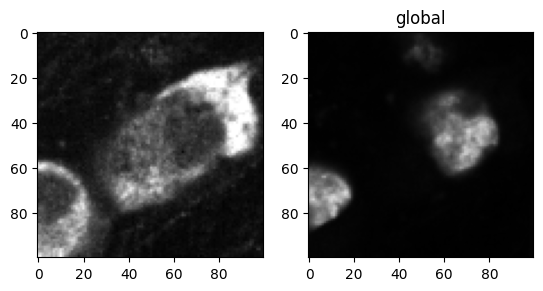

mean: 0.27961531220758873, std: 0.14656744095008054, var: 0.021482014746655342, brenner: 19.45311436139506, values range: [0.025, 0.899] 
mean: 0.035621875971164556, std: 0.0537795770180791, var: 0.0028922429042435023, brenner: 0.9005398036020562, values range: [0.001, 0.295] 


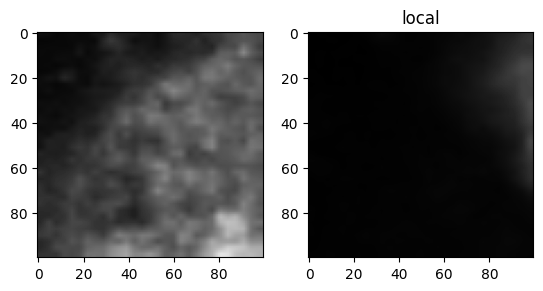

--------------
mean: 0.22364582229944907, std: 0.08041619470658362, var: 0.006466764371087169, brenner: 96.96941408276169, values range: [0.087, 1.0] 
mean: 0.03717884083085901, std: 0.04855273487041989, var: 0.0023573680633972873, brenner: 4.843118464864709, values range: [0.006, 0.259] 


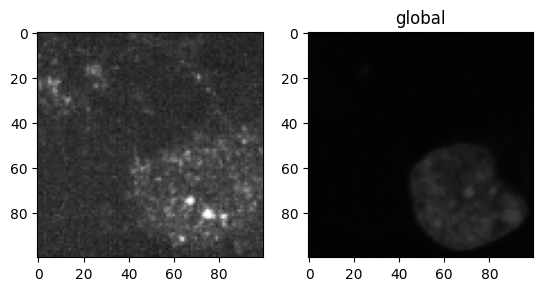

mean: 0.21662473471284802, std: 0.052989624951284384, var: 0.0028079003524777804, brenner: 12.576140527804043, values range: [0.109, 0.551] 
mean: 0.04596273725589283, std: 0.05908923320410167, var: 0.0034915374806487117, brenner: 1.295504025533116, values range: [0.007, 0.247] 


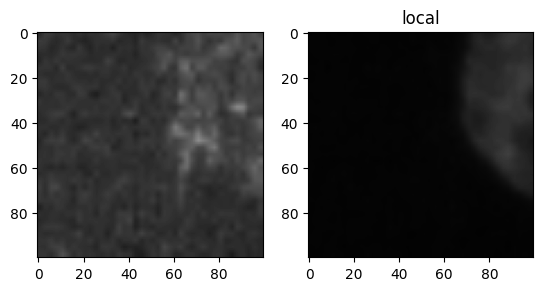

--------------
mean: 0.11946511193785125, std: 0.1187222608036889, var: 0.014094975210339127, brenner: 175.84462978285111, values range: [0.004, 1.0] 
mean: 0.09797195905155147, std: 0.17896357124420725, var: 0.03202795983248044, brenner: 56.73579311804397, values range: [0.003, 0.836] 


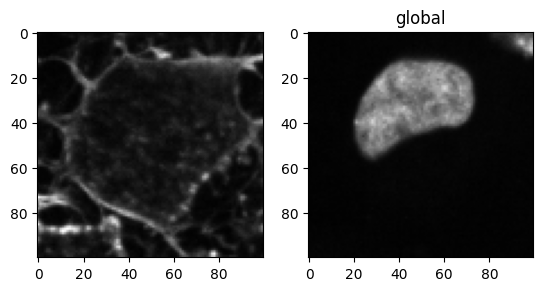

mean: 0.09405040931852945, std: 0.07058861302952592, var: 0.004982752289432156, brenner: 10.837796477264254, values range: [0.007, 0.497] 
mean: 0.2428074578453664, std: 0.24052896282993955, var: 0.057854181960046436, brenner: 23.993301784072774, values range: [0.001, 0.815] 


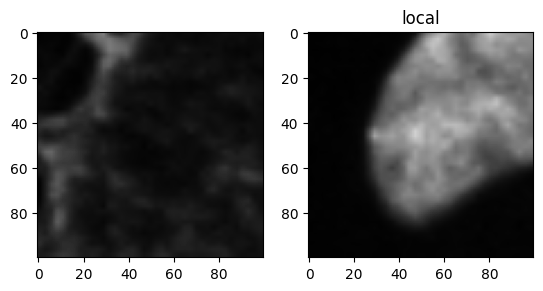

--------------
mean: 0.09535136492041017, std: 0.11365821434120169, var: 0.012918189687230545, brenner: 115.94977323155399, values range: [0.006, 1.0] 
mean: 0.05226341673780744, std: 0.09571972540059409, var: 0.009162265830765138, brenner: 20.90654364605357, values range: [0.002, 0.642] 


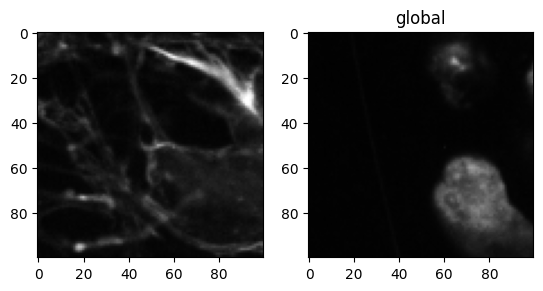

mean: 0.11176730729070065, std: 0.08350065844137675, var: 0.006972359960143461, brenner: 11.946632978328038, values range: [0.019, 0.494] 
mean: 0.0435367820490157, std: 0.0870268871850127, var: 0.007573679093112928, brenner: 3.051353228427727, values range: [0.008, 0.462] 


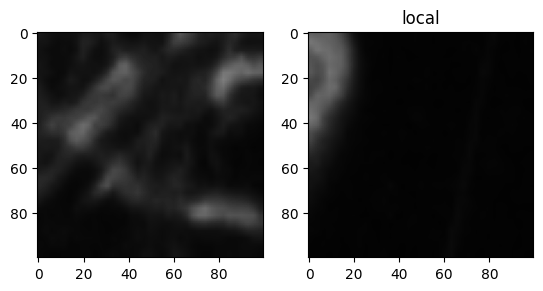

--------------
mean: 0.14419317305524632, std: 0.18836916474675622, var: 0.03548294222739059, brenner: 104.23641962659877, values range: [0.0, 1.0] 
mean: 0.11789086216983255, std: 0.23922798385006447, var: 0.0572300282569667, brenner: 119.3452762322232, values range: [0.0, 1.0] 


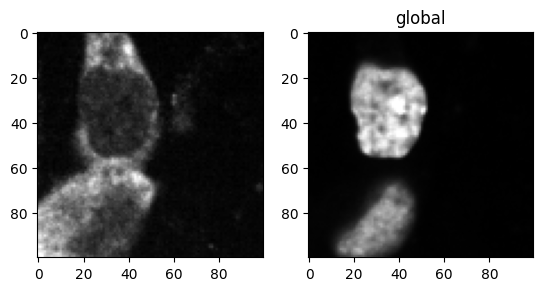

mean: 0.24328603175922914, std: 0.20074428884860596, var: 0.040298269505332544, brenner: 29.23270884831812, values range: [0.0, 1.0] 
mean: 0.413749889511027, std: 0.38350854793317496, var: 0.14707880633781237, brenner: 58.45406375501641, values range: [0.0, 1.0] 


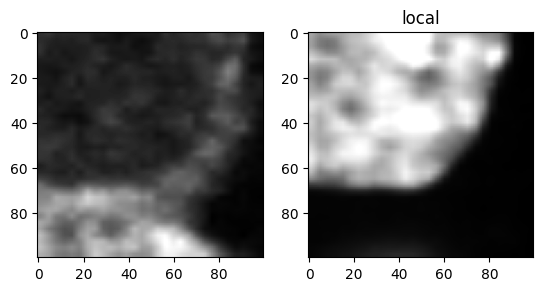

--------------


In [9]:
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline
# from src.common.lib import image_metrics

def calculate_image_sharpness_brenner(image):
        """
        Low = blur
        High = sharp
        """
        def _brenners_gradient(image):
            # Calculate the squared difference
            shift = 2  # Typical distance between pixels for calculation
            diff = image[:, :-shift] - image[:, shift:]
            brenner = np.sum(diff ** 2) 
            
            return brenner
        
        rows_brenner = _brenners_gradient(image)
        cols_brenner = _brenners_gradient(image.T)
        
        return rows_brenner + cols_brenner


print( X['image_global'].shape,  X['image_local'].shape)

for indx in range(5):
# indx = np.random.randint(0, 100)

    x_global = X['image_global'][indx,...]
    x_local = X['image_local'][indx,...]
    for name, v in zip(["global", "local"], [x_global, x_local]):
        fig, ax = plt.subplots(1,2)
        plt.title(name)
        for i in range(2):
            x = v[i]
            brenner = calculate_image_sharpness_brenner(x.cpu().numpy()) 
            print(f"mean: {torch.mean(x)}, std: {torch.std(x)}, var: {torch.var(x)}, brenner: {brenner}, values range: [{round(torch.min(x).item(), 3)}, {round(torch.max(x).item(), 3)}] ")
            ax[i].imshow(x, vmin=0, vmax=1, cmap='gray')
        plt.show()
    print('--------------')


In [ ]:
# import numpy as np

# indx = 1#np.random.randint(0, 10)
# # print(indx)
# v = X['image'][indx,...]


# # for name, v in zip(["global", "local"], [x_global, x_local]):
# for factor in [0.5,1,1.2]:
#     print(factor)
#     fig, ax = plt.subplots(1,2)
#     for i in range(2):
#         x = v[i]
#         x = x * factor
#         x = torch.clamp(x, 0, 1)

#         print(f"mean: {torch.mean(x)}, std: {torch.std(x)}, values range: [{round(torch.min(x).item(), 3)}, {round(torch.max(x).item(), 3)}] ")
#         ax[i].imshow(x, vmin=0, vmax=1, cmap='gray')
#     plt.show()

# Attention maps

In [14]:
import random

import os
import sys


os.environ['MOMAPS_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps'
os.environ['MOMAPS_DATA_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps/input'

sys.path.insert(1, os.getenv("MOMAPS_HOME"))
print(f"MOMAPS_HOME: {os.getenv('MOMAPS_HOME')}")


from sandbox.eval_new_arch.dino4cells.utils import utils
import torch.backends.cudnn as cudnn
from sandbox.eval_new_arch.dino4cells.archs import vision_transformer as vits
import numpy as np
import logging
import torch

from src.common.lib.dataset import Dataset
from src.datasets.dataset_spd import DatasetSPD
from src.common.lib.utils import load_config_file
from src.common.lib.data_loader import get_dataloader


%load_ext autoreload
%autoreload 2


# return_cls_token = True


class DictToObject:
    def __init__(self, dict_obj):
        for key, value in dict_obj.items():
            if isinstance(value, dict):
                # Recursively convert dictionaries to objects
                setattr(self, key, DictToObject(value))
            else:
                setattr(self, key, value)


    
# if len(sys.argv) < 3:
#     raise ValueError("Invalid config path. Must supply model config and data config.")

# config_path_model = sys.argv[1]
# config = {
#     'seed': 1,
#     'embedding': {
#         'image_size': 100
#     },
#     'patch_size': 14,
#     'num_channels': 1,

#     'epochs': 300,

#     'lr':0.0008,
#     'min_lr': 1e-6,
#     'warmup_epochs': 5,

#     'weight_decay': 0.04,
#     'weight_decay_end': 0.4,


#     'batch_size_per_gpu': 1,#3,#65,
#     'num_workers': 1,

#     'accumulation_steps': 1,

#     'early_stopping_patience': 10,

#     # 'logs_dir':"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/logs",
#     # 'tensorboard_root_folder': "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/tensorboard",
#     # "output_dir": f"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_{now_formatted}"
# }

config = {
        'seed': 1,
        'embedding': {
            'image_size': 100
        },
        'patch_size': 14,
        'num_channels': 2,
        
        'epochs': 300,
        
        'lr':0.0008,
        'min_lr': 1e-6,
        'warmup_epochs': 5,
        
        'weight_decay': 0.04,
        'weight_decay_end': 0.4,
        'local_crops_number': None,
        
        'batch_size_per_gpu': 2,#300,#3,#65,
        'num_workers': 1,
        
        'accumulation_steps': 1,
    
        'early_stopping_patience': 10,
        
        # 'logs_dir':"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit_contrastive/logs",
        # 'tensorboard_root_folder': "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit_contrastive/tensorboard",
        # "output_dir": f"/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit_contrastive/checkpoints/checkpoints_{now_formatted}"
    }

config = DictToObject(config)
# config_path_data = './src/datasets/configs/training_data_config/B78NoDSTrainDatasetAugInPlaceWTUntreatedConfig' #sys.argv[1]
# config_path_data = './src/datasets/configs/embeddings_data_config/EmbeddingsSPD18DaysB1SubsetDatasetConfig'
# config_path_data = './src/datasets/configs/embeddings_data_config/EmbeddingsB6Rep2FUSSubsetDatasetConfig'
config_path_data = "./src/datasets/configs/embeddings_data_config/EmbeddingsSPD18DaysB1Rep2SubsetDatasetConfig"


# model, config_model =  init_model_for_embeddings(config_path_model=config_path_model)
config_data = load_config_file(config_path_data)

# logging.info('Not doing softmax!!')
# if len(sys.argv) > 3:
# output_folder_path = sys.argv[3]
# output_folder_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/noam_eval_fc/full_model_basic_aug_no_drop_b6rep2"

# output_folder_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/noam_eval_fc/subset_model_basic_aug_no_drop_b6rep2"
# # else:
#     # output_folder_path = os.path.join(config_model.MODEL_OUTPUT_FOLDER, "pretext")
# if not os.path.exists(output_folder_path):
#     logging.info(f"{output_folder_path} doesn't exists. Creating it")
#     os.makedirs(output_folder_path)

#     jobid = os.getenv('LSB_JOBID')
#     logging.info(f"init (jobid: {jobid})")
#     logging.info("[Predict label with fc]")

#     logging.info(f"Is GPU available: {torch.cuda.is_available()}")
#     logging.info(f"Num GPUs Available: {torch.cuda.device_count()}")



# utils.init_distributed_mode(args)
torch.manual_seed(config.seed)
torch.cuda.manual_seed_all(config.seed)
np.random.seed(config.seed)
# utils.fix_random_seeds(config.seed)
# init_signal_handler()
# logging.info("git:\n  {}\n".format(utils.get_sha()))
# logging.info(
#     "\n".join("%s: %s" % (k, str(v)) for k, v in sorted(dict(vars(args)).items()))
# )
# cudnn.benchmark = True
cudnn.benchmark = False
random.seed(config.seed)

# chosen_loader = file_dataset.image_modes[config["model"]["image_mode"]]
# FileList = file_dataset.data_loaders[config["model"]["datatype"]]

# ============ preparing data ... ============
# transform =  DataAugmentationVIT(config=config)
# transform = transforms.Compose([
#         # RandomResizedCropWithCheck(100, scale=(0.6, 1.0)),
#         transforms.RandomHorizontalFlip(),
#         transforms.RandomVerticalFlip()])

config_data = load_config_file(config_path_data)

dataset = DatasetSPD(config_data, None)
# config.out_dim = len(np.unique(dataset_train.label))
train_indexes, val_indexes, test_indexes = None, None, None
# dataset_val, dataset_test = None, None


# if is_one_config_supplied:
# dataset_val, dataset_test = deepcopy(dataset_train), deepcopy(dataset_train) # the deepcopy is important. do not change. 
# dataset_test.flip, dataset_test.rot = False, False
if config_data.SPLIT_DATA:
    logging.info("Split data...")
    train_indexes, val_indexes, test_indexes = dataset.split()
    dataset_test_subset = Dataset.get_subset(dataset, test_indexes)
else:
    # dataset_val, dataset_test = DatasetSPD(config_val), DatasetSPD(config_test)
    dataset_test_subset = dataset




data_loader_test = get_dataloader(dataset_test_subset, config.batch_size_per_gpu, num_workers=config.num_workers)
logging.info(f"Data loaded: there are {len(dataset)} images.")

# ============ building student and teacher networks ... ============
model = vits.vit_base(
        img_size=[config.embedding.image_size, config.embedding.image_size],
        patch_size=config.patch_size,
        # drop_path_rate=0.1,  # stochastic depth
        # drop_rate=0.3, # can't go together with drop_path_rate - cuda out of memory
        in_chans=config.num_channels,
        num_classes=256#len(dataset.unique_markers)
).cuda()

# full model
# chkp_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_190624_072039_132123_b78_no_drop_basic_aug/checkpoint_best.pth"
# wt untreated model
# chkp_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit/checkpoints_200624_114338_034809_no_drop_basic_aug_only_wt_untreated_only_target_channel/checkpoint_best.pth"#

# full model contrastive
chkp_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit_contrastive/checkpoints/checkpoints_240624_232822_472218_with_shuffle/checkpoint_best.pth"

model = utils.load_model_from_checkpoint(chkp_path, model)


MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
num_patches=49


In [42]:
# model.get_last_selfattention()
vals = next(iter(data_loader_test))
vals['image_path'][0]

'/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/WT/stress/G3BP1/rep2_R11_w3confCy5_s139_panelA_WT_processed.npy'

0/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


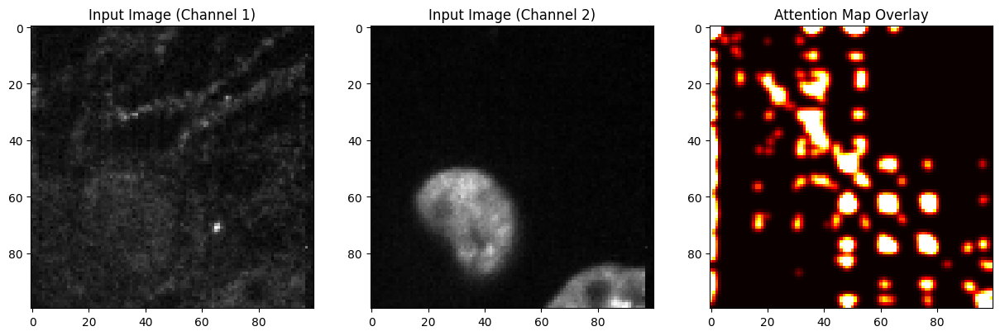

1/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


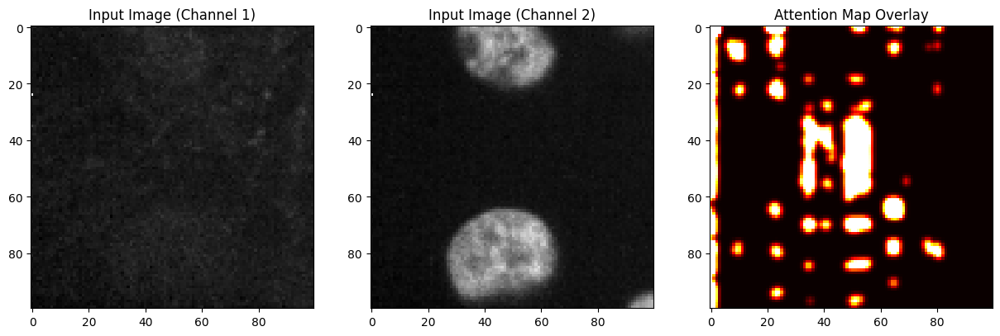

2/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


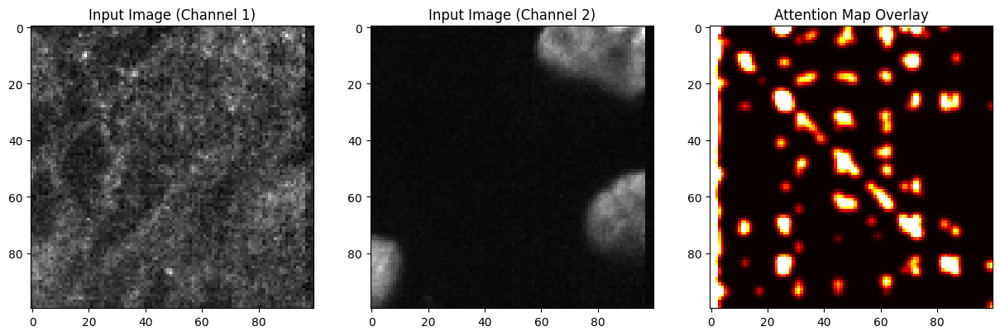

3/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


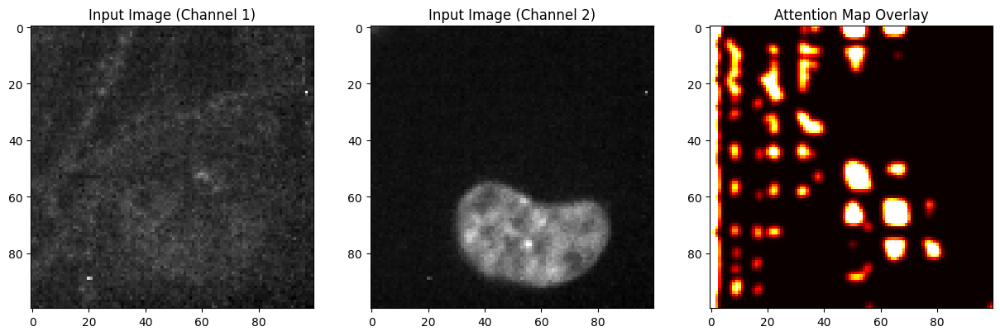

4/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


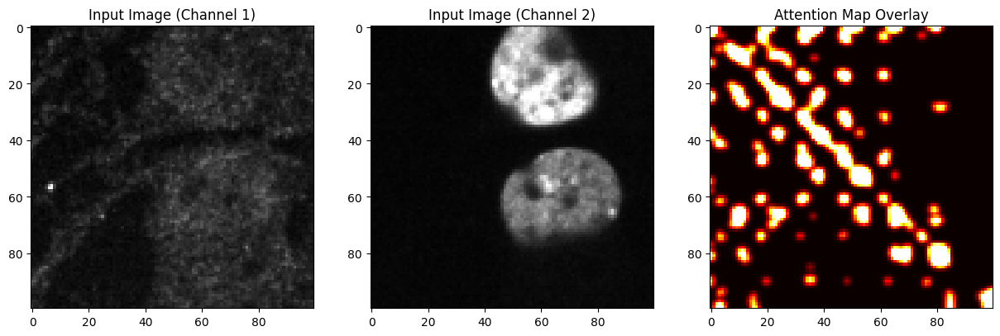

5/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


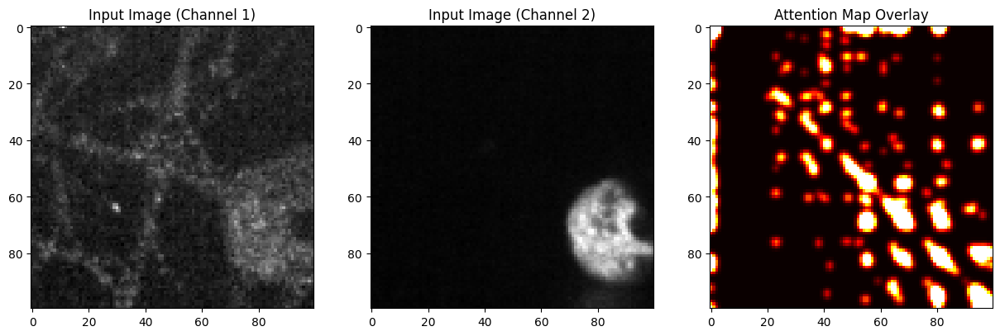

6/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


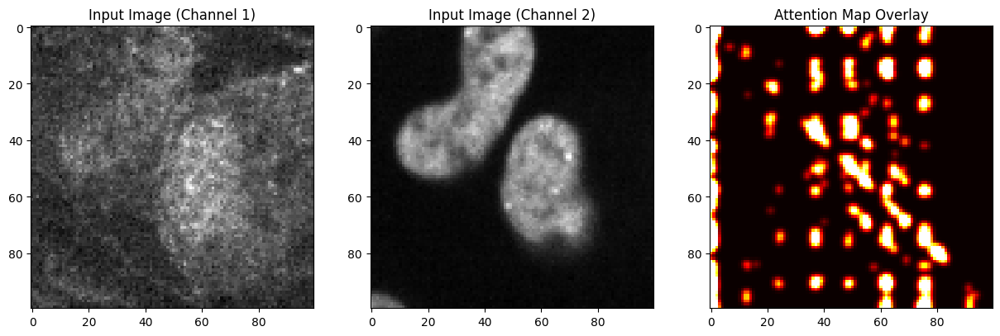

7/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


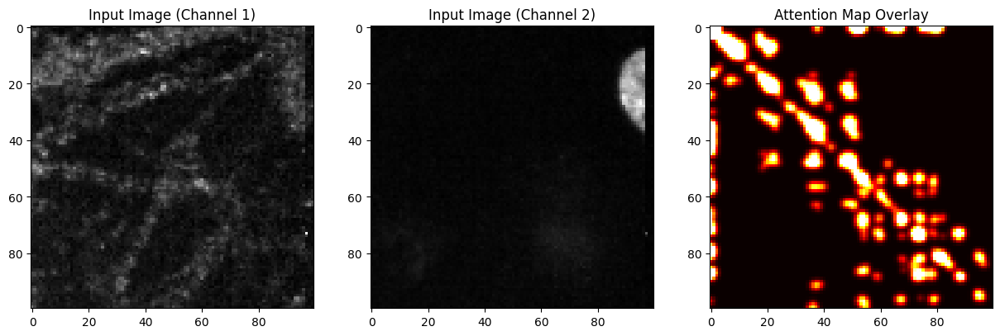

8/9
torch.Size([1, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/FUSHomozygous/Untreated/SCNA/rep2_R11_w2confmCherry_s942_panelH_FUSHomozygous_processed.npy
torch.Size([1, 12, 50, 50])


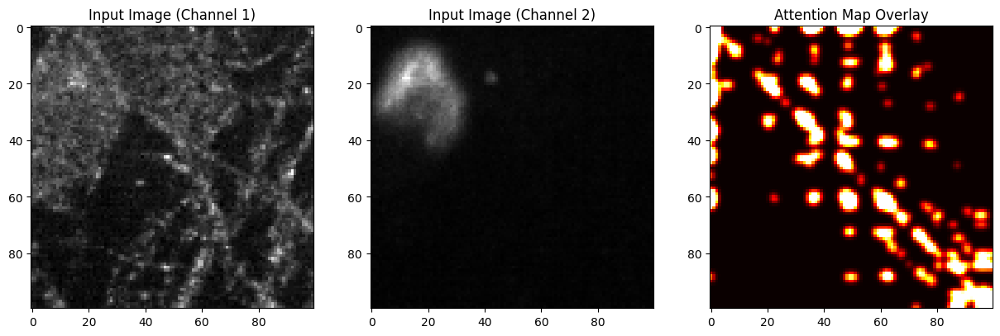

In [55]:
# import torch.nn.functional as F
# import matplotlib.pyplot as plt
# %matplotlib inline
# from scipy.ndimage import gaussian_filter

# for indx in range(len(vals['label'])):
#     print(f"{indx}/{(len(vals['label']))}")
# # indx = 3
#     img = vals['image'][[indx]].to(torch.float).cuda()
#     lbl = vals['label'][[indx]]

#     print(img.shape)
#     print(vals['image_path'][indx])

#     markers = dataset.unique_markers
#     lbl_names = np.asarray([markers[p] for p in lbl])
#     lbl_names

#     attn = model.get_last_selfattention(img)
#     print(attn.shape)
#     attention_map = attn.mean(dim=1, keepdim=True)
#     attention_map_upsampled = F.interpolate(attention_map, size=(100, 100), mode='bilinear', align_corners=False)  # Shape: (1, 1, 100, 100)
#     # print(attention_map_upsampled)
#     # Normalize the attention map for visualization purposes
#     # attention_map_normalized = (attention_map_upsampled - attention_map_upsampled.min()) / (attention_map_upsampled.max() - attention_map_upsampled.min())
#     # print(attention_map_normalized)
    
#     # Normalize the attention map using z-score normalization
#     attention_map_np = attention_map_upsampled[0, 0].detach().cpu().numpy()  # Shape: (100, 100)
#     mean = np.mean(attention_map_np)
#     std = np.std(attention_map_np)
#     attention_map_normalized = (attention_map_np - mean) / std

#     # Apply thresholding
#     threshold = np.percentile(attention_map_normalized, 90)
#     attention_map_thresholded = np.where(attention_map_normalized > threshold, attention_map_normalized, 0)

#     # Apply Gaussian smoothing
#     attention_map_smoothed = gaussian_filter(attention_map_thresholded, sigma=1)

#     image_np = img[0].permute(1, 2, 0).detach().cpu().numpy()  # Shape: (100, 100, 2)
#     # attention_map_np = attention_map_normalized[0, 0].detach().cpu().numpy()  # Shape: (100, 100)

#     # Plot the original image and the attention map
#     fig, ax = plt.subplots(1, 3, figsize=(15, 5))
#     ax[0].imshow(image_np[..., 0], cmap='gray')
#     ax[0].set_title('Input Image (Channel 1)')
#     ax[1].imshow(image_np[..., 1], cmap='gray')
#     ax[1].set_title('Input Image (Channel 2)')
#     ax[2].imshow(attention_map_smoothed, cmap='hot', vmin=0, vmax=1)
#     ax[2].set_title('Attention Map Overlay')
#     plt.show()


#     # # Visualize individual heads
#     # for i in range(attn.shape[1]):
#     #     head_attention_map = F.interpolate(attn[:, i:i+1, :, :], size=(img.shape[2], img.shape[3]), mode='bilinear', align_corners=False)
#     #     head_attention_map_np = head_attention_map[0, 0].cpu().detach().numpy()
#     #     plt.imshow(head_attention_map_np, cmap='jet', alpha=0.6)
#     #     plt.title(f'Attention Head {i+1}')
#     #     plt.show()

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline

vals_imgs = vals['image']
for i in range(vals_imgs.shape[0]):
    fig, ax = plt.subplots(1,vals_imgs.shape[1])
    for c in range(vals_imgs.shape[1]):
        ax[c].imshow(vals_imgs[i,c,...], vmin=0, vmax=1, cmap='gray')
    plt.show()

NameError: name 'vals' is not defined

In [4]:
from sandbox.eval_new_arch.dino4cells.utils.extractor import ViTExtractor
import cv2
from sklearn.decomposition import PCA
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt 
%matplotlib inline

from sklearn.ensemble import RandomForestClassifier
import matplotlib.cm as cm

from sklearn.feature_selection import mutual_info_classif

In [5]:
def get_attn_maps(extractor, images, lbls=None, pc_indx_compare=[0,1], reducer=None, n_components=10):
    attn_maps = []
    
    features_processed = extractor.extract_descriptors(images.to('cuda')).detach().cpu().numpy()[:,0,...]
    
    attention_maps_flat = np.concatenate(features_processed)
    
    print(f"features_processed = {features_processed.shape}")
    
    
    
    
    if reducer is not None:
        # reducer = PCA(n_components=n_components, whiten=True)
        print(f"reducer: {reducer}")
        pca_descs_clean = reducer.fit_transform(attention_maps_flat)

        if lbls is not None:
            last = 0
            for i, l in enumerate(np.unique(lbls)):
                current = len(np.where(lbls==l)*features_processed.shape[1])
                indx = np.arange(i*last, i*last +  current)
                plt.scatter(pca_descs_clean[indx,pc_indx_compare[0]], pca_descs_clean[indx,pc_indx_compare[1]])
                last = current
            plt.show()
            
        print(f"pca_descs_clean: {pca_descs_clean.shape}")
        pca_descs_clean = pca_descs_clean.reshape(features_processed.shape[0], features_processed.shape[1], n_components)

        attention_maps_flat = np.concatenate(pca_descs_clean)
    # else:
    #     attention_maps_flat = np.concatenate(features_processed)

    ####################
    
    ############################### Fisher's Scores #########################
    
#     print(f"features_processed = {features_processed.shape}")
    
#     def get_labels():
#         labels = []
#         for i, l in enumerate(np.unique(lbls)):
#             l_len = len(np.where(lbls==l)[0])*features_processed.shape[1]
#             labels.extend([l]*l_len)
#         labels = np.asarray(labels)
#         return labels
    
#     print(f"attention_maps_flat = {attention_maps_flat.shape}")
#     full_labels = get_labels()
#     print(f"full_labels = {len(full_labels)}")
#     keys_class1 = attention_maps_flat[np.where(full_labels==0)[0]]
#     keys_class2 = attention_maps_flat[np.where(full_labels==1)[0]]
    
#     print(f"keys_class1={keys_class1.shape}")
    
#     # Calculate mean and variance for each class
#     mean_class1 = np.mean(keys_class1, axis=0)
#     mean_class2 = np.mean(keys_class2, axis=0)

#     variance_class1 = np.var(keys_class1, axis=0)
#     variance_class2 = np.var(keys_class2, axis=0)

#     # Calculate Fisher's score for each feature
#     fisher_scores = (mean_class1 - mean_class2) ** 2 / (variance_class1 + variance_class2)
#     print(fisher_scores.shape)
#     top_features_indices = np.argsort(fisher_scores)[-n_components:]
#     print(fisher_scores[top_features_indices])
#     print(f"top_features_indices={top_features_indices}")
    
#     # Select top features from the original keys
#     keys_class1_reduced = keys_class1[:, top_features_indices]
#     keys_class2_reduced = keys_class2[:, top_features_indices]
#     print(f"keys_class2_reduced = {keys_class2_reduced.shape}")
    
#     attention_maps_flat = np.concatenate([keys_class1_reduced, keys_class2_reduced])
#     print(f"attention_maps_flat = {attention_maps_flat.shape}")

    ############################### Mutual Information #########################
    
#     def get_labels():
#         labels = []
#         for i, l in enumerate(np.unique(lbls)):
#             l_len = len(np.where(lbls==l)[0])*features_processed.shape[1]
#             labels.extend([l]*l_len)
#         labels = np.asarray(labels)
#         return labels
    
#     full_labels = get_labels()

    
#     # Calculate mutual information
#     mutual_info = mutual_info_classif(attention_maps_flat, full_labels)

    
#     top_features_indices = np.argsort(mutual_info)[-n_components:]
#     print(mutual_info[top_features_indices])
   
#     # print(f"top_features_indices={top_features_indices}")
    
#     # Select top features from the original keys
# #     keys_class1_reduced = keys_class1[:, top_features_indices]
# #     keys_class2_reduced = keys_class2[:, top_features_indices]
# #     print(f"keys_class2_reduced = {keys_class2_reduced.shape}")
    
# #     attention_maps_flat = np.concatenate([keys_class1_reduced, keys_class2_reduced])
#     attention_maps_flat = attention_maps_flat[..., top_features_indices]
    # print(f"attention_maps_flat = {attention_maps_flat.shape}")

    ############################### RandomForest #########################
    
    # Train a Random Forest classifier
    clf = RandomForestClassifier(oob_score=True, random_state=42)
    lbls_formatted = []
    for i, l in enumerate(np.unique(lbls)):
        n = len(np.where(lbls==l)[0])*features_processed.shape[1]
        lbls_formatted.extend([l] * n)
        
    print(len(lbls_formatted), features_processed.shape)
    clf.fit(attention_maps_flat, lbls_formatted)
    
    print(f"oob score: {clf.oob_score_}")
    
    clf_for_pc_indx_compared = RandomForestClassifier(oob_score=True, random_state=42)
    clf_for_pc_indx_compared.fit(attention_maps_flat[...,pc_indx_compare], lbls_formatted)
    
    print(f"oob score for pc {pc_indx_compare}: {clf_for_pc_indx_compared.oob_score_}")
    
    
    # Get feature importances
    feature_importances = clf.feature_importances_
    sorted_indices = np.argsort(feature_importances)[::-1]
    top_k_indices = sorted_indices[:n_components]
    print(f"top {n_components} indices: {top_k_indices}")
    print(f"feature_importances in indices: {feature_importances[top_k_indices]}")
    
    
    attention_maps_flat = attention_maps_flat[:, top_k_indices]
    
    ########################################################################
    
    
    
    individual_pca_descs_clean = attention_maps_flat.reshape(features_processed.shape[0], features_processed.shape[1], -1)
    print(f"individual_pca_descs_clean shape: {individual_pca_descs_clean.shape}")
    
    ###################
    
    # individual_pca_descs_clean = pca_descs_clean.reshape(features_processed.shape[0], features_processed.shape[1], n_components)
    
    row_size, col_size = (int(features_processed.shape[1] ** 0.5),)*2
    
    for i in range(len(features_processed)):
        desc_img = individual_pca_descs_clean[i]
        desc_clean = np.stack([cv2.resize(desc_img[:,c].reshape(row_size, col_size), dsize=(100, 100), interpolation=cv2.INTER_CUBIC) for c in range(n_components)]).transpose(1,2,0)
        attn_maps.append(desc_clean)
    
    attn_maps = np.stack(attn_maps)
    
    # print(f"pca explained_variance_ratio_: {pca.explained_variance_ratio_}")
    # print(f"pca total explained: {np.sum(pca.explained_variance_ratio_)}%")
    
    return attn_maps

def plt_attn_map(img, attn_map, pc_indx=0, alpha=0.7, img_cmap='gray', attn_cmap=None, overlay=False):
    if attn_cmap is None:        
        # Number of colors in the colormap
#         N = 256

#         # Get the rainbow colormap
#         rainbow_colors = cm.rainbow(np.linspace(0, 1, N))

#         # Add alpha values
#         alpha = np.linspace(0, 1, N)
#         rainbow_colors[:, 3] = alpha

#         # Create the LinearSegmentedColormap
#         attn_cmap = LinearSegmentedColormap.from_list('transparent_to_rainbow', rainbow_colors, N=N)

        
        attn_cmap = LinearSegmentedColormap.from_list('reds', [(0, 0, 0, 0), (1, 0, 0, 1)], N=256)

    
    # new_desc_clean = np.copy(attn_map)
        
    attn_map_min = attn_map.min(axis=(0,1))
    attn_map_max = attn_map.max(axis=(0,1))
    
    # new_desc_clean -= new_desc_clean.min(axis=(0,1))
    # new_desc_clean /= new_desc_clean.max(axis=(0,1))
    attn_map -= attn_map_min
    attn_map /= (attn_map_max - attn_map_min)
    
    if not overlay:
        fig, ax = plt.subplots(1,3)
        for i in range(2):
            ax[i].imshow(img[i,...], cmap=img_cmap)
            ax[i].axis('off')
        ax[2].imshow(attn_map[...,pc_indx], alpha=alpha, cmap=attn_cmap)
        ax[2].axis('off')
        plt.show()
    else:
        fig, ax = plt.subplots(1,4, figsize=(15,15))
        for i in range(4):
            ax[i].imshow(img[i%2,...], cmap=img_cmap)
            if i < 2:
                ax[i].imshow(attn_map[...,pc_indx], alpha=alpha, cmap=attn_cmap)
            ax[i].axis('off')
        plt.show()
    
def plt_attn_maps(imgs, attn_maps, pc_indxs=[0], alpha=0.7, img_cmap='gray', attn_cmap=None, overlay=False):
    n = len(imgs)
    for i in range(n):
        print(f"img: {i}")
        for pc in pc_indxs:
            print(f"pc={pc}")
            plt_attn_map(imgs[i], attn_maps[i], pc_indx=pc, alpha=alpha, img_cmap=img_cmap, attn_cmap=attn_cmap, overlay=overlay)

In [15]:
extractor = ViTExtractor(
    model_type='vit_base_patch14_100',
    model=model,
    stride=7,
    device='cuda',
    load_size=100,
)



In [18]:
vals = next(iter(data_loader_test))
vals['image_path'][0]

'/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/spd18days/batch1/WT/stress/FUS/rep2_PanelG_Batch1_d18_1605241_w3confCy5_s129_panelG_WT_processed.npy'

In [17]:
vals_cond1 = vals
print(vals_cond1['image'].shape)
vals_cond1['image_path'][0]

torch.Size([8, 2, 100, 100])


'/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/spd18days/batch1/WT/Untreated/FUS/rep2_PanelG_Batch1_d18_1605241_w3confCy5_s539_panelG_WT_processed.npy'

In [19]:
vals_cond2 = vals
vals_cond2['image_path'][0]

'/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/spd18days/batch1/WT/stress/FUS/rep2_PanelG_Batch1_d18_1605241_w3confCy5_s129_panelG_WT_processed.npy'

/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/spd18days/batch1/WT/Untreated/FUS/rep2_PanelG_Batch1_d18_1605241_w3confCy5_s539_panelG_WT_processed.npy
torch.Size([8, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/spd18days/batch1/WT/stress/FUS/rep2_PanelG_Batch1_d18_1605241_w3confCy5_s129_panelG_WT_processed.npy
torch.Size([5, 2, 100, 100])
combined: torch.Size([13, 2, 100, 100])
[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1]


/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1711403392949/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


features_processed = (13, 169, 768)
reducer: PCA(n_components=10, whiten=True)


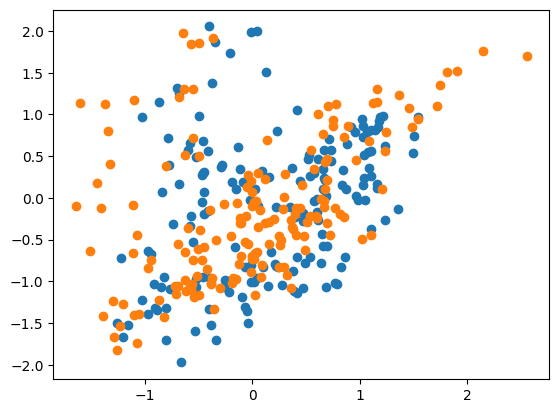

pca_descs_clean: (2197, 10)
2197 (13, 169, 768)
oob score: 0.7983614019116978
oob score for pc [0, 1, 2, 3]: 0.6768320436959491
top 10 indices: [5 8 0 1 3 6 9 4 7 2]
feature_importances in indices: [0.114548   0.11073922 0.10604029 0.10449888 0.10441013 0.10316151
 0.09601252 0.09107598 0.08948222 0.08003126]
individual_pca_descs_clean shape: (13, 169, 10)
(13, 100, 100, 10)
----------------- Cond1 ----------------------
img: 0
pc=0


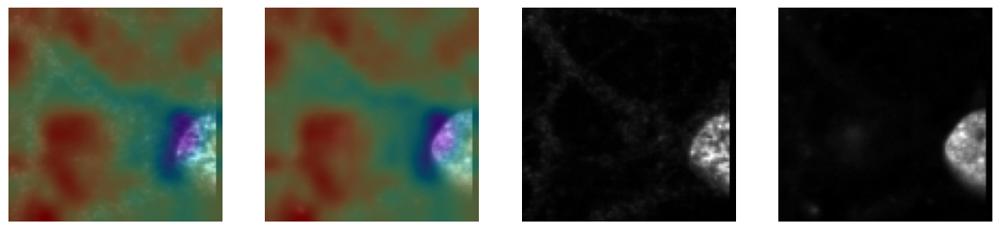

pc=1


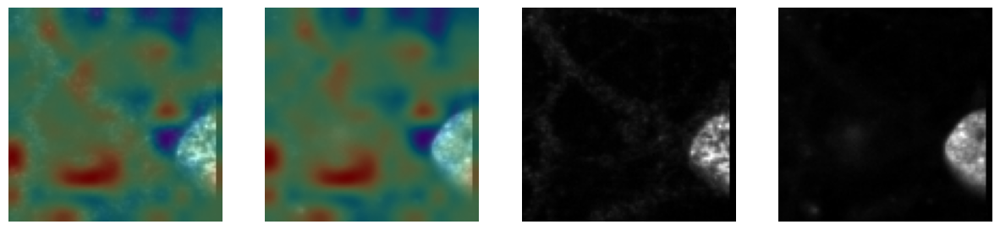

pc=2


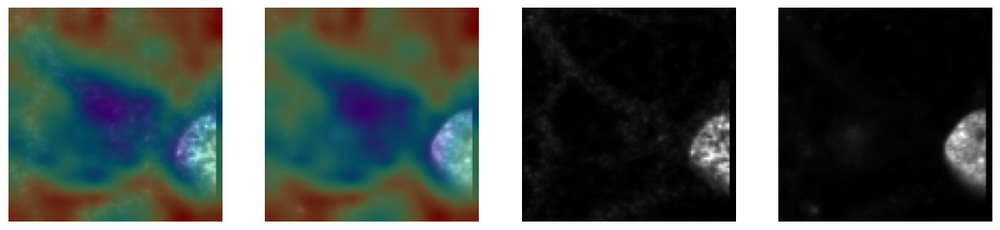

pc=3


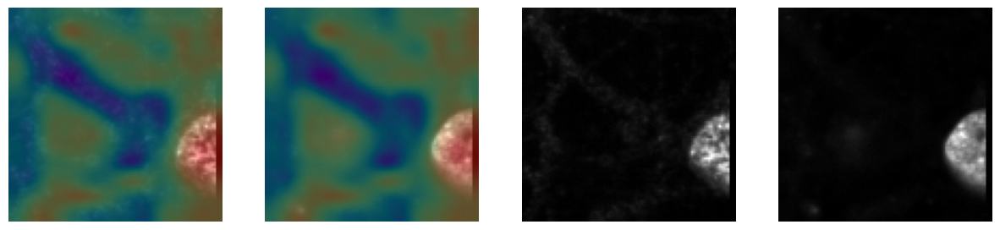

img: 1
pc=0


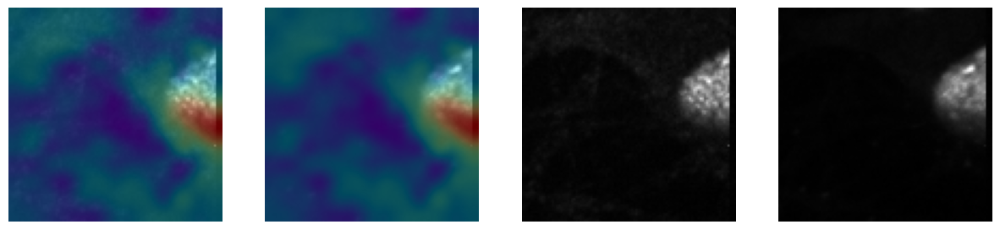

pc=1


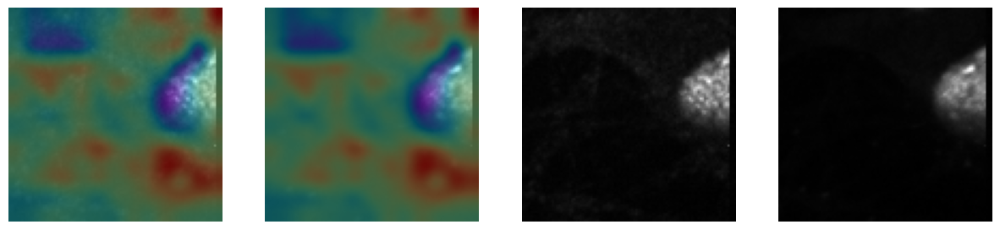

pc=2


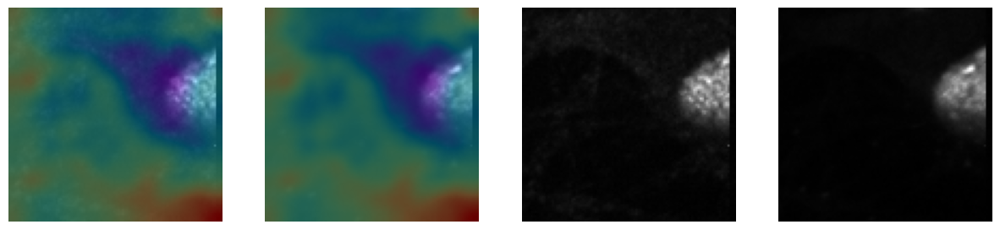

pc=3


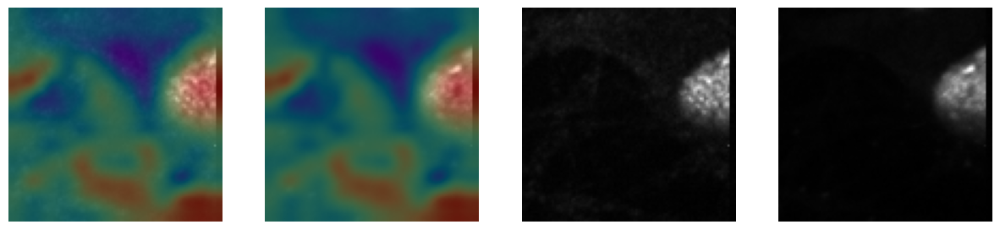

img: 2
pc=0


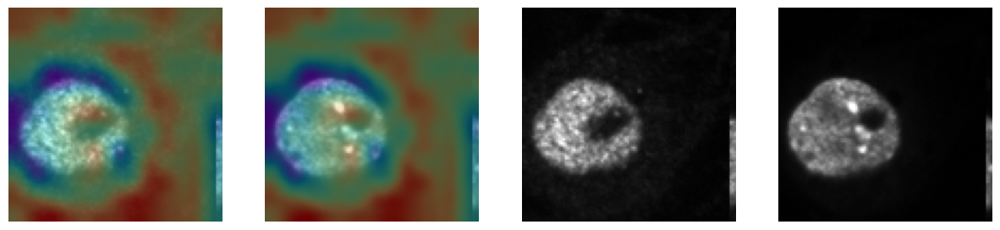

pc=1


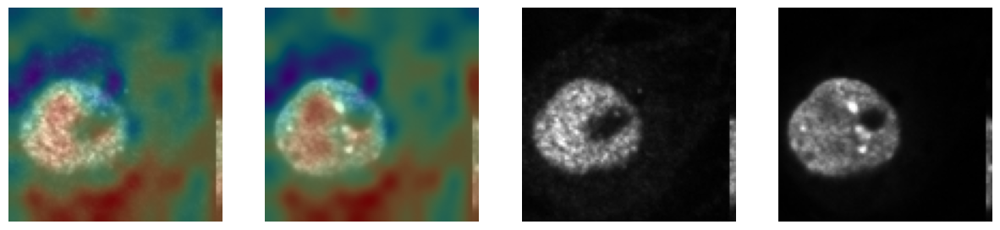

pc=2


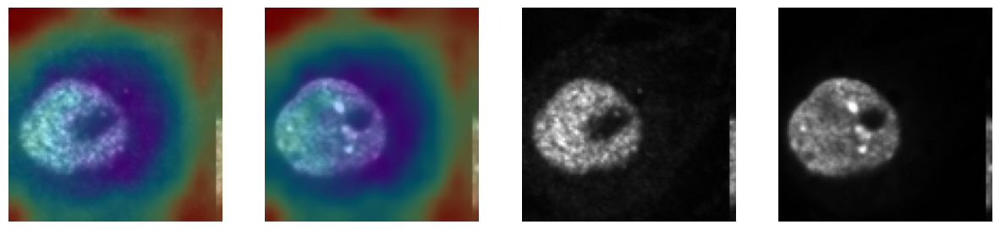

pc=3


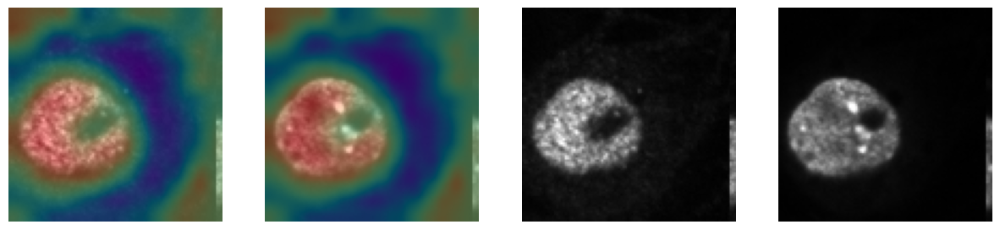

img: 3
pc=0


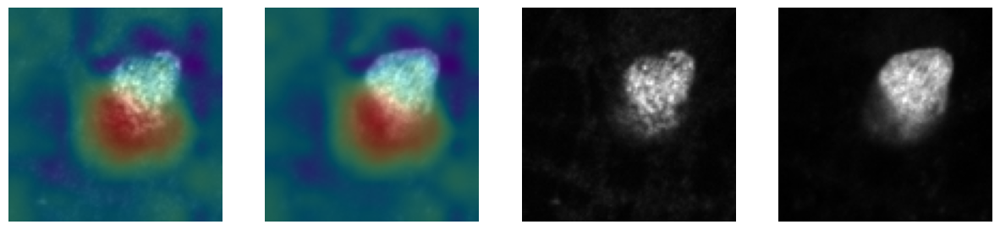

pc=1


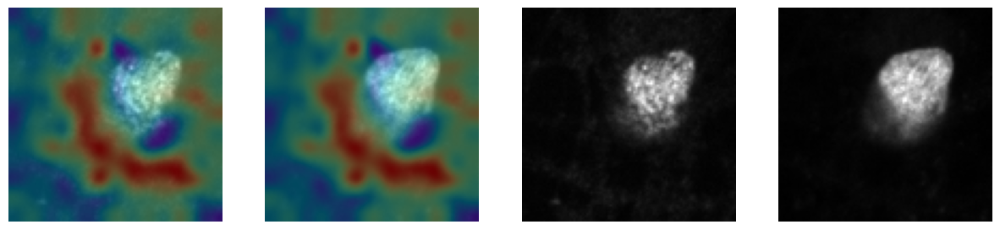

pc=2


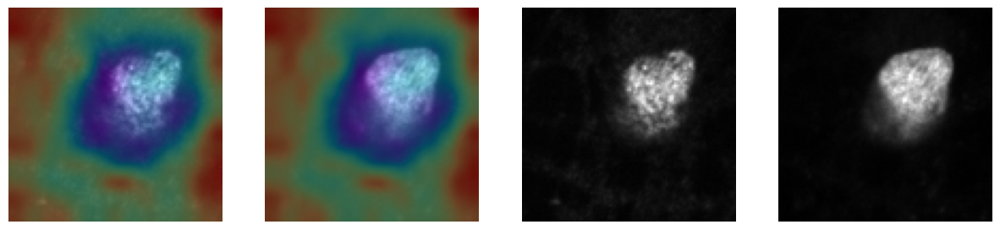

pc=3


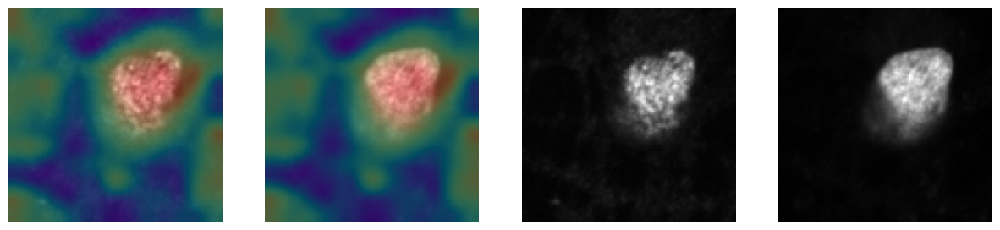

img: 4
pc=0


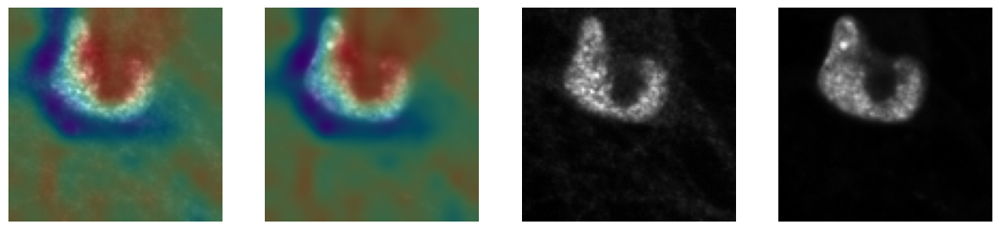

pc=1


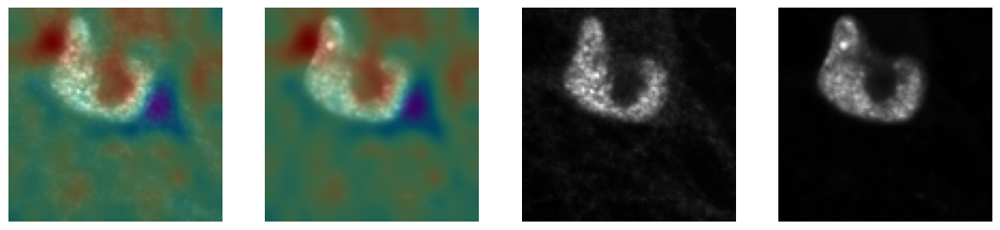

pc=2


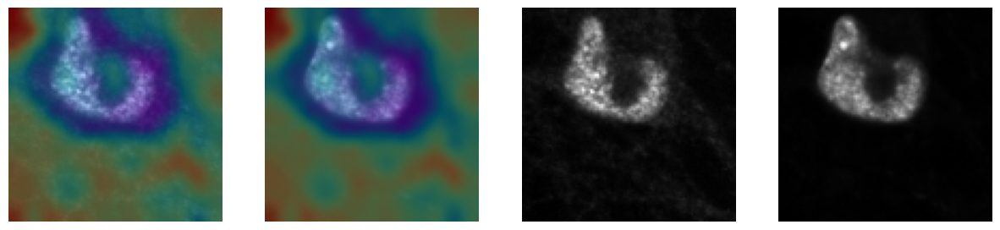

pc=3


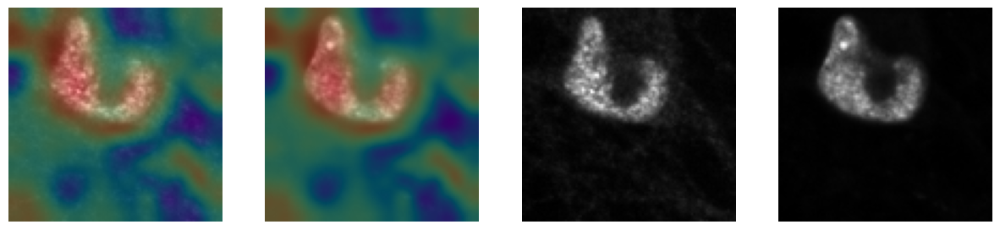

img: 5
pc=0


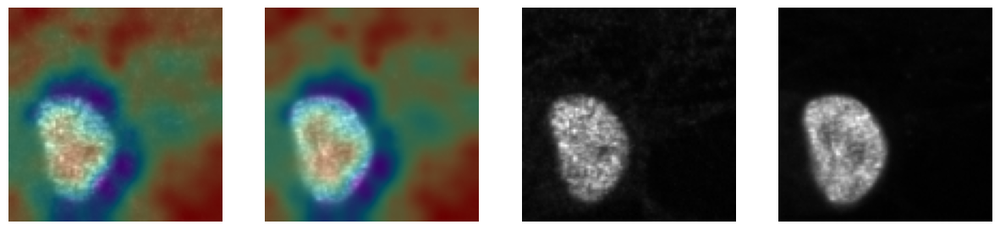

pc=1


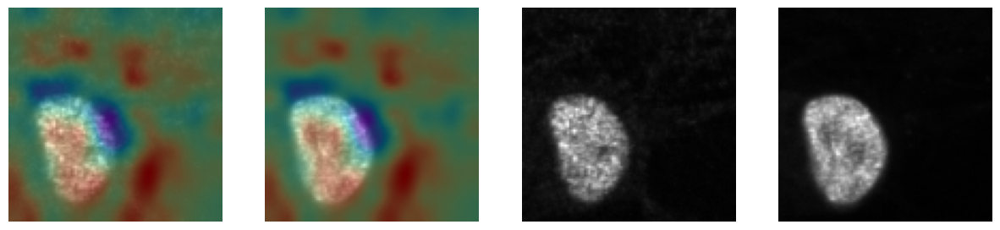

pc=2


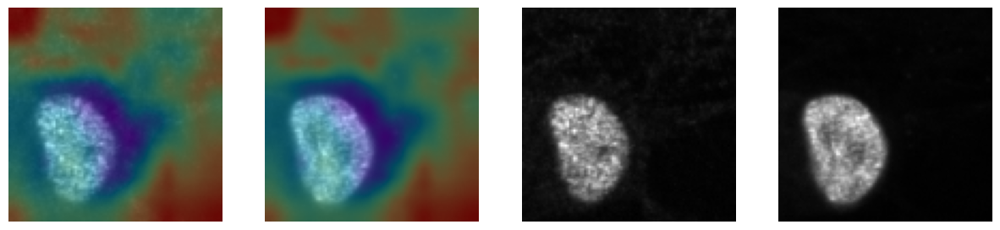

pc=3


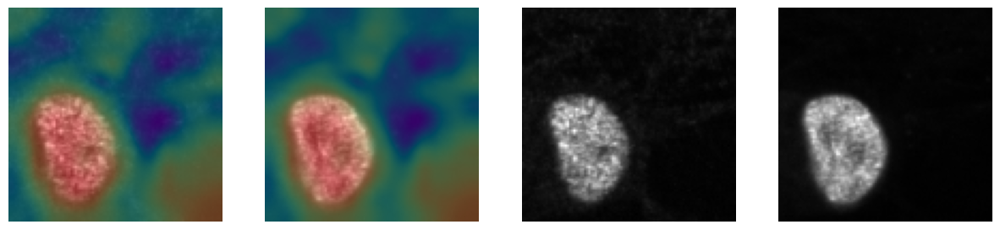

img: 6
pc=0


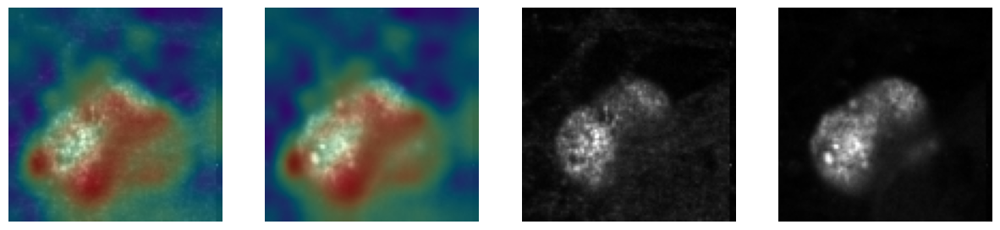

pc=1


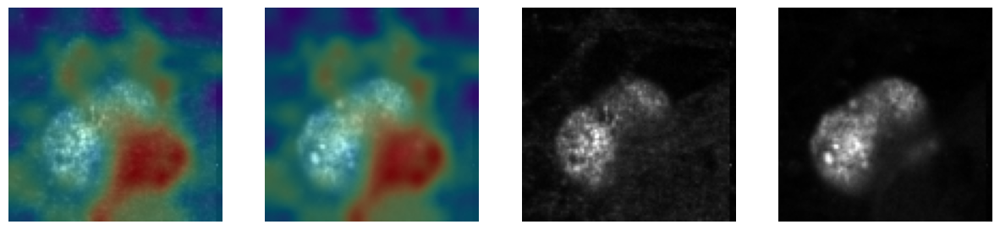

pc=2


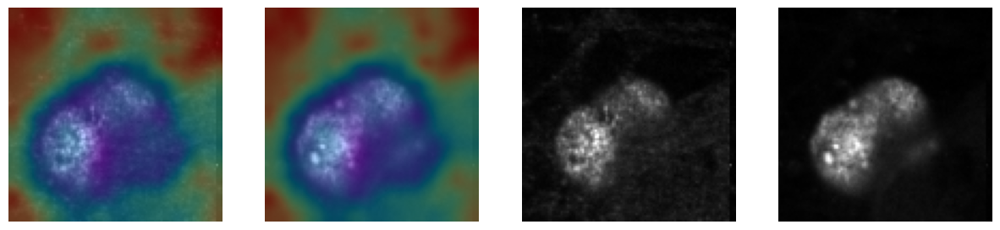

pc=3


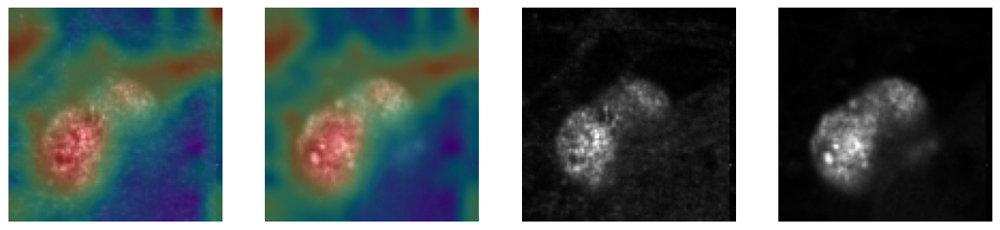

img: 7
pc=0


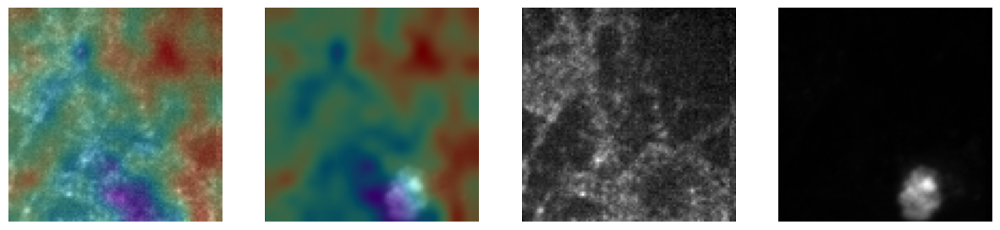

pc=1


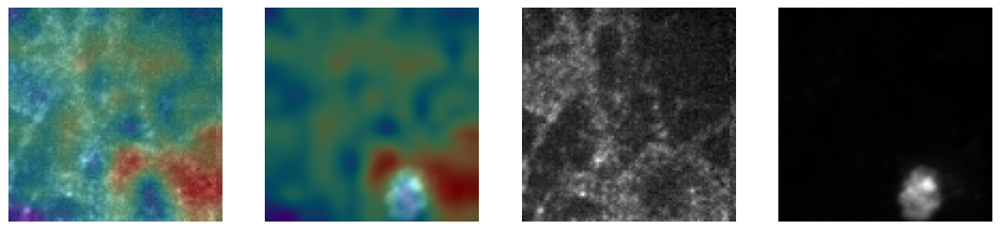

pc=2


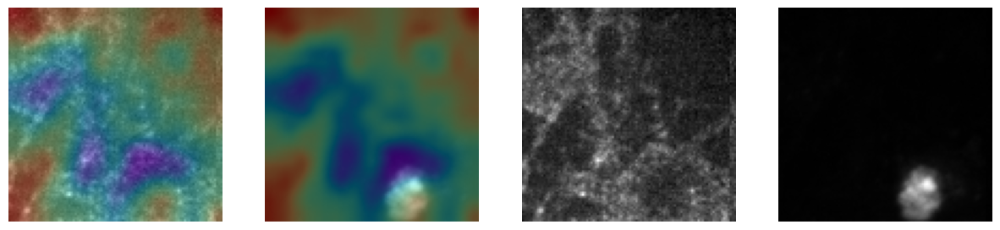

pc=3


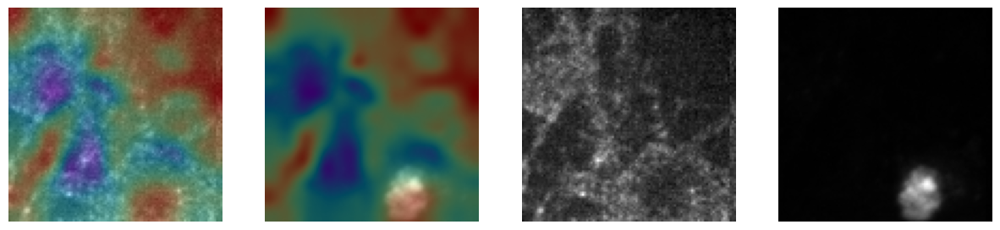

----------------- Cond2 ----------------------
img: 0
pc=0


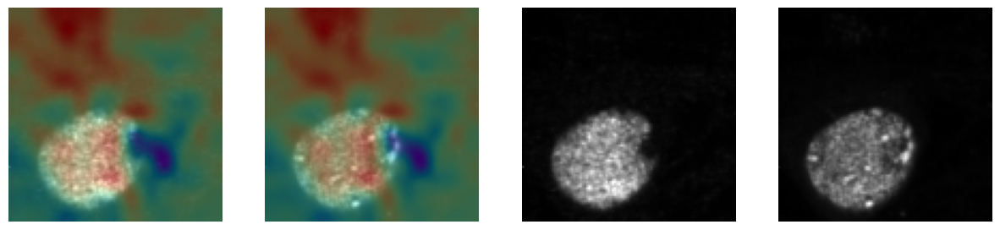

pc=1


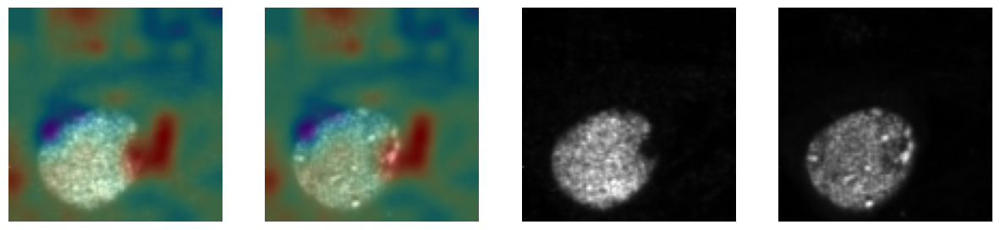

pc=2


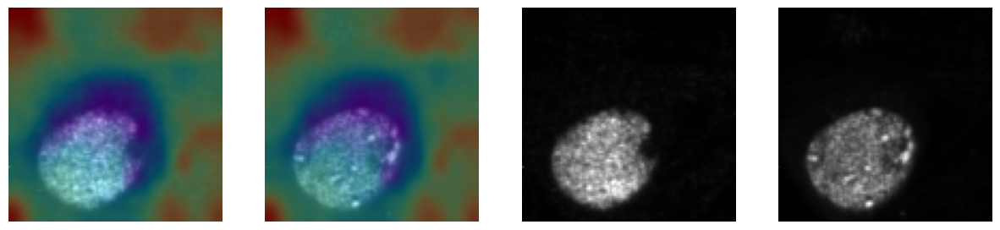

pc=3


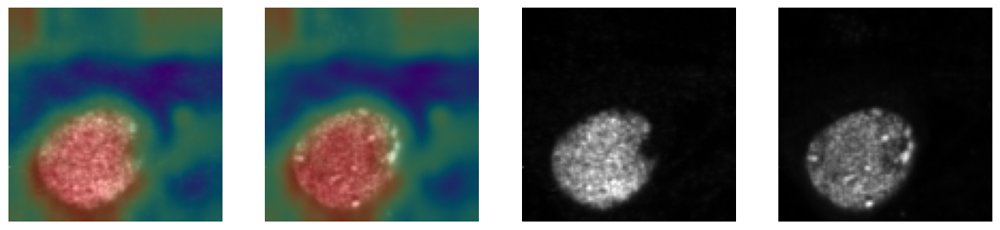

img: 1
pc=0


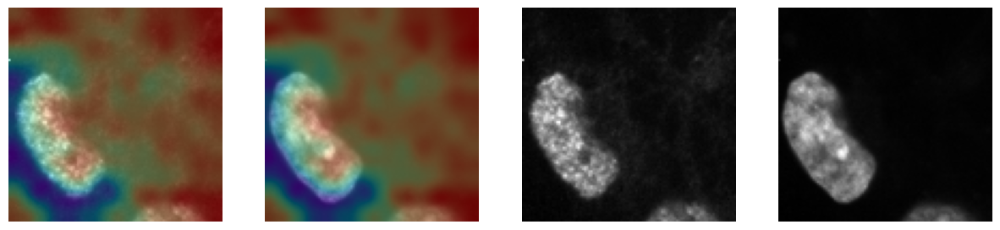

pc=1


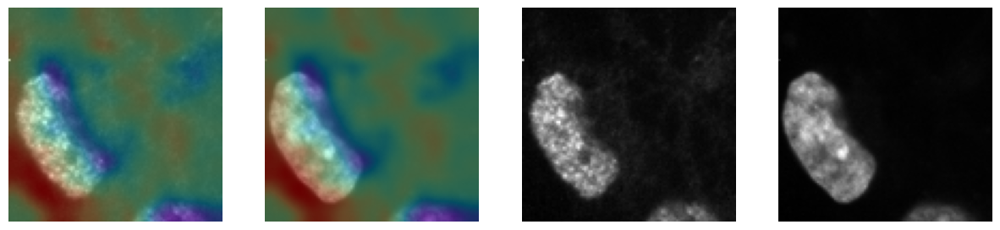

pc=2


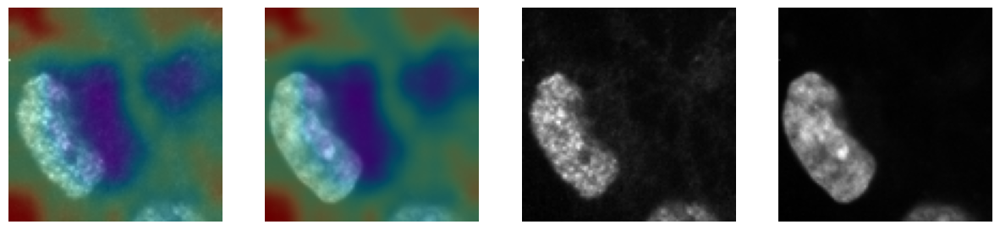

pc=3


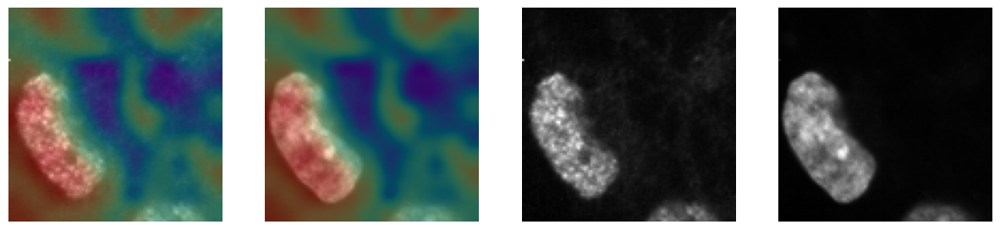

img: 2
pc=0


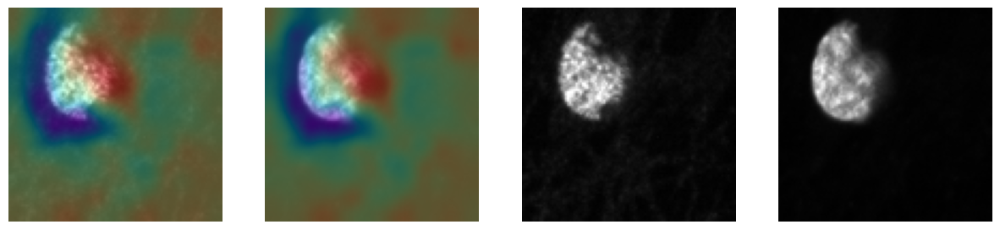

pc=1


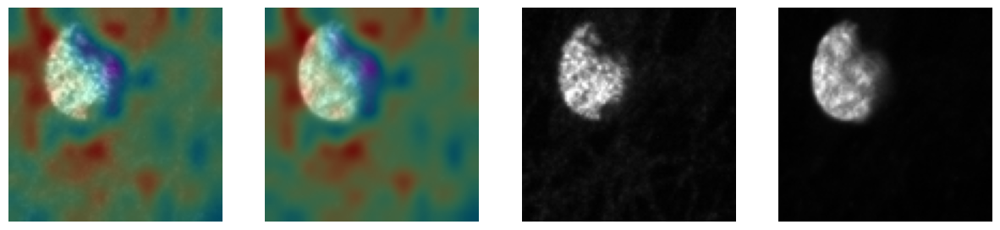

pc=2


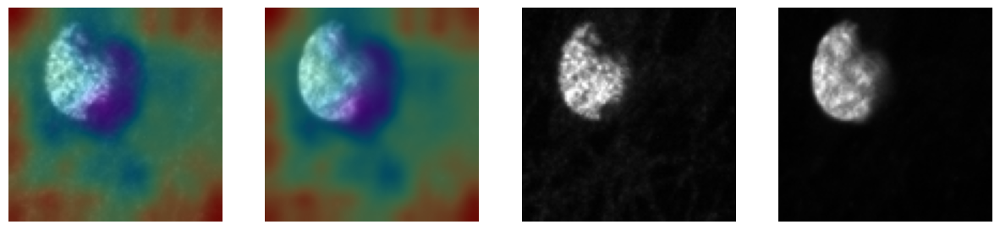

pc=3


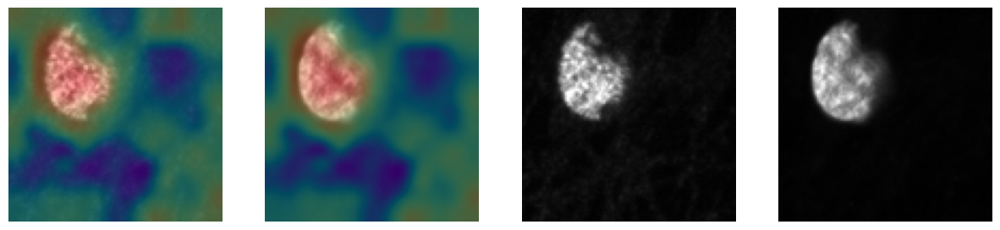

img: 3
pc=0


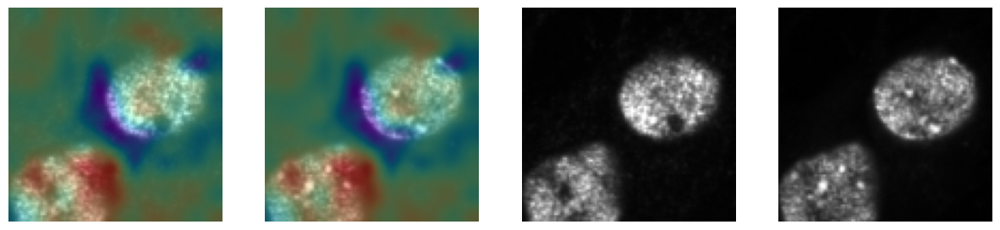

pc=1


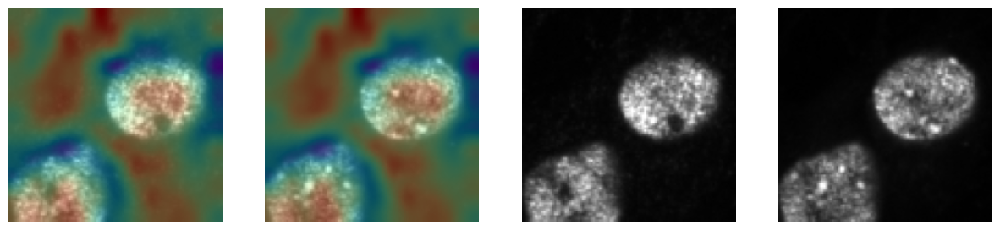

pc=2


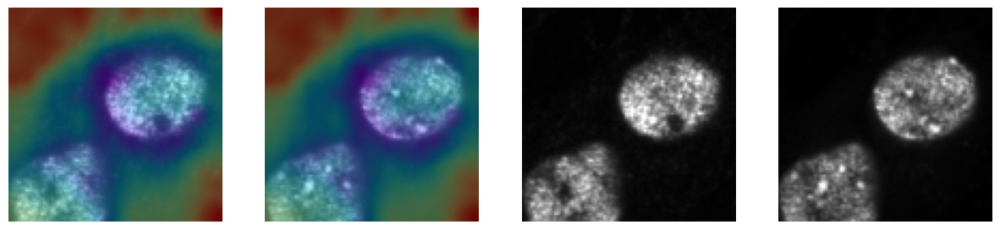

pc=3


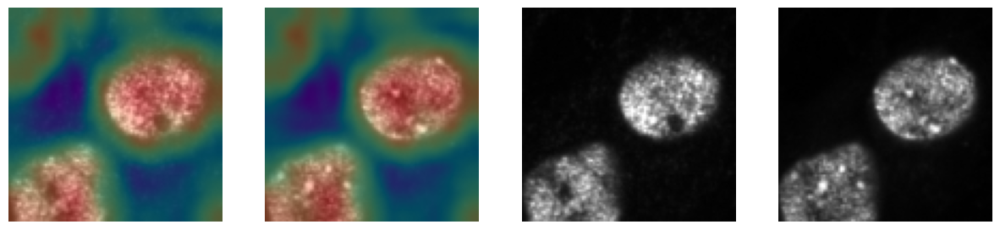

img: 4
pc=0


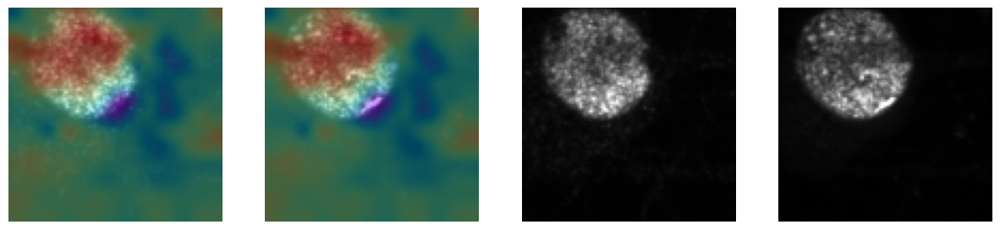

pc=1


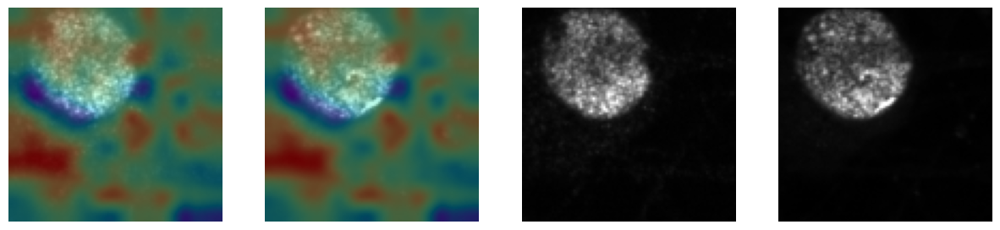

pc=2


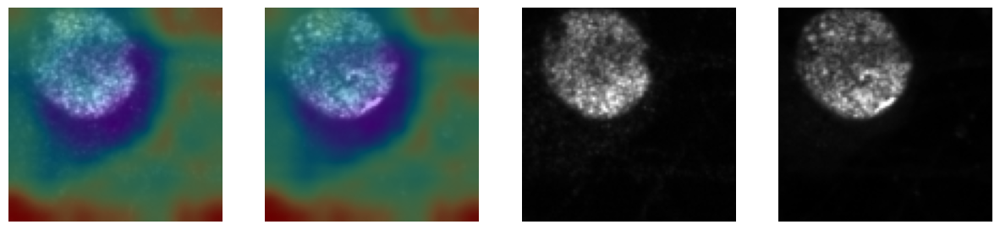

pc=3


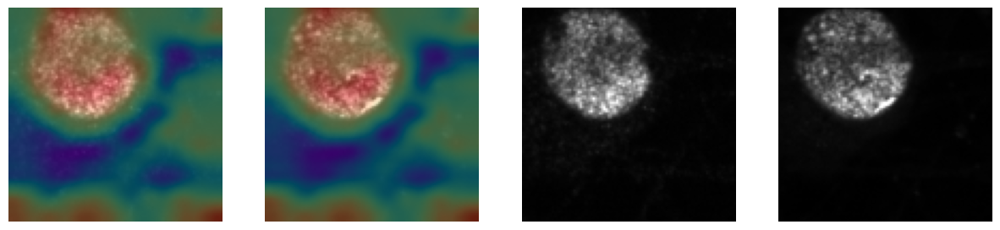

In [20]:
import umap
from sklearn.manifold import TSNE

pc_indx_compare = [0,1,2,3]#[1,2,3,4]
n_pcs = 10#max(pc_indx_compare)+1

imgs_cond1 = vals_cond1['image'].to(torch.float)
print(vals_cond1['image_path'][0])
# imgs_cond1 = imgs_cond1[:500,...]
print(imgs_cond1.shape)

imgs_cond2 = vals_cond2['image'].to(torch.float)
print(vals_cond2['image_path'][0])
# imgs_cond2 = imgs_cond2[:500,...]
print(imgs_cond2.shape)

imgs_combined = torch.vstack([imgs_cond1, imgs_cond2])
print(f"combined: {imgs_combined.shape}")
lbls = [0]*len(imgs_cond1) + [1]*len(imgs_cond2)
print(lbls)

# reducer = umap.UMAP(n_components=n_pcs, n_neighbors=15, min_dist=0.1)
reducer= PCA(n_components=n_pcs, whiten=True)
# reducer = TSNE(n_components=n_pcs)
# reducer=None
attn_maps = get_attn_maps(extractor, imgs_combined, lbls=lbls, pc_indx_compare=pc_indx_compare, reducer=reducer, n_components=n_pcs)
print(attn_maps.shape)
# attn_maps_wt = np.mean(attn_maps, axis=0)



# attn_maps = get_attn_maps(extractor, imgs, n_components=n_pcs)
# attn_maps_fus = np.mean(attn_maps, axis=0)

# attn_maps_wt.shape, attn_maps_fus.shape

# print(attn_maps.shape)
print('----------------- Cond1 ----------------------')
plt_attn_maps(imgs_combined[:len(imgs_cond1)], attn_maps[:len(imgs_cond1)], pc_indxs=pc_indx_compare, overlay=True, attn_cmap='rainbow', alpha=0.4)


print('----------------- Cond2 ----------------------')
plt_attn_maps(imgs_combined[len(imgs_cond1):], attn_maps[len(imgs_cond1):], pc_indxs=pc_indx_compare, overlay=True, attn_cmap='rainbow', alpha=0.4)

/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/WT/Untreated/G3BP1/rep2_R11_w3confCy5_s309_panelA_WT_processed.npy
torch.Size([5, 2, 100, 100])
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch6/WT/stress/G3BP1/rep2_R11_w3confCy5_s139_panelA_WT_processed.npy
torch.Size([7, 2, 100, 100])
combined: torch.Size([12, 2, 100, 100])
[0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1]
reducer: PCA(n_components=10, whiten=True)


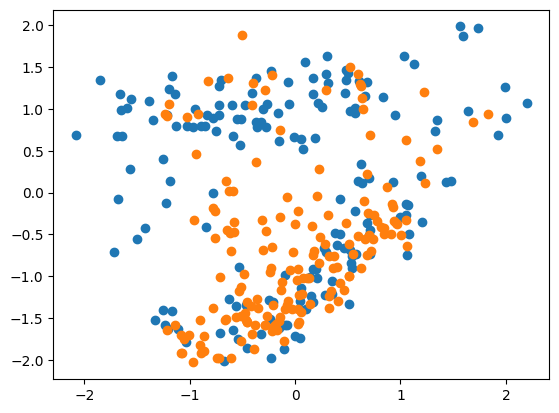

2028 (12, 169, 768)
oob score: 0.8634122287968442
oob score for pc [0, 1]: 0.6193293885601578
top 10 indices: [4 1 3 2 9 7 6 0 5 8]
feature_importances in indices: [0.126008   0.11565319 0.11168892 0.10384692 0.09968032 0.09772155
 0.0911345  0.08835532 0.08504268 0.0808686 ]
individual_pca_descs_clean shape: (12, 169, 10)
(12, 100, 100, 10)
----------------- Cond1 ----------------------
img: 0
pc=0


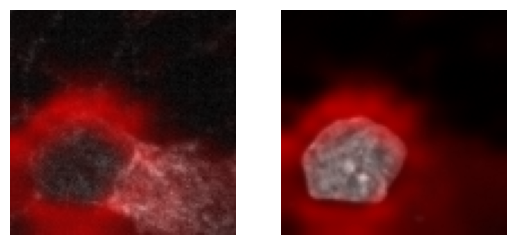

pc=1


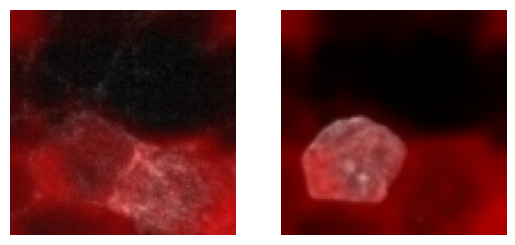

img: 1
pc=0


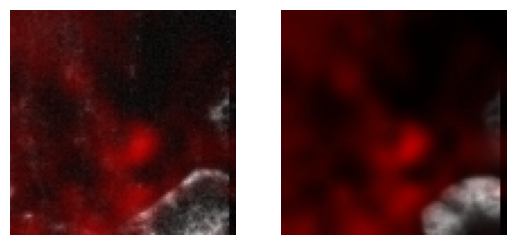

pc=1


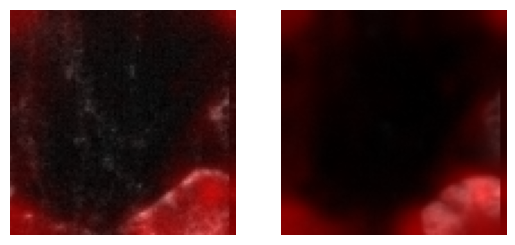

img: 2
pc=0


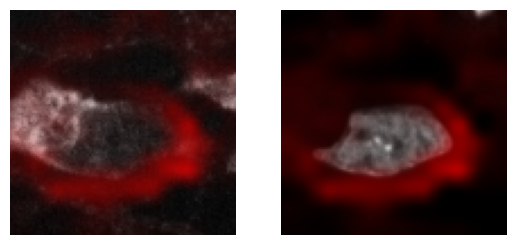

pc=1


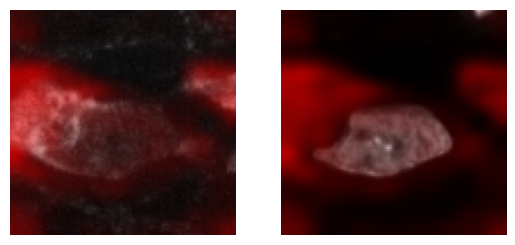

img: 3
pc=0


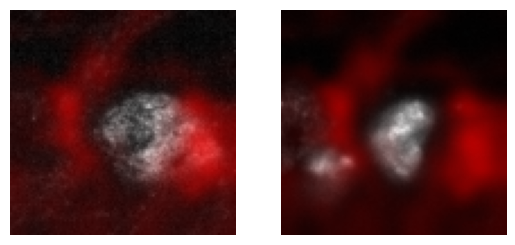

pc=1


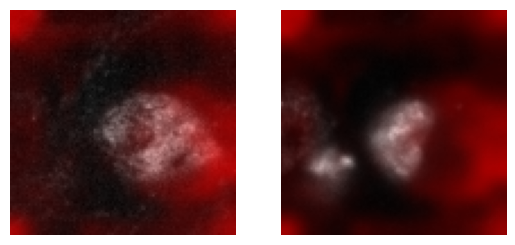

img: 4
pc=0


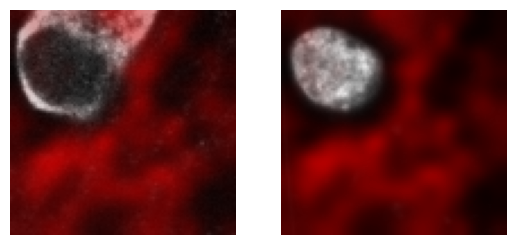

pc=1


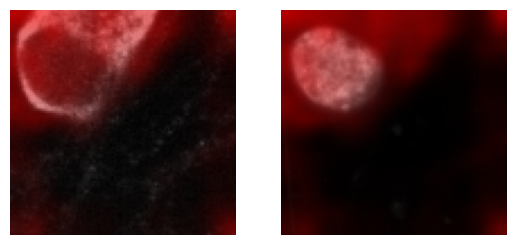

----------------- Cond2 ----------------------
img: 0
pc=0


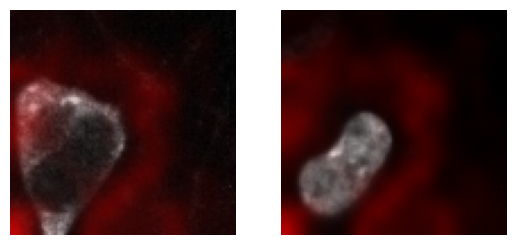

pc=1


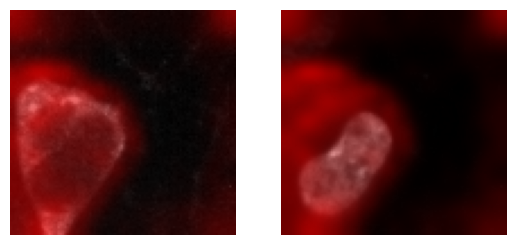

img: 1
pc=0


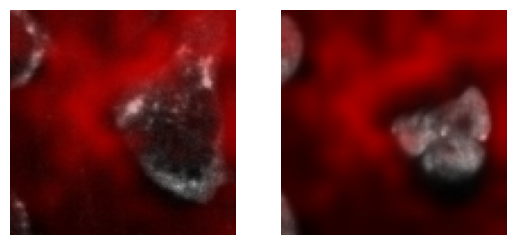

pc=1


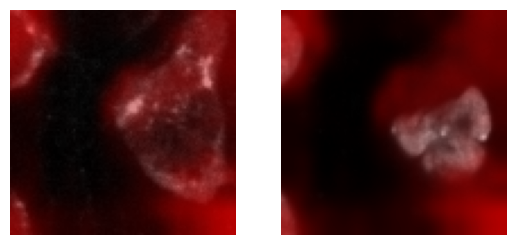

img: 2
pc=0


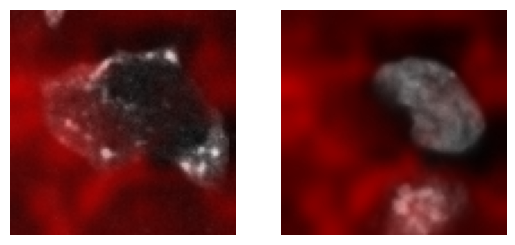

pc=1


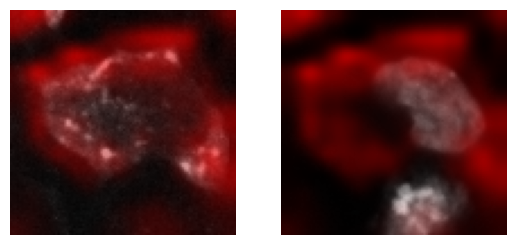

img: 3
pc=0


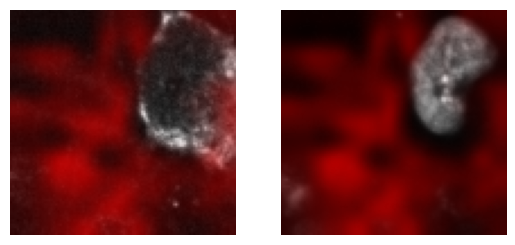

pc=1


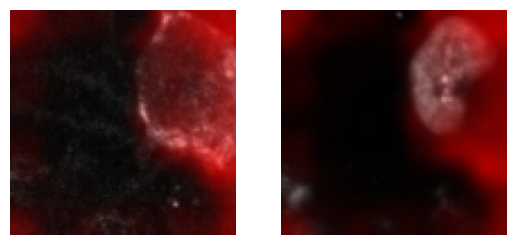

img: 4
pc=0


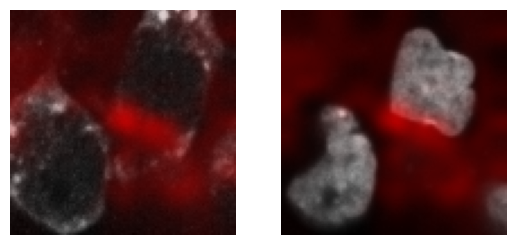

pc=1


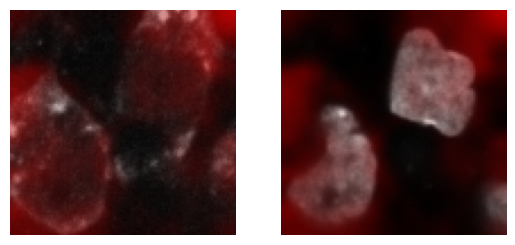

img: 5
pc=0


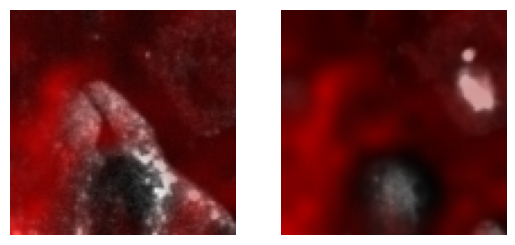

pc=1


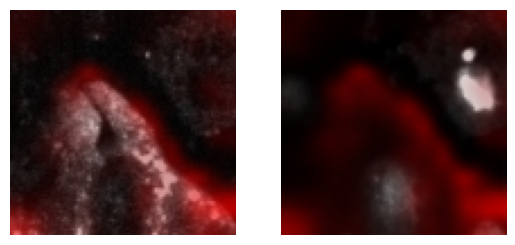

img: 6
pc=0


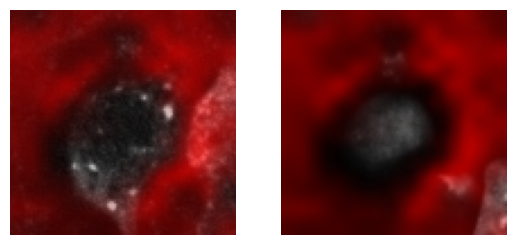

pc=1


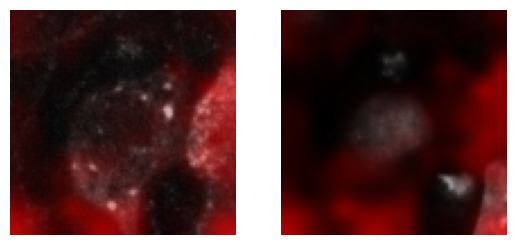

----

In [32]:
features_processed = features.detach().cpu().numpy()[:,0,...]
features_processed.shape

(8, 169, 768)

In [33]:
from sklearn.decomposition import PCA

n_components = 10
pca = PCA(n_components=n_components, whiten=True)
pca_descs_clean = pca.fit_transform(np.concatenate(features_processed))
print(f"pca_descs_clean: {pca_descs_clean.shape}")
individual_pca_descs_clean = pca_descs_clean.reshape(features_processed.shape[0], features_processed.shape[1], n_components)
print(f"individual_pca_descs_clean: {individual_pca_descs_clean.shape}")

pca_descs_clean: (1352, 10)
individual_pca_descs_clean: (8, 169, 10)


In [35]:
import cv2

pca_desc_one = individual_pca_descs_clean[0]

row_size = 13
col_size = 13

desc_clean = np.stack([cv2.resize(pca_desc_one[:,c].reshape(row_size, col_size), dsize=(100, 100), interpolation=cv2.INTER_CUBIC) for c in range(n_components)]).transpose(1,2,0)
desc_clean.shape

(100, 100, 10)

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
magenta_cmap = LinearSegmentedColormap.from_list('magentas', [(0, 0, 0, 0), (1, 0, 0, 1)], N=256)

new_desc_clean = np.copy(desc_clean)
new_desc_clean -= new_desc_clean.min(axis=(0,1))
new_desc_clean /= new_desc_clean.max(axis=(0,1))

vals_imgs = vals['image'][0,...]
fig, ax = plt.subplots(1,2)
for c in range(2):
    ax[c].imshow(vals_imgs[c,...], vmin=0, vmax=1, cmap='gray')
plt.show()

plt.imshow(imgs[0,0,...], cmap='gray')

plt.imshow(new_desc_clean[:,:,0], alpha=0.7, cmap=magenta_cmap)
# plt.axis('off')
plt.show()

----------------

In [11]:
import random

import os
import sys


os.environ['MOMAPS_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps'
os.environ['MOMAPS_DATA_HOME'] = '/home/labs/hornsteinlab/Collaboration/MOmaps/input'

sys.path.insert(1, os.getenv("MOMAPS_HOME"))
print(f"MOMAPS_HOME: {os.getenv('MOMAPS_HOME')}")


from sandbox.eval_new_arch.dino4cells.utils import utils
import torch.backends.cudnn as cudnn
from sandbox.eval_new_arch.dino4cells.archs import vision_transformer as vits
import numpy as np
import logging
import torch

from src.common.lib.dataset import Dataset
from src.datasets.dataset_spd import DatasetSPD
from src.common.lib.utils import load_config_file
from src.common.lib.data_loader import get_dataloader
import matplotlib.pyplot as plt 
%matplotlib inline


%load_ext autoreload
%autoreload 2


config_path_data = "./src/datasets/configs/embeddings_data_config/EmbeddingsB6SubsetDatasetConfig"


# model, config_model =  init_model_for_embeddings(config_path_model=config_path_model)
config_data = load_config_file(config_path_data)

# logging.info('Not doing softmax!!')
# if len(sys.argv) > 3:
# output_folder_path = sys.argv[3]
# output_folder_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/noam_eval_fc/full_model_basic_aug_no_drop_b6rep2"

# output_folder_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/noam_eval_fc/subset_model_basic_aug_no_drop_b6rep2"
# # else:
#     # output_folder_path = os.path.join(config_model.MODEL_OUTPUT_FOLDER, "pretext")
# if not os.path.exists(output_folder_path):
#     logging.info(f"{output_folder_path} doesn't exists. Creating it")
#     os.makedirs(output_folder_path)

#     jobid = os.getenv('LSB_JOBID')
#     logging.info(f"init (jobid: {jobid})")
#     logging.info("[Predict label with fc]")

#     logging.info(f"Is GPU available: {torch.cuda.is_available()}")
#     logging.info(f"Num GPUs Available: {torch.cuda.device_count()}")



# utils.init_distributed_mode(args)
# torch.manual_seed(config.seed)
# torch.cuda.manual_seed_all(config.seed)
# np.random.seed(config.seed)
# utils.fix_random_seeds(config.seed)
# init_signal_handler()
# logging.info("git:\n  {}\n".format(utils.get_sha()))
# logging.info(
#     "\n".join("%s: %s" % (k, str(v)) for k, v in sorted(dict(vars(args)).items()))
# )
# cudnn.benchmark = True
cudnn.benchmark = False
random.seed(1)

# chosen_loader = file_dataset.image_modes[config["model"]["image_mode"]]
# FileList = file_dataset.data_loaders[config["model"]["datatype"]]

# ============ preparing data ... ============
# transform =  DataAugmentationVIT(config=config)
# transform = transforms.Compose([
#         # RandomResizedCropWithCheck(100, scale=(0.6, 1.0)),
#         transforms.RandomHorizontalFlip(),
#         transforms.RandomVerticalFlip()])

config_data = load_config_file(config_path_data)

dataset = DatasetSPD(config_data, None)
# config.out_dim = len(np.unique(dataset_train.label))
# train_indexes, val_indexes, test_indexes = None, None, None
# # dataset_val, dataset_test = None, None


# # if is_one_config_supplied:
# # dataset_val, dataset_test = deepcopy(dataset_train), deepcopy(dataset_train) # the deepcopy is important. do not change. 
# # dataset_test.flip, dataset_test.rot = False, False
# if config_data.SPLIT_DATA:
#     logging.info("Split data...")
#     train_indexes, val_indexes, test_indexes = dataset.split()
#     dataset_test_subset = Dataset.get_subset(dataset, test_indexes)
# else:
#     # dataset_val, dataset_test = DatasetSPD(config_val), DatasetSPD(config_test)
#     dataset_test_subset = dataset




# data_loader_test = get_dataloader(dataset_test_subset, config.batch_size_per_gpu, num_workers=config.num_workers)
# logging.info(f"Data loaded: there are {len(dataset)} images.")


data_loader_test = get_dataloader(dataset, 10, num_workers=1, shuffle=False)
print(f"unique markers: {dataset.unique_markers} ({len(dataset.unique_markers)}) unique classes: {dataset.unique_classes}")

# dataset.X_paths

MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
to_sort = True
unique markers: ['ANXA11' 'CLTC' 'FUS' 'LAMP1'] (4) unique classes: ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'SCNA_Untreated'
 'TBK1_Untreated' 'TDP43_Untreated' 'WT_Untreated']


In [31]:
# print(next(iter(data_loader_test))['image'].shape)
for i in range(24,0,-1):
    print(i, ((100 // 14) * (100*i // 14))**0.5)

24 34.597687784012386
23 33.88214869219483
22 33.15116890850155
21 32.4037034920393
20 31.52776554086889
19 30.740852297878796
18 29.93325909419153
17 29.103264421710495
16 28.24889378365107
15 27.367864366808018
14 26.457513110645905
13 25.37715508089904
12 24.392621835300936
11 23.366642891095847
10 22.293496809607955
9 21.166010488516726
8 19.974984355438178
7 18.708286933869708
6 17.146428199482248
5 15.652475842498529
4 14.0
3 12.12435565298214
2 9.899494936611665
1 7.0


In [12]:
config = {
        'seed': 1,
        'embedding': {
            'image_size': 100
        },
        # 'n_markers_to_stream': 23,
        'patch_size': 14,
        'num_channels': 2,
        'out_dim': 225,
        'use_bn_in_head': False,
        'norm_last_layer': True,
        
        'local_crops_number': 8,
        'warmup_teacher_temp': 0.04,
        'teacher_temp': 0.04,
        'warmup_teacher_temp_epochs': 0,
        'epochs': 5,
        'student_temp': 0.1,
        'center_momentum': 0.9,
        'momentum_teacher': 0.996,
        
        'lr': 0.0005,
        'min_lr': 1e-6,
        'warmup_epochs': 10,
        
        'weight_decay': 0.04,
        'weight_decay_end': 0.4,
        
        
        'batch_size_per_gpu': 4,
        'num_workers': 1
    }
    
class DictToObject:
    def __init__(self, dict_obj):
        for key, value in dict_obj.items():
            if isinstance(value, dict):
                # Recursively convert dictionaries to objects
                setattr(self, key, DictToObject(value))
            else:
                setattr(self, key, value)    

config = DictToObject(config)

# print(f"in_chans={config.num_channels*len(dataset.unique_markers)}")

model = vits.vit_base(
            # img_size=[config.embedding.image_size, config.embedding.image_size*len(dataset.unique_markers)],
            img_size=[config.embedding.image_size, config.embedding.image_size],
            patch_size=config.patch_size,
            # drop_path_rate=0.1,  # stochastic depth
            # drop_rate=0.3, # can't go together with drop_path_rate - cuda out of memory
            # in_chans=config.num_channels,
            in_chans=config.num_channels,#*len(dataset.unique_markers),
            num_classes=256#len(dataset.unique_markers)
    ).cuda()

chkp_path = "/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/eval_new_arch/vit_contrastive/checkpoints/checkpoints_240624_232822_472218_with_shuffle/checkpoint_best.pth"

model = utils.load_model_from_checkpoint(chkp_path, model)


num_patches=49


In [122]:
import math
import torch.nn as nn

n_markers = 4
N = 1246

######

dim = 738
w0 = 100// 14
# h0 = 100*len(dataset.unique_markers) // 14
h0 = 100*n_markers // 14
w0, h0 = w0 + 0.1, h0 + 0.1
# good
g = torch.rand((1,N,738))
print(g.shape)

g = g.reshape(1, N//14,  -1, dim).permute(0, 3, 1, 2)
# g = g.permute(0, 2, 1)
print(g.shape)

g_inter = nn.functional.interpolate(
            g,
            scale_factor=(w0  / g.shape[2], h0 / g.shape[3]),
            mode='bicubic',
        )
print(f"inter:{g_inter.shape}")

torch.sum(g), torch.sum(g_inter)
# # Bad
# a = torch.zeros((1,1246,738))
# a.shape

MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps


[autoreload of sandbox.eval_new_arch.dino4cells.archs.vision_transformer failed: Traceback (most recent call last):
  File "/home/labs/hornsteinlab/sagyk/.local/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/home/labs/hornsteinlab/sagyk/.local/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 500, in superreload
    update_generic(old_obj, new_obj)
  File "/home/labs/hornsteinlab/sagyk/.local/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 397, in update_generic
    update(a, b)
  File "/home/labs/hornsteinlab/sagyk/.local/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 365, in update_class
    update_instances(old, new)
  File "/home/labs/hornsteinlab/sagyk/.local/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 319, in update_instances
    refs = gc.get_referrers(old)
KeyboardInterrupt
]


torch.Size([1, 1246, 738])
torch.Size([1, 738, 89, 14])


KeyboardInterrupt: 

In [101]:
(w0 / int(math.sqrt(N)), h0 /int(math.sqrt(N)))

(0.5071428571428571, 2.007142857142857)

In [13]:
for i in range(10):
    print([s.split(os.sep)[-2] for s in dataset.X_paths[i]], dataset.y[i])#, dataset.X_paths[1], dataset.X_paths[2], dataset.X_paths[3]

['ANXA11', 'CLTC', 'FUS', 'LAMP1'] WT_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] OPTN_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] SCNA_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] TBK1_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] TDP43_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] FUSHomozygous_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] FUSHeterozygous_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] FUSRevertant_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] WT_Untreated
['ANXA11', 'CLTC', 'FUS', 'LAMP1'] OPTN_Untreated


In [99]:
sample = next(iter(data_loader_test))
print(sample['image'].shape)
sample

torch.Size([53, 6, 100, 100])


{'image': tensor([[[[4.2046e-02, 4.1805e-02, 3.0729e-02,  ..., 5.0497e-02,
            4.3845e-02, 3.1812e-02],
           [3.0789e-02, 3.0775e-02, 3.6047e-02,  ..., 5.7998e-02,
            5.1161e-02, 5.0777e-02],
           [1.5953e-02, 4.5777e-02, 3.9842e-02,  ..., 6.1749e-02,
            6.0368e-02, 4.8790e-02],
           ...,
           [4.1973e-02, 3.7842e-02, 4.5350e-02,  ..., 4.2054e-02,
            4.3862e-02, 3.7032e-02],
           [4.2567e-02, 6.0470e-02, 4.9944e-02,  ..., 4.5573e-02,
            4.2870e-02, 3.6544e-02],
           [7.2806e-02, 3.9787e-02, 4.5054e-02,  ..., 4.0585e-02,
            2.8572e-02, 4.1137e-02]],
 
          [[8.2962e-03, 5.5796e-03, 4.4207e-03,  ..., 2.1447e-02,
            1.6711e-02, 1.6159e-02],
           [6.5649e-03, 5.5017e-03, 3.4351e-03,  ..., 6.0127e-02,
            2.8602e-02, 1.8860e-02],
           [5.3134e-03, 4.5562e-03, 4.3269e-03,  ..., 1.3173e-01,
            6.8613e-02, 3.6144e-02],
           ...,
           [8.5610e-03, 6.793

torch.Size([68, 8, 100, 100])


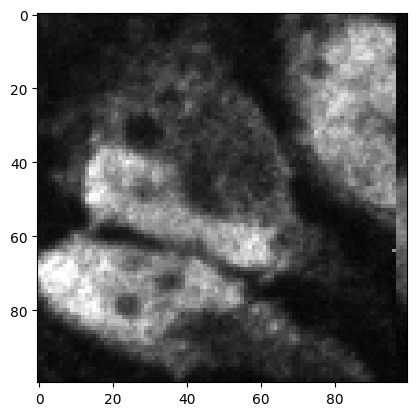

In [34]:
# import matplotlib.pyplot as plt
# %matplotlib inline

sample = next(iter(data_loader_test))
print(sample['image'].shape)
plt.imshow(sample['image'][1,0,...], cmap='gray', vmin=0, vmax=1)

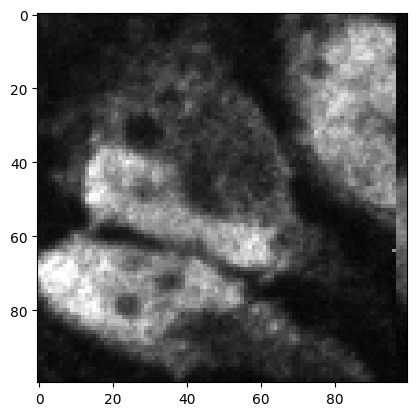

In [37]:

plt.imshow(sample['image'][1,2,...], cmap='gray', vmin=0, vmax=1)

In [14]:
# sample = next(iter(data_loader_test))
# print(sample['image'].shape, np.unique(dataset.id2label(sample['label'].detach().numpy())))

preds_array = []
lbls_array = []

with torch.no_grad():
    model.eval()
    
    for i, sample in enumerate(data_loader_test):
        inpt = sample['image'].to(torch.float).cuda()
        lbls = sample['label'].cpu().detach().numpy()
        lbls = dataset.id2label(lbls)
        preds = model(inpt)
        preds = preds.cpu()
        preds_array.append(preds)
        lbls_array.extend(lbls)
        print(preds.shape, lbls.shape, np.unique(lbls))
        
        if i >= 35:
            break
    
preds_array = np.vstack(preds_array)
lbls_array = np.asarray(lbls_array)

preds_array.shape, lbls_array.shape, np.unique(lbls_array)

torch.Size([36, 49, 768])
x shape after: torch.Size([36, 196, 768])
N=49, npatch=48 x shape: torch.Size([36, 49, 768])
49 torch.Size([36, 197, 768]) 4 torch.Size([36, 49, 768]) torch.Size([36, 49, 768]) torch.Size([1, 50, 768])
pos_encoding shape: torch.Size([1, 197, 768])
torch.Size([36, 256]) (36,) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'SCNA_Untreated'
 'TBK1_Untreated' 'TDP43_Untreated' 'WT_Untreated']
torch.Size([44, 49, 768])
x shape after: torch.Size([44, 196, 768])
N=49, npatch=48 x shape: torch.Size([44, 49, 768])
49 torch.Size([44, 197, 768]) 4 torch.Size([44, 49, 768]) torch.Size([44, 49, 768]) torch.Size([1, 50, 768])
pos_encoding shape: torch.Size([1, 197, 768])
torch.Size([44, 256]) (44,) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'SCNA_Untreated'
 'TBK1_Untreated' 'TDP43_Untreated' 'WT_Untreated']
torch.Size([39, 49, 768])
x shape after: torch.Size([39, 196, 

((1403, 256),
 (1403,),
 array(['FUSHeterozygous_Untreated', 'FUSHomozygous_Untreated',
        'FUSRevertant_Untreated', 'OPTN_Untreated', 'SCNA_Untreated',
        'TBK1_Untreated', 'TDP43_Untreated', 'WT_Untreated'], dtype='<U25'))

In [195]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# preds_array.shape, lbls_array[0],
lbl_onehot = lbls_array[:, None] == dataset.unique_classes
lbl_onehot = lbl_onehot.argmax(1)

indxes = np.arange(preds_array.shape[0])
trn_indx, tst_indx = train_test_split(indxes,
                 test_size=0.3,
                 random_state=42,
                 shuffle=True,
                 stratify=lbl_onehot)
print(trn_indx.shape, tst_indx.shape)
trn, trn_lbl = preds_array[trn_indx], lbl_onehot[trn_indx]
tst, tst_lbl = preds_array[tst_indx], lbl_onehot[tst_indx]
print(np.unique(trn_lbl), np.unique(tst_lbl))


clf = RandomForestClassifier(oob_score=True, random_state=42)
clf.fit(trn, trn_lbl)
print(f"oob score: {clf.oob_score_}")


accuracy_score(clf.predict(tst), tst_lbl)

(338,) (146,)
[0 1 2 3 4 5 6] [0 1 2 3 4 5 6]
oob score: 0.636094674556213


0.684931506849315

In [15]:
dataset.id2label(np.array(3))

array(['WT_Untreated'], dtype='<U25')

In [4]:
from umap import UMAP
import matplotlib.pyplot as plt
%matplotlib inline

def plot_umap_all_conditions(preds, true_labels):
    classes = np.unique(true_labels)
    # for c in classes:#, f'TDP43', f'OPTN', f'TBK1']]:
    #     print(f"class: {c}")
            
#         ind_filtered = np.where(mask == c)
#         preds_filtered = preds[ind_filtered]
            
            
#         if len(preds_filtered) == 0:
#             print(f"No samples for {c}")
#             continue

#         true_labels_fitlered = true_labels[ind_filtered]
#         classes = np.unique(true_labels_fitlered)
#         print(f'classes: {classes}')

    reducer = UMAP(n_components=2, random_state=1)
    # reducer.fit(cls_tokens_filtered)
    reducer.fit(preds)

    # cls_tokens_filtered_umap = reducer.transform(cls_tokens_filtered)
    preds_umap = reducer.transform(preds)

    colors = ['blue', 'orange', 'red', 'black', 'green', 'purple', 'pink', 'brown', 'grey']
    s = 30
    for ci, c in enumerate(classes):
        c_indx = np.where(true_labels == c)
        # cls_tokens_filtered_c = cls_tokens_filtered[c_indx]
        preds_c = preds[c_indx]

        print(f"class: {c}, shappe: {preds_c.shape}") 
        plt.scatter(preds_umap[c_indx, 0],  preds_umap[c_indx, 1], alpha=0.7, s=s, c=colors[ci])
    plt.legend(classes, bbox_to_anchor=(1.1, 1.05))
    # plt.legend([dataset.id2label(np.array([c])) for c in classes])
    plt.show()



Channel Stacking. Fixed position - reset pos emb

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (125, 256)
class: FUSHomozygous_Untreated, shappe: (227, 256)
class: FUSRevertant_Untreated, shappe: (225, 256)
class: OPTN_Untreated, shappe: (136, 256)
class: SCNA_Untreated, shappe: (144, 256)
class: TBK1_Untreated, shappe: (193, 256)
class: TDP43_Untreated, shappe: (131, 256)
class: WT_Untreated, shappe: (222, 256)


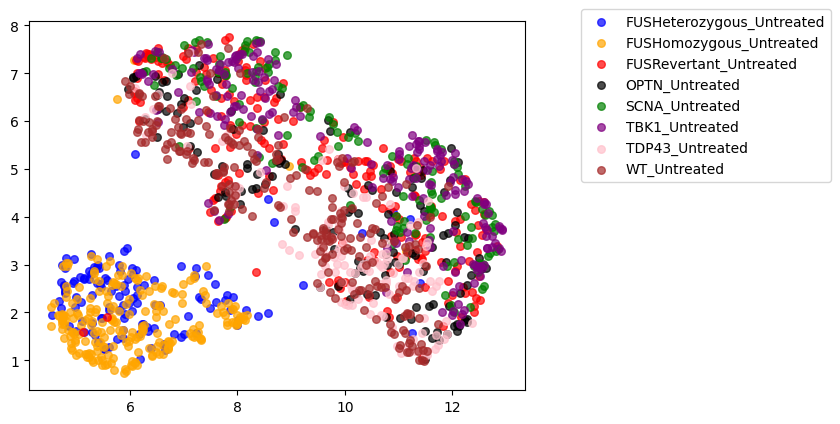

In [15]:

# B6 (both reps) - FUS & ANXA11 & CLTC & LAMP1
# ALS Lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (162, 256)
class: FUSHomozygous_Untreated, shappe: (348, 256)
class: FUSRevertant_Untreated, shappe: (323, 256)
class: OPTN_Untreated, shappe: (215, 256)
class: TBK1_Untreated, shappe: (337, 256)
class: TDP43_Untreated, shappe: (291, 256)
class: WT_Untreated, shappe: (332, 256)


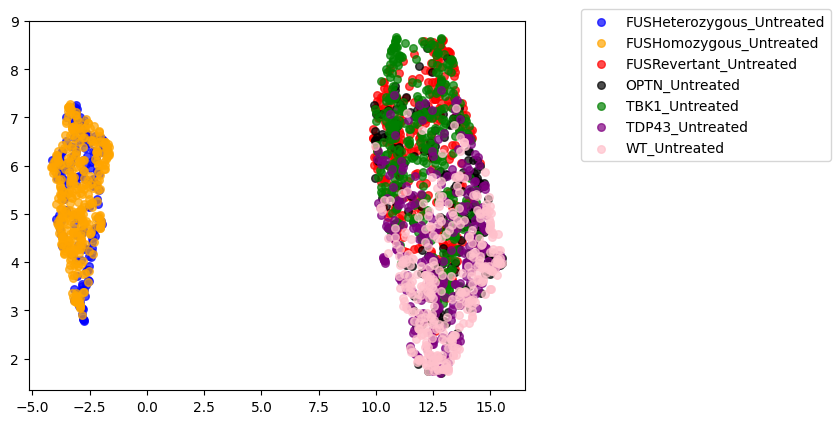

In [10]:

# B6 (both reps) - FUS & ANXA11
# ALS Lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (223, 256)
class: FUSHomozygous_Untreated, shappe: (425, 256)
class: FUSRevertant_Untreated, shappe: (439, 256)
class: OPTN_Untreated, shappe: (301, 256)
class: TBK1_Untreated, shappe: (417, 256)
class: TDP43_Untreated, shappe: (367, 256)
class: WT_Untreated, shappe: (459, 256)


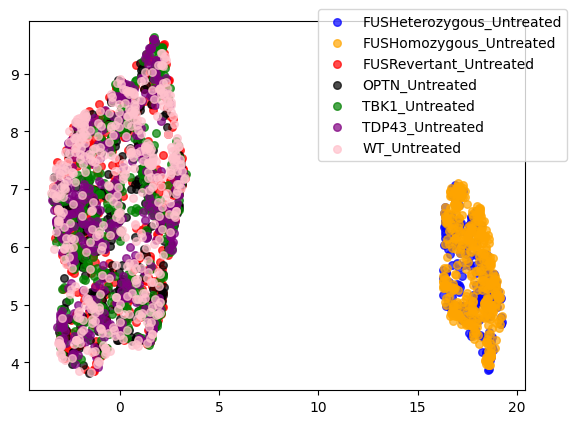

In [5]:

# B6 (both reps) - FUS Marker 4 times duplicated
# ALS Lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (74, 256)
class: FUSHomozygous_Untreated, shappe: (169, 256)
class: FUSRevertant_Untreated, shappe: (138, 256)
class: OPTN_Untreated, shappe: (76, 256)
class: TBK1_Untreated, shappe: (145, 256)
class: TDP43_Untreated, shappe: (92, 256)
class: WT_Untreated, shappe: (131, 256)


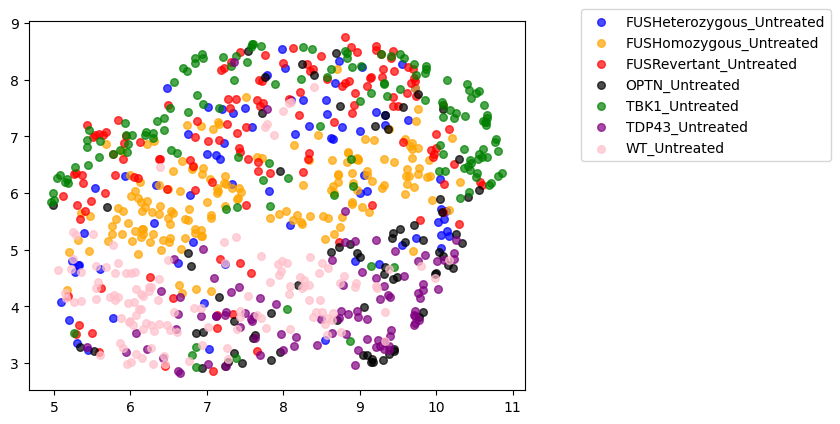

In [26]:

# B6 (both reps) - All markers but DAPI
# ALS Lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (255, 256)
class: WT_stress, shappe: (447, 256)


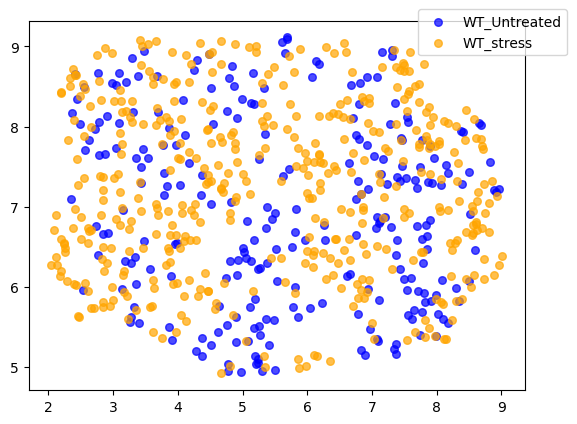

In [22]:

# B6 (both reps) - All markers but DAPI
# WT Stress Vs Untreated

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (844, 256)
class: WT_stress, shappe: (837, 256)


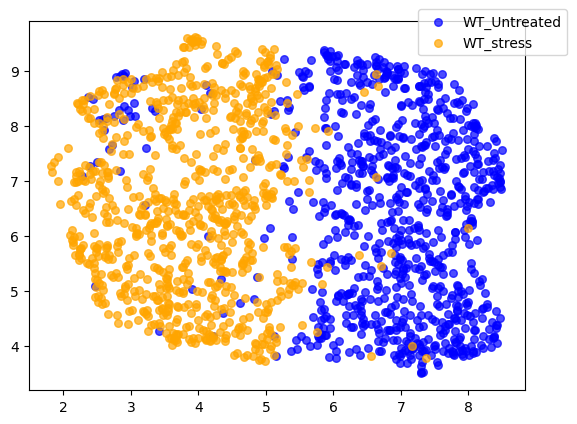

In [18]:

# B6 (both reps) - G3BP1 PURA PML LAMP1
# WT Stress Vs Untreated

plot_umap_all_conditions(preds_array, lbls_array)

Channel Stacking, fixed position - trained model.. (b78)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (232, 256)
class: FUSHomozygous_Untreated, shappe: (424, 256)
class: FUSRevertant_Untreated, shappe: (521, 256)
class: WT_Untreated, shappe: (458, 256)


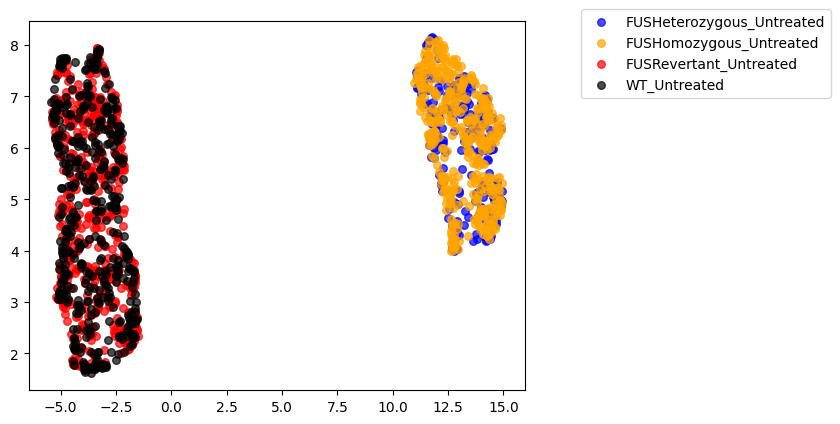

In [171]:

# B6 (both reps) - FUS
# FUS lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (47, 256)
class: FUSHomozygous_Untreated, shappe: (100, 256)
class: FUSRevertant_Untreated, shappe: (83, 256)
class: OPTN_Untreated, shappe: (44, 256)
class: TBK1_Untreated, shappe: (83, 256)
class: TDP43_Untreated, shappe: (53, 256)
class: WT_Untreated, shappe: (74, 256)


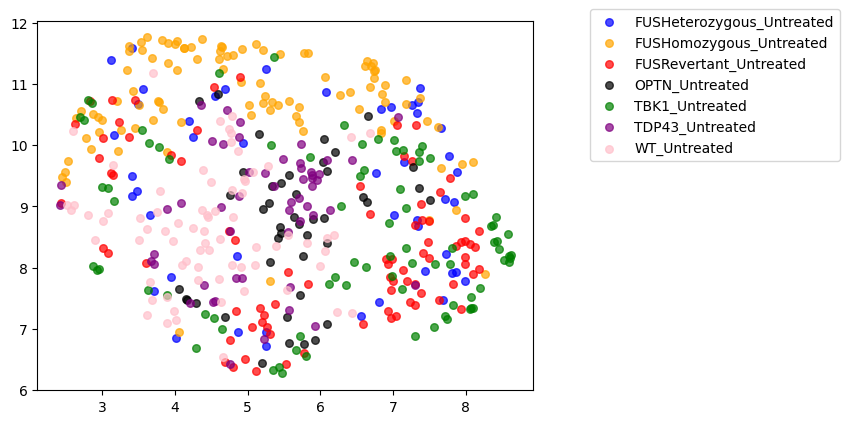

In [196]:

# B6 (both reps) - all markers
# ALS lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (47, 256)
class: FUSHomozygous_Untreated, shappe: (100, 256)
class: FUSRevertant_Untreated, shappe: (83, 256)
class: OPTN_Untreated, shappe: (44, 256)
class: TBK1_Untreated, shappe: (83, 256)
class: TDP43_Untreated, shappe: (53, 256)
class: WT_Untreated, shappe: (74, 256)


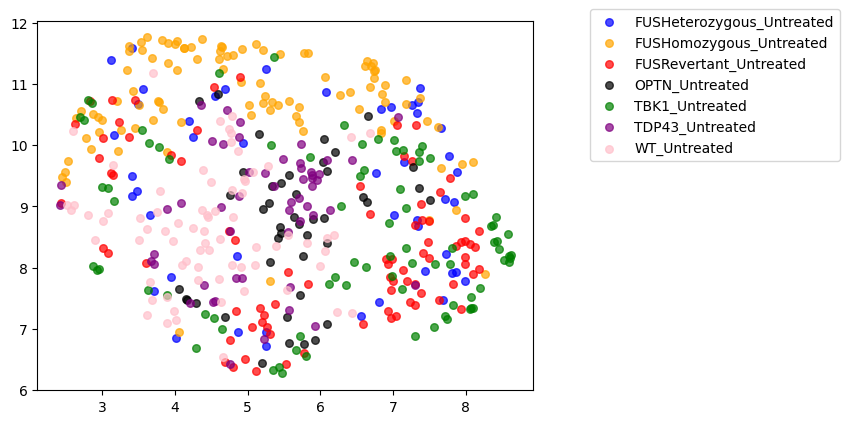

In [167]:

# B6 (both reps) - all markers
# ALS lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (513, 256)
class: WT_stress, shappe: (527, 256)


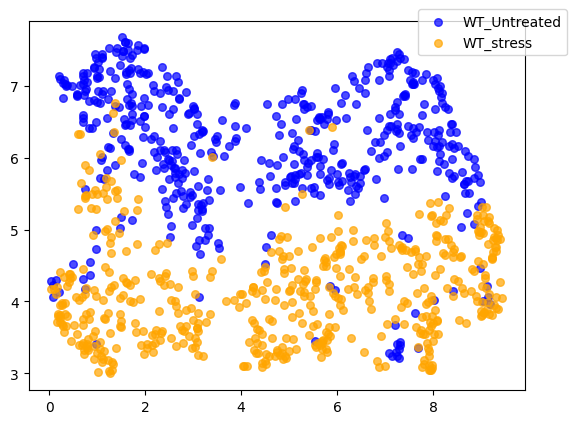

In [162]:

# B6 (both reps) - G3BP1, PURA, PML, LAMP1
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (255, 256)
class: WT_stress, shappe: (282, 256)


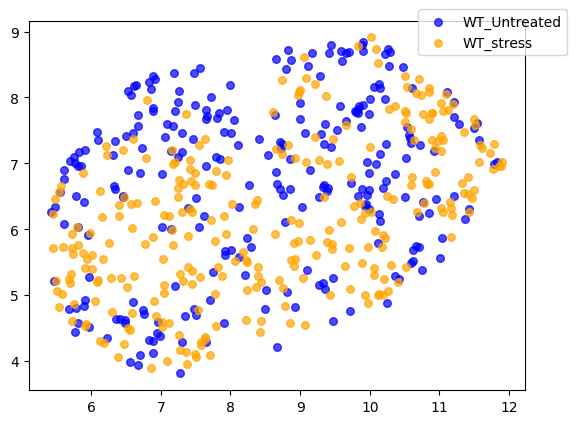

In [157]:

# B6 (both reps) - all markers but DAPI
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (66, 256)
class: WT_stress, shappe: (173, 256)


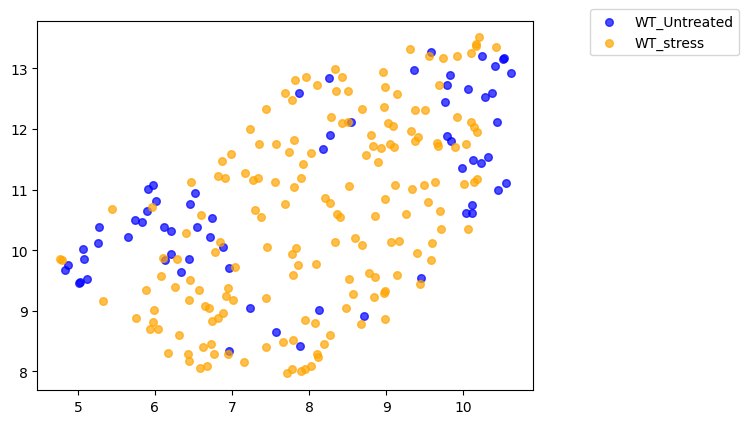

In [153]:

# B6 (rep2) - all markers but DAPI
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (523, 256)
class: WT_stress, shappe: (578, 256)


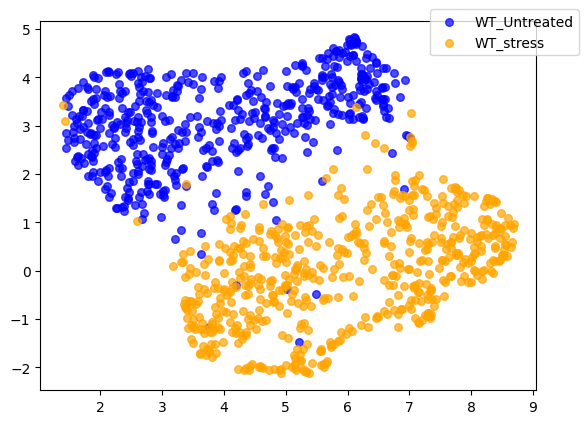

In [148]:

# B6 (rep2) - G3BP1, PURA, PML
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (834, 256)
class: WT_stress, shappe: (854, 256)


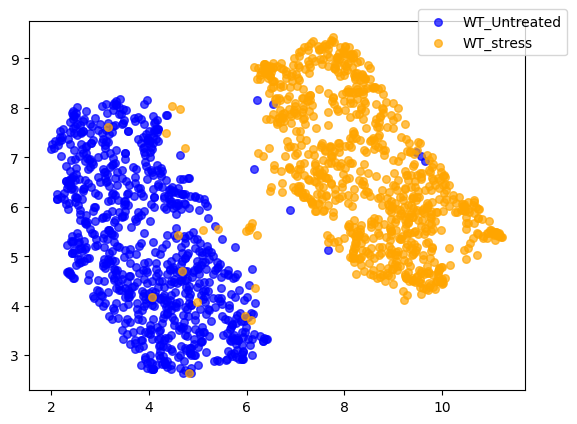

In [143]:

# B6 (rep2) - G3BP1
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

Channel stacking - again..

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (513, 256)
class: WT_stress, shappe: (527, 256)


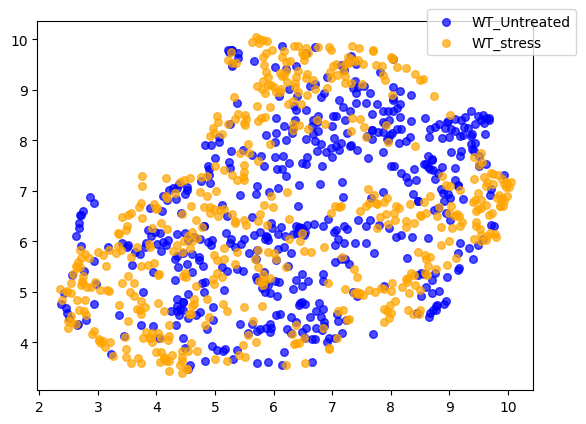

In [82]:
# sorted (0 2 1 3)
# B6 (both reps) - all markers
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (513, 256)
class: WT_stress, shappe: (527, 256)


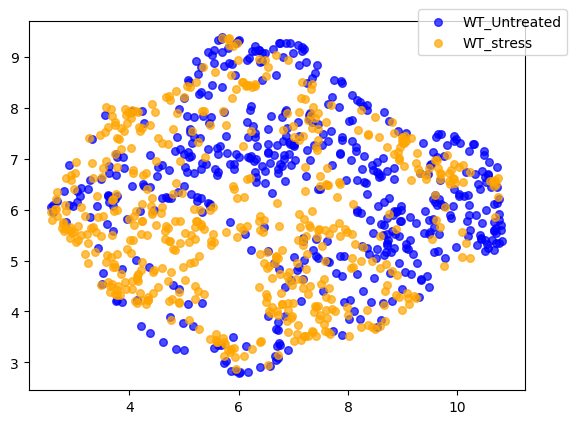

In [78]:
# sorted (1 2 3 0)
# B6 (both reps) - all markers
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (513, 256)
class: WT_stress, shappe: (527, 256)


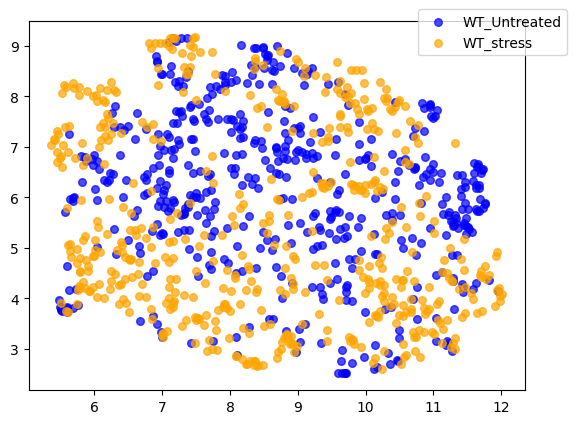

In [58]:
# sorted (0 1 2 3)
# B6 (both reps) - all markers
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (513, 256)
class: WT_stress, shappe: (527, 256)


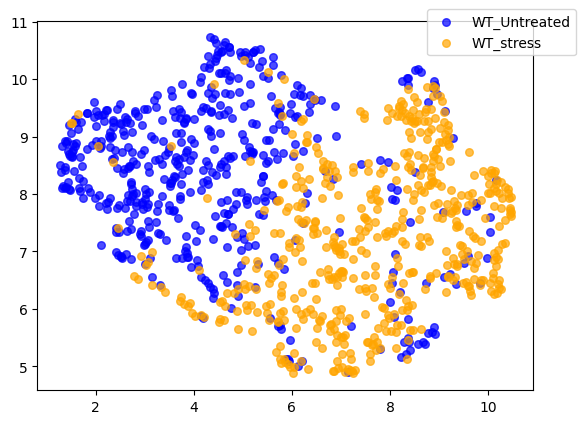

In [62]:
# No sort
# B6 (both reps) - all markers
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

Channel Stacking - fixed order + running patchEmb per channel

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (834, 256)
class: WT_stress, shappe: (854, 256)


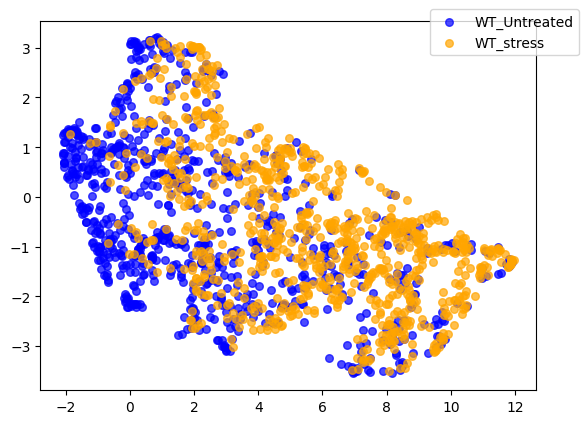

In [138]:
# Single marker
# B6 (rep2) - G3BP1
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (523, 256)
class: WT_stress, shappe: (578, 256)


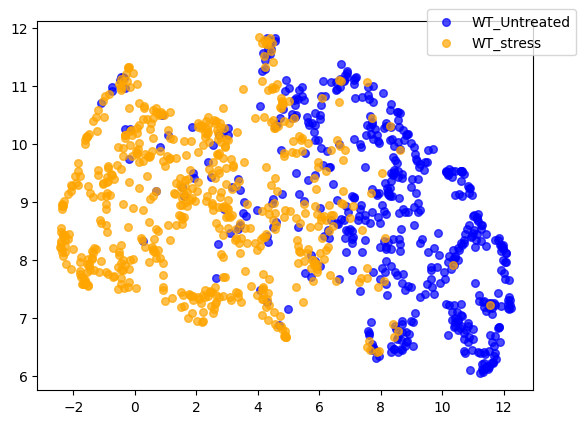

In [125]:
# No pos interpolation
# B6 (rep2) - G3BP1, PURA, PML
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (523, 256)
class: WT_stress, shappe: (578, 256)


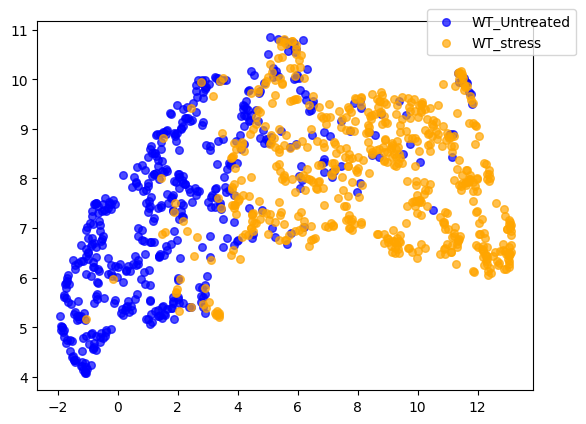

In [120]:

# B6 (rep2) - G3BP1, PURA, PML
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (66, 256)
class: WT_stress, shappe: (173, 256)


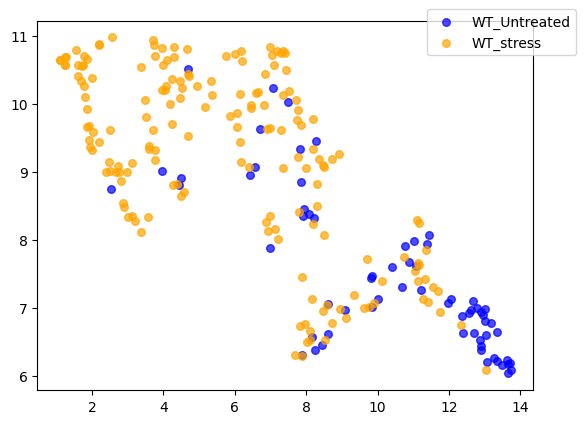

In [30]:

# B6 (rep2) - all markers
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (274, 256)
class: WT_stress, shappe: (268, 256)


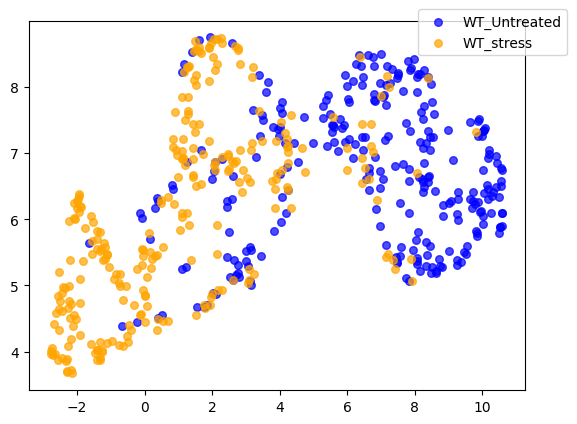

In [39]:

# B6 (both reps) - markers: 'G3BP1', 'PURA', 'PML', 'LAMP1
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

Channel Stacking - Fixed order!

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (81, 256)
class: FUSHomozygous_Untreated, shappe: (297, 256)
class: FUSRevertant_Untreated, shappe: (232, 256)
class: OPTN_Untreated, shappe: (76, 256)
class: TBK1_Untreated, shappe: (270, 256)
class: TDP43_Untreated, shappe: (152, 256)
class: WT_Untreated, shappe: (231, 256)


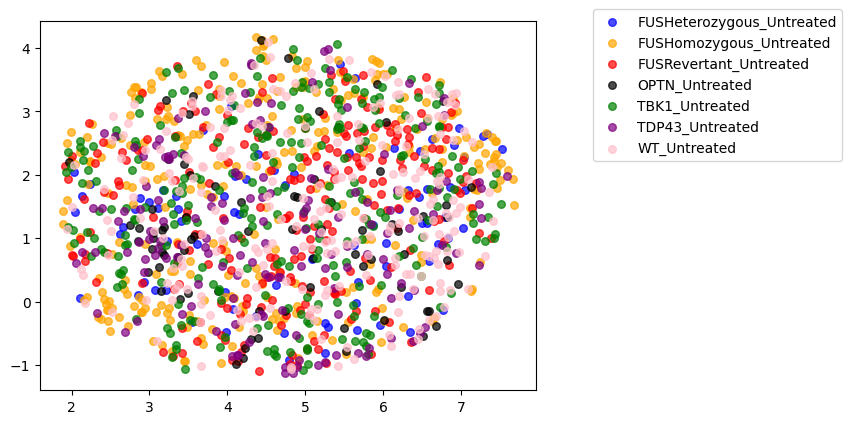

In [25]:

# B6 (both reps) - markers: All but DAPI
# ALS lines

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (255, 256)
class: WT_stress, shappe: (388, 256)


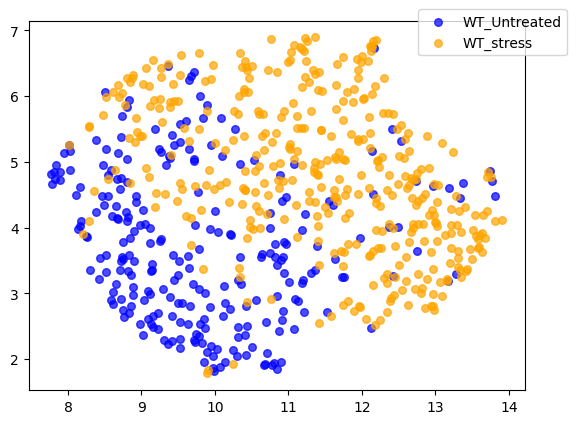

In [20]:

# B6 (both reps) - markers: All but DAPI
# WT Untreated VS Stress

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (748, 256)
class: WT_stress, shappe: (740, 256)


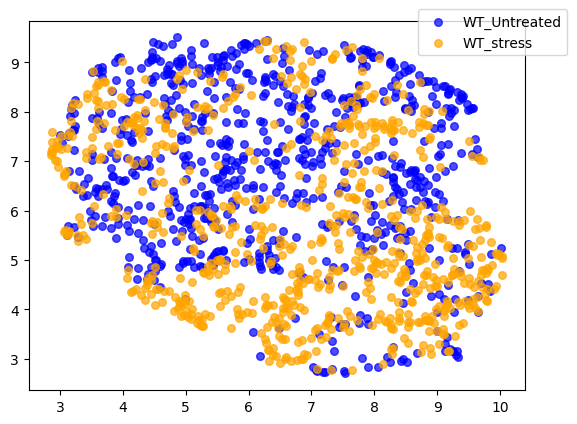

In [12]:

# B6 (both reps) - markers: 'G3BP1', 'PURA', 'PML', 'LAMP1
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (845, 256)
class: WT_stress, shappe: (865, 256)


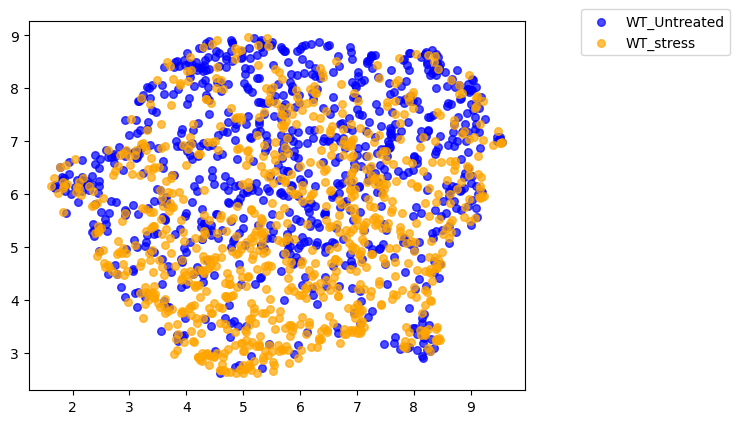

In [7]:

# B6 (both reps) - markers: Phalloidin', 'GM130', 'CD41', DAPI
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

Channel stacking

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (734, 256)
class: WT_stress, shappe: (780, 256)


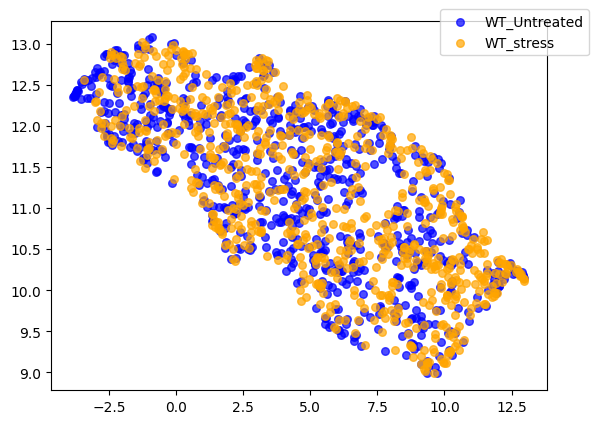

In [20]:

# B6 (both reps) - markers: Only DAPI, same image 4 times
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (845, 256)
class: WT_stress, shappe: (865, 256)


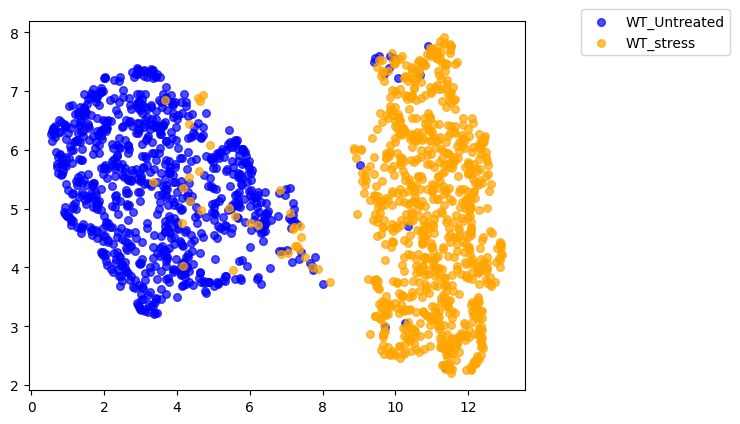

In [38]:

# B6 (both reps) - markers: Phalloidin', 'GM130', 'CD41', DAPI in reverse order: Phalloidin', 'GM130', 'CD41', DAPI
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (845, 256)
class: WT_stress, shappe: (865, 256)


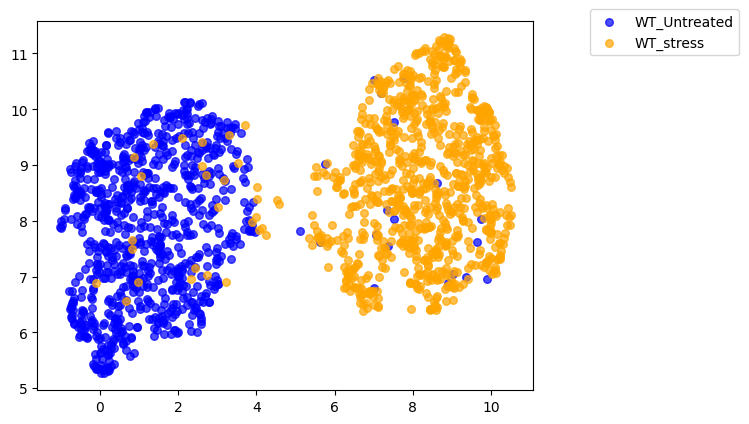

In [43]:

# B6 (both reps) - markers: Phalloidin', 'GM130', 'CD41', DAPI - order: DAPI, CD41, GM, Phallodiin
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (1062, 256)
class: WT_stress, shappe: (1131, 256)


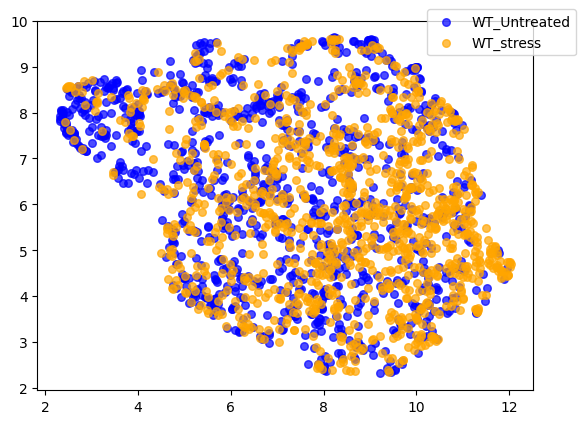

In [78]:

# B6 (both reps) - markers: Phalloidin', 'GM130'
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (993, 256)
class: WT_stress, shappe: (1009, 256)


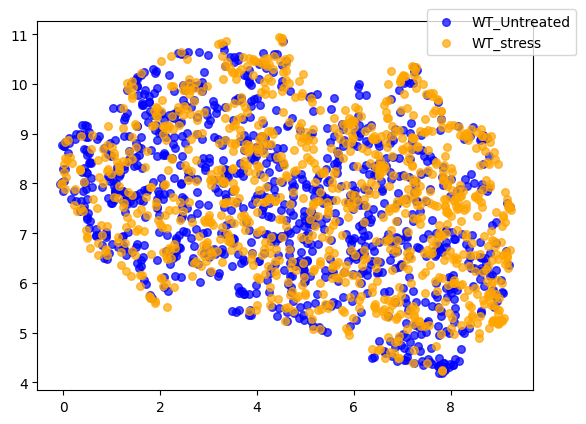

In [71]:

# B6 (both reps) - markers: CD41', 'CLTC'
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (958, 256)
class: WT_stress, shappe: (992, 256)


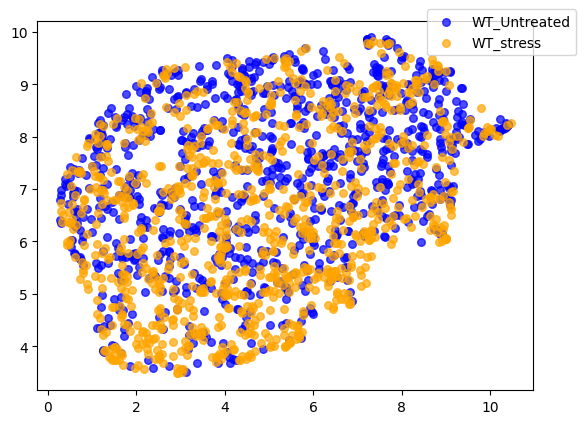

In [64]:

# B6 (both reps) - markers: Phalloidin', 'CLTC'
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (947, 256)
class: WT_stress, shappe: (969, 256)


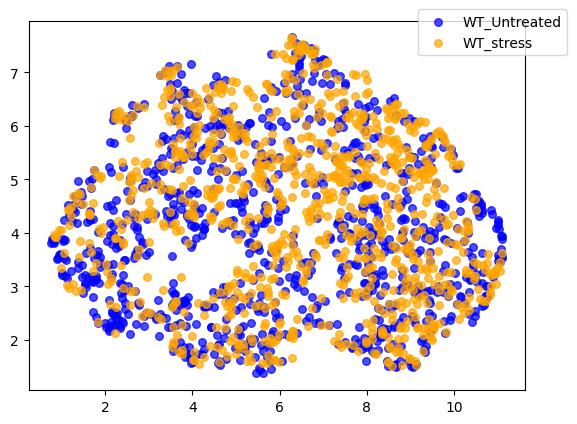

In [57]:

# B6 (both reps) - markers: GM130', 'CLTC'
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (857, 256)
class: WT_stress, shappe: (884, 256)


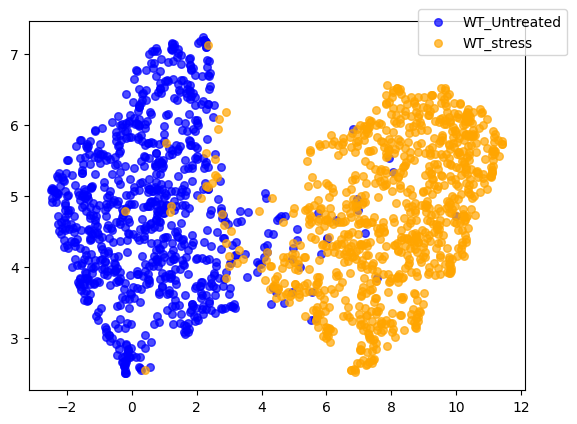

In [50]:
# PROBLEM!!

# B6 (both reps) - markers: GM130', 'Phalloidin', 'CLTC'
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (962, 256)
class: WT_stress, shappe: (986, 256)


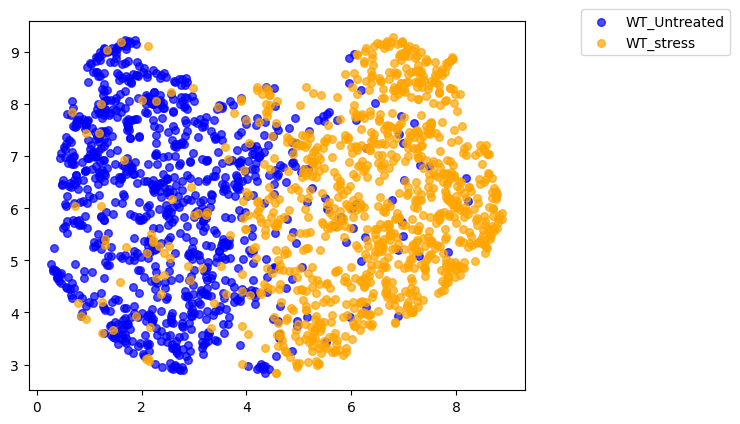

In [42]:
# PROBLEM!!


# B6 (both reps) - markers: GM130', 'Phalloidin', 'CD41'
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (819, 256)
class: WT_stress, shappe: (826, 256)


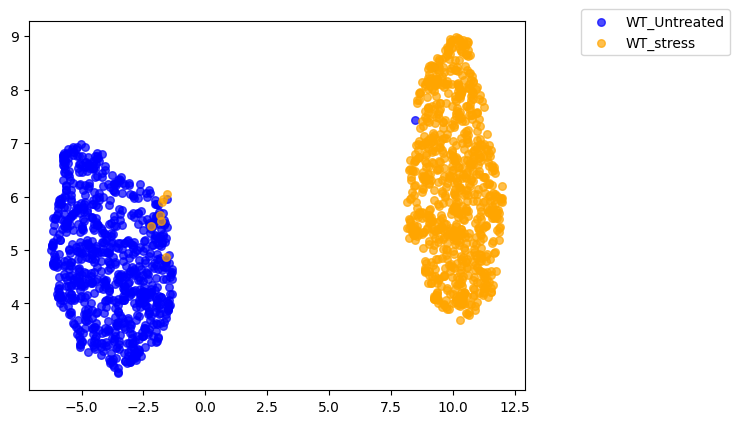

In [37]:
# PROBLEM!!

# B6 (both reps) - markers: GM130', 'Phalloidin', 'CD41', 'CLTC'
# WT Untreated VS Stress
# The markers should be highly unseperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (748, 256)
class: WT_stress, shappe: (740, 256)


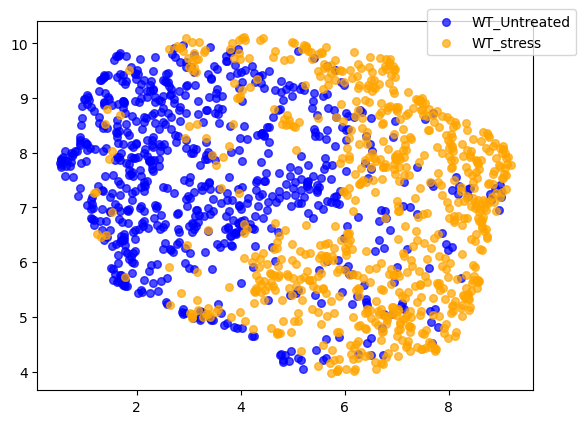

In [30]:
# B6 (both reps) - markers: G3BP1, PURA, PML, LAMP1
# WT Untreated VS Stress
# The markers should be highly seperable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (1093, 256)
class: WT_stress, shappe: (1138, 256)


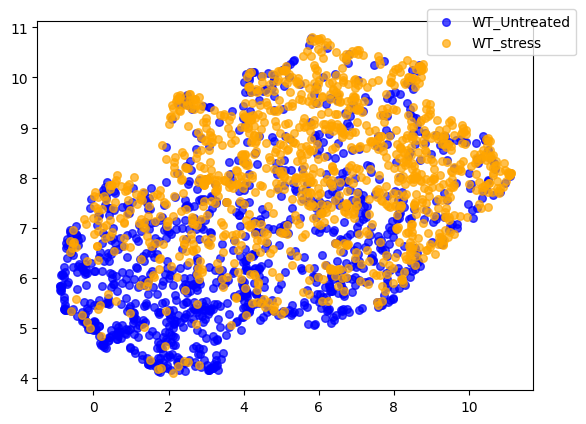

In [23]:
# B6 (both reps) - markers: G3BP1, NONO
# WT Untreated VS Stress
# The markers should be semi-seperatable

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (1080, 256)
class: WT_stress, shappe: (1129, 256)


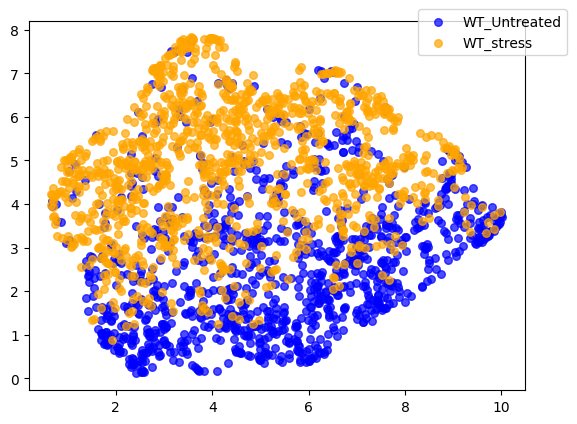

In [18]:
# B6 (both reps) - markers: G3BP1, PURA
# WT Untreated VS Stress
# The markers should(!) separate

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (618, 256)
class: WT_stress, shappe: (954, 256)


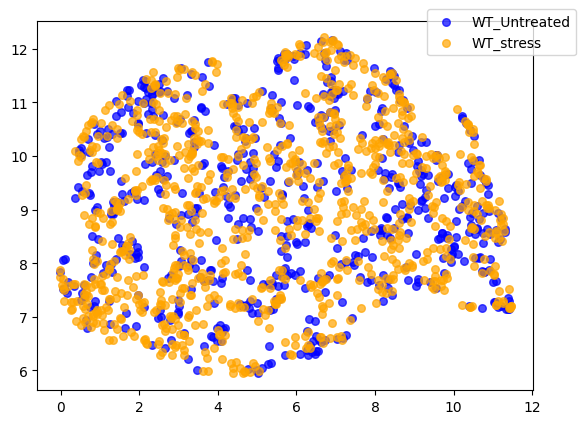

In [7]:
# B6 (both reps) - markers: NONO, DCP1A
# WT Untreated VS Stress
# The markers should not(!) separate

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (50, 256)
class: FUSHomozygous_Untreated, shappe: (65, 256)
class: FUSRevertant_Untreated, shappe: (43, 256)
class: OPTN_Untreated, shappe: (40, 256)
class: TBK1_Untreated, shappe: (29, 256)
class: TDP43_Untreated, shappe: (58, 256)
class: WT_Untreated, shappe: (65, 256)


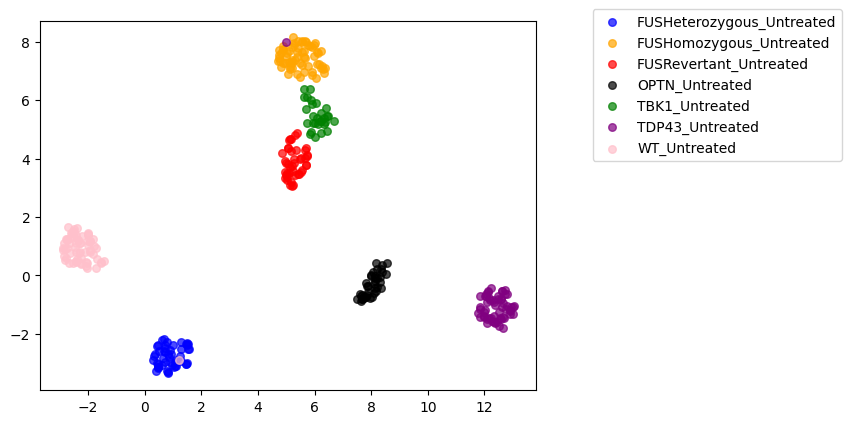

In [262]:
# SPD18days B1
# ALS lines all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: TDP43_Untreated, shappe: (122, 256)
class: TDP43_dox, shappe: (282, 256)
class: WT_Untreated, shappe: (94, 256)


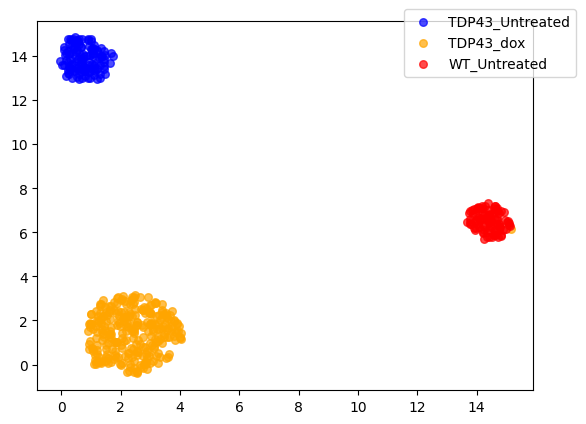

In [255]:
# dNLS B3
# all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (1002, 256)
class: WT_stress, shappe: (909, 256)


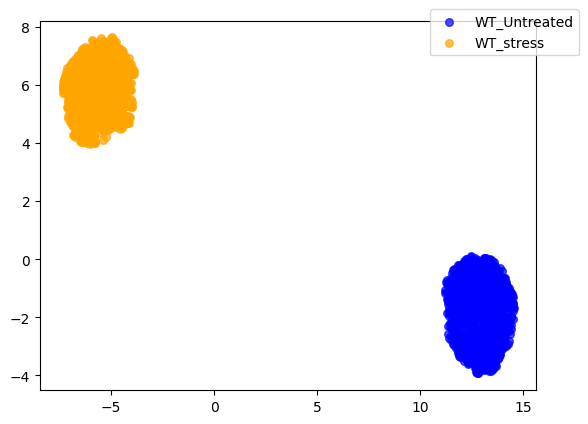

In [248]:
#B4 5 6 9
# WT stress Vs Untreated all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (117, 256)
class: FUSHomozygous_Untreated, shappe: (140, 256)
class: FUSRevertant_Untreated, shappe: (146, 256)
class: OPTN_Untreated, shappe: (192, 256)
class: TBK1_Untreated, shappe: (262, 256)
class: TDP43_Untreated, shappe: (141, 256)
class: WT_Untreated, shappe: (290, 256)


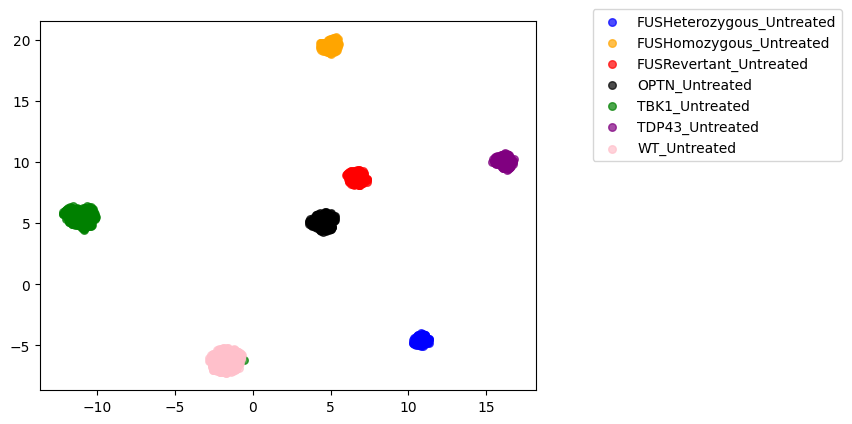

In [242]:
#B4 5 6 9
# ALS Lines all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (3, 256)
class: FUSHomozygous_Untreated, shappe: (42, 256)
class: FUSRevertant_Untreated, shappe: (20, 256)
class: OPTN_Untreated, shappe: (88, 256)
class: TBK1_Untreated, shappe: (58, 256)
class: TDP43_Untreated, shappe: (18, 256)
class: WT_Untreated, shappe: (89, 256)


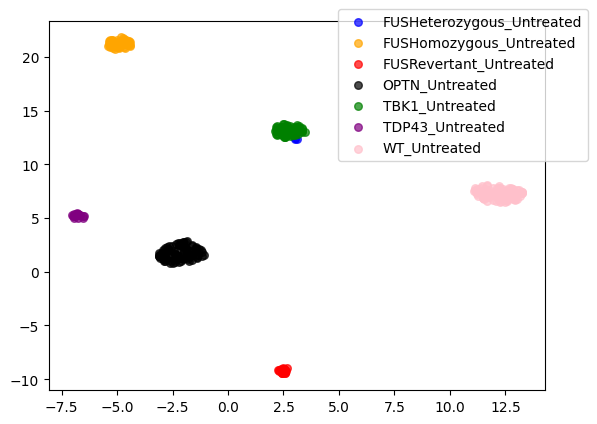

In [232]:
#B4
# ALS Lines all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (3, 256)
class: FUSHomozygous_Untreated, shappe: (46, 256)
class: FUSRevertant_Untreated, shappe: (21, 256)
class: OPTN_Untreated, shappe: (43, 256)
class: TBK1_Untreated, shappe: (38, 256)
class: TDP43_Untreated, shappe: (20, 256)
class: WT_Untreated, shappe: (42, 256)


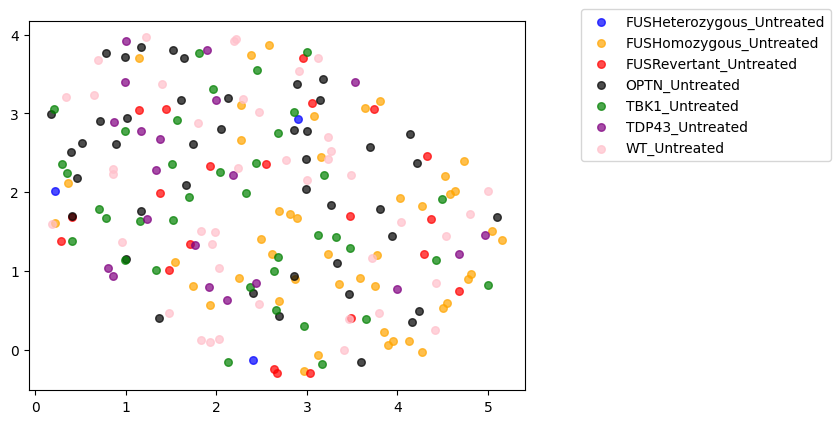

In [226]:
#B4
# ALS Lines all markers - Shuffled labels
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (7, 256)
class: FUSHomozygous_Untreated, shappe: (25, 256)
class: FUSRevertant_Untreated, shappe: (10, 256)
class: OPTN_Untreated, shappe: (36, 256)
class: TBK1_Untreated, shappe: (15, 256)
class: TDP43_Untreated, shappe: (21, 256)
class: WT_Untreated, shappe: (53, 256)


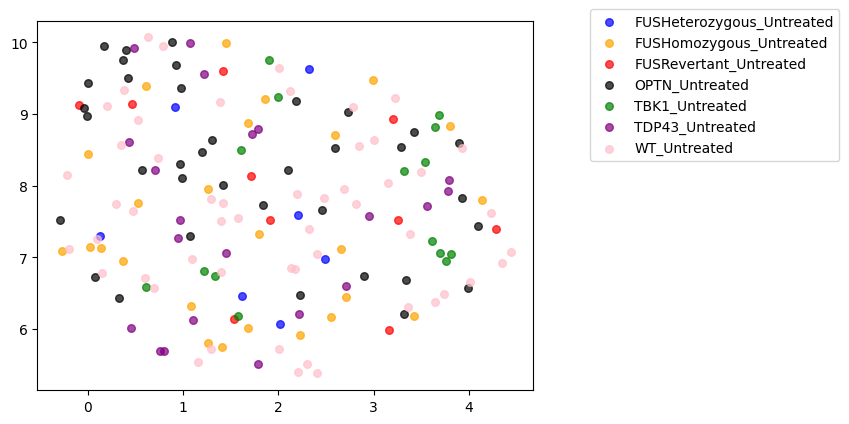

In [220]:
#B5
# ALS Lines all markers - Shuffled labels
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (7, 256)
class: FUSHomozygous_Untreated, shappe: (23, 256)
class: FUSRevertant_Untreated, shappe: (14, 256)
class: OPTN_Untreated, shappe: (72, 256)
class: TBK1_Untreated, shappe: (34, 256)
class: TDP43_Untreated, shappe: (18, 256)
class: WT_Untreated, shappe: (102, 256)


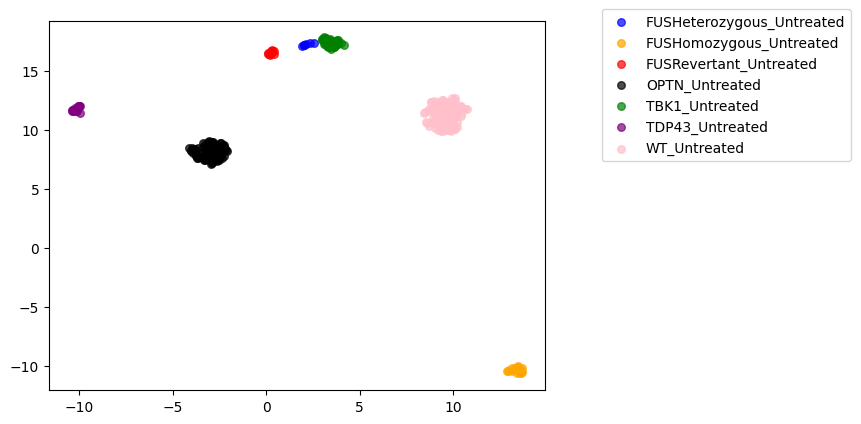

In [214]:
#B5
# ALS Lines all markers 
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (58, 256)
class: WT_stress, shappe: (66, 256)


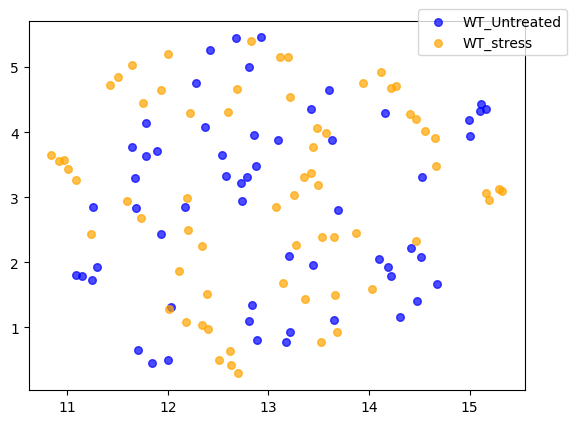

In [205]:
#B5
# WT stress Vs Untreated all markers - shuffled labels
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (51, 256)
class: WT_stress, shappe: (54, 256)


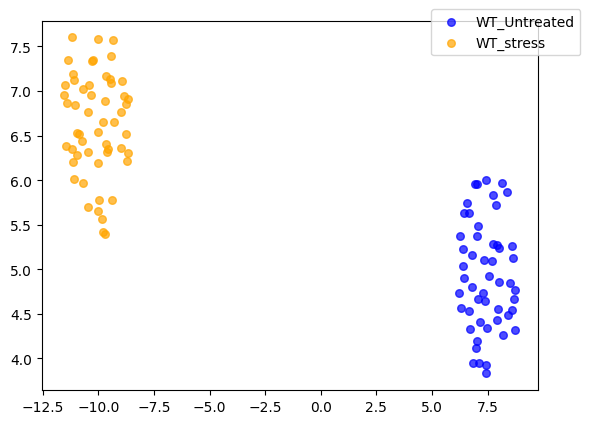

In [199]:
#B5
# WT stress Vs Untreated all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (52, 256)
class: WT_stress, shappe: (54, 256)


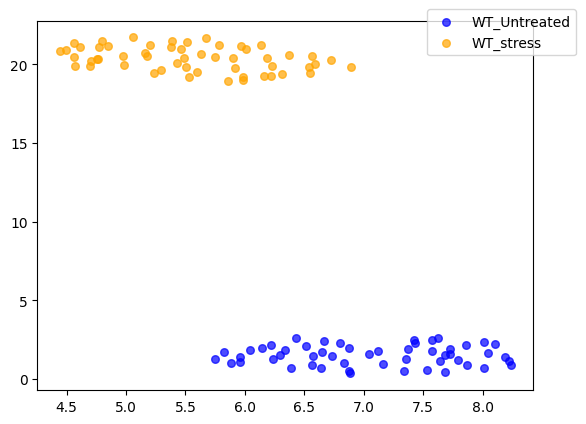

In [193]:
#B4
# WT stress Vs Untreated all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (312, 256)
class: WT_stress, shappe: (191, 256)


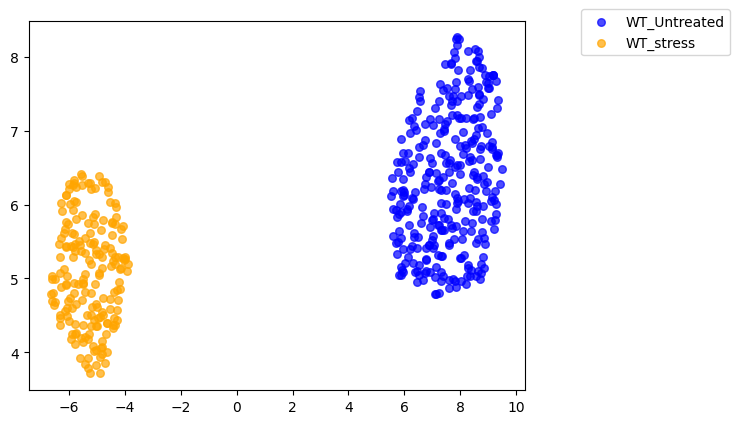

In [175]:
#B9
# WT stress Vs Untreated all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (158, 256)
class: FUSHomozygous_Untreated, shappe: (560, 256)
class: FUSRevertant_Untreated, shappe: (274, 256)
class: OPTN_Untreated, shappe: (172, 256)
class: TBK1_Untreated, shappe: (563, 256)
class: TDP43_Untreated, shappe: (271, 256)
class: WT_Untreated, shappe: (385, 256)


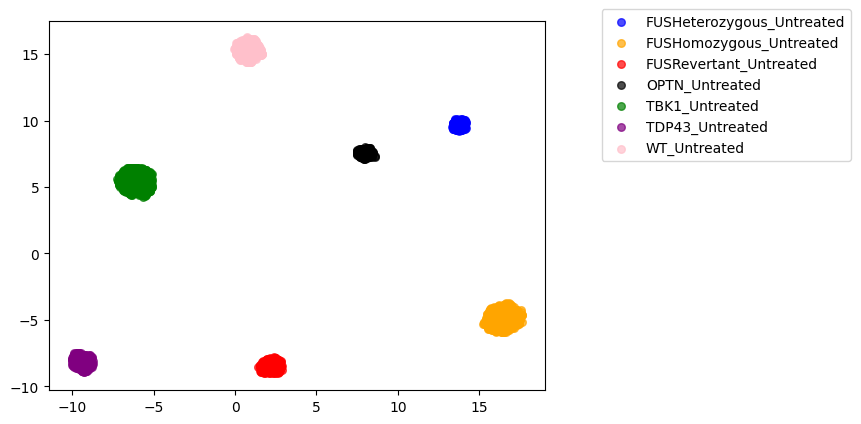

In [171]:
#B9
# ALS lines all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (120, 256)
class: FUSHomozygous_Untreated, shappe: (273, 256)
class: FUSRevertant_Untreated, shappe: (224, 256)
class: OPTN_Untreated, shappe: (105, 256)
class: TBK1_Untreated, shappe: (285, 256)
class: TDP43_Untreated, shappe: (248, 256)
class: WT_Untreated, shappe: (198, 256)


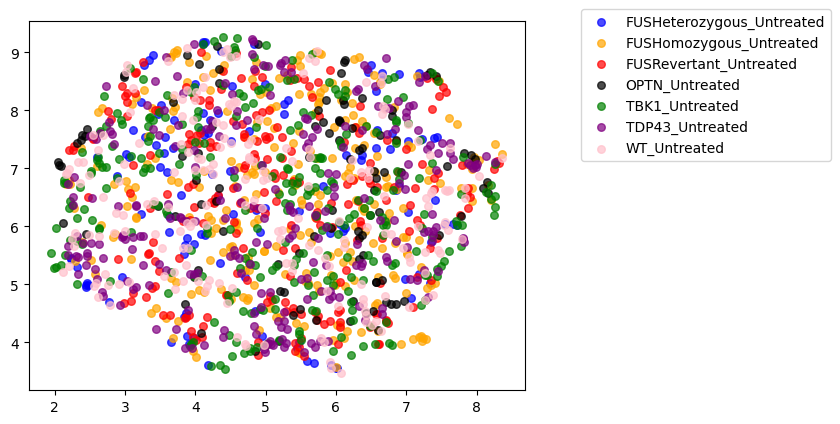

In [164]:
#B6
# ALS lines all markers - shuffled labels
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (289, 256)
class: WT_stress, shappe: (387, 256)


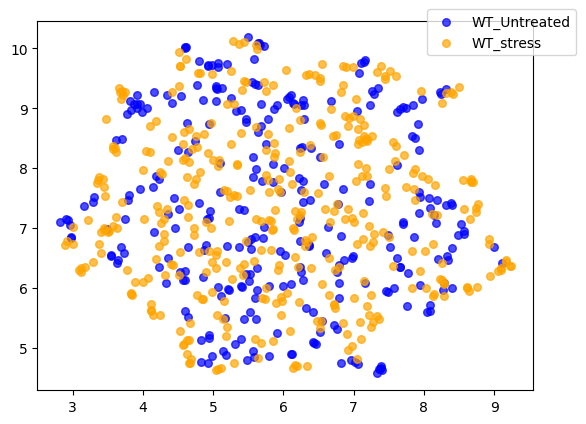

In [158]:
#B6
# WT stress vs Untreated all markers - shuffled labels
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (81, 256)
class: FUSHomozygous_Untreated, shappe: (443, 256)
class: FUSRevertant_Untreated, shappe: (278, 256)
class: OPTN_Untreated, shappe: (76, 256)
class: TBK1_Untreated, shappe: (400, 256)
class: TDP43_Untreated, shappe: (199, 256)
class: WT_Untreated, shappe: (270, 256)


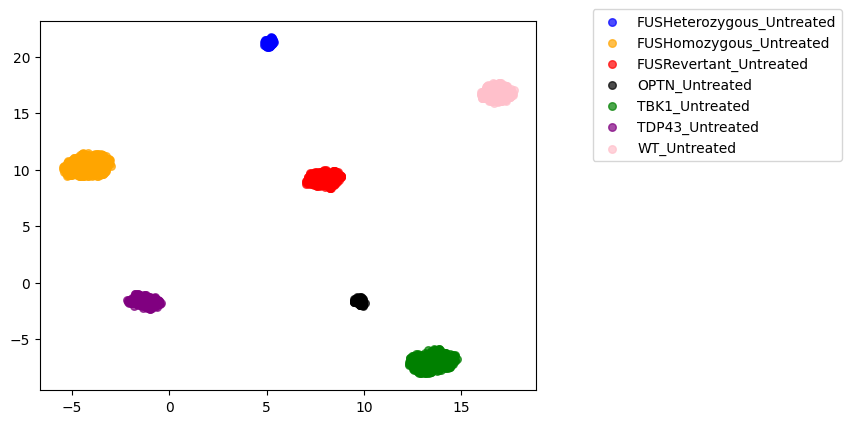

In [147]:
#B6

# ALS lines all markers
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (68, 256)
class: WT_stress, shappe: (68, 256)


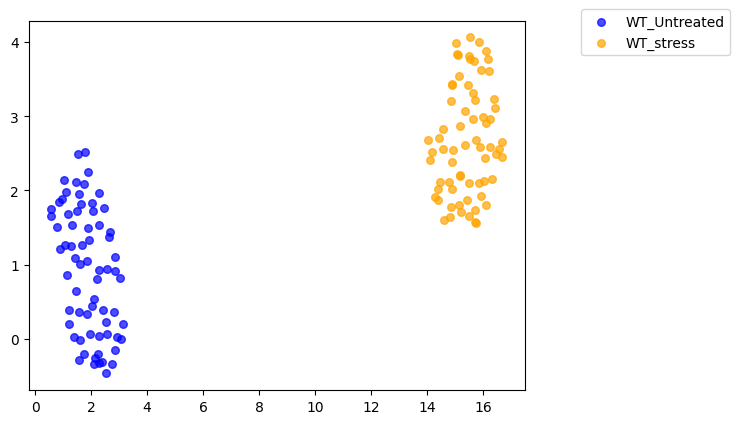

In [139]:
#B6

# WT stress untreated all markers

plot_umap_all_conditions(preds_array, lbls_array)

rows stacking

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (242, 256)
class: WT_stress, shappe: (268, 256)


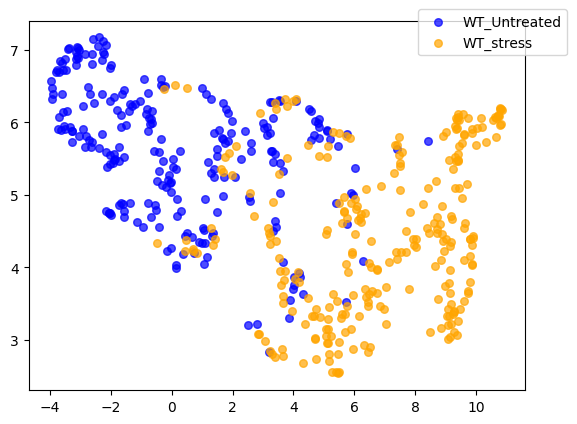

In [108]:
# WT stress untreated only the markers: G3BP1, PURA, PML, LAMP1

plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (67, 256)
class: FUSHomozygous_Untreated, shappe: (457, 256)
class: FUSRevertant_Untreated, shappe: (202, 256)
class: OPTN_Untreated, shappe: (65, 256)
class: TBK1_Untreated, shappe: (285, 256)
class: TDP43_Untreated, shappe: (142, 256)
class: WT_Untreated, shappe: (179, 256)


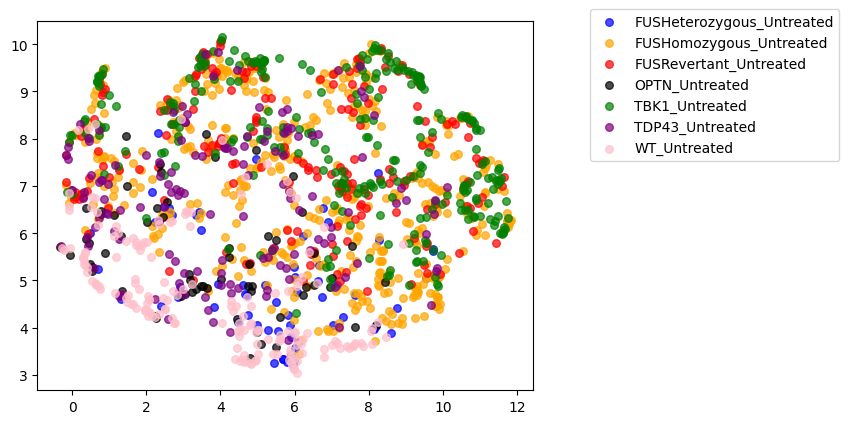

In [38]:
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (80, 256)
class: FUSHomozygous_Untreated, shappe: (519, 256)
class: FUSRevertant_Untreated, shappe: (265, 256)
class: WT_Untreated, shappe: (248, 256)


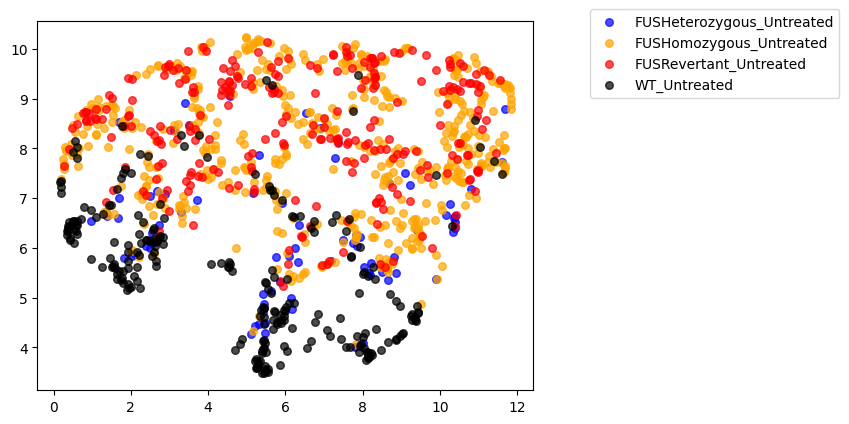

In [51]:
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: WT_Untreated, shappe: (243, 256)
class: WT_stress, shappe: (393, 256)


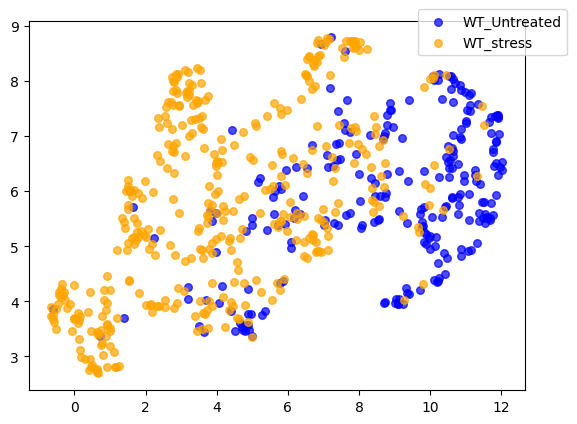

In [73]:
plot_umap_all_conditions(preds_array, lbls_array)

columns stacking... (oops)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: FUSHeterozygous_Untreated, shappe: (53, 256)
class: FUSHomozygous_Untreated, shappe: (440, 256)
class: FUSRevertant_Untreated, shappe: (198, 256)
class: OPTN_Untreated, shappe: (68, 256)
class: TBK1_Untreated, shappe: (321, 256)
class: TDP43_Untreated, shappe: (155, 256)
class: WT_Untreated, shappe: (172, 256)


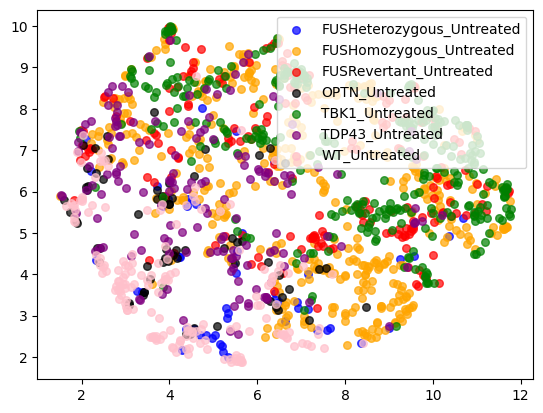

In [25]:
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: 0, shappe: (81, 256)
class: 1, shappe: (512, 256)
class: 2, shappe: (260, 256)
class: 3, shappe: (252, 256)


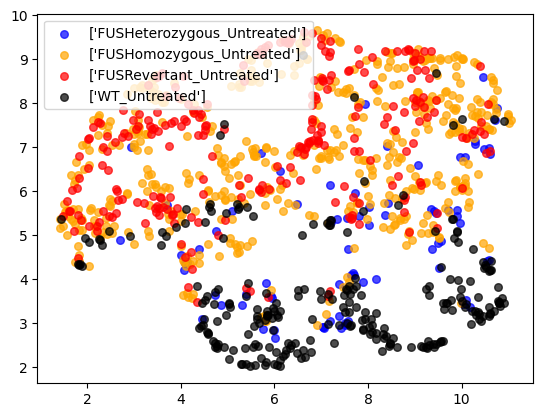

In [19]:
plot_umap_all_conditions(preds_array, lbls_array)

/home/labs/hornsteinlab/sagyk/anaconda3/envs/momapsD/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


class: 0, shappe: (243, 256)
class: 1, shappe: (407, 256)


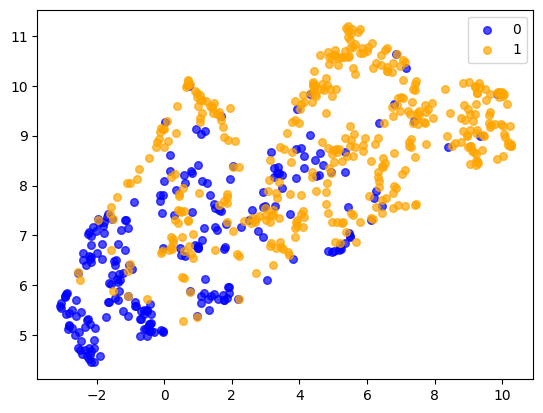

In [5]:
plot_umap_all_conditions(preds_array, lbls_array)

In [58]:

# import itertools
# from collections import defaultdict

# def organize_paths(root_paths):
#     organized_paths = defaultdict(lambda: defaultdict(list))
#     for path in root_paths:
#         parts = path.split(os.sep)
#         root = os.path.join(parts[-4], parts[-3])
#         subfolder = parts[-2]
#         organized_paths[root][subfolder].append(path)
#     return organized_paths


# def create_index_mapping(organized_paths):
#     index_mapping = []
#     root_mapping = []
#     for root, subfolders in organized_paths.items():
#         num_files = min(len(files) for files in subfolders.values())
#         for i in range(num_files):
#             combo = []
#             for subfolder, files in subfolders.items():
#                 combo.append(files[i % len(files)])
#             if i >= len(index_mapping):
#                 index_mapping.append([])
#                 root_mapping.append([])
#             index_mapping[i].append(combo)
#             root_mapping[i].append(root.replace(os.sep,'_'))
            
#     index_mapping = flat_list_of_lists(index_mapping)
#     root_mapping = flat_list_of_lists(root_mapping)
#     return index_mapping, root_mapping

# x_paths = dataset.X_paths.copy()
# np.random.shuffle(x_paths)
# k = organize_paths(x_paths)

# def flat_list_of_lists(l):
#     return [item for sublist in l for item in sublist]

# kk,lbls = create_index_mapping(k)
# # lbls = k.keys()
# # lbls
# # lbls
# # len(kk[0])

# # print(len(x_paths))
# # len(flat_list_of_lists(flat_list_of_lists(kk)))

# # len(np.unique(flat_list_of_lists(flat_list_of_lists(kk)))), len(flat_list_of_lists(flat_list_of_lists(kk)))

# # x_paths, flat_list_of_lists(flat_list_of_lists(kk)) / 4
# # len(flat_list_of_lists(flat_list_of_lists(kk))) == len(x_paths)
# # create_index_mapping(organize_paths([p.replace('/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch7', '') for p in dataset.X_paths]))

In [59]:
kk[10], lbls[10]

(['/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch7/FUSHeterozygous/Untreated/Phalloidin/rep1_R11_w4confGFP_s1210_panelC_FUSHeterozygous_processed.npy',
  '/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch7/FUSHeterozygous/Untreated/FUS/rep2_R11_w2confmCherry_s407_panelG_FUSHeterozygous_processed.npy',
  '/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch7/FUSHeterozygous/Untreated/PURA/rep1_R11_w4confGFP_s1252_panelA_FUSHeterozygous_processed.npy',
  '/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch7/FUSHeterozygous/Untreated/G3BP1/rep1_R11_w3confCy5_s1243_panelA_FUSHeterozygous_processed.npy'],
 'FUSHeterozygous_Untreated')